In [1]:
import pandas as pd
import numpy as np

In [2]:
mrtDf = pd.read_csv("data\mrt_lrt_data.csv")

In [3]:
mrtDf.head()

,station_name,type,lat,lng
0,Jurong East,MRT,1.333207,103.742308
1,Bukit Batok,MRT,1.349069,103.749596
2,Bukit Gombak,MRT,1.359043,103.751863
3,Choa Chu Kang,MRT,1.385417,103.744316
4,Yew Tee,MRT,1.397383,103.747523


In [4]:
mrtDf.describe()

,lat,lng
count,157.000000,157.000000
mean,1.345080,103.841362
std,0.044289,0.068544
min,1.265453,103.636866
25%,1.308474,103.790046
50%,1.337649,103.851550
75%,1.384116,103.893133
max,1.449133,103.988487


In [5]:
resale_bus = pd.read_csv("data/fixed_resale_with_bus.csv")

In [6]:
resale_bus.head()

,index,month,town,flat_type,block,street_name,storey_range,floor_area_sqm,flat_model,lease_commence_date,resale_price,busstops
0,0,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,10 TO 12,31.0,IMPROVED,1977,9000.0,0.0
1,1,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,04 TO 06,31.0,IMPROVED,1977,6000.0,0.0
2,2,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,10 TO 12,31.0,IMPROVED,1977,8000.0,0.0
3,3,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,07 TO 09,31.0,IMPROVED,1977,6000.0,0.0
4,4,1990-01,ANG MO KIO,3 ROOM,216,ANG MO KIO AVE 1,04 TO 06,73.0,NEW GENERATION,1976,47200.0,1.0


In [7]:
resale_bus.shape

(656851, 12)

In [8]:
# distance function between 2 latitude points
from math import cos, asin, sqrt, pi

# from https://stackoverflow.com/questions/27928/calculate-distance-between-two-latitude-longitude-points-haversine-formula
def distance(lat1, lon1, lat2, lon2):
    p = pi/180
    a = 0.5 - cos((lat2-lat1)*p)/2 + cos(lat1*p) * cos(lat2*p) * (1-cos((lon2-lon1)*p))/2
    return 12742 * asin(sqrt(a)) #2*R*asin... taking radius of earth * 2 = 6371 * 2

In [9]:
unique_geopos = pd.read_csv('data/unique_geopos.csv')
unique_geopos = unique_geopos.drop(columns=['Unnamed: 0.1'])
unique_geopos.head()

,Unnamed: 0,block,street_name,town,postal,lat,long
0,0,309,ANG MO KIO AVE 1,ANG MO KIO,NaN,NaN,NaN
1,1,216,ANG MO KIO AVE 1,ANG MO KIO,560216.0,1.366197,103.841505
2,2,211,ANG MO KIO AVE 3,ANG MO KIO,560211.0,1.369197,103.841667
3,3,202,ANG MO KIO AVE 3,ANG MO KIO,560202.0,1.368446,103.844516
4,4,235,ANG MO KIO AVE 3,ANG MO KIO,560235.0,1.366824,103.836491


In [11]:
resale_bus['lat'] = resale_bus.apply(lambda row: unique_geopos.loc[(unique_geopos['town'] == row['town']) & (unique_geopos['street_name'] == row['street_name']) & (unique_geopos['block'] == row['block'])]['lat'].item() , axis=1)

In [13]:
resale_bus['long'] = resale_bus.apply(lambda row: unique_geopos.loc[(unique_geopos['town'] == row['town']) & (unique_geopos['street_name'] == row['street_name']) & (unique_geopos['block'] == row['block'])]['long'].item() , axis=1)

In [18]:
resale_bus.head()

,index,month,town,flat_type,block,street_name,storey_range,floor_area_sqm,flat_model,lease_commence_date,resale_price,busstops,lat,long
0,0,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,10 TO 12,31.0,IMPROVED,1977,9000.0,0.0,NaN,NaN
1,1,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,04 TO 06,31.0,IMPROVED,1977,6000.0,0.0,NaN,NaN
2,2,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,10 TO 12,31.0,IMPROVED,1977,8000.0,0.0,NaN,NaN
3,3,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,07 TO 09,31.0,IMPROVED,1977,6000.0,0.0,NaN,NaN
4,4,1990-01,ANG MO KIO,3 ROOM,216,ANG MO KIO AVE 1,04 TO 06,73.0,NEW GENERATION,1976,47200.0,1.0,1.366197,103.841505


In [21]:
busMrtDf = pd.read_csv('data/fix_resale_with_mrt_bus.csv')
busMrtDf = busMrtDf.drop(columns=['Unnamed: 0'])

In [23]:
busMrtDf['lat'] = resale_bus['lat']
busMrtDf['long'] = resale_bus['long']
busMrtDf.head()

,index,month,town,flat_type,block,street_name,storey_range,floor_area_sqm,flat_model,lease_commence_date,resale_price,busstops,mrt,lrt,lat,long
0,0,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,10 TO 12,31.0,IMPROVED,1977,9000.0,0.0,0,0,NaN,NaN
1,1,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,04 TO 06,31.0,IMPROVED,1977,6000.0,0.0,0,0,NaN,NaN
2,2,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,10 TO 12,31.0,IMPROVED,1977,8000.0,0.0,0,0,NaN,NaN
3,3,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,07 TO 09,31.0,IMPROVED,1977,6000.0,0.0,0,0,NaN,NaN
4,4,1990-01,ANG MO KIO,3 ROOM,216,ANG MO KIO AVE 1,04 TO 06,73.0,NEW GENERATION,1976,47200.0,1.0,0,0,1.366197,103.841505


In [24]:
busMrtDf.to_csv('data/resale_mrt_bus_geo.csv')

In [28]:
finalDf = pd.read_csv('data/resale_mrt_bus_geo.csv')

In [29]:
finalDf = finalDf.drop(columns=['Unnamed: 0', 'index'])
finalDf.head()

,month,town,flat_type,block,street_name,storey_range,floor_area_sqm,flat_model,lease_commence_date,resale_price,busstops,mrt,lrt,lat,long
0,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,10 TO 12,31.0,IMPROVED,1977,9000.0,0.0,0,0,NaN,NaN
1,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,04 TO 06,31.0,IMPROVED,1977,6000.0,0.0,0,0,NaN,NaN
2,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,10 TO 12,31.0,IMPROVED,1977,8000.0,0.0,0,0,NaN,NaN
3,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,07 TO 09,31.0,IMPROVED,1977,6000.0,0.0,0,0,NaN,NaN
4,1990-01,ANG MO KIO,3 ROOM,216,ANG MO KIO AVE 1,04 TO 06,73.0,NEW GENERATION,1976,47200.0,1.0,0,0,1.366197,103.841505


In [31]:
mallDf = pd.read_csv('data/test_malls.csv')
mallDf.head()

,index,Malls,postal,lat,long
0,0,321 Clementi,129905.0,1.312025,103.764961
1,1,Cathay Cineleisure Orchard,239695.0,1.301497,103.836445
2,2,GV Yishun,768794.0,1.429916,103.836473
3,3,The Cathay,229233.0,1.299202,103.847832
4,4,888 Plaza,730888.0,1.437131,103.795290


In [49]:
# vectorised version of calulcation
def haversine(lat1, lon1, lat2, lon2):
    MILES = 3959
    lat1, lon1, lat2, lon2 = map(np.deg2rad, [lat1, lon1, lat2, lon2])
    dlat = lat2 - lat1 
    dlon = lon2 - lon1 
    a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    c = 2 * np.arcsin(np.sqrt(a)) 
    total_miles = MILES * c
    total_km = total_miles * 1.609
    return total_km

In [61]:
def add_mall(finalDf, mallDf):
    ret = []
    tempDf = mallDf
    for index, row in finalDf.iterrows():
        tempDf['distance'] = haversine(row['lat'], row['long'], mallDf['lat'], mallDf['long'])
        count = np.sum(tempDf['distance'] <= 1.00)
        print(count, row['street_name'], row['block'], index)
        ret.append(count)
    return ret
    

In [62]:
mall_near = add_mall(finalDf, mallDf)

0 ANG MO KIO AVE 1 309 0
0 ANG MO KIO AVE 1 309 1
0 ANG MO KIO AVE 1 309 2
0 ANG MO KIO AVE 1 309 3
1 ANG MO KIO AVE 1 216 4
1 ANG MO KIO AVE 3 211 5
1 ANG MO KIO AVE 3 202 6
0 ANG MO KIO AVE 3 235 7
0 ANG MO KIO AVE 3 235 8
0 ANG MO KIO AVE 3 232 9
0 ANG MO KIO AVE 3 232 10
1 ANG MO KIO AVE 1 308 11
1 ANG MO KIO AVE 1 308 12
1 ANG MO KIO AVE 1 220 13
1 ANG MO KIO AVE 1 219 14
0 ANG MO KIO AVE 3 247 15
1 ANG MO KIO AVE 1 320 16
0 ANG MO KIO AVE 4 252 17
0 ANG MO KIO AVE 1 223 18
0 ANG MO KIO AVE 1 223 19
0 ANG MO KIO AVE 3 230 20
1 ANG MO KIO AVE 3 329 21
1 ANG MO KIO AVE 3 313 22
0 ANG MO KIO AVE 4 117 23
0 ANG MO KIO AVE 4 110 24
1 ANG MO KIO AVE 3 343 25
1 ANG MO KIO AVE 3 345 26
1 ANG MO KIO AVE 3 346 27
1 ANG MO KIO AVE 3 121 28
1 ANG MO KIO AVE 3 129 29
1 ANG MO KIO AVE 3 130 30
1 ANG MO KIO AVE 3 128 31
1 ANG MO KIO AVE 3 127 32
1 ANG MO KIO AVE 3 126 33
0 ANG MO KIO AVE 10 403 34
0 ANG MO KIO AVE 10 404 35
0 ANG MO KIO AVE 10 405 36
1 ANG MO KIO AVE 10 417 37
1 ANG MO KIO AVE 1

1 BT BATOK ST 21 216 387
1 BT BATOK WEST AVE 6 115 388
1 BT BATOK WEST AVE 6 115 389
1 BT BATOK WEST AVE 6 117 390
1 BT BATOK WEST AVE 6 111 391
1 BT BATOK CTRL 103 392
1 BT BATOK CTRL 103 393
1 BT BATOK EAST AVE 3 223 394
1 BT BATOK EAST AVE 3 223 395
1 BT BATOK EAST AVE 3 221 396
1 BT BATOK EAST AVE 3 221 397
1 BT BATOK ST 21 214 398
1 BT BATOK CTRL 120 399
1 BT BATOK CTRL 121 400
1 BT BATOK ST 11 142 401
1 BT BATOK ST 11 140 402
1 BT BATOK EAST AVE 3 223 403
1 BT BATOK EAST AVE 3 223 404
1 BT BATOK EAST AVE 3 221 405
1 BT BATOK ST 21 214 406
1 BT BATOK ST 21 214 407
1 BT BATOK CTRL 121 408
1 BT BATOK ST 11 141 409
0 TAMAN HO SWEE 33 410
0 TAMAN HO SWEE 33 411
0 TAMAN HO SWEE 33 412
0 TELOK BLANGAH CRES 7 413
0 TELOK BLANGAH CRES 7 414
2 BEO CRES 40 415
0 TELOK BLANGAH DR 44 416
0 TELOK BLANGAH DR 44 417
1 TELOK BLANGAH DR 46 418
1 DEPOT RD 103 419
2 DEPOT RD 110 420
2 DEPOT RD 110 421
2 TELOK BLANGAH RISE 42 422
2 TELOK BLANGAH RISE 42 423
1 JLN BT MERAH 132 424
1 JLN BT MERAH 132 4

2 LOR AH SOO 138 754
2 LOR AH SOO 140 755
1 LOR AH SOO 135 756
1 HOUGANG AVE 1 234 757
1 HOUGANG ST 21 231 758
0 LOR AH SOO 133 759
1 HOUGANG AVE 3 16 760
1 HOUGANG ST 21 237 761
1 HOUGANG ST 21 237 762
2 LOR AH SOO 128 763
2 LOR AH SOO 132 764
1 HOUGANG ST 21 237 765
2 LOR AH SOO 141 766
0 TEBAN GDNS RD 3 767
0 TEBAN GDNS RD 5 768
0 TEBAN GDNS RD 10 769
0 TEBAN GDNS RD 10 770
0 TEBAN GDNS RD 10 771
0 TEBAN GDNS RD 21 772
0 TEBAN GDNS RD 33 773
0 TEBAN GDNS RD 33 774
0 TEBAN GDNS RD 33 775
0 TEBAN GDNS RD 40 776
0 JURONG EAST AVE 1 329 777
0 JURONG EAST ST 32 308 778
0 JURONG EAST ST 32 308 779
0 JURONG EAST ST 32 308 780
0 JURONG EAST ST 32 308 781
5 JURONG EAST ST 13 101 782
0 JURONG EAST ST 32 302 783
0 JURONG EAST ST 32 302 784
4 JURONG EAST ST 21 233 785
2 JURONG EAST ST 13 110 786
2 JURONG EAST ST 24 247 787
3 JURONG EAST ST 24 244 788
3 JURONG EAST ST 24 242 789
2 JURONG EAST ST 24 243 790
2 JURONG EAST ST 24 243 791
0 JURONG EAST ST 24 257 792
0 JURONG EAST ST 24 264 793
0 JURO

2 MEI LING ST 160 1112
2 MEI LING ST 160 1113
2 MEI LING ST 161 1114
3 HOLLAND CL 4 1115
3 HOLLAND CL 6 1116
3 HOLLAND CL 6 1117
3 HOLLAND CL 4 1118
3 HOLLAND CL 4 1119
3 HOLLAND CL 4 1120
3 HOLLAND CL 4 1121
3 HOLLAND AVE 8 1122
3 HOLLAND AVE 8 1123
3 HOLLAND AVE 9 1124
3 HOLLAND AVE 2 1125
3 HOLLAND AVE 2 1126
3 HOLLAND AVE 2 1127
3 HOLLAND AVE 2 1128
3 HOLLAND AVE 12 1129
3 HOLLAND AVE 12 1130
3 HOLLAND DR 11 1131
3 HOLLAND DR 11 1132
3 HOLLAND DR 11 1133
3 HOLLAND DR 13 1134
0 HOLLAND DR 16 1135
0 HOLLAND DR 16 1136
3 HOLLAND DR 42 1137
0 TANGLIN HALT RD 24 1138
0 C'WEALTH DR 60 1139
1 C'WEALTH CL 88 1140
1 C'WEALTH CL 86 1141
0 TANGLIN HALT RD 52 1142
1 C'WEALTH CL 82 1143
1 C'WEALTH CL 82 1144
1 C'WEALTH DR 89 1145
1 C'WEALTH DR 89 1146
1 C'WEALTH DR 93 1147
0 C'WEALTH DR 59 1148
0 C'WEALTH DR 63 1149
0 C'WEALTH DR 65 1150
0 C'WEALTH DR 65 1151
0 C'WEALTH DR 65 1152
0 C'WEALTH DR 66 1153
0 TANGLIN HALT RD 53 1154
0 C'WEALTH DR 74 1155
0 C'WEALTH DR 77 1156
0 C'WEALTH DR 77 1157
0

2 YISHUN AVE 5 740 1488
3 YISHUN ST 21 210 1489
3 YISHUN ST 21 205 1490
3 YISHUN ST 21 219 1491
3 YISHUN ST 21 219 1492
2 YISHUN ST 11 146 1493
3 YISHUN ST 21 220 1494
2 YISHUN ST 22 280 1495
2 YISHUN AVE 3 772 1496
2 YISHUN AVE 5 733 1497
3 YISHUN ST 11 154 1498
3 YISHUN ST 11 159 1499
3 YISHUN ST 11 161 1500
3 YISHUN ST 21 221 1501
3 YISHUN ST 21 231 1502
3 YISHUN ST 21 229 1503
3 YISHUN RING RD 238 1504
3 YISHUN RING RD 240 1505
3 YISHUN RING RD 326 1506
0 ANG MO KIO AVE 1 309 1507
0 ANG MO KIO AVE 1 309 1508
0 ANG MO KIO AVE 4 170 1509
1 ANG MO KIO AVE 3 212 1510
1 ANG MO KIO AVE 3 201 1511
1 ANG MO KIO AVE 3 202 1512
1 ANG MO KIO AVE 1 307 1513
0 ANG MO KIO AVE 3 247 1514
0 ANG MO KIO AVE 3 247 1515
0 ANG MO KIO AVE 4 255 1516
0 ANG MO KIO AVE 4 252 1517
0 ANG MO KIO AVE 2 248 1518
0 ANG MO KIO AVE 4 256 1519
0 ANG MO KIO AVE 1 223 1520
1 ANG MO KIO AVE 3 328 1521
1 ANG MO KIO AVE 3 301 1522
0 ANG MO KIO AVE 4 117 1523
0 ANG MO KIO AVE 4 118 1524
1 ANG MO KIO AVE 3 348 1525
1 ANG 

1 BT MERAH VIEW 128 1802
1 BT MERAH VIEW 128 1803
1 BT MERAH VIEW 130 1804
1 BT MERAH VIEW 119 1805
0 TELOK BLANGAH CRES 5 1806
1 HENDERSON CRES 105 1807
0 TELOK BLANGAH CRES 16 1808
3 JLN BT MERAH 2 1809
1 TELOK BLANGAH HTS 60 1810
1 TELOK BLANGAH HTS 60 1811
1 TELOK BLANGAH HTS 60 1812
1 TELOK BLANGAH DR 65 1813
3 EVERTON PK 6 1814
1 BT PURMEI RD 101 1815
1 REDHILL CL 1 1816
2 TAMAN HO SWEE 12 1817
2 JLN KLINIK 26 1818
2 HAVELOCK RD 22 1819
2 HAVELOCK RD 22 1820
3 JLN RUMAH TINGGI 37 1821
2 BEO CRES 36 1822
2 JLN BT HO SWEE 8 1823
0 TELOK BLANGAH WAY 34 1824
0 TELOK BLANGAH WAY 34 1825
1 HENDERSON CRES 106 1826
0 BT PURMEI RD 112 1827
2 TELOK BLANGAH HTS 68 1828
1 TELOK BLANGAH DR 51 1829
2 ZION RD 87 1830
3 LENGKOK BAHRU 47 1831
1 SPOTTISWOODE PK RD 104 1832
0 TELOK BLANGAH CRES 25 1833
0 QUEEN'S RD 3 1834
6 NEW MKT RD 32 1835
3 TG PAGAR PLAZA 2 1836
9 UPP CROSS ST 536 1837
10 UPP CROSS ST 532 1838
11 KELANTAN RD 30 1839
9 ROWELL RD 640 1840
7 TG PAGAR PLAZA 7 1841
9 ROWELL RD 641 1

0 HOLLAND DR 16 2191
1 HOLLAND DR 17 2192
3 HOLLAND DR 41 2193
3 HOLLAND DR 41 2194
0 C'WEALTH DR 60 2195
1 C'WEALTH CL 82 2196
1 C'WEALTH CL 82 2197
1 C'WEALTH DR 90 2198
0 C'WEALTH DR 59 2199
0 TANGLIN HALT RD 54 2200
0 TANGLIN HALT RD 54 2201
0 C'WEALTH DR 76 2202
1 C'WEALTH CRES 108 2203
0 TANGLIN HALT RD 25 2204
0 TANGLIN HALT RD 25 2205
1 C'WEALTH CRES 97 2206
0 TANGLIN HALT RD 26 2207
2 MEI LING ST 161 2208
3 HOLLAND AVE 8 2209
2 DOVER CRES 26 2210
2 DOVER CL EAST 14 2211
0 SELETAR WEST FARMWAY 6 5 2212
2 LOR LEW LIAN 1 2213
0 SERANGOON NTH AVE 1 106 2214
0 SERANGOON NTH AVE 1 105 2215
1 SERANGOON AVE 2 303 2216
1 SERANGOON AVE 4 225 2217
2 SERANGOON AVE 4 223 2218
2 SERANGOON AVE 4 217 2219
2 SERANGOON AVE 4 219 2220
2 SERANGOON AVE 4 226 2221
2 SERANGOON AVE 4 224 2222
0 SERANGOON NTH AVE 1 115 2223
0 SERANGOON NTH AVE 1 113 2224
0 SERANGOON NTH AVE 1 111 2225
2 SERANGOON AVE 4 227 2226
1 SERANGOON AVE 4 230 2227
2 SERANGOON AVE 4 218 2228
0 SERANGOON NTH AVE 1 117 2229
1 SERA

0 BEDOK NTH RD 77 2578
4 BEDOK NTH ST 3 501 2579
4 BEDOK NTH ST 3 501 2580
4 BEDOK NTH ST 3 501 2581
4 BEDOK STH AVE 1 4 2582
4 BEDOK STH AVE 1 1 2583
3 CHAI CHEE RD 19 2584
4 CHAI CHEE AVE 36 2585
4 CHAI CHEE AVE 36 2586
4 CHAI CHEE AVE 32 2587
4 CHAI CHEE AVE 32 2588
4 CHAI CHEE AVE 37 2589
0 CHAI CHEE RD 59 2590
4 BEDOK STH AVE 1 22 2591
0 BEDOK NTH AVE 4 103 2592
0 BEDOK NTH AVE 4 102 2593
1 BEDOK NTH RD 107 2594
3 BEDOK NTH RD 109 2595
0 BEDOK NTH RD 83 2596
1 BEDOK NTH RD 115 2597
1 BEDOK NTH RD 125 2598
1 BEDOK NTH ST 2 126 2599
3 BEDOK NTH ST 2 122 2600
3 BEDOK NTH ST 2 122 2601
0 BEDOK NTH AVE 4 100 2602
0 BEDOK NTH AVE 4 100 2603
4 BEDOK NTH AVE 2 412 2604
4 BEDOK NTH AVE 3 402 2605
4 BEDOK NTH AVE 3 401 2606
4 BEDOK NTH AVE 2 418 2607
4 BEDOK NTH ST 1 420 2608
4 BEDOK NTH ST 1 419 2609
0 BEDOK NTH ST 3 528 2610
0 BEDOK NTH ST 3 528 2611
2 BEDOK NTH ST 3 530 2612
4 BEDOK NTH AVE 1 522 2613
4 BEDOK NTH ST 1 202 2614
4 BEDOK NTH ST 1 201 2615
4 BEDOK NTH ST 1 218 2616
0 BEDOK N

1 CLEMENTI WEST ST 2 717 2900
1 CLEMENTI AVE 6 203 2901
2 ALJUNIED CRES 109 2902
0 CIRCUIT RD 63 2903
0 MACPHERSON LANE 81 2904
0 MACPHERSON LANE 81 2905
0 MACPHERSON LANE 81 2906
0 CIRCUIT RD 40 2907
0 CIRCUIT RD 43 2908
0 JLN PASAR BARU 1 2909
0 JLN PASAR BARU 1 2910
5 GEYLANG SERAI 2 2911
0 BALAM RD 32 2912
4 HAIG RD 10 2913
5 HAIG RD 1 2914
0 EUNOS CRES 19 2915
0 EUNOS CRES 19 2916
0 EUNOS CRES 24 2917
0 EUNOS CRES 20 2918
0 SIMS DR 54 2919
0 SIMS DR 54 2920
0 SIMS DR 54 2921
3 ALJUNIED CRES 97 2922
0 SIMS DR 41 2923
0 ALJUNIED CRES 101 2924
1 ALJUNIED CRES 99 2925
2 ALJUNIED CRES 108 2926
0 CIRCUIT RD 66 2927
0 CIRCUIT RD 64 2928
0 BALAM RD 21 2929
0 BALAM RD 19 2930
0 MACPHERSON LANE 82 2931
1 CIRCUIT RD 69 2932
0 CIRCUIT RD 39 2933
0 CIRCUIT RD 36 2934
0 BALAM RD 32 2935
4 GEYLANG EAST AVE 1 126 2936
1 DAKOTA CRES 58 2937
0 UBI AVE 1 323 2938
2 EUNOS CRES 9 2939
0 SIMS DR 62 2940
0 PAYA LEBAR WAY 121 2941
0 PAYA LEBAR WAY 122 2942
0 UBI AVE 1 323 2943
0 UBI AVE 1 349 2944
0 UBI 

3 MARINE DR 75 3233
3 MARINE DR 75 3234
3 MARINE DR 74 3235
0 MARINE TER 54 3236
2 MARINE CRES 27 3237
3 MARINE DR 79 3238
3 MARINE DR 77 3239
3 MARINE DR 77 3240
0 MARINE TER 3 3241
0 MARINE TER 2 3242
0 MARINE TER 12 3243
1 C'WEALTH CL 82 3244
1 C'WEALTH CL 82 3245
1 C'WEALTH CL 83 3246
1 C'WEALTH CL 83 3247
0 TANGLIN HALT RD 53 3248
0 TANGLIN HALT RD 28 3249
0 C'WEALTH DR 55 3250
0 TANGLIN HALT RD 37 3251
0 TANGLIN HALT RD 33 3252
0 TANGLIN HALT RD 33 3253
0 TANGLIN HALT RD 34 3254
0 TANGLIN HALT RD 26 3255
0 TANGLIN HALT RD 44 3256
0 C'WEALTH DR 58 3257
0 MARGARET DR 96 3258
0 MARGARET DR 96 3259
3 GHIM MOH RD 6 3260
3 GHIM MOH RD 5 3261
3 GHIM MOH RD 5 3262
3 GHIM MOH RD 4 3263
3 GHIM MOH RD 3 3264
3 GHIM MOH RD 3 3265
3 GHIM MOH RD 2 3266
3 GHIM MOH RD 2 3267
3 GHIM MOH RD 2 3268
3 GHIM MOH RD 2 3269
3 GHIM MOH RD 1 3270
2 DOVER CRES 20 3271
0 GHIM MOH RD 10 3272
3 GHIM MOH RD 21 3273
2 MEI LING ST 152 3274
2 MEI LING ST 153 3275
2 STIRLING RD 171 3276
2 STIRLING RD 169 3277
2 ST

0 ANG MO KIO AVE 10 476 3633
0 ANG MO KIO AVE 10 476 3634
1 ANG MO KIO AVE 3 571 3635
1 ANG MO KIO AVE 3 570 3636
1 ANG MO KIO AVE 3 585 3637
1 ANG MO KIO AVE 3 586 3638
1 ANG MO KIO AVE 3 586 3639
1 ANG MO KIO AVE 3 584 3640
0 ANG MO KIO AVE 10 454 3641
0 ANG MO KIO AVE 10 463 3642
0 ANG MO KIO AVE 10 463 3643
0 ANG MO KIO AVE 10 461 3644
0 ANG MO KIO AVE 3 565 3645
1 ANG MO KIO AVE 10 576 3646
1 ANG MO KIO AVE 10 578 3647
0 ANG MO KIO AVE 10 559 3648
0 ANG MO KIO AVE 10 556 3649
1 ANG MO KIO AVE 10 534 3650
1 ANG MO KIO AVE 10 536 3651
0 ANG MO KIO AVE 5 604 3652
0 ANG MO KIO AVE 5 605 3653
1 ANG MO KIO AVE 8 505 3654
1 ANG MO KIO AVE 8 507 3655
1 ANG MO KIO AVE 8 509 3656
0 ANG MO KIO AVE 4 610 3657
0 ANG MO KIO AVE 4 610 3658
0 ANG MO KIO AVE 4 644 3659
0 ANG MO KIO AVE 4 644 3660
0 ANG MO KIO AVE 4 644 3661
0 ANG MO KIO AVE 6 646 3662
1 ANG MO KIO AVE 10 541 3663
0 ANG MO KIO AVE 10 542 3664
0 ANG MO KIO AVE 10 549 3665
0 ANG MO KIO AVE 9 623 3666
0 ANG MO KIO AVE 9 625 3667
0 ANG

2 TECK WHYE AVE 10 3964
2 TECK WHYE AVE 10 3965
2 TECK WHYE AVE 10 3966
2 TECK WHYE LANE 16 3967
3 TECK WHYE LANE 26 3968
3 TECK WHYE LANE 26 3969
3 TECK WHYE LANE 26 3970
1 TECK WHYE LANE 19 3971
2 TECK WHYE LANE 15 3972
3 TECK WHYE LANE 26 3973
1 TECK WHYE LANE 17 3974
2 CLEMENTI WEST ST 1 610 3975
1 CLEMENTI WEST ST 1 611 3976
1 CLEMENTI WEST ST 1 612 3977
3 WEST COAST DR 509 3978
2 CLEMENTI AVE 2 364 3979
2 CLEMENTI AVE 3 429 3980
2 CLEMENTI AVE 3 428 3981
3 CLEMENTI AVE 3 426 3982
2 CLEMENTI AVE 2 329 3983
2 CLEMENTI AVE 2 329 3984
2 CLEMENTI AVE 5 323 3985
2 CLEMENTI AVE 5 323 3986
2 CLEMENTI AVE 5 326 3987
2 CLEMENTI AVE 5 327 3988
2 CLEMENTI AVE 5 327 3989
2 CLEMENTI AVE 4 312 3990
2 CLEMENTI AVE 4 311 3991
2 CLEMENTI AVE 4 311 3992
2 CLEMENTI AVE 2 352 3993
0 CLEMENTI AVE 1 403 3994
0 CLEMENTI AVE 1 402 3995
0 CLEMENTI AVE 1 401 3996
2 CLEMENTI AVE 4 320 3997
2 CLEMENTI AVE 4 319 3998
2 CLEMENTI AVE 4 319 3999
1 CLEMENTI AVE 4 309 4000
1 CLEMENTI AVE 4 308 4001
1 CLEMENTI AVE 

3 MARINE DR 73 4344
3 MARINE DR 71 4345
3 MARINE DR 79 4346
0 MARINE TER 3 4347
0 MARINE TER 3 4348
0 MARINE TER 1 4349
0 MARINE TER 1 4350
0 MARINE TER 12 4351
0 C'WEALTH DR 62 4352
1 C'WEALTH CL 81 4353
0 C'WEALTH DR 63 4354
0 TANGLIN HALT RD 54 4355
0 TANGLIN HALT RD 28 4356
0 TANGLIN HALT RD 29 4357
0 C'WEALTH DR 56 4358
0 TANGLIN HALT RD 45 4359
0 TANGLIN HALT RD 40 4360
0 TANGLIN HALT RD 31 4361
0 C'WEALTH DR 58 4362
3 GHIM MOH RD 6 4363
3 GHIM MOH RD 5 4364
3 GHIM MOH RD 5 4365
3 GHIM MOH RD 4 4366
3 GHIM MOH RD 2 4367
0 DOVER CRES 24 4368
3 GHIM MOH RD 21 4369
3 GHIM MOH RD 19 4370
2 MEI LING ST 153 4371
2 MEI LING ST 153 4372
2 MEI LING ST 153 4373
2 MEI LING ST 162 4374
2 STIRLING RD 163 4375
2 MEI LING ST 160 4376
3 HOLLAND CL 4 4377
3 HOLLAND CL 6 4378
3 HOLLAND CL 4 4379
3 HOLLAND CL 6 4380
3 HOLLAND AVE 9 4381
3 HOLLAND DR 13 4382
3 HOLLAND DR 13 4383
3 HOLLAND DR 43 4384
1 DOVER RD 35 4385
0 TANGLIN HALT RD 24 4386
0 TANGLIN HALT RD 24 4387
0 TANGLIN HALT RD 24 4388
0 C'

2 BEDOK NTH ST 3 534 4738
0 CHAI CHEE RD 59 4739
4 BEDOK STH AVE 1 22 4740
0 BEDOK NTH AVE 4 103 4741
0 BEDOK NTH AVE 4 102 4742
0 BEDOK NTH AVE 4 102 4743
0 BEDOK NTH AVE 4 102 4744
0 BEDOK NTH AVE 4 104 4745
0 BEDOK STH AVE 3 69 4746
0 BEDOK STH AVE 3 46 4747
0 BEDOK NTH RD 83 4748
1 BEDOK NTH RD 117 4749
4 BEDOK NTH AVE 2 412 4750
4 BEDOK NTH RD 426 4751
4 BEDOK NTH RD 425 4752
0 BEDOK NTH AVE 4 92 4753
0 BEDOK NTH ST 3 532 4754
3 BEDOK NTH ST 3 537 4755
4 CHAI CHEE ST 42 4756
4 CHAI CHEE ST 42 4757
3 BEDOK NTH AVE 1 550 4758
0 BEDOK RESERVOIR RD 615 4759
0 CHAI CHEE ST 54 4760
0 BEDOK RESERVOIR RD 608 4761
0 BEDOK RESERVOIR RD 113 4762
0 BEDOK RESERVOIR RD 121 4763
1 BEDOK STH AVE 2 36 4764
1 BEDOK STH RD 42 4765
1 BEDOK STH RD 42 4766
0 NEW UPP CHANGI RD 53 4767
0 NEW UPP CHANGI RD 51 4768
4 CHAI CHEE AVE 35 4769
0 BEDOK RESERVOIR RD 717 4770
0 BEDOK RESERVOIR RD 718 4771
0 BEDOK RESERVOIR RD 722 4772
1 BEDOK NTH RD 124 4773
4 BEDOK NTH ST 2 130 4774
1 BEDOK NTH RD 119 4775
3 BEDO

1 JLN BATU 9 5133
1 JLN BATU 7 5134
0 ST. GEORGE'S RD 2 5135
0 ST. GEORGE'S RD 2 5136
4 BEACH RD 1 5137
0 WHAMPOA DR 97 5138
0 WHAMPOA DR 97 5139
0 BENDEMEER RD 26 5140
0 UPP BOON KENG RD 6 5141
0 WHAMPOA DR 82 5142
0 WHAMPOA DR 93 5143
0 WHAMPOA DR 93 5144
0 WHAMPOA DR 98 5145
0 KALLANG BAHRU 64 5146
0 KALLANG BAHRU 64 5147
0 KALLANG BAHRU 65 5148
0 GEYLANG BAHRU 57 5149
0 GEYLANG BAHRU 57 5150
0 UPP BOON KENG RD 16 5151
0 UPP BOON KENG RD 16 5152
0 BENDEMEER RD 47 5153
0 TOWNER RD 105 5154
0 GEYLANG BAHRU 95 5155
0 ST. GEORGE'S LANE 8 5156
0 ST. GEORGE'S RD 14 5157
0 JLN BATU 4 5158
1 JLN BATU 5 5159
0 WHAMPOA DR 94 5160
0 WHAMPOA DR 99 5161
0 WHAMPOA DR 101 5162
0 TOWNER RD 105 5163
3 JLN RAJAH 103 5164
0 ST. GEORGE'S RD 9 5165
3 JLN RAJAH 102 5166
3 JLN RAJAH 102 5167
4 KENT RD 52 5168
0 ST. GEORGE'S RD 18 5169
4 AH HOOD RD 101 5170
5 KING GEORGE'S AVE 807 5171
1 JLN BATU 11 5172
2 JLN RAJAH 108 5173
2 MARINE CRES 46 5174
2 MARINE CRES 47 5175
3 MARINE DR 66 5176
0 MARINE TER 5 517

1 BEDOK NTH RD 108 5522
3 BEDOK NTH RD 109 5523
0 BEDOK NTH RD 83 5524
0 BEDOK NTH RD 83 5525
1 BEDOK NTH RD 125 5526
4 BEDOK NTH ST 2 134 5527
4 BEDOK NTH ST 2 134 5528
4 BEDOK NTH ST 2 135 5529
4 BEDOK NTH ST 2 135 5530
4 BEDOK NTH ST 2 135 5531
3 BEDOK NTH ST 2 127 5532
4 BEDOK NTH AVE 1 424 5533
2 BEDOK NTH ST 3 529 5534
2 BEDOK NTH ST 3 529 5535
4 BEDOK NTH ST 3 510 5536
2 BEDOK NTH ST 3 526 5537
0 BEDOK NTH ST 3 533 5538
0 BEDOK NTH ST 3 536 5539
0 BEDOK NTH ST 3 536 5540
3 BEDOK NTH ST 3 537 5541
4 CHAI CHEE ST 45 5542
4 BEDOK NTH AVE 2 409 5543
4 BEDOK NTH AVE 2 410 5544
4 BEDOK NTH AVE 1 548 5545
0 BEDOK RESERVOIR RD 615 5546
3 CHAI CHEE ST 50 5547
0 CHAI CHEE ST 54 5548
0 BEDOK RESERVOIR RD 103 5549
0 BEDOK RESERVOIR RD 113 5550
1 BEDOK STH AVE 2 34 5551
1 BEDOK STH AVE 2 36 5552
1 BEDOK STH AVE 2 35 5553
0 BEDOK STH AVE 3 159 5554
0 BEDOK NTH AVE 4 105 5555
0 BEDOK NTH RD 83 5556
4 BEDOK NTH ST 2 132 5557
4 BEDOK NTH ST 2 132 5558
4 BEDOK NTH RD 422 5559
4 BEDOK NTH RD 427 5

0 BOON LAY PL 210 5916
0 BOON LAY PL 210 5917
0 BOON LAY PL 210 5918
0 BOON LAY PL 210 5919
0 BOON LAY PL 210 5920
0 BOON LAY PL 211 5921
0 BOON LAY PL 212 5922
0 BOON LAY PL 213 5923
0 BOON LAY PL 215 5924
0 JURONG WEST ST 52 515 5925
0 JURONG WEST ST 52 514 5926
0 JURONG WEST ST 52 513 5927
0 JURONG WEST ST 52 511 5928
0 JURONG WEST ST 52 510 5929
0 JURONG WEST AVE 1 425 5930
0 JURONG WEST ST 42 433 5931
0 JURONG WEST ST 41 457 5932
0 JURONG WEST AVE 1 487 5933
0 JURONG WEST ST 52 527 5934
0 JURONG WEST ST 52 527 5935
0 JURONG WEST ST 52 528 5936
0 JURONG WEST ST 41 456 5937
0 JURONG WEST AVE 1 484 5938
0 JURONG WEST AVE 1 491 5939
0 JURONG WEST ST 41 473 5940
0 BOON LAY AVE 220 5941
0 JURONG WEST ST 52 518 5942
0 JURONG WEST ST 42 554 5943
0 JURONG WEST ST 42 449 5944
0 JURONG WEST ST 42 406 5945
0 JURONG WEST ST 42 543 5946
0 JURONG WEST ST 52 521 5947
0 JURONG WEST ST 41 460 5948
0 JURONG WEST AVE 1 486 5949
0 JURONG WEST ST 42 415 5950
0 JURONG WEST AVE 1 437 5951
0 JURONG WEST A

1 ANG MO KIO AVE 3 214 6241
1 ANG MO KIO AVE 3 214 6242
1 ANG MO KIO AVE 1 215 6243
1 ANG MO KIO AVE 1 218 6244
1 ANG MO KIO AVE 3 211 6245
1 ANG MO KIO AVE 3 211 6246
1 ANG MO KIO AVE 3 201 6247
1 ANG MO KIO AVE 3 201 6248
1 ANG MO KIO AVE 3 202 6249
0 ANG MO KIO AVE 3 235 6250
0 ANG MO KIO AVE 3 235 6251
1 ANG MO KIO AVE 1 307 6252
1 ANG MO KIO AVE 1 308 6253
1 ANG MO KIO AVE 1 220 6254
0 ANG MO KIO AVE 3 247 6255
0 ANG MO KIO AVE 1 316 6256
1 ANG MO KIO AVE 1 319 6257
1 ANG MO KIO AVE 1 319 6258
1 ANG MO KIO AVE 1 319 6259
1 ANG MO KIO AVE 1 319 6260
1 ANG MO KIO AVE 1 319 6261
1 ANG MO KIO AVE 1 319 6262
1 ANG MO KIO AVE 1 320 6263
0 ANG MO KIO AVE 4 252 6264
0 ANG MO KIO AVE 2 248 6265
0 ANG MO KIO AVE 1 223 6266
1 ANG MO KIO AVE 3 328 6267
1 ANG MO KIO AVE 3 301 6268
1 ANG MO KIO AVE 3 302 6269
1 ANG MO KIO AVE 3 302 6270
1 ANG MO KIO AVE 3 313 6271
1 ANG MO KIO AVE 3 313 6272
0 ANG MO KIO AVE 3 103 6273
0 ANG MO KIO AVE 4 106 6274
0 ANG MO KIO AVE 4 110 6275
1 ANG MO KIO AVE 3 3

1 BT BATOK WEST AVE 6 134 6570
1 BT BATOK WEST AVE 6 134 6571
1 BT BATOK WEST AVE 6 135 6572
1 BT BATOK WEST AVE 6 136 6573
1 BT BATOK WEST AVE 8 179 6574
1 BT BATOK CTRL 228 6575
1 BT BATOK ST 21 213 6576
1 BT BATOK EAST AVE 5 239 6577
1 BT BATOK EAST AVE 5 238 6578
1 BT BATOK EAST AVE 5 241 6579
0 BT BATOK EAST AVE 4 265 6580
1 BT BATOK EAST AVE 5 244 6581
0 BT BATOK ST 32 312 6582
0 BT BATOK ST 33 322 6583
0 BT BATOK ST 31 367 6584
0 BT BATOK ST 31 364 6585
0 BT BATOK ST 31 360 6586
0 BT BATOK ST 31 361 6587
0 BT BATOK ST 31 368 6588
1 BT BATOK ST 21 207 6589
1 BT BATOK WEST AVE 8 178 6590
1 BT BATOK ST 11 162 6591
1 BT BATOK WEST AVE 6 130 6592
1 BT BATOK ST 21 203 6593
1 BT BATOK ST 21 201 6594
1 BT BATOK ST 21 210 6595
1 BT BATOK ST 21 210 6596
1 BT BATOK WEST AVE 6 101 6597
1 BT BATOK WEST AVE 6 108 6598
1 BT BATOK EAST AVE 5 247 6599
1 BT BATOK EAST AVE 5 249 6600
0 BT BATOK WEST AVE 8 170 6601
1 BT BATOK CTRL 104 6602
0 BT BATOK EAST AVE 4 266 6603
0 BT BATOK ST 34 341 6604
1 

0 TEBAN GDNS RD 21 6962
0 TEBAN GDNS RD 21 6963
0 TEBAN GDNS RD 33 6964
0 TEBAN GDNS RD 34 6965
0 TEBAN GDNS RD 35 6966
0 TEBAN GDNS RD 36 6967
0 PANDAN GDNS 411 6968
0 PANDAN GDNS 412 6969
0 JURONG EAST AVE 1 341 6970
0 JURONG EAST AVE 1 329 6971
2 JURONG EAST ST 21 231 6972
2 JURONG EAST ST 21 229 6973
2 JURONG EAST ST 21 229 6974
1 JURONG EAST ST 13 115 6975
5 JURONG EAST ST 13 101 6976
0 JURONG EAST ST 32 303 6977
0 JURONG EAST ST 32 304 6978
0 JURONG EAST ST 32 304 6979
0 JURONG EAST ST 32 304 6980
2 JURONG EAST ST 13 110 6981
2 JURONG EAST ST 13 110 6982
2 JURONG EAST ST 24 247 6983
2 JURONG EAST ST 24 247 6984
4 JURONG EAST ST 24 245 6985
0 JURONG EAST ST 24 257 6986
0 JURONG EAST ST 24 261 6987
0 JURONG EAST ST 24 264 6988
3 JURONG EAST ST 21 210 6989
3 JURONG EAST ST 21 214 6990
3 JURONG EAST ST 21 214 6991
5 JURONG EAST ST 21 208 6992
5 JURONG EAST ST 21 211 6993
0 JURONG EAST ST 31 317 6994
0 JURONG EAST ST 31 319 6995
0 JURONG EAST ST 32 314 6996
0 JURONG EAST ST 32 316 699

0 C'WEALTH DR 76 7302
0 C'WEALTH DR 76 7303
0 C'WEALTH DR 75 7304
0 C'WEALTH DR 77 7305
1 C'WEALTH CRES 108 7306
1 C'WEALTH CRES 108 7307
1 C'WEALTH CRES 111 7308
0 TANGLIN HALT RD 28 7309
1 C'WEALTH CRES 99 7310
1 C'WEALTH CRES 100 7311
0 TANGLIN HALT RD 32 7312
0 C'WEALTH DR 55 7313
0 TANGLIN HALT RD 37 7314
0 TANGLIN HALT RD 40 7315
0 TANGLIN HALT RD 30 7316
0 TANGLIN HALT RD 31 7317
2 DOVER CRES 23 7318
2 MEI LING ST 161 7319
3 HOLLAND CL 6 7320
3 HOLLAND AVE 10 7321
2 QUEENSWAY 168A 7322
2 QUEENSWAY 168A 7323
2 DOVER RD 31 7324
2 DOVER CRES 27 7325
3 GHIM MOH RD 7 7326
2 DOVER CRES 26 7327
3 HOLLAND DR 20 7328
2 LOR LEW LIAN 1 7329
0 SERANGOON NTH AVE 1 107 7330
0 SERANGOON NTH AVE 1 105 7331
1 SERANGOON AVE 2 305 7332
1 SERANGOON AVE 4 230 7333
2 SERANGOON AVE 4 223 7334
1 SERANGOON AVE 4 222 7335
2 SERANGOON AVE 4 217 7336
2 SERANGOON AVE 4 215 7337
0 SERANGOON NTH AVE 1 124 7338
0 SERANGOON NTH AVE 1 122 7339
1 SERANGOON AVE 2 304 7340
2 SERANGOON AVE 3 237 7341
1 SERANGOON AVE

1 ANG MO KIO AVE 3 571 7697
1 ANG MO KIO AVE 3 571 7698
1 ANG MO KIO AVE 3 587 7699
1 ANG MO KIO AVE 3 585 7700
1 ANG MO KIO AVE 3 586 7701
1 ANG MO KIO AVE 3 584 7702
1 ANG MO KIO AVE 3 584 7703
0 ANG MO KIO AVE 10 454 7704
0 ANG MO KIO AVE 10 465 7705
0 ANG MO KIO AVE 10 560 7706
0 ANG MO KIO AVE 10 558 7707
1 ANG MO KIO AVE 10 577 7708
1 ANG MO KIO AVE 10 577 7709
1 ANG MO KIO AVE 10 576 7710
0 ANG MO KIO AVE 10 561 7711
0 ANG MO KIO AVE 10 559 7712
0 ANG MO KIO AVE 10 557 7713
0 ANG MO KIO AVE 10 557 7714
0 ANG MO KIO AVE 10 556 7715
1 ANG MO KIO AVE 5 538 7716
1 ANG MO KIO AVE 10 536 7717
1 ANG MO KIO AVE 10 536 7718
0 ANG MO KIO AVE 5 601 7719
0 ANG MO KIO AVE 5 605 7720
0 ANG MO KIO AVE 5 605 7721
0 ANG MO KIO AVE 5 605 7722
0 ANG MO KIO AVE 5 611 7723
0 ANG MO KIO AVE 5 611 7724
1 ANG MO KIO AVE 8 512 7725
1 ANG MO KIO AVE 8 505 7726
1 ANG MO KIO AVE 5 503 7727
0 ANG MO KIO AVE 4 610 7728
0 ANG MO KIO AVE 4 610 7729
1 ANG MO KIO AVE 5 524 7730
1 ANG MO KIO AVE 5 523 7731
0 ANG 

1 TECK WHYE AVE 6 8025
2 TECK WHYE LANE 16 8026
1 TECK WHYE LANE 19 8027
2 TECK WHYE AVE 2 8028
1 TECK WHYE LANE 11 8029
3 TECK WHYE LANE 13 8030
2 CLEMENTI AVE 3 440 8031
0 CLEMENTI AVE 1 407 8032
0 CLEMENTI AVE 1 407 8033
2 CLEMENTI AVE 2 362 8034
2 CLEMENTI AVE 2 362 8035
2 CLEMENTI AVE 2 364 8036
3 CLEMENTI AVE 3 427 8037
3 CLEMENTI AVE 3 427 8038
2 CLEMENTI AVE 2 334 8039
2 CLEMENTI AVE 2 329 8040
2 CLEMENTI AVE 2 335 8041
2 CLEMENTI AVE 5 326 8042
2 CLEMENTI AVE 2 351 8043
2 CLEMENTI AVE 2 351 8044
0 CLEMENTI AVE 4 314 8045
2 CLEMENTI AVE 4 311 8046
2 CLEMENTI AVE 3 433 8047
2 CLEMENTI AVE 4 319 8048
1 CLEMENTI AVE 4 303 8049
2 CLEMENTI AVE 3 430 8050
3 WEST COAST RD 513 8051
3 WEST COAST RD 514 8052
3 WEST COAST RD 515 8053
2 WEST COAST RD 520 8054
2 CLEMENTI WEST ST 1 602 8055
2 CLEMENTI WEST ST 1 608 8056
3 WEST COAST RD 701 8057
3 WEST COAST RD 701 8058
3 WEST COAST RD 701 8059
2 WEST COAST RD 704 8060
2 CLEMENTI WEST ST 2 713 8061
2 CLEMENTI WEST ST 2 728 8062
2 CLEMENTI WES

3 GHIM MOH RD 6 8420
3 GHIM MOH RD 6 8421
3 GHIM MOH RD 5 8422
3 GHIM MOH RD 1 8423
2 MEI LING ST 157 8424
2 STIRLING RD 170 8425
2 STIRLING RD 169 8426
0 STIRLING RD 172 8427
2 STIRLING RD 168 8428
2 STIRLING RD 168 8429
2 MEI LING ST 161 8430
2 MEI LING ST 161 8431
3 HOLLAND CL 6 8432
3 HOLLAND CL 6 8433
3 HOLLAND CL 6 8434
3 HOLLAND AVE 9 8435
3 HOLLAND AVE 2 8436
3 HOLLAND AVE 12 8437
3 HOLLAND AVE 12 8438
3 HOLLAND DR 11 8439
3 HOLLAND DR 13 8440
3 HOLLAND DR 13 8441
3 HOLLAND CL 31 8442
3 HOLLAND CL 31 8443
0 HOLLAND DR 15 8444
0 HOLLAND DR 16 8445
0 HOLLAND DR 16 8446
3 HOLLAND DR 19 8447
3 HOLLAND DR 19 8448
0 DOVER RD 38 8449
1 C'WEALTH CL 87 8450
0 TANGLIN HALT RD 52 8451
0 TANGLIN HALT RD 52 8452
1 C'WEALTH DR 89 8453
1 C'WEALTH DR 95 8454
0 C'WEALTH DR 63 8455
0 C'WEALTH DR 74 8456
0 C'WEALTH DR 76 8457
0 C'WEALTH DR 75 8458
0 C'WEALTH DR 77 8459
0 C'WEALTH DR 79 8460
0 C'WEALTH DR 79 8461
1 C'WEALTH CRES 110 8462
1 C'WEALTH CRES 99 8463
1 C'WEALTH CRES 100 8464
1 C'WEALTH 

1 ANG MO KIO AVE 10 444 8759
1 ANG MO KIO AVE 10 450 8760
1 ANG MO KIO AVE 3 424 8761
1 ANG MO KIO AVE 3 422 8762
0 ANG MO KIO AVE 10 475 8763
1 ANG MO KIO AVE 3 570 8764
1 ANG MO KIO AVE 3 570 8765
1 ANG MO KIO AVE 3 587 8766
1 ANG MO KIO AVE 3 584 8767
0 ANG MO KIO AVE 10 465 8768
0 ANG MO KIO AVE 10 463 8769
0 ANG MO KIO AVE 3 565 8770
1 ANG MO KIO AVE 10 578 8771
0 ANG MO KIO AVE 5 604 8772
0 ANG MO KIO AVE 5 604 8773
1 ANG MO KIO AVE 8 506 8774
1 ANG MO KIO AVE 5 503 8775
1 ANG MO KIO AVE 8 509 8776
1 ANG MO KIO AVE 5 524 8777
1 ANG MO KIO AVE 5 524 8778
1 ANG MO KIO AVE 8 513 8779
0 ANG MO KIO AVE 4 644 8780
0 ANG MO KIO AVE 5 643 8781
0 ANG MO KIO AVE 6 646 8782
0 ANG MO KIO AVE 6 646 8783
0 ANG MO KIO AVE 10 542 8784
0 ANG MO KIO AVE 9 623 8785
0 ANG MO KIO AVE 9 623 8786
0 ANG MO KIO AVE 6 639 8787
1 ANG MO KIO AVE 1 330 8788
1 ANG MO KIO AVE 1 331 8789
0 ANG MO KIO AVE 5 151 8790
0 ANG MO KIO AVE 4 155 8791
0 ANG MO KIO AVE 4 178 8792
0 ANG MO KIO AVE 5 182 8793
0 ANG MO KIO 

5 HAIG RD 2 9124
2 GEYLANG EAST CTRL 122 9125
0 BALAM RD 31 9126
3 PIPIT RD 54 9127
0 UBI AVE 1 324 9128
0 UBI AVE 1 348 9129
0 UBI AVE 1 343 9130
0 UBI AVE 1 343 9131
0 UBI AVE 1 315 9132
0 UBI AVE 1 313 9133
0 UBI AVE 1 330 9134
5 SIMS AVE 844 9135
0 PAYA LEBAR WAY 120 9136
4 GEYLANG EAST AVE 1 124 9137
0 DAKOTA CRES 60 9138
0 EUNOS CRES 22 9139
0 SIMS DR 51 9140
0 SIMS DR 50 9141
0 HOUGANG AVE 3 6 9142
1 HOUGANG AVE 3 2 9143
1 HOUGANG AVE 3 1 9144
1 HOUGANG AVE 8 623 9145
1 HOUGANG AVE 8 623 9146
1 LOR AH SOO 135 9147
1 HOUGANG AVE 3 17 9148
2 HOUGANG AVE 3 23 9149
2 HOUGANG AVE 1 124 9150
1 HOUGANG AVE 1 113 9151
1 HOUGANG AVE 1 114 9152
2 HOUGANG AVE 1 126 9153
1 HOUGANG AVE 1 109 9154
1 HOUGANG AVE 1 110 9155
1 HOUGANG AVE 5 321 9156
1 HOUGANG ST 22 242 9157
1 HOUGANG AVE 3 252 9158
1 HOUGANG AVE 3 247 9159
1 HOUGANG AVE 10 415 9160
0 LOR AH SOO 133 9161
2 HOUGANG AVE 4 603 9162
2 HOUGANG AVE 1 122 9163
1 HOUGANG AVE 7 336 9164
1 HOUGANG AVE 10 405 9165
2 HOUGANG AVE 2 704 9166
2

3 LOR 5 TOA PAYOH 38 9473
3 LOR 1 TOA PAYOH 125 9474
3 LOR 1 TOA PAYOH 125 9475
1 LOR 7 TOA PAYOH 9 9476
2 LOR 7 TOA PAYOH 20 9477
1 LOR 7 TOA PAYOH 12 9478
2 TOA PAYOH EAST 26 9479
2 TOA PAYOH EAST 26 9480
2 TOA PAYOH EAST 27 9481
3 LOR 2 TOA PAYOH 83 9482
3 LOR 1 TOA PAYOH 157 9483
3 LOR 1 TOA PAYOH 157 9484
3 LOR 4 TOA PAYOH 85 9485
3 LOR 4 TOA PAYOH 85A 9486
3 LOR 1 TOA PAYOH 169 9487
2 LOR 1 TOA PAYOH 174 9488
2 LOR 1 TOA PAYOH 173 9489
2 LOR 1 TOA PAYOH 173 9490
2 TOA PAYOH NTH 199 9491
2 TOA PAYOH NTH 203 9492
2 TOA PAYOH NTH 203 9493
0 KIM KEAT AVE 195 9494
0 KIM KEAT AVE 195 9495
0 KIM KEAT AVE 195 9496
0 POTONG PASIR AVE 1 103 9497
0 POTONG PASIR AVE 1 104 9498
0 POTONG PASIR AVE 1 104 9499
0 POTONG PASIR AVE 1 104 9500
0 POTONG PASIR AVE 1 105 9501
0 POTONG PASIR AVE 1 109 9502
3 LOR 4 TOA PAYOH 92 9503
0 UPP ALJUNIED LANE 3 9504
3 LOR 5 TOA PAYOH 59 9505
3 LOR 5 TOA PAYOH 59 9506
3 LOR 2 TOA PAYOH 175 9507
2 TOA PAYOH NTH 200 9508
1 TOA PAYOH NTH 201 9509
1 LOR 8 TOA PAYOH 

1 BT BATOK EAST AVE 3 229 9788
1 BT BATOK CTRL 227 9789
1 BT BATOK ST 21 212 9790
1 BT BATOK ST 21 217 9791
1 BT BATOK ST 31 305 9792
1 BT BATOK EAST AVE 5 233 9793
0 BT BATOK ST 31 367 9794
0 BT BATOK ST 31 361 9795
1 BT BATOK ST 31 302 9796
1 BT BATOK WEST AVE 6 116 9797
1 BT BATOK WEST AVE 6 118 9798
1 BT BATOK WEST AVE 6 127 9799
1 BT BATOK ST 21 210 9800
0 BT BATOK WEST AVE 8 170 9801
0 BT BATOK WEST AVE 8 170 9802
1 BT BATOK CTRL 106 9803
1 BT BATOK CTRL 106 9804
0 BT BATOK EAST AVE 4 268 9805
0 BT BATOK ST 34 340 9806
0 BT BATOK ST 34 346 9807
0 BT BATOK ST 32 315 9808
0 BT BATOK EAST AVE 4 255 9809
1 BT BATOK ST 31 307 9810
1 BT BATOK EAST AVE 5 234 9811
0 BT BATOK ST 31 364 9812
0 BT BATOK ST 31 363 9813
0 BT BATOK ST 31 369 9814
0 BT BATOK ST 32 336 9815
0 BT BATOK EAST AVE 4 254 9816
0 BT BATOK EAST AVE 4 254 9817
0 BT BATOK EAST AVE 4 257 9818
1 BT BATOK WEST AVE 6 111 9819
1 BT BATOK ST 21 203 9820
1 BT BATOK ST 21 201 9821
1 BT BATOK WEST AVE 6 101 9822
1 BT BATOK WEST AV

0 ST. GEORGE'S RD 17 10130
0 ST. GEORGE'S RD 16 10131
5 KING GEORGE'S AVE 807 10132
0 ST. GEORGE'S RD 22 10133
0 TOWNER RD 103 10134
0 GEYLANG BAHRU 55 10135
0 LIM CHU KANG RD 4 10136
2 MARINE CRES 46 10137
2 MARINE CRES 47 10138
0 MARINE TER 6 10139
2 MARINE CRES 32 10140
0 MARINE TER 17 10141
3 MARINE DR 73 10142
3 MARINE DR 78 10143
3 MARINE DR 78 10144
1 C'WEALTH CRES 112 10145
0 C'WEALTH DR 55 10146
0 C'WEALTH DR 56 10147
0 TANGLIN HALT RD 43 10148
0 TANGLIN HALT RD 45 10149
0 TANGLIN HALT RD 41 10150
0 TANGLIN HALT RD 36 10151
2 DOVER RD 1 10152
0 MARGARET DR 96 10153
3 GHIM MOH RD 1 10154
2 DOVER CRES 21 10155
2 DOVER CRES 21 10156
2 MEI LING ST 157 10157
2 STIRLING RD 169 10158
0 STIRLING RD 172 10159
3 HOLLAND CL 6 10160
3 HOLLAND AVE 12 10161
3 HOLLAND AVE 12 10162
3 HOLLAND DR 11 10163
3 HOLLAND DR 13 10164
3 HOLLAND DR 13 10165
0 HOLLAND DR 16 10166
0 HOLLAND DR 16 10167
1 HOLLAND DR 17 10168
1 DOVER RD 35 10169
1 DOVER RD 35 10170
2 DOVER RD 31 10171
1 C'WEALTH CL 88 10172

0 ANG MO KIO AVE 10 466 10441
0 ANG MO KIO AVE 10 471 10442
1 ANG MO KIO AVE 3 571 10443
1 ANG MO KIO AVE 3 571 10444
1 ANG MO KIO AVE 3 570 10445
1 ANG MO KIO AVE 3 570 10446
1 ANG MO KIO AVE 3 570 10447
1 ANG MO KIO AVE 3 584 10448
0 ANG MO KIO AVE 10 454 10449
0 ANG MO KIO AVE 10 456 10450
0 ANG MO KIO AVE 10 465 10451
0 ANG MO KIO AVE 3 564 10452
0 ANG MO KIO AVE 10 560 10453
0 ANG MO KIO AVE 10 558 10454
1 ANG MO KIO AVE 10 575 10455
0 ANG MO KIO AVE 10 561 10456
0 ANG MO KIO AVE 10 559 10457
0 ANG MO KIO AVE 10 557 10458
1 ANG MO KIO AVE 10 555 10459
1 ANG MO KIO AVE 5 538 10460
1 ANG MO KIO AVE 5 538 10461
1 ANG MO KIO AVE 5 538 10462
1 ANG MO KIO AVE 5 535 10463
1 ANG MO KIO AVE 5 533 10464
0 ANG MO KIO AVE 5 602 10465
0 ANG MO KIO AVE 5 602 10466
0 ANG MO KIO AVE 5 605 10467
1 ANG MO KIO AVE 5 502 10468
1 ANG MO KIO AVE 8 507 10469
0 ANG MO KIO AVE 4 610 10470
0 ANG MO KIO AVE 4 607 10471
1 ANG MO KIO AVE 8 513 10472
0 ANG MO KIO AVE 4 644 10473
0 ANG MO KIO AVE 5 643 10474
0 

1 HENDERSON CRES 101 10783
1 HENDERSON CRES 101 10784
1 HENDERSON CRES 102 10785
5 EVERTON PK 1 10786
2 ZION RD 87 10787
0 TELOK BLANGAH DR 48 10788
1 TELOK BLANGAH DR 53 10789
2 TELOK BLANGAH DR 66 10790
5 JLN KUKOH 8 10791
0 SHORT ST 11 10792
0 SHORT ST 13 10793
0 SHORT ST 13 10794
3 TG PAGAR PLAZA 3 10795
3 TG PAGAR PLAZA 3 10796
3 TG PAGAR PLAZA 1 10797
11 KELANTAN RD 29 10798
9 UPP CROSS ST 538 10799
9 UPP CROSS ST 538 10800
11 UPP CROSS ST 535 10801
9 CHANDER RD 668 10802
16 QUEEN ST 269B 10803
10 SELEGIE RD 8 10804
7 TG PAGAR PLAZA 7 10805
7 TG PAGAR PLAZA 8 10806
11 BUFFALO RD 661 10807
16 QUEEN ST 269B 10808
1 TECK WHYE AVE 6 10809
2 TECK WHYE AVE 3 10810
2 TECK WHYE AVE 1 10811
3 TECK WHYE LANE 26 10812
1 TECK WHYE LANE 11 10813
2 TECK WHYE LANE 15 10814
2 TECK WHYE LANE 15 10815
3 TECK WHYE LANE 12 10816
1 CLEMENTI WEST ST 1 611 10817
2 CLEMENTI AVE 2 365 10818
2 CLEMENTI AVE 5 323 10819
2 CLEMENTI AVE 5 322 10820
0 CLEMENTI AVE 4 313 10821
2 CLEMENTI AVE 2 352 10822
2 CLEME

4 GLOUCESTER RD 9 11138
4 KENT RD 52 11139
4 CAMBRIDGE RD 42 11140
4 AH HOOD RD 101 11141
5 AH HOOD RD 103 11142
0 ST. GEORGE'S RD 21 11143
1 JLN BATU 11 11144
1 JLN BATU 11 11145
0 UPP BOON KENG RD 39 11146
5 DORSET RD 48 11147
0 GEYLANG BAHRU 54 11148
0 GEYLANG BAHRU 55 11149
2 JLN RAJAH 108 11150
2 MARINE CRES 47 11151
2 MARINE CRES 47 11152
3 MARINE DR 67 11153
0 MARINE TER 6 11154
0 MARINE TER 5 11155
0 MARINE TER 19 11156
2 MARINE CRES 33 11157
2 MARINE CRES 31 11158
2 MARINE CRES 31 11159
0 MARINE TER 58 11160
2 MARINE CRES 45 11161
3 MARINE DR 60 11162
3 MARINE DR 60 11163
3 MARINE DR 74 11164
0 MARINE TER 17 11165
2 MARINE CRES 43 11166
3 MARINE DR 71 11167
3 MARINE DR 78 11168
3 MARINE DR 78 11169
0 MARINE TER 1 11170
0 MARINE TER 1 11171
0 MARINE TER 14 11172
1 C'WEALTH CL 82 11173
1 C'WEALTH DR 90 11174
1 C'WEALTH DR 95 11175
0 C'WEALTH DR 59 11176
0 TANGLIN HALT RD 54 11177
0 TANGLIN HALT RD 38 11178
0 TANGLIN HALT RD 31 11179
0 TANGLIN HALT RD 42 11180
0 C'WEALTH DR 58 11

1 ANG MO KIO AVE 3 343 11520
1 ANG MO KIO AVE 3 346 11521
1 ANG MO KIO AVE 3 346 11522
1 ANG MO KIO AVE 3 121 11523
1 ANG MO KIO AVE 3 121 11524
1 ANG MO KIO AVE 3 122 11525
1 ANG MO KIO AVE 3 119 11526
1 ANG MO KIO AVE 3 129 11527
1 ANG MO KIO AVE 3 129 11528
1 ANG MO KIO AVE 3 129 11529
1 ANG MO KIO AVE 3 129 11530
1 ANG MO KIO AVE 3 130 11531
1 ANG MO KIO AVE 3 130 11532
1 ANG MO KIO AVE 6 124 11533
1 ANG MO KIO AVE 6 124 11534
1 ANG MO KIO AVE 3 126 11535
1 ANG MO KIO AVE 10 416 11536
1 ANG MO KIO AVE 10 416 11537
1 ANG MO KIO AVE 10 418 11538
1 ANG MO KIO AVE 10 421 11539
1 ANG MO KIO AVE 10 421 11540
1 ANG MO KIO AVE 10 440 11541
1 ANG MO KIO AVE 10 442 11542
1 ANG MO KIO AVE 10 442 11543
1 ANG MO KIO AVE 10 442 11544
1 ANG MO KIO AVE 10 443 11545
1 ANG MO KIO AVE 10 443 11546
1 ANG MO KIO AVE 10 444 11547
1 ANG MO KIO AVE 10 444 11548
1 ANG MO KIO AVE 10 444 11549
1 ANG MO KIO AVE 10 445 11550
1 ANG MO KIO AVE 10 445 11551
1 ANG MO KIO AVE 10 435 11552
1 ANG MO KIO AVE 10 435 11

1 BT BATOK CTRL 125 11826
1 BT BATOK ST 11 140 11827
1 BT BATOK ST 11 140 11828
0 BT BATOK ST 31 366 11829
0 BT BATOK ST 31 362 11830
0 TAMAN HO SWEE 33 11831
0 TAMAN HO SWEE 33 11832
0 TAMAN HO SWEE 31 11833
0 TAMAN HO SWEE 31 11834
2 JLN KLINIK 28 11835
2 JLN KLINIK 20 11836
1 DEPOT RD 105 11837
0 DEPOT RD 107 11838
1 DEPOT RD 103 11839
2 DEPOT RD 110 11840
1 TELOK BLANGAH RISE 32 11841
2 TELOK BLANGAH RISE 31 11842
2 TELOK BLANGAH RISE 42 11843
1 JLN BT MERAH 132 11844
1 JLN BT MERAH 138 11845
0 ALEXANDRA RD 138 11846
1 BT MERAH VIEW 129 11847
1 BT MERAH VIEW 130 11848
0 ZION RD 88 11849
0 ZION RD 89 11850
0 ZION RD 89 11851
0 ZION RD 89 11852
0 BT MERAH VIEW 113 11853
0 TELOK BLANGAH CRES 15 11854
0 TELOK BLANGAH CRES 13 11855
0 TELOK BLANGAH CRES 21 11856
0 TELOK BLANGAH CRES 20 11857
3 JLN BT MERAH 2 11858
0 BT PURMEI RD 106 11859
1 TELOK BLANGAH HTS 63 11860
2 TELOK BLANGAH DR 75 11861
1 TELOK BLANGAH DR 64 11862
0 JLN BT MERAH 142 11863
3 EVERTON PK 6 11864
1 REDHILL CL 16 1186

3 HOLLAND AVE 8 12209
3 HOLLAND AVE 2 12210
3 HOLLAND AVE 12 12211
3 HOLLAND AVE 12 12212
3 HOLLAND DR 11 12213
3 HOLLAND DR 11 12214
3 HOLLAND CL 31 12215
0 HOLLAND DR 16 12216
0 DOVER RD 38 12217
1 DOVER RD 35 12218
0 TANGLIN HALT RD 24 12219
0 TANGLIN HALT RD 24 12220
1 C'WEALTH CL 86 12221
0 TANGLIN HALT RD 52 12222
1 C'WEALTH CL 81 12223
1 C'WEALTH DR 92 12224
0 C'WEALTH DR 76 12225
1 C'WEALTH CRES 108 12226
1 C'WEALTH CRES 112 12227
1 C'WEALTH CRES 99 12228
1 C'WEALTH CRES 101 12229
0 TANGLIN HALT RD 29 12230
0 TANGLIN HALT RD 33 12231
0 TANGLIN HALT RD 27 12232
0 TANGLIN HALT RD 44 12233
3 HOLLAND AVE 9 12234
2 QUEENSWAY 168A 12235
2 DOVER CRES 27 12236
2 DOVER CRES 26 12237
2 DOVER CL EAST 13 12238
2 DOVER CL EAST 13 12239
0 BUANGKOK STH FARMWAY 1 5 12240
2 LOR LEW LIAN 3 12241
2 LOR LEW LIAN 3 12242
2 LOR LEW LIAN 4 12243
0 SERANGOON NTH AVE 1 107 12244
0 SERANGOON NTH AVE 1 107 12245
1 SERANGOON AVE 2 305 12246
1 SERANGOON AVE 2 303 12247
1 SERANGOON AVE 2 303 12248
1 SERANGO

1 ANG MO KIO AVE 3 301 12533
1 ANG MO KIO AVE 3 302 12534
1 ANG MO KIO AVE 3 302 12535
1 ANG MO KIO AVE 3 313 12536
0 ANG MO KIO AVE 4 112 12537
0 ANG MO KIO AVE 4 112 12538
0 ANG MO KIO AVE 4 112 12539
0 ANG MO KIO AVE 4 106 12540
0 ANG MO KIO AVE 4 106 12541
0 ANG MO KIO AVE 4 117 12542
0 ANG MO KIO AVE 4 118 12543
0 ANG MO KIO AVE 4 118 12544
0 ANG MO KIO AVE 4 109 12545
0 ANG MO KIO AVE 4 109 12546
0 ANG MO KIO AVE 4 110 12547
0 ANG MO KIO AVE 4 110 12548
0 ANG MO KIO AVE 4 110 12549
1 ANG MO KIO AVE 3 345 12550
1 ANG MO KIO AVE 3 345 12551
1 ANG MO KIO AVE 3 345 12552
1 ANG MO KIO AVE 3 121 12553
1 ANG MO KIO AVE 3 120 12554
1 ANG MO KIO AVE 3 129 12555
1 ANG MO KIO AVE 3 130 12556
1 ANG MO KIO AVE 3 127 12557
1 ANG MO KIO AVE 3 127 12558
0 ANG MO KIO AVE 10 403 12559
0 ANG MO KIO AVE 10 405 12560
1 ANG MO KIO AVE 10 416 12561
1 ANG MO KIO AVE 10 416 12562
1 ANG MO KIO AVE 10 417 12563
1 ANG MO KIO AVE 10 418 12564
1 ANG MO KIO AVE 10 418 12565
1 ANG MO KIO AVE 10 418 12566
1 ANG 

0 SIN MING RD 22 12849
1 SIN MING RD 23 12850
1 SIN MING RD 24 12851
1 SIN MING RD 24 12852
1 SHUNFU RD 309 12853
1 SHUNFU RD 309 12854
0 SIN MING AVE 407 12855
1 BISHAN ST 12 110 12856
1 BISHAN ST 12 111 12857
1 BISHAN ST 12 110 12858
1 BISHAN ST 12 105 12859
0 SHUNFU RD 305 12860
1 BISHAN ST 12 113 12861
1 BISHAN ST 12 113 12862
1 BISHAN ST 12 107 12863
0 SIN MING AVE 406 12864
1 BISHAN ST 12 123 12865
1 BISHAN ST 12 123 12866
1 BISHAN ST 12 131 12867
0 SIN MING AVE 408 12868
0 SIN MING AVE 408 12869
0 SIN MING AVE 404 12870
1 BT BATOK ST 51 528 12871
1 BT BATOK ST 21 207 12872
1 BT BATOK ST 11 161 12873
1 BT BATOK ST 11 164 12874
1 BT BATOK WEST AVE 8 177 12875
1 BT BATOK WEST AVE 6 130 12876
1 BT BATOK WEST AVE 6 130 12877
1 BT BATOK WEST AVE 6 127 12878
1 BT BATOK EAST AVE 5 248 12879
1 BT BATOK EAST AVE 5 249 12880
0 BT BATOK ST 34 340 12881
0 HILLVIEW AVE 7 12882
1 BT BATOK WEST AVE 6 148 12883
1 BT BATOK WEST AVE 6 146 12884
1 BT BATOK WEST AVE 6 138 12885
1 BT BATOK EAST AVE 3

1 HOUGANG AVE 10 510 13175
2 HOUGANG AVE 1 116 13176
1 HOUGANG AVE 5 308 13177
1 HOUGANG AVE 5 321 13178
3 HOUGANG ST 11 154 13179
1 HOUGANG AVE 7 336 13180
1 HOUGANG AVE 7 354 13181
1 HOUGANG AVE 7 351 13182
1 HOUGANG AVE 10 413 13183
1 HOUGANG AVE 10 411 13184
1 HOUGANG AVE 10 411 13185
2 HOUGANG AVE 2 709 13186
2 HOUGANG AVE 2 711 13187
2 HOUGANG AVE 4 606 13188
1 HOUGANG AVE 10 509 13189
1 HOUGANG AVE 10 515 13190
1 HOUGANG AVE 5 310 13191
1 HOUGANG AVE 3 249 13192
1 HOUGANG AVE 7 339 13193
2 HOUGANG AVE 2 707 13194
1 HOUGANG AVE 5 306 13195
2 LOR AH SOO 139 13196
2 LOR AH SOO 143 13197
1 LOR AH SOO 135 13198
1 HOUGANG ST 21 231 13199
1 HOUGANG AVE 8 615 13200
2 LOR AH SOO 144 13201
2 LOR AH SOO 144 13202
2 LOR AH SOO 141 13203
1 HOUGANG AVE 7 357 13204
1 HOUGANG AVE 8 621 13205
0 TEBAN GDNS RD 6 13206
0 TEBAN GDNS RD 13 13207
0 TEBAN GDNS RD 33 13208
0 TEBAN GDNS RD 36 13209
0 PANDAN GDNS 411 13210
0 PANDAN GDNS 411 13211
0 JURONG EAST AVE 1 341 13212
0 JURONG EAST AVE 1 330 13213

3 TAMPINES ST 21 264 13518
3 TAMPINES ST 21 263 13519
2 TAMPINES ST 22 286 13520
4 TAMPINES ST 22 272 13521
4 TAMPINES ST 12 161 13522
4 TAMPINES ST 12 161 13523
3 TAMPINES ST 21 261 13524
4 TAMPINES ST 21 250 13525
4 TAMPINES ST 91 921 13526
3 TAMPINES ST 24 218 13527
3 TAMPINES ST 24 221 13528
2 TAMPINES ST 24 222 13529
2 TAMPINES ST 91 933 13530
2 TAMPINES ST 83 853 13531
0 TAMPINES ST 44 463 13532
0 TAMPINES ST 44 467 13533
4 TAMPINES ST 12 158 13534
2 TAMPINES AVE 4 812 13535
2 TAMPINES AVE 4 812 13536
0 TAMPINES ST 22 298 13537
0 TAMPINES ST 23 211 13538
4 TAMPINES ST 41 406 13539
2 TAMPINES ST 82 840 13540
4 TAMPINES ST 21 254 13541
0 TAMPINES ST 22 298 13542
4 TAMPINES ST 21 233 13543
4 TAMPINES ST 21 233 13544
1 TAMPINES ST 23 210 13545
2 TAMPINES ST 24 230 13546
3 TAMPINES ST 42 449 13547
3 TAMPINES ST 82 842 13548
0 TAMPINES ST 44 461 13549
4 TAMPINES ST 91 912 13550
2 TAMPINES ST 22 278 13551
3 TAMPINES ST 91 932 13552
4 TAMPINES ST 21 268 13553
2 TAMPINES ST 11 126 13554
4

0 ANG MO KIO AVE 5 606 13830
0 ANG MO KIO AVE 5 611 13831
1 ANG MO KIO AVE 8 512 13832
1 ANG MO KIO AVE 8 506 13833
1 ANG MO KIO AVE 5 502 13834
1 ANG MO KIO AVE 5 503 13835
0 ANG MO KIO AVE 4 644 13836
1 ANG MO KIO AVE 10 541 13837
1 ANG MO KIO AVE 10 541 13838
0 ANG MO KIO AVE 9 625 13839
0 ANG MO KIO AVE 6 639 13840
0 ANG MO KIO AVE 6 637 13841
0 ANG MO KIO AVE 6 637 13842
0 ANG MO KIO AVE 6 633 13843
0 ANG MO KIO AVE 4 624 13844
1 ANG MO KIO AVE 1 330 13845
1 ANG MO KIO AVE 1 330 13846
1 ANG MO KIO AVE 1 330 13847
1 ANG MO KIO AVE 1 331 13848
1 ANG MO KIO AVE 1 331 13849
1 ANG MO KIO AVE 1 332 13850
0 ANG MO KIO AVE 5 151 13851
0 ANG MO KIO AVE 4 156 13852
0 ANG MO KIO AVE 4 156 13853
0 ANG MO KIO AVE 5 152 13854
0 ANG MO KIO AVE 5 182 13855
0 ANG MO KIO AVE 5 180 13856
0 ANG MO KIO AVE 4 631 13857
1 ANG MO KIO AVE 3 209 13858
1 ANG MO KIO AVE 3 210 13859
1 ANG MO KIO AVE 3 326 13860
1 ANG MO KIO AVE 3 302 13861
1 ANG MO KIO AVE 10 411 13862
1 ANG MO KIO AVE 10 414 13863
1 ANG MO K

2 CLEMENTI WEST ST 1 613 14138
0 CLEMENTI ST 13 116 14139
0 CIRCUIT RD 63 14140
0 CIRCUIT RD 44 14141
0 CIRCUIT RD 44 14142
5 GEYLANG SERAI 2 14143
0 EUNOS CRES 24 14144
0 EUNOS CRES 20 14145
0 SIMS DR 59 14146
0 SIMS DR 59 14147
0 SIMS DR 45 14148
0 SIMS PL 53 14149
0 SIMS DR 41 14150
5 EUNOS RD 5 416 14151
0 BALAM RD 24 14152
0 BALAM RD 20 14153
1 CIRCUIT RD 69 14154
0 CIRCUIT RD 49 14155
0 CIRCUIT RD 49 14156
0 CIRCUIT RD 40 14157
0 BALAM RD 32 14158
0 BALAM RD 30 14159
0 UBI AVE 1 348 14160
1 UBI AVE 1 346 14161
0 UBI AVE 1 344 14162
0 PAYA LEBAR WAY 121 14163
0 UBI AVE 1 338 14164
0 UBI AVE 1 329 14165
0 PAYA LEBAR WAY 123 14166
0 UBI AVE 1 329 14167
1 DAKOTA CRES 62 14168
0 UBI AVE 1 326 14169
0 UBI AVE 1 333 14170
4 SIMS AVE 842 14171
2 PIPIT RD 53 14172
1 HOUGANG AVE 3 2 14173
1 HOUGANG AVE 8 623 14174
1 HOUGANG AVE 8 623 14175
1 HOUGANG AVE 5 304 14176
1 HOUGANG AVE 3 17 14177
1 HOUGANG AVE 3 17 14178
1 HOUGANG AVE 3 20 14179
1 HOUGANG AVE 3 20 14180
2 HOUGANG AVE 3 23 14181
2

0 MARSILING LANE 17 14512
1 MARSILING LANE 12 14513
0 MARSILING DR 2 14514
0 MARSILING CRES 213 14515
0 MARSILING CRES 217 14516
0 WOODLANDS ST 13 152 14517
0 MARSILING DR 22 14518
0 WOODLANDS CTR RD 1A 14519
0 MARSILING DR 204 14520
0 WOODLANDS ST 13 148 14521
0 MARSILING DR 28 14522
0 MARSILING DR 28 14523
0 MARSILING DR 28 14524
0 MARSILING DR 30 14525
1 MARSILING RISE 123 14526
0 MARSILING DR 10 14527
0 MARSILING DR 11 14528
0 MARSILING DR 35 14529
1 YISHUN RING RD 114 14530
2 YISHUN ST 11 128 14531
2 YISHUN ST 22 273 14532
2 YISHUN ST 22 273 14533
2 YISHUN ST 22 266 14534
3 YISHUN AVE 2 778 14535
2 YISHUN AVE 5 101 14536
2 YISHUN AVE 5 739 14537
3 YISHUN ST 72 745 14538
2 YISHUN RING RD 136 14539
3 YISHUN ST 21 215 14540
2 YISHUN ST 11 146 14541
3 YISHUN ST 11 156 14542
3 YISHUN ST 22 261 14543
2 YISHUN ST 71 719 14544
3 YISHUN RING RD 254 14545
2 YISHUN ST 22 276 14546
2 YISHUN ST 22 276 14547
1 YISHUN AVE 6 289 14548
2 YISHUN ST 22 270 14549
2 YISHUN RING RD 775 14550
2 YISHUN S

0 TELOK BLANGAH CRES 15 14862
1 TELOK BLANGAH HTS 61 14863
1 TELOK BLANGAH HTS 61 14864
1 TELOK BLANGAH DR 65 14865
1 REDHILL CL 20 14866
1 REDHILL CL 17 14867
1 REDHILL CL 10 14868
0 HAVELOCK RD 29 14869
2 HAVELOCK RD 22 14870
3 JLN RUMAH TINGGI 37 14871
2 BEO CRES 24 14872
2 TELOK BLANGAH RISE 40 14873
1 TELOK BLANGAH HTS 56 14874
1 TELOK BLANGAH DR 65 14875
1 BT PURMEI RD 101 14876
1 BT PURMEI RD 101 14877
1 BT MERAH CTRL 116 14878
5 EVERTON PK 4 14879
2 ZION RD 87 14880
1 TELOK BLANGAH DR 53 14881
1 SPOTTISWOODE PK RD 110 14882
0 FARRER RD 5 14883
6 JLN KUKOH 9 14884
6 JLN KUKOH 9 14885
5 TG PAGAR PLAZA 5 14886
5 TG PAGAR PLAZA 4 14887
11 KELANTAN RD 29 14888
11 KELANTAN RD 28 14889
9 UPP CROSS ST 538 14890
9 UPP CROSS ST 538 14891
11 KELANTAN RD 30 14892
8 SMITH ST 335A 14893
9 UPP CROSS ST 34 14894
9 VEERASAMY RD 632 14895
6 NEW MKT RD 32 14896
10 SELEGIE RD 8 14897
10 SELEGIE RD 8 14898
10 SELEGIE RD 9 14899
7 TG PAGAR PLAZA 7 14900
10 SELEGIE RD 9 14901
2 TECK WHYE AVE 3 14902


1 SERANGOON AVE 3 328 15238
1 SERANGOON AVE 3 242 15239
2 SERANGOON CTRL 203 15240
2 SERANGOON AVE 3 332 15241
0 SERANGOON NTH AVE 1 114 15242
2 SERANGOON AVE 4 212 15243
1 SERANGOON AVE 3 329 15244
2 SERANGOON AVE 3 333 15245
0 SERANGOON NTH AVE 1 123 15246
0 SERANGOON NTH AVE 1 123 15247
4 TAMPINES ST 41 411 15248
4 TAMPINES ST 21 267 15249
4 TAMPINES ST 21 269 15250
4 TAMPINES ST 91 924 15251
1 TAMPINES AVE 4 807 15252
4 TAMPINES ST 11 108 15253
3 TAMPINES ST 21 264 15254
1 TAMPINES ST 22 281 15255
1 TAMPINES ST 22 291 15256
4 TAMPINES ST 21 240 15257
4 TAMPINES ST 21 249 15258
1 TAMPINES ST 23 213 15259
1 TAMPINES ST 23 225 15260
3 TAMPINES ST 24 218 15261
3 TAMPINES ST 24 218 15262
4 TAMPINES ST 21 271 15263
5 TAMPINES ST 21 270 15264
1 TAMPINES ST 43 436 15265
2 TAMPINES ST 83 853 15266
3 TAMPINES AVE 4 801 15267
1 TAMPINES ST 22 292 15268
0 TAMPINES ST 23 227 15269
4 TAMPINES ST 21 267 15270
1 TAMPINES ST 81 813 15271
3 TAMPINES ST 21 265 15272
1 TAMPINES ST 22 282 15273
1 TAMPI

1 BEDOK NTH RD 78 15599
4 BEDOK NTH ST 2 130 15600
4 BEDOK NTH ST 2 132 15601
4 BEDOK NTH AVE 3 131 15602
4 BEDOK NTH AVE 3 133 15603
1 BEDOK NTH RD 119 15604
1 NEW UPP CHANGI RD 65 15605
4 BEDOK NTH RD 428 15606
4 BEDOK NTH AVE 3 507 15607
0 BEDOK NTH ST 3 528 15608
0 BEDOK NTH AVE 4 95 15609
0 BEDOK NTH ST 3 533 15610
0 BEDOK NTH ST 3 536 15611
4 BEDOK NTH AVE 1 548 15612
0 BEDOK NTH RD 705 15613
0 BEDOK RESERVOIR RD 622 15614
0 BEDOK RESERVOIR RD 626 15615
0 BEDOK RESERVOIR RD 626 15616
0 CHAI CHEE ST 54 15617
0 BEDOK RESERVOIR RD 120 15618
0 BEDOK STH RD 165 15619
0 BEDOK STH RD 165 15620
0 BEDOK RESERVOIR RD 141 15621
0 BEDOK RESERVOIR RD 710 15622
0 BEDOK RESERVOIR RD 607 15623
0 BEDOK RESERVOIR RD 607 15624
1 NEW UPP CHANGI RD 61 15625
0 BEDOK NTH ST 4 91 15626
0 BEDOK NTH AVE 4 97 15627
0 BEDOK NTH AVE 4 98 15628
4 BEDOK NTH AVE 3 139 15629
4 CHAI CHEE AVE 33 15630
0 BEDOK RESERVOIR RD 719 15631
0 BEDOK RESERVOIR RD 721 15632
0 BEDOK STH AVE 3 160 15633
0 SIN MING RD 22 15634
0

0 JURONG EAST ST 31 317 15981
0 TEBAN GDNS RD 33 15982
0 TEBAN GDNS RD 35 15983
0 PANDAN GDNS 413 15984
0 JURONG EAST AVE 1 337 15985
0 JURONG EAST ST 31 323 15986
0 YUNG KUANG RD 8 15987
0 BOON LAY DR 167 15988
0 BOON LAY DR 170 15989
0 BOON LAY DR 170 15990
0 BOON LAY DR 171 15991
1 BOON LAY AVE 185 15992
1 BOON LAY AVE 186 15993
1 BOON LAY AVE 186 15994
1 BOON LAY AVE 187 15995
0 BOON LAY PL 208 15996
0 BOON LAY PL 208 15997
0 BOON LAY PL 210 15998
0 BOON LAY PL 210 15999
0 BOON LAY PL 210 16000
0 BOON LAY PL 210 16001
0 BOON LAY PL 210 16002
0 BOON LAY PL 211 16003
0 BOON LAY PL 211 16004
0 BOON LAY PL 212 16005
0 BOON LAY PL 212 16006
0 JURONG WEST ST 52 520 16007
0 JURONG WEST ST 52 515 16008
0 JURONG WEST ST 42 447 16009
0 JURONG WEST AVE 1 489 16010
0 JURONG WEST ST 52 535 16011
0 JURONG WEST ST 52 536 16012
0 JURONG WEST ST 41 463 16013
0 JURONG WEST AVE 1 484 16014
0 JURONG WEST AVE 1 484 16015
0 JURONG WEST ST 42 417 16016
0 BOON LAY AVE 219 16017
0 JURONG WEST AVE 1 425 160

2 YISHUN AVE 3 773 16332
2 YISHUN AVE 3 770 16333
2 YISHUN ST 71 722 16334
3 YISHUN AVE 2 776 16335
3 YISHUN AVE 2 785 16336
3 YISHUN ST 11 154 16337
3 YISHUN ST 11 161 16338
3 YISHUN RING RD 238 16339
3 YISHUN RING RD 238 16340
2 YISHUN ST 72 757 16341
2 YISHUN AVE 3 770 16342
2 YISHUN RING RD 775 16343
2 YISHUN RING RD 775 16344
2 YISHUN ST 71 723 16345
2 YISHUN ST 71 723 16346
1 YISHUN ST 61 633 16347
0 ANG MO KIO AVE 4 170 16348
0 ANG MO KIO AVE 4 174 16349
1 ANG MO KIO AVE 1 216 16350
1 ANG MO KIO AVE 1 215 16351
1 ANG MO KIO AVE 3 201 16352
0 ANG MO KIO AVE 3 235 16353
0 ANG MO KIO AVE 3 233 16354
0 ANG MO KIO AVE 3 232 16355
0 ANG MO KIO AVE 3 232 16356
1 ANG MO KIO AVE 1 308 16357
0 ANG MO KIO AVE 1 316 16358
0 ANG MO KIO AVE 1 316 16359
0 ANG MO KIO AVE 4 252 16360
0 ANG MO KIO AVE 2 248 16361
0 ANG MO KIO AVE 1 225 16362
1 ANG MO KIO AVE 3 328 16363
1 ANG MO KIO AVE 3 313 16364
1 ANG MO KIO AVE 3 313 16365
0 ANG MO KIO AVE 4 112 16366
0 ANG MO KIO AVE 4 118 16367
0 ANG MO KIO

1 BT BATOK EAST AVE 3 221 16632
1 BT BATOK ST 21 218 16633
1 BT BATOK CTRL 121 16634
1 BT BATOK EAST AVE 3 223 16635
1 BT BATOK CTRL 120 16636
1 BT BATOK ST 11 141 16637
0 BT BATOK ST 33 330 16638
0 TAMAN HO SWEE 33 16639
0 TELOK BLANGAH CRES 7 16640
0 TELOK BLANGAH CRES 7 16641
0 TAMAN HO SWEE 31 16642
1 DEPOT RD 103 16643
1 DEPOT RD 103 16644
0 TELOK BLANGAH RISE 28 16645
2 TELOK BLANGAH RISE 42 16646
1 HENDERSON RD 96 16647
1 HENDERSON RD 96 16648
0 ALEXANDRA RD 137 16649
1 BT MERAH VIEW 129 16650
0 ZION RD 88 16651
0 ZION RD 91 16652
1 TELOK BLANGAH CRES 6 16653
0 TELOK BLANGAH CRES 5 16654
1 HENDERSON CRES 105 16655
0 TELOK BLANGAH CRES 13 16656
0 TELOK BLANGAH CRES 13 16657
0 TELOK BLANGAH CRES 20 16658
0 TELOK BLANGAH CRES 20 16659
0 TELOK BLANGAH CRES 20 16660
1 BT PURMEI RD 102 16661
0 BT PURMEI RD 108 16662
1 TELOK BLANGAH HTS 60 16663
1 TELOK BLANGAH HTS 61 16664
2 TELOK BLANGAH DR 75 16665
5 EVERTON PK 2 16666
1 REDHILL CL 16 16667
1 REDHILL CL 14 16668
0 REDHILL CL 19 1666

3 RACE COURSE RD 681 16996
2 RACE COURSE RD 684 16997
4 GLOUCESTER RD 9 16998
4 GLOUCESTER RD 9 16999
0 GEYLANG BAHRU 94 17000
4 AH HOOD RD 101 17001
0 ST. GEORGE'S RD 13 17002
0 ST. GEORGE'S RD 13 17003
0 ST. GEORGE'S RD 13 17004
3 JLN RAJAH 104 17005
0 TOWNER RD 106 17006
0 GEYLANG BAHRU 53 17007
0 LIM CHU KANG RD 4 17008
0 LIM CHU KANG RD 4 17009
2 MARINE CRES 46 17010
0 MARINE TER 59 17011
2 MARINE CRES 45 17012
3 MARINE DR 62 17013
0 MARINE TER 54 17014
0 MARINE TER 54 17015
3 MARINE DR 78 17016
0 MARINE TER 12 17017
0 MARINE TER 14 17018
0 TANGLIN HALT RD 34 17019
2 DOVER RD 2 17020
3 GHIM MOH RD 6 17021
3 GHIM MOH RD 6 17022
3 GHIM MOH RD 6 17023
3 GHIM MOH RD 5 17024
3 GHIM MOH RD 3 17025
3 GHIM MOH RD 2 17026
2 DOVER CRES 21 17027
0 GHIM MOH RD 10 17028
0 GHIM MOH RD 10 17029
2 STIRLING RD 164 17030
2 STIRLING RD 170 17031
2 STIRLING RD 169 17032
2 STIRLING RD 166 17033
0 STIRLING RD 173 17034
0 STIRLING RD 172 17035
2 MEI LING ST 161 17036
2 MEI LING ST 161 17037
3 HOLLAND CL

1 ANG MO KIO AVE 3 313 17316
0 ANG MO KIO AVE 4 117 17317
0 ANG MO KIO AVE 4 118 17318
0 ANG MO KIO AVE 4 118 17319
1 ANG MO KIO AVE 3 348 17320
1 ANG MO KIO AVE 3 345 17321
1 ANG MO KIO AVE 3 121 17322
1 ANG MO KIO AVE 3 129 17323
1 ANG MO KIO AVE 3 129 17324
1 ANG MO KIO AVE 3 128 17325
0 ANG MO KIO AVE 10 403 17326
1 ANG MO KIO AVE 10 419 17327
1 ANG MO KIO AVE 10 419 17328
1 ANG MO KIO AVE 10 421 17329
1 ANG MO KIO AVE 10 421 17330
1 ANG MO KIO AVE 10 441 17331
1 ANG MO KIO AVE 10 440 17332
1 ANG MO KIO AVE 10 440 17333
1 ANG MO KIO AVE 10 433 17334
1 ANG MO KIO AVE 3 424 17335
0 ANG MO KIO AVE 10 474 17336
1 ANG MO KIO AVE 3 587 17337
1 ANG MO KIO AVE 3 585 17338
1 ANG MO KIO AVE 3 586 17339
0 ANG MO KIO AVE 10 455 17340
0 ANG MO KIO AVE 10 454 17341
0 ANG MO KIO AVE 10 457 17342
0 ANG MO KIO AVE 10 457 17343
0 ANG MO KIO AVE 10 457 17344
0 ANG MO KIO AVE 10 463 17345
0 ANG MO KIO AVE 10 463 17346
0 ANG MO KIO AVE 10 558 17347
0 ANG MO KIO AVE 10 561 17348
0 ANG MO KIO AVE 10 561 

0 UBI AVE 1 333 17671
0 UBI AVE 1 333 17672
0 UBI AVE 1 333 17673
0 UBI AVE 1 335 17674
2 PIPIT RD 53 17675
1 HOUGANG AVE 3 2 17676
1 HOUGANG AVE 8 619 17677
1 HOUGANG AVE 5 305 17678
1 HOUGANG ST 22 240 17679
2 HOUGANG AVE 3 22 17680
2 HOUGANG AVE 3 23 17681
2 HOUGANG AVE 1 123 17682
2 HOUGANG AVE 1 116 17683
1 HOUGANG AVE 7 317 17684
1 HOUGANG AVE 5 321 17685
1 HOUGANG AVE 3 252 17686
1 HOUGANG AVE 7 340 17687
1 HOUGANG AVE 10 401 17688
2 HOUGANG AVE 2 702 17689
1 HOUGANG AVE 8 617 17690
2 HOUGANG AVE 8 501 17691
1 HOUGANG AVE 5 332 17692
2 LOR AH SOO 130 17693
1 LOR AH SOO 134 17694
1 HOUGANG AVE 1 238 17695
2 LOR AH SOO 143 17696
2 LOR AH SOO 143 17697
1 LOR AH SOO 135 17698
1 LOR AH SOO 137 17699
2 HOUGANG AVE 8 673 17700
1 HOUGANG AVE 3 18 17701
1 HOUGANG AVE 3 24 17702
2 HOUGANG AVE 1 121 17703
1 HOUGANG AVE 5 322 17704
1 HOUGANG AVE 3 253 17705
1 HOUGANG AVE 7 341 17706
1 HOUGANG AVE 7 341 17707
1 HOUGANG AVE 7 354 17708
1 HOUGANG AVE 10 414 17709
1 HOUGANG AVE 10 408 17710
1 H

0 WOODLANDS CTR RD 1A 18049
1 WOODLANDS ST 13 103 18050
1 WOODLANDS ST 13 102 18051
0 WOODLANDS ST 13 149 18052
0 MARSILING DR 7 18053
0 MARSILING DR 28 18054
0 MARSILING DR 26 18055
1 WOODLANDS ST 13 108 18056
1 MARSILING RISE 123 18057
0 MARSILING DR 10 18058
0 MARSILING DR 36 18059
0 MARSILING DR 9 18060
1 YISHUN RING RD 116 18061
2 YISHUN ST 22 274 18062
3 YISHUN AVE 2 784 18063
1 YISHUN RING RD 107 18064
1 YISHUN RING RD 111 18065
2 YISHUN AVE 5 703 18066
2 YISHUN ST 72 735 18067
2 YISHUN ST 72 731 18068
2 YISHUN AVE 5 740 18069
2 YISHUN AVE 5 740 18070
3 YISHUN ST 72 745 18071
3 YISHUN ST 72 745 18072
2 YISHUN ST 11 125 18073
2 YISHUN RING RD 137 18074
2 YISHUN ST 11 146 18075
2 YISHUN ST 11 147 18076
2 YISHUN ST 11 148 18077
3 YISHUN ST 11 158 18078
1 YISHUN RING RD 114 18079
3 YISHUN AVE 9 245 18080
2 YISHUN ST 71 726 18081
2 YISHUN ST 72 759 18082
2 YISHUN ST 72 765 18083
2 YISHUN ST 72 762 18084
2 YISHUN ST 22 267 18085
2 YISHUN ST 22 273 18086
3 YISHUN AVE 2 778 18087
2 YISH

0 BEDOK RESERVOIR RD 141 18385
0 BEDOK RESERVOIR RD 147 18386
3 CHAI CHEE RD 63 18387
3 CHAI CHEE RD 1 18388
4 BEDOK STH RD 19 18389
4 BEDOK STH RD 21 18390
0 NEW UPP CHANGI RD 60 18391
0 NEW UPP CHANGI RD 54 18392
0 BEDOK STH AVE 3 68 18393
0 BEDOK STH AVE 3 72 18394
0 BEDOK STH AVE 3 72 18395
0 BEDOK NTH ST 4 91 18396
3 BEDOK NTH RD 111 18397
0 BEDOK RESERVOIR RD 721 18398
0 BEDOK STH AVE 3 167 18399
0 SIN MING RD 22 18400
0 SIN MING RD 22 18401
1 SIN MING RD 24 18402
1 SHUNFU RD 313 18403
0 SHUNFU RD 307 18404
0 SIN MING AVE 403 18405
1 BISHAN ST 12 110 18406
1 BISHAN ST 12 108 18407
1 SIN MING RD 25 18408
1 BISHAN ST 12 106 18409
1 BISHAN ST 13 175 18410
1 BISHAN ST 13 182 18411
0 SIN MING AVE 407 18412
0 SIN MING AVE 407 18413
1 BISHAN ST 12 123 18414
1 BISHAN ST 12 131 18415
1 BISHAN ST 12 124 18416
1 BISHAN ST 12 127 18417
1 BISHAN ST 13 170 18418
1 BISHAN ST 13 175 18419
0 SHUNFU RD 310 18420
0 SIN MING AVE 405 18421
1 BISHAN ST 13 182 18422
0 SIN MING AVE 404 18423
1 SIN MING 

1 CIRCUIT RD 69 18702
1 CIRCUIT RD 67 18703
0 CIRCUIT RD 49 18704
0 CIRCUIT RD 49 18705
0 CIRCUIT RD 45 18706
0 CIRCUIT RD 35 18707
5 EUNOS RD 5 417 18708
0 UBI AVE 1 324 18709
0 UBI AVE 1 339 18710
5 HAIG RD 5 18711
0 PAYA LEBAR WAY 121 18712
0 PAYA LEBAR WAY 122 18713
2 GEYLANG EAST CTRL 122 18714
0 CASSIA CRES 32 18715
0 CASSIA CRES 54 18716
3 PIPIT RD 54 18717
3 PIPIT RD 54 18718
0 UBI AVE 1 324 18719
0 UBI AVE 1 327 18720
0 UBI AVE 1 349 18721
0 UBI AVE 1 348 18722
0 UBI AVE 1 344 18723
0 UBI AVE 1 319 18724
0 UBI AVE 1 311 18725
0 UBI AVE 1 317 18726
0 UBI AVE 1 336 18727
0 CIRCUIT RD 36 18728
0 ALJUNIED CRES 105 18729
2 GEYLANG EAST CTRL 123 18730
5 HAIG RD 23 18731
0 ALJUNIED RD 125 18732
0 UBI AVE 1 330 18733
0 UBI AVE 1 336 18734
0 DAKOTA CRES 60 18735
0 SIMS DR 51 18736
4 SIMS AVE 842 18737
1 HOUGANG AVE 3 2 18738
1 HOUGANG AVE 8 631 18739
1 HOUGANG AVE 8 631 18740
1 HOUGANG AVE 8 631 18741
1 HOUGANG AVE 8 623 18742
1 HOUGANG AVE 8 619 18743
1 HOUGANG AVE 8 619 18744
1 HOUGA

2 STIRLING RD 166 19026
2 STIRLING RD 167 19027
2 MEI LING ST 160 19028
2 MEI LING ST 161 19029
0 C'WEALTH AVE 27A 19030
3 HOLLAND CL 4 19031
3 HOLLAND CL 4 19032
3 HOLLAND AVE 9 19033
3 HOLLAND AVE 12 19034
3 HOLLAND AVE 12 19035
3 HOLLAND AVE 12 19036
3 HOLLAND AVE 12 19037
3 HOLLAND AVE 12 19038
3 HOLLAND DR 11 19039
3 HOLLAND DR 11 19040
3 HOLLAND CL 32 19041
1 HOLLAND DR 17 19042
3 HOLLAND DR 42 19043
0 DOVER RD 38 19044
2 DOVER RD 31 19045
0 C'WEALTH DR 60 19046
0 C'WEALTH DR 60 19047
1 C'WEALTH CL 87 19048
1 C'WEALTH CL 83 19049
1 C'WEALTH DR 90 19050
1 C'WEALTH DR 94 19051
0 C'WEALTH DR 63 19052
0 TANGLIN HALT RD 53 19053
0 TANGLIN HALT RD 54 19054
0 C'WEALTH DR 74 19055
1 C'WEALTH CRES 109 19056
1 C'WEALTH CRES 112 19057
1 C'WEALTH CRES 102 19058
0 TANGLIN HALT RD 40 19059
0 TANGLIN HALT RD 27 19060
0 TANGLIN HALT RD 27 19061
0 TANGLIN HALT RD 35 19062
3 GHIM MOH RD 15 19063
0 STIRLING RD 47 19064
3 GHIM MOH RD 7 19065
3 GHIM MOH RD 14 19066
3 GHIM MOH RD 13 19067
2 DOVER CL E

2 YISHUN ST 72 755 19348
2 YISHUN ST 72 761 19349
2 YISHUN AVE 3 766 19350
1 YISHUN RING RD 110 19351
2 YISHUN AVE 3 773 19352
1 YISHUN ST 71 716 19353
2 YISHUN RING RD 775 19354
3 YISHUN AVE 4 655 19355
0 YISHUN RING RD 800 19356
0 YISHUN RING RD 805 19357
2 YISHUN AVE 7 173 19358
3 YISHUN ST 21 209 19359
3 YISHUN ST 21 209 19360
3 YISHUN ST 21 213 19361
3 YISHUN ST 11 149 19362
3 YISHUN ST 11 149 19363
3 YISHUN ST 11 159 19364
3 YISHUN ST 11 161 19365
3 YISHUN ST 21 232 19366
3 YISHUN RING RD 240 19367
3 YISHUN ST 22 265 19368
2 YISHUN RING RD 775 19369
1 YISHUN RING RD 794 19370
0 YISHUN RING RD 804 19371
0 YISHUN RING RD 805 19372
2 YISHUN AVE 2 790 19373
2 YISHUN AVE 7 175 19374
2 YISHUN AVE 7 175 19375
0 ANG MO KIO AVE 1 309 19376
0 ANG MO KIO AVE 1 309 19377
0 ANG MO KIO AVE 4 172 19378
1 ANG MO KIO AVE 3 213 19379
1 ANG MO KIO AVE 3 213 19380
1 ANG MO KIO AVE 1 216 19381
1 ANG MO KIO AVE 1 215 19382
1 ANG MO KIO AVE 1 218 19383
1 ANG MO KIO AVE 3 211 19384
1 ANG MO KIO AVE 3 20

1 BISHAN ST 13 181 19683
1 BT BATOK ST 51 534 19684
1 BT BATOK WEST AVE 8 169 19685
1 BT BATOK WEST AVE 6 129 19686
0 BT BATOK WEST AVE 4 411 19687
0 BT BATOK WEST AVE 4 417 19688
0 HILLVIEW AVE 6 19689
0 HILLVIEW AVE 8 19690
1 BT BATOK WEST AVE 6 136 19691
1 BT BATOK ST 11 145 19692
0 BT BATOK WEST AVE 8 174 19693
1 BT BATOK CTRL 228 19694
1 BT BATOK ST 21 224 19695
1 BT BATOK ST 21 215 19696
1 BT BATOK ST 21 219 19697
1 BT BATOK EAST AVE 5 244 19698
1 BT BATOK EAST AVE 5 242 19699
0 BT BATOK ST 32 313 19700
0 BT BATOK ST 32 316 19701
0 BT BATOK ST 33 322 19702
0 BT BATOK ST 31 364 19703
1 BT BATOK ST 52 503 19704
1 BT BATOK WEST AVE 6 129 19705
1 BT BATOK ST 21 202 19706
1 BT BATOK ST 21 210 19707
1 BT BATOK WEST AVE 6 101 19708
1 BT BATOK WEST AVE 6 102 19709
0 BT BATOK ST 34 337 19710
0 BT BATOK ST 34 338 19711
0 BT BATOK WEST AVE 4 411 19712
1 BT BATOK EAST AVE 5 241 19713
0 BT BATOK ST 31 367 19714
0 BT BATOK ST 31 360 19715
0 BT BATOK ST 31 368 19716
0 BT BATOK ST 32 314 19717
0

0 BOON LAY PL 214 20073
0 JURONG WEST ST 52 519 20074
0 JURONG WEST ST 41 476 20075
0 JURONG WEST ST 52 534 20076
0 JURONG WEST ST 41 463 20077
0 JURONG WEST AVE 1 484 20078
0 JURONG WEST ST 41 480 20079
0 JURONG WEST ST 42 421 20080
0 BOON LAY AVE 220 20081
0 JURONG WEST ST 52 518 20082
0 JURONG WEST ST 42 414 20083
0 JURONG WEST AVE 1 423 20084
0 JURONG WEST ST 42 552 20085
0 JURONG WEST ST 42 455 20086
0 JURONG WEST ST 42 403 20087
0 JURONG WEST ST 42 404 20088
0 JURONG WEST ST 41 475 20089
0 JURONG WEST AVE 1 541 20090
0 JURONG WEST AVE 1 540 20091
0 JURONG WEST AVE 1 431 20092
0 JURONG WEST ST 42 550 20093
0 JURONG WEST ST 42 550 20094
0 JURONG WEST ST 41 460 20095
0 JURONG WEST AVE 1 484 20096
0 JURONG WEST ST 41 481 20097
0 JURONG WEST ST 41 492 20098
0 JURONG WEST ST 52 522 20099
0 JURONG WEST ST 41 468 20100
0 JURONG WEST AVE 1 437 20101
0 JURONG WEST AVE 1 427 20102
0 JURONG WEST AVE 1 427 20103
0 JURONG WEST ST 42 408 20104
0 JURONG WEST ST 42 547 20105
0 BOON LAY DR 202 201

0 POTONG PASIR AVE 1 102 20393
0 POTONG PASIR AVE 1 104 20394
0 POTONG PASIR AVE 1 118 20395
0 POTONG PASIR AVE 1 113 20396
0 UPP ALJUNIED LANE 2 20397
0 UPP ALJUNIED LANE 4 20398
3 LOR 4 TOA PAYOH 70 20399
3 LOR 5 TOA PAYOH 59 20400
0 LOR 8 TOA PAYOH 221 20401
0 LOR 8 TOA PAYOH 228 20402
0 LOR 8 TOA PAYOH 219 20403
3 LOR 2 TOA PAYOH 175 20404
3 TOA PAYOH CTRL 179 20405
3 LOR 4 TOA PAYOH 193 20406
2 TOA PAYOH NTH 200 20407
1 TOA PAYOH NTH 201 20408
0 POTONG PASIR AVE 1 119 20409
0 POTONG PASIR AVE 1 114 20410
0 POTONG PASIR AVE 1 115 20411
0 JOO SENG RD 11 20412
0 JOO SENG RD 10 20413
1 LOR 8 TOA PAYOH 223 20414
1 LOR 8 TOA PAYOH 223 20415
1 LOR 8 TOA PAYOH 224 20416
0 LOR 8 TOA PAYOH 229 20417
0 POTONG PASIR AVE 1 128 20418
2 LOR 1 TOA PAYOH 237 20419
2 LOR 1 TOA PAYOH 237 20420
0 MARSILING LANE 15 20421
0 MARSILING DR 6 20422
0 MARSILING DR 6 20423
1 MARSILING RISE 129 20424
1 MARSILING RISE 130 20425
0 MARSILING CRES 217 20426
0 WOODLANDS ST 13 151 20427
0 MARSILING DR 30 20428
0 MA

3 BEDOK NTH ST 2 127 20718
1 BEDOK NTH ST 2 126 20719
3 BEDOK NTH ST 2 122 20720
0 BEDOK NTH ST 4 89 20721
4 NEW UPP CHANGI RD 24 20722
0 BEDOK NTH AVE 4 100 20723
4 BEDOK NTH AVE 3 401 20724
4 BEDOK NTH RD 426 20725
4 BEDOK NTH RD 425 20726
4 BEDOK NTH AVE 2 416 20727
4 BEDOK NTH AVE 1 423 20728
2 BEDOK NTH ST 3 530 20729
2 BEDOK NTH ST 3 530 20730
4 BEDOK NTH ST 3 510 20731
4 BEDOK NTH AVE 1 522 20732
2 BEDOK NTH ST 3 525 20733
0 BEDOK NTH AVE 4 92 20734
4 CHAI CHEE ST 44 20735
4 BEDOK NTH AVE 2 409 20736
4 BEDOK NTH AVE 2 410 20737
3 BEDOK NTH ST 3 545 20738
4 BEDOK NTH AVE 1 549 20739
0 BEDOK RESERVOIR RD 712 20740
3 CHAI CHEE ST 50 20741
0 BEDOK RESERVOIR RD 608 20742
0 BEDOK RESERVOIR RD 606 20743
0 BEDOK RESERVOIR RD 103 20744
0 BEDOK RESERVOIR RD 108 20745
0 BEDOK RESERVOIR RD 740 20746
0 BEDOK STH AVE 3 168 20747
1 BEDOK STH AVE 2 34 20748
1 BEDOK STH AVE 2 35 20749
0 BEDOK STH RD 44 20750
4 BEDOK STH AVE 2 8 20751
4 BEDOK STH AVE 2 6 20752
0 BEDOK RESERVOIR RD 718 20753
0 BED

2 CLEMENTI WEST ST 2 709 21066
2 CLEMENTI AVE 5 379 21067
1 CLEMENTI WEST ST 2 716 21068
2 CLEMENTI AVE 2 336 21069
2 CLEMENTI AVE 2 336 21070
2 CLEMENTI AVE 5 342 21071
2 CLEMENTI AVE 5 342 21072
2 CLEMENTI WEST ST 1 605 21073
2 CLEMENTI WEST ST 1 606 21074
1 CLEMENTI ST 14 101 21075
2 CLEMENTI WEST ST 1 613 21076
2 CLEMENTI AVE 2 357 21077
2 CLEMENTI AVE 2 356 21078
0 MACPHERSON LANE 81 21079
0 MACPHERSON LANE 81 21080
0 CIRCUIT RD 44 21081
0 CIRCUIT RD 45 21082
0 CIRCUIT RD 46 21083
0 CIRCUIT RD 46 21084
5 HAIG RD 9 21085
5 HAIG RD 1 21086
5 HAIG RD 1 21087
0 EUNOS CRES 16 21088
0 EUNOS CRES 24 21089
0 EUNOS CRES 24 21090
0 EUNOS CRES 21 21091
0 EUNOS CRES 21 21092
0 EUNOS CRES 21 21093
1 CIRCUIT RD 87 21094
0 SIMS DR 41 21095
0 SIMS DR 41 21096
0 SIMS DR 41 21097
4 GEYLANG EAST AVE 1 124 21098
4 GEYLANG EAST AVE 1 126 21099
4 GEYLANG EAST AVE 1 128 21100
5 EUNOS RD 5 414 21101
1 DAKOTA CRES 58 21102
1 ALJUNIED CRES 99 21103
0 ALJUNIED CRES 106 21104
2 ALJUNIED CRES 108 21105
2 ALJU

1 SERANGOON AVE 3 328 21462
2 SERANGOON AVE 3 241 21463
2 SERANGOON CTRL 210 21464
0 SERANGOON NTH AVE 1 119 21465
0 SERANGOON NTH AVE 1 125 21466
0 SERANGOON NTH AVE 1 123 21467
1 SERANGOON AVE 3 322 21468
4 TAMPINES ST 41 412 21469
5 TAMPINES ST 11 102 21470
4 TAMPINES ST 11 112 21471
5 TAMPINES ST 11 138 21472
5 TAMPINES ST 11 138 21473
2 TAMPINES ST 81 818 21474
4 TAMPINES ST 11 109 21475
4 TAMPINES ST 11 108 21476
3 TAMPINES ST 21 263 21477
4 TAMPINES ST 21 243 21478
4 TAMPINES ST 21 234 21479
4 TAMPINES ST 21 237 21480
0 TAMPINES ST 44 463 21481
1 TAMPINES ST 22 292 21482
4 TAMPINES ST 11 114 21483
3 TAMPINES ST 91 926 21484
2 TAMPINES ST 81 814 21485
2 TAMPINES ST 81 817 21486
3 TAMPINES ST 21 264 21487
3 TAMPINES ST 21 264 21488
3 TAMPINES ST 21 263 21489
3 TAMPINES ST 21 263 21490
3 TAMPINES ST 22 285 21491
4 TAMPINES ST 22 272 21492
4 TAMPINES ST 22 274 21493
4 TAMPINES ST 12 141 21494
4 TAMPINES ST 21 251 21495
0 TAMPINES ST 23 212 21496
3 TAMPINES ST 91 934 21497
4 TAMPINES

1 ANG MO KIO AVE 10 441 21785
1 ANG MO KIO AVE 10 440 21786
1 ANG MO KIO AVE 10 443 21787
1 ANG MO KIO AVE 10 451 21788
1 ANG MO KIO AVE 10 434 21789
1 ANG MO KIO AVE 10 432 21790
1 ANG MO KIO AVE 3 425 21791
1 ANG MO KIO AVE 10 468 21792
1 ANG MO KIO AVE 10 468 21793
0 ANG MO KIO AVE 10 471 21794
0 ANG MO KIO AVE 10 476 21795
1 ANG MO KIO AVE 3 570 21796
1 ANG MO KIO AVE 3 570 21797
1 ANG MO KIO AVE 3 570 21798
1 ANG MO KIO AVE 3 586 21799
0 ANG MO KIO AVE 10 456 21800
0 ANG MO KIO AVE 10 465 21801
0 ANG MO KIO AVE 10 463 21802
0 ANG MO KIO AVE 10 463 21803
0 ANG MO KIO AVE 10 463 21804
0 ANG MO KIO AVE 10 462 21805
0 ANG MO KIO AVE 10 462 21806
0 ANG MO KIO AVE 10 560 21807
0 ANG MO KIO AVE 10 558 21808
0 ANG MO KIO AVE 10 558 21809
1 ANG MO KIO AVE 10 577 21810
1 ANG MO KIO AVE 10 576 21811
1 ANG MO KIO AVE 10 578 21812
0 ANG MO KIO AVE 10 559 21813
0 ANG MO KIO AVE 10 559 21814
1 ANG MO KIO AVE 10 534 21815
1 ANG MO KIO AVE 10 536 21816
1 ANG MO KIO AVE 10 536 21817
1 ANG MO KIO AV

1 BT BATOK EAST AVE 3 221 22122
1 BT BATOK EAST AVE 3 221 22123
1 BT BATOK CTRL 125 22124
1 BT BATOK CTRL 121 22125
1 BT BATOK ST 11 141 22126
0 BT BATOK ST 31 366 22127
0 BT BATOK ST 31 354 22128
0 BT BATOK ST 31 354 22129
0 BT BATOK ST 34 351 22130
1 BT BATOK ST 51 526 22131
1 BT BATOK ST 52 512 22132
1 BT BATOK ST 52 535 22133
0 TAMAN HO SWEE 33 22134
0 TAMAN HO SWEE 33 22135
0 TAMAN HO SWEE 33 22136
0 TELOK BLANGAH CRES 7 22137
0 TELOK BLANGAH CRES 7 22138
1 DEPOT RD 103 22139
2 TELOK BLANGAH RISE 31 22140
0 TELOK BLANGAH WAY 33 22141
2 TELOK BLANGAH RISE 43 22142
1 JLN BT MERAH 132 22143
0 ALEXANDRA RD 138 22144
0 ALEXANDRA RD 138 22145
1 BT MERAH VIEW 129 22146
0 ZION RD 88 22147
0 ZION RD 89 22148
1 TELOK BLANGAH CRES 1 22149
0 TELOK BLANGAH CRES 5 22150
0 TELOK BLANGAH CRES 10 22151
0 TELOK BLANGAH CRES 15 22152
0 TELOK BLANGAH CRES 16 22153
0 TELOK BLANGAH CRES 20 22154
0 TELOK BLANGAH CRES 20 22155
0 BT PURMEI RD 108 22156
1 TELOK BLANGAH HTS 63 22157
1 TELOK BLANGAH DR 64 22

0 BOON LAY DR 171 22448
1 BOON LAY AVE 185 22449
1 BOON LAY AVE 185 22450
1 BOON LAY AVE 186 22451
0 BOON LAY PL 209 22452
0 BOON LAY PL 209 22453
0 BOON LAY PL 209 22454
0 BOON LAY PL 211 22455
0 BOON LAY PL 212 22456
0 BOON LAY PL 213 22457
0 BOON LAY PL 214 22458
0 BOON LAY PL 215 22459
0 JURONG WEST ST 52 518 22460
0 JURONG WEST ST 41 476 22461
0 JURONG WEST ST 41 477 22462
0 JURONG WEST ST 52 536 22463
0 JURONG WEST ST 41 463 22464
0 JURONG WEST ST 41 481 22465
0 JURONG WEST ST 41 494 22466
0 JURONG WEST ST 52 516 22467
0 JURONG WEST ST 42 414 22468
0 JURONG WEST ST 42 447 22469
0 JURONG WEST ST 42 449 22470
0 JURONG WEST AVE 1 485 22471
0 JURONG WEST AVE 1 540 22472
0 JURONG WEST AVE 1 538 22473
0 JURONG WEST AVE 1 538 22474
0 JURONG WEST ST 42 545 22475
0 JURONG WEST ST 41 466 22476
0 JURONG WEST AVE 1 486 22477
0 JURONG WEST ST 41 480 22478
0 JURONG WEST ST 52 533 22479
0 JURONG WEST ST 52 522 22480
0 JURONG WEST ST 52 522 22481
0 JURONG WEST ST 52 522 22482
0 JURONG WEST AVE 1

0 MARSILING LANE 17 22804
0 MARSILING LANE 13 22805
1 MARSILING LANE 12 22806
0 MARSILING DR 6 22807
0 MARSILING DR 2 22808
0 MARSILING DR 1 22809
0 MARSILING CRES 217 22810
0 MARSILING CRES 217 22811
0 MARSILING DR 24 22812
0 MARSILING DR 23 22813
0 MARSILING DR 202 22814
0 MARSILING DR 203 22815
0 MARSILING DR 206 22816
1 WOODLANDS ST 13 102 22817
1 WOODLANDS ST 13 102 22818
0 MARSILING DR 28 22819
0 MARSILING DR 30 22820
0 MARSILING DR 34 22821
0 MARSILING DR 26 22822
0 MARSILING DR 27 22823
0 MARSILING LANE 214 22824
1 MARSILING RISE 120 22825
0 WOODLANDS ST 13 162 22826
0 MARSILING DR 36 22827
1 YISHUN RING RD 117 22828
1 YISHUN RING RD 118 22829
2 YISHUN ST 11 131 22830
2 YISHUN ST 11 130 22831
3 YISHUN AVE 2 784 22832
1 YISHUN ST 61 630 22833
2 YISHUN RING RD 617 22834
1 YISHUN RING RD 107 22835
2 YISHUN AVE 5 706 22836
2 YISHUN AVE 5 703 22837
2 YISHUN AVE 5 703 22838
2 YISHUN AVE 5 712 22839
2 YISHUN ST 72 735 22840
2 YISHUN AVE 5 739 22841
3 YISHUN AVE 5 741 22842
3 YISHUN ST

0 BEDOK STH RD 71 23138
1 BEDOK STH RD 40 23139
1 BEDOK STH RD 39 23140
1 BEDOK STH RD 39 23141
1 BEDOK STH RD 39 23142
0 BEDOK STH AVE 3 46 23143
0 BEDOK NTH RD 83 23144
0 BEDOK NTH RD 83 23145
0 BEDOK NTH RD 83 23146
1 BEDOK NTH RD 125 23147
4 BEDOK NTH ST 2 134 23148
4 BEDOK NTH ST 2 134 23149
1 BEDOK NTH ST 2 126 23150
3 BEDOK NTH ST 2 122 23151
4 BEDOK NTH ST 2 138 23152
0 BEDOK NTH ST 4 84 23153
0 BEDOK NTH ST 4 89 23154
4 BEDOK NTH AVE 2 418 23155
4 BEDOK NTH AVE 2 418 23156
4 BEDOK NTH AVE 1 424 23157
4 BEDOK NTH ST 1 420 23158
2 BEDOK NTH ST 3 529 23159
2 BEDOK NTH ST 3 529 23160
4 BEDOK NTH AVE 2 515 23161
4 BEDOK NTH ST 3 510 23162
4 BEDOK NTH ST 3 509 23163
4 BEDOK NTH AVE 1 519 23164
4 BEDOK NTH ST 1 201 23165
4 BEDOK NTH ST 1 218 23166
0 BEDOK NTH AVE 4 92 23167
0 BEDOK NTH ST 3 533 23168
0 BEDOK NTH ST 3 533 23169
4 CHAI CHEE ST 44 23170
4 CHAI CHEE ST 45 23171
3 BEDOK NTH ST 3 542 23172
3 BEDOK NTH ST 3 542 23173
3 BEDOK NTH ST 3 545 23174
3 BEDOK NTH ST 3 545 23175
4 B

17 QUEEN ST 269A 23449
0 OUTRAM PK 22 23450
10 SELEGIE RD 9 23451
18 BAIN ST 232 23452
1 TECK WHYE AVE 6 23453
1 TECK WHYE AVE 6 23454
2 TECK WHYE AVE 3 23455
2 TECK WHYE AVE 3 23456
2 TECK WHYE AVE 1 23457
2 TECK WHYE AVE 2 23458
2 TECK WHYE AVE 10 23459
1 TECK WHYE LANE 19 23460
2 TECK WHYE LANE 16 23461
2 CLEMENTI AVE 3 440 23462
2 CLEMENTI AVE 3 440 23463
1 CLEMENTI WEST ST 1 611 23464
1 CLEMENTI WEST ST 1 611 23465
2 CLEMENTI AVE 2 362 23466
2 CLEMENTI AVE 2 362 23467
3 CLEMENTI AVE 3 427 23468
2 CLEMENTI AVE 2 335 23469
2 CLEMENTI AVE 2 335 23470
2 CLEMENTI AVE 2 335 23471
2 CLEMENTI AVE 2 335 23472
2 CLEMENTI AVE 5 327 23473
2 CLEMENTI AVE 2 351 23474
0 CLEMENTI AVE 4 314 23475
2 CLEMENTI AVE 4 311 23476
2 CLEMENTI AVE 3 432 23477
2 WEST COAST DR 508 23478
0 CLEMENTI AVE 1 401 23479
0 CLEMENTI AVE 1 401 23480
2 CLEMENTI AVE 4 319 23481
2 CLEMENTI AVE 4 310 23482
1 CLEMENTI AVE 4 308 23483
1 CLEMENTI AVE 4 307 23484
1 CLEMENTI AVE 4 305 23485
1 CLEMENTI AVE 4 306 23486
2 CLEMENTI

1 JURONG WEST ST 92 929 23777
0 JURONG WEST ST 52 528 23778
0 JURONG WEST ST 52 521 23779
0 JURONG WEST ST 41 498 23780
0 BOON LAY AVE 217 23781
0 BOON LAY AVE 219 23782
0 JURONG WEST ST 52 516 23783
0 JURONG WEST ST 52 511 23784
0 JURONG WEST ST 42 448 23785
0 JURONG WEST ST 42 447 23786
0 JURONG WEST ST 42 447 23787
0 JURONG WEST ST 42 433 23788
0 JURONG WEST AVE 1 442 23789
0 JURONG WEST ST 42 454 23790
0 JURONG WEST ST 42 406 23791
0 JURONG WEST ST 41 457 23792
0 JURONG WEST AVE 1 485 23793
0 JURONG WEST ST 52 531 23794
0 JURONG WEST ST 41 466 23795
0 JURONG WEST ST 41 460 23796
0 JURONG WEST AVE 1 491 23797
0 JURONG WEST AVE 1 491 23798
0 JURONG WEST ST 42 420 23799
0 JURONG WEST ST 52 529 23800
0 JURONG WEST ST 52 522 23801
0 JURONG WEST AVE 1 437 23802
0 JURONG WEST ST 42 552 23803
0 JURONG WEST ST 42 555 23804
0 JURONG WEST ST 42 452 23805
0 JURONG WEST ST 42 402 23806
0 JURONG WEST AVE 1 427 23807
0 JURONG WEST AVE 1 426 23808
0 JURONG WEST ST 42 409 23809
0 JURONG WEST ST 42 

0 POTONG PASIR AVE 1 108 24132
0 POTONG PASIR AVE 1 120 24133
0 POTONG PASIR AVE 1 117 24134
0 POTONG PASIR AVE 1 113 24135
0 UPP ALJUNIED LANE 2 24136
0 UPP ALJUNIED LANE 4 24137
3 LOR 4 TOA PAYOH 71 24138
0 LOR 8 TOA PAYOH 222 24139
0 LOR 8 TOA PAYOH 222 24140
0 LOR 8 TOA PAYOH 219 24141
0 LOR 8 TOA PAYOH 219 24142
0 LOR 8 TOA PAYOH 219 24143
3 TOA PAYOH CTRL 179 24144
2 TOA PAYOH NTH 200 24145
1 TOA PAYOH NTH 201 24146
2 TOA PAYOH NTH 202 24147
2 TOA PAYOH NTH 202 24148
2 TOA PAYOH NTH 202 24149
0 POTONG PASIR AVE 1 120 24150
0 POTONG PASIR AVE 1 115 24151
2 LOR 1 TOA PAYOH 238 24152
0 LOR 8 TOA PAYOH 217 24153
0 POTONG PASIR AVE 1 132 24154
0 POTONG PASIR AVE 1 124 24155
1 LOR 1 TOA PAYOH 236 24156
1 MARSILING RISE 131 24157
0 MARSILING DR 2 24158
0 WOODLANDS ST 13 157 24159
0 MARSILING DR 31 24160
0 MARSILING DR 22 24161
0 MARSILING DR 23 24162
0 MARSILING DR 23 24163
0 WOODLANDS CTR RD 1A 24164
0 WOODLANDS CTR RD 1A 24165
0 MARSILING DR 202 24166
0 MARSILING DR 202 24167
0 MARSIL

0 ANG MO KIO AVE 10 401 24444
1 ANG MO KIO AVE 10 539 24445
1 ANG MO KIO AVE 10 539 24446
1 ANG MO KIO AVE 5 501 24447
0 ANG MO KIO AVE 5 642 24448
1 ANG MO KIO AVE 10 545 24449
1 ANG MO KIO AVE 10 545 24450
0 ANG MO KIO AVE 2 259 24451
0 ANG MO KIO AVE 2 259 24452
1 ANG MO KIO AVE 1 305 24453
2 BEDOK NTH ST 3 534 24454
0 EAST COAST RD 1 24455
4 BEDOK STH RD 18 24456
4 NEW UPP CHANGI RD 28 24457
4 NEW UPP CHANGI RD 27 24458
4 BEDOK NTH ST 3 503 24459
4 BEDOK NTH ST 3 503 24460
0 BEDOK RESERVOIR RD 620 24461
4 BEDOK STH AVE 1 3 24462
4 BEDOK STH AVE 1 1 24463
3 CHAI CHEE RD 19 24464
3 CHAI CHEE RD 21 24465
3 CHAI CHEE RD 21 24466
4 CHAI CHEE AVE 40 24467
2 BEDOK NTH ST 3 534 24468
0 CHAI CHEE RD 59 24469
0 BEDOK NTH AVE 4 102 24470
0 BEDOK NTH AVE 4 105 24471
0 BEDOK NTH AVE 4 105 24472
1 BEDOK NTH RD 107 24473
0 BEDOK STH RD 71 24474
0 BEDOK STH RD 70 24475
0 BEDOK STH AVE 3 46 24476
1 BEDOK NTH RD 117 24477
4 BEDOK NTH ST 2 134 24478
3 BEDOK NTH ST 2 122 24479
4 BEDOK NTH ST 2 138 244

0 BALAM RD 24 24781
0 BALAM RD 24 24782
0 BALAM RD 20 24783
0 BALAM RD 23 24784
0 BALAM RD 19 24785
1 CIRCUIT RD 57 24786
0 CIRCUIT RD 38 24787
0 CIRCUIT RD 35 24788
0 BALAM RD 32 24789
0 DAKOTA CRES 60 24790
0 UBI AVE 1 323 24791
0 UBI AVE 1 341 24792
2 EUNOS CRES 9 24793
3 PIPIT RD 54 24794
0 UBI AVE 1 324 24795
0 UBI AVE 1 323 24796
0 UBI AVE 1 327 24797
0 UBI AVE 1 348 24798
0 UBI AVE 1 348 24799
0 UBI AVE 1 343 24800
0 UBI AVE 1 329 24801
0 CIRCUIT RD 36 24802
0 DAKOTA CRES 60 24803
4 SIMS AVE 846 24804
2 PIPIT RD 53 24805
2 PIPIT RD 53 24806
4 GEYLANG EAST AVE 1 131 24807
1 HOUGANG AVE 3 1 24808
1 HOUGANG AVE 3 1 24809
1 HOUGANG AVE 8 623 24810
1 HOUGANG AVE 8 619 24811
1 HOUGANG AVE 8 644 24812
1 HOUGANG AVE 5 305 24813
1 HOUGANG AVE 5 304 24814
1 HOUGANG AVE 5 304 24815
1 HOUGANG AVE 5 333 24816
1 HOUGANG AVE 6 523 24817
2 HOUGANG ST 61 695 24818
1 HOUGANG AVE 3 20 24819
1 HOUGANG AVE 3 20 24820
2 HOUGANG AVE 3 22 24821
2 HOUGANG AVE 3 23 24822
2 HOUGANG AVE 3 23 24823
1 HOUGAN

4 TAMPINES ST 11 110 25121
3 TAMPINES ST 22 285 25122
4 TAMPINES ST 21 240 25123
3 TAMPINES ST 21 259 25124
4 TAMPINES ST 91 914 25125
4 TAMPINES ST 21 249 25126
4 TAMPINES ST 21 236 25127
4 TAMPINES ST 41 420 25128
3 TAMPINES ST 82 848 25129
0 TAMPINES ST 44 467 25130
4 TAMPINES ST 12 157 25131
1 TAMPINES ST 22 292 25132
2 TAMPINES ST 42 445 25133
4 TAMPINES ST 41 419 25134
4 TAMPINES ST 41 419 25135
1 TAMPINES ST 82 830 25136
1 TAMPINES ST 43 439 25137
2 TAMPINES ST 81 818 25138
1 TAMPINES ST 22 283 25139
2 TAMPINES ST 22 280 25140
1 TAMPINES ST 22 281 25141
1 TAMPINES ST 22 287 25142
1 TAMPINES ST 22 297 25143
3 TAMPINES ST 21 259 25144
4 TAMPINES ST 91 911 25145
2 TAMPINES ST 22 278 25146
4 TAMPINES ST 91 921 25147
0 TAMPINES ST 23 212 25148
1 TAMPINES ST 83 833 25149
3 TAMPINES ST 42 447 25150
4 TAMPINES ST 41 416 25151
2 TAMPINES ST 83 845 25152
2 TAMPINES AVE 4 805 25153
1 TAMPINES ST 22 296 25154
1 TAMPINES ST 83 841 25155
1 TAMPINES ST 43 433 25156
0 TAMPINES ST 43 440 25157
1

1 ANG MO KIO AVE 5 502 25434
0 ANG MO KIO AVE 4 610 25435
1 ANG MO KIO AVE 5 523 25436
1 ANG MO KIO AVE 5 523 25437
1 ANG MO KIO AVE 8 513 25438
1 ANG MO KIO AVE 8 513 25439
0 ANG MO KIO AVE 5 649 25440
0 ANG MO KIO AVE 6 646 25441
0 ANG MO KIO AVE 6 646 25442
0 ANG MO KIO AVE 10 542 25443
0 ANG MO KIO AVE 10 540 25444
0 ANG MO KIO AVE 10 540 25445
0 ANG MO KIO AVE 9 625 25446
0 ANG MO KIO AVE 6 639 25447
0 ANG MO KIO AVE 6 637 25448
0 ANG MO KIO AVE 6 635 25449
0 ANG MO KIO AVE 6 633 25450
0 ANG MO KIO AVE 4 624 25451
1 ANG MO KIO AVE 1 330 25452
1 ANG MO KIO AVE 1 330 25453
1 ANG MO KIO AVE 1 332 25454
0 ANG MO KIO AVE 5 153 25455
0 ANG MO KIO AVE 4 155 25456
0 ANG MO KIO AVE 4 155 25457
0 ANG MO KIO AVE 4 155 25458
0 ANG MO KIO AVE 5 182 25459
0 ANG MO KIO AVE 5 180 25460
1 ANG MO KIO AVE 1 303 25461
0 ANG MO KIO AVE 2 248 25462
0 ANG MO KIO AVE 4 112 25463
0 ANG MO KIO AVE 4 106 25464
0 ANG MO KIO AVE 4 117 25465
0 ANG MO KIO AVE 4 109 25466
1 ANG MO KIO AVE 10 417 25467
1 ANG MO K

1 TELOK BLANGAH HTS 57 25783
2 TELOK BLANGAH HTS 68 25784
1 BT PURMEI RD 101 25785
1 BT MERAH CTRL 116 25786
2 DELTA AVE 1 25787
2 HAVELOCK RD 95 25788
2 DELTA AVE 2 25789
3 LENGKOK BAHRU 51 25790
1 TELOK BLANGAH DR 49 25791
0 TELOK BLANGAH CRES 26 25792
4 PENDING RD 115 25793
4 PENDING RD 115 25794
4 PENDING RD 115 25795
3 PENDING RD 123 25796
4 PENDING RD 113 25797
3 PENDING RD 128 25798
5 GANGSA RD 107 25799
0 EMPRESS RD 8 25800
0 QUEEN'S RD 4 25801
0 FARRER RD 6 25802
5 JLN KUKOH 8 25803
0 SHORT ST 12 25804
0 SHORT ST 13 25805
3 TG PAGAR PLAZA 2 25806
9 UPP CROSS ST 536 25807
16 QUEEN ST 271 25808
0 ROCHOR RD 3 25809
7 TG PAGAR PLAZA 8 25810
9 ROWELL RD 640 25811
2 TECK WHYE AVE 5 25812
2 TECK WHYE AVE 3 25813
2 TECK WHYE AVE 2 25814
2 TECK WHYE AVE 4 25815
2 TECK WHYE AVE 4 25816
2 TECK WHYE AVE 4 25817
2 TECK WHYE AVE 10 25818
2 TECK WHYE AVE 10 25819
2 TECK WHYE AVE 10 25820
2 TECK WHYE LANE 16 25821
3 TECK WHYE LANE 26 25822
3 TECK WHYE LANE 26 25823
2 TECK WHYE AVE 1 25824
2 T

0 ST. GEORGE'S RD 3 26146
0 ST. GEORGE'S RD 3 26147
0 ST. GEORGE'S RD 3 26148
4 BEACH RD 1 26149
7 KING GEORGE'S AVE 804 26150
10 CRAWFORD LANE 462 26151
0 UPP BOON KENG RD 20 26152
0 BENDEMEER RD 30 26153
0 BENDEMEER RD 26 26154
0 WHAMPOA WEST 34 26155
0 WHAMPOA DR 75 26156
0 WHAMPOA DR 75 26157
0 WHAMPOA DR 74 26158
0 WHAMPOA DR 74 26159
0 WHAMPOA DR 98 26160
0 KALLANG BAHRU 65 26161
0 GEYLANG BAHRU 68 26162
0 GEYLANG BAHRU 68 26163
0 GEYLANG BAHRU 68 26164
0 GEYLANG BAHRU 68 26165
0 GEYLANG BAHRU 57 26166
0 UPP BOON KENG RD 16 26167
0 UPP BOON KENG RD 16 26168
0 GEYLANG BAHRU 94 26169
0 GEYLANG BAHRU 94 26170
0 ST. GEORGE'S LANE 8 26171
2 MCNAIR RD 124 26172
2 MCNAIR RD 124 26173
0 BENDEMEER RD 44 26174
0 JLN BATU 2 26175
0 JLN BAHAGIA 33 26176
0 JLN BAHAGIA 27 26177
2 MOULMEIN RD 69 26178
0 TOWNER RD 104 26179
0 TOWNER RD 103 26180
0 TOWNER RD 105 26181
0 TOWNER RD 105 26182
2 JLN RAJAH 107 26183
2 MCNAIR RD 121 26184
0 JLN BAHAGIA 30 26185
4 CAMBRIDGE RD 41 26186
0 ST. GEORGE'S RD

2 YISHUN ST 11 124 26492
3 YISHUN ST 21 234 26493
3 YISHUN RING RD 243 26494
3 YISHUN ST 22 263 26495
2 YISHUN ST 11 132 26496
2 YISHUN ST 11 128 26497
1 YISHUN AVE 6 283 26498
2 YISHUN ST 22 274 26499
2 YISHUN AVE 3 768 26500
3 YISHUN AVE 4 653 26501
1 YISHUN ST 61 634 26502
3 YISHUN ST 61 609 26503
1 YISHUN AVE 7 170 26504
3 YISHUN RING RD 312 26505
3 YISHUN RING RD 312 26506
1 YISHUN RING RD 107 26507
0 YISHUN AVE 5 701 26508
3 YISHUN ST 21 208 26509
2 YISHUN ST 11 123 26510
2 YISHUN RING RD 141 26511
3 YISHUN RING RD 236 26512
3 YISHUN RING RD 244 26513
3 YISHUN RING RD 253 26514
2 YISHUN ST 71 720 26515
2 YISHUN ST 72 759 26516
2 YISHUN ST 72 765 26517
2 YISHUN ST 72 764 26518
2 YISHUN ST 72 764 26519
1 YISHUN AVE 6 288 26520
2 YISHUN AVE 3 772 26521
2 YISHUN AVE 3 768 26522
2 YISHUN ST 72 757 26523
2 YISHUN AVE 3 773 26524
2 YISHUN ST 71 728 26525
1 YISHUN ST 71 714 26526
3 YISHUN AVE 2 776 26527
3 YISHUN AVE 4 653 26528
0 YISHUN RING RD 800 26529
0 YISHUN RING RD 800 26530
1 YIS

0 BT BATOK EAST AVE 4 256 26825
0 BT BATOK WEST AVE 4 407 26826
0 BT BATOK WEST AVE 2 422 26827
0 BT BATOK EAST AVE 4 269 26828
0 BT BATOK ST 32 311 26829
0 BT BATOK ST 33 325 26830
0 BT BATOK ST 32 334 26831
0 BT BATOK ST 34 348 26832
0 BT BATOK ST 34 348 26833
1 BT BATOK ST 52 510 26834
1 BT BATOK ST 31 303 26835
1 BT BATOK ST 52 510 26836
1 BT BATOK WEST AVE 6 115 26837
1 BT BATOK WEST AVE 6 110 26838
1 BT BATOK ST 21 202 26839
1 BT BATOK WEST AVE 6 102 26840
1 BT BATOK WEST AVE 6 102 26841
0 BT BATOK WEST AVE 8 172 26842
0 BT BATOK WEST AVE 8 170 26843
1 BT BATOK EAST AVE 3 222 26844
1 BT BATOK EAST AVE 3 223 26845
1 BT BATOK ST 11 141 26846
1 BT BATOK EAST AVE 3 223 26847
0 BT BATOK ST 31 354 26848
1 BT BATOK ST 51 526 26849
1 BT BATOK ST 52 512 26850
1 BT BATOK ST 52 512 26851
0 TAMAN HO SWEE 33 26852
0 TAMAN HO SWEE 33 26853
0 TAMAN HO SWEE 33 26854
0 TAMAN HO SWEE 33 26855
0 TAMAN HO SWEE 33 26856
0 TELOK BLANGAH CRES 7 26857
0 TAMAN HO SWEE 31 26858
1 DEPOT RD 105 26859
1 TELO

0 JURONG WEST AVE 1 486 27150
0 JURONG WEST ST 42 417 27151
0 JURONG WEST ST 52 529 27152
0 JURONG WEST ST 52 532 27153
0 JURONG WEST ST 52 533 27154
0 JURONG WEST ST 52 522 27155
0 JURONG WEST ST 41 468 27156
0 JURONG WEST ST 42 552 27157
0 JURONG WEST AVE 1 444 27158
0 JURONG WEST ST 42 558 27159
0 JURONG WEST ST 41 470 27160
0 JURONG WEST ST 41 469 27161
0 JURONG WEST ST 41 471 27162
0 ST. GEORGE'S RD 3 27163
4 BEACH RD 1 27164
3 BEACH RD 2 27165
0 ST. GEORGE'S LANE 7 27166
5 KING GEORGE'S AVE 806 27167
0 UPP BOON KENG RD 6 27168
0 WHAMPOA DR 75 27169
0 WHAMPOA DR 74 27170
0 WHAMPOA DR 85 27171
0 WHAMPOA DR 86 27172
0 GEYLANG BAHRU 68 27173
0 GEYLANG BAHRU 68 27174
0 GEYLANG BAHRU 57 27175
0 GEYLANG BAHRU 57 27176
0 BENDEMEER RD 47 27177
0 TOWNER RD 101 27178
4 DORSET RD 50 27179
0 ST. GEORGE'S LANE 6 27180
0 BENDEMEER RD 43 27181
1 JLN BATU 5 27182
0 JLN BATU 2 27183
0 JLN BAHAGIA 34 27184
0 JLN BAHAGIA 28 27185
2 JLN BAHAGIA 55 27186
0 ST. GEORGE'S RD 1 27187
0 WHAMPOA DR 84 27188

2 YISHUN AVE 3 768 27487
2 YISHUN RING RD 120 27488
2 YISHUN AVE 3 770 27489
2 YISHUN AVE 3 770 27490
2 YISHUN ST 71 722 27491
1 YISHUN ST 71 713 27492
1 YISHUN ST 71 714 27493
3 YISHUN AVE 2 776 27494
2 YISHUN RING RD 780 27495
1 YISHUN ST 61 634 27496
2 YISHUN ST 61 639 27497
2 YISHUN AVE 2 790 27498
2 YISHUN AVE 7 174 27499
3 YISHUN RING RD 312 27500
3 YISHUN ST 61 647 27501
3 YISHUN ST 11 155 27502
3 YISHUN ST 21 229 27503
3 YISHUN RING RD 238 27504
1 YISHUN AVE 6 289 27505
3 YISHUN AVE 2 776 27506
2 YISHUN AVE 2 790 27507
1 YISHUN RING RD 798 27508
0 YISHUN RING RD 809 27509
1 YISHUN RING RD 620 27510
3 YISHUN AVE 4 657 27511
2 YISHUN ST 61 614 27512
2 YISHUN ST 22 277 27513
3 YISHUN ST 61 643 27514
2 YISHUN ST 61 611 27515
0 ANG MO KIO AVE 1 309 27516
0 ANG MO KIO AVE 4 174 27517
0 ANG MO KIO AVE 4 170 27518
1 ANG MO KIO AVE 1 208 27519
0 ANG MO KIO AVE 3 235 27520
0 ANG MO KIO AVE 3 235 27521
0 ANG MO KIO AVE 3 232 27522
1 ANG MO KIO AVE 1 307 27523
1 ANG MO KIO AVE 1 308 27524


0 BT BATOK EAST AVE 4 269 27825
1 BT BATOK ST 31 309 27826
1 BT BATOK ST 21 208 27827
1 BT BATOK ST 21 208 27828
1 BT BATOK ST 11 164 27829
1 BT BATOK ST 21 210 27830
1 BT BATOK ST 21 210 27831
1 BT BATOK EAST AVE 5 247 27832
1 BT BATOK CTRL 106 27833
1 BT BATOK CTRL 106 27834
1 BT BATOK CTRL 106 27835
1 BT BATOK CTRL 104 27836
0 BT BATOK ST 34 340 27837
0 BT BATOK ST 34 345 27838
1 BT BATOK ST 52 536 27839
0 BT BATOK WEST AVE 4 411 27840
0 BT BATOK WEST AVE 4 416 27841
1 BT BATOK EAST AVE 5 238 27842
1 BT BATOK EAST AVE 5 240 27843
0 BT BATOK EAST AVE 4 257 27844
1 BT BATOK EAST AVE 5 253 27845
1 BT BATOK EAST AVE 5 235 27846
0 BT BATOK ST 32 312 27847
0 BT BATOK ST 33 321 27848
0 BT BATOK ST 31 367 27849
0 BT BATOK ST 31 363 27850
0 BT BATOK ST 31 361 27851
0 BT BATOK EAST AVE 4 269 27852
0 BT BATOK ST 32 314 27853
0 BT BATOK ST 32 315 27854
0 BT BATOK ST 31 370 27855
0 BT BATOK ST 32 311 27856
0 BT BATOK ST 33 323 27857
1 BT BATOK ST 51 530 27858
1 BT BATOK EAST AVE 5 236 27859
1 BT

0 PANDAN GDNS 409 28161
0 JURONG EAST ST 21 224 28162
3 JURONG EAST ST 21 217 28163
5 JURONG EAST ST 13 103 28164
5 JURONG EAST ST 13 103 28165
0 JURONG EAST ST 24 258 28166
2 JURONG EAST ST 21 219A 28167
0 JURONG EAST ST 31 322 28168
0 PANDAN GDNS 405 28169
0 PANDAN GDNS 413 28170
0 PANDAN GDNS 413 28171
0 PANDAN GDNS 404 28172
0 PANDAN GDNS 406 28173
0 JURONG EAST ST 31 325 28174
0 JURONG EAST AVE 1 336 28175
0 JURONG EAST ST 31 323 28176
0 TEBAN GDNS RD 45 28177
0 TEBAN GDNS RD 50 28178
0 YUNG PING RD 6 28179
1 HO CHING RD 119 28180
0 BOON LAY DR 170 28181
0 BOON LAY DR 170 28182
1 BOON LAY AVE 185 28183
1 BOON LAY AVE 185 28184
1 BOON LAY AVE 186 28185
1 BOON LAY AVE 186 28186
1 BOON LAY AVE 186 28187
0 BOON LAY PL 207 28188
0 BOON LAY PL 208 28189
0 BOON LAY PL 208 28190
0 BOON LAY PL 209 28191
0 BOON LAY PL 210 28192
0 BOON LAY PL 210 28193
0 BOON LAY PL 210 28194
0 BOON LAY PL 210 28195
0 BOON LAY PL 211 28196
0 BOON LAY PL 211 28197
0 JURONG WEST ST 52 515 28198
0 JURONG WEST S

1 TOA PAYOH NTH 201 28513
2 TOA PAYOH NTH 202 28514
2 TOA PAYOH NTH 204 28515
0 POTONG PASIR AVE 1 120 28516
0 JOO SENG RD 14 28517
0 POTONG PASIR AVE 1 121 28518
0 LOR 8 TOA PAYOH 216 28519
2 LOR 1 TOA PAYOH 237 28520
2 LOR 1 TOA PAYOH 237 28521
0 MARSILING LANE 15 28522
0 MARSILING LANE 17 28523
0 MARSILING LANE 13 28524
0 MARSILING LANE 13 28525
1 MARSILING LANE 12 28526
0 MARSILING DR 6 28527
0 MARSILING DR 2 28528
0 MARSILING DR 2 28529
0 MARSILING DR 2 28530
0 MARSILING DR 2 28531
0 MARSILING CRES 213 28532
0 MARSILING DR 22 28533
0 MARSILING DR 24 28534
0 MARSILING DR 23 28535
0 MARSILING DR 203 28536
0 MARSILING DR 206 28537
1 WOODLANDS ST 13 101 28538
0 WOODLANDS ST 13 148 28539
0 MARSILING DR 28 28540
0 MARSILING DR 201 28541
0 WOODLANDS ST 13 148 28542
1 MARSILING RISE 120 28543
1 WOODLANDS ST 13 178 28544
1 YISHUN RING RD 115 28545
1 YISHUN RING RD 117 28546
1 YISHUN RING RD 116 28547
2 YISHUN ST 11 131 28548
1 YISHUN AVE 6 286 28549
2 YISHUN RING RD 783 28550
1 YISHUN ST 6

0 BEDOK RESERVOIR RD 621 28838
0 BEDOK RESERVOIR RD 723 28839
2 BEDOK STH AVE 2 31 28840
2 BEDOK STH AVE 2 31 28841
3 BEDOK NTH ST 2 120 28842
3 BEDOK NTH ST 2 120 28843
3 BEDOK NTH ST 2 120 28844
1 BEDOK NTH ST 2 118 28845
1 BEDOK NTH ST 2 118 28846
0 BEDOK NTH AVE 4 97 28847
0 BEDOK NTH AVE 4 99 28848
0 BEDOK RESERVOIR RD 716 28849
0 BEDOK RESERVOIR RD 725 28850
0 BEDOK RESERVOIR RD 721 28851
0 BEDOK RESERVOIR RD 719 28852
0 BEDOK RESERVOIR RD 114 28853
0 BEDOK STH AVE 3 167 28854
0 BEDOK STH AVE 3 161 28855
0 SIN MING RD 22 28856
0 SIN MING RD 22 28857
0 SHUNFU RD 307 28858
1 BISHAN ST 12 113 28859
1 BISHAN ST 13 153 28860
1 BISHAN ST 12 106 28861
1 BISHAN ST 12 110 28862
1 BISHAN ST 12 127 28863
1 BISHAN ST 11 145 28864
0 SHUNFU RD 303 28865
0 SIN MING AVE 408 28866
1 BISHAN ST 12 128 28867
1 BISHAN ST 13 168 28868
1 BISHAN ST 12 102 28869
1 BISHAN ST 13 182 28870
1 BISHAN ST 13 190 28871
1 BISHAN ST 13 191 28872
1 BISHAN ST 13 179 28873
1 BISHAN ST 13 179 28874
1 BISHAN ST 13 192 

2 HOUGANG AVE 3 22 29162
2 HOUGANG AVE 1 125 29163
2 HOUGANG AVE 1 119 29164
2 HOUGANG AVE 1 119 29165
1 HOUGANG AVE 1 113 29166
1 HOUGANG AVE 5 311 29167
3 HOUGANG ST 11 154 29168
1 HOUGANG AVE 10 403 29169
2 HOUGANG AVE 2 708 29170
2 HOUGANG AVE 8 501 29171
2 HOUGANG ST 61 698 29172
1 HOUGANG AVE 6 530 29173
1 HOUGANG AVE 5 302 29174
1 HOUGANG AVE 1 232 29175
1 HOUGANG AVE 1 236 29176
2 LOR AH SOO 138 29177
1 LOR AH SOO 137 29178
1 HOUGANG AVE 8 614 29179
1 HOUGANG AVE 5 322 29180
3 HOUGANG ST 11 155 29181
1 HOUGANG AVE 10 411 29182
1 HOUGANG AVE 10 405 29183
2 HOUGANG AVE 4 605 29184
1 HOUGANG AVE 8 613 29185
1 HOUGANG AVE 8 611 29186
1 HOUGANG AVE 8 611 29187
1 HOUGANG AVE 8 675 29188
1 HOUGANG AVE 8 648 29189
2 HOUGANG ST 61 690 29190
1 HOUGANG AVE 6 526 29191
1 HOUGANG AVE 3 251 29192
1 HOUGANG AVE 10 409 29193
2 HOUGANG AVE 2 707 29194
2 HOUGANG AVE 2 710 29195
2 HOUGANG AVE 8 610 29196
1 HOUGANG AVE 10 512 29197
1 HOUGANG AVE 6 526 29198
1 HOUGANG AVE 6 532 29199
1 HOUGANG AVE 

1 TAMPINES ST 42 450 29503
1 TAMPINES ST 42 450 29504
3 TAMPINES ST 42 447 29505
3 TAMPINES ST 82 846 29506
3 TAMPINES ST 82 848 29507
1 TAMPINES ST 43 436 29508
4 TAMPINES ST 12 157 29509
4 TAMPINES ST 21 233 29510
0 TAMPINES ST 23 227 29511
0 TAMPINES ST 23 227 29512
3 TAMPINES ST 24 220 29513
4 TAMPINES ST 82 856 29514
4 TAMPINES ST 41 409 29515
1 TAMPINES ST 83 843 29516
3 TAMPINES ST 21 256 29517
3 TAMPINES ST 21 256 29518
3 TAMPINES ST 21 257 29519
1 TAMPINES AVE 4 804 29520
1 TAMPINES ST 22 289 29521
1 TAMPINES ST 22 294 29522
4 TAMPINES ST 21 233 29523
2 TAMPINES ST 24 230 29524
1 SIMEI ST 1 122 29525
3 TAMPINES ST 21 260 29526
4 TAMPINES AVE 4 903 29527
2 TAMPINES ST 22 278 29528
4 TAMPINES ST 91 922 29529
3 TAMPINES ST 91 932 29530
1 TAMPINES ST 41 431 29531
4 TAMPINES AVE 5 944 29532
4 TAMPINES ST 21 245 29533
4 TAMPINES ST 12 151 29534
2 TAMPINES ST 41 429 29535
1 TAMPINES ST 41 431 29536
3 LOR 2 TOA PAYOH 120 29537
3 LOR 2 TOA PAYOH 120 29538
1 LOR 8 TOA PAYOH 233 29539
0 

4 BEDOK NTH RD 428 29881
4 BEDOK NTH AVE 3 507 29882
0 BEDOK NTH ST 3 528 29883
0 BEDOK NTH AVE 4 93 29884
0 BEDOK NTH ST 3 536 29885
4 CHAI CHEE ST 43 29886
4 CHAI CHEE ST 42 29887
4 BEDOK NTH AVE 3 404 29888
4 BEDOK NTH AVE 3 403 29889
4 BEDOK NTH AVE 3 403 29890
4 BEDOK NTH AVE 3 403 29891
3 BEDOK NTH ST 3 543 29892
0 BEDOK RESERVOIR RD 626 29893
0 BEDOK RESERVOIR RD 709 29894
0 BEDOK RESERVOIR RD 712 29895
0 CHAI CHEE ST 54 29896
3 CHAI CHEE RD 61 29897
0 BEDOK STH AVE 3 157 29898
0 BEDOK STH RD 164 29899
0 BEDOK RESERVOIR RD 128 29900
0 BEDOK RESERVOIR RD 146 29901
0 BEDOK RESERVOIR RD 131 29902
0 BEDOK RESERVOIR RD 122 29903
0 BEDOK RESERVOIR RD 125 29904
4 BEDOK NTH AVE 2 413 29905
4 BEDOK NTH AVE 2 417 29906
4 BEDOK NTH AVE 2 415 29907
4 BEDOK NTH AVE 2 414 29908
4 BEDOK NTH AVE 3 407 29909
4 BEDOK NTH AVE 3 407 29910
4 BEDOK NTH AVE 3 407 29911
4 BEDOK NTH AVE 3 405 29912
0 BEDOK RESERVOIR RD 613 29913
0 BEDOK RESERVOIR RD 613 29914
0 CHAI CHEE ST 52 29915
0 BEDOK RESERVOIR RD

0 SIMS DR 62 30202
2 ALJUNIED CRES 108 30203
0 CIRCUIT RD 34 30204
0 BALAM RD 24 30205
0 BALAM RD 20 30206
0 BALAM RD 21 30207
1 CIRCUIT RD 59 30208
1 CIRCUIT RD 59 30209
0 CIRCUIT RD 48 30210
0 CIRCUIT RD 49 30211
0 SIMS DR 44 30212
1 DAKOTA CRES 58 30213
0 UBI AVE 1 348 30214
1 UBI AVE 1 346 30215
1 UBI AVE 1 346 30216
0 UBI AVE 1 319 30217
2 EUNOS CRES 10 30218
0 CASSIA CRES 54 30219
0 CASSIA CRES 54 30220
0 BALAM RD 31 30221
0 UBI AVE 1 323 30222
0 UBI AVE 1 349 30223
0 UBI AVE 1 314 30224
0 UBI AVE 1 320 30225
5 HAIG RD 7 30226
0 ALJUNIED CRES 105 30227
2 GEYLANG EAST CTRL 123 30228
0 UBI AVE 1 322 30229
0 UBI AVE 1 329 30230
4 GEYLANG EAST AVE 1 128 30231
0 EUNOS CRES 14 30232
0 EUNOS CRES 14 30233
0 EUNOS CRES 14 30234
0 UBI AVE 1 333 30235
2 PIPIT RD 53 30236
2 PIPIT RD 53 30237
4 GEYLANG EAST AVE 1 131 30238
0 HOUGANG AVE 3 6 30239
1 HOUGANG AVE 6 528 30240
1 HOUGANG AVE 8 658 30241
1 HOUGANG AVE 8 660 30242
1 HOUGANG AVE 4 667 30243
1 HOUGANG AVE 3 17 30244
2 HOUGANG AVE 3 19

3 TAMPINES ST 21 208 30551
4 TAMPINES ST 21 267 30552
4 TAMPINES ST 21 267 30553
4 TAMPINES ST 21 269 30554
4 TAMPINES ST 21 269 30555
3 TAMPINES ST 21 203 30556
1 TAMPINES ST 81 813 30557
1 TAMPINES AVE 4 806 30558
1 TAMPINES AVE 4 807 30559
1 TAMPINES AVE 4 809 30560
4 TAMPINES ST 11 111 30561
4 TAMPINES ST 11 111 30562
1 TAMPINES ST 22 283 30563
2 TAMPINES ST 22 280 30564
4 TAMPINES ST 22 274 30565
1 TAMPINES ST 22 293 30566
4 TAMPINES ST 21 244 30567
3 TAMPINES ST 21 262 30568
3 TAMPINES ST 21 261 30569
3 TAMPINES ST 21 259 30570
3 TAMPINES ST 21 259 30571
3 TAMPINES ST 91 930 30572
0 TAMPINES ST 23 212 30573
1 TAMPINES ST 23 213 30574
1 TAMPINES ST 23 225 30575
1 TAMPINES ST 42 450 30576
4 TAMPINES ST 82 854 30577
1 TAMPINES ST 43 438 30578
2 TAMPINES ST 83 847 30579
0 TAMPINES ST 44 463 30580
0 TAMPINES ST 44 463 30581
0 TAMPINES ST 44 465 30582
4 TAMPINES ST 21 252 30583
1 TAMPINES AVE 4 803 30584
3 TAMPINES ST 81 819 30585
2 TAMPINES ST 23 215 30586
1 TAMPINES ST 23 214 30587
1

1 ANG MO KIO AVE 10 541 30885
0 ANG MO KIO AVE 9 621 30886
1 ANG MO KIO AVE 1 332 30887
1 ANG MO KIO AVE 1 333 30888
0 ANG MO KIO AVE 5 150 30889
0 ANG MO KIO AVE 5 154 30890
0 ANG MO KIO AVE 4 155 30891
0 ANG MO KIO AVE 5 152 30892
0 ANG MO KIO AVE 4 178 30893
0 ANG MO KIO AVE 5 182 30894
0 ANG MO KIO AVE 5 180 30895
0 ANG MO KIO AVE 5 180 30896
1 ANG MO KIO AVE 1 307 30897
1 ANG MO KIO AVE 1 303 30898
1 ANG MO KIO AVE 1 303 30899
0 ANG MO KIO AVE 1 226 30900
1 ANG MO KIO AVE 3 328 30901
0 ANG MO KIO AVE 4 105 30902
0 ANG MO KIO AVE 4 109 30903
0 ANG MO KIO AVE 4 109 30904
0 ANG MO KIO AVE 4 109 30905
0 ANG MO KIO AVE 4 110 30906
0 ANG MO KIO AVE 4 110 30907
1 ANG MO KIO AVE 3 344 30908
1 ANG MO KIO AVE 3 325 30909
1 ANG MO KIO AVE 3 130 30910
1 ANG MO KIO AVE 10 412 30911
1 ANG MO KIO AVE 10 415 30912
1 ANG MO KIO AVE 3 586 30913
0 ANG MO KIO AVE 3 565 30914
0 ANG MO KIO AVE 10 559 30915
0 ANG MO KIO AVE 4 612 30916
1 ANG MO KIO AVE 3 312 30917
1 ANG MO KIO AVE 10 431 30918
0 ANG MO 

2 TECK WHYE AVE 10 31231
1 TECK WHYE LANE 19 31232
2 TECK WHYE AVE 10 31233
1 TECK WHYE LANE 11 31234
1 TECK WHYE LANE 11 31235
2 TECK WHYE LANE 25 31236
1 TECK WHYE AVE 7 31237
1 CLEMENTI WEST ST 1 611 31238
1 CLEMENTI WEST ST 1 612 31239
1 CLEMENTI WEST ST 1 612 31240
0 CLEMENTI AVE 1 409 31241
3 CLEMENTI AVE 3 427 31242
3 CLEMENTI AVE 3 426 31243
2 CLEMENTI AVE 2 330 31244
2 CLEMENTI AVE 2 335 31245
2 CLEMENTI AVE 5 327 31246
2 CLEMENTI AVE 4 311 31247
2 CLEMENTI AVE 2 352 31248
2 CLEMENTI AVE 3 434 31249
0 CLEMENTI AVE 1 401 31250
0 CLEMENTI AVE 1 401 31251
0 CLEMENTI AVE 1 401 31252
2 CLEMENTI AVE 4 320 31253
1 CLEMENTI AVE 4 305 31254
1 CLEMENTI AVE 4 305 31255
1 CLEMENTI AVE 4 306 31256
1 CLEMENTI AVE 4 306 31257
1 CLEMENTI AVE 4 306 31258
2 CLEMENTI AVE 5 346 31259
2 CLEMENTI AVE 3 430 31260
2 CLEMENTI AVE 5 339 31261
3 WEST COAST RD 513 31262
3 WEST COAST RD 514 31263
2 WEST COAST RD 518 31264
2 WEST COAST RD 518 31265
2 WEST COAST RD 519 31266
2 CLEMENTI WEST ST 1 602 31267
3

3 GHIM MOH RD 19 31571
2 MEI LING ST 152 31572
2 STIRLING RD 164 31573
0 STIRLING RD 173 31574
3 HOLLAND AVE 9 31575
3 HOLLAND AVE 12 31576
3 HOLLAND CL 32 31577
3 HOLLAND CL 31 31578
3 HOLLAND CL 31 31579
0 HOLLAND DR 16 31580
0 HOLLAND DR 16 31581
1 HOLLAND DR 17 31582
3 HOLLAND DR 19 31583
0 C'WEALTH DR 62 31584
1 C'WEALTH CL 86 31585
1 C'WEALTH CL 86 31586
0 C'WEALTH DR 64 31587
0 C'WEALTH DR 75 31588
0 C'WEALTH DR 79 31589
0 C'WEALTH DR 78 31590
0 C'WEALTH DR 78 31591
1 C'WEALTH CRES 108 31592
1 C'WEALTH CRES 112 31593
0 TANGLIN HALT RD 28 31594
0 TANGLIN HALT RD 28 31595
0 TANGLIN HALT RD 28 31596
1 C'WEALTH CRES 96 31597
1 C'WEALTH CRES 102 31598
0 TANGLIN HALT RD 29 31599
0 TANGLIN HALT RD 37 31600
0 TANGLIN HALT RD 34 31601
0 TANGLIN HALT RD 42 31602
0 TANGLIN HALT RD 44 31603
3 HOLLAND CL 4 31604
3 HOLLAND AVE 10 31605
3 GHIM MOH RD 7 31606
2 DOVER CRES 26 31607
2 DOVER CL EAST 14 31608
0 BUANGKOK STH FARMWAY 1 5 31609
0 BUANGKOK STH FARMWAY 1 5 31610
0 SERANGOON NTH AVE 1 11

1 ANG MO KIO AVE 3 214 31898
1 ANG MO KIO AVE 1 215 31899
1 ANG MO KIO AVE 3 212 31900
0 ANG MO KIO AVE 3 233 31901
0 ANG MO KIO AVE 3 232 31902
1 ANG MO KIO AVE 1 321 31903
0 ANG MO KIO AVE 2 248 31904
0 ANG MO KIO AVE 2 248 31905
0 ANG MO KIO AVE 4 258 31906
0 ANG MO KIO AVE 1 223 31907
0 ANG MO KIO AVE 1 225 31908
0 ANG MO KIO AVE 1 225 31909
1 ANG MO KIO AVE 3 322 31910
0 ANG MO KIO AVE 3 230 31911
1 ANG MO KIO AVE 3 302 31912
0 ANG MO KIO AVE 4 114 31913
0 ANG MO KIO AVE 4 106 31914
0 ANG MO KIO AVE 4 108 31915
1 ANG MO KIO AVE 3 130 31916
0 ANG MO KIO AVE 10 405 31917
1 ANG MO KIO AVE 10 417 31918
1 ANG MO KIO AVE 10 418 31919
1 ANG MO KIO AVE 10 421 31920
1 ANG MO KIO AVE 10 442 31921
1 ANG MO KIO AVE 10 443 31922
1 ANG MO KIO AVE 10 443 31923
1 ANG MO KIO AVE 10 435 31924
1 ANG MO KIO AVE 3 422 31925
1 ANG MO KIO AVE 3 570 31926
0 ANG MO KIO AVE 10 454 31927
0 ANG MO KIO AVE 10 457 31928
0 ANG MO KIO AVE 10 457 31929
0 ANG MO KIO AVE 10 457 31930
0 ANG MO KIO AVE 10 465 31931
0

0 SIN MING AVE 403 32213
1 BISHAN ST 12 120 32214
1 BISHAN ST 13 172 32215
1 BISHAN ST 12 136 32216
1 BISHAN ST 13 175 32217
1 BISHAN ST 13 175 32218
1 BISHAN ST 13 177 32219
1 BISHAN ST 13 182 32220
1 BISHAN ST 13 181 32221
1 BISHAN ST 13 181 32222
1 BISHAN ST 13 166 32223
1 BISHAN ST 13 153 32224
1 BISHAN ST 13 154 32225
1 BISHAN ST 13 154 32226
1 SHUNFU RD 312 32227
1 BISHAN ST 12 117 32228
1 BISHAN ST 12 128 32229
1 BISHAN ST 12 128 32230
1 BISHAN ST 12 101 32231
1 BISHAN ST 13 183 32232
1 BISHAN ST 13 191 32233
1 BISHAN ST 13 192 32234
1 BISHAN ST 13 194 32235
1 BISHAN ST 13 196 32236
0 BISHAN ST 11 147 32237
0 BISHAN ST 11 147 32238
1 BISHAN ST 13 153 32239
1 BISHAN ST 12 101 32240
1 BT BATOK ST 21 207 32241
1 BT BATOK ST 21 208 32242
1 BT BATOK ST 11 160 32243
1 BT BATOK ST 11 164 32244
1 BT BATOK ST 11 164 32245
1 BT BATOK ST 11 163 32246
1 BT BATOK WEST AVE 8 178 32247
1 BT BATOK WEST AVE 8 169 32248
1 BT BATOK WEST AVE 6 129 32249
1 BT BATOK ST 21 205 32250
0 BT BATOK EAST AV

2 HOUGANG AVE 4 602 32549
1 HOUGANG AVE 8 626 32550
1 HOUGANG AVE 8 627 32551
2 HOUGANG ST 61 686 32552
1 HOUGANG AVE 6 532 32553
2 HOUGANG ST 61 695 32554
1 HOUGANG AVE 8 660 32555
1 HOUGANG AVE 8 669 32556
1 HOUGANG AVE 3 20 32557
1 HOUGANG AVE 7 341 32558
1 HOUGANG AVE 10 414 32559
1 HOUGANG AVE 10 408 32560
1 HOUGANG AVE 10 406 32561
1 HOUGANG AVE 10 405 32562
2 HOUGANG AVE 2 708 32563
2 HOUGANG AVE 2 711 32564
2 HOUGANG AVE 2 701 32565
2 HOUGANG AVE 2 704 32566
2 HOUGANG AVE 4 605 32567
2 HOUGANG AVE 4 605 32568
1 HOUGANG AVE 10 513 32569
2 HOUGANG ST 61 686 32570
2 HOUGANG ST 61 691 32571
1 HOUGANG AVE 7 325 32572
1 HOUGANG AVE 3 251 32573
2 HOUGANG AVE 8 610 32574
1 HOUGANG AVE 10 512 32575
1 HOUGANG AVE 10 512 32576
2 HOUGANG ST 61 690 32577
1 HOUGANG AVE 6 531 32578
1 HOUGANG AVE 6 532 32579
1 HOUGANG AVE 6 525 32580
1 HOUGANG AVE 5 306 32581
1 HOUGANG AVE 5 302 32582
1 HOUGANG AVE 1 103 32583
2 LOR AH SOO 139 32584
2 LOR AH SOO 140 32585
2 LOR AH SOO 129 32586
2 LOR AH SOO 12

4 TAMPINES ST 11 139 32880
4 TAMPINES ST 11 139 32881
5 TAMPINES ST 11 138 32882
4 TAMPINES AVE 4 907 32883
4 TAMPINES ST 11 110 32884
3 TAMPINES ST 21 263 32885
1 TAMPINES ST 22 283 32886
1 TAMPINES ST 22 283 32887
3 TAMPINES ST 22 285 32888
3 TAMPINES ST 22 285 32889
1 TAMPINES ST 22 281 32890
4 TAMPINES ST 12 161 32891
1 TAMPINES ST 22 293 32892
4 TAMPINES ST 21 243 32893
4 TAMPINES ST 21 241 32894
4 TAMPINES ST 21 241 32895
3 TAMPINES ST 21 262 32896
4 TAMPINES ST 12 150 32897
4 TAMPINES ST 22 276 32898
3 TAMPINES ST 22 277 32899
3 TAMPINES ST 22 277 32900
3 TAMPINES ST 91 929 32901
1 TAMPINES ST 23 226 32902
3 TAMPINES ST 24 221 32903
4 TAMPINES ST 41 421 32904
3 TAMPINES ST 42 448 32905
2 TAMPINES ST 42 444 32906
3 TAMPINES ST 82 848 32907
2 TAMPINES ST 83 847 32908
0 TAMPINES ST 44 463 32909
4 TAMPINES ST 21 246 32910
4 TAMPINES ST 12 157 32911
1 TAMPINES AVE 4 803 32912
3 TAMPINES ST 81 819 32913
3 TAMPINES ST 23 217 32914
2 TAMPINES ST 21 201D 32915
1 TAMPINES ST 82 830 32916


1 ANG MO KIO AVE 3 585 33234
0 ANG MO KIO AVE 10 457 33235
0 ANG MO KIO AVE 10 456 33236
0 ANG MO KIO AVE 10 465 33237
1 ANG MO KIO AVE 10 464 33238
1 ANG MO KIO AVE 10 464 33239
0 ANG MO KIO AVE 10 461 33240
0 ANG MO KIO AVE 3 565 33241
0 ANG MO KIO AVE 10 558 33242
1 ANG MO KIO AVE 10 575 33243
0 ANG MO KIO AVE 10 561 33244
0 ANG MO KIO AVE 10 557 33245
0 ANG MO KIO AVE 10 557 33246
1 ANG MO KIO AVE 5 538 33247
1 ANG MO KIO AVE 5 538 33248
1 ANG MO KIO AVE 5 538 33249
1 ANG MO KIO AVE 10 534 33250
1 ANG MO KIO AVE 5 535 33251
0 ANG MO KIO AVE 5 601 33252
0 ANG MO KIO AVE 5 601 33253
0 ANG MO KIO AVE 5 604 33254
1 ANG MO KIO AVE 8 506 33255
1 ANG MO KIO AVE 8 504 33256
1 ANG MO KIO AVE 8 509 33257
1 ANG MO KIO AVE 5 523 33258
1 ANG MO KIO AVE 5 523 33259
0 ANG MO KIO AVE 5 643 33260
0 ANG MO KIO AVE 6 646 33261
0 ANG MO KIO AVE 10 542 33262
0 ANG MO KIO AVE 10 540 33263
0 ANG MO KIO AVE 9 621 33264
0 ANG MO KIO AVE 5 151 33265
0 ANG MO KIO AVE 5 150 33266
0 ANG MO KIO AVE 5 182 33267


0 DEPOT RD 107 33588
1 DEPOT RD 103 33589
1 JLN BT MERAH 132 33590
1 HENDERSON RD 96 33591
0 ALEXANDRA RD 138 33592
0 ALEXANDRA RD 138 33593
2 INDUS RD 77 33594
1 BT MERAH VIEW 128 33595
1 BT MERAH VIEW 128 33596
1 BT MERAH VIEW 128 33597
1 BT MERAH VIEW 129 33598
0 ZION RD 88 33599
0 BT MERAH VIEW 114 33600
1 TELOK BLANGAH CRES 1 33601
0 TELOK BLANGAH CRES 12 33602
0 TELOK BLANGAH CRES 10 33603
0 TELOK BLANGAH CRES 8 33604
0 TELOK BLANGAH CRES 18 33605
0 TELOK BLANGAH CRES 16 33606
0 TELOK BLANGAH CRES 22 33607
3 JLN BT MERAH 1 33608
0 BT PURMEI RD 106 33609
1 TELOK BLANGAH DR 54 33610
1 TELOK BLANGAH DR 64 33611
0 JLN BT MERAH 141 33612
0 JLN BT MERAH 142 33613
1 BT MERAH CTRL 161 33614
1 BT PURMEI RD 101 33615
0 REDHILL CL 21 33616
0 HAVELOCK RD 29 33617
1 JLN BT MERAH 113 33618
2 HAVELOCK RD 22 33619
2 JLN BT HO SWEE 32 33620
0 BT MERAH VIEW 110 33621
1 TELOK BLANGAH HTS 57 33622
2 TELOK BLANGAH HTS 68 33623
2 TELOK BLANGAH DR 50 33624
4 EVERTON PK 5 33625
3 HOY FATT RD 49 33626
0 

3 BEACH RD 3 33977
0 ST. GEORGE'S LANE 7 33978
0 JLN BATU 8 33979
0 JLN BATU 8 33980
0 ST. GEORGE'S RD 3 33981
6 NTH BRIDGE RD 467 33982
6 NTH BRIDGE RD 467 33983
10 FRENCH RD 801 33984
3 BEACH RD 3 33985
0 BENDEMEER RD 24 33986
0 BENDEMEER RD 30 33987
0 WHAMPOA WEST 34 33988
0 WHAMPOA WEST 34 33989
0 WHAMPOA WEST 34 33990
0 BENDEMEER RD 45 33991
0 UPP BOON KENG RD 6 33992
0 WHAMPOA DR 75 33993
0 WHAMPOA DR 75 33994
0 WHAMPOA DR 93 33995
0 WHAMPOA DR 93 33996
0 WHAMPOA DR 93 33997
0 GEYLANG BAHRU 72 33998
0 GEYLANG BAHRU 73 33999
0 KALLANG BAHRU 63 34000
0 KALLANG BAHRU 65 34001
0 GEYLANG BAHRU 68 34002
0 GEYLANG BAHRU 68 34003
0 GEYLANG BAHRU 57 34004
0 UPP BOON KENG RD 16 34005
0 UPP BOON KENG RD 16 34006
0 TOWNER RD 107 34007
3 GLOUCESTER RD 10 34008
0 GEYLANG BAHRU 95 34009
2 MCNAIR RD 122 34010
0 BENDEMEER RD 44 34011
0 JLN BAHAGIA 33 34012
2 JLN BAHAGIA 50 34013
8 CRAWFORD LANE 466 34014
0 WHAMPOA DR 94 34015
0 WHAMPOA DR 96 34016
0 WHAMPOA DR 95 34017
0 WHAMPOA DR 100 34018
0 TO

0 MARSILING LANE 15 34319
1 MARSILING LANE 12 34320
1 MARSILING LANE 12 34321
0 MARSILING CRES 212 34322
0 MARSILING DR 30 34323
0 MARSILING DR 204 34324
0 MARSILING CRES 218 34325
0 WOODLANDS ST 13 146 34326
0 MARSILING DR 7 34327
0 MARSILING DR 28 34328
0 MARSILING DR 34 34329
0 MARSILING DR 205 34330
1 MARSILING RISE 123 34331
1 WOODLANDS ST 32 334 34332
2 WOODLANDS ST 81 802 34333
1 YISHUN RING RD 114 34334
1 YISHUN RING RD 117 34335
1 YISHUN RING RD 116 34336
1 YISHUN RING RD 118 34337
2 YISHUN ST 11 130 34338
2 YISHUN ST 11 128 34339
1 YISHUN AVE 6 287 34340
2 YISHUN ST 22 273 34341
1 YISHUN ST 61 629 34342
1 YISHUN AVE 6 394 34343
1 YISHUN ST 81 839 34344
1 YISHUN RING RD 107 34345
1 YISHUN RING RD 111 34346
2 YISHUN AVE 5 704 34347
2 YISHUN AVE 5 703 34348
2 YISHUN AVE 5 710 34349
2 YISHUN ST 72 731 34350
2 YISHUN ST 72 736 34351
2 YISHUN ST 72 736 34352
2 YISHUN ST 11 126 34353
3 YISHUN ST 21 208 34354
3 YISHUN ST 21 216 34355
3 YISHUN ST 21 216 34356
3 YISHUN ST 21 219 34357


0 BEDOK NTH AVE 4 93 34680
0 BEDOK NTH AVE 4 93 34681
0 BEDOK NTH AVE 4 93 34682
0 BEDOK NTH AVE 4 93 34683
0 BEDOK NTH ST 3 532 34684
0 BEDOK NTH ST 3 536 34685
4 BEDOK NTH AVE 2 411 34686
4 BEDOK NTH AVE 3 403 34687
4 BEDOK NTH ST 3 547 34688
4 BEDOK NTH ST 3 547 34689
0 BEDOK NTH RD 707 34690
0 BEDOK NTH RD 706 34691
0 BEDOK NTH RD 706 34692
0 BEDOK NTH RD 706 34693
0 BEDOK RESERVOIR RD 626 34694
0 BEDOK RESERVOIR RD 626 34695
0 BEDOK RESERVOIR RD 626 34696
3 CHAI CHEE RD 61 34697
3 CHAI CHEE RD 61 34698
0 BEDOK RESERVOIR RD 103 34699
0 BEDOK RESERVOIR RD 105 34700
0 BEDOK STH AVE 3 157 34701
0 BEDOK STH AVE 3 156 34702
0 BEDOK RESERVOIR RD 142 34703
0 BEDOK RESERVOIR RD 125 34704
0 BEDOK RESERVOIR RD 134 34705
4 BEDOK NTH AVE 3 505 34706
4 BEDOK NTH AVE 3 506 34707
4 BEDOK NTH AVE 2 413 34708
4 BEDOK NTH AVE 2 417 34709
0 BEDOK RESERVOIR RD 710 34710
0 BEDOK RESERVOIR RD 710 34711
0 BEDOK RESERVOIR RD 601 34712
0 BEDOK RESERVOIR RD 601 34713
0 BEDOK RESERVOIR RD 601 34714
0 BEDOK R

2 CLEMENTI WEST ST 2 714 35000
2 CLEMENTI WEST ST 2 714 35001
2 CLEMENTI WEST ST 2 714 35002
2 CLEMENTI WEST ST 2 711 35003
2 CLEMENTI WEST ST 2 711 35004
2 CLEMENTI WEST ST 2 713 35005
2 CLEMENTI WEST ST 2 706 35006
2 CLEMENTI AVE 5 379 35007
1 CLEMENTI WEST ST 2 715 35008
2 CLEMENTI AVE 4 374 35009
2 CLEMENTI AVE 4 374 35010
0 CLEMENTI ST 13 118 35011
3 WEST COAST DR 511 35012
3 WEST COAST DR 512 35013
2 CLEMENTI AVE 2 358 35014
3 C'WEALTH AVE WEST 412 35015
3 C'WEALTH AVE WEST 411 35016
2 CLEMENTI AVE 2 333 35017
2 CLEMENTI AVE 2 349 35018
2 CLEMENTI AVE 4 312 35019
2 CLEMENTI AVE 3 433 35020
1 CLEMENTI AVE 4 305 35021
2 CLEMENTI AVE 5 348 35022
2 CLEMENTI WEST ST 1 609 35023
2 CLEMENTI WEST ST 2 712 35024
2 CLEMENTI WEST ST 2 713 35025
2 CLEMENTI WEST ST 2 709 35026
2 CLEMENTI WEST ST 2 708 35027
2 CLEMENTI WEST ST 2 707 35028
1 CLEMENTI WEST ST 2 716 35029
1 CLEMENTI WEST ST 2 716 35030
1 CLEMENTI AVE 6 204 35031
2 C'WEALTH AVE WEST 415 35032
2 C'WEALTH AVE WEST 415 35033
1 CLEMEN

0 ST. GEORGE'S RD 12 35336
0 ST. GEORGE'S RD 13 35337
3 JLN RAJAH 104 35338
0 UPP BOON KENG RD 38 35339
0 UPP BOON KENG RD 38 35340
1 JLN BATU 11 35341
2 JLN RAJAH 108 35342
2 MARINE CRES 47 35343
0 MARINE TER 6 35344
0 MARINE TER 4 35345
2 MARINE CRES 33 35346
2 MARINE CRES 33 35347
2 MARINE CRES 33 35348
2 MARINE CRES 32 35349
2 MARINE CRES 32 35350
2 MARINE CRES 32 35351
2 MARINE CRES 31 35352
2 MARINE CRES 30 35353
0 MARINE TER 59 35354
0 MARINE TER 57 35355
2 MARINE CRES 35 35356
3 MARINE DR 62 35357
3 MARINE DR 62 35358
3 MARINE DR 75 35359
3 MARINE DR 74 35360
0 MARINE TER 17 35361
2 MARINE CRES 28 35362
2 MARINE CRES 28 35363
2 MARINE CRES 44 35364
3 MARINE DR 77 35365
0 MARINE TER 2 35366
0 MARINE TER 2 35367
0 MARINE TER 12 35368
1 PASIR RIS DR 6 475 35369
1 PASIR RIS ST 51 565 35370
1 C'WEALTH CL 81 35371
1 C'WEALTH CL 81 35372
1 C'WEALTH CL 83 35373
0 C'WEALTH DR 59 35374
0 C'WEALTH DR 65 35375
1 C'WEALTH CRES 101 35376
0 C'WEALTH DR 56 35377
0 TANGLIN HALT RD 26 35378
0 C'

0 POTONG PASIR AVE 2 145 35681
0 POTONG PASIR AVE 1 105 35682
0 POTONG PASIR AVE 1 107 35683
0 POTONG PASIR AVE 1 118 35684
0 POTONG PASIR AVE 1 119 35685
0 POTONG PASIR AVE 1 113 35686
0 POTONG PASIR AVE 1 114 35687
0 POTONG PASIR AVE 1 116 35688
3 LOR 4 TOA PAYOH 95 35689
3 LOR 4 TOA PAYOH 92 35690
3 LOR 4 TOA PAYOH 66 35691
3 LOR 4 TOA PAYOH 66 35692
3 LOR 4 TOA PAYOH 70 35693
3 LOR 5 TOA PAYOH 59 35694
3 LOR 4 TOA PAYOH 73 35695
0 LOR 8 TOA PAYOH 222 35696
0 LOR 8 TOA PAYOH 222 35697
0 LOR 8 TOA PAYOH 220 35698
2 TOA PAYOH NTH 202 35699
0 JOO SENG RD 15 35700
0 JOO SENG RD 18 35701
0 POTONG PASIR AVE 2 145 35702
2 LOR 1 TOA PAYOH 239 35703
0 JOO SENG RD 14 35704
0 JOO SENG RD 16 35705
0 POTONG PASIR AVE 3 136 35706
1 LOR 8 TOA PAYOH 223 35707
0 LOR 8 TOA PAYOH 217 35708
0 LOR 8 TOA PAYOH 229 35709
0 LOR 8 TOA PAYOH 229 35710
0 LOR 8 TOA PAYOH 230 35711
1 LOR 8 TOA PAYOH 215 35712
0 POTONG PASIR AVE 1 133 35713
2 KIM KEAT AVE 257 35714
0 MARSILING DR 6 35715
0 MARSILING DR 6 35716
0

0 BEDOK NTH RD 83 35991
1 BEDOK NTH RD 116 35992
1 BEDOK NTH RD 116 35993
1 BEDOK NTH RD 116 35994
1 BEDOK NTH RD 115 35995
1 BEDOK NTH RD 125 35996
4 BEDOK NTH ST 2 135 35997
1 BEDOK NTH ST 2 128 35998
1 BEDOK NTH ST 2 128 35999
3 BEDOK NTH ST 2 127 36000
1 BEDOK NTH ST 2 126 36001
4 BEDOK NTH ST 2 138 36002
4 NEW UPP CHANGI RD 24 36003
4 NEW UPP CHANGI RD 24 36004
4 NEW UPP CHANGI RD 24 36005
0 BEDOK NTH AVE 4 100 36006
0 BEDOK NTH AVE 4 100 36007
4 BEDOK NTH AVE 3 401 36008
4 BEDOK NTH RD 425 36009
4 BEDOK NTH AVE 2 416 36010
4 BEDOK NTH AVE 2 418 36011
4 BEDOK NTH AVE 1 423 36012
4 BEDOK NTH AVE 1 423 36013
4 BEDOK NTH AVE 1 424 36014
4 BEDOK NTH AVE 1 424 36015
4 BEDOK NTH ST 1 420 36016
4 BEDOK NTH ST 1 419 36017
2 BEDOK NTH ST 3 529 36018
2 BEDOK NTH ST 3 529 36019
2 BEDOK NTH ST 3 529 36020
2 BEDOK NTH ST 3 529 36021
4 BEDOK NTH ST 3 510 36022
4 BEDOK NTH AVE 1 522 36023
4 BEDOK NTH AVE 1 520 36024
2 BEDOK NTH ST 3 526 36025
4 BEDOK NTH ST 1 202 36026
4 BEDOK NTH ST 1 202 36027

1 TELOK BLANGAH DR 64 36322
3 HOY FATT RD 49 36323
1 HENDERSON CRES 101 36324
1 HENDERSON CRES 102 36325
1 BT MERAH CTRL 117 36326
2 ZION RD 87 36327
3 HOY FATT RD 50 36328
2 LENGKOK BAHRU 52 36329
2 DEPOT RD 114 36330
1 TELOK BLANGAH DR 52 36331
2 TELOK BLANGAH HTS 74 36332
2 TELOK BLANGAH HTS 73 36333
2 TELOK BLANGAH DR 67 36334
1 SPOTTISWOODE PK RD 110 36335
4 PENDING RD 115 36336
3 PENDING RD 125 36337
2 CASHEW RD 132 36338
4 PENDING RD 116 36339
1 PENDING RD 221 36340
2 BANGKIT RD 249 36341
1 BANGKIT RD 274 36342
5 GANGSA RD 110 36343
0 EMPRESS RD 8 36344
0 QUEEN'S RD 4 36345
0 QUEEN'S RD 3 36346
2 TOH YI DR 7 36347
0 SHORT ST 13 36348
10 SELEGIE RD 8 36349
5 TG PAGAR PLAZA 4 36350
3 TG PAGAR PLAZA 3 36351
3 TG PAGAR PLAZA 2 36352
3 TG PAGAR PLAZA 2 36353
3 TG PAGAR PLAZA 2 36354
3 TG PAGAR PLAZA 1 36355
3 TG PAGAR PLAZA 1 36356
11 BUFFALO RD 662 36357
9 ROWELL RD 640 36358
9 CHANDER RD 668 36359
0 ROCHOR RD 4 36360
0 ROCHOR RD 3 36361
10 SELEGIE RD 9 36362
11 BUFFALO RD 662 36363

0 JURONG WEST AVE 1 487 36655
0 JURONG WEST ST 41 474 36656
0 JURONG WEST ST 52 521 36657
0 JURONG WEST ST 52 524 36658
0 JURONG WEST ST 52 536 36659
0 JURONG WEST AVE 1 484 36660
0 JURONG WEST ST 41 481 36661
0 JURONG WEST ST 41 473 36662
0 JURONG WEST ST 41 495 36663
0 BOON LAY AVE 217 36664
0 BOON LAY AVE 217 36665
0 BOON LAY AVE 220 36666
0 JURONG WEST ST 52 518 36667
0 JURONG WEST ST 42 448 36668
0 JURONG WEST ST 42 448 36669
0 JURONG WEST ST 42 432 36670
0 JURONG WEST ST 42 553 36671
0 JURONG WEST ST 42 554 36672
0 JURONG WEST AVE 1 443 36673
0 JURONG WEST ST 42 454 36674
0 JURONG WEST ST 42 455 36675
0 JURONG WEST ST 42 403 36676
0 JURONG WEST AVE 1 542 36677
0 JURONG WEST AVE 1 430 36678
0 JURONG WEST AVE 1 431 36679
0 JURONG WEST AVE 1 429 36680
0 JURONG WEST ST 41 466 36681
0 JURONG WEST ST 41 458 36682
0 JURONG WEST ST 41 479 36683
0 JURONG WEST ST 41 478 36684
0 JURONG WEST ST 42 420 36685
0 JURONG WEST ST 52 529 36686
0 JURONG WEST ST 42 416 36687
0 JURONG WEST ST 42 555 3

0 TAMPINES ST 42 451 36975
0 TAMPINES ST 42 457 36976
1 SIMEI ST 1 150 36977
1 SIMEI ST 1 151 36978
1 SIMEI ST 1 154 36979
4 TAMPINES AVE 5 858B 36980
2 TAMPINES ST 22 278 36981
3 TAMPINES ST 91 932 36982
4 TAMPINES ST 12 149 36983
4 TAMPINES AVE 5 146 36984
2 TAMPINES ST 41 429 36985
4 TAMPINES ST 21 245 36986
4 TAMPINES ST 21 245 36987
4 TAMPINES ST 12 149 36988
4 TAMPINES AVE 5 146 36989
4 TAMPINES AVE 5 148 36990
2 TAMPINES ST 41 429 36991
3 TAMPINES ST 83 857 36992
4 TAMPINES AVE 5 858 36993
3 LOR 5 TOA PAYOH 61 36994
3 LOR 2 TOA PAYOH 120 36995
3 LOR 2 TOA PAYOH 120 36996
1 LOR 8 TOA PAYOH 233 36997
1 LOR 1 TOA PAYOH 110 36998
0 LOR 1 TOA PAYOH 114 36999
3 LOR 3 TOA PAYOH 91 37000
3 LOR 3 TOA PAYOH 91 37001
3 LOR 3 TOA PAYOH 96 37002
1 LOR 7 TOA PAYOH 3 37003
3 LOR 5 TOA PAYOH 34 37004
3 LOR 5 TOA PAYOH 34 37005
3 LOR 5 TOA PAYOH 34 37006
3 LOR 5 TOA PAYOH 38 37007
3 LOR 1 TOA PAYOH 125 37008
3 LOR 1 TOA PAYOH 125 37009
1 LOR 7 TOA PAYOH 4 37010
2 LOR 2 TOA PAYOH 116 37011
2 TOA 

2 BEDOK NTH ST 3 534 37299
2 BEDOK NTH ST 3 534 37300
0 BEDOK NTH ST 3 535 37301
4 BEDOK STH RD 18 37302
4 BEDOK STH RD 18 37303
4 NEW UPP CHANGI RD 28 37304
4 NEW UPP CHANGI RD 30 37305
4 NEW UPP CHANGI RD 30 37306
0 BEDOK NTH RD 74 37307
4 BEDOK NTH ST 3 502 37308
4 BEDOK NTH ST 3 503 37309
4 BEDOK NTH ST 3 504 37310
4 BEDOK NTH ST 3 504 37311
0 BEDOK RESERVOIR RD 620 37312
4 BEDOK STH AVE 1 2 37313
3 CHAI CHEE RD 21 37314
4 CHAI CHEE AVE 32 37315
0 BEDOK NTH AVE 4 104 37316
1 BEDOK NTH RD 108 37317
3 BEDOK NTH RD 110 37318
3 BEDOK NTH RD 110 37319
0 BEDOK STH RD 71 37320
0 BEDOK STH RD 70 37321
1 BEDOK STH AVE 2 33 37322
1 BEDOK STH RD 39 37323
1 BEDOK STH RD 39 37324
0 BEDOK NTH RD 83 37325
0 BEDOK NTH RD 83 37326
1 BEDOK NTH RD 117 37327
1 BEDOK NTH RD 117 37328
1 BEDOK NTH RD 115 37329
1 BEDOK NTH RD 124 37330
1 BEDOK NTH ST 2 128 37331
3 BEDOK NTH ST 2 122 37332
3 BEDOK NTH ST 2 122 37333
0 BEDOK NTH ST 4 84 37334
0 BEDOK NTH ST 4 84 37335
0 BEDOK NTH ST 4 86 37336
0 BEDOK NTH S

3 PENDING RD 125 37636
4 PENDING RD 113 37637
3 PENDING RD 126 37638
3 PENDING RD 128 37639
0 PETIR RD 216 37640
2 BANGKIT RD 249 37641
2 BANGKIT RD 249 37642
4 PENDING RD 120 37643
5 GANGSA RD 111 37644
0 QUEEN'S RD 4 37645
5 JLN KUKOH 8 37646
6 NEW MKT RD 32 37647
0 OUTRAM PK 22 37648
10 SELEGIE RD 8 37649
11 KELANTAN RD 29 37650
16 QUEEN ST 271 37651
11 KELANTAN RD 30 37652
8 SMITH ST 335A 37653
9 UPP CROSS ST 34 37654
9 CHANDER RD 668 37655
9 CHANDER RD 668 37656
10 SELEGIE RD 9 37657
10 SELEGIE RD 10 37658
11 JLN BERSEH 26 37659
7 TG PAGAR PLAZA 7 37660
7 TG PAGAR PLAZA 7 37661
7 TG PAGAR PLAZA 8 37662
18 BAIN ST 233 37663
11 BUFFALO RD 663 37664
11 BUFFALO RD 661 37665
11 BUFFALO RD 661 37666
3 TECK WHYE LANE 26 37667
2 TECK WHYE LANE 144 37668
2 TECK WHYE AVE 8 37669
3 TECK WHYE LANE 12 37670
1 TECK WHYE AVE 7 37671
2 CLEMENTI WEST ST 1 610 37672
3 WEST COAST DR 509 37673
2 CLEMENTI AVE 2 363 37674
2 CLEMENTI AVE 2 363 37675
2 CLEMENTI AVE 2 335 37676
2 CLEMENTI AVE 5 325 37677


0 BOON LAY AVE 219 37977
0 BOON LAY AVE 219 37978
0 BOON LAY AVE 219 37979
0 JURONG WEST ST 52 520 37980
0 JURONG WEST ST 52 513 37981
0 JURONG WEST ST 42 435 37982
0 JURONG WEST ST 42 559 37983
0 JURONG WEST AVE 1 440 37984
0 JURONG WEST AVE 1 441 37985
0 JURONG WEST ST 42 450 37986
0 JURONG WEST ST 42 450 37987
0 JURONG WEST ST 42 450 37988
0 JURONG WEST ST 42 454 37989
0 JURONG WEST ST 41 462 37990
0 JURONG WEST ST 41 477 37991
0 JURONG WEST AVE 1 537 37992
0 JURONG WEST AVE 1 430 37993
0 JURONG WEST AVE 1 431 37994
0 JURONG WEST ST 42 545 37995
0 JURONG WEST ST 42 551 37996
0 JURONG WEST ST 42 412 37997
0 JURONG WEST ST 52 531 37998
0 JURONG WEST ST 52 536 37999
0 JURONG WEST ST 41 483 38000
0 JURONG WEST ST 41 478 38001
0 JURONG WEST ST 52 529 38002
1 JURONG WEST ST 92 932 38003
0 JURONG WEST AVE 1 444 38004
0 BOON LAY DR 202 38005
0 BOON LAY DR 205 38006
0 JURONG WEST ST 42 407 38007
0 JURONG WEST ST 42 549 38008
0 JURONG WEST ST 42 556 38009
0 JURONG WEST ST 41 471 38010
6 NTH B

1 SIMEI ST 1 149 38315
4 TAMPINES ST 12 160 38316
3 TAMPINES ST 21 256 38317
4 TAMPINES ST 21 254 38318
1 TAMPINES AVE 4 804 38319
0 TAMPINES ST 22 298 38320
1 TAMPINES ST 23 229 38321
1 TAMPINES ST 23 229 38322
2 TAMPINES ST 24 230 38323
3 TAMPINES ST 42 449 38324
4 TAMPINES ST 41 401 38325
2 TAMPINES ST 82 840 38326
1 TAMPINES ST 83 843 38327
1 SIMEI ST 1 113 38328
1 SIMEI ST 1 117 38329
1 SIMEI ST 1 122 38330
1 SIMEI ST 1 124 38331
1 SIMEI ST 1 126 38332
1 SIMEI ST 1 150 38333
1 SIMEI ST 1 151 38334
1 SIMEI ST 1 151 38335
1 SIMEI ST 1 153 38336
2 TAMPINES ST 83 857A 38337
4 TAMPINES AVE 5 861 38338
1 SIMEI ST 4 230 38339
0 TAMPINES ST 45 489A 38340
5 TAMPINES ST 11 106 38341
4 TAMPINES AVE 4 903 38342
2 TAMPINES ST 22 278 38343
3 TAMPINES ST 91 932 38344
4 TAMPINES ST 12 151 38345
4 TAMPINES ST 12 151 38346
4 TAMPINES AVE 5 148 38347
3 TAMPINES ST 41 426 38348
3 TAMPINES ST 41 427 38349
1 TAMPINES ST 41 431 38350
1 TAMPINES ST 41 431 38351
4 TAMPINES AVE 5 944 38352
4 TAMPINES ST 12

1 ANG MO KIO AVE 3 119 38633
1 ANG MO KIO AVE 3 134 38634
1 ANG MO KIO AVE 10 412 38635
1 ANG MO KIO AVE 10 414 38636
1 ANG MO KIO AVE 10 440 38637
1 ANG MO KIO AVE 10 435 38638
0 ANG MO KIO AVE 5 604 38639
0 ANG MO KIO AVE 6 638 38640
0 ANG MO KIO AVE 5 643 38641
0 ANG MO KIO AVE 6 639 38642
0 ANG MO KIO AVE 5 154 38643
0 ANG MO KIO AVE 5 179 38644
1 ANG MO KIO AVE 1 334 38645
1 ANG MO KIO AVE 3 312 38646
1 ANG MO KIO AVE 3 311 38647
1 ANG MO KIO AVE 6 729 38648
0 ANG MO KIO AVE 10 551 38649
0 ANG MO KIO AVE 9 622 38650
0 ANG MO KIO AVE 2 259 38651
0 ANG MO KIO AVE 3 101 38652
0 BEDOK RESERVOIR RD 620 38653
0 BEDOK RESERVOIR RD 618 38654
2 BEDOK NTH ST 3 534 38655
0 EAST COAST RD 1 38656
4 BEDOK STH RD 18 38657
4 BEDOK STH RD 18 38658
4 NEW UPP CHANGI RD 30 38659
4 NEW UPP CHANGI RD 30 38660
4 NEW UPP CHANGI RD 30 38661
4 NEW UPP CHANGI RD 27 38662
0 BEDOK NTH RD 76 38663
4 BEDOK NTH ST 3 501 38664
4 BEDOK NTH ST 3 501 38665
0 BEDOK RESERVOIR RD 620 38666
0 BEDOK RESERVOIR RD 620 3866

0 TELOK BLANGAH CRES 15 38966
0 TELOK BLANGAH CRES 13 38967
0 TELOK BLANGAH CRES 21 38968
1 TELOK BLANGAH HTS 61 38969
1 TELOK BLANGAH DR 55 38970
1 BT PURMEI RD 101 38971
1 REDHILL CL 14 38972
2 REDHILL CL 12 38973
1 REDHILL CL 2 38974
3 JLN BT MERAH 28 38975
3 HOY FATT RD 28 38976
3 HOY FATT RD 28 38977
0 HAVELOCK RD 29 38978
0 HAVELOCK RD 29 38979
0 HAVELOCK RD 29 38980
2 JLN KLINIK 28 38981
2 HAVELOCK RD 22 38982
2 BEO CRES 38 38983
2 JLN BT HO SWEE 8 38984
2 LIM LIAK ST 33 38985
2 TIONG BAHRU RD 20 38986
0 TELOK BLANGAH WAY 34 38987
1 BT MERAH VIEW 120 38988
0 BT MERAH VIEW 111 38989
3 JLN RUMAH TINGGI 9 38990
3 LENGKOK BAHRU 47 38991
0 BT PURMEI RD 114 38992
1 TELOK BLANGAH HTS 69 38993
3 LENGKOK BAHRU 48 38994
1 HENDERSON CRES 102 38995
1 HENDERSON CRES 103 38996
1 BT MERAH CTRL 115 38997
0 JLN BT MERAH 143 38998
2 DELTA AVE 2 38999
0 BT PURMEI RD 111 39000
2 LENGKOK BAHRU 46 39001
0 TELOK BLANGAH DR 48 39002
1 SPOTTISWOODE PK RD 103 39003
0 TELOK BLANGAH CRES 25 39004
5 GANGSA 

0 UPP BOON KENG RD 12 39371
0 UPP BOON KENG RD 12 39372
1 BENDEMEER RD 23 39373
0 WHAMPOA WEST 34 39374
0 BENDEMEER RD 45 39375
0 BENDEMEER RD 45 39376
0 WHAMPOA DR 75 39377
0 GEYLANG BAHRU 72 39378
0 GEYLANG BAHRU 72 39379
0 KALLANG BAHRU 64 39380
0 KALLANG BAHRU 63 39381
0 KALLANG BAHRU 63 39382
0 KALLANG BAHRU 65 39383
0 GEYLANG BAHRU 68 39384
0 TOWNER RD 107 39385
0 GEYLANG BAHRU 93 39386
0 GEYLANG BAHRU 96 39387
4 OWEN RD 44 39388
0 BENDEMEER RD 43 39389
0 JLN BATU 4 39390
0 JLN BATU 6 39391
0 JLN BATU 2 39392
1 JLN BATU 3 39393
1 KG KAYU RD 1 39394
0 JLN BAHAGIA 33 39395
0 ST. GEORGE'S RD 1 39396
0 BENDEMEER RD 26 39397
2 MOULMEIN RD 69 39398
0 WHAMPOA DR 95 39399
0 WHAMPOA DR 99 39400
0 WHAMPOA DR 100 39401
2 RACE COURSE RD 684 39402
0 MCNAIR RD 111 39403
3 JLN RAJAH 101 39404
3 JLN RAJAH 101 39405
3 JLN RAJAH 102 39406
0 ST. GEORGE'S LANE 6 39407
4 CAMBRIDGE RD 42 39408
0 ST. GEORGE'S RD 14 39409
0 ST. GEORGE'S RD 16 39410
1 MCNAIR RD 119 39411
5 AH HOOD RD 103 39412
0 ST. GEOR

2 YISHUN ST 11 133 39767
2 YISHUN AVE 3 774 39768
1 YISHUN ST 71 717 39769
1 YISHUN ST 71 716 39770
1 YISHUN RING RD 782 39771
3 YISHUN ST 22 262 39772
1 YISHUN AVE 6 283 39773
2 YISHUN AVE 3 771 39774
2 YISHUN AVE 3 766 39775
2 YISHUN RING RD 783 39776
2 YISHUN RING RD 783 39777
3 YISHUN AVE 4 653 39778
2 YISHUN ST 61 642 39779
1 YISHUN ST 61 630 39780
1 YISHUN ST 61 630 39781
1 YISHUN ST 81 868 39782
3 YISHUN AVE 4 657 39783
1 YISHUN AVE 6 397 39784
1 YISHUN ST 81 840 39785
1 YISHUN ST 81 870 39786
1 YISHUN ST 81 871 39787
3 YISHUN CTRL 306 39788
1 YISHUN ST 81 865 39789
1 YISHUN ST 81 866 39790
2 YISHUN AVE 5 706 39791
2 YISHUN ST 72 738 39792
3 YISHUN ST 21 205 39793
2 YISHUN ST 11 129 39794
2 YISHUN RING RD 141 39795
2 YISHUN RING RD 137 39796
3 YISHUN RING RD 255 39797
3 YISHUN ST 22 262 39798
3 YISHUN AVE 9 245 39799
2 YISHUN ST 22 276 39800
2 YISHUN ST 22 278 39801
2 YISHUN ST 22 279 39802
2 YISHUN ST 71 720 39803
2 YISHUN ST 71 720 39804
2 YISHUN ST 71 721 39805
3 YISHUN RING 

1 BISHAN ST 13 182 40096
1 SHUNFU RD 313 40097
1 SHUNFU RD 308 40098
1 BISHAN ST 12 111 40099
1 BISHAN ST 12 116 40100
1 BISHAN ST 13 171 40101
1 BISHAN ST 13 195 40102
1 BISHAN ST 11 145 40103
0 SHUNFU RD 303 40104
1 BISHAN ST 12 125 40105
1 BISHAN ST 12 101 40106
1 BISHAN ST 13 183 40107
1 BISHAN ST 13 190 40108
1 BISHAN ST 13 179 40109
1 BISHAN ST 13 179 40110
1 BISHAN ST 13 155 40111
0 BISHAN ST 13 157 40112
0 BISHAN ST 13 157 40113
1 BISHAN ST 12 134 40114
0 SIN MING AVE 404 40115
1 SIN MING AVE 401 40116
1 BISHAN ST 13 187 40117
1 BISHAN ST 23 222 40118
1 BISHAN ST 11 148 40119
1 BT BATOK ST 52 504 40120
1 BT BATOK ST 11 160 40121
1 BT BATOK ST 11 161 40122
1 BT BATOK ST 11 161 40123
1 BT BATOK ST 11 161 40124
1 BT BATOK WEST AVE 8 177 40125
1 BT BATOK WEST AVE 8 169 40126
1 BT BATOK WEST AVE 8 167 40127
1 BT BATOK ST 11 162 40128
1 BT BATOK EAST AVE 5 249 40129
0 BT BATOK WEST AVE 4 417 40130
0 HILLVIEW AVE 7 40131
1 BT BATOK WEST AVE 6 148 40132
1 BT BATOK WEST AVE 6 146 40133


0 JURONG EAST ST 32 301 40428
2 JURONG EAST ST 24 243 40429
4 JURONG EAST ST 24 241 40430
4 JURONG EAST ST 24 241 40431
0 JURONG EAST ST 24 257 40432
0 JURONG EAST ST 24 261 40433
0 JURONG EAST ST 24 264 40434
5 JURONG EAST ST 21 207 40435
5 JURONG EAST ST 21 211 40436
0 JURONG EAST ST 21 225A 40437
0 JURONG EAST ST 21 225A 40438
0 JURONG EAST ST 32 310 40439
0 JURONG EAST ST 31 319 40440
0 JURONG EAST ST 32 312 40441
0 JURONG EAST ST 32 311 40442
2 JURONG EAST ST 21 231 40443
2 JURONG EAST ST 21 229 40444
1 JURONG EAST ST 13 113 40445
0 JURONG EAST ST 32 304 40446
4 JURONG EAST ST 21 236 40447
4 JURONG EAST ST 21 236 40448
0 PANDAN GDNS 409 40449
0 PANDAN GDNS 414 40450
3 JURONG EAST ST 21 217 40451
3 JURONG EAST ST 21 217 40452
0 TEBAN GDNS RD 43 40453
5 JURONG EAST ST 13 103 40454
3 JURONG EAST ST 13 106 40455
4 JURONG EAST ST 21 239 40456
2 JURONG EAST ST 24 246 40457
0 JURONG EAST ST 24 260 40458
0 JURONG EAST ST 24 263 40459
0 JURONG EAST ST 32 307 40460
0 JURONG EAST ST 32 311 4

1 TAMPINES ST 22 289 40760
1 TAMPINES ST 22 289 40761
1 TAMPINES ST 22 294 40762
4 TAMPINES ST 21 232 40763
2 TAMPINES ST 23 216 40764
4 TAMPINES ST 41 423 40765
1 TAMPINES ST 83 841 40766
1 SIMEI ST 1 126 40767
1 SIMEI ST 1 126 40768
0 TAMPINES ST 42 453 40769
0 TAMPINES ST 42 455 40770
1 SIMEI ST 1 150 40771
1 SIMEI ST 1 154 40772
1 SIMEI ST 1 154 40773
5 TAMPINES ST 11 106 40774
4 TAMPINES ST 12 143 40775
4 TAMPINES ST 12 143 40776
4 TAMPINES ST 12 165 40777
3 TAMPINES ST 21 260 40778
4 TAMPINES ST 91 922 40779
4 TAMPINES ST 21 268 40780
4 TAMPINES ST 12 149 40781
4 TAMPINES AVE 5 146 40782
2 TAMPINES ST 41 430 40783
4 TAMPINES ST 12 151 40784
1 TAMPINES ST 41 431 40785
3 TAMPINES ST 83 857 40786
1 SIMEI ST 2 147 40787
1 SIMEI ST 2 147 40788
3 LOR 6 TOA PAYOH 51 40789
3 LOR 6 TOA PAYOH 51 40790
3 LOR 2 TOA PAYOH 120 40791
3 LOR 2 TOA PAYOH 120 40792
1 LOR 8 TOA PAYOH 225 40793
1 LOR 8 TOA PAYOH 225 40794
1 LOR 8 TOA PAYOH 235 40795
0 LOR 8 TOA PAYOH 231 40796
0 LOR 8 TOA PAYOH 231 4

0 BEDOK NTH ST 3 532 41149
0 BEDOK NTH ST 3 533 41150
0 BEDOK NTH ST 3 536 41151
3 BEDOK NTH ST 3 537 41152
4 CHAI CHEE ST 45 41153
3 BEDOK NTH ST 3 542 41154
3 BEDOK NTH ST 3 545 41155
4 BEDOK NTH ST 3 554 41156
4 BEDOK NTH AVE 1 548 41157
3 BEDOK NTH AVE 1 550 41158
0 BEDOK RESERVOIR RD 625 41159
0 BEDOK RESERVOIR RD 704 41160
0 BEDOK RESERVOIR RD 704 41161
3 CHAI CHEE ST 50 41162
0 BEDOK RESERVOIR RD 103 41163
0 BEDOK RESERVOIR RD 103 41164
0 BEDOK RESERVOIR RD 108 41165
0 BEDOK RESERVOIR RD 105 41166
0 BEDOK STH RD 15 41167
0 BEDOK STH RD 15 41168
1 BEDOK STH AVE 2 34 41169
1 BEDOK STH AVE 2 36 41170
1 BEDOK STH AVE 2 36 41171
1 BEDOK STH RD 42 41172
1 BEDOK STH RD 42 41173
0 BEDOK STH RD 44 41174
0 BEDOK STH RD 43 41175
0 NEW UPP CHANGI RD 53 41176
0 NEW UPP CHANGI RD 51 41177
4 BEDOK STH AVE 2 8 41178
4 BEDOK STH AVE 2 7 41179
4 BEDOK STH AVE 2 5 41180
0 BEDOK STH RD 170 41181
0 BEDOK NTH RD 82 41182
0 BEDOK NTH RD 81 41183
3 BEDOK NTH ST 2 127 41184
1 BEDOK NTH ST 2 126 41185
4 

2 CLEMENTI AVE 5 340 41480
1 CLEMENTI WEST ST 2 717 41481
1 CLEMENTI AVE 6 206 41482
1 CLEMENTI ST 14 102 41483
2 ALJUNIED CRES 109 41484
0 CIRCUIT RD 46 41485
5 GEYLANG SERAI 2 41486
5 HAIG RD 4 41487
6 HAIG RD 3 41488
0 EUNOS CRES 18 41489
0 EUNOS CRES 20 41490
0 SIMS DR 59 41491
0 SIMS DR 45 41492
0 SIMS PL 53 41493
0 SIMS PL 52 41494
0 SIMS DR 41 41495
0 SIMS DR 41 41496
5 JOO CHIAT RD 3 41497
0 SIMS DR 62 41498
0 DAKOTA CRES 68 41499
2 ALJUNIED CRES 112 41500
0 CASSIA CRES 34 41501
1 PINE CL 12 41502
0 CIRCUIT RD 66 41503
0 CIRCUIT RD 65 41504
0 BALAM RD 24 41505
1 CIRCUIT RD 69 41506
1 CIRCUIT RD 61 41507
1 CIRCUIT RD 57 41508
1 CIRCUIT RD 58 41509
1 CIRCUIT RD 58 41510
0 CIRCUIT RD 40 41511
0 CIRCUIT RD 46 41512
0 SIMS DR 44 41513
4 GEYLANG EAST AVE 1 127 41514
1 UBI AVE 1 347 41515
0 UBI AVE 1 338 41516
0 UBI AVE 1 314 41517
0 ALJUNIED CRES 102 41518
2 GEYLANG EAST CTRL 120 41519
0 CASSIA CRES 32 41520
1 PINE CL 12 41521
0 UBI AVE 1 323 41522
0 UBI AVE 1 339 41523
0 UBI AVE 1 3

0 TANGLIN HALT RD 54 41813
0 C'WEALTH DR 76 41814
0 TANGLIN HALT RD 28 41815
0 TANGLIN HALT RD 32 41816
0 C'WEALTH DR 55 41817
0 C'WEALTH DR 67 41818
0 TANGLIN HALT RD 37 41819
0 TANGLIN HALT RD 40 41820
0 TANGLIN HALT RD 41 41821
3 GHIM MOH RD 15 41822
0 BUANGKOK STH FARMWAY 1 5 41823
2 LOR LEW LIAN 5 41824
1 SERANGOON AVE 2 305 41825
1 SERANGOON AVE 2 302 41826
1 SERANGOON AVE 4 222 41827
2 SERANGOON AVE 4 220 41828
0 SERANGOON NTH AVE 1 124 41829
2 SERANGOON AVE 3 237 41830
2 SERANGOON CTRL 207 41831
1 SERANGOON NTH AVE 1 152 41832
0 SERANGOON NTH AVE 1 147 41833
1 SERANGOON AVE 3 235 41834
1 SERANGOON AVE 2 238 41835
0 SERANGOON NTH AVE 1 111 41836
0 SERANGOON NTH AVE 1 111 41837
1 SERANGOON AVE 4 222 41838
1 SERANGOON AVE 4 221 41839
2 SERANGOON AVE 4 215 41840
1 SERANGOON AVE 3 233 41841
1 SERANGOON AVE 3 328 41842
2 SERANGOON CTRL 210 41843
0 SERANGOON NTH AVE 1 144 41844
0 SERANGOON NTH AVE 1 114 41845
0 SERANGOON NTH AVE 1 117 41846
2 SERANGOON CTRL 205 41847
1 SERANGOON AVE 2

1 ANG MO KIO AVE 3 570 42167
1 ANG MO KIO AVE 3 586 42168
0 ANG MO KIO AVE 10 455 42169
0 ANG MO KIO AVE 10 457 42170
0 ANG MO KIO AVE 10 463 42171
1 ANG MO KIO AVE 10 577 42172
1 ANG MO KIO AVE 10 576 42173
1 ANG MO KIO AVE 10 576 42174
1 ANG MO KIO AVE 10 578 42175
0 ANG MO KIO AVE 10 559 42176
0 ANG MO KIO AVE 5 601 42177
0 ANG MO KIO AVE 5 604 42178
0 ANG MO KIO AVE 5 606 42179
1 ANG MO KIO AVE 8 504 42180
0 ANG MO KIO AVE 4 610 42181
0 ANG MO KIO AVE 4 644 42182
0 ANG MO KIO AVE 5 649 42183
1 ANG MO KIO AVE 10 541 42184
0 ANG MO KIO AVE 6 637 42185
0 ANG MO KIO AVE 6 637 42186
0 ANG MO KIO AVE 5 182 42187
0 ANG MO KIO AVE 4 111 42188
1 ANG MO KIO AVE 3 131 42189
1 ANG MO KIO AVE 10 415 42190
1 ANG MO KIO AVE 10 415 42191
0 ANG MO KIO AVE 10 470 42192
0 ANG MO KIO AVE 10 467 42193
1 ANG MO KIO AVE 3 573 42194
0 ANG MO KIO AVE 5 602 42195
0 ANG MO KIO AVE 10 547 42196
0 ANG MO KIO AVE 10 543 42197
0 ANG MO KIO AVE 4 612 42198
0 ANG MO KIO AVE 6 636 42199
0 ANG MO KIO AVE 10 554 4220

1 JLN BT MERAH 107 42483
1 JLN BT MERAH 107 42484
2 LIM LIAK ST 21 42485
2 LIM LIAK ST 35 42486
2 TIONG BAHRU RD 1 42487
1 KIM TIAN RD 128 42488
1 KIM TIAN RD 129 42489
0 TELOK BLANGAH CRES 23 42490
1 JLN BT MERAH 109 42491
1 BT PURMEI RD 102 42492
2 LENGKOK BAHRU 46 42493
3 LENGKOK BAHRU 48 42494
1 TELOK BLANGAH HTS 58 42495
1 TELOK BLANGAH HTS 69 42496
1 BT PURMEI RD 101 42497
2 LENGKOK BAHRU 52 42498
2 LENGKOK BAHRU 54 42499
1 HENDERSON CRES 101 42500
1 HENDERSON CRES 102 42501
1 HENDERSON CRES 102 42502
1 BT MERAH CTRL 115 42503
2 HAVELOCK RD 95 42504
2 HAVELOCK RD 95 42505
2 DELTA AVE 2 42506
2 LENGKOK BAHRU 53 42507
1 KIM TIAN PL 8 42508
0 BT PURMEI RD 114 42509
0 TELOK BLANGAH DR 48 42510
0 SPOTTISWOODE PK RD 106 42511
0 SPOTTISWOODE PK RD 106 42512
0 TELOK BLANGAH CRES 25 42513
2 PENDING RD 230 42514
1 PENDING RD 227 42515
2 CASHEW RD 131 42516
4 PENDING RD 115 42517
5 GANGSA RD 106 42518
3 PENDING RD 128 42519
0 PETIR RD 202 42520
1 BANGKIT RD 275 42521
1 PENDING RD 226 42522


0 JLN BAHAGIA 28 42818
0 JLN BAHAGIA 28 42819
2 JLN MA'MOR 56 42820
0 ST. GEORGE'S RD 1 42821
0 ST. GEORGE'S RD 1 42822
0 WHAMPOA DR 101 42823
0 UPP BOON KENG RD 15 42824
0 UPP BOON KENG RD 15 42825
0 TOWNER RD 105 42826
1 MCNAIR RD 120 42827
4 GLOUCESTER RD 9 42828
0 GEYLANG BAHRU 97 42829
4 KENT RD 51 42830
4 CAMBRIDGE RD 41 42831
5 AH HOOD RD 103 42832
5 AH HOOD RD 103 42833
0 ST. GEORGE'S RD 22 42834
3 JLN RAJAH 106 42835
2 MARINE CRES 35 42836
2 MARINE CRES 47 42837
3 MARINE DR 65 42838
3 MARINE DR 65 42839
3 MARINE DR 65 42840
3 MARINE DR 67 42841
0 MARINE TER 5 42842
2 MARINE CRES 33 42843
2 MARINE CRES 33 42844
2 MARINE CRES 32 42845
2 MARINE CRES 31 42846
2 MARINE CRES 31 42847
0 MARINE TER 58 42848
0 MARINE TER 8 42849
0 MARINE TER 8 42850
2 MARINE CRES 45 42851
3 MARINE DR 75 42852
0 MARINE TER 19 42853
2 MARINE CRES 27 42854
1 PASIR RIS DR 6 472 42855
2 PASIR RIS DR 6 455 42856
0 C'WEALTH DR 59 42857
0 C'WEALTH DR 65 42858
0 TANGLIN HALT RD 33 42859
0 TANGLIN HALT RD 26 428

0 LOR 8 TOA PAYOH 216 43135
0 POTONG PASIR AVE 1 133 43136
0 POTONG PASIR AVE 1 126 43137
0 JOO SENG RD 21 43138
0 MARSILING LANE 15 43139
0 MARSILING DR 6 43140
1 MARSILING RISE 129 43141
0 MARSILING DR 1 43142
0 WOODLANDS ST 13 159 43143
0 WOODLANDS ST 13 152 43144
0 MARSILING DR 30 43145
0 MARSILING DR 30 43146
0 MARSILING DR 22 43147
0 MARSILING DR 23 43148
0 MARSILING DR 32 43149
0 MARSILING DR 204 43150
0 MARSILING DR 206 43151
0 MARSILING DR 206 43152
0 WOODLANDS ST 13 158 43153
0 WOODLANDS ST 13 155 43154
0 MARSILING DR 34 43155
0 MARSILING DR 25 43156
0 WOODLANDS ST 13 149 43157
4 WOODLANDS ST 82 838 43158
2 YISHUN ST 11 130 43159
3 YISHUN AVE 2 778 43160
0 YISHUN RING RD 802 43161
3 YISHUN CTRL 304 43162
3 YISHUN CTRL 320 43163
1 YISHUN RING RD 853 43164
1 YISHUN AVE 6 394 43165
0 YISHUN ST 81 825 43166
1 YISHUN ST 81 839 43167
2 YISHUN AVE 5 706 43168
2 YISHUN AVE 5 706 43169
2 YISHUN AVE 5 707 43170
2 YISHUN AVE 5 712 43171
2 YISHUN ST 72 731 43172
3 YISHUN AVE 5 741 43173


1 BISHAN ST 13 158 43466
1 BISHAN ST 12 102 43467
1 BT BATOK ST 11 164 43468
1 BT BATOK WEST AVE 6 130 43469
1 BT BATOK EAST AVE 5 248 43470
0 BT BATOK EAST AVE 4 263 43471
0 BT BATOK WEST AVE 4 417 43472
1 BT BATOK WEST AVE 6 146 43473
1 BT BATOK WEST AVE 6 146 43474
1 BT BATOK WEST AVE 6 135 43475
1 BT BATOK WEST AVE 6 135 43476
1 BT BATOK EAST AVE 3 229 43477
1 BT BATOK EAST AVE 5 239 43478
1 BT BATOK EAST AVE 5 238 43479
0 BT BATOK EAST AVE 4 259 43480
0 BT BATOK ST 32 318 43481
0 BT BATOK WEST AVE 4 407 43482
0 BT BATOK ST 32 333 43483
1 BT BATOK WEST AVE 6 112 43484
1 BT BATOK WEST AVE 6 112 43485
1 BT BATOK WEST AVE 6 130 43486
1 BT BATOK WEST AVE 6 129 43487
1 BT BATOK ST 21 205 43488
1 BT BATOK ST 52 539 43489
0 BT BATOK WEST AVE 4 417 43490
1 BT BATOK EAST AVE 5 240 43491
0 BT BATOK EAST AVE 4 259 43492
1 BT BATOK EAST AVE 5 242 43493
1 BT BATOK ST 31 307 43494
1 BT BATOK EAST AVE 5 236 43495
0 BT BATOK WEST AVE 4 408 43496
0 BT BATOK WEST AVE 2 420 43497
0 BT BATOK EAST AVE 

0 PANDAN GDNS 401 43801
0 PANDAN GDNS 407 43802
0 TEBAN GDNS RD 51 43803
0 JURONG EAST AVE 1 337 43804
0 JURONG EAST AVE 1 334 43805
0 JURONG EAST ST 31 327 43806
0 JURONG EAST ST 31 325 43807
0 TEBAN GDNS RD 50 43808
1 HO CHING RD 119 43809
0 HU CHING RD 142 43810
0 BOON LAY DR 167 43811
0 BOON LAY DR 170 43812
0 BOON LAY DR 171 43813
1 BOON LAY AVE 187 43814
0 BOON LAY PL 207 43815
0 BOON LAY PL 208 43816
0 BOON LAY PL 208 43817
0 BOON LAY PL 209 43818
0 BOON LAY PL 209 43819
0 BOON LAY PL 209 43820
0 BOON LAY PL 210 43821
0 BOON LAY PL 211 43822
0 BOON LAY PL 211 43823
0 BOON LAY PL 212 43824
0 BOON LAY PL 213 43825
0 BOON LAY PL 214 43826
0 JURONG WEST ST 52 514 43827
0 JURONG WEST ST 52 513 43828
0 JURONG WEST ST 52 513 43829
0 JURONG WEST ST 42 434 43830
0 JURONG WEST ST 42 455 43831
0 JURONG WEST ST 42 451 43832
0 JURONG WEST ST 41 462 43833
0 JURONG WEST ST 41 464 43834
0 JURONG WEST ST 41 475 43835
0 JURONG WEST ST 52 528 43836
0 JURONG WEST AVE 1 491 43837
0 JURONG WEST ST 41

1 TAMPINES ST 84 871 44134
4 TAMPINES ST 12 162 44135
4 TAMPINES AVE 5 148 44136
3 TAMPINES ST 41 427 44137
4 TAMPINES ST 21 245 44138
4 TAMPINES ST 21 245 44139
2 TAMPINES ST 11 124 44140
2 TAMPINES ST 83 863 44141
1 SIMEI ST 2 147 44142
1 SIMEI ST 4 229 44143
0 TAMPINES ST 42 460 44144
3 LOR 6 TOA PAYOH 51 44145
1 LOR 8 TOA PAYOH 235 44146
0 LOR 8 TOA PAYOH 231 44147
0 LOR 8 TOA PAYOH 231 44148
1 LOR 8 TOA PAYOH 234 44149
1 LOR 1 TOA PAYOH 115 44150
0 LOR 1 TOA PAYOH 114 44151
0 LOR 1 TOA PAYOH 113 44152
3 LOR 1 TOA PAYOH 98 44153
3 LOR 1 TOA PAYOH 98 44154
0 LOR 1 TOA PAYOH 166 44155
3 LOR 1 TOA PAYOH 125 44156
3 LOR 1 TOA PAYOH 125 44157
3 LOR 1 TOA PAYOH 128 44158
1 LOR 7 TOA PAYOH 4 44159
0 LOR 5 TOA PAYOH 30 44160
2 LOR 7 TOA PAYOH 18 44161
2 TOA PAYOH EAST 27 44162
2 LOR 7 TOA PAYOH 17 44163
3 LOR 2 TOA PAYOH 83 44164
3 LOR 2 TOA PAYOH 83 44165
3 TOA PAYOH CTRL 79 44166
3 LOR 4 TOA PAYOH 85B 44167
3 TOA PAYOH CTRL 177 44168
3 TOA PAYOH CTRL 186 44169
2 LOR 1 TOA PAYOH 173 44170

0 NEW UPP CHANGI RD 53 44460
0 NEW UPP CHANGI RD 51 44461
4 BEDOK STH AVE 2 8 44462
4 BEDOK STH AVE 2 8 44463
3 CHAI CHEE RD 2 44464
0 BEDOK RESERVOIR RD 718 44465
0 BEDOK RESERVOIR RD 128 44466
0 BEDOK STH RD 70 44467
0 BEDOK STH AVE 3 69 44468
0 BEDOK NTH ST 4 91 44469
4 BEDOK NTH ST 2 132 44470
1 BEDOK NTH RD 119 44471
4 BEDOK NTH RD 421 44472
4 BEDOK NTH RD 427 44473
0 BEDOK NTH ST 3 528 44474
0 BEDOK NTH ST 3 528 44475
4 BEDOK NTH AVE 2 513 44476
4 BEDOK NTH AVE 1 519 44477
4 CHAI CHEE ST 43 44478
4 CHAI CHEE ST 44 44479
4 BEDOK NTH AVE 2 408 44480
4 BEDOK NTH ST 3 547 44481
0 BEDOK RESERVOIR RD 627 44482
0 BEDOK RESERVOIR RD 110 44483
0 BEDOK RESERVOIR RD 108 44484
0 BEDOK RESERVOIR RD 116 44485
0 BEDOK RESERVOIR RD 141 44486
0 BEDOK RESERVOIR RD 146 44487
0 BEDOK RESERVOIR RD 147 44488
0 BEDOK RESERVOIR RD 149 44489
0 BEDOK RESERVOIR RD 124 44490
0 BEDOK RESERVOIR RD 133 44491
0 BEDOK RESERVOIR RD 135 44492
4 BEDOK NTH AVE 3 505 44493
4 BEDOK NTH AVE 2 414 44494
4 BEDOK NTH AVE 

0 UBI AVE 1 334 44806
4 SIMS AVE 842 44807
1 HOUGANG AVE 3 2 44808
1 HOUGANG AVE 3 2 44809
1 HOUGANG AVE 3 1 44810
1 HOUGANG AVE 8 620 44811
1 HOUGANG AVE 5 304 44812
1 HOUGANG AVE 5 304 44813
1 HOUGANG AVE 4 662 44814
1 HOUGANG AVE 4 667 44815
1 HOUGANG AVE 3 24 44816
1 HOUGANG AVE 1 109 44817
1 HOUGANG AVE 5 308 44818
1 HOUGANG ST 22 244 44819
2 HOUGANG AVE 2 702 44820
2 HOUGANG AVE 8 673 44821
1 HOUGANG AVE 5 332 44822
2 LOR AH SOO 142 44823
2 LOR AH SOO 129 44824
0 LOR AH SOO 133 44825
1 LOR AH SOO 137 44826
1 LOR AH SOO 137 44827
2 HOUGANG AVE 4 602 44828
1 HOUGANG AVE 8 636 44829
2 HOUGANG ST 61 695 44830
1 HOUGANG AVE 7 336 44831
1 HOUGANG AVE 10 405 44832
2 HOUGANG AVE 2 708 44833
2 HOUGANG AVE 2 709 44834
2 HOUGANG AVE 2 709 44835
2 HOUGANG AVE 4 606 44836
2 HOUGANG AVE 4 604 44837
2 HOUGANG AVE 4 603 44838
1 HOUGANG AVE 8 614 44839
2 HOUGANG AVE 8 506 44840
2 HOUGANG ST 61 697 44841
1 HOUGANG AVE 6 521 44842
1 HOUGANG AVE 5 320 44843
1 HOUGANG AVE 7 339 44844
1 HOUGANG AVE 8 

1 TAMPINES AVE 4 803 45136
1 TAMPINES AVE 4 803 45137
1 TAMPINES ST 22 290 45138
1 TAMPINES ST 22 296 45139
0 TAMPINES ST 23 211 45140
0 TAMPINES ST 23 211 45141
1 TAMPINES ST 23 201E 45142
0 TAMPINES ST 44 462 45143
5 TAMPINES ST 11 104 45144
4 TAMPINES ST 91 925 45145
4 TAMPINES ST 91 925 45146
3 TAMPINES ST 91 935 45147
5 TAMPINES ST 11 106 45148
3 TAMPINES ST 21 266 45149
1 TAMPINES ST 22 283 45150
3 TAMPINES ST 22 285 45151
4 TAMPINES ST 22 272 45152
4 TAMPINES ST 22 275 45153
4 TAMPINES ST 22 275 45154
4 TAMPINES ST 22 274 45155
4 TAMPINES ST 12 166 45156
4 TAMPINES ST 12 144 45157
4 TAMPINES ST 12 144 45158
4 TAMPINES ST 12 161 45159
4 TAMPINES ST 21 240 45160
4 TAMPINES ST 21 240 45161
3 TAMPINES ST 21 261 45162
3 TAMPINES ST 21 259 45163
3 TAMPINES ST 21 259 45164
4 TAMPINES ST 91 914 45165
4 TAMPINES ST 91 916 45166
4 TAMPINES ST 91 911 45167
4 TAMPINES ST 91 910 45168
4 TAMPINES AVE 4 902 45169
4 TAMPINES AVE 4 903 45170
4 TAMPINES ST 21 253 45171
4 TAMPINES ST 21 249 45172


1 ANG MO KIO AVE 3 129 45483
1 ANG MO KIO AVE 3 127 45484
1 ANG MO KIO AVE 3 126 45485
0 ANG MO KIO AVE 10 403 45486
1 ANG MO KIO AVE 10 416 45487
1 ANG MO KIO AVE 10 419 45488
1 ANG MO KIO AVE 10 441 45489
1 ANG MO KIO AVE 10 443 45490
1 ANG MO KIO AVE 10 445 45491
1 ANG MO KIO AVE 10 453 45492
1 ANG MO KIO AVE 10 435 45493
1 ANG MO KIO AVE 3 425 45494
1 ANG MO KIO AVE 3 422 45495
0 ANG MO KIO AVE 10 476 45496
0 ANG MO KIO AVE 10 473 45497
0 ANG MO KIO AVE 10 457 45498
0 ANG MO KIO AVE 10 461 45499
0 ANG MO KIO AVE 10 560 45500
1 ANG MO KIO AVE 10 576 45501
0 ANG MO KIO AVE 10 559 45502
0 ANG MO KIO AVE 10 556 45503
1 ANG MO KIO AVE 5 535 45504
0 ANG MO KIO AVE 5 602 45505
0 ANG MO KIO AVE 5 604 45506
0 ANG MO KIO AVE 5 604 45507
0 ANG MO KIO AVE 5 611 45508
1 ANG MO KIO AVE 8 509 45509
0 ANG MO KIO AVE 4 607 45510
1 ANG MO KIO AVE 5 524 45511
0 ANG MO KIO AVE 4 644 45512
0 ANG MO KIO AVE 5 643 45513
0 ANG MO KIO AVE 10 550 45514
0 ANG MO KIO AVE 9 625 45515
1 ANG MO KIO AVE 1 331 455

0 BT BATOK ST 32 318 45796
0 BT BATOK ST 31 360 45797
0 BT BATOK WEST AVE 2 423 45798
0 BT BATOK ST 33 331 45799
0 BT BATOK ST 34 337 45800
1 BT BATOK ST 51 532 45801
0 BT BATOK EAST AVE 4 254 45802
0 BT BATOK EAST AVE 4 257 45803
0 BT BATOK ST 33 325 45804
0 BT BATOK ST 33 331 45805
1 BT BATOK WEST AVE 6 117 45806
1 BT BATOK WEST AVE 6 102 45807
1 BT BATOK ST 21 214 45808
0 BT BATOK ST 33 330 45809
1 BT BATOK CTRL 121 45810
1 BT BATOK ST 11 141 45811
1 BT BATOK ST 11 140 45812
1 BT BATOK ST 51 526 45813
1 BT BATOK ST 52 542 45814
1 BT BATOK ST 52 542 45815
0 TAMAN HO SWEE 31 45816
2 MOH GUAN TER 47 45817
0 TELOK BLANGAH DR 44 45818
1 DEPOT RD 105 45819
0 DEPOT RD 107 45820
0 TELOK BLANGAH RISE 28 45821
2 TELOK BLANGAH RISE 42 45822
2 TELOK BLANGAH RISE 43 45823
1 JLN BT MERAH 133 45824
1 HENDERSON RD 96 45825
1 HENDERSON RD 96 45826
0 ALEXANDRA RD 138 45827
2 INDUS RD 78 45828
1 BT MERAH VIEW 129 45829
1 TELOK BLANGAH CRES 6 45830
1 HENDERSON CRES 105 45831
0 TELOK BLANGAH CRES 20 458

0 JURONG WEST ST 52 527 46129
0 JURONG WEST ST 52 534 46130
0 JURONG WEST ST 41 456 46131
0 JURONG WEST ST 41 480 46132
0 JURONG WEST ST 41 480 46133
0 JURONG WEST ST 42 417 46134
0 JURONG WEST ST 42 417 46135
0 JURONG WEST ST 41 492 46136
0 JURONG WEST ST 42 413 46137
0 JURONG WEST ST 42 447 46138
0 JURONG WEST ST 42 554 46139
0 JURONG WEST AVE 1 441 46140
0 JURONG WEST ST 42 403 46141
0 JURONG WEST ST 42 406 46142
0 JURONG WEST ST 41 459 46143
0 JURONG WEST AVE 1 485 46144
0 JURONG WEST AVE 1 431 46145
0 JURONG WEST ST 42 543 46146
1 JURONG WEST ST 92 925 46147
1 JURONG WEST ST 92 928 46148
1 JURONG WEST ST 91 934 46149
1 JURONG WEST ST 92 921 46150
1 JURONG WEST ST 93 978 46151
0 JURONG WEST ST 52 536 46152
0 JURONG WEST ST 41 466 46153
0 JURONG WEST ST 41 460 46154
0 JURONG WEST ST 41 483 46155
0 JURONG WEST ST 41 480 46156
0 JURONG WEST ST 52 529 46157
0 JURONG WEST ST 52 522 46158
0 JURONG WEST ST 52 523 46159
0 JURONG WEST ST 41 468 46160
1 JURONG WEST ST 91 933 46161
1 JURONG W

0 UPP ALJUNIED LANE 5 46487
3 LOR 4 TOA PAYOH 66 46488
3 LOR 4 TOA PAYOH 73 46489
0 LOR 8 TOA PAYOH 222 46490
1 LOR 8 TOA PAYOH 214 46491
2 TOA PAYOH NTH 200 46492
0 JOO SENG RD 15 46493
0 JOO SENG RD 18 46494
0 JOO SENG RD 18 46495
0 POTONG PASIR AVE 3 134 46496
0 JOO SENG RD 11 46497
0 JOO SENG RD 10 46498
2 LOR 1 TOA PAYOH 238 46499
2 LOR 1 TOA PAYOH 239 46500
0 JOO SENG RD 12 46501
0 POTONG PASIR AVE 1 122 46502
0 LOR 8 TOA PAYOH 217 46503
0 LOR 8 TOA PAYOH 230 46504
0 LOR 8 TOA PAYOH 218 46505
0 LOR 8 TOA PAYOH 218 46506
1 LOR 1 TOA PAYOH 240 46507
0 POTONG PASIR AVE 1 127 46508
0 MARSILING LANE 17 46509
0 MARSILING LANE 13 46510
0 MARSILING DR 1 46511
0 MARSILING CRES 212 46512
0 WOODLANDS ST 13 158 46513
0 MARSILING DR 30 46514
0 MARSILING DR 22 46515
0 MARSILING DR 23 46516
0 WOODLANDS CTR RD 1A 46517
0 WOODLANDS CTR RD 2A 46518
0 WOODLANDS CTR RD 2A 46519
0 MARSILING DR 202 46520
0 MARSILING DR 204 46521
0 WOODLANDS ST 13 145 46522
0 WOODLANDS ST 13 146 46523
0 MARSILING DR 5 

4 BEDOK NTH ST 3 502 46806
4 BEDOK NTH ST 3 504 46807
0 BEDOK RESERVOIR RD 620 46808
4 BEDOK STH AVE 1 2 46809
4 BEDOK STH AVE 1 2 46810
4 CHAI CHEE AVE 36 46811
4 CHAI CHEE AVE 36 46812
4 CHAI CHEE AVE 32 46813
4 CHAI CHEE AVE 40 46814
2 BEDOK NTH ST 3 534 46815
0 BEDOK NTH AVE 4 103 46816
0 BEDOK NTH AVE 4 102 46817
0 BEDOK NTH AVE 4 104 46818
1 BEDOK NTH RD 108 46819
0 BEDOK STH RD 71 46820
0 BEDOK STH AVE 3 69 46821
0 BEDOK STH AVE 3 69 46822
0 BEDOK STH AVE 3 69 46823
1 BEDOK STH AVE 2 33 46824
1 BEDOK STH RD 40 46825
1 BEDOK STH RD 39 46826
0 BEDOK STH AVE 3 46 46827
0 BEDOK NTH RD 83 46828
1 BEDOK NTH RD 117 46829
1 BEDOK NTH RD 116 46830
1 BEDOK NTH RD 124 46831
1 BEDOK NTH RD 124 46832
1 BEDOK NTH ST 2 128 46833
3 BEDOK NTH ST 2 127 46834
1 BEDOK NTH ST 2 126 46835
4 BEDOK NTH ST 2 138 46836
0 BEDOK NTH ST 4 89 46837
4 BEDOK NTH AVE 2 412 46838
4 BEDOK NTH AVE 3 401 46839
4 BEDOK NTH AVE 1 423 46840
4 BEDOK NTH ST 1 420 46841
4 BEDOK NTH ST 1 419 46842
2 BEDOK NTH ST 3 527 468

2 DELTA AVE 1 47145
2 HAVELOCK RD 95 47146
2 DELTA AVE 2 47147
3 LENGKOK BAHRU 51 47148
0 BT PURMEI RD 111 47149
2 LENGKOK BAHRU 45 47150
2 TELOK BLANGAH DR 66 47151
1 SPOTTISWOODE PK RD 103 47152
1 SPOTTISWOODE PK RD 104 47153
0 TELOK BLANGAH CRES 26 47154
1 PENDING RD 221 47155
0 PETIR RD 219 47156
0 PETIR RD 205 47157
3 PENDING RD 125 47158
0 PETIR RD 219 47159
2 PENDING RD 229 47160
3 PETIR RD 139 47161
4 BT PANJANG RING RD 238 47162
5 GANGSA RD 103 47163
1 PENDING RD 226 47164
1 BANGKIT RD 272 47165
0 PETIR RD 202 47166
4 BT PANJANG RING RD 241 47167
4 BT PANJANG RING RD 241 47168
1 BANGKIT RD 253 47169
3 GANGSA RD 147 47170
5 PETIR RD 151 47171
5 PETIR RD 151 47172
0 CASHEW RD 130 47173
1 BANGKIT RD 254 47174
0 BANGKIT RD 276 47175
2 CASHEW RD 133A 47176
0 QUEEN'S RD 4 47177
0 QUEEN'S RD 3 47178
0 QUEEN'S RD 3 47179
2 TOH YI DR 4 47180
2 TOH YI DR 17 47181
2 TOH YI DR 1 47182
0 FARRER RD 5 47183
0 QUEEN'S RD 1 47184
2 TOH YI DR 2 47185
0 OUTRAM PK 22 47186
0 SHORT ST 11 47187
0 S

0 JURONG WEST ST 91 905 47468
2 JURONG WEST ST 81 812 47469
0 JURONG WEST ST 52 527 47470
0 JURONG WEST ST 52 535 47471
0 JURONG WEST ST 41 465 47472
0 JURONG WEST ST 41 460 47473
0 JURONG WEST ST 41 483 47474
0 JURONG WEST ST 42 421 47475
0 JURONG WEST ST 52 529 47476
0 JURONG WEST ST 41 461 47477
1 JURONG WEST ST 91 933 47478
0 JURONG WEST ST 91 903 47479
0 JURONG WEST ST 91 907 47480
0 JURONG WEST AVE 1 437 47481
0 JURONG WEST ST 42 553 47482
0 JURONG WEST ST 42 552 47483
0 JURONG WEST ST 42 555 47484
0 JURONG WEST ST 42 555 47485
0 JURONG WEST ST 42 404 47486
0 JURONG WEST ST 42 551 47487
0 JURONG WEST ST 42 408 47488
0 JURONG WEST ST 42 559 47489
0 JURONG WEST ST 42 410 47490
0 JURONG WEST ST 42 407 47491
0 JURONG WEST ST 42 407 47492
0 JURONG WEST ST 42 548 47493
0 JURONG WEST ST 42 548 47494
0 JURONG WEST ST 42 549 47495
0 JURONG WEST ST 42 558 47496
0 JURONG WEST ST 42 558 47497
0 JURONG WEST ST 41 472 47498
0 JURONG WEST ST 41 470 47499
1 JLN BATU 9 47500
1 JLN BATU 7 47501
0 

4 TAMPINES ST 82 856 47793
2 TAMPINES ST 82 840 47794
1 TAMPINES ST 43 443 47795
0 TAMPINES ST 44 461 47796
0 TAMPINES ST 44 461 47797
1 SIMEI ST 1 113 47798
1 SIMEI ST 1 113 47799
1 SIMEI ST 1 114 47800
1 SIMEI ST 1 114 47801
1 SIMEI ST 1 117 47802
1 SIMEI ST 1 124 47803
0 TAMPINES ST 42 453 47804
0 TAMPINES ST 42 456 47805
1 SIMEI ST 1 153 47806
1 SIMEI ST 1 138 47807
4 TAMPINES ST 83 862A 47808
1 SIMEI ST 1 136 47809
1 SIMEI ST 1 137 47810
1 SIMEI ST 1 149 47811
4 TAMPINES AVE 5 858A 47812
4 TAMPINES AVE 5 859A 47813
4 TAMPINES AVE 5 861A 47814
1 SIMEI ST 1 107 47815
1 SIMEI ST 1 120 47816
1 SIMEI RD 165 47817
4 TAMPINES ST 12 142 47818
4 TAMPINES ST 12 162 47819
4 TAMPINES AVE 4 903 47820
1 TAMPINES ST 22 279 47821
4 TAMPINES ST 21 268 47822
2 TAMPINES ST 11 126 47823
2 TAMPINES ST 11 126 47824
2 TAMPINES ST 11 126 47825
4 TAMPINES ST 12 149 47826
3 TAMPINES ST 41 426 47827
3 TAMPINES ST 41 427 47828
2 TAMPINES ST 41 430 47829
4 TAMPINES AVE 5 944 47830
4 TAMPINES ST 12 156 47831
4

1 ANG MO KIO AVE 3 212 48118
1 ANG MO KIO AVE 3 212 48119
0 ANG MO KIO AVE 3 235 48120
0 ANG MO KIO AVE 3 235 48121
0 ANG MO KIO AVE 3 233 48122
1 ANG MO KIO AVE 1 220 48123
1 ANG MO KIO AVE 1 220 48124
0 ANG MO KIO AVE 1 316 48125
0 ANG MO KIO AVE 1 316 48126
1 ANG MO KIO AVE 1 321 48127
1 ANG MO KIO AVE 1 321 48128
0 ANG MO KIO AVE 2 248 48129
0 ANG MO KIO AVE 4 256 48130
0 ANG MO KIO AVE 1 223 48131
0 ANG MO KIO AVE 1 223 48132
0 ANG MO KIO AVE 3 230 48133
0 ANG MO KIO AVE 3 230 48134
1 ANG MO KIO AVE 3 328 48135
1 ANG MO KIO AVE 3 329 48136
1 ANG MO KIO AVE 3 329 48137
1 ANG MO KIO AVE 3 302 48138
1 ANG MO KIO AVE 3 302 48139
1 ANG MO KIO AVE 3 313 48140
1 ANG MO KIO AVE 3 345 48141
1 ANG MO KIO AVE 3 345 48142
1 ANG MO KIO AVE 3 121 48143
1 ANG MO KIO AVE 3 120 48144
1 ANG MO KIO AVE 3 120 48145
0 ANG MO KIO AVE 10 405 48146
1 ANG MO KIO AVE 10 418 48147
1 ANG MO KIO AVE 10 419 48148
1 ANG MO KIO AVE 10 419 48149
1 ANG MO KIO AVE 10 442 48150
1 ANG MO KIO AVE 10 443 48151
1 ANG MO

1 BISHAN ST 13 154 48444
1 BISHAN ST 13 155 48445
0 BISHAN ST 13 156 48446
1 BISHAN ST 12 140 48447
0 SHUNFU RD 301 48448
0 SHUNFU RD 301 48449
1 SIN MING AVE 401 48450
1 BISHAN ST 13 173 48451
1 BISHAN ST 13 174 48452
1 BISHAN ST 13 179 48453
1 BISHAN ST 12 137 48454
1 BISHAN ST 12 137 48455
1 BT BATOK ST 51 528 48456
1 BT BATOK ST 21 208 48457
1 BT BATOK ST 11 164 48458
1 BT BATOK ST 11 163 48459
1 BT BATOK WEST AVE 8 178 48460
1 BT BATOK WEST AVE 8 178 48461
1 BT BATOK WEST AVE 8 177 48462
1 BT BATOK ST 11 162 48463
1 BT BATOK WEST AVE 6 129 48464
1 BT BATOK EAST AVE 5 248 48465
0 BT BATOK EAST AVE 4 260 48466
0 BT BATOK ST 34 340 48467
0 BT BATOK ST 34 341 48468
0 BT BATOK ST 34 339 48469
1 BT BATOK ST 52 536 48470
1 BT BATOK ST 52 539 48471
0 HILLVIEW AVE 2 48472
1 BT BATOK WEST AVE 6 134 48473
1 BT BATOK EAST AVE 3 230 48474
1 BT BATOK EAST AVE 5 238 48475
1 BT BATOK EAST AVE 5 241 48476
1 BT BATOK EAST AVE 5 253 48477
1 BT BATOK EAST AVE 5 252 48478
1 BT BATOK EAST AVE 5 232 484

1 HOUGANG AVE 8 650 48787
2 HOUGANG ST 61 690 48788
2 HOUGANG ST 61 697 48789
1 HOUGANG AVE 6 526 48790
1 HOUGANG AVE 3 251 48791
1 HOUGANG AVE 3 251 48792
1 HOUGANG AVE 7 351 48793
1 HOUGANG AVE 4 601 48794
2 HOUGANG AVE 2 707 48795
2 HOUGANG AVE 8 610 48796
2 HOUGANG AVE 8 610 48797
1 HOUGANG AVE 8 624 48798
1 HOUGANG AVE 8 630 48799
1 HOUGANG AVE 8 657 48800
2 HOUGANG ST 61 686 48801
2 HOUGANG ST 61 690 48802
1 HOUGANG AVE 6 527 48803
1 HOUGANG AVE 1 230 48804
1 HOUGANG AVE 1 234 48805
2 LOR AH SOO 128 48806
2 LOR AH SOO 128 48807
2 LOR AH SOO 132 48808
1 HOUGANG ST 21 237 48809
1 HOUGANG ST 21 237 48810
2 LOR AH SOO 144 48811
2 LOR AH SOO 141 48812
1 HOUGANG AVE 10 407 48813
1 HOUGANG AVE 10 407 48814
1 HOUGANG AVE 10 407 48815
1 HOUGANG AVE 10 407 48816
1 HOUGANG AVE 8 615 48817
1 HOUGANG AVE 8 615 48818
1 HOUGANG AVE 8 615 48819
1 HOUGANG AVE 8 622 48820
1 HOUGANG AVE 8 633 48821
1 HOUGANG AVE 8 633 48822
1 HOUGANG AVE 8 634 48823
1 HOUGANG AVE 6 522 48824
1 HOUGANG AVE 6 522 488

3 TAMPINES ST 24 218 49153
2 TAMPINES ST 24 219 49154
2 TAMPINES ST 24 219 49155
5 TAMPINES ST 21 270 49156
5 TAMPINES ST 21 270 49157
5 TAMPINES ST 21 270 49158
4 TAMPINES ST 41 421 49159
2 TAMPINES ST 83 853 49160
2 TAMPINES ST 83 853 49161
0 TAMPINES ST 81 894A 49162
1 TAMPINES ST 81 897A 49163
1 TAMPINES ST 81 899A 49164
4 TAMPINES ST 21 246 49165
4 TAMPINES ST 21 246 49166
4 TAMPINES ST 21 246 49167
3 TAMPINES ST 81 819 49168
1 TAMPINES ST 22 290 49169
1 TAMPINES ST 22 296 49170
4 TAMPINES ST 21 242 49171
4 TAMPINES ST 21 239 49172
4 TAMPINES ST 21 239 49173
3 TAMPINES ST 23 217 49174
2 TAMPINES ST 23 215 49175
0 TAMPINES ST 23 228 49176
3 TAMPINES ST 24 220 49177
1 TAMPINES ST 81 822 49178
1 TAMPINES ST 83 831 49179
4 TAMPINES ST 91 925 49180
3 TAMPINES ST 91 935 49181
1 TAMPINES AVE 4 807 49182
1 TAMPINES AVE 4 809 49183
3 TAMPINES ST 21 265 49184
3 TAMPINES ST 21 265 49185
2 TAMPINES ST 22 284 49186
3 TAMPINES ST 22 285 49187
3 TAMPINES ST 22 285 49188
1 TAMPINES ST 22 281 4918

3 YISHUN RING RD 332 49468
3 YISHUN AVE 11 346 49469
4 YISHUN AVE 11 349 49470
4 YISHUN AVE 11 349 49471
2 YISHUN RING RD 367 49472
3 YISHUN RING RD 362 49473
4 YISHUN AVE 11 350 49474
1 YISHUN RING RD 366 49475
1 YISHUN AVE 4 863 49476
2 YISHUN ST 72 752 49477
3 YISHUN ST 72 745 49478
2 YISHUN ST 11 126 49479
3 YISHUN ST 21 211 49480
2 YISHUN RING RD 143 49481
2 YISHUN ST 11 146 49482
3 YISHUN ST 11 150 49483
3 YISHUN ST 21 222 49484
3 YISHUN ST 21 228 49485
3 YISHUN RING RD 239 49486
3 YISHUN ST 22 260 49487
3 YISHUN ST 22 262 49488
3 YISHUN ST 22 262 49489
3 YISHUN AVE 9 245 49490
2 YISHUN AVE 9 250 49491
2 YISHUN ST 22 275 49492
2 YISHUN ST 22 278 49493
2 YISHUN ST 72 762 49494
2 YISHUN ST 22 272 49495
3 YISHUN ST 22 265 49496
1 YISHUN AVE 6 289 49497
2 YISHUN ST 71 725 49498
2 YISHUN ST 72 755 49499
2 YISHUN AVE 3 772 49500
1 YISHUN RING RD 110 49501
3 YISHUN AVE 4 653 49502
3 YISHUN AVE 4 653 49503
2 YISHUN AVE 4 662 49504
0 YISHUN RING RD 804 49505
0 YISHUN RING RD 804 49506
0 Y

4 BEDOK NTH AVE 1 548 49805
4 BEDOK NTH AVE 1 548 49806
3 BEDOK NTH AVE 1 550 49807
3 BEDOK NTH AVE 1 550 49808
0 BEDOK RESERVOIR RD 615 49809
0 BEDOK RESERVOIR RD 709 49810
0 BEDOK RESERVOIR RD 709 49811
0 BEDOK RESERVOIR RD 709 49812
0 BEDOK RESERVOIR RD 712 49813
3 CHAI CHEE ST 50 49814
3 CHAI CHEE ST 50 49815
0 CHAI CHEE ST 54 49816
0 CHAI CHEE ST 54 49817
0 CHAI CHEE ST 54 49818
0 BEDOK RESERVOIR RD 608 49819
0 BEDOK RESERVOIR RD 136 49820
0 BEDOK RESERVOIR RD 150 49821
0 BEDOK RESERVOIR RD 151 49822
1 BEDOK STH AVE 2 34 49823
1 BEDOK STH AVE 2 35 49824
0 NEW UPP CHANGI RD 52 49825
3 CHAI CHEE RD 60 49826
0 BEDOK RESERVOIR RD 717 49827
0 BEDOK RESERVOIR RD 718 49828
0 BEDOK RESERVOIR RD 718 49829
0 BEDOK STH AVE 3 159 49830
0 BEDOK RESERVOIR RD 123 49831
3 BEDOK NTH RD 109 49832
0 BEDOK NTH ST 4 91 49833
0 BEDOK NTH RD 82 49834
1 BEDOK NTH RD 78 49835
1 BEDOK NTH RD 78 49836
4 BEDOK NTH RD 112 49837
1 BEDOK NTH RD 115 49838
1 BEDOK NTH ST 2 126 49839
1 BEDOK NTH ST 2 126 49840
4 B

0 SILAT AVE 148 50125
3 HOY FATT RD 50 50126
2 LENGKOK BAHRU 53 50127
1 HENDERSON CRES 101 50128
1 HENDERSON CRES 102 50129
1 HENDERSON CRES 102 50130
1 BT MERAH CTRL 116 50131
5 EVERTON PK 1 50132
5 EVERTON PK 3 50133
0 JLN BT MERAH 143 50134
2 DELTA AVE 1 50135
2 DELTA AVE 1 50136
1 KIM TIAN PL 8 50137
0 BT PURMEI RD 114 50138
0 BT PURMEI RD 114 50139
1 TELOK BLANGAH DR 52 50140
2 TELOK BLANGAH DR 67 50141
1 SPOTTISWOODE PK RD 109 50142
1 SPOTTISWOODE PK RD 110 50143
1 SPOTTISWOODE PK RD 104 50144
0 TELOK BLANGAH CRES 25 50145
4 PENDING RD 118 50146
3 PENDING RD 126 50147
0 PETIR RD 219 50148
2 PENDING RD 229 50149
0 PETIR RD 214 50150
0 PETIR RD 214 50151
0 PETIR RD 216 50152
4 PETIR RD 142 50153
5 GANGSA RD 111 50154
4 PENDING RD 113 50155
0 PETIR RD 219 50156
0 PETIR RD 216 50157
1 BANGKIT RD 252 50158
5 PETIR RD 150 50159
3 BANGKIT RD 255 50160
0 BANGKIT RD 276 50161
5 FAJAR RD 403 50162
5 FAJAR RD 403 50163
3 PETIR RD 141 50164
4 BT PANJANG RING RD 238 50165
1 PENDING RD 226 501

3 JURONG EAST ST 21 215A 50481
0 JURONG EAST ST 32 309 50482
0 JURONG EAST ST 31 317 50483
0 JURONG EAST ST 31 319 50484
0 JURONG EAST ST 32 311 50485
0 JURONG EAST ST 32 316 50486
1 JURONG EAST ST 13 113 50487
5 JURONG EAST ST 13 101 50488
5 JURONG EAST ST 21 232 50489
0 JURONG EAST ST 32 305 50490
5 JURONG EAST ST 21 207 50491
0 TEBAN GDNS RD 31 50492
0 TEBAN GDNS RD 32 50493
0 TEBAN GDNS RD 41 50494
0 PANDAN GDNS 409 50495
0 PANDAN GDNS 409 50496
0 JURONG EAST ST 21 224 50497
1 JURONG EAST ST 21 222 50498
1 JURONG EAST ST 13 116 50499
5 JURONG EAST ST 21 212 50500
4 JURONG EAST ST 21 239 50501
4 JURONG EAST ST 21 239 50502
4 JURONG EAST ST 21 240 50503
0 JURONG EAST ST 24 263 50504
5 JURONG EAST ST 21 201 50505
5 JURONG EAST ST 21 209 50506
5 JURONG EAST ST 21 209 50507
0 JURONG EAST ST 31 320 50508
0 JURONG EAST ST 31 320 50509
0 JURONG EAST ST 32 314 50510
0 JURONG EAST AVE 1 331 50511
0 PANDAN GDNS 401 50512
0 PANDAN GDNS 413 50513
0 PANDAN GDNS 406 50514
0 JURONG EAST ST 31 327 

1 TAMPINES ST 23 224 50847
3 TAMPINES ST 21 201A 50848
2 TAMPINES ST 21 201D 50849
1 TAMPINES ST 81 827 50850
2 TAMPINES ST 42 445 50851
5 TAMPINES ST 11 104 50852
5 TAMPINES ST 11 104 50853
3 TAMPINES ST 21 202 50854
4 TAMPINES ST 91 924 50855
2 TAMPINES ST 81 814 50856
1 TAMPINES AVE 4 807 50857
3 TAMPINES ST 21 264 50858
1 TAMPINES ST 22 283 50859
2 TAMPINES ST 22 286 50860
2 TAMPINES ST 22 286 50861
1 TAMPINES ST 22 282 50862
4 TAMPINES ST 22 275 50863
4 TAMPINES ST 22 275 50864
4 TAMPINES ST 22 274 50865
4 TAMPINES ST 22 274 50866
5 TAMPINES ST 12 163 50867
4 TAMPINES ST 12 145 50868
4 TAMPINES ST 12 145 50869
4 TAMPINES ST 12 144 50870
4 TAMPINES ST 12 164 50871
3 TAMPINES ST 21 262 50872
3 TAMPINES ST 21 259 50873
4 TAMPINES ST 91 913 50874
4 TAMPINES ST 91 914 50875
4 TAMPINES ST 91 914 50876
4 TAMPINES ST 91 915 50877
4 TAMPINES ST 91 916 50878
4 TAMPINES ST 91 916 50879
4 TAMPINES AVE 4 902 50880
4 TAMPINES AVE 4 902 50881
4 TAMPINES ST 21 253 50882
4 TAMPINES ST 22 276 50883

2 YISHUN ST 71 727 51163
2 YISHUN ST 71 721 51164
2 YISHUN ST 72 756 51165
2 YISHUN ST 72 759 51166
2 YISHUN ST 22 271 51167
1 YISHUN AVE 6 282 51168
1 YISHUN AVE 6 283 51169
1 YISHUN AVE 6 283 51170
2 YISHUN ST 22 273 51171
2 YISHUN RING RD 783 51172
2 YISHUN AVE 4 662 51173
1 YISHUN ST 61 627 51174
1 YISHUN RING RD 621 51175
1 YISHUN ST 81 868 51176
1 YISHUN ST 81 879 51177
1 YISHUN RING RD 798 51178
3 YISHUN RING RD 327 51179
3 YISHUN CTRL 304 51180
3 YISHUN CTRL 320 51181
3 YISHUN CTRL 320 51182
1 YISHUN RING RD 853 51183
1 YISHUN RING RD 853 51184
1 YISHUN AVE 6 435 51185
1 YISHUN AVE 6 437 51186
0 YISHUN AVE 6 404 51187
0 YISHUN AVE 6 404 51188
1 YISHUN AVE 6 394 51189
1 YISHUN AVE 6 397 51190
1 YISHUN AVE 6 399 51191
1 YISHUN AVE 11 425 51192
1 YISHUN RING RD 402 51193
2 YISHUN RING RD 354 51194
2 YISHUN RING RD 354 51195
2 YISHUN RING RD 354 51196
1 YISHUN ST 81 829 51197
1 YISHUN ST 81 839 51198
1 YISHUN ST 81 871 51199
1 YISHUN ST 81 872 51200
1 YISHUN ST 81 866 51201
0 YISHU

0 ANG MO KIO AVE 4 610 51492
0 ANG MO KIO AVE 6 640 51493
0 ANG MO KIO AVE 6 636 51494
0 ANG MO KIO AVE 6 633 51495
1 ANG MO KIO AVE 1 331 51496
0 ANG MO KIO AVE 5 179 51497
0 ANG MO KIO AVE 4 173 51498
1 ANG MO KIO AVE 1 334 51499
1 ANG MO KIO AVE 1 335 51500
1 ANG MO KIO AVE 1 337 51501
0 ANG MO KIO AVE 4 111 51502
0 ANG MO KIO AVE 10 401 51503
1 ANG MO KIO AVE 10 439 51504
1 ANG MO KIO AVE 10 431 51505
0 ANG MO KIO AVE 10 460 51506
1 ANG MO KIO AVE 8 710 51507
1 ANG MO KIO AVE 5 521 51508
0 ANG MO KIO AVE 5 642 51509
0 ANG MO KIO AVE 5 642 51510
0 ANG MO KIO AVE 9 622 51511
1 ANG MO KIO AVE 1 305 51512
0 BEDOK RESERVOIR RD 620 51513
0 BEDOK RESERVOIR RD 620 51514
0 BEDOK RESERVOIR RD 620 51515
2 BEDOK NTH ST 3 534 51516
4 NEW UPP CHANGI RD 29 51517
4 NEW UPP CHANGI RD 29 51518
4 NEW UPP CHANGI RD 27 51519
0 BEDOK NTH RD 74 51520
0 BEDOK NTH RD 75 51521
0 BEDOK NTH RD 76 51522
0 BEDOK NTH RD 76 51523
0 BEDOK NTH RD 76 51524
0 BEDOK NTH RD 76 51525
0 BEDOK NTH RD 77 51526
0 BEDOK NTH 

0 BT BATOK WEST AVE 2 419 51810
1 BT BATOK ST 51 532 51811
0 BT BATOK EAST AVE 4 254 51812
1 BT BATOK EAST AVE 5 243 51813
1 BT BATOK ST 31 301 51814
1 BT BATOK ST 31 301 51815
0 BT BATOK ST 32 336 51816
1 BT BATOK ST 51 531 51817
1 BT BATOK WEST AVE 6 115 51818
1 BT BATOK WEST AVE 6 115 51819
1 BT BATOK WEST AVE 6 117 51820
1 BT BATOK WEST AVE 6 117 51821
1 BT BATOK WEST AVE 6 111 51822
1 BT BATOK ST 21 203 51823
1 BT BATOK ST 21 203 51824
1 BT BATOK ST 21 202 51825
1 BT BATOK WEST AVE 6 101 51826
0 BT BATOK WEST AVE 8 171 51827
0 BT BATOK WEST AVE 8 171 51828
1 BT BATOK CTRL 120 51829
1 BT BATOK CTRL 120 51830
1 BT BATOK CTRL 122 51831
1 BT BATOK CTRL 121 51832
1 BT BATOK ST 11 141 51833
0 BT BATOK ST 31 354 51834
1 BT BATOK EAST AVE 3 223 51835
1 BT BATOK EAST AVE 3 221 51836
1 BT BATOK CTRL 120 51837
1 BT BATOK CTRL 122 51838
0 BT BATOK ST 31 354 51839
0 BT BATOK ST 31 354 51840
1 BT BATOK ST 52 512 51841
1 BT BATOK ST 52 535 51842
1 BT BATOK ST 52 535 51843
1 BT BATOK ST 52 542 51

1 HOUGANG AVE 7 341 52218
1 HOUGANG AVE 7 354 52219
1 HOUGANG AVE 10 405 52220
1 HOUGANG AVE 10 405 52221
2 HOUGANG AVE 2 709 52222
2 HOUGANG AVE 2 701 52223
2 HOUGANG AVE 2 706 52224
2 HOUGANG AVE 4 602 52225
1 HOUGANG AVE 10 512 52226
2 HOUGANG AVE 8 506 52227
1 HOUGANG AVE 8 678 52228
1 HOUGANG AVE 8 635 52229
2 HOUGANG ST 61 693 52230
2 HOUGANG ST 61 693 52231
2 HOUGANG ST 61 693 52232
1 HOUGANG CTRL 811 52233
1 HOUGANG AVE 5 310 52234
1 HOUGANG AVE 7 325 52235
1 HOUGANG AVE 7 325 52236
1 HOUGANG ST 22 245 52237
1 HOUGANG AVE 3 249 52238
1 HOUGANG AVE 7 351 52239
2 HOUGANG AVE 2 707 52240
2 HOUGANG AVE 2 707 52241
2 HOUGANG AVE 2 707 52242
1 HOUGANG AVE 8 624 52243
1 HOUGANG AVE 8 627 52244
1 HOUGANG AVE 8 630 52245
1 HOUGANG AVE 8 630 52246
2 HOUGANG AVE 8 504 52247
1 HOUGANG AVE 8 655 52248
2 HOUGANG ST 61 686 52249
1 HOUGANG AVE 6 526 52250
1 HOUGANG AVE 6 527 52251
1 HOUGANG AVE 6 527 52252
1 HOUGANG AVE 6 521 52253
1 HOUGANG AVE 5 302 52254
1 HOUGANG AVE 1 238 52255
1 HOUGANG 

0 GHIM MOH RD 10 52543
2 MEI LING ST 153 52544
2 STIRLING RD 170 52545
2 STIRLING RD 169 52546
1 STIRLING RD 165 52547
2 STIRLING RD 168 52548
2 STIRLING RD 167 52549
1 QUEEN'S CL 23A 52550
3 HOLLAND CL 6 52551
3 HOLLAND CL 6 52552
3 HOLLAND CL 6 52553
3 HOLLAND AVE 9 52554
3 HOLLAND AVE 9 52555
3 HOLLAND AVE 9 52556
3 HOLLAND AVE 9 52557
3 HOLLAND AVE 2 52558
3 HOLLAND AVE 12 52559
3 HOLLAND DR 11 52560
3 HOLLAND DR 11 52561
3 HOLLAND DR 11 52562
3 HOLLAND DR 13 52563
3 HOLLAND DR 13 52564
3 HOLLAND DR 13 52565
3 HOLLAND CL 32 52566
3 HOLLAND DR 42 52567
1 DOVER RD 35 52568
0 TANGLIN HALT RD 24 52569
0 C'WEALTH DR 60 52570
1 C'WEALTH CL 86 52571
1 C'WEALTH CL 86 52572
1 C'WEALTH CL 81 52573
1 C'WEALTH DR 89 52574
1 C'WEALTH DR 91 52575
1 C'WEALTH DR 92 52576
1 C'WEALTH DR 93 52577
1 C'WEALTH DR 93 52578
0 C'WEALTH DR 59 52579
0 C'WEALTH DR 63 52580
0 C'WEALTH DR 65 52581
0 C'WEALTH DR 66 52582
0 TANGLIN HALT RD 54 52583
0 C'WEALTH DR 76 52584
0 C'WEALTH DR 77 52585
0 C'WEALTH DR 79 52

0 POTONG PASIR AVE 2 143 52880
0 POTONG PASIR AVE 2 143 52881
0 POTONG PASIR AVE 2 145 52882
0 POTONG PASIR AVE 1 107 52883
0 POTONG PASIR AVE 1 120 52884
3 LOR 6 TOA PAYOH 47 52885
3 LOR 4 TOA PAYOH 66 52886
3 LOR 4 TOA PAYOH 69 52887
0 LOR 8 TOA PAYOH 220 52888
0 LOR 8 TOA PAYOH 219 52889
0 LOR 8 TOA PAYOH 219 52890
3 TOA PAYOH CTRL 186 52891
2 TOA PAYOH NTH 200 52892
2 TOA PAYOH NTH 200 52893
1 TOA PAYOH NTH 201 52894
2 TOA PAYOH NTH 202 52895
2 TOA PAYOH NTH 204 52896
1 TOA PAYOH NTH 208 52897
0 TOA PAYOH NTH 209 52898
0 JOO SENG RD 15 52899
0 JOO SENG RD 15 52900
0 JOO SENG RD 17 52901
0 JOO SENG RD 17 52902
0 JOO SENG RD 10 52903
0 JOO SENG RD 19 52904
2 KIM KEAT AVE 259 52905
0 JOO SENG RD 14 52906
0 POTONG PASIR AVE 1 122 52907
0 POTONG PASIR AVE 1 121 52908
1 LOR 8 TOA PAYOH 223 52909
0 LOR 8 TOA PAYOH 229 52910
0 JOO SENG RD 20 52911
0 JOO SENG RD 21 52912
0 JOO SENG RD 21 52913
0 MARSILING LANE 15 52914
0 MARSILING DR 2 52915
0 MARSILING DR 2 52916
0 MARSILING DR 1 52917
0 M

1 ANG MO KIO AVE 10 440 53227
1 ANG MO KIO AVE 10 442 53228
1 ANG MO KIO AVE 10 444 53229
1 ANG MO KIO AVE 10 445 53230
1 ANG MO KIO AVE 10 435 53231
1 ANG MO KIO AVE 3 424 53232
1 ANG MO KIO AVE 3 424 53233
1 ANG MO KIO AVE 3 424 53234
1 ANG MO KIO AVE 10 468 53235
0 ANG MO KIO AVE 10 471 53236
0 ANG MO KIO AVE 10 475 53237
0 ANG MO KIO AVE 10 475 53238
0 ANG MO KIO AVE 10 476 53239
0 ANG MO KIO AVE 10 474 53240
1 ANG MO KIO AVE 3 571 53241
1 ANG MO KIO AVE 3 570 53242
0 ANG MO KIO AVE 10 455 53243
0 ANG MO KIO AVE 10 454 53244
0 ANG MO KIO AVE 10 454 53245
0 ANG MO KIO AVE 10 454 53246
0 ANG MO KIO AVE 10 456 53247
0 ANG MO KIO AVE 10 465 53248
0 ANG MO KIO AVE 10 465 53249
0 ANG MO KIO AVE 10 465 53250
0 ANG MO KIO AVE 10 463 53251
0 ANG MO KIO AVE 3 564 53252
0 ANG MO KIO AVE 10 560 53253
0 ANG MO KIO AVE 10 560 53254
1 ANG MO KIO AVE 10 575 53255
1 ANG MO KIO AVE 10 576 53256
0 ANG MO KIO AVE 10 561 53257
0 ANG MO KIO AVE 10 559 53258
0 ANG MO KIO AVE 10 557 53259
0 ANG MO KIO AVE

0 BEDOK RESERVOIR RD 107 53550
0 BEDOK RESERVOIR RD 106 53551
0 BEDOK RESERVOIR RD 116 53552
0 BEDOK RESERVOIR RD 120 53553
0 BEDOK STH RD 163 53554
0 BEDOK STH AVE 3 169 53555
0 BEDOK RESERVOIR RD 140 53556
0 BEDOK RESERVOIR RD 140 53557
0 BEDOK RESERVOIR RD 146 53558
0 BEDOK RESERVOIR RD 122 53559
0 BEDOK RESERVOIR RD 133 53560
0 BEDOK RESERVOIR RD 134 53561
4 BEDOK NTH AVE 3 505 53562
4 BEDOK NTH AVE 3 505 53563
4 BEDOK NTH AVE 3 506 53564
4 BEDOK NTH AVE 2 415 53565
4 BEDOK NTH AVE 2 516 53566
4 BEDOK NTH AVE 3 407 53567
4 BEDOK NTH AVE 3 407 53568
4 BEDOK NTH AVE 3 405 53569
4 BEDOK NTH AVE 3 405 53570
4 BEDOK NTH AVE 1 553 53571
4 BEDOK NTH AVE 1 552 53572
3 CHAI CHEE ST 51 53573
0 BEDOK RESERVOIR RD 601 53574
0 BEDOK RESERVOIR RD 602 53575
0 BEDOK RESERVOIR RD 602 53576
0 BEDOK RESERVOIR RD 605 53577
0 BEDOK RESERVOIR RD 112 53578
0 BEDOK RESERVOIR RD 101 53579
0 BEDOK RESERVOIR RD 101 53580
0 BEDOK RESERVOIR RD 101 53581
0 BEDOK STH AVE 3 156 53582
0 BEDOK STH RD 171 53583
0 BE

0 KG BAHRU HILL 18 53861
0 HAVELOCK RD 29 53862
2 TAMAN HO SWEE 18 53863
2 JLN KLINIK 30 53864
2 JLN KLINIK 28 53865
0 NILE RD 54 53866
2 HAVELOCK RD 22 53867
2 HAVELOCK RD 22 53868
3 JLN RUMAH TINGGI 37 53869
3 JLN RUMAH TINGGI 37 53870
2 BEO CRES 40 53871
2 BEO CRES 24 53872
2 KIM CHENG ST 41 53873
2 TIONG BAHRU RD 1 53874
1 KIM TIAN RD 129 53875
0 BT MERAH VIEW 111 53876
1 HENDERSON CRES 106 53877
3 JLN RUMAH TINGGI 8 53878
0 BT PURMEI RD 108 53879
3 LENGKOK BAHRU 47 53880
3 LENGKOK BAHRU 47 53881
2 LENGKOK BAHRU 46 53882
0 BT PURMEI RD 113 53883
1 TELOK BLANGAH HTS 57 53884
1 TELOK BLANGAH HTS 56 53885
1 TELOK BLANGAH HTS 58 53886
1 TELOK BLANGAH HTS 61 53887
1 TELOK BLANGAH DR 54 53888
2 DELTA AVE 5 53889
3 LENGKOK BAHRU 43 53890
3 LENGKOK BAHRU 48 53891
3 HOY FATT RD 50 53892
3 LENGKOK BAHRU 51 53893
1 HENDERSON CRES 101 53894
1 HENDERSON CRES 103 53895
1 BT MERAH CTRL 117 53896
1 BT MERAH CTRL 117 53897
1 JLN BT MERAH 140 53898
3 EVERTON PK 6 53899
2 HAVELOCK RD 94 53900
2 HAVEL

1 HOUGANG AVE 8 674 54270
1 HOUGANG AVE 8 677 54271
2 HOUGANG AVE 8 501 54272
1 HOUGANG CTRL 811 54273
1 HOUGANG AVE 5 304 54274
1 HOUGANG AVE 5 302 54275
1 HOUGANG AVE 5 301 54276
1 HOUGANG AVE 5 334 54277
2 LOR AH SOO 140 54278
2 LOR AH SOO 142 54279
2 LOR AH SOO 142 54280
1 LOR AH SOO 135 54281
2 HOUGANG AVE 4 605 54282
1 HOUGANG AVE 8 629 54283
2 HOUGANG AVE 8 673 54284
1 HOUGANG AVE 4 662 54285
1 HOUGANG AVE 1 115 54286
1 HOUGANG AVE 1 113 54287
1 HOUGANG AVE 7 317 54288
1 HOUGANG AVE 5 327 54289
3 HOUGANG ST 11 155 54290
3 HOUGANG ST 11 155 54291
3 HOUGANG ST 11 155 54292
3 HOUGANG ST 11 156 54293
1 HOUGANG AVE 7 354 54294
1 HOUGANG AVE 7 354 54295
1 HOUGANG AVE 7 354 54296
1 HOUGANG AVE 10 401 54297
1 HOUGANG AVE 10 413 54298
2 HOUGANG AVE 2 709 54299
2 HOUGANG AVE 4 605 54300
2 HOUGANG AVE 4 603 54301
2 HOUGANG ST 61 685 54302
1 HOUGANG AVE 6 527 54303
1 HOUGANG AVE 6 521 54304
1 HOUGANG AVE 6 521 54305
1 HOUGANG AVE 5 310 54306
1 HOUGANG AVE 5 320 54307
1 HOUGANG AVE 7 325 543

0 JURONG WEST ST 91 906 54591
0 JURONG WEST ST 91 910 54592
1 YUNG HO RD 154 54593
1 JLN BATU 9 54594
1 JLN BATU 9 54595
1 JLN BATU 7 54596
0 ST. GEORGE'S RD 2 54597
0 ST. GEORGE'S RD 3 54598
0 ST. GEORGE'S RD 3 54599
0 ST. GEORGE'S RD 3 54600
0 ST. GEORGE'S RD 3 54601
0 ST. GEORGE'S RD 3 54602
10 FRENCH RD 801 54603
10 FRENCH RD 802 54604
3 BEACH RD 2 54605
0 WHAMPOA DR 97 54606
0 UPP BOON KENG RD 12 54607
0 UPP BOON KENG RD 12 54608
0 UPP BOON KENG RD 12 54609
0 UPP BOON KENG RD 20 54610
0 BENDEMEER RD 24 54611
0 BENDEMEER RD 30 54612
0 BENDEMEER RD 30 54613
0 BENDEMEER RD 30 54614
0 WHAMPOA WEST 34 54615
0 WHAMPOA WEST 34 54616
0 WHAMPOA WEST 34 54617
0 BENDEMEER RD 45 54618
0 UPP BOON KENG RD 6 54619
1 LOR LIMAU 76 54620
1 LOR LIMAU 77 54621
0 WHAMPOA DR 74 54622
0 WHAMPOA DR 74 54623
0 WHAMPOA DR 85 54624
0 UPP BOON KENG RD 10 54625
0 UPP BOON KENG RD 8 54626
0 WHAMPOA DR 82 54627
0 WHAMPOA DR 82 54628
0 WHAMPOA DR 93 54629
0 KALLANG BAHRU 64 54630
0 KALLANG BAHRU 64 54631
0 KALLA

2 SERANGOON AVE 4 217 54929
0 SERANGOON NTH AVE 1 117 54930
1 SERANGOON AVE 2 309 54931
1 SERANGOON AVE 2 243 54932
1 SERANGOON AVE 2 245 54933
2 SERANGOON CTRL 210 54934
2 SERANGOON CTRL 210 54935
2 SERANGOON CTRL 201 54936
2 SERANGOON CTRL 205 54937
1 SERANGOON AVE 3 331 54938
2 SERANGOON AVE 3 332 54939
2 SERANGOON AVE 3 335 54940
0 SERANGOON NTH AVE 1 146 54941
1 SERANGOON AVE 2 312 54942
1 SERANGOON AVE 3 246 54943
2 SERANGOON CTRL 208 54944
2 SERANGOON CTRL 208 54945
2 SERANGOON AVE 3 334 54946
2 SERANGOON CTRL 410 54947
2 SERANGOON CTRL 411 54948
2 SERANGOON CTRL 413 54949
2 SERANGOON CTRL 414 54950
2 SERANGOON CTRL 414 54951
0 SERANGOON NTH AVE 1 119 54952
0 SERANGOON NTH AVE 1 125 54953
1 SERANGOON AVE 2 317 54954
1 SERANGOON AVE 2 321 54955
4 TAMPINES ST 41 405 54956
4 TAMPINES ST 41 411 54957
4 TAMPINES ST 41 417 54958
5 TAMPINES ST 11 103 54959
5 TAMPINES ST 11 113 54960
4 TAMPINES ST 11 112 54961
2 TAMPINES ST 21 209 54962
3 TAMPINES ST 21 208 54963
4 TAMPINES ST 21 206 54

2 LOR 7 TOA PAYOH 17 55258
3 LOR 4 TOA PAYOH 85A 55259
3 LOR 4 TOA PAYOH 85C 55260
3 LOR 4 TOA PAYOH 85C 55261
3 LOR 1 TOA PAYOH 158 55262
3 LOR 1 TOA PAYOH 163 55263
2 LOR 1 TOA PAYOH 173 55264
2 TOA PAYOH NTH 199 55265
2 TOA PAYOH NTH 199 55266
2 TOA PAYOH NTH 199 55267
2 TOA PAYOH NTH 199 55268
2 TOA PAYOH NTH 203 55269
0 KIM KEAT AVE 195 55270
0 KIM KEAT AVE 195 55271
0 KIM KEAT AVE 195 55272
2 KIM KEAT AVE 194 55273
2 KIM KEAT AVE 194 55274
2 KIM KEAT AVE 194 55275
2 TOA PAYOH NTH 205 55276
1 TOA PAYOH NTH 206 55277
1 TOA PAYOH NTH 207 55278
0 LOR 2 TOA PAYOH 89 55279
0 LOR 2 TOA PAYOH 89 55280
0 LOR 2 TOA PAYOH 89 55281
0 POTONG PASIR AVE 3 140 55282
0 POTONG PASIR AVE 2 145 55283
0 POTONG PASIR AVE 1 105 55284
0 POTONG PASIR AVE 1 120 55285
0 POTONG PASIR AVE 1 113 55286
0 POTONG PASIR AVE 1 113 55287
3 LOR 4 TOA PAYOH 92 55288
0 UPP ALJUNIED LANE 2 55289
0 UPP ALJUNIED LANE 2 55290
3 LOR 4 TOA PAYOH 66 55291
3 LOR 4 TOA PAYOH 70 55292
3 LOR 4 TOA PAYOH 73 55293
3 LOR 4 TOA PAYO

1 YISHUN ST 81 879 55579
1 YISHUN RING RD 624 55580
1 YISHUN ST 61 625 55581
1 YISHUN ST 61 625 55582
3 YISHUN RING RD 312 55583
1 YISHUN RING RD 388 55584
1 YISHUN RING RD 395 55585
1 YISHUN RING RD 395 55586
1 YISHUN AVE 6 389 55587
1 YISHUN AVE 11 427 55588
1 YISHUN AVE 11 427 55589
1 YISHUN AVE 6 433 55590
1 YISHUN AVE 6 435 55591
1 YISHUN AVE 6 437 55592
0 YISHUN AVE 6 404 55593
2 YISHUN ST 61 636 55594
2 YISHUN ST 61 636 55595
2 YISHUN ST 61 636 55596
1 YISHUN AVE 4 663 55597
3 YISHUN ST 61 602 55598
3 YISHUN ST 61 602 55599
3 YISHUN ST 61 605 55600
2 YISHUN ST 61 613 55601
0 YISHUN AVE 6 408 55602
1 YISHUN AVE 11 425 55603
1 YISHUN AVE 11 425 55604
1 YISHUN AVE 11 425 55605
1 YISHUN AVE 11 439 55606
2 YISHUN RING RD 109 55607
2 YISHUN AVE 5 733 55608
3 YISHUN ST 21 213 55609
3 YISHUN ST 11 155 55610
3 YISHUN ST 11 159 55611
3 YISHUN ST 11 161 55612
3 YISHUN ST 11 161 55613
3 YISHUN ST 21 221 55614
3 YISHUN ST 21 221 55615
3 YISHUN ST 21 231 55616
3 YISHUN ST 21 229 55617
3 YISHU

1 BEDOK STH RD 40 55922
1 BEDOK STH RD 39 55923
0 BEDOK STH AVE 3 46 55924
0 BEDOK NTH RD 83 55925
1 BEDOK NTH RD 117 55926
1 BEDOK NTH RD 116 55927
1 BEDOK NTH RD 115 55928
1 BEDOK NTH RD 115 55929
1 BEDOK NTH RD 125 55930
1 BEDOK NTH RD 124 55931
1 BEDOK NTH ST 2 128 55932
3 BEDOK NTH ST 2 129 55933
3 BEDOK NTH ST 2 122 55934
3 BEDOK NTH ST 2 122 55935
3 BEDOK NTH ST 2 123 55936
0 BEDOK NTH AVE 4 100 55937
0 BEDOK NTH AVE 4 100 55938
4 BEDOK NTH AVE 3 402 55939
4 BEDOK NTH RD 425 55940
4 BEDOK NTH AVE 2 416 55941
4 BEDOK NTH AVE 2 416 55942
4 BEDOK NTH AVE 2 416 55943
4 BEDOK NTH AVE 1 424 55944
4 BEDOK NTH ST 1 420 55945
4 BEDOK NTH ST 1 420 55946
4 BEDOK NTH ST 1 420 55947
4 BEDOK NTH ST 1 420 55948
4 BEDOK NTH ST 1 419 55949
2 BEDOK NTH ST 3 529 55950
2 BEDOK NTH ST 3 529 55951
2 BEDOK NTH ST 3 529 55952
2 BEDOK NTH ST 3 529 55953
2 BEDOK NTH ST 3 530 55954
4 BEDOK NTH ST 3 510 55955
4 BEDOK NTH ST 3 510 55956
4 BEDOK NTH AVE 1 521 55957
4 BEDOK NTH AVE 1 520 55958
4 BEDOK NTH AVE

1 BT BATOK ST 51 527 56250
1 BT BATOK EAST AVE 3 280 56251
1 BT BATOK EAST AVE 3 280 56252
0 BT BATOK EAST AVE 3 278 56253
1 BT BATOK ST 21 206 56254
1 BT BATOK ST 21 207 56255
1 BT BATOK WEST AVE 6 118 56256
1 BT BATOK WEST AVE 6 118 56257
1 BT BATOK WEST AVE 8 178 56258
1 BT BATOK WEST AVE 8 176 56259
1 BT BATOK WEST AVE 6 131 56260
1 BT BATOK ST 21 204 56261
1 BT BATOK ST 21 203 56262
1 BT BATOK ST 21 201 56263
1 BT BATOK WEST AVE 6 102 56264
1 BT BATOK EAST AVE 5 249 56265
0 BT BATOK WEST AVE 8 171 56266
1 BT BATOK WEST AVE 6 107 56267
1 BT BATOK WEST AVE 6 107 56268
1 BT BATOK CTRL 106 56269
1 BT BATOK CTRL 104 56270
0 BT BATOK EAST AVE 4 263 56271
0 BT BATOK EAST AVE 4 263 56272
0 BT BATOK ST 34 341 56273
0 BT BATOK ST 34 341 56274
0 BT BATOK ST 34 343 56275
0 BT BATOK ST 34 343 56276
0 BT BATOK ST 31 370 56277
0 BT BATOK ST 34 337 56278
0 BT BATOK ST 34 338 56279
1 BT BATOK ST 52 537 56280
1 BT BATOK WEST AVE 6 187 56281
0 HILLVIEW AVE 6 56282
1 BT BATOK EAST AVE 3 230 56283
1 B

1 PINE CL 10 56648
0 CIRCUIT RD 62 56649
0 BALAM RD 24 56650
0 BALAM RD 24 56651
0 BALAM RD 20 56652
0 BALAM RD 21 56653
0 BALAM RD 21 56654
0 BALAM RD 21 56655
0 BALAM RD 21 56656
0 MACPHERSON LANE 83 56657
0 MACPHERSON LANE 83 56658
1 JLN DUA 93 56659
1 CIRCUIT RD 69 56660
1 CIRCUIT RD 61 56661
1 CIRCUIT RD 67 56662
1 CIRCUIT RD 57 56663
0 CIRCUIT RD 50 56664
0 CIRCUIT RD 40 56665
0 CIRCUIT RD 46 56666
0 JLN PASAR BARU 1 56667
5 GEYLANG SERAI 2 56668
0 BALAM RD 32 56669
0 BALAM RD 32 56670
0 SIMS DR 44 56671
0 UBI AVE 1 324 56672
0 UBI AVE 1 327 56673
1 UBI AVE 1 347 56674
0 UBI AVE 1 344 56675
0 UBI AVE 1 314 56676
0 UBI AVE 1 320 56677
0 UBI AVE 1 320 56678
0 UBI AVE 1 320 56679
2 EUNOS CRES 10 56680
0 ALJUNIED CRES 101 56681
0 PAYA LEBAR WAY 121 56682
0 PAYA LEBAR WAY 121 56683
2 GEYLANG EAST CTRL 120 56684
0 UBI AVE 1 349 56685
0 UBI AVE 1 344 56686
0 UBI AVE 1 338 56687
0 UBI AVE 1 341 56688
0 UBI AVE 1 314 56689
0 UBI AVE 1 318 56690
0 UBI AVE 1 329 56691
0 UBI AVE 1 329 56692


2 JURONG WEST ST 91 949 56994
0 JURONG WEST ST 42 416 56995
0 JURONG WEST ST 42 553 56996
0 JURONG WEST ST 42 552 56997
0 JURONG WEST AVE 1 436 56998
0 JURONG WEST AVE 1 436 56999
0 JURONG WEST ST 42 452 57000
0 JURONG WEST ST 42 402 57001
0 JURONG WEST ST 42 404 57002
0 JURONG WEST ST 42 551 57003
0 JURONG WEST ST 42 551 57004
0 JURONG WEST ST 42 551 57005
1 BOON LAY DR 198 57006
1 BOON LAY DR 198 57007
0 JURONG WEST ST 91 906 57008
0 JURONG WEST ST 91 906 57009
0 JURONG WEST ST 91 910 57010
2 JURONG WEST ST 81 831 57011
2 JURONG WEST ST 71 709 57012
0 JURONG WEST ST 42 556 57013
0 JURONG WEST ST 42 558 57014
0 JURONG WEST ST 42 558 57015
0 JURONG WEST ST 42 558 57016
0 JURONG WEST ST 42 558 57017
0 JURONG WEST ST 91 912 57018
0 JURONG WEST ST 91 906 57019
0 JLN BATU 8 57020
0 JLN BATU 8 57021
1 JLN BATU 9 57022
1 JLN BATU 9 57023
1 JLN BATU 7 57024
1 JLN BATU 7 57025
1 JLN BATU 7 57026
1 JLN BATU 11 57027
0 ST. GEORGE'S RD 2 57028
4 BEACH RD 1 57029
0 WHAMPOA DR 97 57030
0 WHAMPOA DR

1 TAMPINES ST 22 291 57404
1 TAMPINES ST 22 291 57405
4 TAMPINES ST 21 243 57406
4 TAMPINES ST 91 915 57407
4 TAMPINES ST 91 916 57408
4 TAMPINES ST 91 911 57409
4 TAMPINES ST 91 910 57410
4 TAMPINES ST 91 910 57411
4 TAMPINES AVE 4 902 57412
4 TAMPINES ST 21 253 57413
4 TAMPINES ST 21 251 57414
4 TAMPINES ST 21 249 57415
4 TAMPINES ST 21 249 57416
4 TAMPINES ST 91 921 57417
3 TAMPINES ST 91 929 57418
4 TAMPINES ST 21 237 57419
2 TAMPINES ST 24 219 57420
3 TAMPINES ST 24 221 57421
3 TAMPINES ST 24 221 57422
2 TAMPINES ST 24 222 57423
3 TAMPINES ST 91 934 57424
2 TAMPINES ST 82 838 57425
5 TAMPINES ST 21 270 57426
1 TAMPINES ST 42 450 57427
1 TAMPINES ST 83 841 57428
2 TAMPINES ST 11 126 57429
0 TAMPINES ST 44 470 57430
0 TAMPINES ST 44 465 57431
0 TAMPINES ST 44 469 57432
0 TAMPINES ST 44 469 57433
1 SIMEI RD 162 57434
0 TAMPINES ST 42 457 57435
1 TAMPINES ST 83 885 57436
0 TAMPINES AVE 8 878 57437
1 TAMPINES ST 83 886 57438
1 TAMPINES ST 83 886 57439
1 SIMEI ST 4 230 57440
1 SIMEI ST 

2 YISHUN ST 11 131 57724
1 YISHUN AVE 6 284 57725
3 YISHUN AVE 2 784 57726
3 YISHUN AVE 2 784 57727
0 YISHUN RING RD 803 57728
0 YISHUN RING RD 808 57729
1 YISHUN ST 61 628 57730
1 YISHUN ST 61 629 57731
3 YISHUN CTRL 303 57732
3 YISHUN CTRL 321 57733
3 YISHUN CTRL 321 57734
3 YISHUN CTRL 321 57735
1 YISHUN AVE 4 862 57736
1 YISHUN AVE 4 862 57737
1 YISHUN AVE 4 862 57738
1 YISHUN AVE 6 394 57739
1 YISHUN ST 81 829 57740
1 YISHUN ST 81 830 57741
1 YISHUN ST 81 839 57742
1 YISHUN ST 81 840 57743
3 YISHUN AVE 11 345 57744
2 YISHUN RING RD 365 57745
1 YISHUN RING RD 107 57746
1 YISHUN RING RD 107 57747
1 YISHUN RING RD 111 57748
1 YISHUN RING RD 111 57749
2 YISHUN AVE 5 704 57750
2 YISHUN AVE 5 703 57751
0 YISHUN AVE 5 701 57752
2 YISHUN AVE 5 709 57753
2 YISHUN ST 72 747 57754
2 YISHUN AVE 5 739 57755
3 YISHUN AVE 5 741 57756
3 YISHUN ST 72 745 57757
2 YISHUN RING RD 136 57758
2 YISHUN ST 11 134 57759
3 YISHUN ST 21 210 57760
3 YISHUN ST 21 210 57761
3 YISHUN ST 21 210 57762
3 YISHUN ST 

0 ANG MO KIO AVE 10 466 58059
0 ANG MO KIO AVE 10 466 58060
0 ANG MO KIO AVE 10 476 58061
0 ANG MO KIO AVE 10 476 58062
0 ANG MO KIO AVE 10 474 58063
1 ANG MO KIO AVE 3 571 58064
1 ANG MO KIO AVE 3 571 58065
1 ANG MO KIO AVE 3 571 58066
1 ANG MO KIO AVE 3 570 58067
1 ANG MO KIO AVE 3 570 58068
1 ANG MO KIO AVE 3 587 58069
1 ANG MO KIO AVE 3 587 58070
1 ANG MO KIO AVE 3 585 58071
0 ANG MO KIO AVE 10 454 58072
0 ANG MO KIO AVE 10 457 58073
0 ANG MO KIO AVE 10 465 58074
0 ANG MO KIO AVE 10 463 58075
0 ANG MO KIO AVE 10 463 58076
0 ANG MO KIO AVE 10 462 58077
0 ANG MO KIO AVE 10 461 58078
0 ANG MO KIO AVE 10 461 58079
0 ANG MO KIO AVE 3 565 58080
0 ANG MO KIO AVE 10 560 58081
1 ANG MO KIO AVE 10 577 58082
0 ANG MO KIO AVE 10 561 58083
0 ANG MO KIO AVE 10 559 58084
0 ANG MO KIO AVE 10 559 58085
0 ANG MO KIO AVE 10 559 58086
0 ANG MO KIO AVE 10 557 58087
0 ANG MO KIO AVE 10 557 58088
1 ANG MO KIO AVE 5 535 58089
1 ANG MO KIO AVE 5 533 58090
0 ANG MO KIO AVE 5 601 58091
0 ANG MO KIO AVE 5 601

0 LENGKONG TIGA 102 58379
0 LENGKONG TIGA 103 58380
0 BEDOK RESERVOIR RD 125 58381
0 BEDOK NTH AVE 4 102 58382
1 BEDOK NTH RD 108 58383
1 BEDOK STH RD 39 58384
1 BEDOK NTH RD 79 58385
1 BEDOK NTH RD 79 58386
0 BEDOK NTH RD 80 58387
0 BEDOK NTH RD 80 58388
1 BEDOK NTH RD 125 58389
1 BEDOK NTH RD 125 58390
1 BEDOK NTH ST 2 128 58391
3 BEDOK NTH ST 2 127 58392
4 BEDOK NTH ST 2 130 58393
1 BEDOK NTH RD 119 58394
4 NEW UPP CHANGI RD 24 58395
1 NEW UPP CHANGI RD 64 58396
1 NEW UPP CHANGI RD 64 58397
1 NEW UPP CHANGI RD 63 58398
1 NEW UPP CHANGI RD 62 58399
1 NEW UPP CHANGI RD 62 58400
1 NEW UPP CHANGI RD 62 58401
4 BEDOK NTH RD 421 58402
4 BEDOK NTH RD 428 58403
4 BEDOK NTH RD 427 58404
4 BEDOK NTH AVE 1 424 58405
4 BEDOK NTH AVE 3 137 58406
3 BEDOK NTH AVE 2 512 58407
0 BEDOK NTH AVE 4 95 58408
0 BEDOK NTH ST 3 536 58409
4 CHAI CHEE ST 44 58410
4 BEDOK NTH AVE 3 404 58411
4 BEDOK NTH AVE 3 403 58412
3 BEDOK NTH ST 3 543 58413
3 BEDOK NTH ST 3 542 58414
4 BEDOK NTH ST 3 547 58415
4 BEDOK NTH

0 BT BATOK ST 33 329 58697
0 BT BATOK ST 34 338 58698
0 BT BATOK ST 32 333 58699
0 BT BATOK ST 31 359 58700
0 BT BATOK ST 34 349 58701
0 BT BATOK WEST AVE 2 419 58702
0 BT BATOK WEST AVE 2 426 58703
0 BT BATOK EAST AVE 4 254 58704
1 BT BATOK EAST AVE 5 236 58705
1 BT BATOK ST 52 510 58706
0 BT BATOK WEST AVE 2 419 58707
0 BT BATOK WEST AVE 2 426 58708
0 BT BATOK WEST AVE 2 426 58709
0 BT BATOK WEST AVE 2 426 58710
1 BT BATOK WEST AVE 6 117 58711
1 BT BATOK WEST AVE 6 110 58712
1 BT BATOK WEST AVE 6 110 58713
1 BT BATOK WEST AVE 6 110 58714
1 BT BATOK ST 21 203 58715
1 BT BATOK WEST AVE 6 101 58716
1 BT BATOK WEST AVE 6 101 58717
1 BT BATOK WEST AVE 6 102 58718
0 BT BATOK WEST AVE 8 170 58719
0 BT BATOK WEST AVE 8 170 58720
0 BT BATOK WEST AVE 8 170 58721
1 BT BATOK EAST AVE 3 222 58722
1 BT BATOK EAST AVE 3 221 58723
0 BT BATOK ST 31 362 58724
1 BT BATOK EAST AVE 3 223 58725
1 BT BATOK CTRL 125 58726
0 BT BATOK ST 31 366 58727
0 BT BATOK ST 31 354 58728
0 BT BATOK ST 31 362 58729
0 BT 

2 CLEMENTI AVE 3 434 59021
2 CLEMENTI AVE 3 433 59022
2 WEST COAST DR 506 59023
2 WEST COAST DR 508 59024
0 CLEMENTI AVE 1 403 59025
0 CLEMENTI AVE 1 403 59026
0 CLEMENTI AVE 1 403 59027
0 CLEMENTI AVE 1 401 59028
0 CLEMENTI AVE 1 401 59029
0 CLEMENTI AVE 1 401 59030
2 CLEMENTI AVE 4 320 59031
2 CLEMENTI AVE 4 310 59032
1 CLEMENTI AVE 4 307 59033
1 CLEMENTI AVE 4 307 59034
1 CLEMENTI AVE 4 305 59035
1 CLEMENTI AVE 4 305 59036
1 CLEMENTI AVE 4 305 59037
1 CLEMENTI AVE 4 305 59038
1 CLEMENTI AVE 4 305 59039
1 CLEMENTI AVE 4 305 59040
2 CLEMENTI AVE 4 304 59041
1 CLEMENTI AVE 4 303 59042
1 CLEMENTI AVE 4 303 59043
1 CLEMENTI AVE 4 303 59044
1 CLEMENTI AVE 4 303 59045
2 CLEMENTI AVE 5 346 59046
2 CLEMENTI AVE 5 345 59047
2 CLEMENTI AVE 5 341 59048
2 CLEMENTI AVE 3 431 59049
2 CLEMENTI AVE 3 431 59050
3 WEST COAST RD 513 59051
3 WEST COAST RD 513 59052
3 WEST COAST RD 513 59053
3 WEST COAST RD 514 59054
3 WEST COAST RD 515 59055
3 WEST COAST RD 515 59056
2 WEST COAST RD 518 59057
2 WEST COA

4 JURONG EAST ST 24 245 59370
0 JURONG EAST ST 24 257 59371
0 JURONG EAST ST 24 257 59372
0 JURONG EAST ST 32 306 59373
0 JURONG EAST ST 32 306 59374
3 JURONG EAST ST 21 210 59375
3 JURONG EAST ST 21 210 59376
3 JURONG EAST ST 21 214 59377
5 JURONG EAST ST 21 208 59378
5 JURONG EAST ST 21 211 59379
3 JURONG EAST ST 21 215 59380
0 TEBAN GDNS RD 44 59381
0 JURONG EAST ST 32 310 59382
0 JURONG EAST ST 31 321 59383
0 JURONG EAST ST 31 321 59384
0 JURONG EAST ST 32 315 59385
0 JURONG EAST AVE 1 331 59386
0 JURONG EAST AVE 1 332 59387
1 JURONG EAST ST 13 113 59388
1 JURONG EAST ST 13 113 59389
5 JURONG EAST ST 21 232 59390
2 JURONG EAST ST 24 247 59391
1 JURONG EAST ST 24 248 59392
0 JURONG EAST ST 24 251 59393
2 JURONG EAST ST 24 243 59394
0 JURONG EAST ST 24 257 59395
5 JURONG EAST ST 21 211 59396
0 TEBAN GDNS RD 30 59397
0 TEBAN GDNS RD 31 59398
0 TEBAN GDNS RD 32 59399
3 JURONG EAST ST 21 217 59400
2 JURONG EAST ST 21 219 59401
0 TEBAN GDNS RD 43 59402
0 TEBAN GDNS RD 44 59403
0 JURONG E

2 PASIR RIS ST 52 506 59731
1 PASIR RIS ST 11 120 59732
2 PASIR RIS ST 11 129 59733
2 PASIR RIS ST 11 128 59734
2 PASIR RIS ST 11 128 59735
1 PASIR RIS ST 12 101 59736
1 PASIR RIS ST 12 101 59737
1 PASIR RIS ST 12 101 59738
2 PASIR RIS ST 12 108 59739
0 TANGLIN HALT RD 52 59740
1 C'WEALTH CL 82 59741
1 C'WEALTH DR 90 59742
0 C'WEALTH DR 63 59743
0 TANGLIN HALT RD 53 59744
1 C'WEALTH CRES 110 59745
0 TANGLIN HALT RD 25 59746
0 TANGLIN HALT RD 25 59747
0 TANGLIN HALT RD 28 59748
0 TANGLIN HALT RD 29 59749
0 C'WEALTH DR 55 59750
0 C'WEALTH DR 55 59751
0 C'WEALTH DR 56 59752
0 C'WEALTH DR 56 59753
0 TANGLIN HALT RD 43 59754
0 TANGLIN HALT RD 45 59755
0 TANGLIN HALT RD 45 59756
0 TANGLIN HALT RD 45 59757
0 TANGLIN HALT RD 37 59758
0 TANGLIN HALT RD 37 59759
0 TANGLIN HALT RD 40 59760
0 TANGLIN HALT RD 34 59761
0 TANGLIN HALT RD 31 59762
2 DOVER RD 1 59763
2 DOVER RD 3 59764
3 GHIM MOH RD 6 59765
3 GHIM MOH RD 2 59766
3 GHIM MOH RD 2 59767
3 GHIM MOH RD 1 59768
3 GHIM MOH RD 1 59769
3 GHIM M

1 TAMPINES ST 83 833 60070
4 TAMPINES ST 41 406 60071
4 TAMPINES ST 41 406 60072
4 TAMPINES ST 41 409 60073
1 TAMPINES ST 43 435 60074
0 TAMPINES ST 44 462 60075
1 SIMEI ST 1 113 60076
1 SIMEI ST 1 113 60077
1 SIMEI ST 1 127 60078
0 TAMPINES ST 42 453 60079
0 TAMPINES ST 42 455 60080
0 TAMPINES ST 42 458 60081
1 SIMEI ST 1 150 60082
1 SIMEI ST 1 138 60083
1 SIMEI ST 1 138 60084
1 SIMEI ST 1 138 60085
4 TAMPINES ST 21 254 60086
3 TAMPINES AVE 4 815 60087
1 TAMPINES ST 22 289 60088
1 TAMPINES ST 22 289 60089
1 TAMPINES ST 22 289 60090
1 TAMPINES ST 22 294 60091
4 TAMPINES ST 21 233 60092
4 TAMPINES ST 21 232 60093
2 TAMPINES ST 23 216 60094
2 TAMPINES ST 24 230 60095
3 TAMPINES ST 82 842 60096
1 TAMPINES ST 83 841 60097
3 TAMPINES ST 41 425 60098
0 TAMPINES ST 44 461 60099
1 SIMEI RD 157 60100
1 SIMEI RD 157 60101
1 SIMEI RD 159 60102
1 SIMEI RD 160 60103
1 SIMEI ST 1 112 60104
1 SIMEI ST 1 112 60105
1 SIMEI ST 1 113 60106
1 SIMEI ST 1 114 60107
1 SIMEI ST 1 114 60108
1 SIMEI ST 1 124 60

1 YISHUN AVE 6 289 60430
1 YISHUN AVE 6 287 60431
1 YISHUN AVE 6 284 60432
1 YISHUN AVE 6 283 60433
2 YISHUN ST 22 273 60434
2 YISHUN ST 22 273 60435
2 YISHUN ST 22 266 60436
2 YISHUN RING RD 783 60437
2 YISHUN RING RD 783 60438
3 YISHUN AVE 2 784 60439
3 YISHUN AVE 2 784 60440
2 YISHUN AVE 4 662 60441
2 YISHUN ST 61 638 60442
2 YISHUN ST 61 639 60443
2 YISHUN ST 61 639 60444
3 YISHUN ST 61 609 60445
3 YISHUN ST 61 646 60446
1 YISHUN ST 61 627 60447
1 YISHUN ST 61 630 60448
1 YISHUN AVE 7 170 60449
1 YISHUN ST 81 875 60450
3 YISHUN CTRL 320 60451
1 YISHUN ST 81 852 60452
1 YISHUN RING RD 853 60453
1 YISHUN AVE 4 861 60454
1 YISHUN AVE 4 861 60455
1 YISHUN AVE 6 389 60456
1 YISHUN AVE 6 433 60457
1 YISHUN AVE 6 393 60458
1 YISHUN RING RD 409 60459
1 YISHUN RING RD 409 60460
1 YISHUN RING RD 353 60461
1 YISHUN RING RD 353 60462
1 YISHUN ST 81 830 60463
1 YISHUN ST 81 830 60464
1 YISHUN ST 81 839 60465
1 YISHUN ST 81 838 60466
3 YISHUN CTRL 305 60467
1 YISHUN ST 81 866 60468
1 YISHUN ST 8

0 ANG MO KIO AVE 9 625 60773
0 ANG MO KIO AVE 9 625 60774
0 ANG MO KIO AVE 6 637 60775
0 ANG MO KIO AVE 6 633 60776
0 ANG MO KIO AVE 6 633 60777
1 ANG MO KIO AVE 1 330 60778
1 ANG MO KIO AVE 1 330 60779
1 ANG MO KIO AVE 1 330 60780
1 ANG MO KIO AVE 1 331 60781
1 ANG MO KIO AVE 1 332 60782
1 ANG MO KIO AVE 1 332 60783
1 ANG MO KIO AVE 1 332 60784
1 ANG MO KIO AVE 1 333 60785
1 ANG MO KIO AVE 1 333 60786
0 ANG MO KIO AVE 5 151 60787
0 ANG MO KIO AVE 4 155 60788
0 ANG MO KIO AVE 5 152 60789
1 ANG MO KIO AVE 1 216 60790
1 ANG MO KIO AVE 1 207 60791
1 ANG MO KIO AVE 3 209 60792
1 ANG MO KIO AVE 3 210 60793
0 ANG MO KIO AVE 3 235 60794
1 ANG MO KIO AVE 1 303 60795
1 ANG MO KIO AVE 1 303 60796
1 ANG MO KIO AVE 1 303 60797
1 ANG MO KIO AVE 3 326 60798
0 ANG MO KIO AVE 3 230 60799
0 ANG MO KIO AVE 3 103 60800
0 ANG MO KIO AVE 4 118 60801
1 ANG MO KIO AVE 10 414 60802
1 ANG MO KIO AVE 10 417 60803
1 ANG MO KIO AVE 10 419 60804
1 ANG MO KIO AVE 10 436 60805
1 ANG MO KIO AVE 10 433 60806
1 ANG MO 

3 CHAI CHEE RD 63 61096
3 CHAI CHEE RD 62 61097
3 CHAI CHEE RD 1 61098
0 BEDOK RESERVOIR RD 717 61099
0 BEDOK RESERVOIR RD 717 61100
0 BEDOK RESERVOIR RD 722 61101
4 BEDOK STH RD 20 61102
1 NEW UPP CHANGI RD 61 61103
0 NEW UPP CHANGI RD 60 61104
0 BEDOK STH AVE 3 68 61105
0 BEDOK NTH ST 4 91 61106
0 BEDOK NTH ST 4 90 61107
0 BEDOK NTH ST 4 90 61108
4 BEDOK NTH RD 112 61109
4 BEDOK NTH RD 112 61110
3 BEDOK NTH ST 2 120 61111
0 BEDOK NTH AVE 4 97 61112
0 BEDOK NTH AVE 4 99 61113
4 CHAI CHEE AVE 34 61114
0 BEDOK RESERVOIR RD 716 61115
0 BEDOK RESERVOIR RD 721 61116
0 BEDOK STH AVE 3 167 61117
0 BEDOK RESERVOIR RD 721 61118
0 BEDOK RESERVOIR RD 721 61119
0 BEDOK RESERVOIR RD 719 61120
0 BEDOK RESERVOIR RD 115 61121
0 BEDOK RESERVOIR RD 114 61122
0 BEDOK RESERVOIR RD 114 61123
0 BEDOK RESERVOIR RD 114 61124
0 BEDOK RESERVOIR RD 114 61125
0 BEDOK STH AVE 3 161 61126
0 BEDOK STH AVE 3 160 61127
0 BEDOK RESERVOIR RD 130 61128
0 BEDOK RESERVOIR RD 137 61129
0 LENGKONG TIGA 104 61130
0 SIN MING 

2 TIONG BAHRU RD 20 61426
1 KIM TIAN RD 129 61427
1 BT MERAH VIEW 120 61428
1 BT MERAH VIEW 120 61429
0 TELOK BLANGAH CRES 23 61430
0 TELOK BLANGAH CRES 23 61431
1 TELOK BLANGAH HTS 62 61432
1 TELOK BLANGAH HTS 59 61433
1 TELOK BLANGAH HTS 59 61434
1 TELOK BLANGAH HTS 60 61435
1 TELOK BLANGAH DR 64 61436
0 JLN BT MERAH 145 61437
1 HENDERSON CRES 103 61438
5 EVERTON PK 1 61439
2 HAVELOCK RD 95 61440
3 LENGKOK BAHRU 51 61441
3 JLN RUMAH TINGGI 8 61442
2 DEPOT RD 114 61443
1 TELOK BLANGAH RISE 37 61444
2 TELOK BLANGAH RISE 39 61445
2 TELOK BLANGAH HTS 74 61446
2 TELOK BLANGAH DR 67 61447
1 SPOTTISWOODE PK RD 109 61448
1 SPOTTISWOODE PK RD 109 61449
1 SPOTTISWOODE PK RD 110 61450
1 SPOTTISWOODE PK RD 103 61451
1 SPOTTISWOODE PK RD 103 61452
1 SPOTTISWOODE PK RD 104 61453
0 SPOTTISWOODE PK RD 106 61454
0 SPOTTISWOODE PK RD 106 61455
3 PENDING RD 123 61456
4 PENDING RD 116 61457
2 PENDING RD 232 61458
2 PENDING RD 232 61459
0 PETIR RD 219 61460
0 PETIR RD 219 61461
2 PENDING RD 229 61462
0 P

0 UBI AVE 1 333 61761
2 PIPIT RD 53 61762
5 GEYLANG EAST AVE 1 130 61763
3 GEYLANG EAST AVE 1 132 61764
1 HOUGANG AVE 3 7 61765
1 HOUGANG AVE 3 2 61766
1 HOUGANG AVE 3 1 61767
1 HOUGANG AVE 3 1 61768
1 HOUGANG AVE 8 623 61769
1 HOUGANG AVE 8 623 61770
1 HOUGANG AVE 5 305 61771
1 HOUGANG AVE 1 102 61772
1 HOUGANG ST 22 240 61773
1 HOUGANG AVE 6 523 61774
1 HOUGANG AVE 6 523 61775
1 HOUGANG AVE 6 528 61776
1 HOUGANG AVE 6 528 61777
2 HOUGANG ST 61 688 61778
2 HOUGANG ST 61 688 61779
2 HOUGANG ST 61 696 61780
1 HOUGANG AVE 8 658 61781
1 HOUGANG AVE 4 662 61782
2 HOUGANG AVE 3 22 61783
2 HOUGANG AVE 3 23 61784
2 HOUGANG AVE 1 125 61785
1 HOUGANG AVE 1 112 61786
1 HOUGANG AVE 1 113 61787
1 HOUGANG AVE 1 113 61788
1 HOUGANG AVE 1 114 61789
2 HOUGANG AVE 1 121 61790
2 HOUGANG AVE 1 126 61791
1 HOUGANG AVE 1 110 61792
1 HOUGANG AVE 5 319 61793
1 HOUGANG AVE 5 307 61794
1 HOUGANG ST 22 242 61795
1 HOUGANG AVE 3 248 61796
1 HOUGANG AVE 10 401 61797
2 HOUGANG AVE 2 702 61798
1 HOUGANG AVE 8 626 6

0 JURONG WEST ST 91 911 62096
0 JURONG WEST ST 91 902 62097
1 JURONG WEST ST 92 921 62098
1 JURONG WEST ST 92 930 62099
2 JURONG WEST ST 91 949 62100
1 JURONG WEST ST 91 940 62101
0 JURONG WEST ST 42 552 62102
0 JURONG WEST ST 42 452 62103
0 JURONG WEST ST 42 401 62104
0 JURONG WEST AVE 1 427 62105
0 JURONG WEST AVE 1 427 62106
0 JURONG WEST ST 42 551 62107
0 JURONG WEST ST 42 408 62108
0 JURONG WEST ST 42 559 62109
0 JURONG WEST ST 42 559 62110
0 JURONG WEST ST 42 559 62111
1 BOON LAY DR 198 62112
0 JURONG WEST ST 91 906 62113
0 JURONG WEST ST 91 910 62114
2 JURONG WEST ST 81 827 62115
2 JURONG WEST ST 71 702 62116
0 JURONG WEST ST 42 405 62117
0 JURONG WEST ST 42 549 62118
0 JURONG WEST ST 42 549 62119
0 JURONG WEST ST 42 549 62120
0 JURONG WEST ST 42 549 62121
0 JURONG WEST ST 42 558 62122
0 JURONG WEST ST 42 558 62123
0 JURONG WEST ST 41 472 62124
0 JURONG WEST ST 41 472 62125
0 JURONG WEST ST 41 472 62126
0 JURONG WEST ST 41 470 62127
0 JURONG WEST ST 41 470 62128
0 JURONG WEST ST

1 TAMPINES AVE 4 809 62451
4 TAMPINES AVE 4 909 62452
4 TAMPINES ST 11 110 62453
4 TAMPINES ST 11 109 62454
5 TAMPINES ST 11 107 62455
3 TAMPINES ST 21 266 62456
3 TAMPINES ST 21 266 62457
3 TAMPINES ST 22 285 62458
3 TAMPINES ST 22 285 62459
1 TAMPINES ST 22 281 62460
1 TAMPINES ST 22 287 62461
4 TAMPINES ST 22 273 62462
4 TAMPINES ST 22 275 62463
4 TAMPINES ST 22 274 62464
4 TAMPINES ST 12 144 62465
4 TAMPINES ST 12 164 62466
1 TAMPINES ST 22 297 62467
1 TAMPINES ST 22 297 62468
4 TAMPINES ST 21 244 62469
4 TAMPINES ST 21 241 62470
4 TAMPINES ST 21 240 62471
3 TAMPINES ST 21 261 62472
4 TAMPINES ST 12 150 62473
4 TAMPINES ST 12 150 62474
4 TAMPINES ST 12 150 62475
3 TAMPINES ST 22 277 62476
3 TAMPINES ST 91 930 62477
3 TAMPINES ST 91 930 62478
3 TAMPINES ST 91 930 62479
4 TAMPINES ST 21 234 62480
4 TAMPINES ST 21 237 62481
2 TAMPINES ST 24 219 62482
3 TAMPINES ST 24 221 62483
2 TAMPINES ST 24 222 62484
4 TAMPINES ST 21 271 62485
4 TAMPINES ST 21 271 62486
4 TAMPINES ST 41 421 62487
2

0 POTONG PASIR AVE 1 115 62790
0 POTONG PASIR AVE 1 115 62791
0 POTONG PASIR AVE 1 116 62792
0 POTONG PASIR AVE 1 116 62793
0 UPP ALJUNIED LANE 4 62794
3 LOR 5 TOA PAYOH 57 62795
3 LOR 4 TOA PAYOH 73 62796
0 LOR 8 TOA PAYOH 222 62797
1 LOR 8 TOA PAYOH 227 62798
1 LOR 8 TOA PAYOH 214 62799
1 LOR 8 TOA PAYOH 214 62800
3 LOR 2 TOA PAYOH 175 62801
3 LOR 2 TOA PAYOH 175 62802
3 LOR 4 TOA PAYOH 193 62803
2 TOA PAYOH NTH 202 62804
2 TOA PAYOH NTH 204 62805
0 JOO SENG RD 12 62806
0 JOO SENG RD 15 62807
0 POTONG PASIR AVE 3 136 62808
0 POTONG PASIR AVE 2 145 62809
0 POTONG PASIR AVE 3 138 62810
0 POTONG PASIR AVE 3 137 62811
2 KIM KEAT AVE 253 62812
2 KIM KEAT AVE 255 62813
3 KIM KEAT LINK 246 62814
3 KIM KEAT LINK 246 62815
3 KIM KEAT LINK 248 62816
0 POTONG PASIR AVE 1 119 62817
0 POTONG PASIR AVE 1 115 62818
0 JOO SENG RD 10 62819
2 KIM KEAT LINK 250 62820
3 KIM KEAT LINK 247 62821
3 KIM KEAT LINK 241 62822
2 KIM KEAT LINK 244 62823
1 LOR 8 TOA PAYOH 224 62824
0 LOR 8 TOA PAYOH 218 62825
0 P

3 YISHUN ST 21 231 63113
3 YISHUN ST 21 232 63114
3 YISHUN ST 21 232 63115
3 YISHUN RING RD 238 63116
3 YISHUN RING RD 257 63117
3 YISHUN RING RD 257 63118
2 YISHUN ST 22 272 63119
2 YISHUN RING RD 775 63120
2 YISHUN RING RD 775 63121
3 YISHUN AVE 2 776 63122
3 YISHUN AVE 2 776 63123
3 YISHUN AVE 2 776 63124
1 YISHUN RING RD 795 63125
0 YISHUN RING RD 804 63126
0 YISHUN RING RD 805 63127
0 YISHUN RING RD 805 63128
3 YISHUN AVE 2 785 63129
2 YISHUN AVE 2 788 63130
2 YISHUN AVE 2 790 63131
2 YISHUN RING RD 796 63132
1 YISHUN AVE 7 170 63133
1 YISHUN AVE 7 170 63134
2 YISHUN AVE 7 175 63135
0 YISHUN RING RD 809 63136
0 YISHUN RING RD 810 63137
0 YISHUN RING RD 810 63138
1 YISHUN RING RD 624 63139
3 YISHUN ST 61 603 63140
3 YISHUN ST 61 647 63141
3 YISHUN ST 61 607 63142
3 YISHUN ST 61 607 63143
2 YISHUN ST 61 613 63144
1 YISHUN ST 81 832 63145
1 YISHUN ST 81 870 63146
1 YISHUN ST 81 841 63147
1 YISHUN ST 81 865 63148
3 YISHUN AVE 11 346 63149
4 YISHUN AVE 11 349 63150
2 YISHUN RING RD 367

1 BEDOK NTH RD 108 63431
1 BEDOK NTH RD 108 63432
1 BEDOK NTH RD 107 63433
1 BEDOK NTH RD 107 63434
1 BEDOK NTH RD 107 63435
1 BEDOK NTH RD 107 63436
3 BEDOK NTH RD 110 63437
3 BEDOK NTH RD 109 63438
3 BEDOK NTH RD 109 63439
0 BEDOK STH RD 71 63440
0 BEDOK STH RD 71 63441
0 BEDOK STH RD 70 63442
0 BEDOK STH AVE 3 69 63443
0 BEDOK STH AVE 3 69 63444
0 BEDOK STH AVE 3 46 63445
0 BEDOK NTH RD 83 63446
0 BEDOK NTH RD 83 63447
0 BEDOK NTH RD 83 63448
0 BEDOK NTH RD 83 63449
1 BEDOK NTH RD 117 63450
1 BEDOK NTH RD 117 63451
1 BEDOK NTH RD 117 63452
1 BEDOK NTH RD 116 63453
1 BEDOK NTH RD 116 63454
1 BEDOK NTH RD 115 63455
1 BEDOK NTH RD 115 63456
1 BEDOK NTH RD 124 63457
4 BEDOK NTH ST 2 134 63458
4 BEDOK NTH ST 2 134 63459
1 BEDOK NTH ST 2 128 63460
3 BEDOK NTH ST 2 129 63461
3 BEDOK NTH ST 2 127 63462
3 BEDOK NTH ST 2 122 63463
3 BEDOK NTH ST 2 122 63464
3 BEDOK NTH ST 2 122 63465
0 BEDOK NTH ST 4 88 63466
0 BEDOK NTH ST 4 86 63467
4 NEW UPP CHANGI RD 24 63468
4 NEW UPP CHANGI RD 24 63469


1 BISHAN ST 12 101 63753
1 BISHAN ST 12 135 63754
1 BISHAN ST 13 183 63755
1 BISHAN ST 13 191 63756
1 BISHAN ST 13 164 63757
1 BISHAN ST 13 164 63758
1 BISHAN ST 13 164 63759
1 BISHAN ST 13 164 63760
1 BISHAN ST 13 165 63761
1 BISHAN ST 13 165 63762
1 BISHAN ST 13 155 63763
1 BISHAN ST 13 155 63764
0 BISHAN ST 13 157 63765
1 BISHAN ST 12 141 63766
1 BISHAN ST 12 143 63767
0 SHUNFU RD 301 63768
0 SHUNFU RD 301 63769
1 BISHAN ST 12 119 63770
1 BISHAN ST 12 102 63771
1 BISHAN ST 13 162 63772
1 BT BATOK ST 51 528 63773
1 BT BATOK ST 51 528 63774
1 BT BATOK ST 51 533 63775
1 BT BATOK ST 51 533 63776
1 BT BATOK ST 51 533 63777
1 BT BATOK ST 21 206 63778
1 BT BATOK ST 21 207 63779
1 BT BATOK ST 21 207 63780
1 BT BATOK ST 11 161 63781
1 BT BATOK ST 11 164 63782
1 BT BATOK ST 11 163 63783
1 BT BATOK WEST AVE 8 176 63784
1 BT BATOK WEST AVE 8 169 63785
1 BT BATOK WEST AVE 8 169 63786
1 BT BATOK WEST AVE 8 167 63787
1 BT BATOK ST 11 162 63788
1 BT BATOK WEST AVE 6 130 63789
1 BT BATOK WEST AVE 6 

4 BT PANJANG RING RD 239 64087
5 SAUJANA RD 411 64088
3 FAJAR RD 426 64089
0 QUEEN'S RD 4 64090
0 QUEEN'S RD 4 64091
0 QUEEN'S RD 3 64092
0 FARRER RD 6 64093
2 TOH YI DR 13 64094
2 TOH YI DR 13 64095
2 TOH YI DR 13 64096
2 TOH YI DR 12 64097
2 TOH YI DR 11 64098
2 TOH YI DR 9 64099
0 FARRER RD 5 64100
0 QUEEN'S RD 1 64101
2 TOH YI DR 2 64102
2 TOH YI DR 3 64103
2 TOH YI DR 8 64104
2 TOH YI DR 10 64105
2 TOH YI DR 10 64106
6 JLN KUKOH 9 64107
6 NEW MKT RD 32 64108
0 OUTRAM PK 22 64109
0 SHORT ST 12 64110
3 TG PAGAR PLAZA 3 64111
3 TG PAGAR PLAZA 2 64112
11 KELANTAN RD 28 64113
9 UPP CROSS ST 538 64114
9 UPP CROSS ST 536 64115
17 WATERLOO ST 263 64116
11 UPP CROSS ST 535 64117
9 UPP CROSS ST 34 64118
5 JLN KUKOH 10 64119
9 ROWELL RD 640 64120
10 VEERASAMY RD 633 64121
6 NEW MKT RD 32 64122
10 SELEGIE RD 8 64123
11 BUFFALO RD 662 64124
5 CHIN SWEE RD 53 64125
16 QUEEN ST 269B 64126
1 TECK WHYE AVE 6 64127
2 TECK WHYE AVE 5 64128
2 TECK WHYE AVE 3 64129
2 TECK WHYE AVE 10 64130
3 TECK WHYE

1 HOUGANG AVE 5 309 64417
1 HOUGANG AVE 5 321 64418
1 HOUGANG AVE 5 322 64419
1 HOUGANG AVE 5 327 64420
1 HOUGANG ST 22 244 64421
1 HOUGANG AVE 3 247 64422
1 HOUGANG AVE 3 247 64423
3 HOUGANG ST 11 154 64424
1 HOUGANG AVE 10 401 64425
1 HOUGANG AVE 10 412 64426
1 HOUGANG AVE 8 629 64427
2 HOUGANG AVE 8 501 64428
1 HOUGANG AVE 3 15 64429
1 HOUGANG AVE 5 324 64430
1 HOUGANG ST 22 240 64431
2 LOR AH SOO 138 64432
2 LOR AH SOO 140 64433
2 LOR AH SOO 142 64434
2 LOR AH SOO 129 64435
0 LOR AH SOO 133 64436
1 LOR AH SOO 135 64437
1 HOUGANG AVE 8 614 64438
1 HOUGANG AVE 4 601 64439
1 HOUGANG AVE 10 510 64440
1 HOUGANG AVE 8 674 64441
1 HOUGANG AVE 8 637 64442
1 HOUGANG AVE 6 523 64443
1 HOUGANG AVE 6 524 64444
2 HOUGANG ST 61 688 64445
1 HOUGANG AVE 4 661 64446
1 HOUGANG AVE 4 661 64447
1 HOUGANG AVE 4 662 64448
1 HOUGANG AVE 4 662 64449
1 HOUGANG AVE 4 665 64450
1 HOUGANG AVE 4 667 64451
1 HOUGANG AVE 8 671 64452
1 HOUGANG AVE 10 421 64453
1 HOUGANG ST 51 555 64454
2 HOUGANG AVE 1 125 64455
1

0 JURONG WEST ST 52 523 64753
2 JURONG WEST ST 91 948 64754
1 JURONG WEST ST 91 942 64755
1 JURONG WEST ST 91 934 64756
1 JURONG WEST ST 91 934 64757
1 JURONG WEST ST 92 932 64758
1 JURONG WEST ST 92 923 64759
1 JURONG WEST ST 91 940 64760
1 JURONG WEST ST 93 976 64761
1 JURONG WEST ST 93 976 64762
0 JURONG WEST AVE 1 437 64763
0 JURONG WEST AVE 1 437 64764
0 JURONG WEST ST 42 553 64765
0 JURONG WEST ST 42 552 64766
0 JURONG WEST ST 42 555 64767
0 JURONG WEST AVE 1 436 64768
0 JURONG WEST AVE 1 444 64769
0 JURONG WEST AVE 1 539 64770
0 JURONG WEST AVE 1 426 64771
0 JURONG WEST ST 42 551 64772
0 JURONG WEST ST 42 547 64773
0 JURONG WEST ST 42 559 64774
1 BOON LAY DR 199 64775
1 BOON LAY DR 200 64776
0 BOON LAY DR 202 64777
0 BOON LAY DR 203 64778
0 BOON LAY DR 204 64779
0 BOON LAY DR 204 64780
0 JURONG WEST ST 91 906 64781
0 JURONG WEST ST 91 910 64782
0 JURONG WEST ST 42 405 64783
0 JURONG WEST ST 42 407 64784
0 JURONG WEST ST 42 407 64785
0 JURONG WEST ST 42 548 64786
0 JURONG WEST ST

2 SERANGOON AVE 4 224 65107
2 SERANGOON AVE 4 224 65108
0 SERANGOON NTH AVE 1 101 65109
0 SERANGOON NTH AVE 1 116 65110
0 SERANGOON NTH AVE 1 109 65111
2 SERANGOON AVE 4 217 65112
2 SERANGOON AVE 4 218 65113
2 SERANGOON AVE 4 218 65114
2 SERANGOON AVE 4 212 65115
0 SERANGOON NTH AVE 1 122 65116
1 SERANGOON AVE 2 304 65117
1 SERANGOON AVE 2 307 65118
1 SERANGOON AVE 2 307 65119
1 SERANGOON AVE 2 308 65120
1 SERANGOON AVE 3 233 65121
1 SERANGOON AVE 3 233 65122
1 SERANGOON AVE 3 236 65123
1 SERANGOON AVE 2 240 65124
1 SERANGOON AVE 3 324 65125
1 SERANGOON AVE 3 327 65126
2 SERANGOON CTRL 207 65127
2 SERANGOON CTRL 202 65128
2 SERANGOON CTRL 204 65129
0 SERANGOON NTH AVE 1 143 65130
0 SERANGOON NTH AVE 1 143 65131
0 SERANGOON NTH AVE 1 114 65132
0 SERANGOON NTH AVE 1 117 65133
1 SERANGOON AVE 2 310 65134
1 SERANGOON AVE 3 242 65135
2 SERANGOON AVE 1 405 65136
2 SERANGOON AVE 1 408 65137
2 SERANGOON CTRL 411 65138
2 SERANGOON CTRL 413 65139
2 SERANGOON CTRL 415 65140
0 SERANGOON NTH AVE 2 

1 SIMEI ST 1 102 65430
1 SIMEI ST 1 102 65431
1 SIMEI ST 1 110 65432
1 SIMEI ST 1 108 65433
0 TAMPINES ST 81 889A 65434
1 TAMPINES ST 84 874 65435
1 TAMPINES ST 84 874 65436
1 TAMPINES ST 84 871 65437
4 TAMPINES AVE 4 946 65438
1 SIMEI RD 155 65439
1 SIMEI RD 164 65440
1 TAMPINES ST 83 868 65441
1 TAMPINES ST 83 869 65442
1 TAMPINES ST 83 865 65443
0 TAMPINES ST 84 871A 65444
0 TAMPINES AVE 9 485B 65445
0 TAMPINES AVE 9 485B 65446
0 TAMPINES ST 45 489A 65447
0 TAMPINES ST 45 489A 65448
1 SIMEI ST 4 232 65449
1 SIMEI ST 4 233 65450
1 SIMEI ST 4 233 65451
3 TAMPINES ST 91 926 65452
1 TAMPINES ST 22 288 65453
1 TAMPINES ST 22 288 65454
4 TAMPINES ST 12 143 65455
4 TAMPINES ST 12 142 65456
3 TAMPINES ST 21 260 65457
4 TAMPINES ST 91 912 65458
4 TAMPINES ST 91 912 65459
4 TAMPINES AVE 4 903 65460
2 TAMPINES ST 22 278 65461
2 TAMPINES ST 22 278 65462
4 TAMPINES ST 91 922 65463
4 TAMPINES ST 91 922 65464
4 TAMPINES ST 91 922 65465
2 TAMPINES ST 11 126 65466
1 TAMPINES ST 11 127 65467
2 TAMPIN

2 YISHUN ST 72 753 65746
1 YISHUN RING RD 797 65747
0 YISHUN RING RD 811 65748
1 YISHUN RING RD 115 65749
1 YISHUN RING RD 117 65750
1 YISHUN RING RD 118 65751
2 YISHUN ST 11 132 65752
2 YISHUN ST 11 130 65753
2 YISHUN ST 11 128 65754
2 YISHUN ST 11 128 65755
3 YISHUN RING RD 255 65756
3 YISHUN RING RD 253 65757
2 YISHUN ST 22 275 65758
2 YISHUN ST 22 278 65759
2 YISHUN ST 22 279 65760
2 YISHUN ST 71 727 65761
2 YISHUN ST 72 754 65762
2 YISHUN ST 22 269 65763
2 YISHUN ST 71 730 65764
2 YISHUN ST 72 760 65765
2 YISHUN RING RD 781 65766
3 YISHUN AVE 2 776 65767
3 YISHUN AVE 2 776 65768
3 YISHUN AVE 4 655 65769
3 YISHUN ST 61 609 65770
3 YISHUN ST 61 609 65771
0 YISHUN RING RD 808 65772
1 YISHUN ST 61 627 65773
1 YISHUN ST 61 628 65774
1 YISHUN AVE 7 170 65775
1 YISHUN RING RD 622 65776
3 YISHUN RING RD 312 65777
1 YISHUN RING RD 388 65778
3 YISHUN CTRL 303 65779
3 YISHUN CTRL 320 65780
1 YISHUN ST 81 852 65781
1 YISHUN AVE 4 861 65782
1 YISHUN AVE 6 389 65783
1 YISHUN AVE 6 389 65784
1 Y

0 ANG MO KIO AVE 5 649 66076
0 ANG MO KIO AVE 6 646 66077
0 ANG MO KIO AVE 6 646 66078
0 ANG MO KIO AVE 6 646 66079
0 ANG MO KIO AVE 10 549 66080
0 ANG MO KIO AVE 9 623 66081
0 ANG MO KIO AVE 6 639 66082
0 ANG MO KIO AVE 6 637 66083
0 ANG MO KIO AVE 6 637 66084
1 ANG MO KIO AVE 1 330 66085
1 ANG MO KIO AVE 1 331 66086
1 ANG MO KIO AVE 1 332 66087
1 ANG MO KIO AVE 1 332 66088
1 ANG MO KIO AVE 1 333 66089
0 ANG MO KIO AVE 4 178 66090
0 ANG MO KIO AVE 4 178 66091
0 ANG MO KIO AVE 5 182 66092
0 ANG MO KIO AVE 4 631 66093
0 ANG MO KIO AVE 4 631 66094
0 ANG MO KIO AVE 4 631 66095
1 ANG MO KIO AVE 1 207 66096
1 ANG MO KIO AVE 3 210 66097
0 ANG MO KIO AVE 3 235 66098
0 ANG MO KIO AVE 1 226 66099
1 ANG MO KIO AVE 3 327 66100
1 ANG MO KIO AVE 3 326 66101
1 ANG MO KIO AVE 3 326 66102
0 ANG MO KIO AVE 4 105 66103
1 ANG MO KIO AVE 3 345 66104
1 ANG MO KIO AVE 3 324 66105
1 ANG MO KIO AVE 3 324 66106
1 ANG MO KIO AVE 3 325 66107
1 ANG MO KIO AVE 10 411 66108
1 ANG MO KIO AVE 3 570 66109
1 ANG MO KIO

1 SHUNFU RD 312 66421
1 SHUNFU RD 312 66422
1 SHUNFU RD 312 66423
0 SHUNFU RD 303 66424
1 BISHAN ST 12 117 66425
1 BISHAN ST 12 126 66426
1 BISHAN ST 13 170 66427
1 BISHAN ST 13 170 66428
1 BISHAN ST 12 101 66429
1 BISHAN ST 12 135 66430
1 BISHAN ST 13 183 66431
1 BISHAN ST 13 190 66432
1 BISHAN ST 13 194 66433
1 BISHAN ST 13 196 66434
1 BISHAN ST 13 161 66435
1 BISHAN ST 13 164 66436
1 BISHAN ST 13 165 66437
1 BISHAN ST 13 165 66438
1 BISHAN ST 13 166 66439
1 BISHAN ST 11 146 66440
0 BISHAN ST 13 156 66441
1 BISHAN ST 12 142 66442
1 BISHAN ST 12 143 66443
1 BISHAN ST 12 144 66444
0 BISHAN ST 22 249 66445
1 BISHAN ST 23 224 66446
0 SHUNFU RD 301 66447
0 SIN MING AVE 404 66448
1 BISHAN ST 12 134 66449
1 BISHAN ST 13 186 66450
0 BISHAN ST 22 261 66451
1 BISHAN ST 12 137 66452
1 BT BATOK ST 52 504 66453
1 BT BATOK ST 52 506 66454
1 BT BATOK ST 52 507 66455
1 BT BATOK ST 52 523 66456
1 BT BATOK ST 51 528 66457
1 BT BATOK ST 51 534 66458
1 BT BATOK ST 21 206 66459
1 BT BATOK ST 21 206 66460

2 PETIR RD 137 66738
4 PENDING RD 115 66739
3 PENDING RD 126 66740
1 PENDING RD 225 66741
1 PENDING RD 221 66742
2 PENDING RD 229 66743
0 PETIR RD 214 66744
4 PETIR RD 142 66745
4 PETIR RD 143 66746
4 PETIR RD 143 66747
1 BANGKIT RD 277 66748
1 BANGKIT RD 277 66749
4 FAJAR RD 419 66750
3 FAJAR RD 421 66751
1 BANGKIT RD 257 66752
3 BT PANJANG RING RD 431 66753
5 FAJAR RD 407 66754
1 BANGKIT RD 273 66755
1 BANGKIT RD 273 66756
0 BANGKIT RD 276 66757
3 PETIR RD 141 66758
3 GANGSA RD 146 66759
4 BT PANJANG RING RD 241 66760
3 BT PANJANG RING RD 244 66761
5 FAJAR RD 406 66762
3 BT PANJANG RING RD 427 66763
2 BT PANJANG RING RD 429 66764
2 BT PANJANG RING RD 432 66765
2 BT PANJANG RING RD 432 66766
1 BANGKIT RD 257 66767
1 BT PANJANG RING RD 259 66768
5 GANGSA RD 101 66769
3 PENDING RD 129 66770
1 BANGKIT RD 253 66771
4 PETIR RD 144 66772
3 GANGSA RD 147 66773
5 PETIR RD 151 66774
4 BT PANJANG RING RD 239 66775
3 FAJAR RD 422 66776
5 PETIR RD 151 66777
0 CASHEW RD 130 66778
2 CASHEW RD 133 6

2 JURONG EAST ST 21 231 67168
2 JURONG EAST ST 21 229 67169
1 JURONG EAST ST 13 115 67170
5 JURONG EAST ST 13 101 67171
5 JURONG EAST ST 13 102 67172
0 JURONG EAST ST 32 301 67173
0 JURONG EAST ST 32 303 67174
0 JURONG EAST ST 32 303 67175
0 JURONG EAST ST 32 304 67176
0 JURONG EAST ST 32 304 67177
2 JURONG EAST ST 13 110 67178
2 JURONG EAST ST 13 110 67179
2 JURONG EAST ST 24 247 67180
2 JURONG EAST ST 24 247 67181
3 JURONG EAST ST 24 244 67182
2 JURONG EAST ST 24 243 67183
0 JURONG EAST ST 24 257 67184
0 JURONG EAST ST 32 306 67185
3 JURONG EAST ST 21 210 67186
0 JURONG EAST ST 21 225A 67187
0 TEBAN GDNS RD 43 67188
0 TEBAN GDNS RD 44 67189
0 JURONG EAST AVE 1 341 67190
0 JURONG EAST ST 32 308 67191
0 JURONG EAST ST 32 311 67192
1 JURONG EAST ST 13 113 67193
5 JURONG EAST ST 13 101 67194
5 JURONG EAST ST 21 234 67195
0 JURONG EAST ST 24 251 67196
1 JURONG EAST ST 24 250 67197
4 JURONG EAST ST 24 245 67198
0 JURONG EAST ST 24 261 67199
3 JURONG EAST ST 21 214 67200
5 JURONG EAST ST 21

0 ST. GEORGE'S RD 22 67489
0 ST. GEORGE'S RD 22 67490
3 JLN RAJAH 103 67491
0 UPP BOON KENG RD 38 67492
0 GEYLANG BAHRU 53 67493
3 JLN RAJAH 105 67494
3 JLN RAJAH 106 67495
0 MCNAIR RD 110 67496
0 LIM CHU KANG RD 4 67497
2 MARINE CRES 34 67498
2 MARINE CRES 34 67499
2 MARINE CRES 47 67500
3 MARINE DR 65 67501
3 MARINE DR 66 67502
3 MARINE DR 66 67503
3 MARINE DR 66 67504
0 MARINE TER 6 67505
0 MARINE TER 5 67506
2 MARINE CRES 33 67507
2 MARINE CRES 33 67508
2 MARINE CRES 32 67509
2 MARINE CRES 30 67510
2 MARINE CRES 30 67511
0 MARINE TER 8 67512
0 MARINE TER 7 67513
2 MARINE CRES 45 67514
2 MARINE CRES 35 67515
3 MARINE DR 76 67516
3 MARINE DR 75 67517
3 MARINE DR 74 67518
1 MARINE TER 55 67519
0 MARINE TER 17 67520
2 MARINE CRES 28 67521
2 MARINE CRES 29 67522
2 MARINE CRES 29 67523
3 MARINE DR 72 67524
3 MARINE DR 78 67525
0 MARINE TER 1 67526
0 MARINE TER 14 67527
0 MARINE TER 14 67528
1 PASIR RIS ST 11 119 67529
1 PASIR RIS ST 11 124 67530
1 PASIR RIS ST 11 125 67531
1 PASIR RIS ST

1 TAMPINES ST 22 295 67832
4 TAMPINES ST 21 244 67833
4 TAMPINES ST 21 240 67834
4 TAMPINES ST 21 240 67835
4 TAMPINES ST 91 913 67836
4 TAMPINES ST 91 914 67837
4 TAMPINES ST 91 916 67838
4 TAMPINES AVE 4 902 67839
4 TAMPINES AVE 4 902 67840
4 TAMPINES ST 21 250 67841
4 TAMPINES ST 91 921 67842
3 TAMPINES ST 91 929 67843
0 TAMPINES ST 23 212 67844
1 TAMPINES ST 23 226 67845
2 TAMPINES ST 91 933 67846
4 TAMPINES ST 21 271 67847
2 TAMPINES ST 42 446 67848
3 TAMPINES ST 82 846 67849
4 TAMPINES ST 82 852 67850
4 TAMPINES ST 41 416 67851
1 TAMPINES ST 43 438 67852
2 TAMPINES ST 83 847 67853
0 TAMPINES ST 44 465 67854
0 TAMPINES ST 44 467 67855
1 SIMEI RD 160 67856
1 TAMPINES ST 83 884 67857
2 TAMPINES ST 83 857A 67858
4 TAMPINES ST 83 863A 67859
1 TAMPINES ST 83 864 67860
1 TAMPINES ST 83 864 67861
4 TAMPINES AVE 5 861 67862
1 TAMPINES ST 81 899 67863
1 SIMEI ST 4 222 67864
1 SIMEI ST 4 235 67865
1 SIMEI ST 1 107 67866
1 SIMEI ST 1 107 67867
1 SIMEI ST 1 109 67868
1 SIMEI ST 1 119 67869
1 

1 YISHUN RING RD 409 68161
1 YISHUN RING RD 409 68162
1 YISHUN RING RD 353 68163
1 YISHUN RING RD 353 68164
2 YISHUN RING RD 354 68165
0 YISHUN ST 81 825 68166
1 YISHUN ST 81 829 68167
2 YISHUN RING RD 363 68168
2 YISHUN RING RD 363 68169
2 YISHUN AVE 5 101 68170
2 YISHUN AVE 5 101 68171
1 YISHUN RING RD 107 68172
2 YISHUN AVE 5 706 68173
2 YISHUN AVE 5 703 68174
0 YISHUN AVE 5 701 68175
0 YISHUN AVE 5 701 68176
2 YISHUN AVE 5 707 68177
2 YISHUN AVE 5 709 68178
2 YISHUN AVE 5 710 68179
2 YISHUN ST 72 736 68180
2 YISHUN AVE 5 739 68181
2 YISHUN AVE 5 739 68182
2 YISHUN RING RD 138 68183
2 YISHUN RING RD 139 68184
2 YISHUN RING RD 136 68185
2 YISHUN ST 11 127 68186
2 YISHUN ST 11 127 68187
2 YISHUN ST 11 125 68188
3 YISHUN ST 21 201 68189
3 YISHUN ST 21 214 68190
3 YISHUN ST 21 214 68191
3 YISHUN ST 21 218 68192
2 YISHUN ST 11 123 68193
2 YISHUN RING RD 143 68194
2 YISHUN ST 11 146 68195
2 YISHUN ST 11 145 68196
2 YISHUN ST 11 145 68197
2 YISHUN ST 11 145 68198
2 YISHUN ST 11 148 68199
2

1 ANG MO KIO AVE 8 504 68479
0 ANG MO KIO AVE 4 607 68480
1 ANG MO KIO AVE 5 524 68481
1 ANG MO KIO AVE 5 523 68482
1 ANG MO KIO AVE 5 523 68483
0 ANG MO KIO AVE 4 644 68484
0 ANG MO KIO AVE 5 643 68485
0 ANG MO KIO AVE 6 646 68486
1 ANG MO KIO AVE 10 541 68487
0 ANG MO KIO AVE 9 625 68488
1 ANG MO KIO AVE 1 333 68489
1 ANG MO KIO AVE 1 333 68490
0 ANG MO KIO AVE 5 153 68491
0 ANG MO KIO AVE 4 156 68492
0 ANG MO KIO AVE 4 155 68493
0 ANG MO KIO AVE 4 155 68494
0 ANG MO KIO AVE 5 181 68495
0 ANG MO KIO AVE 5 180 68496
0 ANG MO KIO AVE 4 631 68497
0 ANG MO KIO AVE 3 231 68498
0 ANG MO KIO AVE 4 254 68499
0 ANG MO KIO AVE 2 248 68500
0 ANG MO KIO AVE 4 258 68501
0 ANG MO KIO AVE 4 256 68502
0 ANG MO KIO AVE 1 226 68503
1 ANG MO KIO AVE 3 327 68504
1 ANG MO KIO AVE 3 327 68505
1 ANG MO KIO AVE 3 312 68506
0 ANG MO KIO AVE 4 112 68507
0 ANG MO KIO AVE 4 113 68508
0 ANG MO KIO AVE 4 110 68509
0 ANG MO KIO AVE 4 108 68510
1 ANG MO KIO AVE 3 131 68511
1 ANG MO KIO AVE 10 413 68512
1 ANG MO KIO

1 BT BATOK EAST AVE 5 234 68790
0 BT BATOK ST 32 313 68791
0 BT BATOK ST 31 364 68792
0 BT BATOK ST 31 364 68793
0 BT BATOK ST 31 361 68794
0 BT BATOK EAST AVE 4 269 68795
1 BT BATOK EAST AVE 4 272 68796
1 BT BATOK EAST AVE 4 272 68797
0 BT BATOK ST 33 327 68798
0 BT BATOK ST 32 332 68799
1 BT BATOK ST 31 372 68800
1 BT BATOK ST 21 207 68801
1 BT BATOK WEST AVE 6 119 68802
1 BT BATOK WEST AVE 8 178 68803
1 BT BATOK WEST AVE 8 165 68804
1 BT BATOK WEST AVE 6 131 68805
1 BT BATOK WEST AVE 6 130 68806
1 BT BATOK ST 21 204 68807
1 BT BATOK ST 21 210 68808
1 BT BATOK WEST AVE 6 102 68809
0 BT BATOK WEST AVE 8 171 68810
0 BT BATOK WEST AVE 8 170 68811
1 BT BATOK WEST AVE 6 107 68812
1 BT BATOK CTRL 103 68813
1 BT BATOK CTRL 105 68814
1 BT BATOK ST 52 540 68815
1 BT BATOK WEST AVE 6 186 68816
1 BT BATOK CTRL 225 68817
1 BT BATOK EAST AVE 5 241 68818
0 BT BATOK EAST AVE 4 259 68819
1 BT BATOK EAST AVE 5 242 68820
1 BT BATOK ST 31 304 68821
1 BT BATOK ST 31 305 68822
1 BT BATOK ST 31 307 68823


2 CLEMENTI AVE 5 340 69130
2 CLEMENTI WEST ST 1 605 69131
1 CLEMENTI WEST ST 2 717 69132
1 CLEMENTI ST 14 103 69133
2 CLEMENTI AVE 2 356 69134
2 CLEMENTI AVE 6 201 69135
0 CLEMENTI ST 13 115 69136
1 CLEMENTI ST 14 104 69137
0 CIRCUIT RD 40 69138
0 CIRCUIT RD 44 69139
0 CIRCUIT RD 46 69140
0 JLN PASAR BARU 1 69141
5 GEYLANG SERAI 2 69142
0 BALAM RD 32 69143
0 EUNOS CRES 16 69144
0 EUNOS CRES 17 69145
0 EUNOS CRES 24 69146
2 EUNOS CRES 25 69147
2 EUNOS CRES 25 69148
0 EUNOS CRES 20 69149
2 ALJUNIED CRES 109 69150
0 SIMS DR 41 69151
1 ALJUNIED CRES 111 69152
1 ALJUNIED CRES 111 69153
0 ALJUNIED CRES 106 69154
0 SIMS DR 62 69155
0 SIMS DR 62 69156
3 HAIG RD 21 69157
0 UBI AVE 1 325 69158
0 UBI AVE 1 316 69159
0 UBI AVE 1 316 69160
0 CIRCUIT RD 65 69161
0 BALAM RD 22 69162
0 BALAM RD 22 69163
0 BALAM RD 20 69164
0 OLD AIRPORT RD 95 69165
1 OLD AIRPORT RD 99 69166
1 CIRCUIT RD 59 69167
1 CIRCUIT RD 59 69168
1 CIRCUIT RD 58 69169
0 CIRCUIT RD 44 69170
0 CIRCUIT RD 36 69171
0 CIRCUIT RD 36 691

0 JURONG WEST ST 41 462 69445
0 JURONG WEST ST 41 477 69446
0 JURONG WEST ST 41 475 69447
0 JURONG WEST AVE 1 537 69448
0 JURONG WEST ST 42 543 69449
0 JURONG WEST ST 42 543 69450
0 JURONG WEST ST 42 550 69451
0 JURONG WEST ST 42 550 69452
0 JURONG WEST ST 42 551 69453
0 JURONG WEST ST 42 551 69454
2 JURONG WEST ST 91 948 69455
1 JURONG WEST ST 91 942 69456
1 JURONG WEST ST 91 944 69457
1 JURONG WEST ST 91 945 69458
1 JURONG WEST ST 92 920 69459
1 JURONG WEST ST 92 932 69460
1 JURONG WEST ST 92 932 69461
1 JURONG WEST ST 92 923 69462
1 JURONG WEST ST 92 924 69463
1 JURONG WEST ST 93 976 69464
1 JURONG WEST ST 93 977 69465
1 JURONG WEST ST 93 980 69466
0 JURONG WEST ST 41 466 69467
0 JURONG WEST ST 41 466 69468
0 JURONG WEST ST 41 465 69469
0 JURONG WEST ST 41 458 69470
0 JURONG WEST AVE 1 486 69471
0 JURONG WEST AVE 1 488 69472
0 JURONG WEST ST 41 478 69473
0 JURONG WEST ST 41 478 69474
1 JURONG WEST ST 93 979 69475
0 JURONG WEST ST 42 420 69476
0 JURONG WEST ST 52 532 69477
0 JURONG W

0 TAMPINES ST 44 467 69787
1 TAMPINES ST 84 875 69788
0 TAMPINES AVE 8 878 69789
1 TAMPINES ST 81 899A 69790
1 TAMPINES ST 81 899A 69791
3 TAMPINES ST 21 258 69792
2 TAMPINES AVE 4 802 69793
2 TAMPINES ST 81 820 69794
3 TAMPINES ST 81 819 69795
4 TAMPINES ST 21 231 69796
0 TAMPINES ST 23 211 69797
0 TAMPINES ST 23 211 69798
0 TAMPINES ST 23 227 69799
2 TAMPINES ST 21 201D 69800
0 TAMPINES ST 81 824 69801
0 TAMPINES ST 81 824 69802
1 TAMPINES ST 81 827 69803
1 TAMPINES ST 81 829 69804
2 TAMPINES ST 42 445 69805
2 TAMPINES ST 42 445 69806
1 TAMPINES ST 83 831 69807
5 TAMPINES ST 11 104 69808
2 TAMPINES ST 81 817 69809
2 TAMPINES ST 81 818 69810
1 TAMPINES AVE 4 810 69811
4 TAMPINES AVE 4 909 69812
3 TAMPINES ST 21 265 69813
3 TAMPINES ST 21 263 69814
1 TAMPINES ST 22 283 69815
2 TAMPINES ST 22 286 69816
1 TAMPINES ST 22 287 69817
1 TAMPINES ST 22 287 69818
1 TAMPINES ST 22 287 69819
4 TAMPINES ST 22 272 69820
4 TAMPINES ST 22 273 69821
5 TAMPINES ST 12 163 69822
4 TAMPINES ST 12 144 6982

0 MARSILING DR 37 70103
3 WOODLANDS ST 81 804 70104
1 YISHUN RING RD 117 70105
1 YISHUN RING RD 118 70106
2 YISHUN ST 11 131 70107
2 YISHUN ST 11 130 70108
2 YISHUN ST 11 130 70109
1 YISHUN AVE 6 286 70110
1 YISHUN AVE 6 286 70111
1 YISHUN AVE 6 283 70112
2 YISHUN ST 22 266 70113
2 YISHUN RING RD 783 70114
3 YISHUN AVE 2 784 70115
0 YISHUN RING RD 803 70116
0 YISHUN RING RD 808 70117
0 YISHUN RING RD 808 70118
3 YISHUN CTRL 303 70119
3 YISHUN CTRL 320 70120
3 YISHUN CTRL 321 70121
1 YISHUN AVE 4 861 70122
1 YISHUN AVE 4 862 70123
1 YISHUN RING RD 409 70124
0 YISHUN ST 81 825 70125
1 YISHUN ST 81 839 70126
3 YISHUN AVE 11 345 70127
3 YISHUN RING RD 362 70128
1 YISHUN RING RD 107 70129
2 YISHUN AVE 5 706 70130
0 YISHUN AVE 5 701 70131
0 YISHUN AVE 5 701 70132
2 YISHUN AVE 5 709 70133
2 YISHUN ST 72 736 70134
3 YISHUN ST 72 745 70135
3 YISHUN ST 72 745 70136
2 YISHUN RING RD 138 70137
2 YISHUN RING RD 136 70138
2 YISHUN ST 11 134 70139
2 YISHUN ST 11 134 70140
2 YISHUN ST 11 134 70141
2 Y

0 ANG MO KIO AVE 10 543 70439
0 ANG MO KIO AVE 10 543 70440
1 ANG MO KIO AVE 8 507 70441
0 ANG MO KIO AVE 6 634 70442
1 ANG MO KIO AVE 8 511 70443
0 ANG MO KIO AVE 5 648 70444
0 ANG MO KIO AVE 10 542 70445
0 ANG MO KIO AVE 10 550 70446
0 ANG MO KIO AVE 4 177 70447
0 ANG MO KIO AVE 4 177 70448
0 ANG MO KIO AVE 4 173 70449
1 ANG MO KIO AVE 1 335 70450
1 ANG MO KIO AVE 10 437 70451
1 ANG MO KIO AVE 3 430 70452
0 ANG MO KIO AVE 10 458 70453
0 ANG MO KIO AVE 10 552 70454
0 ANG MO KIO AVE 10 553 70455
1 ANG MO KIO AVE 6 714 70456
1 ANG MO KIO AVE 6 714 70457
1 ANG MO KIO AVE 5 501 70458
1 ANG MO KIO AVE 5 521 70459
1 ANG MO KIO AVE 5 520 70460
0 ANG MO KIO AVE 5 648 70461
0 ANG MO KIO AVE 10 551 70462
0 ANG MO KIO AVE 10 551 70463
0 ANG MO KIO AVE 10 551 70464
1 ANG MO KIO AVE 10 545 70465
1 ANG MO KIO AVE 1 306 70466
0 ANG MO KIO AVE 3 101 70467
0 BEDOK RESERVOIR RD 620 70468
0 BEDOK RESERVOIR RD 620 70469
0 BEDOK NTH ST 3 535 70470
0 EAST COAST RD 2 70471
4 NEW UPP CHANGI RD 28 70472
4 NEW

1 BT BATOK ST 11 162 70763
1 BT BATOK WEST AVE 6 127 70764
1 BT BATOK WEST AVE 6 127 70765
1 BT BATOK ST 21 205 70766
1 BT BATOK ST 21 201 70767
0 BT BATOK EAST AVE 4 263 70768
0 BT BATOK EAST AVE 4 263 70769
0 BT BATOK ST 34 340 70770
0 BT BATOK ST 34 343 70771
0 BT BATOK ST 34 339 70772
1 BT BATOK ST 52 537 70773
0 BT BATOK WEST AVE 4 411 70774
0 BT BATOK WEST AVE 4 416 70775
0 HILLVIEW AVE 4 70776
0 HILLVIEW AVE 6 70777
1 BT BATOK WEST AVE 6 146 70778
1 BT BATOK WEST AVE 6 134 70779
1 BT BATOK ST 11 143 70780
1 BT BATOK WEST AVE 8 180 70781
1 BT BATOK CTRL 228 70782
1 BT BATOK CTRL 227 70783
1 BT BATOK CTRL 227 70784
1 BT BATOK ST 21 212 70785
1 BT BATOK EAST AVE 3 220 70786
1 BT BATOK ST 21 215 70787
1 BT BATOK EAST AVE 5 239 70788
1 BT BATOK EAST AVE 5 238 70789
0 BT BATOK EAST AVE 4 256 70790
1 BT BATOK EAST AVE 5 251 70791
1 BT BATOK EAST AVE 5 244 70792
1 BT BATOK EAST AVE 5 235 70793
1 BT BATOK EAST AVE 5 233 70794
1 BT BATOK EAST AVE 5 231 70795
1 BT BATOK EAST AVE 5 231 7079

2 CLEMENTI WEST ST 2 711 71106
2 CLEMENTI WEST ST 2 731 71107
2 CLEMENTI WEST ST 2 731 71108
2 CLEMENTI WEST ST 2 728 71109
2 CLEMENTI WEST ST 2 729 71110
2 CLEMENTI WEST ST 2 729 71111
2 CLEMENTI WEST ST 2 706 71112
2 CLEMENTI WEST ST 2 706 71113
2 CLEMENTI WEST ST 2 710 71114
2 CLEMENTI WEST ST 2 710 71115
2 CLEMENTI WEST ST 2 710 71116
2 CLEMENTI AVE 4 376 71117
2 CLEMENTI AVE 4 376 71118
2 CLEMENTI AVE 5 379 71119
1 CLEMENTI WEST ST 2 715 71120
1 CLEMENTI WEST ST 2 715 71121
2 CLEMENTI AVE 4 374 71122
1 CLEMENTI AVE 4 371 71123
1 CLEMENTI AVE 4 371 71124
1 CLEMENTI AVE 4 371 71125
1 CLEMENTI WEST ST 1 612 71126
3 WEST COAST DR 511 71127
3 WEST COAST DR 512 71128
3 WEST COAST DR 512 71129
2 CLEMENTI AVE 2 359 71130
3 C'WEALTH AVE WEST 411 71131
2 CLEMENTI AVE 2 329 71132
2 CLEMENTI AVE 2 332 71133
2 CLEMENTI AVE 4 315 71134
1 CLEMENTI AVE 4 302 71135
2 CLEMENTI AVE 5 347 71136
2 CLEMENTI AVE 5 347 71137
3 WEST COAST RD 515 71138
2 WEST COAST RD 518 71139
2 CLEMENTI WEST ST 2 711 711

0 JURONG EAST ST 32 316 71432
0 JURONG EAST AVE 1 331 71433
0 JURONG EAST AVE 1 340 71434
0 TEBAN GDNS RD 7 71435
0 PANDAN GDNS 401 71436
0 PANDAN GDNS 413 71437
0 PANDAN GDNS 404 71438
0 PANDAN GDNS 406 71439
0 JURONG EAST ST 31 323 71440
0 TEBAN GDNS RD 50 71441
0 JURONG EAST AVE 1 334 71442
0 JURONG EAST AVE 1 336 71443
0 JURONG EAST AVE 1 336 71444
0 JURONG EAST AVE 1 336 71445
0 JURONG EAST AVE 1 333 71446
0 JURONG EAST ST 31 325 71447
0 JURONG EAST ST 31 323 71448
0 JURONG EAST ST 31 322A 71449
0 YUNG PING RD 6 71450
0 YUNG KUANG RD 8 71451
0 YUNG KUANG RD 8 71452
0 YUNG KUANG RD 10 71453
0 YUNG KUANG RD 10 71454
0 YUNG KUANG RD 10 71455
1 TAO CHING RD 113 71456
1 HO CHING RD 119 71457
0 BOON LAY DR 168 71458
0 BOON LAY DR 168 71459
0 BOON LAY DR 168 71460
0 BOON LAY DR 168 71461
0 BOON LAY DR 169 71462
0 BOON LAY DR 171 71463
0 BOON LAY DR 172 71464
1 BOON LAY AVE 185 71465
1 BOON LAY AVE 186 71466
1 BOON LAY AVE 186 71467
1 BOON LAY AVE 186 71468
1 BOON LAY AVE 186 71469
1 BOON

2 STIRLING RD 170 71766
2 STIRLING RD 168 71767
3 HOLLAND CL 6 71768
3 HOLLAND CL 6 71769
3 HOLLAND AVE 9 71770
3 HOLLAND AVE 2 71771
3 HOLLAND AVE 2 71772
3 HOLLAND AVE 12 71773
3 HOLLAND AVE 12 71774
3 HOLLAND DR 13 71775
3 HOLLAND CL 32 71776
3 HOLLAND DR 19 71777
3 HOLLAND DR 19 71778
0 DOVER RD 38 71779
1 C'WEALTH CL 88 71780
1 C'WEALTH CL 88 71781
1 C'WEALTH CL 82 71782
1 C'WEALTH DR 89 71783
1 C'WEALTH DR 90 71784
1 C'WEALTH DR 92 71785
0 C'WEALTH DR 64 71786
0 C'WEALTH DR 65 71787
0 C'WEALTH DR 66 71788
0 C'WEALTH DR 74 71789
0 C'WEALTH DR 76 71790
0 C'WEALTH DR 76 71791
0 C'WEALTH DR 77 71792
1 C'WEALTH CRES 108 71793
1 C'WEALTH CRES 110 71794
1 C'WEALTH CRES 111 71795
1 C'WEALTH CRES 111 71796
0 TANGLIN HALT RD 25 71797
0 TANGLIN HALT RD 25 71798
1 C'WEALTH CRES 99 71799
1 C'WEALTH CRES 100 71800
0 C'WEALTH DR 55 71801
0 C'WEALTH DR 56 71802
0 C'WEALTH DR 68 71803
0 TANGLIN HALT RD 40 71804
0 TANGLIN HALT RD 40 71805
0 TANGLIN HALT RD 33 71806
0 TANGLIN HALT RD 26 71807
2 STI

4 TAMPINES AVE 5 860 72114
1 SIMEI ST 4 229 72115
0 TAMPINES ST 81 896A 72116
0 TAMPINES ST 81 889 72117
4 TAMPINES AVE 5 937 72118
4 TAMPINES AVE 5 940 72119
4 TAMPINES AVE 5 940 72120
0 TAMPINES ST 42 460 72121
3 LOR 6 TOA PAYOH 51 72122
3 LOR 2 TOA PAYOH 120 72123
3 LOR 2 TOA PAYOH 120 72124
3 LOR 2 TOA PAYOH 120 72125
1 LOR 8 TOA PAYOH 235 72126
1 LOR 8 TOA PAYOH 235 72127
0 LOR 8 TOA PAYOH 231 72128
0 LOR 8 TOA PAYOH 231 72129
0 LOR 1 TOA PAYOH 113 72130
1 LOR 1 TOA PAYOH 109 72131
0 LOR 1 TOA PAYOH 111 72132
3 LOR 1 TOA PAYOH 100 72133
3 LOR 1 TOA PAYOH 100 72134
3 LOR 3 TOA PAYOH 91 72135
3 LOR 3 TOA PAYOH 96 72136
2 LOR 7 TOA PAYOH 1 72137
0 LOR 1 TOA PAYOH 167 72138
0 LOR 1 TOA PAYOH 166 72139
3 LOR 5 TOA PAYOH 38 72140
3 LOR 1 TOA PAYOH 125 72141
1 LOR 7 TOA PAYOH 4 72142
2 LOR 2 TOA PAYOH 116 72143
1 LOR 7 TOA PAYOH 12 72144
1 LOR 7 TOA PAYOH 12 72145
1 LOR 7 TOA PAYOH 13 72146
1 LOR 7 TOA PAYOH 13 72147
2 TOA PAYOH EAST 26 72148
2 TOA PAYOH EAST 26 72149
2 TOA PAYOH EAST 27

1 ANG MO KIO AVE 3 586 72521
1 ANG MO KIO AVE 3 586 72522
1 ANG MO KIO AVE 3 586 72523
0 ANG MO KIO AVE 10 465 72524
0 ANG MO KIO AVE 10 461 72525
0 ANG MO KIO AVE 3 565 72526
0 ANG MO KIO AVE 10 560 72527
1 ANG MO KIO AVE 10 576 72528
1 ANG MO KIO AVE 10 578 72529
0 ANG MO KIO AVE 10 561 72530
0 ANG MO KIO AVE 10 559 72531
0 ANG MO KIO AVE 10 559 72532
0 ANG MO KIO AVE 10 559 72533
0 ANG MO KIO AVE 10 557 72534
0 ANG MO KIO AVE 10 556 72535
1 ANG MO KIO AVE 5 538 72536
0 ANG MO KIO AVE 5 603 72537
0 ANG MO KIO AVE 5 608 72538
0 ANG MO KIO AVE 5 611 72539
0 ANG MO KIO AVE 5 611 72540
1 ANG MO KIO AVE 8 512 72541
1 ANG MO KIO AVE 8 506 72542
1 ANG MO KIO AVE 5 502 72543
1 ANG MO KIO AVE 5 503 72544
1 ANG MO KIO AVE 5 503 72545
1 ANG MO KIO AVE 5 503 72546
0 ANG MO KIO AVE 4 610 72547
1 ANG MO KIO AVE 5 523 72548
0 ANG MO KIO AVE 5 643 72549
0 ANG MO KIO AVE 5 643 72550
0 ANG MO KIO AVE 5 643 72551
0 ANG MO KIO AVE 5 649 72552
0 ANG MO KIO AVE 5 649 72553
0 ANG MO KIO AVE 5 649 72554
0 A

1 BT BATOK ST 52 506 72885
1 BT BATOK ST 51 528 72886
1 BT BATOK ST 11 160 72887
1 BT BATOK ST 11 164 72888
1 BT BATOK WEST AVE 8 168 72889
1 BT BATOK WEST AVE 6 131 72890
1 BT BATOK WEST AVE 6 130 72891
1 BT BATOK WEST AVE 6 127 72892
1 BT BATOK EAST AVE 5 248 72893
1 BT BATOK EAST AVE 5 250 72894
1 BT BATOK EAST AVE 5 249 72895
0 BT BATOK EAST AVE 4 260 72896
0 BT BATOK ST 34 346 72897
0 BT BATOK ST 34 339 72898
0 BT BATOK WEST AVE 4 411 72899
0 BT BATOK WEST AVE 4 417 72900
0 HILLVIEW AVE 6 72901
0 HILLVIEW AVE 7 72902
0 HILLVIEW AVE 8 72903
0 HILLVIEW AVE 2 72904
1 BT BATOK WEST AVE 6 146 72905
1 BT BATOK WEST AVE 6 146 72906
1 BT BATOK ST 21 224 72907
1 BT BATOK ST 21 213 72908
1 BT BATOK EAST AVE 3 220 72909
1 BT BATOK EAST AVE 3 230 72910
1 BT BATOK EAST AVE 3 230 72911
1 BT BATOK ST 21 215 72912
1 BT BATOK ST 21 217 72913
1 BT BATOK EAST AVE 5 239 72914
1 BT BATOK EAST AVE 5 240 72915
0 BT BATOK EAST AVE 4 256 72916
0 BT BATOK EAST AVE 4 256 72917
0 BT BATOK EAST AVE 4 259 7291

2 CLEMENTI AVE 2 365 73203
0 CLEMENTI AVE 1 409 73204
3 CLEMENTI AVE 3 427 73205
3 CLEMENTI AVE 3 426 73206
3 CLEMENTI AVE 3 426 73207
2 CLEMENTI AVE 2 334 73208
2 CLEMENTI AVE 2 330 73209
2 CLEMENTI AVE 2 330 73210
2 CLEMENTI AVE 2 351 73211
2 CLEMENTI AVE 4 312 73212
2 CLEMENTI AVE 4 311 73213
2 CLEMENTI AVE 3 433 73214
0 CLEMENTI AVE 1 402 73215
0 CLEMENTI AVE 1 401 73216
0 CLEMENTI AVE 1 401 73217
0 CLEMENTI AVE 1 401 73218
2 CLEMENTI AVE 4 320 73219
2 CLEMENTI AVE 4 320 73220
2 CLEMENTI AVE 4 319 73221
2 CLEMENTI AVE 4 310 73222
1 CLEMENTI AVE 4 307 73223
1 CLEMENTI AVE 4 307 73224
1 CLEMENTI AVE 4 307 73225
1 CLEMENTI AVE 4 307 73226
1 CLEMENTI AVE 4 305 73227
2 CLEMENTI AVE 4 304 73228
2 CLEMENTI AVE 4 304 73229
1 CLEMENTI AVE 4 303 73230
2 CLEMENTI AVE 3 430 73231
2 CLEMENTI AVE 3 430 73232
2 CLEMENTI AVE 5 339 73233
3 WEST COAST RD 513 73234
3 WEST COAST RD 513 73235
3 WEST COAST RD 514 73236
2 WEST COAST RD 518 73237
2 WEST COAST RD 518 73238
2 WEST COAST RD 520 73239
2 WEST 

3 JURONG EAST ST 13 106 73521
5 JURONG EAST ST 21 212 73522
4 JURONG EAST ST 21 238 73523
4 JURONG EAST ST 21 238 73524
2 JURONG EAST ST 24 246 73525
0 JURONG EAST ST 32 307 73526
0 JURONG EAST ST 31 328 73527
0 JURONG EAST ST 32 311 73528
0 JURONG EAST AVE 1 340 73529
0 JURONG EAST AVE 1 340 73530
0 PANDAN GDNS 401 73531
0 PANDAN GDNS 405 73532
0 PANDAN GDNS 413 73533
0 PANDAN GDNS 406 73534
0 PANDAN GDNS 407 73535
0 PANDAN GDNS 407 73536
0 JURONG EAST AVE 1 337 73537
0 JURONG EAST AVE 1 336 73538
3 JURONG EAST ST 21 216 73539
0 JURONG EAST ST 31 325 73540
0 TEBAN GDNS RD 50 73541
0 YUNG PING RD 6 73542
0 YUNG PING RD 6 73543
1 HO CHING RD 111 73544
1 HO CHING RD 112 73545
1 HO CHING RD 114 73546
1 HO CHING RD 114 73547
1 HO CHING RD 120 73548
0 HU CHING RD 142 73549
0 HU CHING RD 145 73550
0 BOON LAY DR 167 73551
0 BOON LAY DR 167 73552
0 BOON LAY DR 168 73553
0 BOON LAY DR 170 73554
0 BOON LAY DR 170 73555
0 BOON LAY DR 171 73556
0 BOON LAY DR 172 73557
1 BOON LAY AVE 185 73558
1 BO

2 PASIR RIS DR 6 450 73829
2 PASIR RIS DR 6 451 73830
2 PASIR RIS DR 6 452 73831
1 PASIR RIS DR 6 453 73832
1 PASIR RIS ST 51 561 73833
1 PASIR RIS DR 6 426 73834
1 PASIR RIS ST 11 119 73835
1 PASIR RIS ST 11 119 73836
1 PASIR RIS ST 11 121 73837
1 PASIR RIS ST 11 121 73838
1 PASIR RIS ST 11 121 73839
1 PASIR RIS ST 12 103 73840
1 PASIR RIS ST 12 103 73841
1 PASIR RIS ST 12 103 73842
1 PASIR RIS ST 12 102 73843
2 PASIR RIS ST 12 105 73844
1 PASIR RIS ST 12 106 73845
1 PASIR RIS ST 11 117 73846
1 PASIR RIS ST 11 117 73847
1 PASIR RIS DR 6 419 73848
1 PASIR RIS DR 6 419 73849
1 PASIR RIS DR 6 472 73850
1 PASIR RIS DR 6 472 73851
1 PASIR RIS DR 6 473 73852
1 PASIR RIS DR 4 482 73853
2 PASIR RIS ST 11 110 73854
1 PASIR RIS ST 51 565 73855
2 PASIR RIS ST 11 129 73856
1 PASIR RIS ST 21 224 73857
1 PASIR RIS ST 21 207 73858
2 PASIR RIS ST 11 128 73859
2 PASIR RIS ST 11 128 73860
1 PASIR RIS ST 12 101 73861
1 PASIR RIS ST 12 101 73862
1 PASIR RIS DR 6 418 73863
1 PASIR RIS DR 6 471 73864
1 PAS

1 SIMEI ST 1 126 74203
1 SIMEI ST 1 126 74204
1 SIMEI ST 1 150 74205
1 SIMEI ST 1 150 74206
1 SIMEI ST 1 154 74207
1 SIMEI ST 1 138 74208
1 SIMEI ST 1 135 74209
1 SIMEI ST 1 137 74210
1 SIMEI ST 1 149 74211
4 TAMPINES AVE 5 859 74212
4 TAMPINES AVE 5 861A 74213
1 SIMEI ST 4 222 74214
1 SIMEI ST 4 228 74215
1 SIMEI ST 4 234 74216
1 SIMEI ST 1 109 74217
1 SIMEI ST 1 116 74218
1 SIMEI ST 2 141 74219
0 TAMPINES ST 81 896 74220
0 TAMPINES ST 81 888 74221
1 TAMPINES ST 84 873 74222
1 TAMPINES ST 84 873 74223
1 TAMPINES ST 84 871 74224
1 TAMPINES ST 84 872 74225
0 TAMPINES ST 84 871A 74226
0 TAMPINES ST 84 871A 74227
0 TAMPINES AVE 9 485B 74228
0 TAMPINES ST 45 489A 74229
0 TAMPINES ST 45 489C 74230
1 SIMEI ST 4 224 74231
1 SIMEI ST 4 232 74232
1 SIMEI ST 4 233 74233
1 TAMPINES AVE 9 496E 74234
0 TAMPINES ST 45 491F 74235
5 TAMPINES ST 11 106 74236
4 TAMPINES ST 12 143 74237
4 TAMPINES ST 12 165 74238
4 TAMPINES ST 12 142 74239
3 TAMPINES ST 21 260 74240
4 TAMPINES AVE 4 903 74241
1 TAMPINES 

2 YISHUN AVE 3 774 74532
2 YISHUN ST 71 729 74533
2 YISHUN ST 71 722 74534
2 YISHUN ST 71 722 74535
1 YISHUN RING RD 794 74536
1 YISHUN RING RD 794 74537
3 YISHUN AVE 4 655 74538
3 YISHUN AVE 4 660 74539
1 YISHUN ST 61 635 74540
2 YISHUN ST 61 639 74541
3 YISHUN ST 61 646 74542
1 YISHUN RING RD 167 74543
2 YISHUN AVE 7 173 74544
1 YISHUN ST 81 867 74545
1 YISHUN ST 81 868 74546
1 YISHUN ST 81 868 74547
1 YISHUN ST 81 868 74548
0 YISHUN RING RD 812 74549
0 YISHUN RING RD 812 74550
1 YISHUN RING RD 624 74551
1 YISHUN ST 61 626 74552
3 YISHUN RING RD 329 74553
1 YISHUN AVE 6 437 74554
0 YISHUN AVE 6 404 74555
0 YISHUN AVE 6 404 74556
0 YISHUN AVE 6 404 74557
3 YISHUN ST 61 603 74558
1 YISHUN AVE 11 440 74559
1 YISHUN AVE 11 440 74560
2 YISHUN RING RD 109 74561
3 YISHUN ST 21 209 74562
3 YISHUN ST 21 212 74563
3 YISHUN ST 11 161 74564
3 YISHUN ST 21 221 74565
3 YISHUN ST 21 232 74566
3 YISHUN RING RD 238 74567
2 YISHUN ST 72 760 74568
2 YISHUN ST 72 758 74569
2 YISHUN AVE 2 788 74570
2 YIS

0 BEDOK RESERVOIR RD 144 74862
0 BEDOK RESERVOIR RD 144 74863
0 LENGKONG TIGA 113 74864
0 LENGKONG TIGA 114 74865
4 BEDOK STH AVE 1 23 74866
0 BEDOK STH RD 71 74867
0 BEDOK STH RD 70 74868
0 BEDOK NTH RD 83 74869
1 BEDOK NTH RD 79 74870
1 BEDOK NTH RD 79 74871
4 BEDOK NTH ST 2 135 74872
1 BEDOK NTH ST 2 128 74873
3 BEDOK NTH ST 2 129 74874
3 BEDOK NTH ST 2 129 74875
3 BEDOK NTH ST 2 127 74876
4 BEDOK NTH ST 2 130 74877
4 BEDOK NTH ST 2 130 74878
1 BEDOK NTH RD 121 74879
3 BEDOK NTH ST 2 122 74880
1 NEW UPP CHANGI RD 62 74881
4 BEDOK NTH RD 422 74882
4 BEDOK NTH RD 422 74883
4 BEDOK NTH RD 428 74884
4 BEDOK NTH AVE 1 424 74885
3 BEDOK NTH AVE 3 508 74886
0 BEDOK NTH ST 3 528 74887
0 BEDOK NTH ST 3 524 74888
0 BEDOK NTH ST 3 524 74889
4 CHAI CHEE ST 43 74890
4 CHAI CHEE ST 43 74891
3 BEDOK NTH ST 3 543 74892
3 BEDOK NTH ST 3 543 74893
3 BEDOK NTH ST 3 542 74894
0 BEDOK NTH RD 708 74895
0 BEDOK NTH RD 707 74896
0 BEDOK NTH RD 707 74897
0 BEDOK RESERVOIR RD 627 74898
3 CHAI CHEE RD 61 7489

2 JLN KLINIK 20 75179
2 TIONG BAHRU RD 18 75180
0 TELOK BLANGAH WAY 27 75181
2 TIONG BAHRU RD 7 75182
1 BT MERAH VIEW 120 75183
0 BT PURMEI RD 111 75184
0 BT PURMEI RD 114 75185
0 BT PURMEI RD 114 75186
0 BT PURMEI RD 115 75187
1 TELOK BLANGAH DR 64 75188
2 DELTA AVE 4 75189
2 DELTA AVE 5 75190
2 DELTA AVE 3 75191
1 HENDERSON CRES 102 75192
1 HENDERSON CRES 103 75193
1 HENDERSON CRES 103 75194
1 HENDERSON CRES 103 75195
1 BT MERAH CTRL 115 75196
1 JLN BT MERAH 140 75197
4 EVERTON PK 5 75198
0 JLN BT MERAH 143 75199
2 DELTA AVE 1 75200
2 HAVELOCK RD 94 75201
2 ZION RD 87 75202
2 ZION RD 87 75203
1 KIM TIAN PL 7 75204
2 TELOK BLANGAH RISE 39 75205
1 TELOK BLANGAH DR 53 75206
1 SPOTTISWOODE PK RD 110 75207
1 SPOTTISWOODE PK RD 104 75208
0 TELOK BLANGAH CRES 26 75209
4 PENDING RD 113 75210
3 PENDING RD 126 75211
3 PENDING RD 128 75212
3 PENDING RD 128 75213
1 PENDING RD 221 75214
1 PENDING RD 223 75215
2 PENDING RD 232 75216
1 BANGKIT RD 252 75217
2 CASHEW RD 131 75218
2 CASHEW RD 132 7521

3 HOUGANG ST 11 156 75547
1 HOUGANG AVE 6 527 75548
1 HOUGANG AVE 8 417 75549
1 HOUGANG AVE 8 433 75550
1 HOUGANG AVE 8 434 75551
2 HOUGANG AVE 1 120 75552
1 HOUGANG AVE 5 306 75553
1 HOUGANG AVE 5 302 75554
1 LOR AH SOO 135 75555
1 LOR AH SOO 135 75556
1 HOUGANG AVE 1 230 75557
1 HOUGANG AVE 10 508 75558
1 HOUGANG ST 21 237 75559
2 LOR AH SOO 145 75560
2 LOR AH SOO 144 75561
1 HOUGANG AVE 8 621 75562
1 HOUGANG AVE 6 533 75563
1 HOUGANG AVE 6 430 75564
1 HOUGANG AVE 6 431 75565
0 TEBAN GDNS RD 6 75566
0 TEBAN GDNS RD 13 75567
0 TEBAN GDNS RD 21 75568
0 TEBAN GDNS RD 21 75569
0 TEBAN GDNS RD 36 75570
0 JURONG EAST AVE 1 330 75571
0 JURONG EAST ST 32 308 75572
0 JURONG EAST ST 32 308 75573
0 JURONG EAST ST 31 318 75574
0 JURONG EAST ST 31 321 75575
5 JURONG EAST ST 13 101 75576
5 JURONG EAST ST 13 101 75577
5 JURONG EAST ST 13 102 75578
0 JURONG EAST ST 32 302 75579
4 JURONG EAST ST 21 233 75580
2 JURONG EAST ST 13 110 75581
2 JURONG EAST ST 13 110 75582
0 JURONG EAST ST 24 249 75583
1 J

1 PASIR RIS DR 6 425 75877
1 PASIR RIS DR 4 440 75878
1 PASIR RIS DR 6 472 75879
1 PASIR RIS DR 6 412 75880
1 PASIR RIS DR 6 412 75881
1 PASIR RIS DR 6 412 75882
1 PASIR RIS DR 6 475 75883
1 PASIR RIS DR 6 476 75884
2 PASIR RIS ST 11 110 75885
2 PASIR RIS DR 6 450 75886
2 PASIR RIS DR 6 450 75887
2 PASIR RIS DR 6 451 75888
2 PASIR RIS DR 6 451 75889
2 PASIR RIS DR 6 452 75890
2 PASIR RIS DR 6 446 75891
1 PASIR RIS ST 11 121 75892
1 PASIR RIS ST 12 102 75893
2 PASIR RIS ST 12 105 75894
2 PASIR RIS ST 12 105 75895
1 PASIR RIS ST 12 106 75896
1 PASIR RIS ST 12 106 75897
1 PASIR RIS ST 12 107 75898
1 PASIR RIS DR 6 472 75899
1 PASIR RIS DR 6 472 75900
1 PASIR RIS DR 6 472 75901
1 PASIR RIS DR 4 482 75902
1 PASIR RIS DR 4 483 75903
1 PASIR RIS DR 6 412 75904
1 PASIR RIS ST 51 555 75905
1 PASIR RIS ST 21 228 75906
1 PASIR RIS ST 21 238 75907
1 PASIR RIS ST 21 207 75908
2 PASIR RIS ST 11 128 75909
2 PASIR RIS ST 11 128 75910
2 PASIR RIS ST 11 128 75911
1 PASIR RIS ST 12 101 75912
1 PASIR RIS 

2 TAMPINES ST 82 840 76216
2 TAMPINES ST 82 840 76217
2 TAMPINES ST 41 432 76218
0 TAMPINES ST 44 461 76219
1 TAMPINES ST 83 843 76220
1 SIMEI RD 159 76221
1 SIMEI RD 160 76222
1 SIMEI RD 160 76223
1 SIMEI RD 162 76224
1 SIMEI ST 1 124 76225
1 SIMEI ST 1 124 76226
1 SIMEI ST 1 127 76227
0 TAMPINES ST 42 458 76228
1 SIMEI ST 1 150 76229
1 SIMEI ST 1 154 76230
4 TAMPINES ST 83 862A 76231
1 SIMEI ST 1 136 76232
1 SIMEI ST 1 136 76233
4 TAMPINES AVE 5 859A 76234
0 TAMPINES ST 84 876 76235
0 TAMPINES AVE 8 880 76236
1 TAMPINES ST 84 882 76237
1 SIMEI ST 4 234 76238
1 SIMEI ST 1 106 76239
1 SIMEI ST 1 107 76240
1 SIMEI ST 1 108 76241
1 SIMEI ST 2 141 76242
0 TAMPINES ST 81 887 76243
0 TAMPINES ST 81 888A 76244
0 TAMPINES ST 81 888A 76245
1 TAMPINES ST 84 874 76246
1 TAMPINES ST 84 872 76247
1 SIMEI RD 164 76248
1 SIMEI RD 164 76249
1 TAMPINES ST 83 868 76250
1 TAMPINES ST 83 869 76251
1 TAMPINES ST 83 869 76252
4 TAMPINES AVE 5 936 76253
1 TAMPINES ST 83 865 76254
0 TAMPINES AVE 9 488A 76255

3 YISHUN ST 21 206 76545
3 YISHUN ST 21 216 76546
3 YISHUN ST 21 220 76547
3 YISHUN ST 21 227 76548
3 YISHUN RING RD 254 76549
3 YISHUN RING RD 255 76550
3 YISHUN ST 22 260 76551
2 YISHUN AVE 9 247 76552
2 YISHUN AVE 9 249 76553
2 YISHUN AVE 9 250 76554
3 YISHUN RING RD 253 76555
2 YISHUN ST 22 275 76556
2 YISHUN ST 22 279 76557
2 YISHUN ST 22 279 76558
2 YISHUN ST 22 280 76559
2 YISHUN ST 71 727 76560
2 YISHUN ST 71 721 76561
2 YISHUN ST 71 721 76562
2 YISHUN ST 72 756 76563
2 YISHUN ST 72 756 76564
2 YISHUN ST 72 759 76565
2 YISHUN ST 72 759 76566
2 YISHUN ST 72 762 76567
2 YISHUN ST 72 754 76568
2 YISHUN ST 72 754 76569
2 YISHUN ST 72 761 76570
2 YISHUN AVE 3 768 76571
2 YISHUN AVE 3 768 76572
1 YISHUN RING RD 110 76573
2 YISHUN AVE 3 774 76574
2 YISHUN AVE 3 770 76575
2 YISHUN AVE 3 770 76576
2 YISHUN ST 71 728 76577
2 YISHUN RING RD 775 76578
3 YISHUN AVE 2 776 76579
3 YISHUN AVE 4 653 76580
3 YISHUN AVE 4 655 76581
0 YISHUN RING RD 804 76582
0 YISHUN RING RD 805 76583
1 YISHUN ST

0 LENGKONG TIGA 115 76883
0 LENGKONG TIGA 102 76884
0 BEDOK RESERVOIR RD 148 76885
0 BEDOK RESERVOIR RD 134 76886
0 BEDOK RESERVOIR RD 135 76887
0 BEDOK NTH AVE 4 104 76888
3 BEDOK NTH RD 110 76889
1 BEDOK NTH RD 78 76890
0 BEDOK NTH RD 80 76891
4 BEDOK NTH RD 112 76892
1 BEDOK NTH RD 125 76893
1 BEDOK NTH ST 2 128 76894
3 BEDOK NTH ST 2 129 76895
1 BEDOK NTH RD 119 76896
0 BEDOK NTH ST 4 86 76897
1 NEW UPP CHANGI RD 62 76898
4 BEDOK NTH RD 421 76899
4 BEDOK NTH RD 428 76900
4 BEDOK NTH RD 428 76901
4 BEDOK NTH RD 427 76902
0 BEDOK NTH ST 3 528 76903
2 BEDOK NTH ST 3 526 76904
0 BEDOK NTH AVE 4 93 76905
4 CHAI CHEE ST 45 76906
4 CHAI CHEE ST 45 76907
4 CHAI CHEE ST 45 76908
4 CHAI CHEE ST 45 76909
4 BEDOK NTH AVE 3 403 76910
3 BEDOK NTH ST 3 543 76911
3 BEDOK NTH ST 3 543 76912
4 BEDOK NTH AVE 1 549 76913
0 BEDOK RESERVOIR RD 613 76914
0 BEDOK RESERVOIR RD 622 76915
3 CHAI CHEE ST 51 76916
0 BEDOK RESERVOIR RD 628 76917
0 BEDOK RESERVOIR RD 102 76918
0 BEDOK RESERVOIR RD 119 76919
0 BE

1 TELOK BLANGAH DR 53 77209
1 SPOTTISWOODE PK RD 104 77210
0 SPOTTISWOODE PK RD 106 77211
0 TELOK BLANGAH CRES 25 77212
4 PENDING RD 116 77213
3 PENDING RD 126 77214
4 PETIR RD 142 77215
4 PETIR RD 143 77216
3 PENDING RD 119 77217
3 PENDING RD 127 77218
3 PENDING RD 126 77219
1 PENDING RD 225 77220
0 PETIR RD 208 77221
1 PENDING RD 221 77222
2 BANGKIT RD 249 77223
2 BANGKIT RD 249 77224
2 BANGKIT RD 249 77225
1 BANGKIT RD 270 77226
5 SAUJANA RD 409 77227
5 SAUJANA RD 409 77228
4 SAUJANA RD 415 77229
1 BT PANJANG RING RD 259 77230
1 BT PANJANG RING RD 259 77231
1 PENDING RD 225 77232
4 BT PANJANG RING RD 240 77233
3 BT PANJANG RING RD 431 77234
5 FAJAR RD 403 77235
1 BANGKIT RD 248 77236
1 BANGKIT RD 277 77237
0 PETIR RD 202 77238
3 FAJAR RD 423 77239
2 PETIR RD 136 77240
4 BT PANJANG RING RD 235 77241
4 BT PANJANG RING RD 237 77242
5 SAUJANA RD 413 77243
4 SAUJANA RD 415 77244
2 BT PANJANG RING RD 429 77245
5 GANGSA RD 107 77246
5 PETIR RD 151 77247
0 BANGKIT RD 276 77248
4 PETIR RD 14

0 JURONG EAST ST 24 261 77561
3 JURONG EAST ST 21 210 77562
3 JURONG EAST ST 21 214 77563
3 JURONG EAST ST 21 214 77564
5 JURONG EAST ST 21 205 77565
5 JURONG EAST ST 21 207 77566
3 JURONG EAST ST 21 215A 77567
0 JURONG EAST ST 31 317 77568
0 JURONG EAST ST 31 319 77569
4 JURONG EAST ST 21 240 77570
4 JURONG EAST ST 21 236 77571
5 JURONG EAST ST 21 232 77572
0 JURONG EAST ST 24 251 77573
0 JURONG EAST ST 24 264 77574
3 JURONG EAST ST 21 210 77575
5 JURONG EAST ST 21 207 77576
0 PANDAN GDNS 408 77577
0 TEBAN GDNS RD 48 77578
0 TEBAN GDNS RD 43 77579
0 TEBAN GDNS RD 44 77580
0 TEBAN GDNS RD 53 77581
0 TEBAN GDNS RD 53 77582
2 JURONG EAST ST 13 111 77583
3 JURONG EAST ST 13 106 77584
3 JURONG EAST ST 13 106 77585
5 JURONG EAST ST 21 213 77586
4 JURONG EAST ST 21 238 77587
5 JURONG EAST ST 21 234 77588
2 JURONG EAST ST 24 246 77589
0 JURONG EAST ST 24 260 77590
0 TEBAN GDNS RD 53 77591
0 JURONG EAST ST 21 228 77592
0 JURONG EAST AVE 1 331 77593
0 PANDAN GDNS 401 77594
0 PANDAN GDNS 405 775

2 SERANGOON CTRL 206 77913
1 SERANGOON NTH AVE 2 151 77914
1 SERANGOON NTH AVE 1 154 77915
1 SERANGOON NTH AVE 1 154 77916
1 SERANGOON AVE 3 232 77917
2 SERANGOON AVE 1 425 77918
1 SERANGOON AVE 1 401 77919
1 SERANGOON AVE 1 404 77920
2 SERANGOON CTRL 409 77921
2 SERANGOON CTRL 412 77922
1 SERANGOON NTH AVE 2 136 77923
2 LOR LEW LIAN 7 77924
2 SERANGOON AVE 4 226 77925
2 SERANGOON AVE 4 224 77926
0 SERANGOON NTH AVE 1 103 77927
0 SERANGOON NTH AVE 1 109 77928
2 SERANGOON AVE 4 216 77929
0 SERANGOON NTH AVE 1 127 77930
0 SERANGOON NTH AVE 1 127 77931
0 SERANGOON NTH AVE 1 126 77932
1 SERANGOON AVE 2 308 77933
1 SERANGOON AVE 2 309 77934
1 SERANGOON AVE 3 236 77935
1 SERANGOON AVE 2 240 77936
1 SERANGOON AVE 3 327 77937
1 SERANGOON AVE 3 242 77938
2 SERANGOON AVE 3 332 77939
0 SERANGOON NTH AVE 1 114 77940
0 SERANGOON NTH AVE 1 121 77941
2 SERANGOON AVE 4 212 77942
2 SERANGOON AVE 4 216 77943
1 SERANGOON AVE 2 310 77944
2 SERANGOON CTRL 205 77945
2 SERANGOON CTRL 412 77946
2 SERANGOON CT

1 WOODLANDS ST 13 101 78252
1 WOODLANDS ST 13 106 78253
1 WOODLANDS ST 13 103 78254
0 WOODLANDS ST 13 149 78255
0 MARSILING DR 7 78256
0 MARSILING DR 7 78257
1 WOODLANDS AVE 1 337 78258
0 MARSILING DR 26 78259
0 MARSILING DR 27 78260
0 MARSILING DR 201 78261
0 MARSILING DR 205 78262
0 MARSILING DR 205 78263
0 WOODLANDS ST 11 171 78264
1 WOODLANDS ST 13 178 78265
1 WOODLANDS ST 13 173 78266
2 WOODLANDS ST 81 802 78267
3 WOODLANDS ST 81 825 78268
1 WOODLANDS ST 13 178 78269
0 MARSILING DR 36 78270
0 MARSILING DR 36 78271
0 MARSILING DR 36 78272
0 MARSILING DR 36 78273
4 WOODLANDS ST 82 817 78274
4 WOODLANDS ST 82 847 78275
4 WOODLANDS ST 82 838 78276
3 WOODLANDS ST 81 804 78277
1 YISHUN RING RD 118 78278
2 YISHUN ST 11 128 78279
2 YISHUN ST 22 270 78280
2 YISHUN ST 22 266 78281
3 YISHUN AVE 2 778 78282
2 YISHUN RING RD 783 78283
1 YISHUN ST 61 627 78284
2 YISHUN RING RD 615 78285
1 YISHUN RING RD 621 78286
3 YISHUN CTRL 320 78287
1 YISHUN ST 81 852 78288
1 YISHUN RING RD 853 78289
1 YISH

0 ANG MO KIO AVE 10 540 78574
0 ANG MO KIO AVE 10 549 78575
0 ANG MO KIO AVE 10 550 78576
0 ANG MO KIO AVE 9 621 78577
0 ANG MO KIO AVE 9 621 78578
0 ANG MO KIO AVE 9 623 78579
0 ANG MO KIO AVE 9 623 78580
0 ANG MO KIO AVE 9 625 78581
0 ANG MO KIO AVE 9 625 78582
0 ANG MO KIO AVE 6 635 78583
0 ANG MO KIO AVE 6 635 78584
0 ANG MO KIO AVE 6 633 78585
0 ANG MO KIO AVE 4 624 78586
1 ANG MO KIO AVE 1 330 78587
1 ANG MO KIO AVE 1 331 78588
1 ANG MO KIO AVE 1 333 78589
0 ANG MO KIO AVE 5 150 78590
0 ANG MO KIO AVE 5 154 78591
0 ANG MO KIO AVE 4 156 78592
0 ANG MO KIO AVE 4 155 78593
0 ANG MO KIO AVE 5 152 78594
0 ANG MO KIO AVE 4 631 78595
1 ANG MO KIO AVE 1 218 78596
1 ANG MO KIO AVE 1 303 78597
1 ANG MO KIO AVE 1 304 78598
1 ANG MO KIO AVE 3 122 78599
1 ANG MO KIO AVE 3 132 78600
1 ANG MO KIO AVE 10 414 78601
1 ANG MO KIO AVE 10 414 78602
1 ANG MO KIO AVE 10 415 78603
1 ANG MO KIO AVE 10 419 78604
1 ANG MO KIO AVE 10 445 78605
1 ANG MO KIO AVE 3 426 78606
1 ANG MO KIO AVE 3 427 78607
0 ANG 

1 BT BATOK ST 31 308 78903
0 BT BATOK WEST AVE 4 408 78904
0 BT BATOK WEST AVE 2 420 78905
0 BT BATOK EAST AVE 4 269 78906
0 BT BATOK EAST AVE 4 267 78907
0 BT BATOK EAST AVE 4 267 78908
1 BT BATOK ST 52 503 78909
0 BT BATOK WEST AVE 4 413 78910
1 BT BATOK ST 21 207 78911
1 BT BATOK WEST AVE 6 116 78912
1 BT BATOK WEST AVE 6 119 78913
1 BT BATOK WEST AVE 6 118 78914
1 BT BATOK WEST AVE 6 113 78915
1 BT BATOK WEST AVE 8 165 78916
1 BT BATOK WEST AVE 8 165 78917
1 BT BATOK WEST AVE 6 131 78918
1 BT BATOK WEST AVE 6 130 78919
1 BT BATOK WEST AVE 6 129 78920
1 BT BATOK WEST AVE 6 127 78921
1 BT BATOK ST 21 204 78922
1 BT BATOK ST 21 204 78923
1 BT BATOK WEST AVE 6 101 78924
1 BT BATOK CTRL 105 78925
1 BT BATOK CTRL 105 78926
0 BT BATOK EAST AVE 4 263 78927
0 BT BATOK EAST AVE 4 258 78928
0 BT BATOK ST 34 339 78929
0 BT BATOK ST 31 370 78930
0 BT BATOK ST 31 369 78931
0 BT BATOK WEST AVE 4 416 78932
0 BT BATOK WEST AVE 4 417 78933
0 BT BATOK WEST AVE 4 417 78934
1 BT BATOK CTRL 227 78935
1 

2 GEYLANG EAST CTRL 122 79246
1 PINE CL 10 79247
0 UBI AVE 1 324 79248
1 UBI AVE 1 347 79249
0 UBI AVE 1 338 79250
0 UBI AVE 1 318 79251
0 UBI AVE 1 320 79252
0 UBI AVE 1 316 79253
0 UBI AVE 1 336 79254
0 UBI AVE 1 336 79255
0 CIRCUIT RD 36 79256
0 PAYA LEBAR WAY 120 79257
0 UBI AVE 1 311 79258
0 UBI AVE 1 336 79259
1 UBI AVE 1 351 79260
0 SIMS DR 40 79261
0 SIMS DR 40 79262
5 EUNOS RD 5 417 79263
0 EUNOS CRES 22 79264
0 EUNOS CRES 23 79265
4 SIMS AVE 846 79266
2 GEYLANG EAST AVE 1 133 79267
0 UBI AVE 1 326 79268
0 UBI AVE 1 334 79269
4 SIMS AVE 842 79270
2 PIPIT RD 53 79271
1 HOUGANG AVE 3 1 79272
1 HOUGANG AVE 8 631 79273
1 HOUGANG AVE 8 631 79274
1 HOUGANG AVE 8 619 79275
1 HOUGANG AVE 8 652 79276
1 HOUGANG AVE 5 305 79277
1 HOUGANG AVE 1 102 79278
1 HOUGANG ST 22 241 79279
2 LOR AH SOO 129 79280
1 HOUGANG AVE 6 523 79281
1 HOUGANG AVE 4 661 79282
2 HOUGANG AVE 3 21 79283
2 HOUGANG AVE 1 125 79284
1 HOUGANG AVE 1 112 79285
1 HOUGANG AVE 1 110 79286
1 HOUGANG AVE 3 247 79287
2 HOUGAN

0 BENDEMEER RD 47 79556
0 TOWNER RD 107 79557
0 GEYLANG BAHRU 95 79558
4 OWEN RD 44 79559
0 ST. GEORGE'S RD 20 79560
2 RACE COURSE RD 684 79561
1 JLN BATU 3 79562
1 KG KAYU RD 1 79563
0 JLN BAHAGIA 27 79564
2 JLN MA'MOR 58 79565
2 JLN MA'MOR 63 79566
8 CRAWFORD LANE 466 79567
0 BENDEMEER RD 26 79568
2 MOULMEIN RD 69 79569
0 WHAMPOA DR 96 79570
0 WHAMPOA DR 100 79571
0 UPP BOON KENG RD 15 79572
3 JLN RAJAH 104 79573
0 ST. GEORGE'S RD 9 79574
0 MCNAIR RD 108 79575
3 JLN RAJAH 101 79576
1 MCNAIR RD 119 79577
2 MCNAIR RD 124 79578
4 AH HOOD RD 101 79579
1 JLN BATU 11 79580
2 RACE COURSE RD 682 79581
2 MCNAIR RD 122 79582
2 MCNAIR RD 122 79583
3 JLN RAJAH 104 79584
5 DORSET RD 48 79585
9 CRAWFORD LANE 461 79586
6 NTH BRIDGE RD 12 79587
3 JLN RAJAH 105 79588
2 MARINE CRES 47 79589
2 MARINE CRES 47 79590
3 MARINE DR 65 79591
0 MARINE TER 6 79592
0 MARINE TER 5 79593
0 MARINE TER 19 79594
2 MARINE CRES 32 79595
2 MARINE CRES 31 79596
2 MARINE CRES 31 79597
2 MARINE CRES 31 79598
2 MARINE CRES 

1 SIMEI ST 1 150 79887
1 SIMEI ST 1 148 79888
4 TAMPINES ST 12 160 79889
4 TAMPINES ST 21 254 79890
4 TAMPINES ST 21 254 79891
3 TAMPINES AVE 4 815 79892
1 TAMPINES ST 22 289 79893
4 TAMPINES ST 21 233 79894
4 TAMPINES ST 21 232 79895
1 TAMPINES ST 23 210 79896
1 TAMPINES ST 23 210 79897
1 TAMPINES ST 23 229 79898
4 TAMPINES ST 41 423 79899
3 TAMPINES ST 82 842 79900
3 TAMPINES ST 82 842 79901
4 TAMPINES ST 82 856 79902
4 TAMPINES ST 82 856 79903
4 TAMPINES ST 82 856 79904
4 TAMPINES ST 82 856 79905
3 TAMPINES ST 41 425 79906
0 TAMPINES ST 43 440 79907
1 SIMEI RD 157 79908
1 SIMEI RD 160 79909
1 SIMEI RD 160 79910
1 SIMEI ST 1 122 79911
1 SIMEI ST 1 122 79912
1 SIMEI ST 1 124 79913
1 SIMEI ST 1 124 79914
1 SIMEI ST 1 130 79915
0 TAMPINES ST 42 458 79916
1 SIMEI ST 1 150 79917
1 SIMEI ST 1 154 79918
4 TAMPINES ST 83 862A 79919
1 TAMPINES ST 83 864 79920
1 TAMPINES ST 83 864 79921
1 SIMEI ST 1 134 79922
1 SIMEI ST 1 134 79923
1 SIMEI ST 1 136 79924
1 SIMEI ST 2 142 79925
1 SIMEI ST 1 148

2 YISHUN ST 22 278 80202
2 YISHUN ST 72 759 80203
2 YISHUN ST 72 759 80204
2 YISHUN ST 72 762 80205
2 YISHUN ST 72 754 80206
3 YISHUN ST 22 259 80207
1 YISHUN AVE 6 288 80208
2 YISHUN RING RD 120 80209
2 YISHUN ST 72 758 80210
2 YISHUN AVE 3 773 80211
1 YISHUN ST 71 713 80212
3 YISHUN AVE 4 653 80213
3 YISHUN AVE 4 655 80214
3 YISHUN AVE 4 655 80215
3 YISHUN AVE 4 660 80216
3 YISHUN AVE 4 660 80217
0 YISHUN RING RD 804 80218
0 YISHUN RING RD 804 80219
0 YISHUN RING RD 805 80220
2 YISHUN ST 61 638 80221
2 YISHUN ST 61 639 80222
2 YISHUN ST 61 639 80223
2 YISHUN ST 61 610 80224
3 YISHUN ST 61 646 80225
2 YISHUN RING RD 166 80226
1 YISHUN ST 61 625 80227
3 YISHUN RING RD 311 80228
3 YISHUN RING RD 327 80229
1 YISHUN RING RD 388 80230
1 YISHUN AVE 6 435 80231
3 YISHUN ST 61 607 80232
3 YISHUN ST 61 607 80233
0 YISHUN AVE 6 408 80234
1 YISHUN AVE 11 439 80235
1 YISHUN AVE 11 439 80236
3 YISHUN ST 21 212 80237
3 YISHUN ST 11 159 80238
3 YISHUN ST 21 231 80239
3 YISHUN ST 21 231 80240
3 YISHU

1 BEDOK NTH RD 121 80527
1 BEDOK NTH RD 121 80528
1 BEDOK NTH RD 119 80529
0 BEDOK NTH AVE 4 100 80530
4 BEDOK NTH RD 422 80531
4 BEDOK NTH RD 427 80532
4 BEDOK NTH RD 427 80533
4 BEDOK NTH AVE 2 513 80534
3 BEDOK NTH AVE 2 512 80535
2 BEDOK NTH ST 3 526 80536
0 BEDOK NTH ST 3 532 80537
0 BEDOK NTH ST 3 536 80538
4 BEDOK NTH AVE 2 409 80539
4 BEDOK NTH ST 3 547 80540
0 BEDOK RESERVOIR RD 701 80541
0 BEDOK NTH RD 705 80542
0 BEDOK NTH RD 705 80543
0 BEDOK RESERVOIR RD 612 80544
0 BEDOK RESERVOIR RD 619 80545
0 BEDOK RESERVOIR RD 622 80546
3 CHAI CHEE RD 61 80547
0 BEDOK RESERVOIR RD 113 80548
0 BEDOK RESERVOIR RD 110 80549
0 BEDOK RESERVOIR RD 120 80550
0 BEDOK STH AVE 3 159 80551
0 BEDOK STH RD 163 80552
0 BEDOK STH AVE 3 168 80553
0 BEDOK STH RD 171 80554
0 BEDOK RESERVOIR RD 148 80555
0 BEDOK RESERVOIR RD 149 80556
0 BEDOK RESERVOIR RD 134 80557
0 BEDOK RESERVOIR RD 134 80558
4 BEDOK NTH AVE 1 552 80559
0 CHAI CHEE ST 53 80560
0 CHAI CHEE ST 53 80561
0 BEDOK RESERVOIR RD 602 80562
0 

5 FAJAR RD 403 80850
3 PETIR RD 141 80851
4 FAJAR RD 438 80852
5 GANGSA RD 105 80853
4 PENDING RD 120 80854
0 PETIR RD 210 80855
0 PETIR RD 211 80856
1 BANGKIT RD 248 80857
3 BANGKIT RD 255 80858
1 BANGKIT RD 273 80859
1 BANGKIT RD 277 80860
0 PETIR RD 202 80861
5 FAJAR RD 417 80862
4 FAJAR RD 418 80863
4 FAJAR RD 419 80864
4 FAJAR RD 419 80865
3 PETIR RD 140 80866
4 BT PANJANG RING RD 237 80867
4 BT PANJANG RING RD 237 80868
4 BT PANJANG RING RD 242 80869
3 BT PANJANG RING RD 244 80870
5 SAUJANA RD 410 80871
5 SAUJANA RD 410 80872
4 SAUJANA RD 414 80873
3 BT PANJANG RING RD 428 80874
3 PENDING RD 129 80875
4 BT PANJANG RING RD 239 80876
1 BANGKIT RD 248 80877
1 BANGKIT RD 254 80878
1 BANGKIT RD 273 80879
2 CASHEW RD 135 80880
5 SAUJANA RD 411 80881
0 QUEEN'S RD 4 80882
0 QUEEN'S RD 2 80883
2 TOH YI DR 4 80884
2 TOH YI DR 11 80885
2 TOH YI DR 17 80886
2 TOH YI DR 6 80887
2 TOH YI DR 7 80888
2 TOH YI DR 7 80889
2 TOH YI DR 10 80890
6 NEW MKT RD 32 80891
0 OUTRAM PK 21 80892
0 SHORT ST 1

0 JURONG EAST AVE 1 336 81203
0 JURONG EAST AVE 1 336 81204
0 TEBAN GDNS RD 50 81205
0 YUNG PING RD 5 81206
0 YUNG KUANG RD 8 81207
1 TAO CHING RD 113 81208
1 HO CHING RD 114 81209
1 HO CHING RD 119 81210
1 HO CHING RD 119 81211
1 HO CHING RD 119 81212
1 HO CHING RD 119 81213
0 BOON LAY DR 168 81214
0 BOON LAY DR 168 81215
0 BOON LAY DR 170 81216
0 BOON LAY DR 171 81217
1 BOON LAY AVE 185 81218
1 BOON LAY AVE 185 81219
1 BOON LAY AVE 186 81220
1 BOON LAY AVE 186 81221
1 BOON LAY AVE 186 81222
1 BOON LAY AVE 187 81223
1 BOON LAY AVE 187 81224
1 BOON LAY AVE 187 81225
0 BOON LAY PL 208 81226
0 BOON LAY PL 208 81227
0 BOON LAY PL 209 81228
0 BOON LAY PL 209 81229
0 BOON LAY PL 210 81230
0 BOON LAY PL 211 81231
0 BOON LAY PL 211 81232
0 BOON LAY PL 211 81233
0 BOON LAY PL 211 81234
0 BOON LAY PL 213 81235
0 BOON LAY PL 215 81236
0 JURONG WEST ST 52 515 81237
0 JURONG WEST ST 52 511 81238
0 JURONG WEST ST 52 511 81239
0 JURONG WEST AVE 1 423 81240
0 JURONG WEST AVE 1 423 81241
0 JURONG WEST

0 TANGLIN HALT RD 34 81522
0 TANGLIN HALT RD 36 81523
1 QUEEN'S CL 23B 81524
3 HOLLAND DR 11 81525
3 HOLLAND DR 13 81526
1 DOVER RD 36 81527
2 DOVER CRES 27 81528
3 GHIM MOH RD 14 81529
2 DOVER CL EAST 12 81530
3 HOLLAND DR 20 81531
2 LOR LEW LIAN 2 81532
0 SERANGOON NTH AVE 1 107 81533
0 SERANGOON NTH AVE 1 112 81534
1 SERANGOON AVE 4 225 81535
2 SERANGOON AVE 4 223 81536
1 SERANGOON AVE 4 222 81537
2 SERANGOON AVE 4 217 81538
2 SERANGOON AVE 4 220 81539
1 SERANGOON AVE 2 245 81540
2 SERANGOON AVE 3 237 81541
2 SERANGOON AVE 3 241 81542
2 SERANGOON CTRL 207 81543
2 SERANGOON CTRL DR 263 81544
1 SERANGOON AVE 3 234 81545
1 SERANGOON AVE 3 330 81546
1 SERANGOON AVE 1 401 81547
2 SERANGOON CTRL 415 81548
1 SERANGOON NTH AVE 2 141 81549
2 LOR LEW LIAN 6 81550
2 LOR LEW LIAN 7 81551
2 SERANGOON AVE 4 226 81552
0 SERANGOON NTH AVE 1 115 81553
0 SERANGOON NTH AVE 1 111 81554
0 SERANGOON NTH AVE 1 109 81555
2 SERANGOON AVE 4 211 81556
0 SERANGOON NTH AVE 1 127 81557
1 SERANGOON AVE 2 307 8155

3 LOR 4 TOA PAYOH 85A 81834
3 LOR 4 TOA PAYOH 85B 81835
3 LOR 1 TOA PAYOH 159 81836
2 LOR 1 TOA PAYOH 174 81837
2 TOA PAYOH NTH 199 81838
0 KIM KEAT AVE 195 81839
0 KIM KEAT AVE 195 81840
2 TOA PAYOH NTH 205 81841
0 LOR 2 TOA PAYOH 89 81842
0 POTONG PASIR AVE 2 143 81843
0 POTONG PASIR AVE 1 101 81844
0 POTONG PASIR AVE 1 105 81845
0 POTONG PASIR AVE 1 105 81846
0 POTONG PASIR AVE 1 105 81847
0 POTONG PASIR AVE 1 109 81848
0 POTONG PASIR AVE 1 117 81849
0 POTONG PASIR AVE 1 113 81850
3 LOR 4 TOA PAYOH 73 81851
3 LOR 2 TOA PAYOH 175 81852
3 LOR 2 TOA PAYOH 175 81853
3 LOR 4 TOA PAYOH 193 81854
2 TOA PAYOH NTH 200 81855
2 TOA PAYOH NTH 202 81856
2 TOA PAYOH NTH 204 81857
0 POTONG PASIR AVE 3 138 81858
0 POTONG PASIR AVE 1 105 81859
2 KIM KEAT LINK 252 81860
0 POTONG PASIR AVE 1 117 81861
0 POTONG PASIR AVE 1 115 81862
0 JOO SENG RD 11 81863
2 KIM KEAT LINK 251 81864
0 LOR 8 TOA PAYOH 216 81865
2 KIM KEAT AVE 254 81866
2 KIM KEAT AVE 257 81867
2 KIM KEAT AVE 257 81868
2 KIM KEAT AVE 257 8

0 ANG MO KIO AVE 10 454 82164
0 ANG MO KIO AVE 10 454 82165
0 ANG MO KIO AVE 10 457 82166
0 ANG MO KIO AVE 10 457 82167
0 ANG MO KIO AVE 10 456 82168
1 ANG MO KIO AVE 10 464 82169
0 ANG MO KIO AVE 10 463 82170
0 ANG MO KIO AVE 10 463 82171
0 ANG MO KIO AVE 10 462 82172
0 ANG MO KIO AVE 3 565 82173
0 ANG MO KIO AVE 10 560 82174
0 ANG MO KIO AVE 10 558 82175
0 ANG MO KIO AVE 10 558 82176
1 ANG MO KIO AVE 10 575 82177
1 ANG MO KIO AVE 10 578 82178
1 ANG MO KIO AVE 10 534 82179
1 ANG MO KIO AVE 10 536 82180
0 ANG MO KIO AVE 5 601 82181
0 ANG MO KIO AVE 5 604 82182
0 ANG MO KIO AVE 5 604 82183
0 ANG MO KIO AVE 5 605 82184
1 ANG MO KIO AVE 8 512 82185
1 ANG MO KIO AVE 8 512 82186
1 ANG MO KIO AVE 8 512 82187
1 ANG MO KIO AVE 8 504 82188
1 ANG MO KIO AVE 8 505 82189
1 ANG MO KIO AVE 8 505 82190
1 ANG MO KIO AVE 5 502 82191
1 ANG MO KIO AVE 8 507 82192
0 ANG MO KIO AVE 4 610 82193
0 ANG MO KIO AVE 4 610 82194
0 ANG MO KIO AVE 4 610 82195
1 ANG MO KIO AVE 5 524 82196
1 ANG MO KIO AVE 5 524 8219

0 BEDOK RESERVOIR RD 105 82473
0 BEDOK RESERVOIR RD 120 82474
0 BEDOK RESERVOIR RD 147 82475
0 BEDOK RESERVOIR RD 131 82476
0 BEDOK RESERVOIR RD 149 82477
0 BEDOK RESERVOIR RD 149 82478
0 BEDOK RESERVOIR RD 125 82479
0 BEDOK RESERVOIR RD 133 82480
0 BEDOK RESERVOIR RD 135 82481
4 BEDOK NTH AVE 3 407 82482
0 BEDOK RESERVOIR RD 612 82483
3 CHAI CHEE ST 51 82484
3 CHAI CHEE ST 51 82485
0 BEDOK RESERVOIR RD 601 82486
0 BEDOK RESERVOIR RD 601 82487
0 BEDOK RESERVOIR RD 601 82488
0 BEDOK RESERVOIR RD 602 82489
0 BEDOK RESERVOIR RD 602 82490
0 BEDOK RESERVOIR RD 605 82491
0 BEDOK RESERVOIR RD 101 82492
0 BEDOK RESERVOIR RD 101 82493
0 BEDOK STH RD 172 82494
0 BEDOK RESERVOIR RD 141 82495
0 BEDOK RESERVOIR RD 146 82496
0 LENGKONG TIGA 112 82497
3 CHAI CHEE RD 62 82498
0 BEDOK RESERVOIR RD 722 82499
0 BEDOK RESERVOIR RD 722 82500
4 BEDOK STH RD 21 82501
1 NEW UPP CHANGI RD 61 82502
0 NEW UPP CHANGI RD 55 82503
0 NEW UPP CHANGI RD 55 82504
0 BEDOK NTH ST 4 91 82505
0 BEDOK NTH ST 4 91 82506
4 BE

1 TELOK BLANGAH HTS 59 82804
1 TELOK BLANGAH HTS 58 82805
1 TELOK BLANGAH DR 55 82806
1 TELOK BLANGAH HTS 69 82807
2 TELOK BLANGAH HTS 68 82808
2 TELOK BLANGAH HTS 68 82809
2 TELOK BLANGAH DR 50 82810
2 DELTA AVE 5 82811
3 JLN RUMAH TINGGI 10 82812
3 LENGKOK BAHRU 48 82813
2 LENGKOK BAHRU 52 82814
1 HENDERSON CRES 102 82815
1 HENDERSON CRES 103 82816
1 HENDERSON CRES 103 82817
5 EVERTON PK 1 82818
5 EVERTON PK 4 82819
2 HAVELOCK RD 95 82820
3 JLN RUMAH TINGGI 9 82821
3 JLN RUMAH TINGGI 8 82822
1 KIM TIAN PL 8 82823
2 DEPOT RD 113 82824
1 SPOTTISWOODE PK RD 103 82825
1 SPOTTISWOODE PK RD 104 82826
3 PENDING RD 125 82827
5 GANGSA RD 104 82828
5 GANGSA RD 108 82829
3 PENDING RD 126 82830
1 PENDING RD 221 82831
1 PENDING RD 221 82832
2 PENDING RD 230 82833
0 PETIR RD 219 82834
0 PETIR RD 216 82835
1 BANGKIT RD 251 82836
1 BANGKIT RD 251 82837
2 CASHEW RD 131 82838
2 CASHEW RD 131 82839
2 PETIR RD 137 82840
5 GANGSA RD 104 82841
5 GANGSA RD 106 82842
0 PETIR RD 207 82843
0 PETIR RD 219 8284

1 HOUGANG AVE 8 617 83141
2 HOUGANG ST 61 698 83142
2 HOUGANG AVE 8 684 83143
1 HOUGANG AVE 5 304 83144
1 HOUGANG AVE 5 332 83145
1 HOUGANG AVE 1 230 83146
2 LOR AH SOO 138 83147
0 LOR AH SOO 133 83148
1 LOR AH SOO 135 83149
1 HOUGANG AVE 8 614 83150
1 HOUGANG AVE 8 613 83151
1 HOUGANG AVE 10 513 83152
1 HOUGANG AVE 6 523 83153
1 HOUGANG AVE 8 417 83154
1 HOUGANG AVE 8 419 83155
1 HOUGANG AVE 8 434 83156
1 HOUGANG AVE 8 540 83157
1 HOUGANG ST 51 553 83158
1 HOUGANG AVE 6 425 83159
1 HOUGANG AVE 3 20 83160
1 HOUGANG AVE 1 112 83161
2 HOUGANG AVE 1 121 83162
1 HOUGANG AVE 5 311 83163
1 HOUGANG AVE 7 317 83164
1 HOUGANG AVE 5 307 83165
1 HOUGANG AVE 7 325 83166
1 HOUGANG AVE 3 249 83167
1 HOUGANG AVE 7 336 83168
1 HOUGANG AVE 7 337 83169
1 HOUGANG AVE 7 352 83170
1 HOUGANG AVE 7 352 83171
1 HOUGANG AVE 7 352 83172
1 HOUGANG AVE 7 351 83173
1 HOUGANG AVE 7 351 83174
1 HOUGANG AVE 10 411 83175
2 HOUGANG AVE 2 711 83176
2 HOUGANG AVE 2 710 83177
2 HOUGANG AVE 2 706 83178
2 HOUGANG AVE 4 606 

0 UPP BOON KENG RD 16 83452
0 BENDEMEER RD 47 83453
0 TOWNER RD 105 83454
0 GEYLANG BAHRU 95 83455
4 DORSET RD 50 83456
5 OWEN RD 46 83457
5 OWEN RD 46 83458
5 OWEN RD 46 83459
0 ST. GEORGE'S LANE 5 83460
0 ST. GEORGE'S RD 20 83461
2 RACE COURSE RD 685 83462
2 MCNAIR RD 123 83463
2 MCNAIR RD 123 83464
2 MCNAIR RD 124 83465
0 BENDEMEER RD 43 83466
0 BENDEMEER RD 43 83467
0 JLN BATU 4 83468
0 JLN BATU 4 83469
0 JLN BATU 6 83470
0 JLN BAHAGIA 28 83471
1 JLN BAHAGIA 44 83472
1 JLN MA'MOR 64 83473
2 MOULMEIN RD 69 83474
0 WHAMPOA DR 96 83475
5 BEACH RD 17 83476
0 UPP BOON KENG RD 15 83477
0 TOWNER RD 105 83478
0 TOWNER RD 106 83479
3 JLN RAJAH 103 83480
2 MCNAIR RD 121 83481
1 KG ARANG RD 14 83482
4 CAMBRIDGE RD 43 83483
0 ST. GEORGE'S RD 17 83484
2 MCNAIR RD 124 83485
0 MCNAIR RD 111 83486
0 JLN BAHAGIA 30 83487
4 AH HOOD RD 101 83488
4 KENT RD 54 83489
0 ST. GEORGE'S RD 22 83490
0 ST. GEORGE'S RD 13 83491
0 JLN BATU 10 83492
1 MCNAIR RD 119 83493
0 WHAMPOA RD 114 83494
0 TOWNER RD 104 834

2 TAMPINES ST 22 280 83781
4 TAMPINES ST 22 273 83782
4 TAMPINES ST 22 274 83783
4 TAMPINES ST 12 141 83784
5 TAMPINES ST 12 163 83785
5 TAMPINES ST 12 163 83786
4 TAMPINES ST 12 162 83787
4 TAMPINES ST 21 241 83788
3 TAMPINES ST 21 262 83789
4 TAMPINES ST 91 915 83790
4 TAMPINES ST 91 910 83791
4 TAMPINES ST 21 253 83792
4 TAMPINES ST 21 251 83793
4 TAMPINES ST 21 251 83794
3 TAMPINES ST 22 277 83795
4 TAMPINES ST 91 921 83796
3 TAMPINES ST 91 927 83797
1 TAMPINES ST 23 213 83798
4 TAMPINES ST 21 236 83799
3 TAMPINES ST 24 218 83800
2 TAMPINES ST 24 219 83801
1 TAMPINES ST 83 837 83802
4 TAMPINES ST 21 271 83803
4 TAMPINES ST 21 271 83804
5 TAMPINES ST 21 270 83805
1 TAMPINES ST 43 434 83806
0 TAMPINES ST 44 467 83807
1 SIMEI RD 157 83808
1 SIMEI RD 160 83809
1 SIMEI ST 1 151 83810
1 TAMPINES ST 83 884 83811
4 TAMPINES ST 83 862 83812
1 SIMEI ST 2 142 83813
4 TAMPINES AVE 5 861A 83814
1 TAMPINES ST 81 897A 83815
1 TAMPINES ST 81 897A 83816
1 TAMPINES ST 81 899A 83817
1 SIMEI ST 1 107 

1 WOODLANDS ST 32 335 84095
1 WOODLANDS AVE 3 349 84096
0 WOODLANDS ST 31 312 84097
3 WOODLANDS ST 81 825 84098
0 MARSILING LANE 216 84099
1 MARSILING RISE 123 84100
1 WOODLANDS ST 13 178 84101
1 WOODLANDS ST 13 178 84102
0 MARSILING DR 35 84103
0 MARSILING DR 9 84104
3 WOODLANDS ST 81 804 84105
3 WOODLANDS ST 81 828 84106
2 YISHUN ST 11 132 84107
1 YISHUN AVE 6 287 84108
1 YISHUN AVE 6 283 84109
2 YISHUN ST 22 273 84110
2 YISHUN RING RD 783 84111
2 YISHUN RING RD 783 84112
0 YISHUN RING RD 802 84113
1 YISHUN ST 61 627 84114
1 YISHUN ST 61 629 84115
3 YISHUN CTRL 321 84116
1 YISHUN ST 81 852 84117
1 YISHUN AVE 6 397 84118
1 YISHUN RING RD 402 84119
1 YISHUN RING RD 402 84120
1 YISHUN RING RD 409 84121
0 YISHUN ST 81 825 84122
1 YISHUN ST 81 829 84123
1 YISHUN ST 81 840 84124
2 YISHUN RING RD 363 84125
2 YISHUN RING RD 363 84126
2 YISHUN RING RD 365 84127
2 YISHUN AVE 5 706 84128
2 YISHUN AVE 5 706 84129
2 YISHUN AVE 5 706 84130
2 YISHUN AVE 5 706 84131
2 YISHUN AVE 5 704 84132
2 YISHUN

0 ANG MO KIO AVE 5 181 84460
0 ANG MO KIO AVE 5 180 84461
1 ANG MO KIO AVE 3 204 84462
1 ANG MO KIO AVE 3 210 84463
1 ANG MO KIO AVE 1 308 84464
1 ANG MO KIO AVE 1 304 84465
1 ANG MO KIO AVE 1 219 84466
0 ANG MO KIO AVE 4 256 84467
1 ANG MO KIO AVE 3 348 84468
1 ANG MO KIO AVE 3 344 84469
1 ANG MO KIO AVE 3 346 84470
1 ANG MO KIO AVE 3 122 84471
1 ANG MO KIO AVE 10 411 84472
1 ANG MO KIO AVE 10 411 84473
1 ANG MO KIO AVE 10 415 84474
1 ANG MO KIO AVE 10 418 84475
1 ANG MO KIO AVE 10 419 84476
1 ANG MO KIO AVE 3 426 84477
1 ANG MO KIO AVE 3 584 84478
0 ANG MO KIO AVE 3 563 84479
0 ANG MO KIO AVE 10 544 84480
0 ANG MO KIO AVE 4 612 84481
0 ANG MO KIO AVE 4 610 84482
0 ANG MO KIO AVE 6 637 84483
0 ANG MO KIO AVE 6 635 84484
0 ANG MO KIO AVE 10 401 84485
1 ANG MO KIO AVE 10 439 84486
1 ANG MO KIO AVE 10 437 84487
1 ANG MO KIO AVE 8 710 84488
1 ANG MO KIO AVE 10 539 84489
1 ANG MO KIO AVE 5 501 84490
1 ANG MO KIO AVE 5 521 84491
0 ANG MO KIO AVE 5 642 84492
0 ANG MO KIO AVE 10 551 84493
1 A

1 BISHAN ST 13 192 84763
1 BISHAN ST 13 194 84764
1 BISHAN ST 13 194 84765
1 BISHAN ST 13 194 84766
1 BISHAN ST 13 163 84767
1 BISHAN ST 13 165 84768
1 BISHAN ST 11 145 84769
1 BISHAN ST 13 155 84770
1 BISHAN ST 13 155 84771
0 BISHAN ST 13 157 84772
1 SIN MING AVE 450 84773
1 SIN MING AVE 441 84774
1 SIN MING AVE 444 84775
1 BRIGHT HILL DR 447 84776
1 BRIGHT HILL DR 447 84777
1 SIN MING AVE 401 84778
1 BISHAN ST 12 134 84779
1 SIN MING AVE 445 84780
1 BISHAN ST 12 137 84781
1 BT BATOK ST 52 505 84782
1 BT BATOK ST 52 523 84783
1 BT BATOK ST 51 528 84784
1 BT BATOK ST 51 528 84785
1 BT BATOK ST 51 534 84786
1 BT BATOK ST 51 534 84787
1 BT BATOK ST 51 534 84788
1 BT BATOK ST 21 207 84789
1 BT BATOK ST 21 208 84790
1 BT BATOK ST 11 160 84791
1 BT BATOK ST 11 161 84792
1 BT BATOK ST 11 161 84793
1 BT BATOK ST 11 164 84794
1 BT BATOK WEST AVE 8 169 84795
1 BT BATOK WEST AVE 8 167 84796
1 BT BATOK WEST AVE 8 167 84797
1 BT BATOK ST 11 162 84798
1 BT BATOK ST 11 162 84799
1 BT BATOK WEST AVE 

2 CLEMENTI WEST ST 2 706 85162
2 CLEMENTI AVE 4 375 85163
1 CLEMENTI WEST ST 2 715 85164
2 CLEMENTI AVE 4 374 85165
2 CLEMENTI WEST ST 1 610 85166
3 WEST COAST DR 511 85167
2 CLEMENTI AVE 2 359 85168
3 C'WEALTH AVE WEST 410 85169
2 CLEMENTI AVE 2 332 85170
2 CLEMENTI AVE 2 349 85171
2 CLEMENTI AVE 4 317 85172
2 CLEMENTI AVE 4 315 85173
0 CLEMENTI AVE 4 313 85174
2 CLEMENTI AVE 3 435 85175
2 CLEMENTI AVE 3 435 85176
2 WEST COAST DR 507 85177
1 CLEMENTI AVE 4 305 85178
1 CLEMENTI AVE 4 306 85179
1 CLEMENTI AVE 4 302 85180
1 CLEMENTI AVE 4 301 85181
2 CLEMENTI AVE 5 341 85182
3 WEST COAST RD 702 85183
2 WEST COAST RD 703 85184
2 CLEMENTI WEST ST 2 708 85185
2 CLEMENTI AVE 5 379 85186
1 CLEMENTI WEST ST 2 716 85187
1 CLEMENTI WEST ST 2 716 85188
1 CLEMENTI AVE 4 371 85189
2 CLEMENTI AVE 5 381 85190
2 CLEMENTI AVE 5 381 85191
1 CLEMENTI AVE 6 205 85192
2 C'WEALTH AVE WEST 414 85193
3 C'WEALTH AVE WEST 413 85194
2 CLEMENTI AVE 2 336 85195
2 CLEMENTI AVE 5 342 85196
2 CLEMENTI WEST ST 1 605 8

1 JURONG WEST ST 91 934 85553
1 JURONG WEST ST 91 940 85554
2 JURONG WEST ST 81 835 85555
1 JURONG WEST ST 93 976 85556
2 JURONG WEST AVE 5 721 85557
2 JURONG WEST AVE 5 721 85558
2 JURONG WEST AVE 5 721 85559
2 JURONG WEST AVE 5 725 85560
2 JURONG WEST AVE 5 728 85561
2 JURONG WEST ST 81 813 85562
1 JURONG WEST ST 93 965 85563
2 JURONG WEST ST 93 966 85564
2 JURONG WEST ST 81 823 85565
0 JURONG WEST ST 42 552 85566
0 JURONG WEST AVE 1 436 85567
0 JURONG WEST ST 42 404 85568
0 JURONG WEST AVE 1 539 85569
0 JURONG WEST AVE 1 539 85570
0 JURONG WEST AVE 1 427 85571
0 JURONG WEST ST 42 408 85572
0 JURONG WEST ST 42 547 85573
1 HO CHING RD 111 85574
0 BOON LAY DR 206 85575
0 JURONG WEST ST 42 407 85576
0 JURONG WEST ST 42 548 85577
0 JURONG WEST ST 42 556 85578
0 JURONG WEST ST 42 556 85579
0 JURONG WEST ST 41 472 85580
0 JURONG WEST ST 41 469 85581
0 JURONG WEST ST 42 409 85582
0 JURONG WEST ST 42 409 85583
0 JURONG WEST ST 42 409 85584
1 JLN BATU 9 85585
1 JLN BATU 7 85586
0 ST. GEORGE'S

4 TAMPINES ST 41 421 85908
2 TAMPINES ST 42 446 85909
3 TAMPINES ST 42 448 85910
3 TAMPINES ST 42 448 85911
3 TAMPINES ST 42 448 85912
3 TAMPINES ST 82 848 85913
4 TAMPINES ST 82 854 85914
1 TAMPINES ST 43 436 85915
1 TAMPINES ST 43 436 85916
1 TAMPINES ST 43 436 85917
0 TAMPINES ST 44 463 85918
0 TAMPINES ST 44 465 85919
0 TAMPINES ST 44 467 85920
0 TAMPINES ST 44 467 85921
1 TAMPINES ST 84 883 85922
1 TAMPINES ST 83 884 85923
0 TAMPINES AVE 8 878 85924
0 TAMPINES ST 81 894A 85925
1 TAMPINES ST 81 897A 85926
1 TAMPINES ST 81 897A 85927
1 TAMPINES ST 81 899 85928
4 TAMPINES ST 21 246 85929
4 TAMPINES ST 12 157 85930
4 TAMPINES ST 12 157 85931
3 TAMPINES ST 21 255 85932
1 TAMPINES AVE 4 803 85933
1 TAMPINES ST 23 224 85934
3 TAMPINES ST 24 220 85935
2 TAMPINES ST 21 201D 85936
1 TAMPINES ST 81 825 85937
1 TAMPINES ST 81 828 85938
1 TAMPINES ST 43 439 85939
4 TAMPINES ST 11 101 85940
3 TAMPINES ST 21 203 85941
1 TAMPINES AVE 4 809 85942
3 TAMPINES ST 21 266 85943
3 TAMPINES ST 21 263 859

2 YISHUN ST 22 266 86228
3 YISHUN AVE 2 778 86229
2 YISHUN RING RD 783 86230
0 YISHUN RING RD 802 86231
0 YISHUN RING RD 808 86232
0 YISHUN RING RD 808 86233
1 YISHUN ST 61 629 86234
1 YISHUN ST 61 629 86235
2 YISHUN RING RD 617 86236
2 YISHUN RING RD 617 86237
1 YISHUN RING RD 621 86238
3 YISHUN CTRL 303 86239
3 YISHUN CTRL 304 86240
3 YISHUN CTRL 304 86241
3 YISHUN CTRL 304 86242
3 YISHUN CTRL 321 86243
1 YISHUN AVE 4 862 86244
1 YISHUN AVE 6 394 86245
1 YISHUN AVE 6 397 86246
1 YISHUN RING RD 402 86247
1 YISHUN RING RD 409 86248
1 YISHUN RING RD 353 86249
2 YISHUN RING RD 354 86250
1 YISHUN ST 81 830 86251
1 YISHUN ST 81 833 86252
3 YISHUN RING RD 362 86253
3 YISHUN RING RD 362 86254
3 YISHUN RING RD 362 86255
2 YISHUN AVE 5 704 86256
0 YISHUN AVE 5 701 86257
2 YISHUN AVE 5 709 86258
2 YISHUN AVE 5 739 86259
2 YISHUN AVE 5 742 86260
2 YISHUN AVE 5 742 86261
3 YISHUN ST 21 211 86262
3 YISHUN ST 21 202 86263
3 YISHUN ST 21 202 86264
3 YISHUN ST 21 214 86265
3 YISHUN ST 21 219 86266
2 

1 ANG MO KIO AVE 10 539 86554
1 ANG MO KIO AVE 6 714 86555
0 ANG MO KIO AVE 10 551 86556
0 ANG MO KIO AVE 2 259 86557
0 BEDOK RESERVOIR RD 620 86558
2 BEDOK NTH ST 3 534 86559
0 BEDOK NTH ST 3 535 86560
0 EAST COAST RD 2 86561
4 BEDOK STH RD 18 86562
4 BEDOK STH RD 18 86563
4 BEDOK STH RD 18 86564
4 NEW UPP CHANGI RD 30 86565
0 BEDOK NTH RD 77 86566
0 BEDOK NTH RD 77 86567
4 BEDOK NTH ST 3 503 86568
0 BEDOK RESERVOIR RD 618 86569
4 BEDOK STH AVE 1 4 86570
4 BEDOK STH AVE 1 3 86571
3 CHAI CHEE RD 19 86572
3 CHAI CHEE RD 20 86573
3 CHAI CHEE RD 20 86574
4 CHAI CHEE AVE 40 86575
4 CHAI CHEE AVE 37 86576
2 BEDOK NTH ST 3 534 86577
0 CHAI CHEE DR 55 86578
0 CHAI CHEE DR 55 86579
4 BEDOK STH AVE 1 23 86580
4 BEDOK STH AVE 1 22 86581
4 BEDOK STH AVE 1 22 86582
0 BEDOK NTH AVE 4 103 86583
0 BEDOK NTH AVE 4 102 86584
0 BEDOK NTH AVE 4 104 86585
3 BEDOK NTH RD 109 86586
3 BEDOK NTH RD 109 86587
0 BEDOK STH AVE 3 69 86588
1 BEDOK STH RD 40 86589
0 BEDOK NTH RD 83 86590
1 BEDOK NTH RD 116 86591
1 

0 ZION RD 88 86871
0 ZION RD 90 86872
1 BT MERAH VIEW 119 86873
1 TELOK BLANGAH CRES 1 86874
0 TELOK BLANGAH CRES 5 86875
0 TELOK BLANGAH CRES 10 86876
3 JLN BT MERAH 2 86877
1 TELOK BLANGAH HTS 62 86878
1 TELOK BLANGAH DR 64 86879
0 JLN BT MERAH 141 86880
3 EVERTON PK 7 86881
1 REDHILL CL 17 86882
0 REDHILL CL 21 86883
3 HOY FATT RD 28 86884
3 JLN RUMAH TINGGI 37 86885
1 JLN BT MERAH 107 86886
2 BEO CRES 38 86887
0 TELOK BLANGAH WAY 34 86888
1 KIM TIAN RD 128 86889
1 KIM TIAN RD 129 86890
0 BT MERAH VIEW 110 86891
0 TELOK BLANGAH CRES 23 86892
1 JLN BT MERAH 109 86893
1 TELOK BLANGAH HTS 61 86894
1 HENDERSON CRES 104 86895
1 BT MERAH CTRL 115 86896
3 EVERTON PK 6 86897
3 EVERTON PK 6 86898
4 EVERTON PK 5 86899
2 HAVELOCK RD 94 86900
2 ZION RD 87 86901
3 JLN RUMAH TINGGI 9 86902
3 JLN RUMAH TINGGI 8 86903
0 BT PURMEI RD 111 86904
2 DEPOT RD 113 86905
2 DEPOT RD 114 86906
2 TELOK BLANGAH HTS 73 86907
2 TELOK BLANGAH DR 66 86908
2 TELOK BLANGAH DR 67 86909
1 SPOTTISWOODE PK RD 103 86910


5 JURONG EAST ST 21 213 87217
5 JURONG EAST ST 21 212 87218
0 JURONG EAST ST 24 258 87219
0 JURONG EAST ST 31 322 87220
0 JURONG EAST ST 32 307 87221
0 JURONG EAST ST 32 309 87222
0 JURONG EAST ST 32 309 87223
0 JURONG EAST ST 32 312 87224
0 JURONG EAST AVE 1 331 87225
0 TEBAN GDNS RD 10 87226
0 PANDAN GDNS 405 87227
0 PANDAN GDNS 404 87228
0 PANDAN GDNS 406 87229
0 PANDAN GDNS 406 87230
0 PANDAN GDNS 407 87231
3 JURONG EAST ST 21 216 87232
0 TEBAN GDNS RD 46 87233
0 JURONG EAST AVE 1 336 87234
0 JURONG EAST ST 31 322A 87235
0 YUNG PING RD 5 87236
0 YUNG KUANG RD 10 87237
1 HO CHING RD 114 87238
1 HO CHING RD 119 87239
0 BOON LAY DR 167 87240
1 BOON LAY AVE 186 87241
1 BOON LAY AVE 186 87242
1 BOON LAY AVE 186 87243
1 BOON LAY AVE 187 87244
1 BOON LAY AVE 187 87245
0 BOON LAY PL 208 87246
0 BOON LAY PL 209 87247
0 BOON LAY PL 210 87248
0 BOON LAY PL 210 87249
0 BOON LAY PL 210 87250
0 BOON LAY PL 210 87251
0 BOON LAY PL 211 87252
0 BOON LAY PL 212 87253
0 JURONG WEST ST 52 520 87254
0 

1 SERANGOON AVE 3 327 87533
2 SERANGOON CTRL 203 87534
1 SERANGOON AVE 3 331 87535
0 SERANGOON NTH AVE 1 144 87536
0 SERANGOON NTH AVE 1 145 87537
0 SERANGOON NTH AVE 1 147 87538
0 SERANGOON NTH AVE 1 121 87539
0 SERANGOON NTH AVE 1 117 87540
2 SERANGOON AVE 4 212 87541
2 SERANGOON AVE 4 216 87542
2 SERANGOON AVE 1 425 87543
1 SERANGOON NTH AVE 4 505 87544
4 TAMPINES ST 41 407 87545
4 TAMPINES ST 41 408 87546
4 TAMPINES ST 41 411 87547
5 TAMPINES ST 11 104 87548
4 TAMPINES ST 11 112 87549
4 TAMPINES ST 21 269 87550
4 TAMPINES ST 21 269 87551
4 TAMPINES ST 21 269 87552
4 TAMPINES ST 21 269 87553
1 TAMPINES AVE 4 808 87554
1 TAMPINES AVE 4 809 87555
4 TAMPINES AVE 4 907 87556
3 TAMPINES ST 21 266 87557
3 TAMPINES ST 21 265 87558
3 TAMPINES ST 21 264 87559
3 TAMPINES ST 21 263 87560
1 TAMPINES ST 22 291 87561
1 TAMPINES ST 22 291 87562
3 TAMPINES ST 21 261 87563
3 TAMPINES ST 21 259 87564
1 TAMPINES ST 23 226 87565
1 TAMPINES ST 23 226 87566
1 TAMPINES ST 23 226 87567
4 TAMPINES ST 21 236

3 YISHUN ST 22 262 87887
2 YISHUN AVE 9 250 87888
2 YISHUN ST 22 275 87889
2 YISHUN ST 71 720 87890
2 YISHUN ST 71 721 87891
2 YISHUN ST 72 759 87892
2 YISHUN ST 72 764 87893
2 YISHUN ST 72 754 87894
2 YISHUN ST 72 754 87895
3 YISHUN RING RD 243 87896
3 YISHUN ST 22 265 87897
1 YISHUN AVE 6 288 87898
2 YISHUN AVE 3 771 87899
2 YISHUN ST 71 728 87900
1 YISHUN ST 71 717 87901
0 YISHUN ST 71 715 87902
1 YISHUN RING RD 795A 87903
3 YISHUN AVE 4 653 87904
0 YISHUN RING RD 804 87905
1 YISHUN ST 61 635 87906
2 YISHUN ST 61 639 87907
3 YISHUN ST 61 609 87908
2 YISHUN ST 61 610 87909
2 YISHUN AVE 2 790 87910
1 YISHUN RING RD 167 87911
1 YISHUN ST 81 867 87912
1 YISHUN ST 81 868 87913
1 YISHUN ST 81 875 87914
1 YISHUN RING RD 620 87915
3 YISHUN RING RD 311 87916
1 YISHUN AVE 6 437 87917
0 YISHUN AVE 6 403 87918
0 YISHUN AVE 6 403 87919
3 YISHUN ST 61 602 87920
3 YISHUN ST 61 602 87921
1 YISHUN AVE 11 423 87922
3 YISHUN ST 11 159 87923
3 YISHUN ST 11 161 87924
2 YISHUN ST 22 272 87925
3 YISHUN ST

4 BEDOK NTH AVE 2 518 88202
2 BEDOK NTH ST 3 523 88203
0 BEDOK NTH ST 3 524 88204
2 BEDOK NTH ST 3 526 88205
0 BEDOK NTH AVE 4 95 88206
4 BEDOK NTH AVE 2 408 88207
4 BEDOK NTH ST 3 547 88208
4 BEDOK NTH AVE 1 549 88209
0 BEDOK RESERVOIR RD 609 88210
0 BEDOK RESERVOIR RD 110 88211
0 BEDOK RESERVOIR RD 120 88212
0 BEDOK RESERVOIR RD 119 88213
0 BEDOK STH RD 165 88214
0 BEDOK STH RD 171 88215
0 BEDOK RESERVOIR RD 140 88216
0 BEDOK RESERVOIR RD 141 88217
0 BEDOK RESERVOIR RD 147 88218
0 BEDOK RESERVOIR RD 148 88219
0 BEDOK RESERVOIR RD 149 88220
0 BEDOK RESERVOIR RD 122 88221
0 BEDOK RESERVOIR RD 122 88222
0 BEDOK RESERVOIR RD 133 88223
4 BEDOK NTH AVE 3 506 88224
4 BEDOK NTH AVE 3 506 88225
4 BEDOK NTH AVE 2 417 88226
4 BEDOK NTH AVE 2 415 88227
4 BEDOK NTH AVE 2 415 88228
4 BEDOK NTH AVE 2 414 88229
4 BEDOK NTH AVE 3 405 88230
4 BEDOK NTH AVE 1 552 88231
4 BEDOK NTH AVE 1 552 88232
0 BEDOK RESERVOIR RD 710 88233
0 BEDOK RESERVOIR RD 613 88234
3 CHAI CHEE ST 51 88235
3 CHAI CHEE ST 51 882

3 TG PAGAR PLAZA 2 88522
11 BUFFALO RD 664 88523
9 UPP CROSS ST 34 88524
9 ROWELL RD 640 88525
11 ROCHOR RD 2 88526
5 OUTRAM HILL 16 88527
10 SELEGIE RD 8 88528
11 JLN BERSEH 26 88529
11 BUFFALO RD 663 88530
11 BUFFALO RD 662 88531
11 BUFFALO RD 662 88532
9 VEERASAMY RD 632 88533
1 TECK WHYE AVE 6 88534
1 TECK WHYE AVE 6 88535
2 TECK WHYE AVE 5 88536
2 TECK WHYE AVE 1 88537
2 TECK WHYE AVE 2 88538
1 TECK WHYE LANE 111 88539
2 TECK WHYE AVE 10 88540
2 TECK WHYE AVE 10 88541
2 TECK WHYE AVE 10 88542
1 TECK WHYE LANE 19 88543
1 CHOA CHU KANG CTRL 217 88544
1 CHOA CHU KANG CTRL 217 88545
2 CHOA CHU KANG CTRL 218 88546
2 CHOA CHU KANG CTRL 219 88547
2 CHOA CHU KANG CTRL 220 88548
2 CHOA CHU KANG CTRL 233 88549
2 CHOA CHU KANG AVE 2 294 88550
2 CHOA CHU KANG AVE 2 295 88551
2 CHOA CHU KANG AVE 2 295 88552
2 CHOA CHU KANG AVE 3 406 88553
2 TECK WHYE LANE 25 88554
1 TECK WHYE LANE 17 88555
3 TECK WHYE LANE 14 88556
3 TECK WHYE LANE 13 88557
2 TECK WHYE LANE 102 88558
1 CHOA CHU KANG CTRL 212 8

0 BOON LAY PL 208 88861
0 BOON LAY PL 208 88862
0 BOON LAY PL 208 88863
0 BOON LAY PL 208 88864
0 BOON LAY PL 208 88865
0 BOON LAY PL 210 88866
0 BOON LAY PL 210 88867
0 BOON LAY PL 210 88868
0 BOON LAY PL 211 88869
0 BOON LAY PL 211 88870
0 JURONG WEST ST 52 520 88871
0 JURONG WEST ST 52 515 88872
0 JURONG WEST ST 52 516 88873
0 JURONG WEST ST 52 516 88874
0 JURONG WEST ST 52 514 88875
0 JURONG WEST ST 52 514 88876
0 JURONG WEST ST 42 448 88877
0 JURONG WEST AVE 1 423 88878
0 JURONG WEST ST 41 462 88879
0 JURONG WEST ST 41 457 88880
0 JURONG WEST AVE 1 490 88881
0 JURONG WEST ST 41 476 88882
1 JURONG WEST ST 92 928 88883
1 JURONG WEST ST 92 929 88884
0 JURONG WEST ST 91 917 88885
0 JURONG WEST ST 91 908 88886
0 JURONG WEST ST 52 521 88887
0 JURONG WEST ST 52 524 88888
0 JURONG WEST ST 52 535 88889
0 JURONG WEST ST 41 463 88890
0 JURONG WEST AVE 1 491 88891
0 JURONG WEST ST 41 480 88892
0 JURONG WEST ST 42 422 88893
0 BOON LAY AVE 217 88894
0 BOON LAY AVE 219 88895
0 BOON LAY AVE 219 8

0 SERANGOON NTH AVE 1 144 89182
2 SERANGOON AVE 1 426 89183
2 SERANGOON AVE 1 407 89184
2 SERANGOON CTRL 409 89185
2 SERANGOON CTRL 414 89186
1 SERANGOON NTH AVE 2 139 89187
1 SERANGOON NTH AVE 2 140 89188
0 SERANGOON NTH AVE 1 115 89189
0 SERANGOON NTH AVE 1 111 89190
2 SERANGOON AVE 4 217 89191
2 SERANGOON AVE 4 217 89192
0 SERANGOON NTH AVE 1 120 89193
2 SERANGOON AVE 4 211 89194
0 SERANGOON NTH AVE 1 127 89195
1 SERANGOON AVE 2 308 89196
1 SERANGOON AVE 3 233 89197
1 SERANGOON AVE 3 231 89198
1 SERANGOON AVE 3 327 89199
1 SERANGOON AVE 3 246 89200
2 SERANGOON CTRL 210 89201
2 SERANGOON AVE 3 334 89202
0 SERANGOON NTH AVE 1 153 89203
0 SERANGOON NTH AVE 1 153 89204
0 SERANGOON NTH AVE 1 114 89205
1 SERANGOON AVE 2 312 89206
1 SERANGOON AVE 3 242 89207
0 SERANGOON NTH AVE 1 145 89208
1 SERANGOON AVE 1 402 89209
1 SERANGOON AVE 3 322 89210
1 SERANGOON NTH AVE 4 516 89211
0 SERANGOON NTH AVE 1 123 89212
2 SERANGOON CTRL 417 89213
2 SERANGOON CTRL 418 89214
4 TAMPINES ST 41 403 89215
4 

0 POTONG PASIR AVE 2 144 89506
0 POTONG PASIR AVE 3 139 89507
0 POTONG PASIR AVE 1 121 89508
2 KIM KEAT AVE 259 89509
2 KIM KEAT LINK 242 89510
3 KIM KEAT LINK 248 89511
0 POTONG PASIR AVE 1 117 89512
0 POTONG PASIR AVE 1 118 89513
0 JOO SENG RD 11 89514
2 KIM KEAT LINK 251 89515
3 KIM KEAT LINK 247 89516
0 POTONG PASIR AVE 1 121 89517
0 LOR 8 TOA PAYOH 230 89518
0 LOR 8 TOA PAYOH 216 89519
2 KIM KEAT AVE 254 89520
0 MARSILING DR 6 89521
0 MARSILING DR 1 89522
0 WOODLANDS ST 13 161 89523
0 WOODLANDS ST 13 152 89524
0 MARSILING DR 30 89525
0 MARSILING DR 22 89526
0 MARSILING DR 23 89527
0 MARSILING DR 23 89528
0 WOODLANDS CTR RD 1A 89529
0 MARSILING DR 204 89530
0 MARSILING DR 204 89531
0 MARSILING DR 206 89532
0 WOODLANDS ST 13 146 89533
0 MARSILING DR 5 89534
0 WOODLANDS ST 13 155 89535
0 MARSILING DR 31 89536
0 MARSILING DR 33 89537
0 MARSILING DR 22 89538
0 MARSILING DR 201 89539
0 MARSILING DR 201 89540
0 MARSILING DR 202 89541
1 MARSILING RISE 120 89542
0 WOODLANDS ST 11 171 89543

1 ANG MO KIO AVE 10 414 89847
1 ANG MO KIO AVE 10 415 89848
1 ANG MO KIO AVE 10 415 89849
0 ANG MO KIO AVE 10 470 89850
0 ANG MO KIO AVE 10 472 89851
0 ANG MO KIO AVE 10 472 89852
0 ANG MO KIO AVE 10 457 89853
1 ANG MO KIO AVE 5 537 89854
0 ANG MO KIO AVE 5 605 89855
0 ANG MO KIO AVE 4 612 89856
0 ANG MO KIO AVE 4 612 89857
0 ANG MO KIO AVE 4 607 89858
1 ANG MO KIO AVE 8 513 89859
0 ANG MO KIO AVE 9 620 89860
1 ANG MO KIO AVE 10 439 89861
1 ANG MO KIO AVE 10 437 89862
1 ANG MO KIO AVE 8 710 89863
0 ANG MO KIO AVE 10 553 89864
1 ANG MO KIO AVE 10 539 89865
0 ANG MO KIO AVE 5 648 89866
1 ANG MO KIO AVE 1 306 89867
0 BEDOK RESERVOIR RD 620 89868
0 BEDOK RESERVOIR RD 620 89869
2 BEDOK NTH ST 3 534 89870
4 NEW UPP CHANGI RD 28 89871
4 NEW UPP CHANGI RD 30 89872
4 NEW UPP CHANGI RD 30 89873
0 BEDOK NTH RD 75 89874
0 BEDOK NTH RD 77 89875
4 BEDOK NTH ST 3 503 89876
4 BEDOK NTH ST 3 504 89877
4 BEDOK STH AVE 1 3 89878
4 BEDOK STH AVE 1 2 89879
4 BEDOK STH AVE 1 2 89880
4 BEDOK STH AVE 1 1 8988

1 TELOK BLANGAH CRES 6 90196
0 TELOK BLANGAH CRES 5 90197
0 TELOK BLANGAH CRES 12 90198
0 TELOK BLANGAH CRES 16 90199
0 TELOK BLANGAH CRES 22 90200
0 TELOK BLANGAH CRES 22 90201
3 JLN BT MERAH 2 90202
3 JLN BT MERAH 1 90203
0 BT PURMEI RD 109 90204
0 BT PURMEI RD 112 90205
1 TELOK BLANGAH HTS 63 90206
1 TELOK BLANGAH HTS 60 90207
1 TELOK BLANGAH HTS 60 90208
1 TELOK BLANGAH HTS 61 90209
1 TELOK BLANGAH HTS 61 90210
1 TELOK BLANGAH DR 54 90211
0 JLN BT MERAH 141 90212
5 EVERTON PK 1 90213
5 EVERTON PK 2 90214
0 JLN BT MERAH 146 90215
1 BT PURMEI RD 101 90216
1 REDHILL CL 5 90217
1 REDHILL CL 1 90218
2 JLN KLINIK 28 90219
3 JLN RUMAH TINGGI 37 90220
1 JLN BT MERAH 107 90221
1 JLN BT MERAH 107 90222
1 KIM TIAN RD 129 90223
0 BT MERAH VIEW 111 90224
0 TELOK BLANGAH CRES 23 90225
0 TELOK BLANGAH CRES 23 90226
0 TELOK BLANGAH CRES 23 90227
0 BT PURMEI RD 110 90228
0 BT PURMEI RD 110 90229
0 BT PURMEI RD 113 90230
1 TELOK BLANGAH HTS 57 90231
1 TELOK BLANGAH HTS 57 90232
1 TELOK BLANGAH HTS 5

0 JURONG EAST ST 32 302 90526
0 JURONG EAST ST 32 302 90527
0 JURONG EAST ST 32 302 90528
0 JURONG EAST ST 32 301 90529
0 JURONG EAST ST 32 304 90530
0 JURONG EAST ST 32 304 90531
2 JURONG EAST ST 13 110 90532
2 JURONG EAST ST 13 110 90533
2 JURONG EAST ST 24 243 90534
4 JURONG EAST ST 24 241 90535
4 JURONG EAST ST 24 241 90536
0 JURONG EAST ST 24 261 90537
3 JURONG EAST ST 21 210 90538
0 JURONG EAST ST 32 311 90539
0 JURONG EAST ST 32 311 90540
0 JURONG EAST ST 32 315 90541
0 JURONG EAST AVE 1 332 90542
0 JURONG EAST ST 32 301 90543
0 JURONG EAST ST 24 251 90544
0 JURONG EAST ST 32 306 90545
0 TEBAN GDNS RD 31 90546
0 TEBAN GDNS RD 31 90547
0 TEBAN GDNS RD 41 90548
0 JURONG EAST ST 21 228 90549
0 JURONG EAST ST 21 228 90550
1 JURONG EAST ST 21 230 90551
1 JURONG EAST ST 13 116 90552
5 JURONG EAST ST 21 213 90553
4 JURONG EAST ST 21 238 90554
4 JURONG EAST ST 21 240 90555
5 JURONG EAST ST 21 234 90556
0 JURONG EAST ST 24 258 90557
0 JURONG EAST ST 24 258 90558
2 JURONG EAST ST 21 220 9

3 HOLLAND CL 6 90856
2 QUEENSWAY 168A 90857
0 STIRLING RD 42 90858
2 DOVER CRES 27 90859
3 GHIM MOH RD 8 90860
3 GHIM MOH RD 14 90861
3 GHIM MOH RD 13 90862
2 DOVER CRES 26 90863
0 BUANGKOK STH FARMWAY 1 5 90864
2 LOR LEW LIAN 1 90865
0 SERANGOON NTH AVE 1 108 90866
0 SERANGOON NTH AVE 1 105 90867
1 SERANGOON AVE 2 302 90868
0 SERANGOON NTH AVE 1 112 90869
1 SERANGOON AVE 4 230 90870
2 SERANGOON AVE 4 223 90871
2 SERANGOON AVE 4 217 90872
2 SERANGOON AVE 4 218 90873
2 SERANGOON AVE 4 220 90874
2 SERANGOON AVE 4 220 90875
2 SERANGOON AVE 4 215 90876
2 SERANGOON AVE 4 215 90877
2 SERANGOON AVE 3 241 90878
2 SERANGOON CTRL 203 90879
2 SERANGOON CTRL 203 90880
2 SERANGOON CTRL 203 90881
2 SERANGOON CTRL DR 254 90882
2 SERANGOON CTRL DR 261 90883
1 SERANGOON AVE 3 231 90884
1 SERANGOON AVE 3 232 90885
1 SERANGOON AVE 3 234 90886
1 SERANGOON AVE 3 324 90887
2 SERANGOON AVE 3 332 90888
2 SERANGOON AVE 3 332 90889
0 SERANGOON NTH AVE 1 144 90890
1 SERANGOON AVE 1 402 90891
2 SERANGOON AVE 1 40

2 KIM KEAT LINK 245 91174
0 POTONG PASIR AVE 1 115 91175
0 JOO SENG RD 19 91176
1 KIM KEAT AVE 256 91177
0 POTONG PASIR AVE 1 121 91178
3 LOR 5 TOA PAYOH 46 91179
0 LOR 8 TOA PAYOH 218 91180
1 LOR 8 TOA PAYOH 215 91181
0 JOO SENG RD 20 91182
2 KIM KEAT AVE 254 91183
0 MARSILING LANE 15 91184
1 MARSILING RISE 131 91185
1 MARSILING RISE 130 91186
0 MARSILING DR 1 91187
0 MARSILING DR 31 91188
0 MARSILING DR 22 91189
0 MARSILING DR 24 91190
0 MARSILING DR 23 91191
0 WOODLANDS CTR RD 1A 91192
0 MARSILING DR 202 91193
0 MARSILING DR 204 91194
0 MARSILING DR 206 91195
0 MARSILING CRES 218 91196
1 WOODLANDS ST 13 102 91197
0 MARSILING DR 28 91198
0 MARSILING DR 29 91199
0 MARSILING DR 33 91200
0 MARSILING DR 33 91201
0 MARSILING DR 33 91202
0 MARSILING DR 26 91203
0 MARSILING DR 27 91204
0 MARSILING DR 201 91205
0 MARSILING DR 204 91206
1 WOODLANDS ST 13 104 91207
0 WOODLANDS ST 13 149 91208
0 WOODLANDS ST 13 149 91209
0 WOODLANDS ST 13 146 91210
1 WOODLANDS ST 13 172 91211
0 WOODLANDS ST 13 

0 ANG MO KIO AVE 10 551 91515
0 ANG MO KIO AVE 2 259 91516
0 BEDOK RESERVOIR RD 617 91517
2 BEDOK NTH ST 3 534 91518
0 BEDOK NTH ST 3 535 91519
4 NEW UPP CHANGI RD 29 91520
4 NEW UPP CHANGI RD 29 91521
4 NEW UPP CHANGI RD 29 91522
0 BEDOK NTH RD 75 91523
0 BEDOK NTH RD 76 91524
0 BEDOK NTH RD 76 91525
0 BEDOK NTH RD 77 91526
4 BEDOK NTH ST 3 502 91527
4 BEDOK NTH ST 3 502 91528
4 BEDOK STH AVE 1 4 91529
0 NEW UPP CHANGI RD 57 91530
3 CHAI CHEE RD 19 91531
3 CHAI CHEE RD 20 91532
0 BEDOK NTH ST 3 535 91533
0 BEDOK NTH ST 3 535 91534
0 CHAI CHEE RD 59 91535
0 CHAI CHEE DR 58 91536
0 CHAI CHEE DR 58 91537
4 BEDOK STH AVE 1 23 91538
4 BEDOK STH AVE 1 22 91539
0 BEDOK NTH AVE 4 102 91540
0 BEDOK NTH AVE 4 105 91541
0 BEDOK NTH AVE 4 105 91542
0 BEDOK NTH AVE 4 105 91543
0 BEDOK NTH AVE 4 104 91544
0 BEDOK NTH AVE 4 104 91545
0 BEDOK STH RD 71 91546
0 BEDOK STH AVE 3 69 91547
1 BEDOK STH RD 39 91548
1 BEDOK STH RD 39 91549
0 BEDOK NTH RD 83 91550
1 BEDOK NTH RD 117 91551
1 BEDOK NTH RD 116 9

0 BT BATOK EAST AVE 4 257 91828
1 BT BATOK EAST AVE 5 243 91829
0 BT BATOK ST 33 319 91830
0 BT BATOK ST 32 334 91831
0 BT BATOK WEST AVE 2 419 91832
1 BT BATOK WEST AVE 6 115 91833
1 BT BATOK WEST AVE 6 110 91834
1 BT BATOK ST 21 203 91835
1 BT BATOK ST 21 201 91836
1 BT BATOK CTRL 122 91837
1 BT BATOK ST 11 142 91838
1 BT BATOK EAST AVE 3 223 91839
1 BT BATOK CTRL 125 91840
1 BT BATOK ST 11 142 91841
0 BT BATOK ST 31 354 91842
0 TAMAN HO SWEE 33 91843
0 TAMAN HO SWEE 33 91844
0 TAMAN HO SWEE 33 91845
0 TELOK BLANGAH CRES 7 91846
0 TELOK BLANGAH CRES 7 91847
3 JLN BT MERAH 28 91848
0 NILE RD 51 91849
2 BEO CRES 40 91850
1 TELOK BLANGAH RISE 30 91851
0 TELOK BLANGAH WAY 33 91852
2 TELOK BLANGAH RISE 42 91853
1 JLN BT MERAH 133 91854
1 KIM TIAN RD 130 91855
1 HENDERSON RD 96 91856
1 HENDERSON RD 96 91857
0 LOWER DELTA RD 32 91858
0 ZION RD 88 91859
0 ZION RD 91 91860
0 ZION RD 91 91861
0 ZION RD 91 91862
1 TELOK BLANGAH CRES 6 91863
0 BT PURMEI RD 109 91864
1 TELOK BLANGAH HTS 63 91865


2 HOUGANG AVE 4 602 92156
1 HOUGANG AVE 8 635 92157
1 HOUGANG AVE 6 528 92158
2 HOUGANG ST 61 688 92159
1 HOUGANG AVE 8 658 92160
1 HOUGANG AVE 4 661 92161
1 HOUGANG AVE 8 433 92162
1 HOUGANG AVE 8 434 92163
1 HOUGANG AVE 8 541 92164
1 HOUGANG ST 51 552 92165
1 HOUGANG ST 51 553 92166
1 HOUGANG AVE 6 424 92167
1 HOUGANG AVE 6 426 92168
2 HOUGANG AVE 10 450 92169
2 HOUGANG AVE 10 451 92170
1 HOUGANG AVE 1 114 92171
1 HOUGANG AVE 1 110 92172
1 HOUGANG AVE 3 248 92173
3 HOUGANG ST 11 155 92174
2 HOUGANG AVE 2 711 92175
1 HOUGANG AVE 8 618 92176
1 HOUGANG AVE 8 616 92177
1 HOUGANG AVE 10 510 92178
1 HOUGANG AVE 6 532 92179
1 HOUGANG AVE 5 310 92180
1 HOUGANG AVE 5 320 92181
2 HOUGANG AVE 2 710 92182
2 HOUGANG AVE 8 504 92183
1 HOUGANG AVE 6 526 92184
1 HOUGANG AVE 10 420 92185
1 HOUGANG AVE 6 432 92186
1 HOUGANG AVE 8 433 92187
1 HOUGANG ST 21 237 92188
2 LOR AH SOO 132 92189
1 HOUGANG ST 21 237 92190
2 LOR AH SOO 145 92191
2 LOR AH SOO 145 92192
2 LOR AH SOO 144 92193
1 HOUGANG AVE 7 357 

2 PASIR RIS ST 11 109 92475
2 PASIR RIS ST 11 109 92476
1 PASIR RIS ST 13 159 92477
2 PASIR RIS DR 10 645 92478
1 PASIR RIS ST 12 101 92479
2 PASIR RIS DR 6 447 92480
2 PASIR RIS DR 6 448 92481
2 PASIR RIS DR 6 448 92482
2 PASIR RIS DR 6 448 92483
2 PASIR RIS DR 6 449 92484
1 PASIR RIS ST 51 547 92485
0 TANGLIN HALT RD 28 92486
0 TANGLIN HALT RD 29 92487
0 TANGLIN HALT RD 45 92488
0 TANGLIN HALT RD 42 92489
0 C'WEALTH DR 58 92490
3 GHIM MOH RD 6 92491
3 GHIM MOH RD 5 92492
3 GHIM MOH RD 5 92493
3 GHIM MOH RD 4 92494
3 GHIM MOH RD 4 92495
3 GHIM MOH RD 1 92496
0 GHIM MOH RD 10 92497
3 GHIM MOH RD 21 92498
3 GHIM MOH RD 19 92499
2 STIRLING RD 170 92500
2 STIRLING RD 169 92501
2 STIRLING RD 167 92502
2 MEI LING ST 160 92503
2 MEI LING ST 161 92504
2 MEI LING ST 161 92505
1 QUEEN'S CL 23A 92506
3 HOLLAND CL 6 92507
3 HOLLAND AVE 8 92508
3 HOLLAND AVE 8 92509
3 HOLLAND AVE 8 92510
3 HOLLAND AVE 8 92511
3 HOLLAND AVE 9 92512
3 HOLLAND DR 13 92513
3 HOLLAND CL 32 92514
0 HOLLAND DR 16 92515
3

3 LOR 4 TOA PAYOH 85A 92799
3 LOR 1 TOA PAYOH 158 92800
3 LOR 1 TOA PAYOH 169 92801
2 LOR 1 TOA PAYOH 173 92802
2 TOA PAYOH NTH 203 92803
2 TOA PAYOH NTH 203 92804
2 TOA PAYOH NTH 203 92805
2 TOA PAYOH NTH 203 92806
0 KIM KEAT AVE 195 92807
2 KIM KEAT AVE 194 92808
0 LOR 2 TOA PAYOH 89 92809
0 POTONG PASIR AVE 3 134 92810
0 POTONG PASIR AVE 1 101 92811
0 POTONG PASIR AVE 1 102 92812
0 POTONG PASIR AVE 1 102 92813
0 POTONG PASIR AVE 1 104 92814
0 POTONG PASIR AVE 1 105 92815
0 POTONG PASIR AVE 1 109 92816
0 POTONG PASIR AVE 1 118 92817
0 POTONG PASIR AVE 1 114 92818
0 POTONG PASIR AVE 1 114 92819
0 POTONG PASIR AVE 1 115 92820
0 LOR 8 TOA PAYOH 222 92821
0 LOR 8 TOA PAYOH 221 92822
0 LOR 8 TOA PAYOH 221 92823
0 LOR 8 TOA PAYOH 221 92824
1 LOR 8 TOA PAYOH 226 92825
1 LOR 8 TOA PAYOH 227 92826
0 LOR 8 TOA PAYOH 219 92827
1 TOA PAYOH NTH 208 92828
0 JOO SENG RD 15 92829
0 POTONG PASIR AVE 3 135 92830
0 POTONG PASIR AVE 3 137 92831
2 KIM KEAT LINK 251 92832
2 KIM KEAT AVE 255 92833
3 KIM KE

1 ANG MO KIO AVE 10 416 93128
1 ANG MO KIO AVE 10 416 93129
1 ANG MO KIO AVE 10 419 93130
1 ANG MO KIO AVE 10 442 93131
1 ANG MO KIO AVE 10 444 93132
1 ANG MO KIO AVE 10 444 93133
1 ANG MO KIO AVE 10 445 93134
1 ANG MO KIO AVE 10 449 93135
1 ANG MO KIO AVE 10 435 93136
1 ANG MO KIO AVE 3 424 93137
1 ANG MO KIO AVE 10 468 93138
0 ANG MO KIO AVE 10 466 93139
0 ANG MO KIO AVE 10 466 93140
0 ANG MO KIO AVE 10 473 93141
1 ANG MO KIO AVE 3 571 93142
1 ANG MO KIO AVE 3 570 93143
1 ANG MO KIO AVE 3 570 93144
1 ANG MO KIO AVE 3 570 93145
1 ANG MO KIO AVE 3 585 93146
1 ANG MO KIO AVE 3 586 93147
0 ANG MO KIO AVE 10 454 93148
0 ANG MO KIO AVE 10 457 93149
0 ANG MO KIO AVE 10 463 93150
0 ANG MO KIO AVE 10 462 93151
0 ANG MO KIO AVE 3 565 93152
0 ANG MO KIO AVE 10 560 93153
0 ANG MO KIO AVE 10 558 93154
0 ANG MO KIO AVE 10 558 93155
1 ANG MO KIO AVE 10 576 93156
0 ANG MO KIO AVE 10 559 93157
1 ANG MO KIO AVE 10 534 93158
1 ANG MO KIO AVE 10 536 93159
0 ANG MO KIO AVE 5 601 93160
0 ANG MO KIO AVE 5 

0 SIN MING AVE 407 93459
0 SIN MING AVE 406 93460
1 BISHAN ST 12 116 93461
1 BISHAN ST 12 120 93462
1 BISHAN ST 12 125 93463
1 BISHAN ST 13 178 93464
1 BISHAN ST 13 197 93465
1 BISHAN ST 11 146 93466
0 SHUNFU RD 303 93467
0 SIN MING AVE 408 93468
1 SIN MING AVE 402 93469
1 BISHAN ST 13 168 93470
1 BISHAN ST 12 101 93471
1 BISHAN ST 12 138 93472
1 BISHAN ST 13 183 93473
1 BISHAN ST 13 183 93474
1 BISHAN ST 13 190 93475
1 BISHAN ST 13 191 93476
1 BISHAN ST 13 196 93477
1 BISHAN ST 13 163 93478
1 BISHAN ST 13 164 93479
1 BISHAN ST 13 165 93480
0 BISHAN ST 13 156 93481
0 BISHAN ST 13 157 93482
1 BISHAN ST 12 142 93483
1 SIN MING AVE 450 93484
1 SIN MING AVE 442 93485
1 SIN MING AVE 444 93486
1 BRIGHT HILL DR 446 93487
1 BISHAN ST 11 501 93488
1 BISHAN ST 23 227 93489
1 BISHAN ST 12 102 93490
1 BISHAN ST 13 187 93491
1 BISHAN ST 13 179 93492
1 BISHAN ST 13 159 93493
1 SIN MING AVE 445 93494
1 BRIGHT HILL DR 447 93495
1 BISHAN ST 23 231 93496
1 BISHAN ST 23 231 93497
1 BISHAN ST 11 148 93498

2 CLEMENTI AVE 2 330 93784
2 CLEMENTI AVE 2 351 93785
2 CLEMENTI AVE 4 312 93786
2 CLEMENTI AVE 4 312 93787
2 CLEMENTI AVE 4 312 93788
2 CLEMENTI AVE 4 312 93789
2 CLEMENTI AVE 4 311 93790
2 CLEMENTI AVE 3 434 93791
2 WEST COAST DR 508 93792
0 CLEMENTI AVE 1 403 93793
2 CLEMENTI AVE 4 319 93794
2 CLEMENTI AVE 4 310 93795
1 CLEMENTI AVE 4 309 93796
1 CLEMENTI AVE 4 306 93797
2 CLEMENTI AVE 4 304 93798
2 CLEMENTI AVE 3 430 93799
3 WEST COAST RD 513 93800
3 WEST COAST RD 515 93801
3 WEST COAST RD 515 93802
2 WEST COAST RD 518 93803
2 WEST COAST RD 518 93804
3 WEST COAST RD 701 93805
2 WEST COAST RD 703 93806
2 WEST COAST RD 704 93807
2 CLEMENTI AVE 3 449 93808
2 CLEMENTI WEST ST 2 711 93809
2 CLEMENTI WEST ST 2 713 93810
2 CLEMENTI WEST ST 2 731 93811
2 CLEMENTI WEST ST 2 729 93812
1 CLEMENTI WEST ST 2 715 93813
2 CLEMENTI AVE 2 358 93814
2 CLEMENTI AVE 2 335 93815
2 CLEMENTI AVE 4 315 93816
2 WEST COAST DR 506 93817
1 CLEMENTI AVE 4 302 93818
1 CLEMENTI AVE 4 302 93819
1 CLEMENTI AVE 4 3

0 JURONG WEST ST 41 492 94130
0 JURONG WEST ST 41 494 94131
0 BOON LAY AVE 216 94132
0 BOON LAY AVE 217 94133
0 BOON LAY AVE 217 94134
0 BOON LAY AVE 217 94135
0 BOON LAY AVE 217 94136
0 BOON LAY AVE 219 94137
0 BOON LAY AVE 219 94138
0 BOON LAY AVE 219 94139
0 BOON LAY AVE 219 94140
0 BOON LAY AVE 220 94141
0 JURONG WEST ST 52 518 94142
0 JURONG WEST ST 52 514 94143
0 JURONG WEST ST 42 413 94144
0 JURONG WEST AVE 1 438 94145
0 JURONG WEST AVE 1 441 94146
0 JURONG WEST AVE 1 441 94147
0 JURONG WEST ST 42 449 94148
0 JURONG WEST ST 42 406 94149
0 JURONG WEST ST 42 406 94150
0 JURONG WEST ST 42 406 94151
0 JURONG WEST AVE 1 537 94152
0 JURONG WEST AVE 1 539 94153
0 JURONG WEST ST 42 543 94154
0 JURONG WEST ST 42 545 94155
0 JURONG WEST ST 42 545 94156
0 JURONG WEST ST 42 545 94157
0 JURONG WEST ST 42 546 94158
0 JURONG WEST ST 42 550 94159
0 JURONG WEST ST 42 550 94160
0 JURONG WEST ST 42 412 94161
1 JURONG WEST ST 92 925 94162
1 JURONG WEST ST 92 920 94163
1 JURONG WEST ST 92 922 94164


5 TAMPINES ST 11 138 94468
5 TAMPINES ST 11 138 94469
1 TAMPINES ST 81 813 94470
1 TAMPINES ST 81 813 94471
2 TAMPINES ST 81 814 94472
2 TAMPINES ST 81 814 94473
2 TAMPINES ST 81 818 94474
1 TAMPINES AVE 4 806 94475
1 TAMPINES AVE 4 808 94476
1 TAMPINES AVE 4 808 94477
4 TAMPINES ST 11 111 94478
4 TAMPINES ST 11 111 94479
4 TAMPINES ST 11 110 94480
4 TAMPINES ST 11 110 94481
4 TAMPINES ST 11 110 94482
3 TAMPINES ST 21 266 94483
3 TAMPINES ST 22 285 94484
3 TAMPINES ST 22 285 94485
2 TAMPINES ST 22 280 94486
1 TAMPINES ST 22 282 94487
4 TAMPINES ST 22 272 94488
4 TAMPINES ST 22 272 94489
4 TAMPINES ST 22 274 94490
4 TAMPINES ST 12 144 94491
4 TAMPINES ST 12 144 94492
1 TAMPINES ST 22 297 94493
4 TAMPINES ST 91 915 94494
4 TAMPINES ST 21 251 94495
4 TAMPINES ST 21 250 94496
3 TAMPINES ST 22 277 94497
0 TAMPINES ST 23 212 94498
3 TAMPINES ST 24 221 94499
4 TAMPINES ST 41 420 94500
2 TAMPINES ST 42 446 94501
3 TAMPINES ST 82 846 94502
4 TAMPINES ST 82 854 94503
4 TAMPINES ST 82 854 94504
1

3 YISHUN ST 21 217 94842
3 YISHUN ST 21 219 94843
2 YISHUN ST 11 124 94844
2 YISHUN RING RD 137 94845
2 YISHUN ST 11 133 94846
2 YISHUN ST 11 135 94847
3 YISHUN ST 11 153 94848
3 YISHUN ST 11 157 94849
3 YISHUN ST 11 158 94850
3 YISHUN ST 21 228 94851
3 YISHUN ST 22 263 94852
1 YISHUN AVE 6 285 94853
1 YISHUN AVE 6 285 94854
2 YISHUN AVE 3 773 94855
2 YISHUN AVE 3 774 94856
2 YISHUN ST 71 722 94857
1 YISHUN ST 71 717 94858
1 YISHUN RING RD 118 94859
1 YISHUN RING RD 118 94860
3 YISHUN RING RD 254 94861
3 YISHUN RING RD 255 94862
3 YISHUN AVE 9 245 94863
3 YISHUN RING RD 253 94864
2 YISHUN ST 22 279 94865
2 YISHUN ST 71 726 94866
2 YISHUN ST 71 720 94867
2 YISHUN ST 72 756 94868
2 YISHUN ST 22 266 94869
2 YISHUN AVE 3 771 94870
2 YISHUN AVE 3 771 94871
2 YISHUN AVE 3 771 94872
2 YISHUN RING RD 783 94873
3 YISHUN AVE 2 784 94874
3 YISHUN AVE 4 660 94875
0 YISHUN RING RD 800 94876
1 YISHUN ST 61 635 94877
2 YISHUN ST 61 642 94878
0 YISHUN RING RD 806 94879
1 YISHUN ST 61 629 94880
1 YISHU

2 BEDOK NTH ST 3 534 95174
2 BEDOK NTH ST 3 534 95175
0 BEDOK NTH ST 3 535 95176
0 CHAI CHEE DR 58 95177
0 CHAI CHEE DR 55 95178
0 CHAI CHEE DR 55 95179
0 CHAI CHEE DR 55 95180
4 BEDOK STH AVE 1 23 95181
4 BEDOK STH AVE 1 22 95182
0 BEDOK NTH AVE 4 105 95183
0 BEDOK NTH AVE 4 105 95184
0 BEDOK NTH AVE 4 105 95185
0 BEDOK NTH AVE 4 104 95186
3 BEDOK NTH RD 110 95187
3 BEDOK NTH RD 110 95188
3 BEDOK NTH RD 109 95189
0 BEDOK STH RD 71 95190
0 BEDOK STH RD 70 95191
0 BEDOK STH AVE 3 69 95192
1 BEDOK STH AVE 2 33 95193
1 BEDOK STH RD 39 95194
0 BEDOK STH AVE 3 46 95195
0 BEDOK NTH RD 83 95196
0 BEDOK NTH RD 83 95197
0 BEDOK NTH RD 83 95198
0 BEDOK NTH RD 83 95199
1 BEDOK NTH RD 115 95200
4 BEDOK NTH ST 2 134 95201
1 BEDOK NTH ST 2 128 95202
3 BEDOK NTH ST 2 123 95203
0 BEDOK NTH ST 4 88 95204
0 BEDOK NTH AVE 4 100 95205
0 BEDOK NTH AVE 4 100 95206
4 BEDOK NTH AVE 3 402 95207
4 BEDOK NTH AVE 3 401 95208
4 BEDOK NTH AVE 3 401 95209
4 BEDOK NTH RD 425 95210
4 BEDOK NTH AVE 2 418 95211
2 BEDOK 

0 BT BATOK WEST AVE 8 172 95522
0 BT BATOK WEST AVE 8 172 95523
0 BT BATOK WEST AVE 8 170 95524
1 BT BATOK CTRL 106 95525
1 BT BATOK CTRL 105 95526
0 BT BATOK EAST AVE 4 260 95527
0 BT BATOK EAST AVE 4 258 95528
0 BT BATOK ST 34 341 95529
0 BT BATOK ST 34 345 95530
0 BT BATOK ST 34 345 95531
0 BT BATOK ST 34 338 95532
0 BT BATOK WEST AVE 4 414 95533
1 BT BATOK WEST AVE 6 138 95534
1 BT BATOK WEST AVE 6 134 95535
1 BT BATOK EAST AVE 3 229 95536
1 BT BATOK ST 21 213 95537
1 BT BATOK CTRL 123 95538
1 BT BATOK EAST AVE 5 240 95539
1 BT BATOK EAST AVE 5 240 95540
1 BT BATOK EAST AVE 5 252 95541
1 BT BATOK EAST AVE 5 242 95542
1 BT BATOK EAST AVE 5 233 95543
0 BT BATOK ST 32 312 95544
0 BT BATOK ST 33 321 95545
0 BT BATOK ST 31 367 95546
0 BT BATOK ST 31 363 95547
0 BT BATOK WEST AVE 4 409 95548
0 BT BATOK WEST AVE 2 421 95549
0 BT BATOK EAST AVE 4 267 95550
0 BT BATOK EAST AVE 4 266 95551
1 BT BATOK ST 31 303 95552
0 BT BATOK ST 33 319 95553
0 BT BATOK ST 31 369 95554
0 BT BATOK ST 33 324 9

2 CLEMENTI AVE 2 329 95848
2 CLEMENTI AVE 5 322 95849
2 CLEMENTI AVE 2 351 95850
2 CLEMENTI AVE 2 351 95851
0 CLEMENTI AVE 4 313 95852
2 CLEMENTI AVE 4 312 95853
2 CLEMENTI AVE 4 311 95854
2 CLEMENTI AVE 3 435 95855
2 CLEMENTI AVE 3 434 95856
2 WEST COAST DR 506 95857
0 CLEMENTI AVE 1 403 95858
0 CLEMENTI AVE 1 403 95859
0 CLEMENTI AVE 1 403 95860
0 CLEMENTI AVE 1 402 95861
2 CLEMENTI AVE 4 319 95862
2 CLEMENTI AVE 4 310 95863
2 CLEMENTI AVE 4 310 95864
1 CLEMENTI AVE 4 308 95865
1 CLEMENTI AVE 4 307 95866
1 CLEMENTI AVE 4 306 95867
1 CLEMENTI AVE 4 306 95868
2 CLEMENTI AVE 5 346 95869
2 CLEMENTI AVE 3 430 95870
2 CLEMENTI AVE 3 430 95871
2 CLEMENTI AVE 5 343 95872
2 CLEMENTI AVE 5 339 95873
3 WEST COAST RD 513 95874
3 WEST COAST RD 513 95875
3 WEST COAST RD 513 95876
3 WEST COAST RD 515 95877
2 WEST COAST RD 518 95878
2 WEST COAST RD 518 95879
2 WEST COAST RD 518 95880
2 WEST COAST RD 520 95881
2 WEST COAST RD 520 95882
2 CLEMENTI WEST ST 1 602 95883
3 WEST COAST RD 702 95884
3 WEST C

0 JURONG EAST ST 32 310 96183
0 JURONG EAST ST 32 310 96184
0 JURONG EAST AVE 1 331 96185
0 JURONG EAST AVE 1 332 96186
0 TEBAN GDNS RD 34 96187
0 PANDAN GDNS 405 96188
0 PANDAN GDNS 404 96189
0 TEBAN GDNS RD 51 96190
0 JURONG EAST AVE 1 337 96191
0 JURONG EAST AVE 1 336 96192
0 JURONG EAST AVE 1 336 96193
0 TEBAN GDNS RD 51 96194
0 YUNG KUANG RD 7 96195
0 YUNG KUANG RD 7 96196
1 HO CHING RD 112 96197
1 TAO CHING RD 113 96198
1 TAO CHING RD 113 96199
1 TAO CHING RD 113 96200
1 HO CHING RD 119 96201
1 HO CHING RD 120 96202
0 HU CHING RD 145 96203
0 BOON LAY DR 172 96204
1 BOON LAY AVE 185 96205
1 BOON LAY AVE 185 96206
1 BOON LAY AVE 185 96207
1 BOON LAY AVE 185 96208
1 BOON LAY AVE 185 96209
1 BOON LAY AVE 186 96210
1 BOON LAY AVE 186 96211
1 BOON LAY AVE 187 96212
0 BOON LAY PL 208 96213
0 BOON LAY PL 209 96214
0 BOON LAY PL 209 96215
0 BOON LAY PL 210 96216
0 BOON LAY PL 210 96217
0 BOON LAY PL 210 96218
0 BOON LAY PL 211 96219
0 BOON LAY PL 211 96220
0 BOON LAY PL 211 96221
0 BOON L

2 PASIR RIS DR 6 448 96518
2 PASIR RIS DR 6 454 96519
0 TANGLIN HALT RD 24 96520
0 C'WEALTH DR 62 96521
1 C'WEALTH CL 83 96522
1 C'WEALTH DR 93 96523
1 C'WEALTH DR 95 96524
1 C'WEALTH CRES 96 96525
0 TANGLIN HALT RD 29 96526
0 C'WEALTH DR 56 96527
0 TANGLIN HALT RD 44 96528
0 TANGLIN HALT RD 44 96529
0 TANGLIN HALT RD 44 96530
3 GHIM MOH RD 6 96531
3 GHIM MOH RD 2 96532
3 GHIM MOH RD 2 96533
2 DOVER CRES 20 96534
0 GHIM MOH RD 10 96535
0 GHIM MOH RD 10 96536
0 DOVER CRES 24 96537
2 MEI LING ST 162 96538
2 STIRLING RD 163 96539
0 C'WEALTH AVE 39A 96540
2 STIRLING RD 170 96541
2 STIRLING RD 166 96542
2 STIRLING RD 167 96543
2 MEI LING ST 160 96544
2 MEI LING ST 161 96545
2 MEI LING ST 161 96546
0 C'WEALTH AVE 27A 96547
3 HOLLAND CL 6 96548
3 HOLLAND CL 4 96549
3 HOLLAND CL 6 96550
3 HOLLAND CL 6 96551
3 HOLLAND AVE 8 96552
3 HOLLAND AVE 8 96553
3 HOLLAND AVE 9 96554
3 HOLLAND AVE 2 96555
3 HOLLAND AVE 2 96556
3 HOLLAND DR 11 96557
3 HOLLAND DR 11 96558
3 HOLLAND DR 13 96559
3 HOLLAND DR 

0 TAMPINES ST 42 453 96841
0 TAMPINES ST 42 457 96842
0 TAMPINES ST 42 459 96843
1 SIMEI ST 1 153 96844
1 SIMEI ST 1 133 96845
1 SIMEI ST 1 137 96846
1 SIMEI ST 1 148 96847
1 SIMEI ST 1 148 96848
4 TAMPINES ST 12 160 96849
4 TAMPINES ST 12 160 96850
3 TAMPINES ST 21 256 96851
3 TAMPINES ST 21 257 96852
3 TAMPINES AVE 4 815 96853
3 TAMPINES AVE 4 815 96854
2 TAMPINES ST 23 216 96855
1 TAMPINES ST 23 210 96856
1 TAMPINES ST 23 229 96857
1 TAMPINES ST 23 229 96858
2 TAMPINES ST 41 432 96859
0 TAMPINES ST 43 440 96860
0 TAMPINES ST 44 461 96861
1 SIMEI RD 157 96862
1 SIMEI RD 161 96863
1 SIMEI RD 162 96864
1 SIMEI ST 1 117 96865
1 SIMEI ST 1 122 96866
1 SIMEI ST 1 122 96867
1 SIMEI ST 1 122 96868
1 SIMEI ST 1 126 96869
0 TAMPINES ST 42 456 96870
1 SIMEI ST 1 150 96871
1 SIMEI ST 1 150 96872
1 SIMEI ST 1 133 96873
2 TAMPINES ST 83 864A 96874
1 SIMEI ST 1 135 96875
1 SIMEI ST 2 145 96876
1 SIMEI ST 2 145 96877
4 TAMPINES AVE 5 861 96878
0 TAMPINES AVE 8 880 96879
1 TAMPINES ST 83 886 96880
1

1 YISHUN RING RD 854 97178
1 YISHUN RING RD 854 97179
4 YISHUN AVE 11 349 97180
2 YISHUN RING RD 367 97181
2 YISHUN RING RD 367 97182
1 YISHUN AVE 6 396 97183
1 YISHUN AVE 4 864 97184
2 YISHUN AVE 5 734 97185
2 YISHUN RING RD 139 97186
2 YISHUN RING RD 136 97187
2 YISHUN ST 11 127 97188
3 YISHUN ST 21 210 97189
3 YISHUN ST 21 201 97190
3 YISHUN ST 21 207 97191
3 YISHUN ST 21 205 97192
3 YISHUN ST 21 215 97193
2 YISHUN ST 11 123 97194
2 YISHUN RING RD 140 97195
2 YISHUN ST 11 133 97196
3 YISHUN ST 21 222 97197
3 YISHUN ST 21 231 97198
3 YISHUN RING RD 236 97199
3 YISHUN RING RD 240 97200
3 YISHUN RING RD 255 97201
3 YISHUN RING RD 255 97202
2 YISHUN ST 22 276 97203
2 YISHUN ST 22 278 97204
2 YISHUN ST 22 279 97205
2 YISHUN ST 22 280 97206
2 YISHUN ST 71 720 97207
2 YISHUN ST 72 756 97208
2 YISHUN ST 72 759 97209
2 YISHUN ST 72 764 97210
2 YISHUN ST 72 762 97211
2 YISHUN ST 71 725 97212
2 YISHUN ST 71 730 97213
2 YISHUN ST 72 755 97214
2 YISHUN ST 72 760 97215
2 YISHUN AVE 3 771 97216
2 

2 BEDOK NTH ST 3 534 97506
0 EAST COAST RD 1 97507
4 BEDOK STH RD 18 97508
4 NEW UPP CHANGI RD 28 97509
4 NEW UPP CHANGI RD 29 97510
4 NEW UPP CHANGI RD 29 97511
4 NEW UPP CHANGI RD 27 97512
0 BEDOK NTH RD 74 97513
0 BEDOK NTH RD 74 97514
0 BEDOK NTH RD 75 97515
0 BEDOK NTH RD 75 97516
0 BEDOK NTH RD 75 97517
0 BEDOK NTH RD 75 97518
0 BEDOK NTH RD 75 97519
4 BEDOK NTH ST 3 501 97520
4 BEDOK NTH ST 3 502 97521
4 BEDOK NTH ST 3 502 97522
4 BEDOK NTH ST 3 504 97523
0 BEDOK RESERVOIR RD 620 97524
0 BEDOK RESERVOIR RD 617 97525
0 BEDOK RESERVOIR RD 618 97526
4 BEDOK STH AVE 1 4 97527
4 BEDOK STH AVE 1 3 97528
4 BEDOK STH AVE 1 3 97529
4 BEDOK STH AVE 1 2 97530
4 BEDOK STH AVE 1 2 97531
3 CHAI CHEE RD 19 97532
3 CHAI CHEE RD 20 97533
3 CHAI CHEE RD 20 97534
4 CHAI CHEE AVE 36 97535
4 CHAI CHEE AVE 32 97536
4 CHAI CHEE AVE 37 97537
2 BEDOK NTH ST 3 534 97538
2 BEDOK NTH ST 3 534 97539
0 BEDOK NTH ST 3 535 97540
0 CHAI CHEE DR 58 97541
0 CHAI CHEE DR 55 97542
0 CHAI CHEE DR 55 97543
4 BEDOK ST

1 BISHAN ST 23 231 97848
1 BT BATOK ST 52 506 97849
1 BT BATOK ST 52 523 97850
1 BT BATOK ST 51 533 97851
1 BT BATOK ST 21 206 97852
1 BT BATOK ST 21 207 97853
1 BT BATOK ST 11 164 97854
1 BT BATOK WEST AVE 8 178 97855
1 BT BATOK WEST AVE 8 167 97856
1 BT BATOK ST 11 162 97857
1 BT BATOK ST 11 162 97858
1 BT BATOK EAST AVE 5 250 97859
1 BT BATOK EAST AVE 5 249 97860
0 BT BATOK EAST AVE 4 264 97861
0 BT BATOK EAST AVE 4 258 97862
0 BT BATOK EAST AVE 4 258 97863
0 BT BATOK ST 34 340 97864
0 BT BATOK ST 34 341 97865
0 BT BATOK ST 34 346 97866
0 BT BATOK ST 34 346 97867
0 HILLVIEW AVE 7 97868
0 HILLVIEW AVE 2 97869
0 HILLVIEW AVE 2 97870
1 BT BATOK WEST AVE 6 148 97871
1 BT BATOK WEST AVE 6 136 97872
1 BT BATOK WEST AVE 8 181 97873
1 BT BATOK WEST AVE 8 175 97874
1 BT BATOK CTRL 226 97875
1 BT BATOK ST 21 215 97876
1 BT BATOK EAST AVE 5 240 97877
0 BT BATOK EAST AVE 4 259 97878
0 BT BATOK EAST AVE 4 265 97879
1 BT BATOK EAST AVE 5 251 97880
1 BT BATOK EAST AVE 5 242 97881
1 BT BATOK ST 31 

1 CHOA CHU KANG CTRL 214 98193
1 CHOA CHU KANG CTRL 235 98194
1 TECK WHYE LANE 120 98195
1 CHOA CHU KANG AVE 1 203 98196
2 CHOA CHU KANG AVE 1 204 98197
1 CHOA CHU KANG CTRL 207 98198
1 CHOA CHU KANG CTRL 208 98199
1 CHOA CHU KANG CTRL 235 98200
1 CHOA CHU KANG CTRL 235 98201
2 CHOA CHU KANG AVE 2 287 98202
2 CHOA CHU KANG AVE 2 287 98203
2 CHOA CHU KANG AVE 2 287 98204
2 CLEMENTI AVE 3 440 98205
1 CLEMENTI WEST ST 1 612 98206
2 CLEMENTI AVE 2 362 98207
2 CLEMENTI AVE 2 363 98208
2 CLEMENTI AVE 2 365 98209
2 CLEMENTI AVE 3 429 98210
2 CLEMENTI AVE 3 429 98211
2 CLEMENTI AVE 3 428 98212
2 CLEMENTI AVE 3 428 98213
3 CLEMENTI AVE 3 426 98214
2 CLEMENTI AVE 2 330 98215
2 CLEMENTI AVE 2 329 98216
2 CLEMENTI AVE 5 323 98217
2 CLEMENTI AVE 2 351 98218
0 CLEMENTI AVE 4 313 98219
2 CLEMENTI AVE 3 434 98220
2 WEST COAST DR 508 98221
0 CLEMENTI AVE 1 403 98222
0 CLEMENTI AVE 1 402 98223
0 CLEMENTI AVE 1 402 98224
0 CLEMENTI AVE 1 402 98225
0 CLEMENTI AVE 1 401 98226
2 CLEMENTI AVE 4 320 98227
2 C

1 JURONG EAST ST 13 113 98559
1 JURONG EAST ST 24 250 98560
1 JURONG EAST ST 24 250 98561
3 JURONG EAST ST 24 244 98562
2 JURONG EAST ST 24 243 98563
0 JURONG EAST ST 24 257 98564
0 JURONG EAST ST 24 257 98565
0 TEBAN GDNS RD 41 98566
0 TEBAN GDNS RD 41 98567
0 PANDAN GDNS 408 98568
0 PANDAN GDNS 409 98569
2 JURONG EAST ST 21 218 98570
0 TEBAN GDNS RD 47 98571
3 JURONG EAST ST 13 106 98572
4 JURONG EAST ST 21 238 98573
5 JURONG EAST ST 21 234 98574
5 JURONG EAST ST 21 234 98575
2 JURONG EAST ST 24 246 98576
0 JURONG EAST ST 32 305 98577
5 JURONG EAST ST 21 201 98578
5 JURONG EAST ST 21 209 98579
0 JURONG EAST ST 31 324 98580
0 JURONG EAST ST 32 316 98581
0 JURONG EAST AVE 1 331 98582
0 JURONG EAST AVE 1 332 98583
0 JURONG EAST AVE 1 332 98584
0 PANDAN GDNS 401 98585
0 PANDAN GDNS 403 98586
0 JURONG EAST AVE 1 337 98587
0 JURONG EAST AVE 1 337 98588
0 JURONG EAST ST 31 325 98589
0 TEBAN GDNS RD 50 98590
0 YUNG PING RD 6 98591
1 HO CHING RD 112 98592
1 HO CHING RD 114 98593
1 HO CHING RD

1 PASIR RIS ST 12 107 98888
1 PASIR RIS ST 12 107 98889
1 PASIR RIS ST 12 107 98890
2 PASIR RIS DR 6 446 98891
1 PASIR RIS DR 6 473 98892
1 PASIR RIS DR 4 482 98893
1 PASIR RIS DR 4 482 98894
1 PASIR RIS DR 4 482 98895
1 PASIR RIS DR 4 483 98896
1 PASIR RIS DR 6 474 98897
2 PASIR RIS ST 11 109 98898
2 PASIR RIS ST 11 109 98899
2 PASIR RIS ST 11 110 98900
2 PASIR RIS ST 11 112 98901
1 PASIR RIS DR 6 415 98902
1 PASIR RIS ST 11 141 98903
1 PASIR RIS ST 21 217 98904
2 PASIR RIS ST 11 129 98905
2 PASIR RIS ST 12 108 98906
1 PASIR RIS DR 6 418 98907
1 PASIR RIS DR 6 418 98908
1 PASIR RIS DR 6 418 98909
1 PASIR RIS DR 6 422 98910
1 PASIR RIS DR 6 422 98911
1 PASIR RIS DR 6 413 98912
2 PASIR RIS DR 6 454 98913
2 PASIR RIS DR 6 454 98914
2 PASIR RIS DR 6 454 98915
1 C'WEALTH CL 85 98916
1 C'WEALTH CL 84 98917
1 C'WEALTH DR 94 98918
0 C'WEALTH DR 64 98919
0 C'WEALTH DR 65 98920
0 TANGLIN HALT RD 53 98921
0 TANGLIN HALT RD 54 98922
0 TANGLIN HALT RD 28 98923
0 TANGLIN HALT RD 45 98924
0 TANGLIN 

1 TAMPINES ST 83 843 99208
1 SIMEI RD 157 99209
1 SIMEI RD 161 99210
1 SIMEI RD 162 99211
1 SIMEI ST 1 154 99212
2 TAMPINES ST 83 864A 99213
0 TAMPINES AVE 8 879 99214
1 SIMEI ST 1 135 99215
4 TAMPINES AVE 5 858B 99216
4 TAMPINES AVE 5 859 99217
4 TAMPINES AVE 5 859A 99218
4 TAMPINES AVE 5 859A 99219
4 TAMPINES AVE 5 861 99220
0 TAMPINES AVE 8 880 99221
1 TAMPINES ST 81 899A 99222
1 TAMPINES ST 81 899A 99223
1 SIMEI ST 4 230 99224
1 SIMEI ST 4 230 99225
1 SIMEI ST 4 227 99226
1 SIMEI ST 4 228 99227
1 SIMEI ST 1 106 99228
1 SIMEI ST 1 106 99229
1 SIMEI ST 1 123 99230
1 SIMEI ST 1 123 99231
1 SIMEI ST 2 141 99232
1 SIMEI ST 2 141 99233
0 TAMPINES ST 81 896 99234
0 TAMPINES ST 81 887 99235
0 TAMPINES ST 81 887 99236
0 TAMPINES ST 81 888A 99237
0 TAMPINES ST 81 889A 99238
0 TAMPINES ST 81 889A 99239
1 TAMPINES ST 84 872 99240
1 SIMEI RD 164 99241
1 TAMPINES ST 83 867 99242
1 TAMPINES ST 83 868 99243
1 TAMPINES ST 83 869 99244
1 TAMPINES ST 83 866 99245
0 TAMPINES ST 84 871A 99246
0 TAMPINE

1 YISHUN RING RD 353 99544
1 YISHUN ST 81 830 99545
1 YISHUN ST 81 830 99546
1 YISHUN ST 81 839 99547
3 YISHUN RING RD 362 99548
2 YISHUN RING RD 363 99549
2 YISHUN RING RD 363 99550
2 YISHUN RING RD 363 99551
2 YISHUN AVE 5 101 99552
1 YISHUN RING RD 107 99553
2 YISHUN AVE 5 706 99554
2 YISHUN AVE 5 710 99555
2 YISHUN AVE 5 710 99556
2 YISHUN AVE 5 712 99557
2 YISHUN AVE 5 712 99558
2 YISHUN ST 72 735 99559
2 YISHUN AVE 5 739 99560
2 YISHUN AVE 5 742 99561
2 YISHUN ST 11 125 99562
3 YISHUN ST 21 211 99563
3 YISHUN ST 21 214 99564
3 YISHUN ST 21 216 99565
3 YISHUN ST 21 216 99566
2 YISHUN ST 11 123 99567
2 YISHUN ST 11 147 99568
2 YISHUN ST 11 148 99569
2 YISHUN ST 11 148 99570
3 YISHUN ST 11 150 99571
3 YISHUN ST 11 153 99572
3 YISHUN ST 11 157 99573
3 YISHUN ST 11 157 99574
3 YISHUN ST 21 225 99575
3 YISHUN ST 21 235 99576
3 YISHUN ST 21 228 99577
3 YISHUN RING RD 237 99578
3 YISHUN RING RD 239 99579
3 YISHUN ST 22 263 99580
1 YISHUN AVE 6 282 99581
2 YISHUN ST 71 725 99582
1 YISHUN 

1 ANG MO KIO AVE 10 578 99887
0 ANG MO KIO AVE 10 561 99888
0 ANG MO KIO AVE 10 561 99889
0 ANG MO KIO AVE 10 561 99890
0 ANG MO KIO AVE 10 556 99891
0 ANG MO KIO AVE 10 556 99892
0 ANG MO KIO AVE 5 601 99893
0 ANG MO KIO AVE 5 601 99894
0 ANG MO KIO AVE 5 602 99895
0 ANG MO KIO AVE 5 602 99896
0 ANG MO KIO AVE 5 604 99897
0 ANG MO KIO AVE 5 605 99898
0 ANG MO KIO AVE 5 605 99899
0 ANG MO KIO AVE 5 606 99900
0 ANG MO KIO AVE 5 606 99901
0 ANG MO KIO AVE 5 608 99902
0 ANG MO KIO AVE 5 611 99903
1 ANG MO KIO AVE 8 512 99904
1 ANG MO KIO AVE 8 512 99905
1 ANG MO KIO AVE 8 506 99906
1 ANG MO KIO AVE 8 504 99907
1 ANG MO KIO AVE 8 505 99908
1 ANG MO KIO AVE 8 505 99909
1 ANG MO KIO AVE 5 503 99910
1 ANG MO KIO AVE 5 503 99911
1 ANG MO KIO AVE 5 503 99912
1 ANG MO KIO AVE 5 503 99913
1 ANG MO KIO AVE 5 503 99914
0 ANG MO KIO AVE 4 610 99915
0 ANG MO KIO AVE 4 607 99916
0 ANG MO KIO AVE 4 607 99917
0 ANG MO KIO AVE 4 607 99918
1 ANG MO KIO AVE 5 524 99919
1 ANG MO KIO AVE 5 523 99920
1 ANG MO

0 CHAI CHEE DR 56 100211
0 BEDOK RESERVOIR RD 106 100212
0 BEDOK RESERVOIR RD 106 100213
0 BEDOK RESERVOIR RD 106 100214
0 BEDOK RESERVOIR RD 105 100215
0 BEDOK STH RD 165 100216
0 BEDOK STH RD 163 100217
0 BEDOK STH AVE 3 166 100218
0 BEDOK STH RD 170 100219
0 BEDOK STH RD 171 100220
0 BEDOK RESERVOIR RD 128 100221
0 BEDOK RESERVOIR RD 141 100222
0 BEDOK RESERVOIR RD 141 100223
0 BEDOK RESERVOIR RD 146 100224
0 BEDOK RESERVOIR RD 147 100225
0 BEDOK RESERVOIR RD 148 100226
0 BEDOK RESERVOIR RD 149 100227
0 BEDOK RESERVOIR RD 149 100228
0 BEDOK RESERVOIR RD 122 100229
0 BEDOK RESERVOIR RD 124 100230
0 BEDOK RESERVOIR RD 125 100231
4 BEDOK NTH AVE 3 506 100232
4 BEDOK NTH AVE 3 407 100233
4 BEDOK NTH AVE 3 406 100234
4 BEDOK NTH AVE 3 406 100235
4 BEDOK NTH AVE 3 405 100236
4 BEDOK NTH AVE 1 553 100237
4 BEDOK NTH AVE 1 552 100238
0 BEDOK RESERVOIR RD 714 100239
0 BEDOK RESERVOIR RD 714 100240
0 BEDOK RESERVOIR RD 714 100241
0 BEDOK RESERVOIR RD 710 100242
0 BEDOK RESERVOIR RD 613 100243

1 REDHILL CL 86 100538
1 REDHILL CL 86 100539
1 REDHILL CL 86 100540
2 INDUS RD 77 100541
1 BT MERAH VIEW 128 100542
1 BT MERAH VIEW 130 100543
1 BT MERAH VIEW 130 100544
0 ZION RD 88 100545
1 BT MERAH VIEW 119 100546
1 TELOK BLANGAH CRES 1 100547
1 TELOK BLANGAH CRES 1 100548
1 HENDERSON CRES 105 100549
0 TELOK BLANGAH CRES 18 100550
0 TELOK BLANGAH CRES 15 100551
0 TELOK BLANGAH CRES 21 100552
3 JLN BT MERAH 2 100553
3 JLN BT MERAH 1 100554
1 BT PURMEI RD 102 100555
0 BT PURMEI RD 109 100556
1 TELOK BLANGAH HTS 60 100557
0 JLN BT MERAH 142 100558
5 EVERTON PK 4 100559
0 JLN BT MERAH 145 100560
0 SILAT AVE 147 100561
1 REDHILL CL 6 100562
0 HAVELOCK RD 29 100563
0 HAVELOCK RD 29 100564
0 HAVELOCK RD 29 100565
0 HAVELOCK RD 29 100566
1 REDHILL RD 71 100567
1 REDHILL RD 72 100568
2 TAMAN HO SWEE 14 100569
0 NILE RD 54 100570
0 JLN MEMBINA BARAT 24 100571
2 BEO CRES 24 100572
2 KIM CHENG ST 41 100573
2 TIONG BAHRU RD 18 100574
0 TELOK BLANGAH WAY 27 100575
0 TELOK BLANGAH WAY 27 100576
2

4 GEYLANG EAST AVE 1 127 100856
5 EUNOS RD 5 417 100857
0 UBI AVE 1 323 100858
0 UBI AVE 1 327 100859
0 UBI AVE 1 348 100860
0 UBI AVE 1 344 100861
0 UBI AVE 1 344 100862
0 UBI AVE 1 315 100863
0 SIMS DR 40 100864
0 SIMS DR 40 100865
0 SIMS DR 42 100866
0 SIMS DR 43 100867
5 HAIG RD 11 100868
5 HAIG RD 8 100869
5 HAIG RD 5 100870
5 HAIG RD 5 100871
1 EUNOS CRES 11 100872
0 ALJUNIED CRES 102 100873
0 PAYA LEBAR WAY 121 100874
3 PIPIT RD 54 100875
3 PIPIT RD 54 100876
3 PIPIT RD 54 100877
3 PIPIT RD 54 100878
0 UBI AVE 1 349 100879
0 UBI AVE 1 348 100880
1 UBI AVE 1 345 100881
0 UBI AVE 1 315 100882
0 UBI AVE 1 313 100883
0 UBI AVE 1 320 100884
0 UBI AVE 1 316 100885
0 UBI AVE 1 322 100886
0 UBI AVE 1 329 100887
5 HAIG RD 7 100888
5 HAIG RD 6 100889
0 ALJUNIED CRES 105 100890
0 PAYA LEBAR WAY 123 100891
5 HAIG RD 23 100892
0 UBI AVE 1 322 100893
0 UBI AVE 1 329 100894
0 UBI AVE 1 336 100895
0 UBI AVE 1 336 100896
0 UBI AVE 1 336 100897
0 UBI AVE 1 340 100898
4 GEYLANG EAST AVE 1 128 1008

0 BOON LAY AVE 217 101165
0 BOON LAY AVE 217 101166
0 BOON LAY AVE 219 101167
0 BOON LAY AVE 219 101168
0 JURONG WEST ST 52 516 101169
0 JURONG WEST ST 52 514 101170
0 JURONG WEST ST 52 513 101171
0 JURONG WEST ST 42 413 101172
0 JURONG WEST ST 42 411 101173
0 JURONG WEST ST 42 411 101174
0 JURONG WEST ST 42 447 101175
0 JURONG WEST AVE 1 423 101176
0 JURONG WEST AVE 1 438 101177
0 JURONG WEST ST 42 435 101178
0 JURONG WEST ST 42 432 101179
0 JURONG WEST ST 42 557 101180
0 JURONG WEST AVE 1 440 101181
0 JURONG WEST ST 42 433 101182
0 JURONG WEST AVE 1 442 101183
0 JURONG WEST ST 42 450 101184
0 JURONG WEST ST 42 450 101185
0 JURONG WEST ST 42 455 101186
0 JURONG WEST ST 41 462 101187
0 JURONG WEST ST 41 464 101188
0 JURONG WEST AVE 1 489 101189
0 JURONG WEST AVE 1 487 101190
0 JURONG WEST ST 41 477 101191
0 JURONG WEST ST 41 474 101192
0 JURONG WEST AVE 1 537 101193
0 JURONG WEST AVE 1 427 101194
0 JURONG WEST AVE 1 430 101195
0 JURONG WEST AVE 1 431 101196
0 JURONG WEST AVE 1 429 1011

3 HOLLAND DR 13 101509
3 HOLLAND DR 13 101510
3 HOLLAND DR 13 101511
0 HOLLAND DR 16 101512
1 HOLLAND DR 17 101513
2 DOVER CRES 5 101514
0 C'WEALTH DR 62 101515
0 TANGLIN HALT RD 52 101516
1 C'WEALTH DR 89 101517
0 C'WEALTH DR 66 101518
0 TANGLIN HALT RD 51 101519
0 C'WEALTH DR 74 101520
0 C'WEALTH DR 75 101521
0 C'WEALTH DR 77 101522
1 C'WEALTH CRES 112 101523
1 C'WEALTH CRES 96 101524
0 C'WEALTH DR 56 101525
0 TANGLIN HALT RD 40 101526
0 TANGLIN HALT RD 36 101527
0 TANGLIN HALT RD 36 101528
0 TANGLIN HALT RD 30 101529
0 TANGLIN HALT RD 42 101530
0 C'WEALTH DR 58 101531
3 GHIM MOH RD 15 101532
2 MEI LING ST 160 101533
2 MEI LING ST 161 101534
3 HOLLAND CL 6 101535
3 HOLLAND AVE 9 101536
3 GHIM MOH RD 14 101537
3 GHIM MOH RD 13 101538
0 SELETAR WEST FARMWAY 6 1 101539
2 LOR LEW LIAN 5 101540
2 LOR LEW LIAN 2 101541
0 SERANGOON NTH AVE 1 107 101542
0 SERANGOON NTH AVE 1 105 101543
0 SERANGOON NTH AVE 1 105 101544
1 SERANGOON AVE 2 306 101545
1 SERANGOON AVE 2 303 101546
0 SERANGOON NTH 

3 TAMPINES ST 82 842 101838
4 TAMPINES ST 41 401 101839
1 TAMPINES ST 43 443 101840
0 TAMPINES ST 44 470 101841
1 SIMEI RD 162 101842
1 SIMEI RD 162 101843
1 SIMEI ST 1 112 101844
1 SIMEI ST 1 122 101845
1 SIMEI ST 1 126 101846
1 SIMEI ST 1 127 101847
0 TAMPINES ST 42 456 101848
1 SIMEI ST 1 150 101849
1 SIMEI ST 1 150 101850
1 SIMEI ST 1 150 101851
1 SIMEI ST 1 151 101852
4 TAMPINES ST 83 862 101853
1 TAMPINES ST 83 864 101854
2 TAMPINES ST 83 864A 101855
1 SIMEI ST 1 135 101856
1 SIMEI ST 1 135 101857
1 SIMEI ST 1 135 101858
1 SIMEI ST 1 137 101859
1 SIMEI ST 1 148 101860
4 TAMPINES AVE 5 859 101861
1 SIMEI ST 4 225 101862
1 SIMEI ST 4 228 101863
1 SIMEI ST 1 106 101864
1 SIMEI ST 1 116 101865
1 SIMEI ST 1 116 101866
1 SIMEI ST 1 120 101867
1 SIMEI ST 1 123 101868
1 SIMEI ST 1 123 101869
1 SIMEI ST 2 141 101870
1 SIMEI ST 2 141 101871
1 SIMEI ST 2 141 101872
1 SIMEI ST 2 146 101873
1 SIMEI ST 2 146 101874
0 TAMPINES ST 81 888 101875
0 TAMPINES ST 81 889A 101876
1 TAMPINES ST 84 874 1

1 YISHUN AVE 7 170 102174
3 YISHUN RING RD 311 102175
3 YISHUN RING RD 327 102176
3 YISHUN CTRL 304 102177
3 YISHUN CTRL 304 102178
3 YISHUN CTRL 320 102179
1 YISHUN RING RD 853 102180
1 YISHUN AVE 6 433 102181
1 YISHUN AVE 6 394 102182
1 YISHUN AVE 6 397 102183
1 YISHUN AVE 6 399 102184
1 YISHUN RING RD 402 102185
1 YISHUN RING RD 353 102186
1 YISHUN ST 81 833 102187
1 YISHUN ST 81 833 102188
1 YISHUN ST 81 839 102189
1 YISHUN ST 81 872 102190
1 YISHUN ST 81 872 102191
1 YISHUN ST 81 838 102192
1 YISHUN ST 81 838 102193
3 YISHUN CTRL 305 102194
1 YISHUN ST 81 873 102195
1 YISHUN ST 81 874 102196
3 YISHUN CTRL 322 102197
3 YISHUN CTRL 322 102198
1 YISHUN RING RD 855 102199
1 YISHUN RING RD 386 102200
2 YISHUN RING RD 363 102201
1 YISHUN RING RD 366 102202
1 YISHUN RING RD 366 102203
1 YISHUN RING RD 366 102204
1 YISHUN AVE 4 863 102205
1 YISHUN AVE 4 864 102206
1 YISHUN AVE 4 864 102207
1 YISHUN RING RD 107 102208
2 YISHUN AVE 5 712 102209
2 YISHUN ST 72 751 102210
2 YISHUN ST 72 752 1

0 ANG MO KIO AVE 5 180 102504
0 ANG MO KIO AVE 5 180 102505
0 ANG MO KIO AVE 5 180 102506
0 ANG MO KIO AVE 4 173 102507
1 ANG MO KIO AVE 1 205 102508
1 ANG MO KIO AVE 3 212 102509
0 ANG MO KIO AVE 3 232 102510
1 ANG MO KIO AVE 1 307 102511
1 ANG MO KIO AVE 1 304 102512
1 ANG MO KIO AVE 1 304 102513
1 ANG MO KIO AVE 1 321 102514
1 ANG MO KIO AVE 1 321 102515
0 ANG MO KIO AVE 4 254 102516
0 ANG MO KIO AVE 1 226 102517
1 ANG MO KIO AVE 3 327 102518
1 ANG MO KIO AVE 3 327 102519
1 ANG MO KIO AVE 3 326 102520
1 ANG MO KIO AVE 3 326 102521
0 ANG MO KIO AVE 3 103 102522
0 ANG MO KIO AVE 3 103 102523
0 ANG MO KIO AVE 4 110 102524
1 ANG MO KIO AVE 3 344 102525
1 ANG MO KIO AVE 3 345 102526
1 ANG MO KIO AVE 3 324 102527
1 ANG MO KIO AVE 3 325 102528
1 ANG MO KIO AVE 3 122 102529
1 ANG MO KIO AVE 3 122 102530
1 ANG MO KIO AVE 3 130 102531
1 ANG MO KIO AVE 10 413 102532
1 ANG MO KIO AVE 10 435 102533
1 ANG MO KIO AVE 3 429 102534
1 ANG MO KIO AVE 3 573 102535
1 ANG MO KIO AVE 10 577 102536
0 ANG M

0 BEDOK STH AVE 3 159 102812
0 BEDOK STH AVE 3 157 102813
0 BEDOK STH RD 170 102814
0 BEDOK RESERVOIR RD 141 102815
0 BEDOK RESERVOIR RD 147 102816
0 BEDOK RESERVOIR RD 138 102817
0 BEDOK RESERVOIR RD 149 102818
0 BEDOK RESERVOIR RD 124 102819
0 BEDOK RESERVOIR RD 132 102820
0 BEDOK RESERVOIR RD 135 102821
4 BEDOK NTH AVE 3 505 102822
4 BEDOK NTH AVE 2 413 102823
4 BEDOK NTH AVE 2 414 102824
4 BEDOK NTH AVE 3 406 102825
4 BEDOK NTH AVE 3 406 102826
4 BEDOK NTH AVE 1 552 102827
0 BEDOK RESERVOIR RD 710 102828
0 BEDOK RESERVOIR RD 613 102829
0 CHAI CHEE ST 52 102830
0 BEDOK RESERVOIR RD 605 102831
0 BEDOK RESERVOIR RD 604 102832
0 BEDOK RESERVOIR RD 604 102833
0 BEDOK RESERVOIR RD 604 102834
0 BEDOK RESERVOIR RD 112 102835
0 BEDOK RESERVOIR RD 112 102836
0 BEDOK RESERVOIR RD 112 102837
0 BEDOK RESERVOIR RD 104 102838
0 BEDOK RESERVOIR RD 101 102839
0 BEDOK STH RD 170 102840
0 BEDOK RESERVOIR RD 140 102841
0 BEDOK RESERVOIR RD 142 102842
0 BEDOK RESERVOIR RD 142 102843
0 BEDOK RESERVOIR R

1 REDHILL CL 86 103141
2 INDUS RD 77 103142
2 INDUS RD 77 103143
2 INDUS RD 78 103144
2 INDUS RD 78 103145
1 BT MERAH VIEW 128 103146
1 BT MERAH VIEW 129 103147
1 BT MERAH VIEW 129 103148
1 BT MERAH VIEW 129 103149
1 BT MERAH VIEW 130 103150
1 BT MERAH VIEW 130 103151
1 TELOK BLANGAH CRES 1 103152
0 TELOK BLANGAH CRES 5 103153
0 TELOK BLANGAH CRES 12 103154
0 TELOK BLANGAH CRES 15 103155
0 TELOK BLANGAH CRES 20 103156
3 JLN BT MERAH 2 103157
3 JLN BT MERAH 1 103158
0 BT PURMEI RD 108 103159
1 TELOK BLANGAH HTS 63 103160
1 TELOK BLANGAH HTS 60 103161
1 TELOK BLANGAH HTS 60 103162
1 TELOK BLANGAH HTS 61 103163
1 TELOK BLANGAH DR 55 103164
1 TELOK BLANGAH DR 55 103165
2 TELOK BLANGAH DR 75 103166
1 TELOK BLANGAH DR 65 103167
0 JLN BT MERAH 141 103168
4 EVERTON PK 5 103169
0 JLN BT MERAH 146 103170
0 SILAT AVE 149 103171
1 BT PURMEI RD 103 103172
0 KG BAHRU HILL 19 103173
1 REDHILL CL 1 103174
0 HAVELOCK RD 29 103175
2 TAMAN HO SWEE 16 103176
0 NILE RD 51 103177
0 NILE RD 54 103178
0 NILE 

1 CLEMENTI AVE 4 309 103463
1 CLEMENTI AVE 4 307 103464
1 CLEMENTI AVE 4 302 103465
1 CLEMENTI AVE 4 301 103466
1 CLEMENTI AVE 4 301 103467
2 CLEMENTI AVE 5 347 103468
2 CLEMENTI WEST ST 1 601 103469
2 CLEMENTI WEST ST 1 601 103470
2 CLEMENTI WEST ST 2 709 103471
2 CLEMENTI WEST ST 2 707 103472
2 CLEMENTI WEST ST 2 707 103473
2 CLEMENTI WEST ST 2 707 103474
1 CLEMENTI WEST ST 2 716 103475
1 CLEMENTI WEST ST 2 716 103476
1 CLEMENTI WEST ST 2 715 103477
2 CLEMENTI AVE 5 381 103478
2 CLEMENTI AVE 5 381 103479
1 CLEMENTI AVE 6 205 103480
2 C'WEALTH AVE WEST 415 103481
2 CLEMENTI AVE 2 337 103482
2 CLEMENTI AVE 2 337 103483
2 CLEMENTI WEST ST 1 604 103484
1 CLEMENTI WEST ST 2 723 103485
2 CLEMENTI WEST ST 2 724 103486
1 CLEMENTI ST 14 103 103487
0 CLEMENTI ST 13 115 103488
1 CLEMENTI AVE 6 206 103489
0 CIRCUIT RD 63 103490
0 MACPHERSON LANE 81 103491
0 CIRCUIT RD 39 103492
0 CIRCUIT RD 44 103493
0 JLN PASAR BARU 1 103494
5 GEYLANG SERAI 2 103495
4 HAIG RD 10 103496
5 HAIG RD 4 103497
6 HAIG

0 JURONG EAST ST 32 305 103803
5 JURONG EAST ST 21 205 103804
5 JURONG EAST ST 21 207 103805
0 TEBAN GDNS RD 30 103806
0 TEBAN GDNS RD 31 103807
0 TEBAN GDNS RD 31 103808
0 TEBAN GDNS RD 32 103809
0 TEBAN GDNS RD 32 103810
0 TEBAN GDNS RD 41 103811
0 TEBAN GDNS RD 41 103812
0 PANDAN GDNS 409 103813
0 PANDAN GDNS 409 103814
0 JURONG EAST ST 21 224 103815
3 JURONG EAST ST 21 215A 103816
3 JURONG EAST ST 21 217 103817
0 JURONG EAST ST 31 322 103818
0 TEBAN GDNS RD 48 103819
0 JURONG EAST ST 21 228 103820
0 JURONG EAST ST 21 228 103821
1 JURONG EAST ST 21 230 103822
1 JURONG EAST ST 21 230 103823
0 JURONG EAST ST 21 226 103824
1 JURONG EAST ST 13 116 103825
3 JURONG EAST ST 13 106 103826
4 JURONG EAST ST 21 238 103827
4 JURONG EAST ST 21 240 103828
5 JURONG EAST ST 21 234 103829
5 JURONG EAST ST 21 234 103830
0 JURONG EAST ST 24 260 103831
0 JURONG EAST ST 24 263 103832
0 JURONG EAST ST 24 263 103833
5 JURONG EAST ST 21 203 103834
5 JURONG EAST ST 21 201 103835
2 JURONG EAST ST 21 220 1038

0 ST. GEORGE'S RD 18 104143
4 JLN DUSUN 102 104144
0 JLN BATU 10 104145
0 MCNAIR RD 112 104146
3 JLN RAJAH 103 104147
3 JLN RAJAH 104 104148
2 JLN RAJAH 107 104149
0 UPP BOON KENG RD 38 104150
0 UPP BOON KENG RD 38 104151
0 GEYLANG BAHRU 54 104152
0 GEYLANG BAHRU 55 104153
6 NTH BRIDGE RD 12 104154
0 MCNAIR RD 110 104155
3 JLN RAJAH 106 104156
0 LIM CHU KANG RD 3 104157
2 MARINE CRES 47 104158
2 MARINE CRES 47 104159
3 MARINE DR 64 104160
3 MARINE DR 66 104161
3 MARINE DR 67 104162
0 MARINE TER 6 104163
0 MARINE TER 5 104164
0 MARINE TER 4 104165
0 MARINE TER 19 104166
2 MARINE CRES 33 104167
2 MARINE CRES 32 104168
2 MARINE CRES 32 104169
0 MARINE TER 8 104170
0 MARINE TER 8 104171
0 MARINE TER 8 104172
0 MARINE TER 7 104173
0 MARINE TER 7 104174
2 MARINE CRES 34 104175
3 MARINE DR 60 104176
3 MARINE DR 61 104177
3 MARINE DR 76 104178
3 MARINE DR 75 104179
3 MARINE DR 75 104180
3 MARINE DR 74 104181
1 MARINE TER 55 104182
0 MARINE TER 54 104183
0 MARINE TER 54 104184
2 MARINE CRES 28 

2 TAMPINES ST 81 817 104468
2 TAMPINES ST 81 818 104469
1 TAMPINES AVE 4 807 104470
1 TAMPINES AVE 4 809 104471
1 TAMPINES AVE 4 810 104472
4 TAMPINES AVE 4 909 104473
4 TAMPINES ST 11 111 104474
4 TAMPINES ST 11 111 104475
4 TAMPINES ST 11 110 104476
4 TAMPINES ST 11 108 104477
3 TAMPINES ST 21 265 104478
3 TAMPINES ST 21 263 104479
1 TAMPINES ST 22 281 104480
1 TAMPINES ST 22 282 104481
1 TAMPINES ST 22 282 104482
1 TAMPINES ST 22 287 104483
4 TAMPINES ST 12 145 104484
4 TAMPINES ST 12 145 104485
4 TAMPINES ST 12 144 104486
4 TAMPINES ST 12 161 104487
4 TAMPINES ST 12 164 104488
1 TAMPINES ST 22 293 104489
1 TAMPINES ST 22 293 104490
3 TAMPINES ST 21 261 104491
3 TAMPINES ST 21 259 104492
4 TAMPINES ST 21 253 104493
4 TAMPINES ST 21 251 104494
4 TAMPINES ST 21 251 104495
4 TAMPINES ST 21 251 104496
3 TAMPINES ST 22 277 104497
3 TAMPINES ST 22 277 104498
3 TAMPINES ST 91 929 104499
0 TAMPINES ST 23 212 104500
0 TAMPINES ST 23 212 104501
1 TAMPINES ST 23 213 104502
1 TAMPINES ST 23 213

1 LOR 8 TOA PAYOH 225 104837
1 LOR 8 TOA PAYOH 235 104838
1 LOR 8 TOA PAYOH 235 104839
0 LOR 8 TOA PAYOH 231 104840
1 LOR 8 TOA PAYOH 232 104841
1 LOR 8 TOA PAYOH 232 104842
1 LOR 8 TOA PAYOH 233 104843
1 LOR 8 TOA PAYOH 233 104844
1 LOR 1 TOA PAYOH 109 104845
3 LOR 5 TOA PAYOH 53 104846
3 LOR 5 TOA PAYOH 53 104847
3 LOR 1 TOA PAYOH 119 104848
3 LOR 1 TOA PAYOH 119 104849
3 LOR 1 TOA PAYOH 98 104850
3 LOR 1 TOA PAYOH 98 104851
3 LOR 3 TOA PAYOH 96 104852
2 LOR 7 TOA PAYOH 2 104853
2 LOR 7 TOA PAYOH 2 104854
2 LOR 7 TOA PAYOH 2 104855
2 LOR 7 TOA PAYOH 2 104856
2 LOR 7 TOA PAYOH 1 104857
0 LOR 1 TOA PAYOH 167 104858
3 LOR 5 TOA PAYOH 34 104859
3 LOR 1 TOA PAYOH 128 104860
3 LOR 1 TOA PAYOH 128 104861
1 LOR 7 TOA PAYOH 8 104862
2 LOR 7 TOA PAYOH 18 104863
2 LOR 7 TOA PAYOH 18 104864
2 LOR 7 TOA PAYOH 20 104865
1 LOR 7 TOA PAYOH 12 104866
2 TOA PAYOH EAST 25 104867
2 TOA PAYOH EAST 26 104868
2 TOA PAYOH EAST 26 104869
2 TOA PAYOH EAST 27 104870
2 TOA PAYOH EAST 27 104871
2 LOR 7 TOA PAYOH

3 YISHUN ST 21 227 105212
3 YISHUN RING RD 236 105213
3 YISHUN RING RD 236 105214
3 YISHUN RING RD 254 105215
3 YISHUN RING RD 254 105216
3 YISHUN RING RD 254 105217
3 YISHUN RING RD 255 105218
3 YISHUN ST 22 260 105219
3 YISHUN RING RD 251 105220
3 YISHUN RING RD 244 105221
3 YISHUN RING RD 244 105222
2 YISHUN AVE 9 247 105223
2 YISHUN AVE 9 247 105224
2 YISHUN AVE 9 249 105225
2 YISHUN AVE 9 250 105226
3 YISHUN RING RD 253 105227
2 YISHUN ST 22 275 105228
2 YISHUN ST 22 276 105229
2 YISHUN ST 22 276 105230
2 YISHUN ST 22 278 105231
2 YISHUN ST 22 278 105232
2 YISHUN ST 22 279 105233
2 YISHUN ST 71 726 105234
2 YISHUN ST 71 726 105235
2 YISHUN ST 71 727 105236
2 YISHUN ST 71 720 105237
2 YISHUN ST 71 721 105238
2 YISHUN ST 72 756 105239
2 YISHUN ST 72 756 105240
2 YISHUN ST 72 759 105241
3 YISHUN RING RD 257 105242
3 YISHUN ST 22 259 105243
3 YISHUN ST 22 259 105244
2 YISHUN ST 22 272 105245
3 YISHUN ST 22 265 105246
1 YISHUN AVE 6 289 105247
1 YISHUN AVE 6 289 105248
1 YISHUN AVE 6 2

0 ANG MO KIO AVE 6 637 105522
0 ANG MO KIO AVE 6 635 105523
0 ANG MO KIO AVE 6 635 105524
0 ANG MO KIO AVE 4 624 105525
1 ANG MO KIO AVE 1 331 105526
1 ANG MO KIO AVE 1 331 105527
1 ANG MO KIO AVE 1 332 105528
0 ANG MO KIO AVE 5 150 105529
0 ANG MO KIO AVE 5 150 105530
0 ANG MO KIO AVE 5 153 105531
0 ANG MO KIO AVE 5 153 105532
0 ANG MO KIO AVE 5 153 105533
0 ANG MO KIO AVE 5 154 105534
0 ANG MO KIO AVE 5 154 105535
0 ANG MO KIO AVE 5 154 105536
0 ANG MO KIO AVE 4 155 105537
0 ANG MO KIO AVE 5 180 105538
0 ANG MO KIO AVE 5 180 105539
0 ANG MO KIO AVE 4 631 105540
1 ANG MO KIO AVE 1 208 105541
1 ANG MO KIO AVE 3 211 105542
1 ANG MO KIO AVE 3 212 105543
1 ANG MO KIO AVE 3 210 105544
0 ANG MO KIO AVE 3 235 105545
1 ANG MO KIO AVE 1 307 105546
1 ANG MO KIO AVE 1 303 105547
1 ANG MO KIO AVE 1 304 105548
1 ANG MO KIO AVE 1 304 105549
1 ANG MO KIO AVE 1 319 105550
1 ANG MO KIO AVE 1 321 105551
0 ANG MO KIO AVE 2 248 105552
0 ANG MO KIO AVE 3 103 105553
0 ANG MO KIO AVE 4 117 105554
1 ANG MO K

4 BEDOK NTH AVE 2 518 105849
4 BEDOK NTH AVE 2 518 105850
2 BEDOK NTH ST 3 523 105851
0 BEDOK NTH ST 3 524 105852
0 BEDOK NTH AVE 4 93 105853
0 BEDOK NTH AVE 4 93 105854
0 BEDOK NTH ST 3 532 105855
0 BEDOK NTH ST 3 533 105856
0 BEDOK NTH ST 3 536 105857
4 BEDOK NTH AVE 3 403 105858
3 BEDOK NTH ST 3 546 105859
4 BEDOK NTH ST 3 547 105860
4 BEDOK NTH ST 3 547 105861
4 BEDOK NTH AVE 1 548 105862
4 BEDOK NTH AVE 1 553 105863
0 BEDOK RESERVOIR RD 701 105864
0 BEDOK NTH RD 708 105865
0 BEDOK NTH RD 707 105866
0 BEDOK RESERVOIR RD 710 105867
0 BEDOK RESERVOIR RD 623 105868
0 BEDOK RESERVOIR RD 626 105869
0 BEDOK RESERVOIR RD 704 105870
0 BEDOK RESERVOIR RD 709 105871
0 BEDOK RESERVOIR RD 709 105872
0 BEDOK RESERVOIR RD 712 105873
3 CHAI CHEE ST 50 105874
0 CHAI CHEE ST 54 105875
0 CHAI CHEE ST 54 105876
0 BEDOK RESERVOIR RD 616 105877
0 BEDOK RESERVOIR RD 621 105878
0 BEDOK RESERVOIR RD 103 105879
0 BEDOK RESERVOIR RD 107 105880
0 BEDOK RESERVOIR RD 106 105881
0 BEDOK RESERVOIR RD 120 105882


1 BT BATOK ST 52 537 106186
1 BT BATOK ST 52 537 106187
0 BT BATOK WEST AVE 4 411 106188
1 BT BATOK WEST AVE 6 187 106189
0 HILLVIEW AVE 7 106190
1 BT BATOK EAST AVE 3 229 106191
1 BT BATOK CTRL 226 106192
1 BT BATOK CTRL 227 106193
1 BT BATOK CTRL 225 106194
1 BT BATOK ST 21 215 106195
1 BT BATOK EAST AVE 5 241 106196
1 BT BATOK EAST AVE 5 242 106197
1 BT BATOK ST 31 308 106198
1 BT BATOK EAST AVE 5 235 106199
1 BT BATOK EAST AVE 5 234 106200
0 BT BATOK ST 32 312 106201
0 BT BATOK ST 32 316 106202
0 BT BATOK ST 31 367 106203
0 BT BATOK ST 31 367 106204
0 BT BATOK ST 31 367 106205
0 BT BATOK ST 31 367 106206
0 BT BATOK ST 31 367 106207
0 BT BATOK ST 31 367 106208
0 BT BATOK ST 31 360 106209
0 BT BATOK ST 31 361 106210
0 BT BATOK WEST AVE 4 408 106211
0 BT BATOK WEST AVE 2 422 106212
0 BT BATOK EAST AVE 4 267 106213
0 BT BATOK EAST AVE 4 268 106214
0 BT BATOK ST 32 315 106215
0 BT BATOK ST 31 370 106216
0 BT BATOK ST 31 369 106217
0 BT BATOK ST 31 369 106218
0 BT BATOK ST 33 323 106219


1 TECK WHYE LANE 112 106513
1 TECK WHYE LANE 112 106514
2 TECK WHYE LANE 102 106515
2 TECK WHYE LANE 102 106516
2 TECK WHYE LANE 102 106517
2 TECK WHYE LANE 102 106518
1 CHOA CHU KANG CTRL 213 106519
2 CHOA CHU KANG CTRL 228 106520
2 CHOA CHU KANG CTRL 228 106521
2 CHOA CHU KANG CTRL 228 106522
1 CHOA CHU KANG CTRL 205 106523
2 CHOA CHU KANG AVE 4 439 106524
3 CHOA CHU KANG AVE 4 432 106525
2 TECK WHYE LANE 101 106526
1 CHOA CHU KANG CTRL 235 106527
1 TECK WHYE LANE 120 106528
2 CHOA CHU KANG AVE 1 204 106529
1 CHOA CHU KANG CTRL 207 106530
1 CHOA CHU KANG CTRL 235 106531
1 CHOA CHU KANG CTRL 235 106532
2 CHOA CHU KANG AVE 2 287 106533
2 CHOA CHU KANG AVE 2 287 106534
2 CHOA CHU KANG AVE 2 287 106535
2 CHOA CHU KANG AVE 2 287 106536
2 CHOA CHU KANG AVE 2 287 106537
2 CLEMENTI WEST ST 1 610 106538
3 WEST COAST DR 509 106539
2 CLEMENTI AVE 2 363 106540
2 CLEMENTI AVE 2 363 106541
2 CLEMENTI AVE 2 365 106542
2 CLEMENTI AVE 3 428 106543
2 CLEMENTI AVE 3 428 106544
2 CLEMENTI AVE 2 334 1065

1 HOUGANG AVE 8 444 106852
1 HOUGANG AVE 8 444 106853
1 HOUGANG AVE 10 453 106854
1 HOUGANG AVE 10 456 106855
1 HOUGANG AVE 10 457 106856
1 HOUGANG AVE 10 458 106857
1 HOUGANG ST 51 551 106858
2 HOUGANG AVE 1 116 106859
1 HOUGANG AVE 7 325 106860
1 HOUGANG AVE 5 328 106861
1 HOUGANG AVE 5 328 106862
1 HOUGANG AVE 3 252 106863
1 HOUGANG AVE 7 337 106864
1 HOUGANG AVE 7 337 106865
1 HOUGANG AVE 7 340 106866
1 HOUGANG AVE 7 341 106867
1 HOUGANG AVE 7 354 106868
1 HOUGANG AVE 10 402 106869
1 HOUGANG AVE 10 413 106870
1 HOUGANG AVE 10 405 106871
2 HOUGANG AVE 2 708 106872
2 HOUGANG AVE 2 711 106873
2 HOUGANG AVE 2 711 106874
2 HOUGANG AVE 4 606 106875
2 HOUGANG AVE 4 605 106876
2 HOUGANG AVE 4 603 106877
1 HOUGANG AVE 8 614 106878
2 HOUGANG AVE 8 506 106879
1 HOUGANG AVE 10 515 106880
1 HOUGANG AVE 10 515 106881
1 HOUGANG AVE 8 626 106882
1 HOUGANG AVE 8 675 106883
1 HOUGANG AVE 8 648 106884
1 HOUGANG AVE 8 635 106885
1 HOUGANG AVE 8 636 106886
1 HOUGANG AVE 8 637 106887
2 HOUGANG ST 61 690

0 JURONG WEST ST 42 417 107181
0 JURONG WEST ST 42 420 107182
0 JURONG WEST ST 52 529 107183
0 JURONG WEST ST 52 533 107184
0 JURONG WEST ST 52 522 107185
0 JURONG WEST ST 41 467 107186
0 JURONG WEST ST 41 468 107187
1 JURONG WEST ST 91 942 107188
1 JURONG WEST ST 92 920 107189
0 JURONG WEST ST 91 911 107190
0 JURONG WEST ST 91 907 107191
1 JURONG WEST ST 92 931 107192
2 JURONG WEST ST 81 838 107193
2 JURONG WEST AVE 5 720 107194
2 JURONG WEST AVE 5 720 107195
2 JURONG WEST AVE 5 725 107196
2 JURONG WEST AVE 5 727 107197
2 JURONG WEST AVE 5 729 107198
2 JURONG WEST ST 81 812 107199
2 JURONG WEST ST 81 812 107200
2 JURONG WEST ST 93 966 107201
2 JURONG WEST ST 81 823 107202
1 JURONG WEST ST 93 975 107203
1 JURONG WEST ST 93 979 107204
2 JURONG WEST ST 73 745 107205
2 JURONG WEST ST 73 746 107206
2 JURONG WEST ST 73 749 107207
0 JURONG WEST AVE 1 437 107208
0 JURONG WEST AVE 1 444 107209
0 JURONG WEST AVE 1 444 107210
0 JURONG WEST ST 42 404 107211
0 JURONG WEST ST 42 404 107212
0 JURONG

0 C'WEALTH DR 59 107511
0 C'WEALTH DR 63 107512
1 C'WEALTH CRES 109 107513
0 TANGLIN HALT RD 25 107514
0 TANGLIN HALT RD 28 107515
1 C'WEALTH CRES 96 107516
1 C'WEALTH CRES 96 107517
1 C'WEALTH CRES 98 107518
1 C'WEALTH CRES 99 107519
0 C'WEALTH DR 72 107520
0 TANGLIN HALT RD 45 107521
0 TANGLIN HALT RD 26 107522
0 TANGLIN HALT RD 31 107523
2 DOVER CRES 23 107524
3 GHIM MOH RD 15 107525
2 QUEENSWAY 168A 107526
2 QUEENSWAY 168A 107527
3 GHIM MOH RD 7 107528
3 GHIM MOH RD 14 107529
2 DOVER CL EAST 12 107530
2 DOVER CL EAST 14 107531
2 DOVER CL EAST 14 107532
2 DOVER CL EAST 14 107533
2 SEMBAWANG RD 5 107534
2 LOR LEW LIAN 5 107535
0 SERANGOON NTH AVE 1 107 107536
0 SERANGOON NTH AVE 1 105 107537
0 SERANGOON NTH AVE 1 105 107538
1 SERANGOON AVE 2 302 107539
0 SERANGOON NTH AVE 1 115 107540
2 SERANGOON AVE 4 227 107541
1 SERANGOON AVE 4 230 107542
1 SERANGOON AVE 4 225 107543
1 SERANGOON AVE 4 225 107544
1 SERANGOON AVE 4 222 107545
2 SERANGOON AVE 4 219 107546
2 SERANGOON AVE 4 219 107547

1 SIMEI ST 1 116 107825
1 SIMEI ST 1 116 107826
1 SIMEI ST 1 116 107827
1 SIMEI ST 1 123 107828
1 SIMEI ST 2 141 107829
1 SIMEI RD 155 107830
1 TAMPINES ST 83 867 107831
1 TAMPINES ST 83 867 107832
4 TAMPINES AVE 5 936 107833
4 TAMPINES AVE 5 939 107834
1 TAMPINES ST 83 866 107835
0 TAMPINES ST 84 871A 107836
4 TAMPINES CTRL 1 501 107837
4 TAMPINES ST 21 248 107838
4 TAMPINES ST 21 247 107839
4 TAMPINES ST 12 157 107840
4 TAMPINES ST 12 157 107841
4 TAMPINES ST 12 159 107842
3 TAMPINES ST 21 255 107843
2 TAMPINES AVE 4 812 107844
2 TAMPINES AVE 4 812 107845
2 TAMPINES AVE 4 805 107846
1 TAMPINES AVE 4 803 107847
1 TAMPINES AVE 4 803 107848
1 TAMPINES AVE 4 803 107849
4 TAMPINES ST 21 239 107850
2 TAMPINES ST 23 215 107851
0 TAMPINES ST 23 228 107852
2 TAMPINES ST 82 836 107853
3 TAMPINES ST 42 449 107854
3 TAMPINES ST 82 842 107855
3 TAMPINES ST 82 842 107856
3 TAMPINES ST 82 842 107857
4 TAMPINES ST 41 414 107858
4 TAMPINES ST 41 414 107859
4 TAMPINES ST 41 416 107860
4 TAMPINES ST 41

0 MARSILING DR 23 108152
0 MARSILING DR 205 108153
0 MARSILING DR 205 108154
1 MARSILING RISE 127 108155
1 MARSILING RISE 123 108156
0 WOODLANDS ST 11 171 108157
0 WOODLANDS ST 11 171 108158
0 WOODLANDS ST 11 171 108159
0 WOODLANDS ST 11 168 108160
1 WOODLANDS ST 32 333 108161
0 WOODLANDS AVE 1 332 108162
0 WOODLANDS ST 31 312 108163
2 WOODLANDS ST 81 802 108164
3 WOODLANDS ST 81 825 108165
0 MARSILING LANE 214 108166
0 MARSILING LANE 214 108167
0 MARSILING LANE 215 108168
0 MARSILING LANE 216 108169
0 MARSILING LANE 216 108170
0 MARSILING RD 137 108171
1 WOODLANDS ST 13 178 108172
0 WOODLANDS ST 11 168 108173
1 WOODLANDS ST 13 173 108174
1 WOODLANDS ST 13 173 108175
1 WOODLANDS ST 13 173 108176
1 WOODLANDS ST 13 173 108177
0 WOODLANDS ST 13 165 108178
1 WOODLANDS AVE 3 347 108179
2 WOODLANDS ST 81 802 108180
3 WOODLANDS ST 81 824 108181
0 MARSILING DR 10 108182
0 MARSILING DR 35 108183
0 MARSILING DR 36 108184
0 MARSILING DR 9 108185
0 MARSILING DR 9 108186
1 WOODLANDS ST 32 346 10818

1 YISHUN RING RD 787 108482
1 YISHUN RING RD 787 108483
2 YISHUN AVE 2 788 108484
2 YISHUN RING RD 796 108485
2 YISHUN RING RD 796 108486
1 YISHUN AVE 7 170 108487
2 YISHUN AVE 7 175 108488
1 YISHUN RING RD 798 108489
1 YISHUN RING RD 798 108490
0 YISHUN RING RD 812 108491
0 YISHUN RING RD 812 108492
1 YISHUN ST 61 626 108493
3 YISHUN AVE 4 657 108494
3 YISHUN AVE 4 658 108495
3 YISHUN ST 61 603 108496
3 YISHUN ST 61 607 108497
1 YISHUN ST 81 872 108498
1 YISHUN ST 81 838 108499
1 YISHUN ST 81 838 108500
3 YISHUN CTRL 305 108501
3 YISHUN CTRL 306 108502
0 YISHUN ST 81 816 108503
1 YISHUN ST 81 820 108504
1 YISHUN RING RD 410 108505
3 YISHUN CTRL 322 108506
3 YISHUN RING RD 332 108507
4 YISHUN AVE 11 349 108508
1 YISHUN RING RD 357 108509
1 YISHUN AVE 4 859 108510
2 YISHUN ST 71 723 108511
2 YISHUN ST 71 723 108512
3 YISHUN AVE 4 650 108513
3 YISHUN AVE 4 652 108514
3 YISHUN AVE 4 654 108515
3 YISHUN AVE 4 661 108516
3 YISHUN ST 61 643 108517
3 YISHUN ST 61 643 108518
3 YISHUN ST 61 606

0 BEDOK NTH AVE 4 104 108797
1 BEDOK NTH RD 108 108798
1 BEDOK NTH RD 108 108799
1 BEDOK NTH RD 107 108800
1 BEDOK NTH RD 107 108801
1 BEDOK NTH RD 107 108802
1 BEDOK NTH RD 107 108803
3 BEDOK NTH RD 110 108804
3 BEDOK NTH RD 110 108805
3 BEDOK NTH RD 109 108806
3 BEDOK NTH RD 109 108807
3 BEDOK NTH RD 109 108808
0 BEDOK STH RD 71 108809
0 BEDOK STH RD 71 108810
0 BEDOK STH RD 71 108811
0 BEDOK STH RD 70 108812
1 BEDOK STH RD 39 108813
0 BEDOK STH AVE 3 46 108814
0 BEDOK NTH RD 83 108815
0 BEDOK NTH RD 83 108816
0 BEDOK NTH RD 83 108817
1 BEDOK NTH RD 117 108818
1 BEDOK NTH RD 117 108819
1 BEDOK NTH RD 117 108820
1 BEDOK NTH RD 116 108821
1 BEDOK NTH RD 116 108822
1 BEDOK NTH RD 116 108823
1 BEDOK NTH RD 116 108824
1 BEDOK NTH RD 125 108825
1 BEDOK NTH RD 124 108826
4 BEDOK NTH ST 2 134 108827
4 BEDOK NTH ST 2 135 108828
4 BEDOK NTH ST 2 135 108829
4 BEDOK NTH ST 2 135 108830
4 BEDOK NTH ST 2 135 108831
4 BEDOK NTH ST 2 135 108832
1 BEDOK NTH ST 2 128 108833
1 BEDOK NTH ST 2 126 108834

0 SIN MING AVE 407 109126
0 SIN MING AVE 406 109127
0 SIN MING AVE 406 109128
1 BISHAN ST 12 108 109129
1 BISHAN ST 12 108 109130
1 BISHAN ST 13 185 109131
1 BISHAN ST 12 106 109132
1 BISHAN ST 12 124 109133
1 BISHAN ST 12 142 109134
1 SIN MING AVE 449 109135
1 SIN MING AVE 449 109136
1 SIN MING AVE 454 109137
1 SIN MING AVE 455 109138
1 SIN MING AVE 441 109139
1 SIN MING AVE 443 109140
1 BRIGHT HILL DR 446 109141
1 BISHAN ST 22 241 109142
1 BISHAN ST 22 242 109143
0 BISHAN ST 22 243 109144
1 BISHAN ST 22 250 109145
1 BISHAN ST 23 203 109146
1 BISHAN ST 23 205 109147
1 BISHAN ST 23 205 109148
1 BISHAN ST 23 207 109149
1 BISHAN ST 23 210 109150
1 BISHAN ST 23 216 109151
1 BISHAN ST 23 215 109152
1 BISHAN ST 23 215 109153
1 BISHAN ST 23 227 109154
1 BISHAN ST 22 232 109155
1 BISHAN ST 22 234 109156
1 BISHAN ST 22 236 109157
1 BISHAN ST 23 228 109158
1 BISHAN ST 23 229 109159
1 BISHAN ST 23 229 109160
1 BISHAN ST 23 229 109161
1 BISHAN ST 23 229 109162
1 BISHAN ST 23 229 109163
1 BISHAN S

0 BT PURMEI RD 109 109458
0 BT PURMEI RD 113 109459
1 TELOK BLANGAH HTS 62 109460
1 TELOK BLANGAH HTS 58 109461
1 TELOK BLANGAH HTS 60 109462
1 TELOK BLANGAH HTS 60 109463
1 TELOK BLANGAH HTS 69 109464
2 TELOK BLANGAH DR 77 109465
1 TELOK BLANGAH DR 65 109466
0 JLN BT MERAH 141 109467
2 DELTA AVE 5 109468
2 DELTA AVE 4 109469
2 DELTA AVE 5 109470
2 DELTA AVE 3 109471
3 LENGKOK BAHRU 51 109472
2 LENGKOK BAHRU 52 109473
1 HENDERSON CRES 102 109474
1 HENDERSON CRES 103 109475
1 BT MERAH CTRL 115 109476
5 EVERTON PK 4 109477
5 EVERTON PK 4 109478
5 EVERTON PK 3 109479
0 JLN BT MERAH 143 109480
0 JLN BT MERAH 143 109481
2 DELTA AVE 2 109482
3 HOY FATT RD 49 109483
3 HOY FATT RD 49 109484
3 HOY FATT RD 50 109485
2 LENGKOK BAHRU 53 109486
2 LENGKOK BAHRU 53 109487
3 JLN RUMAH TINGGI 8 109488
2 LENGKOK BAHRU 45 109489
2 DEPOT RD 114 109490
0 TELOK BLANGAH DR 48 109491
0 TELOK BLANGAH DR 48 109492
1 TELOK BLANGAH DR 53 109493
2 TELOK BLANGAH DR 66 109494
1 SPOTTISWOODE PK RD 109 109495
0 TELOK 

0 CIRCUIT RD 64 109775
0 CIRCUIT RD 34 109776
0 BALAM RD 24 109777
0 BALAM RD 24 109778
0 MACPHERSON LANE 82 109779
0 MACPHERSON LANE 83 109780
1 CIRCUIT RD 59 109781
1 CIRCUIT RD 59 109782
1 CIRCUIT RD 67 109783
1 CIRCUIT RD 57 109784
1 CIRCUIT RD 58 109785
0 CIRCUIT RD 48 109786
0 CIRCUIT RD 49 109787
0 CIRCUIT RD 50 109788
0 CIRCUIT RD 44 109789
0 CIRCUIT RD 45 109790
0 SIMS DR 44 109791
0 SIMS DR 44 109792
4 GEYLANG EAST AVE 1 127 109793
4 GEYLANG EAST AVE 1 128 109794
0 UBI AVE 1 349 109795
0 UBI AVE 1 348 109796
0 UBI AVE 1 338 109797
0 UBI AVE 1 314 109798
0 UBI AVE 1 320 109799
0 UBI AVE 1 329 109800
1 UBI AVE 1 351 109801
1 UBI AVE 1 351 109802
0 SIMS DR 40 109803
0 SIMS DR 42 109804
0 SIMS DR 42 109805
2 EUNOS CRES 9 109806
0 ALJUNIED CRES 104 109807
0 ALJUNIED CRES 102 109808
0 PAYA LEBAR WAY 121 109809
0 PAYA LEBAR WAY 121 109810
0 PAYA LEBAR WAY 122 109811
0 PAYA LEBAR WAY 122 109812
2 ALJUNIED CRES 107 109813
0 CASSIA CRES 54 109814
0 UBI AVE 1 324 109815
0 UBI AVE 1 323 

0 TEBAN GDNS RD 50 110110
0 TEBAN GDNS RD 51 110111
0 YUNG PING RD 6 110112
0 YUNG PING RD 6 110113
0 YUNG PING RD 6 110114
0 YUNG KUANG RD 10 110115
1 TAO CHING RD 113 110116
1 HO CHING RD 114 110117
1 HO CHING RD 119 110118
1 HO CHING RD 119 110119
1 HO CHING RD 119 110120
1 HO CHING RD 119 110121
1 HO CHING RD 120 110122
1 HO CHING RD 120 110123
0 HU CHING RD 142 110124
0 HU CHING RD 145 110125
0 BOON LAY DR 167 110126
0 BOON LAY DR 169 110127
1 BOON LAY AVE 185 110128
1 BOON LAY AVE 185 110129
1 BOON LAY AVE 185 110130
1 BOON LAY AVE 185 110131
1 BOON LAY AVE 186 110132
1 BOON LAY AVE 186 110133
1 BOON LAY AVE 186 110134
1 BOON LAY AVE 186 110135
1 BOON LAY AVE 186 110136
1 BOON LAY AVE 187 110137
1 BOON LAY AVE 187 110138
0 BOON LAY PL 207 110139
0 BOON LAY PL 207 110140
0 BOON LAY PL 208 110141
0 BOON LAY PL 208 110142
0 BOON LAY PL 208 110143
0 BOON LAY PL 210 110144
0 BOON LAY PL 210 110145
0 BOON LAY PL 211 110146
0 BOON LAY PL 211 110147
0 BOON LAY PL 211 110148
0 BOON LAY PL

2 MARINE CRES 32 110458
2 MARINE CRES 32 110459
2 MARINE CRES 31 110460
2 MARINE CRES 31 110461
2 MARINE CRES 30 110462
0 MARINE TER 58 110463
0 MARINE TER 8 110464
2 MARINE CRES 35 110465
3 MARINE DR 60 110466
3 MARINE DR 60 110467
3 MARINE DR 62 110468
3 MARINE DR 76 110469
1 MARINE TER 55 110470
0 MARINE TER 54 110471
0 MARINE TER 54 110472
0 MARINE TER 17 110473
2 MARINE CRES 29 110474
2 MARINE CRES 29 110475
2 MARINE CRES 43 110476
2 MARINE CRES 44 110477
3 MARINE DR 72 110478
3 MARINE DR 79 110479
3 MARINE DR 79 110480
3 MARINE DR 77 110481
0 MARINE TER 1 110482
0 MARINE TER 12 110483
1 PASIR RIS ST 11 118 110484
1 PASIR RIS ST 11 118 110485
1 PASIR RIS ST 11 118 110486
1 PASIR RIS ST 11 121 110487
1 PASIR RIS ST 11 122 110488
1 PASIR RIS ST 11 125 110489
1 PASIR RIS ST 11 125 110490
1 PASIR RIS ST 12 103 110491
1 PASIR RIS ST 12 107 110492
1 PASIR RIS DR 6 426 110493
1 PASIR RIS ST 11 114 110494
1 PASIR RIS ST 11 115 110495
1 PASIR RIS DR 6 423 110496
1 PASIR RIS DR 6 425 110497

4 TAMPINES ST 21 253 110792
3 TAMPINES ST 91 929 110793
3 TAMPINES ST 91 930 110794
3 TAMPINES ST 91 930 110795
1 TAMPINES ST 23 226 110796
1 TAMPINES ST 23 226 110797
4 TAMPINES ST 21 237 110798
3 TAMPINES ST 24 218 110799
5 TAMPINES ST 21 270 110800
4 TAMPINES ST 41 418 110801
4 TAMPINES ST 41 424 110802
2 TAMPINES ST 42 446 110803
3 TAMPINES ST 82 848 110804
4 TAMPINES ST 82 854 110805
1 TAMPINES ST 43 434 110806
1 TAMPINES ST 43 437 110807
1 TAMPINES ST 43 437 110808
1 TAMPINES ST 43 437 110809
1 TAMPINES ST 43 438 110810
1 TAMPINES ST 43 438 110811
0 TAMPINES ST 44 465 110812
0 TAMPINES ST 44 469 110813
1 TAMPINES ST 84 883 110814
0 TAMPINES AVE 8 879 110815
1 TAMPINES ST 81 897A 110816
3 TAMPINES ST 21 258 110817
3 TAMPINES ST 21 258 110818
4 TAMPINES ST 21 252 110819
4 TAMPINES ST 21 252 110820
3 TAMPINES AVE 4 801 110821
1 TAMPINES AVE 4 803 110822
3 TAMPINES ST 81 819 110823
1 TAMPINES ST 22 296 110824
4 TAMPINES ST 21 238 110825
3 TAMPINES ST 23 217 110826
3 TAMPINES ST 23 21

3 LOR 5 TOA PAYOH 61 111110
0 LOR 1 TOA PAYOH 112 111111
0 LOR 1 TOA PAYOH 114 111112
0 LOR 1 TOA PAYOH 113 111113
0 LOR 1 TOA PAYOH 111 111114
0 LOR 1 TOA PAYOH 111 111115
2 LOR 1 TOA PAYOH 118 111116
2 LOR 1 TOA PAYOH 118 111117
3 LOR 1 TOA PAYOH 119 111118
3 LOR 1 TOA PAYOH 100 111119
3 LOR 3 TOA PAYOH 96 111120
2 LOR 7 TOA PAYOH 2 111121
2 LOR 7 TOA PAYOH 2 111122
3 LOR 5 TOA PAYOH 38 111123
3 LOR 1 TOA PAYOH 124 111124
3 LOR 1 TOA PAYOH 124 111125
3 LOR 1 TOA PAYOH 125 111126
3 LOR 1 TOA PAYOH 126 111127
3 LOR 1 TOA PAYOH 128 111128
3 LOR 1 TOA PAYOH 128 111129
3 LOR 1 TOA PAYOH 128 111130
3 LOR 1 TOA PAYOH 128 111131
0 LOR 5 TOA PAYOH 30 111132
1 LOR 7 TOA PAYOH 9 111133
2 LOR 7 TOA PAYOH 18 111134
2 TOA PAYOH EAST 23 111135
2 TOA PAYOH EAST 26 111136
2 TOA PAYOH EAST 26 111137
2 TOA PAYOH EAST 27 111138
2 TOA PAYOH EAST 27 111139
2 LOR 7 TOA PAYOH 17 111140
2 LOR 7 TOA PAYOH 17 111141
2 LOR 7 TOA PAYOH 17 111142
3 TOA PAYOH CTRL 79 111143
3 LOR 1 TOA PAYOH 157 111144
3 LOR 1 TOA

1 YISHUN AVE 6 397 111438
0 YISHUN AVE 6 407 111439
1 YISHUN AVE 11 440 111440
1 YISHUN RING RD 402 111441
1 YISHUN ST 81 829 111442
1 YISHUN ST 81 829 111443
1 YISHUN ST 81 839 111444
1 YISHUN ST 81 832 111445
1 YISHUN ST 81 880 111446
1 YISHUN ST 81 838 111447
1 YISHUN ST 81 865 111448
1 YISHUN RING RD 410 111449
3 YISHUN RING RD 332 111450
3 YISHUN AVE 11 346 111451
3 YISHUN AVE 11 346 111452
3 YISHUN AVE 11 346 111453
4 YISHUN AVE 11 349 111454
3 YISHUN RING RD 362 111455
1 YISHUN AVE 4 858 111456
2 YISHUN RING RD 109 111457
3 YISHUN ST 72 749 111458
2 YISHUN ST 72 751 111459
3 YISHUN AVE 5 741 111460
3 YISHUN AVE 5 741 111461
2 YISHUN ST 72 737 111462
2 YISHUN ST 72 737 111463
2 YISHUN RING RD 136 111464
3 YISHUN ST 21 210 111465
3 YISHUN ST 21 202 111466
3 YISHUN ST 21 204 111467
2 YISHUN ST 11 122 111468
2 YISHUN ST 11 123 111469
2 YISHUN ST 11 123 111470
2 YISHUN RING RD 137 111471
2 YISHUN ST 11 135 111472
3 YISHUN ST 21 224 111473
3 YISHUN ST 21 234 111474
3 YISHUN ST 21 234 

0 ANG MO KIO AVE 4 644 111765
0 ANG MO KIO AVE 5 649 111766
1 ANG MO KIO AVE 10 541 111767
0 ANG MO KIO AVE 10 549 111768
0 ANG MO KIO AVE 10 550 111769
0 ANG MO KIO AVE 10 550 111770
0 ANG MO KIO AVE 10 550 111771
0 ANG MO KIO AVE 9 623 111772
0 ANG MO KIO AVE 6 639 111773
0 ANG MO KIO AVE 6 639 111774
0 ANG MO KIO AVE 6 633 111775
1 ANG MO KIO AVE 1 330 111776
1 ANG MO KIO AVE 1 331 111777
1 ANG MO KIO AVE 1 333 111778
0 ANG MO KIO AVE 5 151 111779
0 ANG MO KIO AVE 5 151 111780
0 ANG MO KIO AVE 4 178 111781
0 ANG MO KIO AVE 5 181 111782
0 ANG MO KIO AVE 5 180 111783
0 ANG MO KIO AVE 4 173 111784
1 ANG MO KIO AVE 3 423 111785
1 ANG MO KIO AVE 1 215 111786
1 ANG MO KIO AVE 1 207 111787
1 ANG MO KIO AVE 3 210 111788
0 ANG MO KIO AVE 3 235 111789
0 ANG MO KIO AVE 3 232 111790
1 ANG MO KIO AVE 1 303 111791
1 ANG MO KIO AVE 1 304 111792
0 ANG MO KIO AVE 3 247 111793
0 ANG MO KIO AVE 4 254 111794
0 ANG MO KIO AVE 1 223 111795
0 ANG MO KIO AVE 1 226 111796
1 ANG MO KIO AVE 3 326 111797
0 ANG

0 BEDOK NTH ST 3 524 112087
2 BEDOK NTH ST 3 525 112088
0 BEDOK NTH AVE 4 95 112089
0 BEDOK NTH AVE 4 95 112090
0 BEDOK NTH AVE 4 95 112091
0 BEDOK NTH AVE 4 93 112092
0 BEDOK NTH AVE 4 93 112093
0 BEDOK NTH AVE 4 93 112094
0 BEDOK NTH ST 3 533 112095
0 BEDOK NTH ST 3 536 112096
4 CHAI CHEE ST 43 112097
4 BEDOK NTH AVE 2 411 112098
4 BEDOK NTH AVE 2 411 112099
4 BEDOK NTH AVE 2 411 112100
4 BEDOK NTH AVE 3 404 112101
4 BEDOK NTH AVE 3 404 112102
4 BEDOK NTH AVE 3 403 112103
3 BEDOK NTH ST 3 543 112104
3 BEDOK NTH ST 3 543 112105
3 BEDOK NTH ST 3 542 112106
3 BEDOK NTH ST 3 546 112107
4 BEDOK NTH ST 3 547 112108
4 BEDOK NTH ST 3 547 112109
0 BEDOK NTH RD 706 112110
0 BEDOK NTH RD 705 112111
0 BEDOK NTH RD 705 112112
0 BEDOK RESERVOIR RD 615 112113
0 BEDOK RESERVOIR RD 626 112114
0 BEDOK RESERVOIR RD 627 112115
0 BEDOK RESERVOIR RD 614 112116
0 BEDOK RESERVOIR RD 709 112117
3 CHAI CHEE ST 50 112118
0 CHAI CHEE ST 54 112119
0 BEDOK RESERVOIR RD 603 112120
0 BEDOK RESERVOIR RD 609 112121
0

0 HILLVIEW AVE 2 112411
1 BT BATOK WEST AVE 6 148 112412
1 BT BATOK WEST AVE 6 148 112413
1 BT BATOK WEST AVE 6 148 112414
1 BT BATOK WEST AVE 6 146 112415
1 BT BATOK WEST AVE 6 135 112416
1 BT BATOK WEST AVE 6 135 112417
1 BT BATOK WEST AVE 6 135 112418
1 BT BATOK WEST AVE 6 136 112419
1 BT BATOK WEST AVE 6 136 112420
1 BT BATOK ST 11 145 112421
1 BT BATOK WEST AVE 8 182 112422
1 BT BATOK WEST AVE 8 182 112423
1 BT BATOK WEST AVE 8 182 112424
1 BT BATOK WEST AVE 8 182 112425
1 BT BATOK WEST AVE 8 182 112426
1 BT BATOK WEST AVE 8 175 112427
1 BT BATOK EAST AVE 3 229 112428
1 BT BATOK ST 21 212 112429
1 BT BATOK ST 21 215 112430
1 BT BATOK ST 21 219 112431
0 BT BATOK EAST AVE 4 255 112432
1 BT BATOK EAST AVE 5 246 112433
1 BT BATOK ST 31 307 112434
1 BT BATOK EAST AVE 5 235 112435
0 BT BATOK ST 32 313 112436
0 BT BATOK ST 33 322 112437
0 BT BATOK ST 33 321 112438
0 BT BATOK ST 31 360 112439
0 BT BATOK ST 31 360 112440
0 BT BATOK ST 31 360 112441
0 BT BATOK ST 31 361 112442
0 BT BATOK WE

17 WATERLOO ST 264 112754
16 QUEEN ST 271 112755
9 UPP CROSS ST 533 112756
10 UPP CROSS ST 532 112757
10 UPP CROSS ST 532 112758
11 UPP CROSS ST 535 112759
9 UPP CROSS ST 34 112760
9 UPP CROSS ST 34 112761
8 SAGO LANE 4 112762
6 NEW MKT RD 32 112763
0 OUTRAM PK 21 112764
10 SELEGIE RD 8 112765
11 BUFFALO RD 662 112766
11 BUFFALO RD 661 112767
11 BUFFALO RD 661 112768
9 ROWELL RD 642 112769
11 ROCHOR RD 2 112770
9 VEERASAMY RD 634 112771
2 TECK WHYE AVE 5 112772
2 TECK WHYE AVE 3 112773
1 TECK WHYE LANE 105 112774
1 TECK WHYE LANE 114 112775
2 TECK WHYE LANE 16 112776
2 TECK WHYE AVE 3 112777
1 TECK WHYE LANE 111 112778
1 TECK WHYE LANE 112 112779
0 TECK WHYE LANE 113 112780
2 CHOA CHU KANG CTRL 229 112781
1 CHOA CHU KANG CTRL 236 112782
1 CHOA CHU KANG AVE 1 201 112783
1 CHOA CHU KANG AVE 1 202 112784
1 CHOA CHU KANG AVE 1 202 112785
1 CHOA CHU KANG CTRL 210 112786
1 CHOA CHU KANG CTRL 216 112787
1 CHOA CHU KANG CTRL 216 112788
2 CHOA CHU KANG CTRL 218 112789
2 CHOA CHU KANG CTRL 219 1

1 HOUGANG ST 22 241 113103
1 HOUGANG ST 22 241 113104
1 HOUGANG AVE 6 523 113105
3 HOUGANG ST 61 689 113106
1 HOUGANG AVE 8 658 113107
1 HOUGANG AVE 8 669 113108
2 HOUGANG AVE 3 22 113109
1 HOUGANG AVE 3 24 113110
1 HOUGANG AVE 3 24 113111
2 HOUGANG AVE 1 123 113112
2 HOUGANG AVE 1 124 113113
2 HOUGANG AVE 1 124 113114
2 HOUGANG AVE 1 125 113115
1 HOUGANG AVE 1 112 113116
1 HOUGANG AVE 1 113 113117
1 HOUGANG AVE 1 114 113118
2 HOUGANG AVE 1 126 113119
1 HOUGANG AVE 1 109 113120
1 HOUGANG AVE 5 307 113121
1 HOUGANG AVE 5 308 113122
1 HOUGANG AVE 5 308 113123
1 HOUGANG AVE 5 327 113124
1 HOUGANG AVE 3 252 113125
1 HOUGANG AVE 3 252 113126
1 HOUGANG AVE 3 252 113127
1 HOUGANG AVE 3 248 113128
1 HOUGANG AVE 7 340 113129
1 HOUGANG AVE 10 403 113130
1 HOUGANG AVE 10 415 113131
1 HOUGANG AVE 10 415 113132
1 HOUGANG AVE 10 415 113133
2 HOUGANG AVE 2 703 113134
2 HOUGANG AVE 8 501 113135
2 HOUGANG ST 61 685 113136
1 HOUGANG AVE 6 520 113137
2 HOUGANG AVE 8 681 113138
2 HOUGANG AVE 8 681 113139


0 BOON LAY AVE 217 113452
0 BOON LAY AVE 219 113453
0 JURONG WEST ST 52 518 113454
0 JURONG WEST ST 52 513 113455
0 JURONG WEST ST 42 414 113456
0 JURONG WEST ST 42 411 113457
0 JURONG WEST ST 42 448 113458
0 JURONG WEST ST 42 447 113459
0 JURONG WEST ST 42 435 113460
0 JURONG WEST ST 42 432 113461
0 JURONG WEST ST 42 557 113462
0 JURONG WEST ST 42 557 113463
0 JURONG WEST AVE 1 441 113464
0 JURONG WEST AVE 1 441 113465
0 JURONG WEST ST 42 450 113466
0 JURONG WEST ST 42 450 113467
0 JURONG WEST ST 42 454 113468
0 JURONG WEST ST 42 449 113469
0 JURONG WEST ST 42 403 113470
0 JURONG WEST ST 41 464 113471
0 JURONG WEST ST 41 459 113472
0 JURONG WEST AVE 1 487 113473
0 JURONG WEST ST 41 474 113474
0 JURONG WEST AVE 1 537 113475
0 JURONG WEST AVE 1 537 113476
0 JURONG WEST AVE 1 537 113477
0 JURONG WEST AVE 1 541 113478
0 JURONG WEST AVE 1 540 113479
0 JURONG WEST AVE 1 540 113480
0 JURONG WEST AVE 1 430 113481
0 JURONG WEST AVE 1 431 113482
0 JURONG WEST ST 42 545 113483
0 JURONG WEST ST 4

1 PASIR RIS DR 6 416 113773
1 PASIR RIS DR 6 416 113774
1 PASIR RIS DR 6 416 113775
1 PASIR RIS DR 6 416 113776
0 PASIR RIS DR 4 478 113777
0 PASIR RIS DR 4 478 113778
0 PASIR RIS DR 4 478 113779
0 PASIR RIS DR 4 478 113780
0 PASIR RIS DR 4 479 113781
0 PASIR RIS DR 4 479 113782
0 PASIR RIS DR 4 481 113783
0 PASIR RIS DR 4 481 113784
1 PASIR RIS DR 6 427 113785
1 PASIR RIS DR 6 426 113786
1 PASIR RIS ST 12 107 113787
1 PASIR RIS ST 11 117 113788
1 PASIR RIS DR 6 468 113789
2 PASIR RIS DR 6 428 113790
2 PASIR RIS DR 6 446 113791
1 PASIR RIS DR 6 406 113792
1 PASIR RIS DR 6 407 113793
2 PASIR RIS ST 11 110 113794
2 PASIR RIS ST 11 110 113795
2 PASIR RIS ST 11 112 113796
1 PASIR RIS DR 6 414 113797
1 PASIR RIS DR 6 415 113798
1 PASIR RIS DR 6 416 113799
1 PASIR RIS DR 6 417 113800
1 PASIR RIS ST 11 184 113801
1 PASIR RIS ST 12 188 113802
1 PASIR RIS ST 21 225 113803
1 PASIR RIS DR 1 535 113804
1 PASIR RIS ST 21 241 113805
1 PASIR RIS ST 21 204 113806
1 PASIR RIS ST 13 160 113807
3 ELIAS R

0 TAMPINES ST 44 463 114094
0 TAMPINES ST 44 465 114095
0 TAMPINES ST 44 467 114096
0 TAMPINES ST 44 467 114097
0 TAMPINES ST 44 467 114098
1 TAMPINES ST 84 883 114099
1 TAMPINES ST 83 885 114100
1 TAMPINES ST 83 885 114101
0 TAMPINES AVE 8 878 114102
0 TAMPINES AVE 8 879 114103
1 TAMPINES ST 81 899 114104
1 TAMPINES ST 81 899A 114105
4 TAMPINES ST 21 246 114106
4 TAMPINES ST 21 246 114107
4 TAMPINES ST 21 246 114108
4 TAMPINES ST 21 252 114109
2 TAMPINES ST 81 820 114110
3 TAMPINES ST 81 819 114111
3 TAMPINES ST 81 819 114112
1 TAMPINES ST 22 290 114113
1 TAMPINES ST 22 296 114114
0 TAMPINES ST 23 227 114115
0 TAMPINES ST 23 227 114116
0 TAMPINES ST 23 228 114117
2 TAMPINES ST 21 201D 114118
2 TAMPINES ST 21 201D 114119
1 TAMPINES ST 81 828 114120
4 TAMPINES ST 41 419 114121
4 TAMPINES ST 41 422 114122
4 TAMPINES ST 41 406 114123
4 TAMPINES ST 41 404 114124
4 TAMPINES ST 41 404 114125
1 TAMPINES ST 82 830 114126
1 TAMPINES ST 43 433 114127
1 SIMEI ST 1 132 114128
5 TAMPINES ST 11 105 

2 LOR 1 TOA PAYOH 108 114403
1 LOR 1 TOA PAYOH 109 114404
0 LOR 1 TOA PAYOH 111 114405
2 LOR 1 TOA PAYOH 118 114406
3 LOR 1 TOA PAYOH 100 114407
3 LOR 1 TOA PAYOH 98 114408
3 LOR 1 TOA PAYOH 98 114409
3 LOR 1 TOA PAYOH 98 114410
3 LOR 3 TOA PAYOH 91 114411
3 LOR 3 TOA PAYOH 96 114412
3 LOR 3 TOA PAYOH 96 114413
2 LOR 7 TOA PAYOH 2 114414
2 LOR 7 TOA PAYOH 2 114415
2 LOR 7 TOA PAYOH 1 114416
1 LOR 7 TOA PAYOH 3 114417
3 LOR 5 TOA PAYOH 34 114418
3 LOR 5 TOA PAYOH 38 114419
3 LOR 1 TOA PAYOH 123 114420
3 LOR 1 TOA PAYOH 126 114421
2 LOR 2 TOA PAYOH 116 114422
2 LOR 2 TOA PAYOH 116 114423
0 LOR 5 TOA PAYOH 30 114424
2 LOR 7 TOA PAYOH 18 114425
2 LOR 7 TOA PAYOH 18 114426
2 LOR 7 TOA PAYOH 18 114427
2 LOR 7 TOA PAYOH 18 114428
2 TOA PAYOH EAST 23 114429
2 LOR 7 TOA PAYOH 20 114430
1 LOR 7 TOA PAYOH 12 114431
1 LOR 7 TOA PAYOH 12 114432
1 LOR 7 TOA PAYOH 13 114433
1 LOR 7 TOA PAYOH 13 114434
2 TOA PAYOH EAST 25 114435
2 TOA PAYOH EAST 25 114436
2 TOA PAYOH EAST 26 114437
2 LOR 7 TOA PAYOH 1

1 YISHUN RING RD 388 114721
3 YISHUN CTRL 303 114722
1 YISHUN AVE 4 862 114723
1 YISHUN AVE 6 389 114724
1 YISHUN AVE 11 427 114725
1 YISHUN AVE 11 427 114726
1 YISHUN AVE 6 437 114727
0 YISHUN AVE 6 403 114728
1 YISHUN AVE 6 393 114729
1 YISHUN AVE 6 397 114730
1 YISHUN AVE 11 423 114731
1 YISHUN AVE 11 440 114732
1 YISHUN RING RD 409 114733
1 YISHUN RING RD 409 114734
1 YISHUN RING RD 353 114735
1 YISHUN RING RD 353 114736
0 YISHUN ST 81 825 114737
1 YISHUN ST 81 830 114738
1 YISHUN ST 81 830 114739
1 YISHUN ST 81 839 114740
1 YISHUN ST 81 835 114741
1 YISHUN ST 81 872 114742
1 YISHUN ST 81 838 114743
1 YISHUN ST 81 841 114744
3 YISHUN CTRL 306 114745
3 YISHUN CTRL 306 114746
3 YISHUN CTRL 306 114747
3 YISHUN CTRL 306 114748
1 YISHUN ST 81 874 114749
0 YISHUN ST 81 816 114750
1 YISHUN ST 81 820 114751
1 YISHUN RING RD 410 114752
1 YISHUN RING RD 855 114753
3 YISHUN AVE 11 343 114754
3 YISHUN AVE 11 346 114755
4 YISHUN AVE 11 349 114756
1 YISHUN RING RD 366 114757
1 YISHUN AVE 4 858 1

0 ANG MO KIO AVE 5 182 115032
0 ANG MO KIO AVE 5 180 115033
0 ANG MO KIO AVE 5 180 115034
0 ANG MO KIO AVE 4 631 115035
0 ANG MO KIO AVE 4 631 115036
1 ANG MO KIO AVE 3 423 115037
1 ANG MO KIO AVE 3 209 115038
1 ANG MO KIO AVE 1 303 115039
1 ANG MO KIO AVE 1 303 115040
1 ANG MO KIO AVE 1 321 115041
0 ANG MO KIO AVE 4 255 115042
0 ANG MO KIO AVE 4 254 115043
0 ANG MO KIO AVE 1 223 115044
0 ANG MO KIO AVE 3 229 115045
0 ANG MO KIO AVE 4 112 115046
1 ANG MO KIO AVE 3 344 115047
1 ANG MO KIO AVE 10 411 115048
1 ANG MO KIO AVE 3 426 115049
0 ANG MO KIO AVE 10 470 115050
0 ANG MO KIO AVE 10 467 115051
0 ANG MO KIO AVE 10 475 115052
1 ANG MO KIO AVE 3 572 115053
0 ANG MO KIO AVE 10 560 115054
1 ANG MO KIO AVE 5 537 115055
1 ANG MO KIO AVE 10 536 115056
1 ANG MO KIO AVE 8 513 115057
0 ANG MO KIO AVE 6 635 115058
0 ANG MO KIO AVE 9 620 115059
1 ANG MO KIO AVE 1 333 115060
0 ANG MO KIO AVE 5 152 115061
0 ANG MO KIO AVE 5 152 115062
0 ANG MO KIO AVE 4 177 115063
1 ANG MO KIO AVE 1 337 115064
0 AN

1 BISHAN ST 22 250 115380
1 BISHAN ST 22 251 115381
1 BISHAN ST 22 252 115382
1 BISHAN ST 22 252 115383
1 BISHAN ST 22 252 115384
1 BISHAN ST 23 210 115385
1 BISHAN ST 23 216 115386
1 BISHAN ST 23 214 115387
1 BISHAN ST 23 214 115388
1 BISHAN ST 23 226 115389
1 BISHAN ST 23 224 115390
1 BISHAN ST 23 229 115391
1 SHUNFU RD 304 115392
1 BISHAN ST 12 106 115393
1 BISHAN ST 12 106 115394
1 BISHAN ST 12 106 115395
0 SIN MING AVE 403 115396
1 BISHAN ST 12 116 115397
1 BISHAN ST 12 105 115398
1 BISHAN ST 12 105 115399
1 BISHAN ST 12 131 115400
1 BISHAN ST 12 138 115401
1 BISHAN ST 13 177 115402
1 BISHAN ST 13 177 115403
1 BISHAN ST 13 166 115404
1 BISHAN ST 13 167 115405
1 BISHAN ST 13 167 115406
0 BISHAN ST 11 147 115407
0 BISHAN ST 11 149 115408
1 BISHAN ST 13 154 115409
1 BISHAN ST 12 141 115410
1 BISHAN ST 12 117 115411
1 BISHAN ST 12 128 115412
1 BISHAN ST 12 126 115413
1 BISHAN ST 12 135 115414
1 BISHAN ST 12 136 115415
1 BISHAN ST 13 173 115416
1 BISHAN ST 13 175 115417
1 BISHAN ST 13 

2 CASHEW RD 131 115705
2 CASHEW RD 131 115706
2 BANGKIT RD 246 115707
1 BANGKIT RD 271 115708
4 FAJAR RD 419 115709
5 FAJAR RD 404 115710
1 BT PANJANG RING RD 259 115711
5 GANGSA RD 110 115712
5 PENDING RD 112 115713
1 BANGKIT RD 274 115714
5 SAUJANA RD 416 115715
5 SAUJANA RD 416 115716
5 SAUJANA RD 416 115717
3 BT PANJANG RING RD 431 115718
3 BT PANJANG RING RD 435 115719
3 BT PANJANG RING RD 435 115720
5 FAJAR RD 407 115721
5 GANGSA RD 110 115722
5 GANGSA RD 110 115723
2 BANGKIT RD 246 115724
1 BANGKIT RD 253 115725
0 BANGKIT RD 276 115726
3 FAJAR RD 423 115727
3 PETIR RD 140 115728
4 BT PANJANG RING RD 238 115729
4 BT PANJANG RING RD 242 115730
5 SAUJANA RD 413 115731
1 BANGKIT RD 257 115732
1 BANGKIT RD 248 115733
3 PENDING RD 228 115734
3 FAJAR RD 422 115735
3 FAJAR RD 422 115736
0 QUEEN'S RD 4 115737
0 QUEEN'S RD 3 115738
0 FARRER RD 6 115739
2 TOH YI DR 1 115740
2 TOH YI DR 11 115741
2 TOH YI DR 14 115742
2 TOH YI DR 17 115743
2 TOH YI DR 6 115744
2 TOH YI DR 6 115745
2 TOH YI 

1 HOUGANG AVE 10 420 116028
1 HOUGANG AVE 8 541 116029
1 HOUGANG ST 51 553 116030
1 HOUGANG AVE 6 423 116031
1 HOUGANG AVE 8 445 116032
1 HOUGANG AVE 10 448 116033
1 HOUGANG AVE 10 448 116034
2 HOUGANG AVE 10 450 116035
2 HOUGANG AVE 10 451 116036
2 HOUGANG AVE 10 451 116037
1 HOUGANG AVE 8 435 116038
1 HOUGANG AVE 8 435 116039
1 HOUGANG AVE 8 435 116040
1 HOUGANG AVE 8 436 116041
1 HOUGANG AVE 8 436 116042
1 HOUGANG AVE 8 439 116043
1 HOUGANG AVE 8 442 116044
1 HOUGANG AVE 8 444 116045
2 HOUGANG ST 21 220 116046
2 HOUGANG AVE 10 452 116047
1 HOUGANG AVE 10 457 116048
1 HOUGANG AVE 10 458 116049
1 HOUGANG CTRL 831 116050
1 HOUGANG AVE 3 24 116051
1 HOUGANG AVE 1 115 116052
1 HOUGANG AVE 1 109 116053
1 HOUGANG AVE 5 308 116054
1 HOUGANG AVE 5 308 116055
1 HOUGANG AVE 5 320 116056
1 HOUGANG ST 22 242 116057
1 HOUGANG AVE 3 250 116058
1 HOUGANG AVE 7 354 116059
1 HOUGANG AVE 7 352 116060
1 HOUGANG AVE 7 355 116061
1 HOUGANG AVE 10 401 116062
1 HOUGANG AVE 10 402 116063
1 HOUGANG AVE 10 41

2 JLN BAHAGIA 51 116354
2 JLN BAHAGIA 60 116355
2 JLN MA'MOR 53 116356
2 JLN MA'MOR 54 116357
2 JLN MA'MOR 62 116358
0 ST. GEORGE'S RD 1 116359
0 BENDEMEER RD 26 116360
2 MOULMEIN RD 69 116361
0 WHAMPOA DR 96 116362
0 WHAMPOA DR 96 116363
1 BOON KENG RD 22 116364
0 WHAMPOA DR 101 116365
0 UPP BOON KENG RD 15 116366
0 ST. GEORGE'S RD 9 116367
3 RACE COURSE RD 681 116368
2 RACE COURSE RD 684 116369
0 MCNAIR RD 109 116370
0 MCNAIR RD 111 116371
1 LOR 3 GEYLANG 112 116372
4 GLOUCESTER RD 9 116373
3 GLOUCESTER RD 10 116374
4 KENT RD 51 116375
4 CAMBRIDGE RD 43 116376
0 ST. GEORGE'S RD 18 116377
1 MCNAIR RD 119 116378
1 JLN BATU 11 116379
0 JLN BAHAGIA 30 116380
0 GEYLANG BAHRU 56 116381
0 GEYLANG BAHRU 54 116382
0 LIM CHU KANG RD 4 116383
3 MARINE DR 64 116384
3 MARINE DR 65 116385
0 MARINE TER 6 116386
2 MARINE CRES 32 116387
0 MARINE TER 59 116388
0 MARINE TER 8 116389
2 MARINE CRES 45 116390
3 MARINE DR 75 116391
1 MARINE TER 55 116392
0 MARINE TER 54 116393
0 MARINE TER 54 116394
0 MARI

2 TAMPINES ST 83 845 116672
2 TAMPINES ST 83 853 116673
2 TAMPINES ST 83 853 116674
0 TAMPINES ST 44 463 116675
0 TAMPINES ST 44 465 116676
0 TAMPINES ST 44 469 116677
0 TAMPINES AVE 8 878 116678
1 TAMPINES ST 81 899A 116679
3 TAMPINES ST 81 819 116680
4 TAMPINES ST 21 231 116681
1 TAMPINES ST 23 214 116682
1 TAMPINES ST 23 214 116683
0 TAMPINES ST 23 227 116684
1 TAMPINES ST 81 821 116685
1 TAMPINES ST 81 827 116686
4 TAMPINES ST 41 422 116687
4 TAMPINES ST 41 406 116688
1 TAMPINES ST 83 835 116689
1 TAMPINES ST 43 439 116690
1 SIMEI ST 1 132 116691
4 TAMPINES ST 11 101 116692
4 TAMPINES ST 11 112 116693
3 TAMPINES ST 21 208 116694
3 TAMPINES ST 91 935 116695
1 TAMPINES AVE 4 807 116696
1 TAMPINES AVE 4 809 116697
4 TAMPINES ST 11 111 116698
3 TAMPINES ST 21 265 116699
3 TAMPINES ST 21 263 116700
1 TAMPINES ST 22 283 116701
1 TAMPINES ST 22 283 116702
2 TAMPINES ST 22 284 116703
2 TAMPINES ST 22 284 116704
2 TAMPINES ST 22 280 116705
4 TAMPINES ST 22 272 116706
4 TAMPINES ST 22 272 11

0 MARSILING LANE 216 117000
1 WOODLANDS ST 13 173 117001
0 WOODLANDS ST 13 165 117002
0 WOODLANDS ST 13 162 117003
2 WOODLANDS ST 81 802 117004
0 MARSILING DR 37 117005
0 MARSILING DR 9 117006
3 WOODLANDS ST 83 829 117007
1 YISHUN RING RD 114 117008
1 YISHUN RING RD 114 117009
2 YISHUN ST 11 130 117010
1 YISHUN AVE 6 284 117011
2 YISHUN ST 22 270 117012
2 YISHUN ST 22 270 117013
2 YISHUN ST 22 273 117014
2 YISHUN ST 22 273 117015
2 YISHUN RING RD 783 117016
3 YISHUN AVE 2 784 117017
0 YISHUN RING RD 803 117018
1 YISHUN ST 61 627 117019
1 YISHUN ST 61 628 117020
2 YISHUN RING RD 615 117021
3 YISHUN CTRL 320 117022
3 YISHUN CTRL 321 117023
1 YISHUN AVE 4 862 117024
1 YISHUN AVE 4 862 117025
1 YISHUN AVE 6 393 117026
1 YISHUN AVE 6 394 117027
1 YISHUN AVE 6 394 117028
1 YISHUN RING RD 402 117029
1 YISHUN RING RD 409 117030
1 YISHUN ST 81 830 117031
1 YISHUN ST 81 840 117032
3 YISHUN RING RD 362 117033
2 YISHUN RING RD 365 117034
2 YISHUN RING RD 365 117035
1 YISHUN RING RD 107 117036
1 YI

1 ANG MO KIO AVE 5 538 117341
1 ANG MO KIO AVE 10 536 117342
1 ANG MO KIO AVE 5 535 117343
1 ANG MO KIO AVE 5 535 117344
0 ANG MO KIO AVE 5 601 117345
0 ANG MO KIO AVE 5 601 117346
0 ANG MO KIO AVE 5 611 117347
1 ANG MO KIO AVE 8 512 117348
1 ANG MO KIO AVE 8 505 117349
1 ANG MO KIO AVE 5 503 117350
1 ANG MO KIO AVE 5 503 117351
0 ANG MO KIO AVE 4 607 117352
0 ANG MO KIO AVE 4 607 117353
1 ANG MO KIO AVE 8 513 117354
1 ANG MO KIO AVE 8 513 117355
1 ANG MO KIO AVE 8 513 117356
0 ANG MO KIO AVE 4 644 117357
0 ANG MO KIO AVE 6 646 117358
1 ANG MO KIO AVE 10 541 117359
1 ANG MO KIO AVE 10 541 117360
0 ANG MO KIO AVE 10 540 117361
0 ANG MO KIO AVE 10 549 117362
0 ANG MO KIO AVE 10 549 117363
0 ANG MO KIO AVE 10 550 117364
0 ANG MO KIO AVE 9 621 117365
0 ANG MO KIO AVE 9 621 117366
0 ANG MO KIO AVE 9 625 117367
0 ANG MO KIO AVE 9 625 117368
0 ANG MO KIO AVE 9 625 117369
0 ANG MO KIO AVE 6 637 117370
0 ANG MO KIO AVE 6 637 117371
0 ANG MO KIO AVE 4 624 117372
1 ANG MO KIO AVE 1 330 117373
1 A

0 BEDOK NTH ST 3 540 117671
4 BEDOK NTH ST 3 547 117672
0 BEDOK RESERVOIR RD 703 117673
0 BEDOK NTH RD 708 117674
0 BEDOK NTH RD 708 117675
0 BEDOK NTH RD 706 117676
0 BEDOK NTH RD 705 117677
0 BEDOK NTH RD 705 117678
0 BEDOK RESERVOIR RD 615 117679
0 BEDOK RESERVOIR RD 615 117680
0 BEDOK RESERVOIR RD 622 117681
0 BEDOK RESERVOIR RD 623 117682
0 BEDOK RESERVOIR RD 626 117683
0 CHAI CHEE ST 53 117684
0 BEDOK RESERVOIR RD 704 117685
0 BEDOK RESERVOIR RD 709 117686
3 CHAI CHEE ST 50 117687
0 CHAI CHEE ST 54 117688
0 CHAI CHEE ST 54 117689
3 CHAI CHEE RD 61 117690
3 CHAI CHEE RD 61 117691
0 BEDOK RESERVOIR RD 103 117692
0 BEDOK RESERVOIR RD 103 117693
0 BEDOK RESERVOIR RD 102 117694
0 BEDOK RESERVOIR RD 113 117695
0 BEDOK RESERVOIR RD 110 117696
0 BEDOK RESERVOIR RD 107 117697
0 BEDOK RESERVOIR RD 106 117698
0 BEDOK RESERVOIR RD 118 117699
0 BEDOK RESERVOIR RD 116 117700
0 BEDOK RESERVOIR RD 116 117701
0 BEDOK RESERVOIR RD 120 117702
0 BEDOK STH AVE 3 157 117703
0 BEDOK STH RD 163 117704
0

0 BT BATOK ST 31 364 118024
0 BT BATOK ST 31 364 118025
0 BT BATOK ST 31 368 118026
0 BT BATOK WEST AVE 4 408 118027
0 BT BATOK WEST AVE 2 420 118028
0 BT BATOK ST 33 319 118029
0 BT BATOK ST 33 325 118030
0 BT BATOK ST 33 331 118031
0 BT BATOK ST 33 331 118032
0 BT BATOK ST 34 348 118033
0 BT BATOK ST 31 371 118034
1 BT BATOK ST 52 525 118035
1 BT BATOK ST 52 514 118036
1 BT BATOK ST 51 531 118037
1 BT BATOK ST 51 532 118038
1 BT BATOK EAST AVE 3 280 118039
1 BT BATOK ST 21 216 118040
1 BT BATOK EAST AVE 5 243 118041
1 BT BATOK EAST AVE 5 236 118042
0 BT BATOK ST 33 319 118043
0 BT BATOK ST 33 325 118044
0 BT BATOK ST 33 331 118045
0 BT BATOK ST 34 348 118046
1 BT BATOK WEST AVE 6 187 118047
1 BT BATOK WEST AVE 6 115 118048
1 BT BATOK WEST AVE 6 117 118049
1 BT BATOK WEST AVE 6 117 118050
1 BT BATOK WEST AVE 6 111 118051
1 BT BATOK ST 21 203 118052
1 BT BATOK CTRL 103 118053
1 BT BATOK EAST AVE 3 222 118054
1 BT BATOK EAST AVE 3 221 118055
1 BT BATOK CTRL 125 118056
0 BT BATOK ST 31 3

2 CHOA CHU KANG ST 51 511 118350
2 TECK WHYE LANE 101 118351
2 CHOA CHU KANG LOOP 341 118352
1 TECK WHYE LANE 108 118353
1 TECK WHYE LANE 108 118354
1 CHOA CHU KANG CTRL 208 118355
1 CHOA CHU KANG CTRL 235 118356
2 CHOA CHU KANG AVE 2 287 118357
1 CLEMENTI WEST ST 1 611 118358
1 CLEMENTI WEST ST 1 611 118359
2 CLEMENTI AVE 2 363 118360
2 CLEMENTI AVE 2 364 118361
3 CLEMENTI AVE 3 426 118362
3 CLEMENTI AVE 3 426 118363
2 CLEMENTI AVE 2 334 118364
2 CLEMENTI AVE 2 329 118365
2 CLEMENTI AVE 5 326 118366
2 CLEMENTI AVE 5 327 118367
2 CLEMENTI AVE 2 351 118368
0 CLEMENTI AVE 4 314 118369
2 CLEMENTI AVE 4 312 118370
2 CLEMENTI AVE 2 354 118371
2 CLEMENTI AVE 3 435 118372
2 WEST COAST DR 507 118373
0 CLEMENTI AVE 1 403 118374
0 CLEMENTI AVE 1 403 118375
0 CLEMENTI AVE 1 402 118376
0 CLEMENTI AVE 1 401 118377
1 CLEMENTI AVE 4 307 118378
1 CLEMENTI AVE 4 305 118379
1 CLEMENTI AVE 4 305 118380
1 CLEMENTI AVE 4 306 118381
2 CLEMENTI AVE 4 304 118382
1 CLEMENTI AVE 4 303 118383
2 CLEMENTI AVE 5 34

1 HOUGANG AVE 8 677 118675
2 HOUGANG AVE 8 504 118676
1 HOUGANG AVE 8 636 118677
1 HOUGANG AVE 8 636 118678
2 HOUGANG ST 61 686 118679
2 HOUGANG ST 61 697 118680
1 HOUGANG AVE 6 531 118681
1 HOUGANG AVE 6 520 118682
1 HOUGANG AVE 5 320 118683
1 HOUGANG ST 22 245 118684
1 HOUGANG AVE 7 351 118685
2 HOUGANG AVE 4 607 118686
2 HOUGANG AVE 2 710 118687
1 HOUGANG AVE 8 616 118688
2 HOUGANG AVE 8 610 118689
1 HOUGANG AVE 8 624 118690
1 HOUGANG AVE 8 641 118691
1 HOUGANG AVE 8 643 118692
1 HOUGANG AVE 8 655 118693
1 HOUGANG AVE 6 531 118694
1 HOUGANG AVE 10 420 118695
1 HOUGANG AVE 10 421 118696
1 HOUGANG AVE 8 433 118697
1 HOUGANG AVE 10 447 118698
1 HOUGANG AVE 10 447 118699
1 HOUGANG AVE 8 439 118700
1 HOUGANG AVE 8 440 118701
1 HOUGANG AVE 8 442 118702
1 HOUGANG AVE 8 443 118703
1 HOUGANG AVE 10 456 118704
2 HOUGANG AVE 1 120 118705
1 HOUGANG AVE 5 306 118706
1 HOUGANG AVE 5 302 118707
1 HOUGANG AVE 5 302 118708
1 HOUGANG AVE 5 302 118709
2 LOR AH SOO 142 118710
2 LOR AH SOO 129 118711
1 

0 JLN BATU 8 119008
0 JLN BATU 10 119009
0 ST. GEORGE'S RD 2 119010
0 ST. GEORGE'S RD 3 119011
6 NTH BRIDGE RD 467 119012
3 BEACH RD 3 119013
0 WHAMPOA DR 97 119014
0 UPP BOON KENG RD 12 119015
0 ST. GEORGE'S LANE 7 119016
5 KING GEORGE'S AVE 806 119017
0 UPP BOON KENG RD 20 119018
0 WHAMPOA WEST 34 119019
0 WHAMPOA WEST 34 119020
0 WHAMPOA WEST 34 119021
1 LOR LIMAU 77 119022
0 WHAMPOA DR 75 119023
0 WHAMPOA DR 75 119024
0 WHAMPOA DR 74 119025
0 UPP BOON KENG RD 11 119026
0 UPP BOON KENG RD 11 119027
0 KALLANG BAHRU 64 119028
0 KALLANG BAHRU 63 119029
0 KALLANG BAHRU 63 119030
0 KALLANG BAHRU 65 119031
0 GEYLANG BAHRU 68 119032
0 GEYLANG BAHRU 57 119033
0 GEYLANG BAHRU 57 119034
0 GEYLANG BAHRU 57 119035
0 UPP BOON KENG RD 16 119036
0 UPP BOON KENG RD 16 119037
0 UPP BOON KENG RD 16 119038
0 TOWNER RD 107 119039
0 GEYLANG BAHRU 97 119040
5 OWEN RD 46 119041
0 ST. GEORGE'S LANE 8 119042
0 ST. GEORGE'S LANE 8 119043
1 KG ARANG RD 12 119044
0 ST. GEORGE'S RD 20 119045
2 RACE COURSE RD 68

5 TAMPINES ST 11 113 119398
5 TAMPINES ST 11 113 119399
5 TAMPINES ST 11 113 119400
2 TAMPINES ST 21 209 119401
2 TAMPINES ST 21 209 119402
3 TAMPINES ST 21 208 119403
4 TAMPINES ST 21 206 119404
4 TAMPINES ST 21 267 119405
4 TAMPINES ST 21 269 119406
4 TAMPINES ST 91 924 119407
4 TAMPINES ST 91 924 119408
2 TAMPINES ST 81 818 119409
2 TAMPINES ST 81 818 119410
2 TAMPINES ST 81 818 119411
1 TAMPINES AVE 4 808 119412
1 TAMPINES AVE 4 808 119413
1 TAMPINES AVE 4 810 119414
4 TAMPINES AVE 4 909 119415
4 TAMPINES ST 11 111 119416
4 TAMPINES ST 11 111 119417
4 TAMPINES ST 11 109 119418
4 TAMPINES ST 11 109 119419
4 TAMPINES ST 11 108 119420
4 TAMPINES ST 11 108 119421
5 TAMPINES ST 11 107 119422
5 TAMPINES ST 11 107 119423
3 TAMPINES ST 21 266 119424
1 TAMPINES ST 22 283 119425
2 TAMPINES ST 22 284 119426
1 TAMPINES ST 22 281 119427
4 TAMPINES ST 22 272 119428
4 TAMPINES ST 22 272 119429
4 TAMPINES ST 22 275 119430
4 TAMPINES ST 12 144 119431
1 TAMPINES ST 22 291 119432
1 TAMPINES ST 22 293

3 LOR 3 TOA PAYOH 96 119743
3 LOR 3 TOA PAYOH 96 119744
2 LOR 7 TOA PAYOH 2 119745
1 LOR 7 TOA PAYOH 3 119746
3 LOR 1 TOA PAYOH 124 119747
3 LOR 1 TOA PAYOH 124 119748
3 LOR 1 TOA PAYOH 126 119749
3 LOR 1 TOA PAYOH 126 119750
2 LOR 2 TOA PAYOH 116 119751
0 LOR 5 TOA PAYOH 30 119752
1 LOR 7 TOA PAYOH 8 119753
1 LOR 7 TOA PAYOH 8 119754
2 TOA PAYOH EAST 23 119755
2 LOR 7 TOA PAYOH 20 119756
1 LOR 7 TOA PAYOH 12 119757
1 LOR 7 TOA PAYOH 12 119758
1 LOR 7 TOA PAYOH 12 119759
2 TOA PAYOH EAST 26 119760
3 TOA PAYOH CTRL 79 119761
3 TOA PAYOH CTRL 79 119762
3 TOA PAYOH CTRL 79 119763
3 LOR 1 TOA PAYOH 157 119764
3 LOR 1 TOA PAYOH 157 119765
3 LOR 4 TOA PAYOH 85B 119766
3 LOR 1 TOA PAYOH 159 119767
3 LOR 1 TOA PAYOH 159 119768
3 LOR 1 TOA PAYOH 159 119769
3 TOA PAYOH CTRL 178 119770
2 LOR 1 TOA PAYOH 174 119771
2 TOA PAYOH NTH 199 119772
2 TOA PAYOH NTH 203 119773
2 TOA PAYOH NTH 203 119774
0 KIM KEAT AVE 195 119775
2 KIM KEAT AVE 194 119776
2 TOA PAYOH NTH 205 119777
2 TOA PAYOH NTH 205 11977

3 YISHUN ST 11 149 120071
2 YISHUN ST 11 148 120072
3 YISHUN ST 21 234 120073
3 YISHUN RING RD 237 120074
3 YISHUN AVE 4 661 120075
2 YISHUN ST 61 641 120076
1 YISHUN RING RD 618 120077
1 YISHUN ST 61 631 120078
1 YISHUN RING RD 846 120079
3 YISHUN RING RD 254 120080
2 YISHUN AVE 9 247 120081
2 YISHUN AVE 9 250 120082
2 YISHUN ST 22 275 120083
2 YISHUN ST 22 276 120084
2 YISHUN ST 22 278 120085
2 YISHUN ST 22 280 120086
2 YISHUN ST 22 280 120087
2 YISHUN ST 71 726 120088
2 YISHUN ST 71 726 120089
2 YISHUN ST 71 727 120090
2 YISHUN ST 71 720 120091
2 YISHUN ST 71 721 120092
2 YISHUN ST 72 756 120093
3 YISHUN ST 22 259 120094
1 YISHUN AVE 6 289 120095
1 YISHUN AVE 6 288 120096
2 YISHUN ST 71 725 120097
2 YISHUN ST 71 725 120098
2 YISHUN ST 72 760 120099
2 YISHUN AVE 3 772 120100
2 YISHUN AVE 3 766 120101
2 YISHUN AVE 3 766 120102
2 YISHUN AVE 3 768 120103
1 YISHUN RING RD 113 120104
2 YISHUN ST 72 757 120105
1 YISHUN ST 71 717 120106
1 YISHUN ST 71 713 120107
3 YISHUN AVE 4 653 120108
3 

4 BEDOK STH AVE 1 4 120394
4 BEDOK STH AVE 1 3 120395
4 BEDOK STH AVE 1 3 120396
4 BEDOK STH AVE 1 1 120397
0 NEW UPP CHANGI RD 57 120398
4 CHAI CHEE AVE 32 120399
4 CHAI CHEE AVE 32 120400
2 BEDOK NTH ST 3 534 120401
2 BEDOK NTH ST 3 534 120402
2 BEDOK NTH ST 3 534 120403
0 CHAI CHEE RD 59 120404
0 CHAI CHEE DR 58 120405
4 BEDOK STH AVE 1 23 120406
4 BEDOK STH AVE 1 23 120407
0 BEDOK NTH AVE 4 103 120408
0 BEDOK NTH AVE 4 102 120409
0 BEDOK NTH AVE 4 104 120410
0 BEDOK NTH AVE 4 104 120411
1 BEDOK NTH RD 108 120412
1 BEDOK NTH RD 107 120413
3 BEDOK NTH RD 110 120414
0 BEDOK STH RD 71 120415
0 BEDOK STH RD 70 120416
1 BEDOK STH AVE 2 33 120417
1 BEDOK STH RD 40 120418
1 BEDOK STH RD 39 120419
1 BEDOK STH RD 39 120420
0 BEDOK STH AVE 3 46 120421
0 BEDOK STH AVE 3 46 120422
0 BEDOK NTH RD 83 120423
1 BEDOK NTH RD 116 120424
1 BEDOK NTH RD 115 120425
1 BEDOK NTH RD 124 120426
1 BEDOK NTH RD 124 120427
4 BEDOK NTH ST 2 134 120428
4 BEDOK NTH ST 2 135 120429
4 BEDOK NTH ST 2 135 120430
4 BE

1 BISHAN ST 12 102 120715
1 BISHAN ST 12 135 120716
1 BISHAN ST 13 175 120717
1 BISHAN ST 13 190 120718
1 BISHAN ST 13 179 120719
1 BISHAN ST 13 194 120720
1 BISHAN ST 13 161 120721
1 BISHAN ST 13 163 120722
1 BISHAN ST 13 163 120723
1 BISHAN ST 13 165 120724
1 BISHAN ST 11 145 120725
1 BISHAN ST 13 153 120726
1 BISHAN ST 13 158 120727
1 BISHAN ST 13 158 120728
1 BISHAN ST 12 140 120729
1 BISHAN ST 12 141 120730
1 BISHAN ST 12 144 120731
1 BISHAN ST 22 241 120732
1 BISHAN ST 22 242 120733
1 BISHAN ST 23 204 120734
1 BISHAN ST 13 186 120735
0 BISHAN ST 22 238 120736
1 BISHAN ST 23 224 120737
1 BISHAN ST 12 102 120738
1 BISHAN ST 13 159 120739
1 SIN MING AVE 452 120740
0 BISHAN ST 22 238 120741
0 BISHAN ST 22 238 120742
0 BISHAN ST 22 245 120743
0 BISHAN ST 22 245 120744
0 BISHAN ST 22 245 120745
0 BISHAN ST 22 245 120746
1 BISHAN ST 23 201 120747
1 BISHAN ST 23 201 120748
1 BISHAN ST 23 219 120749
1 BISHAN ST 23 222 120750
1 BISHAN ST 23 222 120751
1 BISHAN ST 23 222 120752
1 BISHAN ST 

0 PETIR RD 211 121042
3 BANGKIT RD 255 121043
4 FAJAR RD 419 121044
3 PETIR RD 141 121045
4 BT PANJANG RING RD 241 121046
5 FAJAR RD 406 121047
3 BT PANJANG RING RD 434 121048
5 GANGSA RD 107 121049
3 PENDING RD 124 121050
3 PENDING RD 124 121051
3 PENDING RD 129 121052
3 PENDING RD 233 121053
3 PENDING RD 233 121054
3 PENDING RD 233 121055
1 BANGKIT RD 253 121056
3 GANGSA RD 147 121057
3 FAJAR RD 453 121058
3 PENDING RD 129 121059
3 FAJAR RD 422 121060
4 PETIR RD 144 121061
0 QUEEN'S RD 4 121062
0 QUEEN'S RD 3 121063
0 FARRER RD 6 121064
2 TOH YI DR 14 121065
2 TOH YI DR 5 121066
2 TOH YI DR 9 121067
2 TOH YI DR 11 121068
2 TOH YI DR 3 121069
2 TOH YI DR 6 121070
5 JLN KUKOH 8 121071
5 JLN KUKOH 10 121072
6 NEW MKT RD 32 121073
0 SHORT ST 11 121074
0 SHORT ST 11 121075
0 SHORT ST 12 121076
5 TG PAGAR PLAZA 5 121077
5 TG PAGAR PLAZA 4 121078
3 TG PAGAR PLAZA 2 121079
11 KELANTAN RD 29 121080
11 KELANTAN RD 28 121081
9 UPP CROSS ST 536 121082
17 WATERLOO ST 263 121083
9 UPP CROSS ST 533

1 HOUGANG AVE 3 248 121369
1 HOUGANG AVE 10 412 121370
2 HOUGANG AVE 2 703 121371
1 HOUGANG AVE 10 511 121372
2 HOUGANG ST 61 685 121373
2 HOUGANG ST 61 694 121374
2 HOUGANG AVE 8 684 121375
1 HOUGANG AVE 5 302 121376
1 HOUGANG AVE 5 324 121377
1 HOUGANG AVE 5 324 121378
1 HOUGANG ST 22 239 121379
1 HOUGANG ST 22 241 121380
1 HOUGANG AVE 1 232 121381
2 LOR AH SOO 138 121382
2 LOR AH SOO 129 121383
0 LOR AH SOO 133 121384
1 LOR AH SOO 137 121385
1 LOR AH SOO 137 121386
1 LOR AH SOO 137 121387
1 HOUGANG AVE 10 516 121388
1 HOUGANG AVE 10 516 121389
1 HOUGANG AVE 4 661 121390
1 HOUGANG AVE 8 669 121391
1 HOUGANG AVE 8 419 121392
1 HOUGANG ST 52 535 121393
1 HOUGANG ST 52 536 121394
1 HOUGANG ST 52 537 121395
1 HOUGANG AVE 6 423 121396
1 HOUGANG AVE 10 448 121397
1 HOUGANG AVE 10 448 121398
1 HOUGANG AVE 8 435 121399
1 HOUGANG AVE 8 436 121400
1 HOUGANG AVE 8 439 121401
1 HOUGANG AVE 8 439 121402
1 HOUGANG AVE 8 444 121403
2 HOUGANG ST 21 220 121404
2 HOUGANG AVE 10 452 121405
1 HOUGANG AV

0 JURONG WEST ST 42 453 121666
0 JURONG WEST ST 42 402 121667
0 JURONG WEST AVE 1 427 121668
0 JURONG WEST ST 91 910 121669
0 JURONG WEST ST 42 548 121670
0 JURONG WEST ST 42 556 121671
0 JURONG WEST ST 42 556 121672
0 JURONG WEST ST 42 558 121673
0 JURONG WEST ST 42 410 121674
2 JURONG WEST AVE 5 719 121675
2 JURONG WEST ST 71 714 121676
1 YUNG HO RD 154 121677
0 ST. GEORGE'S LANE 7 121678
0 ST. GEORGE'S LANE 7 121679
0 JLN BATU 8 121680
1 JLN BATU 9 121681
0 ST. GEORGE'S RD 2 121682
6 NTH BRIDGE RD 467 121683
6 NTH BRIDGE RD 468 121684
3 BEACH RD 2 121685
0 ST. GEORGE'S LANE 7 121686
5 KING GEORGE'S AVE 806 121687
0 UPP BOON KENG RD 20 121688
0 WHAMPOA WEST 34 121689
0 BENDEMEER RD 45 121690
0 UPP BOON KENG RD 6 121691
1 LOR LIMAU 76 121692
1 LOR LIMAU 77 121693
0 WHAMPOA DR 75 121694
0 WHAMPOA DR 74 121695
0 WHAMPOA DR 74 121696
0 UPP BOON KENG RD 10 121697
0 WHAMPOA DR 82 121698
0 WHAMPOA DR 82 121699
0 KALLANG BAHRU 63 121700
0 GEYLANG BAHRU 68 121701
0 GEYLANG BAHRU 68 121702
0 G

1 SERANGOON NTH AVE 1 152 122000
1 SERANGOON NTH AVE 1 154 122001
1 SERANGOON AVE 3 331 122002
0 SERANGOON NTH AVE 2 135 122003
1 SERANGOON NTH AVE 2 140 122004
1 SERANGOON NTH AVE 2 140 122005
1 SERANGOON NTH AVE 4 534 122006
1 SERANGOON NTH AVE 4 534 122007
1 SERANGOON NTH AVE 4 540 122008
1 SERANGOON NTH AVE 4 540 122009
1 SERANGOON NTH AVE 4 518 122010
1 SERANGOON NTH AVE 4 518 122011
1 SERANGOON NTH AVE 4 521 122012
1 SERANGOON NTH AVE 4 522 122013
1 SERANGOON NTH AVE 4 522 122014
1 SERANGOON NTH AVE 4 520 122015
1 SERANGOON AVE 2 321 122016
2 SERANGOON CTRL 423 122017
2 SERANGOON CTRL 423 122018
2 SERANGOON CTRL 424 122019
2 SERANGOON CTRL 418 122020
1 SERANGOON NTH AVE 4 520 122021
4 TAMPINES ST 41 405 122022
4 TAMPINES ST 41 408 122023
4 TAMPINES ST 41 408 122024
4 TAMPINES ST 41 410 122025
4 TAMPINES ST 41 411 122026
4 TAMPINES ST 41 417 122027
4 TAMPINES ST 41 417 122028
5 TAMPINES ST 11 103 122029
5 TAMPINES ST 11 103 122030
5 TAMPINES ST 11 103 122031
4 TAMPINES ST 11 112 1

3 TAMPINES ST 83 857 122309
4 TAMPINES AVE 5 860 122310
1 SIMEI ST 4 229 122311
0 TAMPINES ST 81 895 122312
0 TAMPINES ST 81 896A 122313
0 TAMPINES ST 81 889 122314
4 TAMPINES AVE 5 937 122315
0 TAMPINES ST 32 335 122316
1 TAMPINES ST 45 497F 122317
1 TAMPINES ST 45 497J 122318
3 LOR 2 TOA PAYOH 120 122319
0 LOR 8 TOA PAYOH 231 122320
1 LOR 1 TOA PAYOH 115 122321
0 LOR 1 TOA PAYOH 114 122322
0 LOR 1 TOA PAYOH 111 122323
3 LOR 5 TOA PAYOH 53 122324
2 LOR 7 TOA PAYOH 2 122325
3 LOR 5 TOA PAYOH 34 122326
3 LOR 5 TOA PAYOH 38 122327
3 LOR 5 TOA PAYOH 38 122328
3 LOR 1 TOA PAYOH 123 122329
3 LOR 1 TOA PAYOH 123 122330
3 LOR 1 TOA PAYOH 123 122331
1 LOR 7 TOA PAYOH 4 122332
2 LOR 2 TOA PAYOH 116 122333
0 LOR 5 TOA PAYOH 30 122334
2 LOR 7 TOA PAYOH 18 122335
2 TOA PAYOH EAST 23 122336
2 LOR 7 TOA PAYOH 20 122337
1 LOR 7 TOA PAYOH 13 122338
2 TOA PAYOH EAST 25 122339
2 TOA PAYOH EAST 26 122340
2 TOA PAYOH EAST 27 122341
2 TOA PAYOH EAST 27 122342
2 LOR 7 TOA PAYOH 17 122343
3 TOA PAYOH CTRL 79

3 YISHUN ST 21 222 122621
3 YISHUN RING RD 240 122622
3 YISHUN ST 61 604 122623
3 YISHUN RING RD 255 122624
3 YISHUN ST 22 260 122625
3 YISHUN ST 22 260 122626
3 YISHUN ST 22 260 122627
3 YISHUN RING RD 244 122628
3 YISHUN RING RD 253 122629
2 YISHUN ST 22 275 122630
2 YISHUN ST 22 279 122631
2 YISHUN ST 71 727 122632
2 YISHUN ST 22 271 122633
2 YISHUN ST 22 272 122634
3 YISHUN ST 22 265 122635
2 YISHUN ST 71 719 122636
2 YISHUN ST 71 718 122637
2 YISHUN ST 72 760 122638
2 YISHUN AVE 3 771 122639
2 YISHUN AVE 3 771 122640
2 YISHUN ST 72 758 122641
2 YISHUN ST 71 729 122642
1 YISHUN ST 71 717 122643
1 YISHUN ST 71 714 122644
3 YISHUN AVE 4 653 122645
0 YISHUN RING RD 805 122646
2 YISHUN ST 61 638 122647
2 YISHUN ST 61 638 122648
2 YISHUN ST 61 639 122649
3 YISHUN ST 61 609 122650
2 YISHUN ST 61 610 122651
2 YISHUN ST 61 610 122652
3 YISHUN AVE 2 785 122653
1 YISHUN RING RD 786 122654
1 YISHUN RING RD 786 122655
1 YISHUN RING RD 787 122656
2 YISHUN RING RD 796 122657
2 YISHUN RING RD 166

4 NEW UPP CHANGI RD 30 122941
4 NEW UPP CHANGI RD 30 122942
4 NEW UPP CHANGI RD 27 122943
4 NEW UPP CHANGI RD 27 122944
4 NEW UPP CHANGI RD 27 122945
0 BEDOK NTH RD 74 122946
0 BEDOK NTH RD 74 122947
0 BEDOK NTH RD 75 122948
0 BEDOK NTH RD 75 122949
0 BEDOK NTH RD 77 122950
0 BEDOK NTH RD 77 122951
4 BEDOK NTH ST 3 501 122952
4 BEDOK NTH ST 3 502 122953
4 BEDOK NTH ST 3 502 122954
4 BEDOK NTH ST 3 503 122955
4 BEDOK NTH ST 3 504 122956
0 BEDOK RESERVOIR RD 620 122957
0 BEDOK RESERVOIR RD 617 122958
0 BEDOK RESERVOIR RD 618 122959
4 BEDOK STH AVE 1 3 122960
4 BEDOK STH AVE 1 2 122961
4 BEDOK STH AVE 1 1 122962
3 CHAI CHEE RD 20 122963
4 CHAI CHEE AVE 32 122964
4 CHAI CHEE AVE 32 122965
4 CHAI CHEE AVE 37 122966
4 CHAI CHEE AVE 37 122967
2 BEDOK NTH ST 3 534 122968
2 BEDOK NTH ST 3 534 122969
2 BEDOK NTH ST 3 534 122970
0 BEDOK NTH ST 3 535 122971
0 CHAI CHEE RD 59 122972
3 CHAI CHEE RD 60 122973
0 CHAI CHEE DR 55 122974
4 BEDOK STH AVE 1 22 122975
0 BEDOK NTH AVE 4 103 122976
0 BEDOK NT

1 BISHAN ST 23 230 123270
0 BISHAN ST 22 263 123271
0 BISHAN ST 22 263 123272
0 BISHAN ST 22 263 123273
0 BISHAN ST 24 268 123274
0 BISHAN ST 24 270 123275
1 BISHAN ST 24 271 123276
1 BISHAN ST 24 271 123277
1 BISHAN ST 24 272 123278
0 SHUNFU RD 306 123279
1 BISHAN ST 12 122 123280
1 BISHAN ST 12 126 123281
1 BISHAN ST 12 127 123282
1 BISHAN ST 12 136 123283
1 BISHAN ST 13 175 123284
1 BISHAN ST 13 182 123285
1 BISHAN ST 13 181 123286
1 BISHAN ST 13 180 123287
1 BISHAN ST 13 196 123288
0 BISHAN ST 11 149 123289
1 BISHAN ST 11 148 123290
1 SIN MING AVE 402 123291
1 SIN MING AVE 402 123292
1 BISHAN ST 12 128 123293
1 BISHAN ST 12 126 123294
1 BISHAN ST 12 101 123295
1 BISHAN ST 12 102 123296
1 BISHAN ST 12 103 123297
1 BISHAN ST 12 136 123298
1 BISHAN ST 13 177 123299
1 BISHAN ST 13 181 123300
1 BISHAN ST 13 192 123301
1 BISHAN ST 13 165 123302
1 BISHAN ST 11 146 123303
1 BISHAN ST 13 153 123304
1 BISHAN ST 13 155 123305
1 BISHAN ST 13 158 123306
1 SIN MING AVE 449 123307
1 SIN MING AVE 

1 SPOTTISWOODE PK RD 103 123612
1 SPOTTISWOODE PK RD 103 123613
4 PENDING RD 113 123614
4 PENDING RD 113 123615
4 PENDING RD 113 123616
4 PENDING RD 113 123617
5 GANGSA RD 102 123618
5 GANGSA RD 104 123619
5 GANGSA RD 108 123620
1 PENDING RD 221 123621
2 PENDING RD 230 123622
2 PENDING RD 230 123623
2 PENDING RD 232 123624
2 PENDING RD 232 123625
0 PETIR RD 220 123626
1 PENDING RD 227 123627
1 PENDING RD 227 123628
2 PENDING RD 229 123629
0 PETIR RD 205 123630
0 PETIR RD 205 123631
2 BANGKIT RD 250 123632
4 PETIR RD 143 123633
4 PETIR RD 143 123634
5 PETIR RD 149 123635
5 PETIR RD 150 123636
3 PETIR RD 139 123637
3 PENDING RD 119 123638
4 PENDING RD 122 123639
3 PENDING RD 127 123640
3 PENDING RD 123 123641
3 PENDING RD 125 123642
4 PENDING RD 113 123643
4 PENDING RD 113 123644
4 PENDING RD 113 123645
5 GANGSA RD 104 123646
4 PENDING RD 118 123647
3 PENDING RD 126 123648
3 PENDING RD 126 123649
0 PETIR RD 220 123650
0 PETIR RD 214 123651
1 BANGKIT RD 252 123652
5 PETIR RD 150 123653
2 

0 EUNOS CRES 21 123931
0 SIMS DR 54 123932
0 SIMS DR 59 123933
0 SIMS DR 45 123934
0 SIMS DR 45 123935
0 SIMS PL 52 123936
2 ALJUNIED CRES 98 123937
3 ALJUNIED CRES 97 123938
2 ALJUNIED CRES 95 123939
2 ALJUNIED CRES 95 123940
0 SIMS DR 41 123941
0 SIMS DR 41 123942
0 ALJUNIED CRES 102 123943
0 ALJUNIED CRES 102 123944
0 SIMS DR 62 123945
0 SIMS DR 62 123946
1 PINE CL 10 123947
1 PINE CL 12 123948
5 HAIG RD 22 123949
0 CIRCUIT RD 63 123950
0 CIRCUIT RD 34 123951
0 BALAM RD 24 123952
0 BALAM RD 20 123953
0 BALAM RD 20 123954
0 BALAM RD 21 123955
0 OLD AIRPORT RD 95 123956
1 OLD AIRPORT RD 99 123957
1 JLN DUA 93 123958
1 JLN DUA 97 123959
1 CIRCUIT RD 61 123960
1 CIRCUIT RD 57 123961
0 CIRCUIT RD 47 123962
0 CIRCUIT RD 48 123963
0 CIRCUIT RD 49 123964
0 CIRCUIT RD 40 123965
0 CIRCUIT RD 44 123966
0 CIRCUIT RD 46 123967
0 CIRCUIT RD 43 123968
0 CIRCUIT RD 35 123969
0 BALAM RD 30 123970
5 EUNOS RD 5 415 123971
1 UBI AVE 1 347 123972
0 UBI AVE 1 348 123973
0 UBI AVE 1 341 123974
0 UBI AVE 1

0 TEBAN GDNS RD 50 124277
0 TEBAN GDNS RD 50 124278
0 YUNG KUANG RD 7 124279
0 YUNG KUANG RD 10 124280
0 YUNG KUANG RD 10 124281
1 TAO CHING RD 113 124282
1 HO CHING RD 114 124283
1 HO CHING RD 119 124284
1 HO CHING RD 119 124285
1 HO CHING RD 120 124286
1 HO CHING RD 120 124287
1 BOON LAY AVE 185 124288
1 BOON LAY AVE 185 124289
1 BOON LAY AVE 186 124290
1 BOON LAY AVE 186 124291
1 BOON LAY AVE 186 124292
1 BOON LAY AVE 186 124293
1 BOON LAY AVE 186 124294
1 BOON LAY AVE 187 124295
1 BOON LAY AVE 187 124296
0 BOON LAY PL 208 124297
0 BOON LAY PL 208 124298
0 BOON LAY PL 208 124299
0 BOON LAY PL 209 124300
0 BOON LAY PL 209 124301
0 BOON LAY PL 209 124302
0 BOON LAY PL 211 124303
0 BOON LAY PL 211 124304
0 BOON LAY PL 212 124305
0 BOON LAY PL 212 124306
0 BOON LAY PL 212 124307
0 BOON LAY PL 213 124308
0 BOON LAY PL 215 124309
0 JURONG WEST ST 52 515 124310
0 JURONG WEST ST 52 515 124311
0 JURONG WEST ST 52 515 124312
0 JURONG WEST ST 52 515 124313
0 JURONG WEST ST 52 514 124314
0 JURO

0 TANGLIN HALT RD 34 124620
0 TANGLIN HALT RD 30 124621
2 DOVER RD 1 124622
2 DOVER RD 1 124623
0 MARGARET DR 96 124624
0 MARGARET DR 96 124625
0 MARGARET DR 96 124626
3 GHIM MOH RD 6 124627
3 GHIM MOH RD 4 124628
3 GHIM MOH RD 3 124629
3 GHIM MOH RD 1 124630
3 GHIM MOH RD 1 124631
2 DOVER CRES 21 124632
2 DOVER CRES 21 124633
0 GHIM MOH RD 10 124634
0 DOVER CRES 24 124635
3 GHIM MOH RD 21 124636
3 GHIM MOH RD 21 124637
2 MEI LING ST 152 124638
2 MEI LING ST 162 124639
2 STIRLING RD 164 124640
2 STIRLING RD 163 124641
2 MEI LING ST 158 124642
2 MEI LING ST 158 124643
0 STIRLING RD 173 124644
2 MEI LING ST 160 124645
2 MEI LING ST 160 124646
0 C'WEALTH AVE 27A 124647
0 C'WEALTH AVE 27A 124648
1 QUEEN'S CL 23A 124649
1 QUEEN'S CL 23A 124650
1 QUEEN'S CL 23A 124651
3 HOLLAND CL 4 124652
3 HOLLAND AVE 8 124653
3 HOLLAND AVE 8 124654
3 HOLLAND AVE 9 124655
3 HOLLAND AVE 2 124656
3 HOLLAND AVE 2 124657
3 HOLLAND AVE 2 124658
3 HOLLAND AVE 2 124659
3 HOLLAND DR 13 124660
3 HOLLAND DR 13 12466

1 SIMEI ST 1 130 124985
0 TAMPINES ST 42 455 124986
0 TAMPINES ST 42 456 124987
0 TAMPINES ST 42 456 124988
0 TAMPINES ST 42 458 124989
1 SIMEI ST 1 134 124990
1 SIMEI ST 1 134 124991
1 SIMEI ST 1 135 124992
1 SIMEI ST 1 136 124993
1 SIMEI ST 1 149 124994
0 TAMPINES ST 43 474 124995
3 TAMPINES ST 21 257 124996
0 TAMPINES ST 22 298 124997
4 TAMPINES ST 21 232 124998
2 TAMPINES ST 23 216 124999
1 TAMPINES ST 23 229 125000
2 TAMPINES ST 24 230 125001
2 TAMPINES ST 24 230 125002
2 TAMPINES ST 24 230 125003
4 TAMPINES ST 82 856 125004
1 TAMPINES ST 43 443 125005
1 SIMEI RD 159 125006
1 SIMEI ST 1 112 125007
1 SIMEI ST 1 114 125008
0 TAMPINES ST 42 451 125009
1 SIMEI ST 1 150 125010
1 SIMEI ST 1 150 125011
1 SIMEI ST 1 151 125012
1 SIMEI ST 1 154 125013
1 SIMEI ST 1 138 125014
1 SIMEI ST 1 138 125015
1 TAMPINES ST 83 864 125016
1 SIMEI ST 1 134 125017
1 SIMEI ST 1 135 125018
4 TAMPINES AVE 5 859 125019
4 TAMPINES AVE 5 860A 125020
1 SIMEI ST 4 227 125021
1 SIMEI ST 1 106 125022
1 SIMEI ST 1 

2 YISHUN ST 11 133 125322
2 YISHUN ST 11 147 125323
2 YISHUN ST 11 148 125324
3 YISHUN ST 11 151 125325
3 YISHUN ST 11 153 125326
3 YISHUN ST 11 153 125327
3 YISHUN ST 11 160 125328
3 YISHUN ST 21 220 125329
3 YISHUN RING RD 236 125330
3 YISHUN RING RD 242 125331
3 YISHUN RING RD 242 125332
3 YISHUN ST 22 264 125333
2 YISHUN ST 71 718 125334
2 YISHUN ST 71 718 125335
1 YISHUN RING RD 110 125336
2 YISHUN ST 71 728 125337
1 YISHUN ST 71 714 125338
2 YISHUN RING RD 165 125339
2 YISHUN RING RD 165 125340
2 YISHUN AVE 7 171 125341
2 YISHUN AVE 7 172 125342
2 YISHUN AVE 7 172 125343
1 YISHUN ST 81 848 125344
1 YISHUN RING RD 114 125345
1 YISHUN RING RD 116 125346
3 YISHUN RING RD 255 125347
3 YISHUN RING RD 253 125348
2 YISHUN ST 22 278 125349
2 YISHUN ST 22 278 125350
2 YISHUN ST 22 278 125351
2 YISHUN ST 71 721 125352
2 YISHUN ST 72 756 125353
2 YISHUN ST 72 759 125354
2 YISHUN ST 72 762 125355
1 YISHUN AVE 6 289 125356
1 YISHUN AVE 6 286 125357
2 YISHUN ST 22 273 125358
3 YISHUN AVE 4 653

1 ANG MO KIO AVE 5 524 125660
1 ANG MO KIO AVE 5 523 125661
1 ANG MO KIO AVE 8 513 125662
1 ANG MO KIO AVE 8 513 125663
0 ANG MO KIO AVE 5 649 125664
0 ANG MO KIO AVE 5 649 125665
1 ANG MO KIO AVE 10 541 125666
1 ANG MO KIO AVE 10 541 125667
0 ANG MO KIO AVE 10 542 125668
0 ANG MO KIO AVE 10 540 125669
0 ANG MO KIO AVE 10 540 125670
0 ANG MO KIO AVE 10 549 125671
0 ANG MO KIO AVE 10 550 125672
0 ANG MO KIO AVE 10 550 125673
0 ANG MO KIO AVE 9 621 125674
0 ANG MO KIO AVE 9 621 125675
0 ANG MO KIO AVE 9 621 125676
0 ANG MO KIO AVE 9 623 125677
0 ANG MO KIO AVE 6 639 125678
0 ANG MO KIO AVE 6 639 125679
0 ANG MO KIO AVE 4 624 125680
0 ANG MO KIO AVE 4 624 125681
1 ANG MO KIO AVE 1 330 125682
1 ANG MO KIO AVE 1 330 125683
1 ANG MO KIO AVE 1 331 125684
1 ANG MO KIO AVE 1 331 125685
1 ANG MO KIO AVE 1 332 125686
1 ANG MO KIO AVE 1 333 125687
1 ANG MO KIO AVE 1 333 125688
1 ANG MO KIO AVE 1 333 125689
0 ANG MO KIO AVE 5 151 125690
0 ANG MO KIO AVE 5 150 125691
0 ANG MO KIO AVE 4 156 125692
0 

0 BEDOK RESERVOIR RD 627 125995
0 BEDOK RESERVOIR RD 627 125996
0 BEDOK RESERVOIR RD 627 125997
0 BEDOK RESERVOIR RD 627 125998
0 BEDOK RESERVOIR RD 628 125999
3 CHAI CHEE RD 61 126000
0 CHAI CHEE DR 56 126001
0 BEDOK RESERVOIR RD 104 126002
0 BEDOK RESERVOIR RD 103 126003
0 BEDOK RESERVOIR RD 101 126004
0 BEDOK RESERVOIR RD 120 126005
0 BEDOK RESERVOIR RD 119 126006
0 BEDOK STH RD 165 126007
0 BEDOK STH RD 165 126008
0 BEDOK STH AVE 3 166 126009
0 BEDOK STH RD 172 126010
0 BEDOK RESERVOIR RD 131 126011
0 BEDOK RESERVOIR RD 136 126012
0 BEDOK RESERVOIR RD 148 126013
0 BEDOK RESERVOIR RD 149 126014
0 BEDOK RESERVOIR RD 125 126015
0 BEDOK RESERVOIR RD 133 126016
0 BEDOK RESERVOIR RD 134 126017
0 BEDOK RESERVOIR RD 134 126018
0 BEDOK RESERVOIR RD 135 126019
0 BEDOK RESERVOIR RD 135 126020
4 BEDOK NTH AVE 2 413 126021
4 BEDOK NTH AVE 2 413 126022
4 BEDOK NTH AVE 2 414 126023
4 BEDOK NTH AVE 3 406 126024
4 BEDOK NTH AVE 3 405 126025
4 BEDOK NTH AVE 3 405 126026
4 BEDOK NTH AVE 1 553 126027


1 BT BATOK ST 21 216 126348
0 BT BATOK EAST AVE 4 257 126349
0 BT BATOK EAST AVE 4 257 126350
1 BT BATOK EAST AVE 5 236 126351
1 BT BATOK ST 52 513 126352
0 BT BATOK WEST AVE 2 419 126353
1 BT BATOK WEST AVE 6 110 126354
1 BT BATOK ST 21 203 126355
1 BT BATOK ST 21 203 126356
1 BT BATOK ST 21 202 126357
1 BT BATOK ST 21 201 126358
1 BT BATOK WEST AVE 6 101 126359
1 BT BATOK WEST AVE 6 101 126360
0 BT BATOK WEST AVE 8 172 126361
1 BT BATOK EAST AVE 3 223 126362
1 BT BATOK CTRL 122 126363
0 BT BATOK ST 33 330 126364
0 BT BATOK ST 31 362 126365
1 BT BATOK ST 11 141 126366
0 BT BATOK ST 33 330 126367
1 BT BATOK ST 52 524 126368
1 BT BATOK ST 51 526 126369
1 BT BATOK ST 52 535 126370
0 TAMAN HO SWEE 33 126371
0 TAMAN HO SWEE 33 126372
0 TAMAN HO SWEE 33 126373
0 TAMAN HO SWEE 33 126374
0 TELOK BLANGAH CRES 7 126375
0 TELOK BLANGAH CRES 7 126376
3 HOY FATT RD 28 126377
0 TAMAN HO SWEE 31 126378
0 TAMAN HO SWEE 31 126379
0 TAMAN HO SWEE 31 126380
0 TAMAN HO SWEE 31 126381
2 TELOK BLANGAH DR 4

2 CLEMENTI AVE 4 311 126678
2 CLEMENTI AVE 4 311 126679
2 CLEMENTI AVE 4 311 126680
2 CLEMENTI AVE 3 435 126681
2 WEST COAST DR 508 126682
2 WEST COAST DR 508 126683
0 CLEMENTI AVE 1 401 126684
2 CLEMENTI AVE 4 310 126685
1 CLEMENTI AVE 4 309 126686
1 CLEMENTI AVE 4 309 126687
1 CLEMENTI AVE 4 309 126688
1 CLEMENTI AVE 4 308 126689
1 CLEMENTI AVE 4 308 126690
1 CLEMENTI AVE 4 305 126691
1 CLEMENTI AVE 4 305 126692
1 CLEMENTI AVE 4 306 126693
2 CLEMENTI AVE 4 304 126694
2 CLEMENTI AVE 5 346 126695
2 CLEMENTI AVE 5 345 126696
2 CLEMENTI AVE 5 339 126697
2 CLEMENTI AVE 5 339 126698
2 CLEMENTI AVE 5 339 126699
3 WEST COAST RD 513 126700
2 WEST COAST RD 519 126701
2 WEST COAST RD 519 126702
2 CLEMENTI WEST ST 1 607 126703
2 WEST COAST RD 703 126704
2 CLEMENTI AVE 3 445 126705
2 CLEMENTI WEST ST 2 714 126706
2 CLEMENTI WEST ST 2 714 126707
2 CLEMENTI WEST ST 2 714 126708
2 CLEMENTI WEST ST 2 711 126709
2 CLEMENTI WEST ST 2 711 126710
2 CLEMENTI WEST ST 2 713 126711
2 CLEMENTI WEST ST 2 731 1

2 HOUGANG AVE 8 681 126993
1 HOUGANG ST 22 245 126994
1 HOUGANG AVE 7 339 126995
1 HOUGANG AVE 7 339 126996
1 HOUGANG AVE 10 416 126997
2 HOUGANG AVE 4 607 126998
2 HOUGANG AVE 2 710 126999
2 HOUGANG AVE 2 710 127000
1 HOUGANG AVE 8 630 127001
1 HOUGANG AVE 8 630 127002
1 HOUGANG AVE 8 649 127003
1 HOUGANG AVE 8 657 127004
1 HOUGANG AVE 8 657 127005
1 HOUGANG AVE 8 657 127006
1 HOUGANG AVE 8 657 127007
1 HOUGANG AVE 6 532 127008
1 HOUGANG AVE 8 433 127009
1 HOUGANG AVE 6 423 127010
1 LOR AH SOO 135 127011
0 LOR AH SOO 133 127012
1 LOR AH SOO 137 127013
2 LOR AH SOO 132 127014
1 HOUGANG ST 21 237 127015
2 HOUGANG ST 51 560 127016
2 HOUGANG ST 51 560 127017
1 HOUGANG ST 51 563 127018
1 HOUGANG ST 51 563 127019
1 HOUGANG ST 51 564 127020
1 HOUGANG ST 51 564 127021
1 HOUGANG ST 51 564 127022
2 LOR AH SOO 128 127023
2 LOR AH SOO 144 127024
1 HOUGANG AVE 10 407 127025
1 HOUGANG AVE 2 712 127026
1 HOUGANG AVE 8 656 127027
1 HOUGANG AVE 8 634 127028
1 HOUGANG ST 52 538 127029
1 HOUGANG ST 52 5

0 ST. GEORGE'S RD 13 127331
1 JLN BATU 11 127332
1 JLN BATU 11 127333
1 JLN BATU 11 127334
2 MCNAIR RD 121 127335
0 JLN BAHAGIA 30 127336
0 TOWNER RD 106 127337
0 UPP BOON KENG RD 39 127338
9 CRAWFORD LANE 461 127339
0 GEYLANG BAHRU 56 127340
0 GEYLANG BAHRU 54 127341
1 JLN BATU 11 127342
1 JLN BATU 11 127343
3 JLN RAJAH 105 127344
3 JLN RAJAH 106 127345
0 MCNAIR RD 110 127346
0 LIM CHU KANG RD 4 127347
2 MARINE CRES 46 127348
3 MARINE DR 64 127349
3 MARINE DR 64 127350
3 MARINE DR 64 127351
3 MARINE DR 65 127352
3 MARINE DR 66 127353
0 MARINE TER 6 127354
0 MARINE TER 6 127355
0 MARINE TER 5 127356
0 MARINE TER 4 127357
0 MARINE TER 4 127358
0 MARINE TER 19 127359
2 MARINE CRES 31 127360
0 MARINE TER 58 127361
0 MARINE TER 58 127362
0 MARINE TER 57 127363
0 MARINE TER 8 127364
0 MARINE TER 8 127365
2 MARINE CRES 35 127366
3 MARINE DR 62 127367
3 MARINE DR 63 127368
3 MARINE DR 75 127369
3 MARINE DR 74 127370
3 MARINE DR 74 127371
0 MARINE TER 19 127372
0 MARINE TER 18 127373
0 MARINE 

4 TAMPINES ST 11 111 127667
4 TAMPINES ST 11 110 127668
4 TAMPINES ST 11 108 127669
5 TAMPINES ST 11 107 127670
3 TAMPINES ST 21 263 127671
3 TAMPINES ST 21 263 127672
3 TAMPINES ST 21 263 127673
1 TAMPINES ST 22 283 127674
4 TAMPINES ST 22 272 127675
4 TAMPINES ST 22 275 127676
4 TAMPINES ST 22 275 127677
4 TAMPINES ST 12 161 127678
4 TAMPINES ST 12 161 127679
4 TAMPINES ST 12 164 127680
1 TAMPINES ST 22 293 127681
4 TAMPINES ST 21 244 127682
4 TAMPINES ST 21 243 127683
4 TAMPINES ST 21 243 127684
4 TAMPINES ST 21 241 127685
4 TAMPINES ST 21 240 127686
3 TAMPINES ST 21 259 127687
4 TAMPINES ST 91 914 127688
4 TAMPINES ST 12 150 127689
4 TAMPINES ST 21 250 127690
4 TAMPINES ST 21 249 127691
3 TAMPINES ST 22 277 127692
3 TAMPINES ST 22 277 127693
3 TAMPINES ST 91 930 127694
1 TAMPINES ST 23 213 127695
1 TAMPINES ST 23 226 127696
4 TAMPINES ST 21 234 127697
2 TAMPINES ST 24 219 127698
2 TAMPINES ST 24 222 127699
2 TAMPINES ST 24 222 127700
5 TAMPINES ST 21 270 127701
4 TAMPINES ST 41 418

2 LOR 7 TOA PAYOH 20 127989
2 LOR 7 TOA PAYOH 20 127990
1 LOR 7 TOA PAYOH 12 127991
2 TOA PAYOH EAST 25 127992
2 TOA PAYOH EAST 26 127993
2 TOA PAYOH EAST 26 127994
2 TOA PAYOH EAST 26 127995
2 LOR 7 TOA PAYOH 17 127996
2 LOR 7 TOA PAYOH 17 127997
3 TOA PAYOH CTRL 79 127998
3 TOA PAYOH CTRL 79 127999
3 TOA PAYOH CTRL 79 128000
3 LOR 4 TOA PAYOH 85B 128001
3 TOA PAYOH CTRL 185 128002
3 LOR 1 TOA PAYOH 168 128003
3 LOR 1 TOA PAYOH 169 128004
3 LOR 1 TOA PAYOH 169 128005
0 KIM KEAT AVE 195 128006
2 KIM KEAT AVE 194 128007
2 TOA PAYOH NTH 205 128008
1 TOA PAYOH NTH 207 128009
1 TOA PAYOH NTH 207 128010
1 TOA PAYOH NTH 207 128011
0 LOR 2 TOA PAYOH 89 128012
0 LOR 2 TOA PAYOH 89 128013
0 POTONG PASIR AVE 3 142 128014
0 POTONG PASIR AVE 3 140 128015
0 POTONG PASIR AVE 3 140 128016
0 POTONG PASIR AVE 3 139 128017
0 POTONG PASIR AVE 1 101 128018
0 POTONG PASIR AVE 1 101 128019
0 POTONG PASIR AVE 1 109 128020
0 POTONG PASIR AVE 1 120 128021
0 POTONG PASIR AVE 1 118 128022
0 POTONG PASIR AVE 1 11

2 YISHUN ST 11 127 128326
3 YISHUN ST 21 218 128327
2 YISHUN ST 11 124 128328
2 YISHUN RING RD 137 128329
2 YISHUN ST 11 147 128330
2 YISHUN ST 11 148 128331
3 YISHUN ST 11 150 128332
3 YISHUN ST 21 220 128333
3 YISHUN RING RD 236 128334
3 YISHUN RING RD 242 128335
3 YISHUN ST 61 604 128336
3 YISHUN ST 61 604 128337
1 YISHUN RING RD 846 128338
3 YISHUN ST 22 292 128339
3 YISHUN ST 22 293 128340
3 YISHUN ST 22 293 128341
3 YISHUN RING RD 254 128342
3 YISHUN RING RD 254 128343
3 YISHUN RING RD 255 128344
3 YISHUN ST 22 262 128345
2 YISHUN ST 22 275 128346
2 YISHUN ST 22 275 128347
2 YISHUN ST 22 275 128348
2 YISHUN ST 22 276 128349
2 YISHUN ST 22 280 128350
2 YISHUN ST 72 756 128351
2 YISHUN ST 72 756 128352
2 YISHUN ST 72 756 128353
2 YISHUN ST 72 764 128354
2 YISHUN ST 72 762 128355
2 YISHUN ST 72 754 128356
2 YISHUN AVE 3 768 128357
1 YISHUN RING RD 110 128358
2 YISHUN RING RD 112 128359
2 YISHUN ST 72 757 128360
2 YISHUN AVE 3 773 128361
2 YISHUN AVE 3 770 128362
2 YISHUN AVE 3 770 1

1 ANG MO KIO AVE 3 121 128634
1 ANG MO KIO AVE 3 122 128635
1 ANG MO KIO AVE 3 120 128636
1 ANG MO KIO AVE 3 129 128637
1 ANG MO KIO AVE 3 131 128638
1 ANG MO KIO AVE 3 134 128639
1 ANG MO KIO AVE 3 128 128640
0 ANG MO KIO AVE 10 404 128641
1 ANG MO KIO AVE 10 413 128642
1 ANG MO KIO AVE 10 415 128643
1 ANG MO KIO AVE 10 416 128644
1 ANG MO KIO AVE 10 417 128645
1 ANG MO KIO AVE 10 418 128646
1 ANG MO KIO AVE 10 436 128647
1 ANG MO KIO AVE 10 436 128648
1 ANG MO KIO AVE 10 436 128649
1 ANG MO KIO AVE 3 429 128650
1 ANG MO KIO AVE 3 428 128651
0 ANG MO KIO AVE 10 472 128652
1 ANG MO KIO AVE 10 464 128653
0 ANG MO KIO AVE 3 565 128654
0 ANG MO KIO AVE 3 564 128655
0 ANG MO KIO AVE 10 559 128656
0 ANG MO KIO AVE 10 547 128657
0 ANG MO KIO AVE 4 612 128658
0 ANG MO KIO AVE 4 607 128659
0 ANG MO KIO AVE 4 607 128660
0 ANG MO KIO AVE 6 640 128661
0 ANG MO KIO AVE 6 640 128662
0 ANG MO KIO AVE 6 640 128663
0 ANG MO KIO AVE 10 550 128664
0 ANG MO KIO AVE 9 622 128665
0 ANG MO KIO AVE 4 155 128

0 BEDOK RESERVOIR RD 131 128991
0 LENGKONG TIGA 111 128992
0 LENGKONG TIGA 102 128993
3 CHAI CHEE RD 1 128994
0 BEDOK RESERVOIR RD 722 128995
4 BEDOK STH RD 19 128996
4 BEDOK STH RD 20 128997
0 NEW UPP CHANGI RD 54 128998
0 NEW UPP CHANGI RD 54 128999
0 BEDOK STH AVE 3 68 129000
0 BEDOK STH AVE 3 68 129001
0 BEDOK STH AVE 3 72 129002
2 BEDOK STH AVE 2 31 129003
0 BEDOK NTH ST 4 90 129004
4 BEDOK NTH RD 112 129005
0 BEDOK NTH AVE 4 96 129006
0 BEDOK NTH AVE 4 96 129007
0 BEDOK NTH AVE 4 96 129008
4 CHAI CHEE AVE 33 129009
4 CHAI CHEE AVE 34 129010
0 BEDOK RESERVOIR RD 629 129011
0 BEDOK RESERVOIR RD 716 129012
0 BEDOK STH AVE 3 167 129013
0 BEDOK RESERVOIR RD 721 129014
0 BEDOK RESERVOIR RD 719 129015
0 BEDOK RESERVOIR RD 719 129016
0 BEDOK RESERVOIR RD 725 129017
0 BEDOK STH AVE 3 167 129018
0 BEDOK STH AVE 3 160 129019
0 BEDOK STH AVE 3 160 129020
0 BEDOK STH AVE 3 155 129021
0 BEDOK RESERVOIR RD 137 129022
0 BEDOK RESERVOIR RD 137 129023
0 BEDOK RESERVOIR RD 145 129024
0 BEDOK RESERV

1 DEPOT RD 105 129335
1 DEPOT RD 105 129336
0 DEPOT RD 107 129337
0 DEPOT RD 107 129338
0 DEPOT RD 107 129339
0 DEPOT RD 107 129340
1 DEPOT RD 103 129341
1 DEPOT RD 103 129342
1 DEPOT RD 103 129343
1 DEPOT RD 103 129344
1 DEPOT RD 103 129345
2 DEPOT RD 110 129346
1 TELOK BLANGAH RISE 32 129347
0 TELOK BLANGAH WAY 33 129348
0 TELOK BLANGAH WAY 33 129349
2 TELOK BLANGAH RISE 42 129350
2 TELOK BLANGAH RISE 43 129351
1 JLN BT MERAH 132 129352
1 JLN BT MERAH 131 129353
1 HENDERSON RD 96 129354
1 REDHILL CL 86 129355
1 BT MERAH VIEW 128 129356
1 BT MERAH VIEW 128 129357
1 BT MERAH VIEW 128 129358
1 BT MERAH VIEW 129 129359
1 BT MERAH VIEW 129 129360
1 BT MERAH VIEW 130 129361
0 ZION RD 90 129362
1 BT MERAH VIEW 119 129363
1 BT MERAH VIEW 119 129364
1 TELOK BLANGAH CRES 6 129365
0 TELOK BLANGAH CRES 5 129366
0 TELOK BLANGAH CRES 5 129367
1 HENDERSON CRES 105 129368
0 TELOK BLANGAH CRES 12 129369
0 TELOK BLANGAH CRES 18 129370
0 TELOK BLANGAH CRES 15 129371
0 TELOK BLANGAH CRES 16 129372
0 TEL

1 CLEMENTI AVE 4 303 129656
1 CLEMENTI AVE 4 303 129657
2 CLEMENTI AVE 3 431 129658
3 WEST COAST RD 513 129659
2 WEST COAST RD 518 129660
2 WEST COAST RD 518 129661
2 WEST COAST RD 519 129662
2 WEST COAST RD 519 129663
2 WEST COAST RD 520 129664
2 CLEMENTI WEST ST 1 608 129665
3 WEST COAST RD 701 129666
3 WEST COAST RD 702 129667
2 WEST COAST RD 703 129668
2 WEST COAST RD 704 129669
2 CLEMENTI AVE 3 449 129670
2 CLEMENTI WEST ST 2 714 129671
2 CLEMENTI WEST ST 2 711 129672
2 CLEMENTI WEST ST 2 728 129673
2 CLEMENTI WEST ST 2 706 129674
2 CLEMENTI WEST ST 2 710 129675
2 CLEMENTI AVE 4 375 129676
1 CLEMENTI AVE 4 371 129677
2 CLEMENTI WEST ST 1 610 129678
0 CLEMENTI ST 13 118 129679
3 WEST COAST DR 509 129680
3 WEST COAST DR 512 129681
3 WEST COAST DR 512 129682
2 CLEMENTI AVE 2 358 129683
2 CLEMENTI AVE 2 363 129684
0 CLEMENTI AVE 1 409 129685
3 C'WEALTH AVE WEST 410 129686
3 C'WEALTH AVE WEST 410 129687
3 C'WEALTH AVE WEST 411 129688
2 CLEMENTI AVE 5 324 129689
2 CLEMENTI AVE 5 321 129

1 HOUGANG AVE 5 320 129977
1 HOUGANG AVE 3 251 129978
1 HOUGANG AVE 3 249 129979
1 HOUGANG AVE 7 339 129980
1 HOUGANG AVE 10 416 129981
2 HOUGANG AVE 2 707 129982
1 HOUGANG AVE 10 513 129983
1 HOUGANG AVE 8 627 129984
2 HOUGANG AVE 8 502 129985
2 HOUGANG AVE 8 502 129986
1 HOUGANG AVE 8 641 129987
1 HOUGANG AVE 8 649 129988
1 HOUGANG AVE 8 655 129989
2 HOUGANG ST 61 690 129990
1 HOUGANG AVE 6 526 129991
1 HOUGANG AVE 8 419 129992
1 HOUGANG AVE 8 433 129993
1 HOUGANG AVE 8 440 129994
1 HOUGANG ST 51 546 129995
1 HOUGANG CTRL 830 129996
1 HOUGANG AVE 5 302 129997
1 HOUGANG AVE 1 103 129998
2 LOR AH SOO 142 129999
1 HOUGANG AVE 1 238 130000
2 LOR AH SOO 128 130001
2 HOUGANG ST 51 559 130002
1 HOUGANG ST 51 562 130003
1 HOUGANG ST 51 563 130004
1 HOUGANG ST 51 563 130005
2 LOR AH SOO 132 130006
2 LOR AH SOO 132 130007
1 HOUGANG ST 21 237 130008
2 LOR AH SOO 145 130009
2 LOR AH SOO 141 130010
1 HOUGANG AVE 8 633 130011
1 HOUGANG AVE 8 639 130012
1 HOUGANG AVE 6 522 130013
1 HOUGANG AVE 6 52

3 BEACH RD 2 130304
0 WHAMPOA DR 97 130305
0 UPP BOON KENG RD 12 130306
0 ST. GEORGE'S LANE 7 130307
0 ST. GEORGE'S LANE 7 130308
0 ST. GEORGE'S LANE 7 130309
7 KING GEORGE'S AVE 804 130310
5 KING GEORGE'S AVE 806 130311
10 CRAWFORD LANE 462 130312
8 CRAWFORD LANE 463 130313
0 BENDEMEER RD 30 130314
0 BENDEMEER RD 26 130315
0 WHAMPOA WEST 34 130316
0 WHAMPOA WEST 34 130317
0 WHAMPOA WEST 34 130318
0 BENDEMEER RD 45 130319
0 UPP BOON KENG RD 6 130320
0 WHAMPOA DR 75 130321
0 UPP BOON KENG RD 8 130322
0 WHAMPOA DR 86 130323
0 WHAMPOA DR 86 130324
0 UPP BOON KENG RD 11 130325
0 UPP BOON KENG RD 11 130326
0 UPP BOON KENG RD 11 130327
0 WHAMPOA DR 98 130328
0 WHAMPOA DR 98 130329
0 GEYLANG BAHRU 72 130330
0 KALLANG BAHRU 64 130331
0 GEYLANG BAHRU 57 130332
0 GEYLANG BAHRU 57 130333
0 UPP BOON KENG RD 16 130334
0 UPP BOON KENG RD 16 130335
3 GLOUCESTER RD 10 130336
0 GEYLANG BAHRU 93 130337
4 DORSET RD 50 130338
0 ST. GEORGE'S RD 14 130339
2 RACE COURSE RD 684 130340
2 RACE COURSE RD 684 130

2 SERANGOON CTRL DR 261 130632
1 SERANGOON AVE 3 233 130633
1 SERANGOON AVE 3 232 130634
1 SERANGOON AVE 2 240 130635
1 SERANGOON AVE 1 401 130636
2 SERANGOON AVE 1 405 130637
1 SERANGOON NTH AVE 4 534 130638
1 SERANGOON NTH AVE 4 534 130639
1 SERANGOON NTH AVE 4 517 130640
1 SERANGOON NTH AVE 4 518 130641
1 SERANGOON NTH AVE 4 538 130642
1 SERANGOON NTH AVE 4 538 130643
1 SERANGOON NTH AVE 4 514 130644
1 SERANGOON NTH AVE 4 521 130645
1 SERANGOON NTH AVE 4 529 130646
1 SERANGOON NTH AVE 4 529 130647
1 SERANGOON NTH AVE 4 530 130648
1 SERANGOON NTH AVE 4 530 130649
2 LOR LEW LIAN 6 130650
2 SERANGOON AVE 4 229 130651
0 SERANGOON NTH AVE 1 103 130652
0 SERANGOON NTH AVE 1 103 130653
0 SERANGOON NTH AVE 1 114 130654
0 SERANGOON NTH AVE 1 113 130655
2 SERANGOON AVE 4 223 130656
0 SERANGOON NTH AVE 1 120 130657
0 SERANGOON NTH AVE 1 120 130658
2 SERANGOON AVE 4 211 130659
2 SERANGOON AVE 4 211 130660
2 SERANGOON AVE 4 215 130661
1 SERANGOON AVE 2 308 130662
1 SERANGOON AVE 3 232 130663
1 S

0 TAMPINES ST 22 298 130945
1 TAMPINES ST 22 294 130946
4 TAMPINES ST 21 232 130947
1 TAMPINES ST 23 210 130948
2 TAMPINES ST 24 230 130949
3 TAMPINES ST 42 449 130950
4 TAMPINES ST 82 856 130951
2 TAMPINES ST 82 840 130952
0 TAMPINES ST 43 440 130953
0 TAMPINES ST 44 470 130954
0 TAMPINES ST 44 470 130955
0 TAMPINES ST 44 470 130956
1 TAMPINES ST 83 843 130957
1 TAMPINES ST 83 843 130958
2 TAMPINES ST 83 855 130959
1 SIMEI RD 157 130960
1 SIMEI RD 158 130961
1 SIMEI RD 162 130962
1 SIMEI ST 1 112 130963
1 SIMEI ST 1 114 130964
1 SIMEI ST 1 124 130965
1 SIMEI ST 1 126 130966
1 SIMEI ST 1 130 130967
1 SIMEI ST 1 130 130968
0 TAMPINES ST 42 458 130969
1 SIMEI ST 1 154 130970
1 SIMEI ST 1 154 130971
1 SIMEI ST 1 134 130972
1 SIMEI ST 1 149 130973
0 TAMPINES AVE 8 880 130974
1 TAMPINES AVE 8 880A 130975
1 SIMEI ST 4 230 130976
1 SIMEI ST 4 230 130977
1 SIMEI ST 4 228 130978
1 SIMEI ST 4 234 130979
1 SIMEI ST 1 102 130980
1 SIMEI ST 1 109 130981
1 SIMEI ST 1 109 130982
1 SIMEI ST 1 116 1309

3 YISHUN RING RD 362 131277
1 YISHUN RING RD 107 131278
1 YISHUN RING RD 107 131279
2 YISHUN AVE 5 706 131280
2 YISHUN AVE 5 704 131281
0 YISHUN AVE 5 701 131282
0 YISHUN AVE 5 701 131283
2 YISHUN AVE 5 709 131284
2 YISHUN AVE 5 710 131285
2 YISHUN AVE 5 712 131286
2 YISHUN AVE 5 712 131287
2 YISHUN AVE 5 740 131288
3 YISHUN ST 72 745 131289
2 YISHUN RING RD 138 131290
2 YISHUN RING RD 139 131291
2 YISHUN RING RD 136 131292
2 YISHUN ST 11 125 131293
2 YISHUN ST 11 121 131294
3 YISHUN ST 21 211 131295
3 YISHUN ST 21 201 131296
3 YISHUN ST 21 205 131297
3 YISHUN ST 21 204 131298
3 YISHUN ST 21 204 131299
3 YISHUN ST 21 215 131300
3 YISHUN ST 21 216 131301
3 YISHUN ST 21 219 131302
3 YISHUN ST 21 219 131303
3 YISHUN ST 21 219 131304
2 YISHUN ST 11 124 131305
2 YISHUN ST 11 122 131306
2 YISHUN RING RD 137 131307
2 YISHUN ST 11 146 131308
2 YISHUN ST 11 147 131309
2 YISHUN ST 11 148 131310
2 YISHUN ST 11 135 131311
3 YISHUN ST 11 151 131312
3 YISHUN ST 11 157 131313
3 YISHUN ST 21 220 13131

0 ANG MO KIO AVE 10 456 131658
0 ANG MO KIO AVE 10 462 131659
0 ANG MO KIO AVE 10 462 131660
0 ANG MO KIO AVE 3 565 131661
0 ANG MO KIO AVE 3 565 131662
0 ANG MO KIO AVE 3 565 131663
0 ANG MO KIO AVE 3 564 131664
0 ANG MO KIO AVE 3 564 131665
0 ANG MO KIO AVE 3 564 131666
0 ANG MO KIO AVE 10 560 131667
0 ANG MO KIO AVE 10 560 131668
0 ANG MO KIO AVE 10 558 131669
0 ANG MO KIO AVE 10 558 131670
0 ANG MO KIO AVE 10 558 131671
0 ANG MO KIO AVE 10 558 131672
1 ANG MO KIO AVE 10 578 131673
0 ANG MO KIO AVE 10 561 131674
0 ANG MO KIO AVE 10 561 131675
0 ANG MO KIO AVE 10 561 131676
0 ANG MO KIO AVE 10 559 131677
0 ANG MO KIO AVE 10 557 131678
0 ANG MO KIO AVE 10 556 131679
1 ANG MO KIO AVE 5 538 131680
1 ANG MO KIO AVE 10 534 131681
1 ANG MO KIO AVE 10 536 131682
0 ANG MO KIO AVE 5 601 131683
0 ANG MO KIO AVE 5 601 131684
0 ANG MO KIO AVE 5 601 131685
0 ANG MO KIO AVE 5 601 131686
0 ANG MO KIO AVE 5 603 131687
0 ANG MO KIO AVE 5 611 131688
1 ANG MO KIO AVE 8 506 131689
1 ANG MO KIO AVE 8 504

0 BEDOK NTH ST 4 91 131993
0 BEDOK NTH RD 82 131994
0 BEDOK NTH RD 82 131995
1 BEDOK NTH RD 79 131996
0 BEDOK NTH RD 81 131997
1 BEDOK NTH RD 117 131998
1 BEDOK NTH RD 124 131999
1 BEDOK NTH RD 121 132000
1 BEDOK NTH RD 121 132001
1 BEDOK NTH RD 119 132002
1 BEDOK NTH RD 119 132003
4 BEDOK NTH ST 2 138 132004
0 BEDOK NTH ST 4 87 132005
1 NEW UPP CHANGI RD 63 132006
4 BEDOK NTH AVE 3 402 132007
4 BEDOK NTH RD 422 132008
4 BEDOK NTH RD 422 132009
4 BEDOK NTH RD 421 132010
4 BEDOK NTH RD 427 132011
4 BEDOK NTH RD 427 132012
4 BEDOK NTH RD 427 132013
4 BEDOK NTH AVE 3 507 132014
4 BEDOK NTH AVE 3 507 132015
4 BEDOK NTH AVE 2 517 132016
4 BEDOK NTH AVE 2 518 132017
2 BEDOK NTH ST 3 523 132018
2 BEDOK NTH ST 3 523 132019
2 BEDOK NTH ST 3 526 132020
0 BEDOK NTH AVE 4 95 132021
0 BEDOK NTH AVE 4 95 132022
0 BEDOK NTH AVE 4 95 132023
0 BEDOK NTH AVE 4 93 132024
0 BEDOK NTH AVE 4 93 132025
0 BEDOK NTH ST 3 536 132026
4 CHAI CHEE ST 44 132027
4 CHAI CHEE ST 45 132028
4 CHAI CHEE ST 42 132029
4 BE

0 BT BATOK WEST AVE 4 416 132344
1 BT BATOK ST 21 219 132345
1 BT BATOK ST 21 219 132346
0 BT BATOK EAST AVE 4 256 132347
1 BT BATOK EAST AVE 5 252 132348
1 BT BATOK ST 31 308 132349
1 BT BATOK EAST AVE 5 231 132350
0 BT BATOK ST 31 367 132351
0 BT BATOK ST 31 368 132352
0 BT BATOK WEST AVE 4 408 132353
0 BT BATOK WEST AVE 4 410 132354
0 BT BATOK WEST AVE 4 410 132355
0 BT BATOK WEST AVE 2 421 132356
0 BT BATOK EAST AVE 4 269 132357
1 BT BATOK ST 31 306 132358
0 BT BATOK ST 32 315 132359
0 BT BATOK ST 33 325 132360
0 BT BATOK ST 33 325 132361
0 BT BATOK ST 33 327 132362
0 BT BATOK ST 33 329 132363
0 BT BATOK ST 33 331 132364
0 BT BATOK ST 33 331 132365
0 BT BATOK ST 32 336 132366
1 BT BATOK ST 52 511 132367
1 BT BATOK ST 52 511 132368
1 BT BATOK ST 52 514 132369
1 BT BATOK ST 51 531 132370
1 BT BATOK ST 51 532 132371
1 BT BATOK ST 21 216 132372
0 BT BATOK EAST AVE 4 257 132373
1 BT BATOK EAST AVE 5 243 132374
1 BT BATOK EAST AVE 5 236 132375
0 BT BATOK ST 33 325 132376
1 BT BATOK ST 52

2 TECK WHYE LANE 137 132675
2 CHOA CHU KANG CTRL 221 132676
2 CHOA CHU KANG CTRL 221 132677
2 CHOA CHU KANG AVE 4 421 132678
1 CHOA CHU KANG AVE 1 203 132679
1 CHOA CHU KANG CTRL 207 132680
2 CHOA CHU KANG AVE 3 282 132681
1 TECK WHYE LANE 108 132682
1 TECK WHYE LANE 108 132683
1 TECK WHYE LANE 108 132684
1 CHOA CHU KANG CTRL 208 132685
1 CHOA CHU KANG CTRL 208 132686
1 CHOA CHU KANG CTRL 208 132687
1 CHOA CHU KANG CTRL 235 132688
2 CHOA CHU KANG AVE 2 287 132689
2 CLEMENTI AVE 3 440 132690
3 WEST COAST DR 509 132691
3 WEST COAST DR 510 132692
0 CLEMENTI AVE 1 407 132693
2 CLEMENTI AVE 2 363 132694
2 CLEMENTI AVE 2 364 132695
2 CLEMENTI AVE 2 364 132696
2 CLEMENTI AVE 2 365 132697
0 CLEMENTI AVE 1 409 132698
2 CLEMENTI AVE 3 429 132699
3 CLEMENTI AVE 3 427 132700
3 CLEMENTI AVE 3 427 132701
2 CLEMENTI AVE 2 334 132702
2 CLEMENTI AVE 5 323 132703
2 CLEMENTI AVE 5 326 132704
2 CLEMENTI AVE 5 327 132705
0 CLEMENTI AVE 4 313 132706
2 CLEMENTI AVE 4 312 132707
2 CLEMENTI AVE 4 311 132708
2 

1 HOUGANG ST 51 565 133003
1 HOUGANG AVE 1 115 133004
1 HOUGANG AVE 1 111 133005
2 HOUGANG AVE 1 120 133006
1 HOUGANG AVE 7 317 133007
1 HOUGANG AVE 5 328 133008
1 HOUGANG ST 22 242 133009
3 HOUGANG ST 11 155 133010
1 HOUGANG AVE 7 336 133011
1 HOUGANG AVE 7 337 133012
1 HOUGANG AVE 7 352 133013
1 HOUGANG AVE 7 352 133014
1 HOUGANG AVE 10 402 133015
1 HOUGANG AVE 10 414 133016
1 HOUGANG AVE 10 414 133017
1 HOUGANG AVE 10 415 133018
1 HOUGANG AVE 10 411 133019
1 HOUGANG AVE 10 411 133020
1 HOUGANG AVE 10 405 133021
2 HOUGANG AVE 4 606 133022
2 HOUGANG AVE 4 605 133023
2 HOUGANG AVE 4 603 133024
1 HOUGANG AVE 4 601 133025
2 HOUGANG AVE 4 607 133026
2 HOUGANG AVE 4 607 133027
1 HOUGANG AVE 10 513 133028
2 HOUGANG AVE 8 507 133029
1 HOUGANG AVE 10 516 133030
1 HOUGANG AVE 8 624 133031
1 HOUGANG AVE 8 624 133032
2 HOUGANG AVE 8 680 133033
2 HOUGANG AVE 8 680 133034
2 HOUGANG AVE 8 502 133035
2 HOUGANG ST 61 690 133036
2 HOUGANG ST 61 693 133037
2 HOUGANG ST 61 697 133038
1 HOUGANG AVE 6 526

1 JURONG WEST ST 91 933 133321
0 JURONG WEST ST 91 913 133322
1 JURONG WEST ST 92 932 133323
1 JURONG WEST ST 92 921 133324
1 JURONG WEST ST 92 923 133325
1 JURONG WEST ST 92 924 133326
1 JURONG WEST ST 93 977 133327
2 JURONG WEST AVE 5 721 133328
2 JURONG WEST AVE 5 721 133329
2 JURONG WEST AVE 5 725 133330
2 JURONG WEST AVE 5 725 133331
2 JURONG WEST AVE 5 729 133332
2 JURONG WEST ST 81 815 133333
2 JURONG WEST ST 81 815 133334
2 JURONG WEST ST 81 824 133335
2 JURONG WEST ST 73 745 133336
2 JURONG WEST ST 71 711 133337
0 JURONG WEST AVE 1 437 133338
0 JURONG WEST ST 42 553 133339
0 JURONG WEST ST 42 555 133340
0 JURONG WEST AVE 1 443 133341
0 JURONG WEST AVE 1 427 133342
0 JURONG WEST AVE 1 426 133343
0 JURONG WEST ST 42 551 133344
0 JURONG WEST ST 42 408 133345
0 JURONG WEST ST 42 408 133346
0 JURONG WEST ST 42 547 133347
0 JURONG WEST ST 42 547 133348
1 BOON LAY DR 199 133349
1 BOON LAY DR 199 133350
1 BOON LAY DR 200 133351
0 JURONG WEST ST 42 548 133352
0 JURONG WEST ST 42 549 13

3 HOLLAND DR 11 133651
3 HOLLAND DR 13 133652
3 GHIM MOH RD 8 133653
2 DOVER CL EAST 13 133654
2 DOVER CL EAST 13 133655
3 HOLLAND DR 20 133656
0 BUANGKOK STH FARMWAY 1 5 133657
0 SELETAR WEST FARMWAY 6 2 133658
0 SELETAR WEST FARMWAY 6 2 133659
0 SELETAR WEST FARMWAY 6 5 133660
2 LOR LEW LIAN 5 133661
2 LOR LEW LIAN 3 133662
2 LOR LEW LIAN 3 133663
0 SERANGOON NTH AVE 1 108 133664
0 SERANGOON NTH AVE 1 106 133665
1 SERANGOON AVE 2 306 133666
1 SERANGOON AVE 2 302 133667
1 SERANGOON AVE 2 302 133668
1 SERANGOON AVE 4 225 133669
1 SERANGOON AVE 4 222 133670
1 SERANGOON AVE 4 221 133671
1 SERANGOON AVE 4 221 133672
2 SERANGOON AVE 4 219 133673
2 SERANGOON AVE 4 214 133674
1 SERANGOON AVE 2 243 133675
2 SERANGOON AVE 3 237 133676
2 SERANGOON CTRL 210 133677
2 SERANGOON CTRL 210 133678
2 SERANGOON CTRL 201 133679
2 SERANGOON CTRL 204 133680
1 SERANGOON NTH AVE 1 154 133681
2 SERANGOON CTRL DR 253 133682
2 SERANGOON CTRL DR 261 133683
2 SERANGOON CTRL DR 262 133684
1 SERANGOON AVE 3 234 133

2 TAMPINES AVE 4 811 133964
2 TAMPINES AVE 4 811 133965
1 TAMPINES ST 22 289 133966
4 TAMPINES CTRL 1 505 133967
1 TAMPINES ST 83 837 133968
1 TAMPINES ST 83 837 133969
2 TAMPINES ST 42 445 133970
3 TAMPINES ST 42 449 133971
4 TAMPINES ST 82 844 133972
3 TAMPINES ST 82 842 133973
4 TAMPINES ST 41 401 133974
4 TAMPINES ST 41 401 133975
4 TAMPINES ST 41 409 133976
1 TAMPINES ST 82 830 133977
2 TAMPINES ST 82 840 133978
1 TAMPINES ST 83 831 133979
1 TAMPINES ST 43 443 133980
0 TAMPINES ST 44 462 133981
0 TAMPINES ST 44 462 133982
0 TAMPINES ST 44 462 133983
1 TAMPINES ST 83 843 133984
2 TAMPINES ST 83 855 133985
1 SIMEI ST 1 127 133986
0 TAMPINES ST 42 456 133987
0 TAMPINES ST 42 458 133988
0 TAMPINES ST 42 458 133989
1 SIMEI ST 1 133 133990
1 SIMEI ST 1 135 133991
1 SIMEI ST 1 135 133992
1 SIMEI ST 2 145 133993
1 SIMEI ST 1 148 133994
1 SIMEI ST 1 149 133995
0 TAMPINES ST 44 476 133996
3 TAMPINES ST 21 256 133997
3 TAMPINES ST 21 257 133998
4 TAMPINES ST 21 254 133999
4 TAMPINES ST 21 25

4 WOODLANDS ST 83 831 134291
0 MARSILING LANE 215 134292
1 MARSILING RISE 120 134293
1 MARSILING RISE 120 134294
1 MARSILING RISE 120 134295
1 MARSILING RISE 123 134296
0 MARSILING RD 137 134297
0 WOODLANDS ST 11 168 134298
0 WOODLANDS ST 11 168 134299
0 WOODLANDS ST 13 162 134300
0 WOODLANDS ST 13 162 134301
0 WOODLANDS ST 13 162 134302
2 WOODLANDS ST 81 802 134303
0 WOODLANDS ST 31 302 134304
0 MARSILING DR 10 134305
0 MARSILING DR 35 134306
0 MARSILING DR 36 134307
0 MARSILING DR 36 134308
4 WOODLANDS ST 82 817 134309
0 WOODLANDS ST 31 302 134310
0 WOODLANDS ST 31 303 134311
1 WOODLANDS ST 32 346 134312
1 YISHUN RING RD 115 134313
1 YISHUN RING RD 114 134314
1 YISHUN RING RD 114 134315
1 YISHUN RING RD 114 134316
2 YISHUN ST 11 132 134317
2 YISHUN ST 11 128 134318
1 YISHUN AVE 6 286 134319
1 YISHUN AVE 6 286 134320
1 YISHUN AVE 6 286 134321
1 YISHUN AVE 6 284 134322
1 YISHUN AVE 6 284 134323
1 YISHUN AVE 6 283 134324
2 YISHUN ST 22 270 134325
2 YISHUN ST 22 274 134326
2 YISHUN ST 22

1 YISHUN RING RD 387 134636
1 YISHUN AVE 6 391 134637
4 YISHUN AVE 11 351 134638
2 YISHUN RING RD 352 134639
3 YISHUN RING RD 355A 134640
2 YISHUN RING RD 356 134641
1 YISHUN RING RD 361 134642
1 YISHUN ST 61 632 134643
1 YISHUN ST 61 633 134644
0 ANG MO KIO AVE 4 172 134645
0 ANG MO KIO AVE 4 172 134646
0 ANG MO KIO AVE 4 174 134647
0 ANG MO KIO AVE 4 172 134648
0 ANG MO KIO AVE 4 174 134649
1 ANG MO KIO AVE 1 216 134650
1 ANG MO KIO AVE 1 216 134651
1 ANG MO KIO AVE 1 208 134652
1 ANG MO KIO AVE 3 211 134653
1 ANG MO KIO AVE 3 212 134654
0 ANG MO KIO AVE 3 232 134655
1 ANG MO KIO AVE 1 307 134656
0 ANG MO KIO AVE 3 247 134657
1 ANG MO KIO AVE 1 319 134658
0 ANG MO KIO AVE 4 255 134659
0 ANG MO KIO AVE 4 255 134660
0 ANG MO KIO AVE 2 248 134661
0 ANG MO KIO AVE 2 248 134662
0 ANG MO KIO AVE 4 256 134663
0 ANG MO KIO AVE 4 256 134664
0 ANG MO KIO AVE 1 225 134665
0 ANG MO KIO AVE 1 225 134666
0 ANG MO KIO AVE 3 230 134667
1 ANG MO KIO AVE 3 328 134668
1 ANG MO KIO AVE 3 329 134669
1 AN

4 BEDOK NTH ST 3 554 134969
4 BEDOK NTH AVE 1 549 134970
0 BEDOK RESERVOIR RD 703 134971
0 BEDOK RESERVOIR RD 701 134972
0 BEDOK RESERVOIR RD 615 134973
0 BEDOK RESERVOIR RD 712 134974
0 BEDOK RESERVOIR RD 713 134975
0 BEDOK RESERVOIR RD 609 134976
0 BEDOK RESERVOIR RD 609 134977
0 BEDOK RESERVOIR RD 609 134978
0 BEDOK RESERVOIR RD 103 134979
0 BEDOK RESERVOIR RD 108 134980
0 BEDOK RESERVOIR RD 105 134981
0 BEDOK RESERVOIR RD 117 134982
0 BEDOK RESERVOIR RD 744 134983
0 BEDOK STH RD 15 134984
1 BEDOK STH AVE 2 34 134985
1 BEDOK STH AVE 2 34 134986
1 BEDOK STH AVE 2 36 134987
0 BEDOK STH RD 44 134988
0 BEDOK STH RD 44 134989
0 NEW UPP CHANGI RD 51 134990
4 BEDOK STH AVE 2 8 134991
4 BEDOK STH AVE 2 6 134992
4 BEDOK STH AVE 2 5 134993
4 CHAI CHEE AVE 35 134994
0 BEDOK RESERVOIR RD 717 134995
0 BEDOK RESERVOIR RD 722 134996
0 BEDOK RESERVOIR RD 722 134997
0 BEDOK RESERVOIR RD 722 134998
0 BEDOK RESERVOIR RD 123 134999
0 BEDOK RESERVOIR RD 125 135000
4 BEDOK STH AVE 1 22 135001
0 BEDOK NTH

1 BT BATOK WEST AVE 6 187 135292
1 BT BATOK WEST AVE 6 187 135293
1 BT BATOK WEST AVE 8 183 135294
1 BT BATOK EAST AVE 3 229 135295
1 BT BATOK CTRL 228 135296
0 BT BATOK EAST AVE 4 259 135297
1 BT BATOK EAST AVE 5 244 135298
1 BT BATOK EAST AVE 5 242 135299
0 BT BATOK ST 32 313 135300
0 BT BATOK ST 32 312 135301
0 BT BATOK ST 31 360 135302
0 BT BATOK ST 31 361 135303
0 BT BATOK WEST AVE 4 409 135304
0 BT BATOK WEST AVE 4 409 135305
0 BT BATOK WEST AVE 4 410 135306
0 BT BATOK WEST AVE 4 410 135307
0 BT BATOK WEST AVE 2 421 135308
0 BT BATOK EAST AVE 4 267 135309
0 BT BATOK EAST AVE 4 267 135310
0 BT BATOK ST 33 319 135311
0 BT BATOK ST 33 323 135312
0 BT BATOK ST 33 325 135313
0 BT BATOK ST 33 327 135314
0 BT BATOK ST 33 331 135315
1 BT BATOK ST 51 532 135316
1 BT BATOK ST 21 216 135317
0 BT BATOK EAST AVE 4 254 135318
1 BT BATOK EAST AVE 5 243 135319
1 BT BATOK EAST AVE 5 236 135320
0 BT BATOK ST 33 331 135321
0 BT BATOK ST 32 336 135322
1 BT BATOK WEST AVE 6 110 135323
1 BT BATOK WEST

3 TECK WHYE LANE 12 135635
2 TECK WHYE LANE 117 135636
1 TECK WHYE LANE 124 135637
0 TECK WHYE LANE 113 135638
1 CHOA CHU KANG CTRL 212 135639
2 CHOA CHU KANG CTRL 228 135640
2 TECK WHYE LANE 137 135641
2 CHOA CHU KANG AVE 4 422 135642
2 CHOA CHU KANG AVE 4 425 135643
1 CHOA CHU KANG CTRL 214 135644
1 TECK WHYE LANE 109 135645
2 CHOA CHU KANG AVE 2 287 135646
2 CLEMENTI AVE 3 440 135647
3 WEST COAST DR 509 135648
3 WEST COAST DR 510 135649
3 WEST COAST DR 510 135650
2 CLEMENTI AVE 2 362 135651
2 CLEMENTI AVE 2 362 135652
2 CLEMENTI AVE 2 363 135653
2 CLEMENTI AVE 3 428 135654
3 CLEMENTI AVE 3 426 135655
3 CLEMENTI AVE 3 426 135656
3 CLEMENTI AVE 3 426 135657
2 CLEMENTI AVE 2 334 135658
2 CLEMENTI AVE 2 330 135659
2 CLEMENTI AVE 2 330 135660
2 CLEMENTI AVE 2 330 135661
2 CLEMENTI AVE 2 329 135662
2 CLEMENTI AVE 2 329 135663
2 CLEMENTI AVE 5 326 135664
2 CLEMENTI AVE 2 351 135665
0 CLEMENTI AVE 4 314 135666
0 CLEMENTI AVE 4 313 135667
0 CLEMENTI AVE 4 313 135668
2 CLEMENTI AVE 4 312 1356

2 HOUGANG AVE 10 452 135969
1 HOUGANG AVE 8 542 135970
1 HOUGANG AVE 8 542 135971
1 HOUGANG AVE 8 542 135972
1 HOUGANG ST 51 546 135973
1 HOUGANG ST 51 548 135974
1 HOUGANG ST 51 554 135975
1 HOUGANG CTRL 831 135976
1 HOUGANG CTRL 832 135977
1 HOUGANG AVE 5 359 135978
2 HOUGANG AVE 1 123 135979
1 HOUGANG AVE 5 309 135980
1 HOUGANG AVE 5 308 135981
1 HOUGANG AVE 5 321 135982
1 HOUGANG AVE 3 254 135983
1 HOUGANG AVE 3 247 135984
1 HOUGANG AVE 3 247 135985
1 HOUGANG AVE 7 337 135986
1 HOUGANG AVE 7 341 135987
1 HOUGANG AVE 10 414 135988
1 HOUGANG AVE 10 406 135989
1 HOUGANG AVE 10 405 135990
2 HOUGANG AVE 2 711 135991
2 HOUGANG AVE 2 701 135992
2 HOUGANG AVE 2 701 135993
2 HOUGANG AVE 2 706 135994
2 HOUGANG AVE 2 704 135995
1 HOUGANG AVE 8 614 135996
1 HOUGANG AVE 10 512 135997
2 HOUGANG AVE 8 506 135998
2 HOUGANG AVE 8 506 135999
1 HOUGANG AVE 10 509 136000
1 HOUGANG AVE 10 515 136001
1 HOUGANG AVE 10 515 136002
1 HOUGANG AVE 10 515 136003
1 HOUGANG AVE 10 516 136004
1 HOUGANG AVE 8 678 

0 JURONG WEST AVE 1 444 136289
0 JURONG WEST AVE 1 444 136290
0 JURONG WEST ST 42 452 136291
0 JURONG WEST ST 42 452 136292
0 JURONG WEST ST 42 404 136293
0 JURONG WEST AVE 1 426 136294
0 JURONG WEST ST 42 547 136295
0 BOON LAY DR 201 136296
0 BOON LAY DR 201 136297
0 JURONG WEST ST 42 410 136298
0 JURONG WEST ST 42 405 136299
0 JURONG WEST ST 42 549 136300
0 JURONG WEST ST 42 556 136301
0 JURONG WEST ST 41 472 136302
0 JURONG WEST ST 41 469 136303
0 JURONG WEST ST 41 471 136304
0 JURONG WEST ST 41 471 136305
0 JURONG WEST ST 91 910 136306
2 JURONG WEST AVE 5 726 136307
2 JURONG WEST AVE 5 726 136308
1 YUNG HO RD 151 136309
1 YUNG HO RD 151 136310
1 YUNG HO RD 154 136311
0 JLN BATU 8 136312
0 JLN BATU 8 136313
1 JLN BATU 9 136314
1 JLN BATU 7 136315
1 JLN BATU 11 136316
0 ST. GEORGE'S RD 2 136317
0 ST. GEORGE'S RD 2 136318
0 ST. GEORGE'S RD 3 136319
6 NTH BRIDGE RD 468 136320
0 UPP BOON KENG RD 12 136321
8 CRAWFORD LANE 463 136322
0 BENDEMEER RD 26 136323
0 UPP BOON KENG RD 6 136324
0 

2 SERANGOON AVE 4 224 136616
2 SERANGOON AVE 4 224 136617
0 SERANGOON NTH AVE 1 103 136618
0 SERANGOON NTH AVE 1 103 136619
0 SERANGOON NTH AVE 1 104 136620
0 SERANGOON NTH AVE 1 111 136621
0 SERANGOON NTH AVE 1 109 136622
2 SERANGOON AVE 4 227 136623
2 SERANGOON AVE 4 211 136624
1 SERANGOON AVE 2 307 136625
1 SERANGOON AVE 2 308 136626
1 SERANGOON AVE 2 308 136627
1 SERANGOON AVE 2 308 136628
1 SERANGOON AVE 2 315 136629
1 SERANGOON AVE 2 315 136630
1 SERANGOON AVE 3 232 136631
1 SERANGOON AVE 2 238 136632
2 SERANGOON CTRL 202 136633
2 SERANGOON CTRL 202 136634
2 SERANGOON CTRL 204 136635
2 SERANGOON CTRL 204 136636
1 SERANGOON AVE 3 329 136637
1 SERANGOON AVE 3 331 136638
2 SERANGOON AVE 3 332 136639
0 SERANGOON NTH AVE 1 153 136640
1 SERANGOON NTH AVE 1 154 136641
0 SERANGOON NTH AVE 1 114 136642
2 SERANGOON AVE 4 212 136643
2 SERANGOON CTRL 422 136644
1 SERANGOON AVE 1 402 136645
1 SERANGOON AVE 1 402 136646
1 SERANGOON NTH AVE 4 517 136647
1 SERANGOON NTH AVE 4 518 136648
1 SERANG

2 TAMPINES ST 41 429 136950
2 TAMPINES ST 41 429 136951
2 TAMPINES ST 41 430 136952
1 TAMPINES ST 41 431 136953
3 TAMPINES ST 11 125 136954
3 TAMPINES ST 11 125 136955
3 TAMPINES ST 83 857 136956
1 SIMEI ST 2 144 136957
4 TAMPINES AVE 5 860 136958
1 SIMEI ST 4 229 136959
0 TAMPINES ST 81 895 136960
4 TAMPINES AVE 5 942 136961
4 TAMPINES AVE 5 940 136962
1 TAMPINES ST 83 867A 136963
0 TAMPINES ST 42 454 136964
1 LOR 8 TOA PAYOH 225 136965
1 LOR 8 TOA PAYOH 235 136966
0 LOR 8 TOA PAYOH 231 136967
1 LOR 8 TOA PAYOH 232 136968
1 LOR 8 TOA PAYOH 232 136969
3 LOR 5 TOA PAYOH 61 136970
1 LOR 1 TOA PAYOH 115 136971
1 LOR 1 TOA PAYOH 107 136972
2 LOR 1 TOA PAYOH 108 136973
0 LOR 1 TOA PAYOH 111 136974
3 LOR 1 TOA PAYOH 98 136975
3 LOR 3 TOA PAYOH 96 136976
2 LOR 7 TOA PAYOH 1 136977
2 LOR 7 TOA PAYOH 1 136978
1 LOR 7 TOA PAYOH 3 136979
0 LOR 1 TOA PAYOH 166 136980
3 LOR 5 TOA PAYOH 34 136981
3 LOR 5 TOA PAYOH 38 136982
3 LOR 1 TOA PAYOH 124 136983
3 LOR 1 TOA PAYOH 128 136984
1 LOR 7 TOA PAYOH 

2 YISHUN ST 22 273 137265
2 YISHUN ST 71 730 137266
2 YISHUN AVE 3 771 137267
2 YISHUN RING RD 783 137268
3 YISHUN AVE 4 660 137269
2 YISHUN AVE 4 662 137270
1 YISHUN ST 61 634 137271
2 YISHUN ST 61 639 137272
0 YISHUN RING RD 803 137273
0 YISHUN RING RD 806 137274
1 YISHUN ST 61 627 137275
1 YISHUN ST 61 629 137276
1 YISHUN ST 61 630 137277
2 YISHUN RING RD 165 137278
2 YISHUN RING RD 165 137279
2 YISHUN AVE 7 171 137280
2 YISHUN AVE 7 172 137281
2 YISHUN AVE 7 174 137282
2 YISHUN RING RD 615 137283
1 YISHUN ST 81 867 137284
1 YISHUN ST 81 868 137285
1 YISHUN ST 81 868 137286
3 YISHUN RING RD 311 137287
3 YISHUN RING RD 312 137288
3 YISHUN RING RD 327 137289
3 YISHUN CTRL 321 137290
1 YISHUN ST 81 852 137291
1 YISHUN ST 81 852 137292
0 YISHUN AVE 6 407 137293
0 YISHUN AVE 6 407 137294
0 YISHUN AVE 6 408 137295
0 YISHUN AVE 6 408 137296
1 YISHUN AVE 11 423 137297
1 YISHUN AVE 11 425 137298
1 YISHUN RING RD 409 137299
1 YISHUN RING RD 353 137300
0 YISHUN ST 81 825 137301
1 YISHUN ST 81 

1 ANG MO KIO AVE 8 509 137604
1 ANG MO KIO AVE 8 509 137605
0 ANG MO KIO AVE 4 607 137606
1 ANG MO KIO AVE 5 523 137607
1 ANG MO KIO AVE 5 523 137608
1 ANG MO KIO AVE 8 513 137609
0 ANG MO KIO AVE 4 644 137610
0 ANG MO KIO AVE 5 649 137611
0 ANG MO KIO AVE 5 649 137612
0 ANG MO KIO AVE 6 646 137613
0 ANG MO KIO AVE 6 646 137614
1 ANG MO KIO AVE 10 541 137615
0 ANG MO KIO AVE 10 542 137616
0 ANG MO KIO AVE 10 540 137617
0 ANG MO KIO AVE 10 550 137618
0 ANG MO KIO AVE 9 621 137619
0 ANG MO KIO AVE 9 621 137620
0 ANG MO KIO AVE 9 625 137621
0 ANG MO KIO AVE 9 625 137622
0 ANG MO KIO AVE 6 639 137623
0 ANG MO KIO AVE 6 637 137624
0 ANG MO KIO AVE 6 637 137625
0 ANG MO KIO AVE 6 637 137626
0 ANG MO KIO AVE 6 637 137627
0 ANG MO KIO AVE 4 624 137628
0 ANG MO KIO AVE 4 624 137629
1 ANG MO KIO AVE 1 330 137630
1 ANG MO KIO AVE 1 332 137631
0 ANG MO KIO AVE 5 151 137632
0 ANG MO KIO AVE 5 153 137633
0 ANG MO KIO AVE 4 155 137634
0 ANG MO KIO AVE 5 152 137635
0 ANG MO KIO AVE 5 152 137636
0 ANG 

4 CHAI CHEE RD 27 137928
4 CHAI CHEE RD 27 137929
4 BEDOK STH AVE 1 23 137930
0 BEDOK NTH AVE 4 104 137931
0 BEDOK STH AVE 3 69 137932
0 BEDOK STH AVE 3 69 137933
1 BEDOK STH RD 40 137934
0 BEDOK NTH RD 82 137935
0 BEDOK NTH RD 83 137936
0 BEDOK NTH RD 80 137937
0 BEDOK NTH RD 80 137938
0 BEDOK NTH RD 80 137939
0 BEDOK NTH RD 80 137940
0 BEDOK NTH RD 80 137941
0 BEDOK NTH RD 80 137942
1 BEDOK NTH RD 124 137943
4 BEDOK NTH ST 2 135 137944
4 BEDOK NTH ST 2 130 137945
4 BEDOK NTH ST 2 132 137946
4 BEDOK NTH ST 2 132 137947
4 BEDOK NTH ST 2 132 137948
4 BEDOK NTH AVE 3 131 137949
4 BEDOK NTH AVE 3 133 137950
4 BEDOK NTH AVE 3 133 137951
1 BEDOK NTH RD 119 137952
1 BEDOK NTH RD 119 137953
1 NEW UPP CHANGI RD 65 137954
1 NEW UPP CHANGI RD 64 137955
1 NEW UPP CHANGI RD 63 137956
1 NEW UPP CHANGI RD 62 137957
1 NEW UPP CHANGI RD 62 137958
4 BEDOK NTH RD 426 137959
4 BEDOK NTH RD 425 137960
4 BEDOK NTH RD 425 137961
4 BEDOK NTH RD 422 137962
4 BEDOK NTH RD 421 137963
4 BEDOK NTH RD 421 137964
4

1 BT BATOK WEST AVE 6 127 138238
1 BT BATOK EAST AVE 5 248 138239
1 BT BATOK EAST AVE 5 250 138240
1 BT BATOK EAST AVE 5 249 138241
0 BT BATOK EAST AVE 4 264 138242
0 BT BATOK EAST AVE 4 263 138243
0 BT BATOK ST 34 340 138244
0 BT BATOK ST 34 341 138245
0 BT BATOK ST 34 341 138246
0 BT BATOK ST 34 343 138247
0 BT BATOK ST 34 343 138248
0 BT BATOK ST 34 343 138249
0 BT BATOK ST 34 345 138250
0 BT BATOK ST 34 345 138251
0 BT BATOK ST 34 345 138252
0 BT BATOK ST 34 339 138253
1 BT BATOK ST 52 537 138254
1 BT BATOK ST 52 537 138255
1 BT BATOK ST 52 539 138256
0 BT BATOK WEST AVE 4 414 138257
0 BT BATOK WEST AVE 4 414 138258
0 BT BATOK WEST AVE 4 414 138259
0 BT BATOK WEST AVE 4 416 138260
0 HILLVIEW AVE 4 138261
0 HILLVIEW AVE 4 138262
0 HILLVIEW AVE 4 138263
0 HILLVIEW AVE 6 138264
0 HILLVIEW AVE 6 138265
0 HILLVIEW AVE 8 138266
0 HILLVIEW AVE 8 138267
1 BT BATOK WEST AVE 6 144 138268
1 BT BATOK WEST AVE 6 138 138269
1 BT BATOK WEST AVE 6 138 138270
1 BT BATOK WEST AVE 6 134 138271
1 BT B

5 GANGSA RD 108 138565
5 GANGSA RD 108 138566
4 PENDING RD 116 138567
4 PENDING RD 116 138568
4 PENDING RD 118 138569
3 PENDING RD 128 138570
1 PENDING RD 223 138571
2 PENDING RD 230 138572
2 PENDING RD 232 138573
2 PENDING RD 232 138574
0 PETIR RD 219 138575
0 PETIR RD 220 138576
0 PETIR RD 220 138577
2 PENDING RD 229 138578
0 PETIR RD 214 138579
0 PETIR RD 214 138580
0 PETIR RD 216 138581
0 PETIR RD 216 138582
1 BANGKIT RD 252 138583
4 PETIR RD 143 138584
4 PETIR RD 143 138585
5 PETIR RD 150 138586
2 CASHEW RD 131 138587
2 CASHEW RD 132 138588
2 PETIR RD 137 138589
2 PETIR RD 137 138590
2 PETIR RD 137 138591
2 PETIR RD 137 138592
5 GANGSA RD 105 138593
4 PENDING RD 114 138594
3 PENDING RD 119 138595
4 PENDING RD 122 138596
3 PENDING RD 125 138597
4 PENDING RD 113 138598
3 PENDING RD 126 138599
1 BANGKIT RD 275 138600
2 PENDING RD 232 138601
1 BANGKIT RD 251 138602
0 PETIR RD 213 138603
5 SAUJANA RD 412 138604
4 PETIR RD 143 138605
3 PETIR RD 139 138606
2 BANGKIT RD 246 138607
0 BANGK

2 WEST COAST RD 703 138889
2 CLEMENTI WEST ST 2 705 138890
2 CLEMENTI WEST ST 2 729 138891
2 CLEMENTI WEST ST 2 709 138892
2 CLEMENTI WEST ST 2 707 138893
1 CLEMENTI WEST ST 2 716 138894
1 CLEMENTI WEST ST 2 716 138895
2 CLEMENTI AVE 4 372 138896
2 CLEMENTI AVE 4 372 138897
2 CLEMENTI AVE 6 202 138898
2 C'WEALTH AVE WEST 414 138899
2 C'WEALTH AVE WEST 414 138900
2 C'WEALTH AVE WEST 415 138901
2 CLEMENTI AVE 2 337 138902
2 CLEMENTI AVE 2 337 138903
2 CLEMENTI WEST ST 1 606 138904
1 CLEMENTI ST 14 103 138905
1 CLEMENTI AVE 6 204 138906
2 CLEMENTI WEST ST 1 613 138907
2 CLEMENTI AVE 6 201 138908
0 CLEMENTI ST 13 115 138909
0 CLEMENTI ST 13 115 138910
0 CLEMENTI ST 13 112 138911
2 CLEMENTI AVE 6 201 138912
1 CLEMENTI AVE 6 206 138913
0 MACPHERSON LANE 82 138914
0 MACPHERSON LANE 81 138915
0 MACPHERSON LANE 81 138916
0 CIRCUIT RD 40 138917
0 CIRCUIT RD 45 138918
0 CIRCUIT RD 43 138919
0 CIRCUIT RD 43 138920
0 CIRCUIT RD 43 138921
0 JLN PASAR BARU 1 138922
0 JLN PASAR BARU 1 138923
5 GEYLANG

1 HOUGANG AVE 6 430 139210
1 HOUGANG AVE 6 428 139211
1 HOUGANG AVE 8 446 139212
2 HOUGANG ST 21 221 139213
2 HOUGANG ST 21 221 139214
1 HOUGANG CTRL 833 139215
0 TEBAN GDNS RD 5 139216
0 TEBAN GDNS RD 6 139217
0 TEBAN GDNS RD 6 139218
0 TEBAN GDNS RD 6 139219
0 TEBAN GDNS RD 10 139220
0 TEBAN GDNS RD 10 139221
0 TEBAN GDNS RD 13 139222
0 TEBAN GDNS RD 13 139223
0 TEBAN GDNS RD 34 139224
0 TEBAN GDNS RD 35 139225
0 TEBAN GDNS RD 36 139226
0 PANDAN GDNS 410 139227
0 PANDAN GDNS 411 139228
0 PANDAN GDNS 411 139229
0 JURONG EAST AVE 1 341 139230
0 JURONG EAST AVE 1 339 139231
0 JURONG EAST AVE 1 330 139232
0 JURONG EAST ST 32 308 139233
0 JURONG EAST ST 32 313 139234
0 JURONG EAST ST 32 315 139235
0 JURONG EAST ST 32 315 139236
0 JURONG EAST ST 32 315 139237
0 JURONG EAST ST 32 315 139238
0 JURONG EAST ST 31 352 139239
2 JURONG EAST ST 21 231 139240
2 JURONG EAST ST 21 231 139241
2 JURONG EAST ST 21 229 139242
1 JURONG EAST ST 13 115 139243
5 JURONG EAST ST 13 101 139244
5 JURONG EAST ST 

0 JLN BATU 8 139545
1 JLN BATU 9 139546
1 JLN BATU 7 139547
0 ST. GEORGE'S RD 2 139548
6 NTH BRIDGE RD 467 139549
4 BEACH RD 1 139550
3 BEACH RD 2 139551
3 BEACH RD 3 139552
8 CRAWFORD LANE 463 139553
1 BENDEMEER RD 23 139554
0 WHAMPOA WEST 34 139555
0 WHAMPOA DR 75 139556
0 WHAMPOA DR 75 139557
0 WHAMPOA DR 85 139558
0 UPP BOON KENG RD 10 139559
0 WHAMPOA DR 86 139560
0 WHAMPOA DR 82 139561
0 UPP BOON KENG RD 11 139562
0 UPP BOON KENG RD 11 139563
0 GEYLANG BAHRU 72 139564
0 GEYLANG BAHRU 72 139565
0 GEYLANG BAHRU 73 139566
0 KALLANG BAHRU 63 139567
0 KALLANG BAHRU 63 139568
0 KALLANG BAHRU 65 139569
0 GEYLANG BAHRU 68 139570
0 UPP BOON KENG RD 16 139571
0 BENDEMEER RD 47 139572
0 TOWNER RD 101 139573
0 TOWNER RD 107 139574
0 TOWNER RD 105 139575
0 GEYLANG BAHRU 94 139576
0 GEYLANG BAHRU 95 139577
5 DORSET RD 49 139578
4 DORSET RD 50 139579
4 OWEN RD 44 139580
1 KG ARANG RD 12 139581
1 KG ARANG RD 14 139582
1 KG ARANG RD 14 139583
2 RACE COURSE RD 684 139584
2 MCNAIR RD 123 139585
0 M

1 SERANGOON NTH AVE 4 517 139954
1 SERANGOON NTH AVE 4 523 139955
1 SERANGOON NTH AVE 4 531 139956
1 SERANGOON NTH AVE 4 538 139957
1 SERANGOON NTH AVE 4 521 139958
1 SERANGOON NTH AVE 4 522 139959
1 SERANGOON AVE 2 321 139960
0 SERANGOON NTH AVE 1 142 139961
1 SERANGOON NTH AVE 4 516 139962
1 SERANGOON NTH AVE 4 516 139963
1 SERANGOON AVE 2 317 139964
1 SERANGOON NTH AVE 4 519 139965
1 SERANGOON NTH AVE 4 519 139966
1 SERANGOON NTH AVE 4 519 139967
1 SERANGOON NTH AVE 4 525 139968
1 SERANGOON NTH AVE 4 525 139969
1 SERANGOON NTH AVE 4 525 139970
1 SERANGOON NTH AVE 4 526 139971
1 SERANGOON NTH AVE 4 526 139972
1 SERANGOON NTH AVE 4 535 139973
1 SERANGOON NTH AVE 4 535 139974
1 SERANGOON NTH AVE 4 535 139975
1 SERANGOON NTH AVE 4 539 139976
1 SERANGOON NTH AVE 4 539 139977
4 TAMPINES ST 41 403 139978
4 TAMPINES ST 41 410 139979
4 TAMPINES ST 41 410 139980
4 TAMPINES ST 41 410 139981
5 TAMPINES ST 11 105 139982
5 TAMPINES ST 11 105 139983
5 TAMPINES ST 11 104 139984
5 TAMPINES ST 11 113

1 SIMEI RD 164 140276
1 TAMPINES ST 83 868 140277
4 TAMPINES AVE 5 936 140278
1 SIMEI ST 4 224 140279
1 TAMPINES ST 22 288 140280
1 TAMPINES ST 22 288 140281
4 TAMPINES ST 12 162 140282
4 TAMPINES ST 12 162 140283
4 TAMPINES ST 91 912 140284
4 TAMPINES AVE 4 903 140285
2 TAMPINES ST 22 278 140286
2 TAMPINES ST 22 278 140287
2 TAMPINES ST 22 278 140288
3 TAMPINES ST 91 932 140289
4 TAMPINES ST 21 268 140290
4 TAMPINES ST 21 268 140291
4 TAMPINES ST 21 268 140292
1 TAMPINES ST 11 127 140293
1 TAMPINES ST 11 127 140294
0 TAMPINES ST 44 480 140295
4 TAMPINES ST 21 245 140296
4 TAMPINES ST 21 245 140297
4 TAMPINES AVE 5 147 140298
3 TAMPINES ST 41 427 140299
2 TAMPINES ST 41 429 140300
2 TAMPINES ST 41 429 140301
1 SIMEI ST 4 226 140302
4 TAMPINES AVE 5 943 140303
1 TAMPINES ST 84 874A 140304
0 TAMPINES ST 44 480 140305
4 TAMPINES ST 21 245 140306
4 TAMPINES ST 12 151 140307
4 TAMPINES ST 12 151 140308
2 TAMPINES ST 41 429 140309
2 TAMPINES ST 11 124 140310
2 TAMPINES ST 11 124 140311
2 TAM

1 YISHUN ST 61 628 140611
1 YISHUN ST 61 629 140612
1 YISHUN ST 61 629 140613
1 YISHUN ST 61 630 140614
1 YISHUN ST 61 630 140615
2 YISHUN RING RD 617 140616
1 YISHUN RING RD 621 140617
1 YISHUN RING RD 622 140618
3 YISHUN CTRL 303 140619
3 YISHUN CTRL 303 140620
3 YISHUN CTRL 304 140621
3 YISHUN CTRL 320 140622
3 YISHUN CTRL 321 140623
1 YISHUN RING RD 853 140624
1 YISHUN AVE 4 861 140625
1 YISHUN AVE 4 861 140626
1 YISHUN AVE 4 861 140627
1 YISHUN AVE 4 861 140628
1 YISHUN AVE 4 862 140629
1 YISHUN RING RD 402 140630
0 YISHUN ST 81 825 140631
0 YISHUN ST 81 825 140632
1 YISHUN ST 81 833 140633
1 YISHUN ST 81 839 140634
3 YISHUN AVE 11 345 140635
1 YISHUN RING RD 107 140636
1 YISHUN RING RD 107 140637
1 YISHUN RING RD 107 140638
1 YISHUN RING RD 111 140639
2 YISHUN AVE 5 706 140640
2 YISHUN AVE 5 706 140641
2 YISHUN AVE 5 706 140642
2 YISHUN AVE 5 706 140643
2 YISHUN AVE 5 706 140644
2 YISHUN AVE 5 704 140645
0 YISHUN AVE 5 701 140646
0 YISHUN AVE 5 701 140647
2 YISHUN AVE 5 709 14064

1 ANG MO KIO AVE 3 313 140995
0 ANG MO KIO AVE 4 112 140996
0 ANG MO KIO AVE 4 114 140997
0 ANG MO KIO AVE 4 107 140998
0 ANG MO KIO AVE 4 117 140999
0 ANG MO KIO AVE 4 118 141000
0 ANG MO KIO AVE 4 109 141001
1 ANG MO KIO AVE 3 343 141002
1 ANG MO KIO AVE 3 343 141003
1 ANG MO KIO AVE 3 120 141004
1 ANG MO KIO AVE 3 120 141005
1 ANG MO KIO AVE 3 129 141006
1 ANG MO KIO AVE 3 130 141007
1 ANG MO KIO AVE 3 130 141008
1 ANG MO KIO AVE 3 130 141009
1 ANG MO KIO AVE 6 124 141010
1 ANG MO KIO AVE 3 128 141011
1 ANG MO KIO AVE 10 416 141012
1 ANG MO KIO AVE 10 417 141013
1 ANG MO KIO AVE 10 417 141014
1 ANG MO KIO AVE 10 418 141015
1 ANG MO KIO AVE 10 418 141016
1 ANG MO KIO AVE 10 419 141017
1 ANG MO KIO AVE 10 441 141018
1 ANG MO KIO AVE 10 440 141019
1 ANG MO KIO AVE 10 443 141020
1 ANG MO KIO AVE 10 444 141021
1 ANG MO KIO AVE 10 445 141022
1 ANG MO KIO AVE 10 445 141023
1 ANG MO KIO AVE 3 424 141024
1 ANG MO KIO AVE 3 424 141025
1 ANG MO KIO AVE 3 422 141026
1 ANG MO KIO AVE 3 422 14102

0 BEDOK NTH RD 82 141299
1 BEDOK NTH RD 78 141300
1 BEDOK NTH RD 78 141301
1 BEDOK NTH RD 79 141302
1 BEDOK NTH RD 79 141303
1 BEDOK NTH RD 79 141304
0 BEDOK NTH RD 80 141305
4 BEDOK NTH ST 2 134 141306
1 BEDOK NTH ST 2 126 141307
1 BEDOK NTH RD 119 141308
4 BEDOK NTH RD 422 141309
4 BEDOK NTH RD 421 141310
4 BEDOK NTH RD 428 141311
4 BEDOK NTH RD 428 141312
4 BEDOK NTH RD 427 141313
4 BEDOK NTH AVE 2 418 141314
4 BEDOK NTH AVE 2 418 141315
4 BEDOK NTH AVE 3 507 141316
3 BEDOK NTH AVE 3 508 141317
2 BEDOK NTH ST 3 531 141318
3 BEDOK NTH AVE 2 512 141319
4 BEDOK NTH AVE 2 518 141320
2 BEDOK NTH ST 3 523 141321
0 BEDOK NTH ST 3 524 141322
0 BEDOK NTH AVE 4 95 141323
0 BEDOK NTH ST 3 532 141324
0 BEDOK NTH ST 3 536 141325
4 CHAI CHEE ST 43 141326
4 BEDOK NTH AVE 2 408 141327
4 BEDOK NTH AVE 2 411 141328
3 BEDOK NTH ST 3 543 141329
3 BEDOK NTH ST 3 543 141330
4 BEDOK NTH ST 3 547 141331
4 BEDOK NTH ST 3 547 141332
0 BEDOK NTH RD 708 141333
0 BEDOK NTH RD 706 141334
0 BEDOK RESERVOIR RD 623

1 BT BATOK CTRL 228 141635
1 BT BATOK CTRL 228 141636
1 BT BATOK EAST AVE 3 230 141637
1 BT BATOK CTRL 124 141638
1 BT BATOK EAST AVE 5 239 141639
1 BT BATOK EAST AVE 5 246 141640
1 BT BATOK ST 31 307 141641
1 BT BATOK ST 31 307 141642
1 BT BATOK ST 31 308 141643
0 BT BATOK ST 32 313 141644
0 BT BATOK ST 32 313 141645
0 BT BATOK ST 31 364 141646
0 BT BATOK ST 31 363 141647
0 BT BATOK ST 31 368 141648
0 BT BATOK WEST AVE 4 409 141649
0 BT BATOK WEST AVE 2 422 141650
1 BT BATOK ST 31 301 141651
1 BT BATOK ST 31 301 141652
1 BT BATOK ST 31 303 141653
0 BT BATOK EAST AVE 4 271 141654
0 BT BATOK ST 32 315 141655
0 BT BATOK ST 33 319 141656
0 BT BATOK ST 33 323 141657
0 BT BATOK ST 34 338 141658
0 BT BATOK ST 32 336 141659
0 BT BATOK ST 34 350 141660
1 BT BATOK ST 52 541 141661
1 BT BATOK ST 51 532 141662
1 BT BATOK WEST AVE 6 115 141663
1 BT BATOK WEST AVE 6 117 141664
1 BT BATOK WEST AVE 6 117 141665
1 BT BATOK WEST AVE 6 111 141666
1 BT BATOK ST 21 202 141667
1 BT BATOK ST 21 201 141668
1

1 CLEMENTI AVE 4 303 141981
1 CLEMENTI AVE 4 303 141982
1 CLEMENTI AVE 4 303 141983
1 CLEMENTI AVE 4 303 141984
1 CLEMENTI AVE 4 303 141985
2 CLEMENTI AVE 5 343 141986
3 WEST COAST RD 514 141987
2 WEST COAST RD 520 141988
2 WEST COAST RD 520 141989
2 CLEMENTI WEST ST 1 608 141990
2 CLEMENTI WEST ST 1 608 141991
3 WEST COAST RD 701 141992
3 WEST COAST RD 701 141993
3 WEST COAST RD 702 141994
3 WEST COAST RD 702 141995
2 WEST COAST RD 704 141996
2 WEST COAST RD 704 141997
2 WEST COAST RD 704 141998
2 CLEMENTI WEST ST 2 714 141999
2 CLEMENTI WEST ST 2 711 142000
2 CLEMENTI WEST ST 2 728 142001
2 CLEMENTI WEST ST 2 728 142002
2 CLEMENTI WEST ST 2 706 142003
2 CLEMENTI WEST ST 2 706 142004
2 CLEMENTI WEST ST 2 706 142005
2 CLEMENTI AVE 4 375 142006
2 CLEMENTI AVE 4 375 142007
2 CLEMENTI AVE 5 377 142008
1 CLEMENTI WEST ST 2 715 142009
1 CLEMENTI AVE 4 371 142010
1 CLEMENTI AVE 4 371 142011
1 CLEMENTI AVE 4 371 142012
1 CLEMENTI AVE 4 371 142013
0 CLEMENTI ST 13 117 142014
0 CLEMENTI ST 13 1

5 JURONG EAST ST 21 232 142326
2 JURONG EAST ST 13 110 142327
2 JURONG EAST ST 13 110 142328
2 JURONG EAST ST 13 110 142329
2 JURONG EAST ST 24 247 142330
1 JURONG EAST ST 24 248 142331
0 JURONG EAST ST 24 249 142332
1 JURONG EAST ST 24 250 142333
3 JURONG EAST ST 24 244 142334
2 JURONG EAST ST 24 243 142335
2 JURONG EAST ST 24 243 142336
0 JURONG EAST ST 24 257 142337
0 JURONG EAST ST 24 257 142338
0 JURONG EAST ST 24 264 142339
0 JURONG EAST ST 24 264 142340
0 JURONG EAST ST 32 306 142341
0 JURONG EAST ST 32 306 142342
0 TEBAN GDNS RD 48 142343
0 JURONG EAST AVE 1 339 142344
0 JURONG EAST AVE 1 329 142345
0 JURONG EAST ST 32 308 142346
0 JURONG EAST ST 31 319 142347
0 JURONG EAST ST 31 321 142348
0 JURONG EAST ST 31 321 142349
0 JURONG EAST ST 32 312 142350
0 JURONG EAST ST 32 316 142351
2 JURONG EAST ST 13 112 142352
1 JURONG EAST ST 13 113 142353
0 JURONG EAST ST 24 251 142354
3 JURONG EAST ST 24 244 142355
2 JURONG EAST ST 24 243 142356
0 JURONG EAST ST 24 257 142357
3 JURONG EAST

3 MARINE DR 64 142651
3 MARINE DR 64 142652
3 MARINE DR 66 142653
3 MARINE DR 66 142654
3 MARINE DR 66 142655
3 MARINE DR 66 142656
3 MARINE DR 67 142657
3 MARINE DR 67 142658
0 MARINE TER 6 142659
0 MARINE TER 6 142660
0 MARINE TER 5 142661
0 MARINE TER 20 142662
2 MARINE CRES 33 142663
2 MARINE CRES 32 142664
2 MARINE CRES 32 142665
2 MARINE CRES 31 142666
2 MARINE CRES 31 142667
2 MARINE CRES 31 142668
2 MARINE CRES 30 142669
2 MARINE CRES 30 142670
2 MARINE CRES 30 142671
0 MARINE TER 58 142672
0 MARINE TER 58 142673
0 MARINE TER 59 142674
0 MARINE TER 57 142675
0 MARINE TER 57 142676
0 MARINE TER 8 142677
0 MARINE TER 7 142678
0 MARINE TER 7 142679
3 MARINE DR 60 142680
3 MARINE DR 60 142681
3 MARINE DR 62 142682
3 MARINE DR 63 142683
3 MARINE DR 76 142684
3 MARINE DR 76 142685
0 MARINE TER 54 142686
2 MARINE CRES 29 142687
3 MARINE DR 78 142688
0 MARINE TER 3 142689
1 PASIR RIS ST 11 121 142690
1 PASIR RIS ST 11 122 142691
1 PASIR RIS ST 11 124 142692
1 PASIR RIS ST 11 126 142693

5 TAMPINES ST 21 270 142994
4 TAMPINES ST 41 420 142995
4 TAMPINES ST 41 420 142996
4 TAMPINES ST 41 420 142997
2 TAMPINES ST 42 444 142998
3 TAMPINES ST 82 848 142999
3 TAMPINES ST 82 848 143000
3 TAMPINES ST 82 848 143001
1 TAMPINES ST 43 436 143002
1 TAMPINES ST 43 437 143003
2 TAMPINES ST 83 851 143004
0 TAMPINES ST 44 465 143005
1 TAMPINES ST 84 883 143006
1 TAMPINES ST 83 884 143007
1 TAMPINES ST 83 884 143008
1 TAMPINES ST 83 885 143009
0 TAMPINES AVE 8 879 143010
0 TAMPINES ST 81 894A 143011
1 TAMPINES ST 81 899 143012
3 TAMPINES ST 81 819 143013
1 TAMPINES ST 22 296 143014
3 TAMPINES ST 23 217 143015
0 TAMPINES ST 23 211 143016
2 TAMPINES ST 23 215 143017
0 TAMPINES ST 81 824 143018
1 TAMPINES ST 81 828 143019
1 TAMPINES ST 81 829 143020
2 TAMPINES ST 82 834 143021
1 TAMPINES ST 83 831 143022
1 SIMEI ST 1 132 143023
5 TAMPINES ST 11 102 143024
4 TAMPINES ST 11 112 143025
4 TAMPINES ST 21 207 143026
4 TAMPINES ST 21 269 143027
4 TAMPINES ST 91 924 143028
4 TAMPINES ST 91 924 14

0 MARSILING CRES 213 143358
0 MARSILING CRES 217 143359
0 MARSILING CRES 212 143360
0 MARSILING CRES 212 143361
0 WOODLANDS ST 13 152 143362
0 WOODLANDS ST 13 151 143363
0 MARSILING DR 30 143364
0 MARSILING DR 30 143365
0 MARSILING DR 22 143366
0 MARSILING DR 24 143367
0 MARSILING DR 24 143368
0 MARSILING DR 24 143369
0 MARSILING DR 24 143370
0 MARSILING DR 23 143371
0 MARSILING DR 23 143372
0 MARSILING DR 23 143373
0 MARSILING DR 23 143374
0 WOODLANDS CTR RD 1A 143375
0 WOODLANDS CTR RD 1A 143376
0 WOODLANDS CTR RD 2A 143377
0 MARSILING DR 202 143378
0 MARSILING DR 203 143379
0 MARSILING DR 204 143380
0 MARSILING DR 204 143381
1 WOODLANDS ST 13 101 143382
1 WOODLANDS ST 13 102 143383
0 WOODLANDS ST 13 148 143384
0 WOODLANDS ST 13 148 143385
0 WOODLANDS ST 13 149 143386
0 WOODLANDS ST 13 146 143387
0 WOODLANDS ST 31 302 143388
0 MARSILING DR 7 143389
0 MARSILING DR 5 143390
1 WOODLANDS ST 32 334 143391
0 MARSILING DR 27 143392
0 MARSILING DR 27 143393
0 MARSILING DR 27 143394
0 MARSILI

1 YISHUN ST 81 868 143674
1 YISHUN ST 81 875 143675
1 YISHUN ST 81 879 143676
1 YISHUN ST 81 879 143677
1 YISHUN RING RD 624 143678
1 YISHUN RING RD 624 143679
1 YISHUN RING RD 624 143680
1 YISHUN RING RD 624 143681
3 YISHUN RING RD 311 143682
3 YISHUN RING RD 312 143683
3 YISHUN RING RD 327 143684
3 YISHUN RING RD 329 143685
1 YISHUN AVE 6 390 143686
1 YISHUN AVE 11 427 143687
1 YISHUN AVE 6 433 143688
1 YISHUN AVE 6 435 143689
1 YISHUN AVE 6 435 143690
1 YISHUN AVE 6 437 143691
0 YISHUN AVE 6 404 143692
2 YISHUN ST 61 636 143693
2 YISHUN ST 61 636 143694
1 YISHUN AVE 4 663 143695
3 YISHUN ST 61 602 143696
2 YISHUN ST 61 612 143697
1 YISHUN RING RD 619 143698
1 YISHUN RING RD 619 143699
1 YISHUN AVE 11 423 143700
1 YISHUN AVE 11 425 143701
1 YISHUN AVE 11 439 143702
1 YISHUN AVE 11 439 143703
3 YISHUN AVE 11 343 143704
3 YISHUN ST 21 209 143705
3 YISHUN ST 21 213 143706
3 YISHUN ST 21 213 143707
3 YISHUN ST 11 149 143708
3 YISHUN ST 11 155 143709
3 YISHUN ST 11 161 143710
3 YISHUN RIN

4 BEDOK NTH AVE 2 418 144009
4 BEDOK NTH AVE 1 424 144010
4 BEDOK NTH ST 1 419 144011
2 BEDOK NTH ST 3 529 144012
2 BEDOK NTH ST 3 529 144013
4 BEDOK NTH AVE 2 515 144014
4 BEDOK NTH AVE 1 521 144015
4 BEDOK NTH AVE 1 522 144016
4 BEDOK NTH AVE 1 519 144017
2 BEDOK NTH ST 3 525 144018
2 BEDOK NTH ST 3 525 144019
4 BEDOK NTH ST 1 202 144020
4 BEDOK NTH ST 1 201 144021
4 BEDOK NTH ST 1 201 144022
4 BEDOK NTH ST 1 201 144023
4 BEDOK NTH ST 1 213 144024
0 BEDOK NTH ST 3 532 144025
0 BEDOK NTH ST 3 533 144026
0 BEDOK NTH ST 3 533 144027
0 BEDOK NTH ST 3 533 144028
4 CHAI CHEE ST 44 144029
4 CHAI CHEE ST 44 144030
4 CHAI CHEE ST 44 144031
4 CHAI CHEE ST 42 144032
4 CHAI CHEE ST 42 144033
4 BEDOK NTH AVE 2 409 144034
4 BEDOK NTH AVE 2 409 144035
4 BEDOK NTH AVE 2 409 144036
3 BEDOK NTH ST 3 542 144037
3 BEDOK NTH ST 3 545 144038
3 BEDOK NTH ST 3 545 144039
3 BEDOK NTH ST 3 545 144040
3 BEDOK NTH ST 3 546 144041
3 BEDOK NTH ST 3 546 144042
3 BEDOK NTH ST 3 546 144043
4 BEDOK NTH ST 3 554 14404

1 BT BATOK EAST AVE 5 250 144339
1 BT BATOK EAST AVE 5 249 144340
0 BT BATOK EAST AVE 4 264 144341
0 BT BATOK EAST AVE 4 264 144342
0 BT BATOK EAST AVE 4 263 144343
0 BT BATOK EAST AVE 4 263 144344
0 BT BATOK EAST AVE 4 260 144345
0 BT BATOK EAST AVE 4 260 144346
0 BT BATOK EAST AVE 4 260 144347
0 BT BATOK EAST AVE 4 258 144348
0 BT BATOK ST 34 340 144349
0 BT BATOK ST 34 341 144350
0 BT BATOK ST 34 341 144351
0 BT BATOK ST 34 343 144352
0 BT BATOK ST 34 346 144353
1 BT BATOK ST 52 536 144354
1 BT BATOK ST 52 536 144355
1 BT BATOK ST 52 540 144356
0 BT BATOK WEST AVE 4 414 144357
0 BT BATOK WEST AVE 4 417 144358
0 BT BATOK WEST AVE 4 417 144359
0 BT BATOK WEST AVE 4 417 144360
0 HILLVIEW AVE 4 144361
0 HILLVIEW AVE 6 144362
0 HILLVIEW AVE 6 144363
0 HILLVIEW AVE 6 144364
0 HILLVIEW AVE 7 144365
0 HILLVIEW AVE 8 144366
0 HILLVIEW AVE 8 144367
0 HILLVIEW AVE 2 144368
1 BT BATOK WEST AVE 6 148 144369
1 BT BATOK WEST AVE 6 148 144370
1 BT BATOK WEST AVE 6 146 144371
1 BT BATOK WEST AVE 6 1

17 WATERLOO ST 264 144688
11 BUFFALO RD 662 144689
9 UPP CROSS ST 34 144690
8 SAGO LANE 4 144691
8 SAGO LANE 4 144692
10 VEERASAMY RD 633 144693
9 VEERASAMY RD 635 144694
0 OUTRAM PK 21 144695
18 BAIN ST 233 144696
11 BUFFALO RD 662 144697
11 BUFFALO RD 662 144698
11 BUFFALO RD 661 144699
9 VEERASAMY RD 634 144700
2 TECK WHYE AVE 5 144701
2 TECK WHYE AVE 3 144702
2 TECK WHYE AVE 1 144703
2 TECK WHYE AVE 1 144704
2 TECK WHYE AVE 1 144705
1 TECK WHYE LANE 105 144706
1 TECK WHYE LANE 110 144707
1 TECK WHYE LANE 19 144708
2 TECK WHYE AVE 2 144709
1 TECK WHYE LANE 106 144710
1 TECK WHYE LANE 110 144711
2 TECK WHYE LANE 116 144712
1 CHOA CHU KANG CTRL 212 144713
1 CHOA CHU KANG CTRL 205 144714
1 CHOA CHU KANG CTRL 206 144715
1 CHOA CHU KANG CTRL 234 144716
2 TECK WHYE LANE 136 144717
1 CHOA CHU KANG CTRL 210 144718
1 CHOA CHU KANG CTRL 211 144719
1 CHOA CHU KANG CTRL 215 144720
2 CHOA CHU KANG CTRL 230 144721
2 CHOA CHU KANG CTRL 231 144722
1 CHOA CHU KANG CTRL 237 144723
2 CHOA CHU KANG AVE

2 HOUGANG AVE 2 709 145014
2 HOUGANG AVE 2 703 145015
2 HOUGANG AVE 2 703 145016
2 HOUGANG AVE 2 703 145017
2 HOUGANG AVE 2 703 145018
1 HOUGANG AVE 10 511 145019
1 HOUGANG AVE 8 629 145020
1 HOUGANG AVE 8 674 145021
1 HOUGANG AVE 8 674 145022
1 HOUGANG AVE 8 677 145023
1 HOUGANG AVE 5 302 145024
1 HOUGANG AVE 5 324 145025
1 HOUGANG ST 22 239 145026
1 HOUGANG AVE 1 232 145027
1 HOUGANG AVE 1 234 145028
1 HOUGANG AVE 1 236 145029
2 LOR AH SOO 138 145030
2 LOR AH SOO 142 145031
2 LOR AH SOO 129 145032
1 LOR AH SOO 135 145033
2 HOUGANG AVE 4 606 145034
1 HOUGANG AVE 8 613 145035
1 HOUGANG AVE 8 611 145036
1 HOUGANG AVE 10 509 145037
1 HOUGANG AVE 8 629 145038
1 HOUGANG AVE 8 674 145039
1 HOUGANG AVE 6 523 145040
2 HOUGANG ST 61 688 145041
1 HOUGANG AVE 8 660 145042
1 HOUGANG AVE 4 661 145043
1 HOUGANG AVE 4 667 145044
1 HOUGANG AVE 10 420 145045
1 HOUGANG AVE 10 421 145046
1 HOUGANG ST 52 534 145047
1 HOUGANG ST 52 534 145048
1 HOUGANG ST 52 536 145049
1 HOUGANG ST 52 537 145050
1 HOUGANG

2 JURONG WEST ST 71 711 145360
2 JURONG WEST ST 71 713 145361
2 JURONG WEST ST 71 716 145362
2 JURONG WEST ST 71 716 145363
2 JURONG WEST ST 71 712 145364
2 JURONG WEST ST 71 712 145365
1 YUNG HO RD 152 145366
0 JURONG WEST ST 52 527 145367
0 JURONG WEST ST 52 527 145368
0 JURONG WEST ST 52 527 145369
0 JURONG WEST ST 41 463 145370
0 JURONG WEST AVE 1 486 145371
0 JURONG WEST AVE 1 488 145372
0 JURONG WEST ST 41 480 145373
0 JURONG WEST ST 41 480 145374
0 JURONG WEST ST 41 480 145375
1 JURONG WEST ST 91 952 145376
0 JURONG WEST ST 42 420 145377
1 JURONG WEST ST 91 946 145378
1 JURONG WEST ST 91 942 145379
1 JURONG WEST ST 92 932 145380
0 JURONG WEST ST 91 909 145381
0 JURONG WEST ST 91 911 145382
0 JURONG WEST ST 91 902 145383
1 JURONG WEST ST 91 938 145384
1 JURONG WEST ST 91 938 145385
2 JURONG WEST ST 81 838 145386
1 JURONG WEST ST 93 965 145387
1 JURONG WEST ST 93 980 145388
2 JURONG WEST ST 73 746 145389
2 JURONG WEST ST 73 743 145390
2 JURONG WEST ST 71 713 145391
0 JURONG WEST S

2 SERANGOON AVE 1 408 145677
2 SERANGOON CTRL 410 145678
2 SERANGOON CTRL 413 145679
2 SERANGOON CTRL 419 145680
1 SERANGOON NTH AVE 2 136 145681
1 SERANGOON NTH AVE 2 141 145682
1 SERANGOON NTH AVE 4 534 145683
1 SERANGOON NTH AVE 4 540 145684
1 SERANGOON NTH AVE 4 517 145685
1 SERANGOON NTH AVE 4 518 145686
1 SERANGOON NTH AVE 4 523 145687
1 SERANGOON NTH AVE 4 532 145688
1 SERANGOON NTH AVE 4 536 145689
1 SERANGOON NTH AVE 4 514 145690
1 SERANGOON NTH AVE 4 514 145691
1 SERANGOON NTH AVE 4 528 145692
1 SERANGOON NTH AVE 4 529 145693
2 LOR LEW LIAN 7 145694
2 SERANGOON AVE 4 224 145695
0 SERANGOON NTH AVE 1 109 145696
2 SERANGOON AVE 4 227 145697
2 SERANGOON AVE 4 223 145698
1 SERANGOON AVE 4 222 145699
1 SERANGOON AVE 4 221 145700
2 SERANGOON AVE 4 218 145701
2 SERANGOON AVE 4 219 145702
0 SERANGOON NTH AVE 1 127 145703
1 SERANGOON AVE 2 307 145704
1 SERANGOON AVE 2 309 145705
1 SERANGOON AVE 2 315 145706
1 SERANGOON AVE 3 234 145707
1 SERANGOON AVE 2 240 145708
1 SERANGOON AVE 2 24

1 SIMEI ST 1 112 146018
1 SIMEI ST 1 122 146019
1 SIMEI ST 1 124 146020
1 SIMEI ST 1 127 146021
1 SIMEI ST 1 130 146022
0 TAMPINES ST 42 453 146023
0 TAMPINES ST 42 458 146024
1 SIMEI ST 1 150 146025
1 SIMEI ST 1 154 146026
1 SIMEI ST 1 135 146027
1 SIMEI ST 2 142 146028
4 TAMPINES AVE 5 858A 146029
4 TAMPINES AVE 5 859 146030
4 TAMPINES AVE 5 859A 146031
4 TAMPINES AVE 5 861A 146032
1 SIMEI ST 1 101 146033
1 SIMEI ST 1 106 146034
1 SIMEI ST 1 116 146035
1 SIMEI ST 1 123 146036
1 SIMEI ST 1 123 146037
1 SIMEI ST 1 123 146038
1 TAMPINES ST 81 898A 146039
1 TAMPINES ST 81 898A 146040
0 TAMPINES ST 81 896 146041
1 TAMPINES ST 81 897 146042
0 TAMPINES ST 81 888 146043
0 TAMPINES ST 81 888A 146044
1 TAMPINES ST 84 874 146045
1 TAMPINES ST 84 874 146046
1 SIMEI RD 155 146047
1 SIMEI RD 164 146048
1 SIMEI RD 165 146049
5 TAMPINES ST 11 106 146050
5 TAMPINES ST 11 106 146051
5 TAMPINES ST 11 106 146052
1 TAMPINES ST 22 288 146053
1 TAMPINES ST 22 288 146054
1 TAMPINES ST 22 288 146055
4 TAMPIN

3 YISHUN RING RD 242 146353
2 YISHUN ST 22 269 146354
2 YISHUN ST 71 725 146355
2 YISHUN ST 71 725 146356
2 YISHUN ST 71 725 146357
2 YISHUN ST 71 725 146358
1 YISHUN RING RD 110 146359
2 YISHUN ST 72 753 146360
2 YISHUN ST 72 753 146361
2 YISHUN AVE 3 774 146362
2 YISHUN AVE 3 774 146363
2 YISHUN ST 71 728 146364
2 YISHUN AVE 7 171 146365
3 YISHUN AVE 4 654 146366
1 YISHUN RING RD 117 146367
3 YISHUN RING RD 254 146368
3 YISHUN RING RD 255 146369
3 YISHUN RING RD 253 146370
2 YISHUN ST 22 279 146371
2 YISHUN ST 71 726 146372
2 YISHUN ST 72 756 146373
2 YISHUN ST 72 762 146374
3 YISHUN ST 22 263 146375
2 YISHUN ST 22 271 146376
1 YISHUN AVE 6 283 146377
3 YISHUN AVE 4 653 146378
1 YISHUN ST 61 635 146379
2 YISHUN ST 61 638 146380
2 YISHUN ST 61 610 146381
1 YISHUN ST 61 628 146382
1 YISHUN ST 61 629 146383
2 YISHUN AVE 7 172 146384
2 YISHUN AVE 7 175 146385
1 YISHUN RING RD 621 146386
1 YISHUN ST 81 867 146387
1 YISHUN ST 81 875 146388
1 YISHUN ST 81 879 146389
3 YISHUN CTRL 321 146390

1 ANG MO KIO AVE 1 330 146661
1 ANG MO KIO AVE 1 330 146662
1 ANG MO KIO AVE 1 331 146663
1 ANG MO KIO AVE 1 333 146664
1 ANG MO KIO AVE 1 333 146665
0 ANG MO KIO AVE 5 153 146666
0 ANG MO KIO AVE 5 152 146667
0 ANG MO KIO AVE 4 178 146668
0 ANG MO KIO AVE 4 631 146669
0 ANG MO KIO AVE 4 631 146670
0 ANG MO KIO AVE 1 222 146671
0 ANG MO KIO AVE 3 102 146672
0 ANG MO KIO AVE 4 609 146673
1 ANG MO KIO AVE 1 205 146674
0 ANG MO KIO AVE 3 231 146675
1 ANG MO KIO AVE 1 307 146676
1 ANG MO KIO AVE 1 303 146677
1 ANG MO KIO AVE 1 303 146678
0 ANG MO KIO AVE 4 254 146679
0 ANG MO KIO AVE 4 252 146680
1 ANG MO KIO AVE 1 306 146681
1 ANG MO KIO AVE 3 327 146682
1 ANG MO KIO AVE 3 329 146683
0 ANG MO KIO AVE 4 113 146684
0 ANG MO KIO AVE 4 105 146685
0 ANG MO KIO AVE 4 117 146686
1 ANG MO KIO AVE 3 324 146687
1 ANG MO KIO AVE 3 126 146688
1 ANG MO KIO AVE 10 413 146689
1 ANG MO KIO AVE 10 421 146690
1 ANG MO KIO AVE 10 443 146691
1 ANG MO KIO AVE 10 435 146692
0 ANG MO KIO AVE 10 470 146693
0 ANG

1 BISHAN ST 12 116 146948
1 BISHAN ST 13 176 146949
1 BISHAN ST 13 185 146950
1 BISHAN ST 13 188 146951
1 BISHAN ST 13 189 146952
1 BISHAN ST 12 123 146953
1 BISHAN ST 12 136 146954
1 BISHAN ST 13 196 146955
1 BISHAN ST 11 145 146956
1 BISHAN ST 12 140 146957
1 BISHAN ST 12 144 146958
1 BISHAN ST 12 144 146959
1 SIN MING AVE 451 146960
1 SIN MING AVE 441 146961
1 SIN MING AVE 445 146962
0 BISHAN ST 22 255 146963
0 BISHAN ST 22 243 146964
0 BISHAN ST 22 248 146965
0 BISHAN ST 22 248 146966
1 BISHAN ST 22 250 146967
1 BISHAN ST 23 207 146968
1 BISHAN ST 23 209 146969
1 BISHAN ST 23 210 146970
1 BISHAN ST 23 211 146971
1 BISHAN ST 23 217 146972
1 BISHAN ST 23 213 146973
1 BISHAN ST 23 224 146974
1 BISHAN ST 23 224 146975
1 BISHAN ST 22 232 146976
1 BISHAN ST 22 232 146977
1 BISHAN ST 23 228 146978
0 BISHAN ST 22 259 146979
0 BISHAN ST 22 260 146980
0 BISHAN ST 22 260 146981
0 BISHAN ST 22 263 146982
0 BISHAN ST 22 263 146983
0 BISHAN ST 24 265 146984
0 BISHAN ST 24 265 146985
0 BISHAN ST 

2 DELTA AVE 4 147275
2 DELTA AVE 3 147276
3 HOY FATT RD 50 147277
1 HENDERSON CRES 102 147278
1 BT MERAH CTRL 117 147279
0 JLN BT MERAH 143 147280
2 HAVELOCK RD 94 147281
2 ZION RD 87 147282
3 HOY FATT RD 49 147283
3 JLN RUMAH TINGGI 9 147284
0 BT PURMEI RD 115 147285
2 DEPOT RD 113 147286
2 DEPOT RD 113 147287
2 DEPOT RD 114 147288
2 TELOK BLANGAH RISE 39 147289
2 TELOK BLANGAH RISE 39 147290
1 TELOK BLANGAH DR 49 147291
1 TELOK BLANGAH DR 49 147292
2 TELOK BLANGAH HTS 73 147293
2 TELOK BLANGAH DR 67 147294
2 TELOK BLANGAH DR 67 147295
1 SPOTTISWOODE PK RD 109 147296
1 SPOTTISWOODE PK RD 110 147297
1 SPOTTISWOODE PK RD 103 147298
0 SPOTTISWOODE PK RD 106 147299
3 PENDING RD 123 147300
5 GANGSA RD 102 147301
5 GANGSA RD 102 147302
5 GANGSA RD 104 147303
5 GANGSA RD 106 147304
5 GANGSA RD 106 147305
1 PENDING RD 223 147306
0 PETIR RD 219 147307
0 PETIR RD 214 147308
2 BANGKIT RD 249 147309
1 BANGKIT RD 251 147310
1 BANGKIT RD 252 147311
4 PETIR RD 142 147312
5 PETIR RD 149 147313
5 PETI

5 HAIG RD 2 147605
2 EUNOS CRES 9 147606
2 EUNOS CRES 10 147607
2 EUNOS CRES 10 147608
0 PAYA LEBAR WAY 121 147609
0 PAYA LEBAR WAY 122 147610
1 UBI AVE 1 347 147611
0 UBI AVE 1 349 147612
0 UBI AVE 1 338 147613
0 UBI AVE 1 339 147614
0 UBI AVE 1 341 147615
0 UBI AVE 1 315 147616
0 UBI AVE 1 314 147617
0 UBI AVE 1 318 147618
0 UBI AVE 1 320 147619
0 UBI AVE 1 312 147620
0 PAYA LEBAR WAY 124 147621
0 UBI AVE 1 311 147622
0 UBI AVE 1 329 147623
4 GEYLANG EAST AVE 1 124 147624
4 GEYLANG EAST AVE 1 124 147625
0 DAKOTA CRES 60 147626
0 DAKOTA CRES 60 147627
0 EUNOS CRES 14 147628
0 EUNOS CRES 23 147629
0 SIMS DR 51 147630
0 SIMS DR 51 147631
0 SIMS DR 50 147632
0 UBI AVE 1 334 147633
2 PIPIT RD 53 147634
2 PIPIT RD 53 147635
5 GEYLANG EAST AVE 1 130 147636
1 HOUGANG AVE 8 623 147637
1 HOUGANG AVE 8 620 147638
1 HOUGANG AVE 8 619 147639
1 HOUGANG AVE 8 645 147640
1 HOUGANG AVE 5 303 147641
1 HOUGANG ST 22 240 147642
1 HOUGANG ST 22 241 147643
1 HOUGANG AVE 6 524 147644
1 HOUGANG AVE 3 20 147

0 JURONG WEST ST 52 511 147937
0 JURONG WEST ST 52 511 147938
0 JURONG WEST ST 42 411 147939
0 JURONG WEST ST 42 447 147940
0 JURONG WEST ST 42 408 147941
0 JURONG WEST ST 42 432 147942
0 JURONG WEST ST 42 554 147943
0 JURONG WEST ST 42 433 147944
0 JURONG WEST ST 42 455 147945
0 JURONG WEST ST 42 455 147946
0 JURONG WEST ST 42 455 147947
0 JURONG WEST ST 42 452 147948
0 JURONG WEST ST 42 403 147949
0 JURONG WEST ST 41 459 147950
0 JURONG WEST AVE 1 485 147951
0 JURONG WEST ST 41 475 147952
0 JURONG WEST AVE 1 542 147953
0 JURONG WEST AVE 1 542 147954
0 JURONG WEST AVE 1 540 147955
0 JURONG WEST AVE 1 431 147956
0 JURONG WEST ST 42 543 147957
0 JURONG WEST ST 42 543 147958
0 JURONG WEST ST 42 545 147959
0 JURONG WEST ST 42 546 147960
1 JURONG WEST ST 91 945 147961
1 JURONG WEST ST 92 929 147962
1 JURONG WEST ST 92 929 147963
0 JURONG WEST ST 91 903 147964
1 JURONG WEST ST 91 950 147965
2 JURONG WEST ST 81 838 147966
2 JURONG WEST AVE 5 720 147967
2 JURONG WEST AVE 5 727 147968
2 JURONG

2 SERANGOON CTRL DR 262 148273
2 SERANGOON CTRL DR 263 148274
1 SERANGOON AVE 3 233 148275
1 SERANGOON AVE 3 324 148276
1 SERANGOON AVE 3 325 148277
1 SERANGOON AVE 3 328 148278
1 SERANGOON AVE 1 401 148279
1 SERANGOON AVE 1 401 148280
1 SERANGOON AVE 1 402 148281
1 SERANGOON NTH AVE 4 534 148282
1 SERANGOON NTH AVE 4 541 148283
1 SERANGOON NTH AVE 4 536 148284
1 SERANGOON NTH AVE 4 514 148285
1 SERANGOON NTH AVE 4 514 148286
1 SERANGOON AVE 4 228 148287
2 SERANGOON AVE 4 224 148288
2 SERANGOON AVE 4 224 148289
0 SERANGOON NTH AVE 1 101 148290
0 SERANGOON NTH AVE 1 111 148291
0 SERANGOON NTH AVE 1 111 148292
0 SERANGOON NTH AVE 1 109 148293
2 SERANGOON AVE 4 223 148294
1 SERANGOON AVE 4 221 148295
0 SERANGOON NTH AVE 1 120 148296
0 SERANGOON NTH AVE 1 118 148297
0 SERANGOON NTH AVE 1 117 148298
1 SERANGOON AVE 2 308 148299
1 SERANGOON AVE 2 310 148300
1 SERANGOON AVE 1 401 148301
1 SERANGOON AVE 2 243 148302
1 SERANGOON AVE 2 245 148303
2 SERANGOON CTRL 201 148304
2 SERANGOON CTRL 203 

4 TAMPINES ST 12 149 148615
4 TAMPINES AVE 5 148 148616
3 TAMPINES ST 41 427 148617
4 TAMPINES AVE 5 944 148618
0 TAMPINES ST 44 472 148619
0 TAMPINES ST 44 476 148620
0 TAMPINES ST 43 477 148621
4 TAMPINES ST 12 151 148622
4 TAMPINES AVE 5 148 148623
1 SIMEI ST 1 128 148624
4 TAMPINES AVE 5 858 148625
4 TAMPINES AVE 5 860 148626
0 TAMPINES ST 81 894 148627
4 TAMPINES AVE 5 942 148628
4 TAMPINES AVE 5 942 148629
4 TAMPINES AVE 5 944 148630
4 TAMPINES AVE 5 937 148631
4 TAMPINES AVE 5 938 148632
4 TAMPINES AVE 5 941 148633
1 TAMPINES ST 83 867A 148634
0 TAMPINES ST 42 454 148635
3 LOR 6 TOA PAYOH 51 148636
3 LOR 2 TOA PAYOH 120 148637
3 LOR 2 TOA PAYOH 120 148638
1 LOR 8 TOA PAYOH 235 148639
3 LOR 5 TOA PAYOH 61 148640
1 LOR 1 TOA PAYOH 107 148641
1 LOR 1 TOA PAYOH 109 148642
2 LOR 1 TOA PAYOH 118 148643
2 LOR 1 TOA PAYOH 118 148644
3 LOR 1 TOA PAYOH 100 148645
3 LOR 1 TOA PAYOH 100 148646
3 LOR 1 TOA PAYOH 98 148647
3 LOR 1 TOA PAYOH 98 148648
3 LOR 3 TOA PAYOH 91 148649
3 LOR 3 TOA PA

3 YISHUN AVE 11 346 148942
1 YISHUN RING RD 386 148943
2 YISHUN RING RD 363 148944
1 YISHUN AVE 4 858 148945
3 YISHUN CTRL 1 928 148946
3 YISHUN CTRL 1 935 148947
1 YISHUN RING RD 107 148948
2 YISHUN AVE 5 712 148949
3 YISHUN ST 72 750 148950
2 YISHUN ST 72 735 148951
2 YISHUN ST 72 731 148952
2 YISHUN ST 72 737 148953
2 YISHUN RING RD 138 148954
2 YISHUN RING RD 139 148955
2 YISHUN ST 11 125 148956
3 YISHUN ST 21 210 148957
3 YISHUN ST 21 208 148958
3 YISHUN ST 21 212 148959
3 YISHUN ST 21 204 148960
2 YISHUN ST 11 122 148961
2 YISHUN RING RD 137 148962
2 YISHUN ST 11 148 148963
3 YISHUN ST 11 153 148964
3 YISHUN ST 11 153 148965
3 YISHUN ST 11 157 148966
3 YISHUN ST 11 157 148967
3 YISHUN ST 21 235 148968
3 YISHUN RING RD 236 148969
1 YISHUN ST 61 633A 148970
3 YISHUN ST 22 292 148971
3 YISHUN ST 22 292 148972
3 YISHUN RING RD 254 148973
3 YISHUN RING RD 255 148974
3 YISHUN RING RD 253 148975
2 YISHUN ST 71 720 148976
2 YISHUN ST 71 720 148977
2 YISHUN ST 72 756 148978
2 YISHUN ST 72

4 NEW UPP CHANGI RD 30 149259
0 BEDOK NTH RD 74 149260
0 BEDOK RESERVOIR RD 620 149261
4 BEDOK STH AVE 1 4 149262
4 BEDOK STH AVE 1 4 149263
4 BEDOK STH AVE 1 3 149264
4 BEDOK STH AVE 1 2 149265
4 BEDOK STH AVE 1 1 149266
3 CHAI CHEE RD 21 149267
3 CHAI CHEE RD 21 149268
3 CHAI CHEE RD 21 149269
4 CHAI CHEE AVE 37 149270
2 BEDOK NTH ST 3 534 149271
4 BEDOK STH AVE 1 23 149272
4 BEDOK STH AVE 1 23 149273
4 BEDOK STH AVE 1 23 149274
4 BEDOK STH AVE 1 23 149275
4 BEDOK STH AVE 1 22 149276
0 BEDOK NTH AVE 4 103 149277
0 BEDOK NTH AVE 4 102 149278
0 BEDOK NTH AVE 4 105 149279
1 BEDOK NTH RD 108 149280
3 BEDOK NTH RD 110 149281
3 BEDOK NTH RD 109 149282
0 BEDOK STH RD 70 149283
1 BEDOK STH AVE 2 33 149284
1 BEDOK STH RD 40 149285
1 BEDOK STH RD 40 149286
1 BEDOK NTH RD 117 149287
1 BEDOK NTH RD 117 149288
1 BEDOK NTH RD 115 149289
4 BEDOK NTH ST 2 134 149290
4 BEDOK NTH ST 2 135 149291
3 BEDOK NTH ST 2 127 149292
1 BEDOK NTH ST 2 126 149293
0 BEDOK NTH AVE 4 100 149294
4 BEDOK NTH AVE 2 412 

1 BT BATOK WEST AVE 6 138 149583
1 BT BATOK WEST AVE 6 134 149584
1 BT BATOK WEST AVE 8 175 149585
1 BT BATOK CTRL 228 149586
1 BT BATOK EAST AVE 5 238 149587
1 BT BATOK EAST AVE 5 241 149588
0 BT BATOK EAST AVE 4 255 149589
0 BT BATOK EAST AVE 4 259 149590
0 BT BATOK EAST AVE 4 265 149591
1 BT BATOK EAST AVE 5 253 149592
1 BT BATOK ST 31 304 149593
1 BT BATOK ST 31 305 149594
1 BT BATOK EAST AVE 5 235 149595
0 BT BATOK ST 31 367 149596
0 BT BATOK ST 31 368 149597
0 BT BATOK WEST AVE 2 420 149598
0 BT BATOK WEST AVE 2 422 149599
0 BT BATOK ST 33 324 149600
1 BT BATOK ST 52 501 149601
1 BT BATOK WEST AVE 6 119 149602
1 BT BATOK WEST AVE 6 112 149603
1 BT BATOK WEST AVE 6 112 149604
1 BT BATOK WEST AVE 6 114 149605
1 BT BATOK ST 11 164 149606
1 BT BATOK ST 11 163 149607
1 BT BATOK ST 11 163 149608
1 BT BATOK WEST AVE 6 131 149609
1 BT BATOK WEST AVE 6 130 149610
1 BT BATOK WEST AVE 6 127 149611
1 BT BATOK ST 21 203 149612
1 BT BATOK ST 21 209 149613
1 BT BATOK ST 21 210 149614
1 BT BATOK

2 CLEMENTI AVE 3 428 149892
2 CLEMENTI AVE 2 334 149893
2 CLEMENTI AVE 2 331 149894
2 CLEMENTI AVE 2 330 149895
2 CLEMENTI AVE 2 329 149896
2 CLEMENTI AVE 5 326 149897
2 CLEMENTI AVE 2 351 149898
2 CLEMENTI AVE 2 351 149899
2 CLEMENTI AVE 4 311 149900
2 CLEMENTI AVE 3 435 149901
2 CLEMENTI AVE 3 432 149902
0 CLEMENTI AVE 1 403 149903
0 CLEMENTI AVE 1 403 149904
0 CLEMENTI AVE 1 402 149905
0 CLEMENTI AVE 1 402 149906
0 CLEMENTI AVE 1 401 149907
1 CLEMENTI AVE 4 307 149908
1 CLEMENTI AVE 4 307 149909
1 CLEMENTI AVE 4 307 149910
1 CLEMENTI AVE 4 305 149911
1 CLEMENTI AVE 4 306 149912
1 CLEMENTI AVE 4 306 149913
2 CLEMENTI AVE 4 304 149914
2 CLEMENTI AVE 5 346 149915
2 CLEMENTI AVE 5 345 149916
2 CLEMENTI AVE 5 341 149917
2 CLEMENTI AVE 3 430 149918
2 CLEMENTI AVE 5 339 149919
3 WEST COAST RD 513 149920
3 WEST COAST RD 513 149921
3 WEST COAST RD 514 149922
3 WEST COAST RD 515 149923
2 WEST COAST RD 519 149924
2 CLEMENTI WEST ST 1 602 149925
3 WEST COAST RD 701 149926
3 WEST COAST RD 701 14

0 TEBAN GDNS RD 41 150229
0 PANDAN GDNS 402 150230
0 PANDAN GDNS 409 150231
0 PANDAN GDNS 409 150232
0 PANDAN GDNS 409 150233
0 PANDAN GDNS 414 150234
0 JURONG EAST ST 21 224 150235
0 JURONG EAST ST 21 224 150236
2 JURONG EAST ST 21 218 150237
2 JURONG EAST ST 21 219 150238
0 TEBAN GDNS RD 48 150239
0 TEBAN GDNS RD 43 150240
0 TEBAN GDNS RD 52 150241
0 JURONG EAST ST 21 226 150242
0 JURONG EAST ST 21 226 150243
0 JURONG EAST ST 21 226 150244
5 JURONG EAST ST 13 103 150245
5 JURONG EAST ST 21 213 150246
5 JURONG EAST ST 21 234 150247
0 JURONG EAST ST 24 258 150248
0 JURONG EAST ST 24 263 150249
0 JURONG EAST ST 32 305 150250
2 JURONG EAST ST 21 219A 150251
0 JURONG EAST ST 31 322 150252
0 TEBAN GDNS RD 53 150253
0 TEBAN GDNS RD 53 150254
0 JURONG EAST ST 32 307 150255
0 JURONG EAST ST 31 317 150256
0 JURONG EAST ST 31 320 150257
0 JURONG EAST ST 32 316 150258
0 JURONG EAST ST 32 316 150259
0 JURONG EAST AVE 1 331 150260
0 JURONG EAST AVE 1 331 150261
0 PANDAN GDNS 401 150262
0 PANDAN GD

3 HOLLAND AVE 8 150569
3 HOLLAND AVE 9 150570
3 HOLLAND AVE 2 150571
3 HOLLAND AVE 12 150572
3 HOLLAND DR 11 150573
3 HOLLAND DR 11 150574
0 HOLLAND DR 16 150575
1 C'WEALTH CL 81 150576
1 C'WEALTH CL 81 150577
1 C'WEALTH DR 90 150578
0 C'WEALTH DR 59 150579
0 C'WEALTH DR 65 150580
0 TANGLIN HALT RD 54 150581
0 C'WEALTH DR 79 150582
1 C'WEALTH CRES 109 150583
1 C'WEALTH CRES 112 150584
0 TANGLIN HALT RD 38 150585
0 TANGLIN HALT RD 26 150586
1 QUEEN'S CL 23B 150587
3 HOLLAND CL 4 150588
3 HOLLAND AVE 9 150589
3 HOLLAND AVE 2 150590
3 HOLLAND DR 11 150591
1 DOVER RD 36 150592
0 STIRLING RD 42 150593
2 DOVER CRES 27 150594
3 GHIM MOH RD 7 150595
2 DOVER CRES 26 150596
2 DOVER CL EAST 13 150597
2 DOVER CL EAST 14 150598
0 BUANGKOK STH FARMWAY 1 5 150599
0 BUANGKOK STH FARMWAY 1 5 150600
0 BUANGKOK STH FARMWAY 1 5 150601
0 BUANGKOK STH FARMWAY 1 5 150602
2 LOR LEW LIAN 1 150603
0 SERANGOON NTH AVE 1 107 150604
0 SERANGOON NTH AVE 1 106 150605
0 SERANGOON NTH AVE 1 105 150606
1 SERANGOON AVE 

4 TAMPINES ST 41 405 150899
0 TAMPINES ST 44 480 150900
4 TAMPINES ST 12 156 150901
0 TAMPINES ST 44 476 150902
0 TAMPINES ST 44 480 150903
0 TAMPINES ST 43 484 150904
4 TAMPINES ST 12 151 150905
4 TAMPINES AVE 5 146 150906
4 TAMPINES AVE 5 146 150907
4 TAMPINES AVE 5 147 150908
1 TAMPINES ST 41 431 150909
2 TAMPINES ST 83 863 150910
4 TAMPINES AVE 5 858 150911
0 TAMPINES ST 81 896A 150912
0 TAMPINES ST 81 889 150913
3 LOR 6 TOA PAYOH 51 150914
3 LOR 2 TOA PAYOH 120 150915
3 LOR 2 TOA PAYOH 120 150916
1 LOR 8 TOA PAYOH 225 150917
1 LOR 8 TOA PAYOH 225 150918
1 LOR 8 TOA PAYOH 235 150919
1 LOR 8 TOA PAYOH 235 150920
0 LOR 8 TOA PAYOH 231 150921
0 LOR 1 TOA PAYOH 114 150922
1 LOR 1 TOA PAYOH 107 150923
2 LOR 7 TOA PAYOH 2 150924
2 LOR 7 TOA PAYOH 1 150925
1 LOR 7 TOA PAYOH 3 150926
3 LOR 5 TOA PAYOH 34 150927
2 LOR 2 TOA PAYOH 116 150928
1 LOR 7 TOA PAYOH 9 150929
1 LOR 7 TOA PAYOH 13 150930
3 TOA PAYOH CTRL 79 150931
3 LOR 1 TOA PAYOH 157 150932
3 TOA PAYOH CTRL 177 150933
3 TOA PAYOH C

1 YISHUN AVE 11 439 151245
3 YISHUN ST 22 291 151246
3 YISHUN ST 11 154 151247
3 YISHUN RING RD 238 151248
2 YISHUN ST 71 730 151249
2 YISHUN ST 72 760 151250
2 YISHUN AVE 3 770 151251
3 YISHUN AVE 2 776 151252
1 YISHUN RING RD 795 151253
2 YISHUN RING RD 796 151254
2 YISHUN RING RD 166 151255
2 YISHUN RING RD 166 151256
1 YISHUN RING RD 167 151257
1 YISHUN AVE 7 170 151258
1 YISHUN RING RD 798 151259
0 YISHUN RING RD 810 151260
0 YISHUN RING RD 810 151261
1 YISHUN RING RD 624 151262
3 YISHUN AVE 4 651 151263
3 YISHUN CTRL 306 151264
1 YISHUN ST 81 865 151265
1 YISHUN ST 81 874 151266
3 YISHUN CTRL 322 151267
3 YISHUN AVE 11 346 151268
1 YISHUN RING RD 398 151269
1 YISHUN AVE 4 864 151270
3 YISHUN CTRL 1 928 151271
3 YISHUN ST 21 227 151272
3 YISHUN ST 21 235 151273
3 YISHUN RING RD 242 151274
2 YISHUN ST 61 640 151275
2 YISHUN AVE 4 663A 151276
3 YISHUN ST 61 604 151277
2 YISHUN ST 61 614 151278
3 YISHUN ST 22 291 151279
2 YISHUN ST 22 277 151280
2 YISHUN ST 71 723 151281
0 YISHUN AVE

4 BEDOK NTH AVE 3 507 151589
4 BEDOK NTH AVE 3 507 151590
4 BEDOK NTH AVE 3 507 151591
3 BEDOK NTH AVE 3 508 151592
4 BEDOK NTH AVE 2 513 151593
3 BEDOK NTH AVE 2 512 151594
4 BEDOK NTH AVE 2 518 151595
2 BEDOK NTH ST 3 523 151596
0 BEDOK NTH ST 3 524 151597
0 BEDOK NTH AVE 4 95 151598
0 BEDOK NTH AVE 4 95 151599
0 BEDOK NTH AVE 4 93 151600
0 BEDOK NTH ST 3 532 151601
0 BEDOK NTH ST 3 532 151602
4 BEDOK NTH AVE 3 403 151603
4 BEDOK NTH AVE 3 403 151604
3 BEDOK NTH ST 3 543 151605
3 BEDOK NTH ST 3 542 151606
3 BEDOK NTH ST 3 546 151607
4 BEDOK NTH AVE 1 549 151608
0 BEDOK RESERVOIR RD 622 151609
0 BEDOK RESERVOIR RD 611 151610
0 BEDOK RESERVOIR RD 611 151611
3 CHAI CHEE RD 61 151612
0 BEDOK RESERVOIR RD 110 151613
0 BEDOK RESERVOIR RD 118 151614
0 BEDOK RESERVOIR RD 116 151615
0 BEDOK RESERVOIR RD 120 151616
0 BEDOK STH AVE 3 159 151617
0 BEDOK STH AVE 3 157 151618
0 BEDOK STH RD 170 151619
0 BEDOK STH RD 164 151620
0 BEDOK STH RD 172 151621
0 BEDOK RESERVOIR RD 128 151622
0 BEDOK RESER

1 BT BATOK EAST AVE 5 244 151904
1 BT BATOK EAST AVE 5 246 151905
1 BT BATOK ST 31 307 151906
0 BT BATOK ST 32 316 151907
0 BT BATOK ST 32 318 151908
0 BT BATOK ST 32 318 151909
0 BT BATOK ST 31 367 151910
0 BT BATOK ST 31 360 151911
0 BT BATOK ST 31 361 151912
0 BT BATOK WEST AVE 4 407 151913
0 BT BATOK ST 33 319 151914
0 BT BATOK ST 33 325 151915
0 BT BATOK ST 34 337 151916
0 BT BATOK ST 34 349 151917
0 BT BATOK ST 34 349 151918
0 BT BATOK ST 34 348 151919
0 BT BATOK ST 34 348 151920
1 BT BATOK ST 52 510 151921
1 BT BATOK ST 52 511 151922
0 BT BATOK WEST AVE 2 419 151923
0 BT BATOK WEST AVE 2 419 151924
1 BT BATOK ST 21 216 151925
0 BT BATOK EAST AVE 4 254 151926
1 BT BATOK EAST AVE 5 243 151927
1 BT BATOK EAST AVE 5 243 151928
0 BT BATOK ST 33 319 151929
0 BT BATOK ST 33 319 151930
0 BT BATOK ST 33 325 151931
1 BT BATOK WEST AVE 6 115 151932
1 BT BATOK WEST AVE 6 117 151933
1 BT BATOK ST 21 202 151934
1 BT BATOK WEST AVE 6 101 151935
0 BT BATOK ST 33 330 151936
0 BT BATOK ST 31 354 

1 CLEMENTI WEST ST 1 611 152224
3 WEST COAST DR 509 152225
3 WEST COAST DR 510 152226
0 CLEMENTI AVE 1 407 152227
2 CLEMENTI AVE 2 364 152228
2 CLEMENTI AVE 2 364 152229
0 CLEMENTI AVE 1 409 152230
0 CLEMENTI AVE 1 409 152231
2 CLEMENTI AVE 3 429 152232
2 CLEMENTI AVE 2 329 152233
2 CLEMENTI AVE 2 335 152234
2 CLEMENTI AVE 2 335 152235
2 CLEMENTI AVE 2 335 152236
2 CLEMENTI AVE 5 327 152237
2 CLEMENTI AVE 2 351 152238
2 CLEMENTI AVE 2 351 152239
2 CLEMENTI AVE 2 351 152240
2 CLEMENTI AVE 2 351 152241
0 CLEMENTI AVE 4 314 152242
2 CLEMENTI AVE 4 311 152243
2 CLEMENTI AVE 4 311 152244
2 CLEMENTI AVE 2 354 152245
2 CLEMENTI AVE 3 432 152246
2 CLEMENTI AVE 3 432 152247
2 WEST COAST DR 508 152248
2 WEST COAST DR 508 152249
2 WEST COAST DR 508 152250
0 CLEMENTI AVE 1 403 152251
0 CLEMENTI AVE 1 402 152252
0 CLEMENTI AVE 1 401 152253
2 CLEMENTI AVE 4 320 152254
2 CLEMENTI AVE 4 320 152255
2 CLEMENTI AVE 4 310 152256
1 CLEMENTI AVE 4 309 152257
1 CLEMENTI AVE 4 309 152258
1 CLEMENTI AVE 4 309 

1 HOUGANG AVE 10 462 152561
1 HOUGANG AVE 8 468 152562
1 HOUGANG AVE 8 468 152563
1 HOUGANG AVE 1 234 152564
1 HOUGANG ST 21 231 152565
1 HOUGANG AVE 8 615 152566
1 HOUGANG AVE 8 615 152567
1 HOUGANG AVE 6 533 152568
2 HOUGANG ST 51 559 152569
2 HOUGANG ST 51 560 152570
1 HOUGANG ST 51 563 152571
1 HOUGANG ST 51 563 152572
1 HOUGANG ST 51 563 152573
1 HOUGANG ST 51 564 152574
1 HOUGANG AVE 5 358 152575
1 HOUGANG AVE 5 358 152576
2 LOR AH SOO 132 152577
2 LOR AH SOO 145 152578
2 LOR AH SOO 141 152579
1 HOUGANG AVE 10 407 152580
1 HOUGANG AVE 10 407 152581
2 HOUGANG AVE 8 609 152582
1 HOUGANG AVE 2 712 152583
2 HOUGANG AVE 2 705 152584
1 HOUGANG AVE 8 634 152585
1 HOUGANG AVE 8 634 152586
1 HOUGANG AVE 6 533 152587
1 HOUGANG AVE 6 533 152588
1 HOUGANG AVE 10 449 152589
1 HOUGANG AVE 10 455 152590
1 HOUGANG ST 51 562 152591
1 HOUGANG ST 51 562 152592
1 HOUGANG ST 51 562 152593
1 HOUGANG CTRL 834 152594
0 TEBAN GDNS RD 3 152595
0 TEBAN GDNS RD 6 152596
0 TEBAN GDNS RD 14 152597
0 TEBAN GDN

0 ST. GEORGE'S RD 1 152885
0 WHAMPOA DR 96 152886
1 BOON KENG RD 22 152887
1 BOON KENG RD 22 152888
0 WHAMPOA DR 100 152889
0 WHAMPOA STH 49 152890
0 ST. GEORGE'S RD 9 152891
3 RACE COURSE RD 681 152892
2 TESSENSOHN RD 683 152893
2 TESSENSOHN RD 683 152894
0 MCNAIR RD 112 152895
4 GLOUCESTER RD 9 152896
3 JLN RAJAH 101 152897
3 JLN RAJAH 101 152898
4 KENT RD 51 152899
4 CAMBRIDGE RD 42 152900
4 CAMBRIDGE RD 41 152901
0 ST. GEORGE'S RD 14 152902
0 ST. GEORGE'S RD 18 152903
2 MCNAIR RD 123 152904
0 MCNAIR RD 111 152905
0 JLN BAHAGIA 30 152906
4 AH HOOD RD 101 152907
4 AH HOOD RD 101 152908
5 KING GEORGE'S AVE 807 152909
0 ST. GEORGE'S RD 22 152910
0 UPP BOON KENG RD 39 152911
0 UPP BOON KENG RD 39 152912
0 UPP BOON KENG RD 39 152913
0 GEYLANG BAHRU 53 152914
6 NTH BRIDGE RD 12 152915
2 MARINE CRES 46 152916
2 MARINE CRES 46 152917
2 MARINE CRES 47 152918
2 MARINE CRES 47 152919
3 MARINE DR 67 152920
3 MARINE DR 67 152921
0 MARINE TER 6 152922
0 MARINE TER 4 152923
0 MARINE TER 4 152924
0

2 TAMPINES ST 21 209 153205
4 TAMPINES ST 21 206 153206
4 TAMPINES ST 21 206 153207
4 TAMPINES ST 21 269 153208
4 TAMPINES ST 91 925 153209
1 TAMPINES ST 81 813 153210
2 TAMPINES ST 81 817 153211
1 TAMPINES AVE 4 806 153212
4 TAMPINES AVE 4 907 153213
4 TAMPINES AVE 4 907 153214
4 TAMPINES ST 11 111 153215
4 TAMPINES ST 11 111 153216
4 TAMPINES ST 11 110 153217
5 TAMPINES ST 11 107 153218
3 TAMPINES ST 21 265 153219
3 TAMPINES ST 21 264 153220
1 TAMPINES ST 22 281 153221
1 TAMPINES ST 22 282 153222
4 TAMPINES ST 22 275 153223
4 TAMPINES ST 22 274 153224
4 TAMPINES ST 22 274 153225
4 TAMPINES ST 12 161 153226
4 TAMPINES ST 21 240 153227
4 TAMPINES ST 91 914 153228
4 TAMPINES ST 91 914 153229
4 TAMPINES ST 91 914 153230
4 TAMPINES ST 91 915 153231
4 TAMPINES ST 21 251 153232
4 TAMPINES ST 22 276 153233
3 TAMPINES ST 22 277 153234
3 TAMPINES ST 22 277 153235
1 TAMPINES ST 23 226 153236
4 TAMPINES ST 21 234 153237
4 TAMPINES ST 21 237 153238
4 TAMPINES ST 21 237 153239
4 TAMPINES ST 21 271

2 TOA PAYOH NTH 202 153527
2 TOA PAYOH NTH 204 153528
1 LOR 8 TOA PAYOH 213 153529
0 JOO SENG RD 16 153530
0 JOO SENG RD 17 153531
0 JOO SENG RD 17 153532
0 JOO SENG RD 17 153533
0 JOO SENG RD 18 153534
0 POTONG PASIR AVE 3 136 153535
0 POTONG PASIR AVE 3 139 153536
0 POTONG PASIR AVE 1 122 153537
3 KIM KEAT LINK 247 153538
2 KIM KEAT LINK 245 153539
2 LOR 1 TOA PAYOH 239 153540
0 JOO SENG RD 19 153541
1 KIM KEAT AVE 256 153542
3 KIM KEAT LINK 246 153543
0 JOO SENG RD 14 153544
0 POTONG PASIR AVE 1 121 153545
0 POTONG PASIR AVE 2 143 153546
1 LOR 8 TOA PAYOH 224 153547
0 LOR 8 TOA PAYOH 218 153548
1 LOR 8 TOA PAYOH 215 153549
1 LOR 1 TOA PAYOH 240 153550
2 KIM KEAT AVE 257 153551
0 MARSILING LANE 17 153552
0 MARSILING LANE 13 153553
1 MARSILING LANE 12 153554
1 MARSILING RISE 129 153555
1 MARSILING RISE 130 153556
0 MARSILING DR 2 153557
0 MARSILING DR 2 153558
0 MARSILING DR 1 153559
0 MARSILING CRES 213 153560
0 MARSILING CRES 217 153561
0 MARSILING CRES 212 153562
0 WOODLANDS ST 13 

1 YISHUN AVE 11 427 153864
1 YISHUN AVE 6 433 153865
1 YISHUN AVE 6 433 153866
0 YISHUN AVE 6 403 153867
1 YISHUN AVE 4 663 153868
3 YISHUN ST 61 644 153869
3 YISHUN ST 61 647 153870
1 YISHUN RING RD 619 153871
0 YISHUN AVE 6 407 153872
0 YISHUN AVE 6 407 153873
1 YISHUN AVE 11 423 153874
1 YISHUN AVE 11 425 153875
1 YISHUN AVE 11 425 153876
3 YISHUN ST 21 213 153877
3 YISHUN ST 11 149 153878
3 YISHUN ST 11 155 153879
3 YISHUN ST 11 159 153880
3 YISHUN ST 11 161 153881
3 YISHUN ST 11 161 153882
3 YISHUN ST 21 221 153883
3 YISHUN ST 21 221 153884
3 YISHUN RING RD 238 153885
1 YISHUN AVE 6 289 153886
2 YISHUN ST 72 760 153887
1 YISHUN ST 71 717 153888
2 YISHUN RING RD 775 153889
3 YISHUN AVE 2 776 153890
0 YISHUN RING RD 804 153891
0 YISHUN RING RD 805 153892
1 YISHUN RING RD 786 153893
2 YISHUN AVE 2 788 153894
2 YISHUN RING RD 796 153895
2 YISHUN AVE 7 174 153896
0 YISHUN RING RD 810 153897
1 YISHUN RING RD 620 153898
1 YISHUN RING RD 620 153899
1 YISHUN ST 61 626 153900
2 YISHUN ST 61

1 BEDOK STH RD 40 154178
0 BEDOK STH AVE 3 46 154179
0 BEDOK NTH RD 83 154180
0 BEDOK NTH RD 83 154181
1 BEDOK NTH RD 117 154182
1 BEDOK NTH RD 117 154183
1 BEDOK NTH RD 116 154184
1 BEDOK NTH RD 116 154185
1 BEDOK NTH RD 115 154186
4 BEDOK NTH ST 2 138 154187
4 NEW UPP CHANGI RD 24 154188
4 BEDOK NTH AVE 2 412 154189
4 BEDOK NTH AVE 3 401 154190
4 BEDOK NTH AVE 1 423 154191
4 BEDOK NTH AVE 1 424 154192
4 BEDOK NTH ST 1 420 154193
4 BEDOK NTH ST 1 419 154194
0 BEDOK NTH ST 3 528 154195
0 BEDOK NTH ST 3 528 154196
2 BEDOK NTH ST 3 529 154197
4 BEDOK NTH AVE 1 521 154198
2 BEDOK NTH ST 3 526 154199
4 BEDOK NTH ST 1 201 154200
0 BEDOK NTH ST 3 532 154201
0 BEDOK NTH ST 3 536 154202
0 BEDOK NTH ST 3 536 154203
4 CHAI CHEE ST 45 154204
4 CHAI CHEE ST 42 154205
3 BEDOK NTH ST 3 542 154206
3 BEDOK NTH ST 3 545 154207
4 BEDOK NTH ST 3 554 154208
4 BEDOK NTH ST 3 554 154209
4 BEDOK NTH ST 3 554 154210
3 BEDOK NTH AVE 1 550 154211
3 BEDOK NTH AVE 1 550 154212
0 BEDOK RESERVOIR RD 703 154213
0 BE

1 BT BATOK WEST AVE 6 129 154492
1 BT BATOK WEST AVE 6 127 154493
1 BT BATOK WEST AVE 6 127 154494
1 BT BATOK ST 21 205 154495
1 BT BATOK WEST AVE 6 102 154496
1 BT BATOK EAST AVE 5 247 154497
1 BT BATOK EAST AVE 5 250 154498
1 BT BATOK EAST AVE 5 250 154499
0 BT BATOK EAST AVE 4 260 154500
0 BT BATOK ST 34 340 154501
0 BT BATOK ST 34 341 154502
0 BT BATOK ST 34 341 154503
0 BT BATOK ST 34 341 154504
0 BT BATOK ST 34 346 154505
0 BT BATOK ST 34 345 154506
0 BT BATOK ST 34 345 154507
0 BT BATOK ST 34 339 154508
1 BT BATOK ST 52 537 154509
1 BT BATOK ST 52 539 154510
0 HILLVIEW AVE 7 154511
0 HILLVIEW AVE 2 154512
0 HILLVIEW AVE 2 154513
1 BT BATOK WEST AVE 6 148 154514
1 BT BATOK WEST AVE 6 146 154515
1 BT BATOK WEST AVE 8 182 154516
1 BT BATOK EAST AVE 3 229 154517
1 BT BATOK CTRL 228 154518
1 BT BATOK CTRL 227 154519
1 BT BATOK ST 21 224 154520
1 BT BATOK ST 21 212 154521
1 BT BATOK ST 21 212 154522
1 BT BATOK ST 21 215 154523
1 BT BATOK ST 21 215 154524
1 BT BATOK ST 21 217 154525
1 

10 SELEGIE RD 10 154816
17 WATERLOO ST 262 154817
7 TG PAGAR PLAZA 8 154818
11 BUFFALO RD 663 154819
0 ROCHOR RD 4 154820
9 VEERASAMY RD 632 154821
2 TECK WHYE AVE 2 154822
1 TECK WHYE LANE 106 154823
1 TECK WHYE LANE 110 154824
1 TECK WHYE LANE 110 154825
1 TECK WHYE LANE 111 154826
1 TECK WHYE LANE 114 154827
2 TECK WHYE AVE 10 154828
1 TECK WHYE LANE 19 154829
1 TECK WHYE AVE 6 154830
2 TECK WHYE AVE 5 154831
2 TECK WHYE AVE 5 154832
2 TECK WHYE AVE 1 154833
1 TECK WHYE LANE 110 154834
1 TECK WHYE LANE 124 154835
1 TECK WHYE LANE 118 154836
1 TECK WHYE LANE 112 154837
1 CHOA CHU KANG CTRL 213 154838
2 TECK WHYE LANE 141 154839
1 CHOA CHU KANG AVE 1 202 154840
2 CHOA CHU KANG CTRL 220 154841
2 CHOA CHU KANG CTRL 233 154842
2 CHOA CHU KANG CTRL 239 154843
2 CHOA CHU KANG AVE 3 288 154844
2 CHOA CHU KANG AVE 2 295 154845
2 CHOA CHU KANG AVE 3 289 154846
2 CHOA CHU KANG AVE 3 289 154847
2 CHOA CHU KANG AVE 3 289 154848
2 CHOA CHU KANG AVE 3 409 154849
2 CHOA CHU KANG AVE 3 409 154850
2 

2 ALJUNIED CRES 110 155151
5 HAIG RD 23 155152
0 ALJUNIED RD 125 155153
0 ALJUNIED RD 126 155154
0 SIMS DR 42A 155155
4 GEYLANG EAST AVE 1 125 155156
0 DAKOTA CRES 60 155157
5 EUNOS RD 5 417 155158
0 EUNOS CRES 14 155159
0 SIMS DR 51 155160
4 SIMS AVE 846 155161
0 UBI AVE 1 331 155162
0 UBI AVE 1 334 155163
2 PIPIT RD 53 155164
3 GEYLANG EAST AVE 1 132 155165
1 HOUGANG AVE 3 2 155166
1 HOUGANG AVE 3 1 155167
1 HOUGANG AVE 8 620 155168
1 HOUGANG AVE 8 619 155169
1 HOUGANG AVE 8 644 155170
1 HOUGANG AVE 8 652 155171
1 HOUGANG AVE 1 102 155172
1 HOUGANG ST 21 210 155173
1 HOUGANG AVE 6 528 155174
3 HOUGANG ST 61 689 155175
2 HOUGANG ST 61 695 155176
1 HOUGANG AVE 4 667 155177
1 HOUGANG AVE 3 20 155178
1 HOUGANG AVE 3 20 155179
2 HOUGANG AVE 1 123 155180
2 HOUGANG AVE 1 123 155181
1 HOUGANG AVE 1 114 155182
1 HOUGANG AVE 1 114 155183
1 HOUGANG AVE 1 114 155184
1 HOUGANG AVE 1 117 155185
1 HOUGANG AVE 1 110 155186
1 HOUGANG AVE 5 319 155187
1 HOUGANG AVE 5 311 155188
1 HOUGANG AVE 7 317 155

0 BOON LAY PL 212 155502
0 BOON LAY PL 213 155503
0 BOON LAY PL 214 155504
0 BOON LAY PL 215 155505
0 JURONG WEST ST 52 518 155506
0 JURONG WEST ST 52 515 155507
0 JURONG WEST ST 52 515 155508
0 JURONG WEST ST 52 516 155509
0 JURONG WEST ST 52 514 155510
0 JURONG WEST ST 52 511 155511
0 JURONG WEST AVE 1 424 155512
0 JURONG WEST ST 41 464 155513
0 JURONG WEST ST 41 464 155514
0 JURONG WEST ST 41 457 155515
0 JURONG WEST AVE 1 485 155516
0 JURONG WEST ST 41 475 155517
0 JURONG WEST ST 41 475 155518
0 JURONG WEST ST 41 475 155519
0 JURONG WEST ST 52 506 155520
1 JURONG WEST ST 92 926 155521
1 JURONG WEST ST 92 928 155522
1 JURONG WEST ST 92 928 155523
1 JURONG WEST ST 92 928 155524
1 JURONG WEST ST 92 929 155525
0 JURONG WEST ST 91 917 155526
0 JURONG WEST ST 52 527 155527
0 JURONG WEST ST 52 527 155528
0 JURONG WEST ST 52 528 155529
0 JURONG WEST ST 52 528 155530
0 JURONG WEST ST 52 531 155531
0 JURONG WEST ST 41 463 155532
0 JURONG WEST ST 41 481 155533
0 JURONG WEST ST 41 481 155534
0

1 PASIR RIS ST 12 101 155851
1 PASIR RIS DR 6 408 155852
2 PASIR RIS DR 6 448 155853
2 PASIR RIS DR 6 448 155854
2 PASIR RIS ST 41 464 155855
1 PASIR RIS ST 51 545 155856
1 PASIR RIS ST 51 545 155857
1 PASIR RIS ST 51 547 155858
1 PASIR RIS ST 51 547 155859
1 PASIR RIS ST 51 549 155860
1 PASIR RIS ST 51 542 155861
0 C'WEALTH DR 60 155862
0 C'WEALTH DR 60 155863
0 C'WEALTH DR 62 155864
1 C'WEALTH CL 88 155865
1 C'WEALTH CL 87 155866
1 C'WEALTH CL 82 155867
1 C'WEALTH CL 82 155868
0 C'WEALTH DR 59 155869
0 C'WEALTH DR 64 155870
0 C'WEALTH DR 65 155871
0 C'WEALTH DR 56 155872
0 TANGLIN HALT RD 45 155873
0 TANGLIN HALT RD 45 155874
0 TANGLIN HALT RD 37 155875
0 TANGLIN HALT RD 40 155876
0 TANGLIN HALT RD 34 155877
0 TANGLIN HALT RD 27 155878
0 TANGLIN HALT RD 30 155879
2 DOVER RD 1 155880
2 DOVER RD 2 155881
0 MARGARET DR 96 155882
3 GHIM MOH RD 6 155883
3 GHIM MOH RD 3 155884
2 DOVER CRES 20 155885
0 GHIM MOH RD 10 155886
0 DOVER CRES 24 155887
2 MEI LING ST 157 155888
2 STIRLING RD 171 1

3 TAMPINES ST 24 218 156167
2 TAMPINES ST 24 219 156168
2 TAMPINES ST 24 219 156169
3 TAMPINES ST 91 934 156170
3 TAMPINES ST 91 934 156171
2 TAMPINES ST 91 933 156172
1 TAMPINES ST 83 833 156173
4 TAMPINES ST 82 852 156174
4 TAMPINES ST 41 409 156175
4 TAMPINES ST 41 416 156176
1 TAMPINES ST 43 437 156177
1 TAMPINES ST 43 435 156178
1 TAMPINES ST 84 883 156179
1 TAMPINES ST 83 884 156180
4 TAMPINES ST 83 857B 156181
4 TAMPINES ST 83 862A 156182
1 TAMPINES ST 83 863B 156183
0 TAMPINES AVE 8 879 156184
4 TAMPINES AVE 5 859 156185
1 SIMEI ST 1 101 156186
1 SIMEI ST 1 107 156187
1 SIMEI ST 1 107 156188
1 SIMEI ST 1 108 156189
1 SIMEI ST 1 119 156190
1 SIMEI ST 1 119 156191
1 SIMEI ST 1 123 156192
0 TAMPINES ST 81 888A 156193
1 SIMEI RD 155 156194
1 SIMEI RD 155 156195
1 TAMPINES ST 83 870 156196
1 TAMPINES ST 83 870 156197
4 TAMPINES AVE 5 936 156198
0 TAMPINES AVE 9 488A 156199
0 TAMPINES ST 45 489A 156200
1 SIMEI ST 4 233 156201
4 TAMPINES CTRL 1 501 156202
1 TAMPINES ST 45 487C 156203


1 WOODLANDS AVE 1 343 156492
2 WOODLANDS ST 81 801 156493
3 WOODLANDS ST 81 824 156494
3 WOODLANDS ST 81 824 156495
0 MARSILING LANE 216 156496
1 MARSILING RISE 120 156497
0 WOODLANDS ST 11 168 156498
0 WOODLANDS ST 11 168 156499
0 WOODLANDS ST 11 168 156500
1 WOODLANDS ST 13 173 156501
0 WOODLANDS ST 13 165 156502
0 WOODLANDS ST 13 162 156503
1 WOODLANDS AVE 3 349 156504
1 WOODLANDS AVE 3 350 156505
2 WOODLANDS ST 81 802 156506
0 MARSILING DR 10 156507
0 MARSILING DR 11 156508
0 MARSILING DR 36 156509
0 MARSILING DR 37 156510
1 WOODLANDS ST 32 346 156511
0 WOODLANDS ST 32 320 156512
0 WOODLANDS ST 31 301 156513
0 WOODLANDS ST 31 303 156514
3 WOODLANDS ST 81 804 156515
1 YISHUN RING RD 115 156516
1 YISHUN RING RD 114 156517
1 YISHUN RING RD 116 156518
2 YISHUN ST 11 130 156519
1 YISHUN AVE 6 286 156520
1 YISHUN AVE 6 286 156521
2 YISHUN ST 22 274 156522
3 YISHUN AVE 2 784 156523
3 YISHUN AVE 2 784 156524
0 YISHUN RING RD 803 156525
0 YISHUN RING RD 803 156526
1 YISHUN ST 61 628 156527


0 ANG MO KIO AVE 4 112 156838
0 ANG MO KIO AVE 3 103 156839
0 ANG MO KIO AVE 4 107 156840
0 ANG MO KIO AVE 4 109 156841
0 ANG MO KIO AVE 4 110 156842
0 ANG MO KIO AVE 4 110 156843
0 ANG MO KIO AVE 4 108 156844
1 ANG MO KIO AVE 3 343 156845
1 ANG MO KIO AVE 3 343 156846
1 ANG MO KIO AVE 3 345 156847
1 ANG MO KIO AVE 3 346 156848
1 ANG MO KIO AVE 3 121 156849
1 ANG MO KIO AVE 3 121 156850
1 ANG MO KIO AVE 3 119 156851
1 ANG MO KIO AVE 3 119 156852
1 ANG MO KIO AVE 3 120 156853
1 ANG MO KIO AVE 3 120 156854
1 ANG MO KIO AVE 3 129 156855
1 ANG MO KIO AVE 3 129 156856
1 ANG MO KIO AVE 6 124 156857
1 ANG MO KIO AVE 3 128 156858
1 ANG MO KIO AVE 3 127 156859
1 ANG MO KIO AVE 10 417 156860
1 ANG MO KIO AVE 10 441 156861
1 ANG MO KIO AVE 10 442 156862
1 ANG MO KIO AVE 10 442 156863
1 ANG MO KIO AVE 10 443 156864
1 ANG MO KIO AVE 10 444 156865
1 ANG MO KIO AVE 10 445 156866
1 ANG MO KIO AVE 10 451 156867
1 ANG MO KIO AVE 10 434 156868
1 ANG MO KIO AVE 3 424 156869
1 ANG MO KIO AVE 3 425 156870
1

0 BEDOK RESERVOIR RD 150 157189
0 BEDOK RESERVOIR RD 124 157190
0 BEDOK RESERVOIR RD 132 157191
0 BEDOK RESERVOIR RD 132 157192
0 BEDOK RESERVOIR RD 132 157193
0 BEDOK RESERVOIR RD 133 157194
4 BEDOK NTH AVE 3 506 157195
4 BEDOK NTH AVE 2 413 157196
4 BEDOK NTH AVE 2 415 157197
4 BEDOK NTH AVE 2 414 157198
4 BEDOK NTH AVE 2 414 157199
4 BEDOK NTH AVE 2 414 157200
4 BEDOK NTH AVE 3 407 157201
4 BEDOK NTH AVE 3 406 157202
4 BEDOK NTH AVE 1 553 157203
4 BEDOK NTH AVE 1 552 157204
0 BEDOK RESERVOIR RD 715 157205
0 BEDOK RESERVOIR RD 714 157206
0 BEDOK RESERVOIR RD 710 157207
0 BEDOK RESERVOIR RD 710 157208
0 BEDOK RESERVOIR RD 613 157209
0 BEDOK RESERVOIR RD 613 157210
0 BEDOK RESERVOIR RD 613 157211
3 CHAI CHEE ST 51 157212
3 CHAI CHEE ST 51 157213
3 CHAI CHEE ST 51 157214
0 CHAI CHEE ST 53 157215
0 BEDOK RESERVOIR RD 602 157216
0 BEDOK RESERVOIR RD 605 157217
0 BEDOK RESERVOIR RD 605 157218
0 BEDOK RESERVOIR RD 605 157219
0 BEDOK RESERVOIR RD 611 157220
0 BEDOK RESERVOIR RD 621 157221
0 

0 BT BATOK ST 32 316 157521
0 BT BATOK ST 33 321 157522
0 BT BATOK ST 31 367 157523
0 BT BATOK ST 31 367 157524
0 BT BATOK ST 31 364 157525
0 BT BATOK ST 31 360 157526
0 BT BATOK ST 31 368 157527
0 BT BATOK ST 31 368 157528
0 BT BATOK ST 31 368 157529
0 BT BATOK WEST AVE 4 407 157530
0 BT BATOK WEST AVE 2 422 157531
0 BT BATOK WEST AVE 2 423 157532
0 BT BATOK EAST AVE 4 267 157533
0 BT BATOK ST 33 319 157534
0 BT BATOK ST 31 369 157535
0 BT BATOK ST 32 310 157536
0 BT BATOK ST 32 311 157537
0 BT BATOK ST 33 331 157538
0 BT BATOK ST 32 333 157539
0 BT BATOK ST 32 336 157540
0 BT BATOK ST 31 358 157541
0 BT BATOK ST 31 359 157542
0 BT BATOK ST 34 350 157543
1 BT BATOK ST 52 510 157544
1 BT BATOK ST 52 510 157545
1 BT BATOK ST 51 530 157546
1 BT BATOK ST 52 514 157547
1 BT BATOK ST 52 514 157548
1 BT BATOK ST 52 541 157549
0 BT BATOK WEST AVE 4 413 157550
0 BT BATOK WEST AVE 4 415 157551
1 BT BATOK ST 21 216 157552
0 BT BATOK EAST AVE 4 254 157553
0 BT BATOK EAST AVE 4 254 157554
0 BT BAT

3 CHOA CHU KANG AVE 4 431 157852
3 CHOA CHU KANG AVE 4 433 157853
3 CHOA CHU KANG AVE 4 433 157854
3 CHOA CHU KANG AVE 4 433 157855
3 CHOA CHU KANG AVE 4 435 157856
3 CHOA CHU KANG AVE 4 435 157857
2 CHOA CHU KANG CTRL 352 157858
2 CHOA CHU KANG CTRL 352 157859
2 CHOA CHU KANG CTRL 352 157860
2 CHOA CHU KANG CTRL 352 157861
2 CHOA CHU KANG CTRL 353 157862
2 CHOA CHU KANG CTRL 353 157863
2 CHOA CHU KANG CTRL 355 157864
2 CHOA CHU KANG CTRL 355 157865
3 CHOA CHU KANG AVE 4 306 157866
3 CHOA CHU KANG AVE 4 307 157867
2 TECK WHYE AVE 8 157868
2 TECK WHYE LANE 15 157869
2 TECK WHYE LANE 15 157870
1 TECK WHYE LANE 20 157871
1 TECK WHYE LANE 20 157872
1 TECK WHYE LANE 20 157873
1 TECK WHYE LANE 20 157874
1 TECK WHYE LANE 17 157875
1 TECK WHYE LANE 17 157876
3 TECK WHYE LANE 13 157877
3 TECK WHYE LANE 13 157878
3 TECK WHYE LANE 12 157879
3 TECK WHYE LANE 12 157880
1 TECK WHYE LANE 119 157881
1 TECK WHYE LANE 119 157882
1 TECK WHYE LANE 124 157883
2 TECK WHYE LANE 144 157884
1 TECK WHYE LANE 10

2 PIPIT RD 53 158185
5 GEYLANG EAST AVE 1 130 158186
5 GEYLANG EAST AVE 1 130 158187
1 HOUGANG AVE 3 2 158188
1 HOUGANG AVE 3 1 158189
1 HOUGANG AVE 3 1 158190
1 HOUGANG AVE 3 1 158191
1 HOUGANG AVE 8 631 158192
1 HOUGANG AVE 8 623 158193
1 HOUGANG AVE 8 620 158194
1 HOUGANG AVE 8 642 158195
1 HOUGANG AVE 8 645 158196
1 HOUGANG AVE 8 645 158197
1 HOUGANG AVE 5 304 158198
1 HOUGANG AVE 5 301 158199
1 HOUGANG ST 21 210 158200
1 HOUGANG ST 22 240 158201
2 LOR AH SOO 129 158202
1 HOUGANG AVE 6 524 158203
1 HOUGANG AVE 8 660 158204
1 HOUGANG AVE 4 661 158205
1 HOUGANG AVE 8 669 158206
1 HOUGANG AVE 8 671 158207
1 HOUGANG AVE 3 24 158208
1 HOUGANG AVE 3 24 158209
1 HOUGANG AVE 1 115 158210
1 HOUGANG AVE 1 115 158211
1 HOUGANG AVE 1 115 158212
1 HOUGANG AVE 1 115 158213
2 HOUGANG AVE 1 123 158214
2 HOUGANG AVE 1 116 158215
2 HOUGANG AVE 1 116 158216
1 HOUGANG AVE 1 113 158217
2 HOUGANG AVE 1 126 158218
1 HOUGANG AVE 1 109 158219
1 HOUGANG AVE 5 311 158220
1 HOUGANG AVE 5 311 158221
1 HOUGANG 

0 BOON LAY PL 210 158504
0 BOON LAY PL 210 158505
0 BOON LAY PL 210 158506
0 BOON LAY PL 210 158507
0 BOON LAY PL 211 158508
0 BOON LAY PL 211 158509
0 BOON LAY PL 211 158510
0 BOON LAY PL 211 158511
0 BOON LAY PL 211 158512
0 BOON LAY PL 212 158513
0 BOON LAY PL 214 158514
0 BOON LAY PL 215 158515
0 BOON LAY PL 215 158516
0 BOON LAY PL 215 158517
0 JURONG WEST ST 52 518 158518
0 JURONG WEST ST 52 520 158519
0 JURONG WEST ST 52 516 158520
0 JURONG WEST ST 52 516 158521
0 JURONG WEST ST 52 516 158522
0 JURONG WEST ST 52 514 158523
0 JURONG WEST ST 52 513 158524
0 JURONG WEST ST 52 511 158525
0 JURONG WEST AVE 1 425 158526
0 JURONG WEST AVE 1 425 158527
0 JURONG WEST ST 42 434 158528
0 JURONG WEST ST 42 449 158529
0 JURONG WEST ST 41 457 158530
0 JURONG WEST ST 41 474 158531
0 JURONG WEST AVE 1 429 158532
0 JURONG WEST AVE 1 429 158533
1 JURONG WEST ST 92 926 158534
0 JURONG WEST ST 91 908 158535
0 JURONG WEST ST 52 534 158536
0 JURONG WEST ST 52 521 158537
0 JURONG WEST ST 52 535 158538

1 PASIR RIS DR 6 426 158843
1 PASIR RIS DR 6 426 158844
1 PASIR RIS ST 11 127 158845
1 PASIR RIS ST 12 103 158846
1 PASIR RIS ST 12 103 158847
1 PASIR RIS ST 12 103 158848
1 PASIR RIS ST 12 103 158849
1 PASIR RIS ST 12 106 158850
1 PASIR RIS ST 12 106 158851
1 PASIR RIS ST 11 114 158852
1 PASIR RIS ST 11 117 158853
2 PASIR RIS DR 6 428 158854
1 PASIR RIS DR 6 473 158855
1 PASIR RIS DR 6 409 158856
1 PASIR RIS DR 6 415 158857
1 PASIR RIS DR 4 484 158858
1 PASIR RIS ST 51 567 158859
1 PASIR RIS ST 51 567 158860
1 PASIR RIS ST 51 552 158861
1 PASIR RIS ST 51 552 158862
1 PASIR RIS ST 51 552 158863
1 PASIR RIS ST 51 552 158864
1 PASIR RIS ST 51 552 158865
1 PASIR RIS ST 51 553 158866
1 PASIR RIS ST 51 554 158867
1 PASIR RIS ST 51 554 158868
1 PASIR RIS ST 51 554 158869
1 PASIR RIS ST 51 554 158870
1 PASIR RIS ST 51 555 158871
1 PASIR RIS ST 51 556 158872
1 PASIR RIS ST 51 556 158873
1 PASIR RIS ST 51 556 158874
1 PASIR RIS ST 51 556 158875
1 PASIR RIS ST 51 556 158876
1 PASIR RIS ST 51 557

1 TAMPINES ST 23 213 159183
1 TAMPINES ST 23 226 159184
4 TAMPINES ST 21 234 159185
3 TAMPINES ST 24 218 159186
2 TAMPINES ST 24 219 159187
2 TAMPINES ST 24 219 159188
3 TAMPINES ST 24 221 159189
2 TAMPINES ST 24 222 159190
5 TAMPINES ST 21 270 159191
4 TAMPINES ST 41 424 159192
4 TAMPINES ST 41 424 159193
3 TAMPINES ST 42 448 159194
3 TAMPINES ST 82 848 159195
1 TAMPINES ST 43 436 159196
1 TAMPINES ST 43 438 159197
1 TAMPINES ST 43 438 159198
2 TAMPINES ST 83 851 159199
2 TAMPINES ST 83 851 159200
0 TAMPINES ST 44 465 159201
0 TAMPINES ST 44 465 159202
0 TAMPINES ST 44 467 159203
0 TAMPINES ST 44 467 159204
1 TAMPINES ST 83 884 159205
0 TAMPINES AVE 8 878 159206
0 TAMPINES AVE 8 879 159207
0 TAMPINES ST 81 894A 159208
4 TAMPINES ST 21 246 159209
3 TAMPINES ST 21 258 159210
3 TAMPINES ST 21 258 159211
3 TAMPINES ST 21 258 159212
2 TAMPINES ST 81 820 159213
1 TAMPINES ST 22 292 159214
1 TAMPINES ST 22 296 159215
3 TAMPINES ST 23 217 159216
3 TAMPINES ST 23 217 159217
0 TAMPINES ST 23 21

1 LOR 7 TOA PAYOH 9 159496
2 LOR 7 TOA PAYOH 18 159497
1 LOR 7 TOA PAYOH 12 159498
2 TOA PAYOH EAST 26 159499
2 TOA PAYOH EAST 26 159500
2 TOA PAYOH EAST 27 159501
2 TOA PAYOH EAST 27 159502
2 LOR 7 TOA PAYOH 17 159503
2 LOR 7 TOA PAYOH 17 159504
2 LOR 7 TOA PAYOH 17 159505
3 TOA PAYOH CTRL 79 159506
3 LOR 1 TOA PAYOH 157 159507
3 LOR 1 TOA PAYOH 157 159508
3 LOR 1 TOA PAYOH 157 159509
3 LOR 4 TOA PAYOH 85B 159510
3 LOR 4 TOA PAYOH 85B 159511
3 LOR 1 TOA PAYOH 158 159512
3 TOA PAYOH CTRL 178 159513
3 TOA PAYOH CTRL 183 159514
3 TOA PAYOH CTRL 184 159515
3 LOR 1 TOA PAYOH 163 159516
3 LOR 1 TOA PAYOH 163 159517
3 LOR 1 TOA PAYOH 163 159518
3 LOR 1 TOA PAYOH 168 159519
3 LOR 1 TOA PAYOH 169 159520
2 LOR 1 TOA PAYOH 173 159521
2 LOR 1 TOA PAYOH 173 159522
0 KIM KEAT AVE 195 159523
2 KIM KEAT AVE 194 159524
0 POTONG PASIR AVE 3 136 159525
0 POTONG PASIR AVE 3 142 159526
0 POTONG PASIR AVE 1 102 159527
0 POTONG PASIR AVE 1 105 159528
0 POTONG PASIR AVE 1 105 159529
0 POTONG PASIR AVE 1 120 

1 YISHUN AVE 6 437 159805
0 YISHUN AVE 6 404 159806
1 YISHUN AVE 6 397 159807
1 YISHUN AVE 11 423 159808
1 YISHUN AVE 11 423 159809
1 YISHUN AVE 11 439 159810
0 YISHUN ST 81 825 159811
0 YISHUN ST 81 825 159812
0 YISHUN ST 81 825 159813
0 YISHUN ST 81 825 159814
1 YISHUN ST 81 880 159815
1 YISHUN ST 81 838 159816
3 YISHUN CTRL 306 159817
3 YISHUN RING RD 308 159818
1 YISHUN ST 81 866 159819
1 YISHUN ST 81 873 159820
1 YISHUN AVE 6 401 159821
3 YISHUN RING RD 331 159822
3 YISHUN RING RD 331 159823
3 YISHUN RING RD 332 159824
1 YISHUN ST 81 850 159825
1 YISHUN ST 81 850 159826
1 YISHUN RING RD 855 159827
1 YISHUN RING RD 855 159828
1 YISHUN RING RD 386 159829
3 YISHUN RING RD 362 159830
1 YISHUN RING RD 357 159831
1 YISHUN AVE 4 864 159832
3 YISHUN CTRL 1 927 159833
3 YISHUN CTRL 1 930 159834
3 YISHUN CTRL 1 931 159835
1 YISHUN RING RD 107 159836
2 YISHUN AVE 5 709 159837
2 YISHUN AVE 5 710 159838
2 YISHUN AVE 5 742 159839
2 YISHUN ST 72 738 159840
3 YISHUN ST 72 745 159841
2 YISHUN ST 1

1 ANG MO KIO AVE 5 523 160107
1 ANG MO KIO AVE 5 523 160108
1 ANG MO KIO AVE 5 523 160109
0 ANG MO KIO AVE 5 643 160110
0 ANG MO KIO AVE 5 649 160111
0 ANG MO KIO AVE 6 646 160112
0 ANG MO KIO AVE 6 646 160113
0 ANG MO KIO AVE 10 542 160114
0 ANG MO KIO AVE 10 542 160115
0 ANG MO KIO AVE 10 540 160116
0 ANG MO KIO AVE 10 550 160117
0 ANG MO KIO AVE 10 550 160118
0 ANG MO KIO AVE 6 633 160119
0 ANG MO KIO AVE 4 624 160120
1 ANG MO KIO AVE 1 332 160121
1 ANG MO KIO AVE 1 332 160122
0 ANG MO KIO AVE 5 150 160123
0 ANG MO KIO AVE 4 156 160124
0 ANG MO KIO AVE 4 178 160125
0 ANG MO KIO AVE 4 178 160126
0 ANG MO KIO AVE 4 178 160127
0 ANG MO KIO AVE 5 180 160128
1 ANG MO KIO AVE 1 216 160129
1 ANG MO KIO AVE 1 208 160130
1 ANG MO KIO AVE 3 210 160131
1 ANG MO KIO AVE 3 210 160132
1 ANG MO KIO AVE 3 202 160133
1 ANG MO KIO AVE 1 303 160134
1 ANG MO KIO AVE 1 304 160135
1 ANG MO KIO AVE 1 304 160136
0 ANG MO KIO AVE 4 254 160137
0 ANG MO KIO AVE 4 254 160138
0 ANG MO KIO AVE 2 248 160139
1 ANG

4 CHAI CHEE AVE 34 160424
4 CHAI CHEE AVE 34 160425
0 BEDOK RESERVOIR RD 725 160426
0 BEDOK RESERVOIR RD 721 160427
0 BEDOK RESERVOIR RD 721 160428
0 BEDOK RESERVOIR RD 115 160429
0 BEDOK RESERVOIR RD 114 160430
0 BEDOK RESERVOIR RD 114 160431
0 BEDOK RESERVOIR RD 137 160432
0 LENGKONG TIGA 104 160433
0 LENGKONG TIGA 106 160434
0 SIN MING RD 22 160435
1 SIN MING RD 23 160436
1 SIN MING RD 23 160437
1 SHUNFU RD 313 160438
1 SHUNFU RD 313 160439
0 SHUNFU RD 307 160440
1 BISHAN ST 12 116 160441
1 BISHAN ST 12 110 160442
1 BISHAN ST 13 176 160443
1 BISHAN ST 13 189 160444
1 SIN MING RD 25 160445
1 BISHAN ST 12 109 160446
1 BISHAN ST 12 115 160447
1 BISHAN ST 12 122 160448
1 BISHAN ST 13 175 160449
1 BISHAN ST 13 191 160450
1 BISHAN ST 13 154 160451
0 BISHAN ST 13 157 160452
1 SIN MING AVE 451 160453
1 BRIGHT HILL DR 446 160454
0 BISHAN ST 22 255 160455
0 BISHAN ST 22 255 160456
0 BISHAN ST 22 255 160457
1 BISHAN ST 22 241 160458
0 BISHAN ST 22 243 160459
0 BISHAN ST 22 248 160460
0 BISHAN 

0 PETIR RD 207 160755
2 PENDING RD 230 160756
2 BANGKIT RD 249 160757
2 BANGKIT RD 250 160758
1 BANGKIT RD 251 160759
3 BT PANJANG RING RD 431 160760
3 BT PANJANG RING RD 435 160761
2 PETIR RD 137 160762
3 PETIR RD 139 160763
0 BANGKIT RD 276 160764
0 BANGKIT RD 276 160765
3 FAJAR RD 421 160766
4 BT PANJANG RING RD 235 160767
4 BT PANJANG RING RD 241 160768
5 FAJAR RD 406 160769
2 BT PANJANG RING RD 432 160770
4 FAJAR RD 436 160771
1 BANGKIT RD 274 160772
1 BANGKIT RD 275 160773
0 PETIR RD 218 160774
1 PENDING RD 226 160775
1 PENDING RD 226 160776
0 PETIR RD 207 160777
4 BT PANJANG RING RD 240 160778
5 SAUJANA RD 416 160779
3 BT PANJANG RING RD 431 160780
1 BANGKIT RD 273 160781
0 PETIR RD 201 160782
0 PETIR RD 202 160783
0 PETIR RD 202 160784
0 PETIR RD 202 160785
4 FAJAR RD 418 160786
4 FAJAR RD 419 160787
4 FAJAR RD 419 160788
5 FAJAR RD 401 160789
2 BT PANJANG RING RD 429 160790
2 BT PANJANG RING RD 432 160791
4 FAJAR RD 436 160792
3 PENDING RD 228 160793
3 GANGSA RD 147 160794
3 F

5 GEYLANG SERAI 2 161088
6 HAIG RD 3 161089
0 EUNOS CRES 19 161090
0 EUNOS CRES 24 161091
0 SIMS DR 59 161092
0 CASSIA CRES 36 161093
2 CIRCUIT RD 85 161094
3 ALJUNIED CRES 97 161095
4 GEYLANG EAST AVE 1 125 161096
5 JOO CHIAT RD 4 161097
1 ALJUNIED CRES 111 161098
1 ALJUNIED CRES 111 161099
1 ALJUNIED CRES 99 161100
1 ALJUNIED CRES 99 161101
0 CASSIA CRES 54 161102
0 UBI AVE 1 325 161103
0 UBI AVE 1 316 161104
0 UBI AVE 1 312 161105
0 CIRCUIT RD 63 161106
0 CIRCUIT RD 62 161107
1 JLN DUA 93 161108
1 JLN DUA 93 161109
1 CIRCUIT RD 69 161110
0 CIRCUIT RD 50 161111
0 CIRCUIT RD 44 161112
0 CIRCUIT RD 35 161113
0 JLN PASAR BARU 1 161114
5 GEYLANG SERAI 2 161115
4 GEYLANG EAST AVE 1 128 161116
4 GEYLANG EAST AVE 1 128 161117
0 UBI AVE 1 341 161118
0 UBI AVE 1 320 161119
0 UBI AVE 1 337 161120
0 EUNOS CRES 23 161121
2 EUNOS CRES 9 161122
0 ALJUNIED CRES 101 161123
2 GEYLANG EAST CTRL 122 161124
2 ALJUNIED CRES 108 161125
1 PINE CL 10 161126
1 PINE CL 12 161127
0 UBI AVE 1 349 161128
0 UBI A

4 JURONG EAST ST 21 236 161397
5 JURONG EAST ST 13 105 161398
0 JURONG EAST ST 24 261 161399
5 JURONG EAST ST 21 205 161400
5 JURONG EAST ST 21 208 161401
0 TEBAN GDNS RD 32 161402
0 PANDAN GDNS 409 161403
0 PANDAN GDNS 414 161404
1 JURONG EAST ST 21 222 161405
3 JURONG EAST ST 21 215A 161406
0 TEBAN GDNS RD 48 161407
1 JURONG EAST ST 13 116 161408
5 JURONG EAST ST 13 103 161409
5 JURONG EAST ST 21 212 161410
4 JURONG EAST ST 21 239 161411
4 JURONG EAST ST 21 238 161412
4 JURONG EAST ST 21 240 161413
0 JURONG EAST ST 24 258 161414
0 JURONG EAST ST 32 305 161415
0 JURONG EAST ST 32 305 161416
5 JURONG EAST ST 21 201 161417
2 JURONG EAST ST 21 220 161418
0 JURONG EAST ST 31 322 161419
0 JURONG EAST ST 32 310 161420
0 JURONG EAST AVE 1 331 161421
0 JURONG EAST AVE 1 340 161422
0 JURONG EAST AVE 1 340 161423
0 JURONG EAST AVE 1 340 161424
0 TEBAN GDNS RD 36 161425
0 PANDAN GDNS 413 161426
0 PANDAN GDNS 404 161427
0 PANDAN GDNS 404 161428
1 JURONG EAST ST 21 223A 161429
1 JURONG EAST ST 21 

1 PASIR RIS ST 51 551 161766
1 PASIR RIS ST 51 551 161767
1 PASIR RIS ST 51 559 161768
2 PASIR RIS DR 6 446 161769
1 PASIR RIS DR 6 427 161770
1 PASIR RIS ST 11 121 161771
1 PASIR RIS ST 11 121 161772
1 PASIR RIS ST 11 124 161773
1 PASIR RIS ST 12 106 161774
1 PASIR RIS DR 6 411 161775
1 PASIR RIS DR 4 486 161776
1 PASIR RIS DR 4 461 161777
1 PASIR RIS DR 4 461 161778
1 PASIR RIS DR 4 461 161779
1 PASIR RIS ST 51 564 161780
1 PASIR RIS ST 51 564 161781
1 PASIR RIS ST 51 564 161782
1 PASIR RIS ST 51 565 161783
1 PASIR RIS ST 51 565 161784
1 PASIR RIS ST 51 567 161785
1 PASIR RIS ST 51 551 161786
1 PASIR RIS ST 51 551 161787
1 PASIR RIS ST 51 551 161788
1 PASIR RIS ST 51 552 161789
1 PASIR RIS ST 51 553 161790
1 PASIR RIS ST 51 553 161791
1 PASIR RIS ST 51 554 161792
1 PASIR RIS ST 51 554 161793
1 PASIR RIS ST 51 555 161794
1 PASIR RIS ST 51 555 161795
1 PASIR RIS ST 51 555 161796
1 PASIR RIS ST 51 555 161797
1 PASIR RIS ST 51 556 161798
1 PASIR RIS ST 51 556 161799
1 PASIR RIS ST 51 557

0 TAMPINES AVE 8 878 162099
1 TAMPINES ST 81 899A 162100
3 TAMPINES ST 21 258 162101
3 TAMPINES AVE 4 801 162102
2 TAMPINES ST 21 201D 162103
2 TAMPINES ST 21 201D 162104
1 TAMPINES ST 81 826 162105
1 TAMPINES ST 43 433 162106
1 TAMPINES ST 43 433 162107
0 TAMPINES ST 44 462 162108
2 TAMPINES ST 83 849 162109
1 SIMEI ST 1 139 162110
5 TAMPINES ST 11 103 162111
4 TAMPINES ST 91 925 162112
3 TAMPINES ST 91 926 162113
3 TAMPINES ST 91 935 162114
1 TAMPINES ST 81 813 162115
2 TAMPINES ST 81 817 162116
4 TAMPINES AVE 4 908 162117
4 TAMPINES AVE 4 909 162118
4 TAMPINES AVE 4 909 162119
4 TAMPINES ST 11 111 162120
4 TAMPINES ST 11 111 162121
4 TAMPINES ST 11 109 162122
5 TAMPINES ST 11 107 162123
3 TAMPINES ST 21 266 162124
3 TAMPINES ST 21 265 162125
3 TAMPINES ST 21 265 162126
3 TAMPINES ST 21 265 162127
3 TAMPINES ST 21 264 162128
3 TAMPINES ST 21 263 162129
1 TAMPINES ST 22 283 162130
3 TAMPINES ST 22 285 162131
3 TAMPINES ST 22 285 162132
3 TAMPINES ST 22 285 162133
1 TAMPINES ST 22 281 

0 POTONG PASIR AVE 1 114 162425
3 LOR 6 TOA PAYOH 51 162426
3 LOR 4 TOA PAYOH 94 162427
3 LOR 4 TOA PAYOH 92 162428
3 LOR 4 TOA PAYOH 73 162429
0 LOR 8 TOA PAYOH 220 162430
0 LOR 8 TOA PAYOH 228 162431
0 LOR 8 TOA PAYOH 228 162432
1 LOR 8 TOA PAYOH 214 162433
3 LOR 4 TOA PAYOH 193 162434
2 TOA PAYOH NTH 204 162435
0 TOA PAYOH NTH 209 162436
0 JOO SENG RD 14 162437
0 POTONG PASIR AVE 3 142 162438
0 POTONG PASIR AVE 2 145 162439
2 LOR 1 TOA PAYOH 238 162440
1 KIM KEAT AVE 256 162441
2 KIM KEAT AVE 258 162442
0 POTONG PASIR AVE 1 120 162443
0 POTONG PASIR AVE 1 120 162444
0 POTONG PASIR AVE 1 115 162445
2 LOR 1 TOA PAYOH 238 162446
2 KIM KEAT AVE 258 162447
3 LOR 5 TOA PAYOH 50 162448
3 LOR 5 TOA PAYOH 44 162449
0 JOO SENG RD 16 162450
0 JOO SENG RD 16 162451
0 JOO SENG RD 16 162452
0 POTONG PASIR AVE 1 121 162453
1 LOR 8 TOA PAYOH 223 162454
1 LOR 8 TOA PAYOH 223 162455
1 LOR 8 TOA PAYOH 224 162456
0 LOR 8 TOA PAYOH 217 162457
0 LOR 8 TOA PAYOH 230 162458
0 LOR 8 TOA PAYOH 216 162459
2 L

3 YISHUN ST 61 603 162745
3 YISHUN ST 61 644 162746
3 YISHUN ST 61 644 162747
3 YISHUN ST 61 607 162748
0 YISHUN AVE 6 407 162749
0 YISHUN AVE 6 408 162750
1 YISHUN ST 61 632 162751
1 YISHUN AVE 11 425 162752
1 YISHUN AVE 11 425 162753
1 YISHUN AVE 11 440 162754
1 YISHUN ST 81 876 162755
3 YISHUN ST 11 154 162756
3 YISHUN ST 11 155 162757
3 YISHUN ST 11 155 162758
3 YISHUN ST 11 159 162759
3 YISHUN ST 11 159 162760
3 YISHUN ST 11 159 162761
3 YISHUN ST 11 159 162762
3 YISHUN ST 11 161 162763
3 YISHUN ST 11 161 162764
3 YISHUN ST 21 229 162765
3 YISHUN RING RD 257 162766
1 YISHUN AVE 6 289 162767
1 YISHUN AVE 6 289 162768
2 YISHUN ST 71 730 162769
1 YISHUN ST 71 716 162770
2 YISHUN RING RD 775 162771
0 YISHUN RING RD 805 162772
2 YISHUN AVE 2 790 162773
2 YISHUN AVE 7 174 162774
2 YISHUN AVE 7 175 162775
2 YISHUN AVE 7 175 162776
3 YISHUN AVE 4 651 162777
3 YISHUN AVE 4 651 162778
3 YISHUN AVE 4 657 162779
3 YISHUN AVE 4 658 162780
3 YISHUN AVE 4 658 162781
1 YISHUN AVE 4 663 162782
3 Y

4 BEDOK NTH AVE 1 549 163083
0 BEDOK RESERVOIR RD 625 163084
0 BEDOK RESERVOIR RD 713 163085
0 BEDOK RESERVOIR RD 713 163086
0 CHAI CHEE ST 54 163087
0 CHAI CHEE ST 54 163088
0 BEDOK RESERVOIR RD 609 163089
0 BEDOK RESERVOIR RD 609 163090
0 BEDOK RESERVOIR RD 609 163091
0 BEDOK RESERVOIR RD 609 163092
0 BEDOK RESERVOIR RD 606 163093
0 BEDOK RESERVOIR RD 616 163094
0 BEDOK RESERVOIR RD 628 163095
0 BEDOK RESERVOIR RD 107 163096
1 BEDOK STH AVE 2 34 163097
1 BEDOK STH AVE 2 34 163098
1 BEDOK STH AVE 2 36 163099
1 BEDOK STH RD 42 163100
0 NEW UPP CHANGI RD 53 163101
0 NEW UPP CHANGI RD 53 163102
0 NEW UPP CHANGI RD 52 163103
0 NEW UPP CHANGI RD 52 163104
0 NEW UPP CHANGI RD 51 163105
4 BEDOK STH AVE 2 7 163106
0 CHAI CHEE DR 55 163107
0 BEDOK RESERVOIR RD 720 163108
0 BEDOK STH AVE 3 169 163109
0 BEDOK RESERVOIR RD 143 163110
0 LENGKONG TIGA 103 163111
0 LENGKONG TIGA 103 163112
0 BEDOK RESERVOIR RD 122 163113
0 BEDOK RESERVOIR RD 125 163114
0 BEDOK RESERVOIR RD 135 163115
4 CHAI CHEE RD 

1 BT BATOK ST 21 212 163408
1 BT BATOK EAST AVE 5 239 163409
1 BT BATOK EAST AVE 5 238 163410
1 BT BATOK EAST AVE 5 238 163411
1 BT BATOK EAST AVE 5 240 163412
0 BT BATOK EAST AVE 4 261 163413
0 BT BATOK EAST AVE 4 265 163414
1 BT BATOK EAST AVE 5 251 163415
1 BT BATOK ST 31 304 163416
1 BT BATOK ST 31 307 163417
1 BT BATOK ST 31 308 163418
1 BT BATOK EAST AVE 5 235 163419
1 BT BATOK EAST AVE 5 233 163420
1 BT BATOK EAST AVE 5 233 163421
1 BT BATOK EAST AVE 5 231 163422
0 BT BATOK ST 32 313 163423
0 BT BATOK ST 32 316 163424
0 BT BATOK ST 31 364 163425
0 BT BATOK ST 31 364 163426
0 BT BATOK ST 31 368 163427
0 BT BATOK EAST AVE 4 269 163428
0 BT BATOK EAST AVE 4 267 163429
0 BT BATOK EAST AVE 4 267 163430
0 BT BATOK EAST AVE 4 267 163431
0 BT BATOK EAST AVE 4 271 163432
0 BT BATOK ST 32 310 163433
0 BT BATOK ST 32 333 163434
0 BT BATOK ST 32 333 163435
0 BT BATOK ST 32 335 163436
1 BT BATOK ST 31 374 163437
0 BT BATOK EAST AVE 3 283 163438
1 BT BATOK ST 21 208 163439
1 BT BATOK WEST AVE

1 CHOA CHU KANG CTRL 237 163751
2 CHOA CHU KANG AVE 3 284 163752
2 CHOA CHU KANG AVE 3 288 163753
2 CHOA CHU KANG AVE 3 288 163754
2 CHOA CHU KANG AVE 2 294 163755
2 CHOA CHU KANG AVE 2 295 163756
2 CHOA CHU KANG AVE 3 285 163757
2 CHOA CHU KANG AVE 3 285 163758
2 CHOA CHU KANG AVE 3 285 163759
2 CHOA CHU KANG AVE 3 286 163760
2 CHOA CHU KANG AVE 3 289 163761
2 CHOA CHU KANG AVE 3 290 163762
2 CHOA CHU KANG AVE 3 293 163763
2 CHOA CHU KANG AVE 3 293 163764
2 CHOA CHU KANG AVE 3 278 163765
2 CHOA CHU KANG AVE 3 283 163766
2 CHOA CHU KANG AVE 3 409 163767
2 CHOA CHU KANG AVE 3 409 163768
2 CHOA CHU KANG AVE 3 411 163769
2 CHOA CHU KANG AVE 3 411 163770
2 CHOA CHU KANG AVE 3 412 163771
2 CHOA CHU KANG AVE 3 412 163772
2 CHOA CHU KANG AVE 3 401 163773
2 CHOA CHU KANG AVE 3 401 163774
2 CHOA CHU KANG AVE 3 403 163775
2 CHOA CHU KANG AVE 3 405 163776
2 CHOA CHU KANG AVE 3 405 163777
2 CHOA CHU KANG AVE 3 407 163778
2 CHOA CHU KANG AVE 3 408 163779
2 CHOA CHU KANG AVE 4 422 163780
2 CHOA CHU 

1 HOUGANG AVE 8 660 164077
1 HOUGANG AVE 4 661 164078
1 HOUGANG AVE 4 665 164079
1 HOUGANG AVE 4 665 164080
1 HOUGANG AVE 4 665 164081
1 HOUGANG AVE 8 669 164082
1 HOUGANG AVE 3 20 164083
1 HOUGANG AVE 3 20 164084
2 HOUGANG AVE 3 21 164085
2 HOUGANG AVE 3 22 164086
2 HOUGANG AVE 1 123 164087
2 HOUGANG AVE 1 123 164088
2 HOUGANG AVE 1 124 164089
2 HOUGANG AVE 1 125 164090
1 HOUGANG AVE 1 112 164091
1 HOUGANG AVE 1 114 164092
1 HOUGANG AVE 1 110 164093
1 HOUGANG AVE 5 308 164094
1 HOUGANG AVE 5 308 164095
1 HOUGANG AVE 5 327 164096
1 HOUGANG ST 22 244 164097
1 HOUGANG AVE 3 252 164098
1 HOUGANG AVE 3 252 164099
1 HOUGANG AVE 3 248 164100
1 HOUGANG AVE 3 248 164101
1 HOUGANG AVE 10 401 164102
1 HOUGANG AVE 10 410 164103
2 HOUGANG AVE 2 703 164104
2 HOUGANG AVE 2 703 164105
2 HOUGANG AVE 2 703 164106
1 HOUGANG AVE 8 617 164107
1 HOUGANG AVE 8 629 164108
2 HOUGANG AVE 8 673 164109
2 HOUGANG ST 61 692 164110
1 HOUGANG AVE 3 15 164111
1 HOUGANG AVE 5 324 164112
1 HOUGANG AVE 5 334 164113
1 LO

0 JURONG WEST ST 52 531 164408
0 JURONG WEST ST 52 536 164409
0 JURONG WEST ST 41 463 164410
0 JURONG WEST ST 41 456 164411
0 JURONG WEST ST 41 456 164412
0 JURONG WEST AVE 1 491 164413
0 JURONG WEST ST 42 417 164414
0 JURONG WEST ST 42 417 164415
0 JURONG WEST ST 42 421 164416
0 JURONG WEST ST 42 422 164417
0 JURONG WEST ST 41 492 164418
0 BOON LAY AVE 216 164419
0 BOON LAY AVE 217 164420
0 BOON LAY AVE 217 164421
0 BOON LAY AVE 219 164422
0 BOON LAY AVE 219 164423
0 JURONG WEST ST 52 516 164424
0 JURONG WEST ST 52 514 164425
0 JURONG WEST ST 42 415 164426
0 JURONG WEST ST 42 414 164427
0 JURONG WEST ST 42 411 164428
0 JURONG WEST ST 42 448 164429
0 JURONG WEST AVE 1 423 164430
0 JURONG WEST AVE 1 425 164431
0 JURONG WEST AVE 1 437 164432
0 JURONG WEST ST 42 553 164433
0 JURONG WEST ST 42 554 164434
0 JURONG WEST AVE 1 439 164435
0 JURONG WEST AVE 1 442 164436
0 JURONG WEST ST 42 450 164437
0 JURONG WEST ST 42 450 164438
0 JURONG WEST ST 42 450 164439
0 JURONG WEST ST 41 459 164440
0 

1 PASIR RIS DR 4 457 164732
1 PASIR RIS DR 4 459 164733
1 PASIR RIS DR 4 459 164734
1 PASIR RIS DR 4 459 164735
1 PASIR RIS DR 4 459 164736
1 PASIR RIS DR 4 459 164737
1 PASIR RIS DR 4 460 164738
1 PASIR RIS DR 4 460 164739
1 PASIR RIS DR 4 460 164740
2 PASIR RIS ST 41 463 164741
2 PASIR RIS ST 41 463 164742
1 PASIR RIS ST 41 466 164743
1 PASIR RIS ST 51 544 164744
1 PASIR RIS ST 51 546 164745
1 PASIR RIS ST 51 546 164746
1 PASIR RIS ST 51 547 164747
1 PASIR RIS ST 51 550 164748
1 PASIR RIS ST 51 537 164749
1 PASIR RIS ST 51 538 164750
1 PASIR RIS ST 51 540 164751
1 PASIR RIS ST 51 541 164752
1 PASIR RIS ST 51 543 164753
1 PASIR RIS DR 1 532 164754
1 PASIR RIS DR 1 532 164755
1 PASIR RIS DR 1 533 164756
1 PASIR RIS DR 1 533 164757
1 PASIR RIS DR 1 534 164758
1 PASIR RIS DR 1 535 164759
1 PASIR RIS DR 1 535 164760
1 PASIR RIS DR 1 536 164761
1 PASIR RIS ST 21 244 164762
1 PASIR RIS ST 21 217 164763
1 PASIR RIS ST 21 217 164764
1 PASIR RIS ST 21 224 164765
2 PASIR RIS ST 12 108 164766
1 

1 SIMEI ST 1 120 165076
1 SIMEI ST 1 120 165077
1 SIMEI ST 1 123 165078
1 SIMEI ST 1 131 165079
0 TAMPINES ST 81 888 165080
0 TAMPINES ST 81 888A 165081
1 TAMPINES ST 84 873 165082
1 TAMPINES ST 84 874 165083
1 TAMPINES ST 84 874 165084
1 TAMPINES ST 84 874 165085
1 TAMPINES ST 84 872 165086
4 TAMPINES AVE 4 946 165087
1 SIMEI RD 163 165088
4 TAMPINES AVE 5 936 165089
1 TAMPINES ST 83 866 165090
1 SIMEI ST 4 231 165091
1 SIMEI ST 4 231 165092
1 SIMEI ST 4 233 165093
1 SIMEI ST 4 233 165094
4 TAMPINES CTRL 1 503 165095
4 TAMPINES CTRL 1 503 165096
4 TAMPINES CTRL 1 503 165097
4 TAMPINES CTRL 1 503 165098
1 TAMPINES ST 45 487B 165099
1 TAMPINES ST 45 487C 165100
0 TAMPINES ST 43 496C 165101
1 TAMPINES AVE 9 496E 165102
4 TAMPINES ST 21 247 165103
4 TAMPINES ST 21 246 165104
4 TAMPINES ST 12 159 165105
3 TAMPINES ST 21 256 165106
3 TAMPINES ST 21 257 165107
2 TAMPINES AVE 4 811 165108
2 TAMPINES AVE 4 811 165109
2 TAMPINES AVE 4 811 165110
3 TAMPINES ST 81 819 165111
1 TAMPINES ST 22 290 

0 MARSILING DR 22 165395
0 MARSILING DR 24 165396
0 MARSILING DR 25 165397
0 MARSILING DR 26 165398
0 MARSILING DR 201 165399
0 MARSILING DR 205 165400
0 MARSILING DR 205 165401
1 WOODLANDS ST 13 105 165402
1 WOODLANDS ST 13 104 165403
1 WOODLANDS ST 13 103 165404
1 WOODLANDS ST 13 102 165405
1 WOODLANDS ST 13 113 165406
1 WOODLANDS ST 13 113 165407
1 WOODLANDS ST 13 113 165408
1 WOODLANDS ST 13 113 165409
1 WOODLANDS ST 13 110 165410
1 WOODLANDS ST 13 110 165411
1 WOODLANDS ST 13 108 165412
1 MARSILING RISE 127 165413
0 WOODLANDS ST 13 148 165414
0 WOODLANDS ST 13 154 165415
1 WOODLANDS AVE 1 336 165416
1 WOODLANDS AVE 1 337 165417
1 WOODLANDS ST 32 335 165418
1 WOODLANDS ST 32 335 165419
1 WOODLANDS ST 32 335 165420
1 WOODLANDS ST 32 344 165421
1 WOODLANDS AVE 3 348 165422
1 WOODLANDS AVE 3 350 165423
0 WOODLANDS ST 31 312 165424
0 WOODLANDS ST 31 315 165425
0 WOODLANDS ST 31 315 165426
2 WOODLANDS ST 81 802 165427
3 WOODLANDS ST 81 824 165428
3 WOODLANDS ST 81 825 165429
0 MARSILING

4 YISHUN AVE 11 350 165705
3 YISHUN CTRL 1 935 165706
3 YISHUN CTRL 1 935 165707
0 YISHUN RING RD 412 165708
1 YISHUN RING RD 413 165709
3 YISHUN RING RD 236 165710
3 YISHUN RING RD 241 165711
2 YISHUN ST 61 608 165712
1 YISHUN AVE 4 665 165713
2 YISHUN AVE 2 791 165714
3 YISHUN AVE 4 652 165715
3 YISHUN AVE 4 652 165716
2 YISHUN ST 61 637A 165717
3 YISHUN ST 61 643 165718
3 YISHUN ST 61 606 165719
2 YISHUN ST 61 611 165720
2 YISHUN ST 61 614 165721
1 YISHUN ST 81 877 165722
1 YISHUN ST 81 877 165723
0 YISHUN ST 81 826 165724
1 YISHUN ST 81 834 165725
2 YISHUN ST 22 277 165726
3 YISHUN ST 61 643 165727
3 YISHUN ST 61 643 165728
0 YISHUN ST 81 826 165729
0 YISHUN AVE 6 405 165730
3 YISHUN CTRL 325 165731
3 YISHUN CTRL 325 165732
3 YISHUN RING RD 326 165733
3 YISHUN RING RD 326 165734
1 YISHUN AVE 6 392 165735
3 YISHUN RING RD 355 165736
3 YISHUN RING RD 355 165737
3 YISHUN RING RD 355 165738
1 YISHUN ST 61 633 165739
1 YISHUN AVE 4 666 165740
1 YISHUN AVE 4 666 165741
0 ANG MO KIO AVE 4

0 CHAI CHEE ST 52 166033
0 BEDOK RESERVOIR RD 605 166034
0 BEDOK RESERVOIR RD 112 166035
0 BEDOK RESERVOIR RD 104 166036
0 BEDOK RESERVOIR RD 101 166037
0 LENGKONG TIGA 112 166038
0 LENGKONG TIGA 114 166039
4 BEDOK STH AVE 2 9 166040
3 CHAI CHEE RD 803 166041
3 CHAI CHEE RD 803 166042
3 CHAI CHEE RD 803 166043
3 CHAI CHEE RD 803 166044
3 CHAI CHEE RD 804 166045
3 CHAI CHEE RD 805 166046
0 JLN TENAGA 647 166047
0 JLN TENAGA 648 166048
0 JLN TENAGA 648 166049
0 JLN TENAGA 648 166050
0 JLN TENAGA 648 166051
0 JLN TENAGA 648 166052
3 CHAI CHEE RD 63 166053
3 CHAI CHEE RD 62 166054
0 BEDOK RESERVOIR RD 718 166055
4 BEDOK STH AVE 2 9 166056
0 JLN TENAGA 647 166057
0 BEDOK RESERVOIR RD 722 166058
4 BEDOK STH RD 21 166059
0 NEW UPP CHANGI RD 60 166060
0 NEW UPP CHANGI RD 54 166061
0 BEDOK STH AVE 3 68 166062
4 BEDOK STH AVE 2 32 166063
0 BEDOK NTH ST 4 90 166064
3 BEDOK NTH ST 2 120 166065
0 BEDOK NTH AVE 4 96 166066
0 BEDOK NTH AVE 4 98 166067
0 BEDOK NTH AVE 4 99 166068
4 BEDOK NTH AVE 3 137

0 ZION RD 91 166355
0 BT MERAH VIEW 114 166356
0 TELOK BLANGAH CRES 21 166357
0 TELOK BLANGAH CRES 21 166358
3 JLN BT MERAH 2 166359
3 JLN BT MERAH 1 166360
0 BT PURMEI RD 108 166361
0 BT PURMEI RD 109 166362
0 BT PURMEI RD 110 166363
0 BT PURMEI RD 112 166364
1 TELOK BLANGAH HTS 60 166365
1 TELOK BLANGAH DR 54 166366
1 TELOK BLANGAH DR 55 166367
2 TELOK BLANGAH DR 77 166368
2 TELOK BLANGAH DR 75 166369
1 BT MERAH CTRL 161 166370
0 JLN BT MERAH 144 166371
1 BT PURMEI RD 101 166372
1 BT PURMEI RD 101 166373
1 REDHILL CL 13 166374
1 REDHILL CL 10 166375
1 REDHILL CL 10 166376
1 REDHILL CL 3 166377
1 REDHILL CL 2 166378
2 JLN KLINIK 26 166379
0 NILE RD 54 166380
2 BEO CRES 40 166381
2 JLN BT HO SWEE 8 166382
2 LIM LIAK ST 29 166383
2 MOH GUAN TER 47 166384
2 TIONG BAHRU RD 22 166385
0 TELOK BLANGAH WAY 27 166386
1 BT MERAH VIEW 120 166387
0 BT MERAH VIEW 110 166388
0 BT MERAH VIEW 110 166389
1 HENDERSON CRES 106 166390
0 BT PURMEI RD 106 166391
0 BT PURMEI RD 110 166392
0 BT PURMEI RD 112

0 CLEMENTI ST 13 117 166661
3 WEST COAST DR 511 166662
2 CLEMENTI AVE 2 358 166663
2 CLEMENTI AVE 2 362 166664
2 CLEMENTI AVE 2 365 166665
3 CLEMENTI AVE 3 427 166666
3 C'WEALTH AVE WEST 412 166667
3 C'WEALTH AVE WEST 412 166668
3 C'WEALTH AVE WEST 410 166669
3 C'WEALTH AVE WEST 411 166670
3 C'WEALTH AVE WEST 411 166671
2 CLEMENTI AVE 5 324 166672
2 CLEMENTI AVE 5 321 166673
2 CLEMENTI AVE 2 333 166674
2 CLEMENTI AVE 2 333 166675
2 CLEMENTI AVE 2 350 166676
2 CLEMENTI AVE 4 316 166677
0 CLEMENTI AVE 4 314 166678
1 CLEMENTI AVE 4 302 166679
2 CLEMENTI AVE 5 339 166680
3 WEST COAST RD 514 166681
3 WEST COAST RD 515 166682
2 WEST COAST RD 519 166683
2 CLEMENTI WEST ST 1 601 166684
2 CLEMENTI WEST ST 1 609 166685
2 CLEMENTI WEST ST 2 709 166686
2 CLEMENTI WEST ST 2 709 166687
2 CLEMENTI WEST ST 2 707 166688
2 CLEMENTI AVE 4 376 166689
2 CLEMENTI AVE 6 202 166690
2 CLEMENTI AVE 6 202 166691
2 C'WEALTH AVE WEST 415 166692
2 C'WEALTH AVE WEST 415 166693
2 CLEMENTI AVE 2 337 166694
2 CLEMENTI 

0 YUNG KUANG RD 10 166999
1 HO CHING RD 111 167000
1 HO CHING RD 111 167001
1 TAO CHING RD 113 167002
1 TAO CHING RD 113 167003
1 TAO CHING RD 113 167004
1 HO CHING RD 114 167005
1 HO CHING RD 119 167006
1 HO CHING RD 120 167007
1 HO CHING RD 120 167008
1 HO CHING RD 120 167009
0 BOON LAY DR 168 167010
0 BOON LAY DR 168 167011
0 BOON LAY DR 168 167012
0 BOON LAY DR 168 167013
0 BOON LAY DR 169 167014
0 BOON LAY DR 169 167015
0 BOON LAY DR 171 167016
0 BOON LAY DR 171 167017
0 BOON LAY DR 171 167018
0 BOON LAY DR 172 167019
1 BOON LAY AVE 185 167020
1 BOON LAY AVE 185 167021
1 BOON LAY AVE 185 167022
1 BOON LAY AVE 186 167023
1 BOON LAY AVE 186 167024
1 BOON LAY AVE 186 167025
1 BOON LAY AVE 186 167026
1 BOON LAY AVE 186 167027
1 BOON LAY AVE 186 167028
1 BOON LAY AVE 187 167029
1 BOON LAY AVE 187 167030
1 BOON LAY AVE 187 167031
1 BOON LAY AVE 187 167032
1 BOON LAY AVE 187 167033
1 BOON LAY AVE 187 167034
1 BOON LAY AVE 187 167035
0 BOON LAY PL 207 167036
0 BOON LAY PL 208 167037
0 BOO

1 PASIR RIS DR 6 417 167324
2 PASIR RIS DR 6 450 167325
1 PASIR RIS DR 6 453 167326
1 PASIR RIS DR 6 453 167327
0 PASIR RIS DR 4 478 167328
0 PASIR RIS DR 4 481 167329
0 PASIR RIS DR 4 481 167330
1 PASIR RIS DR 4 484 167331
1 PASIR RIS DR 4 484 167332
1 PASIR RIS DR 4 458 167333
1 PASIR RIS DR 4 458 167334
1 PASIR RIS DR 4 461 167335
1 PASIR RIS ST 51 565 167336
1 PASIR RIS ST 51 551 167337
1 PASIR RIS ST 51 551 167338
1 PASIR RIS ST 51 558 167339
1 PASIR RIS ST 51 558 167340
1 PASIR RIS ST 51 558 167341
1 PASIR RIS ST 51 558 167342
1 PASIR RIS ST 51 558 167343
1 PASIR RIS ST 51 558 167344
1 PASIR RIS ST 51 559 167345
1 PASIR RIS ST 51 559 167346
1 PASIR RIS ST 51 559 167347
1 PASIR RIS ST 51 559 167348
1 PASIR RIS DR 6 426 167349
1 PASIR RIS DR 6 426 167350
1 PASIR RIS ST 11 125 167351
1 PASIR RIS ST 12 106 167352
1 PASIR RIS DR 6 473 167353
1 PASIR RIS DR 4 482 167354
1 PASIR RIS DR 6 407 167355
2 PASIR RIS ST 11 113 167356
1 PASIR RIS DR 4 484 167357
1 PASIR RIS DR 4 486 167358
1 PA

4 TAMPINES ST 41 418 167647
1 TAMPINES ST 42 450 167648
3 TAMPINES ST 82 846 167649
4 TAMPINES ST 82 854 167650
2 TAMPINES ST 83 847 167651
2 TAMPINES ST 83 847 167652
0 TAMPINES ST 44 463 167653
1 TAMPINES ST 83 885 167654
0 TAMPINES ST 84 877 167655
0 TAMPINES AVE 8 879 167656
0 TAMPINES AVE 8 879 167657
1 TAMPINES ST 81 898 167658
1 TAMPINES ST 81 899 167659
1 TAMPINES ST 22 292 167660
3 TAMPINES ST 23 217 167661
3 TAMPINES ST 23 217 167662
1 TAMPINES ST 23 201E 167663
0 TAMPINES ST 81 824 167664
4 TAMPINES ST 41 404 167665
4 TAMPINES ST 21 207 167666
4 TAMPINES ST 21 207 167667
3 TAMPINES ST 21 208 167668
4 TAMPINES ST 91 925 167669
3 TAMPINES ST 91 935 167670
4 TAMPINES AVE 4 909 167671
3 TAMPINES ST 21 265 167672
1 TAMPINES ST 22 283 167673
2 TAMPINES ST 22 284 167674
2 TAMPINES ST 22 286 167675
1 TAMPINES ST 22 287 167676
4 TAMPINES ST 22 273 167677
4 TAMPINES ST 12 145 167678
4 TAMPINES ST 12 161 167679
4 TAMPINES ST 12 161 167680
4 TAMPINES ST 12 161 167681
4 TAMPINES ST 21 24

0 WOODLANDS ST 31 319 167986
0 MARSILING DR 28 167987
0 MARSILING DR 29 167988
0 MARSILING DR 30 167989
0 MARSILING DR 33 167990
0 MARSILING DR 202 167991
0 MARSILING DR 205 167992
1 WOODLANDS ST 13 102 167993
1 WOODLANDS ST 13 102 167994
1 WOODLANDS ST 13 113 167995
1 WOODLANDS ST 13 113 167996
1 WOODLANDS ST 13 108 167997
1 WOODLANDS ST 13 108 167998
1 WOODLANDS ST 13 108 167999
1 MARSILING RISE 127 168000
1 MARSILING RISE 123 168001
0 WOODLANDS ST 13 149 168002
0 MARSILING RD 140 168003
0 WOODLANDS ST 11 168 168004
1 WOODLANDS ST 13 177 168005
1 WOODLANDS ST 13 177 168006
1 WOODLANDS ST 13 177 168007
1 WOODLANDS ST 13 173 168008
1 WOODLANDS AVE 1 336 168009
1 WOODLANDS ST 32 334 168010
1 WOODLANDS ST 32 335 168011
1 WOODLANDS ST 32 335 168012
1 WOODLANDS ST 32 333 168013
0 WOODLANDS ST 32 329 168014
0 WOODLANDS AVE 1 332 168015
1 WOODLANDS AVE 1 343 168016
2 WOODLANDS ST 81 801 168017
0 MARSILING LANE 214 168018
0 MARSILING LANE 215 168019
1 MARSILING RISE 120 168020
0 MARSILING RD 

1 ANG MO KIO AVE 3 328 168316
1 ANG MO KIO AVE 3 313 168317
1 ANG MO KIO AVE 3 119 168318
1 ANG MO KIO AVE 3 129 168319
1 ANG MO KIO AVE 10 417 168320
1 ANG MO KIO AVE 10 418 168321
1 ANG MO KIO AVE 10 419 168322
1 ANG MO KIO AVE 10 419 168323
1 ANG MO KIO AVE 10 444 168324
1 ANG MO KIO AVE 3 424 168325
0 ANG MO KIO AVE 10 466 168326
0 ANG MO KIO AVE 10 466 168327
0 ANG MO KIO AVE 10 476 168328
1 ANG MO KIO AVE 3 587 168329
0 ANG MO KIO AVE 10 455 168330
0 ANG MO KIO AVE 10 454 168331
0 ANG MO KIO AVE 10 456 168332
1 ANG MO KIO AVE 10 464 168333
0 ANG MO KIO AVE 10 463 168334
1 ANG MO KIO AVE 10 577 168335
1 ANG MO KIO AVE 10 577 168336
0 ANG MO KIO AVE 5 605 168337
1 ANG MO KIO AVE 8 504 168338
1 ANG MO KIO AVE 8 505 168339
1 ANG MO KIO AVE 5 524 168340
1 ANG MO KIO AVE 8 513 168341
0 ANG MO KIO AVE 10 540 168342
0 ANG MO KIO AVE 10 548 168343
0 ANG MO KIO AVE 10 550 168344
0 ANG MO KIO AVE 6 635 168345
0 ANG MO KIO AVE 6 633 168346
0 ANG MO KIO AVE 4 624 168347
1 ANG MO KIO AVE 1 332

1 BISHAN ST 22 253 168621
1 BISHAN ST 22 253 168622
0 BISHAN ST 22 254 168623
0 BISHAN ST 22 255 168624
0 BISHAN ST 22 246 168625
1 BISHAN ST 23 209 168626
1 BISHAN ST 23 210 168627
1 BISHAN ST 23 217 168628
0 BISHAN ST 22 263 168629
0 BISHAN ST 24 268 168630
1 BISHAN ST 24 269 168631
0 BISHAN ST 24 270 168632
1 BISHAN ST 24 271 168633
1 BISHAN ST 24 271 168634
1 BISHAN ST 24 272 168635
0 BISHAN ST 22 285 168636
0 BISHAN ST 24 286 168637
1 SHUNFU RD 313 168638
1 BISHAN ST 12 114 168639
1 BISHAN ST 12 113 168640
1 BISHAN ST 12 111 168641
1 BISHAN ST 12 109 168642
1 BISHAN ST 12 107 168643
1 BISHAN ST 12 112 168644
1 BISHAN ST 12 116 168645
1 BISHAN ST 12 105 168646
1 BISHAN ST 12 131 168647
1 BISHAN ST 13 172 168648
1 BISHAN ST 12 136 168649
1 BISHAN ST 13 185 168650
1 BISHAN ST 13 180 168651
1 BISHAN ST 13 180 168652
1 BISHAN ST 13 196 168653
1 BISHAN ST 13 195 168654
1 BISHAN ST 13 195 168655
1 BISHAN ST 11 146 168656
0 BISHAN ST 11 147 168657
1 BISHAN ST 12 141 168658
0 SHUNFU RD 310

2 CASHEW RD 131 168934
3 PENDING RD 123 168935
5 GANGSA RD 108 168936
4 PENDING RD 118 168937
3 PENDING RD 126 168938
3 PENDING RD 128 168939
1 BANGKIT RD 275 168940
1 PENDING RD 223 168941
0 PETIR RD 220 168942
0 PETIR RD 206 168943
2 BANGKIT RD 249 168944
1 BANGKIT RD 251 168945
1 BANGKIT RD 251 168946
0 PETIR RD 213 168947
3 BT PANJANG RING RD 431 168948
4 PETIR RD 143 168949
1 BANGKIT RD 253 168950
1 BANGKIT RD 270 168951
0 PETIR RD 201 168952
0 PETIR RD 203 168953
5 FAJAR RD 407 168954
3 PETIR RD 140 168955
4 BT PANJANG RING RD 237 168956
3 BT PANJANG RING RD 244 168957
5 FAJAR RD 402 168958
5 FAJAR RD 406 168959
2 BT PANJANG RING RD 430 168960
4 FAJAR RD 436 168961
4 FAJAR RD 438 168962
5 GANGSA RD 110 168963
1 BANGKIT RD 274 168964
0 PETIR RD 217 168965
0 PETIR RD 208 168966
3 PENDING RD 119 168967
3 BT PANJANG RING RD 431 168968
4 PENDING RD 120 168969
0 BANGKIT RD 276 168970
0 PETIR RD 202 168971
0 PETIR RD 204 168972
0 PETIR RD 204 168973
0 PETIR RD 204 168974
4 FAJAR RD 418 

0 CIRCUIT RD 50 169261
0 CIRCUIT RD 45 169262
0 CIRCUIT RD 36 169263
0 BALAM RD 30 169264
0 UBI AVE 1 323 169265
0 UBI AVE 1 349 169266
0 UBI AVE 1 344 169267
0 UBI AVE 1 319 169268
0 SIMS DR 42 169269
0 SIMS DR 43 169270
5 HAIG RD 8 169271
5 HAIG RD 8 169272
5 HAIG RD 8 169273
5 HAIG RD 2 169274
0 EUNOS CRES 22 169275
2 EUNOS CRES 10 169276
0 PAYA LEBAR WAY 121 169277
3 PIPIT RD 54 169278
3 PIPIT RD 54 169279
0 UBI AVE 1 327 169280
0 UBI AVE 1 327 169281
0 UBI AVE 1 348 169282
0 UBI AVE 1 338 169283
0 UBI AVE 1 339 169284
0 UBI AVE 1 341 169285
0 UBI AVE 1 315 169286
0 UBI AVE 1 313 169287
0 UBI AVE 1 320 169288
0 UBI AVE 1 330 169289
0 UBI AVE 1 336 169290
0 UBI AVE 1 336 169291
5 HAIG RD 7 169292
5 HAIG RD 23 169293
0 ALJUNIED RD 125 169294
0 ALJUNIED RD 126 169295
0 UBI AVE 1 330 169296
1 UBI AVE 1 351 169297
4 GEYLANG EAST AVE 1 125 169298
4 GEYLANG EAST AVE 1 128 169299
4 GEYLANG EAST AVE 1 128 169300
0 EUNOS CRES 13 169301
0 EUNOS CRES 13 169302
0 EUNOS CRES 23 169303
0 SIMS DR 

0 JURONG WEST ST 42 433 169601
0 JURONG WEST ST 42 455 169602
0 JURONG WEST ST 42 455 169603
0 JURONG WEST ST 42 449 169604
0 JURONG WEST ST 42 403 169605
0 JURONG WEST ST 42 404 169606
0 JURONG WEST ST 41 457 169607
0 JURONG WEST ST 41 457 169608
0 JURONG WEST ST 41 457 169609
0 JURONG WEST AVE 1 541 169610
0 JURONG WEST AVE 1 540 169611
0 JURONG WEST AVE 1 431 169612
0 JURONG WEST ST 42 543 169613
0 JURONG WEST ST 42 545 169614
0 JURONG WEST ST 42 550 169615
1 JURONG WEST ST 91 944 169616
1 JURONG WEST ST 92 926 169617
1 JURONG WEST ST 92 928 169618
0 JURONG WEST ST 91 908 169619
1 JURONG WEST ST 91 939 169620
0 JURONG WEST ST 91 919 169621
1 JURONG WEST ST 91 950 169622
1 JURONG WEST ST 91 940 169623
2 JURONG WEST ST 81 835 169624
2 JURONG WEST AVE 5 729 169625
2 JURONG WEST AVE 5 729 169626
2 JURONG WEST ST 81 823 169627
2 JURONG WEST ST 81 824 169628
2 JURONG WEST ST 73 745 169629
2 JURONG WEST ST 73 745 169630
2 JURONG WEST ST 73 748 169631
2 JURONG WEST ST 71 716 169632
2 JURONG

1 C'WEALTH CRES 102 169929
0 TANGLIN HALT RD 29 169930
0 TANGLIN HALT RD 34 169931
0 TANGLIN HALT RD 26 169932
0 TANGLIN HALT RD 26 169933
0 TANGLIN HALT RD 42 169934
1 STIRLING RD 55 169935
1 STIRLING RD 56 169936
2 DOVER CRES 23 169937
2 MEI LING ST 160 169938
1 QUEEN'S CL 23B 169939
3 HOLLAND CL 4 169940
3 HOLLAND AVE 2 169941
3 HOLLAND AVE 12 169942
3 HOLLAND AVE 12 169943
2 QUEENSWAY 168A 169944
2 DOVER RD 31 169945
2 DOVER CRES 22 169946
3 GHIM MOH RD 7 169947
2 DOVER CRES 26 169948
2 DOVER CRES 22 169949
2 LOR LEW LIAN 4 169950
2 LOR LEW LIAN 4 169951
1 SERANGOON AVE 2 303 169952
1 SERANGOON AVE 4 222 169953
2 SERANGOON AVE 4 217 169954
2 SERANGOON AVE 3 237 169955
1 SERANGOON AVE 3 326 169956
1 SERANGOON AVE 3 233 169957
1 SERANGOON AVE 3 232 169958
1 SERANGOON AVE 3 328 169959
0 SERANGOON NTH AVE 1 143 169960
2 SERANGOON AVE 1 425 169961
0 SERANGOON NTH AVE 2 135 169962
1 SERANGOON NTH AVE 2 136 169963
1 SERANGOON NTH AVE 2 136 169964
1 SERANGOON NTH AVE 4 533 169965
1 SERANGO

2 TAMPINES ST 11 124 170255
3 TAMPINES ST 83 857 170256
1 SIMEI ST 1 111 170257
4 TAMPINES AVE 5 858 170258
4 TAMPINES AVE 5 860 170259
4 TAMPINES AVE 5 860 170260
0 TAMPINES ST 81 896A 170261
4 TAMPINES AVE 5 937 170262
4 TAMPINES AVE 5 937 170263
4 TAMPINES AVE 5 940 170264
1 TAMPINES ST 83 867A 170265
0 TAMPINES ST 42 460 170266
3 LOR 2 TOA PAYOH 120 170267
3 LOR 2 TOA PAYOH 120 170268
1 LOR 8 TOA PAYOH 225 170269
1 LOR 8 TOA PAYOH 234 170270
0 LOR 1 TOA PAYOH 112 170271
0 LOR 1 TOA PAYOH 113 170272
3 LOR 1 TOA PAYOH 119 170273
3 LOR 1 TOA PAYOH 98 170274
3 LOR 3 TOA PAYOH 91 170275
3 LOR 5 TOA PAYOH 38 170276
3 LOR 5 TOA PAYOH 38 170277
3 LOR 1 TOA PAYOH 126 170278
3 LOR 1 TOA PAYOH 126 170279
2 LOR 2 TOA PAYOH 116 170280
2 LOR 2 TOA PAYOH 116 170281
2 LOR 2 TOA PAYOH 116 170282
2 LOR 2 TOA PAYOH 116 170283
1 LOR 7 TOA PAYOH 9 170284
2 LOR 7 TOA PAYOH 20 170285
1 LOR 7 TOA PAYOH 13 170286
2 TOA PAYOH EAST 25 170287
2 TOA PAYOH EAST 26 170288
3 TOA PAYOH CTRL 79 170289
3 TOA PAYOH C

2 YISHUN AVE 3 768 170606
2 YISHUN RING RD 112 170607
2 YISHUN RING RD 112 170608
2 YISHUN AVE 3 774 170609
2 YISHUN AVE 3 774 170610
3 YISHUN AVE 4 653 170611
3 YISHUN AVE 4 653 170612
3 YISHUN AVE 4 655 170613
3 YISHUN AVE 4 660 170614
2 YISHUN AVE 4 662 170615
2 YISHUN AVE 4 662 170616
0 YISHUN RING RD 800 170617
2 YISHUN ST 61 638 170618
2 YISHUN ST 61 639 170619
2 YISHUN ST 61 610 170620
2 YISHUN ST 61 610 170621
2 YISHUN AVE 2 790 170622
2 YISHUN AVE 7 174 170623
1 YISHUN ST 81 868 170624
1 YISHUN ST 81 879 170625
1 YISHUN ST 81 879 170626
0 YISHUN RING RD 812 170627
0 YISHUN RING RD 812 170628
1 YISHUN ST 61 625 170629
3 YISHUN RING RD 312 170630
3 YISHUN RING RD 312 170631
1 YISHUN RING RD 388 170632
1 YISHUN RING RD 388 170633
1 YISHUN RING RD 388 170634
1 YISHUN AVE 6 390 170635
0 YISHUN AVE 6 404 170636
3 YISHUN AVE 4 658 170637
2 YISHUN ST 61 637 170638
3 YISHUN ST 61 602 170639
3 YISHUN ST 61 647 170640
3 YISHUN ST 61 647 170641
0 YISHUN AVE 6 408 170642
1 YISHUN AVE 11 42

0 BEDOK STH RD 165 170930
0 BEDOK RESERVOIR RD 141 170931
0 BEDOK RESERVOIR RD 126 170932
0 LENGKONG TIGA 116 170933
0 BEDOK RESERVOIR RD 123 170934
0 BEDOK RESERVOIR RD 125 170935
1 BEDOK NTH RD 108 170936
3 BEDOK NTH RD 109 170937
0 BEDOK STH RD 70 170938
0 BEDOK STH AVE 3 69 170939
0 BEDOK NTH RD 83 170940
1 BEDOK NTH RD 79 170941
1 BEDOK NTH RD 79 170942
1 BEDOK NTH RD 79 170943
0 BEDOK NTH RD 80 170944
1 BEDOK NTH RD 116 170945
4 BEDOK NTH ST 2 134 170946
4 BEDOK NTH ST 2 135 170947
3 BEDOK NTH ST 2 127 170948
1 BEDOK NTH ST 2 118 170949
4 BEDOK NTH AVE 3 401 170950
4 BEDOK NTH RD 425 170951
4 BEDOK NTH RD 422 170952
4 BEDOK NTH RD 422 170953
4 BEDOK NTH RD 421 170954
4 BEDOK NTH RD 428 170955
4 BEDOK NTH RD 427 170956
4 BEDOK NTH AVE 3 507 170957
3 BEDOK NTH AVE 3 508 170958
2 BEDOK NTH ST 3 523 170959
0 BEDOK NTH AVE 4 95 170960
0 BEDOK NTH AVE 4 95 170961
0 BEDOK NTH AVE 4 92 170962
4 BEDOK NTH AVE 3 403 170963
3 BEDOK NTH ST 3 543 170964
0 BEDOK NTH RD 708 170965
0 BEDOK NTH R

0 BT BATOK ST 32 318 171260
0 BT BATOK ST 31 367 171261
0 BT BATOK ST 31 364 171262
0 BT BATOK ST 31 364 171263
0 BT BATOK EAST AVE 4 269 171264
0 BT BATOK EAST AVE 4 267 171265
0 BT BATOK ST 33 324 171266
0 BT BATOK ST 31 371 171267
1 BT BATOK ST 51 527 171268
1 BT BATOK ST 51 527 171269
0 BT BATOK WEST AVE 2 425 171270
1 BT BATOK EAST AVE 3 280 171271
1 BT BATOK WEST AVE 6 116 171272
1 BT BATOK WEST AVE 6 118 171273
1 BT BATOK WEST AVE 6 112 171274
1 BT BATOK WEST AVE 6 113 171275
1 BT BATOK WEST AVE 6 114 171276
1 BT BATOK WEST AVE 6 131 171277
1 BT BATOK WEST AVE 6 129 171278
1 BT BATOK WEST AVE 6 129 171279
1 BT BATOK ST 21 204 171280
1 BT BATOK ST 21 204 171281
1 BT BATOK ST 21 202 171282
1 BT BATOK ST 21 201 171283
1 BT BATOK ST 21 209 171284
1 BT BATOK ST 21 209 171285
1 BT BATOK ST 21 210 171286
1 BT BATOK ST 21 210 171287
1 BT BATOK ST 21 211 171288
1 BT BATOK EAST AVE 5 248 171289
1 BT BATOK EAST AVE 5 247 171290
1 BT BATOK WEST AVE 6 107 171291
1 BT BATOK CTRL 106 171292
1 

2 CHOA CHU KANG AVE 3 406 171585
2 CHOA CHU KANG AVE 3 407 171586
2 CHOA CHU KANG AVE 3 407 171587
2 CHOA CHU KANG AVE 3 408 171588
2 CHOA CHU KANG AVE 3 408 171589
2 CHOA CHU KANG AVE 4 426 171590
2 CHOA CHU KANG AVE 4 421 171591
2 CHOA CHU KANG AVE 4 425 171592
1 CHOA CHU KANG AVE 1 132 171593
2 CHOA CHU KANG CTRL 224 171594
2 CHOA CHU KANG CTRL 226 171595
2 CHOA CHU KANG CTRL 227 171596
2 CHOA CHU KANG CTRL 227 171597
2 CHOA CHU KANG CTRL 227 171598
2 CHOA CHU KANG AVE 4 429 171599
2 CHOA CHU KANG AVE 4 440 171600
2 CHOA CHU KANG AVE 4 441 171601
3 CHOA CHU KANG AVE 4 430 171602
3 CHOA CHU KANG AVE 4 431 171603
3 CHOA CHU KANG AVE 4 432 171604
3 CHOA CHU KANG AVE 4 433 171605
3 CHOA CHU KANG AVE 4 433 171606
3 CHOA CHU KANG AVE 4 434 171607
3 CHOA CHU KANG AVE 4 435 171608
2 CHOA CHU KANG CTRL 354 171609
3 CHOA CHU KANG AVE 4 307 171610
2 TECK WHYE AVE 8 171611
2 TECK WHYE AVE 8 171612
1 TECK WHYE LANE 11 171613
2 TECK WHYE LANE 16 171614
2 TECK WHYE LANE 25 171615
1 TECK WHYE LANE 

1 HOUGANG AVE 4 662 171921
1 HOUGANG AVE 8 671 171922
1 HOUGANG AVE 8 671 171923
1 HOUGANG AVE 8 541 171924
1 HOUGANG ST 51 552 171925
1 HOUGANG ST 52 536 171926
1 HOUGANG AVE 6 422 171927
1 HOUGANG AVE 6 425 171928
1 HOUGANG AVE 8 436 171929
1 HOUGANG AVE 8 543 171930
1 HOUGANG ST 51 546 171931
1 HOUGANG ST 51 548 171932
1 HOUGANG ST 51 549 171933
1 HOUGANG ST 51 551 171934
1 HOUGANG ST 51 551 171935
1 HOUGANG ST 51 554 171936
1 HOUGANG ST 51 555 171937
1 HOUGANG CTRL 830 171938
1 HOUGANG CTRL 832 171939
1 HOUGANG AVE 5 363 171940
1 HOUGANG ST 51 565 171941
1 HOUGANG ST 51 566 171942
1 UPP SERANGOON RD 464 171943
1 UPP SERANGOON RD 465 171944
1 HOUGANG AVE 8 468 171945
1 HOUGANG AVE 1 113 171946
1 HOUGANG AVE 1 110 171947
1 HOUGANG AVE 5 321 171948
1 HOUGANG AVE 3 253 171949
1 HOUGANG AVE 7 354 171950
1 HOUGANG AVE 7 352 171951
1 HOUGANG AVE 10 411 171952
1 HOUGANG AVE 10 406 171953
1 HOUGANG AVE 10 405 171954
1 HOUGANG AVE 10 405 171955
1 HOUGANG AVE 5 314 171956
2 HOUGANG AVE 4 607 

0 JURONG WEST AVE 1 437 172265
0 JURONG WEST ST 42 553 172266
0 JURONG WEST AVE 1 436 172267
0 JURONG WEST AVE 1 436 172268
0 JURONG WEST AVE 1 443 172269
0 JURONG WEST ST 42 401 172270
0 JURONG WEST ST 42 401 172271
0 JURONG WEST ST 42 404 172272
0 JURONG WEST AVE 1 539 172273
0 JURONG WEST ST 42 551 172274
0 JURONG WEST ST 42 547 172275
0 JURONG WEST ST 42 559 172276
1 BOON LAY DR 200 172277
0 BOON LAY DR 204 172278
0 BOON LAY DR 204 172279
0 BOON LAY DR 206 172280
0 JURONG WEST ST 91 910 172281
2 JURONG WEST ST 81 842 172282
2 JURONG WEST ST 81 842 172283
2 JURONG WEST ST 81 842 172284
0 JURONG WEST ST 41 472 172285
2 JURONG WEST AVE 5 719 172286
1 JLN BATU 7 172287
0 ST. GEORGE'S RD 3 172288
6 NTH BRIDGE RD 467 172289
6 NTH BRIDGE RD 467 172290
0 UPP BOON KENG RD 12 172291
0 BENDEMEER RD 26 172292
0 BENDEMEER RD 45 172293
1 LOR LIMAU 77 172294
0 WHAMPOA DR 75 172295
0 WHAMPOA DR 75 172296
0 WHAMPOA DR 74 172297
0 WHAMPOA DR 85 172298
0 WHAMPOA DR 85 172299
0 UPP BOON KENG RD 10 172

1 SERANGOON NTH AVE 4 533 172596
1 SERANGOON NTH AVE 4 540 172597
1 SERANGOON NTH AVE 4 518 172598
1 SERANGOON NTH AVE 4 536 172599
1 SERANGOON NTH AVE 4 536 172600
1 SERANGOON NTH AVE 4 536 172601
1 SERANGOON NTH AVE 4 538 172602
1 SERANGOON NTH AVE 4 514 172603
1 SERANGOON NTH AVE 4 522 172604
1 SERANGOON NTH AVE 4 535A 172605
2 SERANGOON AVE 4 229 172606
1 SERANGOON AVE 4 228 172607
2 SERANGOON AVE 4 226 172608
0 SERANGOON NTH AVE 1 101 172609
2 SERANGOON AVE 4 223 172610
2 SERANGOON AVE 4 218 172611
2 SERANGOON AVE 4 211 172612
0 SERANGOON NTH AVE 1 127 172613
1 SERANGOON AVE 2 307 172614
1 SERANGOON AVE 2 307 172615
1 SERANGOON AVE 3 235 172616
1 SERANGOON AVE 3 232 172617
2 SERANGOON AVE 3 237 172618
1 SERANGOON AVE 3 246 172619
2 SERANGOON CTRL 209 172620
2 SERANGOON CTRL 205 172621
0 SERANGOON NTH AVE 1 116 172622
2 SERANGOON AVE 4 212 172623
1 SERANGOON AVE 3 246 172624
2 SERANGOON CTRL 202 172625
2 SERANGOON CTRL 202 172626
1 SERANGOON AVE 3 331 172627
2 SERANGOON AVE 3 333 1

2 TAMPINES ST 41 430 172930
4 TAMPINES AVE 5 940 172931
0 TAMPINES ST 43 474 172932
0 TAMPINES ST 32 309 172933
0 TAMPINES ST 32 309 172934
0 TAMPINES ST 32 309 172935
0 TAMPINES ST 32 310 172936
4 TAMPINES ST 12 156 172937
4 TAMPINES ST 12 156 172938
4 TAMPINES ST 21 245 172939
4 TAMPINES ST 12 149 172940
3 TAMPINES ST 41 428 172941
2 TAMPINES ST 41 429 172942
1 TAMPINES ST 41 431 172943
1 TAMPINES ST 41 431 172944
2 TAMPINES ST 11 124 172945
2 TAMPINES ST 11 124 172946
3 TAMPINES ST 11 125 172947
3 TAMPINES ST 83 857 172948
2 TAMPINES ST 83 863 172949
1 SIMEI ST 1 105 172950
4 TAMPINES AVE 5 858 172951
4 TAMPINES AVE 5 858 172952
1 SIMEI ST 4 226 172953
0 TAMPINES ST 81 895A 172954
4 TAMPINES AVE 5 941 172955
4 TAMPINES AVE 5 941 172956
1 TAMPINES ST 84 874A 172957
3 LOR 2 TOA PAYOH 120 172958
3 LOR 2 TOA PAYOH 120 172959
1 LOR 8 TOA PAYOH 232 172960
1 LOR 8 TOA PAYOH 234 172961
0 LOR 1 TOA PAYOH 112 172962
0 LOR 1 TOA PAYOH 114 172963
3 LOR 5 TOA PAYOH 53 172964
2 LOR 1 TOA PAYOH 11

1 YISHUN RING RD 621 173252
1 YISHUN ST 81 879 173253
1 YISHUN RING RD 798 173254
3 YISHUN RING RD 312 173255
1 YISHUN AVE 4 862 173256
1 YISHUN AVE 4 862 173257
1 YISHUN AVE 6 390 173258
1 YISHUN AVE 6 435 173259
2 YISHUN ST 61 637 173260
3 YISHUN ST 61 647 173261
1 YISHUN AVE 6 394 173262
1 YISHUN AVE 6 397 173263
0 YISHUN AVE 6 407 173264
1 YISHUN AVE 11 439 173265
1 YISHUN RING RD 353 173266
1 YISHUN ST 81 829 173267
1 YISHUN ST 81 840 173268
1 YISHUN ST 81 838 173269
1 YISHUN ST 81 838 173270
3 YISHUN RING RD 308 173271
1 YISHUN ST 81 866 173272
1 YISHUN ST 81 820 173273
1 YISHUN ST 81 820 173274
1 YISHUN AVE 6 401 173275
1 YISHUN RING RD 855 173276
3 YISHUN AVE 11 345 173277
2 YISHUN RING RD 363 173278
2 YISHUN RING RD 363 173279
1 YISHUN AVE 4 864 173280
0 YISHUN RING RD 411 173281
0 YISHUN RING RD 412 173282
0 YISHUN RING RD 412 173283
1 YISHUN RING RD 413 173284
1 YISHUN AVE 11 415 173285
1 YISHUN RING RD 107 173286
2 YISHUN ST 72 752 173287
2 YISHUN ST 72 736 173288
2 YISHUN 

4 BEDOK NTH ST 1 214 173567
0 BEDOK NTH ST 3 532 173568
0 BEDOK NTH ST 3 532 173569
0 BEDOK NTH ST 3 533 173570
3 BEDOK NTH ST 3 537 173571
4 CHAI CHEE ST 44 173572
4 CHAI CHEE ST 45 173573
4 CHAI CHEE ST 42 173574
4 BEDOK NTH ST 3 554 173575
4 BEDOK NTH ST 3 554 173576
3 BEDOK NTH AVE 1 550 173577
4 BEDOK NTH AVE 1 549 173578
0 BEDOK RESERVOIR RD 703 173579
0 BEDOK RESERVOIR RD 709 173580
3 CHAI CHEE ST 50 173581
3 CHAI CHEE ST 50 173582
0 BEDOK RESERVOIR RD 616 173583
0 BEDOK RESERVOIR RD 628 173584
0 BEDOK STH AVE 3 168 173585
0 BEDOK RESERVOIR RD 150 173586
0 BEDOK STH RD 15 173587
1 BEDOK STH AVE 2 34 173588
1 BEDOK STH AVE 2 36 173589
1 BEDOK STH AVE 2 36 173590
1 BEDOK STH RD 42 173591
0 BEDOK STH RD 43 173592
0 NEW UPP CHANGI RD 51 173593
4 BEDOK STH AVE 2 5 173594
3 CHAI CHEE RD 2 173595
0 BEDOK RESERVOIR RD 718 173596
0 BEDOK RESERVOIR RD 723 173597
0 BEDOK RESERVOIR RD 138 173598
0 BEDOK RESERVOIR RD 143 173599
0 LENGKONG TIGA 112 173600
0 LENGKONG TIGA 115 173601
0 BEDOK RE

0 HILLVIEW AVE 8 173877
1 BT BATOK WEST AVE 6 148 173878
1 BT BATOK WEST AVE 8 183 173879
1 BT BATOK CTRL 228 173880
1 BT BATOK ST 21 216 173881
1 BT BATOK CTRL 123 173882
1 BT BATOK EAST AVE 5 239 173883
1 BT BATOK EAST AVE 5 239 173884
1 BT BATOK ST 31 304 173885
1 BT BATOK EAST AVE 5 234 173886
0 BT BATOK ST 32 316 173887
0 BT BATOK ST 31 367 173888
0 BT BATOK ST 31 364 173889
0 BT BATOK ST 31 360 173890
0 BT BATOK ST 31 361 173891
0 BT BATOK ST 31 361 173892
0 BT BATOK ST 31 368 173893
0 BT BATOK WEST AVE 2 421 173894
0 BT BATOK EAST AVE 4 269 173895
0 BT BATOK EAST AVE 4 268 173896
1 BT BATOK ST 31 301 173897
0 BT BATOK ST 33 319 173898
0 BT BATOK ST 31 369 173899
0 BT BATOK ST 32 311 173900
0 BT BATOK ST 32 311 173901
0 BT BATOK ST 33 324 173902
0 BT BATOK ST 32 333 173903
0 BT BATOK ST 34 349 173904
1 BT BATOK ST 52 503 173905
1 BT BATOK ST 52 510 173906
1 BT BATOK ST 52 514 173907
0 BT BATOK EAST AVE 4 257 173908
0 BT BATOK ST 33 329 173909
1 BT BATOK WEST AVE 6 117 173910
1 BT

2 CHOA CHU KANG LOOP 341 174198
2 CHOA CHU KANG LOOP 342 174199
2 CHOA CHU KANG AVE 2 271 174200
1 TECK WHYE LANE 108 174201
1 TECK WHYE LANE 108 174202
1 TECK WHYE LANE 108 174203
1 TECK WHYE LANE 120 174204
1 CHOA CHU KANG CTRL 207 174205
1 CHOA CHU KANG CTRL 208 174206
1 CHOA CHU KANG CTRL 208 174207
1 CHOA CHU KANG CTRL 214 174208
2 CHOA CHU KANG AVE 3 292 174209
2 CLEMENTI AVE 3 440 174210
2 CLEMENTI AVE 2 364 174211
2 CLEMENTI AVE 2 365 174212
0 CLEMENTI AVE 1 409 174213
0 CLEMENTI AVE 1 409 174214
2 CLEMENTI AVE 3 429 174215
2 CLEMENTI AVE 2 331 174216
2 CLEMENTI AVE 2 330 174217
2 CLEMENTI AVE 2 328 174218
2 CLEMENTI AVE 5 326 174219
2 CLEMENTI AVE 2 354 174220
2 CLEMENTI AVE 3 434 174221
2 CLEMENTI AVE 3 434 174222
2 CLEMENTI AVE 3 433 174223
0 CLEMENTI AVE 1 403 174224
2 CLEMENTI AVE 4 320 174225
1 CLEMENTI AVE 4 309 174226
2 CLEMENTI AVE 4 304 174227
2 CLEMENTI AVE 5 341 174228
2 CLEMENTI AVE 3 430 174229
2 CLEMENTI AVE 3 430 174230
2 CLEMENTI AVE 3 430 174231
2 CLEMENTI AVE

0 BOON LAY PL 208 174552
0 BOON LAY PL 208 174553
0 BOON LAY PL 208 174554
0 BOON LAY PL 209 174555
0 BOON LAY PL 210 174556
0 BOON LAY PL 210 174557
0 BOON LAY PL 210 174558
0 BOON LAY PL 210 174559
0 BOON LAY PL 211 174560
0 BOON LAY PL 211 174561
0 BOON LAY PL 211 174562
0 BOON LAY PL 211 174563
0 BOON LAY PL 212 174564
0 BOON LAY PL 213 174565
0 BOON LAY PL 214 174566
0 BOON LAY PL 215 174567
0 BOON LAY PL 215 174568
0 JURONG WEST ST 52 514 174569
0 JURONG WEST ST 52 511 174570
0 JURONG WEST AVE 1 423 174571
0 JURONG WEST AVE 1 438 174572
0 JURONG WEST AVE 1 439 174573
0 JURONG WEST ST 42 450 174574
0 JURONG WEST ST 41 464 174575
0 JURONG WEST ST 41 459 174576
0 JURONG WEST AVE 1 487 174577
0 JURONG WEST AVE 1 487 174578
0 JURONG WEST ST 41 477 174579
1 JURONG WEST ST 92 925 174580
1 JURONG WEST ST 92 926 174581
1 JURONG WEST ST 92 929 174582
1 JURONG WEST ST 91 936 174583
0 JURONG WEST ST 52 528 174584
0 JURONG WEST ST 52 521 174585
0 JURONG WEST ST 41 463 174586
0 JURONG WEST ST 

1 C'WEALTH CRES 99 174909
1 C'WEALTH CRES 102 174910
0 TANGLIN HALT RD 38 174911
0 TANGLIN HALT RD 44 174912
2 MEI LING ST 160 174913
2 MEI LING ST 161 174914
3 HOLLAND CL 6 174915
3 HOLLAND AVE 8 174916
3 HOLLAND AVE 9 174917
3 HOLLAND AVE 12 174918
3 HOLLAND DR 13 174919
2 QUEENSWAY 168A 174920
2 QUEENSWAY 168A 174921
2 QUEENSWAY 168A 174922
1 DOVER RD 35 174923
2 DOVER RD 31 174924
2 DOVER CRES 22 174925
2 DOVER CRES 26 174926
2 DOVER CL EAST 12 174927
2 DOVER CL EAST 13 174928
2 DOVER CL EAST 13 174929
2 LOR LEW LIAN 5 174930
2 LOR LEW LIAN 5 174931
1 SERANGOON AVE 2 306 174932
1 SERANGOON AVE 2 306 174933
2 SERANGOON AVE 4 215 174934
1 SERANGOON AVE 2 245 174935
2 SERANGOON CTRL 207 174936
2 SERANGOON CTRL 204 174937
0 SERANGOON NTH AVE 1 153 174938
0 SERANGOON NTH AVE 1 153 174939
1 SERANGOON AVE 3 235 174940
1 SERANGOON AVE 3 231 174941
1 SERANGOON AVE 3 236 174942
1 SERANGOON AVE 3 324 174943
2 SERANGOON AVE 3 332 174944
2 SERANGOON AVE 3 333 174945
2 SERANGOON CTRL 421 174946


2 TOA PAYOH EAST 26 175230
3 LOR 2 TOA PAYOH 83 175231
3 TOA PAYOH CTRL 79 175232
3 TOA PAYOH CTRL 79 175233
3 TOA PAYOH CTRL 79 175234
3 TOA PAYOH CTRL 79 175235
3 LOR 1 TOA PAYOH 157 175236
3 TOA PAYOH CTRL 177 175237
2 LOR 1 TOA PAYOH 174 175238
2 LOR 1 TOA PAYOH 173 175239
2 TOA PAYOH NTH 203 175240
2 TOA PAYOH NTH 205 175241
2 TOA PAYOH NTH 205 175242
1 TOA PAYOH NTH 207 175243
0 LOR 2 TOA PAYOH 89 175244
0 LOR 2 TOA PAYOH 89 175245
0 LOR 2 TOA PAYOH 89 175246
0 POTONG PASIR AVE 3 136 175247
0 POTONG PASIR AVE 1 101 175248
0 POTONG PASIR AVE 1 106 175249
0 POTONG PASIR AVE 1 120 175250
3 LOR 4 TOA PAYOH 73 175251
0 LOR 8 TOA PAYOH 222 175252
0 LOR 8 TOA PAYOH 221 175253
0 LOR 8 TOA PAYOH 219 175254
1 LOR 8 TOA PAYOH 214 175255
3 LOR 4 TOA PAYOH 193 175256
2 TOA PAYOH NTH 200 175257
2 TOA PAYOH NTH 200 175258
2 TOA PAYOH NTH 200 175259
2 TOA PAYOH NTH 204 175260
0 TOA PAYOH NTH 209 175261
1 LOR 8 TOA PAYOH 213 175262
0 JOO SENG RD 13 175263
0 JOO SENG RD 13 175264
0 JOO SENG RD 15 

1 YISHUN AVE 6 435 175557
0 YISHUN AVE 6 404 175558
0 YISHUN AVE 6 404 175559
3 YISHUN ST 61 603 175560
2 YISHUN ST 61 613 175561
1 YISHUN AVE 11 423 175562
1 YISHUN AVE 11 439 175563
1 YISHUN ST 81 822 175564
3 YISHUN ST 11 154 175565
3 YISHUN ST 11 161 175566
3 YISHUN RING RD 240 175567
3 YISHUN AVE 2 776 175568
3 YISHUN AVE 2 785 175569
1 YISHUN RING RD 786 175570
1 YISHUN RING RD 786 175571
2 YISHUN AVE 2 788 175572
2 YISHUN AVE 2 790 175573
2 YISHUN AVE 2 790 175574
1 YISHUN RING RD 167 175575
2 YISHUN AVE 7 172 175576
1 YISHUN RING RD 624 175577
1 YISHUN ST 61 625 175578
3 YISHUN AVE 4 657 175579
2 YISHUN ST 61 637 175580
3 YISHUN ST 61 644 175581
3 YISHUN ST 61 644 175582
3 YISHUN ST 61 644 175583
3 YISHUN ST 61 647 175584
1 YISHUN ST 81 841 175585
1 YISHUN ST 81 841 175586
3 YISHUN CTRL 305 175587
3 YISHUN RING RD 308 175588
1 YISHUN ST 81 866 175589
1 YISHUN ST 81 873 175590
1 YISHUN RING RD 386 175591
1 YISHUN RING RD 398 175592
1 YISHUN RING RD 366 175593
1 YISHUN RING RD 41

0 BEDOK RESERVOIR RD 149 175898
0 BEDOK RESERVOIR RD 133 175899
0 BEDOK RESERVOIR RD 134 175900
0 BEDOK RESERVOIR RD 135 175901
4 BEDOK NTH AVE 2 414 175902
0 BEDOK RESERVOIR RD 613 175903
3 CHAI CHEE ST 51 175904
0 CHAI CHEE ST 52 175905
0 BEDOK RESERVOIR RD 601 175906
0 BEDOK RESERVOIR RD 601 175907
0 BEDOK RESERVOIR RD 605 175908
0 BEDOK RESERVOIR RD 104 175909
0 BEDOK STH AVE 3 156 175910
0 BEDOK STH RD 164 175911
0 LENGKONG TIGA 109 175912
3 CHAI CHEE RD 804 175913
3 CHAI CHEE RD 805 175914
3 CHAI CHEE RD 805 175915
3 CHAI CHEE RD 805 175916
0 JLN TENAGA 647 175917
0 JLN TENAGA 647 175918
0 JLN TENAGA 648 175919
0 JLN TENAGA 648 175920
0 JLN TENAGA 648 175921
0 JLN TENAGA 649 175922
3 CHAI CHEE RD 1 175923
3 CHAI CHEE RD 1 175924
0 BEDOK RESERVOIR RD 718 175925
4 BEDOK STH AVE 2 9 175926
0 JLN TENAGA 647 175927
0 BEDOK RESERVOIR RD 722 175928
4 BEDOK STH RD 21 175929
4 BEDOK STH RD 21 175930
0 NEW UPP CHANGI RD 55 175931
0 NEW UPP CHANGI RD 55 175932
0 NEW UPP CHANGI RD 54 175933


1 BT BATOK WEST AVE 6 111 176210
1 BT BATOK ST 21 202 176211
1 BT BATOK ST 21 202 176212
0 BT BATOK WEST AVE 8 171 176213
1 BT BATOK EAST AVE 3 221 176214
1 BT BATOK EAST AVE 3 221 176215
1 BT BATOK ST 11 142 176216
1 BT BATOK ST 11 140 176217
0 BT BATOK WEST AVE 7 402 176218
0 BT BATOK WEST AVE 7 404 176219
0 BT BATOK WEST AVE 7 404 176220
0 BT BATOK WEST AVE 7 404 176221
0 BT BATOK WEST AVE 7 405 176222
0 BT BATOK WEST AVE 7 405 176223
1 BT BATOK CTRL 120 176224
0 BT BATOK ST 31 366 176225
1 BT BATOK ST 52 524 176226
0 TAMAN HO SWEE 33 176227
0 TELOK BLANGAH CRES 7 176228
0 TELOK BLANGAH CRES 7 176229
0 TAMAN HO SWEE 33 176230
0 NILE RD 51 176231
2 BEO CRES 36 176232
2 JLN BT HO SWEE 34 176233
1 JLN BT MERAH 136 176234
1 JLN BT MERAH 137 176235
1 JLN BT MERAH 133 176236
1 KIM TIAN RD 130 176237
1 JLN BT MERAH 131 176238
1 HENDERSON RD 96 176239
1 HENDERSON RD 96 176240
0 ALEXANDRA RD 137 176241
0 ALEXANDRA RD 138 176242
0 LOWER DELTA RD 32 176243
1 BT MERAH VIEW 128 176244
1 BT MERAH

3 CHOA CHU KANG AVE 4 436 176521
3 CHOA CHU KANG AVE 4 437 176522
2 CHOA CHU KANG LOOP 341 176523
2 CHOA CHU KANG LOOP 342 176524
2 CHOA CHU KANG LOOP 342 176525
2 CHOA CHU KANG AVE 2 275 176526
2 CHOA CHU KANG AVE 2 275 176527
2 TECK WHYE LANE 101 176528
1 TECK WHYE LANE 109 176529
2 CHOA CHU KANG AVE 2 287 176530
1 CLEMENTI WEST ST 1 611 176531
3 WEST COAST DR 510 176532
2 CLEMENTI AVE 2 363 176533
2 CLEMENTI AVE 2 364 176534
2 CLEMENTI AVE 2 365 176535
3 CLEMENTI AVE 3 427 176536
2 CLEMENTI AVE 2 334 176537
2 CLEMENTI AVE 2 330 176538
2 CLEMENTI AVE 5 323 176539
2 CLEMENTI AVE 5 322 176540
2 CLEMENTI AVE 5 321 176541
2 CLEMENTI AVE 2 351 176542
2 CLEMENTI AVE 2 351 176543
2 CLEMENTI AVE 2 351 176544
2 CLEMENTI AVE 4 312 176545
2 CLEMENTI AVE 2 352 176546
2 CLEMENTI AVE 2 354 176547
2 CLEMENTI AVE 3 432 176548
2 CLEMENTI AVE 3 432 176549
0 CLEMENTI AVE 1 402 176550
2 CLEMENTI AVE 4 319 176551
2 CLEMENTI AVE 4 319 176552
2 CLEMENTI AVE 4 310 176553
1 CLEMENTI AVE 4 309 176554
1 CLEMEN

1 HOUGANG AVE 6 429 176857
1 HOUGANG ST 52 538 176858
2 HOUGANG ST 21 221 176859
1 HOUGANG ST 51 562 176860
1 HOUGANG CTRL 833 176861
1 HOUGANG CTRL 834 176862
0 TEBAN GDNS RD 7 176863
0 TEBAN GDNS RD 10 176864
0 TEBAN GDNS RD 14 176865
0 TEBAN GDNS RD 34 176866
0 PANDAN GDNS 411 176867
0 PANDAN GDNS 412 176868
0 PANDAN GDNS 412 176869
0 JURONG EAST AVE 1 330 176870
0 JURONG EAST ST 31 321 176871
0 JURONG EAST ST 32 315 176872
5 JURONG EAST ST 13 101 176873
5 JURONG EAST ST 13 102 176874
0 JURONG EAST ST 32 302 176875
0 JURONG EAST ST 32 302 176876
0 JURONG EAST ST 32 302 176877
5 JURONG EAST ST 21 232 176878
2 JURONG EAST ST 13 110 176879
2 JURONG EAST ST 13 110 176880
2 JURONG EAST ST 13 110 176881
2 JURONG EAST ST 24 247 176882
2 JURONG EAST ST 24 247 176883
1 JURONG EAST ST 24 248 176884
1 JURONG EAST ST 24 250 176885
3 JURONG EAST ST 24 244 176886
3 JURONG EAST ST 24 244 176887
4 JURONG EAST ST 24 241 176888
0 JURONG EAST ST 24 264 176889
0 JURONG EAST ST 24 264 176890
0 JURONG EA

0 UPP BOON KENG RD 10 177172
0 UPP BOON KENG RD 8 177173
0 WHAMPOA DR 82 177174
0 UPP BOON KENG RD 11 177175
0 UPP BOON KENG RD 11 177176
0 WHAMPOA DR 98 177177
0 KALLANG BAHRU 64 177178
0 KALLANG BAHRU 64 177179
0 KALLANG BAHRU 65 177180
0 GEYLANG BAHRU 68 177181
0 GEYLANG BAHRU 57 177182
0 GEYLANG BAHRU 57 177183
0 GEYLANG BAHRU 57 177184
0 BENDEMEER RD 47 177185
0 TOWNER RD 105 177186
3 GLOUCESTER RD 10 177187
3 GLOUCESTER RD 10 177188
3 GLOUCESTER RD 10 177189
0 GEYLANG BAHRU 96 177190
0 GEYLANG BAHRU 97 177191
5 DORSET RD 49 177192
5 DORSET RD 49 177193
4 DORSET RD 50 177194
1 KG ARANG RD 14 177195
1 KG ARANG RD 14 177196
0 ST. GEORGE'S RD 14 177197
2 RACE COURSE RD 685 177198
0 BENDEMEER RD 43 177199
0 BENDEMEER RD 43 177200
0 BENDEMEER RD 43 177201
0 BENDEMEER RD 44 177202
0 JLN BAHAGIA 35 177203
0 JLN BAHAGIA 32 177204
0 JLN BAHAGIA 32 177205
0 JLN BAHAGIA 32 177206
0 JLN BAHAGIA 32 177207
2 JLN MA'MOR 62 177208
0 WHAMPOA DR 94 177209
0 WHAMPOA DR 84 177210
0 WHAMPOA DR 83 1772

2 SERANGOON AVE 4 229 177496
2 SERANGOON AVE 4 224 177497
0 SERANGOON NTH AVE 1 103 177498
0 SERANGOON NTH AVE 1 101 177499
0 SERANGOON NTH AVE 1 113 177500
2 SERANGOON AVE 4 220 177501
2 SERANGOON AVE 4 211 177502
2 SERANGOON AVE 4 211 177503
2 SERANGOON AVE 4 213 177504
2 SERANGOON CTRL 427 177505
1 SERANGOON AVE 3 231 177506
1 SERANGOON AVE 3 325 177507
1 SERANGOON AVE 3 327 177508
2 SERANGOON CTRL 209 177509
2 SERANGOON CTRL 204 177510
1 SERANGOON AVE 3 331 177511
1 SERANGOON AVE 3 331 177512
2 SERANGOON AVE 3 332 177513
2 SERANGOON AVE 3 333 177514
1 SERANGOON NTH AVE 1 154 177515
0 SERANGOON NTH AVE 1 146 177516
2 SERANGOON AVE 1 425 177517
2 SERANGOON CTRL 411 177518
2 SERANGOON CTRL 415 177519
1 SERANGOON NTH AVE 4 517 177520
1 SERANGOON NTH AVE 4 518 177521
1 SERANGOON NTH AVE 4 500 177522
1 SERANGOON NTH AVE 4 501 177523
1 SERANGOON NTH AVE 4 501 177524
1 SERANGOON NTH AVE 4 502 177525
1 SERANGOON NTH AVE 4 504 177526
1 SERANGOON NTH AVE 4 504 177527
1 SERANGOON NTH AVE 4 504

0 TAMPINES ST 45 491F 177805
4 TAMPINES ST 12 156 177806
0 TAMPINES ST 81 889 177807
0 TAMPINES ST 43 477 177808
0 TAMPINES ST 44 479 177809
0 TAMPINES ST 32 308 177810
0 TAMPINES ST 32 309 177811
0 TAMPINES ST 32 310 177812
0 TAMPINES ST 32 310 177813
0 TAMPINES ST 33 312 177814
0 TAMPINES ST 33 313 177815
0 TAMPINES ST 33 315 177816
0 TAMPINES ST 33 315 177817
0 TAMPINES ST 43 495B 177818
4 TAMPINES ST 12 151 177819
1 SIMEI ST 1 128 177820
3 TAMPINES ST 83 857 177821
4 TAMPINES AVE 5 860 177822
0 TAMPINES ST 81 895 177823
0 TAMPINES ST 81 889 177824
4 TAMPINES AVE 5 940 177825
4 TAMPINES AVE 5 940 177826
4 TAMPINES AVE 5 941 177827
3 LOR 6 TOA PAYOH 51 177828
3 LOR 6 TOA PAYOH 51 177829
3 LOR 2 TOA PAYOH 120 177830
1 LOR 8 TOA PAYOH 232 177831
1 LOR 8 TOA PAYOH 234 177832
1 LOR 1 TOA PAYOH 110 177833
0 LOR 1 TOA PAYOH 112 177834
1 LOR 1 TOA PAYOH 115 177835
0 LOR 1 TOA PAYOH 113 177836
2 LOR 1 TOA PAYOH 108 177837
2 LOR 1 TOA PAYOH 118 177838
3 LOR 1 TOA PAYOH 98 177839
3 LOR 3 TOA P

3 YISHUN CTRL 321 178135
3 YISHUN CTRL 321 178136
1 YISHUN RING RD 853 178137
1 YISHUN AVE 6 433 178138
0 YISHUN AVE 6 407 178139
1 YISHUN AVE 11 425 178140
1 YISHUN ST 81 871 178141
3 YISHUN RING RD 308 178142
3 YISHUN RING RD 308 178143
1 YISHUN ST 81 865 178144
1 YISHUN ST 81 873 178145
0 YISHUN ST 81 816 178146
1 YISHUN ST 81 820 178147
3 YISHUN CTRL 323 178148
3 YISHUN RING RD 331 178149
3 YISHUN RING RD 332 178150
1 YISHUN ST 81 850 178151
1 YISHUN ST 81 851 178152
3 YISHUN AVE 11 343 178153
1 YISHUN RING RD 386 178154
1 YISHUN AVE 4 863 178155
1 YISHUN AVE 4 860 178156
1 YISHUN AVE 4 864 178157
1 YISHUN AVE 4 864 178158
3 YISHUN CTRL 1 930 178159
0 YISHUN RING RD 412 178160
1 YISHUN RING RD 413 178161
1 YISHUN AVE 11 415 178162
1 YISHUN AVE 11 415 178163
1 YISHUN AVE 11 415 178164
1 YISHUN AVE 11 416 178165
2 YISHUN AVE 5 740 178166
2 YISHUN ST 72 737 178167
2 YISHUN ST 72 738 178168
2 YISHUN RING RD 136 178169
2 YISHUN RING RD 136 178170
2 YISHUN RING RD 136 178171
3 YISHUN ST 

1 ANG MO KIO AVE 3 430 178475
0 ANG MO KIO AVE 10 458 178476
0 ANG MO KIO AVE 10 553 178477
1 ANG MO KIO AVE 6 714 178478
1 ANG MO KIO AVE 6 714 178479
1 ANG MO KIO AVE 6 729 178480
0 ANG MO KIO AVE 9 622 178481
0 ANG MO KIO AVE 4 171 178482
1 ANG MO KIO AVE 1 305 178483
0 ANG MO KIO AVE 3 101 178484
0 BEDOK RESERVOIR RD 617 178485
0 EAST COAST RD 2 178486
4 NEW UPP CHANGI RD 28 178487
4 NEW UPP CHANGI RD 30 178488
4 NEW UPP CHANGI RD 27 178489
0 BEDOK NTH RD 75 178490
0 BEDOK NTH RD 75 178491
0 BEDOK NTH RD 75 178492
4 BEDOK STH AVE 1 2 178493
3 CHAI CHEE RD 19 178494
3 CHAI CHEE RD 20 178495
3 CHAI CHEE RD 21 178496
4 CHAI CHEE AVE 40 178497
2 BEDOK NTH ST 3 534 178498
0 CHAI CHEE RD 59 178499
0 CHAI CHEE DR 55 178500
0 CHAI CHEE DR 55 178501
4 BEDOK STH AVE 1 23 178502
0 BEDOK NTH AVE 4 102 178503
1 BEDOK NTH RD 108 178504
3 BEDOK NTH RD 109 178505
0 BEDOK STH RD 71 178506
0 BEDOK STH RD 70 178507
0 BEDOK STH AVE 3 69 178508
0 BEDOK STH AVE 3 69 178509
0 BEDOK STH AVE 3 69 178510
1 

0 BT BATOK ST 34 339 178805
1 BT BATOK ST 52 536 178806
1 BT BATOK ST 52 537 178807
1 BT BATOK ST 52 537 178808
1 BT BATOK ST 52 539 178809
1 BT BATOK ST 52 540 178810
1 BT BATOK ST 52 540 178811
0 BT BATOK WEST AVE 4 414 178812
0 BT BATOK WEST AVE 4 416 178813
0 BT BATOK WEST AVE 4 417 178814
0 HILLVIEW AVE 6 178815
0 HILLVIEW AVE 8 178816
0 HILLVIEW AVE 8 178817
1 BT BATOK WEST AVE 6 148 178818
1 BT BATOK WEST AVE 6 148 178819
1 BT BATOK WEST AVE 6 146 178820
1 BT BATOK WEST AVE 6 146 178821
1 BT BATOK WEST AVE 6 144 178822
1 BT BATOK WEST AVE 6 138 178823
1 BT BATOK WEST AVE 6 134 178824
1 BT BATOK WEST AVE 6 134 178825
1 BT BATOK WEST AVE 6 135 178826
1 BT BATOK WEST AVE 6 136 178827
1 BT BATOK WEST AVE 8 180 178828
1 BT BATOK CTRL 228 178829
1 BT BATOK CTRL 225 178830
1 BT BATOK ST 21 224 178831
1 BT BATOK ST 21 213 178832
1 BT BATOK ST 21 213 178833
1 BT BATOK ST 21 213 178834
1 BT BATOK ST 21 213 178835
1 BT BATOK ST 21 212 178836
1 BT BATOK ST 21 215 178837
1 BT BATOK ST 21 217

4 PENDING RD 120 179134
0 PETIR RD 210 179135
0 PETIR RD 211 179136
0 PETIR RD 211 179137
1 BANGKIT RD 277 179138
0 PETIR RD 201 179139
0 PETIR RD 201 179140
0 PETIR RD 202 179141
4 FAJAR RD 418 179142
4 FAJAR RD 418 179143
4 FAJAR RD 419 179144
4 BT PANJANG RING RD 234 179145
4 BT PANJANG RING RD 242 179146
4 BT PANJANG RING RD 243 179147
5 FAJAR RD 404 179148
3 BT PANJANG RING RD 427 179149
2 BT PANJANG RING RD 429 179150
2 BT PANJANG RING RD 430 179151
1 BANGKIT RD 257 179152
3 PENDING RD 228 179153
3 PENDING RD 233 179154
5 PETIR RD 151 179155
5 FAJAR RD 408 179156
3 GANGSA RD 147 179157
4 BT PANJANG RING RD 239 179158
3 FAJAR RD 426 179159
0 EMPRESS RD 8 179160
2 TOH YI DR 17 179161
2 TOH YI DR 1 179162
2 TOH YI DR 17 179163
2 TOH YI DR 1 179164
2 TOH YI DR 11 179165
0 QUEEN'S RD 1 179166
6 NEW MKT RD 32 179167
0 SHORT ST 11 179168
0 SHORT ST 11 179169
5 TG PAGAR PLAZA 5 179170
5 TG PAGAR PLAZA 4 179171
3 TG PAGAR PLAZA 2 179172
3 TG PAGAR PLAZA 1 179173
3 TG PAGAR PLAZA 1 179174


2 ALJUNIED CRES 98 179435
4 GEYLANG EAST AVE 1 126 179436
5 EUNOS RD 5 416 179437
5 EUNOS RD 5 416 179438
5 EUNOS RD 5 410 179439
5 JOO CHIAT RD 4 179440
0 DAKOTA CRES 68 179441
2 ALJUNIED CRES 112 179442
0 CASSIA CRES 34 179443
0 BALAM RD 31 179444
0 CIRCUIT RD 62 179445
0 CIRCUIT RD 66 179446
0 BALAM RD 20 179447
0 BALAM RD 21 179448
0 MACPHERSON LANE 82 179449
1 CIRCUIT RD 59 179450
0 CIRCUIT RD 60 179451
1 CIRCUIT RD 61 179452
1 CIRCUIT RD 58 179453
0 CIRCUIT RD 47 179454
0 CIRCUIT RD 48 179455
0 CIRCUIT RD 39 179456
0 CIRCUIT RD 45 179457
0 CIRCUIT RD 38 179458
0 JLN PASAR BARU 1 179459
4 GEYLANG EAST AVE 1 124 179460
1 DAKOTA CRES 58 179461
1 DAKOTA CRES 62 179462
0 UBI AVE 1 324 179463
0 UBI AVE 1 348 179464
1 UBI AVE 1 346 179465
0 UBI AVE 1 315 179466
0 UBI AVE 1 318 179467
5 HAIG RD 8 179468
5 HAIG RD 2 179469
1 EUNOS CRES 11 179470
0 PAYA LEBAR WAY 121 179471
0 PAYA LEBAR WAY 121 179472
0 PAYA LEBAR WAY 122 179473
0 PAYA LEBAR WAY 122 179474
2 GEYLANG EAST CTRL 122 179475
0 

1 HO CHING RD 114 179741
1 HO CHING RD 114 179742
1 HO CHING RD 120 179743
0 BOON LAY DR 168 179744
0 BOON LAY DR 168 179745
0 BOON LAY DR 168 179746
0 BOON LAY DR 168 179747
0 BOON LAY DR 168 179748
0 BOON LAY DR 169 179749
0 BOON LAY DR 170 179750
0 BOON LAY DR 170 179751
0 BOON LAY DR 171 179752
0 BOON LAY DR 172 179753
1 BOON LAY AVE 185 179754
1 BOON LAY AVE 185 179755
1 BOON LAY AVE 186 179756
1 BOON LAY AVE 186 179757
1 BOON LAY AVE 186 179758
1 BOON LAY AVE 186 179759
1 BOON LAY AVE 187 179760
1 BOON LAY AVE 187 179761
1 BOON LAY AVE 187 179762
0 BOON LAY PL 207 179763
0 BOON LAY PL 207 179764
0 BOON LAY PL 208 179765
0 BOON LAY PL 208 179766
0 BOON LAY PL 208 179767
0 BOON LAY PL 208 179768
0 BOON LAY PL 208 179769
0 BOON LAY PL 208 179770
0 BOON LAY PL 209 179771
0 BOON LAY PL 209 179772
0 BOON LAY PL 209 179773
0 BOON LAY PL 210 179774
0 BOON LAY PL 210 179775
0 BOON LAY PL 210 179776
0 BOON LAY PL 210 179777
0 BOON LAY PL 210 179778
0 BOON LAY PL 210 179779
0 BOON LAY PL 21

0 GEYLANG BAHRU 54 180057
0 GEYLANG BAHRU 55 180058
3 JLN RAJAH 106 180059
2 JLN RAJAH 108 180060
2 JLN RAJAH 108 180061
0 LIM CHU KANG RD 4 180062
2 MARINE CRES 47 180063
3 MARINE DR 65 180064
3 MARINE DR 67 180065
0 MARINE TER 20 180066
2 MARINE CRES 32 180067
2 MARINE CRES 32 180068
2 MARINE CRES 31 180069
0 MARINE TER 58 180070
0 MARINE TER 57 180071
2 MARINE CRES 45 180072
3 MARINE DR 60 180073
0 MARINE TER 20 180074
0 MARINE TER 18 180075
2 MARINE CRES 28 180076
2 MARINE CRES 44 180077
3 MARINE DR 72 180078
3 MARINE DR 71 180079
3 MARINE DR 77 180080
3 MARINE DR 77 180081
1 PASIR RIS ST 11 121 180082
1 PASIR RIS ST 11 121 180083
1 PASIR RIS ST 11 121 180084
1 PASIR RIS ST 11 124 180085
1 PASIR RIS ST 11 125 180086
1 PASIR RIS ST 12 104 180087
1 PASIR RIS DR 6 426 180088
1 PASIR RIS ST 11 114 180089
1 PASIR RIS ST 11 115 180090
1 PASIR RIS ST 11 117 180091
1 PASIR RIS DR 6 421 180092
1 PASIR RIS DR 6 467 180093
1 PASIR RIS DR 6 470 180094
1 PASIR RIS DR 6 425 180095
2 PASIR RIS DR

2 SERANGOON AVE 4 211 180371
0 SERANGOON NTH AVE 1 127 180372
1 SERANGOON AVE 2 309 180373
1 SERANGOON AVE 2 315 180374
1 SERANGOON AVE 2 315 180375
1 SERANGOON AVE 2 315 180376
1 SERANGOON AVE 3 231 180377
1 SERANGOON AVE 2 239 180378
1 SERANGOON AVE 3 327 180379
1 SERANGOON AVE 3 328 180380
1 SERANGOON AVE 2 245 180381
2 SERANGOON CTRL 207 180382
2 SERANGOON CTRL 202 180383
1 SERANGOON AVE 3 330 180384
2 SERANGOON AVE 3 335 180385
0 SERANGOON NTH AVE 1 144 180386
1 SERANGOON AVE 3 242 180387
2 SERANGOON CTRL 208 180388
1 SERANGOON AVE 3 329 180389
2 SERANGOON AVE 3 334 180390
2 SERANGOON AVE 3 334 180391
2 SERANGOON CTRL 416 180392
0 SERANGOON NTH AVE 2 135 180393
1 SERANGOON NTH AVE 2 139 180394
1 SERANGOON NTH AVE 2 139 180395
1 SERANGOON NTH AVE 2 140 180396
1 SERANGOON NTH AVE 4 533 180397
1 SERANGOON NTH AVE 4 540 180398
1 SERANGOON NTH AVE 4 541 180399
1 SERANGOON NTH AVE 4 523 180400
1 SERANGOON NTH AVE 4 500 180401
1 SERANGOON NTH AVE 4 500 180402
1 SERANGOON NTH AVE 4 501 18

0 TAMPINES ST 32 308 180683
0 TAMPINES ST 32 309 180684
0 TAMPINES ST 32 309 180685
0 TAMPINES ST 32 310 180686
0 TAMPINES ST 33 311 180687
0 TAMPINES ST 33 311 180688
0 TAMPINES ST 33 314 180689
0 TAMPINES ST 33 314 180690
0 TAMPINES ST 33 314 180691
0 TAMPINES ST 33 314 180692
0 TAMPINES ST 33 315 180693
0 TAMPINES ST 33 315 180694
0 TAMPINES ST 33 315 180695
0 TAMPINES ST 33 315 180696
0 TAMPINES ST 43 495B 180697
4 TAMPINES ST 12 156 180698
4 TAMPINES ST 12 151 180699
4 TAMPINES ST 12 149 180700
4 TAMPINES AVE 5 148 180701
3 TAMPINES ST 41 427 180702
1 TAMPINES ST 41 431 180703
3 TAMPINES ST 83 857 180704
1 SIMEI ST 2 144 180705
4 TAMPINES AVE 5 858 180706
0 TAMPINES ST 81 895 180707
0 TAMPINES ST 81 896A 180708
4 TAMPINES AVE 5 943 180709
4 TAMPINES AVE 5 943 180710
1 TAMPINES ST 83 867A 180711
1 TAMPINES ST 84 874A 180712
1 LOR 8 TOA PAYOH 235 180713
1 LOR 8 TOA PAYOH 232 180714
3 LOR 5 TOA PAYOH 61 180715
0 LOR 1 TOA PAYOH 112 180716
0 LOR 1 TOA PAYOH 112 180717
1 LOR 1 TOA PAYO

3 YISHUN ST 61 645 181001
2 YISHUN ST 11 130 181002
3 YISHUN RING RD 254 181003
2 YISHUN AVE 9 247 181004
2 YISHUN ST 22 276 181005
2 YISHUN ST 22 280 181006
2 YISHUN ST 71 720 181007
2 YISHUN ST 71 720 181008
2 YISHUN ST 72 765 181009
2 YISHUN ST 72 765 181010
2 YISHUN ST 72 762 181011
3 YISHUN RING RD 257 181012
3 YISHUN ST 22 263 181013
1 YISHUN AVE 6 288 181014
1 YISHUN AVE 6 286 181015
2 YISHUN ST 22 273 181016
2 YISHUN ST 22 274 181017
3 YISHUN AVE 2 778 181018
2 YISHUN RING RD 775 181019
3 YISHUN AVE 4 653 181020
2 YISHUN AVE 4 662 181021
1 YISHUN ST 61 634 181022
2 YISHUN ST 61 639 181023
2 YISHUN ST 61 642 181024
0 YISHUN RING RD 808 181025
0 YISHUN RING RD 808 181026
1 YISHUN RING RD 786 181027
1 YISHUN ST 61 628 181028
1 YISHUN ST 61 630 181029
1 YISHUN ST 81 875 181030
1 YISHUN ST 81 875 181031
1 YISHUN ST 81 879 181032
3 YISHUN RING RD 329 181033
3 YISHUN CTRL 304 181034
3 YISHUN CTRL 304 181035
3 YISHUN CTRL 304 181036
1 YISHUN RING RD 853 181037
1 YISHUN AVE 4 862 181038

0 ANG MO KIO AVE 1 223 181338
1 ANG MO KIO AVE 3 326 181339
1 ANG MO KIO AVE 3 302 181340
1 ANG MO KIO AVE 3 312 181341
0 ANG MO KIO AVE 4 113 181342
0 ANG MO KIO AVE 4 105 181343
0 ANG MO KIO AVE 4 105 181344
1 ANG MO KIO AVE 3 345 181345
1 ANG MO KIO AVE 3 325 181346
1 ANG MO KIO AVE 3 134 181347
1 ANG MO KIO AVE 3 134 181348
1 ANG MO KIO AVE 10 414 181349
1 ANG MO KIO AVE 10 415 181350
1 ANG MO KIO AVE 10 418 181351
1 ANG MO KIO AVE 10 442 181352
1 ANG MO KIO AVE 10 444 181353
1 ANG MO KIO AVE 10 444 181354
1 ANG MO KIO AVE 3 426 181355
1 ANG MO KIO AVE 3 428 181356
0 ANG MO KIO AVE 10 467 181357
0 ANG MO KIO AVE 10 467 181358
0 ANG MO KIO AVE 10 475 181359
1 ANG MO KIO AVE 3 573 181360
0 ANG MO KIO AVE 10 463 181361
0 ANG MO KIO AVE 3 563 181362
0 ANG MO KIO AVE 10 561 181363
1 ANG MO KIO AVE 5 533 181364
0 ANG MO KIO AVE 5 601 181365
0 ANG MO KIO AVE 10 544 181366
1 ANG MO KIO AVE 8 509 181367
0 ANG MO KIO AVE 6 634 181368
1 ANG MO KIO AVE 5 524 181369
0 ANG MO KIO AVE 6 633 18137

0 SIN MING RD 22 181670
1 SHUNFU RD 309 181671
1 SHUNFU RD 309 181672
1 SHUNFU RD 313 181673
1 SHUNFU RD 304 181674
0 SHUNFU RD 305 181675
0 SHUNFU RD 307 181676
0 SIN MING AVE 406 181677
0 SIN MING AVE 406 181678
1 BISHAN ST 12 115 181679
1 BISHAN ST 13 189 181680
1 BISHAN ST 13 180 181681
1 BISHAN ST 12 111 181682
1 BISHAN ST 12 131 181683
1 BISHAN ST 12 131 181684
1 BISHAN ST 13 181 181685
1 BISHAN ST 13 164 181686
1 BISHAN ST 12 140 181687
1 SIN MING AVE 441 181688
1 SIN MING AVE 441 181689
1 SIN MING AVE 445 181690
1 SIN MING AVE 445 181691
1 BRIGHT HILL DR 448 181692
0 BISHAN ST 22 254 181693
0 BISHAN ST 22 255 181694
0 BISHAN ST 22 249 181695
1 BISHAN ST 22 250 181696
1 BISHAN ST 23 210 181697
1 BISHAN ST 23 217 181698
1 BISHAN ST 23 213 181699
1 BISHAN ST 23 226 181700
1 BISHAN ST 23 226 181701
1 BISHAN ST 23 223 181702
1 BISHAN ST 22 233 181703
0 BISHAN ST 22 237 181704
1 BISHAN ST 23 228 181705
0 BISHAN ST 22 259 181706
0 BISHAN ST 22 263 181707
0 BISHAN ST 22 263 181708
1 BI

0 BT BATOK WEST AVE 2 419 181992
0 BT BATOK WEST AVE 2 419 181993
0 BT BATOK WEST AVE 2 419 181994
1 BT BATOK WEST AVE 6 115 181995
1 BT BATOK WEST AVE 6 117 181996
1 BT BATOK WEST AVE 6 117 181997
1 BT BATOK WEST AVE 6 111 181998
1 BT BATOK WEST AVE 6 111 181999
1 BT BATOK ST 21 203 182000
1 BT BATOK ST 21 203 182001
1 BT BATOK ST 21 202 182002
1 BT BATOK ST 21 202 182003
1 BT BATOK WEST AVE 6 102 182004
0 BT BATOK WEST AVE 8 172 182005
1 BT BATOK EAST AVE 3 223 182006
1 BT BATOK ST 11 142 182007
0 BT BATOK ST 31 366 182008
0 BT BATOK ST 31 354 182009
0 BT BATOK WEST AVE 7 402 182010
0 BT BATOK WEST AVE 7 402 182011
0 BT BATOK WEST AVE 7 403 182012
0 BT BATOK WEST AVE 7 403 182013
0 BT BATOK WEST AVE 7 404 182014
0 BT BATOK WEST AVE 7 406 182015
0 BT BATOK WEST AVE 7 406 182016
1 BT BATOK EAST AVE 3 223 182017
1 BT BATOK EAST AVE 3 221 182018
1 BT BATOK ST 21 218 182019
1 BT BATOK CTRL 125 182020
1 BT BATOK CTRL 122 182021
1 BT BATOK CTRL 121 182022
0 BT BATOK ST 31 366 182023
1 BT BA

2 CHOA CHU KANG CTRL 352 182314
2 CHOA CHU KANG CTRL 354 182315
2 CHOA CHU KANG CTRL 354 182316
2 CHOA CHU KANG CTRL 355 182317
3 CHOA CHU KANG LOOP 340 182318
3 CHOA CHU KANG LOOP 340 182319
3 CHOA CHU KANG AVE 4 306 182320
2 TECK WHYE AVE 10 182321
2 TECK WHYE AVE 8 182322
3 TECK WHYE LANE 13 182323
3 TECK WHYE LANE 13 182324
3 TECK WHYE LANE 13 182325
3 TECK WHYE LANE 12 182326
2 TECK WHYE LANE 116 182327
1 TECK WHYE LANE 122 182328
1 TECK WHYE LANE 122 182329
1 TECK WHYE LANE 123 182330
1 TECK WHYE LANE 118 182331
2 TECK WHYE LANE 102 182332
2 TECK WHYE LANE 102 182333
2 CHOA CHU KANG CTRL 229 182334
2 CHOA CHU KANG CTRL 229 182335
1 CHOA CHU KANG CTRL 234 182336
2 CHOA CHU KANG AVE 4 425 182337
2 CHOA CHU KANG AVE 4 425 182338
2 CHOA CHU KANG CTRL 221 182339
2 CHOA CHU KANG CTRL 225 182340
2 CHOA CHU KANG CTRL 225 182341
2 CHOA CHU KANG CTRL 225 182342
2 CHOA CHU KANG CTRL 225 182343
2 CHOA CHU KANG AVE 4 418 182344
3 CHOA CHU KANG AVE 4 438 182345
2 CHOA CHU KANG AVE 4 439 182346

1 HOUGANG AVE 8 611 182666
1 HOUGANG AVE 8 650 182667
2 HOUGANG ST 61 686 182668
1 HOUGANG AVE 6 529 182669
1 HOUGANG AVE 8 658 182670
1 HOUGANG AVE 8 669 182671
1 HOUGANG AVE 8 418 182672
1 HOUGANG AVE 8 419 182673
1 HOUGANG AVE 10 420 182674
1 HOUGANG AVE 8 433 182675
1 HOUGANG AVE 8 540 182676
1 HOUGANG ST 51 552 182677
1 HOUGANG AVE 6 423 182678
1 HOUGANG AVE 6 424 182679
1 HOUGANG AVE 10 447 182680
1 HOUGANG AVE 8 436 182681
1 HOUGANG AVE 8 436 182682
1 HOUGANG AVE 10 457 182683
1 HOUGANG AVE 8 542 182684
1 HOUGANG AVE 8 543 182685
1 HOUGANG ST 51 546 182686
1 HOUGANG ST 51 550 182687
1 HOUGANG ST 51 551 182688
1 HOUGANG ST 51 556 182689
1 HOUGANG ST 51 556 182690
1 HOUGANG CTRL 830 182691
1 HOUGANG CTRL 830 182692
1 HOUGANG CTRL 832 182693
1 HOUGANG AVE 5 361 182694
1 HOUGANG ST 51 565 182695
1 HOUGANG ST 51 566 182696
1 HOUGANG AVE 3 18 182697
2 HOUGANG AVE 1 123 182698
2 HOUGANG AVE 1 124 182699
1 HOUGANG AVE 1 114 182700
1 HOUGANG AVE 5 308 182701
1 HOUGANG AVE 5 320 182702
1 

0 JURONG WEST ST 52 510 183021
0 JURONG WEST ST 42 413 183022
0 JURONG WEST ST 42 413 183023
0 JURONG WEST ST 42 411 183024
0 JURONG WEST ST 42 411 183025
0 JURONG WEST ST 42 445 183026
0 JURONG WEST ST 42 447 183027
0 JURONG WEST AVE 1 425 183028
0 JURONG WEST AVE 1 438 183029
0 JURONG WEST ST 42 435 183030
0 JURONG WEST ST 42 432 183031
0 JURONG WEST ST 42 432 183032
0 JURONG WEST ST 42 554 183033
0 JURONG WEST ST 42 557 183034
0 JURONG WEST ST 42 449 183035
0 JURONG WEST ST 42 449 183036
0 JURONG WEST ST 42 406 183037
0 JURONG WEST ST 41 462 183038
0 JURONG WEST ST 41 464 183039
0 JURONG WEST AVE 1 487 183040
0 JURONG WEST ST 41 477 183041
0 JURONG WEST ST 41 474 183042
0 JURONG WEST AVE 1 537 183043
0 JURONG WEST AVE 1 540 183044
0 JURONG WEST AVE 1 431 183045
0 JURONG WEST AVE 1 426 183046
0 JURONG WEST ST 42 550 183047
0 JURONG WEST ST 42 412 183048
0 JURONG WEST ST 42 412 183049
2 JURONG WEST ST 91 948 183050
1 JURONG WEST ST 91 944 183051
1 JURONG WEST ST 91 945 183052
0 JURONG

1 PASIR RIS ST 21 226 183396
1 PASIR RIS ST 21 211 183397
1 PASIR RIS ST 21 213 183398
1 PASIR RIS ST 21 216 183399
1 PASIR RIS ST 21 216 183400
1 PASIR RIS ST 21 216 183401
1 PASIR RIS DR 4 456 183402
1 PASIR RIS DR 4 457 183403
1 PASIR RIS DR 4 457 183404
1 PASIR RIS DR 4 459 183405
1 PASIR RIS DR 4 459 183406
1 PASIR RIS DR 4 459 183407
1 PASIR RIS DR 4 460 183408
2 PASIR RIS ST 41 463 183409
2 PASIR RIS ST 41 464 183410
2 PASIR RIS ST 41 464 183411
1 PASIR RIS ST 51 544 183412
1 PASIR RIS ST 51 544 183413
1 PASIR RIS ST 51 546 183414
1 PASIR RIS ST 51 538 183415
1 PASIR RIS ST 51 540 183416
1 PASIR RIS DR 1 534 183417
1 PASIR RIS ST 21 235 183418
1 PASIR RIS ST 21 236 183419
1 PASIR RIS ST 21 236 183420
1 PASIR RIS ST 21 236 183421
1 PASIR RIS ST 21 237 183422
1 PASIR RIS ST 21 237 183423
1 PASIR RIS ST 21 238 183424
1 PASIR RIS ST 21 239 183425
1 PASIR RIS ST 21 239 183426
1 PASIR RIS ST 21 239 183427
1 PASIR RIS ST 21 239 183428
1 PASIR RIS ST 21 240 183429
1 PASIR RIS ST 21 240 

2 TAMPINES ST 83 845 183720
2 TAMPINES ST 83 847 183721
2 TAMPINES ST 83 853 183722
0 TAMPINES ST 44 463 183723
0 TAMPINES ST 44 469 183724
0 TAMPINES AVE 8 878 183725
1 TAMPINES ST 81 898 183726
1 TAMPINES ST 81 899 183727
4 TAMPINES ST 21 246 183728
4 TAMPINES ST 21 246 183729
4 TAMPINES ST 21 246 183730
4 TAMPINES ST 12 157 183731
3 TAMPINES ST 21 258 183732
2 TAMPINES ST 81 820 183733
3 TAMPINES ST 81 819 183734
3 TAMPINES ST 81 819 183735
4 TAMPINES ST 21 231 183736
2 TAMPINES ST 21 201D 183737
1 TAMPINES ST 81 826 183738
1 TAMPINES ST 81 827 183739
1 TAMPINES ST 81 828 183740
2 TAMPINES ST 42 445 183741
4 TAMPINES ST 41 413 183742
4 TAMPINES ST 41 413 183743
1 TAMPINES ST 83 835 183744
1 TAMPINES ST 43 433 183745
0 TAMPINES ST 44 462 183746
0 TAMPINES ST 44 462 183747
5 TAMPINES ST 11 103 183748
5 TAMPINES ST 11 104 183749
4 TAMPINES ST 21 207 183750
4 TAMPINES ST 21 267 183751
4 TAMPINES ST 21 267 183752
3 TAMPINES ST 91 935 183753
2 TAMPINES ST 81 814 183754
1 TAMPINES AVE 4 80

2 TAMPINES ST 83 863 184043
1 SIMEI ST 1 105 184044
1 SIMEI ST 1 105 184045
1 SIMEI ST 4 226 184046
0 TAMPINES ST 81 895A 184047
0 TAMPINES ST 81 896A 184048
0 TAMPINES ST 81 896A 184049
4 TAMPINES AVE 5 942 184050
4 TAMPINES AVE 5 938 184051
0 TAMPINES ST 42 454 184052
3 LOR 2 TOA PAYOH 120 184053
3 LOR 2 TOA PAYOH 120 184054
3 LOR 2 TOA PAYOH 120 184055
1 LOR 8 TOA PAYOH 235 184056
1 LOR 8 TOA PAYOH 232 184057
1 LOR 1 TOA PAYOH 110 184058
0 LOR 1 TOA PAYOH 112 184059
1 LOR 1 TOA PAYOH 115 184060
0 LOR 1 TOA PAYOH 114 184061
2 LOR 1 TOA PAYOH 108 184062
1 LOR 1 TOA PAYOH 109 184063
3 LOR 5 TOA PAYOH 53 184064
2 LOR 1 TOA PAYOH 117 184065
2 LOR 1 TOA PAYOH 118 184066
2 LOR 1 TOA PAYOH 118 184067
2 LOR 1 TOA PAYOH 118 184068
3 LOR 1 TOA PAYOH 100 184069
3 LOR 1 TOA PAYOH 100 184070
3 LOR 1 TOA PAYOH 98 184071
3 LOR 1 TOA PAYOH 98 184072
3 LOR 3 TOA PAYOH 96 184073
1 LOR 7 TOA PAYOH 3 184074
1 LOR 7 TOA PAYOH 3 184075
0 LOR 1 TOA PAYOH 166 184076
3 LOR 5 TOA PAYOH 38 184077
3 LOR 5 TOA P

0 YISHUN RING RD 806 184357
0 YISHUN RING RD 806 184358
0 YISHUN RING RD 808 184359
1 YISHUN ST 61 629 184360
2 YISHUN RING RD 617 184361
3 YISHUN CTRL 303 184362
1 YISHUN AVE 4 861 184363
1 YISHUN AVE 4 861 184364
1 YISHUN AVE 6 397 184365
1 YISHUN AVE 6 399 184366
1 YISHUN RING RD 402 184367
1 YISHUN RING RD 409 184368
1 YISHUN ST 81 840 184369
2 YISHUN AVE 5 101 184370
1 YISHUN RING RD 107 184371
2 YISHUN AVE 5 706 184372
2 YISHUN AVE 5 706 184373
2 YISHUN AVE 5 704 184374
0 YISHUN AVE 5 701 184375
2 YISHUN AVE 5 707 184376
2 YISHUN AVE 5 707 184377
2 YISHUN AVE 5 709 184378
2 YISHUN AVE 5 710 184379
2 YISHUN AVE 5 710 184380
2 YISHUN ST 72 748 184381
2 YISHUN ST 72 735 184382
2 YISHUN ST 72 736 184383
2 YISHUN ST 72 736 184384
2 YISHUN AVE 5 739 184385
2 YISHUN AVE 5 742 184386
3 YISHUN AVE 5 741 184387
3 YISHUN AVE 5 741 184388
3 YISHUN AVE 5 741 184389
3 YISHUN AVE 5 741 184390
2 YISHUN ST 72 746 184391
2 YISHUN ST 72 746 184392
2 YISHUN ST 72 746 184393
3 YISHUN ST 72 745 184394

1 YISHUN ST 81 870 184693
3 YISHUN RING RD 308 184694
1 YISHUN ST 81 873 184695
1 YISHUN ST 81 874 184696
0 YISHUN ST 81 816 184697
3 YISHUN CTRL 322 184698
3 YISHUN CTRL 322 184699
1 YISHUN ST 81 850 184700
1 YISHUN ST 81 850 184701
1 YISHUN RING RD 854 184702
1 YISHUN RING RD 366 184703
1 YISHUN AVE 4 863 184704
1 YISHUN AVE 4 864 184705
1 YISHUN ST 81 844 184706
3 YISHUN CTRL 1 928 184707
3 YISHUN CTRL 1 931 184708
3 YISHUN CTRL 1 932 184709
0 YISHUN RING RD 411 184710
3 YISHUN ST 21 222 184711
3 YISHUN ST 21 227 184712
3 YISHUN ST 61 606 184713
2 YISHUN ST 61 611 184714
2 YISHUN ST 61 614 184715
2 YISHUN ST 61 614 184716
3 YISHUN CTRL 324 184717
3 YISHUN CTRL 325 184718
1 YISHUN RING RD 387 184719
1 YISHUN AVE 6 392 184720
3 YISHUN ST 22 292 184721
3 YISHUN ST 61 643 184722
3 YISHUN ST 61 643 184723
2 YISHUN ST 61 614 184724
1 YISHUN ST 81 834 184725
3 YISHUN CTRL 325 184726
3 YISHUN CTRL 325 184727
3 YISHUN RING RD 326 184728
3 YISHUN RING RD 326 184729
3 YISHUN RING RD 326 184730

4 BEDOK STH AVE 1 1 184972
3 CHAI CHEE RD 20 184973
3 CHAI CHEE RD 20 184974
3 CHAI CHEE RD 20 184975
3 CHAI CHEE RD 21 184976
4 CHAI CHEE AVE 32 184977
4 CHAI CHEE AVE 32 184978
4 CHAI CHEE AVE 32 184979
4 CHAI CHEE AVE 37 184980
2 BEDOK NTH ST 3 534 184981
0 CHAI CHEE RD 59 184982
0 CHAI CHEE DR 58 184983
0 BEDOK NTH AVE 4 105 184984
1 BEDOK STH RD 39 184985
0 BEDOK STH AVE 3 46 184986
0 BEDOK STH AVE 3 46 184987
0 BEDOK STH AVE 3 46 184988
0 BEDOK NTH RD 83 184989
1 BEDOK NTH RD 117 184990
1 BEDOK NTH RD 115 184991
1 BEDOK NTH RD 124 184992
4 BEDOK NTH ST 2 134 184993
4 BEDOK NTH ST 2 135 184994
3 BEDOK NTH ST 2 129 184995
3 BEDOK NTH ST 2 127 184996
3 BEDOK NTH ST 2 122 184997
3 BEDOK NTH ST 2 122 184998
0 BEDOK NTH ST 4 89 184999
0 BEDOK NTH ST 4 86 185000
0 BEDOK NTH AVE 4 100 185001
0 BEDOK NTH AVE 4 100 185002
0 BEDOK NTH AVE 4 100 185003
4 BEDOK NTH AVE 3 401 185004
4 BEDOK NTH AVE 2 416 185005
4 BEDOK NTH AVE 1 423 185006
4 BEDOK NTH ST 1 420 185007
0 BEDOK NTH ST 3 528 18500

1 SIN MING AVE 449 185310
1 SIN MING AVE 449 185311
1 SIN MING AVE 450 185312
1 BISHAN ST 22 242 185313
1 BISHAN ST 23 223 185314
0 BISHAN ST 22 237 185315
1 BISHAN ST 22 250 185316
1 BISHAN ST 23 204 185317
1 BISHAN ST 23 207 185318
0 BISHAN ST 24 265 185319
1 BISHAN ST 23 223 185320
1 BISHAN ST 23 224 185321
1 BISHAN ST 13 187 185322
1 SIN MING AVE 452 185323
1 SIN MING AVE 443 185324
0 BISHAN ST 22 238 185325
1 BISHAN ST 23 218 185326
1 BISHAN ST 23 219 185327
1 BISHAN ST 23 219 185328
1 BISHAN ST 23 212 185329
0 BISHAN ST 22 257 185330
0 BISHAN ST 22 261 185331
0 BISHAN ST 22 261 185332
1 BT BATOK ST 52 504 185333
1 BT BATOK ST 52 506 185334
1 BT BATOK ST 52 507 185335
1 BT BATOK ST 52 523 185336
1 BT BATOK ST 52 523 185337
1 BT BATOK ST 51 528 185338
1 BT BATOK ST 51 528 185339
1 BT BATOK ST 51 528 185340
1 BT BATOK ST 51 533 185341
1 BT BATOK ST 51 533 185342
1 BT BATOK ST 51 534 185343
1 BT BATOK ST 51 534 185344
1 BT BATOK ST 21 206 185345
1 BT BATOK ST 21 206 185346
1 BT BATOK

0 BT PURMEI RD 109 185644
0 BT PURMEI RD 110 185645
0 BT PURMEI RD 112 185646
2 TELOK BLANGAH DR 75 185647
2 TELOK BLANGAH DR 75 185648
2 TELOK BLANGAH DR 75 185649
2 TELOK BLANGAH DR 75 185650
0 JLN BT MERAH 141 185651
4 EVERTON PK 5 185652
1 REDHILL CL 14 185653
0 REDHILL CL 19 185654
1 REDHILL CL 10 185655
1 REDHILL CL 10 185656
1 REDHILL CL 8 185657
1 REDHILL CL 6 185658
0 HAVELOCK RD 29 185659
2 TAMAN HO SWEE 16 185660
2 TAMAN HO SWEE 16 185661
2 JLN KLINIK 30 185662
2 HAVELOCK RD 22 185663
2 HAVELOCK RD 22 185664
2 HAVELOCK RD 22 185665
0 JLN MEMBINA BARAT 24 185666
1 JLN BT MERAH 107 185667
2 BEO CRES 36 185668
2 BEO CRES 38 185669
2 BEO CRES 36 185670
2 BEO CRES 24 185671
2 BEO CRES 24 185672
2 JLN BT HO SWEE 6 185673
1 MOH GUAN TER 50 185674
0 TELOK BLANGAH WAY 27 185675
2 TELOK BLANGAH RISE 40 185676
2 TELOK BLANGAH RISE 40 185677
2 TELOK BLANGAH RISE 40 185678
2 TELOK BLANGAH RISE 40 185679
1 BT MERAH VIEW 120 185680
0 BT MERAH VIEW 111 185681
0 TELOK BLANGAH CRES 23 185682


2 CHOA CHU KANG AVE 2 275 185970
2 CHOA CHU KANG AVE 2 275 185971
2 TECK WHYE LANE 101 185972
1 TECK WHYE LANE 120 185973
2 CHOA CHU KANG AVE 1 204 185974
1 CLEMENTI WEST ST 1 611 185975
3 WEST COAST DR 509 185976
3 WEST COAST DR 510 185977
3 WEST COAST DR 510 185978
2 CLEMENTI AVE 2 362 185979
2 CLEMENTI AVE 2 362 185980
2 CLEMENTI AVE 2 363 185981
2 CLEMENTI AVE 2 364 185982
2 CLEMENTI AVE 2 365 185983
2 CLEMENTI AVE 2 365 185984
0 CLEMENTI AVE 1 409 185985
2 CLEMENTI AVE 3 429 185986
2 CLEMENTI AVE 3 429 185987
3 CLEMENTI AVE 3 427 185988
3 CLEMENTI AVE 3 427 185989
2 CLEMENTI AVE 2 331 185990
2 CLEMENTI AVE 2 330 185991
2 CLEMENTI AVE 2 330 185992
2 CLEMENTI AVE 2 329 185993
2 CLEMENTI AVE 2 329 185994
2 CLEMENTI AVE 2 335 185995
2 CLEMENTI AVE 5 322 185996
2 CLEMENTI AVE 5 321 185997
2 CLEMENTI AVE 5 325 185998
2 CLEMENTI AVE 5 326 185999
2 CLEMENTI AVE 5 326 186000
0 CLEMENTI AVE 4 313 186001
2 CLEMENTI AVE 4 311 186002
2 CLEMENTI AVE 4 311 186003
2 CLEMENTI AVE 3 435 186004
2 CL

2 HOUGANG AVE 10 451 186304
1 HOUGANG AVE 8 435 186305
1 HOUGANG AVE 8 436 186306
1 HOUGANG AVE 8 436 186307
1 HOUGANG AVE 8 437 186308
2 HOUGANG ST 21 220 186309
1 HOUGANG AVE 10 453 186310
1 HOUGANG AVE 8 542 186311
1 HOUGANG ST 51 548 186312
1 HOUGANG ST 51 549 186313
1 HOUGANG ST 51 549 186314
1 HOUGANG ST 51 551 186315
1 HOUGANG CTRL 832 186316
1 HOUGANG AVE 10 462 186317
1 HOUGANG ST 51 565 186318
1 UPP SERANGOON RD 464 186319
1 UPP SERANGOON RD 465 186320
1 HOUGANG AVE 8 467 186321
1 HOUGANG AVE 3 18 186322
2 HOUGANG AVE 3 19 186323
2 HOUGANG AVE 3 21 186324
1 HOUGANG AVE 1 112 186325
1 HOUGANG AVE 1 113 186326
1 HOUGANG AVE 5 308 186327
1 HOUGANG AVE 5 308 186328
1 HOUGANG AVE 5 328 186329
1 HOUGANG AVE 3 253 186330
1 HOUGANG AVE 3 253 186331
1 HOUGANG AVE 7 341 186332
1 HOUGANG AVE 7 341 186333
1 HOUGANG AVE 7 354 186334
1 HOUGANG AVE 7 352 186335
1 HOUGANG AVE 7 351 186336
1 HOUGANG AVE 10 413 186337
1 HOUGANG AVE 10 414 186338
1 HOUGANG AVE 10 411 186339
1 HOUGANG AVE 10 404

1 JURONG WEST ST 92 929 186632
1 JURONG WEST ST 92 929 186633
1 JURONG WEST ST 91 939 186634
0 JURONG WEST ST 52 528 186635
0 JURONG WEST ST 52 534 186636
0 JURONG WEST ST 52 534 186637
0 JURONG WEST ST 52 521 186638
0 JURONG WEST ST 52 521 186639
0 JURONG WEST ST 52 524 186640
0 JURONG WEST ST 52 524 186641
0 JURONG WEST ST 52 531 186642
0 JURONG WEST ST 52 535 186643
0 JURONG WEST ST 52 535 186644
0 JURONG WEST ST 52 536 186645
0 JURONG WEST ST 52 536 186646
0 JURONG WEST ST 41 463 186647
0 JURONG WEST ST 41 456 186648
0 JURONG WEST AVE 1 484 186649
0 JURONG WEST AVE 1 491 186650
0 JURONG WEST ST 41 481 186651
0 JURONG WEST ST 41 480 186652
0 JURONG WEST ST 41 480 186653
0 JURONG WEST ST 41 473 186654
0 JURONG WEST ST 42 417 186655
0 BOON LAY AVE 216 186656
0 BOON LAY AVE 216 186657
0 BOON LAY AVE 216 186658
0 BOON LAY AVE 217 186659
0 BOON LAY AVE 219 186660
0 JURONG WEST ST 52 518 186661
0 JURONG WEST ST 52 520 186662
0 JURONG WEST ST 52 514 186663
0 JURONG WEST ST 52 513 186664
0 

0 MARINE TER 1 186950
0 MARINE TER 13 186951
1 PASIR RIS ST 11 119 186952
1 PASIR RIS ST 11 121 186953
1 PASIR RIS ST 11 121 186954
1 PASIR RIS ST 11 121 186955
1 PASIR RIS ST 11 127 186956
1 PASIR RIS ST 11 127 186957
1 PASIR RIS ST 11 127 186958
1 PASIR RIS ST 11 127 186959
1 PASIR RIS ST 12 103 186960
2 PASIR RIS ST 12 105 186961
1 PASIR RIS ST 12 106 186962
1 PASIR RIS DR 6 426 186963
1 PASIR RIS ST 11 117 186964
1 PASIR RIS ST 11 117 186965
1 PASIR RIS DR 6 467 186966
1 PASIR RIS DR 6 469 186967
1 PASIR RIS DR 6 470 186968
1 PASIR RIS DR 6 425 186969
2 PASIR RIS DR 6 428 186970
2 PASIR RIS DR 6 428 186971
2 PASIR RIS DR 6 446 186972
1 PASIR RIS DR 6 472 186973
1 PASIR RIS DR 6 473 186974
1 PASIR RIS DR 6 473 186975
1 PASIR RIS DR 6 473 186976
1 PASIR RIS DR 6 406 186977
1 PASIR RIS DR 6 407 186978
1 PASIR RIS DR 6 409 186979
1 PASIR RIS DR 6 412 186980
1 PASIR RIS DR 6 475 186981
1 PASIR RIS DR 6 475 186982
1 PASIR RIS DR 6 477 186983
1 PASIR RIS DR 6 477 186984
1 PASIR RIS DR 6 4

1 SERANGOON AVE 2 245 187285
2 SERANGOON AVE 3 237 187286
2 SERANGOON CTRL DR 254 187287
2 SERANGOON CTRL DR 254 187288
2 SERANGOON CTRL DR 263 187289
1 SERANGOON AVE 3 325 187290
2 SERANGOON AVE 3 335 187291
2 SERANGOON CTRL 427 187292
2 SERANGOON CTRL 414 187293
2 SERANGOON CTRL 414 187294
2 SERANGOON CTRL 416 187295
1 SERANGOON NTH AVE 2 139 187296
1 SERANGOON NTH AVE 2 140 187297
1 SERANGOON NTH AVE 4 541 187298
1 SERANGOON NTH AVE 4 541 187299
1 SERANGOON NTH AVE 4 524 187300
1 SERANGOON NTH AVE 4 531 187301
1 SERANGOON NTH AVE 4 538 187302
1 SERANGOON NTH AVE 4 514 187303
1 SERANGOON NTH AVE 4 529 187304
2 SERANGOON AVE 4 229 187305
1 SERANGOON AVE 4 228 187306
1 SERANGOON AVE 4 228 187307
2 SERANGOON AVE 4 226 187308
2 SERANGOON AVE 4 224 187309
0 SERANGOON NTH AVE 1 111 187310
0 SERANGOON NTH AVE 1 109 187311
2 SERANGOON AVE 4 227 187312
2 SERANGOON AVE 4 227 187313
2 SERANGOON AVE 4 218 187314
2 SERANGOON AVE 4 220 187315
0 SERANGOON NTH AVE 1 120 187316
0 SERANGOON NTH AVE 1 

0 TAMPINES ST 42 451 187607
0 TAMPINES ST 42 451 187608
0 TAMPINES ST 42 459 187609
0 TAMPINES ST 42 459 187610
1 SIMEI ST 1 150 187611
1 SIMEI ST 1 153 187612
1 SIMEI ST 1 153 187613
1 SIMEI ST 1 153 187614
1 SIMEI ST 1 153 187615
1 SIMEI ST 1 136 187616
4 TAMPINES ST 12 160 187617
3 TAMPINES ST 21 256 187618
3 TAMPINES ST 21 256 187619
3 TAMPINES AVE 4 816 187620
3 TAMPINES AVE 4 816 187621
1 TAMPINES AVE 4 804 187622
0 TAMPINES ST 22 298 187623
1 TAMPINES ST 22 294 187624
2 TAMPINES ST 24 230 187625
4 TAMPINES ST 82 856 187626
1 TAMPINES ST 83 841 187627
1 TAMPINES ST 43 443 187628
0 TAMPINES ST 44 470 187629
1 SIMEI RD 160 187630
1 SIMEI ST 1 124 187631
1 SIMEI ST 1 124 187632
1 SIMEI ST 1 126 187633
1 SIMEI ST 1 126 187634
1 SIMEI ST 1 127 187635
0 TAMPINES ST 42 456 187636
0 TAMPINES ST 42 458 187637
0 TAMPINES ST 42 451 187638
1 SIMEI ST 1 150 187639
1 TAMPINES ST 83 864 187640
1 TAMPINES ST 83 864 187641
1 TAMPINES ST 83 864 187642
1 SIMEI ST 1 134 187643
1 SIMEI ST 1 135 18764

0 MARSILING DR 201 187943
1 WOODLANDS ST 13 101 187944
1 WOODLANDS ST 13 105 187945
1 WOODLANDS ST 13 103 187946
1 WOODLANDS ST 13 102 187947
1 WOODLANDS ST 13 102 187948
1 WOODLANDS ST 13 108 187949
0 WOODLANDS ST 13 148 187950
0 WOODLANDS ST 13 149 187951
0 MARSILING RD 143 187952
0 WOODLANDS ST 11 171 187953
1 WOODLANDS ST 13 178 187954
1 WOODLANDS ST 13 172 187955
1 WOODLANDS ST 13 177 187956
1 WOODLANDS ST 13 177 187957
1 WOODLANDS ST 13 177 187958
0 WOODLANDS ST 13 165 187959
1 WOODLANDS AVE 1 336 187960
1 WOODLANDS ST 32 335 187961
1 WOODLANDS ST 32 344 187962
1 WOODLANDS ST 32 344 187963
1 WOODLANDS ST 32 321 187964
1 WOODLANDS ST 32 321 187965
1 WOODLANDS ST 32 321 187966
1 WOODLANDS ST 32 321 187967
1 WOODLANDS ST 32 321 187968
1 WOODLANDS ST 32 321 187969
1 WOODLANDS AVE 3 350 187970
6 WOODLANDS ST 83 853 187971
6 WOODLANDS ST 83 853 187972
6 WOODLANDS ST 83 853 187973
6 WOODLANDS ST 83 853 187974
6 WOODLANDS ST 83 853 187975
6 WOODLANDS ST 83 853 187976
6 WOODLANDS ST 83 85

2 YISHUN AVE 9 250 188276
3 YISHUN RING RD 253 188277
2 YISHUN ST 22 278 188278
2 YISHUN ST 22 279 188279
2 YISHUN ST 22 279 188280
2 YISHUN ST 22 280 188281
2 YISHUN ST 71 720 188282
2 YISHUN ST 71 721 188283
2 YISHUN ST 72 759 188284
2 YISHUN ST 72 765 188285
2 YISHUN ST 72 754 188286
2 YISHUN ST 72 754 188287
2 YISHUN ST 72 754 188288
1 YISHUN AVE 6 289 188289
1 YISHUN AVE 6 288 188290
2 YISHUN ST 71 725 188291
2 YISHUN ST 71 725 188292
2 YISHUN ST 71 730 188293
2 YISHUN ST 71 719 188294
2 YISHUN ST 71 719 188295
2 YISHUN ST 71 719 188296
2 YISHUN ST 71 718 188297
2 YISHUN ST 72 755 188298
2 YISHUN ST 72 760 188299
2 YISHUN AVE 3 766 188300
2 YISHUN AVE 3 766 188301
2 YISHUN AVE 3 768 188302
2 YISHUN AVE 3 768 188303
1 YISHUN RING RD 119 188304
1 YISHUN RING RD 113 188305
2 YISHUN ST 72 758 188306
2 YISHUN AVE 3 770 188307
1 YISHUN ST 71 713 188308
1 YISHUN ST 71 713 188309
0 YISHUN ST 71 715 188310
0 YISHUN ST 71 715 188311
0 YISHUN ST 71 715 188312
1 YISHUN ST 71 716 188313
2 YISH

1 ANG MO KIO AVE 1 336 188599
0 ANG MO KIO AVE 10 402 188600
1 ANG MO KIO AVE 10 439 188601
1 ANG MO KIO AVE 3 430 188602
0 ANG MO KIO AVE 10 459 188603
0 ANG MO KIO AVE 10 459 188604
0 ANG MO KIO AVE 10 553 188605
1 ANG MO KIO AVE 10 539 188606
1 ANG MO KIO AVE 6 714 188607
1 ANG MO KIO AVE 6 714 188608
1 ANG MO KIO AVE 6 725 188609
1 ANG MO KIO AVE 6 725 188610
1 ANG MO KIO AVE 5 521 188611
0 ANG MO KIO AVE 5 648 188612
1 ANG MO KIO AVE 10 545 188613
0 ANG MO KIO AVE 9 620 188614
0 ANG MO KIO AVE 9 620 188615
0 ANG MO KIO AVE 9 622 188616
0 ANG MO KIO AVE 4 171 188617
0 ANG MO KIO AVE 4 171 188618
0 ANG MO KIO AVE 2 259 188619
0 ANG MO KIO AVE 3 101 188620
1 ANG MO KIO AVE 3 132 188621
0 BEDOK RESERVOIR RD 620 188622
4 BEDOK STH RD 18 188623
4 NEW UPP CHANGI RD 28 188624
4 NEW UPP CHANGI RD 28 188625
4 NEW UPP CHANGI RD 29 188626
4 NEW UPP CHANGI RD 29 188627
4 NEW UPP CHANGI RD 29 188628
4 NEW UPP CHANGI RD 29 188629
4 NEW UPP CHANGI RD 30 188630
4 NEW UPP CHANGI RD 27 188631
0 BEDO

0 SIN MING AVE 406 188910
0 SIN MING AVE 403 188911
1 BISHAN ST 12 110 188912
1 BISHAN ST 12 111 188913
1 BISHAN ST 12 112 188914
1 BISHAN ST 12 130 188915
1 BISHAN ST 13 153 188916
1 SIN MING AVE 449 188917
1 SIN MING AVE 451 188918
1 SIN MING AVE 451 188919
1 SIN MING AVE 454 188920
1 SIN MING AVE 455 188921
1 SIN MING AVE 443 188922
1 SIN MING AVE 445 188923
1 BISHAN ST 22 252 188924
1 BISHAN ST 23 209 188925
1 BISHAN ST 23 209 188926
1 BISHAN ST 23 211 188927
1 BISHAN ST 23 221 188928
0 BISHAN ST 24 265 188929
0 BISHAN ST 24 266 188930
0 BISHAN ST 24 266 188931
0 BISHAN ST 24 270 188932
1 BISHAN ST 24 272 188933
1 BISHAN ST 24 272 188934
0 SHUNFU RD 310 188935
1 SHUNFU RD 313 188936
1 SIN MING AVE 445 188937
1 BISHAN ST 12 114 188938
1 BISHAN ST 12 114 188939
1 BISHAN ST 12 114 188940
1 BISHAN ST 12 113 188941
1 BISHAN ST 12 111 188942
1 BISHAN ST 12 109 188943
0 SIN MING AVE 407 188944
0 SIN MING AVE 407 188945
0 SIN MING AVE 407 188946
0 SIN MING AVE 406 188947
0 SIN MING AVE 403

1 BT BATOK ST 31 308 189229
1 BT BATOK ST 31 308 189230
1 BT BATOK EAST AVE 5 235 189231
0 BT BATOK ST 32 312 189232
0 BT BATOK ST 32 316 189233
0 BT BATOK ST 33 321 189234
0 BT BATOK ST 31 367 189235
0 BT BATOK ST 31 364 189236
0 BT BATOK ST 31 364 189237
0 BT BATOK ST 31 363 189238
0 BT BATOK ST 31 363 189239
0 BT BATOK ST 31 360 189240
0 BT BATOK ST 31 361 189241
0 BT BATOK ST 31 361 189242
0 BT BATOK WEST AVE 4 408 189243
0 BT BATOK WEST AVE 4 408 189244
0 BT BATOK WEST AVE 4 410 189245
0 BT BATOK WEST AVE 4 410 189246
1 BT BATOK ST 31 301 189247
1 BT BATOK ST 31 306 189248
1 BT BATOK ST 31 306 189249
1 BT BATOK EAST AVE 4 272 189250
0 BT BATOK ST 33 331 189251
0 BT BATOK ST 33 331 189252
0 BT BATOK ST 34 338 189253
0 BT BATOK ST 34 338 189254
0 BT BATOK ST 32 333 189255
0 BT BATOK ST 32 333 189256
0 BT BATOK ST 32 334 189257
0 BT BATOK ST 31 358 189258
0 BT BATOK ST 34 350 189259
0 BT BATOK ST 34 350 189260
0 BT BATOK ST 34 348 189261
1 BT BATOK ST 31 374 189262
1 BT BATOK ST 51 5

2 TOH YI DR 13 189537
2 TOH YI DR 14 189538
5 JLN KUKOH 8 189539
6 NEW MKT RD 32 189540
0 OUTRAM PK 22 189541
0 SHORT ST 13 189542
5 TG PAGAR PLAZA 5 189543
5 TG PAGAR PLAZA 5 189544
3 TG PAGAR PLAZA 3 189545
9 UPP CROSS ST 538 189546
17 WATERLOO ST 263 189547
17 WATERLOO ST 263 189548
17 WATERLOO ST 263 189549
17 WATERLOO ST 264 189550
11 KELANTAN RD 30 189551
8 SMITH ST 335A 189552
9 UPP CROSS ST 34 189553
9 UPP CROSS ST 34 189554
9 ROWELL RD 640 189555
9 VEERASAMY RD 637 189556
10 SELEGIE RD 9 189557
9 ROWELL RD 642 189558
9 VEERASAMY RD 635 189559
16 QUEEN ST 269B 189560
1 TECK WHYE AVE 6 189561
1 TECK WHYE AVE 6 189562
2 TECK WHYE AVE 3 189563
2 TECK WHYE AVE 3 189564
2 TECK WHYE AVE 1 189565
2 TECK WHYE AVE 2 189566
1 TECK WHYE LANE 105 189567
1 TECK WHYE LANE 114 189568
2 TECK WHYE LANE 16 189569
3 TECK WHYE LANE 26 189570
3 TECK WHYE LANE 26 189571
1 TECK WHYE LANE 19 189572
2 TECK WHYE AVE 2 189573
2 TECK WHYE AVE 4 189574
1 TECK WHYE LANE 110 189575
1 TECK WHYE LANE 114 18957

1 DAKOTA CRES 58 189871
5 JOO CHIAT RD 4 189872
1 ALJUNIED CRES 111 189873
0 ALJUNIED CRES 101 189874
0 ALJUNIED CRES 101 189875
1 ALJUNIED CRES 99 189876
0 ALJUNIED CRES 106 189877
0 DAKOTA CRES 68 189878
0 CASSIA CRES 32 189879
0 CASSIA CRES 54 189880
1 PINE CL 10 189881
0 CIRCUIT RD 62 189882
0 CIRCUIT RD 64 189883
0 CIRCUIT RD 34 189884
0 BALAM RD 24 189885
0 BALAM RD 20 189886
0 BALAM RD 21 189887
0 BALAM RD 19 189888
0 BALAM RD 19 189889
0 MACPHERSON LANE 83 189890
1 JLN DUA 97 189891
1 CIRCUIT RD 69 189892
1 CIRCUIT RD 58 189893
0 CIRCUIT RD 48 189894
0 CIRCUIT RD 49 189895
0 CIRCUIT RD 40 189896
0 CIRCUIT RD 45 189897
0 CIRCUIT RD 43 189898
0 CIRCUIT RD 43 189899
0 JLN PASAR BARU 1 189900
0 SIMS DR 44 189901
4 GEYLANG EAST AVE 1 125 189902
4 GEYLANG EAST AVE 1 128 189903
5 EUNOS RD 5 411 189904
0 UBI AVE 1 324 189905
0 UBI AVE 1 348 189906
0 UBI AVE 1 341 189907
0 UBI AVE 1 315 189908
0 UBI AVE 1 314 189909
0 UBI AVE 1 336 189910
0 SIMS DR 42 189911
2 EUNOS CRES 10 189912
2 EUN

0 JURONG EAST ST 32 306 190202
0 JURONG EAST ST 32 306 190203
3 JURONG EAST ST 21 210 190204
3 JURONG EAST ST 21 210 190205
3 JURONG EAST ST 21 210 190206
3 JURONG EAST ST 21 214 190207
3 JURONG EAST ST 21 214 190208
3 JURONG EAST ST 21 214 190209
5 JURONG EAST ST 21 205 190210
5 JURONG EAST ST 21 207 190211
5 JURONG EAST ST 21 206 190212
5 JURONG EAST ST 21 211 190213
5 JURONG EAST ST 21 211 190214
0 TEBAN GDNS RD 48 190215
0 TEBAN GDNS RD 44 190216
0 JURONG EAST AVE 1 341 190217
0 JURONG EAST ST 32 308 190218
0 JURONG EAST ST 32 310 190219
0 JURONG EAST ST 32 310 190220
0 JURONG EAST ST 31 319 190221
0 JURONG EAST ST 31 319 190222
0 JURONG EAST ST 31 320 190223
0 JURONG EAST ST 32 314 190224
0 JURONG EAST ST 32 312 190225
0 JURONG EAST ST 32 312 190226
0 JURONG EAST ST 32 312 190227
0 JURONG EAST ST 32 315 190228
0 JURONG EAST ST 32 315 190229
0 JURONG EAST ST 32 315 190230
0 JURONG EAST ST 32 316 190231
0 TEBAN GDNS RD 24 190232
0 TEBAN GDNS RD 24 190233
0 TEBAN GDNS RD 24 190234
0 

0 JURONG WEST ST 41 468 190524
0 JURONG WEST ST 41 468 190525
1 JURONG WEST ST 91 943 190526
1 JURONG WEST ST 92 932 190527
0 JURONG WEST ST 91 903 190528
0 JURONG WEST ST 91 903 190529
1 JURONG WEST ST 92 922 190530
1 JURONG WEST ST 92 931 190531
1 JURONG WEST ST 91 940 190532
1 JURONG WEST ST 93 976 190533
2 JURONG WEST AVE 5 727 190534
2 JURONG WEST AVE 5 728 190535
2 JURONG WEST AVE 5 729 190536
2 JURONG WEST ST 81 821 190537
2 JURONG WEST ST 81 821 190538
2 JURONG WEST ST 81 821 190539
2 JURONG WEST ST 81 824 190540
2 JURONG WEST ST 73 743 190541
2 JURONG WEST ST 81 833 190542
2 JURONG WEST ST 81 834 190543
2 JURONG WEST ST 81 834 190544
2 JURONG WEST ST 81 837 190545
2 JURONG WEST ST 81 837 190546
2 JURONG WEST ST 81 837 190547
2 JURONG WEST ST 81 840 190548
2 JURONG WEST ST 81 817 190549
2 JURONG WEST ST 73 750 190550
2 JURONG WEST ST 81 825 190551
0 JURONG WEST AVE 1 437 190552
0 JURONG WEST AVE 1 437 190553
0 JURONG WEST AVE 1 437 190554
0 JURONG WEST ST 42 552 190555
0 JURONG

1 PASIR RIS ST 51 544 190868
1 PASIR RIS ST 51 550 190869
1 PASIR RIS ST 51 538 190870
1 PASIR RIS ST 51 540 190871
1 PASIR RIS ST 51 540 190872
1 PASIR RIS ST 21 235 190873
1 PASIR RIS ST 21 235 190874
1 PASIR RIS ST 21 235 190875
1 PASIR RIS ST 21 236 190876
1 PASIR RIS ST 21 236 190877
1 PASIR RIS ST 21 236 190878
1 PASIR RIS ST 21 236 190879
1 PASIR RIS ST 21 237 190880
1 PASIR RIS ST 21 237 190881
1 PASIR RIS ST 21 238 190882
1 PASIR RIS ST 21 239 190883
1 PASIR RIS ST 21 239 190884
1 PASIR RIS ST 21 239 190885
1 PASIR RIS ST 21 239 190886
1 PASIR RIS ST 21 240 190887
1 PASIR RIS ST 21 243 190888
1 PASIR RIS ST 21 243 190889
1 PASIR RIS ST 21 244 190890
1 PASIR RIS ST 21 246 190891
1 PASIR RIS ST 21 246 190892
1 PASIR RIS ST 21 247 190893
1 PASIR RIS ST 21 247 190894
1 PASIR RIS ST 21 247 190895
1 PASIR RIS ST 21 248 190896
1 PASIR RIS ST 21 249 190897
1 PASIR RIS ST 21 251 190898
1 PASIR RIS ST 21 218 190899
1 PASIR RIS ST 21 220 190900
1 PASIR RIS ST 21 220 190901
1 PASIR RIS ST

4 TAMPINES ST 21 269 191200
1 TAMPINES ST 81 813 191201
2 TAMPINES ST 81 818 191202
1 TAMPINES AVE 4 809 191203
4 TAMPINES ST 11 109 191204
4 TAMPINES ST 11 108 191205
3 TAMPINES ST 21 265 191206
3 TAMPINES ST 21 265 191207
3 TAMPINES ST 21 265 191208
1 TAMPINES ST 22 283 191209
1 TAMPINES ST 22 283 191210
2 TAMPINES ST 22 286 191211
3 TAMPINES ST 22 285 191212
1 TAMPINES ST 22 281 191213
4 TAMPINES ST 22 273 191214
4 TAMPINES ST 22 275 191215
4 TAMPINES ST 22 275 191216
4 TAMPINES ST 12 164 191217
1 TAMPINES ST 22 291 191218
1 TAMPINES ST 22 291 191219
4 TAMPINES ST 21 244 191220
4 TAMPINES ST 21 244 191221
4 TAMPINES ST 21 243 191222
4 TAMPINES ST 21 243 191223
4 TAMPINES ST 21 240 191224
4 TAMPINES ST 21 240 191225
3 TAMPINES ST 21 262 191226
3 TAMPINES ST 21 262 191227
4 TAMPINES ST 91 914 191228
4 TAMPINES ST 91 915 191229
4 TAMPINES ST 21 253 191230
3 TAMPINES ST 22 277 191231
3 TAMPINES ST 91 929 191232
3 TAMPINES ST 91 930 191233
0 TAMPINES ST 23 212 191234
1 TAMPINES ST 23 225

3 TAMPINES ST 24 230B 191515
3 TAMPINES ST 24 230B 191516
3 TAMPINES ST 24 230C 191517
3 TAMPINES ST 24 230C 191518
0 TAMPINES ST 32 305 191519
0 TAMPINES ST 43 496B 191520
1 TAMPINES AVE 9 496G 191521
0 TAMPINES AVE 9 493A 191522
0 TAMPINES AVE 9 493A 191523
0 TAMPINES ST 43 493D 191524
0 TAMPINES ST 43 493D 191525
0 TAMPINES ST 43 493D 191526
0 TAMPINES ST 43 493D 191527
0 TAMPINES ST 43 493D 191528
0 TAMPINES ST 43 493D 191529
0 TAMPINES ST 43 493D 191530
0 TAMPINES ST 43 493E 191531
0 TAMPINES ST 43 493E 191532
0 TAMPINES AVE 9 494B 191533
0 TAMPINES AVE 9 494B 191534
0 TAMPINES AVE 9 494B 191535
0 TAMPINES AVE 9 494B 191536
0 TAMPINES ST 43 494C 191537
0 TAMPINES ST 43 494C 191538
0 TAMPINES ST 43 494C 191539
0 TAMPINES AVE 9 491B 191540
0 TAMPINES AVE 9 491B 191541
0 TAMPINES AVE 9 491B 191542
0 TAMPINES AVE 9 491B 191543
0 TAMPINES AVE 9 491B 191544
0 TAMPINES ST 45 491E 191545
0 TAMPINES ST 45 491E 191546
0 TAMPINES ST 45 491F 191547
0 TAMPINES ST 45 491G 191548
0 TAMPINES ST 4

0 MARSILING DR 25 191854
0 MARSILING DR 26 191855
0 MARSILING DR 26 191856
0 MARSILING DR 23 191857
0 MARSILING DR 205 191858
1 WOODLANDS ST 13 102 191859
1 WOODLANDS ST 13 113 191860
1 WOODLANDS ST 13 110 191861
1 WOODLANDS ST 13 110 191862
1 WOODLANDS ST 13 108 191863
0 WOODLANDS ST 13 149 191864
0 WOODLANDS ST 11 171 191865
0 WOODLANDS ST 11 171 191866
0 WOODLANDS ST 11 171 191867
0 WOODLANDS ST 11 168 191868
0 WOODLANDS ST 11 168 191869
0 WOODLANDS ST 11 168 191870
1 WOODLANDS ST 13 177 191871
1 WOODLANDS ST 13 177 191872
0 WOODLANDS ST 13 154 191873
1 WOODLANDS AVE 1 336 191874
1 WOODLANDS ST 32 321 191875
1 WOODLANDS ST 32 321 191876
1 WOODLANDS ST 32 321 191877
1 WOODLANDS AVE 3 350 191878
0 WOODLANDS AVE 1 332 191879
6 WOODLANDS ST 83 853 191880
6 WOODLANDS ST 83 853 191881
6 WOODLANDS ST 83 853 191882
6 WOODLANDS ST 83 853 191883
6 WOODLANDS ST 83 853 191884
5 WOODLANDS ST 83 854 191885
5 WOODLANDS ST 83 854 191886
5 WOODLANDS ST 83 854 191887
5 WOODLANDS ST 83 855 191888
5 WO

2 YISHUN ST 11 123 192158
2 YISHUN RING RD 141 192159
2 YISHUN RING RD 141 192160
2 YISHUN RING RD 141 192161
2 YISHUN RING RD 141 192162
2 YISHUN RING RD 142 192163
2 YISHUN ST 11 145 192164
3 YISHUN ST 21 231 192165
3 YISHUN ST 21 227 192166
3 YISHUN RING RD 238 192167
3 YISHUN RING RD 255 192168
3 YISHUN ST 22 260 192169
3 YISHUN ST 22 260 192170
2 YISHUN AVE 9 249 192171
3 YISHUN RING RD 253 192172
3 YISHUN RING RD 253 192173
2 YISHUN ST 22 275 192174
2 YISHUN ST 22 275 192175
2 YISHUN ST 71 726 192176
2 YISHUN ST 71 721 192177
2 YISHUN ST 72 756 192178
2 YISHUN ST 72 759 192179
2 YISHUN ST 72 754 192180
2 YISHUN ST 71 719 192181
2 YISHUN ST 72 755 192182
2 YISHUN ST 72 755 192183
2 YISHUN ST 72 760 192184
2 YISHUN AVE 3 772 192185
2 YISHUN AVE 3 772 192186
2 YISHUN AVE 3 772 192187
2 YISHUN AVE 3 772 192188
2 YISHUN AVE 3 766 192189
2 YISHUN AVE 3 766 192190
2 YISHUN AVE 3 768 192191
2 YISHUN AVE 3 768 192192
2 YISHUN AVE 3 768 192193
2 YISHUN AVE 3 768 192194
1 YISHUN RING RD 110

0 ANG MO KIO AVE 6 646 192463
0 ANG MO KIO AVE 9 625 192464
0 ANG MO KIO AVE 6 637 192465
0 ANG MO KIO AVE 6 635 192466
1 ANG MO KIO AVE 1 331 192467
1 ANG MO KIO AVE 1 331 192468
1 ANG MO KIO AVE 1 331 192469
1 ANG MO KIO AVE 1 332 192470
0 ANG MO KIO AVE 5 151 192471
0 ANG MO KIO AVE 5 151 192472
0 ANG MO KIO AVE 5 150 192473
0 ANG MO KIO AVE 5 150 192474
0 ANG MO KIO AVE 5 150 192475
0 ANG MO KIO AVE 5 154 192476
0 ANG MO KIO AVE 4 178 192477
0 ANG MO KIO AVE 5 180 192478
0 ANG MO KIO AVE 4 631 192479
0 ANG MO KIO AVE 3 102 192480
1 ANG MO KIO AVE 1 207 192481
1 ANG MO KIO AVE 3 209 192482
1 ANG MO KIO AVE 3 209 192483
1 ANG MO KIO AVE 3 209 192484
1 ANG MO KIO AVE 3 210 192485
1 ANG MO KIO AVE 3 201 192486
1 ANG MO KIO AVE 1 303 192487
1 ANG MO KIO AVE 1 304 192488
1 ANG MO KIO AVE 1 304 192489
1 ANG MO KIO AVE 1 319 192490
1 ANG MO KIO AVE 1 321 192491
1 ANG MO KIO AVE 3 326 192492
0 ANG MO KIO AVE 4 112 192493
0 ANG MO KIO AVE 4 108 192494
1 ANG MO KIO AVE 3 348 192495
1 ANG MO K

0 LENGKONG TIGA 102 192778
0 LENGKONG TIGA 103 192779
4 BEDOK STH AVE 2 9 192780
3 CHAI CHEE RD 805 192781
0 JLN TENAGA 646 192782
0 JLN TENAGA 646 192783
0 JLN TENAGA 647 192784
0 JLN TENAGA 649 192785
3 CHAI CHEE RD 63 192786
3 CHAI CHEE RD 63 192787
3 CHAI CHEE RD 62 192788
3 CHAI CHEE RD 1 192789
3 CHAI CHEE RD 1 192790
0 BEDOK RESERVOIR RD 717 192791
0 BEDOK RESERVOIR RD 717 192792
0 BEDOK RESERVOIR RD 717 192793
1 NEW UPP CHANGI RD 61 192794
0 NEW UPP CHANGI RD 60 192795
0 NEW UPP CHANGI RD 55 192796
0 BEDOK STH AVE 3 68 192797
4 BEDOK STH AVE 2 32 192798
0 BEDOK NTH ST 4 91 192799
0 BEDOK NTH ST 4 90 192800
3 BEDOK NTH RD 111 192801
4 BEDOK NTH RD 112 192802
0 BEDOK NTH AVE 4 96 192803
0 BEDOK NTH AVE 4 98 192804
4 BEDOK NTH AVE 3 137 192805
4 BEDOK NTH AVE 3 139 192806
4 CHAI CHEE AVE 33 192807
0 BEDOK NTH AVE 4 94B 192808
0 BEDOK NTH AVE 4 94C 192809
0 BEDOK NTH AVE 4 94C 192810
0 BEDOK NTH AVE 4 94C 192811
0 BEDOK RESERVOIR RD 634 192812
0 BEDOK RESERVOIR RD 635 192813
0 BEDO

0 BT BATOK ST 34 339 193106
0 BT BATOK ST 31 370 193107
0 BT BATOK ST 31 370 193108
0 BT BATOK ST 34 338 193109
1 BT BATOK ST 52 537 193110
1 BT BATOK ST 52 539 193111
1 BT BATOK ST 52 540 193112
1 BT BATOK ST 52 540 193113
0 BT BATOK WEST AVE 4 411 193114
0 BT BATOK WEST AVE 4 414 193115
0 BT BATOK WEST AVE 4 416 193116
0 BT BATOK WEST AVE 4 417 193117
0 BT BATOK WEST AVE 4 417 193118
0 BT BATOK WEST AVE 2 426 193119
0 HILLVIEW AVE 7 193120
1 BT BATOK WEST AVE 6 149 193121
1 BT BATOK WEST AVE 6 144 193122
1 BT BATOK WEST AVE 6 138 193123
1 BT BATOK WEST AVE 8 183 193124
1 BT BATOK WEST AVE 8 182 193125
1 BT BATOK EAST AVE 3 229 193126
1 BT BATOK CTRL 228 193127
1 BT BATOK CTRL 228 193128
1 BT BATOK CTRL 228 193129
1 BT BATOK CTRL 225 193130
1 BT BATOK CTRL 225 193131
1 BT BATOK ST 21 213 193132
1 BT BATOK ST 21 212 193133
1 BT BATOK ST 21 212 193134
1 BT BATOK ST 21 212 193135
1 BT BATOK EAST AVE 3 230 193136
1 BT BATOK EAST AVE 3 230 193137
1 BT BATOK ST 21 215 193138
1 BT BATOK CTRL

4 BT PANJANG RING RD 234 193426
4 BT PANJANG RING RD 241 193427
5 FAJAR RD 406 193428
3 BT PANJANG RING RD 427 193429
3 BT PANJANG RING RD 427 193430
3 BT PANJANG RING RD 434 193431
4 FAJAR RD 438 193432
5 PETIR RD 151 193433
0 CASHEW RD 130 193434
4 BT PANJANG RING RD 239 193435
1 BANGKIT RD 253 193436
1 BANGKIT RD 254 193437
3 FAJAR RD 422 193438
3 FAJAR RD 422 193439
3 GANGSA RD 147 193440
2 CASHEW RD 133A 193441
2 CASHEW RD 133A 193442
2 PETIR RD 138 193443
2 TOH YI DR 19 193444
0 QUEEN'S RD 3 193445
0 QUEEN'S RD 3 193446
0 QUEEN'S RD 2 193447
2 TOH YI DR 17 193448
2 TOH YI DR 5 193449
2 TOH YI DR 14 193450
2 TOH YI DR 17 193451
0 FARRER RD 5 193452
2 TOH YI DR 6 193453
2 TOH YI DR 6 193454
5 JLN KUKOH 8 193455
5 JLN KUKOH 10 193456
0 OUTRAM PK 21 193457
5 TG PAGAR PLAZA 4 193458
3 TG PAGAR PLAZA 3 193459
3 TG PAGAR PLAZA 2 193460
3 TG PAGAR PLAZA 2 193461
9 UPP CROSS ST 536 193462
17 WATERLOO ST 263 193463
8 SMITH ST 335A 193464
9 UPP CROSS ST 34 193465
0 ROCHOR RD 4 193466
0 ROCH

0 SIMS PL 52 193749
1 CIRCUIT RD 87 193750
2 CIRCUIT RD 85 193751
2 ALJUNIED CRES 95 193752
2 ALJUNIED CRES 95 193753
0 SIMS DR 41 193754
0 SIMS DR 41 193755
5 EUNOS RD 5 416 193756
1 DAKOTA CRES 58 193757
1 DAKOTA CRES 58 193758
5 JOO CHIAT RD 4 193759
0 ALJUNIED CRES 102 193760
0 ALJUNIED CRES 102 193761
0 ALJUNIED CRES 106 193762
0 DAKOTA CRES 68 193763
2 ALJUNIED CRES 112 193764
2 ALJUNIED CRES 112 193765
2 ALJUNIED CRES 108 193766
1 PINE CL 12 193767
0 CIRCUIT RD 62 193768
0 CIRCUIT RD 66 193769
0 BALAM RD 22 193770
0 BALAM RD 22 193771
0 BALAM RD 21 193772
0 MACPHERSON LANE 83 193773
1 JLN DUA 97 193774
1 CIRCUIT RD 61 193775
1 CIRCUIT RD 58 193776
0 CIRCUIT RD 48 193777
0 CIRCUIT RD 49 193778
0 CIRCUIT RD 50 193779
0 CIRCUIT RD 50 193780
0 CIRCUIT RD 35 193781
0 CIRCUIT RD 35 193782
0 SIMS DR 44 193783
4 GEYLANG EAST AVE 1 124 193784
4 GEYLANG EAST AVE 1 124 193785
4 GEYLANG EAST AVE 1 124 193786
4 GEYLANG EAST AVE 1 124 193787
4 GEYLANG EAST AVE 1 128 193788
5 EUNOS RD 5 415 19

0 JURONG EAST ST 32 301 194103
0 JURONG EAST ST 32 303 194104
5 JURONG EAST ST 21 232 194105
2 JURONG EAST ST 13 110 194106
2 JURONG EAST ST 13 110 194107
2 JURONG EAST ST 13 110 194108
3 JURONG EAST ST 24 244 194109
3 JURONG EAST ST 24 244 194110
2 JURONG EAST ST 24 243 194111
4 JURONG EAST ST 24 241 194112
0 JURONG EAST ST 24 257 194113
0 JURONG EAST ST 24 257 194114
0 JURONG EAST ST 24 257 194115
0 JURONG EAST ST 24 264 194116
0 JURONG EAST ST 24 264 194117
0 JURONG EAST ST 24 264 194118
3 JURONG EAST ST 21 210 194119
3 JURONG EAST ST 21 210 194120
5 JURONG EAST ST 21 203 194121
5 JURONG EAST ST 21 203 194122
5 JURONG EAST ST 21 203 194123
5 JURONG EAST ST 21 207 194124
5 JURONG EAST ST 21 207 194125
5 JURONG EAST ST 21 211 194126
5 JURONG EAST ST 21 211 194127
0 JURONG EAST ST 21 225A 194128
0 TEBAN GDNS RD 47 194129
0 TEBAN GDNS RD 43 194130
0 TEBAN GDNS RD 43 194131
0 TEBAN GDNS RD 44 194132
0 JURONG EAST AVE 1 339 194133
0 JURONG EAST AVE 1 330 194134
0 JURONG EAST ST 32 308 194

0 JURONG WEST ST 42 401 194435
0 JURONG WEST AVE 1 426 194436
2 JURONG WEST ST 81 837 194437
2 JURONG WEST ST 81 819 194438
2 JURONG WEST ST 81 811 194439
0 JURONG WEST ST 42 408 194440
0 JURONG WEST ST 42 408 194441
0 JURONG WEST ST 42 408 194442
0 JURONG WEST ST 42 547 194443
0 BOON LAY DR 201 194444
0 BOON LAY DR 202 194445
0 BOON LAY DR 204 194446
0 JURONG WEST ST 91 906 194447
2 JURONG WEST ST 81 841 194448
2 JURONG WEST ST 81 841 194449
2 JURONG WEST ST 81 842 194450
2 JURONG WEST ST 81 827 194451
2 JURONG WEST ST 81 830A 194452
2 JURONG WEST ST 81 830A 194453
2 JURONG WEST ST 81 831 194454
2 JURONG WEST ST 81 831 194455
2 JURONG WEST ST 81 831 194456
2 JURONG WEST ST 81 831 194457
2 JURONG WEST ST 81 831 194458
0 JURONG WEST ST 42 407 194459
0 JURONG WEST ST 42 548 194460
0 JURONG WEST ST 42 548 194461
0 JURONG WEST ST 42 548 194462
0 JURONG WEST ST 42 558 194463
0 JURONG WEST ST 41 469 194464
0 JURONG WEST ST 41 471 194465
0 JURONG WEST ST 42 409 194466
0 JURONG WEST ST 91 906 

1 PASIR RIS DR 1 534 194777
1 PASIR RIS DR 1 536 194778
1 PASIR RIS ST 21 236 194779
1 PASIR RIS ST 21 236 194780
1 PASIR RIS ST 21 240 194781
1 PASIR RIS ST 21 240 194782
1 PASIR RIS ST 21 240 194783
1 PASIR RIS ST 21 240 194784
1 PASIR RIS ST 21 241 194785
1 PASIR RIS ST 21 243 194786
1 PASIR RIS ST 21 244 194787
1 PASIR RIS ST 21 244 194788
1 PASIR RIS ST 21 244 194789
1 PASIR RIS ST 21 245 194790
1 PASIR RIS ST 21 246 194791
1 PASIR RIS ST 21 247 194792
1 PASIR RIS ST 21 248 194793
1 PASIR RIS ST 21 250 194794
1 PASIR RIS ST 21 217 194795
1 PASIR RIS ST 21 218 194796
1 PASIR RIS ST 21 218 194797
1 PASIR RIS ST 21 219 194798
1 PASIR RIS ST 21 220 194799
1 PASIR RIS ST 21 220 194800
1 PASIR RIS ST 21 220 194801
1 PASIR RIS ST 21 221 194802
1 PASIR RIS ST 21 221 194803
1 PASIR RIS ST 21 221 194804
1 PASIR RIS ST 21 221 194805
1 PASIR RIS ST 21 221 194806
1 PASIR RIS ST 21 221 194807
1 PASIR RIS ST 21 203 194808
1 PASIR RIS ST 21 203 194809
1 PASIR RIS ST 21 204 194810
1 PASIR RIS ST 2

3 TAMPINES ST 21 265 195095
2 TAMPINES ST 22 284 195096
1 TAMPINES ST 22 281 195097
4 TAMPINES ST 22 273 195098
4 TAMPINES ST 12 144 195099
4 TAMPINES ST 12 164 195100
4 TAMPINES ST 12 164 195101
1 TAMPINES ST 22 291 195102
1 TAMPINES ST 22 295 195103
4 TAMPINES ST 91 914 195104
3 TAMPINES ST 91 930 195105
3 TAMPINES ST 91 930 195106
0 TAMPINES ST 23 212 195107
1 TAMPINES ST 23 213 195108
4 TAMPINES ST 21 234 195109
4 TAMPINES ST 21 271 195110
4 TAMPINES ST 21 271 195111
5 TAMPINES ST 21 270 195112
4 TAMPINES ST 41 420 195113
4 TAMPINES ST 41 421 195114
4 TAMPINES ST 41 421 195115
3 TAMPINES ST 82 848 195116
3 TAMPINES ST 82 848 195117
4 TAMPINES ST 82 854 195118
2 TAMPINES ST 83 851 195119
2 TAMPINES ST 83 853 195120
2 TAMPINES ST 83 853 195121
2 TAMPINES ST 83 853 195122
0 TAMPINES ST 44 465 195123
0 TAMPINES ST 44 467 195124
1 TAMPINES ST 84 883 195125
1 TAMPINES ST 83 884 195126
0 TAMPINES ST 81 894A 195127
3 TAMPINES ST 21 255 195128
3 TAMPINES ST 81 819 195129
4 TAMPINES ST 21 24

0 TAMPINES ST 33 312 195414
0 TAMPINES ST 33 312 195415
0 TAMPINES ST 33 313 195416
0 TAMPINES ST 33 313 195417
0 TAMPINES ST 33 314 195418
0 TAMPINES ST 33 314 195419
0 TAMPINES ST 33 315 195420
0 TAMPINES ST 33 315 195421
0 TAMPINES ST 43 495A 195422
0 TAMPINES ST 43 495C 195423
0 TAMPINES ST 43 495C 195424
0 TAMPINES ST 43 495D 195425
0 TAMPINES ST 43 495D 195426
0 TAMPINES ST 43 495D 195427
1 TAMPINES ST 43 495E 195428
1 TAMPINES ST 43 495E 195429
1 TAMPINES ST 43 495E 195430
1 TAMPINES ST 43 495E 195431
1 TAMPINES ST 43 495F 195432
1 TAMPINES ST 43 495F 195433
1 TAMPINES ST 43 495F 195434
4 TAMPINES ST 12 149 195435
4 TAMPINES AVE 5 146 195436
3 TAMPINES ST 41 427 195437
3 TAMPINES ST 41 428 195438
2 TAMPINES ST 11 124 195439
3 TAMPINES ST 11 125 195440
3 TAMPINES ST 11 125 195441
0 TAMPINES ST 81 894 195442
0 TAMPINES ST 81 895 195443
0 TAMPINES ST 81 896A 195444
0 TAMPINES ST 81 889 195445
0 TAMPINES ST 81 889 195446
4 TAMPINES AVE 5 943 195447
1 TAMPINES ST 83 867A 195448
1 TAM

0 YISHUN AVE 5 701 195755
0 YISHUN AVE 5 701 195756
2 YISHUN AVE 5 707 195757
2 YISHUN AVE 5 707 195758
2 YISHUN AVE 5 712 195759
2 YISHUN AVE 5 712 195760
2 YISHUN AVE 5 712 195761
2 YISHUN ST 72 735 195762
2 YISHUN ST 72 735 195763
2 YISHUN ST 72 736 195764
2 YISHUN AVE 5 734 195765
2 YISHUN AVE 5 734 195766
2 YISHUN AVE 5 742 195767
2 YISHUN AVE 5 740 195768
3 YISHUN AVE 5 741 195769
3 YISHUN ST 72 745 195770
2 YISHUN RING RD 139 195771
2 YISHUN RING RD 139 195772
2 YISHUN RING RD 139 195773
2 YISHUN RING RD 136 195774
2 YISHUN RING RD 136 195775
3 YISHUN ST 21 211 195776
3 YISHUN ST 21 210 195777
3 YISHUN ST 21 210 195778
3 YISHUN ST 21 208 195779
3 YISHUN ST 21 214 195780
3 YISHUN ST 21 205 195781
3 YISHUN ST 21 203 195782
3 YISHUN ST 21 203 195783
3 YISHUN ST 21 215 195784
3 YISHUN ST 21 217 195785
3 YISHUN ST 21 218 195786
3 YISHUN ST 21 218 195787
3 YISHUN ST 21 219 195788
2 YISHUN ST 11 122 195789
2 YISHUN RING RD 141 195790
2 YISHUN RING RD 141 195791
2 YISHUN RING RD 142 195

3 YISHUN ST 61 606 196066
3 YISHUN RING RD 355 196067
2 YISHUN RING RD 356 196068
1 YISHUN RING RD 359 196069
0 ANG MO KIO AVE 4 174 196070
0 ANG MO KIO AVE 4 174 196071
1 ANG MO KIO AVE 3 214 196072
1 ANG MO KIO AVE 1 215 196073
1 ANG MO KIO AVE 1 215 196074
1 ANG MO KIO AVE 3 211 196075
1 ANG MO KIO AVE 3 211 196076
1 ANG MO KIO AVE 3 212 196077
1 ANG MO KIO AVE 3 212 196078
1 ANG MO KIO AVE 3 201 196079
1 ANG MO KIO AVE 3 201 196080
1 ANG MO KIO AVE 3 201 196081
0 ANG MO KIO AVE 3 235 196082
1 ANG MO KIO AVE 1 220 196083
1 ANG MO KIO AVE 1 220 196084
1 ANG MO KIO AVE 1 219 196085
1 ANG MO KIO AVE 1 219 196086
0 ANG MO KIO AVE 3 247 196087
0 ANG MO KIO AVE 3 247 196088
1 ANG MO KIO AVE 1 319 196089
1 ANG MO KIO AVE 1 321 196090
0 ANG MO KIO AVE 4 255 196091
0 ANG MO KIO AVE 4 252 196092
0 ANG MO KIO AVE 2 248 196093
0 ANG MO KIO AVE 1 223 196094
0 ANG MO KIO AVE 3 230 196095
0 ANG MO KIO AVE 3 230 196096
0 ANG MO KIO AVE 3 230 196097
1 ANG MO KIO AVE 3 328 196098
1 ANG MO KIO AVE 3 3

4 BEDOK NTH AVE 3 402 196395
4 BEDOK NTH RD 425 196396
4 BEDOK NTH AVE 2 416 196397
4 BEDOK NTH AVE 2 416 196398
4 BEDOK NTH AVE 1 423 196399
4 BEDOK NTH ST 1 419 196400
2 BEDOK NTH ST 3 527 196401
0 BEDOK NTH ST 3 528 196402
2 BEDOK NTH ST 3 529 196403
2 BEDOK NTH ST 3 529 196404
2 BEDOK NTH ST 3 530 196405
2 BEDOK NTH ST 3 530 196406
2 BEDOK NTH ST 3 531 196407
4 BEDOK NTH AVE 1 521 196408
2 BEDOK NTH ST 3 525 196409
2 BEDOK NTH ST 3 526 196410
4 BEDOK NTH ST 1 202 196411
4 BEDOK NTH ST 1 201 196412
4 BEDOK NTH ST 1 201 196413
0 BEDOK NTH AVE 4 92 196414
0 BEDOK NTH ST 3 532 196415
0 BEDOK NTH ST 3 532 196416
0 BEDOK NTH ST 3 533 196417
0 BEDOK NTH ST 3 536 196418
0 BEDOK NTH ST 3 536 196419
4 CHAI CHEE ST 44 196420
4 CHAI CHEE ST 45 196421
4 CHAI CHEE ST 45 196422
4 CHAI CHEE ST 42 196423
4 BEDOK NTH AVE 2 409 196424
4 BEDOK NTH AVE 2 409 196425
3 BEDOK NTH ST 3 542 196426
3 BEDOK NTH ST 3 545 196427
3 BEDOK NTH ST 3 545 196428
4 BEDOK NTH ST 3 554 196429
4 BEDOK NTH ST 3 554 196430

1 BISHAN ST 12 139 196719
1 BISHAN ST 12 141 196720
1 SIN MING AVE 449 196721
1 SIN MING AVE 450 196722
1 SIN MING AVE 454 196723
1 BISHAN ST 11 503 196724
1 BISHAN ST 22 242 196725
1 BISHAN ST 22 234 196726
1 BISHAN ST 12 134 196727
0 SHUNFU RD 301 196728
1 BISHAN ST 13 186 196729
1 BISHAN ST 13 186 196730
1 BISHAN ST 13 190 196731
1 SIN MING AVE 452 196732
1 SIN MING AVE 443 196733
0 BISHAN ST 22 245 196734
1 BISHAN ST 23 208 196735
1 BISHAN ST 23 219 196736
1 BISHAN ST 23 222 196737
1 BISHAN ST 23 231 196738
1 BT BATOK ST 52 505 196739
1 BT BATOK ST 52 505 196740
1 BT BATOK ST 52 505 196741
1 BT BATOK ST 52 505 196742
1 BT BATOK ST 52 506 196743
1 BT BATOK ST 52 523 196744
1 BT BATOK ST 52 523 196745
1 BT BATOK ST 51 534 196746
1 BT BATOK ST 51 534 196747
1 BT BATOK ST 51 534 196748
1 BT BATOK ST 21 206 196749
1 BT BATOK ST 21 207 196750
1 BT BATOK ST 11 160 196751
1 BT BATOK ST 11 164 196752
1 BT BATOK ST 11 163 196753
1 BT BATOK ST 11 163 196754
1 BT BATOK WEST AVE 8 177 196755
1 

0 TAMAN HO SWEE 33 197051
0 TELOK BLANGAH CRES 7 197052
0 TELOK BLANGAH CRES 7 197053
0 TELOK BLANGAH CRES 7 197054
0 TAMAN HO SWEE 33 197055
3 JLN BT MERAH 28 197056
3 HOY FATT RD 28 197057
0 TAMAN HO SWEE 31 197058
0 TAMAN HO SWEE 31 197059
0 TAMAN HO SWEE 31 197060
2 MOH GUAN TER 43 197061
0 TELOK BLANGAH RISE 28 197062
0 TELOK BLANGAH RISE 28 197063
1 TELOK BLANGAH RISE 30 197064
1 TELOK BLANGAH RISE 30 197065
1 JLN BT MERAH 136 197066
1 JLN BT MERAH 137 197067
1 JLN BT MERAH 133 197068
0 LOWER DELTA RD 32 197069
2 INDUS RD 77 197070
2 INDUS RD 77 197071
2 INDUS RD 78 197072
1 BT MERAH VIEW 128 197073
1 BT MERAH VIEW 129 197074
1 BT MERAH VIEW 130 197075
0 ZION RD 88 197076
0 ZION RD 91 197077
1 BT MERAH VIEW 116 197078
1 BT MERAH VIEW 119 197079
1 BT MERAH VIEW 119 197080
1 TELOK BLANGAH CRES 6 197081
1 TELOK BLANGAH CRES 1 197082
1 TELOK BLANGAH CRES 1 197083
1 TELOK BLANGAH CRES 1 197084
0 TELOK BLANGAH CRES 5 197085
0 TELOK BLANGAH CRES 5 197086
1 HENDERSON CRES 105 197087
0 TE

1 TECK WHYE LANE 103 197375
1 CHOA CHU KANG CTRL 205 197376
1 CHOA CHU KANG CTRL 205 197377
1 CHOA CHU KANG AVE 1 202 197378
1 CHOA CHU KANG CTRL 210 197379
1 CHOA CHU KANG CTRL 215 197380
1 CHOA CHU KANG CTRL 215 197381
2 CHOA CHU KANG CTRL 218 197382
2 CHOA CHU KANG CTRL 219 197383
2 CHOA CHU KANG CTRL 220 197384
2 CHOA CHU KANG AVE 2 295 197385
2 CHOA CHU KANG AVE 2 295 197386
2 CHOA CHU KANG AVE 3 286 197387
2 CHOA CHU KANG AVE 3 289 197388
2 CHOA CHU KANG AVE 3 410 197389
2 CHOA CHU KANG AVE 3 411 197390
2 CHOA CHU KANG AVE 3 411 197391
2 CHOA CHU KANG AVE 3 412 197392
2 CHOA CHU KANG AVE 3 413 197393
2 CHOA CHU KANG AVE 3 404 197394
2 CHOA CHU KANG AVE 3 406 197395
2 CHOA CHU KANG AVE 3 408 197396
2 CHOA CHU KANG AVE 3 408 197397
2 CHOA CHU KANG AVE 4 426 197398
2 CHOA CHU KANG AVE 4 421 197399
2 CHOA CHU KANG AVE 4 425 197400
1 CHOA CHU KANG AVE 1 131 197401
1 CHOA CHU KANG AVE 1 131 197402
2 CHOA CHU KANG AVE 4 417 197403
2 CHOA CHU KANG AVE 4 439 197404
3 CHOA CHU KANG AVE 4 4

1 HOUGANG AVE 3 2 197693
1 HOUGANG AVE 3 1 197694
1 HOUGANG AVE 3 1 197695
1 HOUGANG AVE 8 623 197696
1 HOUGANG AVE 8 620 197697
1 HOUGANG AVE 8 619 197698
1 HOUGANG AVE 8 644 197699
1 HOUGANG AVE 8 645 197700
1 HOUGANG AVE 5 304 197701
1 HOUGANG AVE 5 304 197702
1 HOUGANG ST 22 241 197703
2 LOR AH SOO 142 197704
1 HOUGANG AVE 6 523 197705
1 HOUGANG AVE 6 523 197706
1 HOUGANG AVE 6 524 197707
1 HOUGANG AVE 6 524 197708
1 HOUGANG AVE 6 528 197709
1 HOUGANG AVE 6 529 197710
2 HOUGANG ST 61 688 197711
2 HOUGANG ST 61 688 197712
2 HOUGANG ST 61 688 197713
2 HOUGANG ST 61 696 197714
1 HOUGANG AVE 8 658 197715
1 HOUGANG AVE 8 658 197716
1 HOUGANG AVE 4 662 197717
1 HOUGANG AVE 4 665 197718
1 HOUGANG AVE 3 17 197719
2 HOUGANG AVE 3 22 197720
2 HOUGANG AVE 3 23 197721
1 HOUGANG AVE 3 24 197722
2 HOUGANG AVE 1 123 197723
2 HOUGANG AVE 1 124 197724
2 HOUGANG AVE 1 124 197725
2 HOUGANG AVE 1 125 197726
2 HOUGANG AVE 1 125 197727
2 HOUGANG AVE 1 125 197728
2 HOUGANG AVE 1 116 197729
2 HOUGANG AVE 

4 JURONG EAST ST 21 239 198041
5 JURONG EAST ST 21 234 198042
5 JURONG EAST ST 21 234 198043
5 JURONG EAST ST 21 234 198044
0 JURONG EAST ST 32 305 198045
0 JURONG EAST ST 32 305 198046
0 JURONG EAST ST 32 305 198047
0 JURONG EAST ST 32 305 198048
5 JURONG EAST ST 21 209 198049
2 JURONG EAST ST 21 219A 198050
0 JURONG EAST ST 21 228 198051
0 JURONG EAST ST 21 228 198052
0 JURONG EAST ST 32 307 198053
0 JURONG EAST ST 32 310 198054
0 JURONG EAST ST 32 316 198055
0 JURONG EAST ST 32 316 198056
0 JURONG EAST AVE 1 331 198057
0 JURONG EAST AVE 1 340 198058
0 JURONG EAST AVE 1 340 198059
0 PANDAN GDNS 401 198060
0 PANDAN GDNS 406 198061
0 PANDAN GDNS 406 198062
0 PANDAN GDNS 407 198063
0 PANDAN GDNS 407 198064
0 JURONG EAST ST 31 323 198065
0 JURONG EAST AVE 1 337 198066
0 JURONG EAST AVE 1 336 198067
0 JURONG EAST AVE 1 336 198068
0 JURONG EAST AVE 1 333 198069
0 JURONG EAST ST 31 327 198070
0 TEBAN GDNS RD 45 198071
0 YUNG PING RD 5 198072
0 YUNG PING RD 6 198073
0 YUNG KUANG RD 7 198074


0 WHAMPOA DR 98 198360
0 WHAMPOA DR 98 198361
0 KALLANG BAHRU 64 198362
0 KALLANG BAHRU 64 198363
0 KALLANG BAHRU 65 198364
0 GEYLANG BAHRU 57 198365
0 GEYLANG BAHRU 57 198366
0 GEYLANG BAHRU 57 198367
0 GEYLANG BAHRU 57 198368
0 UPP BOON KENG RD 16 198369
0 BENDEMEER RD 47 198370
0 TOWNER RD 107 198371
3 GLOUCESTER RD 10 198372
4 OWEN RD 44 198373
1 KG ARANG RD 12 198374
1 KG ARANG RD 14 198375
0 ST. GEORGE'S RD 14 198376
0 ST. GEORGE'S RD 20 198377
2 RACE COURSE RD 684 198378
2 RACE COURSE RD 684 198379
2 RACE COURSE RD 685 198380
0 BENDEMEER RD 43 198381
0 BENDEMEER RD 43 198382
0 BENDEMEER RD 44 198383
0 JLN BATU 4 198384
1 JLN BATU 5 198385
1 JLN BATU 3 198386
0 JLN BAHAGIA 34 198387
0 JLN BAHAGIA 35 198388
0 JLN BAHAGIA 27 198389
0 JLN BAHAGIA 28 198390
2 JLN BAHAGIA 55 198391
1 JLN MA'MOR 64 198392
1 BOON KENG RD 22 198393
0 WHAMPOA DR 100 198394
0 TOWNER RD 107 198395
3 JLN RAJAH 104 198396
2 TESSENSOHN RD 683 198397
2 TESSENSOHN RD 683 198398
1 LOR 3 GEYLANG 113 198399
4 GLOUC

1 PASIR RIS ST 21 219 198689
1 PASIR RIS ST 21 219 198690
1 PASIR RIS ST 21 220 198691
1 PASIR RIS ST 21 221 198692
1 PASIR RIS ST 21 221 198693
1 PASIR RIS ST 21 221 198694
1 PASIR RIS ST 21 222 198695
1 PASIR RIS ST 21 223 198696
1 PASIR RIS ST 21 223 198697
1 PASIR RIS ST 21 203 198698
1 PASIR RIS ST 21 203 198699
1 PASIR RIS ST 21 203 198700
1 PASIR RIS ST 21 203 198701
1 PASIR RIS ST 21 204 198702
1 PASIR RIS ST 21 204 198703
1 PASIR RIS ST 21 205 198704
1 PASIR RIS ST 21 205 198705
1 PASIR RIS ST 21 205 198706
1 PASIR RIS ST 21 205 198707
1 PASIR RIS ST 21 205 198708
1 PASIR RIS ST 21 206 198709
1 PASIR RIS ST 21 206 198710
1 PASIR RIS ST 21 206 198711
1 PASIR RIS ST 21 206 198712
1 PASIR RIS ST 21 207 198713
1 PASIR RIS ST 21 207 198714
1 PASIR RIS ST 21 207 198715
1 PASIR RIS ST 21 207 198716
1 PASIR RIS ST 21 207 198717
1 PASIR RIS ST 21 208 198718
1 PASIR RIS ST 21 208 198719
1 PASIR RIS ST 21 208 198720
1 PASIR RIS ST 21 209 198721
1 PASIR RIS ST 21 209 198722
1 PASIR RIS ST

1 TAMPINES AVE 4 808 199009
1 TAMPINES AVE 4 808 199010
1 TAMPINES AVE 4 810 199011
4 TAMPINES AVE 4 909 199012
4 TAMPINES AVE 4 907 199013
4 TAMPINES AVE 4 907 199014
4 TAMPINES ST 11 110 199015
3 TAMPINES ST 22 285 199016
2 TAMPINES ST 22 280 199017
2 TAMPINES ST 22 280 199018
1 TAMPINES ST 22 282 199019
4 TAMPINES ST 22 272 199020
4 TAMPINES ST 22 275 199021
1 TAMPINES ST 22 291 199022
1 TAMPINES ST 22 291 199023
1 TAMPINES ST 22 291 199024
1 TAMPINES ST 22 293 199025
1 TAMPINES ST 22 297 199026
4 TAMPINES ST 21 244 199027
3 TAMPINES ST 21 262 199028
3 TAMPINES ST 21 262 199029
3 TAMPINES ST 21 259 199030
3 TAMPINES ST 21 259 199031
4 TAMPINES ST 91 915 199032
4 TAMPINES ST 12 150 199033
4 TAMPINES ST 21 250 199034
3 TAMPINES ST 91 930 199035
3 TAMPINES ST 91 930 199036
4 TAMPINES ST 21 237 199037
4 TAMPINES ST 21 236 199038
2 TAMPINES ST 24 219 199039
2 TAMPINES ST 24 219 199040
3 TAMPINES ST 24 221 199041
2 TAMPINES ST 24 222 199042
2 TAMPINES ST 24 222 199043
2 TAMPINES ST 24 222

0 TAMPINES ST 32 307 199344
0 TAMPINES ST 43 496C 199345
1 TAMPINES AVE 9 496G 199346
0 TAMPINES AVE 9 493B 199347
0 TAMPINES ST 43 493E 199348
0 TAMPINES ST 43 493E 199349
0 TAMPINES ST 43 493E 199350
0 TAMPINES AVE 9 494B 199351
0 TAMPINES ST 43 494C 199352
0 TAMPINES ST 43 494C 199353
0 TAMPINES AVE 9 491A 199354
0 TAMPINES AVE 9 491B 199355
0 TAMPINES AVE 9 491B 199356
0 TAMPINES ST 45 491C 199357
0 TAMPINES ST 45 491D 199358
0 TAMPINES ST 45 491D 199359
0 TAMPINES ST 45 491D 199360
0 TAMPINES ST 45 491D 199361
0 TAMPINES ST 45 491D 199362
0 TAMPINES ST 45 491E 199363
0 TAMPINES ST 45 491G 199364
0 TAMPINES ST 45 491H 199365
0 TAMPINES ST 45 491H 199366
0 TAMPINES AVE 9 492B 199367
0 TAMPINES AVE 9 492B 199368
0 TAMPINES AVE 9 492B 199369
0 TAMPINES ST 45 492C 199370
0 TAMPINES ST 45 492D 199371
0 TAMPINES ST 45 492D 199372
0 TAMPINES AVE 9 486C 199373
1 TAMPINES ST 45 489B 199374
1 TAMPINES ST 45 489B 199375
0 TAMPINES ST 32 381 199376
0 TAMPINES ST 32 381 199377
0 TAMPINES ST 32 

0 MARSILING LANE 214 199683
0 MARSILING LANE 215 199684
0 MARSILING LANE 216 199685
1 MARSILING RISE 129 199686
1 MARSILING RISE 120 199687
1 MARSILING RISE 123 199688
1 MARSILING RISE 123 199689
0 MARSILING RD 137 199690
0 WOODLANDS ST 11 168 199691
1 WOODLANDS ST 13 174 199692
1 WOODLANDS ST 13 175 199693
0 WOODLANDS ST 11 170 199694
0 WOODLANDS ST 13 162 199695
1 WOODLANDS ST 32 321 199696
4 WOODLANDS ST 83 831 199697
0 WOODLANDS ST 31 318 199698
1 WOODLANDS ST 13 174 199699
1 WOODLANDS ST 13 175 199700
0 WOODLANDS ST 11 169 199701
0 WOODLANDS ST 11 170 199702
0 WOODLANDS ST 31 301 199703
0 MARSILING DR 11 199704
0 MARSILING DR 11 199705
0 MARSILING DR 35 199706
0 MARSILING DR 9 199707
0 MARSILING DR 9 199708
0 MARSILING DR 9 199709
1 WOODLANDS ST 13 179 199710
0 WOODLANDS ST 32 320 199711
0 WOODLANDS AVE 1 307 199712
0 WOODLANDS AVE 1 307 199713
0 WOODLANDS AVE 1 307 199714
0 WOODLANDS AVE 1 308 199715
0 WOODLANDS AVE 1 308 199716
0 WOODLANDS AVE 1 308 199717
0 WOODLANDS AVE 1 308 

2 YISHUN AVE 2 790 200003
1 YISHUN RING RD 167 200004
2 YISHUN AVE 7 171 200005
2 YISHUN AVE 7 173 200006
2 YISHUN AVE 7 174 200007
1 YISHUN ST 81 867 200008
1 YISHUN ST 81 868 200009
1 YISHUN ST 81 868 200010
1 YISHUN ST 81 868 200011
1 YISHUN RING RD 620 200012
1 YISHUN RING RD 624 200013
1 YISHUN ST 61 626 200014
3 YISHUN RING RD 312 200015
1 YISHUN RING RD 388 200016
1 YISHUN RING RD 388 200017
1 YISHUN RING RD 395 200018
1 YISHUN AVE 6 389 200019
1 YISHUN AVE 6 389 200020
1 YISHUN AVE 11 427 200021
1 YISHUN AVE 6 435 200022
0 YISHUN AVE 6 404 200023
0 YISHUN AVE 6 404 200024
3 YISHUN AVE 4 657 200025
2 YISHUN ST 61 636 200026
2 YISHUN ST 61 636 200027
2 YISHUN ST 61 612 200028
2 YISHUN ST 61 613 200029
1 YISHUN RING RD 619 200030
2 YISHUN RING RD 367 200031
2 YISHUN AVE 5 733 200032
3 YISHUN ST 21 212 200033
3 YISHUN ST 21 213 200034
3 YISHUN ST 11 154 200035
3 YISHUN ST 11 159 200036
3 YISHUN ST 11 161 200037
3 YISHUN ST 21 231 200038
3 YISHUN ST 21 231 200039
3 YISHUN ST 21 232 

0 ANG MO KIO AVE 6 640 200326
0 ANG MO KIO AVE 6 638 200327
0 ANG MO KIO AVE 6 636 200328
0 ANG MO KIO AVE 6 634 200329
0 ANG MO KIO AVE 6 634 200330
1 ANG MO KIO AVE 8 511 200331
0 ANG MO KIO AVE 5 642 200332
0 ANG MO KIO AVE 6 646 200333
1 ANG MO KIO AVE 10 541 200334
0 ANG MO KIO AVE 9 625 200335
0 ANG MO KIO AVE 4 156 200336
0 ANG MO KIO AVE 5 152 200337
0 ANG MO KIO AVE 4 177 200338
0 ANG MO KIO AVE 4 177 200339
0 ANG MO KIO AVE 4 177 200340
0 ANG MO KIO AVE 5 182 200341
0 ANG MO KIO AVE 4 175 200342
0 ANG MO KIO AVE 4 173 200343
1 ANG MO KIO AVE 1 334 200344
1 ANG MO KIO AVE 1 336 200345
0 ANG MO KIO AVE 10 401 200346
0 ANG MO KIO AVE 10 401 200347
0 ANG MO KIO AVE 10 402 200348
0 ANG MO KIO AVE 10 460 200349
0 ANG MO KIO AVE 10 458 200350
1 ANG MO KIO AVE 10 539 200351
1 ANG MO KIO AVE 10 539 200352
1 ANG MO KIO AVE 6 729 200353
1 ANG MO KIO AVE 6 729 200354
1 ANG MO KIO AVE 6 729 200355
1 ANG MO KIO AVE 5 501 200356
0 ANG MO KIO AVE 10 551 200357
1 ANG MO KIO AVE 10 545 200358


0 LENGKONG TIGA 111 200655
3 CHAI CHEE RD 805 200656
3 CHAI CHEE RD 805 200657
0 BEDOK NTH AVE 4 94E 200658
0 JLN TENAGA 645 200659
0 JLN TENAGA 645 200660
0 JLN TENAGA 645 200661
0 JLN TENAGA 645 200662
0 JLN TENAGA 646 200663
0 JLN TENAGA 646 200664
0 JLN TENAGA 649 200665
0 BEDOK RESERVOIR RD 629 200666
3 CHAI CHEE RD 63 200667
3 CHAI CHEE RD 62 200668
0 BEDOK RESERVOIR RD 717 200669
0 BEDOK RESERVOIR RD 722 200670
4 BEDOK STH RD 20 200671
1 NEW UPP CHANGI RD 61 200672
0 NEW UPP CHANGI RD 55 200673
0 NEW UPP CHANGI RD 55 200674
0 BEDOK STH AVE 3 67 200675
2 BEDOK STH AVE 2 31 200676
4 BEDOK STH AVE 2 32 200677
0 BEDOK NTH ST 4 90 200678
3 BEDOK NTH ST 2 120 200679
0 BEDOK NTH AVE 4 96 200680
0 BEDOK NTH AVE 4 96 200681
0 BEDOK NTH AVE 4 99 200682
4 BEDOK NTH AVE 3 137 200683
4 BEDOK NTH AVE 3 137 200684
0 BEDOK RESERVOIR RD 716 200685
0 BEDOK RESERVOIR RD 719 200686
0 BEDOK RESERVOIR RD 719 200687
0 BEDOK RESERVOIR RD 137 200688
0 BEDOK NTH AVE 4 94B 200689
0 BEDOK RESERVOIR RD 633 

1 BT BATOK ST 11 163 200982
1 BT BATOK WEST AVE 8 178 200983
1 BT BATOK WEST AVE 8 177 200984
1 BT BATOK WEST AVE 8 169 200985
1 BT BATOK ST 11 162 200986
1 BT BATOK WEST AVE 6 131 200987
1 BT BATOK WEST AVE 6 131 200988
1 BT BATOK WEST AVE 6 131 200989
1 BT BATOK WEST AVE 6 131 200990
1 BT BATOK WEST AVE 6 129 200991
1 BT BATOK ST 21 204 200992
1 BT BATOK ST 21 204 200993
1 BT BATOK ST 21 204 200994
1 BT BATOK ST 21 204 200995
1 BT BATOK ST 21 203 200996
1 BT BATOK ST 21 209 200997
1 BT BATOK ST 21 210 200998
1 BT BATOK ST 21 210 200999
1 BT BATOK ST 21 210 201000
1 BT BATOK ST 21 210 201001
1 BT BATOK ST 21 211 201002
1 BT BATOK WEST AVE 6 101 201003
1 BT BATOK WEST AVE 6 108 201004
1 BT BATOK EAST AVE 5 250 201005
1 BT BATOK EAST AVE 5 249 201006
1 BT BATOK CTRL 103 201007
1 BT BATOK CTRL 105 201008
1 BT BATOK CTRL 105 201009
1 BT BATOK CTRL 104 201010
0 BT BATOK EAST AVE 4 264 201011
0 BT BATOK EAST AVE 4 263 201012
0 BT BATOK EAST AVE 4 260 201013
0 BT BATOK EAST AVE 4 260 201014


2 CASHEW RD 132 201309
2 BANGKIT RD 246 201310
3 BANGKIT RD 255 201311
3 BANGKIT RD 255 201312
1 BANGKIT RD 273 201313
0 BANGKIT RD 276 201314
0 BANGKIT RD 276 201315
1 BANGKIT RD 270 201316
4 FAJAR RD 419 201317
4 FAJAR RD 419 201318
3 PETIR RD 141 201319
4 BT PANJANG RING RD 235 201320
4 BT PANJANG RING RD 235 201321
4 BT PANJANG RING RD 237 201322
4 BT PANJANG RING RD 238 201323
4 BT PANJANG RING RD 243 201324
5 FAJAR RD 401 201325
5 SAUJANA RD 409 201326
1 BANGKIT RD 257 201327
1 BANGKIT RD 257 201328
1 BANGKIT RD 257 201329
5 GANGSA RD 109 201330
1 BANGKIT RD 275 201331
1 PENDING RD 226 201332
4 BT PANJANG RING RD 236 201333
3 BT PANJANG RING RD 435 201334
5 GANGSA RD 111 201335
4 PENDING RD 121 201336
0 PETIR RD 210 201337
0 PETIR RD 211 201338
0 PETIR RD 211 201339
3 BANGKIT RD 255 201340
3 BANGKIT RD 255 201341
1 BANGKIT RD 272 201342
1 BANGKIT RD 272 201343
0 BANGKIT RD 276 201344
0 BANGKIT RD 276 201345
1 BANGKIT RD 277 201346
0 PETIR RD 201 201347
4 FAJAR RD 419 201348
4 BT 

1 CLEMENTI AVE 4 301 201651
2 CLEMENTI AVE 5 348 201652
2 CLEMENTI AVE 5 348 201653
2 CLEMENTI AVE 5 348 201654
2 CLEMENTI AVE 5 347 201655
2 WEST COAST RD 520 201656
2 WEST COAST RD 520 201657
2 CLEMENTI WEST ST 1 602 201658
2 CLEMENTI WEST ST 2 708 201659
2 CLEMENTI WEST ST 2 708 201660
2 CLEMENTI WEST ST 2 708 201661
2 CLEMENTI WEST ST 2 707 201662
2 CLEMENTI WEST ST 2 707 201663
1 CLEMENTI WEST ST 2 716 201664
1 CLEMENTI WEST ST 2 716 201665
1 CLEMENTI WEST ST 2 716 201666
1 CLEMENTI WEST ST 2 715 201667
2 CLEMENTI AVE 4 373 201668
2 CLEMENTI AVE 5 381 201669
2 CLEMENTI AVE 6 202 201670
2 CLEMENTI AVE 6 202 201671
1 CLEMENTI AVE 6 205 201672
2 C'WEALTH AVE WEST 414 201673
2 C'WEALTH AVE WEST 414 201674
2 C'WEALTH AVE WEST 415 201675
2 C'WEALTH AVE WEST 415 201676
2 CLEMENTI AVE 2 338 201677
2 CLEMENTI AVE 2 337 201678
2 CLEMENTI AVE 2 337 201679
2 CLEMENTI WEST ST 1 605 201680
2 CLEMENTI WEST ST 1 605 201681
1 CLEMENTI WEST ST 2 717 201682
1 CLEMENTI WEST ST 2 723 201683
1 CLEMENTI

1 HOUGANG AVE 5 307 201980
1 HOUGANG AVE 5 308 201981
1 HOUGANG AVE 5 322 201982
1 HOUGANG ST 22 242 201983
1 HOUGANG ST 22 242 201984
1 HOUGANG ST 22 244 201985
1 HOUGANG AVE 3 253 201986
1 HOUGANG AVE 3 252 201987
3 HOUGANG ST 11 154 201988
1 HOUGANG AVE 7 336 201989
1 HOUGANG AVE 7 337 201990
1 HOUGANG AVE 7 337 201991
1 HOUGANG AVE 7 341 201992
1 HOUGANG AVE 7 354 201993
1 HOUGANG AVE 7 352 201994
1 HOUGANG AVE 7 351 201995
1 HOUGANG AVE 7 355 201996
1 HOUGANG AVE 10 402 201997
1 HOUGANG AVE 10 403 201998
1 HOUGANG AVE 10 414 201999
1 HOUGANG AVE 10 414 202000
1 HOUGANG AVE 10 411 202001
1 HOUGANG AVE 10 411 202002
1 HOUGANG AVE 10 411 202003
1 HOUGANG AVE 10 411 202004
1 HOUGANG AVE 10 408 202005
1 HOUGANG AVE 10 405 202006
1 HOUGANG AVE 10 405 202007
2 HOUGANG AVE 2 709 202008
2 HOUGANG AVE 2 711 202009
2 HOUGANG AVE 2 711 202010
2 HOUGANG AVE 2 711 202011
2 HOUGANG AVE 2 711 202012
2 HOUGANG AVE 2 710 202013
2 HOUGANG AVE 2 701 202014
2 HOUGANG AVE 2 701 202015
1 HOUGANG AVE 5 3

0 BOON LAY PL 211 202303
0 BOON LAY PL 211 202304
0 BOON LAY PL 211 202305
0 BOON LAY PL 211 202306
0 BOON LAY PL 211 202307
0 BOON LAY PL 212 202308
0 BOON LAY PL 212 202309
0 BOON LAY PL 213 202310
0 BOON LAY PL 213 202311
0 BOON LAY PL 214 202312
0 BOON LAY PL 214 202313
0 BOON LAY PL 215 202314
0 BOON LAY PL 215 202315
0 JURONG WEST ST 52 520 202316
0 JURONG WEST ST 52 520 202317
0 JURONG WEST ST 52 516 202318
0 JURONG WEST ST 52 514 202319
0 JURONG WEST ST 52 511 202320
0 JURONG WEST ST 52 511 202321
0 JURONG WEST ST 52 511 202322
0 JURONG WEST ST 52 510 202323
0 JURONG WEST AVE 1 423 202324
0 JURONG WEST AVE 1 425 202325
0 JURONG WEST AVE 1 425 202326
0 JURONG WEST ST 42 434 202327
0 JURONG WEST ST 41 462 202328
0 JURONG WEST ST 41 464 202329
0 JURONG WEST ST 41 457 202330
0 JURONG WEST AVE 1 490 202331
0 JURONG WEST AVE 1 490 202332
0 JURONG WEST AVE 1 489 202333
0 JURONG WEST ST 41 476 202334
0 JURONG WEST ST 41 477 202335
0 JURONG WEST ST 41 477 202336
0 JURONG WEST ST 41 475 

0 JLN BAHAGIA 27 202632
1 JLN MA'MOR 64 202633
0 WHAMPOA DR 95 202634
0 WHAMPOA DR 84 202635
0 WHAMPOA DR 83 202636
5 BEACH RD 17 202637
0 UPP BOON KENG RD 15 202638
0 UPP BOON KENG RD 15 202639
0 WHAMPOA STH 49 202640
0 WHAMPOA STH 49 202641
0 TOWNER RD 103 202642
3 JLN RAJAH 104 202643
3 JLN RAJAH 104 202644
1 MCNAIR RD 120 202645
0 MCNAIR RD 108 202646
0 MCNAIR RD 108 202647
3 JLN RAJAH 101 202648
3 JLN RAJAH 101 202649
1 KG ARANG RD 14 202650
0 ST. GEORGE'S RD 15 202651
4 JLN DUSUN 102 202652
0 ST. GEORGE'S RD 21 202653
0 ST. GEORGE'S RD 21 202654
0 ST. GEORGE'S RD 21 202655
0 JLN BATU 10 202656
0 JLN BATU 10 202657
1 LOR 3 GEYLANG 114 202658
0 GEYLANG BAHRU 53 202659
6 NTH BRIDGE RD 12 202660
0 MCNAIR RD 110 202661
3 JLN RAJAH 105 202662
0 LIM CHU KANG RD 3 202663
2 MARINE CRES 46 202664
3 MARINE DR 64 202665
3 MARINE DR 65 202666
3 MARINE DR 66 202667
3 MARINE DR 66 202668
0 MARINE TER 6 202669
0 MARINE TER 6 202670
0 MARINE TER 6 202671
0 MARINE TER 20 202672
2 MARINE CRES 33 20

1 PASIR RIS ST 21 248 202937
1 PASIR RIS ST 21 249 202938
1 PASIR RIS ST 21 217 202939
1 PASIR RIS ST 21 218 202940
1 PASIR RIS ST 21 218 202941
1 PASIR RIS ST 21 218 202942
1 PASIR RIS ST 21 218 202943
1 PASIR RIS ST 21 219 202944
1 PASIR RIS ST 21 220 202945
1 PASIR RIS ST 21 220 202946
1 PASIR RIS ST 21 220 202947
1 PASIR RIS ST 21 221 202948
1 PASIR RIS ST 21 221 202949
1 PASIR RIS ST 21 203 202950
1 PASIR RIS ST 21 203 202951
1 PASIR RIS ST 21 203 202952
1 PASIR RIS ST 21 203 202953
1 PASIR RIS ST 21 204 202954
1 PASIR RIS ST 21 204 202955
1 PASIR RIS ST 21 207 202956
1 PASIR RIS ST 21 207 202957
1 PASIR RIS ST 21 207 202958
1 PASIR RIS ST 21 207 202959
1 PASIR RIS ST 21 208 202960
1 PASIR RIS ST 21 208 202961
1 PASIR RIS ST 21 208 202962
1 PASIR RIS ST 21 208 202963
1 PASIR RIS ST 21 209 202964
1 PASIR RIS ST 21 209 202965
1 PASIR RIS ST 21 210 202966
1 PASIR RIS ST 21 210 202967
2 PASIR RIS ST 52 504 202968
2 PASIR RIS ST 52 504 202969
2 PASIR RIS ST 52 504 202970
2 PASIR RIS ST

5 TAMPINES ST 11 105 203262
5 TAMPINES ST 11 102 203263
4 TAMPINES ST 11 112 203264
4 TAMPINES ST 21 206 203265
4 TAMPINES ST 21 267 203266
4 TAMPINES ST 21 267 203267
3 TAMPINES ST 21 203 203268
3 TAMPINES ST 21 203 203269
3 TAMPINES ST 21 205 203270
3 TAMPINES ST 21 205 203271
4 TAMPINES ST 91 924 203272
1 TAMPINES ST 81 813 203273
2 TAMPINES ST 81 817 203274
2 TAMPINES ST 81 817 203275
2 TAMPINES ST 81 818 203276
1 TAMPINES AVE 4 806 203277
1 TAMPINES AVE 4 808 203278
1 TAMPINES AVE 4 808 203279
4 TAMPINES AVE 4 909 203280
4 TAMPINES ST 11 111 203281
4 TAMPINES ST 11 110 203282
4 TAMPINES ST 11 110 203283
4 TAMPINES ST 11 109 203284
4 TAMPINES ST 11 108 203285
3 TAMPINES ST 21 266 203286
3 TAMPINES ST 21 265 203287
3 TAMPINES ST 21 263 203288
1 TAMPINES ST 22 281 203289
1 TAMPINES ST 22 287 203290
4 TAMPINES ST 12 144 203291
1 TAMPINES ST 22 295 203292
1 TAMPINES ST 22 297 203293
4 TAMPINES ST 21 241 203294
3 TAMPINES ST 21 261 203295
4 TAMPINES ST 91 914 203296
4 TAMPINES ST 91 914

0 TAMPINES ST 32 305 203610
0 TAMPINES ST 32 306 203611
0 TAMPINES ST 43 496B 203612
1 TAMPINES AVE 9 496D 203613
1 TAMPINES AVE 9 496D 203614
0 TAMPINES AVE 9 494B 203615
0 TAMPINES AVE 9 494B 203616
0 TAMPINES AVE 9 494B 203617
0 TAMPINES ST 43 494C 203618
0 TAMPINES AVE 9 491B 203619
0 TAMPINES ST 45 491C 203620
0 TAMPINES ST 45 491D 203621
0 TAMPINES ST 45 491E 203622
0 TAMPINES ST 45 491E 203623
0 TAMPINES ST 45 491G 203624
0 TAMPINES ST 45 491G 203625
0 TAMPINES ST 45 491G 203626
0 TAMPINES ST 45 491G 203627
0 TAMPINES ST 45 491H 203628
0 TAMPINES AVE 9 492B 203629
0 TAMPINES AVE 9 492B 203630
0 TAMPINES AVE 9 492B 203631
0 TAMPINES ST 45 492C 203632
0 TAMPINES ST 45 492C 203633
0 TAMPINES ST 45 492D 203634
0 TAMPINES ST 45 492D 203635
0 TAMPINES AVE 9 485A 203636
0 TAMPINES AVE 9 486B 203637
0 TAMPINES AVE 9 486B 203638
0 TAMPINES AVE 9 486B 203639
0 TAMPINES ST 45 490B 203640
0 TAMPINES ST 32 381 203641
0 TAMPINES ST 32 381 203642
0 TAMPINES ST 32 382 203643
0 TAMPINES ST 32 38

3 WOODLANDS ST 82 840 203938
3 WOODLANDS ST 82 842 203939
5 WOODLANDS ST 83 854 203940
0 WOODLANDS ST 31 318 203941
0 WOODLANDS ST 31 318 203942
0 WOODLANDS ST 31 318 203943
0 WOODLANDS ST 31 311 203944
0 WOODLANDS ST 31 311 203945
0 WOODLANDS ST 31 314 203946
0 WOODLANDS AVE 1 307 203947
0 MARSILING DR 33 203948
0 MARSILING DR 33 203949
0 MARSILING DR 34 203950
0 MARSILING DR 34 203951
0 MARSILING DR 25 203952
0 MARSILING DR 25 203953
0 MARSILING DR 25 203954
0 MARSILING DR 25 203955
0 MARSILING DR 27 203956
0 MARSILING DR 201 203957
0 MARSILING DR 201 203958
0 MARSILING DR 202 203959
0 MARSILING DR 202 203960
0 MARSILING DR 202 203961
0 MARSILING DR 203 203962
1 WOODLANDS ST 13 101 203963
1 WOODLANDS ST 13 105 203964
1 WOODLANDS ST 13 104 203965
1 WOODLANDS ST 13 104 203966
1 WOODLANDS ST 13 104 203967
1 WOODLANDS ST 13 104 203968
1 WOODLANDS ST 13 102 203969
1 WOODLANDS ST 13 113 203970
1 WOODLANDS ST 13 110 203971
1 WOODLANDS ST 13 108 203972
1 WOODLANDS ST 13 108 203973
1 WOODLAND

1 YISHUN RING RD 853 204251
1 YISHUN AVE 6 390 204252
0 YISHUN AVE 6 403 204253
0 YISHUN AVE 6 404 204254
2 YISHUN ST 61 637 204255
1 YISHUN RING RD 619 204256
1 YISHUN AVE 6 394 204257
1 YISHUN AVE 6 397 204258
1 YISHUN AVE 6 397 204259
1 YISHUN AVE 6 397 204260
1 YISHUN AVE 6 397 204261
1 YISHUN AVE 6 399 204262
1 YISHUN AVE 6 399 204263
1 YISHUN AVE 11 423 204264
2 YISHUN RING RD 354 204265
0 YISHUN ST 81 825 204266
1 YISHUN ST 81 829 204267
1 YISHUN ST 81 833 204268
1 YISHUN ST 81 871 204269
1 YISHUN ST 81 872 204270
1 YISHUN ST 81 838 204271
3 YISHUN CTRL 305 204272
3 YISHUN CTRL 306 204273
3 YISHUN RING RD 308 204274
1 YISHUN ST 81 873 204275
1 YISHUN ST 81 820 204276
1 YISHUN ST 81 820 204277
3 YISHUN CTRL 323 204278
3 YISHUN RING RD 331 204279
3 YISHUN RING RD 331 204280
3 YISHUN RING RD 331 204281
1 YISHUN ST 81 851 204282
1 YISHUN ST 81 851 204283
1 YISHUN RING RD 854 204284
1 YISHUN RING RD 854 204285
1 YISHUN RING RD 855 204286
3 YISHUN AVE 11 343 204287
3 YISHUN AVE 11 343

1 ANG MO KIO AVE 3 133 204573
1 ANG MO KIO AVE 3 128 204574
0 ANG MO KIO AVE 10 405 204575
1 ANG MO KIO AVE 10 416 204576
1 ANG MO KIO AVE 10 416 204577
1 ANG MO KIO AVE 10 417 204578
1 ANG MO KIO AVE 10 417 204579
1 ANG MO KIO AVE 10 418 204580
1 ANG MO KIO AVE 10 418 204581
1 ANG MO KIO AVE 10 418 204582
1 ANG MO KIO AVE 10 421 204583
1 ANG MO KIO AVE 10 421 204584
1 ANG MO KIO AVE 10 421 204585
1 ANG MO KIO AVE 10 440 204586
1 ANG MO KIO AVE 10 442 204587
1 ANG MO KIO AVE 10 442 204588
1 ANG MO KIO AVE 10 443 204589
1 ANG MO KIO AVE 10 444 204590
1 ANG MO KIO AVE 10 445 204591
1 ANG MO KIO AVE 10 433 204592
1 ANG MO KIO AVE 10 432 204593
1 ANG MO KIO AVE 10 432 204594
1 ANG MO KIO AVE 3 424 204595
1 ANG MO KIO AVE 3 425 204596
1 ANG MO KIO AVE 3 425 204597
1 ANG MO KIO AVE 10 468 204598
0 ANG MO KIO AVE 10 466 204599
0 ANG MO KIO AVE 10 466 204600
0 ANG MO KIO AVE 10 475 204601
0 ANG MO KIO AVE 10 476 204602
0 ANG MO KIO AVE 10 476 204603
0 ANG MO KIO AVE 10 476 204604
0 ANG MO KIO 

4 BEDOK NTH ST 1 419 204883
4 BEDOK NTH ST 1 419 204884
0 BEDOK NTH ST 3 528 204885
0 BEDOK NTH ST 3 528 204886
2 BEDOK NTH ST 3 529 204887
2 BEDOK NTH ST 3 529 204888
2 BEDOK NTH ST 3 530 204889
2 BEDOK NTH ST 3 530 204890
4 BEDOK NTH AVE 2 515 204891
4 BEDOK NTH ST 3 509 204892
4 BEDOK NTH AVE 1 520 204893
4 BEDOK NTH AVE 1 520 204894
4 BEDOK NTH AVE 1 520 204895
4 BEDOK NTH AVE 1 519 204896
2 BEDOK NTH ST 3 525 204897
2 BEDOK NTH ST 3 526 204898
2 BEDOK NTH ST 3 526 204899
2 BEDOK NTH ST 3 526 204900
2 BEDOK NTH ST 3 526 204901
4 BEDOK NTH ST 1 202 204902
4 BEDOK NTH ST 1 202 204903
4 BEDOK NTH ST 1 201 204904
4 BEDOK NTH ST 1 213 204905
4 BEDOK NTH ST 1 213 204906
4 BEDOK NTH ST 1 214 204907
4 NEW UPP CHANGI RD 210 204908
4 NEW UPP CHANGI RD 211 204909
0 BEDOK NTH AVE 4 92 204910
0 BEDOK NTH ST 3 532 204911
0 BEDOK NTH ST 3 533 204912
0 BEDOK NTH ST 3 533 204913
0 BEDOK NTH ST 3 533 204914
3 BEDOK NTH ST 3 537 204915
4 CHAI CHEE ST 44 204916
4 CHAI CHEE ST 45 204917
4 CHAI CHEE ST 

1 BISHAN ST 13 172 205221
1 BISHAN ST 12 138 205222
1 BISHAN ST 13 184 205223
1 BISHAN ST 13 181 205224
1 BISHAN ST 13 181 205225
1 BISHAN ST 13 166 205226
1 BISHAN ST 11 145 205227
1 BISHAN ST 11 146 205228
1 BISHAN ST 12 141 205229
0 SHUNFU RD 303 205230
0 SHUNFU RD 303 205231
0 SIN MING AVE 405 205232
1 SIN MING AVE 402 205233
1 BISHAN ST 12 128 205234
1 BISHAN ST 12 124 205235
1 BISHAN ST 13 170 205236
1 BISHAN ST 13 170 205237
1 BISHAN ST 12 102 205238
1 BISHAN ST 12 102 205239
1 BISHAN ST 12 136 205240
1 BISHAN ST 12 138 205241
1 BISHAN ST 13 182 205242
1 BISHAN ST 13 196 205243
1 BISHAN ST 13 197 205244
1 BISHAN ST 13 165 205245
1 BISHAN ST 13 167 205246
1 BISHAN ST 11 145 205247
1 BISHAN ST 13 153 205248
1 BISHAN ST 13 155 205249
0 BISHAN ST 13 157 205250
0 BISHAN ST 13 157 205251
0 BISHAN ST 13 157 205252
1 BISHAN ST 12 140 205253
1 SIN MING AVE 442 205254
1 SIN MING AVE 444 205255
1 BRIGHT HILL DR 447 205256
1 BISHAN ST 22 253 205257
1 BISHAN ST 22 242 205258
1 BISHAN ST 23 2

1 BT BATOK EAST AVE 3 223 205536
1 BT BATOK EAST AVE 3 223 205537
1 BT BATOK ST 11 140 205538
1 BT BATOK ST 11 140 205539
0 BT BATOK WEST AVE 7 402 205540
0 BT BATOK WEST AVE 7 403 205541
0 BT BATOK WEST AVE 7 403 205542
1 BT BATOK EAST AVE 3 223 205543
1 BT BATOK EAST AVE 3 221 205544
1 BT BATOK CTRL 120 205545
1 BT BATOK CTRL 120 205546
1 BT BATOK CTRL 125 205547
1 BT BATOK CTRL 125 205548
1 BT BATOK ST 11 142 205549
0 BT BATOK ST 33 330 205550
0 BT BATOK ST 33 330 205551
0 BT BATOK ST 34 344 205552
0 TAMAN HO SWEE 33 205553
0 TAMAN HO SWEE 33 205554
0 TAMAN HO SWEE 33 205555
0 TAMAN HO SWEE 33 205556
0 TELOK BLANGAH CRES 7 205557
0 TELOK BLANGAH CRES 7 205558
0 TELOK BLANGAH CRES 7 205559
0 TELOK BLANGAH CRES 7 205560
0 TELOK BLANGAH CRES 7 205561
0 TAMAN HO SWEE 31 205562
2 JLN KLINIK 30 205563
0 NILE RD 54 205564
2 BEO CRES 40 205565
2 BEO CRES 24 205566
0 TELOK BLANGAH DR 44 205567
0 DEPOT RD 107 205568
1 DEPOT RD 103 205569
1 TELOK BLANGAH RISE 32 205570
1 TELOK BLANGAH RISE 30 

1 CHOA CHU KANG AVE 1 202 205862
1 CHOA CHU KANG CTRL 210 205863
2 CHOA CHU KANG CTRL 232 205864
2 CHOA CHU KANG AVE 3 284 205865
2 CHOA CHU KANG AVE 3 284 205866
2 CHOA CHU KANG AVE 3 284 205867
2 CHOA CHU KANG AVE 3 288 205868
2 CHOA CHU KANG AVE 2 294 205869
2 CHOA CHU KANG AVE 2 294 205870
2 CHOA CHU KANG AVE 2 295 205871
2 CHOA CHU KANG AVE 3 286 205872
2 CHOA CHU KANG AVE 3 293 205873
2 CHOA CHU KANG AVE 3 293 205874
2 CHOA CHU KANG AVE 3 281 205875
2 CHOA CHU KANG AVE 3 281 205876
2 CHOA CHU KANG AVE 3 281 205877
2 CHOA CHU KANG AVE 3 283 205878
2 CHOA CHU KANG AVE 3 283 205879
2 CHOA CHU KANG AVE 3 409 205880
2 CHOA CHU KANG AVE 3 410 205881
2 CHOA CHU KANG AVE 3 411 205882
2 CHOA CHU KANG AVE 3 412 205883
2 CHOA CHU KANG AVE 3 413 205884
2 CHOA CHU KANG AVE 3 404 205885
2 CHOA CHU KANG AVE 3 405 205886
2 CHOA CHU KANG AVE 3 406 205887
2 CHOA CHU KANG AVE 4 426 205888
2 CHOA CHU KANG AVE 4 426 205889
2 CHOA CHU KANG AVE 4 423 205890
2 CHOA CHU KANG AVE 4 424 205891
2 CHOA CHU K

0 ALJUNIED CRES 102 206182
0 ALJUNIED CRES 102 206183
0 ALJUNIED CRES 101 206184
1 ALJUNIED CRES 99 206185
1 ALJUNIED CRES 99 206186
1 ALJUNIED CRES 99 206187
0 ALJUNIED CRES 106 206188
0 ALJUNIED CRES 106 206189
0 SIMS DR 62 206190
0 DAKOTA CRES 68 206191
1 PINE CL 10 206192
1 PINE CL 10 206193
1 PINE CL 10 206194
5 HAIG RD 22 206195
0 UBI AVE 1 325 206196
0 UBI AVE 1 316 206197
0 CIRCUIT RD 63 206198
0 CIRCUIT RD 64 206199
0 CIRCUIT RD 34 206200
0 CIRCUIT RD 34 206201
0 BALAM RD 24 206202
0 BALAM RD 24 206203
0 BALAM RD 22 206204
0 BALAM RD 19 206205
0 MACPHERSON LANE 83 206206
0 OLD AIRPORT RD 95 206207
1 JLN DUA 97 206208
1 JLN DUA 97 206209
1 CIRCUIT RD 59 206210
0 CIRCUIT RD 60 206211
1 CIRCUIT RD 57 206212
0 CIRCUIT RD 49 206213
0 CIRCUIT RD 45 206214
0 CIRCUIT RD 46 206215
0 CIRCUIT RD 38 206216
0 JLN PASAR BARU 1 206217
0 BALAM RD 32 206218
0 SIMS DR 44 206219
0 SIMS DR 44 206220
4 GEYLANG EAST AVE 1 124 206221
4 GEYLANG EAST AVE 1 124 206222
0 UBI AVE 1 324 206223
0 UBI AVE 1

1 HOUGANG AVE 7 351 206510
1 HOUGANG AVE 10 416 206511
2 HOUGANG AVE 2 707 206512
2 HOUGANG AVE 2 710 206513
2 HOUGANG AVE 8 610 206514
2 HOUGANG AVE 8 610 206515
1 HOUGANG AVE 10 512 206516
1 HOUGANG AVE 8 627 206517
1 HOUGANG AVE 8 643 206518
1 HOUGANG AVE 8 643 206519
1 HOUGANG AVE 8 653 206520
1 HOUGANG AVE 6 526 206521
1 HOUGANG AVE 6 526 206522
1 HOUGANG AVE 6 526 206523
1 HOUGANG AVE 6 531 206524
1 HOUGANG AVE 6 525 206525
1 HOUGANG AVE 8 418 206526
1 HOUGANG AVE 10 421 206527
1 HOUGANG AVE 8 541 206528
1 HOUGANG AVE 8 542 206529
1 HOUGANG AVE 5 359 206530
1 HOUGANG AVE 5 363 206531
1 HOUGANG AVE 10 460 206532
1 HOUGANG AVE 10 460 206533
1 HOUGANG AVE 10 461 206534
1 HOUGANG ST 51 566 206535
1 UPP SERANGOON RD 465 206536
1 HOUGANG AVE 8 466 206537
1 HOUGANG AVE 5 302 206538
2 LOR AH SOO 139 206539
2 LOR AH SOO 129 206540
1 HOUGANG AVE 5 359 206541
1 HOUGANG AVE 3 16 206542
1 HOUGANG AVE 3 16 206543
2 HOUGANG ST 51 560 206544
1 HOUGANG ST 51 562 206545
1 HOUGANG ST 51 564 206546


0 JURONG WEST AVE 1 430 206837
0 JURONG WEST AVE 1 431 206838
0 JURONG WEST ST 42 543 206839
0 JURONG WEST ST 42 543 206840
0 JURONG WEST ST 42 543 206841
0 JURONG WEST ST 42 545 206842
0 JURONG WEST ST 42 545 206843
0 JURONG WEST ST 42 546 206844
0 JURONG WEST ST 42 412 206845
0 JURONG WEST ST 42 412 206846
0 JURONG WEST ST 42 412 206847
1 JURONG WEST ST 91 947 206848
1 JURONG WEST ST 91 942 206849
1 JURONG WEST ST 91 942 206850
1 JURONG WEST ST 91 945 206851
1 JURONG WEST ST 91 945 206852
1 JURONG WEST ST 91 945 206853
1 JURONG WEST ST 92 925 206854
0 JURONG WEST ST 91 917 206855
1 JURONG WEST ST 92 920 206856
0 JURONG WEST ST 91 909 206857
0 JURONG WEST ST 91 909 206858
0 JURONG WEST ST 91 907 206859
1 JURONG WEST ST 91 938 206860
1 JURONG WEST ST 91 938 206861
1 JURONG WEST ST 91 940 206862
1 JURONG WEST ST 93 976 206863
2 JURONG WEST AVE 5 720 206864
2 JURONG WEST AVE 5 721 206865
2 JURONG WEST AVE 5 727 206866
2 JURONG WEST ST 81 814 206867
2 JURONG WEST ST 81 814 206868
2 JURONG

3 MARINE DR 62 207152
3 MARINE DR 63 207153
3 MARINE DR 63 207154
3 MARINE DR 63 207155
3 MARINE DR 74 207156
1 MARINE TER 55 207157
2 MARINE CRES 28 207158
2 MARINE CRES 44 207159
2 MARINE CRES 44 207160
2 MARINE CRES 44 207161
3 MARINE DR 72 207162
3 MARINE DR 79 207163
3 MARINE DR 78 207164
0 MARINE TER 3 207165
0 MARINE TER 2 207166
0 MARINE TER 1 207167
0 MARINE TER 13 207168
1 PASIR RIS ST 11 119 207169
1 PASIR RIS ST 11 119 207170
1 PASIR RIS ST 11 121 207171
1 PASIR RIS ST 11 122 207172
1 PASIR RIS ST 11 124 207173
1 PASIR RIS ST 11 125 207174
1 PASIR RIS ST 11 126 207175
1 PASIR RIS ST 11 126 207176
1 PASIR RIS ST 12 102 207177
1 PASIR RIS ST 12 104 207178
1 PASIR RIS DR 6 426 207179
1 PASIR RIS ST 11 115 207180
1 PASIR RIS ST 11 115 207181
1 PASIR RIS ST 11 115 207182
1 PASIR RIS ST 11 115 207183
1 PASIR RIS ST 11 117 207184
1 PASIR RIS DR 6 468 207185
1 PASIR RIS DR 6 469 207186
1 PASIR RIS DR 6 423 207187
1 PASIR RIS DR 6 425 207188
1 PASIR RIS DR 4 483 207189
1 PASIR RIS D

2 STIRLING RD 169 207483
1 STIRLING RD 165 207484
0 STIRLING RD 173 207485
0 STIRLING RD 173 207486
0 STIRLING RD 172 207487
0 STIRLING RD 172 207488
2 STIRLING RD 168 207489
2 STIRLING RD 167 207490
2 STIRLING RD 167 207491
2 STIRLING RD 167 207492
2 MEI LING ST 161 207493
2 MEI LING ST 161 207494
0 C'WEALTH AVE 27A 207495
0 C'WEALTH AVE 27A 207496
0 C'WEALTH AVE 27A 207497
3 HOLLAND CL 4 207498
3 HOLLAND CL 6 207499
3 HOLLAND AVE 8 207500
3 HOLLAND AVE 8 207501
3 HOLLAND AVE 2 207502
3 HOLLAND AVE 12 207503
3 HOLLAND AVE 12 207504
3 HOLLAND AVE 12 207505
3 HOLLAND AVE 12 207506
3 HOLLAND DR 11 207507
3 HOLLAND DR 11 207508
3 HOLLAND DR 13 207509
3 HOLLAND DR 13 207510
3 HOLLAND DR 13 207511
3 HOLLAND DR 13 207512
3 HOLLAND DR 13 207513
3 HOLLAND CL 32 207514
3 HOLLAND CL 31 207515
0 HOLLAND DR 16 207516
0 HOLLAND DR 16 207517
0 HOLLAND DR 16 207518
0 HOLLAND DR 16 207519
0 HOLLAND DR 16 207520
1 HOLLAND DR 17 207521
2 DOVER RD 31 207522
0 C'WEALTH DR 60 207523
0 C'WEALTH DR 60 207524

1 TAMPINES AVE 4 803 207803
1 TAMPINES AVE 4 803 207804
2 TAMPINES ST 81 820 207805
2 TAMPINES ST 81 820 207806
3 TAMPINES ST 81 819 207807
4 TAMPINES ST 21 231 207808
1 TAMPINES ST 23 214 207809
0 TAMPINES ST 23 227 207810
0 TAMPINES ST 23 228 207811
3 TAMPINES ST 21 201A 207812
1 TAMPINES ST 23 201E 207813
1 TAMPINES ST 81 822 207814
0 TAMPINES ST 81 824 207815
0 TAMPINES ST 81 824 207816
1 TAMPINES ST 81 827 207817
1 TAMPINES ST 81 828 207818
1 TAMPINES ST 81 829 207819
4 TAMPINES ST 41 419 207820
4 TAMPINES ST 41 419 207821
4 TAMPINES ST 41 406 207822
4 TAMPINES ST 41 406 207823
4 TAMPINES ST 41 413 207824
1 TAMPINES ST 83 831 207825
1 TAMPINES ST 83 831 207826
1 TAMPINES ST 43 433 207827
1 TAMPINES ST 43 433 207828
1 TAMPINES ST 43 433 207829
0 TAMPINES ST 44 468 207830
2 TAMPINES ST 21 209 207831
3 TAMPINES ST 21 208 207832
4 TAMPINES ST 21 267 207833
4 TAMPINES ST 21 269 207834
3 TAMPINES ST 21 202 207835
3 TAMPINES ST 91 926 207836
3 TAMPINES ST 91 935 207837
3 TAMPINES ST 91 9

0 TAMPINES ST 32 389 208164
0 TAMPINES AVE 7 394 208165
0 TAMPINES AVE 7 394 208166
0 TAMPINES AVE 7 390 208167
0 TAMPINES AVE 7 391 208168
4 TAMPINES ST 11 114 208169
3 TAMPINES ST 91 926 208170
5 TAMPINES ST 11 106 208171
5 TAMPINES ST 11 106 208172
1 TAMPINES ST 22 288 208173
1 TAMPINES ST 22 288 208174
4 TAMPINES ST 12 143 208175
4 TAMPINES ST 91 912 208176
4 TAMPINES AVE 4 903 208177
1 TAMPINES ST 22 279 208178
4 TAMPINES ST 91 922 208179
4 TAMPINES ST 21 268 208180
4 TAMPINES ST 41 412 208181
2 TAMPINES ST 11 126 208182
2 TAMPINES ST 11 126 208183
0 TAMPINES ST 44 481 208184
3 TAMPINES ST 24 230C 208185
1 TAMPINES ST 45 489B 208186
0 TAMPINES ST 32 386 208187
0 TAMPINES ST 32 386 208188
4 TAMPINES ST 12 151 208189
4 TAMPINES AVE 5 146 208190
4 TAMPINES AVE 5 147 208191
4 TAMPINES AVE 5 147 208192
1 SIMEI ST 4 229 208193
0 TAMPINES ST 81 889 208194
3 TAMPINES ST 24 230F 208195
3 TAMPINES ST 21 230G 208196
3 TAMPINES ST 21 230G 208197
3 TAMPINES ST 21 230H 208198
3 TAMPINES ST 21 2

4 WOODLANDS ST 83 831 208488
1 WOODLANDS ST 13 109 208489
1 WOODLANDS ST 13 174 208490
1 WOODLANDS ST 13 174 208491
0 WOODLANDS ST 11 169 208492
0 WOODLANDS ST 11 169 208493
0 WOODLANDS ST 11 170 208494
0 MARSILING DR 10 208495
0 MARSILING DR 10 208496
0 MARSILING DR 35 208497
0 MARSILING DR 36 208498
1 WOODLANDS ST 13 179 208499
1 WOODLANDS ST 13 176 208500
1 WOODLANDS ST 13 176 208501
1 WOODLANDS ST 13 176 208502
1 WOODLANDS ST 32 346 208503
0 WOODLANDS AVE 1 307 208504
0 WOODLANDS AVE 1 308 208505
0 WOODLANDS AVE 1 330 208506
0 WOODLANDS AVE 1 330 208507
0 WOODLANDS AVE 1 330 208508
0 WOODLANDS AVE 1 330 208509
0 WOODLANDS AVE 1 331 208510
0 WOODLANDS AVE 1 331 208511
0 WOODLANDS AVE 1 331 208512
0 WOODLANDS AVE 1 331 208513
0 WOODLANDS AVE 1 331 208514
0 WOODLANDS AVE 1 331 208515
3 WOODLANDS ST 81 803 208516
3 WOODLANDS ST 81 803 208517
3 WOODLANDS ST 81 803 208518
3 WOODLANDS ST 81 805 208519
3 WOODLANDS ST 81 805 208520
3 WOODLANDS ST 81 804 208521
3 WOODLANDS ST 81 804 208522
3

2 YISHUN AVE 3 770 208813
1 YISHUN ST 71 713 208814
0 YISHUN ST 71 715 208815
0 YISHUN ST 71 715 208816
0 YISHUN ST 71 715 208817
1 YISHUN ST 71 716 208818
3 YISHUN AVE 2 776 208819
3 YISHUN AVE 4 653 208820
3 YISHUN AVE 4 655 208821
0 YISHUN RING RD 800 208822
1 YISHUN ST 61 635 208823
1 YISHUN ST 61 635 208824
3 YISHUN ST 61 609 208825
3 YISHUN ST 61 609 208826
3 YISHUN ST 61 609 208827
2 YISHUN ST 61 642 208828
2 YISHUN ST 61 642 208829
2 YISHUN ST 61 642 208830
3 YISHUN ST 61 646 208831
3 YISHUN ST 61 646 208832
3 YISHUN AVE 2 785 208833
2 YISHUN AVE 2 790 208834
2 YISHUN RING RD 166 208835
2 YISHUN AVE 7 173 208836
2 YISHUN AVE 7 173 208837
1 YISHUN ST 81 875 208838
0 YISHUN RING RD 812 208839
0 YISHUN RING RD 812 208840
3 YISHUN RING RD 311 208841
3 YISHUN RING RD 327 208842
3 YISHUN RING RD 327 208843
3 YISHUN RING RD 327 208844
1 YISHUN RING RD 388 208845
1 YISHUN RING RD 395 208846
1 YISHUN AVE 6 390 208847
1 YISHUN AVE 6 390 208848
1 YISHUN AVE 11 427 208849
1 YISHUN AVE 6 43

1 ANG MO KIO AVE 5 523 209114
1 ANG MO KIO AVE 5 523 209115
1 ANG MO KIO AVE 8 513 209116
0 ANG MO KIO AVE 4 644 209117
0 ANG MO KIO AVE 5 649 209118
0 ANG MO KIO AVE 6 646 209119
1 ANG MO KIO AVE 10 541 209120
0 ANG MO KIO AVE 10 542 209121
0 ANG MO KIO AVE 10 542 209122
0 ANG MO KIO AVE 10 550 209123
0 ANG MO KIO AVE 10 550 209124
0 ANG MO KIO AVE 10 550 209125
0 ANG MO KIO AVE 9 623 209126
0 ANG MO KIO AVE 9 623 209127
0 ANG MO KIO AVE 9 623 209128
0 ANG MO KIO AVE 6 637 209129
0 ANG MO KIO AVE 6 635 209130
0 ANG MO KIO AVE 6 635 209131
0 ANG MO KIO AVE 6 635 209132
0 ANG MO KIO AVE 6 633 209133
0 ANG MO KIO AVE 4 624 209134
0 ANG MO KIO AVE 4 624 209135
1 ANG MO KIO AVE 1 332 209136
1 ANG MO KIO AVE 1 332 209137
1 ANG MO KIO AVE 1 332 209138
0 ANG MO KIO AVE 5 150 209139
0 ANG MO KIO AVE 5 153 209140
0 ANG MO KIO AVE 5 153 209141
0 ANG MO KIO AVE 5 154 209142
0 ANG MO KIO AVE 5 154 209143
0 ANG MO KIO AVE 4 156 209144
0 ANG MO KIO AVE 4 156 209145
0 ANG MO KIO AVE 4 156 209146
0 AN

0 BEDOK RESERVOIR RD 724 209425
0 BEDOK STH AVE 3 169 209426
0 LENGKONG TIGA 111 209427
0 LENGKONG TIGA 114 209428
0 BEDOK RESERVOIR RD 148 209429
0 BEDOK RESERVOIR RD 123 209430
0 BEDOK RESERVOIR RD 135 209431
0 BEDOK RESERVOIR RD 135 209432
4 CHAI CHEE RD 26 209433
0 BEDOK NTH AVE 4 104 209434
0 BEDOK NTH ST 4 90 209435
0 BEDOK NTH RD 82 209436
1 BEDOK NTH RD 79 209437
0 BEDOK NTH RD 81 209438
1 BEDOK NTH ST 2 128 209439
1 BEDOK NTH ST 2 128 209440
3 BEDOK NTH ST 2 129 209441
4 BEDOK NTH ST 2 130 209442
4 BEDOK NTH ST 2 132 209443
4 BEDOK NTH ST 2 132 209444
4 BEDOK NTH ST 2 132 209445
1 BEDOK NTH RD 121 209446
1 BEDOK NTH ST 2 118 209447
4 BEDOK NTH ST 2 138 209448
1 NEW UPP CHANGI RD 63 209449
4 BEDOK NTH RD 425 209450
4 BEDOK NTH RD 422 209451
4 BEDOK NTH RD 421 209452
4 BEDOK NTH RD 428 209453
4 BEDOK NTH RD 428 209454
4 BEDOK NTH RD 427 209455
4 BEDOK NTH AVE 2 416 209456
4 BEDOK NTH AVE 1 423 209457
4 BEDOK NTH ST 1 420 209458
4 BEDOK NTH AVE 3 507 209459
3 BEDOK NTH AVE 3 508 

1 BT BATOK ST 11 161 209748
1 BT BATOK ST 11 163 209749
1 BT BATOK WEST AVE 8 178 209750
1 BT BATOK WEST AVE 8 178 209751
1 BT BATOK WEST AVE 8 178 209752
1 BT BATOK WEST AVE 8 177 209753
1 BT BATOK WEST AVE 8 177 209754
1 BT BATOK WEST AVE 8 176 209755
1 BT BATOK WEST AVE 8 176 209756
1 BT BATOK WEST AVE 8 176 209757
1 BT BATOK WEST AVE 8 169 209758
1 BT BATOK WEST AVE 8 169 209759
1 BT BATOK WEST AVE 8 168 209760
1 BT BATOK WEST AVE 8 167 209761
1 BT BATOK WEST AVE 8 167 209762
1 BT BATOK WEST AVE 8 167 209763
1 BT BATOK WEST AVE 6 131 209764
1 BT BATOK WEST AVE 6 129 209765
1 BT BATOK WEST AVE 6 127 209766
1 BT BATOK EAST AVE 5 248 209767
1 BT BATOK EAST AVE 5 247 209768
1 BT BATOK EAST AVE 5 247 209769
1 BT BATOK EAST AVE 5 250 209770
1 BT BATOK EAST AVE 5 249 209771
0 BT BATOK EAST AVE 4 264 209772
0 BT BATOK EAST AVE 4 264 209773
0 BT BATOK EAST AVE 4 264 209774
0 BT BATOK EAST AVE 4 260 209775
0 BT BATOK EAST AVE 4 258 209776
0 BT BATOK EAST AVE 4 258 209777
0 BT BATOK EAST AVE 

2 TAMAN HO SWEE 16 210060
2 TAMAN HO SWEE 12 210061
2 JLN BT HO SWEE 34 210062
2 JLN BT HO SWEE 32 210063
1 MOH GUAN TER 48 210064
2 TELOK BLANGAH DR 47 210065
2 TELOK BLANGAH DR 47 210066
1 TELOK BLANGAH RISE 32 210067
1 TELOK BLANGAH RISE 32 210068
1 TELOK BLANGAH RISE 30 210069
2 TELOK BLANGAH RISE 42 210070
1 JLN BT MERAH 138 210071
1 KIM TIAN RD 130 210072
1 JLN BT MERAH 131 210073
1 HENDERSON RD 96 210074
1 HENDERSON RD 96 210075
2 INDUS RD 78 210076
2 INDUS RD 78 210077
2 INDUS RD 78 210078
1 BT MERAH VIEW 129 210079
1 BT MERAH VIEW 129 210080
1 BT MERAH VIEW 130 210081
0 ZION RD 90 210082
1 BT MERAH VIEW 119 210083
1 BT MERAH VIEW 119 210084
1 TELOK BLANGAH CRES 1 210085
0 TELOK BLANGAH CRES 5 210086
1 HENDERSON CRES 105 210087
0 TELOK BLANGAH CRES 12 210088
0 TELOK BLANGAH CRES 18 210089
0 TELOK BLANGAH CRES 16 210090
0 TELOK BLANGAH CRES 13 210091
3 JLN BT MERAH 2 210092
3 JLN BT MERAH 2 210093
3 JLN BT MERAH 2 210094
1 BT PURMEI RD 104 210095
1 BT PURMEI RD 104 210096
1 BT P

2 CHOA CHU KANG AVE 3 280 210405
2 CHOA CHU KANG AVE 3 411 210406
2 CHOA CHU KANG AVE 3 413 210407
2 CHOA CHU KANG AVE 3 407 210408
2 CHOA CHU KANG AVE 4 426 210409
2 CHOA CHU KANG AVE 4 421 210410
2 CHOA CHU KANG AVE 4 422 210411
2 CHOA CHU KANG AVE 4 422 210412
2 CHOA CHU KANG AVE 4 427 210413
3 CHOA CHU KANG AVE 4 416 210414
2 CHOA CHU KANG AVE 4 418 210415
3 CHOA CHU KANG AVE 4 438 210416
2 CHOA CHU KANG AVE 4 440 210417
2 CHOA CHU KANG AVE 4 441 210418
3 CHOA CHU KANG AVE 4 430 210419
3 CHOA CHU KANG AVE 4 435 210420
2 CHOA CHU KANG CTRL 352 210421
2 CHOA CHU KANG CTRL 355 210422
2 CHOA CHU KANG ST 51 506 210423
2 CHOA CHU KANG ST 51 506 210424
4 CHOA CHU KANG ST 52 540 210425
4 CHOA CHU KANG ST 52 545 210426
1 TECK WHYE LANE 11 210427
1 TECK WHYE LANE 19 210428
1 TECK WHYE LANE 20 210429
1 TECK WHYE LANE 17 210430
1 TECK WHYE LANE 17 210431
1 TECK WHYE LANE 17 210432
3 TECK WHYE LANE 13 210433
3 TECK WHYE LANE 13 210434
1 TECK WHYE LANE 119 210435
1 TECK WHYE LANE 104 210436
2 CH

5 HAIG RD 8 210738
1 EUNOS CRES 11 210739
2 EUNOS CRES 10 210740
1 ALJUNIED CRES 111 210741
0 PAYA LEBAR WAY 121 210742
2 ALJUNIED CRES 110 210743
2 ALJUNIED CRES 112 210744
2 GEYLANG EAST CTRL 120 210745
2 GEYLANG EAST CTRL 122 210746
2 GEYLANG EAST CTRL 122 210747
2 ALJUNIED CRES 107 210748
0 CASSIA CRES 42 210749
3 PIPIT RD 54 210750
3 PIPIT RD 54 210751
1 UBI AVE 1 347 210752
0 UBI AVE 1 349 210753
0 UBI AVE 1 349 210754
0 UBI AVE 1 348 210755
0 UBI AVE 1 348 210756
1 UBI AVE 1 346 210757
0 UBI AVE 1 344 210758
0 UBI AVE 1 344 210759
0 UBI AVE 1 343 210760
0 UBI AVE 1 343 210761
0 UBI AVE 1 343 210762
0 UBI AVE 1 339 210763
0 UBI AVE 1 341 210764
0 UBI AVE 1 315 210765
0 UBI AVE 1 314 210766
0 UBI AVE 1 314 210767
0 UBI AVE 1 313 210768
0 UBI AVE 1 318 210769
0 UBI AVE 1 320 210770
0 UBI AVE 1 311 210771
0 UBI AVE 1 322 210772
0 UBI AVE 1 329 210773
0 UBI AVE 1 329 210774
0 UBI AVE 1 329 210775
0 UBI AVE 1 329 210776
0 UBI AVE 1 330 210777
3 GEYLANG EAST AVE 1 134 210778
5 HAIG RD 

2 HOUGANG AVE 8 503 211066
1 HOUGANG AVE 8 643 211067
1 HOUGANG AVE 8 657 211068
2 HOUGANG ST 61 690 211069
1 HOUGANG AVE 6 526 211070
1 HOUGANG AVE 6 531 211071
2 HOUGANG AVE 8 670 211072
1 HOUGANG AVE 8 419 211073
1 HOUGANG AVE 8 439 211074
1 HOUGANG AVE 8 442 211075
1 HOUGANG AVE 8 443 211076
1 HOUGANG AVE 8 542 211077
1 HOUGANG CTRL 832 211078
1 HOUGANG AVE 5 360 211079
1 HOUGANG AVE 5 362 211080
1 HOUGANG AVE 5 363 211081
1 HOUGANG AVE 10 460 211082
1 UPP SERANGOON RD 465 211083
1 HOUGANG AVE 8 466 211084
1 HOUGANG AVE 8 467 211085
2 HOUGANG AVE 1 122 211086
1 HOUGANG AVE 5 306 211087
1 HOUGANG AVE 5 306 211088
1 HOUGANG AVE 5 306 211089
1 HOUGANG AVE 5 302 211090
1 LOR AH SOO 135 211091
1 LOR AH SOO 135 211092
1 HOUGANG AVE 1 238 211093
1 HOUGANG AVE 1 238 211094
1 HOUGANG AVE 1 238 211095
1 HOUGANG AVE 1 234 211096
1 HOUGANG ST 21 237 211097
2 HOUGANG ST 51 559 211098
1 HOUGANG ST 51 563 211099
1 HOUGANG ST 51 564 211100
1 HOUGANG AVE 5 358 211101
2 LOR AH SOO 128 211102
2 LOR A

0 JURONG WEST ST 52 520 211383
0 JURONG WEST ST 52 520 211384
0 JURONG WEST ST 52 515 211385
0 JURONG WEST ST 52 513 211386
0 JURONG WEST ST 52 511 211387
0 JURONG WEST ST 52 510 211388
0 JURONG WEST ST 42 414 211389
0 JURONG WEST ST 42 414 211390
0 JURONG WEST ST 42 413 211391
0 JURONG WEST ST 42 411 211392
0 JURONG WEST ST 42 448 211393
0 JURONG WEST ST 42 445 211394
0 JURONG WEST ST 42 435 211395
0 JURONG WEST ST 42 559 211396
0 JURONG WEST ST 42 557 211397
0 JURONG WEST AVE 1 440 211398
0 JURONG WEST ST 42 433 211399
0 JURONG WEST AVE 1 443 211400
0 JURONG WEST AVE 1 443 211401
0 JURONG WEST ST 42 450 211402
0 JURONG WEST ST 42 453 211403
0 JURONG WEST ST 42 454 211404
0 JURONG WEST ST 42 449 211405
0 JURONG WEST ST 42 403 211406
0 JURONG WEST ST 42 403 211407
0 JURONG WEST ST 42 403 211408
0 JURONG WEST ST 42 406 211409
0 JURONG WEST ST 42 406 211410
0 JURONG WEST ST 41 459 211411
0 JURONG WEST ST 41 477 211412
0 JURONG WEST AVE 1 539 211413
0 JURONG WEST AVE 1 541 211414
0 JURONG

3 MARINE DR 77 211728
0 MARINE TER 3 211729
0 MARINE TER 14 211730
1 PASIR RIS ST 11 119 211731
1 PASIR RIS ST 11 122 211732
1 PASIR RIS ST 11 124 211733
1 PASIR RIS ST 12 103 211734
1 PASIR RIS ST 12 102 211735
1 PASIR RIS ST 12 104 211736
1 PASIR RIS ST 12 106 211737
1 PASIR RIS ST 12 106 211738
1 PASIR RIS ST 12 106 211739
1 PASIR RIS ST 11 114 211740
1 PASIR RIS ST 11 114 211741
1 PASIR RIS ST 11 115 211742
1 PASIR RIS ST 11 115 211743
1 PASIR RIS ST 11 115 211744
1 PASIR RIS ST 11 117 211745
1 PASIR RIS ST 11 117 211746
1 PASIR RIS ST 11 117 211747
1 PASIR RIS DR 6 419 211748
1 PASIR RIS DR 6 421 211749
1 PASIR RIS DR 6 467 211750
1 PASIR RIS DR 6 469 211751
1 PASIR RIS DR 6 470 211752
1 PASIR RIS DR 4 440 211753
2 PASIR RIS DR 6 446 211754
2 PASIR RIS DR 6 446 211755
1 PASIR RIS DR 6 472 211756
1 PASIR RIS DR 4 482 211757
1 PASIR RIS DR 6 405 211758
1 PASIR RIS DR 6 409 211759
1 PASIR RIS DR 6 409 211760
1 PASIR RIS DR 6 475 211761
1 PASIR RIS DR 6 475 211762
1 PASIR RIS DR 6 475

3 GHIM MOH RD 1 212081
3 GHIM MOH RD 1 212082
2 DOVER CRES 20 212083
3 GHIM MOH RD 11 212084
3 GHIM MOH RD 21 212085
2 MEI LING ST 152 212086
2 MEI LING ST 153 212087
2 MEI LING ST 162 212088
2 MEI LING ST 162 212089
2 STIRLING RD 164 212090
2 STIRLING RD 164 212091
2 STIRLING RD 163 212092
2 STIRLING RD 163 212093
2 MEI LING ST 157 212094
2 STIRLING RD 170 212095
2 STIRLING RD 170 212096
2 STIRLING RD 169 212097
2 STIRLING RD 169 212098
2 STIRLING RD 166 212099
0 STIRLING RD 173 212100
0 STIRLING RD 173 212101
2 MEI LING ST 160 212102
2 MEI LING ST 160 212103
2 MEI LING ST 161 212104
2 MEI LING ST 161 212105
0 C'WEALTH AVE 27A 212106
0 C'WEALTH AVE 27A 212107
0 C'WEALTH AVE 27A 212108
1 QUEEN'S CL 23A 212109
1 QUEEN'S CL 23A 212110
3 HOLLAND CL 6 212111
3 HOLLAND CL 6 212112
3 HOLLAND CL 6 212113
3 HOLLAND AVE 8 212114
3 HOLLAND AVE 8 212115
3 HOLLAND AVE 9 212116
3 HOLLAND AVE 12 212117
3 HOLLAND AVE 12 212118
3 HOLLAND DR 11 212119
3 HOLLAND DR 11 212120
3 HOLLAND DR 11 212121
3 HOL

5 TAMPINES ST 21 270 212399
5 TAMPINES ST 21 270 212400
5 TAMPINES ST 21 270 212401
4 TAMPINES ST 41 418 212402
4 TAMPINES ST 41 418 212403
4 TAMPINES ST 41 421 212404
4 TAMPINES ST 41 424 212405
2 TAMPINES ST 42 446 212406
2 TAMPINES ST 42 446 212407
3 TAMPINES ST 42 448 212408
1 TAMPINES ST 42 450 212409
3 TAMPINES ST 82 846 212410
3 TAMPINES ST 82 848 212411
4 TAMPINES ST 82 852 212412
1 TAMPINES ST 43 434 212413
1 TAMPINES ST 43 434 212414
1 TAMPINES ST 43 437 212415
2 TAMPINES ST 83 851 212416
2 TAMPINES ST 83 853 212417
0 TAMPINES ST 44 465 212418
0 TAMPINES ST 44 469 212419
0 TAMPINES ST 44 469 212420
1 TAMPINES ST 83 884 212421
1 TAMPINES ST 83 885 212422
1 TAMPINES ST 84 875 212423
1 TAMPINES ST 84 875 212424
0 TAMPINES ST 84 877 212425
0 TAMPINES AVE 8 878 212426
0 TAMPINES AVE 8 878 212427
0 TAMPINES AVE 8 879 212428
0 TAMPINES AVE 8 879 212429
0 TAMPINES AVE 8 879 212430
0 TAMPINES ST 81 894A 212431
0 TAMPINES ST 81 894A 212432
1 TAMPINES ST 81 898 212433
1 TAMPINES ST 81 8

1 SIMEI ST 1 122 212719
1 SIMEI ST 1 126 212720
1 SIMEI ST 1 127 212721
1 SIMEI ST 1 127 212722
1 SIMEI ST 1 130 212723
0 TAMPINES ST 42 455 212724
0 TAMPINES ST 42 458 212725
1 SIMEI ST 1 150 212726
1 SIMEI ST 1 154 212727
1 SIMEI ST 1 133 212728
1 SIMEI ST 1 138 212729
1 SIMEI ST 1 134 212730
1 SIMEI ST 1 137 212731
1 SIMEI ST 1 148 212732
4 TAMPINES AVE 5 859A 212733
0 TAMPINES ST 84 876 212734
1 SIMEI ST 4 223 212735
1 SIMEI ST 4 230 212736
1 SIMEI ST 4 230 212737
1 SIMEI ST 4 230 212738
1 SIMEI ST 4 230 212739
1 SIMEI ST 4 227 212740
1 SIMEI ST 1 107 212741
1 SIMEI ST 1 116 212742
1 SIMEI ST 1 119 212743
1 SIMEI ST 1 131 212744
0 TAMPINES ST 81 896 212745
0 TAMPINES ST 81 896 212746
0 TAMPINES ST 81 888A 212747
1 TAMPINES ST 84 874 212748
1 TAMPINES ST 84 874 212749
1 TAMPINES ST 84 871 212750
1 TAMPINES ST 84 871 212751
1 SIMEI RD 164 212752
1 TAMPINES ST 83 867 212753
1 TAMPINES ST 83 868 212754
1 TAMPINES ST 83 869 212755
1 TAMPINES ST 83 870 212756
4 TAMPINES AVE 5 936 212757


2 KIM KEAT AVE 257 213040
0 MARSILING LANE 15 213041
0 MARSILING LANE 17 213042
0 MARSILING LANE 17 213043
0 MARSILING LANE 17 213044
1 MARSILING LANE 12 213045
1 MARSILING LANE 12 213046
1 MARSILING RISE 131 213047
1 MARSILING RISE 131 213048
1 MARSILING RISE 129 213049
1 MARSILING RISE 130 213050
1 MARSILING RISE 130 213051
0 MARSILING DR 1 213052
0 MARSILING CRES 213 213053
0 WOODLANDS ST 13 160 213054
0 WOODLANDS ST 13 160 213055
0 WOODLANDS ST 13 161 213056
0 WOODLANDS ST 13 157 213057
0 WOODLANDS ST 13 157 213058
0 WOODLANDS ST 13 151 213059
0 WOODLANDS ST 31 316 213060
0 WOODLANDS ST 31 316 213061
0 WOODLANDS ST 31 316 213062
0 WOODLANDS ST 31 317 213063
0 WOODLANDS ST 31 317 213064
0 WOODLANDS ST 31 319 213065
0 WOODLANDS ST 31 319 213066
0 WOODLANDS ST 31 318 213067
0 WOODLANDS ST 31 310 213068
0 WOODLANDS ST 31 311 213069
0 WOODLANDS ST 31 311 213070
0 WOODLANDS ST 31 313 213071
0 WOODLANDS AVE 1 308 213072
0 WOODLANDS AVE 1 330 213073
0 WOODLANDS AVE 1 331 213074
0 MARSILING

2 YISHUN RING RD 137 213372
2 YISHUN ST 11 133 213373
2 YISHUN ST 11 133 213374
2 YISHUN ST 11 147 213375
2 YISHUN ST 11 147 213376
2 YISHUN ST 11 148 213377
2 YISHUN ST 11 148 213378
2 YISHUN ST 11 135 213379
3 YISHUN ST 11 151 213380
3 YISHUN ST 11 157 213381
3 YISHUN ST 11 160 213382
3 YISHUN ST 21 220 213383
3 YISHUN ST 21 222 213384
3 YISHUN ST 21 228 213385
3 YISHUN RING RD 236 213386
3 YISHUN RING RD 243 213387
3 YISHUN RING RD 243 213388
3 YISHUN ST 22 264 213389
3 YISHUN ST 22 264 213390
2 YISHUN ST 71 725 213391
2 YISHUN ST 71 725 213392
2 YISHUN ST 71 725 213393
2 YISHUN ST 71 725 213394
2 YISHUN ST 71 719 213395
2 YISHUN AVE 3 774 213396
2 YISHUN AVE 3 774 213397
2 YISHUN ST 71 722 213398
1 YISHUN ST 71 717 213399
2 YISHUN RING RD 165 213400
2 YISHUN ST 61 641 213401
3 YISHUN ST 61 645 213402
2 YISHUN ST 11 132 213403
3 YISHUN RING RD 254 213404
3 YISHUN ST 22 260 213405
3 YISHUN AVE 9 245 213406
2 YISHUN AVE 9 247 213407
2 YISHUN AVE 9 247 213408
2 YISHUN AVE 9 247 213409


1 YISHUN AVE 11 419 213690
3 YISHUN ST 21 205 213691
3 YISHUN ST 21 235 213692
2 YISHUN ST 71 723 213693
2 YISHUN ST 71 724 213694
1 YISHUN RING RD 792 213695
3 YISHUN ST 61 604 213696
2 YISHUN ST 61 611 213697
2 YISHUN ST 61 611 213698
1 YISHUN AVE 4 665 213699
1 YISHUN ST 81 828 213700
1 YISHUN ST 81 836 213701
0 YISHUN AVE 6 406 213702
1 YISHUN RING RD 359 213703
1 YISHUN RING RD 360 213704
1 YISHUN RING RD 360 213705
2 YISHUN AVE 2 791 213706
3 YISHUN ST 61 643 213707
3 YISHUN ST 61 643 213708
0 YISHUN ST 81 827 213709
3 YISHUN RING RD 326 213710
3 YISHUN RING RD 364 213711
3 YISHUN RING RD 364 213712
4 YISHUN AVE 11 350A 213713
4 YISHUN AVE 11 351 213714
2 YISHUN RING RD 352 213715
2 YISHUN RING RD 356 213716
2 YISHUN RING RD 356 213717
2 YISHUN RING RD 356 213718
2 YISHUN RING RD 356 213719
1 YISHUN RING RD 358 213720
1 YISHUN RING RD 360 213721
1 YISHUN ST 61 633 213722
1 YISHUN AVE 4 666 213723
0 ANG MO KIO AVE 4 172 213724
0 ANG MO KIO AVE 4 172 213725
0 ANG MO KIO AVE 4 172 2

1 ANG MO KIO AVE 10 432 214011
1 ANG MO KIO AVE 3 429 214012
1 ANG MO KIO AVE 3 427 214013
1 ANG MO KIO AVE 3 428 214014
1 ANG MO KIO AVE 3 424 214015
0 ANG MO KIO AVE 10 467 214016
0 ANG MO KIO AVE 10 466 214017
0 ANG MO KIO AVE 10 472 214018
0 ANG MO KIO AVE 10 472 214019
0 ANG MO KIO AVE 10 474 214020
1 ANG MO KIO AVE 3 572 214021
1 ANG MO KIO AVE 3 585 214022
0 ANG MO KIO AVE 3 563 214023
0 ANG MO KIO AVE 3 563 214024
0 ANG MO KIO AVE 3 564 214025
0 ANG MO KIO AVE 3 564 214026
0 ANG MO KIO AVE 3 564 214027
1 ANG MO KIO AVE 5 537 214028
1 ANG MO KIO AVE 5 537 214029
0 ANG MO KIO AVE 5 608 214030
0 ANG MO KIO AVE 5 608 214031
0 ANG MO KIO AVE 5 608 214032
1 ANG MO KIO AVE 8 507 214033
0 ANG MO KIO AVE 4 612 214034
0 ANG MO KIO AVE 4 612 214035
0 ANG MO KIO AVE 4 612 214036
0 ANG MO KIO AVE 4 612 214037
0 ANG MO KIO AVE 6 640 214038
0 ANG MO KIO AVE 6 638 214039
0 ANG MO KIO AVE 6 636 214040
0 ANG MO KIO AVE 6 636 214041
0 ANG MO KIO AVE 6 634 214042
0 ANG MO KIO AVE 6 634 214043
1 AN

0 CHAI CHEE DR 58 214333
3 CHAI CHEE RD 1 214334
0 BEDOK RESERVOIR RD 718 214335
0 BEDOK RESERVOIR RD 718 214336
0 BEDOK RESERVOIR RD 718 214337
0 BEDOK RESERVOIR RD 722 214338
0 BEDOK RESERVOIR RD 723 214339
0 BEDOK RESERVOIR RD 723 214340
0 BEDOK RESERVOIR RD 724 214341
0 BEDOK RESERVOIR RD 724 214342
0 BEDOK RESERVOIR RD 724 214343
0 BEDOK RESERVOIR RD 724 214344
0 BEDOK STH AVE 3 157 214345
0 BEDOK STH AVE 3 166 214346
0 BEDOK STH AVE 3 166 214347
0 BEDOK RESERVOIR RD 141 214348
0 BEDOK RESERVOIR RD 144 214349
0 LENGKONG TIGA 112 214350
0 LENGKONG TIGA 114 214351
0 LENGKONG TIGA 115 214352
0 BEDOK RESERVOIR RD 148 214353
0 BEDOK RESERVOIR RD 148 214354
0 BEDOK RESERVOIR RD 148 214355
0 BEDOK RESERVOIR RD 122 214356
0 BEDOK RESERVOIR RD 123 214357
0 BEDOK RESERVOIR RD 133 214358
0 BEDOK RESERVOIR RD 133 214359
4 CHAI CHEE RD 27 214360
4 BEDOK STH AVE 1 23 214361
0 BEDOK NTH AVE 4 103 214362
0 BEDOK NTH AVE 4 105 214363
3 BEDOK NTH RD 110 214364
3 BEDOK NTH RD 110 214365
0 BEDOK STH 

0 BISHAN ST 24 270 214681
0 BISHAN ST 24 270 214682
1 BISHAN ST 24 271 214683
1 BISHAN ST 24 271 214684
0 BISHAN ST 22 285 214685
0 BISHAN ST 24 286 214686
1 SHUNFU RD 309 214687
1 SHUNFU RD 309 214688
1 SHUNFU RD 313 214689
1 SHUNFU RD 304 214690
0 SHUNFU RD 307 214691
1 BISHAN ST 12 114 214692
1 BISHAN ST 12 113 214693
1 BISHAN ST 12 111 214694
1 BISHAN ST 12 106 214695
0 SIN MING AVE 407 214696
0 SIN MING AVE 406 214697
0 SIN MING AVE 403 214698
1 BISHAN ST 12 116 214699
1 BISHAN ST 12 110 214700
1 BISHAN ST 12 123 214701
1 BISHAN ST 12 123 214702
1 BISHAN ST 13 171 214703
1 BISHAN ST 13 182 214704
1 BISHAN ST 13 195 214705
1 BISHAN ST 13 166 214706
1 BISHAN ST 13 167 214707
1 BISHAN ST 13 167 214708
1 BISHAN ST 11 146 214709
0 BISHAN ST 11 149 214710
1 BISHAN ST 12 141 214711
0 SHUNFU RD 303 214712
0 SHUNFU RD 303 214713
1 SIN MING AVE 402 214714
1 SIN MING AVE 402 214715
1 BISHAN ST 12 128 214716
1 BISHAN ST 12 128 214717
1 BISHAN ST 12 128 214718
1 BISHAN ST 12 128 214719
1 BISHA

0 BT BATOK ST 33 322 214992
0 BT BATOK ST 31 367 214993
0 BT BATOK ST 31 367 214994
0 BT BATOK ST 31 363 214995
0 BT BATOK ST 31 360 214996
0 BT BATOK ST 31 361 214997
0 BT BATOK ST 31 368 214998
0 BT BATOK WEST AVE 4 407 214999
0 BT BATOK WEST AVE 4 409 215000
0 BT BATOK WEST AVE 2 422 215001
0 BT BATOK EAST AVE 4 269 215002
0 BT BATOK EAST AVE 4 267 215003
0 BT BATOK EAST AVE 4 267 215004
0 BT BATOK EAST AVE 4 266 215005
0 BT BATOK EAST AVE 4 266 215006
0 BT BATOK EAST AVE 4 268 215007
1 BT BATOK ST 31 301 215008
1 BT BATOK ST 31 301 215009
1 BT BATOK ST 31 306 215010
0 BT BATOK ST 32 314 215011
0 BT BATOK ST 31 369 215012
0 BT BATOK ST 31 369 215013
0 BT BATOK ST 31 369 215014
0 BT BATOK ST 33 324 215015
0 BT BATOK ST 33 331 215016
0 BT BATOK ST 34 337 215017
0 BT BATOK ST 34 337 215018
0 BT BATOK ST 32 334 215019
0 BT BATOK ST 32 336 215020
0 BT BATOK ST 32 336 215021
0 BT BATOK ST 32 336 215022
0 BT BATOK ST 31 359 215023
1 BT BATOK ST 52 511 215024
0 BT BATOK ST 31 371 215025
1 B

5 FAJAR RD 404 215303
5 SAUJANA RD 413 215304
5 SAUJANA RD 409 215305
2 BT PANJANG RING RD 432 215306
3 BT PANJANG RING RD 434 215307
1 BANGKIT RD 257 215308
1 BANGKIT RD 257 215309
1 BT PANJANG RING RD 259 215310
4 FAJAR RD 438 215311
5 PENDING RD 117 215312
1 BANGKIT RD 274 215313
1 BANGKIT RD 274 215314
1 BANGKIT RD 275 215315
1 BANGKIT RD 275 215316
0 PETIR RD 217 215317
0 PETIR RD 217 215318
0 PETIR RD 217 215319
0 PETIR RD 217 215320
1 PENDING RD 226 215321
0 PETIR RD 207 215322
0 PETIR RD 207 215323
0 PETIR RD 208 215324
4 BT PANJANG RING RD 240 215325
4 BT PANJANG RING RD 240 215326
5 SAUJANA RD 412 215327
5 SAUJANA RD 416 215328
3 BT PANJANG RING RD 435 215329
5 FAJAR RD 403 215330
5 FAJAR RD 407 215331
5 GANGSA RD 110 215332
3 BANGKIT RD 255 215333
1 BANGKIT RD 272 215334
1 BANGKIT RD 273 215335
1 BANGKIT RD 273 215336
1 BANGKIT RD 270 215337
0 PETIR RD 202 215338
0 PETIR RD 202 215339
0 PETIR RD 202 215340
0 PETIR RD 203 215341
5 FAJAR RD 417 215342
4 FAJAR RD 418 215343
4 F

2 CLEMENTI AVE 2 365 215624
2 CLEMENTI AVE 3 429 215625
2 CLEMENTI AVE 3 429 215626
2 CLEMENTI AVE 3 429 215627
3 CLEMENTI AVE 3 426 215628
3 CLEMENTI AVE 3 426 215629
2 CLEMENTI AVE 2 334 215630
2 CLEMENTI AVE 2 334 215631
2 CLEMENTI AVE 2 330 215632
2 CLEMENTI AVE 2 329 215633
2 CLEMENTI AVE 2 329 215634
2 CLEMENTI AVE 2 329 215635
2 CLEMENTI AVE 2 335 215636
2 CLEMENTI AVE 5 323 215637
2 CLEMENTI AVE 5 322 215638
2 CLEMENTI AVE 5 321 215639
2 CLEMENTI AVE 5 326 215640
2 CLEMENTI AVE 5 326 215641
2 CLEMENTI AVE 2 351 215642
2 CLEMENTI AVE 2 351 215643
2 CLEMENTI AVE 2 351 215644
0 CLEMENTI AVE 4 314 215645
0 CLEMENTI AVE 4 314 215646
0 CLEMENTI AVE 4 314 215647
2 CLEMENTI AVE 4 312 215648
2 CLEMENTI AVE 4 311 215649
2 CLEMENTI AVE 4 311 215650
2 CLEMENTI AVE 3 435 215651
2 CLEMENTI AVE 3 434 215652
2 WEST COAST DR 506 215653
2 WEST COAST DR 506 215654
2 WEST COAST DR 508 215655
2 WEST COAST DR 508 215656
0 CLEMENTI AVE 1 403 215657
0 CLEMENTI AVE 1 403 215658
0 CLEMENTI AVE 1 403 215

1 HOUGANG AVE 8 619 216010
1 HOUGANG AVE 8 619 216011
1 HOUGANG AVE 8 619 216012
1 HOUGANG AVE 8 619 216013
1 HOUGANG AVE 8 644 216014
1 HOUGANG AVE 8 644 216015
1 HOUGANG AVE 8 644 216016
1 HOUGANG AVE 8 652 216017
1 HOUGANG AVE 8 652 216018
1 HOUGANG AVE 5 304 216019
1 HOUGANG AVE 5 304 216020
1 HOUGANG AVE 5 301 216021
1 HOUGANG ST 22 240 216022
1 LOR AH SOO 135 216023
1 HOUGANG AVE 6 524 216024
2 HOUGANG ST 61 688 216025
2 HOUGANG ST 61 688 216026
2 HOUGANG ST 61 695 216027
1 HOUGANG AVE 4 661 216028
1 HOUGANG AVE 4 662 216029
1 HOUGANG AVE 4 662 216030
1 HOUGANG AVE 4 665 216031
1 HOUGANG AVE 8 669 216032
1 HOUGANG AVE 3 17 216033
1 HOUGANG AVE 3 17 216034
2 HOUGANG AVE 3 21 216035
2 HOUGANG AVE 3 21 216036
2 HOUGANG AVE 3 22 216037
2 HOUGANG AVE 3 22 216038
2 HOUGANG AVE 3 23 216039
2 HOUGANG AVE 3 23 216040
1 HOUGANG AVE 3 24 216041
1 HOUGANG AVE 3 24 216042
2 HOUGANG AVE 1 123 216043
1 HOUGANG AVE 1 112 216044
2 HOUGANG AVE 1 119 216045
2 HOUGANG AVE 1 116 216046
1 HOUGANG AVE 

0 JURONG EAST AVE 1 330 216334
0 JURONG EAST AVE 1 330 216335
0 JURONG EAST AVE 1 330 216336
0 JURONG EAST AVE 1 330 216337
0 JURONG EAST ST 32 308 216338
0 JURONG EAST ST 32 308 216339
0 JURONG EAST ST 31 318 216340
0 JURONG EAST ST 31 321 216341
0 JURONG EAST ST 32 315 216342
0 JURONG EAST ST 31 352 216343
2 JURONG EAST ST 21 231 216344
1 JURONG EAST ST 13 115 216345
1 JURONG EAST ST 13 115 216346
5 JURONG EAST ST 13 101 216347
5 JURONG EAST ST 13 102 216348
5 JURONG EAST ST 13 102 216349
5 JURONG EAST ST 13 102 216350
0 JURONG EAST ST 32 302 216351
0 JURONG EAST ST 32 303 216352
0 JURONG EAST ST 32 304 216353
0 JURONG EAST ST 32 304 216354
4 JURONG EAST ST 21 233 216355
5 JURONG EAST ST 21 232 216356
5 JURONG EAST ST 21 232 216357
2 JURONG EAST ST 13 110 216358
2 JURONG EAST ST 13 110 216359
2 JURONG EAST ST 13 110 216360
2 JURONG EAST ST 13 110 216361
2 JURONG EAST ST 24 247 216362
1 JURONG EAST ST 24 248 216363
1 JURONG EAST ST 24 248 216364
0 JURONG EAST ST 24 249 216365
1 JURONG

1 JURONG WEST ST 92 922 216657
2 JURONG WEST ST 91 949 216658
1 JURONG WEST ST 91 952 216659
1 JURONG WEST ST 91 952 216660
1 JURONG WEST ST 91 940 216661
2 JURONG WEST ST 81 835 216662
2 JURONG WEST AVE 5 721 216663
2 JURONG WEST AVE 5 721 216664
2 JURONG WEST ST 81 813 216665
2 JURONG WEST ST 81 813 216666
2 JURONG WEST ST 81 813 216667
2 JURONG WEST ST 81 815 216668
2 JURONG WEST ST 81 821 216669
2 JURONG WEST ST 81 823 216670
2 JURONG WEST ST 81 826 216671
2 JURONG WEST ST 81 826 216672
1 JURONG WEST ST 93 979 216673
2 JURONG WEST ST 73 749 216674
2 JURONG WEST ST 73 751 216675
2 JURONG WEST ST 72 724 216676
2 JURONG WEST ST 72 730 216677
2 JURONG WEST ST 72 731 216678
2 JURONG WEST ST 71 713 216679
2 JURONG WEST ST 71 715 216680
2 JURONG WEST ST 71 716 216681
2 JURONG WEST ST 71 717 216682
2 JURONG WEST ST 71 717 216683
2 JURONG WEST AVE 5 722 216684
2 JURONG WEST ST 81 834 216685
2 JURONG WEST ST 81 836 216686
2 JURONG WEST ST 81 836 216687
2 JURONG WEST ST 81 837 216688
2 JURONG

0 JLN BATU 10 216983
0 BENDEMEER RD 48 216984
3 JLN RAJAH 105 216985
2 JLN RAJAH 108 216986
0 MCNAIR RD 110 216987
0 LIM CHU KANG RD 3 216988
2 MARINE CRES 34 216989
2 MARINE CRES 34 216990
2 MARINE CRES 35 216991
2 MARINE CRES 35 216992
2 MARINE CRES 35 216993
2 MARINE CRES 47 216994
2 MARINE CRES 47 216995
3 MARINE DR 66 216996
0 MARINE TER 6 216997
0 MARINE TER 5 216998
0 MARINE TER 4 216999
0 MARINE TER 19 217000
2 MARINE CRES 33 217001
2 MARINE CRES 33 217002
2 MARINE CRES 33 217003
2 MARINE CRES 32 217004
2 MARINE CRES 32 217005
2 MARINE CRES 32 217006
2 MARINE CRES 31 217007
2 MARINE CRES 30 217008
2 MARINE CRES 30 217009
2 MARINE CRES 30 217010
0 MARINE TER 58 217011
0 MARINE TER 59 217012
0 MARINE TER 59 217013
0 MARINE TER 59 217014
0 MARINE TER 59 217015
0 MARINE TER 59 217016
0 MARINE TER 7 217017
0 MARINE TER 7 217018
2 MARINE CRES 45 217019
2 MARINE CRES 45 217020
2 MARINE CRES 45 217021
2 MARINE CRES 34 217022
2 MARINE CRES 35 217023
3 MARINE DR 60 217024
3 MARINE DR 60 

1 PASIR RIS ST 12 191 217344
1 PASIR RIS ST 12 197 217345
1 PASIR RIS ST 12 197 217346
1 PASIR RIS ST 21 225 217347
1 PASIR RIS ST 21 228 217348
1 PASIR RIS ST 21 230 217349
1 PASIR RIS ST 21 230 217350
1 PASIR RIS ST 21 230 217351
1 PASIR RIS ST 21 211 217352
1 PASIR RIS ST 21 211 217353
2 PASIR RIS ST 52 518 217354
2 PASIR RIS ST 52 518 217355
2 PASIR RIS ST 52 518 217356
1 PASIR RIS ST 21 255 217357
2 PASIR RIS ST 52 511 217358
2 PASIR RIS ST 52 511 217359
1 PASIR RIS ST 11 141 217360
1 PASIR RIS ST 21 272 217361
1 PASIR RIS ST 21 272 217362
1 PASIR RIS DR 4 460 217363
1 PASIR RIS ST 41 466 217364
1 PASIR RIS ST 51 546 217365
1 PASIR RIS ST 51 550 217366
1 PASIR RIS ST 51 538 217367
1 PASIR RIS ST 51 543 217368
1 PASIR RIS ST 21 235 217369
1 PASIR RIS ST 21 235 217370
1 PASIR RIS ST 21 235 217371
1 PASIR RIS ST 21 236 217372
1 PASIR RIS ST 21 236 217373
1 PASIR RIS ST 21 238 217374
1 PASIR RIS ST 21 239 217375
1 PASIR RIS ST 21 240 217376
1 PASIR RIS ST 21 240 217377
1 PASIR RIS ST 

1 SERANGOON AVE 3 234 217673
1 SERANGOON AVE 2 239 217674
1 SERANGOON AVE 2 238 217675
1 SERANGOON AVE 3 324 217676
1 SERANGOON AVE 3 325 217677
1 SERANGOON AVE 3 325 217678
1 SERANGOON AVE 3 328 217679
2 SERANGOON CTRL 205 217680
1 SERANGOON AVE 3 331 217681
2 SERANGOON AVE 3 332 217682
2 SERANGOON AVE 3 335 217683
2 SERANGOON AVE 3 335 217684
0 SERANGOON NTH AVE 1 144 217685
0 SERANGOON NTH AVE 1 146 217686
2 SERANGOON AVE 1 425 217687
2 SERANGOON AVE 1 425 217688
1 SERANGOON AVE 1 401 217689
2 SERANGOON AVE 1 405 217690
2 SERANGOON AVE 1 407 217691
2 SERANGOON CTRL 420 217692
2 SERANGOON CTRL 420 217693
0 SERANGOON NTH AVE 2 135 217694
1 SERANGOON NTH AVE 2 139 217695
1 SERANGOON NTH AVE 4 540 217696
1 SERANGOON NTH AVE 4 541 217697
1 SERANGOON NTH AVE 4 518 217698
1 SERANGOON NTH AVE 4 530 217699
1 SERANGOON NTH AVE 4 535A 217700
2 LOR LEW LIAN 6 217701
2 LOR LEW LIAN 6 217702
2 LOR LEW LIAN 7 217703
2 LOR LEW LIAN 7 217704
1 SERANGOON AVE 4 228 217705
1 SERANGOON AVE 4 228 217706


4 TAMPINES ST 21 267 217985
3 TAMPINES ST 91 935 217986
2 TAMPINES ST 81 814 217987
2 TAMPINES ST 81 817 217988
2 TAMPINES ST 81 818 217989
2 TAMPINES ST 81 818 217990
1 TAMPINES AVE 4 807 217991
4 TAMPINES AVE 4 908 217992
4 TAMPINES AVE 4 908 217993
4 TAMPINES AVE 4 906 217994
4 TAMPINES ST 11 110 217995
4 TAMPINES ST 11 109 217996
5 TAMPINES ST 11 107 217997
3 TAMPINES ST 21 266 217998
3 TAMPINES ST 21 263 217999
3 TAMPINES ST 21 263 218000
1 TAMPINES ST 22 283 218001
2 TAMPINES ST 22 284 218002
2 TAMPINES ST 22 286 218003
3 TAMPINES ST 22 285 218004
3 TAMPINES ST 22 285 218005
2 TAMPINES ST 22 280 218006
1 TAMPINES ST 22 282 218007
4 TAMPINES ST 22 272 218008
4 TAMPINES ST 22 272 218009
4 TAMPINES ST 22 272 218010
4 TAMPINES ST 22 272 218011
4 TAMPINES ST 22 272 218012
4 TAMPINES ST 22 272 218013
4 TAMPINES ST 22 272 218014
4 TAMPINES ST 22 273 218015
4 TAMPINES ST 22 275 218016
5 TAMPINES ST 12 163 218017
4 TAMPINES ST 12 142 218018
4 TAMPINES ST 12 144 218019
4 TAMPINES ST 12 161

0 TAMPINES ST 43 496B 218317
1 TAMPINES AVE 9 496D 218318
0 TAMPINES AVE 9 493A 218319
0 TAMPINES ST 43 493C 218320
0 TAMPINES ST 43 493D 218321
0 TAMPINES ST 43 493D 218322
0 TAMPINES AVE 9 494B 218323
0 TAMPINES AVE 9 494B 218324
0 TAMPINES ST 43 494C 218325
0 TAMPINES ST 43 494C 218326
0 TAMPINES ST 43 494C 218327
0 TAMPINES AVE 9 491B 218328
0 TAMPINES ST 45 491C 218329
0 TAMPINES ST 45 491C 218330
0 TAMPINES ST 45 491C 218331
0 TAMPINES ST 45 491E 218332
0 TAMPINES ST 45 491F 218333
0 TAMPINES ST 45 491G 218334
0 TAMPINES ST 45 491G 218335
0 TAMPINES ST 45 491H 218336
0 TAMPINES ST 45 491H 218337
0 TAMPINES AVE 9 492B 218338
0 TAMPINES ST 45 492C 218339
0 TAMPINES AVE 9 485A 218340
0 TAMPINES AVE 9 486A 218341
0 TAMPINES AVE 9 486A 218342
0 TAMPINES AVE 9 486A 218343
0 TAMPINES AVE 9 486A 218344
0 TAMPINES AVE 9 486A 218345
0 TAMPINES AVE 9 486A 218346
0 TAMPINES AVE 9 486A 218347
0 TAMPINES AVE 9 486A 218348
0 TAMPINES AVE 9 486A 218349
1 TAMPINES ST 45 489B 218350
0 TAMPINES ST 

0 LOR 8 TOA PAYOH 218 218639
0 LOR 8 TOA PAYOH 218 218640
0 LOR 8 TOA PAYOH 216 218641
1 LOR 8 TOA PAYOH 215 218642
2 KIM KEAT AVE 254 218643
3 LOR 2 TOA PAYOH 99C 218644
3 LOR 2 TOA PAYOH 101A 218645
3 LOR 2 TOA PAYOH 101B 218646
0 JOO SENG RD 21 218647
2 KIM KEAT AVE 254 218648
2 KIM KEAT AVE 254 218649
0 MARSILING LANE 15 218650
0 MARSILING LANE 15 218651
0 MARSILING LANE 17 218652
1 MARSILING LANE 12 218653
1 MARSILING LANE 12 218654
1 MARSILING RISE 131 218655
0 MARSILING DR 2 218656
0 MARSILING DR 1 218657
0 MARSILING DR 1 218658
0 MARSILING CRES 213 218659
0 MARSILING CRES 213 218660
0 MARSILING CRES 217 218661
0 WOODLANDS ST 13 158 218662
0 WOODLANDS ST 13 158 218663
0 WOODLANDS ST 13 159 218664
0 WOODLANDS ST 13 159 218665
0 WOODLANDS ST 13 157 218666
0 WOODLANDS ST 13 152 218667
0 WOODLANDS ST 13 151 218668
0 WOODLANDS ST 31 317 218669
0 WOODLANDS ST 31 317 218670
0 WOODLANDS ST 31 317 218671
0 WOODLANDS ST 31 319 218672
0 WOODLANDS ST 31 318 218673
0 WOODLANDS ST 31 318 2186

2 YISHUN AVE 5 732 218944
2 YISHUN AVE 5 739 218945
2 YISHUN AVE 5 742 218946
2 YISHUN AVE 5 740 218947
3 YISHUN AVE 5 741 218948
3 YISHUN AVE 5 741 218949
3 YISHUN AVE 5 741 218950
2 YISHUN ST 72 746 218951
2 YISHUN ST 72 746 218952
2 YISHUN ST 72 746 218953
3 YISHUN ST 72 745 218954
2 YISHUN RING RD 138 218955
2 YISHUN RING RD 138 218956
2 YISHUN ST 11 134 218957
2 YISHUN ST 11 127 218958
2 YISHUN ST 11 127 218959
2 YISHUN ST 11 125 218960
2 YISHUN ST 11 121 218961
3 YISHUN ST 21 211 218962
3 YISHUN ST 21 210 218963
3 YISHUN ST 21 201 218964
3 YISHUN ST 21 208 218965
3 YISHUN ST 21 203 218966
3 YISHUN ST 21 203 218967
3 YISHUN ST 21 203 218968
3 YISHUN ST 21 204 218969
3 YISHUN ST 21 215 218970
3 YISHUN ST 21 218 218971
3 YISHUN ST 21 219 218972
2 YISHUN ST 11 124 218973
2 YISHUN ST 11 122 218974
2 YISHUN ST 11 123 218975
2 YISHUN RING RD 141 218976
2 YISHUN RING RD 141 218977
2 YISHUN RING RD 141 218978
2 YISHUN RING RD 142 218979
2 YISHUN RING RD 140 218980
2 YISHUN RING RD 137 218

3 YISHUN RING RD 311 219282
3 YISHUN RING RD 312 219283
3 YISHUN RING RD 327 219284
3 YISHUN RING RD 329 219285
1 YISHUN RING RD 388 219286
1 YISHUN RING RD 388 219287
1 YISHUN RING RD 395 219288
1 YISHUN AVE 6 389 219289
1 YISHUN AVE 6 390 219290
3 YISHUN AVE 4 651 219291
3 YISHUN AVE 4 651 219292
3 YISHUN AVE 4 651 219293
3 YISHUN AVE 4 651 219294
3 YISHUN AVE 4 657 219295
1 YISHUN AVE 4 663 219296
3 YISHUN ST 61 644 219297
2 YISHUN ST 61 612 219298
0 YISHUN AVE 6 407 219299
0 YISHUN AVE 6 408 219300
0 YISHUN AVE 6 408 219301
1 YISHUN AVE 4 666A 219302
1 YISHUN ST 61 632 219303
1 YISHUN AVE 11 423 219304
1 YISHUN AVE 11 440 219305
1 YISHUN AVE 11 440 219306
1 YISHUN AVE 11 440 219307
1 YISHUN AVE 11 440 219308
2 YISHUN AVE 5 733 219309
3 YISHUN ST 21 209 219310
3 YISHUN ST 21 209 219311
3 YISHUN ST 21 212 219312
3 YISHUN ST 21 213 219313
3 YISHUN ST 21 213 219314
3 YISHUN ST 11 154 219315
3 YISHUN ST 11 155 219316
3 YISHUN ST 11 155 219317
3 YISHUN ST 11 155 219318
3 YISHUN ST 21 232

0 ANG MO KIO AVE 5 611 219577
1 ANG MO KIO AVE 8 512 219578
1 ANG MO KIO AVE 8 504 219579
1 ANG MO KIO AVE 8 505 219580
1 ANG MO KIO AVE 5 502 219581
1 ANG MO KIO AVE 5 502 219582
1 ANG MO KIO AVE 5 503 219583
1 ANG MO KIO AVE 8 507 219584
0 ANG MO KIO AVE 4 610 219585
0 ANG MO KIO AVE 4 610 219586
0 ANG MO KIO AVE 4 610 219587
0 ANG MO KIO AVE 4 607 219588
1 ANG MO KIO AVE 5 523 219589
1 ANG MO KIO AVE 8 513 219590
0 ANG MO KIO AVE 4 644 219591
0 ANG MO KIO AVE 4 644 219592
0 ANG MO KIO AVE 5 643 219593
0 ANG MO KIO AVE 5 643 219594
0 ANG MO KIO AVE 5 649 219595
0 ANG MO KIO AVE 5 649 219596
0 ANG MO KIO AVE 6 646 219597
0 ANG MO KIO AVE 6 646 219598
0 ANG MO KIO AVE 6 646 219599
1 ANG MO KIO AVE 10 541 219600
1 ANG MO KIO AVE 10 541 219601
0 ANG MO KIO AVE 10 549 219602
0 ANG MO KIO AVE 10 550 219603
0 ANG MO KIO AVE 9 621 219604
0 ANG MO KIO AVE 9 623 219605
0 ANG MO KIO AVE 9 625 219606
1 ANG MO KIO AVE 1 330 219607
1 ANG MO KIO AVE 1 330 219608
1 ANG MO KIO AVE 1 330 219609
1 ANG 

3 CHAI CHEE ST 50 219910
3 CHAI CHEE ST 50 219911
0 CHAI CHEE ST 54 219912
0 CHAI CHEE ST 54 219913
0 CHAI CHEE ST 54 219914
0 CHAI CHEE ST 54 219915
0 CHAI CHEE ST 54 219916
0 BEDOK RESERVOIR RD 609 219917
0 BEDOK RESERVOIR RD 609 219918
0 BEDOK RESERVOIR RD 616 219919
0 BEDOK RESERVOIR RD 616 219920
0 BEDOK RESERVOIR RD 113 219921
0 BEDOK RESERVOIR RD 117 219922
0 BEDOK RESERVOIR RD 117 219923
0 BEDOK RESERVOIR RD 121 219924
0 BEDOK RESERVOIR RD 121 219925
0 BEDOK RESERVOIR RD 742 219926
0 BEDOK RESERVOIR RD 127 219927
0 BEDOK RESERVOIR RD 139 219928
1 BEDOK STH AVE 2 34 219929
1 BEDOK STH AVE 2 34 219930
1 BEDOK STH AVE 2 34 219931
1 BEDOK STH AVE 2 35 219932
1 BEDOK STH AVE 2 35 219933
1 BEDOK STH AVE 2 35 219934
0 BEDOK STH RD 41 219935
1 BEDOK STH RD 42 219936
0 BEDOK STH RD 43 219937
0 BEDOK STH RD 43 219938
0 NEW UPP CHANGI RD 51 219939
4 BEDOK STH AVE 2 5 219940
4 BEDOK STH AVE 2 5 219941
4 BEDOK STH AVE 2 5 219942
4 BEDOK STH AVE 2 5 219943
4 CHAI CHEE AVE 35 219944
0 CHAI CH

0 SIN MING AVE 408 220245
0 SIN MING AVE 408 220246
0 SIN MING AVE 405 220247
1 SIN MING AVE 402 220248
1 BISHAN ST 12 128 220249
1 BISHAN ST 13 172 220250
1 BISHAN ST 12 135 220251
1 BISHAN ST 12 136 220252
1 BISHAN ST 12 138 220253
1 BISHAN ST 13 175 220254
1 BISHAN ST 13 182 220255
1 BISHAN ST 13 183 220256
1 BISHAN ST 13 191 220257
1 BISHAN ST 13 179 220258
1 BISHAN ST 13 194 220259
1 BISHAN ST 13 197 220260
1 BISHAN ST 13 161 220261
1 BISHAN ST 13 161 220262
1 BISHAN ST 13 161 220263
1 BISHAN ST 13 165 220264
1 BISHAN ST 13 165 220265
1 BISHAN ST 13 167 220266
0 BISHAN ST 13 157 220267
1 BISHAN ST 12 144 220268
1 BISHAN ST 12 144 220269
1 SIN MING AVE 441 220270
1 SIN MING AVE 444 220271
1 BRIGHT HILL DR 447 220272
1 BISHAN ST 22 242 220273
1 BISHAN ST 23 209 220274
0 BISHAN ST 22 260 220275
1 BISHAN ST 13 186 220276
1 BISHAN ST 22 241 220277
0 SHUNFU RD 301 220278
1 SIN MING AVE 401 220279
1 BISHAN ST 13 174 220280
1 SIN MING AVE 454 220281
0 BISHAN ST 22 238 220282
0 BISHAN ST 2

1 BT BATOK CTRL 125 220572
0 BT BATOK ST 31 357 220573
0 BT BATOK ST 31 362 220574
0 BT BATOK ST 31 362 220575
1 BT BATOK ST 52 524 220576
1 BT BATOK ST 51 526 220577
1 BT BATOK ST 52 512 220578
1 BT BATOK ST 52 542 220579
0 TAMAN HO SWEE 33 220580
0 TAMAN HO SWEE 33 220581
0 TAMAN HO SWEE 33 220582
0 TAMAN HO SWEE 33 220583
0 TAMAN HO SWEE 33 220584
0 TAMAN HO SWEE 33 220585
0 TELOK BLANGAH CRES 7 220586
0 TELOK BLANGAH CRES 7 220587
0 TELOK BLANGAH CRES 7 220588
0 TELOK BLANGAH CRES 7 220589
0 TAMAN HO SWEE 31 220590
0 TAMAN HO SWEE 31 220591
2 JLN KLINIK 28 220592
2 JLN KLINIK 28 220593
2 JLN KLINIK 20 220594
0 TELOK BLANGAH DR 44 220595
0 TELOK BLANGAH DR 44 220596
2 TELOK BLANGAH DR 47 220597
0 TELOK BLANGAH RISE 28 220598
0 TELOK BLANGAH RISE 28 220599
0 TELOK BLANGAH RISE 28 220600
1 TELOK BLANGAH RISE 32 220601
1 TELOK BLANGAH RISE 30 220602
2 TELOK BLANGAH RISE 42 220603
1 JLN BT MERAH 132 220604
1 JLN BT MERAH 137 220605
1 JLN BT MERAH 138 220606
1 JLN BT MERAH 133 220607
1 K

16 QUEEN ST 269B 220902
1 TECK WHYE AVE 6 220903
2 TECK WHYE AVE 1 220904
2 TECK WHYE AVE 2 220905
2 TECK WHYE AVE 2 220906
1 TECK WHYE LANE 110 220907
1 TECK WHYE LANE 114 220908
1 TECK WHYE LANE 114 220909
1 TECK WHYE LANE 114 220910
1 TECK WHYE LANE 115 220911
2 TECK WHYE AVE 10 220912
2 TECK WHYE LANE 16 220913
2 TECK WHYE LANE 16 220914
3 TECK WHYE LANE 26 220915
2 TECK WHYE AVE 2 220916
1 TECK WHYE LANE 105 220917
1 TECK WHYE LANE 106 220918
1 TECK WHYE LANE 115 220919
2 TECK WHYE LANE 116 220920
1 TECK WHYE LANE 121 220921
1 TECK WHYE LANE 122 220922
1 TECK WHYE LANE 123 220923
1 TECK WHYE LANE 123 220924
1 TECK WHYE LANE 124 220925
1 TECK WHYE LANE 118 220926
1 TECK WHYE LANE 103 220927
1 CHOA CHU KANG CTRL 212 220928
2 CHOA CHU KANG CTRL 229 220929
2 CHOA CHU KANG CTRL 229 220930
2 TECK WHYE LANE 141 220931
1 CHOA CHU KANG AVE 1 202 220932
2 CHOA CHU KANG CTRL 218 220933
2 CHOA CHU KANG CTRL 220 220934
2 CHOA CHU KANG CTRL 230 220935
1 CHOA CHU KANG CTRL 237 220936
1 CHOA CHU 

2 CLEMENTI AVE 4 315 221241
2 CLEMENTI AVE 4 312 221242
2 CLEMENTI AVE 3 434 221243
0 CLEMENTI AVE 1 401 221244
1 CLEMENTI AVE 4 305 221245
1 CLEMENTI AVE 4 306 221246
1 CLEMENTI AVE 4 306 221247
1 CLEMENTI AVE 4 303 221248
1 CLEMENTI AVE 4 301 221249
1 CLEMENTI AVE 4 301 221250
2 CLEMENTI AVE 5 348 221251
2 CLEMENTI AVE 5 347 221252
2 CLEMENTI AVE 5 341 221253
3 WEST COAST RD 702 221254
2 CLEMENTI WEST ST 2 712 221255
2 CLEMENTI WEST ST 2 729 221256
2 CLEMENTI WEST ST 2 709 221257
2 CLEMENTI WEST ST 2 708 221258
2 CLEMENTI WEST ST 2 707 221259
2 CLEMENTI WEST ST 2 707 221260
2 CLEMENTI WEST ST 2 707 221261
2 CLEMENTI WEST ST 2 707 221262
2 CLEMENTI WEST ST 2 707 221263
2 CLEMENTI AVE 5 379 221264
1 CLEMENTI WEST ST 2 716 221265
1 CLEMENTI WEST ST 2 716 221266
1 CLEMENTI WEST ST 2 716 221267
2 CLEMENTI AVE 4 374 221268
2 CLEMENTI AVE 4 373 221269
2 CLEMENTI AVE 4 373 221270
2 CLEMENTI AVE 5 381 221271
1 CLEMENTI ST 14 103 221272
2 CLEMENTI AVE 6 202 221273
2 C'WEALTH AVE WEST 414 22127

1 HOUGANG ST 22 240 221580
2 LOR AH SOO 130 221581
1 LOR AH SOO 134 221582
1 HOUGANG AVE 1 236 221583
2 LOR AH SOO 138 221584
2 LOR AH SOO 138 221585
2 LOR AH SOO 138 221586
2 LOR AH SOO 143 221587
2 LOR AH SOO 143 221588
2 LOR AH SOO 142 221589
1 LOR AH SOO 137 221590
1 LOR AH SOO 137 221591
2 HOUGANG AVE 4 603 221592
1 HOUGANG AVE 8 613 221593
1 HOUGANG AVE 8 613 221594
2 HOUGANG AVE 8 507 221595
1 HOUGANG AVE 10 516 221596
1 HOUGANG AVE 10 516 221597
1 HOUGANG AVE 8 626 221598
1 HOUGANG AVE 8 626 221599
1 HOUGANG AVE 8 629 221600
1 HOUGANG AVE 8 629 221601
2 HOUGANG AVE 8 504 221602
1 HOUGANG AVE 8 636 221603
1 HOUGANG AVE 6 527 221604
1 HOUGANG AVE 6 523 221605
1 HOUGANG AVE 6 523 221606
2 HOUGANG ST 61 688 221607
2 HOUGANG ST 61 688 221608
1 HOUGANG AVE 4 661 221609
1 HOUGANG AVE 4 661 221610
1 HOUGANG AVE 4 665 221611
1 HOUGANG AVE 4 667 221612
1 HOUGANG AVE 8 669 221613
1 HOUGANG AVE 8 419 221614
1 HOUGANG AVE 10 421 221615
1 HOUGANG AVE 10 421 221616
1 HOUGANG AVE 8 540 221617


0 JURONG EAST ST 31 320 221901
0 JURONG EAST AVE 1 331 221902
0 JURONG EAST AVE 1 331 221903
0 JURONG EAST AVE 1 340 221904
0 JURONG EAST AVE 1 340 221905
0 JURONG EAST AVE 1 340 221906
0 PANDAN GDNS 413 221907
0 PANDAN GDNS 403 221908
0 PANDAN GDNS 403 221909
0 PANDAN GDNS 407 221910
0 JURONG EAST ST 31 327 221911
0 JURONG EAST ST 31 323 221912
0 JURONG EAST AVE 1 337 221913
0 JURONG EAST ST 31 325 221914
0 JURONG EAST ST 31 323 221915
0 JURONG EAST ST 31 323 221916
0 JURONG EAST ST 31 322A 221917
0 TEBAN GDNS RD 45 221918
0 TEBAN GDNS RD 51 221919
0 YUNG PING RD 5 221920
1 HO CHING RD 111 221921
1 HO CHING RD 112 221922
1 HO CHING RD 112 221923
1 TAO CHING RD 113 221924
1 HO CHING RD 114 221925
1 HO CHING RD 114 221926
1 HO CHING RD 114 221927
1 HO CHING RD 119 221928
1 HO CHING RD 119 221929
0 HU CHING RD 145 221930
0 BOON LAY DR 167 221931
0 BOON LAY DR 167 221932
0 BOON LAY DR 169 221933
0 BOON LAY DR 169 221934
0 BOON LAY DR 169 221935
0 BOON LAY DR 170 221936
0 BOON LAY DR 171 2

0 JURONG WEST ST 42 558 222212
0 JURONG WEST ST 41 472 222213
0 JURONG WEST ST 41 472 222214
0 JURONG WEST ST 41 469 222215
0 JURONG WEST ST 41 469 222216
0 JURONG WEST ST 41 471 222217
1 JURONG WEST ST 91 935 222218
0 JURONG WEST ST 91 906 222219
0 JURONG WEST ST 91 910 222220
2 JURONG WEST ST 71 714 222221
2 JURONG WEST ST 71 714 222222
2 JURONG WEST ST 71 714 222223
0 ST. GEORGE'S LANE 7 222224
1 JLN BATU 7 222225
1 JLN BATU 7 222226
0 ST. GEORGE'S RD 2 222227
0 ST. GEORGE'S RD 2 222228
0 ST. GEORGE'S RD 3 222229
0 ST. GEORGE'S RD 3 222230
6 NTH BRIDGE RD 467 222231
6 NTH BRIDGE RD 467 222232
6 NTH BRIDGE RD 468 222233
6 NTH BRIDGE RD 468 222234
10 FRENCH RD 801 222235
3 BEACH RD 2 222236
3 BEACH RD 2 222237
0 WHAMPOA DR 97 222238
7 KING GEORGE'S AVE 804 222239
5 KING GEORGE'S AVE 806 222240
10 CRAWFORD LANE 462 222241
8 CRAWFORD LANE 463 222242
0 UPP BOON KENG RD 20 222243
0 UPP BOON KENG RD 20 222244
1 BENDEMEER RD 23 222245
1 LOR LIMAU 77 222246
0 WHAMPOA DR 75 222247
0 WHAMPOA D

1 PASIR RIS ST 51 569 222541
1 PASIR RIS ST 51 551 222542
1 PASIR RIS ST 51 553 222543
1 PASIR RIS ST 51 555 222544
1 PASIR RIS ST 51 556 222545
1 PASIR RIS DR 4 232 222546
1 PASIR RIS DR 4 233 222547
1 PASIR RIS DR 4 234 222548
1 PASIR RIS ST 12 189 222549
1 PASIR RIS ST 12 190 222550
1 PASIR RIS ST 12 191 222551
1 PASIR RIS ST 12 191 222552
1 PASIR RIS ST 12 192 222553
1 PASIR RIS ST 12 193 222554
1 PASIR RIS ST 12 194 222555
1 PASIR RIS ST 12 195 222556
1 PASIR RIS ST 12 196 222557
1 PASIR RIS ST 12 197 222558
1 PASIR RIS ST 12 197 222559
1 PASIR RIS ST 12 198 222560
1 PASIR RIS ST 12 198 222561
1 PASIR RIS ST 12 198 222562
1 PASIR RIS ST 12 198 222563
1 PASIR RIS ST 12 198 222564
1 PASIR RIS ST 12 199 222565
1 PASIR RIS ST 12 199 222566
1 PASIR RIS ST 21 227 222567
1 PASIR RIS ST 21 228 222568
1 PASIR RIS ST 21 229 222569
1 PASIR RIS ST 21 230 222570
1 PASIR RIS ST 21 212 222571
1 PASIR RIS ST 21 214 222572
1 PASIR RIS ST 21 214 222573
1 PASIR RIS ST 51 557 222574
1 PASIR RIS ST 51

0 TANGLIN HALT RD 30 222854
0 TANGLIN HALT RD 30 222855
0 TANGLIN HALT RD 31 222856
0 TANGLIN HALT RD 35 222857
0 TANGLIN HALT RD 35 222858
0 C'WEALTH DR 58 222859
0 C'WEALTH DR 58 222860
2 MEI LING ST 160 222861
2 MEI LING ST 161 222862
1 QUEEN'S CL 23B 222863
1 QUEEN'S CL 23B 222864
3 HOLLAND CL 6 222865
3 HOLLAND AVE 8 222866
3 HOLLAND AVE 2 222867
3 HOLLAND AVE 10 222868
2 QUEENSWAY 168A 222869
2 QUEENSWAY 168A 222870
2 QUEENSWAY 168A 222871
0 STIRLING RD 41 222872
1 STRATHMORE AVE 80 222873
3 GHIM MOH RD 8 222874
2 DOVER CL EAST 13 222875
3 HOLLAND DR 20 222876
3 HOLLAND DR 21 222877
2 DOVER CRES 22 222878
0 BUANGKOK STH FARMWAY 1 5 222879
2 LOR LEW LIAN 1 222880
2 LOR LEW LIAN 1 222881
2 LOR LEW LIAN 3 222882
2 LOR LEW LIAN 4 222883
2 LOR LEW LIAN 2 222884
2 LOR LEW LIAN 2 222885
2 LOR LEW LIAN 2 222886
0 SERANGOON NTH AVE 1 107 222887
0 SERANGOON NTH AVE 1 107 222888
0 SERANGOON NTH AVE 1 107 222889
0 SERANGOON NTH AVE 1 107 222890
0 SERANGOON NTH AVE 1 108 222891
0 SERANGOON NT

5 TAMPINES ST 11 107 223190
3 TAMPINES ST 21 263 223191
3 TAMPINES ST 21 263 223192
1 TAMPINES ST 22 283 223193
2 TAMPINES ST 22 284 223194
2 TAMPINES ST 22 284 223195
2 TAMPINES ST 22 284 223196
2 TAMPINES ST 22 286 223197
3 TAMPINES ST 22 285 223198
3 TAMPINES ST 22 285 223199
3 TAMPINES ST 22 285 223200
1 TAMPINES ST 22 281 223201
1 TAMPINES ST 22 282 223202
4 TAMPINES ST 22 273 223203
4 TAMPINES ST 22 273 223204
4 TAMPINES ST 22 274 223205
4 TAMPINES ST 12 141 223206
5 TAMPINES ST 12 163 223207
4 TAMPINES ST 12 166 223208
4 TAMPINES ST 12 164 223209
1 TAMPINES ST 22 291 223210
1 TAMPINES ST 22 291 223211
4 TAMPINES ST 21 240 223212
3 TAMPINES ST 21 262 223213
3 TAMPINES ST 21 262 223214
3 TAMPINES ST 21 259 223215
4 TAMPINES ST 91 916 223216
4 TAMPINES ST 91 916 223217
4 TAMPINES ST 91 911 223218
4 TAMPINES ST 91 910 223219
4 TAMPINES AVE 4 902 223220
4 TAMPINES ST 21 250 223221
4 TAMPINES ST 21 249 223222
4 TAMPINES ST 22 276 223223
3 TAMPINES ST 22 277 223224
3 TAMPINES ST 91 928

4 TAMPINES AVE 4 903 223527
2 TAMPINES ST 22 278 223528
1 TAMPINES ST 22 279 223529
1 TAMPINES ST 22 279 223530
4 TAMPINES ST 91 922 223531
4 TAMPINES ST 91 922 223532
2 TAMPINES ST 11 126 223533
0 TAMPINES ST 43 493C 223534
0 TAMPINES ST 32 386 223535
0 TAMPINES ST 32 386 223536
4 TAMPINES ST 12 149 223537
4 TAMPINES AVE 5 146 223538
3 TAMPINES ST 41 426 223539
3 TAMPINES ST 41 427 223540
2 TAMPINES ST 41 429 223541
0 TAMPINES ST 81 889 223542
3 TAMPINES ST 24 230D 223543
3 TAMPINES ST 21 230G 223544
3 TAMPINES ST 21 230H 223545
3 TAMPINES ST 21 230H 223546
3 TAMPINES ST 21 230J 223547
0 TAMPINES ST 33 311 223548
0 TAMPINES ST 33 315 223549
0 TAMPINES ST 43 495A 223550
0 TAMPINES ST 43 495C 223551
1 TAMPINES ST 43 495F 223552
4 TAMPINES ST 21 245 223553
4 TAMPINES ST 12 151 223554
4 TAMPINES ST 12 151 223555
3 TAMPINES ST 41 426 223556
3 TAMPINES ST 41 427 223557
3 TAMPINES ST 41 427 223558
3 TAMPINES ST 41 428 223559
2 TAMPINES ST 41 429 223560
1 SIMEI ST 1 105 223561
1 SIMEI ST 2 14

1 WOODLANDS ST 32 335 223852
1 WOODLANDS ST 32 335 223853
1 WOODLANDS ST 32 333 223854
1 WOODLANDS ST 32 321 223855
1 WOODLANDS ST 32 321 223856
1 WOODLANDS ST 32 321 223857
1 WOODLANDS ST 32 321 223858
1 WOODLANDS AVE 3 349 223859
1 WOODLANDS AVE 3 349 223860
1 WOODLANDS AVE 3 350 223861
3 WOODLANDS ST 82 842 223862
3 WOODLANDS ST 82 842 223863
3 WOODLANDS ST 82 843 223864
3 WOODLANDS ST 82 843 223865
3 WOODLANDS ST 82 843 223866
3 WOODLANDS ST 82 843 223867
3 WOODLANDS ST 82 843 223868
3 WOODLANDS ST 82 843 223869
3 WOODLANDS ST 82 845 223870
3 WOODLANDS ST 82 845 223871
3 WOODLANDS ST 82 845 223872
0 WOODLANDS ST 32 329 223873
1 WOODLANDS AVE 1 338 223874
1 WOODLANDS AVE 1 343 223875
6 WOODLANDS ST 83 853 223876
5 WOODLANDS ST 83 855 223877
5 WOODLANDS ST 83 855 223878
0 WOODLANDS ST 31 312 223879
2 WOODLANDS ST 81 801 223880
4 WOODLANDS ST 83 831 223881
0 MARSILING LANE 214 223882
0 MARSILING LANE 215 223883
1 MARSILING RISE 120 223884
1 MARSILING RISE 123 223885
1 WOODLANDS ST 13 

1 YISHUN RING RD 107 224183
3 YISHUN ST 72 750 224184
3 YISHUN ST 72 750 224185
2 YISHUN ST 72 751 224186
2 YISHUN ST 72 751 224187
2 YISHUN ST 72 751 224188
2 YISHUN ST 72 752 224189
2 YISHUN ST 72 737 224190
2 YISHUN ST 72 738 224191
2 YISHUN ST 72 738 224192
2 YISHUN ST 11 127 224193
3 YISHUN ST 21 210 224194
3 YISHUN ST 21 210 224195
3 YISHUN ST 21 201 224196
3 YISHUN ST 21 202 224197
3 YISHUN ST 21 208 224198
3 YISHUN ST 21 208 224199
3 YISHUN ST 21 212 224200
3 YISHUN ST 21 214 224201
3 YISHUN ST 21 205 224202
3 YISHUN ST 21 205 224203
3 YISHUN ST 21 205 224204
3 YISHUN ST 21 203 224205
3 YISHUN ST 21 215 224206
3 YISHUN ST 21 217 224207
3 YISHUN ST 21 218 224208
3 YISHUN ST 21 219 224209
2 YISHUN ST 11 122 224210
2 YISHUN ST 11 123 224211
2 YISHUN RING RD 141 224212
2 YISHUN RING RD 137 224213
2 YISHUN RING RD 137 224214
2 YISHUN ST 11 133 224215
2 YISHUN ST 11 148 224216
3 YISHUN ST 11 156 224217
3 YISHUN ST 11 160 224218
3 YISHUN ST 21 223 224219
3 YISHUN ST 21 225 224220
3 YI

1 ANG MO KIO AVE 3 121 224492
1 ANG MO KIO AVE 3 121 224493
1 ANG MO KIO AVE 3 122 224494
1 ANG MO KIO AVE 3 122 224495
1 ANG MO KIO AVE 3 122 224496
1 ANG MO KIO AVE 3 119 224497
1 ANG MO KIO AVE 3 129 224498
1 ANG MO KIO AVE 3 129 224499
1 ANG MO KIO AVE 3 130 224500
1 ANG MO KIO AVE 6 124 224501
1 ANG MO KIO AVE 3 128 224502
1 ANG MO KIO AVE 3 128 224503
1 ANG MO KIO AVE 3 127 224504
1 ANG MO KIO AVE 3 127 224505
1 ANG MO KIO AVE 3 127 224506
0 ANG MO KIO AVE 10 403 224507
0 ANG MO KIO AVE 10 403 224508
0 ANG MO KIO AVE 10 405 224509
1 ANG MO KIO AVE 10 416 224510
1 ANG MO KIO AVE 10 417 224511
1 ANG MO KIO AVE 10 421 224512
1 ANG MO KIO AVE 10 421 224513
1 ANG MO KIO AVE 10 441 224514
1 ANG MO KIO AVE 10 441 224515
1 ANG MO KIO AVE 10 440 224516
1 ANG MO KIO AVE 10 443 224517
1 ANG MO KIO AVE 10 444 224518
1 ANG MO KIO AVE 10 444 224519
1 ANG MO KIO AVE 10 435 224520
1 ANG MO KIO AVE 10 435 224521
1 ANG MO KIO AVE 3 425 224522
1 ANG MO KIO AVE 3 425 224523
0 ANG MO KIO AVE 10 475 2

0 CHAI CHEE DR 55 224815
4 BEDOK STH AVE 1 22 224816
0 BEDOK NTH AVE 4 102 224817
0 BEDOK NTH AVE 4 102 224818
0 BEDOK NTH AVE 4 105 224819
0 BEDOK NTH AVE 4 104 224820
1 BEDOK NTH RD 108 224821
1 BEDOK NTH RD 108 224822
1 BEDOK NTH RD 107 224823
1 BEDOK NTH RD 107 224824
3 BEDOK NTH RD 110 224825
3 BEDOK NTH RD 110 224826
3 BEDOK NTH RD 110 224827
0 BEDOK STH RD 71 224828
0 BEDOK STH AVE 3 69 224829
0 BEDOK STH AVE 3 69 224830
0 BEDOK STH AVE 3 69 224831
1 BEDOK STH AVE 2 33 224832
1 BEDOK STH AVE 2 33 224833
1 BEDOK STH RD 40 224834
1 BEDOK STH RD 39 224835
0 BEDOK STH AVE 3 46 224836
0 BEDOK STH AVE 3 46 224837
0 BEDOK STH AVE 3 46 224838
0 BEDOK STH AVE 3 46 224839
0 BEDOK STH AVE 3 46 224840
0 BEDOK NTH RD 83 224841
0 BEDOK NTH RD 83 224842
0 BEDOK NTH RD 83 224843
1 BEDOK NTH RD 117 224844
1 BEDOK NTH RD 117 224845
1 BEDOK NTH RD 117 224846
1 BEDOK NTH RD 116 224847
1 BEDOK NTH RD 125 224848
1 BEDOK NTH RD 125 224849
1 BEDOK NTH RD 125 224850
1 BEDOK NTH RD 124 224851
1 BEDOK NTH

0 BEDOK RESERVOIR RD 101 225133
0 BEDOK STH RD 170 225134
0 BEDOK RESERVOIR RD 128 225135
0 BEDOK RESERVOIR RD 147 225136
3 CHAI CHEE RD 804 225137
3 CHAI CHEE RD 805 225138
3 CHAI CHEE RD 805 225139
0 JLN TENAGA 646 225140
0 JLN TENAGA 646 225141
0 JLN TENAGA 646 225142
0 JLN TENAGA 647 225143
0 JLN TENAGA 648 225144
0 JLN TENAGA 649 225145
0 JLN TENAGA 649 225146
0 JLN TENAGA 649 225147
4 CHAI CHEE RD 26 225148
0 BEDOK RESERVOIR RD 629 225149
3 CHAI CHEE RD 62 225150
3 CHAI CHEE RD 1 225151
0 BEDOK RESERVOIR RD 717 225152
0 BEDOK RESERVOIR RD 717 225153
4 BEDOK STH RD 19 225154
4 BEDOK STH RD 21 225155
0 NEW UPP CHANGI RD 60 225156
0 NEW UPP CHANGI RD 54 225157
0 BEDOK STH AVE 3 68 225158
2 BEDOK STH AVE 2 31 225159
2 BEDOK STH AVE 2 31 225160
4 BEDOK STH AVE 2 32 225161
3 BEDOK NTH RD 111 225162
1 BEDOK NTH ST 2 118 225163
0 BEDOK NTH AVE 4 97 225164
0 BEDOK NTH AVE 4 97 225165
0 BEDOK NTH AVE 4 99 225166
0 BEDOK NTH AVE 4 99 225167
0 BEDOK NTH AVE 4 99 225168
0 BEDOK NTH AVE 4 99 2

1 BT BATOK EAST AVE 5 241 225468
1 BT BATOK EAST AVE 5 241 225469
0 BT BATOK EAST AVE 4 254 225470
0 BT BATOK EAST AVE 4 259 225471
0 BT BATOK EAST AVE 4 259 225472
1 BT BATOK EAST AVE 5 251 225473
1 BT BATOK EAST AVE 5 242 225474
1 BT BATOK ST 31 305 225475
1 BT BATOK ST 31 305 225476
1 BT BATOK ST 31 305 225477
1 BT BATOK ST 31 305 225478
1 BT BATOK EAST AVE 5 235 225479
1 BT BATOK EAST AVE 5 233 225480
0 BT BATOK ST 32 312 225481
0 BT BATOK ST 32 312 225482
0 BT BATOK ST 32 316 225483
0 BT BATOK ST 32 318 225484
0 BT BATOK ST 33 322 225485
0 BT BATOK ST 31 367 225486
0 BT BATOK ST 31 360 225487
0 BT BATOK WEST AVE 4 409 225488
0 BT BATOK WEST AVE 2 423 225489
1 BT BATOK WEST AVE 6 185 225490
0 BT BATOK EAST AVE 4 269 225491
0 BT BATOK EAST AVE 4 266 225492
0 BT BATOK EAST AVE 4 268 225493
1 BT BATOK ST 31 301 225494
1 BT BATOK ST 31 301 225495
1 BT BATOK ST 31 306 225496
0 BT BATOK ST 32 315 225497
0 BT BATOK ST 32 315 225498
0 BT BATOK ST 33 319 225499
0 BT BATOK ST 33 319 225500
0

2 BT PANJANG RING RD 432 225796
2 BT PANJANG RING RD 432 225797
4 FAJAR RD 438 225798
4 FAJAR RD 439 225799
3 FAJAR RD 441 225800
5 GANGSA RD 105 225801
1 BANGKIT RD 274 225802
0 PETIR RD 217 225803
0 PETIR RD 217 225804
1 PENDING RD 225 225805
1 PENDING RD 225 225806
0 PETIR RD 207 225807
5 SAUJANA RD 416 225808
3 BT PANJANG RING RD 431 225809
3 BT PANJANG RING RD 431 225810
3 BT PANJANG RING RD 431 225811
5 FAJAR RD 403 225812
5 FAJAR RD 407 225813
4 PENDING RD 120 225814
0 PETIR RD 210 225815
2 BANGKIT RD 246 225816
0 BANGKIT RD 276 225817
0 PETIR RD 202 225818
0 PETIR RD 204 225819
4 FAJAR RD 419 225820
3 FAJAR RD 425 225821
2 PETIR RD 136 225822
4 BT PANJANG RING RD 238 225823
4 BT PANJANG RING RD 241 225824
4 BT PANJANG RING RD 243 225825
5 FAJAR RD 401 225826
1 BANGKIT RD 257 225827
4 FAJAR RD 438 225828
3 PENDING RD 129 225829
3 PENDING RD 233 225830
2 CASHEW RD 135 225831
2 CASHEW RD 135 225832
4 BT PANJANG RING RD 239 225833
5 SAUJANA RD 411 225834
0 EMPRESS RD 8 225835
0 QUE

4 CHOA CHU KANG ST 51 531 226108
1 TECK WHYE LANE 107 226109
1 CHOA CHU KANG CTRL 207 226110
1 CHOA CHU KANG CTRL 235 226111
2 CHOA CHU KANG AVE 3 292 226112
2 CLEMENTI WEST ST 1 610 226113
2 CLEMENTI WEST ST 1 610 226114
2 CLEMENTI WEST ST 1 610 226115
2 CLEMENTI WEST ST 1 610 226116
2 CLEMENTI WEST ST 1 610 226117
1 CLEMENTI WEST ST 1 612 226118
1 CLEMENTI WEST ST 1 612 226119
3 WEST COAST DR 509 226120
3 WEST COAST DR 510 226121
3 WEST COAST DR 510 226122
3 WEST COAST DR 510 226123
0 CLEMENTI AVE 1 407 226124
0 CLEMENTI AVE 1 407 226125
0 CLEMENTI AVE 1 407 226126
2 CLEMENTI AVE 2 362 226127
2 CLEMENTI AVE 2 363 226128
2 CLEMENTI AVE 2 363 226129
2 CLEMENTI AVE 2 363 226130
2 CLEMENTI AVE 2 364 226131
2 CLEMENTI AVE 2 364 226132
2 CLEMENTI AVE 2 364 226133
2 CLEMENTI AVE 2 365 226134
2 CLEMENTI AVE 2 365 226135
0 CLEMENTI AVE 1 409 226136
0 CLEMENTI AVE 1 409 226137
2 CLEMENTI AVE 3 429 226138
3 CLEMENTI AVE 3 427 226139
3 CLEMENTI AVE 3 426 226140
3 CLEMENTI AVE 3 426 226141
3 CLEM

1 HOUGANG AVE 4 661 226488
1 HOUGANG AVE 4 662 226489
1 HOUGANG AVE 4 662 226490
1 HOUGANG AVE 4 665 226491
1 HOUGANG AVE 4 665 226492
1 HOUGANG AVE 4 665 226493
1 HOUGANG AVE 4 665 226494
1 HOUGANG AVE 4 665 226495
1 HOUGANG AVE 4 667 226496
1 HOUGANG AVE 4 667 226497
1 HOUGANG AVE 8 669 226498
1 HOUGANG AVE 8 671 226499
1 HOUGANG AVE 3 17 226500
1 HOUGANG AVE 3 17 226501
1 HOUGANG AVE 3 17 226502
1 HOUGANG AVE 3 17 226503
2 HOUGANG AVE 3 19 226504
1 HOUGANG AVE 3 20 226505
2 HOUGANG AVE 3 22 226506
2 HOUGANG AVE 3 23 226507
2 HOUGANG AVE 3 23 226508
1 HOUGANG AVE 3 24 226509
1 HOUGANG AVE 3 24 226510
1 HOUGANG AVE 3 24 226511
1 HOUGANG AVE 3 24 226512
1 HOUGANG AVE 1 115 226513
2 HOUGANG AVE 1 124 226514
2 HOUGANG AVE 1 124 226515
1 HOUGANG AVE 1 112 226516
1 HOUGANG AVE 1 112 226517
1 HOUGANG AVE 1 112 226518
1 HOUGANG AVE 1 112 226519
2 HOUGANG AVE 1 119 226520
2 HOUGANG AVE 1 116 226521
1 HOUGANG AVE 1 113 226522
1 HOUGANG AVE 1 113 226523
1 HOUGANG AVE 1 114 226524
1 HOUGANG AVE 

2 HOUGANG ST 51 560 226794
1 HOUGANG ST 51 562 226795
1 HOUGANG AVE 5 358 226796
2 LOR AH SOO 128 226797
2 LOR AH SOO 128 226798
2 LOR AH SOO 132 226799
1 HOUGANG ST 21 237 226800
2 LOR AH SOO 144 226801
1 HOUGANG AVE 7 357 226802
1 HOUGANG AVE 10 407 226803
1 HOUGANG AVE 2 712 226804
1 HOUGANG AVE 8 628 226805
1 HOUGANG AVE 8 628 226806
1 HOUGANG AVE 8 633 226807
1 HOUGANG AVE 8 633 226808
1 HOUGANG AVE 8 634 226809
1 HOUGANG AVE 6 522 226810
1 HOUGANG AVE 6 533 226811
1 HOUGANG AVE 6 429 226812
1 HOUGANG AVE 6 430 226813
1 HOUGANG AVE 10 454 226814
2 HOUGANG ST 21 222 226815
1 HOUGANG ST 51 558 226816
1 HOUGANG CTRL 833 226817
1 HOUGANG CTRL 833 226818
0 TEBAN GDNS RD 3 226819
0 TEBAN GDNS RD 5 226820
0 TEBAN GDNS RD 5 226821
0 TEBAN GDNS RD 7 226822
0 PANDAN GDNS 410 226823
0 PANDAN GDNS 411 226824
0 PANDAN GDNS 412 226825
0 PANDAN GDNS 412 226826
0 JURONG EAST AVE 1 339 226827
0 JURONG EAST AVE 1 329 226828
0 JURONG EAST AVE 1 330 226829
0 JURONG EAST ST 32 308 226830
0 JURONG EAST

0 JURONG WEST AVE 1 540 227105
0 JURONG WEST AVE 1 427 227106
0 JURONG WEST AVE 1 430 227107
0 JURONG WEST ST 42 543 227108
0 JURONG WEST ST 42 546 227109
0 JURONG WEST ST 42 550 227110
0 JURONG WEST ST 42 412 227111
1 JURONG WEST ST 91 943 227112
1 JURONG WEST ST 91 944 227113
1 JURONG WEST ST 92 925 227114
1 JURONG WEST ST 92 926 227115
1 JURONG WEST ST 92 926 227116
1 JURONG WEST ST 91 934 227117
1 JURONG WEST ST 91 934 227118
1 JURONG WEST ST 91 934 227119
0 JURONG WEST ST 91 919 227120
1 JURONG WEST ST 92 920 227121
1 JURONG WEST ST 92 920 227122
1 JURONG WEST ST 92 932 227123
0 JURONG WEST ST 91 909 227124
0 JURONG WEST ST 91 902 227125
1 JURONG WEST ST 92 923 227126
1 JURONG WEST ST 91 952 227127
1 JURONG WEST ST 91 953 227128
1 JURONG WEST ST 91 940 227129
1 JURONG WEST ST 91 940 227130
1 JURONG WEST ST 91 940 227131
2 JURONG WEST ST 81 838 227132
1 JURONG WEST ST 93 976 227133
1 JURONG WEST ST 93 977 227134
2 JURONG WEST AVE 5 727 227135
2 JURONG WEST AVE 5 729 227136
2 JURONG

1 PASIR RIS DR 6 405 227463
1 PASIR RIS DR 6 407 227464
1 PASIR RIS DR 6 409 227465
1 PASIR RIS DR 6 475 227466
1 PASIR RIS DR 6 476 227467
1 PASIR RIS DR 6 476 227468
1 PASIR RIS DR 6 476 227469
1 PASIR RIS DR 6 477 227470
1 PASIR RIS DR 6 477 227471
2 PASIR RIS ST 11 110 227472
2 PASIR RIS ST 11 110 227473
2 PASIR RIS ST 11 112 227474
2 PASIR RIS ST 11 113 227475
1 PASIR RIS DR 6 414 227476
1 PASIR RIS DR 6 416 227477
2 PASIR RIS DR 6 450 227478
2 PASIR RIS DR 6 451 227479
2 PASIR RIS DR 6 451 227480
2 PASIR RIS DR 6 451 227481
2 PASIR RIS DR 6 452 227482
1 PASIR RIS DR 6 453 227483
0 PASIR RIS DR 4 478 227484
0 PASIR RIS DR 4 478 227485
0 PASIR RIS DR 4 479 227486
0 PASIR RIS DR 4 479 227487
0 PASIR RIS DR 4 480 227488
0 PASIR RIS DR 4 487 227489
1 PASIR RIS ST 51 569 227490
1 PASIR RIS DR 4 234 227491
1 PASIR RIS DR 4 234 227492
1 PASIR RIS ST 12 194 227493
1 PASIR RIS ST 21 226 227494
1 PASIR RIS ST 21 226 227495
1 PASIR RIS ST 21 228 227496
1 PASIR RIS ST 21 229 227497
1 PASIR RI

3 GHIM MOH RD 4 227779
3 GHIM MOH RD 4 227780
3 GHIM MOH RD 2 227781
3 GHIM MOH RD 2 227782
3 GHIM MOH RD 2 227783
3 GHIM MOH RD 2 227784
2 DOVER CRES 21 227785
2 DOVER CRES 21 227786
3 GHIM MOH RD 11 227787
3 GHIM MOH RD 11 227788
0 GHIM MOH RD 10 227789
0 DOVER CRES 24 227790
0 DOVER CRES 24 227791
3 GHIM MOH RD 19 227792
2 STIRLING RD 163 227793
2 STIRLING RD 163 227794
2 MEI LING ST 158 227795
2 MEI LING ST 158 227796
0 C'WEALTH AVE 39A 227797
0 C'WEALTH AVE 39A 227798
2 STIRLING RD 170 227799
2 STIRLING RD 169 227800
0 STIRLING RD 173 227801
0 STIRLING RD 172 227802
0 STIRLING RD 172 227803
2 STIRLING RD 168 227804
2 STIRLING RD 167 227805
2 MEI LING ST 160 227806
0 C'WEALTH AVE 27A 227807
0 C'WEALTH AVE 27A 227808
1 QUEEN'S CL 23A 227809
3 HOLLAND CL 6 227810
3 HOLLAND CL 6 227811
3 HOLLAND AVE 8 227812
3 HOLLAND AVE 8 227813
3 HOLLAND AVE 9 227814
3 HOLLAND AVE 9 227815
3 HOLLAND AVE 12 227816
3 HOLLAND AVE 12 227817
3 HOLLAND AVE 12 227818
3 HOLLAND DR 13 227819
3 HOLLAND CL 32

3 TAMPINES ST 21 262 228111
3 TAMPINES ST 21 262 228112
3 TAMPINES ST 21 261 228113
3 TAMPINES ST 21 261 228114
4 TAMPINES ST 91 914 228115
4 TAMPINES ST 91 915 228116
4 TAMPINES ST 12 150 228117
4 TAMPINES ST 21 253 228118
4 TAMPINES ST 21 253 228119
4 TAMPINES ST 21 251 228120
4 TAMPINES ST 21 249 228121
1 TAMPINES ST 23 225 228122
1 TAMPINES ST 23 225 228123
1 TAMPINES ST 23 226 228124
4 TAMPINES ST 21 234 228125
4 TAMPINES ST 21 234 228126
4 TAMPINES ST 21 236 228127
4 TAMPINES ST 21 235 228128
4 TAMPINES ST 21 235 228129
4 TAMPINES ST 21 235 228130
2 TAMPINES ST 24 219 228131
4 TAMPINES ST 21 271 228132
4 TAMPINES ST 21 271 228133
4 TAMPINES ST 21 271 228134
4 TAMPINES ST 21 271 228135
4 TAMPINES ST 41 418 228136
4 TAMPINES ST 41 420 228137
2 TAMPINES ST 42 446 228138
3 TAMPINES ST 42 448 228139
3 TAMPINES ST 42 448 228140
2 TAMPINES ST 42 444 228141
3 TAMPINES ST 82 846 228142
4 TAMPINES ST 82 854 228143
1 TAMPINES ST 43 434 228144
1 TAMPINES ST 43 437 228145
2 TAMPINES ST 83 845

1 SIMEI ST 1 122 228430
1 SIMEI ST 1 126 228431
0 TAMPINES ST 42 455 228432
0 TAMPINES ST 42 456 228433
4 TAMPINES ST 83 862 228434
4 TAMPINES ST 83 862A 228435
4 TAMPINES ST 83 863A 228436
1 TAMPINES ST 83 864 228437
1 SIMEI ST 1 134 228438
1 SIMEI ST 1 135 228439
1 SIMEI ST 1 136 228440
1 SIMEI ST 1 137 228441
1 SIMEI ST 2 142 228442
1 SIMEI ST 1 149 228443
4 TAMPINES AVE 5 859A 228444
4 TAMPINES AVE 5 861 228445
0 TAMPINES ST 84 876 228446
0 TAMPINES ST 84 876 228447
1 TAMPINES ST 84 882 228448
1 SIMEI ST 4 223 228449
1 SIMEI ST 4 230 228450
1 SIMEI ST 1 101 228451
1 SIMEI ST 1 101 228452
1 SIMEI ST 1 109 228453
1 SIMEI ST 1 119 228454
1 SIMEI RD 155 228455
1 SIMEI RD 155 228456
1 SIMEI RD 164 228457
1 SIMEI RD 165 228458
4 TAMPINES AVE 5 939 228459
0 TAMPINES ST 45 489C 228460
0 TAMPINES ST 45 489C 228461
1 SIMEI ST 4 231 228462
3 TAMPINES ST 24 230B 228463
0 TAMPINES ST 32 301 228464
0 TAMPINES ST 32 304 228465
0 TAMPINES ST 32 307 228466
0 TAMPINES ST 32 307 228467
0 TAMPINES ST 

1 LOR 1 TOA PAYOH 236 228741
1 LOR 1 TOA PAYOH 236 228742
2 LOR 1 TOA PAYOH 237 228743
0 JOO SENG RD 21 228744
2 KIM KEAT AVE 254 228745
2 KIM KEAT AVE 257 228746
0 MARSILING CRES 218 228747
0 MARSILING LANE 15 228748
0 MARSILING LANE 13 228749
1 MARSILING LANE 12 228750
1 MARSILING RISE 131 228751
1 MARSILING RISE 131 228752
1 MARSILING RISE 129 228753
1 MARSILING RISE 130 228754
0 MARSILING DR 2 228755
0 MARSILING DR 1 228756
0 MARSILING CRES 217 228757
0 MARSILING CRES 217 228758
0 MARSILING CRES 217 228759
0 WOODLANDS ST 13 157 228760
0 WOODLANDS ST 13 157 228761
0 WOODLANDS ST 13 152 228762
0 WOODLANDS ST 31 310 228763
0 WOODLANDS ST 31 313 228764
0 WOODLANDS AVE 1 330 228765
2 WOODLANDS ST 81 807 228766
2 WOODLANDS ST 81 807 228767
0 MARSILING DR 30 228768
0 MARSILING DR 30 228769
0 MARSILING DR 31 228770
0 MARSILING DR 22 228771
0 MARSILING DR 22 228772
0 MARSILING DR 22 228773
0 MARSILING DR 22 228774
0 MARSILING DR 22 228775
0 MARSILING DR 24 228776
0 MARSILING DR 24 228777
0 

3 YISHUN ST 21 234 229075
3 YISHUN ST 21 228 229076
3 YISHUN ST 21 230 229077
3 YISHUN RING RD 237 229078
3 YISHUN RING RD 242 229079
3 YISHUN RING RD 242 229080
3 YISHUN RING RD 243 229081
3 YISHUN RING RD 243 229082
2 YISHUN ST 22 267 229083
2 YISHUN ST 22 267 229084
1 YISHUN AVE 6 285 229085
2 YISHUN RING RD 112 229086
2 YISHUN RING RD 112 229087
2 YISHUN ST 72 763 229088
2 YISHUN AVE 3 773 229089
2 YISHUN AVE 3 774 229090
2 YISHUN AVE 3 774 229091
2 YISHUN ST 71 729 229092
2 YISHUN ST 71 722 229093
2 YISHUN ST 71 722 229094
2 YISHUN ST 71 722 229095
1 YISHUN ST 71 717 229096
1 YISHUN RING RD 795A 229097
0 YISHUN RING RD 801 229098
2 YISHUN RING RD 165 229099
2 YISHUN AVE 7 171 229100
2 YISHUN AVE 7 171 229101
1 YISHUN ST 61 636A 229102
2 YISHUN ST 11 132 229103
2 YISHUN ST 11 130 229104
3 YISHUN RING RD 254 229105
3 YISHUN ST 22 262 229106
2 YISHUN AVE 9 250 229107
2 YISHUN AVE 9 250 229108
2 YISHUN ST 22 275 229109
2 YISHUN ST 22 280 229110
2 YISHUN ST 71 727 229111
2 YISHUN ST 72

2 YISHUN ST 61 611 229395
2 YISHUN ST 61 614 229396
2 YISHUN ST 61 614 229397
0 YISHUN ST 81 826 229398
0 YISHUN AVE 6 405 229399
3 YISHUN RING RD 328 229400
1 YISHUN RING RD 360 229401
2 YISHUN ST 71 723 229402
2 YISHUN ST 71 723 229403
1 YISHUN ST 81 834 229404
1 YISHUN ST 81 837 229405
3 YISHUN CTRL 325 229406
3 YISHUN CTRL 325 229407
3 YISHUN RING RD 364 229408
1 YISHUN AVE 6 392 229409
2 YISHUN RING RD 352 229410
3 YISHUN RING RD 355 229411
1 YISHUN RING RD 360 229412
1 YISHUN AVE 4 666 229413
0 ANG MO KIO AVE 4 172 229414
0 ANG MO KIO AVE 4 174 229415
1 ANG MO KIO AVE 3 213 229416
1 ANG MO KIO AVE 3 213 229417
1 ANG MO KIO AVE 1 216 229418
1 ANG MO KIO AVE 1 215 229419
1 ANG MO KIO AVE 1 215 229420
1 ANG MO KIO AVE 1 218 229421
1 ANG MO KIO AVE 1 218 229422
1 ANG MO KIO AVE 1 218 229423
1 ANG MO KIO AVE 1 218 229424
1 ANG MO KIO AVE 3 211 229425
1 ANG MO KIO AVE 3 211 229426
1 ANG MO KIO AVE 3 201 229427
1 ANG MO KIO AVE 3 201 229428
1 ANG MO KIO AVE 3 202 229429
1 ANG MO KIO AVE

1 ANG MO KIO AVE 10 439 229716
1 ANG MO KIO AVE 10 431 229717
0 ANG MO KIO AVE 10 458 229718
0 ANG MO KIO AVE 10 458 229719
1 ANG MO KIO AVE 8 710 229720
0 ANG MO KIO AVE 10 552 229721
0 ANG MO KIO AVE 5 642 229722
0 ANG MO KIO AVE 5 642 229723
0 ANG MO KIO AVE 5 648 229724
1 ANG MO KIO AVE 10 545 229725
1 ANG MO KIO AVE 10 545 229726
0 ANG MO KIO AVE 9 620 229727
0 ANG MO KIO AVE 2 259 229728
0 ANG MO KIO AVE 2 259 229729
0 ANG MO KIO AVE 2 259 229730
0 ANG MO KIO AVE 2 259 229731
1 ANG MO KIO ST 31 317 229732
1 ANG MO KIO AVE 1 305 229733
0 BEDOK RESERVOIR RD 620 229734
0 BEDOK RESERVOIR RD 620 229735
0 BEDOK NTH ST 3 535 229736
0 EAST COAST RD 3 229737
4 BEDOK STH RD 18 229738
4 BEDOK STH RD 18 229739
4 BEDOK STH RD 18 229740
4 NEW UPP CHANGI RD 28 229741
4 NEW UPP CHANGI RD 28 229742
4 NEW UPP CHANGI RD 29 229743
4 NEW UPP CHANGI RD 29 229744
4 NEW UPP CHANGI RD 30 229745
4 NEW UPP CHANGI RD 30 229746
4 NEW UPP CHANGI RD 27 229747
4 NEW UPP CHANGI RD 27 229748
4 NEW UPP CHANGI RD 2

0 BEDOK RESERVOIR RD 626 230026
0 BEDOK RESERVOIR RD 621 230027
3 CHAI CHEE RD 61 230028
0 BEDOK RESERVOIR RD 101 230029
0 BEDOK RESERVOIR RD 113 230030
0 BEDOK RESERVOIR RD 106 230031
0 BEDOK RESERVOIR RD 106 230032
0 BEDOK RESERVOIR RD 116 230033
0 BEDOK RESERVOIR RD 120 230034
0 BEDOK RESERVOIR RD 120 230035
0 BEDOK RESERVOIR RD 119 230036
0 BEDOK STH AVE 3 166 230037
0 BEDOK STH RD 170 230038
0 BEDOK RESERVOIR RD 128 230039
0 BEDOK RESERVOIR RD 128 230040
0 BEDOK RESERVOIR RD 141 230041
0 BEDOK RESERVOIR RD 142 230042
0 BEDOK RESERVOIR RD 146 230043
0 BEDOK RESERVOIR RD 147 230044
0 BEDOK RESERVOIR RD 147 230045
0 BEDOK RESERVOIR RD 131 230046
0 BEDOK RESERVOIR RD 139 230047
0 BEDOK RESERVOIR RD 148 230048
0 BEDOK RESERVOIR RD 149 230049
0 BEDOK RESERVOIR RD 150 230050
0 BEDOK RESERVOIR RD 122 230051
0 BEDOK RESERVOIR RD 122 230052
0 BEDOK RESERVOIR RD 125 230053
0 BEDOK RESERVOIR RD 125 230054
0 BEDOK RESERVOIR RD 132 230055
0 BEDOK RESERVOIR RD 134 230056
0 BEDOK RESERVOIR RD 135

0 BT BATOK ST 32 316 230343
0 BT BATOK ST 33 322 230344
0 BT BATOK ST 33 322 230345
0 BT BATOK ST 33 322 230346
0 BT BATOK ST 31 364 230347
0 BT BATOK ST 31 360 230348
0 BT BATOK ST 31 360 230349
0 BT BATOK ST 31 360 230350
0 BT BATOK ST 31 368 230351
0 BT BATOK WEST AVE 4 410 230352
0 BT BATOK WEST AVE 2 420 230353
0 BT BATOK WEST AVE 2 421 230354
0 BT BATOK WEST AVE 2 422 230355
0 BT BATOK WEST AVE 2 423 230356
0 BT BATOK EAST AVE 4 269 230357
0 BT BATOK EAST AVE 4 267 230358
0 BT BATOK EAST AVE 4 267 230359
0 BT BATOK EAST AVE 4 267 230360
1 BT BATOK ST 31 309 230361
0 BT BATOK EAST AVE 4 271 230362
0 BT BATOK ST 32 314 230363
0 BT BATOK ST 33 323 230364
0 BT BATOK ST 33 324 230365
0 BT BATOK ST 32 332 230366
0 BT BATOK ST 32 333 230367
0 BT BATOK ST 34 347 230368
1 BT BATOK ST 52 501 230369
1 BT BATOK ST 52 503 230370
1 BT BATOK ST 31 374 230371
0 BT BATOK WEST AVE 2 425 230372
1 BT BATOK EAST AVE 3 280 230373
1 BT BATOK EAST AVE 3 280 230374
0 BT BATOK EAST AVE 3 283 230375
1 BT B

3 PENDING RD 125 230691
5 GANGSA RD 102 230692
5 GANGSA RD 106 230693
4 PENDING RD 116 230694
4 PENDING RD 118 230695
3 PENDING RD 126 230696
3 PENDING RD 128 230697
1 PENDING RD 223 230698
0 PETIR RD 220 230699
1 PENDING RD 227 230700
0 PETIR RD 205 230701
2 BANGKIT RD 250 230702
1 BANGKIT RD 251 230703
0 PETIR RD 213 230704
5 SAUJANA RD 416 230705
3 BT PANJANG RING RD 435 230706
4 PETIR RD 142 230707
3 GANGSA RD 148 230708
3 GANGSA RD 148 230709
1 BANGKIT RD 248 230710
1 BANGKIT RD 253 230711
1 BANGKIT RD 270 230712
1 BANGKIT RD 270 230713
0 PETIR RD 204 230714
4 FAJAR RD 419 230715
4 FAJAR RD 419 230716
4 FAJAR RD 420 230717
4 FAJAR RD 420 230718
3 PETIR RD 145 230719
4 BT PANJANG RING RD 237 230720
4 BT PANJANG RING RD 237 230721
4 BT PANJANG RING RD 238 230722
3 BT PANJANG RING RD 244 230723
3 BT PANJANG RING RD 245 230724
5 FAJAR RD 404 230725
5 SAUJANA RD 409 230726
4 SAUJANA RD 414 230727
4 SAUJANA RD 415 230728
3 BT PANJANG RING RD 428 230729
1 BANGKIT RD 257 230730
3 FAJAR RD

3 CHOA CHU KANG AVE 4 436 231011
3 CHOA CHU KANG AVE 4 437 231012
2 CHOA CHU KANG LOOP 341 231013
2 CHOA CHU KANG LOOP 342 231014
2 CHOA CHU KANG AVE 2 275 231015
3 CHOA CHU KANG ST 51 523 231016
3 CHOA CHU KANG ST 51 523 231017
3 CHOA CHU KANG ST 51 523 231018
4 CHOA CHU KANG ST 51 524 231019
4 CHOA CHU KANG ST 51 525 231020
4 CHOA CHU KANG ST 51 525 231021
4 CHOA CHU KANG ST 51 526 231022
4 CHOA CHU KANG ST 51 526 231023
4 CHOA CHU KANG ST 51 527 231024
4 CHOA CHU KANG ST 51 527 231025
4 CHOA CHU KANG ST 51 527 231026
4 CHOA CHU KANG ST 51 528 231027
4 CHOA CHU KANG ST 51 528 231028
4 CHOA CHU KANG ST 51 529 231029
4 CHOA CHU KANG ST 51 529 231030
4 CHOA CHU KANG ST 51 529 231031
4 CHOA CHU KANG ST 51 530 231032
4 CHOA CHU KANG ST 51 530 231033
4 CHOA CHU KANG ST 51 530 231034
4 CHOA CHU KANG ST 51 531 231035
4 CHOA CHU KANG ST 51 531 231036
1 TECK WHYE LANE 107 231037
1 TECK WHYE LANE 120 231038
1 TECK WHYE LANE 120 231039
1 CHOA CHU KANG CTRL 214 231040
2 CHOA CHU KANG AVE 3 282 23

4 SIMS AVE 848 231357
5 HAIG RD 7 231358
0 ALJUNIED CRES 105 231359
0 PAYA LEBAR WAY 123 231360
0 PAYA LEBAR WAY 124 231361
2 ALJUNIED CRES 110 231362
2 GEYLANG EAST CTRL 123 231363
2 GEYLANG EAST CTRL 123 231364
0 UBI AVE 1 311 231365
0 UBI AVE 1 322 231366
5 EUNOS RD 5 413 231367
4 GEYLANG EAST AVE 1 124 231368
4 GEYLANG EAST AVE 1 128 231369
0 DAKOTA CRES 60 231370
5 EUNOS RD 5 417 231371
5 EUNOS RD 5 417 231372
5 EUNOS RD 5 411 231373
1 DAKOTA CRES 62 231374
0 EUNOS CRES 13 231375
0 EUNOS CRES 15 231376
0 EUNOS CRES 23 231377
0 EUNOS CRES 23 231378
0 SIMS DR 51 231379
3 GEYLANG EAST AVE 1 132 231380
2 GEYLANG EAST AVE 1 133 231381
0 UBI AVE 1 332 231382
0 UBI AVE 1 332 231383
0 UBI AVE 1 332 231384
0 UBI AVE 1 331 231385
0 UBI AVE 1 334 231386
0 UBI AVE 1 334 231387
0 UBI AVE 1 334 231388
2 PIPIT RD 53 231389
2 PIPIT RD 53 231390
3 GEYLANG EAST AVE 1 132 231391
2 GEYLANG EAST AVE 1 133 231392
1 HOUGANG AVE 3 2 231393
1 HOUGANG AVE 3 2 231394
1 HOUGANG AVE 3 2 231395
1 HOUGANG AVE 3

0 JURONG EAST AVE 1 330 231716
0 JURONG EAST ST 32 308 231717
0 JURONG EAST ST 31 321 231718
0 JURONG EAST ST 32 315 231719
0 JURONG EAST ST 32 315 231720
2 JURONG EAST ST 21 231 231721
2 JURONG EAST ST 21 231 231722
1 JURONG EAST ST 13 115 231723
1 JURONG EAST ST 13 115 231724
5 JURONG EAST ST 13 102 231725
0 JURONG EAST ST 32 302 231726
0 JURONG EAST ST 32 302 231727
4 JURONG EAST ST 21 233 231728
4 JURONG EAST ST 21 233 231729
2 JURONG EAST ST 13 110 231730
2 JURONG EAST ST 13 110 231731
2 JURONG EAST ST 13 110 231732
2 JURONG EAST ST 13 110 231733
2 JURONG EAST ST 13 110 231734
2 JURONG EAST ST 24 247 231735
2 JURONG EAST ST 24 247 231736
2 JURONG EAST ST 24 247 231737
2 JURONG EAST ST 24 247 231738
2 JURONG EAST ST 24 247 231739
1 JURONG EAST ST 24 248 231740
0 JURONG EAST ST 24 249 231741
1 JURONG EAST ST 24 250 231742
3 JURONG EAST ST 24 244 231743
3 JURONG EAST ST 24 244 231744
3 JURONG EAST ST 24 244 231745
3 JURONG EAST ST 24 244 231746
3 JURONG EAST ST 24 244 231747
2 JURONG

1 JURONG WEST ST 93 978 232034
1 JURONG WEST ST 93 979 232035
1 JURONG WEST ST 93 980 232036
2 JURONG WEST ST 73 745 232037
2 JURONG WEST ST 73 751 232038
2 JURONG WEST ST 73 751 232039
2 JURONG WEST ST 73 751 232040
2 JURONG WEST ST 72 730 232041
2 JURONG WEST ST 72 730 232042
2 JURONG WEST ST 72 731 232043
2 JURONG WEST ST 71 713 232044
2 JURONG WEST ST 71 717 232045
2 JURONG WEST ST 71 717 232046
2 JURONG WEST AVE 5 722 232047
2 JURONG WEST AVE 5 723 232048
1 YUNG HO RD 152 232049
1 YUNG HO RD 152 232050
2 JURONG WEST ST 81 816 232051
2 JURONG WEST ST 81 816 232052
2 JURONG WEST ST 81 832 232053
2 JURONG WEST ST 81 832 232054
2 JURONG WEST ST 73 750 232055
2 JURONG WEST ST 81 822 232056
2 JURONG WEST ST 81 822 232057
0 JURONG WEST ST 52 527 232058
0 JURONG WEST ST 52 527 232059
0 JURONG WEST ST 52 534 232060
0 JURONG WEST ST 41 466 232061
0 JURONG WEST ST 41 466 232062
0 JURONG WEST ST 41 465 232063
0 JURONG WEST ST 41 463 232064
0 JURONG WEST ST 41 460 232065
0 JURONG WEST ST 41 45

1 PASIR RIS ST 12 190 232369
1 PASIR RIS ST 21 226 232370
1 PASIR RIS ST 21 229 232371
1 PASIR RIS ST 21 212 232372
2 PASIR RIS ST 52 518 232373
2 PASIR RIS ST 52 520 232374
2 PASIR RIS ST 52 520 232375
2 PASIR RIS ST 52 521 232376
1 PASIR RIS ST 21 252 232377
1 PASIR RIS ST 21 252 232378
1 PASIR RIS ST 21 253 232379
1 PASIR RIS ST 21 253 232380
1 PASIR RIS ST 21 254 232381
1 PASIR RIS ST 21 255 232382
1 PASIR RIS ST 21 256 232383
1 PASIR RIS ST 21 256 232384
1 PASIR RIS ST 21 256 232385
1 PASIR RIS ST 21 256 232386
1 PASIR RIS ST 21 256 232387
1 PASIR RIS ST 21 256 232388
1 PASIR RIS ST 21 256 232389
3 PASIR RIS ST 52 512 232390
3 PASIR RIS ST 52 513 232391
3 PASIR RIS ST 52 515 232392
3 PASIR RIS ST 52 515 232393
3 PASIR RIS ST 52 515 232394
3 PASIR RIS ST 52 515 232395
2 PASIR RIS ST 52 516 232396
2 PASIR RIS ST 52 516 232397
2 PASIR RIS ST 52 516 232398
2 PASIR RIS ST 52 516 232399
2 PASIR RIS ST 52 517 232400
1 PASIR RIS ST 11 138 232401
1 PASIR RIS ST 11 140 232402
1 PASIR RIS ST

3 HOLLAND AVE 9 232685
3 HOLLAND AVE 2 232686
3 HOLLAND AVE 2 232687
3 HOLLAND AVE 12 232688
3 HOLLAND AVE 12 232689
3 HOLLAND DR 11 232690
3 HOLLAND DR 13 232691
3 HOLLAND DR 13 232692
3 HOLLAND CL 32 232693
3 HOLLAND CL 32 232694
3 HOLLAND CL 31 232695
0 HOLLAND DR 16 232696
0 HOLLAND DR 16 232697
0 HOLLAND DR 16 232698
0 HOLLAND DR 16 232699
0 HOLLAND DR 16 232700
0 DOVER RD 38 232701
2 DOVER RD 31 232702
2 DOVER RD 31 232703
2 DOVER CRES 5 232704
0 C'WEALTH DR 60 232705
0 C'WEALTH DR 60 232706
1 C'WEALTH CL 84 232707
1 C'WEALTH CL 81 232708
1 C'WEALTH CL 82 232709
1 C'WEALTH DR 90 232710
1 C'WEALTH DR 90 232711
1 C'WEALTH DR 94 232712
0 C'WEALTH DR 59 232713
0 C'WEALTH DR 65 232714
0 C'WEALTH DR 65 232715
0 C'WEALTH DR 66 232716
0 TANGLIN HALT RD 53 232717
0 C'WEALTH DR 74 232718
0 C'WEALTH DR 76 232719
0 C'WEALTH DR 75 232720
0 C'WEALTH DR 77 232721
0 C'WEALTH DR 77 232722
0 C'WEALTH DR 80 232723
1 C'WEALTH CRES 110 232724
1 C'WEALTH CRES 112 232725
0 TANGLIN HALT RD 28 232726
1 C

4 TAMPINES ST 21 207 233042
4 TAMPINES ST 21 267 233043
3 TAMPINES ST 21 203 233044
3 TAMPINES ST 91 935 233045
1 TAMPINES AVE 4 806 233046
1 TAMPINES AVE 4 808 233047
4 TAMPINES AVE 4 909 233048
4 TAMPINES AVE 4 907 233049
4 TAMPINES ST 11 110 233050
5 TAMPINES ST 11 106 233051
3 TAMPINES ST 21 266 233052
3 TAMPINES ST 21 264 233053
3 TAMPINES ST 21 264 233054
1 TAMPINES ST 22 283 233055
2 TAMPINES ST 22 286 233056
3 TAMPINES ST 22 285 233057
2 TAMPINES ST 22 280 233058
2 TAMPINES ST 22 280 233059
1 TAMPINES ST 22 287 233060
4 TAMPINES ST 22 272 233061
4 TAMPINES ST 22 275 233062
4 TAMPINES ST 22 274 233063
4 TAMPINES ST 22 274 233064
4 TAMPINES ST 12 166 233065
4 TAMPINES ST 12 145 233066
4 TAMPINES ST 12 145 233067
4 TAMPINES ST 12 144 233068
4 TAMPINES ST 12 161 233069
4 TAMPINES ST 12 164 233070
1 TAMPINES ST 22 291 233071
1 TAMPINES ST 22 293 233072
1 TAMPINES ST 22 297 233073
4 TAMPINES ST 21 244 233074
3 TAMPINES ST 21 261 233075
4 TAMPINES ST 91 913 233076
4 TAMPINES ST 91 914

3 TAMPINES ST 41 426 233375
3 TAMPINES ST 41 426 233376
4 TAMPINES AVE 5 944 233377
3 TAMPINES ST 24 230F 233378
3 TAMPINES ST 21 230G 233379
3 TAMPINES ST 21 230H 233380
3 TAMPINES ST 21 230H 233381
3 TAMPINES ST 21 230J 233382
0 TAMPINES ST 32 308 233383
0 TAMPINES ST 33 311 233384
0 TAMPINES ST 33 315 233385
0 TAMPINES ST 43 495C 233386
0 TAMPINES ST 43 495C 233387
0 TAMPINES ST 43 495D 233388
1 TAMPINES ST 43 495E 233389
1 TAMPINES ST 43 495E 233390
4 TAMPINES ST 82 856B 233391
0 TAMPINES ST 32 324 233392
0 TAMPINES ST 32 327 233393
0 TAMPINES ST 32 331 233394
0 TAMPINES ST 32 332 233395
4 TAMPINES ST 21 245 233396
3 TAMPINES ST 41 426 233397
3 TAMPINES ST 41 426 233398
3 TAMPINES ST 41 428 233399
1 SIMEI ST 1 111 233400
4 TAMPINES AVE 5 858 233401
0 TAMPINES ST 81 889 233402
0 TAMPINES ST 81 889 233403
4 TAMPINES AVE 5 937 233404
4 TAMPINES ST 82 856C 233405
0 TAMPINES ST 42 460 233406
3 LOR 2 TOA PAYOH 120 233407
1 LOR 8 TOA PAYOH 235 233408
1 LOR 8 TOA PAYOH 235 233409
0 LOR 8 T

1 WOODLANDS AVE 1 343 233677
5 WOODLANDS ST 83 854 233678
5 WOODLANDS ST 83 855 233679
2 WOODLANDS ST 81 801 233680
2 WOODLANDS ST 81 802 233681
3 WOODLANDS ST 81 824 233682
4 WOODLANDS ST 83 831 233683
4 WOODLANDS ST 83 831 233684
0 MARSILING LANE 214 233685
0 MARSILING LANE 215 233686
1 MARSILING RISE 120 233687
1 MARSILING RISE 120 233688
0 MARSILING RD 137 233689
1 WOODLANDS ST 13 178 233690
1 WOODLANDS ST 13 178 233691
0 WOODLANDS ST 11 170 233692
0 WOODLANDS ST 13 165 233693
0 WOODLANDS ST 13 165 233694
0 WOODLANDS ST 13 162 233695
0 WOODLANDS ST 13 162 233696
1 WOODLANDS ST 32 321 233697
1 WOODLANDS ST 32 322 233698
1 WOODLANDS ST 32 322 233699
1 WOODLANDS ST 32 345 233700
1 WOODLANDS ST 32 345 233701
1 WOODLANDS AVE 3 348 233702
1 WOODLANDS AVE 3 348 233703
1 WOODLANDS AVE 3 350 233704
1 WOODLANDS AVE 3 350 233705
0 WOODLANDS ST 31 318 233706
1 MARSILING RD 134 233707
0 MARSILING RD 141 233708
0 WOODLANDS ST 11 169 233709
0 WOODLANDS ST 11 169 233710
0 WOODLANDS ST 11 169 23371

2 YISHUN ST 11 148 234036
2 YISHUN ST 11 135 234037
3 YISHUN ST 11 150 234038
3 YISHUN ST 11 153 234039
3 YISHUN ST 11 156 234040
3 YISHUN ST 21 225 234041
3 YISHUN RING RD 237 234042
3 YISHUN RING RD 240 234043
3 YISHUN RING RD 241 234044
3 YISHUN RING RD 242 234045
3 YISHUN ST 61 645 234046
3 YISHUN ST 61 645 234047
3 YISHUN RING RD 254 234048
3 YISHUN RING RD 255 234049
3 YISHUN ST 22 260 234050
3 YISHUN ST 22 262 234051
3 YISHUN AVE 9 245 234052
2 YISHUN AVE 9 246 234053
3 YISHUN RING RD 252 234054
3 YISHUN RING RD 252 234055
3 YISHUN RING RD 244 234056
2 YISHUN AVE 9 247 234057
2 YISHUN ST 22 278 234058
2 YISHUN ST 22 278 234059
2 YISHUN ST 71 726 234060
2 YISHUN ST 72 756 234061
2 YISHUN ST 72 765 234062
2 YISHUN ST 72 764 234063
2 YISHUN ST 72 762 234064
2 YISHUN ST 72 754 234065
2 YISHUN ST 72 754 234066
3 YISHUN RING RD 257 234067
2 YISHUN ST 22 272 234068
3 YISHUN ST 22 265 234069
3 YISHUN ST 22 265 234070
1 YISHUN AVE 6 288 234071
1 YISHUN AVE 6 288 234072
2 YISHUN ST 72 760

0 ANG MO KIO AVE 4 607 234362
0 ANG MO KIO AVE 4 607 234363
1 ANG MO KIO AVE 5 524 234364
1 ANG MO KIO AVE 5 524 234365
1 ANG MO KIO AVE 5 524 234366
1 ANG MO KIO AVE 5 523 234367
1 ANG MO KIO AVE 5 523 234368
0 ANG MO KIO AVE 4 644 234369
0 ANG MO KIO AVE 5 643 234370
0 ANG MO KIO AVE 5 643 234371
0 ANG MO KIO AVE 5 649 234372
0 ANG MO KIO AVE 6 646 234373
1 ANG MO KIO AVE 10 541 234374
0 ANG MO KIO AVE 10 542 234375
0 ANG MO KIO AVE 10 542 234376
0 ANG MO KIO AVE 10 549 234377
0 ANG MO KIO AVE 10 549 234378
0 ANG MO KIO AVE 10 550 234379
0 ANG MO KIO AVE 9 623 234380
0 ANG MO KIO AVE 6 639 234381
0 ANG MO KIO AVE 6 639 234382
0 ANG MO KIO AVE 6 639 234383
0 ANG MO KIO AVE 6 637 234384
0 ANG MO KIO AVE 6 633 234385
0 ANG MO KIO AVE 6 633 234386
1 ANG MO KIO AVE 1 330 234387
1 ANG MO KIO AVE 1 331 234388
1 ANG MO KIO AVE 1 331 234389
1 ANG MO KIO AVE 1 331 234390
1 ANG MO KIO AVE 1 331 234391
1 ANG MO KIO AVE 1 333 234392
0 ANG MO KIO AVE 5 151 234393
0 ANG MO KIO AVE 5 151 234394
0 AN

0 BEDOK RESERVOIR RD 718 234711
0 BEDOK RESERVOIR RD 720 234712
0 BEDOK STH AVE 3 159 234713
0 BEDOK RESERVOIR RD 126 234714
0 LENGKONG TIGA 111 234715
0 LENGKONG TIGA 115 234716
0 BEDOK RESERVOIR RD 149 234717
4 CHAI CHEE RD 25 234718
4 BEDOK STH AVE 1 22 234719
0 BEDOK NTH AVE 4 104 234720
0 BEDOK NTH RD 82 234721
0 BEDOK NTH RD 82 234722
0 BEDOK NTH RD 82 234723
1 BEDOK NTH RD 78 234724
1 BEDOK NTH RD 79 234725
0 BEDOK NTH RD 81 234726
0 BEDOK NTH RD 81 234727
1 BEDOK NTH RD 116 234728
3 BEDOK NTH ST 2 129 234729
3 BEDOK NTH ST 2 127 234730
1 BEDOK NTH ST 2 126 234731
4 BEDOK NTH ST 2 130 234732
4 BEDOK NTH ST 2 132 234733
4 BEDOK NTH AVE 3 131 234734
4 BEDOK NTH AVE 3 133 234735
4 BEDOK NTH AVE 3 133 234736
1 NEW UPP CHANGI RD 65 234737
1 NEW UPP CHANGI RD 64 234738
1 NEW UPP CHANGI RD 64 234739
1 NEW UPP CHANGI RD 64 234740
1 NEW UPP CHANGI RD 63 234741
1 NEW UPP CHANGI RD 63 234742
1 NEW UPP CHANGI RD 63 234743
1 NEW UPP CHANGI RD 62 234744
1 NEW UPP CHANGI RD 62 234745
4 BEDOK N

0 BT BATOK ST 34 346 235049
0 BT BATOK ST 34 339 235050
1 BT BATOK ST 52 536 235051
1 BT BATOK ST 52 536 235052
1 BT BATOK ST 52 536 235053
1 BT BATOK ST 52 537 235054
1 BT BATOK ST 52 539 235055
0 BT BATOK WEST AVE 4 414 235056
0 BT BATOK WEST AVE 4 417 235057
0 BT BATOK WEST AVE 4 417 235058
0 HILLVIEW AVE 4 235059
0 HILLVIEW AVE 4 235060
0 HILLVIEW AVE 7 235061
0 HILLVIEW AVE 7 235062
0 HILLVIEW AVE 2 235063
0 HILLVIEW AVE 2 235064
1 BT BATOK WEST AVE 6 149 235065
1 BT BATOK WEST AVE 6 148 235066
1 BT BATOK WEST AVE 6 147 235067
1 BT BATOK WEST AVE 6 146 235068
1 BT BATOK WEST AVE 6 138 235069
1 BT BATOK WEST AVE 6 138 235070
1 BT BATOK WEST AVE 6 139 235071
1 BT BATOK WEST AVE 6 134 235072
1 BT BATOK WEST AVE 6 135 235073
1 BT BATOK WEST AVE 6 135 235074
1 BT BATOK WEST AVE 8 175 235075
1 BT BATOK CTRL 228 235076
1 BT BATOK CTRL 228 235077
1 BT BATOK ST 21 213 235078
1 BT BATOK ST 21 213 235079
1 BT BATOK ST 21 212 235080
1 BT BATOK EAST AVE 3 230 235081
1 BT BATOK EAST AVE 3 230 2

2 JLN KLINIK 28 235377
2 JLN KLINIK 28 235378
2 JLN KLINIK 28 235379
2 HAVELOCK RD 22 235380
1 JLN BT MERAH 107 235381
1 JLN BT MERAH 107 235382
2 BEO CRES 40 235383
2 BEO CRES 36 235384
2 JLN BT HO SWEE 8 235385
2 JLN BT HO SWEE 8 235386
2 JLN BT HO SWEE 6 235387
2 JLN BT HO SWEE 4 235388
2 KIM PONG RD 38 235389
0 TELOK BLANGAH WAY 27 235390
0 TELOK BLANGAH WAY 27 235391
0 TELOK BLANGAH WAY 34 235392
1 KIM TIAN RD 129 235393
1 KIM TIAN RD 129 235394
1 KIM TIAN RD 129 235395
1 HENDERSON CRES 106 235396
0 TELOK BLANGAH CRES 23 235397
3 JLN RUMAH TINGGI 9 235398
3 JLN RUMAH TINGGI 8 235399
1 JLN BT MERAH 109 235400
1 JLN BT MERAH 108 235401
1 BT PURMEI RD 102 235402
0 BT PURMEI RD 108 235403
0 BT PURMEI RD 110 235404
0 BT PURMEI RD 110 235405
0 BT PURMEI RD 110 235406
0 BT PURMEI RD 110 235407
0 BT PURMEI RD 113 235408
0 BT PURMEI RD 114 235409
0 BT PURMEI RD 115 235410
1 REDHILL CL 88 235411
1 REDHILL CL 88 235412
1 REDHILL CL 88 235413
1 KIM TIAN RD 125 235414
1 KIM TIAN RD 125 235415


4 CHOA CHU KANG ST 52 541 235720
4 CHOA CHU KANG ST 52 541 235721
4 CHOA CHU KANG ST 52 541 235722
4 CHOA CHU KANG ST 52 541 235723
4 CHOA CHU KANG ST 52 541 235724
4 CHOA CHU KANG ST 52 544 235725
4 CHOA CHU KANG ST 52 547 235726
4 CHOA CHU KANG ST 52 549 235727
4 CHOA CHU KANG ST 53 702 235728
4 CHOA CHU KANG ST 53 702 235729
4 CHOA CHU KANG ST 53 702 235730
4 CHOA CHU KANG ST 53 703 235731
4 CHOA CHU KANG ST 53 704 235732
4 CHOA CHU KANG ST 53 705 235733
4 CHOA CHU KANG ST 53 705 235734
4 CHOA CHU KANG ST 53 708 235735
4 CHOA CHU KANG ST 53 708 235736
4 CHOA CHU KANG ST 53 708 235737
4 CHOA CHU KANG ST 53 708 235738
3 CHOA CHU KANG ST 52 563 235739
3 CHOA CHU KANG ST 52 563 235740
3 CHOA CHU KANG ST 52 563 235741
3 CHOA CHU KANG ST 52 564 235742
3 CHOA CHU KANG ST 52 566 235743
1 TECK WHYE LANE 11 235744
1 TECK WHYE LANE 11 235745
1 TECK WHYE LANE 11 235746
1 TECK WHYE LANE 20 235747
3 TECK WHYE LANE 14 235748
3 TECK WHYE LANE 14 235749
3 TECK WHYE LANE 14 235750
3 TECK WHYE LANE 12

0 JLN PASAR BARU 1 236063
0 JLN PASAR BARU 1 236064
5 GEYLANG SERAI 2 236065
0 BALAM RD 32 236066
0 BALAM RD 32 236067
4 HAIG RD 10 236068
5 HAIG RD 9 236069
6 HAIG RD 3 236070
5 HAIG RD 1 236071
0 EUNOS CRES 16 236072
0 EUNOS CRES 16 236073
0 EUNOS CRES 16 236074
0 EUNOS CRES 17 236075
0 EUNOS CRES 18 236076
0 EUNOS CRES 19 236077
0 EUNOS CRES 19 236078
0 EUNOS CRES 24 236079
0 SIMS DR 54 236080
0 SIMS DR 59 236081
0 SIMS DR 59 236082
0 SIMS PL 53 236083
0 SIMS PL 52 236084
0 SIMS PL 52 236085
0 SIMS PL 52 236086
0 SIMS PL 52 236087
3 PAYA LEBAR WAY 91 236088
3 PAYA LEBAR WAY 93 236089
2 ALJUNIED CRES 98 236090
2 ALJUNIED CRES 95 236091
0 SIMS DR 41 236092
0 SIMS DR 41 236093
4 GEYLANG EAST AVE 1 124 236094
4 GEYLANG EAST AVE 1 126 236095
5 EUNOS RD 5 410 236096
0 ALJUNIED CRES 102 236097
0 ALJUNIED CRES 102 236098
1 ALJUNIED CRES 111 236099
1 ALJUNIED CRES 111 236100
1 ALJUNIED CRES 111 236101
0 ALJUNIED CRES 101 236102
0 ALJUNIED CRES 101 236103
0 ALJUNIED CRES 106 236104
0 ALJUNIED

1 HOUGANG AVE 8 627 236466
1 HOUGANG AVE 8 674 236467
1 HOUGANG AVE 8 678 236468
1 HOUGANG AVE 8 650 236469
1 HOUGANG AVE 8 650 236470
1 HOUGANG AVE 8 636 236471
1 HOUGANG AVE 8 636 236472
1 HOUGANG AVE 8 637 236473
2 HOUGANG ST 61 686 236474
2 HOUGANG ST 61 690 236475
1 HOUGANG AVE 6 527 236476
1 HOUGANG AVE 6 531 236477
1 HOUGANG AVE 6 532 236478
1 HOUGANG AVE 6 525 236479
1 HOUGANG AVE 6 525 236480
1 HOUGANG AVE 6 525 236481
1 HOUGANG AVE 5 320 236482
1 HOUGANG AVE 7 325 236483
1 HOUGANG AVE 7 325 236484
1 HOUGANG ST 22 245 236485
1 HOUGANG AVE 3 249 236486
1 HOUGANG AVE 7 339 236487
1 HOUGANG AVE 10 416 236488
2 HOUGANG AVE 2 707 236489
2 HOUGANG AVE 2 710 236490
1 HOUGANG AVE 10 512 236491
1 HOUGANG AVE 10 513 236492
1 HOUGANG AVE 8 630 236493
1 HOUGANG AVE 8 630 236494
2 HOUGANG AVE 8 503 236495
1 HOUGANG AVE 8 643 236496
1 HOUGANG AVE 8 653 236497
1 HOUGANG AVE 8 653 236498
1 HOUGANG AVE 8 655 236499
1 HOUGANG AVE 8 655 236500
1 HOUGANG AVE 6 531 236501
1 HOUGANG AVE 10 420 2365

0 BOON LAY AVE 217 236793
0 BOON LAY AVE 219 236794
0 BOON LAY AVE 220 236795
0 BOON LAY AVE 220 236796
0 BOON LAY AVE 220 236797
0 JURONG WEST ST 52 518 236798
0 JURONG WEST ST 52 515 236799
0 JURONG WEST ST 52 515 236800
0 JURONG WEST ST 52 516 236801
0 JURONG WEST ST 52 514 236802
0 JURONG WEST ST 52 513 236803
0 JURONG WEST ST 52 513 236804
0 JURONG WEST ST 42 413 236805
0 JURONG WEST AVE 1 424 236806
0 JURONG WEST ST 42 435 236807
0 JURONG WEST ST 42 432 236808
0 JURONG WEST ST 42 554 236809
0 JURONG WEST ST 42 557 236810
0 JURONG WEST ST 42 433 236811
0 JURONG WEST AVE 1 441 236812
0 JURONG WEST AVE 1 443 236813
0 JURONG WEST ST 42 450 236814
0 JURONG WEST ST 42 450 236815
0 JURONG WEST ST 42 450 236816
0 JURONG WEST ST 42 449 236817
0 JURONG WEST ST 42 449 236818
0 JURONG WEST ST 42 449 236819
0 JURONG WEST ST 42 403 236820
0 JURONG WEST ST 42 406 236821
0 JURONG WEST ST 41 462 236822
0 JURONG WEST AVE 1 490 236823
0 JURONG WEST AVE 1 487 236824
0 JURONG WEST AVE 1 542 236825
0 

3 MARINE DR 65 237124
3 MARINE DR 66 237125
3 MARINE DR 67 237126
3 MARINE DR 67 237127
3 MARINE DR 67 237128
0 MARINE TER 4 237129
0 MARINE TER 19 237130
0 MARINE TER 19 237131
2 MARINE CRES 33 237132
2 MARINE CRES 33 237133
2 MARINE CRES 33 237134
2 MARINE CRES 31 237135
2 MARINE CRES 30 237136
2 MARINE CRES 30 237137
0 MARINE TER 58 237138
0 MARINE TER 59 237139
0 MARINE TER 59 237140
0 MARINE TER 8 237141
2 MARINE CRES 34 237142
3 MARINE DR 60 237143
3 MARINE DR 62 237144
3 MARINE DR 62 237145
3 MARINE DR 63 237146
3 MARINE DR 75 237147
3 MARINE DR 74 237148
3 MARINE DR 74 237149
1 MARINE TER 55 237150
0 MARINE TER 54 237151
0 MARINE TER 54 237152
0 MARINE TER 54 237153
2 MARINE CRES 27 237154
2 MARINE CRES 29 237155
0 MARINE TER 2 237156
0 MARINE TER 14 237157
0 MARINE TER 14 237158
1 PASIR RIS ST 11 118 237159
1 PASIR RIS ST 11 118 237160
1 PASIR RIS ST 11 118 237161
1 PASIR RIS ST 11 119 237162
1 PASIR RIS ST 11 124 237163
1 PASIR RIS ST 11 127 237164
1 PASIR RIS ST 12 104 23716

2 PASIR RIS ST 52 510 237444
2 PASIR RIS ST 52 500 237445
2 PASIR RIS ST 52 500 237446
2 PASIR RIS ST 52 501 237447
2 PASIR RIS ST 52 502 237448
2 PASIR RIS ST 52 502 237449
2 PASIR RIS ST 52 503 237450
1 PASIR RIS ST 21 267 237451
1 PASIR RIS ST 21 268 237452
1 PASIR RIS ST 21 268 237453
1 PASIR RIS ST 21 269 237454
1 PASIR RIS ST 21 271 237455
1 PASIR RIS ST 21 271 237456
1 PASIR RIS ST 21 271 237457
1 PASIR RIS ST 13 152 237458
1 PASIR RIS ST 13 155 237459
1 PASIR RIS ST 13 155 237460
1 PASIR RIS ST 13 158 237461
1 PASIR RIS ST 13 159 237462
1 PASIR RIS ST 13 160 237463
1 PASIR RIS ST 13 160 237464
1 PASIR RIS ST 13 160 237465
2 PASIR RIS ST 11 132 237466
1 PASIR RIS ST 11 134 237467
1 PASIR RIS ST 11 134 237468
1 PASIR RIS ST 11 137 237469
3 ELIAS RD 604 237470
3 ELIAS RD 605 237471
3 ELIAS RD 605 237472
3 ELIAS RD 605 237473
3 ELIAS RD 605 237474
3 ELIAS RD 605 237475
3 ELIAS RD 605 237476
3 ELIAS RD 605 237477
3 ELIAS RD 606 237478
3 ELIAS RD 606 237479
3 ELIAS RD 606 237480
3 EL

1 SERANGOON AVE 2 319 237792
1 SERANGOON NTH AVE 4 516 237793
1 SERANGOON NTH AVE 4 527 237794
1 SERANGOON NTH AVE 4 506 237795
1 SERANGOON AVE 2 318 237796
1 SERANGOON AVE 2 317 237797
1 SERANGOON AVE 2 319 237798
1 SERANGOON AVE 2 319 237799
1 SERANGOON AVE 2 321 237800
1 SERANGOON AVE 3 322 237801
1 SERANGOON AVE 3 322 237802
0 SERANGOON NTH AVE 1 148 237803
2 SERANGOON CTRL 424 237804
2 SERANGOON AVE 1 406 237805
1 SERANGOON NTH AVE 4 525 237806
1 SERANGOON NTH AVE 4 539 237807
1 SERANGOON NTH AVE 4 542 237808
4 TAMPINES ST 41 405 237809
4 TAMPINES ST 41 407 237810
4 TAMPINES ST 41 407 237811
4 TAMPINES ST 41 408 237812
4 TAMPINES ST 41 410 237813
4 TAMPINES ST 41 411 237814
4 TAMPINES ST 41 412 237815
5 TAMPINES ST 11 104 237816
5 TAMPINES ST 11 104 237817
5 TAMPINES ST 11 102 237818
5 TAMPINES ST 11 113 237819
4 TAMPINES ST 11 112 237820
3 TAMPINES ST 21 208 237821
3 TAMPINES ST 21 208 237822
4 TAMPINES ST 21 267 237823
4 TAMPINES ST 21 267 237824
4 TAMPINES ST 21 267 237825
3 TA

1 SIMEI ST 1 124 238125
1 SIMEI ST 1 126 238126
1 SIMEI ST 1 130 238127
0 TAMPINES ST 42 456 238128
0 TAMPINES ST 42 452 238129
0 TAMPINES ST 42 457 238130
1 SIMEI ST 1 151 238131
1 SIMEI ST 1 139 238132
1 SIMEI ST 1 136 238133
1 SIMEI ST 1 148 238134
1 SIMEI ST 1 149 238135
0 TAMPINES ST 44 476 238136
4 TAMPINES ST 12 160 238137
4 TAMPINES ST 21 254 238138
0 TAMPINES ST 22 298 238139
0 TAMPINES ST 22 298 238140
1 TAMPINES ST 22 294 238141
4 TAMPINES ST 21 233 238142
2 TAMPINES ST 23 216 238143
1 TAMPINES ST 23 210 238144
4 TAMPINES ST 41 411 238145
4 TAMPINES ST 82 856 238146
4 TAMPINES ST 82 856 238147
4 TAMPINES ST 41 401 238148
2 TAMPINES ST 41 432 238149
1 TAMPINES ST 83 843 238150
1 TAMPINES ST 83 843 238151
1 TAMPINES ST 83 843 238152
2 TAMPINES ST 83 855 238153
1 SIMEI ST 1 113 238154
1 SIMEI ST 1 113 238155
1 SIMEI ST 1 114 238156
1 SIMEI ST 1 129 238157
1 SIMEI ST 1 130 238158
0 TAMPINES ST 42 455 238159
0 TAMPINES ST 42 456 238160
1 SIMEI ST 1 150 238161
1 SIMEI ST 1 153 238

0 POTONG PASIR AVE 1 119 238448
0 POTONG PASIR AVE 1 113 238449
0 POTONG PASIR AVE 1 114 238450
0 JOO SENG RD 10 238451
2 LOR 1 TOA PAYOH 238 238452
0 JOO SENG RD 19 238453
2 KIM KEAT LINK 249 238454
1 KIM KEAT AVE 256 238455
3 KIM KEAT LINK 248 238456
3 LOR 5 TOA PAYOH 49 238457
3 LOR 5 TOA PAYOH 49 238458
3 LOR 5 TOA PAYOH 44 238459
3 LOR 5 TOA PAYOH 44 238460
3 LOR 5 TOA PAYOH 48 238461
3 LOR 5 TOA PAYOH 46 238462
0 JOO SENG RD 8 238463
0 POTONG PASIR AVE 3 136 238464
1 LOR 8 TOA PAYOH 223 238465
0 LOR 8 TOA PAYOH 229 238466
0 LOR 8 TOA PAYOH 230 238467
1 LOR 8 TOA PAYOH 215 238468
1 LOR 8 TOA PAYOH 215 238469
1 LOR 1 TOA PAYOH 240 238470
3 LOR 2 TOA PAYOH 99A 238471
3 LOR 2 TOA PAYOH 99C 238472
0 POTONG PASIR AVE 1 132 238473
1 LOR 1 TOA PAYOH 236 238474
1 LOR 1 TOA PAYOH 236 238475
0 MARSILING LANE 15 238476
0 MARSILING LANE 15 238477
0 MARSILING LANE 17 238478
0 MARSILING LANE 17 238479
0 MARSILING LANE 13 238480
1 MARSILING LANE 12 238481
0 MARSILING DR 6 238482
0 MARSILING DR 6

3 YISHUN RING RD 237 238755
3 YISHUN RING RD 237 238756
3 YISHUN RING RD 241 238757
3 YISHUN RING RD 242 238758
2 YISHUN ST 22 269 238759
2 YISHUN ST 71 725 238760
2 YISHUN AVE 3 774 238761
2 YISHUN ST 71 729 238762
2 YISHUN ST 71 722 238763
1 YISHUN ST 71 717 238764
2 YISHUN RING RD 780 238765
2 YISHUN RING RD 165 238766
1 YISHUN ST 81 878 238767
1 YISHUN RING RD 117 238768
1 YISHUN RING RD 116 238769
1 YISHUN RING RD 118 238770
2 YISHUN ST 11 131 238771
2 YISHUN ST 11 131 238772
2 YISHUN ST 11 130 238773
2 YISHUN ST 11 128 238774
2 YISHUN AVE 9 250 238775
2 YISHUN AVE 9 250 238776
2 YISHUN ST 22 278 238777
2 YISHUN ST 72 762 238778
3 YISHUN ST 22 264 238779
1 YISHUN AVE 6 283 238780
1 YISHUN AVE 6 283 238781
2 YISHUN ST 22 270 238782
2 YISHUN ST 22 266 238783
2 YISHUN AVE 3 772 238784
2 YISHUN AVE 3 771 238785
2 YISHUN RING RD 781 238786
2 YISHUN RING RD 783 238787
3 YISHUN AVE 4 655 238788
0 YISHUN RING RD 800 238789
1 YISHUN ST 61 635 238790
3 YISHUN ST 61 646 238791
0 YISHUN RING 

0 ANG MO KIO AVE 3 235 239066
0 ANG MO KIO AVE 3 233 239067
0 ANG MO KIO AVE 3 233 239068
0 ANG MO KIO AVE 3 232 239069
1 ANG MO KIO AVE 1 308 239070
1 ANG MO KIO AVE 1 220 239071
1 ANG MO KIO AVE 1 219 239072
1 ANG MO KIO AVE 1 219 239073
1 ANG MO KIO AVE 1 219 239074
0 ANG MO KIO AVE 3 247 239075
0 ANG MO KIO AVE 3 247 239076
1 ANG MO KIO AVE 1 319 239077
0 ANG MO KIO AVE 4 255 239078
0 ANG MO KIO AVE 4 255 239079
0 ANG MO KIO AVE 4 252 239080
0 ANG MO KIO AVE 4 252 239081
0 ANG MO KIO AVE 2 248 239082
0 ANG MO KIO AVE 4 256 239083
0 ANG MO KIO AVE 1 223 239084
0 ANG MO KIO AVE 1 225 239085
0 ANG MO KIO AVE 1 225 239086
0 ANG MO KIO AVE 1 225 239087
1 ANG MO KIO AVE 3 328 239088
1 ANG MO KIO AVE 3 329 239089
1 ANG MO KIO AVE 3 301 239090
1 ANG MO KIO AVE 3 302 239091
0 ANG MO KIO AVE 4 112 239092
0 ANG MO KIO AVE 4 112 239093
0 ANG MO KIO AVE 4 107 239094
0 ANG MO KIO AVE 4 106 239095
0 ANG MO KIO AVE 4 106 239096
0 ANG MO KIO AVE 4 118 239097
0 ANG MO KIO AVE 4 109 239098
0 ANG MO K

1 ANG MO KIO AVE 6 716 239401
1 ANG MO KIO AVE 6 729 239402
1 ANG MO KIO AVE 5 501 239403
1 ANG MO KIO AVE 5 521 239404
1 ANG MO KIO AVE 5 521 239405
1 ANG MO KIO AVE 5 520 239406
0 ANG MO KIO AVE 10 551 239407
1 ANG MO KIO AVE 10 545 239408
1 ANG MO KIO AVE 10 545 239409
1 ANG MO KIO AVE 10 545 239410
0 ANG MO KIO AVE 9 627 239411
0 ANG MO KIO AVE 9 620 239412
0 ANG MO KIO AVE 9 620 239413
0 ANG MO KIO AVE 4 171 239414
0 ANG MO KIO AVE 2 259 239415
0 ANG MO KIO AVE 2 259 239416
1 ANG MO KIO AVE 1 306 239417
1 ANG MO KIO AVE 1 306 239418
1 ANG MO KIO AVE 1 306 239419
0 ANG MO KIO AVE 3 101 239420
1 ANG MO KIO AVE 3 132 239421
1 ANG MO KIO AVE 3 132 239422
0 ANG MO KIO AVE 4 616 239423
0 BEDOK RESERVOIR RD 620 239424
2 BEDOK NTH ST 3 534 239425
2 BEDOK NTH ST 3 534 239426
4 BEDOK STH RD 18 239427
4 NEW UPP CHANGI RD 29 239428
4 NEW UPP CHANGI RD 30 239429
4 NEW UPP CHANGI RD 30 239430
4 NEW UPP CHANGI RD 30 239431
4 NEW UPP CHANGI RD 27 239432
4 NEW UPP CHANGI RD 27 239433
0 BEDOK NTH R

1 NEW UPP CHANGI RD 64 239722
1 NEW UPP CHANGI RD 62 239723
0 BEDOK NTH AVE 4 100 239724
4 BEDOK NTH RD 422 239725
4 BEDOK NTH RD 422 239726
4 BEDOK NTH RD 421 239727
4 BEDOK NTH RD 421 239728
4 BEDOK NTH RD 421 239729
4 BEDOK NTH RD 428 239730
4 BEDOK NTH RD 428 239731
4 BEDOK NTH RD 428 239732
4 BEDOK NTH RD 428 239733
4 BEDOK NTH RD 428 239734
4 BEDOK NTH RD 428 239735
4 BEDOK NTH RD 427 239736
4 BEDOK NTH AVE 3 507 239737
4 BEDOK NTH AVE 3 507 239738
4 BEDOK NTH AVE 3 507 239739
3 BEDOK NTH AVE 3 508 239740
3 BEDOK NTH AVE 3 508 239741
3 BEDOK NTH AVE 3 508 239742
3 BEDOK NTH AVE 3 508 239743
4 BEDOK NTH AVE 3 139 239744
2 BEDOK NTH ST 3 530 239745
4 BEDOK NTH AVE 2 513 239746
4 BEDOK NTH AVE 2 513 239747
4 BEDOK NTH AVE 2 513 239748
4 BEDOK NTH ST 3 509 239749
4 BEDOK NTH AVE 2 517 239750
4 BEDOK NTH AVE 2 517 239751
4 BEDOK NTH AVE 2 518 239752
4 BEDOK NTH AVE 1 522 239753
2 BEDOK NTH ST 3 523 239754
2 BEDOK NTH ST 3 523 239755
0 BEDOK NTH ST 3 524 239756
0 BEDOK NTH AVE 4 95 239

0 BISHAN ST 24 266 240049
0 BISHAN ST 24 267 240050
0 BISHAN ST 24 267 240051
0 BISHAN ST 24 267 240052
0 BISHAN ST 24 268 240053
0 BISHAN ST 24 268 240054
1 BISHAN ST 24 269 240055
1 BISHAN ST 24 271 240056
1 BISHAN ST 24 272 240057
1 BISHAN ST 24 272 240058
1 BISHAN ST 24 272 240059
0 BISHAN ST 24 286 240060
1 SHUNFU RD 313 240061
1 SHUNFU RD 308 240062
1 SIN MING AVE 451 240063
1 BISHAN ST 12 113 240064
1 BISHAN ST 12 113 240065
1 BISHAN ST 12 109 240066
1 BISHAN ST 12 107 240067
1 BISHAN ST 12 107 240068
0 SIN MING AVE 407 240069
0 SIN MING AVE 406 240070
0 SIN MING AVE 403 240071
1 BISHAN ST 12 116 240072
1 BISHAN ST 12 122 240073
1 BISHAN ST 12 130 240074
1 BISHAN ST 12 118 240075
1 BISHAN ST 12 124 240076
1 BISHAN ST 12 125 240077
1 BISHAN ST 12 125 240078
1 BISHAN ST 12 136 240079
1 BISHAN ST 12 138 240080
1 BISHAN ST 12 138 240081
1 BISHAN ST 13 175 240082
1 BISHAN ST 13 177 240083
1 BISHAN ST 13 176 240084
1 BISHAN ST 13 185 240085
1 BISHAN ST 13 178 240086
1 BISHAN ST 13 166

0 BT BATOK EAST AVE 4 256 240374
0 BT BATOK EAST AVE 4 259 240375
1 BT BATOK EAST AVE 5 253 240376
1 BT BATOK EAST AVE 5 253 240377
1 BT BATOK EAST AVE 5 253 240378
1 BT BATOK EAST AVE 5 244 240379
1 BT BATOK EAST AVE 5 244 240380
1 BT BATOK EAST AVE 5 243 240381
1 BT BATOK EAST AVE 5 242 240382
1 BT BATOK ST 31 305 240383
1 BT BATOK ST 31 305 240384
1 BT BATOK ST 31 307 240385
1 BT BATOK ST 31 308 240386
1 BT BATOK EAST AVE 5 235 240387
1 BT BATOK EAST AVE 5 235 240388
1 BT BATOK EAST AVE 5 231 240389
0 BT BATOK ST 32 313 240390
0 BT BATOK ST 33 322 240391
0 BT BATOK ST 33 321 240392
0 BT BATOK ST 33 321 240393
0 BT BATOK ST 33 321 240394
0 BT BATOK ST 31 361 240395
0 BT BATOK WEST AVE 4 407 240396
0 BT BATOK WEST AVE 4 407 240397
0 BT BATOK WEST AVE 4 409 240398
0 BT BATOK WEST AVE 4 409 240399
0 BT BATOK WEST AVE 4 410 240400
0 BT BATOK WEST AVE 2 420 240401
0 BT BATOK WEST AVE 2 420 240402
0 BT BATOK WEST AVE 2 420 240403
0 BT BATOK WEST AVE 2 420 240404
0 BT BATOK WEST AVE 2 422 2

2 LENGKOK BAHRU 52 240688
2 LENGKOK BAHRU 52 240689
1 HENDERSON CRES 101 240690
1 HENDERSON CRES 101 240691
1 HENDERSON CRES 101 240692
1 HENDERSON CRES 102 240693
1 HENDERSON CRES 104 240694
1 HENDERSON CRES 104 240695
1 BT MERAH CTRL 117 240696
1 BT MERAH CTRL 116 240697
1 BT MERAH CTRL 116 240698
1 BT MERAH CTRL 116 240699
1 BT MERAH CTRL 116 240700
1 BT MERAH CTRL 115 240701
1 JLN BT MERAH 140 240702
5 EVERTON PK 2 240703
2 HAVELOCK RD 94 240704
2 HAVELOCK RD 94 240705
2 HAVELOCK RD 95 240706
2 ZION RD 87 240707
2 ZION RD 87 240708
3 LENGKOK BAHRU 48 240709
3 LENGKOK BAHRU 48 240710
3 LENGKOK BAHRU 51 240711
2 LENGKOK BAHRU 52 240712
1 REDHILL CL 87 240713
1 REDHILL CL 87 240714
1 REDHILL CL 87 240715
3 JLN RUMAH TINGGI 8 240716
1 KIM TIAN PL 8 240717
1 KIM TIAN PL 7 240718
0 BT PURMEI RD 115 240719
1 REDHILL CL 87 240720
2 DEPOT RD 114 240721
1 TELOK BLANGAH RISE 37 240722
1 TELOK BLANGAH DR 49 240723
1 TELOK BLANGAH DR 53 240724
2 TELOK BLANGAH HTS 73 240725
2 TELOK BLANGAH HTS 7

4 CHOA CHU KANG ST 52 549 241093
3 CHOA CHU KANG ST 52 550 241094
3 CHOA CHU KANG ST 52 550 241095
3 CHOA CHU KANG ST 52 550 241096
3 CHOA CHU KANG ST 52 551 241097
3 CHOA CHU KANG ST 52 551 241098
4 CHOA CHU KANG ST 53 702 241099
4 CHOA CHU KANG ST 53 702 241100
4 CHOA CHU KANG ST 53 702 241101
4 CHOA CHU KANG ST 53 702 241102
4 CHOA CHU KANG ST 53 702 241103
4 CHOA CHU KANG ST 53 702 241104
4 CHOA CHU KANG ST 53 702 241105
4 CHOA CHU KANG ST 53 703 241106
4 CHOA CHU KANG ST 53 704 241107
4 CHOA CHU KANG ST 53 704 241108
4 CHOA CHU KANG ST 53 701 241109
4 CHOA CHU KANG ST 53 701 241110
4 CHOA CHU KANG ST 53 701 241111
4 CHOA CHU KANG ST 53 706 241112
4 CHOA CHU KANG ST 53 706 241113
4 CHOA CHU KANG ST 53 706 241114
4 CHOA CHU KANG ST 53 706 241115
4 CHOA CHU KANG ST 53 708 241116
4 CHOA CHU KANG ST 53 708 241117
4 CHOA CHU KANG ST 53 708 241118
4 CHOA CHU KANG ST 53 708 241119
3 CHOA CHU KANG ST 52 563 241120
3 CHOA CHU KANG ST 52 563 241121
3 CHOA CHU KANG ST 52 564 241122
3 CHOA CHU

2 CLEMENTI WEST ST 2 731 241399
2 CLEMENTI WEST ST 2 731 241400
2 CLEMENTI WEST ST 2 731 241401
2 CLEMENTI WEST ST 2 730 241402
2 CLEMENTI WEST ST 2 730 241403
2 CLEMENTI WEST ST 2 728 241404
2 CLEMENTI WEST ST 2 706 241405
2 CLEMENTI WEST ST 2 710 241406
2 CLEMENTI AVE 5 377 241407
2 CLEMENTI AVE 5 379 241408
2 CLEMENTI AVE 4 374 241409
1 CLEMENTI AVE 4 371 241410
1 CLEMENTI AVE 4 371 241411
1 CLEMENTI AVE 4 371 241412
2 CLEMENTI WEST ST 1 610 241413
1 CLEMENTI WEST ST 1 611 241414
1 CLEMENTI WEST ST 1 612 241415
2 CLEMENTI WEST ST 1 613 241416
0 CLEMENTI ST 13 113 241417
0 CLEMENTI ST 13 117 241418
0 CLEMENTI ST 13 118 241419
0 CLEMENTI ST 13 118 241420
3 WEST COAST DR 510 241421
3 WEST COAST DR 510 241422
3 WEST COAST DR 511 241423
3 WEST COAST DR 511 241424
3 WEST COAST DR 511 241425
3 WEST COAST DR 511 241426
3 WEST COAST DR 512 241427
2 CLEMENTI AVE 2 359 241428
2 CLEMENTI AVE 2 364 241429
0 CLEMENTI AVE 1 409 241430
2 CLEMENTI AVE 3 429 241431
2 CLEMENTI AVE 3 429 241432
3 CLEME

2 GEYLANG EAST AVE 1 133 241732
0 UBI AVE 1 333 241733
4 SIMS AVE 846 241734
2 PIPIT RD 53 241735
5 GEYLANG EAST AVE 1 130 241736
4 GEYLANG EAST AVE 1 131 241737
3 GEYLANG EAST AVE 1 132 241738
3 GEYLANG EAST AVE 1 132 241739
2 GEYLANG EAST AVE 1 133 241740
0 HOUGANG AVE 3 6 241741
1 HOUGANG AVE 3 2 241742
1 HOUGANG AVE 3 2 241743
1 HOUGANG AVE 3 2 241744
1 HOUGANG AVE 3 2 241745
1 HOUGANG AVE 3 2 241746
1 HOUGANG AVE 3 2 241747
1 HOUGANG AVE 3 1 241748
1 HOUGANG AVE 3 1 241749
1 HOUGANG AVE 3 1 241750
1 HOUGANG AVE 8 623 241751
1 HOUGANG AVE 8 623 241752
1 HOUGANG AVE 8 623 241753
1 HOUGANG AVE 8 620 241754
1 HOUGANG AVE 8 619 241755
1 HOUGANG AVE 8 642 241756
1 HOUGANG AVE 8 652 241757
1 HOUGANG ST 21 210 241758
1 HOUGANG ST 22 241 241759
1 HOUGANG AVE 6 524 241760
1 HOUGANG AVE 6 524 241761
1 HOUGANG AVE 6 524 241762
2 HOUGANG ST 61 695 241763
1 HOUGANG AVE 8 669 241764
1 HOUGANG AVE 8 671 241765
2 HOUGANG AVE 3 19 241766
2 HOUGANG AVE 3 19 241767
2 HOUGANG AVE 3 19 241768
1 HOUGANG

1 HOUGANG AVE 6 526 242052
1 HOUGANG AVE 6 527 242053
1 HOUGANG AVE 6 531 242054
1 HOUGANG AVE 6 531 242055
1 HOUGANG AVE 6 532 242056
1 HOUGANG AVE 6 532 242057
1 HOUGANG AVE 6 521 242058
2 HOUGANG AVE 8 681 242059
2 HOUGANG AVE 8 684 242060
1 HOUGANG AVE 5 310 242061
1 HOUGANG AVE 5 310 242062
1 HOUGANG AVE 5 310 242063
1 HOUGANG AVE 5 320 242064
1 HOUGANG AVE 7 325 242065
1 HOUGANG AVE 7 325 242066
1 HOUGANG AVE 3 251 242067
1 HOUGANG AVE 3 249 242068
1 HOUGANG AVE 7 339 242069
1 HOUGANG AVE 7 339 242070
1 HOUGANG AVE 7 351 242071
1 HOUGANG AVE 10 416 242072
1 HOUGANG AVE 10 416 242073
1 HOUGANG AVE 10 409 242074
1 HOUGANG AVE 10 409 242075
1 HOUGANG AVE 10 408 242076
1 HOUGANG AVE 4 601 242077
1 HOUGANG AVE 10 512 242078
1 HOUGANG AVE 10 513 242079
1 HOUGANG AVE 8 624 242080
2 HOUGANG AVE 8 503 242081
1 HOUGANG AVE 8 649 242082
1 HOUGANG AVE 8 655 242083
2 HOUGANG ST 61 686 242084
1 HOUGANG AVE 6 532 242085
1 HOUGANG AVE 6 532 242086
2 HOUGANG AVE 4 666 242087
1 HOUGANG AVE 8 419 2

1 BOON LAY AVE 187 242372
1 BOON LAY AVE 187 242373
1 BOON LAY AVE 187 242374
0 BOON LAY PL 207 242375
0 BOON LAY PL 207 242376
0 BOON LAY PL 207 242377
0 BOON LAY PL 207 242378
0 BOON LAY PL 207 242379
0 BOON LAY PL 208 242380
0 BOON LAY PL 208 242381
0 BOON LAY PL 208 242382
0 BOON LAY PL 209 242383
0 BOON LAY PL 209 242384
0 BOON LAY PL 209 242385
0 BOON LAY PL 209 242386
0 BOON LAY PL 209 242387
0 BOON LAY PL 209 242388
0 BOON LAY PL 209 242389
0 BOON LAY PL 210 242390
0 BOON LAY PL 211 242391
0 BOON LAY PL 211 242392
0 BOON LAY PL 211 242393
0 BOON LAY PL 211 242394
0 BOON LAY PL 211 242395
0 BOON LAY PL 213 242396
0 BOON LAY PL 214 242397
0 BOON LAY PL 215 242398
0 JURONG WEST ST 52 518 242399
0 JURONG WEST ST 52 520 242400
0 JURONG WEST ST 52 516 242401
0 JURONG WEST ST 52 516 242402
0 JURONG WEST ST 52 514 242403
0 JURONG WEST ST 52 513 242404
0 JURONG WEST ST 52 511 242405
0 JURONG WEST ST 52 511 242406
0 JURONG WEST AVE 1 423 242407
0 JURONG WEST AVE 1 425 242408
0 JURONG WES

0 JURONG WEST AVE 1 444 242683
0 JURONG WEST AVE 1 444 242684
0 JURONG WEST ST 42 453 242685
0 JURONG WEST ST 42 401 242686
0 JURONG WEST ST 42 401 242687
0 JURONG WEST ST 42 404 242688
0 JURONG WEST AVE 1 427 242689
0 JURONG WEST AVE 1 427 242690
0 JURONG WEST AVE 1 426 242691
0 JURONG WEST ST 42 551 242692
0 JURONG WEST ST 42 551 242693
2 JURONG WEST ST 81 811 242694
3 JURONG WEST ST 75 735 242695
1 BOON LAY DR 198 242696
0 BOON LAY DR 201 242697
0 BOON LAY DR 201 242698
0 BOON LAY DR 202 242699
0 BOON LAY DR 202 242700
0 BOON LAY DR 205 242701
0 BOON LAY DR 206 242702
1 BOON LAY PL 221 242703
0 JURONG WEST ST 91 906 242704
2 JURONG WEST ST 81 841 242705
2 JURONG WEST ST 81 842 242706
2 JURONG WEST ST 81 842 242707
2 JURONG WEST ST 81 827 242708
2 JURONG WEST ST 81 828 242709
2 JURONG WEST ST 81 829 242710
2 JURONG WEST ST 81 830 242711
2 JURONG WEST ST 81 830A 242712
2 JURONG WEST ST 81 831 242713
2 JURONG WEST ST 81 831 242714
2 JURONG WEST ST 81 831 242715
2 JURONG WEST ST 81 831 

2 PASIR RIS DR 1 640 243085
2 PASIR RIS DR 1 640 243086
2 PASIR RIS DR 1 640 243087
2 PASIR RIS DR 1 640 243088
2 PASIR RIS DR 1 634 243089
2 PASIR RIS DR 1 634 243090
2 PASIR RIS DR 1 634 243091
2 PASIR RIS DR 1 639 243092
2 PASIR RIS DR 1 639 243093
2 PASIR RIS DR 1 639 243094
2 PASIR RIS DR 1 639 243095
2 PASIR RIS DR 1 639 243096
2 PASIR RIS DR 1 639 243097
2 PASIR RIS DR 1 641 243098
2 PASIR RIS DR 1 641 243099
2 PASIR RIS DR 1 641 243100
2 PASIR RIS DR 1 641 243101
2 PASIR RIS DR 1 641 243102
2 PASIR RIS DR 1 635 243103
2 PASIR RIS DR 1 635 243104
2 PASIR RIS DR 3 633 243105
2 PASIR RIS DR 3 633 243106
2 PASIR RIS DR 3 633 243107
2 PASIR RIS DR 3 633 243108
2 PASIR RIS DR 3 633 243109
2 PASIR RIS DR 3 626 243110
2 PASIR RIS DR 3 626 243111
2 PASIR RIS DR 3 626 243112
2 PASIR RIS DR 3 626 243113
2 PASIR RIS DR 3 626 243114
2 PASIR RIS DR 3 626 243115
2 PASIR RIS DR 3 626 243116
2 PASIR RIS DR 3 627 243117
2 PASIR RIS DR 3 627 243118
2 PASIR RIS DR 3 627 243119
2 PASIR RIS DR 3 627

3 ELIAS RD 602 243403
3 ELIAS RD 602 243404
3 ELIAS RD 602 243405
3 ELIAS RD 604 243406
3 ELIAS RD 604 243407
3 ELIAS RD 604 243408
3 ELIAS RD 604 243409
3 ELIAS RD 604 243410
3 ELIAS RD 604 243411
3 ELIAS RD 604 243412
3 ELIAS RD 604 243413
3 ELIAS RD 605 243414
3 ELIAS RD 605 243415
3 ELIAS RD 605 243416
3 ELIAS RD 605 243417
3 ELIAS RD 605 243418
3 ELIAS RD 605 243419
3 ELIAS RD 605 243420
3 ELIAS RD 606 243421
3 ELIAS RD 606 243422
3 ELIAS RD 606 243423
3 ELIAS RD 606 243424
3 ELIAS RD 609 243425
3 ELIAS RD 609 243426
2 PASIR RIS ST 53 580 243427
2 PASIR RIS ST 11 128 243428
1 PASIR RIS DR 6 418 243429
1 PASIR RIS DR 6 424 243430
1 PASIR RIS DR 6 424 243431
2 PASIR RIS DR 6 447 243432
2 PASIR RIS DR 6 448 243433
2 PASIR RIS DR 6 455 243434
1 PASIR RIS ST 51 545 243435
1 PASIR RIS DR 1 531 243436
1 PASIR RIS DR 1 534 243437
1 C'WEALTH CL 81 243438
0 TANGLIN HALT RD 24 243439
0 TANGLIN HALT RD 24 243440
0 C'WEALTH DR 60 243441
0 C'WEALTH DR 62 243442
0 C'WEALTH DR 62 243443
1 C'WEALT

0 SERANGOON NTH AVE 1 103 243736
0 SERANGOON NTH AVE 1 103 243737
0 SERANGOON NTH AVE 1 103 243738
0 SERANGOON NTH AVE 1 115 243739
0 SERANGOON NTH AVE 1 114 243740
0 SERANGOON NTH AVE 1 111 243741
0 SERANGOON NTH AVE 1 109 243742
2 SERANGOON AVE 4 227 243743
2 SERANGOON AVE 4 227 243744
2 SERANGOON AVE 4 223 243745
2 SERANGOON AVE 4 223 243746
2 SERANGOON AVE 4 218 243747
2 SERANGOON AVE 4 218 243748
2 SERANGOON AVE 4 220 243749
0 SERANGOON NTH AVE 1 120 243750
0 SERANGOON NTH AVE 1 120 243751
0 SERANGOON NTH AVE 1 118 243752
0 SERANGOON NTH AVE 1 118 243753
0 SERANGOON NTH AVE 1 118 243754
0 SERANGOON NTH AVE 1 118 243755
2 SERANGOON AVE 4 211 243756
2 SERANGOON AVE 4 215 243757
0 SERANGOON NTH AVE 1 127 243758
0 SERANGOON NTH AVE 1 126 243759
0 SERANGOON NTH AVE 1 126 243760
0 SERANGOON NTH AVE 1 126 243761
1 SERANGOON AVE 2 307 243762
1 SERANGOON AVE 2 307 243763
1 SERANGOON AVE 2 307 243764
1 SERANGOON AVE 2 307 243765
1 SERANGOON AVE 2 307 243766
1 SERANGOON AVE 2 301 243767
1 SE

4 TAMPINES ST 91 921 244064
3 TAMPINES ST 91 927 244065
1 TAMPINES ST 23 213 244066
1 TAMPINES ST 23 213 244067
1 TAMPINES ST 23 213 244068
1 TAMPINES ST 23 225 244069
1 TAMPINES ST 23 225 244070
1 TAMPINES ST 23 226 244071
3 TAMPINES ST 91 934 244072
3 TAMPINES ST 91 934 244073
3 TAMPINES ST 91 934 244074
1 TAMPINES ST 83 839 244075
1 TAMPINES ST 83 839 244076
5 TAMPINES ST 21 270 244077
5 TAMPINES ST 21 270 244078
4 TAMPINES ST 41 418 244079
4 TAMPINES ST 41 418 244080
4 TAMPINES ST 41 424 244081
4 TAMPINES ST 41 424 244082
1 TAMPINES ST 43 436 244083
2 TAMPINES ST 83 845 244084
2 TAMPINES ST 83 851 244085
2 TAMPINES ST 83 851 244086
2 TAMPINES ST 83 853 244087
0 TAMPINES ST 44 467 244088
1 TAMPINES ST 83 843 244089
1 TAMPINES ST 83 843 244090
1 SIMEI RD 158 244091
1 SIMEI ST 1 130 244092
1 TAMPINES ST 84 883 244093
1 TAMPINES ST 84 875 244094
0 TAMPINES AVE 8 879 244095
0 TAMPINES AVE 8 879 244096
1 SIMEI ST 1 136 244097
4 TAMPINES AVE 5 859A 244098
4 TAMPINES AVE 5 861A 244099
4 TA

4 TAMPINES ST 82 842B 244383
4 TAMPINES ST 82 842B 244384
4 TAMPINES ST 82 842C 244385
4 TAMPINES ST 82 842C 244386
4 TAMPINES ST 82 842C 244387
4 TAMPINES ST 82 842C 244388
4 TAMPINES ST 82 842F 244389
0 TAMPINES ST 34 371 244390
0 TAMPINES ST 34 373 244391
0 TAMPINES ST 34 373 244392
0 TAMPINES ST 34 374 244393
0 TAMPINES ST 33 351 244394
4 TAMPINES ST 11 114 244395
1 TAMPINES ST 22 288 244396
4 TAMPINES ST 12 165 244397
3 TAMPINES ST 21 260 244398
4 TAMPINES ST 91 912 244399
4 TAMPINES ST 91 922 244400
4 TAMPINES ST 21 268 244401
2 TAMPINES ST 11 126 244402
0 TAMPINES ST 32 302 244403
0 TAMPINES ST 32 306 244404
0 TAMPINES ST 45 491E 244405
0 TAMPINES ST 32 381 244406
0 TAMPINES AVE 7 394 244407
0 TAMPINES AVE 7 391 244408
4 TAMPINES ST 82 842B 244409
4 TAMPINES ST 82 842B 244410
4 TAMPINES ST 82 842B 244411
4 TAMPINES ST 82 842C 244412
4 TAMPINES ST 82 842C 244413
4 TAMPINES ST 82 842D 244414
4 TAMPINES ST 82 842D 244415
4 TAMPINES ST 82 842E 244416
4 TAMPINES ST 82 842E 244417
4 T

0 LOR 8 TOA PAYOH 216 244701
1 LOR 8 TOA PAYOH 215 244702
1 LOR 8 TOA PAYOH 215 244703
3 LOR 2 TOA PAYOH 99C 244704
3 LOR 2 TOA PAYOH 99C 244705
3 LOR 2 TOA PAYOH 101A 244706
0 JOO SENG RD 8 244707
0 POTONG PASIR AVE 1 123 244708
2 KIM KEAT AVE 257 244709
2 KIM KEAT AVE 257 244710
0 MARSILING LANE 15 244711
0 MARSILING LANE 15 244712
0 MARSILING LANE 15 244713
0 MARSILING LANE 17 244714
0 MARSILING LANE 17 244715
0 MARSILING LANE 13 244716
1 MARSILING LANE 12 244717
1 MARSILING LANE 12 244718
0 MARSILING DR 6 244719
0 MARSILING DR 6 244720
1 MARSILING RISE 129 244721
1 MARSILING RISE 129 244722
1 MARSILING RISE 129 244723
1 MARSILING RISE 130 244724
1 MARSILING RISE 130 244725
1 MARSILING RISE 130 244726
0 MARSILING DR 1 244727
0 MARSILING CRES 213 244728
0 MARSILING CRES 217 244729
0 MARSILING CRES 212 244730
0 WOODLANDS ST 13 158 244731
0 WOODLANDS ST 13 158 244732
0 WOODLANDS ST 13 158 244733
0 WOODLANDS ST 13 158 244734
0 WOODLANDS ST 13 159 244735
0 WOODLANDS ST 13 159 244736
0 WO

2 YISHUN AVE 5 734 245018
2 YISHUN AVE 5 734 245019
2 YISHUN AVE 5 734 245020
2 YISHUN AVE 5 734 245021
2 YISHUN AVE 5 739 245022
2 YISHUN AVE 5 742 245023
2 YISHUN AVE 5 740 245024
2 YISHUN AVE 5 740 245025
3 YISHUN AVE 5 741 245026
3 YISHUN AVE 5 741 245027
3 YISHUN AVE 5 741 245028
3 YISHUN AVE 5 741 245029
2 YISHUN ST 72 746 245030
3 YISHUN ST 72 745 245031
3 YISHUN ST 72 744 245032
3 YISHUN ST 72 744 245033
2 YISHUN RING RD 139 245034
2 YISHUN RING RD 136 245035
2 YISHUN RING RD 136 245036
2 YISHUN ST 11 127 245037
2 YISHUN ST 11 126 245038
2 YISHUN ST 11 121 245039
3 YISHUN ST 21 214 245040
3 YISHUN ST 21 203 245041
3 YISHUN ST 21 204 245042
3 YISHUN ST 21 215 245043
3 YISHUN ST 21 215 245044
3 YISHUN ST 21 216 245045
3 YISHUN ST 21 216 245046
3 YISHUN ST 21 219 245047
2 YISHUN ST 11 122 245048
2 YISHUN RING RD 141 245049
2 YISHUN RING RD 141 245050
2 YISHUN RING RD 141 245051
2 YISHUN RING RD 142 245052
2 YISHUN RING RD 137 245053
2 YISHUN RING RD 137 245054
2 YISHUN RING RD 137

1 YISHUN RING RD 794 245346
3 YISHUN AVE 4 660 245347
3 YISHUN AVE 4 660 245348
0 YISHUN RING RD 800 245349
0 YISHUN RING RD 805 245350
0 YISHUN RING RD 805 245351
1 YISHUN ST 61 635 245352
1 YISHUN ST 61 635 245353
2 YISHUN ST 61 639 245354
3 YISHUN ST 61 609 245355
3 YISHUN ST 61 646 245356
1 YISHUN RING RD 786 245357
2 YISHUN RING RD 796 245358
2 YISHUN RING RD 166 245359
2 YISHUN RING RD 166 245360
2 YISHUN AVE 7 173 245361
2 YISHUN AVE 7 174 245362
2 YISHUN AVE 7 174 245363
1 YISHUN ST 81 868 245364
1 YISHUN RING RD 624 245365
1 YISHUN RING RD 624 245366
3 YISHUN RING RD 327 245367
3 YISHUN RING RD 327 245368
3 YISHUN RING RD 329 245369
3 YISHUN RING RD 329 245370
1 YISHUN RING RD 388 245371
1 YISHUN RING RD 395 245372
1 YISHUN AVE 6 389 245373
1 YISHUN AVE 6 390 245374
1 YISHUN AVE 6 390 245375
1 YISHUN AVE 6 433 245376
1 YISHUN AVE 6 433 245377
0 YISHUN AVE 6 403 245378
1 YISHUN AVE 4 663 245379
3 YISHUN ST 61 602 245380
3 YISHUN ST 61 603 245381
3 YISHUN ST 61 644 245382
3 YISH

0 ANG MO KIO AVE 4 610 245671
0 ANG MO KIO AVE 4 610 245672
0 ANG MO KIO AVE 4 610 245673
0 ANG MO KIO AVE 4 607 245674
0 ANG MO KIO AVE 4 607 245675
0 ANG MO KIO AVE 4 607 245676
1 ANG MO KIO AVE 5 523 245677
1 ANG MO KIO AVE 5 523 245678
1 ANG MO KIO AVE 5 523 245679
0 ANG MO KIO AVE 4 644 245680
0 ANG MO KIO AVE 5 649 245681
0 ANG MO KIO AVE 5 649 245682
0 ANG MO KIO AVE 6 646 245683
0 ANG MO KIO AVE 6 646 245684
0 ANG MO KIO AVE 6 646 245685
1 ANG MO KIO AVE 10 541 245686
0 ANG MO KIO AVE 10 542 245687
0 ANG MO KIO AVE 10 540 245688
0 ANG MO KIO AVE 10 550 245689
0 ANG MO KIO AVE 9 621 245690
0 ANG MO KIO AVE 6 637 245691
0 ANG MO KIO AVE 6 637 245692
0 ANG MO KIO AVE 6 635 245693
0 ANG MO KIO AVE 6 633 245694
0 ANG MO KIO AVE 6 633 245695
0 ANG MO KIO AVE 4 624 245696
0 ANG MO KIO AVE 4 624 245697
1 ANG MO KIO AVE 1 330 245698
1 ANG MO KIO AVE 1 330 245699
1 ANG MO KIO AVE 1 331 245700
1 ANG MO KIO AVE 1 332 245701
1 ANG MO KIO AVE 1 332 245702
1 ANG MO KIO AVE 1 332 245703
1 ANG 

4 NEW UPP CHANGI RD 210 246004
0 BEDOK NTH AVE 4 92 246005
0 BEDOK NTH AVE 4 92 246006
0 BEDOK NTH ST 3 533 246007
0 BEDOK NTH ST 3 536 246008
0 BEDOK NTH ST 3 536 246009
4 CHAI CHEE ST 44 246010
4 CHAI CHEE ST 44 246011
4 CHAI CHEE ST 44 246012
4 CHAI CHEE ST 45 246013
4 CHAI CHEE ST 45 246014
4 CHAI CHEE ST 45 246015
4 CHAI CHEE ST 45 246016
4 CHAI CHEE ST 42 246017
4 CHAI CHEE ST 42 246018
4 BEDOK NTH AVE 2 410 246019
4 BEDOK NTH AVE 2 410 246020
4 BEDOK NTH AVE 2 410 246021
4 BEDOK NTH AVE 2 410 246022
4 BEDOK NTH AVE 2 410 246023
4 BEDOK NTH AVE 2 410 246024
0 BEDOK NTH ST 3 540 246025
3 BEDOK NTH ST 3 542 246026
3 BEDOK NTH ST 3 545 246027
3 BEDOK NTH ST 3 545 246028
3 BEDOK NTH ST 3 546 246029
3 BEDOK NTH ST 3 546 246030
4 BEDOK NTH ST 3 554 246031
4 BEDOK NTH ST 3 554 246032
4 BEDOK NTH AVE 1 548 246033
4 BEDOK NTH AVE 1 548 246034
3 BEDOK NTH AVE 1 550 246035
4 BEDOK NTH AVE 1 549 246036
0 BEDOK RESERVOIR RD 703 246037
0 BEDOK RESERVOIR RD 615 246038
0 BEDOK RESERVOIR RD 614 2

1 BISHAN ST 12 109 246348
1 BISHAN ST 12 109 246349
1 BISHAN ST 12 109 246350
0 SIN MING AVE 407 246351
0 SIN MING AVE 406 246352
1 BISHAN ST 12 122 246353
1 BISHAN ST 12 130 246354
1 BISHAN ST 12 125 246355
1 BISHAN ST 12 125 246356
1 BISHAN ST 13 177 246357
1 BISHAN ST 13 177 246358
1 BISHAN ST 13 176 246359
1 BISHAN ST 13 182 246360
1 BISHAN ST 13 185 246361
1 BISHAN ST 13 188 246362
1 BISHAN ST 13 181 246363
1 BISHAN ST 13 180 246364
1 BISHAN ST 13 166 246365
1 BISHAN ST 11 145 246366
1 BISHAN ST 11 146 246367
1 BISHAN ST 11 146 246368
1 BISHAN ST 11 146 246369
0 BISHAN ST 11 149 246370
1 BISHAN ST 12 142 246371
1 BISHAN ST 11 151 246372
0 SHUNFU RD 303 246373
0 SIN MING AVE 408 246374
1 SIN MING AVE 402 246375
1 BISHAN ST 12 128 246376
1 BISHAN ST 12 128 246377
1 BISHAN ST 12 126 246378
1 BISHAN ST 12 101 246379
1 BISHAN ST 12 103 246380
1 BISHAN ST 12 103 246381
1 BISHAN ST 12 103 246382
1 BISHAN ST 12 136 246383
1 BISHAN ST 13 182 246384
1 BISHAN ST 13 182 246385
1 BISHAN ST 13 

1 BT BATOK WEST AVE 6 110 246674
1 BT BATOK WEST AVE 6 110 246675
1 BT BATOK WEST AVE 6 110 246676
1 BT BATOK ST 21 203 246677
0 BT BATOK WEST AVE 8 172 246678
0 BT BATOK WEST AVE 8 171 246679
0 BT BATOK WEST AVE 8 171 246680
0 BT BATOK WEST AVE 8 171 246681
0 BT BATOK WEST AVE 8 170 246682
1 BT BATOK EAST AVE 3 223 246683
1 BT BATOK CTRL 125 246684
1 BT BATOK CTRL 122 246685
1 BT BATOK CTRL 122 246686
1 BT BATOK CTRL 121 246687
1 BT BATOK CTRL 121 246688
1 BT BATOK CTRL 121 246689
1 BT BATOK ST 11 142 246690
1 BT BATOK ST 11 140 246691
1 BT BATOK ST 11 140 246692
1 BT BATOK ST 11 140 246693
1 BT BATOK ST 52 535 246694
0 BT BATOK WEST AVE 7 402 246695
0 BT BATOK WEST AVE 7 404 246696
0 BT BATOK WEST AVE 7 405 246697
1 BT BATOK EAST AVE 3 223 246698
1 BT BATOK CTRL 125 246699
1 BT BATOK ST 11 142 246700
1 BT BATOK ST 11 142 246701
0 BT BATOK ST 33 330 246702
0 BT BATOK ST 31 354 246703
0 BT BATOK ST 34 344 246704
1 BT BATOK ST 52 512 246705
1 BT BATOK ST 52 535 246706
1 BT BATOK ST 52 5

3 BT PANJANG RING RD 427 246992
2 BT PANJANG RING RD 430 246993
5 GANGSA RD 101 246994
3 PENDING RD 228 246995
4 PETIR RD 144 246996
5 PETIR RD 151 246997
0 CASHEW RD 130 246998
3 PENDING RD 124 246999
3 PENDING RD 233 247000
3 FAJAR RD 422 247001
2 CASHEW RD 133 247002
2 CASHEW RD 133 247003
2 CASHEW RD 133A 247004
2 CASHEW RD 135 247005
2 PETIR RD 138 247006
0 EMPRESS RD 8 247007
0 QUEEN'S RD 4 247008
0 QUEEN'S RD 3 247009
0 QUEEN'S RD 2 247010
0 QUEEN'S RD 2 247011
2 TOH YI DR 13 247012
2 TOH YI DR 1 247013
2 TOH YI DR 4 247014
2 TOH YI DR 4 247015
2 TOH YI DR 9 247016
2 TOH YI DR 11 247017
2 TOH YI DR 13 247018
2 TOH YI DR 17 247019
2 TOH YI DR 1 247020
2 TOH YI DR 4 247021
2 TOH YI DR 9 247022
0 FARRER RD 5 247023
0 QUEEN'S RD 1 247024
2 TOH YI DR 15 247025
2 TOH YI DR 2 247026
2 TOH YI DR 3 247027
2 TOH YI DR 6 247028
2 TOH YI DR 8 247029
5 JLN KUKOH 8 247030
5 JLN KUKOH 10 247031
6 NEW MKT RD 32 247032
5 TG PAGAR PLAZA 4 247033
3 TG PAGAR PLAZA 3 247034
3 TG PAGAR PLAZA 2 247035

3 CHOA CHU KANG ST 52 562 247335
3 CHOA CHU KANG ST 52 562 247336
3 CHOA CHU KANG ST 52 562 247337
3 CHOA CHU KANG ST 52 562 247338
3 CHOA CHU KANG ST 52 562 247339
3 CHOA CHU KANG ST 52 563 247340
3 CHOA CHU KANG ST 52 568 247341
3 CHOA CHU KANG ST 52 568 247342
3 CHOA CHU KANG ST 52 568 247343
3 CHOA CHU KANG ST 52 569 247344
3 CHOA CHU KANG ST 52 564 247345
3 CHOA CHU KANG ST 52 564 247346
3 CHOA CHU KANG ST 52 564 247347
3 CHOA CHU KANG ST 52 564 247348
3 CHOA CHU KANG ST 52 565 247349
3 CHOA CHU KANG ST 52 565 247350
3 CHOA CHU KANG ST 52 565 247351
3 CHOA CHU KANG ST 52 566 247352
3 CHOA CHU KANG ST 52 566 247353
3 CHOA CHU KANG ST 52 566 247354
3 CHOA CHU KANG ST 52 566 247355
3 CHOA CHU KANG ST 52 566 247356
3 CHOA CHU KANG ST 52 566 247357
3 CHOA CHU KANG ST 52 567 247358
3 CHOA CHU KANG ST 52 567 247359
3 CHOA CHU KANG ST 52 567 247360
2 TECK WHYE LANE 18 247361
3 CHOA CHU KANG AVE 4 435 247362
2 CHOA CHU KANG CTRL 353 247363
2 CHOA CHU KANG ST 51 506 247364
2 CHOA CHU KANG S

0 EUNOS CRES 16 247682
0 EUNOS CRES 17 247683
0 EUNOS CRES 17 247684
0 EUNOS CRES 19 247685
0 EUNOS CRES 19 247686
0 EUNOS CRES 19 247687
0 EUNOS CRES 24 247688
0 EUNOS CRES 20 247689
0 EUNOS CRES 20 247690
0 EUNOS CRES 21 247691
0 SIMS DR 59 247692
0 SIMS DR 59 247693
0 SIMS DR 45 247694
0 SIMS PL 52 247695
0 SIMS PL 52 247696
2 ALJUNIED CRES 109 247697
0 CASSIA CRES 36 247698
1 CIRCUIT RD 87 247699
3 PAYA LEBAR WAY 91 247700
2 ALJUNIED CRES 98 247701
3 ALJUNIED CRES 97 247702
3 ALJUNIED CRES 97 247703
2 ALJUNIED CRES 95 247704
2 ALJUNIED CRES 95 247705
2 ALJUNIED CRES 95 247706
2 ALJUNIED CRES 95 247707
0 SIMS DR 41 247708
4 GEYLANG EAST AVE 1 128 247709
5 EUNOS RD 5 416 247710
5 EUNOS RD 5 414 247711
0 ALJUNIED CRES 102 247712
0 ALJUNIED CRES 101 247713
1 ALJUNIED CRES 99 247714
1 ALJUNIED CRES 99 247715
0 ALJUNIED CRES 106 247716
0 ALJUNIED CRES 106 247717
0 SIMS DR 62 247718
0 SIMS DR 62 247719
0 SIMS DR 62 247720
0 DAKOTA CRES 68 247721
0 DAKOTA CRES 68 247722
2 ALJUNIED CRES 112

1 HOUGANG ST 22 245 248086
1 HOUGANG AVE 3 251 248087
1 HOUGANG AVE 3 249 248088
1 HOUGANG AVE 3 249 248089
1 HOUGANG AVE 7 339 248090
1 HOUGANG AVE 7 339 248091
1 HOUGANG AVE 7 339 248092
1 HOUGANG AVE 7 351 248093
1 HOUGANG AVE 7 351 248094
1 HOUGANG AVE 10 416 248095
1 HOUGANG AVE 10 409 248096
1 HOUGANG AVE 10 408 248097
1 HOUGANG AVE 4 601 248098
2 HOUGANG AVE 4 607 248099
2 HOUGANG AVE 4 607 248100
2 HOUGANG AVE 2 707 248101
2 HOUGANG AVE 8 610 248102
2 HOUGANG AVE 8 610 248103
1 HOUGANG AVE 10 512 248104
1 HOUGANG AVE 8 624 248105
1 HOUGANG AVE 8 627 248106
1 HOUGANG AVE 8 641 248107
1 HOUGANG AVE 8 649 248108
1 HOUGANG AVE 8 653 248109
1 HOUGANG AVE 8 657 248110
2 HOUGANG ST 61 686 248111
2 HOUGANG ST 61 686 248112
2 HOUGANG ST 61 690 248113
1 HOUGANG AVE 6 526 248114
1 HOUGANG AVE 6 526 248115
1 HOUGANG AVE 6 527 248116
1 HOUGANG AVE 6 531 248117
1 HOUGANG AVE 6 532 248118
1 HOUGANG AVE 6 521 248119
1 HOUGANG ST 51 552 248120
1 HOUGANG AVE 6 423 248121
1 HOUGANG AVE 8 440 2481

1 BOON LAY AVE 187 248396
0 BOON LAY PL 207 248397
0 BOON LAY PL 207 248398
0 BOON LAY PL 208 248399
0 BOON LAY PL 208 248400
0 BOON LAY PL 209 248401
0 BOON LAY PL 209 248402
0 BOON LAY PL 209 248403
0 BOON LAY PL 209 248404
0 BOON LAY PL 210 248405
0 BOON LAY PL 210 248406
0 BOON LAY PL 211 248407
0 BOON LAY PL 211 248408
0 BOON LAY PL 211 248409
0 BOON LAY PL 211 248410
0 BOON LAY PL 211 248411
0 BOON LAY PL 211 248412
0 BOON LAY PL 214 248413
0 BOON LAY PL 215 248414
0 JURONG WEST ST 52 518 248415
0 JURONG WEST ST 52 518 248416
0 JURONG WEST ST 52 518 248417
0 JURONG WEST ST 52 520 248418
0 JURONG WEST ST 52 520 248419
0 JURONG WEST ST 52 514 248420
0 JURONG WEST ST 52 513 248421
0 JURONG WEST ST 52 511 248422
0 JURONG WEST ST 52 511 248423
0 JURONG WEST ST 42 448 248424
0 JURONG WEST ST 42 446 248425
0 JURONG WEST AVE 1 423 248426
0 JURONG WEST AVE 1 423 248427
0 JURONG WEST ST 42 432 248428
0 JURONG WEST AVE 1 440 248429
0 JURONG WEST ST 42 434 248430
0 JURONG WEST ST 41 459 2484

1 YUNG AN RD 363 248732
1 YUNG AN RD 363 248733
1 YUNG AN RD 369 248734
0 JURONG WEST ST 42 548 248735
0 JURONG WEST ST 42 549 248736
0 JURONG WEST ST 41 469 248737
0 JURONG WEST ST 42 410 248738
0 JURONG WEST ST 42 410 248739
0 JURONG WEST ST 42 410 248740
0 JURONG WEST ST 42 409 248741
0 JURONG WEST ST 42 409 248742
0 JURONG WEST ST 91 906 248743
0 JURONG WEST ST 91 906 248744
1 JURONG WEST ST 91 937 248745
2 JURONG WEST AVE 5 719 248746
2 JURONG WEST AVE 5 726 248747
2 JURONG WEST AVE 5 726 248748
2 JURONG WEST ST 71 714 248749
1 YUNG HO RD 151 248750
1 YUNG HO RD 151 248751
1 YUNG HO RD 151 248752
1 YUNG HO RD 154 248753
0 JLN BATU 8 248754
0 JLN BATU 8 248755
1 JLN BATU 9 248756
1 JLN BATU 9 248757
0 JLN BATU 10 248758
0 ST. GEORGE'S RD 2 248759
0 ST. GEORGE'S RD 2 248760
0 ST. GEORGE'S RD 3 248761
6 NTH BRIDGE RD 468 248762
3 BEACH RD 2 248763
3 BEACH RD 3 248764
0 WHAMPOA DR 97 248765
0 WHAMPOA DR 97 248766
0 UPP BOON KENG RD 12 248767
5 KING GEORGE'S AVE 806 248768
0 UPP BOON K

1 PASIR RIS ST 11 118 249088
1 PASIR RIS ST 11 121 249089
2 PASIR RIS ST 12 105 249090
1 PASIR RIS ST 12 106 249091
1 PASIR RIS ST 11 114 249092
1 PASIR RIS ST 11 115 249093
1 PASIR RIS DR 6 469 249094
1 PASIR RIS DR 6 469 249095
1 PASIR RIS DR 6 425 249096
2 PASIR RIS DR 6 429 249097
1 PASIR RIS DR 6 407 249098
1 PASIR RIS DR 6 412 249099
2 PASIR RIS ST 11 109 249100
2 PASIR RIS ST 11 110 249101
2 PASIR RIS ST 11 112 249102
1 PASIR RIS DR 6 414 249103
1 PASIR RIS DR 4 485 249104
1 PASIR RIS ST 11 181 249105
1 PASIR RIS ST 11 185 249106
1 PASIR RIS ST 11 186 249107
1 PASIR RIS ST 51 569 249108
1 PASIR RIS ST 51 552 249109
1 PASIR RIS ST 51 553 249110
1 PASIR RIS ST 51 555 249111
1 PASIR RIS ST 51 555 249112
1 PASIR RIS DR 4 232 249113
1 PASIR RIS DR 4 233 249114
1 PASIR RIS DR 4 234 249115
1 PASIR RIS ST 12 188 249116
1 PASIR RIS ST 12 188 249117
1 PASIR RIS ST 12 189 249118
1 PASIR RIS ST 12 192 249119
1 PASIR RIS ST 12 192 249120
1 PASIR RIS ST 12 195 249121
1 PASIR RIS ST 12 196 249

0 DOVER CRES 24 249414
3 GHIM MOH RD 21 249415
3 GHIM MOH RD 21 249416
3 GHIM MOH RD 21 249417
3 GHIM MOH RD 21 249418
3 GHIM MOH RD 21 249419
3 GHIM MOH RD 21 249420
2 STIRLING RD 164 249421
0 C'WEALTH AVE 39A 249422
2 STIRLING RD 170 249423
2 STIRLING RD 170 249424
2 STIRLING RD 169 249425
1 STIRLING RD 165 249426
2 STIRLING RD 168 249427
2 STIRLING RD 168 249428
2 STIRLING RD 167 249429
2 MEI LING ST 160 249430
2 MEI LING ST 161 249431
0 C'WEALTH AVE 27A 249432
3 HOLLAND CL 4 249433
3 HOLLAND CL 4 249434
3 HOLLAND CL 6 249435
3 HOLLAND CL 4 249436
3 HOLLAND AVE 8 249437
3 HOLLAND AVE 9 249438
3 HOLLAND AVE 2 249439
3 HOLLAND AVE 2 249440
3 HOLLAND AVE 12 249441
3 HOLLAND DR 11 249442
3 HOLLAND DR 11 249443
3 HOLLAND DR 13 249444
3 HOLLAND DR 13 249445
3 HOLLAND DR 13 249446
3 HOLLAND CL 31 249447
0 HOLLAND DR 16 249448
0 HOLLAND DR 16 249449
1 HOLLAND DR 17 249450
1 DOVER RD 35 249451
1 DOVER RD 35 249452
1 DOVER RD 35 249453
2 DOVER RD 31 249454
2 DOVER CRES 5 249455
2 DOVER CRES 5

4 TAMPINES ST 12 161 249750
1 TAMPINES ST 22 293 249751
4 TAMPINES ST 21 244 249752
4 TAMPINES ST 21 243 249753
4 TAMPINES ST 21 240 249754
4 TAMPINES ST 21 240 249755
3 TAMPINES ST 21 259 249756
4 TAMPINES ST 91 915 249757
4 TAMPINES ST 21 249 249758
4 TAMPINES ST 21 249 249759
4 TAMPINES ST 22 276 249760
3 TAMPINES ST 22 277 249761
3 TAMPINES ST 91 929 249762
3 TAMPINES ST 91 929 249763
3 TAMPINES ST 91 930 249764
3 TAMPINES ST 91 930 249765
1 TAMPINES ST 23 225 249766
1 TAMPINES ST 23 226 249767
1 TAMPINES ST 23 226 249768
3 TAMPINES ST 24 221 249769
4 TAMPINES ST 21 271 249770
4 TAMPINES ST 21 271 249771
5 TAMPINES ST 21 270 249772
5 TAMPINES ST 21 270 249773
5 TAMPINES ST 21 270 249774
4 TAMPINES ST 41 418 249775
4 TAMPINES ST 41 418 249776
4 TAMPINES ST 41 418 249777
4 TAMPINES ST 41 421 249778
4 TAMPINES ST 41 421 249779
2 TAMPINES ST 42 446 249780
1 TAMPINES ST 42 450 249781
1 TAMPINES ST 42 450 249782
1 TAMPINES ST 42 450 249783
3 TAMPINES ST 82 848 249784
4 TAMPINES ST 82 852

1 SIMEI ST 1 114 250070
1 SIMEI ST 1 114 250071
1 SIMEI ST 1 122 250072
1 SIMEI ST 1 122 250073
1 SIMEI ST 1 124 250074
0 TAMPINES ST 42 458 250075
1 SIMEI ST 1 151 250076
1 SIMEI ST 1 151 250077
1 SIMEI ST 1 153 250078
1 SIMEI ST 1 133 250079
1 SIMEI ST 1 138 250080
4 TAMPINES ST 83 857B 250081
1 SIMEI ST 2 142 250082
1 SIMEI ST 2 145 250083
4 TAMPINES AVE 5 861A 250084
0 TAMPINES ST 84 876 250085
1 SIMEI ST 4 222 250086
1 SIMEI ST 1 101 250087
1 SIMEI ST 1 109 250088
1 SIMEI ST 1 123 250089
1 TAMPINES ST 81 898A 250090
0 TAMPINES ST 81 888 250091
1 TAMPINES ST 84 873 250092
1 TAMPINES ST 84 873 250093
1 TAMPINES ST 84 871 250094
4 TAMPINES AVE 4 946 250095
1 SIMEI RD 163 250096
1 SIMEI RD 163 250097
1 SIMEI RD 163 250098
1 SIMEI RD 165 250099
1 TAMPINES ST 83 868 250100
1 TAMPINES ST 83 868 250101
4 TAMPINES AVE 5 939 250102
1 TAMPINES ST 83 866 250103
0 TAMPINES AVE 9 488A 250104
1 SIMEI ST 4 232 250105
1 SIMEI ST 4 233 250106
4 TAMPINES CTRL 1 503 250107
4 TAMPINES CTRL 1 509 25010

0 POTONG PASIR AVE 3 137 250391
0 POTONG PASIR AVE 1 101 250392
0 POTONG PASIR AVE 1 101 250393
0 POTONG PASIR AVE 1 102 250394
0 POTONG PASIR AVE 1 105 250395
0 POTONG PASIR AVE 1 105 250396
0 POTONG PASIR AVE 1 105 250397
0 POTONG PASIR AVE 1 106 250398
0 POTONG PASIR AVE 1 107 250399
0 POTONG PASIR AVE 1 120 250400
0 POTONG PASIR AVE 1 120 250401
0 POTONG PASIR AVE 1 117 250402
0 POTONG PASIR AVE 1 118 250403
0 POTONG PASIR AVE 1 118 250404
0 POTONG PASIR AVE 1 119 250405
0 POTONG PASIR AVE 1 113 250406
0 POTONG PASIR AVE 1 115 250407
0 POTONG PASIR AVE 1 115 250408
3 LOR 6 TOA PAYOH 51 250409
0 UPP ALJUNIED LANE 4 250410
0 UPP ALJUNIED LANE 3 250411
3 LOR 4 TOA PAYOH 66 250412
3 LOR 4 TOA PAYOH 66 250413
3 LOR 4 TOA PAYOH 66 250414
3 LOR 5 TOA PAYOH 57 250415
3 LOR 5 TOA PAYOH 59 250416
0 LOR 8 TOA PAYOH 222 250417
0 LOR 8 TOA PAYOH 222 250418
0 LOR 8 TOA PAYOH 220 250419
0 LOR 8 TOA PAYOH 220 250420
0 LOR 8 TOA PAYOH 220 250421
0 LOR 8 TOA PAYOH 221 250422
1 LOR 8 TOA PAYOH 226 25

1 YISHUN RING RD 114 250713
1 YISHUN RING RD 114 250714
1 YISHUN RING RD 116 250715
2 YISHUN ST 11 132 250716
2 YISHUN ST 11 132 250717
2 YISHUN ST 11 132 250718
2 YISHUN ST 11 130 250719
2 YISHUN ST 11 128 250720
1 YISHUN AVE 6 287 250721
1 YISHUN AVE 6 287 250722
1 YISHUN AVE 6 283 250723
2 YISHUN ST 22 273 250724
2 YISHUN ST 22 273 250725
2 YISHUN ST 22 274 250726
2 YISHUN ST 22 266 250727
2 YISHUN ST 22 266 250728
2 YISHUN RING RD 781 250729
2 YISHUN RING RD 781 250730
2 YISHUN RING RD 783 250731
2 YISHUN RING RD 783 250732
0 YISHUN RING RD 802 250733
0 YISHUN RING RD 802 250734
0 YISHUN RING RD 803 250735
0 YISHUN RING RD 803 250736
0 YISHUN RING RD 806 250737
0 YISHUN RING RD 808 250738
0 YISHUN RING RD 808 250739
2 YISHUN RING RD 617 250740
2 YISHUN RING RD 617 250741
1 YISHUN RING RD 622 250742
3 YISHUN CTRL 303 250743
3 YISHUN CTRL 304 250744
3 YISHUN CTRL 320 250745
3 YISHUN CTRL 320 250746
3 YISHUN CTRL 321 250747
3 YISHUN CTRL 321 250748
1 YISHUN ST 81 852 250749
1 YISHUN A

3 YISHUN RING RD 255 251026
3 YISHUN AVE 9 245 251027
3 YISHUN AVE 9 245 251028
3 YISHUN AVE 9 245 251029
2 YISHUN AVE 9 247 251030
2 YISHUN AVE 9 247 251031
3 YISHUN RING RD 253 251032
2 YISHUN ST 22 278 251033
2 YISHUN ST 22 279 251034
2 YISHUN ST 22 279 251035
2 YISHUN ST 71 727 251036
2 YISHUN ST 72 765 251037
2 YISHUN ST 72 764 251038
2 YISHUN ST 72 764 251039
2 YISHUN ST 72 762 251040
2 YISHUN ST 22 272 251041
1 YISHUN AVE 6 289 251042
1 YISHUN AVE 6 288 251043
1 YISHUN AVE 6 288 251044
1 YISHUN AVE 6 282 251045
2 YISHUN ST 71 725 251046
2 YISHUN ST 72 755 251047
2 YISHUN ST 72 760 251048
2 YISHUN AVE 3 771 251049
2 YISHUN AVE 3 771 251050
2 YISHUN AVE 3 771 251051
2 YISHUN AVE 3 766 251052
1 YISHUN RING RD 110 251053
1 YISHUN RING RD 110 251054
2 YISHUN ST 72 757 251055
2 YISHUN AVE 3 770 251056
2 YISHUN ST 71 722 251057
1 YISHUN ST 71 714 251058
0 YISHUN ST 71 715 251059
3 YISHUN AVE 4 655 251060
0 YISHUN RING RD 800 251061
0 YISHUN RING RD 805 251062
0 YISHUN RING RD 805 25106

0 ANG MO KIO AVE 10 559 251349
0 ANG MO KIO AVE 10 557 251350
1 ANG MO KIO AVE 5 538 251351
1 ANG MO KIO AVE 5 538 251352
1 ANG MO KIO AVE 5 538 251353
1 ANG MO KIO AVE 5 538 251354
1 ANG MO KIO AVE 10 534 251355
1 ANG MO KIO AVE 5 535 251356
1 ANG MO KIO AVE 5 533 251357
1 ANG MO KIO AVE 5 533 251358
0 ANG MO KIO AVE 5 604 251359
0 ANG MO KIO AVE 5 604 251360
0 ANG MO KIO AVE 5 604 251361
0 ANG MO KIO AVE 5 604 251362
0 ANG MO KIO AVE 5 605 251363
0 ANG MO KIO AVE 5 606 251364
0 ANG MO KIO AVE 5 606 251365
0 ANG MO KIO AVE 5 611 251366
0 ANG MO KIO AVE 5 611 251367
1 ANG MO KIO AVE 8 506 251368
1 ANG MO KIO AVE 8 505 251369
1 ANG MO KIO AVE 8 505 251370
1 ANG MO KIO AVE 8 505 251371
1 ANG MO KIO AVE 5 502 251372
1 ANG MO KIO AVE 5 503 251373
1 ANG MO KIO AVE 5 503 251374
1 ANG MO KIO AVE 5 503 251375
1 ANG MO KIO AVE 8 507 251376
0 ANG MO KIO AVE 4 607 251377
1 ANG MO KIO AVE 5 524 251378
1 ANG MO KIO AVE 5 523 251379
1 ANG MO KIO AVE 5 523 251380
1 ANG MO KIO AVE 5 523 251381
1 ANG M

4 BEDOK NTH AVE 2 410 251679
4 BEDOK NTH AVE 2 410 251680
0 BEDOK NTH ST 3 540 251681
0 BEDOK NTH ST 3 540 251682
3 BEDOK NTH ST 3 542 251683
3 BEDOK NTH ST 3 542 251684
3 BEDOK NTH ST 3 545 251685
3 BEDOK NTH ST 3 545 251686
4 BEDOK NTH ST 3 554 251687
4 BEDOK NTH ST 3 554 251688
4 BEDOK NTH ST 3 554 251689
4 BEDOK NTH ST 3 554 251690
4 BEDOK NTH AVE 1 548 251691
4 BEDOK NTH AVE 1 548 251692
3 BEDOK NTH AVE 1 550 251693
3 BEDOK NTH AVE 1 550 251694
4 BEDOK NTH AVE 1 549 251695
0 BEDOK RESERVOIR RD 703 251696
0 BEDOK RESERVOIR RD 701 251697
0 BEDOK RESERVOIR RD 615 251698
0 BEDOK RESERVOIR RD 614 251699
0 BEDOK RESERVOIR RD 709 251700
0 BEDOK RESERVOIR RD 709 251701
0 BEDOK RESERVOIR RD 713 251702
3 CHAI CHEE ST 50 251703
3 CHAI CHEE ST 50 251704
3 CHAI CHEE ST 50 251705
0 CHAI CHEE ST 54 251706
0 CHAI CHEE ST 54 251707
0 BEDOK RESERVOIR RD 609 251708
0 BEDOK RESERVOIR RD 606 251709
0 BEDOK RESERVOIR RD 606 251710
0 BEDOK RESERVOIR RD 108 251711
0 BEDOK RESERVOIR RD 107 251712
0 BEDOK 

1 BISHAN ST 12 114 251995
1 BISHAN ST 12 110 251996
1 BISHAN ST 12 110 251997
1 BISHAN ST 12 105 251998
1 BISHAN ST 12 130 251999
1 BISHAN ST 12 124 252000
1 BISHAN ST 12 138 252001
1 BISHAN ST 13 175 252002
0 BISHAN ST 13 157 252003
1 BISHAN ST 12 140 252004
1 BISHAN ST 12 144 252005
1 SIN MING AVE 449 252006
1 SIN MING AVE 449 252007
1 SIN MING AVE 441 252008
1 SIN MING AVE 441 252009
1 SIN MING AVE 441 252010
1 SIN MING AVE 443 252011
1 SIN MING AVE 445 252012
1 BRIGHT HILL DR 446 252013
0 BISHAN ST 22 256 252014
0 BISHAN ST 22 239 252015
0 BISHAN ST 22 243 252016
0 BISHAN ST 22 243 252017
0 BISHAN ST 22 243 252018
1 BISHAN ST 22 250 252019
1 BISHAN ST 22 252 252020
1 BISHAN ST 23 203 252021
1 BISHAN ST 23 203 252022
1 BISHAN ST 23 206 252023
1 BISHAN ST 23 207 252024
1 BISHAN ST 23 216 252025
1 BISHAN ST 23 214 252026
1 BISHAN ST 23 215 252027
1 BISHAN ST 23 220 252028
1 BISHAN ST 22 232 252029
1 BISHAN ST 22 232 252030
1 BISHAN ST 22 232 252031
1 BISHAN ST 22 236 252032
1 BISHAN S

0 BT BATOK EAST AVE 4 259 252314
1 BT BATOK EAST AVE 5 244 252315
1 BT BATOK ST 31 304 252316
1 BT BATOK ST 31 305 252317
1 BT BATOK ST 31 305 252318
1 BT BATOK ST 31 307 252319
1 BT BATOK EAST AVE 5 235 252320
0 BT BATOK ST 32 313 252321
0 BT BATOK ST 32 313 252322
0 BT BATOK ST 32 312 252323
0 BT BATOK ST 32 312 252324
0 BT BATOK ST 32 316 252325
0 BT BATOK ST 32 316 252326
0 BT BATOK ST 32 316 252327
0 BT BATOK ST 33 322 252328
0 BT BATOK ST 33 321 252329
0 BT BATOK ST 31 367 252330
0 BT BATOK ST 31 363 252331
0 BT BATOK ST 31 360 252332
0 BT BATOK ST 31 361 252333
0 BT BATOK ST 31 368 252334
0 BT BATOK WEST AVE 4 409 252335
0 BT BATOK WEST AVE 4 409 252336
0 BT BATOK WEST AVE 4 410 252337
0 BT BATOK EAST AVE 4 269 252338
0 BT BATOK EAST AVE 4 268 252339
0 BT BATOK EAST AVE 4 268 252340
1 BT BATOK ST 31 301 252341
1 BT BATOK ST 31 303 252342
0 BT BATOK ST 32 314 252343
0 BT BATOK ST 33 319 252344
0 BT BATOK ST 31 369 252345
0 BT BATOK ST 31 369 252346
0 BT BATOK ST 31 369 252347
0 B

1 BANGKIT RD 277 252663
4 FAJAR RD 418 252664
4 FAJAR RD 418 252665
3 FAJAR RD 423 252666
3 FAJAR RD 424 252667
3 FAJAR RD 425 252668
2 PETIR RD 136 252669
4 BT PANJANG RING RD 241 252670
3 BT PANJANG RING RD 244 252671
5 SAUJANA RD 413 252672
2 BT PANJANG RING RD 429 252673
2 BT PANJANG RING RD 429 252674
3 FAJAR RD 441 252675
5 GANGSA RD 101 252676
5 GANGSA RD 107 252677
3 PENDING RD 233 252678
0 CASHEW RD 130 252679
5 FAJAR RD 408 252680
5 FAJAR RD 408 252681
1 BANGKIT RD 254 252682
2 CASHEW RD 133 252683
2 CASHEW RD 135 252684
2 PETIR RD 138 252685
5 FAJAR RD 408 252686
5 SAUJANA RD 411 252687
0 QUEEN'S RD 4 252688
0 QUEEN'S RD 3 252689
2 TOH YI DR 17 252690
2 TOH YI DR 1 252691
2 TOH YI DR 9 252692
2 TOH YI DR 12 252693
2 TOH YI DR 13 252694
2 TOH YI DR 14 252695
2 TOH YI DR 14 252696
2 TOH YI DR 4 252697
2 TOH YI DR 5 252698
2 TOH YI DR 5 252699
2 TOH YI DR 15 252700
2 TOH YI DR 15 252701
2 TOH YI DR 2 252702
2 TOH YI DR 2 252703
2 TOH YI DR 2 252704
2 TOH YI DR 3 252705
2 TOH YI

3 CHOA CHU KANG ST 52 567 253005
3 CHOA CHU KANG ST 52 567 253006
3 CHOA CHU KANG ST 52 567 253007
1 TECK WHYE AVE 7 253008
3 CHOA CHU KANG AVE 4 431 253009
2 CHOA CHU KANG CTRL 352 253010
2 CHOA CHU KANG CTRL 355 253011
3 CHOA CHU KANG AVE 4 306 253012
2 CHOA CHU KANG ST 51 511 253013
2 CHOA CHU KANG ST 51 511 253014
2 CHOA CHU KANG ST 51 511 253015
2 CHOA CHU KANG ST 51 512 253016
2 CHOA CHU KANG ST 51 503 253017
2 CHOA CHU KANG ST 51 509 253018
2 CHOA CHU KANG ST 51 510 253019
2 CHOA CHU KANG ST 51 510 253020
3 CHOA CHU KANG ST 51 513 253021
3 CHOA CHU KANG ST 51 513 253022
3 CHOA CHU KANG ST 51 513 253023
3 CHOA CHU KANG ST 51 513 253024
4 CHOA CHU KANG ST 51 515 253025
4 CHOA CHU KANG ST 51 517 253026
4 CHOA CHU KANG ST 51 517 253027
4 CHOA CHU KANG ST 51 518 253028
4 CHOA CHU KANG ST 52 546 253029
4 CHOA CHU KANG ST 52 547 253030
3 CHOA CHU KANG ST 52 551 253031
4 CHOA CHU KANG ST 53 702 253032
4 CHOA CHU KANG ST 53 703 253033
4 CHOA CHU KANG ST 53 701 253034
4 CHOA CHU KANG ST 5

5 GEYLANG SERAI 2 253320
5 GEYLANG SERAI 2 253321
0 BALAM RD 32 253322
5 HAIG RD 9 253323
6 HAIG RD 3 253324
5 HAIG RD 1 253325
5 HAIG RD 1 253326
0 EUNOS CRES 16 253327
0 EUNOS CRES 17 253328
0 EUNOS CRES 17 253329
2 EUNOS CRES 25 253330
2 EUNOS CRES 25 253331
0 EUNOS CRES 20 253332
0 EUNOS CRES 20 253333
0 EUNOS CRES 21 253334
0 EUNOS CRES 21 253335
0 SIMS DR 54 253336
0 SIMS DR 54 253337
0 SIMS DR 54 253338
0 SIMS DR 59 253339
0 SIMS DR 59 253340
0 SIMS DR 59 253341
0 SIMS DR 45 253342
0 SIMS DR 45 253343
0 SIMS PL 53 253344
2 ALJUNIED CRES 109 253345
2 CIRCUIT RD 85 253346
2 CIRCUIT RD 85 253347
2 CIRCUIT RD 85 253348
3 PAYA LEBAR WAY 91 253349
3 PAYA LEBAR WAY 91 253350
3 PAYA LEBAR WAY 91 253351
3 PAYA LEBAR WAY 91 253352
2 ALJUNIED CRES 98 253353
3 ALJUNIED CRES 97 253354
3 ALJUNIED CRES 97 253355
0 SIMS DR 41 253356
0 SIMS DR 41 253357
4 GEYLANG EAST AVE 1 125 253358
0 ALJUNIED CRES 102 253359
0 ALJUNIED CRES 102 253360
0 ALJUNIED CRES 102 253361
1 ALJUNIED CRES 111 253362
0 AL

1 HOUGANG AVE 3 249 253724
3 HOUGANG ST 11 156 253725
3 HOUGANG ST 11 156 253726
3 HOUGANG ST 11 156 253727
1 HOUGANG AVE 7 339 253728
1 HOUGANG AVE 10 409 253729
1 HOUGANG AVE 10 409 253730
1 HOUGANG AVE 10 409 253731
2 HOUGANG AVE 2 707 253732
2 HOUGANG AVE 2 710 253733
2 HOUGANG AVE 2 710 253734
2 HOUGANG AVE 2 710 253735
2 HOUGANG AVE 2 710 253736
2 HOUGANG AVE 8 610 253737
1 HOUGANG AVE 8 624 253738
1 HOUGANG AVE 8 641 253739
1 HOUGANG AVE 8 643 253740
1 HOUGANG AVE 8 649 253741
1 HOUGANG AVE 8 653 253742
1 HOUGANG AVE 8 653 253743
1 HOUGANG AVE 8 653 253744
1 HOUGANG AVE 8 653 253745
1 HOUGANG AVE 8 657 253746
2 HOUGANG ST 61 686 253747
1 HOUGANG AVE 6 526 253748
1 HOUGANG AVE 6 527 253749
1 HOUGANG AVE 10 420 253750
1 HOUGANG AVE 10 420 253751
1 HOUGANG AVE 8 540 253752
1 HOUGANG AVE 6 426 253753
1 HOUGANG AVE 8 443 253754
1 HOUGANG AVE 8 443 253755
1 HOUGANG ST 51 555 253756
1 HOUGANG AVE 5 361 253757
1 HOUGANG AVE 5 362 253758
1 HOUGANG AVE 10 461 253759
1 UPP SERANGOON RD 465

0 BOON LAY PL 211 254046
0 BOON LAY PL 211 254047
0 BOON LAY PL 211 254048
0 BOON LAY PL 211 254049
0 BOON LAY PL 211 254050
0 BOON LAY PL 211 254051
0 BOON LAY PL 211 254052
0 BOON LAY PL 211 254053
0 BOON LAY PL 212 254054
0 BOON LAY PL 213 254055
0 BOON LAY PL 213 254056
0 BOON LAY PL 214 254057
0 BOON LAY PL 214 254058
0 BOON LAY PL 215 254059
0 BOON LAY PL 215 254060
0 BOON LAY PL 215 254061
0 JURONG WEST ST 52 518 254062
0 JURONG WEST ST 52 518 254063
0 JURONG WEST ST 52 518 254064
0 JURONG WEST ST 52 518 254065
0 JURONG WEST ST 52 520 254066
0 JURONG WEST ST 52 520 254067
0 JURONG WEST ST 52 516 254068
0 JURONG WEST ST 52 516 254069
0 JURONG WEST ST 52 514 254070
0 JURONG WEST ST 52 511 254071
0 JURONG WEST ST 52 511 254072
0 JURONG WEST ST 52 511 254073
0 JURONG WEST ST 52 510 254074
0 JURONG WEST AVE 1 423 254075
0 JURONG WEST ST 42 433 254076
0 JURONG WEST ST 41 462 254077
0 JURONG WEST ST 41 462 254078
0 JURONG WEST ST 41 462 254079
0 JURONG WEST ST 41 459 254080
0 JURONG WE

1 BOON LAY DR 261 254364
1 YUNG AN RD 358 254365
1 YUNG AN RD 358 254366
1 YUNG AN RD 358 254367
1 YUNG AN RD 358 254368
0 JURONG WEST ST 42 408 254369
0 JURONG WEST ST 42 408 254370
0 JURONG WEST ST 42 408 254371
0 JURONG WEST ST 42 547 254372
0 JURONG WEST ST 42 547 254373
0 JURONG WEST ST 42 547 254374
0 JURONG WEST ST 42 559 254375
0 JURONG WEST ST 42 559 254376
0 BOON LAY DR 206 254377
0 BOON LAY DR 206 254378
2 JURONG WEST ST 81 841 254379
2 JURONG WEST ST 81 842 254380
2 JURONG WEST ST 81 827 254381
2 JURONG WEST ST 81 830 254382
2 JURONG WEST ST 71 701 254383
2 JURONG WEST ST 71 701 254384
2 JURONG WEST ST 71 702 254385
2 JURONG WEST ST 71 709 254386
2 JURONG WEST ST 71 710 254387
2 JURONG WEST ST 71 710 254388
2 JURONG WEST ST 74 753 254389
2 JURONG WEST ST 74 753 254390
2 JURONG WEST ST 74 754 254391
2 JURONG WEST ST 74 754 254392
2 JURONG WEST ST 74 754 254393
2 JURONG WEST ST 74 754 254394
1 YUNG AN RD 362 254395
1 YUNG AN RD 362 254396
1 YUNG AN RD 362 254397
1 YUNG AN RD 

2 PASIR RIS DR 3 631 254700
2 PASIR RIS DR 3 631 254701
2 PASIR RIS DR 3 632 254702
2 PASIR RIS DR 3 632 254703
1 PASIR RIS ST 13 147 254704
1 PASIR RIS ST 13 148 254705
1 PASIR RIS ST 13 150 254706
1 PASIR RIS ST 13 151 254707
1 PASIR RIS ST 13 151 254708
2 PASIR RIS DR 10 700 254709
2 PASIR RIS DR 10 700 254710
2 PASIR RIS DR 10 700 254711
2 PASIR RIS DR 10 700 254712
2 PASIR RIS DR 10 700 254713
2 PASIR RIS DR 10 700 254714
2 PASIR RIS DR 10 702 254715
2 PASIR RIS DR 10 703 254716
2 PASIR RIS DR 10 704 254717
2 PASIR RIS DR 10 704 254718
2 PASIR RIS DR 10 704 254719
2 PASIR RIS DR 10 704 254720
2 PASIR RIS DR 10 704 254721
2 PASIR RIS DR 10 704 254722
2 PASIR RIS DR 10 705 254723
1 PASIR RIS ST 11 124 254724
1 PASIR RIS ST 11 126 254725
1 PASIR RIS ST 11 126 254726
1 PASIR RIS ST 11 127 254727
1 PASIR RIS ST 12 103 254728
1 PASIR RIS ST 12 102 254729
1 PASIR RIS ST 12 104 254730
2 PASIR RIS ST 12 105 254731
2 PASIR RIS ST 12 105 254732
2 PASIR RIS ST 12 105 254733
1 PASIR RIS ST 11 

0 TANGLIN HALT RD 41 255034
0 TANGLIN HALT RD 36 255035
0 TANGLIN HALT RD 30 255036
0 TANGLIN HALT RD 35 255037
0 C'WEALTH DR 58 255038
0 C'WEALTH DR 58 255039
2 DOVER RD 1 255040
2 DOVER RD 2 255041
2 DOVER RD 3 255042
3 GHIM MOH RD 6 255043
3 GHIM MOH RD 6 255044
3 GHIM MOH RD 5 255045
3 GHIM MOH RD 5 255046
3 GHIM MOH RD 4 255047
2 DOVER CRES 20 255048
2 DOVER CRES 20 255049
2 DOVER CRES 20 255050
0 DOVER CRES 24 255051
3 GHIM MOH RD 21 255052
3 GHIM MOH RD 19 255053
2 MEI LING ST 152 255054
2 MEI LING ST 154 255055
2 MEI LING ST 154 255056
2 MEI LING ST 154 255057
2 MEI LING ST 157 255058
2 MEI LING ST 157 255059
2 STIRLING RD 170 255060
2 STIRLING RD 170 255061
2 STIRLING RD 170 255062
2 STIRLING RD 170 255063
0 STIRLING RD 172 255064
2 STIRLING RD 167 255065
2 MEI LING ST 160 255066
2 MEI LING ST 161 255067
2 MEI LING ST 161 255068
2 MEI LING ST 161 255069
0 C'WEALTH AVE 27A 255070
1 QUEEN'S CL 23A 255071
1 QUEEN'S CL 23A 255072
1 QUEEN'S CL 23A 255073
3 HOLLAND CL 4 255074
3 HOL

2 TAMPINES ST 21 209 255384
2 TAMPINES ST 21 209 255385
4 TAMPINES ST 21 267 255386
4 TAMPINES ST 21 269 255387
4 TAMPINES ST 21 269 255388
3 TAMPINES ST 21 202 255389
3 TAMPINES ST 21 202 255390
3 TAMPINES ST 21 205 255391
5 TAMPINES ST 11 138 255392
4 TAMPINES ST 91 925 255393
2 TAMPINES ST 81 814 255394
2 TAMPINES ST 81 818 255395
2 TAMPINES ST 81 818 255396
1 TAMPINES AVE 4 808 255397
1 TAMPINES AVE 4 810 255398
4 TAMPINES AVE 4 909 255399
4 TAMPINES AVE 4 909 255400
4 TAMPINES AVE 4 909 255401
4 TAMPINES AVE 4 907 255402
4 TAMPINES AVE 4 907 255403
4 TAMPINES ST 11 111 255404
4 TAMPINES ST 11 108 255405
5 TAMPINES ST 11 107 255406
3 TAMPINES ST 21 266 255407
3 TAMPINES ST 21 264 255408
3 TAMPINES ST 22 285 255409
1 TAMPINES ST 22 282 255410
1 TAMPINES ST 22 282 255411
4 TAMPINES ST 22 272 255412
4 TAMPINES ST 22 272 255413
4 TAMPINES ST 12 145 255414
4 TAMPINES ST 12 145 255415
4 TAMPINES ST 12 164 255416
1 TAMPINES ST 22 291 255417
4 TAMPINES ST 21 244 255418
3 TAMPINES ST 21 261

3 TAMPINES AVE 4 816 255707
3 TAMPINES AVE 4 816 255708
0 TAMPINES ST 22 298 255709
0 TAMPINES ST 22 298 255710
1 TAMPINES ST 22 294 255711
4 TAMPINES ST 21 233 255712
4 TAMPINES ST 21 233 255713
1 TAMPINES ST 23 210 255714
1 TAMPINES ST 23 229 255715
1 TAMPINES ST 23 229 255716
4 TAMPINES ST 41 407 255717
4 TAMPINES ST 41 412 255718
4 TAMPINES ST 41 412 255719
4 TAMPINES ST 82 856 255720
4 TAMPINES ST 41 401 255721
2 TAMPINES ST 41 432 255722
0 TAMPINES ST 43 440 255723
2 TAMPINES ST 83 855 255724
1 SIMEI RD 158 255725
1 SIMEI RD 161 255726
1 SIMEI RD 162 255727
1 SIMEI ST 1 112 255728
1 SIMEI ST 1 112 255729
1 SIMEI ST 1 114 255730
1 SIMEI ST 1 114 255731
1 SIMEI ST 1 117 255732
1 SIMEI ST 1 117 255733
1 SIMEI ST 1 126 255734
1 SIMEI ST 1 126 255735
1 SIMEI ST 1 127 255736
1 SIMEI ST 1 127 255737
1 SIMEI ST 1 127 255738
1 SIMEI ST 1 129 255739
1 SIMEI ST 1 130 255740
0 TAMPINES ST 42 458 255741
1 SIMEI ST 1 151 255742
1 SIMEI ST 1 153 255743
1 SIMEI ST 1 133 255744
4 TAMPINES ST 83 8

3 LOR 1 TOA PAYOH 125 256045
3 LOR 1 TOA PAYOH 126 256046
3 LOR 1 TOA PAYOH 126 256047
3 LOR 1 TOA PAYOH 128 256048
3 LOR 1 TOA PAYOH 128 256049
3 LOR 1 TOA PAYOH 128 256050
1 LOR 7 TOA PAYOH 4 256051
2 LOR 2 TOA PAYOH 116 256052
2 LOR 2 TOA PAYOH 116 256053
1 LOR 7 TOA PAYOH 8 256054
1 LOR 7 TOA PAYOH 9 256055
2 LOR 7 TOA PAYOH 18 256056
2 TOA PAYOH EAST 23 256057
2 TOA PAYOH EAST 23 256058
1 LOR 7 TOA PAYOH 12 256059
1 LOR 7 TOA PAYOH 12 256060
1 LOR 7 TOA PAYOH 12 256061
2 TOA PAYOH EAST 25 256062
2 TOA PAYOH EAST 25 256063
2 TOA PAYOH EAST 25 256064
2 TOA PAYOH EAST 25 256065
2 TOA PAYOH EAST 26 256066
2 TOA PAYOH EAST 26 256067
2 TOA PAYOH EAST 26 256068
2 TOA PAYOH EAST 26 256069
2 TOA PAYOH EAST 27 256070
2 LOR 7 TOA PAYOH 17 256071
3 LOR 2 TOA PAYOH 83 256072
3 TOA PAYOH CTRL 79 256073
3 TOA PAYOH CTRL 79 256074
3 TOA PAYOH CTRL 79 256075
3 LOR 1 TOA PAYOH 157 256076
3 LOR 4 TOA PAYOH 85A 256077
3 LOR 4 TOA PAYOH 85C 256078
3 TOA PAYOH CTRL 178 256079
3 TOA PAYOH CTRL 185 25608

1 MARSILING RD 139 256377
1 MARSILING RD 134 256378
1 MARSILING RD 134 256379
1 MARSILING RD 134 256380
1 MARSILING RD 134 256381
1 MARSILING RD 134 256382
0 MARSILING RD 141 256383
0 MARSILING RD 141 256384
1 MARSILING RD 142 256385
1 MARSILING RD 142 256386
1 MARSILING RD 142 256387
1 MARSILING RISE 133 256388
0 WOODLANDS ST 11 167 256389
0 WOODLANDS ST 11 171 256390
1 WOODLANDS ST 32 323 256391
1 WOODLANDS ST 32 323 256392
1 WOODLANDS ST 32 328 256393
1 WOODLANDS ST 32 328 256394
1 WOODLANDS ST 32 328 256395
1 WOODLANDS ST 32 326 256396
1 WOODLANDS ST 32 326 256397
1 WOODLANDS ST 32 326 256398
3 WOODLANDS ST 83 830 256399
4 WOODLANDS ST 83 835 256400
4 WOODLANDS ST 83 835 256401
4 WOODLANDS ST 83 835 256402
3 WOODLANDS ST 83 834 256403
3 WOODLANDS ST 83 834 256404
3 WOODLANDS ST 83 834 256405
0 WOODLANDS AVE 1 307 256406
3 WOODLANDS ST 81 803 256407
3 WOODLANDS ST 81 805 256408
3 WOODLANDS ST 81 805 256409
2 WOODLANDS ST 81 808 256410
4 WOODLANDS ST 82 847 256411
4 WOODLANDS ST 82 8

3 YISHUN RING RD 241 256719
3 YISHUN RING RD 239 256720
1 YISHUN RING RD 618 256721
3 YISHUN RING RD 254 256722
3 YISHUN RING RD 254 256723
3 YISHUN ST 22 262 256724
2 YISHUN AVE 9 246 256725
2 YISHUN AVE 9 246 256726
3 YISHUN RING RD 251 256727
2 YISHUN AVE 9 249 256728
2 YISHUN AVE 9 250 256729
2 YISHUN ST 22 275 256730
2 YISHUN ST 22 276 256731
2 YISHUN ST 22 276 256732
2 YISHUN ST 22 278 256733
2 YISHUN ST 22 278 256734
2 YISHUN ST 22 280 256735
2 YISHUN ST 22 280 256736
2 YISHUN ST 71 726 256737
2 YISHUN ST 71 727 256738
2 YISHUN ST 72 756 256739
2 YISHUN ST 72 756 256740
2 YISHUN ST 72 754 256741
2 YISHUN ST 72 754 256742
3 YISHUN RING RD 243 256743
2 YISHUN AVE 3 771 256744
2 YISHUN ST 72 758 256745
2 YISHUN ST 72 758 256746
2 YISHUN AVE 3 774 256747
2 YISHUN AVE 3 770 256748
2 YISHUN ST 71 722 256749
1 YISHUN ST 71 717 256750
0 YISHUN ST 71 715 256751
0 YISHUN ST 71 715 256752
2 YISHUN RING RD 775 256753
3 YISHUN AVE 4 655 256754
3 YISHUN AVE 4 655 256755
3 YISHUN AVE 4 660 256

0 ANG MO KIO AVE 4 610 257048
0 ANG MO KIO AVE 4 607 257049
1 ANG MO KIO AVE 5 524 257050
1 ANG MO KIO AVE 5 524 257051
1 ANG MO KIO AVE 5 523 257052
1 ANG MO KIO AVE 8 513 257053
1 ANG MO KIO AVE 8 513 257054
0 ANG MO KIO AVE 4 644 257055
0 ANG MO KIO AVE 5 649 257056
0 ANG MO KIO AVE 5 649 257057
0 ANG MO KIO AVE 6 646 257058
1 ANG MO KIO AVE 10 541 257059
0 ANG MO KIO AVE 10 542 257060
0 ANG MO KIO AVE 10 540 257061
0 ANG MO KIO AVE 10 554 257062
0 ANG MO KIO AVE 10 550 257063
0 ANG MO KIO AVE 9 621 257064
0 ANG MO KIO AVE 9 621 257065
0 ANG MO KIO AVE 9 623 257066
0 ANG MO KIO AVE 9 625 257067
0 ANG MO KIO AVE 9 625 257068
0 ANG MO KIO AVE 6 639 257069
0 ANG MO KIO AVE 6 639 257070
0 ANG MO KIO AVE 6 635 257071
0 ANG MO KIO AVE 6 633 257072
0 ANG MO KIO AVE 6 633 257073
0 ANG MO KIO AVE 6 633 257074
0 ANG MO KIO AVE 4 624 257075
0 ANG MO KIO AVE 4 624 257076
0 ANG MO KIO AVE 4 624 257077
1 ANG MO KIO AVE 1 330 257078
1 ANG MO KIO AVE 1 331 257079
1 ANG MO KIO AVE 1 332 257080
1 ANG

2 BEDOK NTH ST 3 526 257383
4 BEDOK NTH ST 1 202 257384
4 BEDOK NTH ST 1 202 257385
4 BEDOK NTH ST 1 202 257386
4 BEDOK NTH ST 1 201 257387
4 BEDOK NTH ST 1 201 257388
4 NEW UPP CHANGI RD 210 257389
0 BEDOK NTH AVE 4 92 257390
0 BEDOK NTH AVE 4 92 257391
0 BEDOK NTH AVE 4 92 257392
0 BEDOK NTH ST 3 532 257393
0 BEDOK NTH ST 3 532 257394
0 BEDOK NTH ST 3 532 257395
0 BEDOK NTH ST 3 536 257396
3 BEDOK NTH ST 3 537 257397
3 BEDOK NTH ST 3 537 257398
4 CHAI CHEE ST 42 257399
4 CHAI CHEE ST 42 257400
4 BEDOK NTH AVE 2 409 257401
4 BEDOK NTH AVE 2 409 257402
4 BEDOK NTH AVE 2 409 257403
4 BEDOK NTH AVE 2 409 257404
4 BEDOK NTH AVE 2 410 257405
0 BEDOK NTH ST 3 540 257406
0 BEDOK NTH ST 3 540 257407
3 BEDOK NTH ST 3 542 257408
3 BEDOK NTH ST 3 545 257409
3 BEDOK NTH ST 3 545 257410
3 BEDOK NTH ST 3 546 257411
3 BEDOK NTH ST 3 546 257412
4 BEDOK NTH ST 3 554 257413
4 BEDOK NTH ST 3 554 257414
4 BEDOK NTH ST 3 554 257415
4 BEDOK NTH ST 3 554 257416
3 BEDOK NTH AVE 1 550 257417
4 BEDOK NTH AVE 1

0 BEDOK RESERVOIR RD 642 257696
0 BEDOK RESERVOIR RD 721 257697
0 BEDOK RESERVOIR RD 725 257698
0 BEDOK RESERVOIR RD 114 257699
0 BEDOK STH AVE 3 167 257700
0 BEDOK STH AVE 3 167 257701
0 BEDOK STH AVE 3 160 257702
0 LENGKONG TIGA 104 257703
0 LENGKONG TIGA 104 257704
0 LENGKONG TIGA 107 257705
0 SIN MING RD 22 257706
0 SIN MING RD 22 257707
0 SIN MING RD 22 257708
0 SIN MING RD 22 257709
0 SIN MING RD 22 257710
0 SIN MING RD 22 257711
0 SIN MING RD 22 257712
1 SIN MING RD 24 257713
1 SHUNFU RD 309 257714
1 SHUNFU RD 313 257715
0 SHUNFU RD 305 257716
1 SHUNFU RD 308 257717
0 SIN MING AVE 406 257718
0 SIN MING AVE 406 257719
0 SIN MING AVE 406 257720
1 BISHAN ST 12 116 257721
1 BISHAN ST 12 115 257722
1 BISHAN ST 12 105 257723
1 BISHAN ST 13 171 257724
1 BISHAN ST 13 176 257725
1 BISHAN ST 13 184 257726
1 BISHAN ST 13 188 257727
1 SIN MING RD 25 257728
1 BISHAN ST 12 114 257729
1 BISHAN ST 12 106 257730
1 BISHAN ST 12 115 257731
1 BISHAN ST 12 122 257732
1 BISHAN ST 13 196 257733
1 BISH

0 BT BATOK ST 32 336 258018
0 BT BATOK ST 31 358 258019
0 BT BATOK ST 34 349 258020
0 BT BATOK ST 34 349 258021
0 BT BATOK ST 34 348 258022
1 BT BATOK ST 52 510 258023
1 BT BATOK ST 52 511 258024
1 BT BATOK ST 52 511 258025
0 BT BATOK EAST AVE 4 257 258026
0 BT BATOK EAST AVE 4 257 258027
0 BT BATOK EAST AVE 4 257 258028
1 BT BATOK EAST AVE 5 236 258029
1 BT BATOK ST 31 303 258030
0 BT BATOK ST 32 315 258031
0 BT BATOK ST 33 319 258032
0 BT BATOK ST 33 325 258033
0 BT BATOK ST 33 325 258034
0 BT BATOK ST 32 336 258035
1 BT BATOK ST 52 510 258036
1 BT BATOK ST 52 511 258037
1 BT BATOK ST 52 514 258038
1 BT BATOK ST 52 514 258039
1 BT BATOK ST 51 531 258040
1 BT BATOK ST 51 532 258041
1 BT BATOK ST 51 532 258042
1 BT BATOK WEST AVE 6 115 258043
1 BT BATOK WEST AVE 6 117 258044
1 BT BATOK WEST AVE 6 110 258045
1 BT BATOK WEST AVE 6 111 258046
1 BT BATOK WEST AVE 6 111 258047
1 BT BATOK ST 21 202 258048
1 BT BATOK ST 21 202 258049
1 BT BATOK ST 21 201 258050
1 BT BATOK ST 21 201 258051
0 B

0 PETIR RD 210 258343
0 PETIR RD 210 258344
0 PETIR RD 213 258345
2 BANGKIT RD 246 258346
1 BANGKIT RD 270 258347
1 BANGKIT RD 277 258348
0 PETIR RD 201 258349
0 PETIR RD 202 258350
0 PETIR RD 203 258351
0 PETIR RD 204 258352
4 BT PANJANG RING RD 237 258353
4 BT PANJANG RING RD 243 258354
5 FAJAR RD 401 258355
2 BT PANJANG RING RD 430 258356
2 BT PANJANG RING RD 430 258357
3 FAJAR RD 441 258358
0 CASHEW RD 130 258359
5 SAUJANA RD 411 258360
3 PENDING RD 228 258361
3 FAJAR RD 422 258362
0 CASHEW RD 130 258363
2 CASHEW RD 135 258364
2 PETIR RD 138 258365
0 EMPRESS RD 8 258366
0 EMPRESS RD 8 258367
0 EMPRESS RD 8 258368
0 QUEEN'S RD 3 258369
2 TOH YI DR 13 258370
2 TOH YI DR 9 258371
2 TOH YI DR 13 258372
2 TOH YI DR 13 258373
2 TOH YI DR 13 258374
2 TOH YI DR 14 258375
2 TOH YI DR 14 258376
2 TOH YI DR 14 258377
2 TOH YI DR 16 258378
2 TOH YI DR 17 258379
2 TOH YI DR 9 258380
0 FARRER RD 5 258381
0 QUEEN'S RD 1 258382
5 JLN KUKOH 8 258383
5 JLN KUKOH 10 258384
5 JLN KUKOH 10 258385
6 JLN

4 CHOA CHU KANG ST 53 702 258675
4 CHOA CHU KANG ST 53 701 258676
3 CHOA CHU KANG ST 52 564 258677
3 CHOA CHU KANG ST 62 613 258678
2 CHOA CHU KANG AVE 1 204 258679
2 CHOA CHU KANG AVE 1 204 258680
1 CHOA CHU KANG CTRL 235 258681
1 TECK WHYE LANE 134 258682
1 TECK WHYE LANE 134 258683
1 TECK WHYE LANE 134 258684
2 CHOA CHU KANG AVE 4 419 258685
2 CHOA CHU KANG AVE 4 419 258686
3 CHOA CHU KANG AVE 4 436 258687
3 CHOA CHU KANG AVE 4 436 258688
2 CHOA CHU KANG LOOP 342 258689
2 CHOA CHU KANG AVE 2 271 258690
2 CHOA CHU KANG AVE 2 271 258691
2 CHOA CHU KANG AVE 2 271 258692
2 CHOA CHU KANG AVE 2 272 258693
2 CHOA CHU KANG AVE 2 272 258694
2 CHOA CHU KANG AVE 2 273 258695
2 CHOA CHU KANG AVE 2 273 258696
2 CHOA CHU KANG AVE 2 274 258697
3 CHOA CHU KANG ST 51 523 258698
4 CHOA CHU KANG ST 51 525 258699
4 CHOA CHU KANG ST 51 525 258700
4 CHOA CHU KANG ST 51 526 258701
4 CHOA CHU KANG ST 51 526 258702
4 CHOA CHU KANG ST 51 526 258703
4 CHOA CHU KANG ST 51 527 258704
4 CHOA CHU KANG ST 51 527 2

0 CIRCUIT RD 62 258998
0 CIRCUIT RD 64 258999
0 CIRCUIT RD 64 259000
0 CIRCUIT RD 64 259001
0 BALAM RD 24 259002
0 BALAM RD 24 259003
0 BALAM RD 24 259004
0 BALAM RD 24 259005
0 BALAM RD 22 259006
0 BALAM RD 23 259007
0 BALAM RD 21 259008
0 BALAM RD 21 259009
0 BALAM RD 21 259010
0 BALAM RD 19 259011
0 BALAM RD 19 259012
0 OLD AIRPORT RD 95 259013
1 OLD AIRPORT RD 99 259014
1 OLD AIRPORT RD 99 259015
1 OLD AIRPORT RD 99 259016
0 CIRCUIT RD 60 259017
1 CIRCUIT RD 61 259018
1 CIRCUIT RD 67 259019
1 CIRCUIT RD 57 259020
1 CIRCUIT RD 57 259021
1 CIRCUIT RD 58 259022
0 CIRCUIT RD 47 259023
0 CIRCUIT RD 47 259024
0 CIRCUIT RD 48 259025
0 CIRCUIT RD 49 259026
0 CIRCUIT RD 49 259027
0 CIRCUIT RD 50 259028
0 CIRCUIT RD 40 259029
0 CIRCUIT RD 45 259030
0 CIRCUIT RD 45 259031
0 CIRCUIT RD 46 259032
0 CIRCUIT RD 43 259033
0 CIRCUIT RD 38 259034
0 CIRCUIT RD 36 259035
0 CIRCUIT RD 35 259036
0 CIRCUIT RD 35 259037
0 JLN PASAR BARU 1 259038
0 BALAM RD 30 259039
0 BALAM RD 30 259040
0 SIMS DR 44 25904

1 HOUGANG AVE 8 635 259336
1 HOUGANG AVE 8 637 259337
2 HOUGANG ST 61 687 259338
2 HOUGANG ST 61 690 259339
2 HOUGANG ST 61 690 259340
2 HOUGANG ST 61 693 259341
2 HOUGANG ST 61 693 259342
1 HOUGANG AVE 6 526 259343
1 HOUGANG AVE 6 526 259344
1 HOUGANG AVE 6 531 259345
1 HOUGANG AVE 6 532 259346
1 HOUGANG AVE 10 517 259347
2 HOUGANG AVE 4 682 259348
1 HOUGANG AVE 5 320 259349
1 HOUGANG AVE 7 325 259350
1 HOUGANG ST 22 245 259351
1 HOUGANG ST 22 245 259352
1 HOUGANG AVE 3 251 259353
1 HOUGANG AVE 3 249 259354
1 HOUGANG AVE 10 409 259355
1 HOUGANG AVE 10 408 259356
1 HOUGANG AVE 10 408 259357
1 HOUGANG AVE 10 408 259358
1 HOUGANG AVE 8 616 259359
1 HOUGANG AVE 10 512 259360
1 HOUGANG AVE 8 624 259361
1 HOUGANG AVE 8 630 259362
2 HOUGANG AVE 8 502 259363
2 HOUGANG AVE 8 503 259364
2 HOUGANG AVE 8 504 259365
1 HOUGANG AVE 8 653 259366
1 HOUGANG AVE 8 655 259367
1 HOUGANG AVE 6 527 259368
1 HOUGANG AVE 6 525 259369
2 HOUGANG AVE 8 670 259370
1 HOUGANG AVE 8 417 259371
1 HOUGANG AVE 8 418 25

0 BOON LAY PL 210 259650
0 BOON LAY PL 210 259651
0 BOON LAY PL 211 259652
0 BOON LAY PL 211 259653
0 BOON LAY PL 211 259654
0 BOON LAY PL 211 259655
0 BOON LAY PL 211 259656
0 BOON LAY PL 212 259657
0 BOON LAY PL 213 259658
0 BOON LAY PL 213 259659
0 BOON LAY PL 213 259660
0 BOON LAY PL 214 259661
0 BOON LAY PL 214 259662
0 BOON LAY PL 215 259663
0 BOON LAY PL 215 259664
0 JURONG WEST ST 52 518 259665
0 JURONG WEST ST 52 518 259666
0 JURONG WEST ST 52 520 259667
0 JURONG WEST ST 52 520 259668
0 JURONG WEST ST 52 516 259669
0 JURONG WEST ST 52 517 259670
0 JURONG WEST ST 52 514 259671
0 JURONG WEST ST 52 513 259672
0 JURONG WEST ST 52 511 259673
0 JURONG WEST ST 52 510 259674
0 JURONG WEST ST 41 464 259675
0 JURONG WEST ST 41 459 259676
0 JURONG WEST ST 41 459 259677
0 JURONG WEST ST 41 457 259678
0 JURONG WEST ST 41 457 259679
0 JURONG WEST AVE 1 490 259680
0 JURONG WEST AVE 1 490 259681
0 JURONG WEST AVE 1 490 259682
0 JURONG WEST AVE 1 489 259683
0 JURONG WEST AVE 1 487 259684
0 JUR

0 JURONG WEST ST 42 415 259975
0 JURONG WEST ST 42 416 259976
0 JURONG WEST ST 42 553 259977
0 JURONG WEST ST 42 553 259978
0 JURONG WEST ST 42 553 259979
0 JURONG WEST ST 42 552 259980
0 JURONG WEST ST 42 552 259981
0 JURONG WEST AVE 1 443 259982
0 JURONG WEST ST 42 453 259983
0 JURONG WEST ST 42 402 259984
0 JURONG WEST ST 42 551 259985
2 JURONG WEST ST 73 750 259986
2 JURONG WEST ST 71 704 259987
3 JURONG WEST ST 73 734 259988
1 BOON LAY DR 262 259989
1 BOON LAY DR 263 259990
1 BOON LAY DR 263 259991
1 BOON LAY DR 263 259992
1 BOON LAY DR 263 259993
1 BOON LAY DR 261 259994
1 YUNG AN RD 358 259995
1 YUNG AN RD 358 259996
1 YUNG AN RD 358 259997
2 JURONG WEST ST 81 846 259998
0 JURONG WEST ST 42 408 259999
0 JURONG WEST ST 42 547 260000
0 JURONG WEST ST 42 559 260001
1 BOON LAY DR 200 260002
0 BOON LAY DR 201 260003
0 BOON LAY DR 202 260004
0 BOON LAY DR 204 260005
0 BOON LAY DR 205 260006
0 BOON LAY DR 205 260007
1 BOON LAY PL 221 260008
1 BOON LAY PL 221 260009
0 JURONG WEST ST 42 

1 PASIR RIS ST 21 215 260315
1 PASIR RIS ST 21 216 260316
1 PASIR RIS ST 51 559 260317
1 PASIR RIS ST 51 560 260318
1 PASIR RIS ST 51 560 260319
1 PASIR RIS ST 51 560 260320
1 PASIR RIS ST 51 561 260321
2 PASIR RIS ST 52 518 260322
1 PASIR RIS ST 21 252 260323
1 PASIR RIS ST 21 254 260324
1 PASIR RIS ST 21 254 260325
1 PASIR RIS ST 21 255 260326
1 PASIR RIS ST 21 256 260327
1 PASIR RIS ST 21 256 260328
3 PASIR RIS ST 52 514 260329
3 PASIR RIS ST 52 514 260330
3 PASIR RIS ST 52 515 260331
2 PASIR RIS ST 52 516 260332
2 PASIR RIS ST 52 517 260333
1 PASIR RIS ST 11 139 260334
1 PASIR RIS ST 11 140 260335
1 PASIR RIS ST 11 141 260336
1 PASIR RIS ST 11 143 260337
1 PASIR RIS ST 11 143 260338
1 PASIR RIS ST 11 143 260339
1 PASIR RIS ST 11 143 260340
1 PASIR RIS ST 11 143 260341
1 PASIR RIS ST 11 144 260342
2 PASIR RIS DR 1 637 260343
2 PASIR RIS DR 1 640 260344
2 PASIR RIS DR 1 640 260345
2 PASIR RIS DR 1 640 260346
2 PASIR RIS DR 1 640 260347
2 PASIR RIS DR 1 634 260348
2 PASIR RIS DR 1 634

3 ELIAS RD 601 260630
3 ELIAS RD 602 260631
3 ELIAS RD 602 260632
3 ELIAS RD 602 260633
3 ELIAS RD 604 260634
3 ELIAS RD 604 260635
3 ELIAS RD 605 260636
3 ELIAS RD 607 260637
3 ELIAS RD 607 260638
3 ELIAS RD 607 260639
3 ELIAS RD 607 260640
3 ELIAS RD 607 260641
3 ELIAS RD 608 260642
3 ELIAS RD 608 260643
3 ELIAS RD 608 260644
3 ELIAS RD 608 260645
3 ELIAS RD 608 260646
3 ELIAS RD 608 260647
3 ELIAS RD 608 260648
3 ELIAS RD 608 260649
3 ELIAS RD 609 260650
3 ELIAS RD 609 260651
2 PASIR RIS ST 53 579 260652
2 PASIR RIS ST 53 579 260653
2 PASIR RIS ST 53 579 260654
2 PASIR RIS ST 53 579 260655
2 PASIR RIS ST 53 579 260656
2 PASIR RIS ST 53 580 260657
2 PASIR RIS ST 53 580 260658
2 PASIR RIS ST 53 580 260659
2 PASIR RIS ST 53 580 260660
2 PASIR RIS ST 53 580 260661
2 PASIR RIS ST 53 580 260662
2 PASIR RIS ST 53 580 260663
2 PASIR RIS ST 53 580 260664
2 PASIR RIS ST 53 581 260665
2 PASIR RIS ST 53 581 260666
2 PASIR RIS ST 53 581 260667
2 PASIR RIS ST 53 583 260668
2 PASIR RIS ST 53 583 2

0 SERANGOON NTH AVE 1 111 260962
0 SERANGOON NTH AVE 1 111 260963
0 SERANGOON NTH AVE 1 111 260964
0 SERANGOON NTH AVE 1 110 260965
0 SERANGOON NTH AVE 1 109 260966
2 SERANGOON AVE 4 227 260967
1 SERANGOON AVE 4 222 260968
2 SERANGOON AVE 4 218 260969
2 SERANGOON AVE 4 218 260970
2 SERANGOON AVE 4 219 260971
0 SERANGOON NTH AVE 1 120 260972
0 SERANGOON NTH AVE 1 118 260973
0 SERANGOON NTH AVE 1 117 260974
0 SERANGOON NTH AVE 1 127 260975
0 SERANGOON NTH AVE 1 122 260976
1 SERANGOON AVE 2 307 260977
1 SERANGOON AVE 2 307 260978
1 SERANGOON AVE 2 307 260979
1 SERANGOON AVE 2 309 260980
1 SERANGOON AVE 3 233 260981
1 SERANGOON AVE 3 231 260982
1 SERANGOON AVE 3 234 260983
1 SERANGOON AVE 3 236 260984
1 SERANGOON AVE 3 325 260985
1 SERANGOON AVE 2 243 260986
1 SERANGOON AVE 2 245 260987
1 SERANGOON AVE 2 245 260988
2 SERANGOON CTRL 209 260989
2 SERANGOON CTRL 202 260990
2 SERANGOON CTRL 205 260991
2 SERANGOON CTRL 206 260992
2 SERANGOON CTRL 206 260993
1 SERANGOON AVE 3 330 260994
2 SERANG

4 TAMPINES AVE 4 945 261296
1 TAMPINES ST 83 867 261297
1 TAMPINES ST 83 868 261298
1 TAMPINES ST 83 870 261299
1 SIMEI ST 4 233 261300
4 TAMPINES CTRL 1 501 261301
4 TAMPINES CTRL 1 503 261302
4 TAMPINES CTRL 1 503 261303
4 TAMPINES CTRL 1 508 261304
4 TAMPINES CTRL 1 509 261305
1 TAMPINES ST 45 487B 261306
1 TAMPINES ST 45 487B 261307
1 TAMPINES ST 45 487B 261308
0 TAMPINES ST 45 488B 261309
3 TAMPINES ST 24 230C 261310
0 TAMPINES ST 32 302 261311
1 TAMPINES AVE 9 496E 261312
0 TAMPINES ST 43 493D 261313
0 TAMPINES ST 45 491C 261314
0 TAMPINES ST 45 491E 261315
0 TAMPINES ST 45 491F 261316
0 TAMPINES AVE 9 486C 261317
1 TAMPINES ST 45 489B 261318
0 TAMPINES ST 32 384 261319
0 TAMPINES ST 32 384 261320
0 TAMPINES ST 32 388 261321
0 TAMPINES ST 32 389 261322
0 TAMPINES AVE 7 395 261323
0 TAMPINES AVE 7 392 261324
4 TAMPINES ST 82 842C 261325
4 TAMPINES ST 82 842E 261326
4 TAMPINES ST 82 842G 261327
4 TAMPINES ST 82 842G 261328
4 TAMPINES ST 82 842G 261329
4 TAMPINES ST 82 842G 261330
4

4 TAMPINES AVE 5 148 261637
2 TAMPINES ST 41 430 261638
2 TAMPINES ST 41 430 261639
1 SIMEI ST 4 226 261640
1 SIMEI ST 4 226 261641
4 TAMPINES AVE 5 940 261642
3 TAMPINES ST 24 230D 261643
3 TAMPINES ST 24 230D 261644
3 TAMPINES ST 24 230D 261645
3 TAMPINES ST 24 230D 261646
3 TAMPINES ST 24 230E 261647
3 TAMPINES ST 24 230E 261648
3 TAMPINES ST 21 230H 261649
3 TAMPINES ST 21 230H 261650
3 TAMPINES ST 21 230H 261651
0 TAMPINES ST 33 311 261652
0 TAMPINES ST 33 311 261653
0 TAMPINES ST 33 312 261654
0 TAMPINES ST 33 312 261655
0 TAMPINES ST 33 313 261656
0 TAMPINES ST 33 313 261657
0 TAMPINES ST 33 315 261658
0 TAMPINES ST 33 315 261659
0 TAMPINES ST 33 315 261660
0 TAMPINES ST 33 315 261661
0 TAMPINES ST 43 495A 261662
0 TAMPINES ST 43 495A 261663
0 TAMPINES ST 43 495C 261664
0 TAMPINES ST 43 495D 261665
1 TAMPINES ST 43 495E 261666
1 TAMPINES ST 43 495E 261667
1 TAMPINES ST 43 495F 261668
1 TAMPINES ST 43 495F 261669
4 TAMPINES ST 82 856B 261670
4 TAMPINES ST 82 856B 261671
4 TAMPINE

2 LOR 1 TOA PAYOH 171 261957
2 LOR 1 TOA PAYOH 171 261958
2 LOR 1 TOA PAYOH 171 261959
3 LOR 1 TOA PAYOH 172 261960
3 LOR 1 TOA PAYOH 172 261961
3 LOR 1 TOA PAYOH 172 261962
3 LOR 1 TOA PAYOH 172 261963
0 JOO SENG RD 12 261964
0 JOO SENG RD 16 261965
0 POTONG PASIR AVE 1 122 261966
3 LOR 5 TOA PAYOH 46 261967
0 JOO SENG RD 8 261968
0 LOR 8 TOA PAYOH 229 261969
0 LOR 8 TOA PAYOH 230 261970
0 LOR 8 TOA PAYOH 216 261971
0 LOR 8 TOA PAYOH 216 261972
1 LOR 8 TOA PAYOH 215 261973
3 LOR 2 TOA PAYOH 99C 261974
3 LOR 2 TOA PAYOH 99C 261975
3 LOR 2 TOA PAYOH 101A 261976
2 LOR 1 TOA PAYOH 237 261977
2 LOR 1 TOA PAYOH 237 261978
0 JOO SENG RD 20 261979
0 JOO SENG RD 20 261980
0 JOO SENG RD 21 261981
2 KIM KEAT AVE 257 261982
0 MARSILING LANE 15 261983
0 MARSILING LANE 17 261984
0 MARSILING LANE 17 261985
0 MARSILING LANE 17 261986
0 MARSILING LANE 17 261987
0 MARSILING LANE 13 261988
0 MARSILING LANE 13 261989
1 MARSILING LANE 12 261990
0 MARSILING DR 6 261991
0 MARSILING DR 6 261992
1 MARSILING R

0 YISHUN RING RD 802 262291
0 YISHUN RING RD 806 262292
1 YISHUN ST 61 629 262293
1 YISHUN ST 61 629 262294
2 YISHUN RING RD 615 262295
1 YISHUN RING RD 621 262296
3 YISHUN CTRL 320 262297
1 YISHUN AVE 6 393 262298
1 YISHUN RING RD 402 262299
1 YISHUN RING RD 409 262300
1 YISHUN RING RD 353 262301
0 YISHUN ST 81 825 262302
1 YISHUN ST 81 829 262303
1 YISHUN ST 81 829 262304
1 YISHUN ST 81 829 262305
1 YISHUN ST 81 829 262306
1 YISHUN ST 81 830 262307
1 YISHUN ST 81 840 262308
1 YISHUN ST 81 840 262309
3 YISHUN AVE 11 345 262310
3 YISHUN RING RD 362 262311
2 YISHUN AVE 5 101 262312
1 YISHUN RING RD 107 262313
1 YISHUN RING RD 111 262314
2 YISHUN AVE 5 706 262315
2 YISHUN AVE 5 704 262316
2 YISHUN AVE 5 704 262317
2 YISHUN AVE 5 703 262318
2 YISHUN AVE 5 703 262319
0 YISHUN AVE 5 701 262320
0 YISHUN AVE 5 701 262321
0 YISHUN AVE 5 701 262322
0 YISHUN AVE 5 701 262323
2 YISHUN AVE 5 707 262324
2 YISHUN AVE 5 707 262325
2 YISHUN AVE 5 709 262326
2 YISHUN AVE 5 709 262327
2 YISHUN AVE 5 709

1 YISHUN RING RD 395 262610
1 YISHUN AVE 6 389 262611
1 YISHUN AVE 6 433 262612
1 YISHUN AVE 6 433 262613
1 YISHUN AVE 6 435 262614
1 YISHUN AVE 6 435 262615
0 YISHUN AVE 6 403 262616
3 YISHUN AVE 4 658 262617
2 YISHUN ST 61 636 262618
2 YISHUN ST 61 637 262619
3 YISHUN ST 61 602 262620
3 YISHUN ST 61 644 262621
3 YISHUN ST 61 644 262622
3 YISHUN ST 61 647 262623
3 YISHUN ST 61 607 262624
0 YISHUN AVE 6 407 262625
0 YISHUN AVE 6 407 262626
1 YISHUN AVE 11 425 262627
1 YISHUN AVE 11 439 262628
1 YISHUN AVE 11 439 262629
4 YISHUN AVE 11 349 262630
2 YISHUN AVE 5 733 262631
3 YISHUN ST 21 209 262632
3 YISHUN ST 21 209 262633
3 YISHUN ST 21 209 262634
3 YISHUN ST 21 212 262635
3 YISHUN ST 21 213 262636
3 YISHUN ST 11 154 262637
3 YISHUN ST 11 154 262638
3 YISHUN ST 11 159 262639
3 YISHUN ST 11 161 262640
3 YISHUN ST 21 221 262641
3 YISHUN ST 21 221 262642
3 YISHUN ST 21 221 262643
3 YISHUN ST 21 221 262644
3 YISHUN ST 21 221 262645
3 YISHUN ST 21 232 262646
3 YISHUN ST 21 229 262647
3 YISH

0 ANG MO KIO AVE 10 467 262963
0 ANG MO KIO AVE 10 472 262964
0 ANG MO KIO AVE 10 472 262965
0 ANG MO KIO AVE 10 472 262966
0 ANG MO KIO AVE 10 474 262967
1 ANG MO KIO AVE 3 586 262968
0 ANG MO KIO AVE 10 465 262969
0 ANG MO KIO AVE 3 563 262970
0 ANG MO KIO AVE 3 564 262971
1 ANG MO KIO AVE 5 537 262972
0 ANG MO KIO AVE 5 604 262973
1 ANG MO KIO AVE 8 512 262974
1 ANG MO KIO AVE 8 504 262975
1 ANG MO KIO AVE 8 507 262976
0 ANG MO KIO AVE 4 612 262977
0 ANG MO KIO AVE 4 612 262978
0 ANG MO KIO AVE 4 612 262979
0 ANG MO KIO AVE 4 610 262980
0 ANG MO KIO AVE 6 640 262981
0 ANG MO KIO AVE 6 640 262982
0 ANG MO KIO AVE 6 640 262983
0 ANG MO KIO AVE 6 638 262984
0 ANG MO KIO AVE 6 634 262985
1 ANG MO KIO AVE 10 541 262986
0 ANG MO KIO AVE 10 549 262987
0 ANG MO KIO AVE 9 621 262988
0 ANG MO KIO AVE 6 639 262989
1 ANG MO KIO AVE 1 332 262990
0 ANG MO KIO AVE 5 150 262991
0 ANG MO KIO AVE 4 156 262992
0 ANG MO KIO AVE 5 179 262993
0 ANG MO KIO AVE 5 179 262994
0 ANG MO KIO AVE 4 175 262995
1 

4 CHAI CHEE AVE 35 263286
0 BEDOK RESERVOIR RD 718 263287
0 BEDOK RESERVOIR RD 718 263288
0 BEDOK RESERVOIR RD 718 263289
0 BEDOK RESERVOIR RD 718 263290
0 BEDOK RESERVOIR RD 718 263291
0 BEDOK RESERVOIR RD 724 263292
0 BEDOK STH RD 164 263293
0 BEDOK RESERVOIR RD 142 263294
0 BEDOK RESERVOIR RD 146 263295
0 BEDOK RESERVOIR RD 123 263296
0 BEDOK RESERVOIR RD 125 263297
0 BEDOK RESERVOIR RD 125 263298
0 BEDOK RESERVOIR RD 135 263299
0 JLN TENAGA 648 263300
0 BEDOK NTH AVE 4 104 263301
3 BEDOK NTH RD 109 263302
0 BEDOK STH RD 71 263303
0 BEDOK NTH ST 4 90 263304
0 BEDOK NTH RD 82 263305
0 BEDOK NTH RD 82 263306
1 BEDOK NTH RD 79 263307
0 BEDOK NTH RD 80 263308
0 BEDOK NTH RD 80 263309
0 BEDOK NTH RD 81 263310
0 BEDOK NTH RD 81 263311
1 BEDOK NTH RD 115 263312
1 BEDOK NTH RD 124 263313
3 BEDOK NTH ST 2 129 263314
1 BEDOK NTH ST 2 126 263315
4 BEDOK NTH ST 2 130 263316
4 BEDOK NTH ST 2 132 263317
4 BEDOK NTH ST 2 132 263318
4 BEDOK NTH ST 2 132 263319
4 BEDOK NTH AVE 3 131 263320
1 BEDOK N

1 BISHAN ST 13 166 263626
1 BISHAN ST 11 145 263627
1 BISHAN ST 11 145 263628
1 BISHAN ST 11 145 263629
1 BISHAN ST 11 146 263630
0 BISHAN ST 11 149 263631
0 BISHAN ST 11 149 263632
1 BISHAN ST 13 154 263633
1 BISHAN ST 13 155 263634
1 BISHAN ST 13 155 263635
0 BISHAN ST 13 156 263636
0 BISHAN ST 13 156 263637
1 BISHAN ST 13 158 263638
1 BISHAN ST 13 158 263639
1 BISHAN ST 12 142 263640
1 BISHAN ST 12 143 263641
1 SIN MING AVE 455 263642
1 SIN MING AVE 442 263643
1 SIN MING AVE 443 263644
1 SIN MING AVE 445 263645
1 BRIGHT HILL DR 446 263646
1 BISHAN ST 22 242 263647
1 BISHAN ST 22 251 263648
0 BISHAN ST 22 237 263649
1 BISHAN ST 22 236 263650
1 BISHAN ST 23 229 263651
0 BISHAN ST 24 266 263652
1 BISHAN ST 12 134 263653
0 SHUNFU RD 301 263654
1 BISHAN ST 13 183 263655
1 BISHAN ST 13 187 263656
1 SIN MING AVE 452 263657
0 BISHAN ST 22 238 263658
1 BISHAN ST 23 201 263659
1 BISHAN ST 23 219 263660
0 BISHAN ST 22 257 263661
0 BISHAN ST 22 257 263662
1 BISHAN ST 12 137 263663
1 BT BATOK ST

1 JLN BT MERAH 107 263967
1 JLN BT MERAH 107 263968
1 JLN BT MERAH 107 263969
1 JLN BT MERAH 107 263970
1 JLN BT MERAH 107 263971
1 JLN BT MERAH 107 263972
2 JLN BT HO SWEE 34 263973
2 JLN KLINIK 20 263974
2 JLN BT HO SWEE 8 263975
2 JLN BT HO SWEE 6 263976
2 JLN BT HO SWEE 6 263977
2 JLN BT HO SWEE 4 263978
2 LIM LIAK ST 19 263979
2 TIONG BAHRU RD 17 263980
0 TELOK BLANGAH WAY 27 263981
0 TELOK BLANGAH WAY 27 263982
0 TELOK BLANGAH WAY 34 263983
0 TELOK BLANGAH WAY 34 263984
2 TELOK BLANGAH RISE 40 263985
2 TIONG BAHRU RD 3 263986
1 KIM TIAN RD 129 263987
1 BT MERAH VIEW 120 263988
0 BT MERAH VIEW 110 263989
0 BT MERAH VIEW 110 263990
1 JLN BT MERAH 109 263991
1 BT PURMEI RD 104 263992
0 BT PURMEI RD 108 263993
0 BT PURMEI RD 111 263994
1 REDHILL CL 88 263995
1 KIM TIAN RD 123 263996
1 TELOK BLANGAH HTS 63 263997
1 TELOK BLANGAH HTS 63 263998
1 TELOK BLANGAH HTS 58 263999
1 TELOK BLANGAH HTS 58 264000
1 TELOK BLANGAH DR 51 264001
0 JLN BT MERAH 146 264002
0 SILAT AVE 148 264003
2 DELT

4 CHOA CHU KANG ST 53 703 264293
4 CHOA CHU KANG ST 53 703 264294
4 CHOA CHU KANG ST 53 704 264295
4 CHOA CHU KANG ST 53 704 264296
4 CHOA CHU KANG ST 53 704 264297
4 CHOA CHU KANG ST 53 701 264298
4 CHOA CHU KANG ST 53 701 264299
4 CHOA CHU KANG ST 53 701 264300
4 CHOA CHU KANG ST 53 706 264301
4 CHOA CHU KANG ST 53 707 264302
4 CHOA CHU KANG ST 53 707 264303
4 CHOA CHU KANG ST 53 707 264304
4 CHOA CHU KANG NTH 5 752 264305
4 CHOA CHU KANG NTH 5 752 264306
3 CHOA CHU KANG ST 52 563 264307
3 CHOA CHU KANG ST 52 563 264308
3 CHOA CHU KANG ST 52 569 264309
3 CHOA CHU KANG ST 52 569 264310
3 CHOA CHU KANG ST 52 569 264311
3 CHOA CHU KANG ST 52 564 264312
3 CHOA CHU KANG ST 52 565 264313
3 CHOA CHU KANG ST 52 565 264314
3 CHOA CHU KANG ST 52 565 264315
2 TECK WHYE AVE 10 264316
2 TECK WHYE AVE 8 264317
2 TECK WHYE AVE 8 264318
1 TECK WHYE LANE 11 264319
2 TECK WHYE LANE 15 264320
2 TECK WHYE LANE 15 264321
2 TECK WHYE LANE 25 264322
3 TECK WHYE LANE 26 264323
1 TECK WHYE LANE 20 264324
1 T

2 CLEMENTI AVE 5 377 264609
1 CLEMENTI WEST ST 2 715 264610
1 CLEMENTI AVE 4 371 264611
1 CLEMENTI WEST ST 1 612 264612
0 CLEMENTI ST 13 113 264613
0 CLEMENTI ST 13 117 264614
0 CLEMENTI ST 13 117 264615
0 CLEMENTI ST 13 117 264616
0 CLEMENTI ST 13 118 264617
0 CLEMENTI ST 13 118 264618
3 WEST COAST DR 509 264619
3 WEST COAST DR 511 264620
3 WEST COAST DR 511 264621
3 WEST COAST DR 512 264622
3 WEST COAST DR 512 264623
2 CLEMENTI AVE 2 359 264624
2 CLEMENTI AVE 2 359 264625
2 CLEMENTI AVE 2 364 264626
3 C'WEALTH AVE WEST 410 264627
2 CLEMENTI AVE 2 332 264628
2 CLEMENTI AVE 2 349 264629
2 CLEMENTI AVE 2 350 264630
2 CLEMENTI AVE 4 315 264631
0 CLEMENTI AVE 4 313 264632
2 CLEMENTI AVE 3 432 264633
2 WEST COAST DR 506 264634
2 WEST COAST DR 507 264635
2 WEST COAST DR 507 264636
0 CLEMENTI AVE 1 402 264637
1 CLEMENTI AVE 4 309 264638
1 CLEMENTI AVE 4 309 264639
1 CLEMENTI AVE 4 302 264640
1 CLEMENTI AVE 4 302 264641
2 CLEMENTI AVE 5 347 264642
2 CLEMENTI AVE 5 341 264643
3 WEST COAST RD 5

1 HOUGANG AVE 1 232 264949
2 LOR AH SOO 138 264950
2 LOR AH SOO 143 264951
2 LOR AH SOO 142 264952
2 LOR AH SOO 129 264953
2 LOR AH SOO 129 264954
2 LOR AH SOO 129 264955
0 LOR AH SOO 133 264956
1 LOR AH SOO 135 264957
2 HOUGANG AVE 4 603 264958
2 HOUGANG AVE 4 602 264959
1 HOUGANG AVE 8 613 264960
1 HOUGANG AVE 10 510 264961
1 HOUGANG AVE 8 629 264962
1 HOUGANG AVE 8 674 264963
1 HOUGANG AVE 8 636 264964
1 HOUGANG AVE 6 532 264965
1 HOUGANG AVE 6 523 264966
1 HOUGANG AVE 6 529 264967
3 HOUGANG ST 61 689 264968
3 HOUGANG ST 61 689 264969
1 HOUGANG AVE 4 661 264970
1 HOUGANG AVE 4 661 264971
1 HOUGANG AVE 4 662 264972
1 HOUGANG AVE 4 665 264973
1 HOUGANG AVE 4 667 264974
1 HOUGANG AVE 8 671 264975
2 HOUGANG AVE 8 670 264976
2 HOUGANG AVE 8 670 264977
1 HOUGANG AVE 8 418 264978
1 HOUGANG AVE 8 419 264979
1 HOUGANG AVE 8 433 264980
1 HOUGANG AVE 8 433 264981
1 HOUGANG AVE 8 434 264982
1 HOUGANG ST 52 534 264983
1 HOUGANG ST 52 536 264984
1 HOUGANG ST 52 537 264985
1 HOUGANG AVE 6 422 2649

0 JURONG EAST ST 31 325 265268
1 HO CHING RD 111 265269
0 YUNG PING RD 5 265270
0 YUNG KUANG RD 8 265271
0 YUNG KUANG RD 10 265272
0 YUNG KUANG RD 10 265273
1 TAO CHING RD 113 265274
1 HO CHING RD 114 265275
1 HO CHING RD 114 265276
1 HO CHING RD 119 265277
1 HO CHING RD 119 265278
1 HO CHING RD 119 265279
1 HO CHING RD 119 265280
1 HO CHING RD 120 265281
1 HO CHING RD 120 265282
0 BOON LAY DR 170 265283
0 BOON LAY DR 170 265284
0 BOON LAY DR 170 265285
0 BOON LAY DR 170 265286
1 BOON LAY AVE 185 265287
1 BOON LAY AVE 185 265288
1 BOON LAY AVE 185 265289
1 BOON LAY AVE 185 265290
1 BOON LAY AVE 185 265291
1 BOON LAY AVE 185 265292
1 BOON LAY AVE 186 265293
1 BOON LAY AVE 186 265294
1 BOON LAY AVE 186 265295
1 BOON LAY AVE 186 265296
1 BOON LAY AVE 186 265297
1 BOON LAY AVE 186 265298
1 BOON LAY AVE 186 265299
1 BOON LAY AVE 186 265300
1 BOON LAY AVE 186 265301
1 BOON LAY AVE 187 265302
1 BOON LAY AVE 187 265303
1 BOON LAY AVE 187 265304
1 BOON LAY AVE 187 265305
0 BOON LAY PL 208 26530

2 JURONG WEST ST 73 743 265589
2 JURONG WEST ST 81 833 265590
2 JURONG WEST ST 81 817 265591
2 JURONG WEST ST 81 832 265592
2 JURONG WEST ST 73 744 265593
3 JURONG WEST ST 73 733 265594
3 JURONG WEST ST 73 733 265595
3 JURONG WEST ST 73 733 265596
2 JURONG WEST ST 73 739 265597
2 JURONG WEST ST 73 739 265598
2 JURONG WEST ST 73 739 265599
3 JURONG WEST ST 75 735 265600
3 JURONG WEST ST 75 736 265601
1 BOON LAY DR 262 265602
1 BOON LAY DR 263 265603
1 BOON LAY DR 263 265604
1 BOON LAY DR 261 265605
1 BOON LAY DR 261 265606
1 YUNG AN RD 357 265607
1 YUNG AN RD 357 265608
1 YUNG AN RD 358 265609
1 YUNG AN RD 359 265610
1 YUNG AN RD 359 265611
1 YUNG AN RD 359 265612
1 YUNG AN RD 359 265613
1 YUNG AN RD 360 265614
1 YUNG AN RD 361 265615
2 JURONG WEST ST 81 844 265616
2 JURONG WEST ST 81 844 265617
2 JURONG WEST ST 81 845 265618
2 JURONG WEST ST 81 847 265619
2 JURONG WEST ST 81 847 265620
2 JURONG WEST ST 81 847 265621
2 JURONG WEST ST 81 848 265622
2 JURONG WEST ST 81 849 265623
2 JURONG

0 MARINE TER 14 265912
1 PASIR RIS ST 11 142 265913
1 PASIR RIS ST 11 118 265914
1 PASIR RIS ST 11 118 265915
1 PASIR RIS ST 11 119 265916
1 PASIR RIS ST 11 121 265917
1 PASIR RIS ST 11 122 265918
1 PASIR RIS ST 11 122 265919
1 PASIR RIS ST 11 124 265920
1 PASIR RIS ST 11 124 265921
1 PASIR RIS ST 11 126 265922
1 PASIR RIS ST 11 127 265923
1 PASIR RIS ST 12 104 265924
1 PASIR RIS ST 12 104 265925
1 PASIR RIS ST 12 104 265926
1 PASIR RIS ST 12 107 265927
1 PASIR RIS ST 12 107 265928
1 PASIR RIS DR 6 426 265929
1 PASIR RIS ST 11 115 265930
1 PASIR RIS ST 11 115 265931
1 PASIR RIS DR 6 419 265932
1 PASIR RIS DR 6 467 265933
1 PASIR RIS DR 6 467 265934
1 PASIR RIS DR 6 468 265935
1 PASIR RIS DR 6 468 265936
1 PASIR RIS DR 6 469 265937
1 PASIR RIS DR 6 470 265938
1 PASIR RIS DR 6 470 265939
1 PASIR RIS DR 6 470 265940
1 PASIR RIS DR 6 425 265941
1 PASIR RIS DR 6 473 265942
1 PASIR RIS DR 6 473 265943
1 PASIR RIS DR 6 407 265944
1 PASIR RIS DR 6 409 265945
1 PASIR RIS DR 6 412 265946
1 PASIR

1 PASIR RIS ST 21 266 266237
1 PASIR RIS ST 21 266 266238
1 PASIR RIS ST 21 267 266239
1 PASIR RIS ST 21 268 266240
1 PASIR RIS ST 21 269 266241
1 PASIR RIS ST 21 270 266242
1 PASIR RIS ST 21 270 266243
1 PASIR RIS ST 21 270 266244
1 PASIR RIS ST 13 152 266245
1 PASIR RIS ST 13 152 266246
1 PASIR RIS ST 13 153 266247
1 PASIR RIS ST 13 153 266248
1 PASIR RIS ST 13 153 266249
1 PASIR RIS ST 13 154 266250
1 PASIR RIS ST 13 155 266251
1 PASIR RIS ST 13 156 266252
1 PASIR RIS ST 13 157 266253
1 PASIR RIS ST 13 157 266254
1 PASIR RIS ST 13 159 266255
1 PASIR RIS ST 13 159 266256
1 PASIR RIS ST 13 160 266257
1 PASIR RIS ST 13 160 266258
1 PASIR RIS ST 13 160 266259
1 PASIR RIS ST 11 131 266260
2 PASIR RIS ST 11 132 266261
1 PASIR RIS ST 11 134 266262
1 PASIR RIS ST 11 134 266263
1 PASIR RIS ST 11 134 266264
1 PASIR RIS ST 11 135 266265
1 PASIR RIS ST 11 136 266266
1 PASIR RIS ST 11 137 266267
2 PASIR RIS DR 10 642 266268
2 PASIR RIS DR 10 642 266269
2 PASIR RIS DR 10 643 266270
2 PASIR RIS DR

0 SERANGOON NTH AVE 1 106 266560
0 SERANGOON NTH AVE 1 106 266561
0 SERANGOON NTH AVE 1 105 266562
1 SERANGOON AVE 2 306 266563
1 SERANGOON AVE 2 306 266564
1 SERANGOON AVE 2 305 266565
1 SERANGOON AVE 2 303 266566
1 SERANGOON AVE 2 302 266567
1 SERANGOON AVE 4 230 266568
2 SERANGOON AVE 4 217 266569
2 SERANGOON AVE 4 218 266570
2 SERANGOON AVE 4 220 266571
0 SERANGOON NTH AVE 1 122 266572
2 SERANGOON AVE 3 241 266573
2 SERANGOON CTRL 210 266574
2 SERANGOON CTRL 204 266575
2 SERANGOON CTRL 206 266576
2 SERANGOON CTRL 206 266577
1 SERANGOON AVE 3 323 266578
1 SERANGOON NTH AVE 1 152 266579
0 SERANGOON NTH AVE 1 153 266580
0 SERANGOON NTH AVE 1 153 266581
0 SERANGOON NTH AVE 1 147 266582
1 SERANGOON AVE 3 236 266583
1 SERANGOON AVE 2 238 266584
1 SERANGOON AVE 2 240 266585
1 SERANGOON AVE 3 330 266586
2 SERANGOON CTRL 421 266587
2 SERANGOON CTRL 421 266588
2 SERANGOON AVE 1 405 266589
2 SERANGOON CTRL 412 266590
2 SERANGOON CTRL 414 266591
2 SERANGOON CTRL 415 266592
2 SERANGOON CTRL 416

1 SIMEI RD 159 266902
1 SIMEI RD 160 266903
1 SIMEI RD 162 266904
1 SIMEI ST 1 130 266905
1 TAMPINES ST 84 881 266906
1 TAMPINES ST 84 881 266907
1 TAMPINES ST 84 883 266908
4 TAMPINES AVE 5 859 266909
4 TAMPINES AVE 5 859A 266910
1 TAMPINES ST 84 882 266911
1 TAMPINES ST 84 882 266912
1 TAMPINES ST 81 898 266913
1 TAMPINES ST 81 899A 266914
1 SIMEI ST 4 228 266915
1 SIMEI ST 4 234 266916
1 SIMEI ST 1 107 266917
1 SIMEI ST 1 123 266918
1 SIMEI ST 2 141 266919
0 TAMPINES ST 81 896 266920
0 TAMPINES ST 81 888A 266921
1 TAMPINES ST 84 874 266922
1 TAMPINES ST 84 871 266923
4 TAMPINES AVE 4 945 266924
4 TAMPINES AVE 4 945 266925
1 TAMPINES ST 83 867 266926
1 TAMPINES ST 83 868 266927
1 TAMPINES ST 83 870 266928
1 TAMPINES ST 83 870 266929
4 TAMPINES AVE 5 936 266930
0 TAMPINES ST 45 489C 266931
4 TAMPINES CTRL 1 501 266932
4 TAMPINES CTRL 1 505 266933
0 TAMPINES AVE 9 487A 266934
0 TAMPINES AVE 9 487A 266935
0 TAMPINES AVE 9 487A 266936
0 TAMPINES ST 45 488B 266937
0 TAMPINES ST 43 496C 26

0 TAMPINES ST 33 338 267238
0 TAMPINES ST 33 338 267239
0 TAMPINES ST 33 338 267240
0 TAMPINES ST 33 342 267241
0 TAMPINES ST 33 343 267242
0 TAMPINES ST 33 343 267243
0 TAMPINES ST 33 351 267244
4 TAMPINES ST 12 149 267245
4 TAMPINES AVE 5 147 267246
3 TAMPINES ST 41 427 267247
3 TAMPINES ST 41 427 267248
1 TAMPINES ST 41 431 267249
0 TAMPINES ST 81 895A 267250
4 TAMPINES AVE 5 938 267251
3 TAMPINES ST 24 230D 267252
3 TAMPINES ST 21 230H 267253
3 TAMPINES ST 21 230H 267254
3 TAMPINES ST 21 230J 267255
0 TAMPINES ST 32 308 267256
0 TAMPINES ST 32 310 267257
0 TAMPINES ST 33 311 267258
0 TAMPINES ST 33 312 267259
0 TAMPINES ST 33 313 267260
0 TAMPINES ST 33 313 267261
0 TAMPINES ST 33 313 267262
0 TAMPINES ST 33 314 267263
0 TAMPINES ST 43 495A 267264
0 TAMPINES ST 43 495B 267265
0 TAMPINES ST 43 495D 267266
0 TAMPINES ST 43 495D 267267
1 TAMPINES ST 43 495F 267268
4 TAMPINES ST 82 856D 267269
4 TAMPINES ST 82 856E 267270
4 TAMPINES ST 82 856E 267271
4 TAMPINES ST 82 856E 267272
4 TAMP

3 WOODLANDS ST 82 842 267559
3 WOODLANDS ST 82 842 267560
3 WOODLANDS ST 82 842 267561
3 WOODLANDS ST 82 843 267562
3 WOODLANDS ST 82 845 267563
6 WOODLANDS ST 83 853 267564
5 WOODLANDS ST 83 855 267565
3 WOODLANDS ST 83 830 267566
4 WOODLANDS ST 83 835 267567
2 WOODLANDS ST 81 801 267568
0 WOODLANDS ST 31 317 267569
0 WOODLANDS ST 31 318 267570
0 WOODLANDS ST 31 311 267571
0 WOODLANDS ST 31 311 267572
0 WOODLANDS ST 31 314 267573
0 WOODLANDS ST 41 401 267574
0 WOODLANDS ST 41 401 267575
0 WOODLANDS ST 41 406 267576
0 WOODLANDS ST 41 406 267577
0 WOODLANDS ST 41 406 267578
0 WOODLANDS ST 41 409 267579
0 WOODLANDS ST 41 409 267580
0 WOODLANDS ST 41 409 267581
0 WOODLANDS ST 41 413 267582
0 WOODLANDS ST 41 413 267583
0 WOODLANDS ST 41 413 267584
0 WOODLANDS ST 41 413 267585
0 WOODLANDS ST 41 413 267586
0 WOODLANDS ST 41 415 267587
0 WOODLANDS ST 41 416 267588
0 WOODLANDS ST 41 416 267589
0 WOODLANDS ST 41 416 267590
0 WOODLANDS ST 41 418 267591
0 WOODLANDS ST 41 418 267592
0 WOODLANDS ST

2 YISHUN AVE 5 706 267867
2 YISHUN AVE 5 706 267868
2 YISHUN AVE 5 703 267869
2 YISHUN AVE 5 707 267870
2 YISHUN AVE 5 707 267871
2 YISHUN AVE 5 710 267872
2 YISHUN ST 72 735 267873
2 YISHUN ST 72 736 267874
2 YISHUN AVE 5 734 267875
2 YISHUN AVE 5 734 267876
2 YISHUN AVE 5 734 267877
2 YISHUN AVE 5 739 267878
2 YISHUN AVE 5 739 267879
2 YISHUN AVE 5 742 267880
2 YISHUN AVE 5 742 267881
2 YISHUN AVE 5 740 267882
2 YISHUN AVE 5 740 267883
3 YISHUN AVE 5 741 267884
2 YISHUN ST 72 746 267885
3 YISHUN ST 72 745 267886
2 YISHUN RING RD 139 267887
2 YISHUN ST 11 127 267888
2 YISHUN ST 11 125 267889
2 YISHUN ST 11 121 267890
3 YISHUN ST 21 211 267891
3 YISHUN ST 21 210 267892
3 YISHUN ST 21 201 267893
3 YISHUN ST 21 202 267894
3 YISHUN ST 21 202 267895
3 YISHUN ST 21 214 267896
3 YISHUN ST 21 214 267897
3 YISHUN ST 21 204 267898
3 YISHUN ST 21 215 267899
3 YISHUN ST 21 215 267900
3 YISHUN ST 21 215 267901
3 YISHUN ST 21 217 267902
2 YISHUN ST 11 124 267903
2 YISHUN ST 11 122 267904
2 YISHUN S

1 YISHUN RING RD 410 268193
3 YISHUN RING RD 332 268194
3 YISHUN AVE 11 346 268195
1 YISHUN RING RD 398 268196
1 YISHUN RING RD 357 268197
1 YISHUN ST 81 844 268198
1 YISHUN AVE 11 415 268199
3 YISHUN RING RD 309 268200
3 YISHUN RING RD 309 268201
3 YISHUN RING RD 310 268202
3 YISHUN RING RD 310 268203
3 YISHUN RING RD 314 268204
3 YISHUN RING RD 314 268205
3 YISHUN RING RD 314 268206
3 YISHUN RING RD 330 268207
2 YISHUN ST 11 148 268208
3 YISHUN ST 21 225 268209
3 YISHUN ST 21 225 268210
3 YISHUN RING RD 236 268211
1 YISHUN RING RD 846 268212
3 YISHUN RING RD 309 268213
3 YISHUN RING RD 310 268214
3 YISHUN RING RD 314 268215
2 YISHUN AVE 2 791 268216
3 YISHUN AVE 4 652 268217
2 YISHUN ST 61 640 268218
3 YISHUN ST 61 606 268219
2 YISHUN ST 61 611 268220
2 YISHUN ST 61 614 268221
1 YISHUN ST 81 823 268222
0 YISHUN AVE 6 406 268223
0 YISHUN AVE 6 406 268224
1 YISHUN RING RD 387 268225
1 YISHUN RING RD 387 268226
1 YISHUN AVE 6 392 268227
1 YISHUN RING RD 359 268228
3 YISHUN ST 22 293 268

1 ANG MO KIO AVE 8 710 268512
1 ANG MO KIO AVE 8 710 268513
1 ANG MO KIO AVE 10 539 268514
1 ANG MO KIO AVE 10 539 268515
1 ANG MO KIO AVE 6 714 268516
1 ANG MO KIO AVE 6 716 268517
1 ANG MO KIO AVE 5 520 268518
0 ANG MO KIO AVE 5 642 268519
0 ANG MO KIO AVE 5 642 268520
0 ANG MO KIO AVE 5 648 268521
0 ANG MO KIO AVE 5 648 268522
0 ANG MO KIO AVE 10 551 268523
0 ANG MO KIO AVE 9 620 268524
0 ANG MO KIO AVE 9 620 268525
0 ANG MO KIO AVE 9 622 268526
0 ANG MO KIO AVE 9 622 268527
1 ANG MO KIO ST 31 317 268528
0 ANG MO KIO AVE 2 259 268529
1 ANG MO KIO ST 31 317 268530
1 ANG MO KIO AVE 1 306 268531
0 BEDOK RESERVOIR RD 618 268532
2 BEDOK NTH ST 3 534 268533
0 EAST COAST RD 1 268534
4 NEW UPP CHANGI RD 28 268535
4 NEW UPP CHANGI RD 28 268536
4 NEW UPP CHANGI RD 29 268537
4 NEW UPP CHANGI RD 30 268538
4 NEW UPP CHANGI RD 30 268539
0 BEDOK NTH RD 74 268540
0 BEDOK NTH RD 74 268541
0 BEDOK NTH RD 75 268542
0 BEDOK NTH RD 75 268543
0 BEDOK NTH RD 75 268544
0 BEDOK NTH RD 75 268545
0 BEDOK NTH 

4 BEDOK NTH AVE 3 404 268839
4 BEDOK NTH ST 3 547 268840
0 BEDOK NTH RD 708 268841
0 BEDOK NTH RD 707 268842
0 BEDOK NTH RD 706 268843
0 BEDOK RESERVOIR RD 711 268844
0 BEDOK RESERVOIR RD 622 268845
0 BEDOK RESERVOIR RD 622 268846
0 BEDOK RESERVOIR RD 622 268847
0 BEDOK RESERVOIR RD 626 268848
0 BEDOK RESERVOIR RD 626 268849
0 BEDOK RESERVOIR RD 627 268850
0 BEDOK RESERVOIR RD 627 268851
0 BEDOK RESERVOIR RD 614 268852
0 CHAI CHEE ST 53 268853
0 BEDOK RESERVOIR RD 704 268854
0 BEDOK RESERVOIR RD 704 268855
0 BEDOK RESERVOIR RD 709 268856
0 CHAI CHEE ST 54 268857
0 BEDOK RESERVOIR RD 606 268858
0 BEDOK RESERVOIR RD 621 268859
0 BEDOK RESERVOIR RD 621 268860
0 CHAI CHEE DR 56 268861
0 CHAI CHEE DR 56 268862
0 BEDOK RESERVOIR RD 107 268863
0 BEDOK RESERVOIR RD 105 268864
0 BEDOK RESERVOIR RD 105 268865
0 BEDOK RESERVOIR RD 105 268866
0 BEDOK RESERVOIR RD 118 268867
0 BEDOK RESERVOIR RD 116 268868
0 BEDOK RESERVOIR RD 120 268869
0 BEDOK STH AVE 3 159 268870
0 BEDOK STH AVE 3 159 268871
0 B

1 BT BATOK ST 31 304 269158
1 BT BATOK EAST AVE 5 231 269159
1 BT BATOK EAST AVE 5 234 269160
0 BT BATOK ST 32 313 269161
0 BT BATOK ST 32 312 269162
0 BT BATOK ST 32 316 269163
0 BT BATOK ST 33 321 269164
0 BT BATOK ST 31 360 269165
0 BT BATOK ST 31 361 269166
0 BT BATOK ST 31 361 269167
0 BT BATOK WEST AVE 4 407 269168
0 BT BATOK WEST AVE 4 408 269169
0 BT BATOK WEST AVE 4 408 269170
0 BT BATOK WEST AVE 4 408 269171
0 BT BATOK WEST AVE 2 420 269172
0 BT BATOK WEST AVE 2 421 269173
0 BT BATOK WEST AVE 2 421 269174
0 BT BATOK WEST AVE 2 422 269175
0 BT BATOK WEST AVE 2 422 269176
0 BT BATOK WEST AVE 2 423 269177
0 BT BATOK EAST AVE 4 269 269178
0 BT BATOK EAST AVE 4 267 269179
0 BT BATOK EAST AVE 4 267 269180
1 BT BATOK EAST AVE 4 272 269181
0 BT BATOK EAST AVE 4 271 269182
0 BT BATOK EAST AVE 4 271 269183
0 BT BATOK ST 33 324 269184
0 BT BATOK ST 33 328 269185
0 BT BATOK ST 34 342 269186
0 BT BATOK ST 32 333 269187
0 BT BATOK ST 32 335 269188
1 BT BATOK ST 52 503 269189
1 BT BATOK WES

4 PETIR RD 143 269459
5 PETIR RD 149 269460
5 GANGSA RD 105 269461
5 PENDING RD 112 269462
4 PENDING RD 115 269463
3 PENDING RD 125 269464
4 PENDING RD 113 269465
4 PENDING RD 113 269466
5 GANGSA RD 106 269467
5 GANGSA RD 108 269468
5 GANGSA RD 108 269469
3 PENDING RD 126 269470
3 PENDING RD 126 269471
1 BANGKIT RD 274 269472
1 PENDING RD 221 269473
1 PENDING RD 227 269474
2 PENDING RD 229 269475
2 BANGKIT RD 249 269476
2 BANGKIT RD 250 269477
0 PETIR RD 213 269478
3 BT PANJANG RING RD 431 269479
3 BT PANJANG RING RD 435 269480
4 PETIR RD 142 269481
4 PETIR RD 142 269482
4 PETIR RD 142 269483
2 CASHEW RD 132 269484
1 BANGKIT RD 248 269485
1 BANGKIT RD 248 269486
1 BANGKIT RD 270 269487
1 BANGKIT RD 270 269488
1 BANGKIT RD 270 269489
0 PETIR RD 201 269490
0 PETIR RD 201 269491
0 PETIR RD 204 269492
5 FAJAR RD 401 269493
5 FAJAR RD 404 269494
5 FAJAR RD 404 269495
5 FAJAR RD 404 269496
5 FAJAR RD 406 269497
5 SAUJANA RD 413 269498
5 SAUJANA RD 409 269499
5 SAUJANA RD 409 269500
5 SAUJANA

4 CHOA CHU KANG NTH 5 761 269778
3 CHOA CHU KANG ST 52 562 269779
3 CHOA CHU KANG ST 52 568 269780
3 CHOA CHU KANG ST 52 569 269781
3 CHOA CHU KANG ST 52 569 269782
3 CHOA CHU KANG ST 52 564 269783
3 CHOA CHU KANG ST 52 565 269784
3 CHOA CHU KANG ST 52 566 269785
1 TECK WHYE AVE 7 269786
2 CHOA CHU KANG AVE 4 421 269787
3 CHOA CHU KANG AVE 4 416 269788
2 CHOA CHU KANG LOOP 344 269789
3 CHOA CHU KANG AVE 4 306 269790
3 CHOA CHU KANG AVE 4 307 269791
2 CHOA CHU KANG ST 51 509 269792
2 CHOA CHU KANG ST 51 509 269793
2 CHOA CHU KANG ST 51 510 269794
2 CHOA CHU KANG ST 51 510 269795
3 CHOA CHU KANG ST 51 513 269796
4 CHOA CHU KANG ST 51 515 269797
4 CHOA CHU KANG ST 51 517 269798
4 CHOA CHU KANG ST 52 540 269799
4 CHOA CHU KANG ST 52 549 269800
3 CHOA CHU KANG ST 52 550 269801
4 CHOA CHU KANG ST 53 703 269802
4 CHOA CHU KANG ST 53 706 269803
3 CHOA CHU KANG ST 62 607 269804
3 CHOA CHU KANG ST 62 607 269805
3 CHOA CHU KANG ST 62 607 269806
3 CHOA CHU KANG ST 62 607 269807
2 CHOA CHU KANG AVE

0 ALJUNIED CRES 106 270093
0 ALJUNIED CRES 106 270094
0 SIMS DR 62 270095
0 DAKOTA CRES 68 270096
5 HAIG RD 22 270097
5 HAIG RD 22 270098
0 CIRCUIT RD 64 270099
0 CIRCUIT RD 64 270100
0 CIRCUIT RD 64 270101
0 BALAM RD 22 270102
0 BALAM RD 22 270103
0 BALAM RD 20 270104
0 BALAM RD 23 270105
0 BALAM RD 21 270106
0 MACPHERSON LANE 83 270107
0 MACPHERSON LANE 83 270108
1 JLN DUA 97 270109
0 CIRCUIT RD 60 270110
0 CIRCUIT RD 60 270111
0 CIRCUIT RD 60 270112
1 CIRCUIT RD 61 270113
1 CIRCUIT RD 61 270114
1 CIRCUIT RD 67 270115
1 CIRCUIT RD 67 270116
1 CIRCUIT RD 67 270117
1 CIRCUIT RD 57 270118
1 CIRCUIT RD 58 270119
1 CIRCUIT RD 58 270120
0 CIRCUIT RD 47 270121
0 CIRCUIT RD 49 270122
0 CIRCUIT RD 45 270123
0 CIRCUIT RD 38 270124
0 CIRCUIT RD 36 270125
0 CIRCUIT RD 36 270126
0 CIRCUIT RD 36 270127
0 CIRCUIT RD 35 270128
0 BALAM RD 30 270129
4 GEYLANG EAST AVE 1 124 270130
4 GEYLANG EAST AVE 1 126 270131
4 GEYLANG EAST AVE 1 127 270132
4 GEYLANG EAST AVE 1 128 270133
5 EUNOS RD 5 411 270134
5 

2 HOUGANG ST 51 560 270431
1 HOUGANG ST 51 564 270432
1 HOUGANG ST 51 564 270433
1 HOUGANG ST 51 564 270434
2 LOR AH SOO 132 270435
2 LOR AH SOO 132 270436
1 HOUGANG ST 21 235 270437
1 HOUGANG ST 21 237 270438
1 HOUGANG ST 21 237 270439
2 LOR AH SOO 144 270440
2 LOR AH SOO 141 270441
1 HOUGANG AVE 7 357 270442
1 HOUGANG AVE 7 357 270443
1 HOUGANG AVE 10 407 270444
1 HOUGANG AVE 8 615 270445
1 HOUGANG AVE 8 615 270446
1 HOUGANG AVE 10 508 270447
1 HOUGANG AVE 8 628 270448
1 HOUGANG AVE 8 633 270449
1 HOUGANG AVE 8 633 270450
1 HOUGANG AVE 8 634 270451
1 HOUGANG AVE 8 640 270452
1 HOUGANG AVE 8 640 270453
1 HOUGANG AVE 6 522 270454
1 HOUGANG AVE 6 522 270455
1 HOUGANG AVE 6 533 270456
1 HOUGANG AVE 6 533 270457
1 HOUGANG AVE 6 429 270458
1 HOUGANG AVE 6 431 270459
1 HOUGANG ST 52 538 270460
1 HOUGANG AVE 6 428 270461
1 HOUGANG AVE 8 446 270462
1 HOUGANG AVE 10 449 270463
1 HOUGANG AVE 10 449 270464
0 TEBAN GDNS RD 5 270465
0 TEBAN GDNS RD 6 270466
0 TEBAN GDNS RD 7 270467
0 TEBAN GDNS RD

1 JURONG WEST ST 91 940 270757
2 JURONG WEST ST 81 835 270758
1 JURONG WEST ST 93 977 270759
2 JURONG WEST AVE 5 720 270760
2 JURONG WEST AVE 5 728 270761
2 JURONG WEST AVE 5 728 270762
2 JURONG WEST ST 81 812 270763
2 JURONG WEST ST 81 812 270764
2 JURONG WEST ST 81 813 270765
2 JURONG WEST ST 81 814 270766
2 JURONG WEST ST 81 824 270767
2 JURONG WEST ST 73 745 270768
2 JURONG WEST ST 73 749 270769
2 JURONG WEST ST 73 751 270770
2 JURONG WEST ST 72 731 270771
2 JURONG WEST ST 72 731 270772
2 JURONG WEST ST 71 711 270773
2 JURONG WEST ST 71 711 270774
2 JURONG WEST ST 71 713 270775
2 JURONG WEST ST 71 716 270776
2 JURONG WEST ST 71 716 270777
2 JURONG WEST ST 71 712 270778
2 JURONG WEST AVE 5 722 270779
2 JURONG WEST ST 81 836 270780
2 JURONG WEST ST 81 840 270781
2 JURONG WEST ST 81 832 270782
2 JURONG WEST ST 73 744 270783
2 JURONG WEST ST 73 744 270784
2 JURONG WEST ST 81 810 270785
2 JURONG WEST ST 81 811 270786
2 JURONG WEST ST 71 703 270787
2 JURONG WEST ST 71 703 270788
2 JURONG

0 JLN BATU 2 271087
0 JLN BAHAGIA 34 271088
0 JLN BAHAGIA 34 271089
0 JLN BAHAGIA 27 271090
2 JLN BAHAGIA 50 271091
2 JLN BAHAGIA 39 271092
2 JLN MA'MOR 57 271093
8 CRAWFORD LANE 466 271094
2 MOULMEIN RD 69 271095
0 WHAMPOA DR 96 271096
0 WHAMPOA DR 83 271097
1 BOON KENG RD 22 271098
1 BOON KENG RD 22 271099
0 WHAMPOA DR 100 271100
13 BEACH RD 15 271101
5 BEACH RD 17 271102
5 BEACH RD 17 271103
5 BEACH RD 17 271104
0 TOWNER RD 107 271105
0 TOWNER RD 105 271106
0 TOWNER RD 105 271107
3 JLN RAJAH 103 271108
3 RACE COURSE RD 681 271109
3 RACE COURSE RD 681 271110
2 TESSENSOHN RD 683 271111
1 MCNAIR RD 119 271112
0 MCNAIR RD 112 271113
1 LOR 3 GEYLANG 112 271114
1 LOR 3 GEYLANG 113 271115
4 GLOUCESTER RD 9 271116
0 GEYLANG BAHRU 97 271117
4 JLN DUSUN 106 271118
0 ST. GEORGE'S LANE 8 271119
1 KG ARANG RD 14 271120
4 KENT RD 51 271121
0 ST. GEORGE'S RD 18 271122
0 ST. GEORGE'S RD 19 271123
0 ST. GEORGE'S RD 23 271124
0 ST. GEORGE'S RD 9 271125
0 ST. GEORGE'S RD 11 271126
2 MCNAIR RD 124 2711

2 PASIR RIS ST 72 719 271416
2 PASIR RIS ST 72 719 271417
2 PASIR RIS ST 72 724 271418
2 PASIR RIS ST 72 724 271419
2 PASIR RIS ST 72 724 271420
1 PASIR RIS DR 4 461 271421
1 PASIR RIS ST 12 192 271422
1 PASIR RIS ST 12 194 271423
1 PASIR RIS ST 21 212 271424
2 PASIR RIS ST 52 518 271425
1 PASIR RIS ST 21 256 271426
1 PASIR RIS ST 11 139 271427
1 PASIR RIS ST 11 139 271428
1 PASIR RIS ST 11 139 271429
1 PASIR RIS ST 11 146 271430
1 PASIR RIS ST 21 273 271431
1 PASIR RIS ST 13 150 271432
3 ELIAS RD 610 271433
3 ELIAS RD 612 271434
2 PASIR RIS ST 11 129 271435
1 PASIR RIS DR 4 457 271436
1 PASIR RIS DR 4 457 271437
1 PASIR RIS DR 4 457 271438
1 PASIR RIS DR 4 459 271439
1 PASIR RIS DR 4 459 271440
1 PASIR RIS DR 4 460 271441
2 PASIR RIS ST 41 463 271442
1 PASIR RIS ST 41 465 271443
1 PASIR RIS ST 51 546 271444
1 PASIR RIS ST 51 538 271445
1 PASIR RIS ST 51 538 271446
1 PASIR RIS ST 51 540 271447
1 PASIR RIS ST 51 540 271448
1 PASIR RIS DR 1 533 271449
1 PASIR RIS ST 21 236 271450
1 PASIR

2 MEI LING ST 150 271740
2 MEI LING ST 150 271741
0 BUANGKOK STH FARMWAY 1 5 271742
0 BUANGKOK STH FARMWAY 1 5 271743
0 SELETAR WEST FARMWAY 6 1 271744
0 SELETAR WEST FARMWAY 6 2 271745
0 SELETAR WEST FARMWAY 6 2 271746
0 SELETAR WEST FARMWAY 6 7 271747
2 LOR LEW LIAN 1 271748
2 LOR LEW LIAN 1 271749
1 SERANGOON AVE 2 306 271750
1 SERANGOON AVE 2 305 271751
1 SERANGOON AVE 2 305 271752
1 SERANGOON AVE 2 303 271753
1 SERANGOON AVE 2 303 271754
1 SERANGOON AVE 2 303 271755
1 SERANGOON AVE 2 302 271756
1 SERANGOON AVE 2 302 271757
1 SERANGOON AVE 2 302 271758
1 SERANGOON AVE 2 302 271759
2 SERANGOON AVE 4 227 271760
2 SERANGOON AVE 4 223 271761
1 SERANGOON AVE 4 222 271762
1 SERANGOON AVE 4 222 271763
2 SERANGOON AVE 4 217 271764
2 SERANGOON AVE 4 217 271765
2 SERANGOON CTRL 207 271766
2 SERANGOON CTRL 201 271767
2 SERANGOON CTRL 206 271768
0 SERANGOON NTH AVE 1 153 271769
1 SERANGOON NTH AVE 1 154 271770
0 SERANGOON NTH AVE 1 147 271771
2 SERANGOON CTRL DR 253 271772
2 SERANGOON CTRL DR 

4 TAMPINES ST 12 141 272040
4 TAMPINES ST 12 166 272041
4 TAMPINES ST 21 244 272042
4 TAMPINES ST 21 244 272043
3 TAMPINES ST 21 259 272044
3 TAMPINES ST 21 259 272045
4 TAMPINES ST 91 913 272046
4 TAMPINES ST 91 914 272047
4 TAMPINES ST 91 914 272048
4 TAMPINES ST 91 916 272049
4 TAMPINES AVE 4 903 272050
4 TAMPINES ST 21 253 272051
4 TAMPINES ST 21 253 272052
4 TAMPINES ST 21 251 272053
4 TAMPINES ST 21 250 272054
4 TAMPINES ST 21 250 272055
4 TAMPINES ST 21 250 272056
3 TAMPINES ST 22 277 272057
4 TAMPINES ST 91 921 272058
3 TAMPINES ST 91 930 272059
3 TAMPINES ST 91 930 272060
3 TAMPINES ST 91 930 272061
3 TAMPINES ST 91 931 272062
0 TAMPINES ST 23 212 272063
1 TAMPINES ST 23 213 272064
4 TAMPINES ST 21 234 272065
4 TAMPINES ST 21 236 272066
3 TAMPINES ST 24 218 272067
3 TAMPINES ST 24 218 272068
2 TAMPINES ST 24 219 272069
3 TAMPINES ST 91 934 272070
1 TAMPINES ST 83 837 272071
1 TAMPINES ST 83 839 272072
4 TAMPINES ST 21 271 272073
5 TAMPINES ST 21 270 272074
1 TAMPINES ST 43 438

0 TAMPINES ST 33 321 272381
0 TAMPINES ST 33 321 272382
0 TAMPINES ST 33 321 272383
0 TAMPINES ST 33 322 272384
0 TAMPINES ST 33 338 272385
0 TAMPINES ST 33 338 272386
0 TAMPINES ST 33 339 272387
0 TAMPINES ST 33 340 272388
0 TAMPINES ST 33 341 272389
0 TAMPINES ST 33 341 272390
0 TAMPINES ST 33 348 272391
0 TAMPINES ST 33 348 272392
0 TAMPINES ST 33 351 272393
0 TAMPINES ST 33 351 272394
0 TAMPINES ST 33 351 272395
0 TAMPINES ST 33 351 272396
5 TAMPINES ST 11 106 272397
1 TAMPINES ST 22 288 272398
1 TAMPINES ST 22 288 272399
4 TAMPINES ST 12 143 272400
4 TAMPINES ST 12 143 272401
4 TAMPINES ST 12 143 272402
4 TAMPINES ST 12 165 272403
4 TAMPINES ST 12 142 272404
3 TAMPINES ST 21 260 272405
2 TAMPINES ST 22 278 272406
1 TAMPINES ST 22 279 272407
1 TAMPINES ST 22 279 272408
4 TAMPINES ST 91 922 272409
4 TAMPINES ST 91 922 272410
4 TAMPINES ST 21 268 272411
4 TAMPINES ST 21 268 272412
4 TAMPINES ST 21 268 272413
0 TAMPINES ST 32 302 272414
1 TAMPINES AVE 9 496D 272415
0 TAMPINES ST 45 49

0 LOR 8 TOA PAYOH 217 272699
0 LOR 8 TOA PAYOH 229 272700
0 LOR 8 TOA PAYOH 229 272701
0 LOR 8 TOA PAYOH 229 272702
0 LOR 8 TOA PAYOH 230 272703
0 LOR 8 TOA PAYOH 218 272704
0 LOR 8 TOA PAYOH 218 272705
1 LOR 8 TOA PAYOH 215 272706
3 LOR 2 TOA PAYOH 99A 272707
3 LOR 2 TOA PAYOH 99B 272708
0 POTONG PASIR AVE 1 131 272709
0 JOO SENG RD 21 272710
2 KIM KEAT AVE 257 272711
0 MARSILING LANE 15 272712
0 MARSILING LANE 15 272713
0 MARSILING LANE 17 272714
0 MARSILING LANE 13 272715
0 MARSILING LANE 13 272716
1 MARSILING RISE 131 272717
1 MARSILING RISE 131 272718
1 MARSILING RISE 130 272719
0 MARSILING DR 2 272720
0 MARSILING DR 2 272721
0 MARSILING DR 2 272722
0 MARSILING DR 1 272723
0 MARSILING DR 1 272724
0 MARSILING DR 1 272725
0 WOODLANDS ST 13 159 272726
0 WOODLANDS ST 13 159 272727
0 WOODLANDS ST 13 160 272728
0 WOODLANDS ST 13 161 272729
0 WOODLANDS ST 13 155 272730
0 WOODLANDS ST 13 152 272731
0 WOODLANDS ST 13 152 272732
0 WOODLANDS ST 13 151 272733
3 WOODLANDS ST 83 832 272734
3 WO

1 MARSILING RISE 119 273008
1 MARSILING RISE 119 273009
1 MARSILING RISE 119 273010
1 MARSILING RISE 121 273011
1 MARSILING RISE 122 273012
1 MARSILING RD 136 273013
1 MARSILING RD 138 273014
1 MARSILING RD 138 273015
1 MARSILING RD 139 273016
1 MARSILING RD 139 273017
1 MARSILING RD 134 273018
0 MARSILING RD 141 273019
1 MARSILING RD 142 273020
1 MARSILING RD 142 273021
1 MARSILING RD 142 273022
1 MARSILING RISE 133 273023
1 MARSILING RISE 133 273024
1 WOODLANDS ST 13 176 273025
1 WOODLANDS ST 32 322 273026
1 WOODLANDS ST 32 345 273027
1 WOODLANDS ST 32 325 273028
1 WOODLANDS ST 32 325 273029
1 WOODLANDS ST 32 325 273030
1 WOODLANDS ST 32 326 273031
3 WOODLANDS ST 83 830 273032
3 WOODLANDS ST 83 834 273033
3 WOODLANDS ST 83 834 273034
0 WOODLANDS ST 41 402 273035
0 WOODLANDS ST 41 402 273036
0 WOODLANDS ST 41 402 273037
0 WOODLANDS ST 41 403 273038
0 WOODLANDS ST 41 403 273039
0 WOODLANDS ST 41 404 273040
0 WOODLANDS ST 41 404 273041
0 WOODLANDS ST 41 404 273042
0 WOODLANDS ST 41 404 

1 YISHUN ST 61 625 273342
1 YISHUN ST 61 626 273343
3 YISHUN RING RD 311 273344
3 YISHUN RING RD 311 273345
3 YISHUN RING RD 311 273346
3 YISHUN RING RD 312 273347
3 YISHUN RING RD 327 273348
3 YISHUN RING RD 329 273349
1 YISHUN AVE 6 389 273350
1 YISHUN AVE 6 389 273351
1 YISHUN AVE 6 433 273352
3 YISHUN AVE 4 658 273353
2 YISHUN ST 61 636 273354
2 YISHUN ST 61 637 273355
3 YISHUN ST 61 647 273356
3 YISHUN ST 61 647 273357
3 YISHUN ST 61 605 273358
2 YISHUN ST 61 613 273359
1 YISHUN RING RD 619 273360
0 YISHUN AVE 6 407 273361
1 YISHUN AVE 11 423 273362
1 YISHUN ST 81 876 273363
3 YISHUN RING RD 331 273364
2 YISHUN RING RD 109 273365
2 YISHUN RING RD 109 273366
2 YISHUN AVE 5 733 273367
2 YISHUN AVE 5 733 273368
3 YISHUN ST 21 209 273369
3 YISHUN ST 21 209 273370
3 YISHUN ST 21 212 273371
3 YISHUN ST 11 149 273372
3 YISHUN ST 11 155 273373
3 YISHUN ST 21 221 273374
3 YISHUN ST 21 231 273375
3 YISHUN ST 21 232 273376
3 YISHUN ST 21 229 273377
3 YISHUN RING RD 238 273378
2 YISHUN ST 22 

0 BEDOK NTH RD 77 273672
4 BEDOK NTH ST 3 501 273673
4 BEDOK NTH ST 3 501 273674
4 BEDOK NTH ST 3 503 273675
4 BEDOK NTH ST 3 504 273676
4 BEDOK NTH ST 3 504 273677
4 BEDOK NTH ST 3 504 273678
0 BEDOK RESERVOIR RD 620 273679
0 BEDOK RESERVOIR RD 620 273680
0 BEDOK RESERVOIR RD 618 273681
4 BEDOK STH AVE 1 4 273682
4 BEDOK STH AVE 1 4 273683
4 BEDOK STH AVE 1 3 273684
4 BEDOK STH AVE 1 2 273685
4 BEDOK STH AVE 1 2 273686
4 BEDOK STH AVE 1 2 273687
4 BEDOK STH AVE 1 1 273688
0 NEW UPP CHANGI RD 57 273689
3 CHAI CHEE RD 21 273690
3 CHAI CHEE RD 21 273691
3 CHAI CHEE RD 21 273692
3 CHAI CHEE RD 21 273693
4 CHAI CHEE AVE 36 273694
4 CHAI CHEE AVE 32 273695
4 CHAI CHEE AVE 40 273696
4 CHAI CHEE AVE 40 273697
0 CHAI CHEE RD 59 273698
0 CHAI CHEE DR 58 273699
0 CHAI CHEE DR 55 273700
0 CHAI CHEE DR 55 273701
0 CHAI CHEE DR 55 273702
4 BEDOK STH AVE 1 22 273703
4 BEDOK STH AVE 1 22 273704
0 BEDOK NTH AVE 4 102 273705
0 BEDOK NTH AVE 4 105 273706
0 BEDOK NTH AVE 4 104 273707
0 BEDOK NTH AVE 4 10

0 BISHAN ST 24 286 273992
0 SHUNFU RD 311 273993
0 SHUNFU RD 307 273994
1 SIN MING AVE 449 273995
1 BISHAN ST 12 113 273996
1 BISHAN ST 12 113 273997
1 BISHAN ST 12 109 273998
1 BISHAN ST 12 131 273999
1 BISHAN ST 12 133 274000
1 BISHAN ST 13 172 274001
1 BISHAN ST 13 176 274002
1 BISHAN ST 13 181 274003
1 BISHAN ST 13 181 274004
1 BISHAN ST 13 181 274005
1 BISHAN ST 13 180 274006
1 BISHAN ST 13 196 274007
1 BISHAN ST 11 145 274008
1 BISHAN ST 13 154 274009
0 SHUNFU RD 310 274010
0 SHUNFU RD 303 274011
1 BISHAN ST 12 117 274012
1 BISHAN ST 12 117 274013
1 BISHAN ST 12 127 274014
1 BISHAN ST 13 170 274015
1 BISHAN ST 13 170 274016
1 BISHAN ST 12 135 274017
1 BISHAN ST 12 138 274018
1 BISHAN ST 13 173 274019
1 BISHAN ST 13 173 274020
1 BISHAN ST 13 173 274021
1 BISHAN ST 13 190 274022
1 BISHAN ST 13 192 274023
1 BISHAN ST 13 196 274024
1 BISHAN ST 13 164 274025
1 BISHAN ST 13 155 274026
0 BISHAN ST 13 156 274027
1 BISHAN ST 13 158 274028
1 BISHAN ST 12 142 274029
1 SIN MING AVE 444 27403

2 ZION RD 87 274309
2 DELTA AVE 2 274310
3 LENGKOK BAHRU 48 274311
3 LENGKOK BAHRU 51 274312
1 KIM TIAN RD 122 274313
1 KIM TIAN RD 122 274314
1 KIM TIAN RD 123 274315
3 JLN RUMAH TINGGI 9 274316
1 KIM TIAN PL 7 274317
0 BT PURMEI RD 115 274318
2 DEPOT RD 113 274319
2 TELOK BLANGAH RISE 39 274320
1 TELOK BLANGAH DR 49 274321
1 TELOK BLANGAH DR 49 274322
2 TELOK BLANGAH HTS 72 274323
1 SPOTTISWOODE PK RD 103 274324
0 SPOTTISWOODE PK RD 106 274325
0 TELOK BLANGAH CRES 25 274326
3 PENDING RD 123 274327
5 GANGSA RD 108 274328
4 PENDING RD 116 274329
3 PENDING RD 128 274330
1 PENDING RD 221 274331
2 PENDING RD 232 274332
0 PETIR RD 219 274333
2 PENDING RD 229 274334
0 PETIR RD 205 274335
1 BANGKIT RD 252 274336
4 PETIR RD 142 274337
3 GANGSA RD 148 274338
3 GANGSA RD 148 274339
5 PETIR RD 149 274340
3 PETIR RD 139 274341
3 PETIR RD 139 274342
5 GANGSA RD 105 274343
5 GANGSA RD 105 274344
5 PENDING RD 117 274345
3 PENDING RD 127 274346
1 PENDING RD 224 274347
4 PENDING RD 115 274348
4 PENDIN

3 CHOA CHU KANG ST 62 607 274633
3 CHOA CHU KANG ST 62 607 274634
3 CHOA CHU KANG ST 62 607 274635
3 CHOA CHU KANG ST 62 607 274636
3 CHOA CHU KANG ST 62 607 274637
3 CHOA CHU KANG ST 62 607 274638
3 CHOA CHU KANG ST 62 610 274639
1 CHOA CHU KANG CTRL 207 274640
2 CHOA CHU KANG AVE 3 282 274641
3 CHOA CHU KANG AVE 4 436 274642
2 CHOA CHU KANG AVE 2 271 274643
2 CHOA CHU KANG AVE 2 271 274644
2 CHOA CHU KANG AVE 2 274 274645
4 CHOA CHU KANG ST 51 525 274646
4 CHOA CHU KANG ST 51 526 274647
4 CHOA CHU KANG ST 51 526 274648
4 CHOA CHU KANG ST 51 526 274649
4 CHOA CHU KANG ST 51 528 274650
4 CHOA CHU KANG ST 51 528 274651
4 CHOA CHU KANG ST 51 530 274652
4 CHOA CHU KANG ST 51 530 274653
4 CHOA CHU KANG NTH 5 753 274654
4 CHOA CHU KANG NTH 5 753 274655
4 CHOA CHU KANG NTH 5 753 274656
4 CHOA CHU KANG NTH 5 754 274657
4 CHOA CHU KANG NTH 5 754 274658
4 CHOA CHU KANG NTH 5 758 274659
3 CHOA CHU KANG NTH 6 554 274660
3 CHOA CHU KANG NTH 6 554 274661
3 CHOA CHU KANG NTH 6 555 274662
3 CHOA CHU 

1 HOUGANG AVE 7 340 274956
2 HOUGANG AVE 2 701 274957
2 HOUGANG AVE 2 702 274958
1 HOUGANG AVE 8 674 274959
1 HOUGANG AVE 8 677 274960
2 HOUGANG ST 61 698 274961
1 HOUGANG AVE 10 517 274962
2 HOUGANG AVE 4 682 274963
1 HOUGANG AVE 3 15 274964
1 HOUGANG AVE 5 302 274965
1 HOUGANG AVE 5 332 274966
1 HOUGANG AVE 5 334 274967
1 LOR AH SOO 134 274968
1 HOUGANG AVE 1 232 274969
1 HOUGANG AVE 1 232 274970
1 HOUGANG AVE 1 234 274971
1 HOUGANG AVE 1 234 274972
2 LOR AH SOO 142 274973
2 LOR AH SOO 142 274974
0 LOR AH SOO 133 274975
1 LOR AH SOO 135 274976
2 HOUGANG AVE 4 606 274977
2 HOUGANG AVE 4 603 274978
2 HOUGANG AVE 4 602 274979
1 HOUGANG AVE 8 614 274980
1 HOUGANG AVE 8 613 274981
1 HOUGANG AVE 8 611 274982
2 HOUGANG AVE 8 507 274983
1 HOUGANG AVE 10 516 274984
1 HOUGANG AVE 8 627 274985
1 HOUGANG AVE 8 637 274986
1 HOUGANG AVE 6 528 274987
2 HOUGANG ST 61 688 274988
1 HOUGANG AVE 4 667 274989
1 HOUGANG AVE 10 420 274990
1 HOUGANG AVE 8 540 274991
1 HOUGANG AVE 8 541 274992
1 HOUGANG ST 5

2 JURONG WEST ST 73 745 275319
2 JURONG WEST ST 73 749 275320
2 JURONG WEST ST 73 751 275321
2 JURONG WEST ST 73 751 275322
2 JURONG WEST ST 71 713 275323
2 JURONG WEST ST 71 716 275324
2 JURONG WEST ST 71 712 275325
2 JURONG WEST ST 71 712 275326
2 JURONG WEST ST 71 717 275327
2 JURONG WEST ST 71 718 275328
2 JURONG WEST ST 71 718 275329
2 JURONG WEST ST 71 718 275330
2 JURONG WEST AVE 5 723 275331
1 YUNG HO RD 153 275332
2 JURONG WEST ST 81 833 275333
2 JURONG WEST ST 81 836 275334
2 JURONG WEST ST 81 843 275335
2 JURONG WEST ST 73 744 275336
2 JURONG WEST ST 73 750 275337
2 JURONG WEST ST 81 810 275338
2 JURONG WEST ST 71 703 275339
2 JURONG WEST ST 71 704 275340
2 JURONG WEST ST 71 705 275341
2 JURONG WEST ST 71 706 275342
2 JURONG WEST ST 71 706 275343
2 JURONG WEST ST 71 707 275344
2 JURONG WEST ST 71 707 275345
2 JURONG WEST ST 73 732 275346
2 JURONG WEST ST 73 732 275347
2 JURONG WEST ST 73 732 275348
2 JURONG WEST ST 73 732 275349
2 JURONG WEST ST 73 732 275350
2 JURONG WEST S

3 MARINE DR 75 275612
0 MARINE TER 17 275613
0 MARINE TER 18 275614
2 MARINE CRES 28 275615
0 MARINE TER 2 275616
0 MARINE TER 2 275617
0 MARINE TER 1 275618
0 MARINE TER 12 275619
0 MARINE TER 13 275620
0 MARINE TER 14 275621
1 PASIR RIS ST 11 118 275622
1 PASIR RIS ST 11 119 275623
1 PASIR RIS ST 11 124 275624
1 PASIR RIS ST 11 126 275625
1 PASIR RIS ST 11 127 275626
1 PASIR RIS ST 11 127 275627
1 PASIR RIS ST 12 107 275628
1 PASIR RIS ST 11 117 275629
1 PASIR RIS DR 6 469 275630
1 PASIR RIS DR 6 425 275631
2 PASIR RIS DR 6 429 275632
2 PASIR RIS DR 6 446 275633
2 PASIR RIS DR 6 446 275634
1 PASIR RIS DR 4 482 275635
1 PASIR RIS DR 6 406 275636
1 PASIR RIS DR 6 406 275637
1 PASIR RIS DR 6 412 275638
1 PASIR RIS DR 6 474 275639
1 PASIR RIS DR 6 474 275640
1 PASIR RIS DR 6 475 275641
2 PASIR RIS ST 11 110 275642
2 PASIR RIS ST 11 110 275643
2 PASIR RIS ST 11 112 275644
2 PASIR RIS ST 11 112 275645
2 PASIR RIS ST 11 113 275646
1 PASIR RIS DR 6 415 275647
1 PASIR RIS DR 6 416 275648
1 PA

1 PASIR RIS ST 12 101 275910
1 PASIR RIS DR 6 418 275911
1 PASIR RIS DR 6 418 275912
1 PASIR RIS DR 6 420 275913
1 PASIR RIS DR 6 422 275914
1 PASIR RIS DR 6 424 275915
1 PASIR RIS ST 13 157 275916
2 PASIR RIS ST 72 710 275917
2 PASIR RIS ST 72 711 275918
2 PASIR RIS ST 72 711 275919
2 PASIR RIS ST 72 711 275920
2 PASIR RIS ST 72 713 275921
0 C'WEALTH DR 60 275922
1 C'WEALTH CL 87 275923
1 C'WEALTH CL 84 275924
1 C'WEALTH CL 81 275925
1 C'WEALTH CL 83 275926
1 C'WEALTH DR 92 275927
0 C'WEALTH DR 63 275928
0 TANGLIN HALT RD 28 275929
1 C'WEALTH CRES 98 275930
1 C'WEALTH CRES 100 275931
0 C'WEALTH DR 56 275932
0 TANGLIN HALT RD 40 275933
0 TANGLIN HALT RD 41 275934
0 TANGLIN HALT RD 34 275935
0 TANGLIN HALT RD 35 275936
2 DOVER RD 1 275937
2 DOVER RD 2 275938
2 DOVER RD 2 275939
2 DOVER RD 3 275940
2 DOVER RD 3 275941
3 GHIM MOH RD 5 275942
3 GHIM MOH RD 5 275943
3 GHIM MOH RD 5 275944
3 GHIM MOH RD 5 275945
3 GHIM MOH RD 1 275946
3 GHIM MOH RD 1 275947
2 DOVER CRES 21 275948
2 DOVER CRE

4 TAMPINES ST 91 921 276256
1 TAMPINES ST 23 213 276257
4 TAMPINES ST 21 235 276258
3 TAMPINES ST 24 218 276259
3 TAMPINES ST 24 218 276260
3 TAMPINES ST 91 934 276261
2 TAMPINES ST 91 933 276262
4 TAMPINES ST 21 271 276263
2 TAMPINES ST 42 444 276264
3 TAMPINES ST 82 848 276265
4 TAMPINES ST 82 854 276266
4 TAMPINES ST 41 414 276267
1 TAMPINES ST 43 436 276268
2 TAMPINES ST 83 851 276269
0 TAMPINES ST 44 463 276270
0 TAMPINES ST 44 467 276271
1 SIMEI RD 160 276272
4 TAMPINES AVE 5 859A 276273
4 TAMPINES AVE 5 861A 276274
0 TAMPINES ST 84 876 276275
0 TAMPINES AVE 8 880 276276
1 TAMPINES ST 83 886 276277
1 SIMEI ST 4 228 276278
1 SIMEI ST 1 102 276279
1 SIMEI ST 1 116 276280
1 SIMEI ST 1 119 276281
1 SIMEI ST 1 120 276282
1 TAMPINES ST 81 897 276283
0 TAMPINES ST 81 888A 276284
1 SIMEI RD 164 276285
1 SIMEI RD 165 276286
1 TAMPINES ST 83 868 276287
0 TAMPINES ST 84 871A 276288
0 TAMPINES ST 45 489C 276289
4 TAMPINES CTRL 1 505 276290
1 TAMPINES ST 45 487B 276291
0 TAMPINES ST 45 488B 2

2 LOR 7 TOA PAYOH 1 276575
0 LOR 1 TOA PAYOH 167 276576
3 LOR 5 TOA PAYOH 34 276577
3 LOR 5 TOA PAYOH 34 276578
3 LOR 5 TOA PAYOH 38 276579
3 LOR 1 TOA PAYOH 125 276580
3 LOR 1 TOA PAYOH 126 276581
3 LOR 1 TOA PAYOH 126 276582
3 LOR 1 TOA PAYOH 128 276583
1 LOR 7 TOA PAYOH 4 276584
2 LOR 2 TOA PAYOH 116 276585
0 LOR 5 TOA PAYOH 30 276586
1 LOR 7 TOA PAYOH 9 276587
2 TOA PAYOH EAST 23 276588
2 LOR 7 TOA PAYOH 20 276589
2 LOR 7 TOA PAYOH 20 276590
2 LOR 7 TOA PAYOH 20 276591
1 LOR 7 TOA PAYOH 13 276592
2 TOA PAYOH EAST 25 276593
2 TOA PAYOH EAST 25 276594
2 TOA PAYOH EAST 25 276595
2 TOA PAYOH EAST 27 276596
2 TOA PAYOH EAST 27 276597
2 LOR 7 TOA PAYOH 17 276598
3 TOA PAYOH CTRL 79 276599
3 TOA PAYOH CTRL 79 276600
3 TOA PAYOH CTRL 79 276601
3 TOA PAYOH CTRL 79 276602
3 TOA PAYOH CTRL 79 276603
3 TOA PAYOH CTRL 79 276604
3 TOA PAYOH CTRL 79 276605
3 TOA PAYOH CTRL 79 276606
3 TOA PAYOH CTRL 79 276607
3 TOA PAYOH CTRL 79 276608
3 TOA PAYOH CTRL 79 276609
3 TOA PAYOH CTRL 79 276610
3 TOA P

2 WOODLANDS ST 81 870 276866
2 WOODLANDS ST 81 870 276867
4 WOODLANDS ST 81 872 276868
3 WOODLANDS ST 82 822 276869
3 WOODLANDS ST 82 841 276870
3 WOODLANDS ST 82 841 276871
3 WOODLANDS ST 82 841 276872
3 WOODLANDS ST 82 841 276873
0 WOODLANDS ST 11 169 276874
1 WOODLANDS ST 32 323 276875
1 WOODLANDS ST 32 326 276876
0 WOODLANDS ST 41 402 276877
0 WOODLANDS ST 41 405 276878
0 WOODLANDS ST 41 411 276879
0 WOODLANDS ST 41 412 276880
0 WOODLANDS ST 41 412 276881
4 WOODLANDS ST 82 849 276882
0 WOODLANDS ST 31 301 276883
0 WOODLANDS ST 41 406 276884
0 WOODLANDS ST 41 408 276885
0 WOODLANDS ST 41 409 276886
0 WOODLANDS ST 41 409 276887
0 WOODLANDS ST 41 417 276888
4 WOODLANDS ST 81 872 276889
4 WOODLANDS ST 81 873 276890
3 WOODLANDS ST 82 874 276891
3 WOODLANDS ST 82 874 276892
3 WOODLANDS ST 82 874 276893
3 WOODLANDS ST 82 874 276894
3 WOODLANDS ST 82 875 276895
3 WOODLANDS ST 82 875 276896
4 WOODLANDS ST 82 839 276897
4 WOODLANDS ST 82 839 276898
3 WOODLANDS AVE 4 844 276899
3 WOODLANDS ST

2 YISHUN AVE 7 173 277176
2 YISHUN AVE 7 174 277177
1 YISHUN ST 81 867 277178
1 YISHUN ST 81 868 277179
1 YISHUN ST 81 875 277180
1 YISHUN ST 81 879 277181
0 YISHUN RING RD 810 277182
1 YISHUN RING RD 620 277183
1 YISHUN ST 61 625 277184
1 YISHUN ST 61 626 277185
1 YISHUN ST 61 626 277186
3 YISHUN RING RD 329 277187
1 YISHUN AVE 6 437 277188
0 YISHUN AVE 6 403 277189
0 YISHUN AVE 6 404 277190
3 YISHUN AVE 4 651 277191
3 YISHUN AVE 4 656 277192
3 YISHUN AVE 4 659 277193
2 YISHUN ST 61 613 277194
0 YISHUN AVE 6 408 277195
1 YISHUN ST 61 632 277196
1 YISHUN AVE 11 440 277197
1 YISHUN AVE 11 440 277198
3 YISHUN ST 21 213 277199
3 YISHUN ST 21 231 277200
3 YISHUN ST 21 231 277201
3 YISHUN ST 21 229 277202
3 YISHUN RING RD 240 277203
2 YISHUN ST 72 755 277204
2 YISHUN ST 72 760 277205
2 YISHUN RING RD 120 277206
0 YISHUN ST 71 715 277207
0 YISHUN RING RD 804 277208
1 YISHUN AVE 7 170 277209
2 YISHUN AVE 7 173 277210
0 YISHUN RING RD 810 277211
3 YISHUN AVE 4 657 277212
3 YISHUN ST 61 644 277

0 ANG MO KIO AVE 5 642 277471
0 ANG MO KIO AVE 5 642 277472
0 ANG MO KIO AVE 5 642 277473
0 ANG MO KIO AVE 5 648 277474
0 ANG MO KIO AVE 4 176 277475
0 ANG MO KIO ST 21 253 277476
0 ANG MO KIO ST 21 253 277477
1 ANG MO KIO AVE 1 305 277478
0 ANG MO KIO AVE 3 101 277479
0 BEDOK RESERVOIR RD 620 277480
0 BEDOK RESERVOIR RD 618 277481
2 BEDOK NTH ST 3 534 277482
2 BEDOK NTH ST 3 534 277483
4 BEDOK STH RD 18 277484
4 NEW UPP CHANGI RD 28 277485
4 NEW UPP CHANGI RD 29 277486
0 BEDOK NTH RD 74 277487
0 BEDOK NTH RD 74 277488
0 BEDOK NTH RD 75 277489
0 BEDOK NTH RD 76 277490
0 BEDOK NTH RD 77 277491
4 BEDOK NTH ST 3 501 277492
4 BEDOK NTH ST 3 501 277493
4 BEDOK NTH ST 3 501 277494
4 BEDOK NTH ST 3 502 277495
4 BEDOK NTH ST 3 502 277496
4 BEDOK NTH ST 3 502 277497
4 BEDOK NTH ST 3 502 277498
4 BEDOK NTH ST 3 503 277499
4 BEDOK NTH ST 3 503 277500
0 BEDOK RESERVOIR RD 620 277501
0 BEDOK RESERVOIR RD 620 277502
0 BEDOK RESERVOIR RD 620 277503
4 BEDOK STH AVE 1 4 277504
4 BEDOK STH AVE 1 2 27750

0 BISHAN ST 22 260 277776
0 BISHAN ST 22 262 277777
0 BISHAN ST 22 263 277778
0 BISHAN ST 22 263 277779
0 BISHAN ST 24 265 277780
0 BISHAN ST 24 268 277781
1 BISHAN ST 24 272 277782
0 BISHAN ST 24 286 277783
0 BISHAN ST 24 286 277784
1 BISHAN ST 24 287 277785
1 BISHAN ST 12 114 277786
1 BISHAN ST 12 107 277787
1 BISHAN ST 12 106 277788
0 SIN MING AVE 406 277789
1 BISHAN ST 12 130 277790
1 BISHAN ST 12 130 277791
1 BISHAN ST 12 125 277792
1 BISHAN ST 12 127 277793
1 BISHAN ST 13 171 277794
1 BISHAN ST 13 176 277795
1 BISHAN ST 13 197 277796
1 BISHAN ST 13 167 277797
1 BISHAN ST 11 145 277798
1 BISHAN ST 11 146 277799
1 BISHAN ST 13 153 277800
1 BISHAN ST 12 127 277801
1 BISHAN ST 13 168 277802
1 BISHAN ST 13 170 277803
1 BISHAN ST 12 135 277804
1 BISHAN ST 12 136 277805
1 BISHAN ST 13 183 277806
1 BISHAN ST 13 178 277807
1 BISHAN ST 13 178 277808
1 BISHAN ST 13 154 277809
1 BISHAN ST 13 158 277810
1 SIN MING AVE 441 277811
1 SIN MING AVE 444 277812
1 BRIGHT HILL DR 447 277813
1 BISHAN S

0 PETIR RD 205 278123
2 BANGKIT RD 249 278124
2 BANGKIT RD 249 278125
2 BANGKIT RD 250 278126
1 BANGKIT RD 251 278127
1 BANGKIT RD 251 278128
1 BANGKIT RD 252 278129
4 PETIR RD 143 278130
3 GANGSA RD 148 278131
5 PETIR RD 150 278132
3 PETIR RD 139 278133
4 PENDING RD 118 278134
1 PENDING RD 225 278135
0 PETIR RD 207 278136
4 PENDING RD 120 278137
2 PENDING RD 232 278138
0 PETIR RD 219 278139
0 PETIR RD 220 278140
0 PETIR RD 216 278141
1 BANGKIT RD 251 278142
1 BANGKIT RD 252 278143
5 PETIR RD 150 278144
2 CASHEW RD 131 278145
3 PETIR RD 139 278146
2 BANGKIT RD 246 278147
0 BANGKIT RD 276 278148
1 BANGKIT RD 270 278149
0 PETIR RD 203 278150
5 FAJAR RD 407 278151
3 PETIR RD 141 278152
3 GANGSA RD 146 278153
4 BT PANJANG RING RD 235 278154
4 BT PANJANG RING RD 235 278155
4 BT PANJANG RING RD 235 278156
4 BT PANJANG RING RD 238 278157
4 BT PANJANG RING RD 238 278158
5 FAJAR RD 401 278159
5 FAJAR RD 404 278160
4 SAUJANA RD 415 278161
2 BT PANJANG RING RD 432 278162
5 GANGSA RD 111 278163
1 

3 CHOA CHU KANG NTH 6 561 278446
3 CHOA CHU KANG ST 62 602 278447
3 CHOA CHU KANG ST 62 602 278448
3 CHOA CHU KANG ST 62 602 278449
3 CHOA CHU KANG ST 62 602 278450
3 CHOA CHU KANG ST 62 603 278451
3 CHOA CHU KANG ST 62 606 278452
3 CHOA CHU KANG ST 62 606 278453
3 CHOA CHU KANG ST 62 606 278454
3 CHOA CHU KANG ST 62 606 278455
3 CHOA CHU KANG ST 62 606 278456
3 CHOA CHU KANG ST 62 606 278457
3 CHOA CHU KANG ST 62 606 278458
3 CHOA CHU KANG ST 62 606 278459
1 TECK WHYE LANE 107 278460
1 TECK WHYE LANE 108 278461
4 CHOA CHU KANG NTH 5 759 278462
3 CHOA CHU KANG NTH 6 555 278463
3 CHOA CHU KANG NTH 6 555 278464
3 CHOA CHU KANG ST 62 601 278465
3 CHOA CHU KANG ST 62 604 278466
3 CHOA CHU KANG ST 62 604 278467
3 WEST COAST DR 509 278468
3 WEST COAST DR 509 278469
0 CLEMENTI AVE 1 407 278470
0 CLEMENTI AVE 1 407 278471
2 CLEMENTI AVE 2 362 278472
2 CLEMENTI AVE 2 364 278473
2 CLEMENTI AVE 3 428 278474
3 CLEMENTI AVE 3 426 278475
2 CLEMENTI AVE 2 334 278476
2 CLEMENTI AVE 2 331 278477
2 CLEM

1 HOUGANG AVE 8 468 278797
1 HOUGANG AVE 8 468 278798
1 HOUGANG AVE 3 24 278799
1 HOUGANG AVE 1 112 278800
1 HOUGANG AVE 1 112 278801
1 HOUGANG AVE 1 114 278802
1 HOUGANG AVE 1 109 278803
1 HOUGANG AVE 5 327 278804
1 HOUGANG ST 22 244 278805
1 HOUGANG AVE 3 253 278806
3 HOUGANG ST 11 154 278807
3 HOUGANG ST 11 154 278808
1 HOUGANG AVE 7 340 278809
1 HOUGANG AVE 10 401 278810
1 HOUGANG AVE 10 411 278811
1 HOUGANG AVE 10 410 278812
2 HOUGANG AVE 2 709 278813
2 HOUGANG AVE 2 709 278814
2 HOUGANG AVE 2 711 278815
2 HOUGANG AVE 2 701 278816
2 HOUGANG AVE 2 702 278817
2 HOUGANG AVE 2 706 278818
2 HOUGANG AVE 2 704 278819
2 HOUGANG AVE 4 606 278820
2 HOUGANG AVE 4 603 278821
2 HOUGANG AVE 4 602 278822
1 HOUGANG AVE 8 613 278823
1 HOUGANG AVE 8 613 278824
1 HOUGANG AVE 10 513 278825
2 HOUGANG AVE 8 506 278826
2 HOUGANG AVE 8 507 278827
1 HOUGANG AVE 8 624 278828
1 HOUGANG AVE 8 674 278829
1 HOUGANG AVE 8 676 278830
2 HOUGANG AVE 8 502 278831
1 HOUGANG AVE 8 635 278832
2 HOUGANG ST 61 690 27883

2 JURONG WEST ST 81 850 279137
2 JURONG WEST ST 81 851 279138
2 JURONG WEST ST 81 851 279139
2 JURONG WEST ST 81 851 279140
2 JURONG WEST ST 81 851 279141
2 JURONG WEST ST 81 851 279142
2 JURONG WEST ST 81 852 279143
2 JURONG WEST ST 81 852 279144
2 JURONG WEST ST 81 852 279145
2 JURONG WEST ST 81 852 279146
2 JURONG WEST ST 81 853 279147
0 JURONG WEST ST 52 527 279148
0 JURONG WEST ST 52 524 279149
0 JURONG WEST ST 52 531 279150
0 JURONG WEST ST 41 465 279151
0 JURONG WEST ST 41 458 279152
0 JURONG WEST ST 41 483 279153
0 JURONG WEST ST 41 478 279154
0 JURONG WEST ST 42 417 279155
0 JURONG WEST ST 42 417 279156
0 JURONG WEST ST 52 529 279157
0 JURONG WEST ST 52 532 279158
0 JURONG WEST ST 52 523 279159
1 JURONG WEST ST 91 944 279160
0 JURONG WEST ST 91 911 279161
1 JURONG WEST ST 92 922 279162
2 JURONG WEST ST 81 835 279163
1 JURONG WEST ST 93 976 279164
2 JURONG WEST AVE 5 720 279165
2 JURONG WEST ST 81 815 279166
2 JURONG WEST ST 81 821 279167
2 JURONG WEST ST 81 824 279168
2 JURONG

2 PASIR RIS DR 10 701 279473
2 PASIR RIS DR 10 702 279474
2 PASIR RIS DR 10 704 279475
2 PASIR RIS DR 10 705 279476
2 PASIR RIS DR 10 708 279477
2 PASIR RIS DR 10 709 279478
2 PASIR RIS ST 72 718 279479
2 PASIR RIS ST 72 718 279480
2 PASIR RIS ST 72 722 279481
2 PASIR RIS ST 72 722 279482
2 PASIR RIS ST 72 722 279483
2 PASIR RIS ST 71 755 279484
1 PASIR RIS ST 11 124 279485
1 PASIR RIS ST 11 126 279486
1 PASIR RIS ST 12 104 279487
1 PASIR RIS ST 12 106 279488
1 PASIR RIS ST 11 117 279489
1 PASIR RIS DR 6 421 279490
1 PASIR RIS DR 6 473 279491
1 PASIR RIS DR 4 482 279492
1 PASIR RIS DR 4 482 279493
1 PASIR RIS DR 4 482 279494
1 PASIR RIS DR 4 483 279495
1 PASIR RIS DR 6 405 279496
1 PASIR RIS DR 6 414 279497
1 PASIR RIS DR 4 486 279498
1 PASIR RIS ST 11 181 279499
1 PASIR RIS ST 11 183 279500
1 PASIR RIS ST 11 187 279501
1 PASIR RIS ST 11 187 279502
1 PASIR RIS ST 51 567 279503
1 PASIR RIS ST 51 554 279504
1 PASIR RIS ST 51 556 279505
1 PASIR RIS ST 12 193 279506
1 PASIR RIS ST 12 193 2

0 SERANGOON NTH AVE 1 108 279800
0 SERANGOON NTH AVE 1 105 279801
0 SERANGOON NTH AVE 1 105 279802
1 SERANGOON AVE 2 306 279803
1 SERANGOON AVE 2 306 279804
1 SERANGOON AVE 2 303 279805
0 SERANGOON NTH AVE 1 115 279806
2 SERANGOON AVE 4 227 279807
1 SERANGOON AVE 4 225 279808
1 SERANGOON AVE 4 221 279809
1 SERANGOON AVE 4 221 279810
2 SERANGOON AVE 4 217 279811
2 SERANGOON AVE 4 217 279812
2 SERANGOON AVE 4 211 279813
1 SERANGOON AVE 2 243 279814
2 SERANGOON CTRL 207 279815
2 SERANGOON CTRL 209 279816
2 SERANGOON CTRL 209 279817
2 SERANGOON CTRL 203 279818
2 SERANGOON CTRL 203 279819
2 SERANGOON CTRL 203 279820
2 SERANGOON CTRL 204 279821
2 SERANGOON CTRL 206 279822
1 SERANGOON AVE 3 323 279823
1 SERANGOON NTH AVE 2 151 279824
1 SERANGOON NTH AVE 1 152 279825
1 SERANGOON NTH AVE 1 154 279826
2 SERANGOON CTRL DR 261 279827
2 SERANGOON CTRL DR 263 279828
1 SERANGOON AVE 3 231 279829
1 SERANGOON AVE 3 232 279830
1 SERANGOON AVE 2 238 279831
1 SERANGOON AVE 2 240 279832
1 SERANGOON AVE 3 3

0 TAMPINES ST 34 359 280144
0 TAMPINES ST 34 359 280145
0 TAMPINES ST 34 359 280146
0 TAMPINES ST 34 359 280147
0 TAMPINES ST 34 363 280148
0 TAMPINES ST 34 363 280149
0 TAMPINES ST 34 363 280150
0 TAMPINES ST 34 363 280151
0 TAMPINES ST 34 363 280152
0 TAMPINES ST 34 363 280153
4 TAMPINES ST 12 159 280154
2 TAMPINES AVE 4 812 280155
2 TAMPINES AVE 4 805 280156
2 TAMPINES AVE 4 805 280157
1 TAMPINES AVE 4 804 280158
3 TAMPINES ST 23 217 280159
2 TAMPINES ST 23 215 280160
1 TAMPINES ST 23 229 280161
3 TAMPINES ST 24 220 280162
4 TAMPINES ST 12 140 280163
1 TAMPINES ST 83 833 280164
1 TAMPINES ST 83 839 280165
4 TAMPINES ST 41 404 280166
4 TAMPINES ST 41 409 280167
4 TAMPINES ST 41 416 280168
4 TAMPINES ST 41 416 280169
2 TAMPINES ST 82 840 280170
1 TAMPINES ST 83 841 280171
3 TAMPINES ST 41 425 280172
2 TAMPINES ST 41 432 280173
2 TAMPINES ST 41 432 280174
0 TAMPINES ST 43 440 280175
1 TAMPINES ST 83 843 280176
1 TAMPINES ST 83 843 280177
1 TAMPINES ST 83 843 280178
2 TAMPINES ST 83 855

0 MARSILING LANE 17 280463
0 MARSILING LANE 17 280464
0 MARSILING LANE 13 280465
0 MARSILING LANE 13 280466
1 MARSILING LANE 12 280467
1 MARSILING LANE 12 280468
0 MARSILING DR 6 280469
1 MARSILING RISE 131 280470
1 MARSILING RISE 131 280471
1 MARSILING RISE 129 280472
1 MARSILING RISE 129 280473
0 MARSILING DR 2 280474
0 MARSILING DR 1 280475
0 MARSILING DR 1 280476
0 MARSILING DR 1 280477
0 MARSILING DR 1 280478
0 MARSILING CRES 213 280479
0 MARSILING CRES 217 280480
0 WOODLANDS ST 13 160 280481
0 WOODLANDS ST 13 152 280482
0 WOODLANDS ST 13 151 280483
4 WOODLANDS ST 83 835 280484
0 WOODLANDS ST 31 317 280485
0 WOODLANDS ST 31 311 280486
0 WOODLANDS ST 31 313 280487
0 WOODLANDS ST 31 313 280488
0 MARSILING DR 22 280489
0 MARSILING DR 23 280490
0 MARSILING DR 23 280491
0 MARSILING DR 23 280492
0 WOODLANDS CTR RD 2A 280493
0 MARSILING DR 203 280494
0 MARSILING DR 203 280495
0 MARSILING DR 203 280496
0 MARSILING DR 206 280497
0 MARSILING DR 206 280498
1 WOODLANDS ST 13 101 280499
1 WOOD

2 YISHUN ST 11 134 280773
2 YISHUN ST 11 125 280774
2 YISHUN ST 11 126 280775
2 YISHUN ST 11 126 280776
2 YISHUN ST 11 121 280777
3 YISHUN ST 21 211 280778
3 YISHUN ST 21 210 280779
3 YISHUN ST 21 202 280780
3 YISHUN ST 21 208 280781
3 YISHUN ST 21 208 280782
3 YISHUN ST 21 207 280783
3 YISHUN ST 21 206 280784
3 YISHUN ST 21 205 280785
3 YISHUN ST 21 203 280786
2 YISHUN ST 11 124 280787
2 YISHUN RING RD 141 280788
2 YISHUN RING RD 142 280789
2 YISHUN ST 11 144 280790
2 YISHUN ST 11 146 280791
2 YISHUN ST 11 145 280792
3 YISHUN ST 11 150 280793
3 YISHUN ST 11 153 280794
3 YISHUN ST 11 157 280795
3 YISHUN ST 11 158 280796
3 YISHUN ST 21 235 280797
3 YISHUN RING RD 241 280798
3 YISHUN ST 22 264 280799
2 YISHUN ST 71 718 280800
1 YISHUN RING RD 113 280801
2 YISHUN ST 72 753 280802
2 YISHUN AVE 3 773 280803
2 YISHUN AVE 3 774 280804
1 YISHUN RING RD 797 280805
2 YISHUN RING RD 165 280806
2 YISHUN RING RD 165 280807
2 YISHUN AVE 7 172 280808
0 YISHUN RING RD 807 280809
2 YISHUN ST 11 132 280

1 ANG MO KIO AVE 3 121 281080
1 ANG MO KIO AVE 3 121 281081
1 ANG MO KIO AVE 3 122 281082
1 ANG MO KIO AVE 3 119 281083
1 ANG MO KIO AVE 3 129 281084
1 ANG MO KIO AVE 3 130 281085
1 ANG MO KIO AVE 3 126 281086
1 ANG MO KIO AVE 3 126 281087
0 ANG MO KIO AVE 10 403 281088
0 ANG MO KIO AVE 10 403 281089
1 ANG MO KIO AVE 10 417 281090
1 ANG MO KIO AVE 10 418 281091
1 ANG MO KIO AVE 10 419 281092
1 ANG MO KIO AVE 10 441 281093
1 ANG MO KIO AVE 10 440 281094
1 ANG MO KIO AVE 10 440 281095
1 ANG MO KIO AVE 10 442 281096
1 ANG MO KIO AVE 10 435 281097
1 ANG MO KIO AVE 10 435 281098
1 ANG MO KIO AVE 10 435 281099
1 ANG MO KIO AVE 10 434 281100
1 ANG MO KIO AVE 10 434 281101
1 ANG MO KIO AVE 10 434 281102
1 ANG MO KIO AVE 10 432 281103
1 ANG MO KIO AVE 3 424 281104
1 ANG MO KIO AVE 3 424 281105
1 ANG MO KIO AVE 3 424 281106
1 ANG MO KIO AVE 3 422 281107
0 ANG MO KIO AVE 10 466 281108
0 ANG MO KIO AVE 10 471 281109
1 ANG MO KIO AVE 3 571 281110
1 ANG MO KIO AVE 3 571 281111
1 ANG MO KIO AVE 3 570

1 NEW UPP CHANGI RD 64 281410
1 NEW UPP CHANGI RD 63 281411
4 BEDOK NTH RD 421 281412
4 BEDOK NTH RD 428 281413
4 BEDOK NTH RD 427 281414
3 BEDOK NTH AVE 2 512 281415
4 BEDOK NTH AVE 2 517 281416
4 BEDOK NTH AVE 2 518 281417
2 BEDOK NTH ST 3 523 281418
0 BEDOK NTH ST 3 524 281419
0 BEDOK NTH ST 3 524 281420
0 BEDOK NTH ST 3 533 281421
4 CHAI CHEE ST 43 281422
4 BEDOK NTH AVE 3 404 281423
4 BEDOK NTH AVE 3 404 281424
0 BEDOK NTH ST 3 540 281425
3 BEDOK NTH ST 3 543 281426
3 BEDOK NTH ST 3 543 281427
3 BEDOK NTH ST 3 546 281428
3 BEDOK NTH AVE 1 550 281429
0 BEDOK RESERVOIR RD 701 281430
0 BEDOK RESERVOIR RD 619 281431
0 BEDOK RESERVOIR RD 622 281432
0 BEDOK RESERVOIR RD 626 281433
3 CHAI CHEE ST 51 281434
0 CHAI CHEE ST 54 281435
3 CHAI CHEE RD 61 281436
0 BEDOK RESERVOIR RD 110 281437
0 BEDOK RESERVOIR RD 108 281438
0 BEDOK STH AVE 3 159 281439
0 BEDOK RESERVOIR RD 128 281440
0 BEDOK RESERVOIR RD 147 281441
0 BEDOK RESERVOIR RD 147 281442
0 BEDOK RESERVOIR RD 144 281443
0 BEDOK RESERVO

0 JLN BT MERAH 144 281764
1 REDHILL CL 16 281765
1 REDHILL CL 7 281766
1 REDHILL CL 1 281767
3 JLN BT MERAH 28 281768
0 HAVELOCK RD 29 281769
1 JLN BT MERAH 113 281770
2 TAMAN HO SWEE 16 281771
2 TAMAN HO SWEE 12 281772
2 JLN KLINIK 28 281773
3 JLN RUMAH TINGGI 37 281774
3 JLN RUMAH TINGGI 37 281775
2 JLN BT HO SWEE 46 281776
2 JLN BT HO SWEE 46 281777
1 JLN BT MERAH 107 281778
1 JLN BT MERAH 107 281779
2 BEO CRES 40 281780
2 BEO CRES 38 281781
2 JLN BT HO SWEE 34 281782
2 BEO CRES 24 281783
2 JLN BT HO SWEE 4 281784
2 JLN BT HO SWEE 4 281785
2 LIM LIAK ST 23 281786
1 KIM TIAN RD 128 281787
1 KIM TIAN RD 129 281788
1 KIM TIAN RD 129 281789
1 BT MERAH VIEW 120 281790
1 BT MERAH VIEW 120 281791
0 BT PURMEI RD 106 281792
3 LENGKOK BAHRU 47 281793
2 KIM TIAN RD 6 281794
1 KIM TIAN RD 125 281795
1 TELOK BLANGAH HTS 57 281796
1 TELOK BLANGAH HTS 60 281797
2 TELOK BLANGAH HTS 68 281798
2 TELOK BLANGAH HTS 68 281799
2 TELOK BLANGAH DR 50 281800
1 TELOK BLANGAH DR 51 281801
1 BT PURMEI RD 103 2

2 CHOA CHU KANG ST 51 508 282083
2 CHOA CHU KANG ST 51 511 282084
3 CHOA CHU KANG ST 52 564 282085
3 CHOA CHU KANG ST 62 610 282086
3 CHOA CHU KANG ST 62 610 282087
3 CHOA CHU KANG ST 62 610 282088
3 CHOA CHU KANG ST 62 611 282089
3 CHOA CHU KANG ST 62 612 282090
3 CHOA CHU KANG ST 62 612 282091
3 CHOA CHU KANG ST 62 612 282092
3 CHOA CHU KANG ST 62 612 282093
3 CHOA CHU KANG ST 62 612 282094
3 CHOA CHU KANG ST 62 613 282095
3 CHOA CHU KANG ST 62 613 282096
3 CHOA CHU KANG ST 62 613 282097
3 CHOA CHU KANG ST 62 614 282098
3 CHOA CHU KANG ST 62 614 282099
3 CHOA CHU KANG NTH 7 617 282100
3 CHOA CHU KANG NTH 7 617 282101
3 CHOA CHU KANG NTH 7 617 282102
3 CHOA CHU KANG NTH 7 617 282103
3 CHOA CHU KANG NTH 7 617 282104
3 CHOA CHU KANG NTH 7 617 282105
3 CHOA CHU KANG NTH 7 617 282106
3 CHOA CHU KANG NTH 7 617 282107
3 CHOA CHU KANG NTH 7 618 282108
3 CHOA CHU KANG NTH 7 618 282109
2 CHOA CHU KANG NTH 7 619 282110
2 CHOA CHU KANG NTH 7 619 282111
2 CHOA CHU KANG NTH 7 619 282112
2 CHOA CHU

1 HOUGANG AVE 7 355 282416
1 HOUGANG AVE 10 415 282417
1 HOUGANG AVE 10 415 282418
1 HOUGANG AVE 10 404 282419
2 HOUGANG AVE 2 709 282420
2 HOUGANG AVE 2 701 282421
2 HOUGANG AVE 2 702 282422
2 HOUGANG AVE 2 703 282423
2 HOUGANG AVE 2 703 282424
1 HOUGANG AVE 8 617 282425
1 HOUGANG AVE 10 511 282426
1 HOUGANG AVE 8 678 282427
2 HOUGANG AVE 8 501 282428
1 HOUGANG AVE 3 15 282429
1 HOUGANG AVE 7 326 282430
1 HOUGANG ST 22 239 282431
2 LOR AH SOO 143 282432
2 LOR AH SOO 143 282433
2 LOR AH SOO 129 282434
2 LOR AH SOO 129 282435
1 LOR AH SOO 135 282436
1 LOR AH SOO 137 282437
2 HOUGANG AVE 4 606 282438
2 HOUGANG AVE 4 603 282439
2 HOUGANG AVE 4 602 282440
1 HOUGANG AVE 8 614 282441
1 HOUGANG AVE 8 617 282442
2 HOUGANG AVE 8 506 282443
1 HOUGANG AVE 10 510 282444
1 HOUGANG AVE 8 674 282445
1 HOUGANG AVE 8 675 282446
1 HOUGANG AVE 6 528 282447
1 HOUGANG AVE 4 667 282448
1 HOUGANG AVE 8 418 282449
1 HOUGANG AVE 8 419 282450
1 HOUGANG AVE 6 432 282451
1 HOUGANG AVE 8 433 282452
1 HOUGANG ST 52

2 JURONG WEST ST 71 718 282741
2 JURONG WEST AVE 5 723 282742
1 YUNG HO RD 153 282743
2 JURONG WEST ST 81 839 282744
2 JURONG WEST ST 81 840 282745
2 JURONG WEST ST 81 832 282746
2 JURONG WEST ST 73 750 282747
2 JURONG WEST ST 71 705 282748
2 JURONG WEST ST 71 705 282749
2 JURONG WEST ST 71 706 282750
2 JURONG WEST ST 73 732 282751
2 JURONG WEST ST 73 732 282752
2 JURONG WEST ST 73 732 282753
3 JURONG WEST ST 73 734 282754
2 JURONG WEST ST 73 739 282755
2 JURONG WEST ST 73 739 282756
3 JURONG WEST ST 75 735 282757
3 JURONG WEST ST 75 736 282758
2 JURONG WEST ST 75 737 282759
2 JURONG WEST ST 75 738 282760
2 BOON LAY DR 264 282761
1 BOON LAY DR 260 282762
1 BOON LAY DR 260 282763
1 YUNG AN RD 359 282764
1 YUNG AN RD 360 282765
1 YUNG AN RD 360 282766
1 YUNG AN RD 360 282767
1 YUNG AN RD 361 282768
2 JURONG WEST ST 81 844 282769
2 JURONG WEST ST 81 847 282770
2 JURONG WEST ST 81 850 282771
2 JURONG WEST ST 81 850 282772
2 JURONG WEST ST 81 851 282773
2 JURONG WEST ST 81 851 282774
2 JURO

2 PASIR RIS DR 3 633 283062
2 PASIR RIS DR 3 633 283063
2 PASIR RIS DR 3 633 283064
2 PASIR RIS DR 3 631 283065
2 PASIR RIS DR 3 631 283066
2 PASIR RIS DR 3 632 283067
2 PASIR RIS DR 3 632 283068
1 PASIR RIS ST 13 147 283069
1 PASIR RIS ST 13 150 283070
2 PASIR RIS ST 53 574 283071
2 PASIR RIS ST 53 574 283072
2 PASIR RIS ST 53 574 283073
2 PASIR RIS ST 53 574 283074
2 PASIR RIS ST 53 574 283075
2 PASIR RIS ST 53 574 283076
2 PASIR RIS ST 53 574 283077
2 PASIR RIS ST 53 577 283078
3 ELIAS RD 615 283079
2 PASIR RIS DR 10 701 283080
2 PASIR RIS DR 10 701 283081
2 PASIR RIS DR 10 703 283082
2 PASIR RIS DR 10 703 283083
2 PASIR RIS DR 10 704 283084
2 PASIR RIS ST 72 719 283085
2 PASIR RIS ST 72 722 283086
2 PASIR RIS ST 71 756 283087
2 PASIR RIS ST 71 756 283088
2 PASIR RIS ST 71 756 283089
2 PASIR RIS ST 71 756 283090
2 PASIR RIS ST 71 756 283091
2 PASIR RIS ST 71 757 283092
2 PASIR RIS ST 71 757 283093
2 PASIR RIS ST 71 757 283094
2 PASIR RIS ST 71 757 283095
2 PASIR RIS ST 71 758 283096

2 SERANGOON CTRL 422 283383
2 SERANGOON AVE 1 426 283384
2 SERANGOON CTRL 427 283385
1 SERANGOON AVE 1 401 283386
2 SERANGOON AVE 1 407 283387
2 SERANGOON AVE 1 407 283388
2 SERANGOON CTRL 409 283389
2 SERANGOON CTRL 412 283390
2 SERANGOON CTRL 412 283391
2 SERANGOON CTRL 416 283392
1 SERANGOON NTH AVE 2 141 283393
1 SERANGOON NTH AVE 4 517 283394
1 SERANGOON NTH AVE 4 518 283395
1 SERANGOON NTH AVE 4 524 283396
1 SERANGOON NTH AVE 4 531 283397
1 SERANGOON NTH AVE 4 536 283398
2 LOR LEW LIAN 6 283399
2 SERANGOON AVE 4 229 283400
1 SERANGOON AVE 4 228 283401
0 SERANGOON NTH AVE 1 115 283402
2 SERANGOON AVE 4 223 283403
1 SERANGOON AVE 4 222 283404
1 SERANGOON AVE 4 222 283405
2 SERANGOON AVE 4 216 283406
1 SERANGOON AVE 2 304 283407
1 SERANGOON AVE 2 315 283408
2 SERANGOON CTRL 409 283409
1 SERANGOON AVE 3 233 283410
1 SERANGOON AVE 3 231 283411
1 SERANGOON AVE 3 234 283412
1 SERANGOON AVE 3 236 283413
1 SERANGOON AVE 2 239 283414
1 SERANGOON AVE 2 239 283415
1 SERANGOON AVE 3 324 28341

2 TAMPINES ST 24 230 283696
2 TAMPINES ST 24 230 283697
4 TAMPINES ST 41 401 283698
3 TAMPINES ST 41 425 283699
3 TAMPINES ST 41 425 283700
0 TAMPINES ST 44 461 283701
2 TAMPINES ST 83 855 283702
1 SIMEI RD 160 283703
1 SIMEI RD 162 283704
1 SIMEI ST 1 114 283705
1 SIMEI ST 1 122 283706
1 SIMEI ST 1 124 283707
1 SIMEI ST 1 124 283708
1 SIMEI ST 1 130 283709
0 TAMPINES ST 42 451 283710
1 SIMEI ST 1 153 283711
1 SIMEI ST 1 134 283712
1 SIMEI ST 4 225 283713
1 SIMEI ST 4 227 283714
1 SIMEI ST 4 228 283715
1 SIMEI ST 1 101 283716
1 SIMEI ST 1 108 283717
1 SIMEI ST 1 131 283718
1 SIMEI ST 2 146 283719
0 TAMPINES ST 81 896 283720
0 TAMPINES ST 81 887 283721
4 TAMPINES AVE 4 946 283722
1 SIMEI RD 156 283723
1 TAMPINES ST 83 868 283724
4 TAMPINES AVE 5 939 283725
0 TAMPINES AVE 9 485B 283726
1 SIMEI ST 4 232 283727
1 SIMEI ST 4 233 283728
1 SIMEI ST 4 233 283729
4 TAMPINES CTRL 1 501 283730
0 TAMPINES ST 32 301 283731
0 TAMPINES ST 32 302 283732
0 TAMPINES ST 32 303 283733
0 TAMPINES ST 32 304

0 WOODLANDS ST 13 165 284064
0 WOODLANDS ST 13 162 284065
1 WOODLANDS ST 32 322 284066
1 WOODLANDS ST 32 345 284067
1 WOODLANDS AVE 3 348 284068
2 WOODLANDS ST 81 801 284069
3 WOODLANDS ST 81 825 284070
0 WOODLANDS ST 41 401 284071
0 WOODLANDS ST 41 410 284072
0 WOODLANDS ST 41 410 284073
0 WOODLANDS ST 41 413 284074
0 WOODLANDS ST 41 415 284075
0 WOODLANDS ST 41 415 284076
0 WOODLANDS ST 41 415 284077
0 WOODLANDS ST 41 416 284078
2 WOODLANDS ST 81 870 284079
2 WOODLANDS ST 81 870 284080
3 WOODLANDS ST 82 822 284081
3 WOODLANDS ST 82 822 284082
4 WOODLANDS ST 82 839 284083
3 WOODLANDS ST 82 841 284084
4 WOODLANDS AVE 4 846 284085
3 WOODLANDS ST 81 826 284086
1 MARSILING RISE 129 284087
1 WOODLANDS ST 13 111 284088
1 MARSILING RD 134 284089
1 WOODLANDS ST 13 175 284090
0 WOODLANDS ST 41 405 284091
0 WOODLANDS ST 41 411 284092
0 WOODLANDS ST 41 412 284093
0 WOODLANDS ST 41 419 284094
1 WOODLANDS AVE 1 341 284095
3 WOODLANDS ST 82 821 284096
3 WOODLANDS ST 82 821 284097
3 WOODLANDS ST 82 

3 YISHUN AVE 11 346 284366
1 YISHUN RING RD 386 284367
4 YISHUN AVE 11 350 284368
1 YISHUN RING RD 366 284369
1 YISHUN AVE 4 864 284370
2 YISHUN RING RD 616 284371
3 YISHUN ST 22 293 284372
3 YISHUN RING RD 310 284373
3 YISHUN RING RD 310 284374
1 YISHUN RING RD 792 284375
1 YISHUN RING RD 792 284376
3 YISHUN ST 61 643 284377
3 YISHUN ST 61 606 284378
2 YISHUN ST 61 614 284379
1 YISHUN ST 61 631 284380
0 YISHUN AVE 6 405 284381
3 YISHUN RING RD 328 284382
3 YISHUN ST 22 291 284383
2 YISHUN ST 22 277 284384
3 YISHUN ST 61 643 284385
3 YISHUN ST 61 643 284386
1 YISHUN AVE 4 666 284387
0 ANG MO KIO AVE 1 309 284388
0 ANG MO KIO AVE 1 309 284389
0 ANG MO KIO AVE 1 309 284390
0 ANG MO KIO AVE 1 309 284391
0 ANG MO KIO AVE 1 309 284392
0 ANG MO KIO AVE 1 309 284393
0 ANG MO KIO AVE 1 309 284394
0 ANG MO KIO AVE 1 309 284395
0 ANG MO KIO AVE 1 309 284396
0 ANG MO KIO AVE 1 309 284397
0 ANG MO KIO AVE 1 309 284398
0 ANG MO KIO AVE 1 309 284399
0 ANG MO KIO AVE 1 309 284400
0 ANG MO KIO AVE 1 3

4 BEDOK NTH AVE 1 549 284669
4 BEDOK NTH AVE 1 549 284670
0 BEDOK RESERVOIR RD 702 284671
0 BEDOK RESERVOIR RD 615 284672
0 BEDOK RESERVOIR RD 615 284673
0 BEDOK RESERVOIR RD 709 284674
0 BEDOK RESERVOIR RD 712 284675
0 BEDOK RESERVOIR RD 713 284676
0 BEDOK RESERVOIR RD 616 284677
0 BEDOK RESERVOIR RD 616 284678
0 BEDOK RESERVOIR RD 616 284679
0 BEDOK RESERVOIR RD 107 284680
0 BEDOK RESERVOIR RD 117 284681
0 BEDOK RESERVOIR RD 144 284682
0 BEDOK STH RD 15 284683
0 BEDOK STH RD 15 284684
1 BEDOK STH AVE 2 36 284685
1 BEDOK STH AVE 2 35 284686
1 BEDOK STH AVE 2 35 284687
1 BEDOK STH RD 42 284688
0 NEW UPP CHANGI RD 53 284689
4 BEDOK STH AVE 2 7 284690
4 BEDOK STH AVE 2 6 284691
4 BEDOK STH AVE 2 5 284692
0 CHAI CHEE DR 55 284693
0 BEDOK RESERVOIR RD 718 284694
0 BEDOK RESERVOIR RD 718 284695
0 BEDOK STH AVE 3 157 284696
0 BEDOK STH RD 172 284697
0 BEDOK RESERVOIR RD 149 284698
0 BEDOK RESERVOIR RD 149 284699
4 CHAI CHEE RD 27 284700
4 CHAI CHEE RD 27 284701
0 BEDOK NTH ST 4 91 284702
0 B

0 BT BATOK ST 32 316 284956
0 BT BATOK ST 31 368 284957
0 BT BATOK WEST AVE 4 407 284958
0 BT BATOK WEST AVE 4 408 284959
0 BT BATOK WEST AVE 2 420 284960
1 BT BATOK ST 31 306 284961
0 BT BATOK EAST AVE 4 275 284962
0 BT BATOK ST 32 315 284963
0 BT BATOK ST 31 369 284964
0 BT BATOK ST 33 324 284965
0 BT BATOK ST 32 336 284966
0 BT BATOK ST 34 349 284967
1 BT BATOK ST 52 511 284968
1 BT BATOK ST 21 216 284969
1 BT BATOK ST 21 216 284970
0 BT BATOK EAST AVE 4 257 284971
0 BT BATOK EAST AVE 4 257 284972
1 BT BATOK ST 31 301 284973
1 BT BATOK ST 31 303 284974
0 BT BATOK ST 33 319 284975
0 BT BATOK ST 34 348 284976
1 BT BATOK ST 51 531 284977
1 BT BATOK CTRL 639 284978
0 BT BATOK EAST AVE 3 286 284979
1 BT BATOK ST 21 202 284980
0 BT BATOK WEST AVE 8 172 284981
0 BT BATOK EAST AVE 3 286 284982
1 BT BATOK CTRL 122 284983
1 BT BATOK ST 11 141 284984
0 BT BATOK WEST AVE 7 405 284985
1 BT BATOK ST 11 141 284986
0 BT BATOK ST 31 366 284987
0 BT BATOK ST 33 326 284988
1 BT BATOK ST 52 512 284989


3 CHOA CHU KANG ST 62 612 285283
3 CHOA CHU KANG ST 62 612 285284
3 CHOA CHU KANG ST 62 612 285285
3 CHOA CHU KANG ST 62 612 285286
3 CHOA CHU KANG ST 62 612 285287
3 CHOA CHU KANG ST 62 613 285288
3 CHOA CHU KANG ST 62 613 285289
3 CHOA CHU KANG ST 62 614 285290
3 CHOA CHU KANG ST 62 614 285291
3 CHOA CHU KANG NTH 7 617 285292
3 CHOA CHU KANG NTH 7 618 285293
3 CHOA CHU KANG NTH 7 618 285294
2 CHOA CHU KANG NTH 7 619 285295
3 CHOA CHU KANG ST 62 620 285296
3 CHOA CHU KANG ST 62 620 285297
3 CHOA CHU KANG ST 62 620 285298
1 CHOA CHU KANG CTRL 235 285299
2 CHOA CHU KANG AVE 2 274 285300
4 CHOA CHU KANG NTH 5 753 285301
4 CHOA CHU KANG NTH 5 754 285302
4 CHOA CHU KANG NTH 5 758 285303
4 CHOA CHU KANG NTH 5 758 285304
3 CHOA CHU KANG NTH 6 553 285305
3 CHOA CHU KANG NTH 6 555 285306
3 CHOA CHU KANG NTH 6 560 285307
3 CHOA CHU KANG NTH 6 560 285308
3 CHOA CHU KANG NTH 6 561 285309
3 CHOA CHU KANG NTH 6 561 285310
3 CHOA CHU KANG ST 62 602 285311
3 CHOA CHU KANG ST 62 606 285312
3 CHOA CHU 

1 HOUGANG ST 51 553 285597
2 HOUGANG ST 21 220 285598
2 HOUGANG AVE 10 452 285599
1 HOUGANG AVE 10 456 285600
1 HOUGANG ST 51 549 285601
1 HOUGANG ST 51 556 285602
1 UPP SERANGOON RD 464 285603
1 UPP SERANGOON RD 465 285604
1 HOUGANG AVE 3 18 285605
2 HOUGANG AVE 1 116 285606
1 HOUGANG AVE 7 317 285607
1 HOUGANG AVE 5 327 285608
1 HOUGANG AVE 5 328 285609
1 HOUGANG AVE 3 248 285610
1 HOUGANG AVE 7 337 285611
1 HOUGANG AVE 7 341 285612
1 HOUGANG AVE 7 354 285613
1 HOUGANG AVE 10 411 285614
1 HOUGANG AVE 10 411 285615
1 HOUGANG AVE 10 409 285616
2 HOUGANG AVE 2 708 285617
2 HOUGANG AVE 2 708 285618
2 HOUGANG AVE 2 707 285619
2 HOUGANG AVE 2 707 285620
2 HOUGANG AVE 2 709 285621
2 HOUGANG AVE 2 703 285622
1 HOUGANG AVE 5 314 285623
2 HOUGANG AVE 4 602 285624
2 HOUGANG AVE 4 602 285625
1 HOUGANG AVE 8 613 285626
1 HOUGANG AVE 8 616 285627
1 HOUGANG AVE 10 511 285628
1 HOUGANG AVE 10 513 285629
2 HOUGANG AVE 8 507 285630
2 HOUGANG AVE 8 507 285631
1 HOUGANG AVE 10 510 285632
1 HOUGANG AVE 1

0 JURONG WEST ST 42 453 285929
0 JURONG WEST ST 42 452 285930
0 JURONG WEST ST 42 401 285931
0 JURONG WEST AVE 1 427 285932
0 JURONG WEST AVE 1 426 285933
2 JURONG WEST ST 71 703 285934
3 JURONG WEST ST 73 734 285935
2 JURONG WEST ST 73 739 285936
2 JURONG WEST ST 81 848 285937
0 JURONG WEST ST 42 559 285938
1 BOON LAY DR 198 285939
0 BOON LAY DR 201 285940
0 BOON LAY DR 204 285941
0 BOON LAY DR 206 285942
1 BOON LAY PL 221 285943
2 JURONG WEST ST 81 828 285944
2 JURONG WEST ST 71 710 285945
2 JURONG WEST ST 74 752 285946
2 JURONG WEST ST 74 752 285947
2 JURONG WEST ST 74 753 285948
2 JURONG WEST ST 74 754 285949
2 JURONG WEST ST 81 861 285950
2 JURONG WEST ST 81 861 285951
2 JURONG WEST ST 81 862 285952
0 JURONG WEST ST 41 472 285953
0 JURONG WEST ST 41 470 285954
0 JURONG WEST ST 41 470 285955
0 JURONG WEST ST 41 471 285956
0 JURONG WEST ST 42 410 285957
2 JURONG WEST AVE 5 726 285958
1 YUNG HO RD 151 285959
2 JURONG WEST ST 81 861 285960
2 JURONG WEST ST 81 862 285961
0 ST. GEORGE'S

2 PASIR RIS ST 53 585 286245
2 PASIR RIS ST 53 585 286246
2 PASIR RIS ST 72 711 286247
2 PASIR RIS ST 72 711 286248
2 PASIR RIS ST 72 713 286249
0 C'WEALTH DR 60 286250
1 C'WEALTH CL 87 286251
1 C'WEALTH CL 82 286252
1 C'WEALTH CL 82 286253
0 C'WEALTH DR 59 286254
0 C'WEALTH DR 55 286255
0 C'WEALTH DR 58 286256
3 GHIM MOH RD 4 286257
3 GHIM MOH RD 4 286258
3 GHIM MOH RD 3 286259
3 GHIM MOH RD 1 286260
2 DOVER CRES 21 286261
0 GHIM MOH RD 10 286262
0 DOVER CRES 24 286263
0 DOVER CRES 24 286264
3 GHIM MOH RD 21 286265
2 MEI LING ST 153 286266
2 MEI LING ST 162 286267
2 STIRLING RD 171 286268
2 STIRLING RD 170 286269
2 STIRLING RD 169 286270
1 STIRLING RD 165 286271
0 STIRLING RD 173 286272
2 STIRLING RD 167 286273
2 MEI LING ST 161 286274
2 MEI LING ST 161 286275
0 C'WEALTH AVE 27A 286276
3 HOLLAND CL 6 286277
3 HOLLAND AVE 8 286278
3 HOLLAND AVE 12 286279
3 HOLLAND AVE 12 286280
3 HOLLAND DR 13 286281
3 HOLLAND DR 13 286282
3 HOLLAND CL 32 286283
0 HOLLAND DR 16 286284
3 HOLLAND DR 47 2

0 TAMPINES ST 33 353 286556
0 TAMPINES ST 33 354 286557
0 TAMPINES ST 33 355 286558
0 TAMPINES ST 33 358 286559
0 TAMPINES ST 34 359 286560
0 TAMPINES ST 34 359 286561
0 TAMPINES ST 34 359 286562
0 TAMPINES ST 34 360 286563
0 TAMPINES ST 34 360 286564
0 TAMPINES ST 34 360 286565
0 TAMPINES ST 34 363 286566
4 TAMPINES ST 12 157 286567
4 TAMPINES ST 12 158 286568
4 TAMPINES ST 12 158 286569
4 TAMPINES ST 21 252 286570
2 TAMPINES AVE 4 805 286571
1 TAMPINES ST 22 296 286572
2 TAMPINES ST 24 223 286573
1 TAMPINES ST 23 229 286574
0 TAMPINES ST 23 228 286575
1 TAMPINES ST 83 837 286576
4 TAMPINES ST 41 423 286577
4 TAMPINES ST 41 402 286578
4 TAMPINES ST 41 409 286579
4 TAMPINES ST 41 414 286580
4 TAMPINES ST 41 416 286581
1 TAMPINES ST 83 841 286582
1 TAMPINES ST 43 439 286583
0 TAMPINES ST 44 462 286584
1 SIMEI ST 1 117 286585
0 TAMPINES ST 42 456 286586
0 TAMPINES ST 42 456 286587
0 TAMPINES ST 42 458 286588
0 TAMPINES ST 42 459 286589
1 SIMEI ST 1 150 286590
1 SIMEI ST 1 139 286591
3 TA

4 WOODLANDS ST 83 864 286923
3 WOODLANDS ST 82 879 286924
1 WOODLANDS ST 32 325 286925
1 WOODLANDS ST 32 326 286926
0 WOODLANDS ST 41 402 286927
0 WOODLANDS ST 41 405 286928
1 WOODLANDS AVE 1 339 286929
1 WOODLANDS AVE 1 341 286930
1 WOODLANDS AVE 1 341 286931
1 WOODLANDS AVE 1 341 286932
1 WOODLANDS AVE 1 342 286933
0 WOODLANDS ST 41 410 286934
0 WOODLANDS ST 41 417 286935
2 WOODLANDS ST 81 870 286936
4 WOODLANDS ST 81 872 286937
4 WOODLANDS ST 81 873 286938
3 WOODLANDS ST 82 874 286939
3 WOODLANDS ST 82 874 286940
3 WOODLANDS ST 82 875 286941
3 WOODLANDS ST 82 822 286942
4 WOODLANDS ST 82 839 286943
4 WOODLANDS ST 83 836 286944
0 MARSILING DR 10 286945
0 MARSILING DR 35 286946
0 MARSILING DR 37 286947
1 MARSILING RISE 115 286948
1 MARSILING RD 135 286949
0 MARSILING RD 141 286950
0 WOODLANDS ST 41 402 286951
0 WOODLANDS ST 41 405 286952
0 WOODLANDS ST 41 419 286953
0 WOODLANDS ST 41 419 286954
0 WOODLANDS ST 41 419 286955
0 WOODLANDS ST 41 419 286956
0 WOODLANDS ST 41 419 286957
0 WO

1 ANG MO KIO AVE 10 577 287242
0 ANG MO KIO AVE 10 561 287243
0 ANG MO KIO AVE 10 557 287244
0 ANG MO KIO AVE 10 557 287245
1 ANG MO KIO AVE 10 541 287246
1 ANG MO KIO AVE 10 541 287247
0 ANG MO KIO AVE 2 248 287248
1 ANG MO KIO AVE 3 214 287249
0 ANG MO KIO AVE 3 235 287250
0 ANG MO KIO AVE 3 235 287251
0 ANG MO KIO AVE 3 233 287252
1 ANG MO KIO AVE 3 302 287253
1 ANG MO KIO AVE 3 343 287254
1 ANG MO KIO AVE 3 346 287255
1 ANG MO KIO AVE 3 121 287256
1 ANG MO KIO AVE 3 120 287257
1 ANG MO KIO AVE 3 129 287258
1 ANG MO KIO AVE 3 129 287259
1 ANG MO KIO AVE 3 129 287260
1 ANG MO KIO AVE 3 127 287261
1 ANG MO KIO AVE 3 422 287262
1 ANG MO KIO AVE 3 571 287263
1 ANG MO KIO AVE 3 570 287264
1 ANG MO KIO AVE 3 570 287265
1 ANG MO KIO AVE 3 585 287266
1 ANG MO KIO AVE 3 585 287267
1 ANG MO KIO AVE 3 585 287268
1 ANG MO KIO AVE 3 586 287269
1 ANG MO KIO AVE 3 586 287270
0 ANG MO KIO AVE 3 565 287271
0 ANG MO KIO AVE 4 107 287272
0 ANG MO KIO AVE 4 117 287273
0 ANG MO KIO AVE 4 118 287274
0 AN

1 SHUNFU RD 308 287574
0 BISHAN ST 11 149 287575
1 BISHAN ST 12 122 287576
1 BISHAN ST 12 122 287577
1 BISHAN ST 12 123 287578
1 BISHAN ST 12 130 287579
1 BISHAN ST 12 126 287580
1 BISHAN ST 13 191 287581
1 BISHAN ST 13 195 287582
0 SIN MING AVE 407 287583
1 BISHAN ST 12 124 287584
1 BISHAN ST 12 126 287585
1 BISHAN ST 13 168 287586
1 BISHAN ST 13 168 287587
1 BISHAN ST 13 183 287588
1 BISHAN ST 13 190 287589
1 BISHAN ST 13 190 287590
1 BISHAN ST 13 166 287591
1 BISHAN ST 13 153 287592
1 BISHAN ST 13 155 287593
1 BISHAN ST 13 155 287594
1 BISHAN ST 23 221 287595
1 BISHAN ST 23 223 287596
0 SHUNFU RD 310 287597
1 BISHAN ST 22 235 287598
1 BISHAN ST 23 227 287599
1 BISHAN ST 13 187 287600
0 BISHAN ST 22 245 287601
1 SIN MING AVE 401 287602
1 SIN MING AVE 444 287603
1 BISHAN ST 11 148 287604
1 BT BATOK ST 51 534 287605
1 BT BATOK ST 52 504 287606
1 BT BATOK ST 52 505 287607
1 BT BATOK ST 52 506 287608
1 BT BATOK ST 52 507 287609
1 BT BATOK ST 11 160 287610
1 BT BATOK ST 11 164 287611
1 BT

2 CHOA CHU KANG AVE 3 412 287881
2 CHOA CHU KANG AVE 3 401 287882
2 CHOA CHU KANG AVE 3 406 287883
2 CHOA CHU KANG AVE 3 407 287884
2 CHOA CHU KANG AVE 4 423 287885
2 CHOA CHU KANG AVE 4 423 287886
2 CHOA CHU KANG AVE 4 427 287887
2 CHOA CHU KANG AVE 4 439 287888
2 CHOA CHU KANG AVE 4 440 287889
3 CHOA CHU KANG AVE 4 430 287890
3 CHOA CHU KANG AVE 4 433 287891
3 CHOA CHU KANG AVE 4 434 287892
3 CHOA CHU KANG AVE 4 435 287893
1 CHOA CHU KANG CTRL 212 287894
1 CHOA CHU KANG CTRL 212 287895
1 CHOA CHU KANG CTRL 205 287896
1 CHOA CHU KANG CTRL 206 287897
1 CHOA CHU KANG CTRL 206 287898
1 CHOA CHU KANG CTRL 234 287899
1 CHOA CHU KANG CTRL 236 287900
1 CHOA CHU KANG CTRL 215 287901
1 CHOA CHU KANG CTRL 216 287902
1 CHOA CHU KANG CTRL 217 287903
2 CHOA CHU KANG CTRL 220 287904
2 CHOA CHU KANG CTRL 352 287905
2 CHOA CHU KANG CTRL 352 287906
2 CHOA CHU KANG CTRL 352 287907
2 CHOA CHU KANG CTRL 354 287908
2 CHOA CHU KANG CTRL 355 287909
3 CHOA CHU KANG NTH 7 618 287910
3 CHOA CHU KANG NTH 7 618 

1 HOUGANG AVE 4 661 288177
1 HOUGANG AVE 4 667 288178
1 HOUGANG AVE 5 303 288179
1 HOUGANG AVE 8 669 288180
2 HOUGANG AVE 1 119 288181
2 HOUGANG AVE 1 116 288182
2 HOUGANG AVE 1 116 288183
1 HOUGANG AVE 1 113 288184
1 HOUGANG AVE 1 114 288185
1 HOUGANG AVE 1 114 288186
1 HOUGANG AVE 10 415 288187
1 HOUGANG AVE 3 247 288188
1 HOUGANG AVE 5 311 288189
1 HOUGANG AVE 5 307 288190
1 HOUGANG AVE 5 322 288191
1 HOUGANG AVE 5 328 288192
1 HOUGANG AVE 10 511 288193
1 HOUGANG AVE 8 626 288194
1 HOUGANG AVE 1 230 288195
1 HOUGANG AVE 1 234 288196
2 HOUGANG AVE 10 450 288197
1 HOUGANG AVE 10 456 288198
2 HOUGANG AVE 4 606 288199
2 HOUGANG AVE 4 603 288200
2 HOUGANG AVE 4 602 288201
1 HOUGANG AVE 4 661 288202
1 HOUGANG AVE 7 326 288203
1 HOUGANG AVE 7 326 288204
1 HOUGANG AVE 8 613 288205
2 HOUGANG AVE 8 506 288206
1 HOUGANG AVE 8 676 288207
1 HOUGANG AVE 8 637 288208
1 HOUGANG AVE 8 435 288209
1 HOUGANG AVE 8 438 288210
1 HOUGANG AVE 8 439 288211
1 HOUGANG AVE 8 544 288212
1 HOUGANG ST 51 553 2882

2 JURONG WEST ST 74 757 288504
3 JURONG WEST ST 75 736 288505
2 JURONG WEST ST 81 836 288506
2 JURONG WEST ST 81 848 288507
0 JURONG WEST ST 42 547 288508
1 BOON LAY DR 200 288509
2 JURONG WEST ST 74 752 288510
2 JURONG WEST ST 81 828 288511
2 JURONG WEST ST 81 860 288512
2 JURONG WEST ST 81 860 288513
2 JURONG WEST ST 81 861 288514
2 JURONG WEST ST 81 862 288515
0 JURONG WEST ST 91 918 288516
0 JURONG WEST ST 42 548 288517
0 JURONG WEST ST 42 549 288518
2 JURONG WEST ST 81 860 288519
0 JURONG WEST ST 91 910 288520
1 JLN BATU 9 288521
1 JLN BATU 9 288522
4 BEACH RD 1 288523
0 BENDEMEER RD 24 288524
0 BENDEMEER RD 24 288525
0 BENDEMEER RD 45 288526
10 CRAWFORD LANE 462 288527
10 CRAWFORD LANE 462 288528
0 GEYLANG BAHRU 68 288529
0 KALLANG BAHRU 63 288530
1 LOR LIMAU 76 288531
1 LOR LIMAU 77 288532
0 ST. GEORGE'S RD 3 288533
0 UPP BOON KENG RD 12 288534
0 UPP BOON KENG RD 6 288535
0 UPP BOON KENG RD 8 288536
0 UPP BOON KENG RD 8 288537
0 WHAMPOA DR 82 288538
0 WHAMPOA WEST 34 288539
0 WH

3 GHIM MOH RD 15 288817
3 HOLLAND AVE 8 288818
3 HOLLAND AVE 9 288819
2 MEI LING ST 160 288820
1 CLARENCE LANE 129 288821
1 CLARENCE LANE 129 288822
1 CLARENCE LANE 130 288823
1 CLARENCE LANE 130 288824
1 CLARENCE LANE 130 288825
1 CLARENCE LANE 130 288826
1 CLARENCE LANE 130 288827
1 CLARENCE LANE 130 288828
1 CLARENCE LANE 130 288829
1 CLARENCE LANE 130 288830
2 MEI LING ST 143 288831
1 HOLLAND DR 17 288832
1 CLARENCE LANE 131 288833
1 CLARENCE LANE 132 288834
1 CLARENCE LANE 132 288835
2 MEI LING ST 146 288836
2 MEI LING ST 146 288837
1 STRATHMORE AVE 80 288838
2 DOVER CL EAST 14 288839
2 DOVER CRES 27 288840
2 MEI LING ST 148 288841
0 SELETAR WEST FARMWAY 6 7 288842
2 LOR LEW LIAN 5 288843
2 LOR LEW LIAN 1 288844
2 LOR LEW LIAN 3 288845
2 LOR LEW LIAN 4 288846
1 SERANGOON AVE 2 305 288847
1 SERANGOON AVE 2 303 288848
1 SERANGOON AVE 2 303 288849
1 SERANGOON AVE 2 302 288850
0 SERANGOON NTH AVE 1 107 288851
1 SERANGOON AVE 2 311 288852
1 SERANGOON AVE 4 222 288853
2 SERANGOON AVE 4 

4 TAMPINES ST 82 856F 289135
4 TAMPINES ST 82 856F 289136
4 TAMPINES AVE 5 146 289137
4 TAMPINES AVE 5 942 289138
2 TAMPINES ST 11 124 289139
0 TAMPINES ST 32 330 289140
3 TAMPINES ST 41 427 289141
4 TAMPINES ST 82 856D 289142
3 TAMPINES ST 83 857 289143
1 TAMPINES ST 45 497F 289144
3 LOR 2 TOA PAYOH 120 289145
0 KIM KEAT AVE 195 289146
0 LOR 1 TOA PAYOH 114 289147
0 LOR 1 TOA PAYOH 111 289148
3 LOR 1 TOA PAYOH 119 289149
3 LOR 1 TOA PAYOH 98 289150
3 LOR 1 TOA PAYOH 123 289151
3 LOR 1 TOA PAYOH 128 289152
3 LOR 1 TOA PAYOH 157 289153
3 LOR 1 TOA PAYOH 158 289154
3 LOR 1 TOA PAYOH 163 289155
3 LOR 1 TOA PAYOH 169 289156
3 LOR 1 TOA PAYOH 169 289157
2 LOR 1 TOA PAYOH 174 289158
2 LOR 1 TOA PAYOH 174 289159
2 LOR 1 TOA PAYOH 173 289160
3 LOR 3 TOA PAYOH 91 289161
3 LOR 3 TOA PAYOH 91 289162
3 LOR 4 TOA PAYOH 85A 289163
3 LOR 4 TOA PAYOH 85B 289164
3 LOR 5 TOA PAYOH 34 289165
3 LOR 5 TOA PAYOH 34 289166
3 LOR 5 TOA PAYOH 34 289167
0 LOR 5 TOA PAYOH 30 289168
1 LOR 7 TOA PAYOH 3 289169
1 L

1 YISHUN AVE 6 390 289463
1 YISHUN AVE 6 437 289464
0 YISHUN AVE 6 403 289465
2 YISHUN AVE 7 172 289466
3 YISHUN AVE 9 245 289467
3 YISHUN CTRL 303 289468
3 YISHUN CTRL 320 289469
3 YISHUN CTRL 1 930 289470
1 YISHUN RING RD 118 289471
0 YISHUN RING RD 808 289472
2 YISHUN RING RD 615 289473
1 YISHUN RING RD 622 289474
3 YISHUN RING RD 329 289475
1 YISHUN RING RD 402 289476
2 YISHUN RING RD 367 289477
3 YISHUN RING RD 309 289478
3 YISHUN RING RD 310 289479
3 YISHUN RING RD 310 289480
3 YISHUN RING RD 330 289481
2 YISHUN ST 22 276 289482
2 YISHUN ST 22 266 289483
1 YISHUN ST 61 630 289484
2 YISHUN ST 72 762 289485
1 YISHUN ST 81 879 289486
1 YISHUN ST 81 852 289487
1 YISHUN ST 81 829 289488
1 YISHUN ST 81 830 289489
1 YISHUN ST 81 872 289490
1 YISHUN ST 81 838 289491
0 YISHUN ST 81 816 289492
0 YISHUN ST 81 816 289493
1 YISHUN ST 81 820 289494
1 YISHUN ST 81 844 289495
2 YISHUN AVE 5 733 289496
2 YISHUN RING RD 141 289497
3 YISHUN RING RD 236 289498
3 YISHUN RING RD 237 289499
2 YISHUN ST

0 BEDOK NTH AVE 4 100 289763
0 BEDOK NTH AVE 4 92 289764
1 BEDOK NTH RD 108 289765
1 BEDOK NTH RD 108 289766
1 BEDOK NTH RD 107 289767
1 BEDOK NTH RD 107 289768
3 BEDOK NTH RD 110 289769
0 BEDOK NTH RD 83 289770
1 BEDOK NTH RD 117 289771
1 BEDOK NTH RD 125 289772
1 BEDOK NTH RD 125 289773
4 BEDOK NTH ST 1 419 289774
4 BEDOK NTH ST 1 419 289775
4 BEDOK NTH ST 1 202 289776
4 BEDOK NTH ST 1 201 289777
4 BEDOK NTH ST 1 201 289778
4 BEDOK NTH ST 1 213 289779
4 BEDOK NTH ST 2 134 289780
1 BEDOK NTH ST 2 128 289781
3 BEDOK NTH ST 2 127 289782
3 BEDOK NTH ST 2 122 289783
2 BEDOK NTH ST 3 529 289784
2 BEDOK NTH ST 3 529 289785
2 BEDOK NTH ST 3 531 289786
0 BEDOK NTH ST 3 532 289787
0 BEDOK NTH ST 3 533 289788
0 BEDOK NTH ST 3 536 289789
0 BEDOK NTH ST 3 536 289790
0 BEDOK NTH ST 3 536 289791
3 BEDOK NTH ST 3 545 289792
0 BEDOK NTH ST 4 86 289793
0 BEDOK RESERVOIR RD 709 289794
0 BEDOK RESERVOIR RD 709 289795
0 BEDOK RESERVOIR RD 709 289796
0 BEDOK RESERVOIR RD 608 289797
0 BEDOK RESERVOIR RD 60

0 ZION RD 89 290081
1 BT PURMEI RD 102 290082
0 BT PURMEI RD 109 290083
0 BT PURMEI RD 112 290084
5 EVERTON PK 1 290085
0 JLN BT MERAH 146 290086
0 JLN BT MERAH 146 290087
0 SILAT AVE 149 290088
1 TELOK BLANGAH DR 55 290089
1 TELOK BLANGAH DR 64 290090
1 TELOK BLANGAH HTS 62 290091
2 BEO CRES 24 290092
0 HAVELOCK RD 29 290093
0 HAVELOCK RD 29 290094
3 HOY FATT RD 28 290095
2 JLN BT HO SWEE 34 290096
1 JLN BT MERAH 107 290097
2 JLN KLINIK 28 290098
1 REDHILL CL 13 290099
2 REDHILL CL 12 290100
1 REDHILL CL 5 290101
2 TAMAN HO SWEE 16 290102
0 BT MERAH VIEW 111 290103
1 KIM TIAN RD 129 290104
0 TELOK BLANGAH CRES 24 290105
0 TELOK BLANGAH CRES 23 290106
2 TELOK BLANGAH RISE 40 290107
0 TELOK BLANGAH WAY 34 290108
1 BT PURMEI RD 102 290109
0 BT PURMEI RD 111 290110
0 BT PURMEI RD 113 290111
0 BT PURMEI RD 112 290112
0 BT PURMEI RD 115 290113
0 BT PURMEI RD 115 290114
1 JLN BT MERAH 109 290115
1 JLN BT MERAH 108 290116
1 JLN BT MERAH 13 290117
1 JLN BT MERAH 134 290118
1 KIM TIAN RD 123 29

0 PAYA LEBAR WAY 121 290439
0 PAYA LEBAR WAY 122 290440
0 SIMS DR 62 290441
0 UBI AVE 1 324 290442
0 UBI AVE 1 327 290443
0 UBI AVE 1 348 290444
0 UBI AVE 1 338 290445
0 UBI AVE 1 314 290446
0 UBI AVE 1 319 290447
0 UBI AVE 1 316 290448
0 UBI AVE 1 316 290449
0 UBI AVE 1 336 290450
0 ALJUNIED CRES 105 290451
2 ALJUNIED CRES 110 290452
0 ALJUNIED RD 125 290453
0 ALJUNIED RD 125 290454
5 EUNOS RD 5 417 290455
0 SIMS DR 50 290456
5 GEYLANG EAST AVE 1 130 290457
5 GEYLANG EAST AVE 1 130 290458
2 GEYLANG EAST AVE 1 133 290459
0 UBI AVE 1 335 290460
0 UBI AVE 1 335 290461
0 HOUGANG AVE 3 6 290462
1 HOUGANG AVE 3 2 290463
1 HOUGANG AVE 3 1 290464
1 HOUGANG AVE 8 631 290465
1 HOUGANG AVE 8 631 290466
1 HOUGANG AVE 8 620 290467
1 HOUGANG AVE 8 620 290468
1 HOUGANG AVE 8 620 290469
1 HOUGANG AVE 8 620 290470
1 HOUGANG AVE 8 642 290471
1 HOUGANG AVE 8 645 290472
1 HOUGANG AVE 6 523 290473
1 HOUGANG AVE 8 660 290474
2 HOUGANG ST 61 688 290475
2 HOUGANG ST 61 688 290476
2 HOUGANG ST 61 695 290477
2

2 JURONG WEST ST 74 755 290731
2 JURONG WEST ST 74 757 290732
2 JURONG WEST ST 74 757 290733
2 JURONG WEST ST 74 757 290734
1 JURONG WEST ST 74 758 290735
1 JURONG WEST ST 74 758 290736
2 JURONG WEST ST 74 759 290737
2 JURONG WEST ST 75 738 290738
2 JURONG WEST ST 81 838 290739
2 JURONG WEST ST 81 836 290740
2 JURONG WEST ST 81 810 290741
2 JURONG WEST ST 81 811 290742
2 JURONG WEST ST 81 853 290743
2 JURONG WEST ST 81 863 290744
2 JURONG WEST ST 81 865 290745
1 JURONG WEST ST 81 866 290746
2 JURONG WEST ST 81 854 290747
2 JURONG WEST ST 81 858 290748
2 JURONG WEST ST 81 858 290749
1 JURONG WEST ST 91 944 290750
0 JURONG WEST ST 91 909 290751
1 JURONG WEST ST 92 931 290752
1 JURONG WEST ST 93 980 290753
1 YUNG AN RD 357 290754
0 JURONG WEST ST 41 466 290755
0 JURONG WEST ST 41 460 290756
0 JURONG WEST ST 41 458 290757
0 JURONG WEST ST 41 480 290758
0 JURONG WEST ST 52 531 290759
1 JURONG WEST ST 93 979 290760
0 JURONG WEST ST 42 417 290761
0 JURONG WEST ST 42 417 290762
1 BOON LAY DR 2

1 PASIR RIS ST 51 546 291030
1 PASIR RIS ST 51 550 291031
1 PASIR RIS ST 51 538 291032
2 PASIR RIS ST 52 504 291033
3 PASIR RIS ST 52 507 291034
3 PASIR RIS ST 52 509 291035
3 PASIR RIS ST 52 509 291036
2 PASIR RIS ST 52 510 291037
2 PASIR RIS ST 52 502 291038
2 PASIR RIS ST 52 503 291039
2 PASIR RIS ST 53 581 291040
2 PASIR RIS ST 53 582 291041
2 PASIR RIS ST 53 582 291042
2 PASIR RIS ST 53 584 291043
2 PASIR RIS ST 53 586 291044
2 PASIR RIS ST 72 713 291045
2 PASIR RIS ST 72 714 291046
2 PASIR RIS ST 72 715 291047
2 PASIR RIS ST 72 716 291048
2 PASIR RIS ST 72 716 291049
2 PASIR RIS ST 72 716 291050
3 ELIAS RD 603 291051
3 ELIAS RD 603 291052
1 PASIR RIS DR 6 422 291053
2 PASIR RIS DR 6 448 291054
2 PASIR RIS DR 6 448 291055
1 PASIR RIS ST 41 466 291056
2 PASIR RIS ST 53 585 291057
0 TANGLIN HALT RD 54 291058
0 TANGLIN HALT RD 44 291059
0 C'WEALTH AVE 39A 291060
0 C'WEALTH AVE 27A 291061
0 C'WEALTH AVE 27A 291062
0 C'WEALTH AVE 27A 291063
2 DOVER CRES 20 291064
3 GHIM MOH RD 5 291065

1 TAMPINES AVE 9 496F 291405
0 TAMPINES AVE 9 494B 291406
0 TAMPINES AVE 9 492B 291407
0 TAMPINES ST 22 298 291408
0 TAMPINES ST 32 305 291409
0 TAMPINES ST 32 389 291410
0 TAMPINES ST 32 389 291411
0 TAMPINES ST 33 345 291412
0 TAMPINES ST 33 349 291413
0 TAMPINES ST 33 349 291414
0 TAMPINES ST 33 351 291415
0 TAMPINES ST 33 353 291416
0 TAMPINES ST 33 355 291417
0 TAMPINES ST 34 372 291418
0 TAMPINES ST 34 361 291419
0 TAMPINES ST 34 362 291420
0 TAMPINES ST 43 440 291421
0 TAMPINES ST 43 496B 291422
0 TAMPINES ST 45 489A 291423
2 TAMPINES ST 82 840 291424
1 TAMPINES ST 83 843 291425
1 TAMPINES ST 83 864 291426
1 TAMPINES ST 83 886 291427
1 TAMPINES ST 83 867 291428
1 TAMPINES ST 84 871 291429
4 TAMPINES AVE 4 903 291430
4 TAMPINES AVE 4 903 291431
0 TAMPINES AVE 7 391 291432
4 TAMPINES ST 12 143 291433
4 TAMPINES ST 21 268 291434
4 TAMPINES ST 21 268 291435
0 TAMPINES ST 32 303 291436
0 TAMPINES ST 33 317 291437
0 TAMPINES ST 33 339 291438
0 TAMPINES ST 33 342 291439
0 TAMPINES ST 3

0 WOODLANDS ST 41 411 291701
0 WOODLANDS ST 41 411 291702
0 WOODLANDS ST 41 419 291703
0 WOODLANDS ST 41 420 291704
2 WOODLANDS ST 81 808 291705
2 WOODLANDS ST 81 808 291706
3 WOODLANDS ST 83 832 291707
3 WOODLANDS ST 83 866 291708
4 WOODLANDS ST 83 868 291709
4 WOODLANDS ST 83 868 291710
3 WOODLANDS ST 81 827 291711
3 WOODLANDS ST 81 827 291712
3 WOODLANDS ST 81 827 291713
4 WOODLANDS ST 82 819 291714
4 WOODLANDS ST 83 867 291715
1 YISHUN AVE 4 862 291716
1 YISHUN AVE 4 862 291717
1 YISHUN AVE 6 283 291718
3 YISHUN CTRL 303 291719
1 YISHUN RING RD 118 291720
2 YISHUN RING RD 615 291721
1 YISHUN RING RD 402 291722
1 YISHUN RING RD 402 291723
2 YISHUN RING RD 365 291724
2 YISHUN ST 11 131 291725
2 YISHUN ST 11 130 291726
2 YISHUN ST 22 270 291727
1 YISHUN ST 81 852 291728
1 YISHUN ST 81 830 291729
2 YISHUN AVE 5 706 291730
2 YISHUN AVE 5 704 291731
2 YISHUN AVE 5 704 291732
0 YISHUN AVE 5 701 291733
0 YISHUN AVE 5 701 291734
2 YISHUN AVE 5 707 291735
2 YISHUN AVE 5 709 291736
2 YISHUN A

1 ANG MO KIO AVE 8 513 292001
1 ANG MO KIO AVE 8 513 292002
1 ANG MO KIO AVE 8 513 292003
1 ANG MO KIO AVE 3 423 292004
1 ANG MO KIO AVE 1 205 292005
1 ANG MO KIO AVE 1 303 292006
1 ANG MO KIO AVE 1 304 292007
1 ANG MO KIO AVE 1 321 292008
1 ANG MO KIO AVE 1 305 292009
0 ANG MO KIO AVE 1 223 292010
0 ANG MO KIO AVE 1 226 292011
1 ANG MO KIO AVE 10 411 292012
1 ANG MO KIO AVE 10 413 292013
1 ANG MO KIO AVE 10 414 292014
1 ANG MO KIO AVE 10 440 292015
0 ANG MO KIO AVE 10 471 292016
0 ANG MO KIO AVE 10 560 292017
0 ANG MO KIO AVE 10 558 292018
0 ANG MO KIO AVE 10 547 292019
0 ANG MO KIO AVE 10 546 292020
0 ANG MO KIO AVE 10 544 292021
0 ANG MO KIO AVE 10 549 292022
0 ANG MO KIO AVE 10 550 292023
1 ANG MO KIO AVE 3 213 292024
1 ANG MO KIO AVE 3 210 292025
0 ANG MO KIO AVE 3 235 292026
1 ANG MO KIO AVE 3 322 292027
1 ANG MO KIO AVE 3 326 292028
0 ANG MO KIO AVE 3 229 292029
1 ANG MO KIO AVE 3 346 292030
1 ANG MO KIO AVE 3 122 292031
1 ANG MO KIO AVE 3 129 292032
1 ANG MO KIO AVE 3 132 29203

1 SHUNFU RD 309 292295
0 SHUNFU RD 305 292296
1 BISHAN ST 12 114 292297
1 BISHAN ST 12 111 292298
1 BISHAN ST 12 116 292299
1 BISHAN ST 12 121 292300
1 BISHAN ST 12 138 292301
1 BISHAN ST 13 171 292302
1 BISHAN ST 13 177 292303
1 BISHAN ST 13 153 292304
1 BISHAN ST 13 154 292305
0 SIN MING AVE 407 292306
0 SIN MING AVE 407 292307
1 BISHAN ST 12 136 292308
1 BISHAN ST 12 142 292309
1 BISHAN ST 13 182 292310
1 BISHAN ST 13 183 292311
0 BISHAN ST 13 157 292312
1 BISHAN ST 22 242 292313
1 BISHAN ST 23 223 292314
0 SHUNFU RD 303 292315
0 SIN MING AVE 405 292316
1 SIN MING AVE 443 292317
1 BISHAN ST 23 210 292318
1 BISHAN ST 23 229 292319
1 BISHAN ST 12 134 292320
0 BISHAN ST 22 245 292321
1 BISHAN ST 23 219 292322
0 SHUNFU RD 301 292323
1 BT BATOK ST 52 505 292324
1 BT BATOK EAST AVE 5 248 292325
1 BT BATOK EAST AVE 5 249 292326
1 BT BATOK ST 21 207 292327
1 BT BATOK ST 21 205 292328
0 BT BATOK ST 34 343 292329
0 BT BATOK ST 34 345 292330
1 BT BATOK ST 52 536 292331
1 BT BATOK ST 52 536 292

4 CHOA CHU KANG ST 53 704 292613
4 CHOA CHU KANG ST 53 704 292614
4 CHOA CHU KANG ST 53 705 292615
4 CHOA CHU KANG ST 53 707 292616
4 CHOA CHU KANG ST 53 707 292617
3 CHOA CHU KANG ST 62 611 292618
3 CHOA CHU KANG ST 62 612 292619
3 CHOA CHU KANG ST 62 613 292620
3 CHOA CHU KANG ST 62 614 292621
3 CHOA CHU KANG ST 62 615 292622
3 CHOA CHU KANG ST 62 616 292623
3 CHOA CHU KANG ST 62 616 292624
3 CHOA CHU KANG ST 62 621 292625
1 TECK WHYE LANE 115 292626
1 TECK WHYE LANE 123 292627
1 TECK WHYE LANE 112 292628
0 TECK WHYE LANE 113 292629
1 TECK WHYE LANE 103 292630
3 TECK WHYE LANE 26 292631
2 CHOA CHU KANG AVE 2 276 292632
3 CHOA CHU KANG AVE 4 305 292633
1 CHOA CHU KANG CTRL 213 292634
1 CHOA CHU KANG CTRL 206 292635
4 CHOA CHU KANG NTH 5 751 292636
4 CHOA CHU KANG NTH 5 752 292637
2 CHOA CHU KANG NTH 7 619 292638
4 CHOA CHU KANG ST 52 540 292639
4 CHOA CHU KANG ST 52 545 292640
4 CHOA CHU KANG ST 52 546 292641
3 CHOA CHU KANG ST 52 562 292642
3 CHOA CHU KANG ST 62 611 292643
3 CHOA CHU

1 HOUGANG AVE 3 16 292981
1 HOUGANG AVE 5 358 292982
1 HOUGANG AVE 8 621 292983
2 HOUGANG ST 51 559 292984
1 HOUGANG AVE 10 455 292985
1 HOUGANG AVE 10 455 292986
2 HOUGANG AVE 2 705 292987
1 HOUGANG AVE 8 615 292988
1 HOUGANG AVE 8 668 292989
1 HOUGANG ST 51 562 292990
1 HOUGANG ST 52 538 292991
2 LOR AH SOO 145 292992
0 PANDAN GDNS 410 292993
0 PANDAN GDNS 410 292994
0 PANDAN GDNS 412 292995
0 PANDAN GDNS 412 292996
0 TEBAN GDNS RD 7 292997
0 TEBAN GDNS RD 33 292998
0 TEBAN GDNS RD 34 292999
0 JURONG EAST AVE 1 341 293000
0 JURONG EAST AVE 1 339 293001
0 JURONG EAST AVE 1 339 293002
0 JURONG EAST ST 32 313 293003
5 JURONG EAST ST 13 101 293004
5 JURONG EAST ST 13 102 293005
4 JURONG EAST ST 21 233 293006
5 JURONG EAST ST 21 232 293007
3 JURONG EAST ST 21 210 293008
3 JURONG EAST ST 21 210 293009
5 JURONG EAST ST 21 207 293010
5 JURONG EAST ST 21 207 293011
5 JURONG EAST ST 21 211 293012
2 JURONG EAST ST 24 247 293013
1 JURONG EAST ST 24 250 293014
0 JURONG EAST ST 32 301 293015
0 JUR

1 JLN BAHAGIA 43 293264
5 BEACH RD 17 293265
1 BOON KENG RD 22 293266
1 BOON KENG RD 22 293267
8 CRAWFORD LANE 466 293268
0 ST. GEORGE'S RD 1 293269
0 ST. GEORGE'S RD 1 293270
0 ST. GEORGE'S RD 1 293271
0 WHAMPOA DR 84 293272
0 WHAMPOA DR 83 293273
0 WHAMPOA STH 49 293274
1 MCNAIR RD 120 293275
2 TESSENSOHN RD 683 293276
0 TOWNER RD 107 293277
0 WHAMPOA RD 113 293278
0 WHAMPOA RD 114 293279
4 CAMBRIDGE RD 42 293280
3 JLN RAJAH 102 293281
4 KENT RD 52 293282
4 KENT RD 51 293283
4 KENT RD 51 293284
0 ST. GEORGE'S RD 15 293285
0 ST. GEORGE'S RD 18 293286
1 MCNAIR RD 120 293287
5 AH HOOD RD 103 293288
5 AH HOOD RD 103 293289
0 JLN BATU 10 293290
5 KING GEORGE'S AVE 807 293291
0 ST. GEORGE'S RD 22 293292
0 WHAMPOA RD 113 293293
0 TOWNER RD 103 293294
0 GEYLANG BAHRU 56 293295
0 GEYLANG BAHRU 53 293296
0 UPP BOON KENG RD 38 293297
0 UPP BOON KENG RD 39 293298
2 BENDEMEER RD 46 293299
2 JLN RAJAH 108 293300
2 MARINE CRES 47 293301
2 MARINE CRES 47 293302
2 MARINE CRES 33 293303
3 MARINE DR 65

1 QUEEN'S CL 20 293578
1 QUEEN'S CL 22 293579
1 DOVER RD 36 293580
0 DOVER RD 38 293581
3 HOLLAND CL 31 293582
3 HOLLAND DR 45 293583
1 CLARENCE LANE 131 293584
3 C'WEALTH AVE 7 293585
1 CLARENCE LANE 133 293586
2 MEI LING ST 146 293587
2 MEI LING ST 146 293588
1 QUEEN'S CL 21 293589
2 DOVER CL EAST 13 293590
3 HOLLAND DR 21 293591
2 MEI LING ST 148 293592
2 MEI LING ST 150 293593
2 LOR LEW LIAN 1 293594
1 SERANGOON AVE 2 305 293595
1 SERANGOON AVE 2 302 293596
0 SERANGOON NTH AVE 1 107 293597
2 SERANGOON AVE 4 223 293598
2 SERANGOON AVE 4 217 293599
2 SERANGOON AVE 4 217 293600
2 SERANGOON AVE 4 219 293601
2 SERANGOON AVE 4 215 293602
2 SERANGOON CTRL 201 293603
2 SERANGOON CTRL 206 293604
2 SERANGOON CTRL DR 254 293605
0 SERANGOON NTH AVE 1 147 293606
1 SERANGOON NTH AVE 2 151 293607
1 SERANGOON AVE 1 403 293608
2 SERANGOON AVE 1 405 293609
2 SERANGOON AVE 1 408 293610
1 SERANGOON AVE 2 238 293611
1 SERANGOON AVE 2 240 293612
1 SERANGOON AVE 3 232 293613
1 SERANGOON AVE 3 325 293614


3 LOR 3 TOA PAYOH 96 293907
3 LOR 3 TOA PAYOH 96 293908
3 LOR 3 TOA PAYOH 96 293909
3 LOR 4 TOA PAYOH 85A 293910
0 LOR 5 TOA PAYOH 30 293911
1 LOR 7 TOA PAYOH 8 293912
1 LOR 7 TOA PAYOH 8 293913
1 LOR 7 TOA PAYOH 9 293914
2 LOR 7 TOA PAYOH 18 293915
1 LOR 8 TOA PAYOH 232 293916
1 LOR 8 TOA PAYOH 234 293917
3 TOA PAYOH CTRL 183 293918
3 TOA PAYOH CTRL 185 293919
3 TOA PAYOH CTRL 184 293920
2 TOA PAYOH EAST 23 293921
2 TOA PAYOH EAST 23 293922
2 TOA PAYOH NTH 205 293923
1 TOA PAYOH NTH 206 293924
1 TOA PAYOH NTH 207 293925
1 TOA PAYOH NTH 207 293926
0 POTONG PASIR AVE 1 102 293927
0 POTONG PASIR AVE 1 104 293928
0 POTONG PASIR AVE 1 105 293929
0 POTONG PASIR AVE 1 109 293930
0 POTONG PASIR AVE 2 143 293931
0 POTONG PASIR AVE 3 140 293932
0 POTONG PASIR AVE 3 140 293933
0 POTONG PASIR AVE 3 140 293934
0 POTONG PASIR AVE 1 118 293935
0 POTONG PASIR AVE 1 119 293936
0 POTONG PASIR AVE 1 119 293937
0 POTONG PASIR AVE 1 119 293938
0 POTONG PASIR AVE 1 113 293939
0 POTONG PASIR AVE 1 114 29394

3 YISHUN ST 11 157 294196
3 YISHUN ST 21 210 294197
3 YISHUN ST 21 202 294198
3 YISHUN ST 21 216 294199
3 YISHUN ST 21 216 294200
3 YISHUN ST 21 222 294201
3 YISHUN ST 21 224 294202
3 YISHUN ST 21 225 294203
3 YISHUN ST 21 226 294204
3 YISHUN ST 21 234 294205
3 YISHUN ST 21 235 294206
2 YISHUN ST 72 736 294207
2 YISHUN ST 72 746 294208
3 YISHUN ST 72 745 294209
2 YISHUN AVE 3 773 294210
2 YISHUN AVE 3 774 294211
2 YISHUN AVE 3 774 294212
1 YISHUN AVE 6 282 294213
2 YISHUN AVE 7 171 294214
3 YISHUN RING RD 243 294215
1 YISHUN RING RD 110 294216
1 YISHUN RING RD 113 294217
2 YISHUN ST 71 719 294218
1 YISHUN ST 71 716 294219
1 YISHUN AVE 11 439 294220
4 YISHUN AVE 11 349 294221
4 YISHUN AVE 11 350 294222
3 YISHUN AVE 2 778 294223
3 YISHUN AVE 2 784 294224
3 YISHUN AVE 2 784 294225
3 YISHUN AVE 2 776 294226
2 YISHUN AVE 3 766 294227
2 YISHUN AVE 3 768 294228
1 YISHUN AVE 4 858 294229
1 YISHUN AVE 4 860 294230
1 YISHUN AVE 6 437 294231
0 YISHUN AVE 6 404 294232
1 YISHUN AVE 6 397 294233
3 Y

1 ANG MO KIO AVE 1 303 294487
0 ANG MO KIO AVE 1 226 294488
1 ANG MO KIO AVE 10 415 294489
1 ANG MO KIO AVE 10 415 294490
1 ANG MO KIO AVE 10 417 294491
1 ANG MO KIO AVE 10 421 294492
1 ANG MO KIO AVE 10 436 294493
1 ANG MO KIO AVE 10 436 294494
1 ANG MO KIO AVE 10 449 294495
0 ANG MO KIO AVE 10 467 294496
0 ANG MO KIO AVE 10 472 294497
0 ANG MO KIO AVE 10 472 294498
0 ANG MO KIO AVE 10 476 294499
0 ANG MO KIO AVE 10 560 294500
0 ANG MO KIO AVE 10 546 294501
0 ANG MO KIO AVE 10 543 294502
0 ANG MO KIO AVE 2 248 294503
1 ANG MO KIO AVE 3 210 294504
1 ANG MO KIO AVE 3 210 294505
1 ANG MO KIO AVE 3 202 294506
1 ANG MO KIO AVE 3 326 294507
0 ANG MO KIO AVE 3 229 294508
1 ANG MO KIO AVE 3 328 294509
1 ANG MO KIO AVE 3 302 294510
1 ANG MO KIO AVE 3 325 294511
1 ANG MO KIO AVE 3 126 294512
1 ANG MO KIO AVE 3 426 294513
1 ANG MO KIO AVE 3 426 294514
1 ANG MO KIO AVE 3 427 294515
1 ANG MO KIO AVE 3 573 294516
1 ANG MO KIO AVE 3 572 294517
1 ANG MO KIO AVE 3 586 294518
0 ANG MO KIO AVE 4 118 294

1 BISHAN ST 13 183 294800
1 BISHAN ST 13 196 294801
1 BISHAN ST 13 153 294802
1 BISHAN ST 22 253 294803
0 SHUNFU RD 310 294804
1 BISHAN ST 22 232 294805
0 BISHAN ST 22 263 294806
1 BISHAN ST 23 228 294807
1 BISHAN ST 12 119 294808
1 BISHAN ST 13 186 294809
0 BISHAN ST 22 261 294810
1 BISHAN ST 23 231 294811
1 SIN MING AVE 445 294812
1 BISHAN ST 11 148 294813
1 BT BATOK ST 51 534 294814
1 BT BATOK ST 52 504 294815
1 BT BATOK ST 52 504 294816
1 BT BATOK ST 52 523 294817
0 BT BATOK EAST AVE 4 264 294818
0 BT BATOK EAST AVE 4 260 294819
1 BT BATOK EAST AVE 5 249 294820
1 BT BATOK ST 11 162 294821
1 BT BATOK ST 21 207 294822
1 BT BATOK ST 21 207 294823
1 BT BATOK ST 21 208 294824
0 BT BATOK ST 34 345 294825
0 BT BATOK WEST AVE 4 414 294826
1 BT BATOK WEST AVE 6 130 294827
1 BT BATOK WEST AVE 6 130 294828
1 BT BATOK WEST AVE 8 167 294829
1 BT BATOK CTRL 225 294830
1 BT BATOK CTRL 225 294831
1 BT BATOK EAST AVE 3 229 294832
1 BT BATOK EAST AVE 5 239 294833
1 BT BATOK EAST AVE 5 239 294834
1 B

3 CHOA CHU KANG ST 62 611 295141
3 CHOA CHU KANG ST 62 612 295142
3 CHOA CHU KANG ST 62 613 295143
3 CHOA CHU KANG ST 62 613 295144
3 CHOA CHU KANG ST 62 614 295145
3 CHOA CHU KANG ST 62 620 295146
2 TECK WHYE LANE 18 295147
2 CHOA CHU KANG AVE 4 419 295148
1 CHOA CHU KANG CTRL 214 295149
3 CHOA CHU KANG NTH 6 554 295150
3 CHOA CHU KANG NTH 6 554 295151
3 CHOA CHU KANG NTH 6 557 295152
3 CHOA CHU KANG NTH 6 557 295153
3 CHOA CHU KANG NTH 6 557 295154
3 CHOA CHU KANG NTH 6 558 295155
3 CHOA CHU KANG NTH 6 558 295156
3 CHOA CHU KANG NTH 6 559 295157
4 CHOA CHU KANG ST 51 525 295158
3 CHOA CHU KANG ST 54 768 295159
3 CHOA CHU KANG ST 62 603 295160
3 CHOA CHU KANG ST 62 606 295161
3 CHOA CHU KANG ST 62 606 295162
2 CHOA CHU KANG AVE 1 204 295163
4 CHOA CHU KANG NTH 5 759 295164
0 CLEMENTI AVE 1 403 295165
0 CLEMENTI AVE 1 403 295166
0 CLEMENTI AVE 1 403 295167
0 CLEMENTI AVE 1 402 295168
0 CLEMENTI AVE 1 401 295169
2 CLEMENTI AVE 2 365 295170
2 CLEMENTI AVE 2 365 295171
2 CLEMENTI AVE 2 32

1 JURONG EAST ST 24 248 295472
1 JURONG EAST ST 24 250 295473
3 JURONG EAST ST 24 244 295474
2 JURONG EAST ST 24 243 295475
4 JURONG EAST ST 24 241 295476
0 JURONG EAST ST 24 257 295477
0 JURONG EAST ST 24 257 295478
0 JURONG EAST ST 24 261 295479
0 JURONG EAST ST 24 264 295480
0 JURONG EAST ST 32 302 295481
0 JURONG EAST ST 32 301 295482
0 JURONG EAST ST 32 301 295483
0 JURONG EAST ST 32 304 295484
0 TEBAN GDNS RD 43 295485
0 JURONG EAST AVE 1 339 295486
0 JURONG EAST AVE 1 339 295487
0 JURONG EAST ST 31 319 295488
0 JURONG EAST ST 31 319 295489
0 JURONG EAST ST 31 324 295490
0 JURONG EAST ST 31 328 295491
0 JURONG EAST ST 32 312 295492
0 JURONG EAST ST 32 311 295493
0 TEBAN GDNS RD 25 295494
5 JURONG EAST ST 13 105 295495
0 JURONG EAST ST 21 224 295496
0 JURONG EAST ST 21 224 295497
1 JURONG EAST ST 21 222 295498
2 JURONG EAST ST 21 218 295499
0 JURONG EAST ST 24 257 295500
0 JURONG EAST ST 32 304 295501
0 JURONG EAST ST 32 306 295502
0 TEBAN GDNS RD 41 295503
0 JURONG EAST ST 21 228

3 JLN RAJAH 105 295806
3 JLN RAJAH 105 295807
3 JLN RAJAH 106 295808
2 MARINE CRES 47 295809
3 MARINE DR 64 295810
0 MARINE TER 6 295811
0 MARINE TER 5 295812
0 MARINE TER 58 295813
0 MARINE TER 58 295814
2 MARINE CRES 45 295815
3 MARINE DR 74 295816
1 MARINE TER 55 295817
0 MARINE TER 54 295818
0 MARINE TER 18 295819
0 MARINE TER 18 295820
2 MARINE CRES 27 295821
2 MARINE CRES 44 295822
2 MARINE CRES 44 295823
3 MARINE DR 79 295824
0 MARINE TER 3 295825
0 MARINE TER 2 295826
0 MARINE TER 2 295827
3 ELIAS RD 615 295828
2 PASIR RIS DR 10 701 295829
2 PASIR RIS DR 10 704 295830
2 PASIR RIS DR 10 736 295831
2 PASIR RIS DR 10 736 295832
1 PASIR RIS DR 4 483 295833
1 PASIR RIS DR 4 483 295834
0 PASIR RIS DR 4 478 295835
0 PASIR RIS DR 4 487 295836
1 PASIR RIS DR 6 426 295837
1 PASIR RIS DR 6 419 295838
1 PASIR RIS DR 6 421 295839
1 PASIR RIS DR 6 469 295840
1 PASIR RIS DR 6 473 295841
1 PASIR RIS DR 6 409 295842
1 PASIR RIS DR 6 474 295843
1 PASIR RIS DR 6 477 295844
1 PASIR RIS DR 6 477 29

1 SERANGOON AVE 3 242 296146
2 SERANGOON AVE 3 334 296147
2 SERANGOON AVE 4 213 296148
2 SERANGOON AVE 4 216 296149
2 SERANGOON CTRL 202 296150
2 SERANGOON CTRL 414 296151
2 SERANGOON CTRL 419 296152
0 SERANGOON NTH AVE 1 116 296153
0 SERANGOON NTH AVE 1 114 296154
0 SERANGOON NTH AVE 2 137 296155
0 SERANGOON NTH AVE 2 137 296156
1 SERANGOON NTH AVE 4 529 296157
1 SERANGOON NTH AVE 4 527 296158
1 SERANGOON NTH AVE 4 537 296159
1 SERANGOON AVE 3 322 296160
2 SERANGOON CTRL 424 296161
2 SERANGOON CTRL 418 296162
0 SERANGOON NTH AVE 1 125 296163
0 SERANGOON NTH AVE 1 123 296164
1 SERANGOON NTH AVE 4 542 296165
1 SERANGOON NTH AVE 4 542 296166
4 TAMPINES ST 41 410 296167
4 TAMPINES ST 41 411 296168
4 TAMPINES ST 41 417 296169
4 TAMPINES AVE 4 909 296170
4 TAMPINES AVE 4 907 296171
5 TAMPINES ST 11 102 296172
4 TAMPINES ST 11 112 296173
4 TAMPINES ST 11 109 296174
4 TAMPINES ST 11 109 296175
4 TAMPINES ST 12 161 296176
4 TAMPINES ST 21 207 296177
4 TAMPINES ST 21 267 296178
4 TAMPINES ST 21

3 LOR 4 TOA PAYOH 80A 296502
3 LOR 4 TOA PAYOH 80 296503
3 LOR 4 TOA PAYOH 80 296504
3 LOR 4 TOA PAYOH 82A 296505
3 LOR 5 TOA PAYOH 45 296506
0 POTONG PASIR AVE 1 102 296507
0 POTONG PASIR AVE 1 105 296508
0 POTONG PASIR AVE 1 107 296509
0 POTONG PASIR AVE 2 143 296510
0 POTONG PASIR AVE 2 144 296511
0 POTONG PASIR AVE 2 145 296512
0 POTONG PASIR AVE 2 145 296513
0 POTONG PASIR AVE 3 140 296514
0 POTONG PASIR AVE 1 120 296515
0 POTONG PASIR AVE 1 118 296516
0 POTONG PASIR AVE 1 119 296517
2 KIM KEAT LINK 249 296518
2 LOR 1 TOA PAYOH 239 296519
2 LOR 1 TOA PAYOH 239 296520
3 LOR 4 TOA PAYOH 80B 296521
3 LOR 5 TOA PAYOH 46 296522
0 POTONG PASIR AVE 1 121 296523
1 LOR 8 TOA PAYOH 223 296524
1 LOR 8 TOA PAYOH 223 296525
0 LOR 8 TOA PAYOH 229 296526
0 LOR 8 TOA PAYOH 216 296527
1 LOR 8 TOA PAYOH 215 296528
1 LOR 8 TOA PAYOH 215 296529
1 LOR 8 TOA PAYOH 215 296530
3 LOR 2 TOA PAYOH 99A 296531
3 LOR 2 TOA PAYOH 101A 296532
0 JOO SENG RD 21 296533
2 KIM KEAT AVE 257 296534
0 POTONG PASIR AVE 1

2 YISHUN AVE 3 772 296829
2 YISHUN AVE 3 770 296830
2 YISHUN AVE 3 770 296831
2 YISHUN AVE 3 770 296832
3 YISHUN AVE 4 653 296833
3 YISHUN AVE 4 651 296834
0 YISHUN AVE 6 403 296835
2 YISHUN AVE 9 249 296836
2 YISHUN AVE 9 250 296837
2 YISHUN AVE 9 248 296838
3 YISHUN RING RD 254 296839
3 YISHUN RING RD 244 296840
0 YISHUN RING RD 804 296841
0 YISHUN RING RD 807 296842
1 YISHUN RING RD 624 296843
3 YISHUN RING RD 312 296844
3 YISHUN RING RD 312 296845
1 YISHUN RING RD 395 296846
3 YISHUN RING RD 331 296847
3 YISHUN RING RD 331 296848
3 YISHUN ST 22 262 296849
2 YISHUN ST 22 278 296850
2 YISHUN ST 22 279 296851
2 YISHUN ST 22 279 296852
2 YISHUN ST 22 280 296853
2 YISHUN ST 22 280 296854
3 YISHUN ST 22 259 296855
3 YISHUN ST 22 265 296856
2 YISHUN ST 61 638 296857
1 YISHUN ST 61 626 296858
3 YISHUN ST 61 602 296859
3 YISHUN ST 61 644 296860
2 YISHUN ST 71 726 296861
2 YISHUN ST 71 730 296862
2 YISHUN ST 71 730 296863
2 YISHUN ST 71 719 296864
2 YISHUN ST 71 718 296865
2 YISHUN ST 72 765

1 BEDOK NTH RD 124 297175
1 BEDOK NTH RD 124 297176
4 BEDOK NTH RD 426 297177
4 BEDOK NTH RD 425 297178
4 BEDOK NTH ST 1 420 297179
4 BEDOK NTH ST 1 420 297180
4 BEDOK NTH ST 1 419 297181
4 BEDOK NTH ST 1 419 297182
4 BEDOK NTH ST 1 419 297183
4 BEDOK NTH ST 1 419 297184
4 BEDOK NTH ST 1 419 297185
4 BEDOK NTH ST 1 202 297186
4 BEDOK NTH ST 1 202 297187
4 BEDOK NTH ST 1 202 297188
4 BEDOK NTH ST 1 202 297189
4 BEDOK NTH ST 1 201 297190
4 BEDOK NTH ST 1 201 297191
4 BEDOK NTH ST 1 218 297192
4 BEDOK NTH ST 1 218 297193
4 BEDOK NTH ST 1 213 297194
4 BEDOK NTH ST 1 204 297195
4 BEDOK NTH ST 2 134 297196
1 BEDOK NTH ST 2 126 297197
3 BEDOK NTH ST 2 122 297198
3 BEDOK NTH ST 2 122 297199
4 BEDOK NTH ST 2 138 297200
4 BEDOK NTH ST 2 138 297201
4 BEDOK NTH ST 2 138 297202
0 BEDOK NTH ST 3 528 297203
2 BEDOK NTH ST 3 530 297204
2 BEDOK NTH ST 3 530 297205
2 BEDOK NTH ST 3 525 297206
2 BEDOK NTH ST 3 525 297207
2 BEDOK NTH ST 3 526 297208
2 BEDOK NTH ST 3 526 297209
2 BEDOK NTH ST 3 526 297210


1 BT BATOK ST 21 207 297522
1 BT BATOK ST 21 204 297523
1 BT BATOK ST 21 201 297524
1 BT BATOK ST 21 210 297525
0 BT BATOK ST 31 358 297526
0 BT BATOK ST 34 349 297527
1 BT BATOK ST 52 536 297528
0 BT BATOK WEST AVE 4 417 297529
1 BT BATOK WEST AVE 6 113 297530
1 BT BATOK WEST AVE 6 113 297531
1 BT BATOK WEST AVE 6 113 297532
1 BT BATOK WEST AVE 6 131 297533
1 BT BATOK WEST AVE 6 129 297534
1 BT BATOK WEST AVE 6 129 297535
1 BT BATOK WEST AVE 6 187 297536
1 BT BATOK WEST AVE 8 176 297537
1 BT BATOK WEST AVE 8 167 297538
0 BT BATOK WEST AVE 8 172 297539
1 BT BATOK CTRL 228 297540
1 BT BATOK CTRL 124 297541
1 BT BATOK EAST AVE 5 240 297542
1 BT BATOK EAST AVE 5 244 297543
1 BT BATOK EAST AVE 5 233 297544
1 BT BATOK ST 31 307 297545
0 BT BATOK ST 31 363 297546
0 BT BATOK ST 33 321 297547
0 BT BATOK WEST AVE 4 408 297548
0 BT BATOK WEST AVE 4 408 297549
0 BT BATOK WEST AVE 4 408 297550
0 BT BATOK WEST AVE 4 410 297551
1 BT BATOK WEST AVE 8 184 297552
1 BT BATOK WEST AVE 8 182 297553
0 BT B

2 TECK WHYE AVE 2 297852
2 TECK WHYE AVE 2 297853
1 TECK WHYE LANE 119 297854
1 TECK WHYE LANE 123 297855
1 TECK WHYE LANE 124 297856
2 TECK WHYE LANE 15 297857
1 TECK WHYE LANE 19 297858
1 TECK WHYE LANE 17 297859
2 CHOA CHU KANG AVE 2 252 297860
2 CHOA CHU KANG AVE 4 439 297861
2 CHOA CHU KANG CTRL 220 297862
3 CHOA CHU KANG DR 784 297863
3 CHOA CHU KANG DR 786 297864
2 CHOA CHU KANG LOOP 344 297865
4 CHOA CHU KANG NTH 5 765 297866
3 CHOA CHU KANG NTH 6 789 297867
3 CHOA CHU KANG NTH 6 789 297868
3 CHOA CHU KANG NTH 6 792 297869
3 CHOA CHU KANG NTH 6 787 297870
3 CHOA CHU KANG NTH 6 788 297871
4 CHOA CHU KANG ST 52 547 297872
3 CHOA CHU KANG ST 52 566 297873
3 CHOA CHU KANG ST 52 567 297874
4 CHOA CHU KANG ST 53 704 297875
3 CHOA CHU KANG ST 54 771 297876
3 CHOA CHU KANG ST 62 615 297877
2 TECK WHYE LANE 116 297878
2 TECK WHYE LANE 117 297879
1 TECK WHYE LANE 103 297880
2 TECK WHYE LANE 142 297881
3 CHOA CHU KANG DR 786 297882
3 CHOA CHU KANG DR 786 297883
2 CHOA CHU KANG LOOP 344 29

1 HOUGANG AVE 8 674 298204
1 HOUGANG AVE 8 671 298205
1 HOUGANG AVE 8 433 298206
1 HOUGANG AVE 8 433 298207
1 HOUGANG AVE 8 433 298208
1 HOUGANG AVE 8 445 298209
1 HOUGANG AVE 8 542 298210
1 HOUGANG AVE 8 544 298211
1 HOUGANG CTRL 830 298212
1 HOUGANG CTRL 835 298213
1 HOUGANG ST 51 553 298214
1 HOUGANG ST 51 548 298215
1 HOUGANG ST 51 550 298216
1 HOUGANG ST 51 554 298217
1 HOUGANG ST 52 534 298218
2 LOR AH SOO 140 298219
2 LOR AH SOO 143 298220
2 LOR AH SOO 143 298221
2 LOR AH SOO 129 298222
0 LOR AH SOO 133 298223
1 HOUGANG AVE 1 115 298224
2 HOUGANG AVE 1 120 298225
1 HOUGANG AVE 10 402 298226
1 HOUGANG AVE 10 403 298227
1 HOUGANG AVE 10 413 298228
1 HOUGANG AVE 10 415 298229
1 HOUGANG AVE 10 411 298230
1 HOUGANG AVE 10 404 298231
1 HOUGANG AVE 10 406 298232
1 HOUGANG AVE 10 405 298233
1 HOUGANG AVE 10 405 298234
2 HOUGANG AVE 2 708 298235
2 HOUGANG AVE 2 709 298236
2 HOUGANG AVE 2 709 298237
2 HOUGANG AVE 2 711 298238
2 HOUGANG AVE 2 711 298239
2 HOUGANG AVE 2 711 298240
2 HOUGANG

2 JURONG WEST ST 81 855 298550
2 JURONG WEST ST 81 855 298551
2 JURONG WEST ST 81 855 298552
2 JURONG WEST ST 81 856 298553
2 JURONG WEST ST 81 856 298554
2 JURONG WEST ST 81 856 298555
2 JURONG WEST ST 81 856 298556
2 JURONG WEST ST 81 856 298557
2 JURONG WEST ST 81 857 298558
1 JURONG WEST ST 91 943 298559
1 JURONG WEST ST 91 944 298560
1 JURONG WEST ST 91 945 298561
0 JURONG WEST ST 91 919 298562
0 JURONG WEST ST 91 902 298563
0 JURONG WEST ST 91 903 298564
0 JURONG WEST ST 91 903 298565
1 JURONG WEST ST 91 938 298566
1 JURONG WEST ST 91 940 298567
1 JURONG WEST ST 92 932 298568
1 JURONG WEST ST 93 976 298569
1 JURONG WEST ST 93 976 298570
2 JURONG WEST ST 93 966 298571
1 JURONG WEST ST 93 979 298572
1 YUNG AN RD 359 298573
1 YUNG AN RD 359 298574
1 YUNG AN RD 361 298575
1 YUNG LOH RD 155 298576
1 YUNG LOH RD 155 298577
1 YUNG LOH RD 156 298578
1 YUNG LOH RD 156 298579
1 YUNG LOH RD 157 298580
1 YUNG LOH RD 157 298581
1 YUNG LOH RD 158 298582
1 YUNG LOH RD 158 298583
0 JURONG WEST A

3 ELIAS RD 615 298898
3 ELIAS RD 615 298899
2 PASIR RIS DR 1 637 298900
2 PASIR RIS DR 1 641 298901
2 PASIR RIS DR 10 707 298902
2 PASIR RIS DR 10 736 298903
2 PASIR RIS DR 10 738 298904
2 PASIR RIS DR 10 738 298905
2 PASIR RIS DR 10 738 298906
2 PASIR RIS DR 3 628 298907
2 PASIR RIS DR 3 628 298908
2 PASIR RIS DR 3 629 298909
1 PASIR RIS DR 4 483 298910
1 PASIR RIS DR 4 461 298911
2 PASIR RIS DR 6 429 298912
1 PASIR RIS DR 6 411 298913
1 PASIR RIS DR 6 415 298914
1 PASIR RIS DR 6 417 298915
1 PASIR RIS ST 11 118 298916
1 PASIR RIS ST 11 127 298917
1 PASIR RIS ST 11 114 298918
1 PASIR RIS ST 11 180 298919
1 PASIR RIS ST 11 185 298920
1 PASIR RIS ST 11 143 298921
1 PASIR RIS ST 11 146 298922
1 PASIR RIS ST 11 146 298923
2 PASIR RIS ST 12 105 298924
2 PASIR RIS ST 12 105 298925
1 PASIR RIS ST 21 225 298926
1 PASIR RIS ST 21 273 298927
1 PASIR RIS ST 51 567 298928
1 PASIR RIS ST 51 551 298929
1 PASIR RIS ST 51 554 298930
1 PASIR RIS ST 51 558 298931
1 PASIR RIS ST 51 561 298932
2 PASIR RI

5 TAMPINES ST 11 104 299238
5 TAMPINES ST 11 113 299239
5 TAMPINES ST 11 113 299240
4 TAMPINES ST 11 139 299241
4 TAMPINES ST 11 110 299242
5 TAMPINES ST 11 107 299243
4 TAMPINES ST 12 164 299244
4 TAMPINES ST 21 267 299245
4 TAMPINES ST 21 267 299246
4 TAMPINES ST 21 267 299247
3 TAMPINES ST 21 205 299248
3 TAMPINES ST 21 265 299249
3 TAMPINES ST 21 265 299250
3 TAMPINES ST 21 263 299251
4 TAMPINES ST 21 240 299252
4 TAMPINES ST 21 251 299253
4 TAMPINES ST 21 234 299254
4 TAMPINES ST 21 237 299255
1 TAMPINES ST 23 226 299256
1 TAMPINES ST 23 226 299257
2 TAMPINES ST 24 219 299258
3 TAMPINES ST 24 221 299259
3 TAMPINES ST 42 448 299260
1 TAMPINES ST 42 450 299261
1 TAMPINES ST 43 434 299262
1 TAMPINES ST 43 436 299263
1 TAMPINES ST 43 437 299264
1 TAMPINES ST 43 438 299265
0 TAMPINES ST 44 465 299266
2 TAMPINES ST 81 818 299267
0 TAMPINES ST 81 894A 299268
1 TAMPINES ST 81 897A 299269
3 TAMPINES ST 82 846 299270
3 TAMPINES ST 82 848 299271
4 TAMPINES ST 82 852 299272
2 TAMPINES ST 83 8

0 LOR 8 TOA PAYOH 222 299589
1 LOR 8 TOA PAYOH 227 299590
1 TOA PAYOH NTH 201 299591
2 TOA PAYOH NTH 202 299592
2 TOA PAYOH NTH 202 299593
1 TOA PAYOH NTH 208 299594
0 TOA PAYOH NTH 209 299595
2 KIM KEAT AVE 253 299596
1 KIM KEAT AVE 256 299597
3 LOR 2 TOA PAYOH 84 299598
3 LOR 2 TOA PAYOH 86 299599
3 LOR 4 TOA PAYOH 80B 299600
3 LOR 4 TOA PAYOH 80B 299601
3 LOR 4 TOA PAYOH 80 299602
0 POTONG PASIR AVE 3 140 299603
0 POTONG PASIR AVE 3 140 299604
0 POTONG PASIR AVE 3 138 299605
0 POTONG PASIR AVE 3 139 299606
0 JOO SENG RD 11 299607
2 KIM KEAT LINK 242 299608
2 LOR 1 TOA PAYOH 238 299609
2 LOR 1 TOA PAYOH 239 299610
3 LOR 4 TOA PAYOH 80A 299611
3 LOR 4 TOA PAYOH 82A 299612
3 LOR 4 TOA PAYOH 82A 299613
3 LOR 4 TOA PAYOH 82B 299614
3 LOR 5 TOA PAYOH 49 299615
0 POTONG PASIR AVE 3 137 299616
1 LOR 8 TOA PAYOH 223 299617
1 LOR 8 TOA PAYOH 223 299618
0 LOR 8 TOA PAYOH 230 299619
0 LOR 8 TOA PAYOH 218 299620
1 LOR 8 TOA PAYOH 215 299621
2 LOR 1 TOA PAYOH 237 299622
0 MARSILING DR 6 299623
0 

3 YISHUN ST 21 214 299919
3 YISHUN ST 21 205 299920
3 YISHUN ST 21 204 299921
3 YISHUN ST 21 216 299922
3 YISHUN ST 21 218 299923
3 YISHUN ST 21 218 299924
3 YISHUN ST 21 218 299925
3 YISHUN ST 21 218 299926
3 YISHUN ST 21 219 299927
3 YISHUN ST 21 220 299928
2 YISHUN ST 72 748 299929
2 YISHUN ST 72 736 299930
2 YISHUN ST 72 736 299931
2 YISHUN ST 72 746 299932
2 YISHUN AVE 3 774 299933
1 YISHUN RING RD 110 299934
1 YISHUN RING RD 113 299935
1 YISHUN RING RD 782 299936
1 YISHUN RING RD 782 299937
1 YISHUN RING RD 782 299938
3 YISHUN ST 22 264 299939
3 YISHUN ST 22 263 299940
2 YISHUN ST 22 269 299941
2 YISHUN ST 71 725 299942
2 YISHUN ST 71 719 299943
2 YISHUN ST 71 719 299944
2 YISHUN ST 71 718 299945
2 YISHUN ST 71 718 299946
2 YISHUN ST 71 722 299947
2 YISHUN ST 71 722 299948
2 YISHUN ST 72 753 299949
1 YISHUN AVE 11 425 299950
1 YISHUN AVE 11 440 299951
4 YISHUN AVE 11 350 299952
3 YISHUN AVE 2 778 299953
3 YISHUN AVE 4 655 299954
3 YISHUN AVE 4 657 299955
1 YISHUN AVE 4 860 299956

0 ANG MO KIO AVE 5 606 300258
0 ANG MO KIO AVE 5 611 300259
1 ANG MO KIO AVE 5 502 300260
1 ANG MO KIO AVE 5 503 300261
1 ANG MO KIO AVE 5 524 300262
1 ANG MO KIO AVE 5 523 300263
0 ANG MO KIO AVE 5 643 300264
0 ANG MO KIO AVE 5 643 300265
0 ANG MO KIO AVE 5 643 300266
0 ANG MO KIO AVE 5 649 300267
0 ANG MO KIO AVE 5 649 300268
0 ANG MO KIO AVE 5 150 300269
0 ANG MO KIO AVE 5 150 300270
0 ANG MO KIO AVE 5 152 300271
0 ANG MO KIO AVE 5 182 300272
0 ANG MO KIO AVE 5 180 300273
0 ANG MO KIO AVE 5 180 300274
1 ANG MO KIO AVE 6 713 300275
1 ANG MO KIO AVE 6 720 300276
0 ANG MO KIO AVE 6 646 300277
0 ANG MO KIO AVE 6 639 300278
0 ANG MO KIO AVE 6 637 300279
0 ANG MO KIO AVE 6 637 300280
0 ANG MO KIO AVE 6 635 300281
1 ANG MO KIO AVE 8 705 300282
1 ANG MO KIO AVE 8 512 300283
1 ANG MO KIO AVE 8 506 300284
1 ANG MO KIO AVE 8 506 300285
1 ANG MO KIO AVE 8 504 300286
1 ANG MO KIO AVE 8 504 300287
1 ANG MO KIO AVE 8 505 300288
1 ANG MO KIO AVE 8 509 300289
1 ANG MO KIO AVE 8 509 300290
1 ANG MO K

0 BEDOK RESERVOIR RD 643 300614
0 BEDOK RESERVOIR RD 643 300615
0 BEDOK RESERVOIR RD 642 300616
0 JLN DAMAI 662 300617
0 JLN DAMAI 662 300618
0 JLN DAMAI 664 300619
0 JLN DAMAI 664 300620
0 BEDOK RESERVOIR RD 719 300621
0 BEDOK RESERVOIR RD 130 300622
0 BEDOK STH AVE 3 167 300623
0 JLN DAMAI 665 300624
1 SHUNFU RD 313 300625
1 SHUNFU RD 313 300626
1 SHUNFU RD 304 300627
1 SHUNFU RD 304 300628
1 SHUNFU RD 308 300629
1 BISHAN ST 12 110 300630
1 BISHAN ST 13 185 300631
1 BISHAN ST 13 185 300632
1 BISHAN ST 13 193 300633
1 BISHAN ST 13 195 300634
0 SIN MING AVE 406 300635
1 SIN MING RD 25 300636
1 BISHAN ST 12 111 300637
1 BISHAN ST 12 111 300638
1 BISHAN ST 12 111 300639
1 BISHAN ST 12 109 300640
1 BISHAN ST 12 115 300641
1 BISHAN ST 12 105 300642
1 BISHAN ST 12 105 300643
1 BISHAN ST 13 196 300644
1 BISHAN ST 22 242 300645
1 BISHAN ST 22 242 300646
0 BISHAN ST 22 243 300647
0 BISHAN ST 22 246 300648
1 BISHAN ST 22 250 300649
1 BISHAN ST 22 236 300650
0 BISHAN ST 22 262 300651
0 BISHAN ST

1 REDHILL CL 87 300955
1 REDHILL LANE 82 300956
1 REDHILL LANE 82 300957
1 REDHILL LANE 83 300958
0 BT PURMEI RD 114 300959
1 JLN BT MERAH 135 300960
1 KIM TIAN PL 8 300961
1 KIM TIAN PL 8 300962
1 KIM TIAN RD 123 300963
3 LENGKOK BAHRU 44 300964
2 DEPOT RD 113 300965
2 DEPOT RD 114 300966
1 SPOTTISWOODE PK RD 104 300967
0 TELOK BLANGAH CRES 26 300968
0 TELOK BLANGAH DR 48 300969
1 TELOK BLANGAH DR 53 300970
2 TELOK BLANGAH HTS 73 300971
2 TELOK BLANGAH HTS 73 300972
2 TELOK BLANGAH HTS 72 300973
1 BANGKIT RD 251 300974
2 CASHEW RD 132 300975
5 GANGSA RD 102 300976
5 GANGSA RD 102 300977
5 GANGSA RD 102 300978
5 GANGSA RD 108 300979
3 PENDING RD 123 300980
4 PENDING RD 113 300981
4 PENDING RD 118 300982
1 PENDING RD 223 300983
0 PETIR RD 220 300984
0 PETIR RD 220 300985
0 PETIR RD 220 300986
0 PETIR RD 206 300987
1 BANGKIT RD 274 300988
1 BANGKIT RD 274 300989
1 BANGKIT RD 275 300990
2 BANGKIT RD 250 300991
0 BANGKIT RD 276 300992
4 BT PANJANG RING RD 238 300993
3 BT PANJANG RING RD 24

1 CLEMENTI ST 14 103 301314
1 CLEMENTI ST 14 101 301315
1 CLEMENTI WEST ST 2 717 301316
2 CLEMENTI AVE 2 356 301317
2 CLEMENTI AVE 2 356 301318
2 CLEMENTI WEST ST 2 730 301319
2 CLEMENTI AVE 6 201 301320
2 ALJUNIED CRES 109 301321
0 BALAM RD 32 301322
0 BALAM RD 30 301323
0 CIRCUIT RD 62 301324
0 CIRCUIT RD 44 301325
0 CIRCUIT RD 43 301326
0 JLN PASAR BARU 1 301327
0 JLN PASAR BARU 1 301328
2 ALJUNIED CRES 95 301329
0 EUNOS CRES 16 301330
0 EUNOS CRES 16 301331
0 EUNOS CRES 17 301332
0 EUNOS CRES 24 301333
0 EUNOS CRES 24 301334
0 EUNOS CRES 24 301335
2 EUNOS CRES 25 301336
2 EUNOS CRES 25 301337
0 EUNOS CRES 20 301338
0 EUNOS CRES 20 301339
6 HAIG RD 3 301340
5 HAIG RD 1 301341
3 PAYA LEBAR WAY 91 301342
3 PAYA LEBAR WAY 91 301343
3 PAYA LEBAR WAY 91 301344
3 PAYA LEBAR WAY 93 301345
0 SIMS DR 59 301346
0 SIMS DR 41 301347
0 SIMS DR 41 301348
0 SIMS PL 53 301349
0 SIMS PL 53 301350
5 EUNOS RD 5 416 301351
4 GEYLANG EAST AVE 1 125 301352
4 GEYLANG EAST AVE 1 128 301353
4 GEYLANG EAST A

0 JURONG EAST ST 31 317 301649
0 JURONG EAST ST 31 317 301650
0 JURONG EAST ST 32 310 301651
0 JURONG EAST ST 32 312 301652
0 JURONG EAST ST 32 312 301653
1 JURONG EAST ST 13 113 301654
5 JURONG EAST ST 21 208 301655
5 JURONG EAST ST 21 207 301656
5 JURONG EAST ST 21 211 301657
3 JURONG EAST ST 21 217 301658
1 JURONG EAST ST 24 248 301659
0 JURONG EAST ST 24 251 301660
2 JURONG EAST ST 24 243 301661
0 TEBAN GDNS RD 32 301662
0 TEBAN GDNS RD 32 301663
0 TEBAN GDNS RD 41 301664
0 TEBAN GDNS RD 47 301665
0 TEBAN GDNS RD 48 301666
0 TEBAN GDNS RD 48 301667
0 TEBAN GDNS RD 44 301668
0 TEBAN GDNS RD 52 301669
0 TEBAN GDNS RD 53 301670
0 TEBAN GDNS RD 7 301671
0 TEBAN GDNS RD 40 301672
1 JURONG EAST ST 13 116 301673
5 JURONG EAST ST 13 103 301674
5 JURONG EAST ST 13 103 301675
1 JURONG EAST ST 21 230 301676
0 JURONG EAST ST 21 227 301677
5 JURONG EAST ST 21 212 301678
5 JURONG EAST ST 21 234 301679
5 JURONG EAST ST 21 203 301680
5 JURONG EAST ST 21 201 301681
0 TEBAN GDNS RD 52 301682
1 JURON

0 WHAMPOA DR 93 301989
0 WHAMPOA DR 98 301990
0 WHAMPOA WEST 34 301991
0 WHAMPOA WEST 34 301992
0 WHAMPOA WEST 34 301993
0 WHAMPOA WEST 34 301994
0 WHAMPOA WEST 34 301995
0 WHAMPOA WEST 34 301996
0 TOWNER RD 107 301997
0 TOWNER RD 105 301998
4 DORSET RD 50 301999
0 GEYLANG BAHRU 95 302000
0 GEYLANG BAHRU 97 302001
5 OWEN RD 46 302002
0 ST. GEORGE'S LANE 8 302003
0 ST. GEORGE'S LANE 8 302004
2 MCNAIR RD 123 302005
2 MCNAIR RD 123 302006
2 MCNAIR RD 124 302007
2 RACE COURSE RD 684 302008
2 RACE COURSE RD 684 302009
2 RACE COURSE RD 684 302010
0 BENDEMEER RD 43 302011
0 BENDEMEER RD 44 302012
0 BENDEMEER RD 44 302013
0 JLN BAHAGIA 35 302014
0 JLN BAHAGIA 35 302015
0 JLN BATU 4 302016
1 JLN BATU 5 302017
2 JLN MA'MOR 57 302018
1 BOON KENG RD 22 302019
1 BOON KENG RD 22 302020
0 ST. GEORGE'S RD 1 302021
0 WHAMPOA DR 96 302022
0 WHAMPOA DR 84 302023
0 WHAMPOA DR 99 302024
0 WHAMPOA DR 101 302025
1 LOR 3 GEYLANG 113 302026
2 MCNAIR RD 121 302027
3 RACE COURSE RD 681 302028
3 RACE COURSE RD 68

2 PASIR RIS ST 12 108 302319
2 PASIR RIS ST 41 464 302320
2 PASIR RIS ST 53 585 302321
1 C'WEALTH CL 85 302322
1 C'WEALTH CL 82 302323
1 C'WEALTH CRES 101 302324
0 C'WEALTH DR 65 302325
0 TANGLIN HALT RD 53 302326
0 TANGLIN HALT RD 37 302327
0 TANGLIN HALT RD 37 302328
0 TANGLIN HALT RD 30 302329
0 C'WEALTH AVE 39A 302330
2 DOVER CRES 20 302331
2 DOVER CRES 21 302332
2 DOVER RD 1 302333
2 DOVER RD 3 302334
3 GHIM MOH RD 5 302335
3 GHIM MOH RD 4 302336
3 GHIM MOH RD 3 302337
3 GHIM MOH RD 2 302338
0 GHIM MOH RD 10 302339
0 GHIM MOH RD 10 302340
3 GHIM MOH RD 21 302341
3 HOLLAND AVE 8 302342
3 HOLLAND AVE 9 302343
3 HOLLAND AVE 2 302344
3 HOLLAND AVE 12 302345
3 HOLLAND CL 6 302346
3 HOLLAND CL 6 302347
3 HOLLAND CL 4 302348
3 HOLLAND CL 4 302349
3 HOLLAND CL 32 302350
3 HOLLAND CL 32 302351
3 HOLLAND CL 32 302352
3 HOLLAND CL 31 302353
3 HOLLAND CL 31 302354
3 HOLLAND DR 11 302355
3 HOLLAND DR 13 302356
3 HOLLAND DR 13 302357
0 HOLLAND DR 16 302358
0 HOLLAND DR 16 302359
1 HOLLAND DR 17

0 TAMPINES ST 33 340 302648
0 TAMPINES ST 33 347 302649
0 TAMPINES ST 33 341 302650
0 TAMPINES ST 33 349 302651
0 TAMPINES ST 33 351 302652
0 TAMPINES ST 33 352 302653
0 TAMPINES ST 33 353 302654
0 TAMPINES ST 33 354 302655
0 TAMPINES ST 33 357 302656
0 TAMPINES ST 33 357 302657
0 TAMPINES ST 34 360 302658
0 TAMPINES ST 34 361 302659
0 TAMPINES ST 34 361 302660
4 TAMPINES ST 41 424 302661
1 TAMPINES ST 42 450 302662
1 TAMPINES ST 42 450D 302663
1 TAMPINES ST 42 450E 302664
1 TAMPINES ST 42 450F 302665
1 TAMPINES ST 43 437 302666
0 TAMPINES ST 45 489A 302667
0 TAMPINES ST 45 489A 302668
0 TAMPINES ST 45 491F 302669
0 TAMPINES ST 81 888A 302670
2 TAMPINES ST 82 838 302671
3 TAMPINES ST 82 848 302672
4 TAMPINES ST 82 856 302673
4 TAMPINES ST 82 842C 302674
1 TAMPINES ST 83 884 302675
4 TAMPINES ST 83 862 302676
4 TAMPINES ST 83 862 302677
4 TAMPINES ST 83 863A 302678
2 TAMPINES ST 83 864A 302679
1 TAMPINES ST 83 870 302680
4 TAMPINES ST 91 915 302681
4 TAMPINES ST 91 916 302682
3 TAMPINES

0 MARSILING DR 202 302989
0 MARSILING DR 204 302990
0 MARSILING DR 205 302991
0 MARSILING DR 205 302992
0 MARSILING DR 205 302993
0 MARSILING DR 205 302994
0 MARSILING DR 205 302995
0 WOODLANDS ST 11 171 302996
0 WOODLANDS ST 11 171 302997
0 WOODLANDS ST 11 168 302998
1 WOODLANDS ST 13 101 302999
1 WOODLANDS ST 13 105 303000
1 WOODLANDS ST 13 102 303001
1 WOODLANDS ST 13 113 303002
0 WOODLANDS ST 41 404 303003
1 WOODLANDS AVE 3 349 303004
2 WOODLANDS ST 81 802 303005
3 WOODLANDS ST 81 824 303006
3 WOODLANDS ST 82 843 303007
6 WOODLANDS ST 83 853 303008
5 WOODLANDS ST 83 854 303009
4 WOODLANDS ST 83 831 303010
0 MARSILING LANE 216 303011
0 MARSILING LANE 216 303012
3 WOODLANDS AVE 9 876 303013
3 WOODLANDS AVE 9 876 303014
3 WOODLANDS AVE 9 876 303015
3 WOODLANDS AVE 9 877 303016
3 WOODLANDS AVE 9 877 303017
3 WOODLANDS AVE 9 878 303018
3 WOODLANDS AVE 9 878 303019
3 WOODLANDS AVE 9 878 303020
3 WOODLANDS AVE 9 878 303021
3 WOODLANDS AVE 9 878 303022
3 WOODLANDS AVE 9 878 303023
3 WOODLA

2 YISHUN AVE 9 247 303329
2 YISHUN AVE 9 249 303330
3 YISHUN RING RD 255 303331
3 YISHUN RING RD 255 303332
3 YISHUN RING RD 255 303333
3 YISHUN RING RD 244 303334
3 YISHUN RING RD 244 303335
3 YISHUN RING RD 253 303336
3 YISHUN RING RD 253 303337
0 YISHUN RING RD 804 303338
2 YISHUN RING RD 166 303339
1 YISHUN RING RD 167 303340
1 YISHUN RING RD 620 303341
1 YISHUN RING RD 620 303342
3 YISHUN RING RD 311 303343
3 YISHUN RING RD 329 303344
1 YISHUN RING RD 395 303345
1 YISHUN RING RD 395 303346
3 YISHUN ST 22 262 303347
2 YISHUN ST 22 276 303348
2 YISHUN ST 22 271 303349
2 YISHUN ST 22 272 303350
3 YISHUN ST 22 265 303351
3 YISHUN ST 22 265 303352
1 YISHUN ST 61 634 303353
1 YISHUN ST 61 634 303354
1 YISHUN ST 61 634 303355
1 YISHUN ST 61 635 303356
2 YISHUN ST 61 639 303357
3 YISHUN ST 61 646 303358
1 YISHUN ST 61 625 303359
1 YISHUN ST 61 626 303360
2 YISHUN ST 61 637 303361
3 YISHUN ST 61 644 303362
3 YISHUN ST 61 647 303363
2 YISHUN ST 61 612 303364
2 YISHUN ST 71 725 303365
2 YISH

1 BEDOK NTH RD 124 303685
4 BEDOK NTH RD 426 303686
4 BEDOK NTH RD 426 303687
4 BEDOK NTH RD 425 303688
4 BEDOK NTH ST 1 420 303689
4 BEDOK NTH ST 1 420 303690
4 BEDOK NTH ST 1 420 303691
4 BEDOK NTH ST 1 419 303692
4 BEDOK NTH ST 1 202 303693
4 BEDOK NTH ST 1 201 303694
4 BEDOK NTH ST 1 204 303695
4 BEDOK NTH ST 2 134 303696
1 BEDOK NTH ST 2 128 303697
3 BEDOK NTH ST 2 127 303698
3 BEDOK NTH ST 2 127 303699
1 BEDOK NTH ST 2 126 303700
1 BEDOK NTH ST 2 126 303701
2 BEDOK NTH ST 3 530 303702
2 BEDOK NTH ST 3 530 303703
4 BEDOK NTH ST 3 510 303704
2 BEDOK NTH ST 3 525 303705
2 BEDOK NTH ST 3 525 303706
2 BEDOK NTH ST 3 526 303707
0 BEDOK NTH ST 3 533 303708
0 BEDOK NTH ST 3 533 303709
3 BEDOK NTH ST 3 542 303710
3 BEDOK NTH ST 3 542 303711
3 BEDOK NTH ST 3 542 303712
3 BEDOK NTH ST 3 546 303713
3 BEDOK NTH ST 3 546 303714
4 BEDOK NTH ST 3 554 303715
0 BEDOK NTH ST 4 88 303716
0 BEDOK RESERVOIR RD 703 303717
0 BEDOK RESERVOIR RD 701 303718
0 BEDOK RESERVOIR RD 701 303719
0 BEDOK RESERVOIR

1 BT BATOK WEST AVE 6 144 304016
1 BT BATOK WEST AVE 8 183 304017
0 BT BATOK WEST AVE 8 173 304018
0 BT BATOK EAST AVE 4 266 304019
0 BT BATOK EAST AVE 4 266 304020
0 BT BATOK EAST AVE 4 268 304021
1 BT BATOK ST 31 301 304022
1 BT BATOK ST 31 306 304023
0 BT BATOK ST 32 315 304024
0 BT BATOK ST 32 310 304025
0 BT BATOK ST 32 333 304026
0 BT BATOK ST 33 328 304027
0 BT BATOK ST 34 338 304028
0 BT BATOK ST 34 349 304029
1 BT BATOK ST 51 527 304030
1 BT BATOK ST 51 530 304031
0 BT BATOK WEST AVE 2 419 304032
0 BT BATOK WEST AVE 2 419 304033
0 BT BATOK WEST AVE 2 419 304034
0 BT BATOK WEST AVE 4 413 304035
0 BT BATOK EAST AVE 4 254 304036
0 BT BATOK EAST AVE 4 254 304037
1 BT BATOK EAST AVE 5 243 304038
0 BT BATOK ST 33 325 304039
0 BT BATOK ST 33 331 304040
1 BT BATOK ST 52 511 304041
1 BT BATOK ST 21 202 304042
1 BT BATOK WEST AVE 6 115 304043
1 BT BATOK WEST AVE 6 115 304044
0 BT BATOK ST 31 366 304045
0 BT BATOK WEST AVE 7 406 304046
1 BT BATOK CTRL 125 304047
1 BT BATOK ST 11 141 3040

3 CHOA CHU KANG ST 62 612 304341
3 CHOA CHU KANG ST 62 612 304342
3 CHOA CHU KANG ST 62 621 304343
2 CHOA CHU KANG AVE 2 274 304344
4 CHOA CHU KANG NTH 5 753 304345
4 CHOA CHU KANG NTH 5 753 304346
4 CHOA CHU KANG NTH 5 754 304347
4 CHOA CHU KANG NTH 5 754 304348
3 CHOA CHU KANG NTH 6 553 304349
4 CHOA CHU KANG ST 51 524 304350
4 CHOA CHU KANG ST 51 527 304351
4 CHOA CHU KANG ST 51 528 304352
4 CHOA CHU KANG ST 51 531 304353
3 CHOA CHU KANG ST 54 768 304354
3 CHOA CHU KANG ST 62 605 304355
4 CHOA CHU KANG NTH 5 759 304356
3 CHOA CHU KANG ST 54 768 304357
3 CHOA CHU KANG ST 62 601 304358
3 CHOA CHU KANG ST 62 601 304359
3 CHOA CHU KANG ST 62 604 304360
3 CHOA CHU KANG ST 62 604 304361
1 CLEMENTI WEST ST 1 612 304362
0 CLEMENTI AVE 1 407 304363
0 CLEMENTI AVE 1 403 304364
0 CLEMENTI AVE 1 401 304365
2 CLEMENTI AVE 2 362 304366
2 CLEMENTI AVE 2 330 304367
2 CLEMENTI AVE 2 329 304368
2 CLEMENTI AVE 2 329 304369
2 CLEMENTI AVE 2 335 304370
2 CLEMENTI AVE 2 351 304371
2 CLEMENTI AVE 2 351 30

2 HOUGANG AVE 2 707 304690
2 HOUGANG AVE 2 707 304691
2 HOUGANG AVE 2 707 304692
1 HOUGANG AVE 3 251 304693
1 HOUGANG AVE 3 251 304694
1 HOUGANG AVE 5 362 304695
1 HOUGANG AVE 6 527 304696
1 HOUGANG AVE 8 616 304697
1 HOUGANG AVE 8 653 304698
1 HOUGANG AVE 8 653 304699
1 HOUGANG AVE 8 433 304700
1 HOUGANG AVE 8 541 304701
1 HOUGANG ST 51 546 304702
2 HOUGANG ST 61 690 304703
2 HOUGANG AVE 1 122 304704
1 HOUGANG AVE 5 302 304705
1 LOR AH SOO 135 304706
1 HOUGANG ST 21 231 304707
1 HOUGANG AVE 5 358 304708
2 HOUGANG ST 51 559 304709
1 HOUGANG ST 51 563 304710
1 HOUGANG AVE 10 407 304711
1 HOUGANG AVE 10 455 304712
1 HOUGANG AVE 10 455 304713
1 HOUGANG AVE 8 621 304714
1 HOUGANG AVE 8 446 304715
1 HOUGANG AVE 8 446 304716
1 HOUGANG ST 21 235 304717
2 HOUGANG ST 21 221 304718
2 HOUGANG ST 21 222 304719
2 LOR AH SOO 144 304720
0 TEBAN GDNS RD 7 304721
0 TEBAN GDNS RD 10 304722
0 TEBAN GDNS RD 33 304723
0 TEBAN GDNS RD 34 304724
0 TEBAN GDNS RD 34 304725
0 TEBAN GDNS RD 35 304726
0 TEBAN GDN

6 NTH BRIDGE RD 467 305023
0 ST. GEORGE'S RD 3 305024
0 ST. GEORGE'S RD 3 305025
0 ST. GEORGE'S RD 3 305026
0 ST. GEORGE'S RD 3 305027
0 UPP BOON KENG RD 20 305028
0 UPP BOON KENG RD 20 305029
0 UPP BOON KENG RD 6 305030
0 UPP BOON KENG RD 8 305031
0 UPP BOON KENG RD 11 305032
0 UPP BOON KENG RD 11 305033
0 UPP BOON KENG RD 16 305034
0 WHAMPOA DR 97 305035
0 WHAMPOA DR 75 305036
0 WHAMPOA DR 75 305037
0 WHAMPOA DR 75 305038
0 WHAMPOA DR 85 305039
0 WHAMPOA DR 98 305040
0 WHAMPOA WEST 34 305041
0 WHAMPOA WEST 34 305042
0 TOWNER RD 101 305043
0 TOWNER RD 101 305044
0 TOWNER RD 105 305045
0 TOWNER RD 105 305046
5 DORSET RD 49 305047
0 GEYLANG BAHRU 93 305048
0 GEYLANG BAHRU 94 305049
0 GEYLANG BAHRU 94 305050
0 GEYLANG BAHRU 95 305051
0 GEYLANG BAHRU 97 305052
0 ST. GEORGE'S RD 20 305053
2 MCNAIR RD 123 305054
0 BENDEMEER RD 43 305055
0 BENDEMEER RD 44 305056
0 JLN BAHAGIA 32 305057
0 JLN BAHAGIA 27 305058
0 JLN BAHAGIA 28 305059
0 JLN BAHAGIA 28 305060
0 BENDEMEER RD 44 305061
2 MOULMEIN

3 GHIM MOH RD 1 305355
3 GHIM MOH RD 11 305356
3 GHIM MOH RD 11 305357
0 GHIM MOH RD 10 305358
3 GHIM MOH RD 19 305359
3 GHIM MOH RD 19 305360
3 HOLLAND AVE 9 305361
3 HOLLAND CL 6 305362
3 HOLLAND CL 6 305363
3 HOLLAND CL 32 305364
3 HOLLAND CL 31 305365
3 HOLLAND DR 13 305366
3 HOLLAND DR 13 305367
3 HOLLAND DR 13 305368
3 HOLLAND DR 13 305369
3 HOLLAND DR 13 305370
3 HOLLAND DR 13 305371
0 MARGARET DR 96 305372
2 MEI LING ST 161 305373
2 STIRLING RD 164 305374
2 STIRLING RD 164 305375
2 STIRLING RD 163 305376
2 STIRLING RD 171 305377
2 STIRLING RD 170 305378
2 STIRLING RD 170 305379
2 STIRLING RD 169 305380
2 STIRLING RD 169 305381
1 STIRLING RD 165 305382
2 STIRLING RD 168 305383
2 DOVER CRES 5 305384
0 DOVER RD 38 305385
1 C'WEALTH CL 87 305386
1 C'WEALTH CL 86 305387
1 C'WEALTH CL 86 305388
1 C'WEALTH CL 81 305389
1 C'WEALTH CL 81 305390
1 C'WEALTH CL 82 305391
1 C'WEALTH CL 82 305392
1 C'WEALTH CL 82 305393
1 C'WEALTH CL 83 305394
1 C'WEALTH CL 83 305395
1 C'WEALTH CRES 109 3053

4 TAMPINES ST 91 911 305689
3 TAMPINES ST 91 929 305690
1 TAMPINES ST 22 290 305691
0 TAMPINES ST 23 211 305692
1 TAMPINES ST 23 224 305693
0 TAMPINES ST 45 497B 305694
0 TAMPINES ST 45 497C 305695
0 TAMPINES ST 45 497C 305696
1 TAMPINES ST 45 497G 305697
1 TAMPINES ST 45 497G 305698
1 TAMPINES ST 45 497G 305699
1 TAMPINES ST 45 498E 305700
1 TAMPINES ST 45 498E 305701
1 TAMPINES ST 45 498H 305702
1 TAMPINES ST 45 498H 305703
1 TAMPINES ST 45 498H 305704
1 TAMPINES ST 45 498J 305705
1 SIMEI ST 1 139 305706
1 SIMEI ST 1 134 305707
1 SIMEI ST 1 136 305708
1 SIMEI ST 1 137 305709
4 TAMPINES ST 41 419 305710
4 TAMPINES ST 41 406 305711
2 TAMPINES ST 41 432 305712
3 TAMPINES ST 42 449 305713
0 TAMPINES ST 42 452 305714
0 TAMPINES ST 44 461 305715
2 TAMPINES ST 82 840 305716
1 TAMPINES ST 83 837 305717
1 TAMPINES ST 83 843 305718
1 TAMPINES ST 83 843 305719
1 SIMEI RD 157 305720
1 SIMEI RD 162 305721
1 SIMEI RD 163 305722
1 SIMEI ST 1 117 305723
1 SIMEI ST 1 124 305724
1 SIMEI ST 1 153 30572

0 MARSILING DR 34 306012
0 MARSILING DR 34 306013
0 MARSILING DR 26 306014
0 MARSILING DR 27 306015
0 MARSILING DR 27 306016
0 MARSILING DR 204 306017
1 WOODLANDS ST 13 110 306018
0 WOODLANDS ST 13 154 306019
0 WOODLANDS ST 41 405 306020
1 WOODLANDS ST 32 334 306021
1 WOODLANDS ST 32 335 306022
1 WOODLANDS ST 32 321 306023
2 WOODLANDS ST 81 801 306024
2 WOODLANDS ST 81 802 306025
3 WOODLANDS ST 81 824 306026
3 WOODLANDS ST 81 825 306027
3 WOODLANDS ST 82 840 306028
3 WOODLANDS ST 82 843 306029
3 WOODLANDS ST 82 845 306030
0 MARSILING LANE 214 306031
1 MARSILING RISE 123 306032
2 WOODLANDS AVE 1 371 306033
1 WOODLANDS AVE 3 349 306034
4 WOODLANDS AVE 4 846 306035
2 WOODLANDS AVE 5 367 306036
2 WOODLANDS AVE 5 367 306037
3 WOODLANDS AVE 9 876 306038
3 WOODLANDS AVE 9 876 306039
4 WOODLANDS DR 40 703 306040
4 WOODLANDS DR 50 894A 306041
4 WOODLANDS DR 50 894C 306042
4 WOODLANDS DR 50 894C 306043
4 WOODLANDS DR 50 894D 306044
4 WOODLANDS DR 50 894D 306045
4 WOODLANDS DR 50 891B 306046
4 WO

1 YISHUN ST 81 868 306371
1 YISHUN ST 81 868 306372
1 YISHUN ST 81 875 306373
1 YISHUN ST 81 875 306374
4 YISHUN AVE 11 349 306375
3 YISHUN AVE 2 785 306376
2 YISHUN AVE 2 790 306377
3 YISHUN AVE 4 658 306378
1 YISHUN AVE 4 859 306379
3 YISHUN CTRL 1 928 306380
2 YISHUN RING RD 109 306381
3 YISHUN RING RD 238 306382
2 YISHUN RING RD 120 306383
1 YISHUN RING RD 798 306384
3 YISHUN RING RD 308 306385
1 YISHUN RING RD 410 306386
1 YISHUN RING RD 357 306387
3 YISHUN RING RD 309 306388
3 YISHUN RING RD 314 306389
3 YISHUN ST 11 154 306390
3 YISHUN ST 11 154 306391
3 YISHUN ST 21 209 306392
3 YISHUN ST 21 231 306393
3 YISHUN ST 22 265 306394
3 YISHUN ST 61 644 306395
1 YISHUN ST 71 713 306396
2 YISHUN ST 72 758 306397
1 YISHUN ST 81 871 306398
1 YISHUN ST 81 872 306399
1 YISHUN ST 81 841 306400
1 YISHUN ST 81 865 306401
1 YISHUN ST 81 874 306402
2 YISHUN ST 61 608 306403
2 YISHUN AVE 5 706 306404
1 YISHUN RING RD 359 306405
2 YISHUN ST 71 724 306406
0 YISHUN ST 81 826 306407
1 YISHUN ST 81 8

1 BEDOK STH RD 40 306729
1 BEDOK STH RD 39 306730
4 CHAI CHEE ST 45 306731
4 CHAI CHEE ST 42 306732
3 CHAI CHEE ST 50 306733
0 CHAI CHEE ST 54 306734
4 NEW UPP CHANGI RD 24 306735
0 BEDOK RESERVOIR RD 136 306736
0 BEDOK STH AVE 3 158 306737
1 BEDOK STH AVE 2 36 306738
4 BEDOK STH AVE 2 8 306739
0 BEDOK STH RD 15 306740
1 BEDOK STH RD 42 306741
0 BEDOK STH RD 43 306742
4 CHAI CHEE AVE 35 306743
0 NEW UPP CHANGI RD 51 306744
0 BEDOK RESERVOIR RD 718 306745
0 BEDOK RESERVOIR RD 149 306746
0 BEDOK RESERVOIR RD 123 306747
0 BEDOK RESERVOIR RD 124 306748
0 JLN DAMAI 672 306749
0 JLN DAMAI 667 306750
0 JLN TENAGA 650 306751
0 JLN TENAGA 650 306752
0 JLN TENAGA 651 306753
0 JLN TENAGA 654 306754
0 JLN TENAGA 655 306755
0 JLN TENAGA 658 306756
0 JLN TENAGA 660 306757
0 JLN TENAGA 660 306758
4 BEDOK NTH AVE 1 522 306759
4 BEDOK NTH AVE 1 522 306760
4 BEDOK NTH AVE 1 548 306761
3 BEDOK NTH AVE 2 512 306762
4 BEDOK NTH AVE 2 518 306763
4 BEDOK NTH AVE 2 411 306764
4 BEDOK NTH AVE 2 411 306765
4 BE

1 BT BATOK ST 11 140 307085
0 BT BATOK ST 31 354 307086
0 BT BATOK ST 31 354 307087
1 BT BATOK ST 51 526 307088
1 BT BATOK ST 52 542 307089
0 TELOK BLANGAH CRES 7 307090
0 TELOK BLANGAH CRES 7 307091
0 TELOK BLANGAH CRES 7 307092
0 TAMAN HO SWEE 33 307093
1 TELOK BLANGAH DR 45 307094
0 TAMAN HO SWEE 31 307095
2 TAMAN HO SWEE 14 307096
1 BT MERAH VIEW 128 307097
1 BT MERAH VIEW 128 307098
1 BT MERAH VIEW 129 307099
1 BT MERAH VIEW 119 307100
1 HENDERSON RD 96 307101
2 INDUS RD 77 307102
2 INDUS RD 77 307103
2 INDUS RD 78 307104
2 INDUS RD 78 307105
1 JLN BT MERAH 136 307106
1 JLN BT MERAH 136 307107
1 JLN BT MERAH 137 307108
1 JLN BT MERAH 138 307109
1 JLN BT MERAH 133 307110
3 JLN BT MERAH 2 307111
3 JLN BT MERAH 2 307112
3 JLN BT MERAH 1 307113
1 REDHILL CL 86 307114
1 TELOK BLANGAH CRES 6 307115
1 TELOK BLANGAH CRES 6 307116
1 TELOK BLANGAH CRES 1 307117
0 TELOK BLANGAH CRES 5 307118
0 TELOK BLANGAH CRES 5 307119
0 TELOK BLANGAH CRES 12 307120
0 TELOK BLANGAH CRES 13 307121
0 TELOK B

3 CHOA CHU KANG ST 54 768 307459
3 CHOA CHU KANG ST 62 601 307460
3 CHOA CHU KANG ST 62 604 307461
1 TECK WHYE LANE 108 307462
1 CLEMENTI WEST ST 1 612 307463
0 CLEMENTI AVE 1 403 307464
2 CLEMENTI AVE 2 362 307465
2 CLEMENTI AVE 2 363 307466
2 CLEMENTI AVE 2 365 307467
2 CLEMENTI AVE 2 365 307468
2 CLEMENTI AVE 2 334 307469
2 CLEMENTI AVE 2 334 307470
2 CLEMENTI AVE 2 329 307471
2 CLEMENTI AVE 2 328 307472
2 CLEMENTI AVE 2 354 307473
2 CLEMENTI AVE 3 429 307474
2 CLEMENTI AVE 3 429 307475
2 CLEMENTI AVE 3 429 307476
2 CLEMENTI AVE 3 428 307477
3 CLEMENTI AVE 3 427 307478
3 CLEMENTI AVE 3 427 307479
2 CLEMENTI AVE 3 430 307480
2 CLEMENTI AVE 3 430 307481
2 CLEMENTI AVE 3 445 307482
0 CLEMENTI AVE 4 314 307483
0 CLEMENTI AVE 4 314 307484
0 CLEMENTI AVE 4 313 307485
2 CLEMENTI AVE 4 312 307486
2 CLEMENTI AVE 4 320 307487
2 CLEMENTI AVE 4 310 307488
1 CLEMENTI AVE 4 309 307489
1 CLEMENTI AVE 4 308 307490
1 CLEMENTI AVE 4 308 307491
1 CLEMENTI AVE 4 306 307492
2 CLEMENTI AVE 4 304 307493
1

1 HOUGANG AVE 5 361 307823
1 HOUGANG AVE 6 423 307824
1 HOUGANG AVE 7 351 307825
2 HOUGANG AVE 8 504 307826
1 HOUGANG AVE 8 657 307827
2 HOUGANG AVE 8 670 307828
1 HOUGANG AVE 8 541 307829
1 HOUGANG AVE 8 466 307830
1 HOUGANG AVE 8 466 307831
3 HOUGANG ST 11 156 307832
3 HOUGANG ST 11 156 307833
2 HOUGANG ST 61 686 307834
1 UPP SERANGOON RD 464 307835
1 HOUGANG AVE 1 103 307836
1 HOUGANG AVE 10 462 307837
1 HOUGANG AVE 1 234 307838
1 HOUGANG CTRL 852 307839
1 HOUGANG CTRL 852 307840
1 HOUGANG AVE 10 454 307841
1 HOUGANG AVE 6 522 307842
1 HOUGANG AVE 6 533 307843
1 HOUGANG AVE 6 533 307844
1 HOUGANG AVE 6 431 307845
1 HOUGANG AVE 8 646 307846
1 HOUGANG AVE 8 634 307847
1 HOUGANG CTRL 852 307848
1 HOUGANG ST 21 237 307849
2 LOR AH SOO 132 307850
0 PANDAN GDNS 410 307851
0 PANDAN GDNS 410 307852
0 PANDAN GDNS 412 307853
0 PANDAN GDNS 412 307854
0 PANDAN GDNS 412 307855
0 TEBAN GDNS RD 3 307856
0 TEBAN GDNS RD 7 307857
0 TEBAN GDNS RD 7 307858
0 JURONG EAST AVE 1 341 307859
0 JURONG EAST 

2 JURONG WEST ST 74 756 308123
1 JURONG WEST ST 74 758 308124
2 JURONG WEST ST 74 759 308125
2 JURONG WEST ST 81 814 308126
2 JURONG WEST ST 81 810 308127
2 JURONG WEST ST 81 810 308128
2 JURONG WEST ST 81 864 308129
2 JURONG WEST ST 81 864 308130
2 JURONG WEST ST 81 854 308131
2 JURONG WEST ST 81 855 308132
2 JURONG WEST ST 81 856 308133
0 JURONG WEST ST 91 903 308134
1 JURONG WEST ST 91 950 308135
1 KANG CHING RD 352 308136
1 KANG CHING RD 354 308137
1 KANG CHING RD 355 308138
1 YUNG AN RD 359 308139
1 YUNG LOH RD 156 308140
1 YUNG LOH RD 158 308141
0 JURONG WEST AVE 1 444 308142
0 JURONG WEST AVE 1 539 308143
0 JURONG WEST ST 42 416 308144
0 JURONG WEST ST 42 552 308145
0 JURONG WEST ST 42 555 308146
0 JURONG WEST ST 42 452 308147
0 JURONG WEST ST 42 452 308148
2 JURONG WEST ST 71 704 308149
2 JURONG WEST ST 71 705 308150
3 JURONG WEST ST 73 733 308151
0 JURONG WEST ST 42 408 308152
0 JURONG WEST ST 42 408 308153
1 BOON LAY DR 198 308154
0 BOON LAY DR 206 308155
2 JURONG WEST ST 71 

2 PASIR RIS ST 71 782 308458
2 PASIR RIS ST 71 782 308459
2 PASIR RIS ST 71 782 308460
2 PASIR RIS ST 72 710 308461
2 PASIR RIS ST 72 713 308462
2 PASIR RIS ST 72 715 308463
2 PASIR RIS ST 72 717 308464
2 PASIR RIS DR 6 447 308465
2 PASIR RIS ST 11 111 308466
1 PASIR RIS ST 51 537 308467
2 PASIR RIS ST 72 711 308468
1 C'WEALTH CRES 101 308469
1 C'WEALTH DR 90 308470
1 C'WEALTH DR 95 308471
0 TANGLIN HALT RD 36 308472
0 TANGLIN HALT RD 42 308473
0 C'WEALTH AVE 27A 308474
2 DOVER RD 1 308475
3 GHIM MOH RD 4 308476
3 GHIM MOH RD 11 308477
3 GHIM MOH RD 11 308478
0 GHIM MOH RD 10 308479
3 GHIM MOH RD 21 308480
3 GHIM MOH RD 21 308481
3 GHIM MOH RD 21 308482
3 GHIM MOH RD 19 308483
3 GHIM MOH RD 19 308484
3 HOLLAND AVE 8 308485
3 HOLLAND AVE 9 308486
3 HOLLAND AVE 9 308487
3 HOLLAND AVE 12 308488
3 HOLLAND CL 4 308489
3 HOLLAND CL 6 308490
3 HOLLAND CL 6 308491
3 HOLLAND DR 11 308492
3 HOLLAND DR 11 308493
3 HOLLAND DR 11 308494
3 HOLLAND DR 11 308495
3 HOLLAND DR 11 308496
3 HOLLAND DR 11 

0 TAMPINES ST 33 352 308779
0 TAMPINES ST 33 355 308780
0 TAMPINES ST 34 361 308781
0 TAMPINES ST 34 361 308782
0 TAMPINES ST 34 362 308783
0 TAMPINES ST 34 363 308784
4 TAMPINES ST 41 421 308785
4 TAMPINES ST 41 409 308786
2 TAMPINES ST 42 444 308787
1 TAMPINES ST 42 450A 308788
2 TAMPINES ST 42 450C 308789
2 TAMPINES ST 42 450C 308790
1 TAMPINES ST 42 450D 308791
1 TAMPINES ST 42 450D 308792
0 TAMPINES ST 43 496B 308793
0 TAMPINES ST 44 467 308794
1 TAMPINES ST 45 487B 308795
0 TAMPINES ST 45 491C 308796
2 TAMPINES ST 81 814 308797
0 TAMPINES ST 81 894A 308798
1 TAMPINES ST 81 899A 308799
1 TAMPINES ST 81 897 308800
4 TAMPINES ST 82 842G 308801
1 TAMPINES ST 83 837 308802
2 TAMPINES ST 83 853 308803
1 TAMPINES ST 83 868 308804
1 TAMPINES ST 83 869 308805
1 TAMPINES ST 84 881 308806
1 TAMPINES ST 84 872 308807
3 TAMPINES ST 91 935 308808
3 TAMPINES ST 91 932 308809
2 TAMPINES AVE 4 805 308810
4 TAMPINES ST 12 140 308811
4 TAMPINES ST 12 140 308812
4 TAMPINES ST 21 247 308813
1 TAMPINE

0 MARSILING LANE 15 309086
0 MARSILING LANE 13 309087
1 MARSILING LANE 12 309088
0 MARSILING CRES 213 309089
0 MARSILING CRES 217 309090
0 MARSILING CRES 212 309091
0 WOODLANDS AVE 1 308 309092
0 WOODLANDS ST 13 160 309093
0 WOODLANDS ST 13 160 309094
0 WOODLANDS ST 13 155 309095
0 WOODLANDS ST 13 151 309096
0 WOODLANDS ST 31 316 309097
0 WOODLANDS ST 31 316 309098
0 WOODLANDS ST 31 318 309099
0 WOODLANDS ST 31 310 309100
4 WOODLANDS ST 83 835 309101
0 MARSILING DR 24 309102
0 MARSILING DR 24 309103
0 MARSILING DR 23 309104
0 MARSILING DR 23 309105
0 MARSILING DR 23 309106
0 MARSILING DR 202 309107
0 MARSILING DR 204 309108
0 MARSILING DR 204 309109
0 MARSILING DR 206 309110
0 WOODLANDS CTR RD 1A 309111
0 WOODLANDS ST 13 146 309112
4 WOODLANDS ST 82 850 309113
1 MARSILING RISE 124 309114
1 MARSILING RISE 124 309115
3 WOODLANDS AVE 1 369 309116
3 WOODLANDS AVE 1 369 309117
2 WOODLANDS AVE 1 371 309118
2 WOODLANDS AVE 1 371 309119
2 WOODLANDS AVE 1 371 309120
3 WOODLANDS AVE 4 844 309121

2 YISHUN ST 72 736 309379
2 YISHUN ST 72 736 309380
2 YISHUN ST 72 746 309381
3 YISHUN ST 72 745 309382
3 YISHUN ST 72 745 309383
3 YISHUN ST 72 745 309384
3 YISHUN AVE 2 777 309385
2 YISHUN AVE 3 773 309386
2 YISHUN AVE 7 171 309387
3 YISHUN RING RD 243 309388
3 YISHUN RING RD 243 309389
1 YISHUN RING RD 110 309390
1 YISHUN RING RD 782 309391
1 YISHUN RING RD 797 309392
2 YISHUN RING RD 165 309393
3 YISHUN ST 22 261 309394
2 YISHUN ST 22 269 309395
2 YISHUN ST 22 271 309396
2 YISHUN ST 71 725 309397
2 YISHUN ST 71 725 309398
2 YISHUN ST 71 725 309399
2 YISHUN ST 71 718 309400
2 YISHUN ST 71 722 309401
1 YISHUN ST 71 717 309402
1 YISHUN ST 71 716 309403
2 YISHUN ST 72 763 309404
1 YISHUN AVE 11 439 309405
4 YISHUN AVE 11 349 309406
4 YISHUN AVE 11 350 309407
3 YISHUN AVE 4 655 309408
3 YISHUN AVE 4 655 309409
1 YISHUN AVE 4 858 309410
1 YISHUN AVE 4 859 309411
1 YISHUN AVE 4 864 309412
1 YISHUN AVE 4 864 309413
1 YISHUN AVE 6 289 309414
0 YISHUN AVE 6 403 309415
1 YISHUN AVE 6 393 3094

0 ANG MO KIO AVE 5 601 309742
1 ANG MO KIO AVE 5 502 309743
0 ANG MO KIO AVE 5 150 309744
0 ANG MO KIO AVE 6 639 309745
1 ANG MO KIO AVE 8 505 309746
1 ANG MO KIO AVE 8 511 309747
1 ANG MO KIO AVE 8 511 309748
0 ANG MO KIO AVE 10 401 309749
1 ANG MO KIO AVE 10 437 309750
0 ANG MO KIO AVE 10 460 309751
0 ANG MO KIO AVE 10 552 309752
1 ANG MO KIO AVE 3 430 309753
1 ANG MO KIO AVE 5 520 309754
1 ANG MO KIO AVE 6 725 309755
0 ANG MO KIO AVE 9 620 309756
0 ANG MO KIO AVE 9 622 309757
0 ANG MO KIO ST 11 104B 309758
1 ANG MO KIO ST 31 317 309759
0 ANG MO KIO AVE 4 617 309760
1 ANG MO KIO ST 31 317 309761
1 ANG MO KIO AVE 1 306 309762
1 ANG MO KIO AVE 1 306 309763
0 ANG MO KIO AVE 4 614 309764
0 ANG MO KIO AVE 4 615 309765
2 BEDOK NTH ST 3 534 309766
0 BEDOK RESERVOIR RD 620 309767
0 EAST COAST RD 3 309768
0 BEDOK NTH RD 74 309769
0 BEDOK NTH RD 76 309770
0 BEDOK NTH RD 76 309771
4 BEDOK NTH ST 3 501 309772
4 BEDOK NTH ST 3 501 309773
4 BEDOK NTH ST 3 502 309774
4 BEDOK NTH ST 3 502 309775
4 B

1 BT BATOK ST 52 507 310058
1 BT BATOK ST 52 507 310059
1 BT BATOK ST 52 523 310060
0 BT BATOK EAST AVE 4 258 310061
1 BT BATOK EAST AVE 5 248 310062
1 BT BATOK EAST AVE 5 247 310063
1 BT BATOK EAST AVE 5 247 310064
1 BT BATOK EAST AVE 5 250 310065
1 BT BATOK EAST AVE 5 250 310066
1 BT BATOK ST 11 161 310067
1 BT BATOK ST 11 161 310068
1 BT BATOK ST 11 163 310069
1 BT BATOK ST 11 162 310070
1 BT BATOK ST 11 162 310071
1 BT BATOK ST 21 206 310072
1 BT BATOK ST 21 206 310073
1 BT BATOK ST 21 207 310074
0 BT BATOK ST 34 343 310075
0 BT BATOK ST 34 343 310076
1 BT BATOK ST 52 536 310077
1 BT BATOK ST 52 539 310078
1 BT BATOK ST 52 539 310079
0 BT BATOK WEST AVE 4 411 310080
1 BT BATOK WEST AVE 6 130 310081
1 BT BATOK WEST AVE 6 129 310082
1 BT BATOK WEST AVE 8 178 310083
1 BT BATOK CTRL 228 310084
1 BT BATOK CTRL 227 310085
1 BT BATOK EAST AVE 3 229 310086
1 BT BATOK EAST AVE 3 229 310087
1 BT BATOK EAST AVE 3 229 310088
0 BT BATOK EAST AVE 4 259 310089
0 BT BATOK EAST AVE 4 265 310090
1 B

0 PETIR RD 216 310365
4 PETIR RD 142 310366
4 PETIR RD 143 310367
2 PETIR RD 137 310368
2 PETIR RD 137 310369
3 PETIR RD 139 310370
4 PENDING RD 122 310371
1 BANGKIT RD 275 310372
1 BANGKIT RD 251 310373
2 BANGKIT RD 246 310374
1 BANGKIT RD 248 310375
3 BANGKIT RD 255 310376
1 BANGKIT RD 270 310377
3 BT PANJANG RING RD 431 310378
4 BT PANJANG RING RD 241 310379
4 BT PANJANG RING RD 243 310380
2 BT PANJANG RING RD 430 310381
2 BT PANJANG RING RD 430 310382
5 FAJAR RD 407 310383
5 FAJAR RD 404 310384
4 FAJAR RD 436 310385
5 GANGSA RD 106 310386
4 PENDING RD 115 310387
4 PENDING RD 113 310388
3 PENDING RD 126 310389
1 PENDING RD 221 310390
0 PETIR RD 219 310391
0 PETIR RD 220 310392
0 PETIR RD 220 310393
0 PETIR RD 216 310394
0 PETIR RD 216 310395
5 PETIR RD 150 310396
0 PETIR RD 204 310397
3 PETIR RD 141 310398
5 SAUJANA RD 412 310399
3 BT PANJANG RING RD 435 310400
5 FAJAR RD 403 310401
5 PENDING RD 112 310402
4 PENDING RD 114 310403
4 PENDING RD 120 310404
4 PENDING RD 121 310405
0 PET

2 CLEMENTI AVE 5 381 310650
2 CLEMENTI AVE 5 381 310651
2 CLEMENTI AVE 6 202 310652
2 CLEMENTI WEST ST 1 609 310653
2 CLEMENTI WEST ST 1 609 310654
2 CLEMENTI WEST ST 1 609 310655
2 CLEMENTI WEST ST 2 714 310656
2 CLEMENTI WEST ST 2 707 310657
2 CLEMENTI WEST ST 2 710 310658
1 CLEMENTI WEST ST 2 716 310659
1 CLEMENTI WEST ST 2 716 310660
1 CLEMENTI WEST ST 2 716 310661
1 CLEMENTI WEST ST 2 716 310662
2 WEST COAST RD 703 310663
2 C'WEALTH AVE WEST 415 310664
1 CLEMENTI AVE 6 204 310665
2 CLEMENTI WEST ST 1 605 310666
1 CLEMENTI WEST ST 2 717 310667
2 CLEMENTI WEST ST 2 724 310668
2 CLEMENTI AVE 2 356 310669
0 CLEMENTI AVE 1 401 310670
2 CLEMENTI WEST ST 2 714 310671
0 CLEMENTI ST 13 115 310672
0 CLEMENTI ST 13 116 310673
0 BALAM RD 32 310674
0 CIRCUIT RD 63 310675
5 GEYLANG SERAI 2 310676
0 JLN PASAR BARU 1 310677
0 JLN PASAR BARU 1 310678
3 ALJUNIED CRES 97 310679
2 ALJUNIED CRES 95 310680
2 CIRCUIT RD 85 310681
2 CIRCUIT RD 85 310682
0 EUNOS CRES 18 310683
0 EUNOS CRES 24 310684
0 EUN

0 BOON LAY PL 209 311027
0 BOON LAY PL 210 311028
0 BOON LAY PL 210 311029
0 BOON LAY PL 210 311030
0 BOON LAY PL 210 311031
0 BOON LAY PL 211 311032
0 BOON LAY PL 212 311033
1 HO CHING RD 111 311034
1 HO CHING RD 112 311035
1 HO CHING RD 119 311036
1 HO CHING RD 119 311037
1 HO CHING RD 120 311038
0 YUNG KUANG RD 10 311039
0 JURONG WEST AVE 1 424 311040
0 JURONG WEST AVE 1 490 311041
0 JURONG WEST AVE 1 490 311042
0 JURONG WEST ST 41 457 311043
0 JURONG WEST ST 52 520 311044
0 JURONG WEST ST 52 515 311045
0 JURONG WEST ST 52 515 311046
0 JURONG WEST ST 52 514 311047
0 JURONG WEST ST 52 514 311048
0 JURONG WEST ST 52 513 311049
0 JURONG WEST ST 52 511 311050
0 JURONG WEST ST 52 511 311051
0 JURONG WEST ST 52 510 311052
1 JURONG WEST ST 91 939 311053
0 JURONG WEST AVE 1 484 311054
0 JURONG WEST AVE 1 491 311055
0 JURONG WEST ST 41 463 311056
0 JURONG WEST ST 41 463 311057
0 JURONG WEST ST 41 456 311058
0 JURONG WEST ST 41 480 311059
0 JURONG WEST ST 41 480 311060
0 JURONG WEST ST 52 528

3 PASIR RIS ST 52 513 311369
2 PASIR RIS ST 53 570 311370
2 PASIR RIS ST 53 573 311371
2 PASIR RIS ST 53 573 311372
2 PASIR RIS ST 53 575 311373
2 PASIR RIS ST 53 575 311374
2 PASIR RIS ST 71 741 311375
2 PASIR RIS ST 71 742 311376
2 PASIR RIS ST 71 745 311377
2 PASIR RIS ST 71 746 311378
2 PASIR RIS ST 71 747 311379
2 PASIR RIS ST 71 748 311380
2 PASIR RIS ST 71 749 311381
2 PASIR RIS ST 71 750 311382
2 PASIR RIS ST 71 750 311383
2 PASIR RIS ST 71 751 311384
2 PASIR RIS ST 71 752 311385
2 PASIR RIS ST 71 752 311386
2 PASIR RIS ST 71 753 311387
2 PASIR RIS ST 71 754 311388
2 PASIR RIS ST 71 756 311389
2 PASIR RIS ST 71 767 311390
2 PASIR RIS ST 71 767 311391
2 PASIR RIS ST 71 771 311392
2 PASIR RIS ST 71 772 311393
2 PASIR RIS ST 71 772 311394
2 PASIR RIS ST 71 776 311395
2 PASIR RIS ST 71 777 311396
2 PASIR RIS ST 71 768 311397
2 PASIR RIS ST 71 768 311398
2 PASIR RIS ST 71 770 311399
2 PASIR RIS ST 71 770 311400
2 PASIR RIS ST 71 773 311401
2 PASIR RIS ST 71 773 311402
2 PASIR RIS ST

1 TAMPINES ST 22 281 311721
1 TAMPINES ST 22 282 311722
4 TAMPINES ST 22 274 311723
1 TAMPINES ST 22 295 311724
0 TAMPINES ST 23 212 311725
0 TAMPINES ST 23 212 311726
0 TAMPINES ST 23 212 311727
0 TAMPINES ST 23 212 311728
1 TAMPINES ST 23 213 311729
1 TAMPINES ST 23 225 311730
3 TAMPINES ST 24 218 311731
3 TAMPINES ST 24 218 311732
3 TAMPINES ST 24 218 311733
2 TAMPINES ST 24 219 311734
4 TAMPINES ST 41 420 311735
4 TAMPINES ST 41 420 311736
2 TAMPINES ST 42 446 311737
3 TAMPINES ST 42 448 311738
1 TAMPINES ST 43 436 311739
0 TAMPINES ST 44 463 311740
0 TAMPINES ST 44 465 311741
0 TAMPINES ST 44 467 311742
1 TAMPINES ST 81 898 311743
1 TAMPINES ST 81 899A 311744
4 TAMPINES ST 82 852 311745
4 TAMPINES ST 82 854 311746
2 TAMPINES ST 83 845 311747
2 TAMPINES ST 83 847 311748
2 TAMPINES ST 83 853 311749
4 TAMPINES ST 91 924 311750
4 TAMPINES ST 91 924 311751
4 TAMPINES ST 91 925 311752
4 TAMPINES ST 91 915 311753
4 TAMPINES ST 91 915 311754
4 TAMPINES ST 12 157 311755
2 TAMPINES ST 21 20

2 LOR 2 TOA PAYOH 116 312058
2 LOR 2 TOA PAYOH 116 312059
3 LOR 2 TOA PAYOH 83 312060
3 LOR 3 TOA PAYOH 96 312061
3 LOR 4 TOA PAYOH 85B 312062
3 LOR 5 TOA PAYOH 38 312063
2 LOR 7 TOA PAYOH 1 312064
2 LOR 7 TOA PAYOH 1 312065
1 LOR 7 TOA PAYOH 3 312066
1 LOR 7 TOA PAYOH 8 312067
1 LOR 7 TOA PAYOH 8 312068
1 LOR 7 TOA PAYOH 8 312069
2 LOR 7 TOA PAYOH 18 312070
1 LOR 7 TOA PAYOH 13 312071
1 LOR 7 TOA PAYOH 13 312072
2 LOR 7 TOA PAYOH 17 312073
1 LOR 8 TOA PAYOH 232 312074
1 LOR 8 TOA PAYOH 232 312075
1 LOR 8 TOA PAYOH 232 312076
1 LOR 8 TOA PAYOH 234 312077
3 TOA PAYOH CTRL 185 312078
3 TOA PAYOH CTRL 186 312079
2 TOA PAYOH EAST 25 312080
2 TOA PAYOH EAST 27 312081
2 TOA PAYOH NTH 199 312082
2 TOA PAYOH NTH 205 312083
2 TOA PAYOH NTH 205 312084
1 TOA PAYOH NTH 207 312085
0 POTONG PASIR AVE 1 102 312086
0 POTONG PASIR AVE 1 103 312087
0 POTONG PASIR AVE 1 107 312088
0 POTONG PASIR AVE 1 115 312089
0 POTONG PASIR AVE 1 115 312090
3 LOR 4 TOA PAYOH 94 312091
3 LOR 4 TOA PAYOH 94 312092
3 LOR

1 YISHUN ST 61 627 312412
1 YISHUN ST 61 628 312413
0 YISHUN ST 81 825 312414
1 YISHUN ST 81 829 312415
1 YISHUN ST 81 833 312416
1 YISHUN ST 81 839 312417
1 YISHUN ST 81 840 312418
2 YISHUN AVE 5 101 312419
2 YISHUN AVE 5 706 312420
2 YISHUN AVE 5 706 312421
2 YISHUN AVE 5 706 312422
2 YISHUN AVE 5 704 312423
2 YISHUN AVE 5 703 312424
0 YISHUN AVE 5 701 312425
2 YISHUN AVE 5 710 312426
2 YISHUN AVE 5 739 312427
1 YISHUN RING RD 107 312428
1 YISHUN RING RD 107 312429
1 YISHUN RING RD 107 312430
2 YISHUN RING RD 137 312431
2 YISHUN RING RD 137 312432
3 YISHUN RING RD 236 312433
3 YISHUN RING RD 242 312434
2 YISHUN ST 11 134 312435
2 YISHUN ST 11 134 312436
2 YISHUN ST 11 127 312437
2 YISHUN ST 11 125 312438
2 YISHUN ST 11 125 312439
2 YISHUN ST 11 121 312440
2 YISHUN ST 11 129 312441
2 YISHUN ST 11 123 312442
3 YISHUN ST 11 151 312443
3 YISHUN ST 11 152 312444
3 YISHUN ST 11 153 312445
3 YISHUN ST 11 157 312446
3 YISHUN ST 21 214 312447
3 YISHUN ST 21 205 312448
3 YISHUN ST 21 205 31244

1 ANG MO KIO AVE 3 571 312751
1 ANG MO KIO AVE 3 571 312752
1 ANG MO KIO AVE 3 570 312753
1 ANG MO KIO AVE 3 570 312754
1 ANG MO KIO AVE 3 570 312755
1 ANG MO KIO AVE 3 570 312756
1 ANG MO KIO AVE 3 585 312757
1 ANG MO KIO AVE 3 586 312758
1 ANG MO KIO AVE 3 584 312759
0 ANG MO KIO AVE 4 256 312760
0 ANG MO KIO AVE 4 114 312761
0 ANG MO KIO AVE 4 114 312762
0 ANG MO KIO AVE 4 106 312763
0 ANG MO KIO AVE 4 117 312764
0 ANG MO KIO AVE 4 118 312765
0 ANG MO KIO AVE 4 118 312766
0 ANG MO KIO AVE 4 110 312767
0 ANG MO KIO AVE 4 155 312768
0 ANG MO KIO AVE 4 178 312769
0 ANG MO KIO AVE 4 631 312770
0 ANG MO KIO AVE 4 631 312771
1 ANG MO KIO AVE 5 538 312772
0 ANG MO KIO AVE 5 602 312773
0 ANG MO KIO AVE 5 602 312774
0 ANG MO KIO AVE 5 603 312775
0 ANG MO KIO AVE 5 605 312776
1 ANG MO KIO AVE 5 503 312777
1 ANG MO KIO AVE 5 524 312778
1 ANG MO KIO AVE 5 524 312779
0 ANG MO KIO AVE 5 643 312780
0 ANG MO KIO AVE 5 649 312781
0 ANG MO KIO AVE 5 153 312782
0 ANG MO KIO AVE 5 180 312783
0 ANG MO K

1 BISHAN ST 12 107 313100
1 BISHAN ST 12 110 313101
1 BISHAN ST 12 122 313102
1 BISHAN ST 22 253 313103
1 BISHAN ST 22 253 313104
0 BISHAN ST 22 248 313105
0 BISHAN ST 22 260 313106
0 BISHAN ST 22 263 313107
0 BISHAN ST 22 263 313108
0 BISHAN ST 22 285 313109
1 BISHAN ST 23 211 313110
1 BISHAN ST 23 225 313111
1 BISHAN ST 23 228 313112
1 BISHAN ST 23 229 313113
0 BISHAN ST 24 265 313114
0 BISHAN ST 24 265 313115
0 BISHAN ST 24 267 313116
0 BISHAN ST 24 268 313117
1 BISHAN ST 24 269 313118
0 BISHAN ST 24 270 313119
1 BISHAN ST 24 272 313120
1 BRIGHT HILL DR 448 313121
1 SIN MING AVE 449 313122
1 SIN MING AVE 445 313123
1 SIN MING AVE 445 313124
1 SHUNFU RD 309 313125
1 SHUNFU RD 313 313126
1 SIN MING AVE 449 313127
0 BISHAN ST 11 149 313128
1 BISHAN ST 12 112 313129
1 BISHAN ST 12 104 313130
1 BISHAN ST 12 124 313131
1 BISHAN ST 12 136 313132
1 BISHAN ST 13 175 313133
1 BISHAN ST 13 185 313134
1 BISHAN ST 13 181 313135
1 BISHAN ST 12 128 313136
1 BISHAN ST 12 102 313137
1 BISHAN ST 12 1

2 TELOK BLANGAH DR 75 313391
1 TELOK BLANGAH DR 65 313392
1 TELOK BLANGAH DR 64 313393
1 TELOK BLANGAH HTS 63 313394
1 TELOK BLANGAH HTS 61 313395
2 BEO CRES 24 313396
0 HAVELOCK RD 29 313397
3 HOY FATT RD 28 313398
3 HOY FATT RD 28 313399
3 HOY FATT RD 28 313400
2 JLN BT HO SWEE 6 313401
2 JLN BT HO SWEE 6 313402
3 JLN BT MERAH 28 313403
1 JLN BT MERAH 107 313404
1 JLN BT MERAH 107 313405
0 KG BAHRU HILL 19 313406
2 LIM LIAK ST 27 313407
2 REDHILL CL 11 313408
1 REDHILL CL 3 313409
2 TAMAN HO SWEE 14 313410
0 BT MERAH VIEW 111 313411
1 KIM TIAN RD 128 313412
0 TELOK BLANGAH CRES 24 313413
2 TELOK BLANGAH RISE 40 313414
0 TELOK BLANGAH WAY 34 313415
1 BT MERAH VIEW 124A 313416
1 BT MERAH VIEW 125 313417
0 BT PURMEI RD 110 313418
1 JLN BT MERAH 109 313419
1 JLN BT MERAH 109 313420
3 JLN BT MERAH 12 313421
0 JLN BT MERAH 14 313422
1 JLN BT MERAH 134 313423
1 JLN BT MERAH 134 313424
1 JLN BT MERAH 134 313425
1 JLN BT MERAH 135 313426
1 KIM TIAN RD 123 313427
2 LENGKOK BAHRU 46 313428
2 DE

2 CLEMENTI AVE 3 432 313722
2 CLEMENTI AVE 3 430 313723
2 CLEMENTI AVE 3 430 313724
2 CLEMENTI AVE 3 430 313725
2 CLEMENTI AVE 3 430 313726
2 CLEMENTI AVE 3 449 313727
2 CLEMENTI AVE 4 320 313728
2 CLEMENTI AVE 4 320 313729
2 CLEMENTI AVE 4 320 313730
2 CLEMENTI AVE 4 319 313731
2 CLEMENTI AVE 4 319 313732
1 CLEMENTI AVE 4 309 313733
1 CLEMENTI AVE 4 309 313734
1 CLEMENTI AVE 4 308 313735
1 CLEMENTI AVE 4 305 313736
1 CLEMENTI AVE 4 305 313737
1 CLEMENTI AVE 4 306 313738
1 CLEMENTI AVE 4 306 313739
2 CLEMENTI AVE 4 304 313740
2 CLEMENTI AVE 4 304 313741
1 CLEMENTI AVE 4 303 313742
1 CLEMENTI AVE 4 303 313743
2 CLEMENTI AVE 4 376 313744
2 CLEMENTI AVE 4 376 313745
2 CLEMENTI AVE 4 376 313746
2 CLEMENTI AVE 4 376 313747
2 CLEMENTI AVE 4 375 313748
2 CLEMENTI AVE 4 375 313749
2 CLEMENTI AVE 4 374 313750
2 CLEMENTI AVE 4 374 313751
2 CLEMENTI AVE 5 323 313752
2 CLEMENTI AVE 5 322 313753
2 CLEMENTI AVE 5 341 313754
2 CLEMENTI AVE 5 341 313755
2 CLEMENTI AVE 5 339 313756
2 CLEMENTI AVE 5 377

4 JURONG EAST ST 24 241 314097
4 JURONG EAST ST 24 245 314098
0 JURONG EAST ST 24 257 314099
0 JURONG EAST ST 24 257 314100
0 JURONG EAST ST 24 261 314101
0 JURONG EAST ST 32 302 314102
0 JURONG EAST ST 32 302 314103
0 JURONG EAST ST 32 301 314104
0 JURONG EAST ST 32 301 314105
0 JURONG EAST ST 32 303 314106
0 JURONG EAST ST 32 306 314107
0 JURONG EAST ST 32 306 314108
0 TEBAN GDNS RD 43 314109
0 JURONG EAST AVE 1 339 314110
0 JURONG EAST AVE 1 329 314111
0 JURONG EAST AVE 1 329 314112
0 JURONG EAST ST 31 319 314113
0 JURONG EAST ST 31 328 314114
0 JURONG EAST ST 32 313 314115
0 JURONG EAST ST 32 315 314116
1 JURONG EAST ST 13 115 314117
1 JURONG EAST ST 13 115 314118
1 JURONG EAST ST 13 113 314119
3 JURONG EAST ST 13 108 314120
4 JURONG EAST ST 21 236 314121
5 JURONG EAST ST 21 211 314122
2 JURONG EAST ST 21 218 314123
0 JURONG EAST ST 24 249 314124
2 JURONG EAST ST 24 243 314125
4 JURONG EAST ST 24 245 314126
0 JURONG EAST ST 24 262 314127
0 TEBAN GDNS RD 31 314128
0 TEBAN GDNS RD 31

0 JURONG WEST ST 42 405 314412
0 JURONG WEST ST 42 556 314413
0 JURONG WEST ST 42 558 314414
2 JURONG WEST ST 81 861 314415
0 JURONG WEST ST 91 910 314416
1 KANG CHING RD 333 314417
1 KANG CHING RD 334 314418
1 TAH CHING RD 332 314419
1 YUNG HO RD 151 314420
0 JLN BATU 8 314421
1 JLN BATU 9 314422
1 JLN BATU 9 314423
1 JLN BATU 7 314424
1 JLN BATU 7 314425
1 BENDEMEER RD 23 314426
0 BENDEMEER RD 45 314427
0 BENDEMEER RD 45 314428
0 BENDEMEER RD 47 314429
10 FRENCH RD 801 314430
0 GEYLANG BAHRU 73 314431
0 GEYLANG BAHRU 73 314432
0 GEYLANG BAHRU 68 314433
0 GEYLANG BAHRU 57 314434
0 KALLANG BAHRU 64 314435
0 KALLANG BAHRU 64 314436
0 KALLANG BAHRU 63 314437
0 KALLANG BAHRU 63 314438
0 KALLANG BAHRU 66 314439
1 LOR LIMAU 76 314440
1 LOR LIMAU 76 314441
0 ST. GEORGE'S RD 3 314442
0 ST. GEORGE'S RD 3 314443
0 ST. GEORGE'S RD 3 314444
0 ST. GEORGE'S RD 3 314445
0 ST. GEORGE'S RD 3 314446
0 UPP BOON KENG RD 12 314447
0 UPP BOON KENG RD 20 314448
0 UPP BOON KENG RD 11 314449
0 WHAMPOA DR 75 3

2 PASIR RIS ST 71 781 314717
2 PASIR RIS ST 71 781 314718
2 PASIR RIS ST 71 782 314719
3 ELIAS RD 603 314720
1 PASIR RIS DR 6 408 314721
2 PASIR RIS DR 6 454 314722
1 PASIR RIS ST 12 101 314723
2 PASIR RIS ST 72 711 314724
1 C'WEALTH CL 85 314725
0 C'WEALTH DR 63 314726
0 C'WEALTH DR 65 314727
0 TANGLIN HALT RD 52 314728
0 TANGLIN HALT RD 29 314729
0 TANGLIN HALT RD 34 314730
0 TANGLIN HALT RD 27 314731
2 DOVER CRES 21 314732
2 DOVER CRES 21 314733
2 DOVER RD 2 314734
3 GHIM MOH RD 5 314735
3 GHIM MOH RD 5 314736
3 GHIM MOH RD 4 314737
3 GHIM MOH RD 2 314738
3 GHIM MOH RD 11 314739
0 GHIM MOH RD 10 314740
0 GHIM MOH RD 10 314741
3 GHIM MOH RD 21 314742
3 GHIM MOH RD 19 314743
3 GHIM MOH RD 19 314744
3 HOLLAND AVE 8 314745
3 HOLLAND AVE 8 314746
3 HOLLAND AVE 8 314747
3 HOLLAND AVE 9 314748
3 HOLLAND AVE 2 314749
3 HOLLAND AVE 2 314750
3 HOLLAND AVE 12 314751
3 HOLLAND AVE 12 314752
3 HOLLAND AVE 12 314753
3 HOLLAND CL 6 314754
3 HOLLAND CL 6 314755
3 HOLLAND CL 6 314756
3 HOLLAND CL 6 

0 TAMPINES ST 34 359 315044
0 TAMPINES ST 34 361 315045
0 TAMPINES ST 34 365 315046
0 TAMPINES ST 34 365 315047
0 TAMPINES ST 34 366 315048
4 TAMPINES ST 41 418 315049
4 TAMPINES ST 41 421 315050
4 TAMPINES ST 41 414 315051
2 TAMPINES ST 42 446 315052
3 TAMPINES ST 42 448 315053
3 TAMPINES ST 42 448 315054
2 TAMPINES ST 42 444 315055
1 TAMPINES ST 42 450A 315056
1 TAMPINES ST 42 450A 315057
1 TAMPINES ST 42 450F 315058
1 TAMPINES ST 42 450G 315059
0 TAMPINES ST 43 493D 315060
1 TAMPINES ST 45 487B 315061
2 TAMPINES ST 71 713 315062
2 TAMPINES ST 71 713 315063
1 TAMPINES ST 71 714 315064
1 TAMPINES ST 71 714 315065
1 TAMPINES ST 71 714 315066
1 TAMPINES ST 81 899 315067
1 TAMPINES ST 81 898A 315068
3 TAMPINES ST 82 846 315069
3 TAMPINES ST 82 848 315070
3 TAMPINES ST 82 848 315071
4 TAMPINES ST 82 842B 315072
4 TAMPINES ST 82 842C 315073
4 TAMPINES ST 83 862 315074
4 TAMPINES ST 83 862 315075
4 TAMPINES ST 83 863A 315076
1 TAMPINES ST 83 886 315077
1 TAMPINES ST 83 870 315078
1 TAMPINES

0 WOODLANDS ST 13 159 315368
0 WOODLANDS ST 13 161 315369
0 WOODLANDS ST 13 152 315370
1 WOODLANDS ST 13 111 315371
0 WOODLANDS ST 31 319 315372
0 WOODLANDS ST 31 319 315373
0 WOODLANDS ST 31 314 315374
2 WOODLANDS ST 81 807 315375
0 MARSILING CRES 218 315376
0 MARSILING DR 30 315377
0 MARSILING DR 31 315378
0 MARSILING DR 22 315379
0 MARSILING DR 24 315380
0 MARSILING DR 24 315381
0 MARSILING DR 24 315382
0 MARSILING DR 23 315383
0 MARSILING DR 32 315384
0 MARSILING DR 206 315385
0 MARSILING DR 206 315386
1 WOODLANDS ST 13 102 315387
0 WOODLANDS ST 13 146 315388
0 WOODLANDS ST 13 146 315389
0 MARSILING DR 5 315390
1 MARSILING RISE 115 315391
1 MARSILING RISE 124 315392
1 WOODLANDS AVE 1 336 315393
2 WOODLANDS AVE 1 368 315394
2 WOODLANDS AVE 1 368 315395
2 WOODLANDS AVE 1 368 315396
2 WOODLANDS AVE 1 368 315397
3 WOODLANDS AVE 1 369 315398
3 WOODLANDS AVE 1 369 315399
3 WOODLANDS AVE 1 369 315400
2 WOODLANDS AVE 1 370 315401
2 WOODLANDS AVE 1 371 315402
2 WOODLANDS AVE 1 371 315403
2 

0 YISHUN ST 81 825 315675
1 YISHUN ST 81 829 315676
1 YISHUN ST 81 839 315677
1 YISHUN ST 81 839 315678
2 YISHUN AVE 5 704 315679
0 YISHUN AVE 5 701 315680
2 YISHUN AVE 5 712 315681
2 YISHUN AVE 5 712 315682
2 YISHUN AVE 5 712 315683
2 YISHUN AVE 5 734 315684
2 YISHUN AVE 5 742 315685
2 YISHUN AVE 5 742 315686
2 YISHUN AVE 5 742 315687
2 YISHUN AVE 5 742 315688
2 YISHUN AVE 5 742 315689
2 YISHUN AVE 5 740 315690
1 YISHUN RING RD 107 315691
1 YISHUN RING RD 107 315692
1 YISHUN RING RD 107 315693
1 YISHUN RING RD 107 315694
2 YISHUN RING RD 139 315695
2 YISHUN RING RD 136 315696
3 YISHUN RING RD 241 315697
2 YISHUN ST 11 121 315698
2 YISHUN ST 11 129 315699
2 YISHUN ST 11 124 315700
2 YISHUN ST 11 122 315701
2 YISHUN ST 11 123 315702
2 YISHUN ST 11 146 315703
2 YISHUN ST 11 145 315704
2 YISHUN ST 11 145 315705
2 YISHUN ST 11 148 315706
2 YISHUN ST 11 148 315707
3 YISHUN ST 11 151 315708
3 YISHUN ST 11 153 315709
3 YISHUN ST 11 157 315710
3 YISHUN ST 11 157 315711
3 YISHUN ST 11 158 31571

0 ANG MO KIO AVE 10 467 316057
0 ANG MO KIO AVE 10 467 316058
0 ANG MO KIO AVE 10 472 316059
0 ANG MO KIO AVE 10 475 316060
0 ANG MO KIO AVE 10 558 316061
0 ANG MO KIO AVE 10 559 316062
0 ANG MO KIO AVE 10 547 316063
0 ANG MO KIO AVE 10 546 316064
0 ANG MO KIO AVE 10 546 316065
1 ANG MO KIO AVE 3 210 316066
0 ANG MO KIO AVE 3 231 316067
0 ANG MO KIO AVE 3 230 316068
0 ANG MO KIO AVE 3 229 316069
0 ANG MO KIO AVE 3 229 316070
0 ANG MO KIO AVE 3 229 316071
1 ANG MO KIO AVE 3 348 316072
1 ANG MO KIO AVE 3 120 316073
1 ANG MO KIO AVE 3 128 316074
1 ANG MO KIO AVE 3 428 316075
1 ANG MO KIO AVE 3 428 316076
0 ANG MO KIO AVE 4 254 316077
0 ANG MO KIO AVE 4 254 316078
0 ANG MO KIO AVE 4 254 316079
0 ANG MO KIO AVE 4 256 316080
0 ANG MO KIO AVE 4 105 316081
0 ANG MO KIO AVE 4 612 316082
0 ANG MO KIO AVE 4 612 316083
0 ANG MO KIO AVE 4 612 316084
0 ANG MO KIO AVE 4 177 316085
0 ANG MO KIO AVE 4 177 316086
0 ANG MO KIO AVE 4 173 316087
0 ANG MO KIO AVE 4 173 316088
0 ANG MO KIO AVE 5 611 316089
1

0 JLN DAMAI 661 316368
0 JLN DAMAI 664 316369
0 BEDOK RESERVOIR RD 114 316370
0 BEDOK RESERVOIR RD 130 316371
0 BEDOK STH AVE 3 161 316372
4 CHAI CHEE AVE 29A 316373
1 SIN MING RD 23 316374
1 SIN MING RD 23 316375
1 SIN MING RD 24 316376
1 SHUNFU RD 309 316377
1 SHUNFU RD 309 316378
1 SHUNFU RD 313 316379
1 SHUNFU RD 313 316380
0 SHUNFU RD 306 316381
1 BISHAN ST 11 152 316382
1 BISHAN ST 12 116 316383
1 BISHAN ST 12 104 316384
1 BISHAN ST 12 121 316385
1 BISHAN ST 12 133 316386
1 BISHAN ST 13 176 316387
1 BISHAN ST 13 189 316388
0 SIN MING AVE 407 316389
0 SIN MING AVE 407 316390
0 SIN MING AVE 407 316391
1 BISHAN ST 12 114 316392
1 BISHAN ST 12 113 316393
1 BISHAN ST 12 111 316394
1 BISHAN ST 12 109 316395
1 BISHAN ST 12 115 316396
1 BISHAN ST 12 115 316397
0 BISHAN ST 13 156 316398
1 BISHAN ST 22 253 316399
0 BISHAN ST 22 255 316400
0 BISHAN ST 22 243 316401
0 BISHAN ST 22 249 316402
1 BISHAN ST 22 252 316403
0 BISHAN ST 22 237 316404
1 BISHAN ST 23 203 316405
1 BISHAN ST 23 204 3164

1 BT MERAH VIEW 119 316657
0 BT MERAH VIEW 113 316658
1 HENDERSON RD 96 316659
1 HENDERSON RD 96 316660
1 HENDERSON RD 96 316661
1 HENDERSON RD 96 316662
2 INDUS RD 78 316663
3 JLN BT MERAH 1 316664
3 JLN BT MERAH 1 316665
3 JLN BT MERAH 1 316666
1 REDHILL CL 86 316667
0 TELOK BLANGAH CRES 12 316668
0 TELOK BLANGAH CRES 12 316669
0 TELOK BLANGAH CRES 12 316670
0 TELOK BLANGAH CRES 10 316671
0 TELOK BLANGAH CRES 10 316672
0 TELOK BLANGAH CRES 22 316673
0 TELOK BLANGAH CRES 20 316674
0 TELOK BLANGAH CRES 22 316675
0 TELOK BLANGAH DR 44 316676
0 TELOK BLANGAH DR 44 316677
0 TELOK BLANGAH DR 44 316678
1 TELOK BLANGAH RISE 32 316679
2 TELOK BLANGAH RISE 42 316680
2 TELOK BLANGAH RISE 42 316681
2 TELOK BLANGAH RISE 43 316682
2 TELOK BLANGAH RISE 38 316683
0 TELOK BLANGAH WAY 33 316684
0 ZION RD 89 316685
0 ZION RD 89 316686
0 BT PURMEI RD 112 316687
0 BT PURMEI RD 112 316688
1 BT PURMEI RD 101 316689
5 EVERTON PK 2 316690
0 JLN BT MERAH 141 316691
0 JLN BT MERAH 141 316692
0 SILAT AVE 149 31

2 TECK WHYE LANE 102 316965
2 CHOA CHU KANG CTRL 352 316966
3 CHOA CHU KANG NTH 7 617 316967
3 CHOA CHU KANG ST 62 611 316968
3 CHOA CHU KANG ST 62 614 316969
2 CHOA CHU KANG AVE 2 271 316970
2 CHOA CHU KANG AVE 4 419 316971
3 CHOA CHU KANG AVE 4 436 316972
1 CHOA CHU KANG CTRL 214 316973
2 CHOA CHU KANG LOOP 341 316974
3 CHOA CHU KANG NTH 6 556 316975
3 CHOA CHU KANG ST 62 605 316976
3 CHOA CHU KANG ST 62 606 316977
2 CHOA CHU KANG AVE 3 292 316978
3 CHOA CHU KANG NTH 5 764 316979
3 CHOA CHU KANG ST 62 604 316980
1 TECK WHYE LANE 109 316981
1 CLEMENTI WEST ST 1 611 316982
1 CLEMENTI WEST ST 1 612 316983
1 CLEMENTI WEST ST 1 612 316984
1 CLEMENTI WEST ST 1 612 316985
0 CLEMENTI AVE 1 407 316986
0 CLEMENTI AVE 1 409 316987
0 CLEMENTI AVE 1 409 316988
0 CLEMENTI AVE 1 409 316989
0 CLEMENTI AVE 1 409 316990
0 CLEMENTI AVE 1 402 316991
0 CLEMENTI AVE 1 402 316992
0 CLEMENTI AVE 1 401 316993
0 CLEMENTI AVE 1 401 316994
2 CLEMENTI AVE 2 363 316995
2 CLEMENTI AVE 2 364 316996
2 CLEMENTI AVE 2

1 HOUGANG ST 22 239 317319
1 HOUGANG ST 22 241 317320
1 HOUGANG ST 51 548 317321
1 HOUGANG ST 51 567 317322
1 HOUGANG ST 51 567 317323
1 HOUGANG ST 51 567 317324
1 HOUGANG ST 51 567 317325
1 HOUGANG ST 51 568 317326
1 HOUGANG ST 51 568 317327
1 HOUGANG ST 51 568 317328
3 HOUGANG ST 51 572 317329
3 HOUGANG ST 51 575 317330
1 LOR AH SOO 134 317331
2 LOR AH SOO 138 317332
2 LOR AH SOO 142 317333
2 LOR AH SOO 142 317334
1 LOR AH SOO 137 317335
1 UPP SERANGOON RD 465 317336
1 HOUGANG AVE 10 414 317337
1 HOUGANG AVE 10 415 317338
2 HOUGANG AVE 2 708 317339
2 HOUGANG AVE 2 709 317340
2 HOUGANG AVE 2 701 317341
1 HOUGANG AVE 3 18 317342
1 HOUGANG AVE 3 252 317343
1 HOUGANG AVE 3 248 317344
1 HOUGANG AVE 5 311 317345
1 HOUGANG AVE 5 308 317346
1 HOUGANG AVE 6 423 317347
1 HOUGANG AVE 10 513 317348
1 HOUGANG AVE 10 515 317349
1 HOUGANG AVE 10 515 317350
2 HOUGANG AVE 4 603 317351
1 HOUGANG AVE 6 525 317352
1 HOUGANG AVE 8 613 317353
1 HOUGANG AVE 8 611 317354
1 HOUGANG AVE 8 624 317355
1 HOUGANG

2 JURONG WEST ST 72 724 317632
2 JURONG WEST ST 72 730 317633
2 JURONG WEST ST 72 731 317634
2 JURONG WEST ST 72 731 317635
2 JURONG WEST ST 73 746 317636
2 JURONG WEST ST 73 743 317637
2 JURONG WEST ST 73 747 317638
2 JURONG WEST ST 73 732 317639
2 JURONG WEST ST 73 739 317640
2 JURONG WEST ST 74 766 317641
2 JURONG WEST ST 74 755 317642
2 JURONG WEST ST 74 755 317643
2 JURONG WEST ST 74 756 317644
2 JURONG WEST ST 74 757 317645
1 JURONG WEST ST 74 758 317646
3 JURONG WEST ST 75 735 317647
2 JURONG WEST ST 81 835 317648
2 JURONG WEST ST 81 838 317649
2 JURONG WEST ST 81 838 317650
2 JURONG WEST ST 81 813 317651
2 JURONG WEST ST 81 821 317652
2 JURONG WEST ST 81 821 317653
2 JURONG WEST ST 81 823 317654
2 JURONG WEST ST 81 824 317655
2 JURONG WEST ST 81 824 317656
2 JURONG WEST ST 81 836 317657
2 JURONG WEST ST 81 839 317658
2 JURONG WEST ST 81 844 317659
2 JURONG WEST ST 81 845 317660
2 JURONG WEST ST 81 851 317661
2 JURONG WEST ST 81 852 317662
2 JURONG WEST ST 81 852 317663
2 JURONG

2 PASIR RIS ST 11 109 317939
2 PASIR RIS ST 11 113 317940
1 PASIR RIS ST 11 181 317941
1 PASIR RIS ST 11 184 317942
1 PASIR RIS ST 11 185 317943
1 PASIR RIS ST 11 140 317944
1 PASIR RIS ST 11 144 317945
1 PASIR RIS ST 11 145 317946
1 PASIR RIS ST 12 190 317947
1 PASIR RIS ST 12 192 317948
1 PASIR RIS ST 13 147 317949
1 PASIR RIS ST 21 226 317950
1 PASIR RIS ST 21 227 317951
1 PASIR RIS ST 51 564 317952
1 PASIR RIS ST 51 565 317953
1 PASIR RIS ST 51 554 317954
1 PASIR RIS ST 51 557 317955
1 PASIR RIS ST 51 557 317956
2 PASIR RIS ST 52 520 317957
3 PASIR RIS ST 52 512 317958
3 PASIR RIS ST 52 513 317959
3 PASIR RIS ST 52 514 317960
2 PASIR RIS ST 52 517 317961
2 PASIR RIS ST 53 577 317962
2 PASIR RIS ST 71 741 317963
2 PASIR RIS ST 71 741 317964
2 PASIR RIS ST 71 741 317965
2 PASIR RIS ST 71 741 317966
2 PASIR RIS ST 71 743 317967
2 PASIR RIS ST 71 748 317968
2 PASIR RIS ST 71 754 317969
2 PASIR RIS ST 71 757 317970
2 PASIR RIS ST 71 758 317971
1 PASIR RIS ST 71 759 317972
2 PASIR RIS ST

1 TAMPINES ST 43 436 318253
1 TAMPINES ST 43 436 318254
1 TAMPINES ST 43 437 318255
1 TAMPINES ST 43 438 318256
0 TAMPINES ST 44 467 318257
1 TAMPINES ST 81 813 318258
2 TAMPINES ST 81 814 318259
2 TAMPINES ST 81 818 318260
0 TAMPINES ST 81 894A 318261
1 TAMPINES ST 81 898 318262
3 TAMPINES ST 82 848 318263
2 TAMPINES ST 83 845 318264
2 TAMPINES ST 83 845 318265
2 TAMPINES ST 83 847 318266
2 TAMPINES ST 83 853 318267
1 TAMPINES ST 84 883 318268
3 TAMPINES ST 91 929 318269
3 TAMPINES ST 91 929 318270
2 TAMPINES AVE 4 802 318271
1 TAMPINES AVE 4 803 318272
1 TAMPINES AVE 4 803 318273
4 TAMPINES ST 21 246 318274
4 TAMPINES ST 21 246 318275
4 TAMPINES ST 21 231 318276
2 TAMPINES ST 21 201D 318277
1 TAMPINES ST 22 292 318278
1 TAMPINES ST 22 296 318279
2 TAMPINES ST 23 215 318280
1 TAMPINES ST 23 224 318281
1 TAMPINES ST 81 821 318282
1 TAMPINES ST 81 827 318283
4 TAMPINES ST 41 404 318284
0 TAMPINES ST 42 452 318285
1 TAMPINES ST 43 433 318286
1 SIMEI RD 155 318287
1 SIMEI RD 163 318288
1 

1 LOR 8 TOA PAYOH 233 318581
1 LOR 8 TOA PAYOH 233 318582
2 TOA PAYOH EAST 23 318583
2 TOA PAYOH EAST 23 318584
2 TOA PAYOH NTH 199 318585
2 TOA PAYOH NTH 199 318586
2 TOA PAYOH NTH 203 318587
2 TOA PAYOH NTH 203 318588
2 TOA PAYOH NTH 205 318589
1 TOA PAYOH NTH 206 318590
1 TOA PAYOH NTH 206 318591
1 TOA PAYOH NTH 207 318592
0 POTONG PASIR AVE 1 121 318593
0 POTONG PASIR AVE 1 103 318594
0 POTONG PASIR AVE 1 108 318595
0 POTONG PASIR AVE 2 145 318596
0 POTONG PASIR AVE 3 134 318597
0 POTONG PASIR AVE 1 120 318598
0 POTONG PASIR AVE 1 119 318599
0 POTONG PASIR AVE 1 113 318600
0 POTONG PASIR AVE 1 113 318601
0 POTONG PASIR AVE 1 114 318602
0 POTONG PASIR AVE 1 114 318603
3 LOR 4 TOA PAYOH 73 318604
3 LOR 5 TOA PAYOH 57 318605
3 LOR 5 TOA PAYOH 59 318606
3 LOR 6 TOA PAYOH 51 318607
0 UPP ALJUNIED LANE 3 318608
0 LOR 8 TOA PAYOH 222 318609
0 LOR 8 TOA PAYOH 220 318610
0 LOR 8 TOA PAYOH 221 318611
1 LOR 8 TOA PAYOH 226 318612
1 LOR 8 TOA PAYOH 227 318613
1 LOR 8 TOA PAYOH 227 318614
1 LOR

4 WOODLANDS DR 70 712 318871
4 WOODLANDS DR 70 712 318872
4 WOODLANDS DR 70 712 318873
4 WOODLANDS DR 70 713 318874
4 WOODLANDS DR 70 714 318875
0 WOODLANDS ST 13 165 318876
0 WOODLANDS ST 13 165 318877
0 WOODLANDS ST 31 318 318878
0 WOODLANDS ST 41 408 318879
0 WOODLANDS ST 41 410 318880
0 WOODLANDS ST 41 414 318881
0 WOODLANDS ST 41 416 318882
3 WOODLANDS ST 81 825 318883
2 WOODLANDS ST 81 870 318884
3 WOODLANDS ST 82 882 318885
3 WOODLANDS ST 82 879 318886
3 WOODLANDS ST 82 879 318887
3 WOODLANDS ST 82 881 318888
3 WOODLANDS ST 82 881 318889
4 WOODLANDS ST 83 836 318890
4 WOODLANDS ST 83 851 318891
4 WOODLANDS ST 83 858 318892
4 WOODLANDS ST 83 859 318893
4 WOODLANDS ST 83 859 318894
4 WOODLANDS ST 83 862 318895
4 WOODLANDS ST 83 863 318896
4 WOODLANDS ST 83 863 318897
4 WOODLANDS ST 83 864 318898
1 WOODLANDS AVE 1 341 318899
4 WOODLANDS AVE 4 846 318900
0 WOODLANDS ST 11 170 318901
0 WOODLANDS ST 31 306 318902
0 WOODLANDS ST 41 403 318903
0 WOODLANDS ST 41 416 318904
2 WOODLANDS ST

1 YISHUN ST 81 879 319173
1 YISHUN ST 81 876 319174
3 YISHUN AVE 2 776 319175
3 YISHUN AVE 2 785 319176
2 YISHUN AVE 2 788 319177
1 YISHUN AVE 4 860 319178
2 YISHUN AVE 7 173 319179
3 YISHUN CTRL 322 319180
3 YISHUN RING RD 238 319181
1 YISHUN RING RD 794 319182
1 YISHUN RING RD 787 319183
1 YISHUN RING RD 787 319184
2 YISHUN RING RD 796 319185
1 YISHUN RING RD 167 319186
1 YISHUN RING RD 798 319187
1 YISHUN RING RD 620 319188
1 YISHUN RING RD 624 319189
1 YISHUN RING RD 854 319190
1 YISHUN RING RD 855 319191
0 YISHUN RING RD 412 319192
3 YISHUN RING RD 314 319193
3 YISHUN ST 11 149 319194
3 YISHUN ST 11 149 319195
3 YISHUN ST 11 154 319196
3 YISHUN ST 21 212 319197
3 YISHUN ST 21 213 319198
3 YISHUN ST 21 213 319199
3 YISHUN ST 21 232 319200
1 YISHUN ST 71 713 319201
1 YISHUN ST 71 716 319202
2 YISHUN ST 72 755 319203
2 YISHUN ST 72 755 319204
2 YISHUN ST 72 758 319205
1 YISHUN ST 81 841 319206
1 YISHUN ST 81 873 319207
1 YISHUN ST 81 820 319208
1 YISHUN ST 81 820 319209
3 YISHUN RING

0 BEDOK RESERVOIR RD 116 319480
1 BEDOK STH AVE 2 33 319481
0 BEDOK STH AVE 3 69 319482
1 BEDOK STH RD 40 319483
1 BEDOK STH RD 39 319484
4 CHAI CHEE ST 44 319485
4 CHAI CHEE ST 44 319486
3 CHAI CHEE ST 50 319487
0 CHAI CHEE ST 54 319488
0 BEDOK RESERVOIR RD 126 319489
0 BEDOK RESERVOIR RD 129 319490
0 BEDOK RESERVOIR RD 150 319491
0 BEDOK RESERVOIR RD 151 319492
1 BEDOK STH AVE 2 34 319493
1 BEDOK STH AVE 2 36 319494
1 BEDOK STH AVE 2 36 319495
1 BEDOK STH AVE 2 35 319496
1 BEDOK STH AVE 2 35 319497
4 BEDOK STH AVE 2 7 319498
4 BEDOK STH AVE 2 6 319499
1 BEDOK STH RD 42 319500
0 NEW UPP CHANGI RD 53 319501
0 NEW UPP CHANGI RD 52 319502
0 NEW UPP CHANGI RD 51 319503
0 BEDOK RESERVOIR RD 724 319504
0 BEDOK RESERVOIR RD 147 319505
0 CHAI CHEE DR 55 319506
0 CHAI CHEE RD 59 319507
0 JLN DAMAI 666 319508
0 JLN DAMAI 667 319509
0 JLN DAMAI 668 319510
0 JLN TENAGA 654 319511
0 JLN TENAGA 657 319512
0 JLN TENAGA 659 319513
0 LENGKONG TIGA 111 319514
4 BEDOK NTH AVE 1 548 319515
3 BEDOK NTH AV

1 BT BATOK ST 52 511 319810
1 BT BATOK ST 52 511 319811
0 BT BATOK WEST AVE 2 426 319812
1 BT BATOK WEST AVE 6 189 319813
1 BT BATOK WEST AVE 6 191 319814
1 BT BATOK WEST AVE 6 191 319815
1 BT BATOK WEST AVE 6 191 319816
1 BT BATOK WEST AVE 6 191 319817
1 BT BATOK WEST AVE 6 191 319818
1 BT BATOK WEST AVE 6 192 319819
1 BT BATOK WEST AVE 6 192 319820
1 BT BATOK WEST AVE 6 192 319821
1 BT BATOK CTRL 103 319822
1 BT BATOK WEST AVE 6 115 319823
1 BT BATOK WEST AVE 6 110 319824
1 BT BATOK WEST AVE 6 101 319825
1 BT BATOK WEST AVE 6 101 319826
1 BT BATOK WEST AVE 6 102 319827
0 BT BATOK EAST AVE 3 287 319828
0 BT BATOK WEST AVE 7 402 319829
1 BT BATOK ST 11 141 319830
0 BT BATOK ST 31 354 319831
1 BT BATOK ST 51 526 319832
1 BT BATOK ST 52 512 319833
1 BT BATOK ST 52 512 319834
1 BT BATOK ST 52 535 319835
0 TAMAN HO SWEE 33 319836
0 TELOK BLANGAH CRES 7 319837
1 TELOK BLANGAH DR 45 319838
2 BEO CRES 36 319839
2 BEO CRES 36 319840
2 JLN BT HO SWEE 32 319841
3 JLN BT MERAH 28 319842
0 TAMAN H

2 CLEMENTI AVE 3 433 320126
2 CLEMENTI AVE 3 449 320127
1 CLEMENTI AVE 4 308 320128
1 CLEMENTI AVE 4 305 320129
1 CLEMENTI AVE 4 306 320130
2 CLEMENTI AVE 5 326 320131
2 CLEMENTI AVE 5 326 320132
2 CLEMENTI AVE 5 327 320133
2 CLEMENTI AVE 5 327 320134
2 CLEMENTI AVE 5 346 320135
2 CLEMENTI AVE 5 346 320136
2 CLEMENTI AVE 5 341 320137
2 CLEMENTI AVE 5 339 320138
2 CLEMENTI AVE 5 377 320139
2 CLEMENTI AVE 5 379 320140
2 CLEMENTI AVE 5 379 320141
2 CLEMENTI WEST ST 1 602 320142
2 CLEMENTI WEST ST 1 602 320143
2 CLEMENTI WEST ST 1 608 320144
2 CLEMENTI WEST ST 1 608 320145
2 CLEMENTI WEST ST 1 608 320146
2 CLEMENTI WEST ST 2 714 320147
2 CLEMENTI WEST ST 2 714 320148
2 CLEMENTI WEST ST 2 711 320149
2 CLEMENTI WEST ST 2 705 320150
2 CLEMENTI WEST ST 2 706 320151
2 CLEMENTI WEST ST 2 710 320152
1 CLEMENTI WEST ST 2 715 320153
3 WEST COAST DR 509 320154
2 WEST COAST DR 508 320155
3 WEST COAST RD 513 320156
2 WEST COAST RD 518 320157
2 WEST COAST RD 519 320158
2 WEST COAST RD 519 320159
2 WEST

3 HOUGANG ST 51 572 320446
3 HOUGANG ST 51 572 320447
3 HOUGANG ST 51 575 320448
1 HOUGANG AVE 1 111 320449
1 HOUGANG AVE 1 103 320450
1 HOUGANG AVE 5 302 320451
1 HOUGANG AVE 1 230 320452
1 HOUGANG CTRL 833 320453
1 HOUGANG CTRL 851 320454
1 HOUGANG CTRL 852 320455
1 HOUGANG AVE 10 407 320456
1 HOUGANG AVE 10 508 320457
1 HOUGANG AVE 10 449 320458
1 HOUGANG AVE 2 712 320459
1 HOUGANG AVE 6 533 320460
1 HOUGANG AVE 6 428 320461
1 HOUGANG AVE 8 634 320462
1 HOUGANG AVE 8 640 320463
1 HOUGANG CTRL 853 320464
1 HOUGANG ST 51 562 320465
2 LOR AH SOO 132 320466
2 LOR AH SOO 145 320467
2 LOR AH SOO 145 320468
2 LOR AH SOO 144 320469
2 LOR AH SOO 144 320470
0 TEBAN GDNS RD 5 320471
0 TEBAN GDNS RD 33 320472
0 TEBAN GDNS RD 35 320473
0 TEBAN GDNS RD 35 320474
0 JURONG EAST ST 31 321 320475
1 JURONG EAST ST 13 115 320476
5 JURONG EAST ST 13 101 320477
5 JURONG EAST ST 13 102 320478
5 JURONG EAST ST 13 102 320479
2 JURONG EAST ST 13 110 320480
2 JURONG EAST ST 13 110 320481
2 JURONG EAST ST 21 2

8 CRAWFORD LANE 463 320753
0 GEYLANG BAHRU 72 320754
0 GEYLANG BAHRU 73 320755
0 GEYLANG BAHRU 68 320756
0 GEYLANG BAHRU 68 320757
0 GEYLANG BAHRU 57 320758
0 KALLANG BAHRU 64 320759
0 KALLANG BAHRU 65 320760
0 KALLANG BAHRU 65 320761
0 KALLANG BAHRU 65 320762
1 LOR LIMAU 77 320763
6 NTH BRIDGE RD 467 320764
6 NTH BRIDGE RD 468 320765
0 UPP BOON KENG RD 16 320766
0 WHAMPOA DR 75 320767
0 WHAMPOA DR 98 320768
0 WHAMPOA WEST 34 320769
0 TOWNER RD 107 320770
0 TOWNER RD 107 320771
0 GEYLANG BAHRU 96 320772
0 ST. GEORGE'S LANE 5 320773
0 ST. GEORGE'S RD 16 320774
2 MCNAIR RD 124 320775
2 RACE COURSE RD 685 320776
0 BENDEMEER RD 44 320777
0 JLN BAHAGIA 34 320778
0 JLN BATU 2 320779
1 KG KAYU RD 1 320780
2 JLN BAHAGIA 52 320781
13 BEACH RD 15 320782
0 UPP BOON KENG RD 15 320783
0 WHAMPOA DR 94 320784
0 WHAMPOA DR 99 320785
1 LOR 3 GEYLANG 112 320786
0 MCNAIR RD 108 320787
0 MCNAIR RD 111 320788
3 RACE COURSE RD 681 320789
0 ST. GEORGE'S LANE 4B 320790
0 ST. GEORGE'S RD 9 320791
0 ST. GEORGE'

1 SERANGOON AVE 3 246 321124
2 SERANGOON AVE 3 335 321125
2 SERANGOON CTRL 201 321126
2 SERANGOON CTRL 204 321127
0 SERANGOON NTH AVE 1 143 321128
0 SERANGOON NTH AVE 1 143 321129
1 SERANGOON AVE 2 312 321130
2 SERANGOON CTRL 202 321131
2 SERANGOON CTRL 412 321132
1 SERANGOON NTH AVE 3 552 321133
1 SERANGOON NTH AVE 3 552 321134
1 SERANGOON NTH AVE 4 502 321135
1 SERANGOON NTH AVE 4 507 321136
1 SERANGOON NTH AVE 4 516 321137
1 SERANGOON NTH AVE 4 527 321138
1 SERANGOON AVE 2 319 321139
0 SERANGOON NTH AVE 1 142 321140
1 SERANGOON NTH AVE 4 520 321141
1 SERANGOON NTH AVE 4 535 321142
1 SERANGOON NTH AVE 4 542 321143
4 TAMPINES ST 41 417 321144
1 TAMPINES AVE 4 808 321145
1 TAMPINES AVE 4 810 321146
4 TAMPINES AVE 4 909 321147
4 TAMPINES AVE 4 907 321148
4 TAMPINES AVE 4 907 321149
4 TAMPINES AVE 4 907 321150
5 TAMPINES ST 11 105 321151
5 TAMPINES ST 11 102 321152
5 TAMPINES ST 11 102 321153
4 TAMPINES ST 11 139 321154
4 TAMPINES ST 11 111 321155
4 TAMPINES ST 11 109 321156
4 TAMPINES S

0 TAMPINES ST 43 495C 321465
4 TAMPINES ST 82 856B 321466
4 TAMPINES AVE 5 942 321467
4 TAMPINES AVE 5 941 321468
4 TAMPINES ST 21 245 321469
2 TAMPINES ST 41 429 321470
2 TAMPINES ST 41 429 321471
0 TAMPINES ST 81 895 321472
4 TAMPINES ST 82 856D 321473
0 TAMPINES ST 45 497A 321474
0 TAMPINES ST 45 497A 321475
1 TAMPINES ST 45 497J 321476
1 TAMPINES ST 45 498H 321477
1 TAMPINES ST 45 498J 321478
3 LOR 2 TOA PAYOH 120 321479
0 KIM KEAT AVE 195 321480
0 KIM KEAT AVE 195 321481
0 KIM KEAT AVE 195 321482
0 KIM KEAT AVE 195 321483
0 KIM KEAT AVE 195 321484
0 KIM KEAT AVE 195 321485
2 KIM KEAT AVE 194 321486
0 LOR 1 TOA PAYOH 112 321487
0 LOR 1 TOA PAYOH 112 321488
1 LOR 1 TOA PAYOH 115 321489
0 LOR 1 TOA PAYOH 113 321490
1 LOR 1 TOA PAYOH 109 321491
3 LOR 1 TOA PAYOH 100 321492
3 LOR 1 TOA PAYOH 100 321493
3 LOR 1 TOA PAYOH 98 321494
3 LOR 1 TOA PAYOH 124 321495
3 LOR 1 TOA PAYOH 124 321496
3 LOR 1 TOA PAYOH 125 321497
3 LOR 1 TOA PAYOH 126 321498
3 LOR 1 TOA PAYOH 157 321499
3 LOR 1 TOA P

4 WOODLANDS DR 70 710 321774
4 WOODLANDS DR 70 711 321775
4 WOODLANDS DR 70 712 321776
4 WOODLANDS DR 70 712 321777
4 WOODLANDS DR 70 712 321778
4 WOODLANDS DR 70 713 321779
0 WOODLANDS ST 31 318 321780
1 WOODLANDS ST 32 322 321781
0 WOODLANDS ST 41 410 321782
0 WOODLANDS ST 41 414 321783
3 WOODLANDS ST 81 825 321784
2 WOODLANDS ST 81 809 321785
3 WOODLANDS ST 81 826 321786
3 WOODLANDS ST 82 880 321787
4 WOODLANDS ST 83 857 321788
4 WOODLANDS ST 83 857 321789
4 WOODLANDS ST 83 862 321790
4 WOODLANDS ST 83 862 321791
4 WOODLANDS ST 83 863 321792
0 WOODLANDS ST 41 414 321793
4 WOODLANDS ST 82 850 321794
0 MARSILING DR 10 321795
0 MARSILING DR 9 321796
1 MARSILING RD 139 321797
1 MARSILING RD 139 321798
0 MARSILING RD 141 321799
1 MARSILING RISE 124 321800
1 MARSILING RISE 128 321801
0 WOODLANDS AVE 1 307 321802
1 WOODLANDS AVE 1 339 321803
1 WOODLANDS AVE 5 356 321804
1 WOODLANDS AVE 5 356 321805
1 WOODLANDS AVE 5 357 321806
1 WOODLANDS AVE 5 357 321807
1 WOODLANDS AVE 5 359 321808
1 WOO

0 ANG MO KIO AVE 2 248 322109
0 ANG MO KIO AVE 2 248 322110
1 ANG MO KIO AVE 3 211 322111
1 ANG MO KIO AVE 3 212 322112
1 ANG MO KIO AVE 3 201 322113
1 ANG MO KIO AVE 3 202 322114
0 ANG MO KIO AVE 3 235 322115
0 ANG MO KIO AVE 3 232 322116
0 ANG MO KIO AVE 3 247 322117
1 ANG MO KIO AVE 3 329 322118
1 ANG MO KIO AVE 3 302 322119
0 ANG MO KIO AVE 3 103 322120
1 ANG MO KIO AVE 3 345 322121
1 ANG MO KIO AVE 3 122 322122
1 ANG MO KIO AVE 3 119 322123
1 ANG MO KIO AVE 3 119 322124
1 ANG MO KIO AVE 3 120 322125
1 ANG MO KIO AVE 3 126 322126
1 ANG MO KIO AVE 3 425 322127
1 ANG MO KIO AVE 3 422 322128
1 ANG MO KIO AVE 3 587 322129
0 ANG MO KIO AVE 3 564 322130
0 ANG MO KIO AVE 4 252 322131
0 ANG MO KIO AVE 4 610 322132
0 ANG MO KIO AVE 4 610 322133
0 ANG MO KIO AVE 4 610 322134
0 ANG MO KIO AVE 4 644 322135
0 ANG MO KIO AVE 4 624 322136
0 ANG MO KIO AVE 4 631 322137
1 ANG MO KIO AVE 5 533 322138
1 ANG MO KIO AVE 5 533 322139
0 ANG MO KIO AVE 5 604 322140
0 ANG MO KIO AVE 5 605 322141
0 ANG MO K

0 JLN DAMAI 665 322421
0 JLN DAMAI 665 322422
1 SIN MING RD 23 322423
1 SIN MING RD 23 322424
1 SHUNFU RD 304 322425
0 SHUNFU RD 305 322426
0 SHUNFU RD 307 322427
0 BISHAN ST 11 150A 322428
1 BISHAN ST 12 116 322429
1 BISHAN ST 12 104 322430
1 BISHAN ST 13 193 322431
0 SIN MING AVE 407 322432
0 SIN MING AVE 403 322433
1 SIN MING RD 25 322434
1 BISHAN ST 11 501 322435
1 BISHAN ST 12 113 322436
1 BISHAN ST 12 115 322437
1 BISHAN ST 13 164 322438
0 BISHAN ST 22 254 322439
0 BISHAN ST 22 243 322440
0 BISHAN ST 22 243 322441
1 BISHAN ST 22 235 322442
0 BISHAN ST 22 259 322443
0 BISHAN ST 22 263 322444
0 BISHAN ST 22 263 322445
1 BISHAN ST 23 217 322446
1 BISHAN ST 23 213 322447
1 BISHAN ST 23 227 322448
1 BISHAN ST 23 230 322449
0 BISHAN ST 24 265 322450
0 BISHAN ST 24 265 322451
1 BISHAN ST 24 269 322452
1 SIN MING AVE 449 322453
0 SHUNFU RD 305 322454
1 BISHAN ST 12 114 322455
1 BISHAN ST 12 113 322456
1 BISHAN ST 12 112 322457
1 BISHAN ST 12 123 322458
1 BISHAN ST 12 131 322459
1 BISHAN 

2 BT PANJANG RING RD 449 322751
2 BT PANJANG RING RD 449 322752
2 BT PANJANG RING RD 450 322753
5 FAJAR RD 402 322754
5 FAJAR RD 404 322755
5 FAJAR RD 404 322756
3 FAJAR RD 441 322757
3 FAJAR RD 441 322758
4 FAJAR RD 437 322759
4 FAJAR RD 437 322760
4 FAJAR RD 437 322761
4 FAJAR RD 437 322762
3 GANGSA RD 148 322763
4 PENDING RD 115 322764
3 PENDING RD 126 322765
3 PENDING RD 128 322766
0 PETIR RD 219 322767
0 PETIR RD 219 322768
0 PETIR RD 212 322769
5 PETIR RD 149 322770
2 PETIR RD 137 322771
0 PETIR RD 203 322772
5 SAUJANA RD 416 322773
5 SAUJANA RD 413 322774
3 JELAPANG RD 508 322775
1 BANGKIT RD 275 322776
1 BANGKIT RD 275 322777
1 BANGKIT RD 275 322778
1 BANGKIT RD 275 322779
1 BANGKIT RD 277 322780
4 BT PANJANG RING RD 240 322781
4 BT PANJANG RING RD 240 322782
3 BT PANJANG RING RD 431 322783
3 BT PANJANG RING RD 435 322784
3 BT PANJANG RING RD 435 322785
5 FAJAR RD 403 322786
5 GANGSA RD 110 322787
0 PETIR RD 218 322788
5 SAUJANA RD 412 322789
4 BT PANJANG RING RD 237 322790
4 B

3 PAYA LEBAR WAY 93 323078
3 PAYA LEBAR WAY 93 323079
0 SIMS DR 59 323080
0 SIMS DR 45 323081
0 SIMS DR 41 323082
0 SIMS PL 52 323083
4 GEYLANG EAST AVE 1 125 323084
0 ALJUNIED CRES 101 323085
0 ALJUNIED CRES 101 323086
0 ALJUNIED CRES 106 323087
2 ALJUNIED CRES 108 323088
0 CASSIA CRES 42 323089
0 SIMS DR 62 323090
0 SIMS DR 62 323091
0 UBI AVE 1 316 323092
0 BALAM RD 20 323093
0 BALAM RD 23 323094
0 CIRCUIT RD 63 323095
0 CIRCUIT RD 65 323096
0 CIRCUIT RD 34 323097
1 CIRCUIT RD 69 323098
1 CIRCUIT RD 59 323099
1 CIRCUIT RD 61 323100
1 CIRCUIT RD 61 323101
1 CIRCUIT RD 61 323102
1 CIRCUIT RD 57 323103
0 CIRCUIT RD 47 323104
0 CIRCUIT RD 48 323105
0 CIRCUIT RD 50 323106
0 CIRCUIT RD 40 323107
1 JLN DUA 97 323108
0 SIMS DR 44 323109
0 SIMS DR 44 323110
0 SIMS DR 44 323111
0 BALAM RD 28 323112
5 EUNOS RD 5 411 323113
0 UBI AVE 1 341 323114
0 UBI AVE 1 313 323115
1 UBI AVE 1 351 323116
0 ALJUNIED CRES 106 323117
2 ALJUNIED CRES 107 323118
0 CASSIA CRES 32 323119
0 CASSIA CRES 34 323120
2 

0 JURONG WEST ST 41 495 323435
0 JURONG WEST ST 42 421 323436
0 BOON LAY AVE 219 323437
0 BOON LAY AVE 219 323438
0 BOON LAY AVE 219 323439
1 BOON LAY DR 262 323440
1 BOON LAY DR 262 323441
1 BOON LAY DR 263 323442
2 BOON LAY DR 264 323443
0 JURONG WEST AVE 1 423 323444
0 JURONG WEST AVE 1 487 323445
0 JURONG WEST AVE 1 537 323446
2 JURONG WEST AVE 5 722 323447
2 JURONG WEST AVE 5 722 323448
2 JURONG WEST AVE 5 723 323449
0 JURONG WEST ST 41 464 323450
0 JURONG WEST ST 41 474 323451
0 JURONG WEST ST 42 411 323452
0 JURONG WEST ST 42 445 323453
0 JURONG WEST ST 42 435 323454
0 JURONG WEST ST 42 552 323455
0 JURONG WEST ST 42 433 323456
0 JURONG WEST ST 42 450 323457
0 JURONG WEST ST 42 450 323458
0 JURONG WEST ST 42 455 323459
0 JURONG WEST ST 42 449 323460
0 JURONG WEST ST 42 406 323461
0 JURONG WEST ST 42 543 323462
0 JURONG WEST ST 52 520 323463
2 JURONG WEST ST 71 713 323464
2 JURONG WEST ST 71 712 323465
2 JURONG WEST ST 71 705 323466
2 JURONG WEST ST 71 706 323467
2 JURONG WEST ST

1 PASIR RIS ST 51 554 323738
2 PASIR RIS ST 52 517 323739
2 PASIR RIS ST 53 577 323740
2 PASIR RIS ST 71 745 323741
2 PASIR RIS ST 71 745 323742
2 PASIR RIS ST 71 749 323743
2 PASIR RIS ST 71 750 323744
2 PASIR RIS ST 71 752 323745
2 PASIR RIS ST 71 766 323746
2 PASIR RIS ST 71 766 323747
2 PASIR RIS ST 71 769 323748
2 PASIR RIS ST 71 774 323749
2 PASIR RIS ST 71 774 323750
2 PASIR RIS ST 71 762 323751
2 PASIR RIS ST 72 721 323752
1 PASIR RIS ST 11 186 323753
1 PASIR RIS ST 11 140 323754
1 PASIR RIS ST 11 146 323755
1 PASIR RIS ST 21 211 323756
3 ELIAS RD 608 323757
2 PASIR RIS DR 10 642 323758
2 PASIR RIS DR 10 644 323759
1 PASIR RIS DR 4 456 323760
1 PASIR RIS ST 11 135 323761
1 PASIR RIS ST 21 238 323762
1 PASIR RIS ST 21 240 323763
1 PASIR RIS ST 21 242 323764
1 PASIR RIS ST 21 242 323765
1 PASIR RIS ST 21 243 323766
1 PASIR RIS ST 21 247 323767
1 PASIR RIS ST 21 208 323768
1 PASIR RIS ST 21 266 323769
1 PASIR RIS ST 21 266 323770
1 PASIR RIS ST 21 267 323771
1 PASIR RIS ST 21 271 

1 SIMEI ST 4 227 324045
1 SIMEI ST 4 234 324046
1 SIMEI ST 4 234 324047
1 SIMEI ST 5 242 324048
1 SIMEI ST 5 243 324049
1 SIMEI ST 5 245 324050
1 SIMEI ST 5 246 324051
1 SIMEI ST 5 246 324052
1 SIMEI ST 5 246 324053
1 SIMEI ST 5 247 324054
1 TAMPINES AVE 4 809 324055
4 TAMPINES AVE 5 861A 324056
4 TAMPINES AVE 5 936 324057
0 TAMPINES AVE 7 395 324058
0 TAMPINES AVE 7 396 324059
0 TAMPINES AVE 8 891A 324060
0 TAMPINES AVE 9 486C 324061
4 TAMPINES ST 11 110 324062
5 TAMPINES ST 12 163 324063
4 TAMPINES ST 12 144 324064
4 TAMPINES ST 12 144 324065
4 TAMPINES ST 12 164 324066
4 TAMPINES ST 12 164 324067
3 TAMPINES ST 21 266 324068
3 TAMPINES ST 21 265 324069
4 TAMPINES ST 21 241 324070
3 TAMPINES ST 21 262 324071
4 TAMPINES ST 21 253 324072
4 TAMPINES ST 21 251 324073
4 TAMPINES ST 21 236 324074
2 TAMPINES ST 22 284 324075
2 TAMPINES ST 22 286 324076
1 TAMPINES ST 22 282 324077
1 TAMPINES ST 22 282 324078
4 TAMPINES ST 22 275 324079
0 TAMPINES ST 23 212 324080
0 TAMPINES ST 23 212 324081
0

3 LOR 4 TOA PAYOH 191 324364
0 LOR 8 TOA PAYOH 220 324365
0 LOR 8 TOA PAYOH 228 324366
1 LOR 8 TOA PAYOH 214 324367
1 LOR 8 TOA PAYOH 214 324368
1 LOR 8 TOA PAYOH 214 324369
1 LOR 8 TOA PAYOH 213 324370
0 JOO SENG RD 17 324371
3 KIM KEAT LINK 247 324372
3 LOR 4 TOA PAYOH 81B 324373
3 LOR 5 TOA PAYOH 43 324374
0 POTONG PASIR AVE 1 121 324375
0 POTONG PASIR AVE 1 105 324376
0 POTONG PASIR AVE 1 117 324377
2 KIM KEAT AVE 259 324378
2 KIM KEAT AVE 259 324379
2 LOR 1 TOA PAYOH 171 324380
3 LOR 2 TOA PAYOH 84A 324381
3 LOR 4 TOA PAYOH 81 324382
3 LOR 4 TOA PAYOH 81 324383
3 LOR 4 TOA PAYOH 81 324384
3 LOR 4 TOA PAYOH 81A 324385
3 LOR 4 TOA PAYOH 81A 324386
3 LOR 4 TOA PAYOH 81B 324387
3 LOR 5 TOA PAYOH 48 324388
0 LOR 8 TOA PAYOH 217 324389
3 LOR 2 TOA PAYOH 99C 324390
0 JOO SENG RD 21 324391
0 MARSILING DR 6 324392
0 MARSILING DR 6 324393
0 MARSILING DR 6 324394
0 MARSILING DR 6 324395
0 MARSILING DR 6 324396
0 MARSILING DR 2 324397
0 MARSILING LANE 15 324398
0 MARSILING LANE 15 324399
0 MA

3 YISHUN ST 21 201 324671
3 YISHUN ST 21 207 324672
3 YISHUN ST 21 207 324673
3 YISHUN ST 21 205 324674
3 YISHUN ST 21 215 324675
3 YISHUN ST 21 216 324676
3 YISHUN ST 21 220 324677
3 YISHUN ST 21 224 324678
3 YISHUN ST 21 234 324679
3 YISHUN ST 72 744 324680
2 YISHUN AVE 3 774 324681
1 YISHUN RING RD 110 324682
1 YISHUN RING RD 796A 324683
1 YISHUN RING RD 797 324684
3 YISHUN ST 22 263 324685
2 YISHUN ST 22 269 324686
2 YISHUN ST 22 268 324687
2 YISHUN ST 71 722 324688
1 YISHUN ST 71 717 324689
1 YISHUN ST 71 716 324690
1 YISHUN ST 71 716 324691
3 YISHUN AVE 11 343 324692
2 YISHUN AVE 3 772 324693
2 YISHUN AVE 3 766 324694
3 YISHUN AVE 4 655 324695
3 YISHUN AVE 4 660 324696
1 YISHUN AVE 4 859 324697
1 YISHUN AVE 4 860 324698
1 YISHUN AVE 6 286 324699
1 YISHUN AVE 6 286 324700
1 YISHUN AVE 6 286 324701
1 YISHUN AVE 6 283 324702
1 YISHUN AVE 6 390 324703
1 YISHUN AVE 6 390 324704
1 YISHUN AVE 6 433 324705
1 YISHUN AVE 6 397 324706
0 YISHUN AVE 6 407 324707
0 YISHUN AVE 6 407 324708
1 YI

1 ANG MO KIO AVE 3 429 325001
1 ANG MO KIO AVE 3 428 325002
1 ANG MO KIO AVE 3 571 325003
1 ANG MO KIO AVE 3 572 325004
1 ANG MO KIO AVE 3 585 325005
0 ANG MO KIO AVE 3 563 325006
0 ANG MO KIO AVE 3 562 325007
0 ANG MO KIO AVE 4 114 325008
0 ANG MO KIO AVE 4 106 325009
0 ANG MO KIO AVE 4 612 325010
0 ANG MO KIO AVE 4 177 325011
0 ANG MO KIO AVE 4 177 325012
0 ANG MO KIO AVE 4 173 325013
1 ANG MO KIO AVE 5 537 325014
1 ANG MO KIO AVE 5 537 325015
1 ANG MO KIO AVE 5 533 325016
0 ANG MO KIO AVE 5 603 325017
0 ANG MO KIO AVE 5 179 325018
0 ANG MO KIO AVE 5 182 325019
0 ANG MO KIO AVE 6 640 325020
0 ANG MO KIO AVE 6 634 325021
0 ANG MO KIO AVE 6 637 325022
1 ANG MO KIO AVE 8 511 325023
1 ANG MO KIO AVE 8 511 325024
0 ANG MO KIO AVE 1 222 325025
1 ANG MO KIO AVE 10 431 325026
0 ANG MO KIO AVE 10 458 325027
0 ANG MO KIO AVE 10 459 325028
1 ANG MO KIO AVE 3 311 325029
1 ANG MO KIO AVE 3 430 325030
0 ANG MO KIO AVE 4 111 325031
0 ANG MO KIO AVE 4 111 325032
1 ANG MO KIO AVE 5 521 325033
0 ANG M

1 BISHAN ST 12 140 325300
1 BISHAN ST 12 140 325301
1 BISHAN ST 13 170 325302
1 BISHAN ST 13 172 325303
1 BISHAN ST 13 183 325304
1 BISHAN ST 13 164 325305
1 BISHAN ST 22 242 325306
0 SHUNFU RD 303 325307
1 SIN MING AVE 450 325308
1 BISHAN ST 23 226 325309
1 BISHAN ST 23 220 325310
0 BISHAN ST 22 258 325311
0 BISHAN ST 22 247 325312
1 BISHAN ST 23 201 325313
1 BT BATOK ST 51 528 325314
1 BT BATOK ST 51 533 325315
1 BT BATOK ST 52 507 325316
1 BT BATOK EAST AVE 5 248 325317
1 BT BATOK EAST AVE 5 249 325318
1 BT BATOK ST 11 163 325319
1 BT BATOK ST 21 207 325320
1 BT BATOK ST 21 208 325321
1 BT BATOK ST 21 208 325322
1 BT BATOK ST 21 205 325323
0 BT BATOK ST 34 341 325324
0 BT BATOK ST 34 343 325325
0 BT BATOK ST 34 346 325326
0 BT BATOK ST 34 345 325327
0 BT BATOK ST 34 345 325328
1 BT BATOK ST 52 536 325329
0 BT BATOK WEST AVE 4 416 325330
0 BT BATOK WEST AVE 4 416 325331
1 BT BATOK WEST AVE 8 178 325332
1 BT BATOK WEST AVE 8 169 325333
1 BT BATOK WEST AVE 8 168 325334
0 BT BATOK EAST 

4 FAJAR RD 418 325626
3 FAJAR RD 421 325627
5 FAJAR RD 403 325628
4 FAJAR RD 437 325629
5 GANGSA RD 110 325630
4 PENDING RD 115 325631
3 PENDING RD 125 325632
2 PENDING RD 230 325633
2 PENDING RD 229 325634
0 PETIR RD 220 325635
0 PETIR RD 216 325636
1 BANGKIT RD 275 325637
4 BT PANJANG RING RD 236 325638
4 BT PANJANG RING RD 240 325639
3 BT PANJANG RING RD 431 325640
3 BT PANJANG RING RD 431 325641
5 FAJAR RD 403 325642
0 PETIR RD 218 325643
0 PETIR RD 208 325644
1 BANGKIT RD 270 325645
3 BT PANJANG RING RD 448 325646
3 BT PANJANG RING RD 448 325647
2 BT PANJANG RING RD 450 325648
2 BT PANJANG RING RD 450 325649
4 FAJAR RD 420 325650
3 FAJAR RD 423 325651
4 FAJAR RD 437 325652
3 FAJAR RD 453 325653
5 GANGSA RD 110 325654
5 GANGSA RD 110 325655
4 PENDING RD 121 325656
3 PETIR RD 141 325657
3 PETIR RD 140 325658
5 SAUJANA RD 410 325659
1 BANGKIT RD 248 325660
2 FAJAR RD 451 325661
2 CASHEW RD 133A 325662
2 CASHEW RD 135 325663
3 FAJAR RD 422 325664
4 PETIR RD 144 325665
0 EMPRESS RD 8 3

1 CIRCUIT RD 58 325963
0 CIRCUIT RD 45 325964
0 CIRCUIT RD 36 325965
0 CIRCUIT RD 36 325966
0 MACPHERSON LANE 83 325967
1 CIRCUIT RD 61 325968
0 BALAM RD 33 325969
0 BALAM RD 27 325970
0 BALAM RD 28 325971
0 CIRCUIT RD 42 325972
5 JOO CHIAT RD 3 325973
0 UBI AVE 1 348 325974
0 UBI AVE 1 344 325975
0 UBI AVE 1 338 325976
0 UBI AVE 1 314 325977
1 UBI AVE 1 352 325978
2 ALJUNIED CRES 112 325979
2 ALJUNIED CRES 112 325980
0 BALAM RD 31 325981
0 CASSIA CRES 54 325982
1 EUNOS CRES 11 325983
0 EUNOS CRES 23 325984
2 GEYLANG EAST CTRL 120 325985
2 GEYLANG EAST CTRL 120 325986
5 HAIG RD 8 325987
5 HAIG RD 2 325988
0 PAYA LEBAR WAY 121 325989
0 PAYA LEBAR WAY 121 325990
0 PAYA LEBAR WAY 122 325991
0 PAYA LEBAR WAY 122 325992
1 PINE CL 10 325993
1 PINE CL 12 325994
4 SIMS AVE 848 325995
0 UBI AVE 1 323 325996
0 UBI AVE 1 338 325997
0 UBI AVE 1 313 325998
0 UBI AVE 1 318 325999
0 UBI AVE 1 318 326000
0 UBI AVE 1 319 326001
0 UBI AVE 1 336 326002
0 BALAM RD 27 326003
0 BALAM RD 28 326004
0 BALAM RD

0 JURONG WEST ST 52 510 326337
2 JURONG WEST ST 71 713 326338
2 JURONG WEST ST 71 713 326339
2 JURONG WEST ST 71 715 326340
2 JURONG WEST ST 71 715 326341
2 JURONG WEST ST 71 712 326342
2 JURONG WEST ST 71 717 326343
2 JURONG WEST ST 73 745 326344
2 JURONG WEST ST 73 746 326345
2 JURONG WEST ST 73 751 326346
2 JURONG WEST ST 73 744 326347
2 JURONG WEST ST 73 732 326348
2 JURONG WEST ST 73 732 326349
2 JURONG WEST ST 74 765 326350
2 JURONG WEST ST 74 755 326351
2 JURONG WEST ST 74 756 326352
2 JURONG WEST ST 74 756 326353
1 JURONG WEST ST 74 758 326354
2 JURONG WEST ST 81 838 326355
2 JURONG WEST ST 81 812 326356
2 JURONG WEST ST 81 813 326357
2 JURONG WEST ST 81 813 326358
2 JURONG WEST ST 81 815 326359
2 JURONG WEST ST 81 811 326360
2 JURONG WEST ST 81 845 326361
2 JURONG WEST ST 81 845 326362
2 JURONG WEST ST 81 845 326363
2 JURONG WEST ST 81 850 326364
2 JURONG WEST ST 81 852 326365
2 JURONG WEST ST 81 853 326366
1 JURONG WEST ST 91 946 326367
1 JURONG WEST ST 91 945 326368
0 JURONG

2 PASIR RIS ST 71 740 326638
2 PASIR RIS ST 71 742 326639
2 PASIR RIS ST 71 743 326640
2 PASIR RIS ST 71 743 326641
2 PASIR RIS ST 71 748 326642
2 PASIR RIS ST 71 748 326643
2 PASIR RIS ST 71 757 326644
2 PASIR RIS ST 71 766 326645
2 PASIR RIS ST 71 766 326646
2 PASIR RIS ST 71 776 326647
2 PASIR RIS ST 71 777 326648
2 PASIR RIS ST 71 769 326649
2 PASIR RIS ST 71 770 326650
2 PASIR RIS ST 71 774 326651
2 PASIR RIS ST 71 775 326652
2 PASIR RIS ST 71 762 326653
2 PASIR RIS ST 72 721 326654
3 ELIAS RD 604 326655
2 PASIR RIS DR 10 645 326656
2 PASIR RIS DR 10 646 326657
2 PASIR RIS DR 10 649 326658
1 PASIR RIS DR 4 456 326659
1 PASIR RIS DR 4 456 326660
1 PASIR RIS DR 4 457 326661
1 PASIR RIS ST 11 135 326662
1 PASIR RIS ST 21 235 326663
1 PASIR RIS ST 21 242 326664
1 PASIR RIS ST 21 247 326665
1 PASIR RIS ST 21 249 326666
1 PASIR RIS ST 21 251 326667
1 PASIR RIS ST 21 251 326668
1 PASIR RIS ST 21 205 326669
1 PASIR RIS ST 21 208 326670
1 PASIR RIS ST 21 270 326671
1 PASIR RIS ST 51 550 32

4 TAMPINES ST 12 164 326942
3 TAMPINES ST 21 208 326943
3 TAMPINES ST 21 203 326944
4 TAMPINES ST 21 241 326945
4 TAMPINES ST 21 241 326946
4 TAMPINES ST 21 251 326947
4 TAMPINES ST 21 236 326948
2 TAMPINES ST 22 280 326949
1 TAMPINES ST 22 291 326950
3 TAMPINES ST 24 230B 326951
0 TAMPINES ST 33 340 326952
0 TAMPINES ST 33 346 326953
0 TAMPINES ST 33 347 326954
0 TAMPINES ST 33 352 326955
0 TAMPINES ST 33 355 326956
0 TAMPINES ST 33 357 326957
0 TAMPINES ST 34 359 326958
0 TAMPINES ST 34 364 326959
0 TAMPINES ST 34 364 326960
0 TAMPINES ST 34 364 326961
0 TAMPINES ST 34 367A 326962
0 TAMPINES ST 34 367A 326963
0 TAMPINES ST 34 367A 326964
0 TAMPINES ST 34 370 326965
0 TAMPINES ST 34 366 326966
0 TAMPINES ST 34 367 326967
1 TAMPINES ST 34 368 326968
1 TAMPINES ST 34 369 326969
1 TAMPINES ST 34 369 326970
4 TAMPINES ST 41 416 326971
2 TAMPINES ST 42 446 326972
1 TAMPINES ST 42 450A 326973
2 TAMPINES ST 42 450C 326974
2 TAMPINES ST 42 450C 326975
1 TAMPINES ST 42 450D 326976
1 TAMPINES S

1 LOR 8 TOA PAYOH 224 327259
0 LOR 8 TOA PAYOH 230 327260
3 LOR 2 TOA PAYOH 99C 327261
3 LOR 2 TOA PAYOH 101B 327262
0 MARSILING DR 2 327263
0 MARSILING DR 2 327264
0 MARSILING DR 1 327265
0 MARSILING LANE 15 327266
0 MARSILING LANE 13 327267
1 MARSILING LANE 12 327268
1 MARSILING RISE 131 327269
1 MARSILING RISE 131 327270
1 MARSILING RISE 130 327271
0 MARSILING CRES 213 327272
0 WOODLANDS ST 13 158 327273
0 WOODLANDS ST 13 158 327274
0 WOODLANDS ST 13 159 327275
0 WOODLANDS ST 13 159 327276
0 WOODLANDS ST 13 157 327277
0 WOODLANDS ST 13 157 327278
0 WOODLANDS ST 31 317 327279
0 WOODLANDS ST 31 319 327280
0 WOODLANDS ST 31 318 327281
0 WOODLANDS ST 31 318 327282
0 WOODLANDS ST 31 318 327283
0 WOODLANDS ST 31 314 327284
3 WOODLANDS ST 83 830 327285
0 MARSILING DR 22 327286
0 MARSILING DR 203 327287
0 MARSILING DR 203 327288
0 MARSILING DR 206 327289
0 MARSILING DR 206 327290
0 MARSILING DR 206 327291
1 WOODLANDS ST 13 102 327292
0 WOODLANDS ST 13 149 327293
0 WOODLANDS ST 13 145 327294

1 YISHUN RING RD 114 327585
1 YISHUN RING RD 114 327586
1 YISHUN RING RD 116 327587
1 YISHUN RING RD 118 327588
2 YISHUN RING RD 783 327589
0 YISHUN RING RD 809 327590
1 YISHUN RING RD 388 327591
1 YISHUN RING RD 410 327592
2 YISHUN RING RD 367 327593
2 YISHUN RING RD 363 327594
0 YISHUN RING RD 412 327595
2 YISHUN ST 11 132 327596
2 YISHUN ST 22 276 327597
2 YISHUN ST 22 270 327598
2 YISHUN ST 22 273 327599
2 YISHUN ST 61 638 327600
1 YISHUN ST 61 627 327601
2 YISHUN ST 61 613 327602
2 YISHUN ST 71 726 327603
2 YISHUN ST 71 726 327604
2 YISHUN ST 71 726 327605
2 YISHUN ST 71 720 327606
1 YISHUN ST 81 867 327607
1 YISHUN ST 81 867 327608
1 YISHUN ST 81 879 327609
1 YISHUN ST 81 852 327610
1 YISHUN ST 81 833 327611
1 YISHUN ST 81 833 327612
1 YISHUN ST 81 839 327613
1 YISHUN ST 81 840 327614
1 YISHUN ST 81 832 327615
1 YISHUN ST 81 841 327616
1 YISHUN ST 81 866 327617
1 YISHUN ST 81 819 327618
1 YISHUN ST 81 821 327619
1 YISHUN ST 81 850 327620
1 YISHUN ST 81 844 327621
1 YISHUN RING RD

1 ANG MO KIO AVE 3 570 327892
1 ANG MO KIO AVE 3 570 327893
0 ANG MO KIO AVE 3 565 327894
0 ANG MO KIO AVE 4 258 327895
0 ANG MO KIO AVE 4 105 327896
0 ANG MO KIO AVE 4 109 327897
0 ANG MO KIO AVE 4 612 327898
0 ANG MO KIO AVE 4 644 327899
0 ANG MO KIO AVE 4 177 327900
0 ANG MO KIO AVE 4 175 327901
0 ANG MO KIO AVE 4 173 327902
0 ANG MO KIO AVE 5 179 327903
0 ANG MO KIO AVE 6 636 327904
0 ANG MO KIO AVE 6 637 327905
0 ANG MO KIO AVE 1 222 327906
0 ANG MO KIO AVE 10 401 327907
0 ANG MO KIO AVE 10 401 327908
0 ANG MO KIO AVE 10 402 327909
1 ANG MO KIO AVE 10 437 327910
1 ANG MO KIO AVE 10 431 327911
1 ANG MO KIO AVE 10 431 327912
0 ANG MO KIO AVE 10 459 327913
0 ANG MO KIO AVE 5 648 327914
1 ANG MO KIO AVE 6 716 327915
1 ANG MO KIO AVE 6 716 327916
1 ANG MO KIO AVE 8 710 327917
0 ANG MO KIO AVE 4 617 327918
0 ANG MO KIO ST 21 253 327919
0 ANG MO KIO ST 21 253A 327920
1 ANG MO KIO ST 31 317 327921
1 ANG MO KIO AVE 1 305 327922
1 ANG MO KIO AVE 3 121 327923
0 ANG MO KIO AVE 4 615 327924
2 

1 BT BATOK ST 52 504 328201
1 BT BATOK ST 52 504 328202
1 BT BATOK ST 52 505 328203
1 BT BATOK ST 52 507 328204
1 BT BATOK ST 52 523 328205
0 BT BATOK EAST AVE 4 258 328206
1 BT BATOK EAST AVE 5 247 328207
1 BT BATOK EAST AVE 5 249 328208
1 BT BATOK ST 11 161 328209
1 BT BATOK ST 11 163 328210
1 BT BATOK ST 11 162 328211
1 BT BATOK ST 11 162 328212
1 BT BATOK ST 21 207 328213
1 BT BATOK ST 21 208 328214
1 BT BATOK ST 21 208 328215
1 BT BATOK ST 21 208 328216
1 BT BATOK ST 21 205 328217
0 BT BATOK ST 34 340 328218
0 BT BATOK ST 34 339 328219
1 BT BATOK ST 52 536 328220
1 BT BATOK ST 52 540 328221
1 BT BATOK WEST AVE 6 130 328222
1 BT BATOK WEST AVE 6 130 328223
1 BT BATOK WEST AVE 6 127 328224
1 BT BATOK CTRL 228 328225
1 BT BATOK CTRL 227 328226
1 BT BATOK CTRL 227 328227
1 BT BATOK CTRL 225 328228
1 BT BATOK EAST AVE 3 229 328229
0 BT BATOK EAST AVE 4 262 328230
0 BT BATOK EAST AVE 4 259 328231
0 BT BATOK EAST AVE 4 259 328232
0 BT BATOK EAST AVE 4 265 328233
0 BT BATOK EAST AVE 4 265

2 BANGKIT RD 249 328504
2 BANGKIT RD 250 328505
3 PENDING RD 125 328506
4 PENDING RD 116 328507
4 PENDING RD 118 328508
1 PENDING RD 221 328509
1 PENDING RD 227 328510
0 PETIR RD 219 328511
0 PETIR RD 220 328512
0 PETIR RD 214 328513
4 PETIR RD 143 328514
3 PETIR RD 139 328515
3 PENDING RD 127 328516
1 BANGKIT RD 248 328517
1 BANGKIT RD 277 328518
3 BT PANJANG RING RD 431 328519
3 BT PANJANG RING RD 431 328520
3 BT PANJANG RING RD 435 328521
3 BT PANJANG RING RD 447 328522
2 BT PANJANG RING RD 449 328523
2 BT PANJANG RING RD 450 328524
2 BT PANJANG RING RD 450 328525
2 CASHEW RD 131 328526
4 FAJAR RD 418 328527
4 FAJAR RD 420 328528
3 FAJAR RD 421 328529
5 FAJAR RD 407 328530
5 FAJAR RD 404 328531
5 FAJAR RD 406 328532
4 FAJAR RD 439 328533
5 GANGSA RD 106 328534
4 PENDING RD 113 328535
4 PENDING RD 116 328536
4 PENDING RD 120 328537
1 PENDING RD 223 328538
2 PENDING RD 230 328539
2 PENDING RD 232 328540
0 PETIR RD 219 328541
0 PETIR RD 220 328542
4 PETIR RD 143 328543
5 SAUJANA RD 409

2 CLEMENTI WEST ST 2 724 328837
2 CLEMENTI AVE 2 356 328838
0 CLEMENTI ST 13 111 328839
0 CLEMENTI ST 13 116 328840
0 CIRCUIT RD 62 328841
0 CIRCUIT RD 44 328842
5 GEYLANG SERAI 2 328843
1 CIRCUIT RD 87 328844
0 EUNOS CRES 18 328845
0 EUNOS CRES 18 328846
0 EUNOS CRES 24 328847
0 EUNOS CRES 20 328848
0 EUNOS CRES 20 328849
0 EUNOS CRES 21 328850
5 HAIG RD 9 328851
5 HAIG RD 4 328852
3 PAYA LEBAR WAY 91 328853
0 SIMS DR 54 328854
0 SIMS DR 45 328855
0 SIMS DR 41 328856
0 SIMS PL 53 328857
4 GEYLANG EAST AVE 1 125 328858
4 GEYLANG EAST AVE 1 125 328859
4 GEYLANG EAST AVE 1 124 328860
5 JOO CHIAT RD 4 328861
0 ALJUNIED CRES 102 328862
0 ALJUNIED CRES 101 328863
0 ALJUNIED CRES 101 328864
0 ALJUNIED CRES 101 328865
1 ALJUNIED CRES 99 328866
2 ALJUNIED CRES 112 328867
2 ALJUNIED CRES 108 328868
0 UBI AVE 1 316 328869
0 UBI AVE 1 321 328870
0 BALAM RD 24 328871
0 BALAM RD 20 328872
0 BALAM RD 20 328873
0 BALAM RD 20 328874
0 BALAM RD 21 328875
0 BALAM RD 19 328876
0 BALAM RD 32 328877
0 CIRC

0 JURONG EAST AVE 1 336 329175
0 TEBAN GDNS RD 50 329176
1 HO CHING RD 111 329177
1 BOON LAY AVE 185 329178
1 BOON LAY AVE 186 329179
0 BOON LAY DR 167 329180
0 BOON LAY DR 167 329181
0 BOON LAY DR 167 329182
0 BOON LAY DR 168 329183
0 BOON LAY DR 172 329184
0 BOON LAY DR 172 329185
0 BOON LAY PL 207 329186
0 BOON LAY PL 208 329187
0 BOON LAY PL 208 329188
0 BOON LAY PL 209 329189
0 BOON LAY PL 210 329190
0 BOON LAY PL 211 329191
0 BOON LAY PL 211 329192
0 BOON LAY PL 213 329193
0 BOON LAY PL 215 329194
1 HO CHING RD 112 329195
1 HO CHING RD 114 329196
1 HO CHING RD 119 329197
1 HO CHING RD 120 329198
0 YUNG KUANG RD 8 329199
0 YUNG KUANG RD 8 329200
0 YUNG PING RD 5 329201
0 YUNG PING RD 6 329202
0 YUNG PING RD 6 329203
0 JURONG WEST AVE 1 423 329204
0 JURONG WEST AVE 1 441 329205
0 JURONG WEST AVE 1 490 329206
0 JURONG WEST AVE 1 487 329207
0 JURONG WEST ST 41 464 329208
0 JURONG WEST ST 41 457 329209
0 JURONG WEST ST 52 520 329210
0 JURONG WEST ST 52 520 329211
0 JURONG WEST ST 52 5

1 PASIR RIS ST 11 115 329518
1 PASIR RIS ST 11 181 329519
1 PASIR RIS ST 12 103 329520
1 PASIR RIS ST 21 213 329521
1 PASIR RIS ST 21 214 329522
1 PASIR RIS ST 21 273 329523
1 PASIR RIS ST 51 566 329524
1 PASIR RIS ST 51 569 329525
2 PASIR RIS ST 52 520 329526
2 PASIR RIS ST 52 511 329527
2 PASIR RIS ST 53 571 329528
2 PASIR RIS ST 53 575 329529
2 PASIR RIS ST 71 750 329530
2 PASIR RIS ST 71 750 329531
2 PASIR RIS ST 71 757 329532
1 PASIR RIS ST 71 759 329533
2 PASIR RIS ST 71 767 329534
2 PASIR RIS ST 71 767 329535
2 PASIR RIS ST 71 777 329536
2 PASIR RIS ST 71 775 329537
2 PASIR RIS ST 71 760 329538
2 PASIR RIS ST 71 765 329539
2 PASIR RIS ST 71 765 329540
3 ELIAS RD 610 329541
3 ELIAS RD 613 329542
2 PASIR RIS DR 10 736 329543
2 PASIR RIS DR 10 736 329544
2 PASIR RIS DR 10 736 329545
2 PASIR RIS DR 10 737 329546
2 PASIR RIS DR 10 738 329547
1 PASIR RIS DR 4 458 329548
1 PASIR RIS DR 4 232 329549
1 PASIR RIS DR 4 234 329550
1 PASIR RIS DR 6 419 329551
1 PASIR RIS ST 12 191 329552
1 P

4 TAMPINES ST 21 269 329833
3 TAMPINES ST 21 202 329834
3 TAMPINES ST 21 203 329835
3 TAMPINES ST 21 266 329836
4 TAMPINES ST 21 244 329837
4 TAMPINES ST 21 241 329838
3 TAMPINES ST 21 259 329839
3 TAMPINES ST 21 259 329840
4 TAMPINES ST 21 253 329841
4 TAMPINES ST 21 249 329842
4 TAMPINES ST 21 234 329843
4 TAMPINES ST 21 271 329844
5 TAMPINES ST 21 270 329845
1 TAMPINES ST 22 283 329846
1 TAMPINES ST 22 281 329847
4 TAMPINES ST 22 275 329848
4 TAMPINES ST 22 275 329849
1 TAMPINES ST 22 291 329850
1 TAMPINES ST 22 291 329851
1 TAMPINES ST 22 297 329852
1 TAMPINES ST 23 213 329853
3 TAMPINES ST 24 218 329854
3 TAMPINES ST 24 221 329855
4 TAMPINES ST 41 418 329856
4 TAMPINES ST 41 420 329857
4 TAMPINES ST 41 421 329858
1 TAMPINES ST 43 434 329859
1 TAMPINES ST 81 899 329860
3 TAMPINES ST 82 846 329861
3 TAMPINES ST 82 846 329862
4 TAMPINES ST 82 852 329863
4 TAMPINES ST 82 854 329864
2 TAMPINES ST 83 845 329865
2 TAMPINES ST 83 847 329866
1 TAMPINES ST 83 885 329867
1 TAMPINES ST 84 883

3 TAMPINES ST 91 926 330189
4 TAMPINES ST 91 922 330190
3 TAMPINES ST 91 932 330191
0 TAMPINES ST 45 497A 330192
0 TAMPINES ST 45 497C 330193
1 TAMPINES ST 45 497F 330194
1 TAMPINES ST 45 497G 330195
1 TAMPINES ST 45 497G 330196
1 TAMPINES ST 45 497G 330197
1 TAMPINES ST 45 498D 330198
1 TAMPINES ST 45 498E 330199
1 TAMPINES ST 45 498F 330200
1 TAMPINES ST 45 498M 330201
0 TAMPINES AVE 8 892 330202
0 TAMPINES AVE 8 892A 330203
0 TAMPINES AVE 8 892A 330204
0 TAMPINES AVE 8 892A 330205
0 TAMPINES AVE 8 892A 330206
4 TAMPINES ST 12 149 330207
3 TAMPINES ST 21 230J 330208
3 TAMPINES ST 24 230F 330209
0 TAMPINES ST 32 308 330210
0 TAMPINES ST 32 309 330211
0 TAMPINES ST 32 309 330212
0 TAMPINES ST 32 330 330213
0 TAMPINES ST 32 332 330214
0 TAMPINES ST 32 334 330215
3 TAMPINES ST 41 426 330216
1 TAMPINES ST 41 431 330217
0 TAMPINES ST 43 495D 330218
1 TAMPINES ST 43 495E 330219
1 TAMPINES ST 43 495F 330220
4 TAMPINES AVE 5 146 330221
4 TAMPINES AVE 5 147 330222
4 TAMPINES AVE 5 148 330223
0

4 WOODLANDS DR 50 892B 330544
4 WOODLANDS DR 50 892B 330545
4 WOODLANDS DR 50 895A 330546
4 WOODLANDS DR 50 895C 330547
4 WOODLANDS DR 50 895C 330548
4 WOODLANDS DR 50 895C 330549
4 WOODLANDS DR 50 895C 330550
4 WOODLANDS DR 50 895C 330551
4 WOODLANDS DR 50 896A 330552
4 WOODLANDS DR 50 896A 330553
4 WOODLANDS DR 50 896A 330554
4 WOODLANDS DR 50 896B 330555
4 WOODLANDS DR 50 896B 330556
4 WOODLANDS DR 50 896C 330557
5 WOODLANDS DR 50 897C 330558
5 WOODLANDS DR 50 897C 330559
5 WOODLANDS DR 50 898A 330560
5 WOODLANDS DR 50 898A 330561
4 WOODLANDS DR 50 899B 330562
4 WOODLANDS DR 70 708 330563
4 WOODLANDS DR 70 709 330564
4 WOODLANDS DR 70 710 330565
4 WOODLANDS DR 70 711 330566
4 WOODLANDS DR 70 711 330567
4 WOODLANDS DR 70 714 330568
4 WOODLANDS DR 70 715 330569
4 WOODLANDS DR 70 715 330570
3 WOODLANDS DR 70 716 330571
3 WOODLANDS DR 70 716 330572
3 WOODLANDS DR 70 716 330573
3 WOODLANDS DR 70 716 330574
3 WOODLANDS DR 70 716 330575
3 WOODLANDS DR 70 716 330576
4 WOODLANDS DR 70 717 33

1 YISHUN ST 61 625 330863
2 YISHUN ST 72 755 330864
1 YISHUN ST 81 872 330865
1 YISHUN ST 81 838 330866
1 YISHUN ST 81 873 330867
0 YISHUN ST 81 816 330868
3 YISHUN ST 21 235 330869
3 YISHUN AVE 4 652 330870
0 YISHUN AVE 6 406 330871
1 YISHUN RING RD 792 330872
3 YISHUN ST 61 643 330873
2 YISHUN ST 71 723 330874
2 YISHUN ST 71 723 330875
2 YISHUN ST 71 724 330876
0 YISHUN ST 81 826 330877
3 YISHUN AVE 11 344 330878
1 YISHUN RING RD 359 330879
1 YISHUN RING RD 360 330880
1 YISHUN AVE 4 666 330881
3 YISHUN ST 61 605 330882
3 YISHUN ST 61 605 330883
1 ANG MO KIO AVE 3 314 330884
1 ANG MO KIO AVE 3 314 330885
1 ANG MO KIO AVE 3 314 330886
1 ANG MO KIO AVE 3 314 330887
0 ANG MO KIO AVE 4 170 330888
1 ANG MO KIO AVE 1 319 330889
1 ANG MO KIO AVE 1 319 330890
0 ANG MO KIO AVE 1 225 330891
1 ANG MO KIO AVE 1 333 330892
0 ANG MO KIO AVE 10 405 330893
1 ANG MO KIO AVE 10 416 330894
1 ANG MO KIO AVE 10 417 330895
1 ANG MO KIO AVE 10 421 330896
1 ANG MO KIO AVE 10 445 330897
1 ANG MO KIO AVE 10 44

4 BEDOK NTH RD 425 331194
4 BEDOK NTH RD 421 331195
4 BEDOK NTH RD 428 331196
0 BEDOK NTH RD 706 331197
0 BEDOK NTH ST 3 524 331198
0 BEDOK NTH ST 3 536 331199
0 BEDOK NTH ST 3 536 331200
4 BEDOK NTH ST 3 547 331201
0 BEDOK RESERVOIR RD 702 331202
0 BEDOK RESERVOIR RD 623 331203
0 BEDOK RESERVOIR RD 110 331204
0 BEDOK RESERVOIR RD 107 331205
0 BEDOK RESERVOIR RD 106 331206
0 BEDOK RESERVOIR RD 105 331207
4 CHAI CHEE ST 43 331208
1 NEW UPP CHANGI RD 63 331209
0 BEDOK RESERVOIR RD 147 331210
0 BEDOK RESERVOIR RD 136 331211
0 BEDOK RESERVOIR RD 150 331212
0 BEDOK RESERVOIR RD 134 331213
0 BEDOK STH AVE 3 156 331214
0 BEDOK STH RD 171 331215
4 BEDOK NTH AVE 1 553 331216
4 BEDOK NTH AVE 2 516 331217
4 BEDOK NTH AVE 3 406 331218
4 BEDOK NTH AVE 3 405 331219
0 BEDOK RESERVOIR RD 711 331220
0 BEDOK RESERVOIR RD 602 331221
0 BEDOK STH AVE 3 156 331222
3 CHAI CHEE RD 803 331223
3 CHAI CHEE RD 804 331224
0 JLN DAMAI 670 331225
0 JLN DAMAI 669 331226
0 JLN DAMAI 669 331227
0 JLN DAMAI 669 331228
0

3 JLN BT MERAH 1 331516
3 JLN BT MERAH 1 331517
3 JLN BT MERAH 1 331518
1 REDHILL CL 86 331519
1 TELOK BLANGAH CRES 1 331520
0 TELOK BLANGAH CRES 8 331521
0 TELOK BLANGAH CRES 8 331522
0 TELOK BLANGAH CRES 18 331523
0 TELOK BLANGAH CRES 18 331524
0 TELOK BLANGAH CRES 18 331525
0 TELOK BLANGAH CRES 15 331526
0 TELOK BLANGAH CRES 13 331527
0 TELOK BLANGAH CRES 22 331528
1 TELOK BLANGAH RISE 30 331529
1 TELOK BLANGAH RISE 30 331530
1 TELOK BLANGAH RISE 30 331531
2 TELOK BLANGAH RISE 31 331532
0 BT PURMEI RD 108 331533
0 BT PURMEI RD 112 331534
1 BT PURMEI RD 103 331535
3 EVERTON PK 7 331536
0 SILAT AVE 149 331537
1 TELOK BLANGAH DR 54 331538
2 TELOK BLANGAH DR 75 331539
1 TELOK BLANGAH DR 65 331540
1 TELOK BLANGAH DR 64 331541
1 TELOK BLANGAH HTS 61 331542
2 BEO CRES 38 331543
0 HAVELOCK RD 29 331544
0 HAVELOCK RD 29 331545
0 HAVELOCK RD 29 331546
2 JLN BT HO SWEE 46 331547
2 JLN BT HO SWEE 46 331548
3 JLN BT MERAH 28 331549
2 JLN KLINIK 30 331550
3 JLN RUMAH TINGGI 37 331551
1 REDHILL CL

2 CLEMENTI AVE 3 429 331855
2 CLEMENTI AVE 3 429 331856
3 CLEMENTI AVE 3 427 331857
3 CLEMENTI AVE 3 426 331858
3 CLEMENTI AVE 3 426 331859
2 CLEMENTI AVE 3 433 331860
2 CLEMENTI AVE 3 433 331861
2 CLEMENTI AVE 3 432 331862
2 CLEMENTI AVE 3 432 331863
2 CLEMENTI AVE 3 430 331864
2 CLEMENTI AVE 3 430 331865
2 CLEMENTI AVE 3 430 331866
2 CLEMENTI AVE 4 320 331867
1 CLEMENTI AVE 4 309 331868
1 CLEMENTI AVE 4 309 331869
1 CLEMENTI AVE 4 309 331870
1 CLEMENTI AVE 4 307 331871
2 CLEMENTI AVE 4 304 331872
2 CLEMENTI AVE 4 375 331873
2 CLEMENTI AVE 4 374 331874
1 CLEMENTI AVE 4 371 331875
1 CLEMENTI AVE 4 371 331876
2 CLEMENTI AVE 5 326 331877
2 CLEMENTI AVE 5 326 331878
2 CLEMENTI AVE 5 346 331879
2 CLEMENTI AVE 5 345 331880
2 CLEMENTI AVE 5 345 331881
2 CLEMENTI AVE 5 345 331882
2 CLEMENTI AVE 5 341 331883
2 CLEMENTI WEST ST 1 607 331884
2 CLEMENTI WEST ST 1 608 331885
2 CLEMENTI WEST ST 2 714 331886
2 CLEMENTI WEST ST 2 714 331887
2 CLEMENTI WEST ST 2 714 331888
2 CLEMENTI WEST ST 2 711 331

1 HOUGANG ST 51 553 332203
1 HOUGANG ST 51 567 332204
2 HOUGANG ST 51 569 332205
1 HOUGANG ST 51 570 332206
1 HOUGANG ST 51 570 332207
3 HOUGANG ST 51 572 332208
3 HOUGANG ST 51 572 332209
3 HOUGANG ST 51 574 332210
3 HOUGANG ST 51 575 332211
2 HOUGANG ST 91 913 332212
1 HOUGANG AVE 10 462 332213
1 HOUGANG AVE 5 302 332214
1 HOUGANG AVE 3 16 332215
2 HOUGANG AVE 4 578 332216
2 HOUGANG AVE 4 579 332217
1 HOUGANG CTRL 852 332218
2 LOR AH SOO 128 332219
2 HOUGANG AVE 8 609 332220
1 HOUGANG AVE 8 446 332221
1 HOUGANG CTRL 834 332222
1 HOUGANG ST 21 237 332223
2 HOUGANG ST 21 221 332224
2 LOR AH SOO 132 332225
0 PANDAN GDNS 411 332226
0 PANDAN GDNS 412 332227
0 TEBAN GDNS RD 3 332228
0 TEBAN GDNS RD 7 332229
0 TEBAN GDNS RD 33 332230
0 TEBAN GDNS RD 35 332231
0 TEBAN GDNS RD 36 332232
0 JURONG EAST ST 31 321 332233
0 JURONG EAST ST 32 308 332234
1 JURONG EAST ST 13 115 332235
1 JURONG EAST ST 13 114 332236
1 JURONG EAST ST 13 114 332237
5 JURONG EAST ST 13 101 332238
4 JURONG EAST ST 13 104

0 ST. GEORGE'S LANE 8 332561
0 ST. GEORGE'S RD 20 332562
2 RACE COURSE RD 685 332563
0 BENDEMEER RD 43 332564
0 JLN BAHAGIA 33 332565
0 JLN BAHAGIA 28 332566
1 JLN BATU 3 332567
1 KG KAYU RD 1 332568
2 JLN MA'MOR 56 332569
2 JLN MA'MOR 54 332570
0 BENDEMEER RD 43 332571
1 BOON KENG RD 22 332572
1 BOON KENG RD 22 332573
0 ST. GEORGE'S RD 1 332574
0 ST. GEORGE'S RD 1 332575
0 WHAMPOA DR 100 332576
2 BOON KENG RD 4 332577
2 BOON KENG RD 4 332578
1 LOR 3 GEYLANG 114 332579
3 RACE COURSE RD 681 332580
0 ST. GEORGE'S LANE 4B 332581
0 ST. GEORGE'S LANE 4C 332582
0 ST. GEORGE'S LANE 4C 332583
0 TOWNER RD 103 332584
0 TOWNER RD 105 332585
0 GEYLANG BAHRU 95 332586
4 JLN DUSUN 104 332587
4 KENT RD 51 332588
1 MCNAIR RD 119 332589
0 MCNAIR RD 111 332590
2 RACE COURSE RD 685 332591
0 KALLANG BAHRU 65 332592
5 AH HOOD RD 103 332593
2 BOON KENG RD 4 332594
2 BOON KENG RD 5 332595
2 BOON KENG RD 5 332596
2 BOON KENG RD 5 332597
2 BOON KENG RD 5 332598
0 ST. GEORGE'S LANE 4B 332599
0 ST. GEORGE'S RD 1

2 SERANGOON AVE 4 220 332902
0 SERANGOON NTH AVE 1 101 332903
0 SERANGOON NTH AVE 1 101 332904
0 SERANGOON NTH AVE 1 115 332905
0 SERANGOON NTH AVE 1 109 332906
0 SERANGOON NTH AVE 1 127 332907
1 SERANGOON AVE 3 231 332908
1 SERANGOON AVE 3 328 332909
1 SERANGOON AVE 3 328 332910
2 SERANGOON AVE 3 335 332911
2 SERANGOON AVE 3 333 332912
2 SERANGOON AVE 4 212 332913
2 SERANGOON AVE 4 216 332914
2 SERANGOON CTRL 208 332915
2 SERANGOON CTRL 202 332916
0 SERANGOON NTH AVE 1 114 332917
1 SERANGOON NTH AVE 3 545 332918
0 SERANGOON NTH AVE 3 548 332919
0 SERANGOON NTH AVE 3 548 332920
0 SERANGOON NTH AVE 3 551 332921
1 SERANGOON NTH AVE 3 552 332922
1 SERANGOON NTH AVE 3 552 332923
0 SERANGOON NTH AVE 3 553 332924
1 SERANGOON NTH AVE 4 510 332925
1 SERANGOON NTH AVE 4 510 332926
1 SERANGOON NTH AVE 4 512 332927
1 SERANGOON AVE 2 321 332928
1 SERANGOON NTH AVE 3 544 332929
1 SERANGOON NTH AVE 3 544 332930
1 SERANGOON NTH AVE 4 516 332931
1 SERANGOON NTH AVE 4 506A 332932
2 SERANGOON CTRL 423 3

0 TAMPINES ST 34 365 333227
0 TAMPINES ST 34 367A 333228
0 TAMPINES ST 34 367A 333229
0 TAMPINES ST 34 367A 333230
0 TAMPINES ST 34 366 333231
0 TAMPINES ST 34 367 333232
2 TAMPINES ST 41 432 333233
0 TAMPINES ST 42 456 333234
1 TAMPINES ST 42 450A 333235
1 TAMPINES ST 42 450F 333236
1 TAMPINES ST 42 450F 333237
1 TAMPINES ST 42 450G 333238
0 TAMPINES ST 43 496C 333239
0 TAMPINES ST 43 496C 333240
0 TAMPINES ST 45 491E 333241
3 TAMPINES ST 71 709 333242
1 TAMPINES ST 71 711 333243
1 TAMPINES ST 71 711 333244
1 TAMPINES ST 71 711 333245
1 TAMPINES ST 71 711 333246
1 TAMPINES ST 71 711 333247
1 TAMPINES ST 71 712 333248
1 TAMPINES ST 71 712 333249
1 TAMPINES ST 71 712 333250
1 TAMPINES ST 71 715 333251
1 TAMPINES ST 71 715 333252
1 TAMPINES ST 71 716 333253
1 TAMPINES ST 71 721 333254
4 TAMPINES ST 71 703 333255
4 TAMPINES ST 71 704 333256
4 TAMPINES ST 71 704 333257
4 TAMPINES ST 71 704 333258
4 TAMPINES ST 71 705 333259
4 TAMPINES ST 71 705 333260
4 TAMPINES ST 71 706 333261
4 TAMPINES

0 WOODLANDS ST 41 428 333540
0 WOODLANDS ST 41 429 333541
0 WOODLANDS ST 41 429 333542
0 WOODLANDS ST 41 436 333543
0 WOODLANDS ST 41 436 333544
0 WOODLANDS ST 41 436 333545
0 WOODLANDS ST 41 436 333546
0 WOODLANDS ST 41 437 333547
0 WOODLANDS ST 41 437 333548
3 WOODLANDS ST 82 840 333549
3 WOODLANDS ST 82 840 333550
3 WOODLANDS ST 82 880 333551
6 WOODLANDS ST 83 853 333552
6 WOODLANDS ST 83 853 333553
4 WOODLANDS ST 83 859 333554
4 WOODLANDS CIRCLE 739 333555
4 WOODLANDS CIRCLE 739 333556
4 WOODLANDS CIRCLE 739 333557
4 WOODLANDS CIRCLE 739 333558
5 WOODLANDS DR 42 601 333559
5 WOODLANDS DR 42 601 333560
5 WOODLANDS DR 42 604 333561
5 WOODLANDS DR 42 604 333562
5 WOODLANDS DR 42 604 333563
5 WOODLANDS DR 42 605 333564
5 WOODLANDS DR 42 605 333565
5 WOODLANDS DR 42 605 333566
5 WOODLANDS DR 42 605 333567
0 MARSILING DR 25 333568
0 MARSILING DR 23 333569
0 MARSILING DR 201 333570
1 WOODLANDS AVE 1 340 333571
0 WOODLANDS ST 11 171 333572
0 WOODLANDS ST 11 168 333573
1 WOODLANDS ST 13 105

1 YISHUN ST 81 820 333878
1 YISHUN ST 81 821 333879
1 YISHUN ST 81 851 333880
1 YISHUN ST 81 851 333881
2 YISHUN AVE 5 707 333882
2 YISHUN AVE 5 712 333883
2 YISHUN AVE 5 739 333884
2 YISHUN RING RD 138 333885
2 YISHUN RING RD 142 333886
3 YISHUN RING RD 242 333887
1 YISHUN RING RD 618 333888
2 YISHUN ST 11 123 333889
2 YISHUN ST 11 144 333890
2 YISHUN ST 11 146 333891
3 YISHUN ST 11 153 333892
3 YISHUN ST 21 202 333893
3 YISHUN ST 21 202 333894
3 YISHUN ST 21 218 333895
3 YISHUN ST 21 222 333896
3 YISHUN ST 21 222 333897
3 YISHUN ST 72 749 333898
2 YISHUN ST 72 751 333899
2 YISHUN ST 72 752 333900
2 YISHUN ST 72 752 333901
2 YISHUN ST 72 737 333902
2 YISHUN ST 72 738 333903
1 YISHUN AVE 11 427 333904
1 YISHUN AVE 11 440 333905
2 YISHUN AVE 2 790 333906
2 YISHUN AVE 3 766 333907
2 YISHUN AVE 3 773 333908
2 YISHUN AVE 3 774 333909
3 YISHUN AVE 4 660 333910
1 YISHUN AVE 6 390 333911
1 YISHUN AVE 6 433 333912
1 YISHUN AVE 6 437 333913
0 YISHUN AVE 6 403 333914
0 YISHUN AVE 6 404 333915
0 

0 BEDOK STH RD 71 334228
0 BEDOK STH RD 70 334229
3 CHAI CHEE ST 50 334230
0 BEDOK RESERVOIR RD 143 334231
0 BEDOK RESERVOIR RD 139 334232
0 BEDOK RESERVOIR RD 151 334233
1 BEDOK STH AVE 2 34 334234
1 BEDOK STH AVE 2 36 334235
1 BEDOK STH AVE 2 36 334236
1 BEDOK STH AVE 2 35 334237
1 BEDOK STH AVE 2 35 334238
1 BEDOK STH AVE 2 37 334239
4 BEDOK STH AVE 2 8 334240
4 BEDOK STH AVE 2 7 334241
1 BEDOK STH RD 42 334242
0 BEDOK STH RD 43 334243
0 BEDOK STH RD 43 334244
0 NEW UPP CHANGI RD 52 334245
0 NEW UPP CHANGI RD 51 334246
0 BEDOK RESERVOIR RD 718 334247
0 BEDOK RESERVOIR RD 724 334248
0 BEDOK RESERVOIR RD 127 334249
0 BEDOK RESERVOIR RD 144 334250
0 BEDOK RESERVOIR RD 149 334251
0 BEDOK RESERVOIR RD 125 334252
0 BEDOK STH AVE 3 159 334253
0 BEDOK STH AVE 3 169 334254
4 CHAI CHEE RD 25 334255
4 CHAI CHEE RD 26 334256
0 JLN DAMAI 671 334257
0 JLN DAMAI 667 334258
0 JLN TENAGA 650 334259
0 JLN TENAGA 651 334260
0 JLN TENAGA 657 334261
4 BEDOK NTH AVE 2 513 334262
4 BEDOK NTH AVE 2 513 334

0 BT BATOK WEST AVE 8 171 334576
0 BT BATOK WEST AVE 8 170 334577
1 BT BATOK CTRL 121 334578
1 BT BATOK CTRL 121 334579
1 BT BATOK ST 11 140 334580
0 BT BATOK ST 34 351 334581
1 BT BATOK ST 51 526 334582
1 BT BATOK ST 52 524 334583
0 TAMAN HO SWEE 33 334584
0 TAMAN HO SWEE 33 334585
0 TELOK BLANGAH CRES 7 334586
0 TELOK BLANGAH CRES 7 334587
1 TELOK BLANGAH DR 45 334588
1 TELOK BLANGAH DR 45 334589
1 TELOK BLANGAH DR 45 334590
2 BEO CRES 38 334591
3 JLN BT MERAH 28 334592
2 JLN KLINIK 30 334593
1 BT MERAH VIEW 128 334594
1 BT MERAH VIEW 128 334595
1 BT MERAH VIEW 128 334596
1 BT MERAH VIEW 128 334597
1 BT MERAH VIEW 119 334598
1 HENDERSON CRES 105 334599
1 HENDERSON RD 96 334600
1 HENDERSON RD 96 334601
1 HENDERSON RD 96 334602
2 INDUS RD 78 334603
1 JLN BT MERAH 132 334604
1 JLN BT MERAH 133 334605
1 JLN BT MERAH 131 334606
3 JLN BT MERAH 2 334607
1 TELOK BLANGAH CRES 6 334608
0 TELOK BLANGAH CRES 5 334609
0 TELOK BLANGAH CRES 5 334610
0 TELOK BLANGAH CRES 12 334611
0 TELOK BLANGAH DR

4 CHOA CHU KANG ST 51 516 334920
4 CHOA CHU KANG ST 52 548 334921
3 CHOA CHU KANG ST 52 550 334922
3 CHOA CHU KANG ST 52 550 334923
3 CHOA CHU KANG ST 52 568 334924
4 CHOA CHU KANG ST 53 704 334925
4 CHOA CHU KANG ST 53 701 334926
4 CHOA CHU KANG ST 53 708 334927
4 CHOA CHU KANG ST 53 708 334928
3 CHOA CHU KANG ST 54 770 334929
3 CHOA CHU KANG ST 54 771 334930
3 CHOA CHU KANG ST 54 771 334931
3 CHOA CHU KANG ST 62 609 334932
3 CHOA CHU KANG ST 62 627 334933
3 TECK WHYE LANE 14 334934
3 TECK WHYE LANE 14 334935
0 TECK WHYE LANE 113 334936
2 TECK WHYE LANE 137 334937
2 CHOA CHU KANG CTRL 353 334938
3 CHOA CHU KANG DR 786 334939
3 CHOA CHU KANG NTH 6 791 334940
3 CHOA CHU KANG NTH 7 617 334941
3 CHOA CHU KANG NTH 7 618 334942
2 CHOA CHU KANG NTH 7 619 334943
4 CHOA CHU KANG ST 52 540 334944
3 CHOA CHU KANG ST 62 613 334945
3 CHOA CHU KANG ST 62 613 334946
3 CHOA CHU KANG ST 62 616 334947
2 CHOA CHU KANG AVE 2 274 334948
2 CHOA CHU KANG AVE 4 419 334949
3 CHOA CHU KANG AVE 4 437 334950
1 C

1 HOUGANG AVE 8 643 335278
1 HOUGANG CTRL 836 335279
1 HOUGANG CTRL 836 335280
1 HOUGANG CTRL 837 335281
1 HOUGANG CTRL 837 335282
1 HOUGANG CTRL 837 335283
1 HOUGANG CTRL 837 335284
1 HOUGANG CTRL 838 335285
3 HOUGANG ST 11 156 335286
1 HOUGANG ST 51 565 335287
1 HOUGANG ST 51 568 335288
1 HOUGANG ST 51 568 335289
1 HOUGANG ST 51 568 335290
2 HOUGANG ST 51 569 335291
1 HOUGANG ST 51 570 335292
1 HOUGANG ST 51 570 335293
1 HOUGANG ST 51 570 335294
3 HOUGANG ST 51 572 335295
3 HOUGANG ST 51 572 335296
2 HOUGANG ST 51 573 335297
3 HOUGANG ST 51 574 335298
3 HOUGANG ST 51 575 335299
3 HOUGANG ST 51 575 335300
2 HOUGANG ST 91 909 335301
2 HOUGANG ST 91 912 335302
1 UPP SERANGOON RD 465 335303
1 HOUGANG AVE 10 461 335304
2 HOUGANG AVE 4 577 335305
2 HOUGANG AVE 4 577 335306
2 HOUGANG AVE 4 579 335307
1 HOUGANG CTRL 850 335308
1 HOUGANG CTRL 850 335309
1 HOUGANG CTRL 851 335310
1 HOUGANG CTRL 851 335311
1 HOUGANG ST 51 563 335312
2 HOUGANG AVE 2 705 335313
2 HOUGANG AVE 4 577 335314
2 HOUGAN

1 TAH CHING RD 331 335597
1 TAH CHING RD 336 335598
1 TAH CHING RD 336 335599
1 YUNG PING RD 163 335600
0 JURONG WEST ST 42 407 335601
0 JURONG WEST ST 42 407 335602
0 JURONG WEST ST 42 556 335603
0 JURONG WEST ST 42 410 335604
1 YUNG PING RD 163 335605
1 JLN BATU 9 335606
1 JLN BATU 7 335607
1 JLN BATU 7 335608
3 BEACH RD 2 335609
1 BENDEMEER RD 23 335610
1 BENDEMEER RD 23 335611
0 BENDEMEER RD 47 335612
0 BENDEMEER RD 47 335613
0 GEYLANG BAHRU 73 335614
0 GEYLANG BAHRU 73 335615
0 GEYLANG BAHRU 57 335616
0 GEYLANG BAHRU 57 335617
0 GEYLANG BAHRU 57 335618
0 KALLANG BAHRU 64 335619
0 KALLANG BAHRU 64 335620
0 KALLANG BAHRU 65 335621
0 KALLANG BAHRU 65 335622
0 KALLANG BAHRU 67 335623
7 KING GEORGE'S AVE 804 335624
5 KING GEORGE'S AVE 806 335625
1 LOR LIMAU 76 335626
0 ST. GEORGE'S RD 3 335627
0 ST. GEORGE'S RD 3 335628
0 ST. GEORGE'S RD 3 335629
0 ST. GEORGE'S RD 3 335630
0 UPP BOON KENG RD 12 335631
0 UPP BOON KENG RD 20 335632
0 WHAMPOA DR 75 335633
0 WHAMPOA DR 74 335634
0 WHAMPOA 

1 SERANGOON AVE 2 244 335945
1 SERANGOON AVE 3 323 335946
2 SERANGOON CTRL 203 335947
2 SERANGOON CTRL 206 335948
2 SERANGOON CTRL DR 261 335949
0 SERANGOON NTH AVE 1 153 335950
0 SERANGOON NTH AVE 1 153 335951
1 SERANGOON AVE 1 404 335952
1 SERANGOON AVE 2 240 335953
1 SERANGOON AVE 2 240 335954
1 SERANGOON AVE 3 325 335955
2 SERANGOON CTRL 422 335956
2 SERANGOON CTRL 427 335957
2 SERANGOON CTRL 411 335958
1 SERANGOON NTH AVE 2 136 335959
1 SERANGOON NTH AVE 2 136 335960
1 SERANGOON NTH AVE 3 545 335961
1 SERANGOON NTH AVE 3 545 335962
1 SERANGOON NTH AVE 3 545 335963
0 SERANGOON NTH AVE 3 553 335964
0 SERANGOON NTH AVE 3 554 335965
1 SERANGOON NTH AVE 4 534 335966
1 SERANGOON NTH AVE 4 541 335967
1 SERANGOON NTH AVE 4 541 335968
1 SERANGOON NTH AVE 4 514 335969
1 SERANGOON NTH AVE 4 521 335970
1 SERANGOON NTH AVE 4 508 335971
1 SERANGOON NTH AVE 4 508 335972
1 SERANGOON NTH AVE 4 508 335973
1 SERANGOON NTH AVE 4 509 335974
1 SERANGOON NTH AVE 4 510 335975
1 SERANGOON NTH AVE 4 510 33

1 SIMEI ST 1 117 336276
1 SIMEI ST 1 136 336277
4 TAMPINES ST 41 419 336278
4 TAMPINES ST 41 422 336279
0 TAMPINES ST 42 456 336280
0 TAMPINES ST 42 451 336281
0 TAMPINES ST 42 459 336282
0 TAMPINES ST 42 459 336283
4 TAMPINES ST 82 856 336284
1 TAMPINES ST 83 837 336285
1 TAMPINES ST 83 839 336286
1 TAMPINES ST 83 841 336287
1 TAMPINES ST 83 843 336288
2 TAMPINES ST 83 855 336289
2 TAMPINES ST 83 855 336290
1 SIMEI ST 1 112 336291
1 SIMEI ST 1 112 336292
1 SIMEI ST 1 126 336293
1 SIMEI ST 1 136 336294
1 SIMEI ST 1 149 336295
1 SIMEI ST 1 101 336296
1 SIMEI ST 1 119 336297
1 SIMEI ST 1 120 336298
1 SIMEI ST 1 253 336299
1 SIMEI ST 1 254 336300
1 SIMEI ST 4 227 336301
1 SIMEI ST 5 244 336302
1 TAMPINES AVE 4 804 336303
0 TAMPINES AVE 7 396 336304
1 TAMPINES AVE 9 496G 336305
0 TAMPINES AVE 9 494B 336306
0 TAMPINES AVE 9 491A 336307
0 TAMPINES AVE 9 492B 336308
0 TAMPINES ST 22 298 336309
2 TAMPINES ST 23 216 336310
2 TAMPINES ST 23 216 336311
2 TAMPINES ST 23 216 336312
1 TAMPINES ST 23

4 WOODLANDS DR 40 701 336609
4 WOODLANDS DR 40 703 336610
4 WOODLANDS DR 40 704 336611
4 WOODLANDS DR 40 705 336612
4 WOODLANDS DR 40 706 336613
5 WOODLANDS DR 42 602 336614
5 WOODLANDS DR 42 602 336615
5 WOODLANDS DR 42 603 336616
5 WOODLANDS DR 42 603 336617
5 WOODLANDS DR 42 603 336618
5 WOODLANDS DR 42 603 336619
4 WOODLANDS DR 50 895A 336620
4 WOODLANDS DR 50 895A 336621
4 WOODLANDS DR 50 895B 336622
4 WOODLANDS DR 50 895C 336623
4 WOODLANDS DR 50 895C 336624
4 WOODLANDS DR 50 896B 336625
4 WOODLANDS DR 50 896C 336626
5 WOODLANDS DR 50 897A 336627
5 WOODLANDS DR 50 897A 336628
5 WOODLANDS DR 50 897A 336629
5 WOODLANDS DR 50 897B 336630
5 WOODLANDS DR 50 897B 336631
5 WOODLANDS DR 50 897C 336632
5 WOODLANDS DR 50 898A 336633
5 WOODLANDS DR 50 898A 336634
4 WOODLANDS DR 50 898B 336635
4 WOODLANDS DR 50 899B 336636
4 WOODLANDS DR 50 899B 336637
4 WOODLANDS DR 50 899C 336638
4 WOODLANDS DR 50 899C 336639
4 WOODLANDS DR 70 708 336640
4 WOODLANDS DR 70 709 336641
4 WOODLANDS DR 70 710 3

1 YISHUN RING RD 799 336941
1 YISHUN RING RD 799 336942
3 YISHUN RING RD 311 336943
1 YISHUN RING RD 402 336944
1 YISHUN RING RD 410 336945
1 YISHUN RING RD 398 336946
1 YISHUN RING RD 398 336947
1 YISHUN RING RD 357 336948
3 YISHUN RING RD 309 336949
3 YISHUN RING RD 314 336950
2 YISHUN ST 11 131 336951
2 YISHUN ST 11 130 336952
2 YISHUN ST 22 269 336953
2 YISHUN ST 22 274 336954
2 YISHUN ST 22 274 336955
3 YISHUN ST 61 646 336956
1 YISHUN ST 61 629 336957
2 YISHUN ST 72 764 336958
1 YISHUN ST 81 852 336959
1 YISHUN ST 81 829 336960
1 YISHUN ST 81 872 336961
1 YISHUN ST 81 838 336962
1 YISHUN ST 81 873 336963
2 YISHUN AVE 5 706 336964
0 YISHUN AVE 5 701 336965
2 YISHUN AVE 5 734 336966
2 YISHUN AVE 5 740 336967
2 YISHUN RING RD 136 336968
3 YISHUN RING RD 242 336969
2 YISHUN ST 11 134 336970
2 YISHUN ST 11 121 336971
2 YISHUN ST 11 121 336972
3 YISHUN ST 11 151 336973
2 YISHUN ST 61 637A 336974
2 YISHUN ST 61 640 336975
2 YISHUN ST 61 641 336976
3 YISHUN ST 61 645 336977
3 YISHUN ST 7

3 CHAI CHEE RD 19 337277
4 NEW UPP CHANGI RD 28 337278
4 NEW UPP CHANGI RD 28 337279
4 NEW UPP CHANGI RD 27 337280
0 CHAI CHEE DR 55 337281
0 CHAI CHEE RD 59 337282
4 BEDOK NTH AVE 1 423 337283
4 BEDOK NTH AVE 1 521 337284
4 BEDOK NTH AVE 1 519 337285
3 BEDOK NTH AVE 1 550 337286
4 BEDOK NTH AVE 1 549 337287
4 BEDOK NTH AVE 2 416 337288
4 BEDOK NTH AVE 2 418 337289
4 BEDOK NTH AVE 3 401 337290
0 BEDOK NTH AVE 4 105 337291
1 BEDOK NTH RD 107 337292
1 BEDOK NTH RD 116 337293
1 BEDOK NTH RD 116 337294
1 BEDOK NTH RD 115 337295
1 BEDOK NTH RD 115 337296
1 BEDOK NTH RD 115 337297
4 BEDOK NTH RD 426 337298
4 BEDOK NTH RD 425 337299
4 BEDOK NTH ST 1 419 337300
4 BEDOK NTH ST 1 419 337301
4 BEDOK NTH ST 1 203 337302
4 BEDOK NTH ST 1 218 337303
4 BEDOK NTH ST 1 213 337304
4 BEDOK NTH ST 1 217 337305
4 BEDOK NTH ST 2 135 337306
3 BEDOK NTH ST 2 127 337307
1 BEDOK NTH ST 2 126 337308
3 BEDOK NTH ST 2 123 337309
0 BEDOK NTH ST 3 528 337310
0 BEDOK NTH ST 3 528 337311
0 BEDOK NTH ST 3 528 337312
0 

1 BT BATOK ST 21 210 337634
1 BT BATOK ST 21 210 337635
1 BT BATOK ST 21 211 337636
1 BT BATOK ST 22 297 337637
1 BT BATOK ST 22 297 337638
0 BT BATOK ST 33 319 337639
0 BT BATOK ST 34 343 337640
0 BT BATOK ST 34 338 337641
0 BT BATOK ST 34 349 337642
1 BT BATOK ST 52 540 337643
0 BT BATOK WEST AVE 4 416 337644
0 BT BATOK WEST AVE 4 416 337645
0 BT BATOK WEST AVE 4 417 337646
0 BT BATOK WEST AVE 4 417 337647
1 BT BATOK WEST AVE 6 116 337648
1 BT BATOK WEST AVE 6 113 337649
1 BT BATOK WEST AVE 6 129 337650
1 BT BATOK WEST AVE 6 101 337651
1 BT BATOK WEST AVE 6 107 337652
1 BT BATOK WEST AVE 6 107 337653
1 BT BATOK WEST AVE 6 190 337654
1 BT BATOK WEST AVE 8 177 337655
1 BT BATOK WEST AVE 8 168 337656
0 BT BATOK EAST AVE 4 257 337657
1 BT BATOK EAST AVE 5 238 337658
1 BT BATOK EAST AVE 5 241 337659
1 BT BATOK EAST AVE 5 241 337660
1 BT BATOK EAST AVE 5 245 337661
1 BT BATOK EAST AVE 5 233 337662
1 BT BATOK ST 31 307 337663
0 BT BATOK ST 31 361 337664
0 BT BATOK ST 31 368 337665
0 BT BATO

9 UPP CROSS ST 533 337955
10 UPP CROSS ST 532 337956
10 UPP CROSS ST 532 337957
17 WATERLOO ST 263 337958
10 VEERASAMY RD 633 337959
10 SELEGIE RD 9 337960
11 BUFFALO RD 663 337961
8 SMITH ST 335B 337962
1 TECK WHYE LANE 105 337963
1 TECK WHYE LANE 111 337964
1 TECK WHYE LANE 115 337965
1 TECK WHYE LANE 115 337966
1 TECK WHYE LANE 19 337967
1 TECK WHYE LANE 19 337968
1 CHOA CHU KANG AVE 1 131 337969
2 CHOA CHU KANG AVE 2 294 337970
2 CHOA CHU KANG AVE 2 294 337971
2 CHOA CHU KANG AVE 2 294 337972
2 CHOA CHU KANG AVE 2 295 337973
2 CHOA CHU KANG AVE 2 248 337974
2 CHOA CHU KANG AVE 3 284 337975
2 CHOA CHU KANG AVE 3 284 337976
2 CHOA CHU KANG AVE 3 284 337977
2 CHOA CHU KANG AVE 3 288 337978
2 CHOA CHU KANG AVE 3 286 337979
2 CHOA CHU KANG AVE 3 289 337980
2 CHOA CHU KANG AVE 3 281 337981
2 CHOA CHU KANG AVE 3 409 337982
2 CHOA CHU KANG AVE 3 401 337983
2 CHOA CHU KANG AVE 3 406 337984
2 CHOA CHU KANG AVE 3 407 337985
2 CHOA CHU KANG AVE 4 426 337986
2 CHOA CHU KANG AVE 4 423 337987
2 C

0 UBI AVE 1 316 338272
2 ALJUNIED CRES 110 338273
0 ALJUNIED RD 126 338274
0 ALJUNIED RD 126 338275
0 CIRCUIT RD 41 338276
2 GEYLANG EAST CTRL 123 338277
2 GEYLANG EAST CTRL 123 338278
0 BALAM RD 33 338279
4 GEYLANG EAST AVE 1 128 338280
0 DAKOTA CRES 60 338281
0 DAKOTA CRES 60 338282
0 EUNOS CRES 13 338283
0 EUNOS CRES 22 338284
2 GEYLANG EAST AVE 1 133 338285
2 PIPIT RD 53 338286
2 PIPIT RD 53 338287
4 SIMS AVE 842 338288
1 HOUGANG AVE 8 631 338289
1 HOUGANG AVE 8 631 338290
1 HOUGANG AVE 8 620 338291
1 HOUGANG AVE 8 620 338292
1 HOUGANG AVE 8 642 338293
1 HOUGANG AVE 8 652 338294
1 HOUGANG AVE 4 662 338295
1 HOUGANG AVE 5 301 338296
1 HOUGANG AVE 6 528 338297
1 HOUGANG AVE 6 528 338298
1 HOUGANG AVE 8 671 338299
2 HOUGANG ST 61 688 338300
2 HOUGANG ST 61 696 338301
1 LOR AH SOO 135 338302
2 HOUGANG AVE 1 123 338303
2 HOUGANG AVE 1 124 338304
2 HOUGANG AVE 1 125 338305
2 HOUGANG AVE 1 116 338306
1 HOUGANG AVE 1 114 338307
2 HOUGANG AVE 1 122 338308
2 HOUGANG AVE 1 126 338309
2 HOUGAN

1 JURONG WEST ST 92 929 338613
0 JURONG WEST ST 41 463 338614
0 JURONG WEST ST 41 463 338615
0 JURONG WEST ST 41 481 338616
0 JURONG WEST ST 41 481 338617
0 JURONG WEST ST 41 481 338618
0 JURONG WEST ST 41 482 338619
0 JURONG WEST ST 52 521 338620
0 JURONG WEST ST 52 521 338621
0 JURONG WEST ST 52 531 338622
0 JURONG WEST ST 52 531 338623
0 JURONG WEST ST 52 535 338624
0 JURONG WEST ST 52 535 338625
0 JURONG WEST ST 52 536 338626
0 JURONG WEST ST 52 536 338627
0 JURONG WEST ST 41 492 338628
0 JURONG WEST ST 41 492 338629
0 JURONG WEST ST 42 418 338630
0 JURONG WEST ST 42 421 338631
0 JURONG WEST ST 42 421 338632
0 JURONG WEST ST 42 422 338633
0 BOON LAY AVE 217 338634
0 BOON LAY AVE 217 338635
0 BOON LAY AVE 217 338636
0 BOON LAY AVE 219 338637
0 BOON LAY AVE 220 338638
2 BOON LAY DR 264 338639
2 BOON LAY DR 265 338640
1 BOON LAY DR 257 338641
1 CORPORATION DR 366 338642
1 CORPORATION DR 366 338643
1 CORPORATION DR 367 338644
0 JURONG WEST AVE 1 441 338645
0 JURONG WEST AVE 1 441 33864

1 PASIR RIS ST 12 190 338965
1 PASIR RIS ST 12 191 338966
1 PASIR RIS ST 13 150 338967
1 PASIR RIS ST 21 216 338968
1 PASIR RIS ST 51 560 338969
1 PASIR RIS ST 51 560 338970
2 PASIR RIS ST 52 520 338971
2 PASIR RIS ST 53 570 338972
2 PASIR RIS ST 53 571 338973
2 PASIR RIS ST 53 572 338974
2 PASIR RIS ST 71 741 338975
2 PASIR RIS ST 71 741 338976
2 PASIR RIS ST 71 742 338977
2 PASIR RIS ST 71 742 338978
2 PASIR RIS ST 71 748 338979
2 PASIR RIS ST 71 750 338980
2 PASIR RIS ST 71 753 338981
2 PASIR RIS ST 71 753 338982
2 PASIR RIS ST 71 768 338983
2 PASIR RIS ST 71 769 338984
2 PASIR RIS ST 71 774 338985
2 PASIR RIS ST 71 762 338986
2 PASIR RIS ST 71 763 338987
1 PASIR RIS DR 6 427 338988
2 PASIR RIS DR 1 634 338989
2 PASIR RIS DR 10 707 338990
2 PASIR RIS DR 10 737 338991
2 PASIR RIS DR 3 629 338992
2 PASIR RIS DR 3 633 338993
1 PASIR RIS DR 4 231 338994
2 PASIR RIS DR 6 429 338995
1 PASIR RIS ST 11 117 338996
1 PASIR RIS ST 11 185 338997
1 PASIR RIS ST 11 139 338998
1 PASIR RIS ST 11 14

3 TAMPINES ST 21 259 339300
4 TAMPINES ST 21 253 339301
4 TAMPINES ST 21 251 339302
4 TAMPINES ST 21 249 339303
4 TAMPINES ST 21 234 339304
4 TAMPINES ST 21 234 339305
4 TAMPINES ST 21 237 339306
5 TAMPINES ST 21 270 339307
5 TAMPINES ST 21 270 339308
5 TAMPINES ST 21 270 339309
3 TAMPINES ST 22 285 339310
1 TAMPINES ST 22 281 339311
4 TAMPINES ST 22 272 339312
4 TAMPINES ST 22 273 339313
4 TAMPINES ST 22 274 339314
4 TAMPINES ST 22 274 339315
4 TAMPINES ST 22 274 339316
3 TAMPINES ST 22 277 339317
1 TAMPINES ST 23 226 339318
2 TAMPINES ST 24 222 339319
2 TAMPINES ST 42 446 339320
3 TAMPINES ST 42 448 339321
1 TAMPINES ST 43 434 339322
0 TAMPINES ST 44 463 339323
0 TAMPINES ST 44 469 339324
2 TAMPINES ST 81 817 339325
2 TAMPINES ST 81 818 339326
4 TAMPINES ST 82 852 339327
4 TAMPINES ST 82 854 339328
2 TAMPINES ST 83 851 339329
1 TAMPINES ST 83 884 339330
1 TAMPINES ST 84 881 339331
0 TAMPINES ST 84 877 339332
0 TAMPINES ST 84 877 339333
4 TAMPINES ST 91 925 339334
3 TAMPINES ST 91 929

0 TAMPINES AVE 8 892A 339665
0 TAMPINES AVE 8 892A 339666
0 TAMPINES AVE 8 893 339667
0 TAMPINES AVE 8 893A 339668
4 TAMPINES ST 12 149 339669
4 TAMPINES ST 21 245 339670
3 TAMPINES ST 41 427 339671
0 TAMPINES ST 81 894 339672
0 TAMPINES ST 81 895 339673
4 TAMPINES ST 82 856D 339674
1 TAMPINES ST 84 874A 339675
0 TAMPINES ST 45 497A 339676
1 TAMPINES ST 45 497F 339677
1 TAMPINES ST 45 498B 339678
1 TAMPINES ST 45 498E 339679
1 TAMPINES ST 45 498G 339680
1 TAMPINES ST 45 498J 339681
1 TAMPINES ST 45 498L 339682
0 TAMPINES ST 42 454 339683
0 TAMPINES ST 42 454 339684
3 LOR 6 TOA PAYOH 51 339685
0 KIM KEAT AVE 195 339686
0 KIM KEAT AVE 195 339687
0 KIM KEAT AVE 195 339688
0 KIM KEAT AVE 195 339689
2 KIM KEAT AVE 194 339690
2 KIM KEAT AVE 194 339691
2 KIM KEAT AVE 194 339692
2 KIM KEAT AVE 194 339693
1 LOR 1 TOA PAYOH 115 339694
0 LOR 1 TOA PAYOH 114 339695
0 LOR 1 TOA PAYOH 114 339696
1 LOR 1 TOA PAYOH 107 339697
2 LOR 1 TOA PAYOH 108 339698
1 LOR 1 TOA PAYOH 109 339699
0 LOR 1 TOA PAYOH 

0 WOODLANDS ST 41 436 339991
0 WOODLANDS ST 41 436 339992
0 WOODLANDS ST 41 436 339993
0 WOODLANDS ST 41 436 339994
0 WOODLANDS ST 41 436 339995
0 WOODLANDS ST 41 436 339996
0 WOODLANDS ST 41 436 339997
0 WOODLANDS ST 41 437 339998
0 WOODLANDS ST 41 437 339999
0 WOODLANDS ST 41 437 340000
0 WOODLANDS ST 41 437 340001
0 WOODLANDS ST 41 437 340002
0 WOODLANDS ST 41 437 340003
0 WOODLANDS ST 41 437 340004
0 WOODLANDS ST 41 437 340005
2 WOODLANDS ST 81 802 340006
3 WOODLANDS ST 82 842 340007
3 WOODLANDS ST 82 845 340008
0 MARSILING LANE 214 340009
0 MARSILING LANE 215 340010
0 MARSILING LANE 215 340011
0 MARSILING LANE 215 340012
0 MARSILING LANE 216 340013
1 MARSILING RISE 123 340014
2 WOODLANDS AVE 1 368 340015
3 WOODLANDS AVE 1 369 340016
2 WOODLANDS AVE 1 370 340017
2 WOODLANDS AVE 1 370 340018
4 WOODLANDS AVE 4 846 340019
2 WOODLANDS AVE 5 363 340020
2 WOODLANDS AVE 5 364 340021
3 WOODLANDS AVE 5 365 340022
2 WOODLANDS AVE 5 367 340023
3 WOODLANDS AVE 6 719 340024
3 WOODLANDS AVE 6 71

3 YISHUN ST 61 605 340363
2 YISHUN ST 61 612 340364
2 YISHUN ST 71 725 340365
2 YISHUN ST 71 730 340366
2 YISHUN ST 71 729 340367
2 YISHUN ST 71 728 340368
1 YISHUN ST 71 713 340369
2 YISHUN ST 72 764 340370
2 YISHUN ST 72 754 340371
1 YISHUN ST 81 867 340372
3 YISHUN AVE 2 776 340373
1 YISHUN AVE 4 860 340374
1 YISHUN AVE 4 864 340375
1 YISHUN AVE 6 289 340376
3 YISHUN CTRL 306 340377
3 YISHUN RING RD 240 340378
1 YISHUN RING RD 787 340379
1 YISHUN RING RD 619 340380
3 YISHUN RING RD 314 340381
3 YISHUN ST 11 159 340382
3 YISHUN ST 11 161 340383
3 YISHUN ST 21 209 340384
3 YISHUN ST 21 221 340385
3 YISHUN ST 21 221 340386
3 YISHUN ST 21 221 340387
3 YISHUN ST 21 231 340388
3 YISHUN ST 21 231 340389
3 YISHUN ST 22 265 340390
2 YISHUN ST 61 637 340391
3 YISHUN ST 61 607 340392
2 YISHUN ST 61 613 340393
2 YISHUN ST 72 755 340394
2 YISHUN ST 72 757 340395
1 YISHUN ST 81 870 340396
1 YISHUN ST 81 872 340397
1 YISHUN ST 81 880 340398
1 YISHUN ST 81 874 340399
1 YISHUN AVE 11 419 340400
3 YI

1 BEDOK STH RD 39 340677
4 CHAI CHEE ST 44 340678
4 NEW UPP CHANGI RD 24 340679
0 BEDOK RESERVOIR RD 138 340680
0 BEDOK RESERVOIR RD 143 340681
0 BEDOK RESERVOIR RD 136 340682
0 BEDOK RESERVOIR RD 139 340683
1 BEDOK STH AVE 2 34 340684
1 BEDOK STH AVE 2 34 340685
1 BEDOK STH AVE 2 34 340686
1 BEDOK STH AVE 2 36 340687
1 BEDOK STH AVE 2 36 340688
1 BEDOK STH RD 42 340689
0 BEDOK STH RD 43 340690
4 CHAI CHEE AVE 35 340691
0 NEW UPP CHANGI RD 52 340692
0 NEW UPP CHANGI RD 52 340693
0 NEW UPP CHANGI RD 51 340694
0 NEW UPP CHANGI RD 51 340695
0 NEW UPP CHANGI RD 51 340696
0 BEDOK RESERVOIR RD 717 340697
0 BEDOK RESERVOIR RD 147 340698
0 BEDOK RESERVOIR RD 122 340699
0 BEDOK STH AVE 3 157 340700
0 JLN TENAGA 651 340701
0 JLN TENAGA 657 340702
0 JLN TENAGA 660 340703
4 BEDOK NTH AVE 2 513 340704
4 BEDOK NTH AVE 3 131 340705
4 BEDOK NTH AVE 3 507 340706
4 BEDOK NTH AVE 3 403 340707
4 BEDOK NTH AVE 3 403 340708
4 BEDOK NTH AVE 3 403 340709
0 BEDOK NTH AVE 4 92 340710
0 BEDOK NTH RD 82 340711
1 

0 BT BATOK ST 33 325 341020
1 BT BATOK ST 51 531 341021
1 BT BATOK ST 51 531 341022
1 BT BATOK ST 52 514 341023
0 BT BATOK WEST AVE 2 419 341024
0 BT BATOK WEST AVE 2 419 341025
1 BT BATOK WEST AVE 6 187 341026
1 BT BATOK WEST AVE 6 189 341027
1 BT BATOK WEST AVE 6 189 341028
1 BT BATOK WEST AVE 6 190 341029
1 BT BATOK WEST AVE 6 190 341030
1 BT BATOK WEST AVE 6 190 341031
1 BT BATOK WEST AVE 6 190 341032
1 BT BATOK WEST AVE 6 192 341033
1 BT BATOK WEST AVE 6 115 341034
0 BT BATOK WEST AVE 8 172 341035
0 BT BATOK WEST AVE 8 170 341036
0 BT BATOK WEST AVE 8 170 341037
1 BT BATOK WEST AVE 8 182 341038
1 BT BATOK CTRL 122 341039
1 BT BATOK EAST AVE 3 223 341040
0 BT BATOK EAST AVE 3 287 341041
1 BT BATOK ST 11 140 341042
1 BT BATOK ST 22 299 341043
0 BT BATOK ST 33 330 341044
0 BT BATOK ST 33 330 341045
0 BT BATOK WEST AVE 7 402 341046
0 BT BATOK WEST AVE 7 404 341047
1 BT BATOK CTRL 121 341048
1 BT BATOK CTRL 121 341049
1 BT BATOK EAST AVE 3 221 341050
1 BT BATOK ST 11 142 341051
0 BT BA

2 TECK WHYE LANE 25 341379
3 CHOA CHU KANG ST 64 643 341380
3 CHOA CHU KANG ST 64 643 341381
3 CHOA CHU KANG ST 64 643 341382
2 CHOA CHU KANG AVE 2 248 341383
2 CHOA CHU KANG AVE 2 276 341384
2 CHOA CHU KANG AVE 4 417 341385
3 CHOA CHU KANG AVE 4 432 341386
1 CHOA CHU KANG CTRL 213 341387
1 CHOA CHU KANG CTRL 234 341388
1 CHOA CHU KANG CTRL 236 341389
2 CHOA CHU KANG CTRL 220 341390
2 CHOA CHU KANG CTRL 353 341391
4 CHOA CHU KANG NTH 5 751 341392
4 CHOA CHU KANG NTH 5 762 341393
3 CHOA CHU KANG NTH 5 766 341394
3 CHOA CHU KANG NTH 6 790 341395
2 CHOA CHU KANG ST 51 506 341396
3 CHOA CHU KANG ST 51 501 341397
4 CHOA CHU KANG ST 51 514 341398
4 CHOA CHU KANG ST 51 514 341399
4 CHOA CHU KANG ST 51 514 341400
4 CHOA CHU KANG ST 52 546 341401
4 CHOA CHU KANG ST 52 547 341402
4 CHOA CHU KANG ST 52 549 341403
3 CHOA CHU KANG ST 52 550 341404
3 CHOA CHU KANG ST 52 551 341405
4 CHOA CHU KANG ST 53 703 341406
4 CHOA CHU KANG ST 53 707 341407
3 CHOA CHU KANG ST 54 767 341408
3 CHOA CHU KANG ST 54

1 HOUGANG AVE 6 424 341707
1 HOUGANG AVE 8 613 341708
1 HOUGANG AVE 8 611 341709
1 HOUGANG AVE 8 629 341710
1 HOUGANG AVE 8 669 341711
1 HOUGANG AVE 8 417 341712
1 HOUGANG AVE 8 540 341713
1 HOUGANG AVE 8 445 341714
1 HOUGANG AVE 8 435 341715
1 HOUGANG AVE 8 436 341716
1 HOUGANG CTRL 830 341717
1 HOUGANG CTRL 836 341718
1 HOUGANG CTRL 837 341719
1 HOUGANG ST 22 240 341720
1 HOUGANG ST 22 241 341721
1 HOUGANG ST 51 552 341722
1 HOUGANG ST 51 552 341723
1 HOUGANG ST 51 550 341724
1 HOUGANG ST 51 570 341725
2 HOUGANG ST 51 571 341726
2 HOUGANG ST 51 571 341727
2 HOUGANG ST 51 573 341728
1 HOUGANG ST 52 537 341729
2 HOUGANG ST 61 695 341730
2 HOUGANG ST 91 909 341731
2 HOUGANG ST 91 909 341732
2 HOUGANG ST 91 909 341733
2 HOUGANG ST 91 909 341734
2 HOUGANG ST 91 913 341735
2 HOUGANG ST 91 913 341736
2 HOUGANG ST 91 914 341737
2 HOUGANG ST 91 914 341738
2 HOUGANG ST 91 914 341739
2 HOUGANG ST 91 915 341740
2 HOUGANG ST 91 915 341741
2 LOR AH SOO 130 341742
2 LOR AH SOO 138 341743
2 LOR AH S

0 JURONG WEST ST 41 483 342051
0 JURONG WEST ST 41 480 342052
0 JURONG WEST ST 41 473 342053
0 JURONG WEST ST 52 534 342054
0 JURONG WEST ST 42 419 342055
1 BOON LAY DR 261 342056
1 CORPORATION DR 365 342057
1 CORPORATION DR 367 342058
1 CORPORATION DR 367 342059
2 JURONG WEST AVE 5 725 342060
2 JURONG WEST AVE 5 729 342061
0 JURONG WEST ST 52 532 342062
2 JURONG WEST ST 71 707 342063
2 JURONG WEST ST 71 707 342064
2 JURONG WEST ST 73 749 342065
2 JURONG WEST ST 73 751 342066
2 JURONG WEST ST 81 837 342067
2 JURONG WEST ST 81 837 342068
2 JURONG WEST ST 81 843 342069
2 JURONG WEST ST 81 817 342070
2 JURONG WEST ST 81 810 342071
2 JURONG WEST ST 81 845 342072
2 JURONG WEST ST 81 845 342073
2 JURONG WEST ST 81 849 342074
2 JURONG WEST ST 81 850 342075
2 JURONG WEST ST 81 853 342076
2 JURONG WEST ST 81 865 342077
1 JURONG WEST ST 81 866 342078
1 JURONG WEST ST 91 933 342079
1 JURONG WEST ST 91 934 342080
0 JURONG WEST ST 91 902 342081
1 JURONG WEST ST 91 938 342082
1 KANG CHING RD 352 342

2 PASIR RIS ST 72 725 342376
3 ELIAS RD 610 342377
1 PASIR RIS DR 4 461 342378
1 PASIR RIS ST 11 145 342379
2 PASIR RIS ST 53 577 342380
3 ELIAS RD 607 342381
3 ELIAS RD 609 342382
1 PASIR RIS DR 1 532 342383
2 PASIR RIS DR 10 646 342384
1 PASIR RIS DR 4 457 342385
1 PASIR RIS ST 13 153 342386
1 PASIR RIS ST 13 157 342387
1 PASIR RIS ST 13 158 342388
1 PASIR RIS ST 13 160 342389
1 PASIR RIS ST 21 236 342390
1 PASIR RIS ST 21 246 342391
1 PASIR RIS ST 21 247 342392
1 PASIR RIS ST 21 224 342393
1 PASIR RIS ST 21 203 342394
1 PASIR RIS ST 21 210 342395
1 PASIR RIS ST 51 540 342396
1 PASIR RIS ST 51 541 342397
2 PASIR RIS ST 52 505 342398
2 PASIR RIS ST 52 506 342399
3 PASIR RIS ST 52 509 342400
2 PASIR RIS ST 52 510 342401
2 PASIR RIS ST 52 502 342402
2 PASIR RIS ST 52 503 342403
2 PASIR RIS ST 53 581 342404
2 PASIR RIS ST 53 583 342405
2 PASIR RIS ST 53 584 342406
2 PASIR RIS ST 72 711 342407
2 PASIR RIS ST 72 717 342408
2 PASIR RIS ST 72 717 342409
1 PASIR RIS DR 6 422 342410
1 PASIR RI

0 TAMPINES ST 34 366 342738
0 TAMPINES ST 34 366 342739
0 TAMPINES ST 34 367 342740
0 TAMPINES ST 34 367 342741
0 TAMPINES ST 34 367 342742
0 TAMPINES ST 34 367 342743
1 TAMPINES ST 34 369 342744
4 TAMPINES ST 41 421 342745
4 TAMPINES ST 41 414 342746
2 TAMPINES ST 42 444 342747
2 TAMPINES ST 42 450C 342748
1 TAMPINES ST 42 450E 342749
1 TAMPINES ST 42 450F 342750
0 TAMPINES ST 43 493E 342751
0 TAMPINES ST 44 465 342752
0 TAMPINES ST 45 491F 342753
2 TAMPINES ST 71 708 342754
2 TAMPINES ST 71 708 342755
2 TAMPINES ST 71 708 342756
2 TAMPINES ST 71 708 342757
3 TAMPINES ST 71 710 342758
3 TAMPINES ST 71 710 342759
1 TAMPINES ST 71 711 342760
1 TAMPINES ST 71 711 342761
1 TAMPINES ST 71 712 342762
1 TAMPINES ST 71 712 342763
1 TAMPINES ST 71 712 342764
2 TAMPINES ST 71 713 342765
1 TAMPINES ST 71 714 342766
1 TAMPINES ST 71 715 342767
1 TAMPINES ST 71 715 342768
3 TAMPINES ST 71 701 342769
4 TAMPINES ST 71 702 342770
4 TAMPINES ST 71 703 342771
4 TAMPINES ST 71 703 342772
4 TAMPINES ST 7

2 TOA PAYOH EAST 25 343077
2 TOA PAYOH EAST 26 343078
2 TOA PAYOH NTH 205 343079
1 TOA PAYOH NTH 207 343080
1 TOA PAYOH NTH 207 343081
0 POTONG PASIR AVE 1 104 343082
0 POTONG PASIR AVE 1 104 343083
0 POTONG PASIR AVE 1 108 343084
0 POTONG PASIR AVE 1 108 343085
0 POTONG PASIR AVE 1 108 343086
0 POTONG PASIR AVE 1 108 343087
0 POTONG PASIR AVE 3 134 343088
0 POTONG PASIR AVE 3 140 343089
0 POTONG PASIR AVE 1 117 343090
0 POTONG PASIR AVE 1 118 343091
0 POTONG PASIR AVE 1 113 343092
3 LOR 4 TOA PAYOH 70 343093
3 LOR 5 TOA PAYOH 57 343094
3 LOR 5 TOA PAYOH 57 343095
3 LOR 5 TOA PAYOH 57 343096
3 LOR 6 TOA PAYOH 51 343097
0 UPP ALJUNIED LANE 2 343098
3 LOR 4 TOA PAYOH 66 343099
0 LOR 8 TOA PAYOH 222 343100
0 LOR 8 TOA PAYOH 222 343101
0 LOR 8 TOA PAYOH 222 343102
0 LOR 8 TOA PAYOH 222 343103
1 LOR 8 TOA PAYOH 226 343104
0 LOR 8 TOA PAYOH 219 343105
0 LOR 8 TOA PAYOH 219 343106
0 LOR 8 TOA PAYOH 219 343107
1 LOR 8 TOA PAYOH 214 343108
1 LOR 8 TOA PAYOH 214 343109
1 LOR 8 TOA PAYOH 213 3431

3 WOODLANDS AVE 6 718 343434
3 WOODLANDS AVE 6 719 343435
3 WOODLANDS AVE 6 720 343436
3 WOODLANDS AVE 6 720 343437
3 WOODLANDS AVE 6 720 343438
3 WOODLANDS AVE 6 720 343439
2 WOODLANDS AVE 6 790 343440
4 WOODLANDS AVE 6 722 343441
4 WOODLANDS AVE 6 722 343442
4 WOODLANDS AVE 6 722 343443
3 WOODLANDS AVE 6 723 343444
3 WOODLANDS AVE 6 723 343445
4 WOODLANDS AVE 6 724 343446
4 WOODLANDS AVE 6 724 343447
4 WOODLANDS AVE 6 724 343448
4 WOODLANDS AVE 6 725 343449
3 WOODLANDS AVE 9 876 343450
3 WOODLANDS AVE 9 878 343451
3 WOODLANDS AVE 9 878 343452
4 WOODLANDS CIRCLE 740 343453
4 WOODLANDS CIRCLE 741 343454
4 WOODLANDS CIRCLE 741 343455
4 WOODLANDS CIRCLE 741 343456
4 WOODLANDS CIRCLE 741 343457
4 WOODLANDS CIRCLE 742 343458
4 WOODLANDS CIRCLE 742 343459
4 WOODLANDS CIRCLE 742 343460
4 WOODLANDS CIRCLE 744 343461
4 WOODLANDS CIRCLE 734 343462
4 WOODLANDS CIRCLE 734 343463
4 WOODLANDS CIRCLE 734 343464
4 WOODLANDS CIRCLE 734 343465
4 WOODLANDS CIRCLE 735 343466
4 WOODLANDS CIRCLE 736 343467

2 YISHUN ST 72 757 343768
1 YISHUN ST 81 868 343769
4 YISHUN AVE 11 350 343770
1 YISHUN AVE 4 859 343771
2 YISHUN AVE 7 174 343772
2 YISHUN AVE 7 175 343773
3 YISHUN CTRL 322 343774
3 YISHUN RING RD 257 343775
2 YISHUN RING RD 775 343776
1 YISHUN RING RD 794 343777
1 YISHUN RING RD 795 343778
0 YISHUN RING RD 804 343779
0 YISHUN RING RD 805 343780
1 YISHUN RING RD 786 343781
1 YISHUN RING RD 786 343782
1 YISHUN RING RD 167 343783
3 YISHUN RING RD 308 343784
1 YISHUN RING RD 410 343785
3 YISHUN RING RD 332 343786
3 YISHUN RING RD 332 343787
2 YISHUN RING RD 367 343788
3 YISHUN ST 11 155 343789
3 YISHUN ST 11 159 343790
3 YISHUN ST 22 259 343791
2 YISHUN ST 22 272 343792
1 YISHUN ST 61 626 343793
3 YISHUN ST 61 647 343794
2 YISHUN ST 72 760 343795
2 YISHUN ST 72 760 343796
1 YISHUN ST 81 872 343797
1 YISHUN ST 81 850 343798
1 YISHUN AVE 11 416 343799
1 YISHUN RING RD 793 343800
3 YISHUN AVE 4 661 343801
0 YISHUN AVE 6 405 343802
2 YISHUN ST 61 614 343803
3 YISHUN RING RD 326 343804
3 YIS

4 BEDOK NTH AVE 2 513 344104
4 BEDOK NTH AVE 2 517 344105
4 BEDOK NTH AVE 2 518 344106
4 BEDOK NTH AVE 2 408 344107
4 BEDOK NTH AVE 3 131 344108
4 BEDOK NTH AVE 3 404 344109
0 BEDOK NTH AVE 4 95 344110
0 BEDOK NTH AVE 4 93 344111
0 BEDOK NTH RD 82 344112
0 BEDOK NTH RD 82 344113
1 BEDOK NTH RD 116 344114
1 BEDOK NTH RD 125 344115
1 BEDOK NTH RD 125 344116
1 BEDOK NTH RD 124 344117
1 BEDOK NTH RD 121 344118
1 BEDOK NTH RD 121 344119
4 BEDOK NTH RD 421 344120
0 BEDOK NTH RD 708 344121
0 BEDOK NTH RD 707 344122
0 BEDOK NTH RD 707 344123
2 BEDOK NTH ST 3 523 344124
2 BEDOK NTH ST 3 523 344125
0 BEDOK NTH ST 3 540 344126
3 BEDOK NTH ST 3 545 344127
4 BEDOK NTH ST 3 547 344128
0 BEDOK NTH ST 4 88 344129
0 BEDOK RESERVOIR RD 622 344130
0 BEDOK RESERVOIR RD 627 344131
0 BEDOK RESERVOIR RD 709 344132
0 BEDOK RESERVOIR RD 606 344133
0 BEDOK RESERVOIR RD 110 344134
0 BEDOK RESERVOIR RD 110 344135
0 BEDOK RESERVOIR RD 148 344136
0 BEDOK RESERVOIR RD 125 344137
0 BEDOK RESERVOIR RD 134 344138
4 BED

1 TELOK BLANGAH DR 45 344443
3 JLN BT MERAH 28 344444
3 JLN BT MERAH 28 344445
2 JLN KLINIK 28 344446
2 JLN KLINIK 20 344447
2 TAMAN HO SWEE 16 344448
2 TAMAN HO SWEE 12 344449
1 BT MERAH VIEW 128 344450
1 BT MERAH VIEW 128 344451
1 BT MERAH VIEW 128 344452
1 BT MERAH VIEW 130 344453
1 BT MERAH VIEW 130 344454
1 HENDERSON RD 96 344455
2 INDUS RD 78 344456
1 JLN BT MERAH 133 344457
3 JLN BT MERAH 2 344458
3 JLN BT MERAH 1 344459
3 JLN BT MERAH 1 344460
3 JLN BT MERAH 1 344461
1 REDHILL CL 86 344462
1 TELOK BLANGAH CRES 6 344463
0 TELOK BLANGAH CRES 10 344464
0 TELOK BLANGAH CRES 18 344465
0 TELOK BLANGAH CRES 15 344466
0 TELOK BLANGAH CRES 13 344467
0 TELOK BLANGAH CRES 21 344468
0 TELOK BLANGAH CRES 22 344469
0 TELOK BLANGAH CRES 22 344470
0 TELOK BLANGAH DR 44 344471
0 TELOK BLANGAH DR 44 344472
1 TELOK BLANGAH DR 46 344473
2 TELOK BLANGAH RISE 42 344474
2 TELOK BLANGAH RISE 38 344475
1 BT PURMEI RD 104 344476
0 BT PURMEI RD 110 344477
0 BT PURMEI RD 112 344478
0 BT PURMEI RD 107 3444

3 CHOA CHU KANG ST 62 609 344773
3 CHOA CHU KANG ST 62 615 344774
3 CHOA CHU KANG ST 62 620 344775
1 TECK WHYE AVE 7 344776
3 CHOA CHU KANG ST 64 638 344777
3 CHOA CHU KANG ST 64 639 344778
3 CHOA CHU KANG ST 64 639 344779
2 CHOA CHU KANG AVE 2 274 344780
3 CHOA CHU KANG AVE 4 436 344781
3 CHOA CHU KANG AVE 4 436 344782
2 CHOA CHU KANG CTRL 351 344783
3 CHOA CHU KANG NTH 6 554 344784
3 CHOA CHU KANG NTH 6 555 344785
3 CHOA CHU KANG NTH 6 561 344786
4 CHOA CHU KANG ST 51 526 344787
3 CHOA CHU KANG ST 62 602 344788
3 CHOA CHU KANG ST 62 602 344789
1 CHOA CHU KANG CTRL 214 344790
4 CHOA CHU KANG NTH 5 759 344791
1 TECK WHYE LANE 108 344792
3 CHOA CHU KANG ST 64 643 344793
0 CLEMENTI AVE 1 409 344794
0 CLEMENTI AVE 1 401 344795
0 CLEMENTI AVE 1 401 344796
2 CLEMENTI AVE 2 364 344797
2 CLEMENTI AVE 2 364 344798
2 CLEMENTI AVE 2 334 344799
2 CLEMENTI AVE 2 334 344800
2 CLEMENTI AVE 2 329 344801
3 CLEMENTI AVE 3 426 344802
2 CLEMENTI AVE 3 435 344803
2 CLEMENTI AVE 3 435 344804
2 CLEMENTI AVE

1 HOUGANG AVE 8 417 345114
1 HOUGANG CTRL 836 345115
1 HOUGANG CTRL 836 345116
1 HOUGANG CTRL 837 345117
3 HOUGANG ST 11 156 345118
2 HOUGANG ST 51 569 345119
2 HOUGANG ST 51 573 345120
3 HOUGANG ST 51 575 345121
3 HOUGANG ST 51 575 345122
3 HOUGANG ST 51 575 345123
2 HOUGANG ST 91 913 345124
2 HOUGANG ST 91 914 345125
2 HOUGANG ST 91 914 345126
2 HOUGANG ST 91 914 345127
2 HOUGANG ST 91 914 345128
2 HOUGANG ST 91 915 345129
1 HOUGANG AVE 1 111 345130
2 HOUGANG AVE 1 122 345131
1 HOUGANG AVE 5 306 345132
1 HOUGANG AVE 5 302 345133
1 HOUGANG ST 22 239 345134
2 LOR AH SOO 140 345135
1 LOR AH SOO 135 345136
2 HOUGANG AVE 4 578 345137
1 HOUGANG CTRL 851 345138
1 HOUGANG CTRL 853 345139
1 HOUGANG AVE 10 449 345140
2 HOUGANG AVE 4 579 345141
1 HOUGANG AVE 6 522 345142
1 HOUGANG AVE 6 428 345143
1 HOUGANG AVE 6 428 345144
1 HOUGANG AVE 8 628 345145
1 HOUGANG AVE 8 634 345146
1 HOUGANG AVE 8 634 345147
1 HOUGANG AVE 8 446 345148
0 PANDAN GDNS 410 345149
0 PANDAN GDNS 410 345150
0 TEBAN GDNS RD

0 UPP BOON KENG RD 16 345454
0 UPP BOON KENG RD 16 345455
0 WHAMPOA DR 85 345456
0 WHAMPOA DR 85 345457
0 WHAMPOA DR 93 345458
0 WHAMPOA DR 98 345459
0 WHAMPOA WEST 34 345460
0 TOWNER RD 107 345461
0 TOWNER RD 107 345462
0 TOWNER RD 107 345463
4 DORSET RD 50 345464
0 GEYLANG BAHRU 94 345465
0 GEYLANG BAHRU 95 345466
0 GEYLANG BAHRU 96 345467
3 GLOUCESTER RD 10 345468
4 OWEN RD 44 345469
5 OWEN RD 46 345470
0 BENDEMEER RD 44 345471
0 BENDEMEER RD 44 345472
0 JLN BAHAGIA 34 345473
0 JLN BAHAGIA 35 345474
0 JLN BAHAGIA 32 345475
0 JLN BAHAGIA 28 345476
0 JLN BAHAGIA 28 345477
0 JLN BATU 4 345478
1 KG KAYU RD 1 345479
1 KG KAYU RD 1 345480
2 JLN MA'MOR 58 345481
0 BENDEMEER RD 26 345482
2 MOULMEIN RD 69 345483
0 UPP BOON KENG RD 15 345484
0 UPP BOON KENG RD 15 345485
0 WHAMPOA DR 94 345486
0 WHAMPOA DR 83 345487
0 WHAMPOA STH 49 345488
2 BOON KENG RD 5 345489
2 BOON KENG RD 6 345490
3 JLN RAJAH 104 345491
2 JLN RAJAH 107 345492
3 RACE COURSE RD 681 345493
2 RACE COURSE RD 682 345494
0 TOWN

1 QUEEN'S CL 21 345799
1 QUEEN'S CL 22 345800
2 STRATHMORE AVE 82 345801
3 C'WEALTH AVE 7A 345802
2 DOVER CL EAST 12 345803
2 DOVER CL EAST 13 345804
2 DOVER CL EAST 13 345805
2 DOVER CRES 27 345806
3 GHIM MOH RD 14 345807
3 HOLLAND DR 20 345808
2 LOR LEW LIAN 1 345809
2 LOR LEW LIAN 2 345810
1 SERANGOON AVE 2 306 345811
1 SERANGOON AVE 2 304 345812
1 SERANGOON AVE 4 230 345813
1 SERANGOON AVE 4 221 345814
1 SERANGOON AVE 4 221 345815
2 SERANGOON AVE 4 219 345816
2 SERANGOON AVE 4 220 345817
2 SERANGOON AVE 4 220 345818
2 SERANGOON AVE 4 211 345819
2 SERANGOON AVE 4 215 345820
2 SERANGOON AVE 4 215 345821
2 SERANGOON AVE 4 215 345822
0 SERANGOON NTH AVE 1 124 345823
2 SERANGOON AVE 3 237 345824
2 SERANGOON AVE 3 237 345825
2 SERANGOON AVE 3 241 345826
2 SERANGOON CTRL 201 345827
2 SERANGOON CTRL 204 345828
2 SERANGOON CTRL 204 345829
2 SERANGOON CTRL 206 345830
2 SERANGOON CTRL DR 253 345831
1 SERANGOON NTH AVE 2 151 345832
2 SERANGOON AVE 1 408 345833
1 SERANGOON AVE 3 325 345834
2 SE

1 SIMEI ST 1 255 346141
1 SIMEI ST 2 142 346142
1 SIMEI ST 2 142 346143
1 SIMEI ST 2 141 346144
1 SIMEI ST 4 227 346145
1 SIMEI ST 4 234 346146
1 SIMEI ST 5 242 346147
1 SIMEI ST 5 246 346148
3 TAMPINES AVE 4 816 346149
1 TAMPINES AVE 4 804 346150
0 TAMPINES AVE 7 395 346151
0 TAMPINES AVE 7 391 346152
0 TAMPINES AVE 7 392 346153
0 TAMPINES AVE 9 488A 346154
1 TAMPINES AVE 9 496D 346155
4 TAMPINES CTRL 1 502 346156
4 TAMPINES ST 21 254 346157
4 TAMPINES ST 21 254 346158
4 TAMPINES ST 21 233 346159
4 TAMPINES ST 21 233 346160
4 TAMPINES ST 21 232 346161
1 TAMPINES ST 22 289 346162
1 TAMPINES ST 23 210 346163
2 TAMPINES ST 24 230 346164
0 TAMPINES ST 32 304 346165
0 TAMPINES ST 32 382 346166
0 TAMPINES ST 32 385 346167
0 TAMPINES ST 32 387 346168
0 TAMPINES ST 33 356 346169
0 TAMPINES ST 33 356 346170
0 TAMPINES ST 34 374 346171
0 TAMPINES ST 34 360 346172
0 TAMPINES ST 34 365 346173
0 TAMPINES ST 34 365 346174
0 TAMPINES ST 34 367A 346175
0 TAMPINES ST 34 366 346176
0 TAMPINES ST 34 366

4 WOODLANDS CIRCLE 746 346499
4 WOODLANDS CIRCLE 746 346500
4 WOODLANDS CIRCLE 747 346501
4 WOODLANDS CIRCLE 747 346502
4 WOODLANDS CIRCLE 748 346503
4 WOODLANDS CIRCLE 748 346504
4 WOODLANDS CIRCLE 734 346505
4 WOODLANDS CIRCLE 734 346506
4 WOODLANDS CIRCLE 734 346507
4 WOODLANDS CIRCLE 735 346508
4 WOODLANDS CIRCLE 735 346509
4 WOODLANDS CIRCLE 735 346510
4 WOODLANDS CIRCLE 735 346511
4 WOODLANDS CIRCLE 736 346512
4 WOODLANDS CIRCLE 736 346513
4 WOODLANDS CIRCLE 736 346514
4 WOODLANDS CIRCLE 736 346515
4 WOODLANDS CIRCLE 738 346516
4 WOODLANDS CIRCLE 731 346517
4 WOODLANDS CIRCLE 732 346518
4 WOODLANDS CIRCLE 732 346519
4 WOODLANDS CIRCLE 732 346520
4 WOODLANDS CIRCLE 733 346521
4 WOODLANDS CIRCLE 733 346522
4 WOODLANDS CIRCLE 733 346523
4 WOODLANDS CIRCLE 733 346524
4 WOODLANDS CIRCLE 726 346525
4 WOODLANDS CIRCLE 726 346526
3 WOODLANDS CIRCLE 727 346527
4 WOODLANDS DR 40 703 346528
4 WOODLANDS DR 40 706 346529
4 WOODLANDS DR 40 707 346530
5 WOODLANDS DR 42 602 346531
5 WOODLANDS DR

1 WOODLANDS AVE 5 359 346827
1 WOODLANDS AVE 5 360 346828
1 WOODLANDS AVE 5 362 346829
1 WOODLANDS AVE 5 362 346830
3 WOODLANDS AVE 6 788 346831
3 WOODLANDS AVE 6 788 346832
4 WOODLANDS DR 50 893C 346833
4 WOODLANDS DR 50 893C 346834
4 WOODLANDS DR 50 893C 346835
4 WOODLANDS DR 50 893D 346836
2 WOODLANDS DR 72 797 346837
0 WOODLANDS ST 11 167 346838
1 WOODLANDS ST 13 107 346839
1 WOODLANDS ST 32 345 346840
0 WOODLANDS ST 41 402 346841
0 WOODLANDS ST 41 412 346842
0 WOODLANDS ST 41 419 346843
0 WOODLANDS ST 41 419 346844
0 WOODLANDS ST 41 419 346845
4 WOODLANDS ST 82 847 346846
3 WOODLANDS ST 82 816 346847
3 WOODLANDS ST 82 816 346848
4 WOODLANDS ST 83 867 346849
4 WOODLANDS ST 83 867 346850
4 WOODLANDS ST 83 868 346851
4 WOODLANDS ST 83 869 346852
1 WOODLANDS AVE 5 360 346853
3 WOODLANDS AVE 6 788 346854
2 WOODLANDS AVE 6 789 346855
4 WOODLANDS DR 50 893C 346856
2 WOODLANDS DR 72 797 346857
3 WOODLANDS ST 81 827 346858
4 WOODLANDS ST 83 867 346859
3 YISHUN AVE 11 345 346860
1 YISHUN AV

0 ANG MO KIO AVE 6 639 347155
0 ANG MO KIO AVE 6 637 347156
0 ANG MO KIO AVE 6 637 347157
0 ANG MO KIO AVE 6 637 347158
0 ANG MO KIO AVE 6 635 347159
1 ANG MO KIO AVE 8 512 347160
1 ANG MO KIO AVE 8 504 347161
1 ANG MO KIO AVE 8 505 347162
1 ANG MO KIO AVE 8 507 347163
1 ANG MO KIO AVE 8 509 347164
0 ANG MO KIO AVE 9 621 347165
0 ANG MO KIO AVE 9 623 347166
1 ANG MO KIO AVE 1 207 347167
1 ANG MO KIO AVE 1 304 347168
1 ANG MO KIO AVE 1 220 347169
1 ANG MO KIO AVE 1 334 347170
1 ANG MO KIO AVE 1 334 347171
1 ANG MO KIO AVE 10 414 347172
1 ANG MO KIO AVE 10 415 347173
1 ANG MO KIO AVE 10 415 347174
0 ANG MO KIO AVE 10 456 347175
0 ANG MO KIO AVE 10 465 347176
1 ANG MO KIO AVE 10 464 347177
1 ANG MO KIO AVE 10 577 347178
0 ANG MO KIO AVE 10 547 347179
0 ANG MO KIO AVE 10 547 347180
0 ANG MO KIO AVE 10 547 347181
0 ANG MO KIO AVE 10 543 347182
0 ANG MO KIO AVE 10 550 347183
1 ANG MO KIO AVE 3 209 347184
1 ANG MO KIO AVE 3 322 347185
1 ANG MO KIO AVE 3 326 347186
0 ANG MO KIO AVE 3 229 34718

1 BT BATOK EAST AVE 3 229 347498
0 BT BATOK EAST AVE 4 265 347499
1 BT BATOK EAST AVE 5 239 347500
1 BT BATOK EAST AVE 5 240 347501
1 BT BATOK EAST AVE 5 235 347502
1 BT BATOK ST 21 212 347503
1 BT BATOK ST 21 215 347504
1 BT BATOK ST 21 217 347505
1 BT BATOK ST 21 217 347506
1 BT BATOK ST 31 304 347507
1 BT BATOK ST 31 304 347508
1 BT BATOK ST 31 305 347509
0 BT BATOK ST 32 313 347510
0 BT BATOK ST 32 312 347511
0 BT BATOK WEST AVE 2 420 347512
0 BT BATOK WEST AVE 2 420 347513
0 BT BATOK WEST AVE 2 420 347514
0 BT BATOK WEST AVE 2 422 347515
0 BT BATOK WEST AVE 4 409 347516
1 BT BATOK WEST AVE 6 148 347517
1 BT BATOK WEST AVE 6 146 347518
1 BT BATOK WEST AVE 6 138 347519
1 BT BATOK WEST AVE 6 134 347520
1 BT BATOK WEST AVE 6 134 347521
1 BT BATOK WEST AVE 6 134 347522
1 BT BATOK WEST AVE 6 136 347523
1 BT BATOK WEST AVE 8 181 347524
1 BT BATOK WEST AVE 8 175 347525
1 BT BATOK EAST AVE 4 272 347526
0 BT BATOK EAST AVE 4 274 347527
1 BT BATOK ST 31 302 347528
0 BT BATOK ST 32 333 347529

2 TOH YI DR 3 347836
2 TOH YI DR 6 347837
5 JLN KUKOH 8 347838
6 JLN KUKOH 9 347839
11 KELANTAN RD 28 347840
5 TG PAGAR PLAZA 4 347841
9 UPP CROSS ST 536 347842
9 CHANDER RD 668 347843
9 ROWELL RD 640 347844
10 VEERASAMY RD 633 347845
10 VEERASAMY RD 633 347846
16 QUEEN ST 269B 347847
10 SELEGIE RD 8 347848
10 SELEGIE RD 9 347849
8 SMITH ST 335B 347850
7 TG PAGAR PLAZA 7 347851
7 TG PAGAR PLAZA 8 347852
9 VEERASAMY RD 637 347853
9 VEERASAMY RD 637 347854
2 TECK WHYE AVE 3 347855
2 TECK WHYE AVE 1 347856
2 TECK WHYE AVE 2 347857
1 TECK WHYE LANE 105 347858
1 TECK WHYE LANE 114 347859
1 TECK WHYE LANE 115 347860
2 TECK WHYE AVE 10 347861
2 TECK WHYE AVE 10 347862
2 TECK WHYE LANE 16 347863
1 CHOA CHU KANG AVE 1 202 347864
1 CHOA CHU KANG AVE 1 130 347865
1 CHOA CHU KANG AVE 1 131 347866
1 CHOA CHU KANG AVE 1 131 347867
2 CHOA CHU KANG AVE 3 284 347868
2 CHOA CHU KANG AVE 3 284 347869
2 CHOA CHU KANG AVE 3 288 347870
2 CHOA CHU KANG AVE 3 285 347871
2 CHOA CHU KANG AVE 3 286 347872
2 CHOA

3 PIPIT RD 92 348168
3 PIPIT RD 92A 348169
3 PIPIT RD 92A 348170
3 PIPIT RD 92A 348171
3 PIPIT RD 92A 348172
0 BALAM RD 31 348173
1 EUNOS CRES 11 348174
2 GEYLANG EAST CTRL 122 348175
2 GEYLANG EAST CTRL 122 348176
0 PAYA LEBAR WAY 122 348177
3 PIPIT RD 54 348178
0 UBI AVE 1 324 348179
0 UBI AVE 1 323 348180
0 UBI AVE 1 343 348181
0 UBI AVE 1 318 348182
0 UBI AVE 1 311 348183
0 UBI AVE 1 311 348184
0 UBI AVE 1 322 348185
0 UBI AVE 1 329 348186
0 BALAM RD 29 348187
0 UBI AVE 1 330 348188
0 UBI AVE 1 336 348189
0 DAKOTA CRES 60 348190
5 EUNOS RD 5 417 348191
5 EUNOS RD 5 411 348192
0 EUNOS CRES 14 348193
0 EUNOS CRES 22 348194
3 GEYLANG EAST AVE 1 132 348195
3 GEYLANG EAST AVE 1 132 348196
5 GEYLANG EAST AVE 1 130 348197
5 GEYLANG EAST AVE 1 130 348198
5 GEYLANG EAST AVE 1 130 348199
2 PIPIT RD 53 348200
1 HOUGANG AVE 3 2 348201
1 HOUGANG AVE 3 2 348202
1 HOUGANG AVE 3 1 348203
1 HOUGANG AVE 8 631 348204
1 HOUGANG AVE 8 631 348205
1 HOUGANG AVE 8 631 348206
1 HOUGANG AVE 8 623 348207
1 H

1 CORPORATION DR 367 348511
0 JURONG WEST AVE 1 441 348512
0 JURONG WEST AVE 1 490 348513
0 JURONG WEST AVE 1 489 348514
0 JURONG WEST AVE 1 537 348515
2 JURONG WEST AVE 5 723 348516
0 JURONG WEST ST 42 414 348517
0 JURONG WEST ST 42 413 348518
0 JURONG WEST ST 42 448 348519
0 JURONG WEST ST 42 559 348520
0 JURONG WEST ST 42 450 348521
0 JURONG WEST ST 42 454 348522
0 JURONG WEST ST 42 401 348523
0 JURONG WEST ST 42 403 348524
0 JURONG WEST ST 42 545 348525
0 JURONG WEST ST 42 545 348526
0 JURONG WEST ST 42 546 348527
0 JURONG WEST ST 52 520 348528
0 JURONG WEST ST 52 516 348529
0 JURONG WEST ST 52 511 348530
2 JURONG WEST ST 71 711 348531
2 JURONG WEST ST 71 713 348532
2 JURONG WEST ST 71 716 348533
2 JURONG WEST ST 71 718 348534
2 JURONG WEST ST 72 730 348535
2 JURONG WEST ST 73 739 348536
2 JURONG WEST ST 74 759 348537
2 JURONG WEST ST 81 812 348538
2 JURONG WEST ST 81 821 348539
2 JURONG WEST ST 81 821 348540
2 JURONG WEST ST 81 824 348541
2 JURONG WEST ST 81 839 348542
2 JURONG WE

1 PASIR RIS DR 4 233 348839
1 PASIR RIS DR 6 419 348840
1 PASIR RIS DR 6 472 348841
1 PASIR RIS ST 11 124 348842
1 PASIR RIS ST 11 181 348843
1 PASIR RIS ST 11 182 348844
1 PASIR RIS ST 11 182 348845
1 PASIR RIS ST 11 183 348846
1 PASIR RIS ST 11 186 348847
1 PASIR RIS ST 12 189 348848
1 PASIR RIS ST 12 191 348849
1 PASIR RIS ST 12 192 348850
1 PASIR RIS ST 12 193 348851
1 PASIR RIS ST 12 195 348852
1 PASIR RIS ST 13 147 348853
1 PASIR RIS ST 13 151 348854
1 PASIR RIS ST 21 228 348855
1 PASIR RIS ST 21 229 348856
1 PASIR RIS ST 51 551 348857
1 PASIR RIS ST 51 551 348858
1 PASIR RIS ST 51 552 348859
1 PASIR RIS ST 51 553 348860
1 PASIR RIS ST 51 555 348861
1 PASIR RIS ST 51 557 348862
1 PASIR RIS ST 51 562 348863
3 PASIR RIS ST 52 514 348864
2 PASIR RIS ST 52 516 348865
2 PASIR RIS ST 52 517 348866
2 PASIR RIS ST 53 570 348867
2 PASIR RIS ST 53 571 348868
2 PASIR RIS ST 53 577 348869
2 PASIR RIS ST 53 577 348870
2 PASIR RIS ST 71 740 348871
2 PASIR RIS ST 71 741 348872
2 PASIR RIS ST 71

4 TAMPINES ST 41 424 349172
1 TAMPINES ST 43 434 349173
0 TAMPINES ST 44 469 349174
1 TAMPINES ST 81 813 349175
2 TAMPINES ST 81 814 349176
1 TAMPINES ST 81 899 349177
3 TAMPINES ST 82 846 349178
3 TAMPINES ST 82 848 349179
2 TAMPINES ST 83 845 349180
2 TAMPINES ST 83 847 349181
2 TAMPINES ST 83 851 349182
2 TAMPINES ST 83 853 349183
2 TAMPINES ST 83 853 349184
1 TAMPINES ST 83 885 349185
4 TAMPINES ST 91 924 349186
3 TAMPINES ST 91 929 349187
2 TAMPINES AVE 4 802 349188
3 TAMPINES ST 21 255 349189
2 TAMPINES ST 23 215 349190
0 TAMPINES ST 23 227 349191
1 TAMPINES ST 81 821 349192
1 TAMPINES ST 81 825 349193
4 TAMPINES ST 41 419 349194
4 TAMPINES ST 41 419 349195
4 TAMPINES ST 41 415 349196
2 TAMPINES ST 42 445 349197
0 TAMPINES ST 44 462 349198
1 SIMEI ST 1 114 349199
1 SIMEI ST 1 102 349200
1 SIMEI ST 1 106 349201
1 SIMEI ST 1 107 349202
1 SIMEI ST 1 254 349203
1 SIMEI ST 1 256 349204
1 SIMEI ST 2 141 349205
1 SIMEI ST 2 141 349206
1 SIMEI ST 4 230 349207
1 SIMEI ST 4 234 349208
1 SI

1 TAMPINES ST 45 498J 349502
1 TAMPINES ST 45 498L 349503
1 TAMPINES ST 45 498M 349504
1 TAMPINES ST 45 498M 349505
1 SIMEI ST 4 226 349506
0 TAMPINES AVE 8 892A 349507
0 TAMPINES ST 32 326 349508
0 TAMPINES ST 32 328 349509
0 TAMPINES ST 32 331 349510
0 TAMPINES ST 32 334 349511
0 TAMPINES ST 32 336 349512
3 TAMPINES ST 41 427 349513
0 TAMPINES ST 43 495A 349514
0 TAMPINES ST 43 495C 349515
0 TAMPINES ST 43 495C 349516
1 TAMPINES ST 72 737 349517
1 TAMPINES ST 72 737 349518
1 TAMPINES ST 72 737 349519
0 TAMPINES ST 72 738 349520
0 TAMPINES ST 72 738 349521
0 TAMPINES ST 72 738 349522
0 TAMPINES ST 72 739 349523
0 TAMPINES ST 72 740 349524
1 SIMEI ST 2 147 349525
4 TAMPINES AVE 5 858 349526
4 TAMPINES AVE 5 943 349527
4 TAMPINES AVE 5 937 349528
0 TAMPINES AVE 8 893A 349529
2 TAMPINES ST 11 124 349530
4 TAMPINES ST 12 149 349531
4 TAMPINES ST 21 245 349532
2 TAMPINES ST 41 430 349533
0 TAMPINES ST 81 895 349534
2 TAMPINES ST 83 863 349535
1 TAMPINES ST 83 867A 349536
1 TAMPINES ST 45 4

4 WOODLANDS CIRCLE 737 349836
4 WOODLANDS CIRCLE 737 349837
4 WOODLANDS CIRCLE 737 349838
4 WOODLANDS CIRCLE 737 349839
4 WOODLANDS CIRCLE 728 349840
4 WOODLANDS CIRCLE 728 349841
4 WOODLANDS CIRCLE 728 349842
4 WOODLANDS CIRCLE 728 349843
4 WOODLANDS CIRCLE 729 349844
4 WOODLANDS CIRCLE 729 349845
4 WOODLANDS CIRCLE 729 349846
4 WOODLANDS CIRCLE 729 349847
4 WOODLANDS CIRCLE 729 349848
4 WOODLANDS CIRCLE 729 349849
4 WOODLANDS CIRCLE 730 349850
4 WOODLANDS CIRCLE 730 349851
4 WOODLANDS CIRCLE 730 349852
4 WOODLANDS CIRCLE 730 349853
4 WOODLANDS CIRCLE 730 349854
2 WOODLANDS DR 60 786B 349855
2 WOODLANDS DR 60 786B 349856
2 WOODLANDS DR 60 786B 349857
2 WOODLANDS DR 60 786B 349858
2 WOODLANDS DR 60 786B 349859
2 WOODLANDS DR 60 786B 349860
2 WOODLANDS DR 60 786B 349861
0 MARSILING DR 24 349862
0 MARSILING DR 26 349863
0 MARSILING DR 26 349864
0 MARSILING DR 26 349865
0 MARSILING DR 205 349866
0 MARSILING DR 205 349867
1 WOODLANDS ST 13 104 349868
1 WOODLANDS ST 13 104 349869
1 WOODLAND

2 YISHUN ST 11 130 350171
3 YISHUN ST 22 260 350172
2 YISHUN ST 22 278 350173
3 YISHUN ST 61 609 350174
3 YISHUN ST 61 646 350175
1 YISHUN ST 61 629 350176
1 YISHUN ST 61 629 350177
2 YISHUN ST 71 726 350178
2 YISHUN ST 71 721 350179
1 YISHUN ST 71 713 350180
1 YISHUN ST 81 879 350181
1 YISHUN ST 81 852 350182
1 YISHUN ST 81 880 350183
1 YISHUN ST 81 841 350184
1 YISHUN ST 81 865 350185
1 YISHUN ST 81 865 350186
1 YISHUN ST 81 874 350187
1 YISHUN ST 81 820 350188
1 YISHUN ST 81 821 350189
1 YISHUN ST 81 821 350190
1 YISHUN ST 81 844 350191
1 YISHUN ST 81 844 350192
2 YISHUN AVE 5 710 350193
2 YISHUN AVE 5 733 350194
2 YISHUN AVE 5 742 350195
1 YISHUN RING RD 111 350196
3 YISHUN RING RD 241 350197
3 YISHUN ST 21 210 350198
3 YISHUN ST 21 201 350199
3 YISHUN ST 21 205 350200
3 YISHUN ST 21 203 350201
3 YISHUN ST 21 217 350202
2 YISHUN ST 61 641 350203
3 YISHUN ST 61 645 350204
1 YISHUN ST 61 631 350205
2 YISHUN ST 72 738 350206
2 YISHUN AVE 3 771 350207
2 YISHUN AVE 3 768 350208
1 YISHUN

0 ANG MO KIO AVE 4 173 350456
0 ANG MO KIO AVE 5 604 350457
0 ANG MO KIO AVE 5 608 350458
0 ANG MO KIO AVE 5 608 350459
0 ANG MO KIO AVE 5 642 350460
0 ANG MO KIO AVE 5 152 350461
0 ANG MO KIO AVE 5 179 350462
0 ANG MO KIO AVE 5 182 350463
1 ANG MO KIO AVE 6 124 350464
1 ANG MO KIO AVE 6 124 350465
1 ANG MO KIO AVE 10 431 350466
0 ANG MO KIO AVE 10 458 350467
0 ANG MO KIO AVE 10 459 350468
0 ANG MO KIO AVE 10 553 350469
1 ANG MO KIO AVE 5 501 350470
1 ANG MO KIO AVE 5 520 350471
0 ANG MO KIO AVE 5 642 350472
0 ANG MO KIO AVE 9 622 350473
0 ANG MO KIO ST 11 104B 350474
0 ANG MO KIO AVE 4 618 350475
0 ANG MO KIO AVE 4 619 350476
0 ANG MO KIO AVE 3 101 350477
1 ANG MO KIO AVE 3 132 350478
0 ANG MO KIO ST 11 104A 350479
2 BEDOK NTH ST 3 534 350480
0 BEDOK NTH RD 75 350481
0 BEDOK NTH RD 75 350482
0 BEDOK NTH RD 75 350483
0 BEDOK NTH RD 76 350484
0 BEDOK NTH RD 76 350485
0 BEDOK NTH RD 77 350486
4 BEDOK NTH ST 3 502 350487
4 BEDOK NTH ST 3 504 350488
4 BEDOK NTH ST 3 504 350489
4 BEDOK NTH 

1 BT BATOK ST 11 161 350813
1 BT BATOK ST 11 164 350814
1 BT BATOK ST 21 207 350815
0 BT BATOK ST 34 340 350816
0 BT BATOK ST 34 341 350817
0 BT BATOK WEST AVE 4 411 350818
0 BT BATOK WEST AVE 4 411 350819
0 BT BATOK WEST AVE 4 416 350820
1 BT BATOK WEST AVE 6 131 350821
1 BT BATOK WEST AVE 6 130 350822
1 BT BATOK WEST AVE 6 130 350823
1 BT BATOK WEST AVE 6 129 350824
1 BT BATOK WEST AVE 8 177 350825
1 BT BATOK WEST AVE 8 169 350826
1 BT BATOK WEST AVE 8 167 350827
1 BT BATOK EAST AVE 3 230 350828
1 BT BATOK EAST AVE 5 241 350829
1 BT BATOK EAST AVE 5 235 350830
1 BT BATOK EAST AVE 5 231 350831
1 BT BATOK ST 21 224 350832
1 BT BATOK ST 21 213 350833
1 BT BATOK ST 31 304 350834
1 BT BATOK ST 31 307 350835
1 BT BATOK ST 31 308 350836
0 BT BATOK ST 31 367 350837
0 BT BATOK WEST AVE 2 422 350838
0 BT BATOK WEST AVE 2 422 350839
0 BT BATOK WEST AVE 2 423 350840
0 BT BATOK WEST AVE 4 410 350841
0 BT BATOK WEST AVE 4 410 350842
1 BT BATOK WEST AVE 6 148 350843
1 BT BATOK WEST AVE 6 148 350844

5 LOMPANG RD 175 351160
5 LOMPANG RD 175 351161
5 LOMPANG RD 175 351162
5 LOMPANG RD 175 351163
5 LOMPANG RD 175 351164
5 LOMPANG RD 175 351165
5 LOMPANG RD 175 351166
5 LOMPANG RD 175 351167
5 LOMPANG RD 175 351168
5 LOMPANG RD 175 351169
5 LOMPANG RD 176 351170
3 PENDING RD 123 351171
0 PETIR RD 218 351172
0 PETIR RD 220 351173
0 PETIR RD 206 351174
0 PETIR RD 206 351175
0 PETIR RD 216 351176
0 PETIR RD 213 351177
2 PETIR RD 137 351178
3 PETIR RD 139 351179
5 SAUJANA RD 412 351180
1 BANGKIT RD 274 351181
4 BT PANJANG RING RD 236 351182
4 BT PANJANG RING RD 240 351183
3 BT PANJANG RING RD 431 351184
3 BT PANJANG RING RD 431 351185
3 BT PANJANG RING RD 435 351186
5 PENDING RD 112 351187
0 PETIR RD 218 351188
0 PETIR RD 207 351189
1 BANGKIT RD 248 351190
3 BT PANJANG RING RD 448 351191
2 BT PANJANG RING RD 449 351192
2 BT PANJANG RING RD 449 351193
2 BT PANJANG RING RD 450 351194
2 BT PANJANG RING RD 450 351195
2 BT PANJANG RING RD 450 351196
4 FAJAR RD 438 351197
4 FAJAR RD 440 351198


2 CLEMENTI AVE 4 316 351494
2 CLEMENTI AVE 4 315 351495
1 CLEMENTI AVE 4 302 351496
1 CLEMENTI AVE 4 301 351497
2 CLEMENTI AVE 4 373 351498
1 CLEMENTI AVE 4 371 351499
2 CLEMENTI AVE 5 326 351500
2 CLEMENTI AVE 5 348 351501
2 CLEMENTI AVE 5 341 351502
2 CLEMENTI AVE 5 339 351503
2 CLEMENTI WEST ST 1 601 351504
2 CLEMENTI WEST ST 1 601 351505
2 CLEMENTI WEST ST 1 602 351506
2 CLEMENTI WEST ST 1 609 351507
2 CLEMENTI WEST ST 2 713 351508
2 CLEMENTI WEST ST 2 728 351509
2 CLEMENTI WEST ST 2 729 351510
2 CLEMENTI WEST ST 2 709 351511
3 WEST COAST DR 509 351512
3 WEST COAST DR 510 351513
3 WEST COAST DR 512 351514
2 WEST COAST DR 508 351515
2 WEST COAST DR 508 351516
2 CLEMENTI WEST ST 2 713 351517
2 C'WEALTH AVE WEST 414 351518
2 CLEMENTI AVE 2 338 351519
2 CLEMENTI AVE 4 372 351520
2 CLEMENTI AVE 4 372 351521
2 CLEMENTI WEST ST 1 604 351522
1 CLEMENTI WEST ST 2 717 351523
1 CLEMENTI WEST ST 2 717 351524
2 CLEMENTI AVE 6 201 351525
0 CLEMENTI ST 13 115 351526
0 BALAM RD 32 351527
0 CIRCUIT

2 HOUGANG ST 91 912 351823
2 HOUGANG ST 91 912 351824
2 HOUGANG ST 91 912 351825
2 HOUGANG ST 91 913 351826
2 HOUGANG ST 91 913 351827
2 HOUGANG ST 91 914 351828
2 HOUGANG ST 91 914 351829
2 HOUGANG ST 91 914 351830
2 HOUGANG ST 91 914 351831
2 HOUGANG ST 91 915 351832
2 HOUGANG ST 91 915 351833
1 UPP SERANGOON RD 464 351834
1 HOUGANG AVE 1 111 351835
2 LOR AH SOO 143 351836
1 LOR AH SOO 135 351837
2 HOUGANG AVE 4 578 351838
2 HOUGANG AVE 4 578 351839
1 HOUGANG CTRL 850 351840
1 HOUGANG CTRL 851 351841
1 HOUGANG CTRL 851 351842
2 HOUGANG ST 51 559 351843
2 HOUGANG ST 51 560 351844
1 HOUGANG AVE 10 508 351845
1 HOUGANG AVE 10 455 351846
2 HOUGANG AVE 2 705 351847
2 HOUGANG AVE 4 577 351848
2 HOUGANG AVE 4 578 351849
1 HOUGANG AVE 7 357 351850
1 HOUGANG AVE 8 634 351851
1 HOUGANG AVE 8 639 351852
1 HOUGANG CTRL 834 351853
1 HOUGANG CTRL 834 351854
1 HOUGANG CTRL 852 351855
1 HOUGANG ST 52 539 351856
2 LOR AH SOO 141 351857
0 PANDAN GDNS 410 351858
0 PANDAN GDNS 411 351859
0 PANDAN GDNS 4

0 BENDEMEER RD 43 352173
0 BENDEMEER RD 43 352174
0 BENDEMEER RD 43 352175
0 JLN BAHAGIA 35 352176
0 JLN BAHAGIA 33 352177
0 JLN BAHAGIA 33 352178
0 JLN BAHAGIA 28 352179
0 JLN BAHAGIA 28 352180
2 MOULMEIN RD 69 352181
0 WHAMPOA DR 95 352182
0 WHAMPOA DR 100 352183
0 WHAMPOA STH 49 352184
2 BOON KENG RD 4 352185
2 BOON KENG RD 4 352186
2 BOON KENG RD 6 352187
2 MCNAIR RD 121 352188
0 MCNAIR RD 109 352189
3 RACE COURSE RD 681 352190
0 WHAMPOA RD 114 352191
4 CAMBRIDGE RD 41 352192
5 DORSET RD 49 352193
4 KENT RD 51 352194
0 ST. GEORGE'S LANE 6 352195
0 JLN BAHAGIA 29 352196
1 MCNAIR RD 120 352197
2 MCNAIR RD 123 352198
2 MCNAIR RD 123 352199
4 AH HOOD RD 101 352200
2 BOON KENG RD 5 352201
2 BOON KENG RD 5 352202
2 BOON KENG RD 6 352203
0 JLN BAHAGIA 30 352204
1 JLN BATU 11 352205
0 ST. GEORGE'S RD 21 352206
0 ST. GEORGE'S RD 22 352207
0 ST. GEORGE'S RD 13 352208
3 JLN RAJAH 104 352209
2 JLN RAJAH 107 352210
4 DORSET RD 48A 352211
0 GEYLANG BAHRU 54 352212
0 UPP BOON KENG RD 38 352213
0 

2 MEI LING ST 148 352497
2 LOR LEW LIAN 1 352498
2 LOR LEW LIAN 1 352499
1 SERANGOON AVE 2 305 352500
0 SERANGOON NTH AVE 1 106 352501
0 SERANGOON NTH AVE 1 106 352502
0 SERANGOON NTH AVE 1 106 352503
0 SERANGOON NTH AVE 1 105 352504
1 SERANGOON AVE 2 304 352505
1 SERANGOON AVE 4 225 352506
1 SERANGOON AVE 4 225 352507
1 SERANGOON AVE 4 222 352508
2 SERANGOON AVE 4 217 352509
1 SERANGOON AVE 2 245 352510
2 SERANGOON CTRL 201 352511
2 SERANGOON CTRL 203 352512
2 SERANGOON CTRL 206 352513
0 SERANGOON NTH AVE 1 153 352514
0 SERANGOON NTH AVE 1 153 352515
0 SERANGOON NTH AVE 1 147 352516
1 SERANGOON AVE 1 401 352517
1 SERANGOON AVE 2 238 352518
1 SERANGOON AVE 3 324 352519
1 SERANGOON AVE 3 328 352520
1 SERANGOON AVE 3 330 352521
2 SERANGOON CTRL 422 352522
2 SERANGOON CTRL 413 352523
2 SERANGOON CTRL 419 352524
0 SERANGOON NTH AVE 3 546 352525
0 SERANGOON NTH AVE 3 547 352526
0 SERANGOON NTH AVE 3 547 352527
1 SERANGOON NTH AVE 3 549 352528
0 SERANGOON NTH AVE 3 550 352529
0 SERANGOON NTH

1 TAMPINES ST 84 873 352833
1 TAMPINES ST 84 871 352834
4 TAMPINES ST 91 916 352835
4 TAMPINES ST 91 916 352836
4 TAMPINES ST 91 916 352837
4 TAMPINES ST 91 910 352838
4 TAMPINES ST 91 921 352839
4 TAMPINES ST 91 921 352840
4 TAMPINES ST 91 921 352841
3 TAMPINES ST 91 934 352842
2 TAMPINES ST 91 933 352843
2 TAMPINES AVE 4 812 352844
4 TAMPINES ST 12 140 352845
4 TAMPINES ST 21 247 352846
3 TAMPINES ST 21 257 352847
4 TAMPINES ST 21 239 352848
4 TAMPINES ST 21 238 352849
1 TAMPINES ST 23 214 352850
3 TAMPINES ST 24 220 352851
0 TAMPINES ST 44 481 352852
0 TAMPINES ST 45 497C 352853
1 TAMPINES ST 45 497G 352854
1 TAMPINES ST 45 497H 352855
1 TAMPINES ST 45 498A 352856
1 TAMPINES ST 45 498D 352857
1 TAMPINES ST 45 498M 352858
4 TAMPINES ST 41 423 352859
0 TAMPINES ST 42 458 352860
0 TAMPINES ST 42 451 352861
0 TAMPINES ST 44 464 352862
2 TAMPINES ST 82 832 352863
3 TAMPINES ST 82 842 352864
4 TAMPINES ST 82 856 352865
1 SIMEI RD 157 352866
1 SIMEI ST 1 112 352867
1 SIMEI ST 1 124 352868


2 WOODLANDS AVE 6 793 353167
4 WOODLANDS AVE 6 722 353168
4 WOODLANDS AVE 6 722 353169
4 WOODLANDS AVE 6 722 353170
4 WOODLANDS AVE 6 722 353171
3 WOODLANDS AVE 6 723 353172
3 WOODLANDS AVE 6 723 353173
4 WOODLANDS AVE 6 724 353174
4 WOODLANDS AVE 6 724 353175
4 WOODLANDS CIRCLE 740 353176
4 WOODLANDS CIRCLE 740 353177
4 WOODLANDS CIRCLE 742 353178
4 WOODLANDS CIRCLE 742 353179
4 WOODLANDS CIRCLE 744 353180
4 WOODLANDS CIRCLE 745 353181
4 WOODLANDS CIRCLE 746 353182
4 WOODLANDS CIRCLE 746 353183
4 WOODLANDS CIRCLE 746 353184
4 WOODLANDS CIRCLE 746 353185
4 WOODLANDS CIRCLE 746 353186
4 WOODLANDS CIRCLE 747 353187
4 WOODLANDS CIRCLE 747 353188
4 WOODLANDS CIRCLE 747 353189
4 WOODLANDS CIRCLE 748 353190
4 WOODLANDS CIRCLE 748 353191
3 WOODLANDS CIRCLE 751 353192
3 WOODLANDS CIRCLE 751 353193
3 WOODLANDS CIRCLE 751 353194
4 WOODLANDS CIRCLE 752 353195
4 WOODLANDS CIRCLE 752 353196
4 WOODLANDS CIRCLE 734 353197
4 WOODLANDS CIRCLE 734 353198
4 WOODLANDS CIRCLE 735 353199
4 WOODLANDS CIRCLE 

2 WOODLANDS ST 81 871 353503
4 WOODLANDS ST 83 851 353504
0 MARSILING DR 11 353505
0 MARSILING DR 37 353506
0 MARSILING DR 9 353507
1 MARSILING RD 142 353508
1 MARSILING RISE 114 353509
1 MARSILING RISE 115 353510
1 MARSILING RISE 121 353511
0 WOODLANDS AVE 1 307 353512
0 WOODLANDS AVE 1 308 353513
1 WOODLANDS AVE 1 339 353514
1 WOODLANDS AVE 1 340 353515
1 WOODLANDS AVE 1 341 353516
1 WOODLANDS AVE 1 342 353517
1 WOODLANDS AVE 5 356 353518
1 WOODLANDS AVE 5 356 353519
1 WOODLANDS AVE 5 357 353520
1 WOODLANDS AVE 5 361 353521
1 WOODLANDS AVE 5 361 353522
1 WOODLANDS AVE 5 362 353523
2 WOODLANDS AVE 6 789 353524
2 WOODLANDS AVE 6 789 353525
2 WOODLANDS AVE 6 789 353526
4 WOODLANDS DR 50 893A 353527
4 WOODLANDS DR 50 893C 353528
2 WOODLANDS DR 72 797 353529
2 WOODLANDS DR 72 797 353530
2 WOODLANDS DR 72 797 353531
2 WOODLANDS DR 72 798 353532
2 WOODLANDS DR 72 798 353533
0 WOODLANDS ST 31 304 353534
1 WOODLANDS ST 32 323 353535
1 WOODLANDS ST 32 325 353536
1 WOODLANDS ST 32 326 353537
0 

1 ANG MO KIO AVE 3 348 353825
1 ANG MO KIO AVE 3 348 353826
1 ANG MO KIO AVE 3 343 353827
1 ANG MO KIO AVE 3 345 353828
1 ANG MO KIO AVE 3 345 353829
1 ANG MO KIO AVE 3 345 353830
1 ANG MO KIO AVE 3 345 353831
1 ANG MO KIO AVE 3 346 353832
1 ANG MO KIO AVE 3 121 353833
1 ANG MO KIO AVE 3 119 353834
1 ANG MO KIO AVE 3 129 353835
1 ANG MO KIO AVE 3 129 353836
1 ANG MO KIO AVE 3 133 353837
1 ANG MO KIO AVE 3 127 353838
1 ANG MO KIO AVE 3 424 353839
1 ANG MO KIO AVE 3 587 353840
1 ANG MO KIO AVE 3 587 353841
1 ANG MO KIO AVE 3 585 353842
1 ANG MO KIO AVE 3 586 353843
1 ANG MO KIO AVE 3 584 353844
1 ANG MO KIO AVE 3 584 353845
0 ANG MO KIO AVE 3 564 353846
0 ANG MO KIO AVE 4 255 353847
0 ANG MO KIO AVE 4 255 353848
0 ANG MO KIO AVE 4 114 353849
0 ANG MO KIO AVE 4 114 353850
0 ANG MO KIO AVE 4 114 353851
0 ANG MO KIO AVE 4 106 353852
0 ANG MO KIO AVE 4 110 353853
0 ANG MO KIO AVE 4 644 353854
0 ANG MO KIO AVE 4 644 353855
0 ANG MO KIO AVE 4 624 353856
0 ANG MO KIO AVE 4 156 353857
0 ANG MO K

0 BEDOK RESERVOIR RD 611 354149
3 CHAI CHEE RD 805 354150
0 CHAI CHEE ST 53 354151
0 JLN TENAGA 645 354152
0 JLN TENAGA 656 354153
0 JLN TENAGA 656 354154
0 BEDOK RESERVOIR RD 629 354155
3 CHAI CHEE RD 63 354156
3 CHAI CHEE RD 63 354157
3 CHAI CHEE RD 1 354158
4 BEDOK NTH AVE 3 137 354159
0 BEDOK NTH AVE 4 96 354160
0 BEDOK NTH ST 4 91 354161
2 BEDOK STH AVE 2 31 354162
0 BEDOK STH AVE 3 67 354163
4 BEDOK STH RD 20 354164
4 CHAI CHEE AVE 34 354165
1 NEW UPP CHANGI RD 61 354166
1 NEW UPP CHANGI RD 61 354167
0 NEW UPP CHANGI RD 60 354168
0 NEW UPP CHANGI RD 60 354169
0 BEDOK RESERVOIR RD 636 354170
0 BEDOK RESERVOIR RD 639 354171
0 BEDOK RESERVOIR RD 640 354172
4 BEDOK STH AVE 2 10B 354173
0 JLN DAMAI 661 354174
0 JLN DAMAI 661 354175
0 JLN DAMAI 662 354176
0 JLN DAMAI 663 354177
0 BEDOK RESERVOIR RD 721 354178
0 BEDOK RESERVOIR RD 725 354179
0 BEDOK RESERVOIR RD 115 354180
0 BEDOK RESERVOIR RD 114 354181
0 JLN DAMAI 665 354182
0 SIN MING RD 22 354183
1 SIN MING RD 24 354184
1 SHUNFU RD 

1 REDHILL CL 86 354479
1 TELOK BLANGAH CRES 6 354480
1 TELOK BLANGAH CRES 1 354481
0 TELOK BLANGAH CRES 12 354482
0 TELOK BLANGAH CRES 21 354483
0 TELOK BLANGAH DR 44 354484
0 TELOK BLANGAH DR 44 354485
0 TELOK BLANGAH DR 44 354486
1 TELOK BLANGAH RISE 30 354487
2 TELOK BLANGAH RISE 31 354488
0 ZION RD 91 354489
1 BT PURMEI RD 102 354490
0 BT PURMEI RD 108 354491
1 BT PURMEI RD 105 354492
0 BT PURMEI RD 107 354493
3 EVERTON PK 7 354494
4 EVERTON PK 5 354495
0 JLN BT MERAH 141 354496
0 JLN BT MERAH 145 354497
0 JLN BT MERAH 144 354498
0 SILAT AVE 148 354499
2 TELOK BLANGAH DR 75 354500
2 TELOK BLANGAH DR 75 354501
1 TELOK BLANGAH DR 64 354502
1 TELOK BLANGAH HTS 62 354503
1 TELOK BLANGAH HTS 62 354504
1 TELOK BLANGAH HTS 60 354505
2 BEO CRES 36 354506
2 BEO CRES 24 354507
0 HAVELOCK RD 29 354508
2 HAVELOCK RD 22 354509
3 JLN BT MERAH 28 354510
1 JLN BT MERAH 107 354511
2 JLN KLINIK 30 354512
2 JLN KLINIK 26 354513
2 JLN KLINIK 28 354514
3 JLN RUMAH TINGGI 37 354515
0 REDHILL CL 18 35451

1 TECK WHYE LANE 124 354844
2 TECK WHYE LANE 144 354845
2 TECK WHYE LANE 142 354846
2 CHOA CHU KANG AVE 4 439 354847
3 CHOA CHU KANG NTH 7 618 354848
3 CHOA CHU KANG NTH 7 618 354849
2 CHOA CHU KANG ST 51 511 354850
4 CHOA CHU KANG ST 51 518 354851
4 CHOA CHU KANG ST 53 705 354852
3 CHOA CHU KANG ST 62 611 354853
3 CHOA CHU KANG ST 62 611 354854
3 CHOA CHU KANG ST 62 614 354855
3 CHOA CHU KANG ST 62 616 354856
3 CHOA CHU KANG ST 64 638 354857
3 CHOA CHU KANG ST 64 639 354858
3 CHOA CHU KANG ST 64 639 354859
3 CHOA CHU KANG ST 64 641 354860
3 CHOA CHU KANG ST 64 642 354861
3 CHOA CHU KANG ST 64 642 354862
3 CHOA CHU KANG ST 64 642 354863
3 CHOA CHU KANG ST 64 642 354864
3 CHOA CHU KANG ST 64 643 354865
3 CHOA CHU KANG ST 64 643 354866
2 CHOA CHU KANG AVE 2 275 354867
2 CHOA CHU KANG AVE 2 275 354868
2 CHOA CHU KANG LOOP 341 354869
2 CHOA CHU KANG LOOP 342 354870
4 CHOA CHU KANG NTH 5 754 354871
4 CHOA CHU KANG NTH 5 758 354872
4 CHOA CHU KANG ST 51 524 354873
4 CHOA CHU KANG ST 51 527 3

1 HOUGANG ST 51 570 355196
1 HOUGANG ST 51 570 355197
3 HOUGANG ST 51 575 355198
1 HOUGANG ST 52 534 355199
1 HOUGANG ST 52 536 355200
2 HOUGANG ST 61 695 355201
2 HOUGANG ST 61 695 355202
2 HOUGANG ST 91 912 355203
2 HOUGANG ST 91 913 355204
2 HOUGANG ST 91 914 355205
2 HOUGANG ST 91 915 355206
1 LOR AH SOO 134 355207
2 LOR AH SOO 138 355208
2 HOUGANG ST 91 910 355209
2 HOUGANG ST 91 910 355210
2 HOUGANG ST 91 911 355211
2 HOUGANG ST 91 911 355212
2 HOUGANG ST 91 911 355213
1 HOUGANG AVE 10 402 355214
1 HOUGANG AVE 10 413 355215
1 HOUGANG AVE 10 412 355216
1 HOUGANG AVE 10 411 355217
1 HOUGANG AVE 10 405 355218
1 HOUGANG AVE 10 405 355219
2 HOUGANG AVE 2 709 355220
2 HOUGANG AVE 2 702 355221
2 HOUGANG AVE 2 704 355222
1 HOUGANG AVE 5 321 355223
1 HOUGANG AVE 5 328 355224
1 HOUGANG AVE 7 317 355225
1 HOUGANG AVE 7 317 355226
1 HOUGANG AVE 7 337 355227
1 HOUGANG AVE 7 337 355228
1 HOUGANG ST 22 242 355229
1 HOUGANG ST 22 244 355230
1 HOUGANG AVE 10 513 355231
1 HOUGANG AVE 10 513 355232

0 JURONG WEST ST 91 910 355536
1 KANG CHING RD 333 355537
1 TAH CHING RD 332 355538
1 TAH CHING RD 332 355539
1 YUNG PING RD 159 355540
0 JURONG WEST ST 41 470 355541
0 JURONG WEST ST 41 471 355542
0 JURONG WEST ST 42 405 355543
0 JURONG WEST ST 42 409 355544
2 JURONG WEST ST 71 714 355545
0 JURONG WEST ST 91 912 355546
0 JURONG WEST ST 91 906 355547
0 JURONG WEST ST 91 910 355548
1 KANG CHING RD 333 355549
0 ST. GEORGE'S LANE 7 355550
3 BEACH RD 2 355551
3 BEACH RD 2 355552
0 BENDEMEER RD 24 355553
0 BENDEMEER RD 26 355554
0 BENDEMEER RD 45 355555
10 CRAWFORD LANE 462 355556
10 CRAWFORD LANE 462 355557
0 GEYLANG BAHRU 72 355558
0 GEYLANG BAHRU 73 355559
0 GEYLANG BAHRU 68 355560
0 GEYLANG BAHRU 57 355561
0 KALLANG BAHRU 64 355562
0 KALLANG BAHRU 65 355563
0 KALLANG BAHRU 66 355564
0 KALLANG BAHRU 67 355565
7 KING GEORGE'S AVE 804 355566
5 KING GEORGE'S AVE 806 355567
1 LOR LIMAU 76 355568
1 LOR LIMAU 76 355569
0 ST. GEORGE'S LANE 7 355570
0 ST. GEORGE'S RD 3 355571
0 ST. GEORGE'S RD 3

1 C'WEALTH DR 90 355873
1 C'WEALTH DR 91 355874
1 C'WEALTH DR 92 355875
1 C'WEALTH DR 94 355876
1 C'WEALTH DR 95 355877
0 C'WEALTH DR 64 355878
0 C'WEALTH DR 66 355879
0 C'WEALTH DR 76 355880
0 C'WEALTH DR 77 355881
0 C'WEALTH DR 77 355882
0 C'WEALTH DR 78 355883
0 C'WEALTH DR 55 355884
0 C'WEALTH DR 56 355885
0 C'WEALTH DR 56 355886
0 C'WEALTH DR 61 355887
0 TANGLIN HALT RD 54 355888
0 TANGLIN HALT RD 32 355889
0 TANGLIN HALT RD 26 355890
0 TANGLIN HALT RD 31 355891
0 TANGLIN HALT RD 42 355892
3 GHIM MOH RD 15 355893
3 GHIM MOH RD 15 355894
3 GHIM MOH RD 15 355895
2 QUEENSWAY 168A 355896
2 QUEENSWAY 168A 355897
1 CLARENCE LANE 130 355898
1 CLARENCE LANE 130 355899
3 HOLLAND CL 30 355900
3 HOLLAND CL 30 355901
2 MEI LING ST 145 355902
2 STRATHMORE AVE 82 355903
0 STIRLING RD 42 355904
1 DOVER RD 35 355905
3 HOLLAND CL 30A 355906
2 STRATHMORE AVE 82 355907
2 DOVER CL EAST 13 355908
2 MEI LING ST 149 355909
2 MEI LING ST 150 355910
2 LOR LEW LIAN 5 355911
2 LOR LEW LIAN 5 355912
1 SERANG

4 TAMPINES ST 71 703 356209
4 TAMPINES ST 71 703 356210
3 TAMPINES ST 71 707 356211
1 TAMPINES ST 71 724 356212
1 TAMPINES ST 71 724 356213
1 TAMPINES ST 71 724 356214
1 TAMPINES ST 71 725 356215
1 TAMPINES ST 71 725 356216
1 TAMPINES ST 71 726 356217
1 TAMPINES ST 71 726 356218
1 TAMPINES ST 71 726 356219
1 TAMPINES ST 71 730 356220
1 TAMPINES ST 71 732 356221
1 TAMPINES ST 72 720 356222
1 TAMPINES ST 72 720 356223
0 TAMPINES ST 72 735 356224
0 TAMPINES ST 72 735 356225
0 TAMPINES ST 72 735 356226
0 TAMPINES ST 72 735 356227
1 TAMPINES ST 72 736 356228
0 TAMPINES ST 72 741 356229
0 TAMPINES ST 72 741 356230
0 TAMPINES ST 72 742 356231
0 TAMPINES ST 72 742 356232
0 TAMPINES ST 72 742 356233
1 TAMPINES ST 81 899 356234
0 TAMPINES ST 81 887 356235
0 TAMPINES ST 81 888 356236
0 TAMPINES ST 81 889A 356237
4 TAMPINES ST 82 856 356238
2 TAMPINES ST 82 840 356239
4 TAMPINES ST 82 842D 356240
4 TAMPINES ST 82 842G 356241
4 TAMPINES ST 82 842G 356242
2 TAMPINES ST 83 845 356243
2 TAMPINES ST 83

1 WOODLANDS AVE 1 351 356536
1 WOODLANDS AVE 1 352 356537
1 WOODLANDS AVE 1 352 356538
1 WOODLANDS AVE 1 352 356539
1 WOODLANDS AVE 1 355 356540
2 WOODLANDS AVE 1 368 356541
3 WOODLANDS AVE 1 369 356542
3 WOODLANDS AVE 1 369 356543
2 WOODLANDS AVE 1 370 356544
4 WOODLANDS AVE 4 846 356545
3 WOODLANDS AVE 4 750 356546
3 WOODLANDS AVE 4 750 356547
3 WOODLANDS AVE 4 750 356548
3 WOODLANDS AVE 4 750 356549
3 WOODLANDS AVE 4 755 356550
3 WOODLANDS AVE 5 366 356551
3 WOODLANDS AVE 6 718 356552
3 WOODLANDS AVE 6 719 356553
3 WOODLANDS AVE 6 791 356554
3 WOODLANDS AVE 6 792 356555
2 WOODLANDS AVE 6 793 356556
2 WOODLANDS AVE 6 793 356557
2 WOODLANDS AVE 6 793 356558
4 WOODLANDS AVE 6 722 356559
3 WOODLANDS AVE 6 723 356560
3 WOODLANDS AVE 6 723 356561
4 WOODLANDS AVE 6 724 356562
4 WOODLANDS AVE 6 725 356563
4 WOODLANDS AVE 6 725 356564
3 WOODLANDS AVE 9 876 356565
4 WOODLANDS CIRCLE 740 356566
4 WOODLANDS CIRCLE 740 356567
4 WOODLANDS CIRCLE 742 356568
4 WOODLANDS CIRCLE 742 356569
4 WOODLAND

0 WOODLANDS AVE 1 307 356878
0 WOODLANDS AVE 1 308 356879
1 WOODLANDS AVE 1 340 356880
1 WOODLANDS AVE 1 340 356881
1 WOODLANDS AVE 1 340 356882
1 WOODLANDS AVE 1 341 356883
1 WOODLANDS AVE 1 342 356884
1 WOODLANDS AVE 5 357 356885
1 WOODLANDS AVE 5 358 356886
1 WOODLANDS AVE 5 360 356887
1 WOODLANDS AVE 5 361 356888
1 WOODLANDS AVE 5 361 356889
2 WOODLANDS AVE 6 789 356890
4 WOODLANDS DR 50 893A 356891
2 WOODLANDS DR 72 797 356892
2 WOODLANDS DR 72 797 356893
2 WOODLANDS DR 72 797 356894
2 WOODLANDS DR 72 798 356895
1 WOODLANDS ST 32 346 356896
1 WOODLANDS ST 32 328 356897
0 WOODLANDS ST 41 403 356898
0 WOODLANDS ST 41 405 356899
0 WOODLANDS ST 41 411 356900
0 WOODLANDS ST 41 412 356901
3 WOODLANDS ST 81 805 356902
3 WOODLANDS ST 81 805 356903
4 WOODLANDS ST 82 850 356904
3 WOODLANDS ST 82 818 356905
3 WOODLANDS ST 82 818 356906
3 WOODLANDS ST 82 818 356907
4 WOODLANDS ST 83 835 356908
4 WOODLANDS ST 83 865 356909
3 WOODLANDS ST 83 866 356910
3 WOODLANDS AVE 6 788 356911
4 WOODLANDS D

1 ANG MO KIO AVE 3 585 357196
0 ANG MO KIO AVE 3 565 357197
0 ANG MO KIO AVE 3 565 357198
0 ANG MO KIO AVE 3 565 357199
0 ANG MO KIO AVE 3 565 357200
0 ANG MO KIO AVE 3 564 357201
0 ANG MO KIO AVE 4 252 357202
0 ANG MO KIO AVE 4 256 357203
0 ANG MO KIO AVE 4 112 357204
0 ANG MO KIO AVE 4 114 357205
0 ANG MO KIO AVE 4 117 357206
0 ANG MO KIO AVE 4 117 357207
0 ANG MO KIO AVE 4 118 357208
0 ANG MO KIO AVE 4 118 357209
0 ANG MO KIO AVE 4 110 357210
0 ANG MO KIO AVE 4 110 357211
0 ANG MO KIO AVE 4 110 357212
0 ANG MO KIO AVE 4 644 357213
0 ANG MO KIO AVE 4 624 357214
0 ANG MO KIO AVE 4 156 357215
0 ANG MO KIO AVE 4 178 357216
0 ANG MO KIO AVE 4 631 357217
0 ANG MO KIO AVE 4 631 357218
0 ANG MO KIO AVE 4 631 357219
0 ANG MO KIO AVE 4 631 357220
0 ANG MO KIO AVE 4 157 357221
0 ANG MO KIO AVE 4 163 357222
1 ANG MO KIO AVE 5 538 357223
1 ANG MO KIO AVE 5 533 357224
0 ANG MO KIO AVE 5 602 357225
0 ANG MO KIO AVE 5 605 357226
0 ANG MO KIO AVE 5 605 357227
1 ANG MO KIO AVE 5 502 357228
1 ANG MO K

1 SIN MING AVE 443 357516
1 SIN MING AVE 445 357517
0 SHUNFU RD 311 357518
1 SHUNFU RD 308 357519
1 SIN MING AVE 443 357520
1 BISHAN ST 11 146 357521
1 BISHAN ST 12 113 357522
1 BISHAN ST 12 113 357523
1 BISHAN ST 12 111 357524
1 BISHAN ST 12 106 357525
1 BISHAN ST 12 122 357526
1 BISHAN ST 12 127 357527
1 BISHAN ST 12 138 357528
1 BISHAN ST 12 138 357529
1 BISHAN ST 12 142 357530
1 BISHAN ST 13 195 357531
1 BISHAN ST 13 154 357532
1 BISHAN ST 11 146 357533
1 BISHAN ST 11 503 357534
1 BISHAN ST 12 124 357535
1 BISHAN ST 13 192 357536
1 BISHAN ST 13 196 357537
1 BISHAN ST 13 164 357538
1 BISHAN ST 13 155 357539
1 BISHAN ST 22 241 357540
1 BISHAN ST 22 251 357541
1 BRIGHT HILL DR 448 357542
1 SHUNFU RD 312 357543
0 SIN MING AVE 405 357544
1 SIN MING AVE 450 357545
1 BISHAN ST 12 134 357546
1 BISHAN ST 13 186 357547
0 BISHAN ST 22 257 357548
0 BISHAN ST 22 261 357549
1 BISHAN ST 23 201 357550
1 BISHAN ST 23 219 357551
1 BISHAN ST 23 212 357552
1 BISHAN ST 23 231 357553
1 BT BATOK ST 51 52

2 TOH YI DR 13 357858
2 TOH YI DR 1 357859
2 TOH YI DR 1 357860
2 TOH YI DR 4 357861
2 TOH YI DR 2 357862
2 TOH YI DR 3 357863
5 JLN KUKOH 8 357864
11 BUFFALO RD 664 357865
11 BUFFALO RD 662 357866
6 JLN KUKOH 9 357867
8 SAGO LANE 4 357868
5 TG PAGAR PLAZA 5 357869
5 TG PAGAR PLAZA 4 357870
5 TG PAGAR PLAZA 4 357871
3 TG PAGAR PLAZA 1 357872
3 TG PAGAR PLAZA 1 357873
17 WATERLOO ST 263 357874
17 WATERLOO ST 263 357875
17 WATERLOO ST 264 357876
17 WATERLOO ST 264 357877
9 ROWELL RD 640 357878
10 VEERASAMY RD 636 357879
16 ROCHOR RD 1 357880
11 BUFFALO RD 663 357881
7 KRETA AYER RD 334 357882
16 QUEEN ST 269B 357883
16 ROCHOR RD 1 357884
1 TECK WHYE AVE 6 357885
2 TECK WHYE AVE 3 357886
2 TECK WHYE AVE 4 357887
1 TECK WHYE LANE 106 357888
1 TECK WHYE LANE 111 357889
1 TECK WHYE LANE 111 357890
2 CHOA CHU KANG AVE 2 248 357891
2 CHOA CHU KANG AVE 2 250 357892
2 CHOA CHU KANG AVE 2 252 357893
2 CHOA CHU KANG AVE 3 288 357894
2 CHOA CHU KANG AVE 3 289 357895
2 CHOA CHU KANG AVE 3 293 357896

1 HOUGANG AVE 8 623 358198
1 HOUGANG AVE 8 623 358199
1 HOUGANG AVE 8 619 358200
1 HOUGANG AVE 8 644 358201
1 HOUGANG AVE 8 644 358202
1 HOUGANG AVE 8 644 358203
1 HOUGANG AVE 8 645 358204
1 HOUGANG AVE 8 652 358205
1 HOUGANG AVE 4 661 358206
1 HOUGANG AVE 4 665 358207
1 HOUGANG AVE 4 665 358208
1 HOUGANG AVE 4 667 358209
1 HOUGANG AVE 4 667 358210
1 HOUGANG AVE 4 667 358211
1 HOUGANG AVE 5 333 358212
1 HOUGANG AVE 6 524 358213
1 HOUGANG ST 21 210 358214
1 HOUGANG ST 21 210 358215
1 HOUGANG ST 22 241 358216
2 HOUGANG ST 61 688 358217
2 HOUGANG AVE 1 125 358218
2 HOUGANG AVE 1 125 358219
2 HOUGANG AVE 1 126 358220
1 HOUGANG AVE 1 110 358221
1 HOUGANG AVE 1 108 358222
2 HOUGANG AVE 2 702 358223
2 HOUGANG AVE 2 703 358224
2 HOUGANG AVE 3 21 358225
1 HOUGANG AVE 3 24 358226
1 HOUGANG AVE 3 252 358227
1 HOUGANG AVE 5 319 358228
1 HOUGANG AVE 5 321 358229
1 HOUGANG AVE 5 321 358230
1 HOUGANG ST 22 242 358231
1 HOUGANG ST 22 242 358232
1 HOUGANG AVE 10 511 358233
1 HOUGANG AVE 10 511 358234
1

1 CORPORATION DR 368 358547
1 CORPORATION DR 350 358548
0 JURONG WEST AVE 1 423 358549
0 JURONG WEST AVE 1 436 358550
0 JURONG WEST AVE 1 540 358551
0 JURONG WEST ST 41 457 358552
0 JURONG WEST ST 42 411 358553
0 JURONG WEST ST 42 411 358554
0 JURONG WEST ST 42 411 358555
0 JURONG WEST ST 42 448 358556
0 JURONG WEST ST 42 446 358557
0 JURONG WEST ST 42 447 358558
0 JURONG WEST ST 42 557 358559
0 JURONG WEST ST 42 557 358560
0 JURONG WEST ST 42 455 358561
0 JURONG WEST ST 42 451 358562
0 JURONG WEST ST 42 406 358563
0 JURONG WEST ST 42 546 358564
0 JURONG WEST ST 42 546 358565
0 JURONG WEST ST 42 550 358566
0 JURONG WEST ST 42 412 358567
0 JURONG WEST ST 52 518 358568
0 JURONG WEST ST 52 511 358569
2 JURONG WEST ST 71 713 358570
2 JURONG WEST ST 71 715 358571
2 JURONG WEST ST 71 715 358572
2 JURONG WEST ST 71 717 358573
2 JURONG WEST ST 71 706 358574
2 JURONG WEST ST 71 707 358575
2 JURONG WEST ST 72 730 358576
2 JURONG WEST ST 72 731 358577
3 JURONG WEST ST 73 733 358578
1 JURONG WEST 

2 PASIR RIS ST 71 766 358862
2 PASIR RIS ST 71 772 358863
2 PASIR RIS ST 71 769 358864
2 PASIR RIS ST 71 760 358865
2 PASIR RIS ST 71 764 358866
2 PASIR RIS ST 72 723 358867
2 PASIR RIS DR 1 638 358868
2 PASIR RIS DR 1 635 358869
2 PASIR RIS DR 10 738 358870
2 PASIR RIS DR 3 633 358871
1 PASIR RIS DR 4 485 358872
0 PASIR RIS DR 4 487 358873
1 PASIR RIS DR 4 233 358874
1 PASIR RIS ST 11 180 358875
1 PASIR RIS ST 11 180 358876
1 PASIR RIS ST 11 181 358877
1 PASIR RIS ST 12 104 358878
1 PASIR RIS ST 12 188 358879
1 PASIR RIS ST 12 190 358880
1 PASIR RIS ST 12 194 358881
1 PASIR RIS ST 12 198 358882
1 PASIR RIS ST 21 226 358883
1 PASIR RIS ST 21 228 358884
1 PASIR RIS ST 21 253 358885
1 PASIR RIS ST 51 569 358886
1 PASIR RIS ST 51 557 358887
1 PASIR RIS ST 51 562 358888
3 PASIR RIS ST 52 513 358889
3 PASIR RIS ST 52 515 358890
2 PASIR RIS ST 71 741 358891
2 PASIR RIS ST 71 745 358892
2 PASIR RIS ST 71 749 358893
2 PASIR RIS ST 71 753 358894
2 PASIR RIS ST 71 754 358895
2 PASIR RIS ST 71 77

1 TAMPINES ST 43 437 359190
1 TAMPINES ST 43 438 359191
1 TAMPINES ST 81 898 359192
4 TAMPINES ST 82 852 359193
4 TAMPINES ST 82 854 359194
2 TAMPINES ST 83 845 359195
1 TAMPINES ST 84 875 359196
4 TAMPINES ST 91 915 359197
1 TAMPINES AVE 4 803 359198
1 TAMPINES AVE 4 803 359199
4 TAMPINES ST 21 246 359200
4 TAMPINES ST 21 246 359201
4 TAMPINES ST 21 231 359202
2 TAMPINES ST 21 201D 359203
1 TAMPINES ST 22 296 359204
3 TAMPINES ST 23 217 359205
0 TAMPINES ST 23 211 359206
0 TAMPINES ST 23 227 359207
0 TAMPINES ST 23 228 359208
3 TAMPINES ST 81 819 359209
1 TAMPINES ST 81 827 359210
1 TAMPINES ST 81 828 359211
4 TAMPINES ST 41 419 359212
4 TAMPINES ST 41 406 359213
4 TAMPINES ST 41 406 359214
4 TAMPINES ST 41 406 359215
2 TAMPINES ST 42 445 359216
2 TAMPINES ST 42 445 359217
1 TAMPINES ST 82 830 359218
1 TAMPINES ST 82 830 359219
1 TAMPINES ST 83 835 359220
1 SIMEI ST 1 153 359221
1 SIMEI ST 1 102 359222
1 SIMEI ST 1 106 359223
1 SIMEI ST 1 131 359224
1 SIMEI ST 1 253 359225
1 SIMEI ST 

3 LOR 5 TOA PAYOH 35 359534
2 LOR 5 TOA PAYOH 37 359535
0 POTONG PASIR AVE 1 104 359536
0 POTONG PASIR AVE 3 138 359537
0 POTONG PASIR AVE 1 120 359538
0 JOO SENG RD 10 359539
0 JOO SENG RD 19 359540
2 KIM KEAT LINK 250 359541
2 LOR 1 TOA PAYOH 239 359542
3 LOR 5 TOA PAYOH 50 359543
3 LOR 5 TOA PAYOH 50 359544
3 LOR 5 TOA PAYOH 35 359545
3 LOR 5 TOA PAYOH 36 359546
3 LOR 5 TOA PAYOH 36 359547
3 LOR 5 TOA PAYOH 36 359548
0 JOO SENG RD 14 359549
0 JOO SENG RD 8 359550
3 LOR 5 TOA PAYOH 48 359551
0 MARSILING DR 6 359552
0 MARSILING LANE 15 359553
0 MARSILING LANE 17 359554
0 MARSILING LANE 13 359555
1 MARSILING RISE 131 359556
0 MARSILING CRES 213 359557
0 WOODLANDS ST 13 158 359558
0 WOODLANDS ST 13 158 359559
0 WOODLANDS ST 13 157 359560
0 WOODLANDS ST 13 157 359561
0 WOODLANDS ST 13 155 359562
0 WOODLANDS ST 13 155 359563
0 WOODLANDS ST 13 152 359564
0 WOODLANDS ST 31 319 359565
0 WOODLANDS ST 31 311 359566
0 MARSILING CRES 218 359567
0 MARSILING DR 30 359568
0 MARSILING DR 31 359569
0

2 WOODLANDS DR 72 794 359862
2 WOODLANDS DR 72 794 359863
2 WOODLANDS DR 72 795 359864
2 WOODLANDS DR 72 795 359865
0 WOODLANDS ST 41 406 359866
0 WOODLANDS ST 41 413 359867
0 WOODLANDS ST 41 418 359868
0 WOODLANDS ST 41 425 359869
0 WOODLANDS ST 41 425 359870
0 WOODLANDS ST 41 425 359871
0 WOODLANDS ST 41 427 359872
3 WOODLANDS ST 81 824 359873
4 WOODLANDS ST 81 872 359874
3 WOODLANDS ST 82 879 359875
3 WOODLANDS ST 82 879 359876
3 WOODLANDS ST 82 879 359877
4 WOODLANDS ST 83 831 359878
4 WOODLANDS ST 83 859 359879
4 WOODLANDS ST 83 864 359880
4 WOODLANDS ST 83 864 359881
0 MARSILING RD 141 359882
0 MARSILING RD 141 359883
0 WOODLANDS ST 11 169 359884
0 WOODLANDS ST 31 304 359885
0 WOODLANDS ST 41 403 359886
0 WOODLANDS ST 41 404 359887
0 WOODLANDS ST 41 414 359888
4 WOODLANDS ST 83 836 359889
0 MARSILING DR 9 359890
1 MARSILING RISE 124 359891
0 WOODLANDS AVE 1 307 359892
0 WOODLANDS AVE 1 330 359893
1 WOODLANDS AVE 1 341 359894
1 WOODLANDS AVE 1 342 359895
1 WOODLANDS AVE 5 356 3598

1 ANG MO KIO AVE 3 129 360185
1 ANG MO KIO AVE 3 130 360186
1 ANG MO KIO AVE 3 130 360187
1 ANG MO KIO AVE 3 130 360188
1 ANG MO KIO AVE 3 133 360189
1 ANG MO KIO AVE 3 127 360190
1 ANG MO KIO AVE 3 424 360191
1 ANG MO KIO AVE 3 422 360192
1 ANG MO KIO AVE 3 422 360193
1 ANG MO KIO AVE 3 571 360194
1 ANG MO KIO AVE 3 571 360195
1 ANG MO KIO AVE 3 570 360196
1 ANG MO KIO AVE 3 570 360197
1 ANG MO KIO AVE 3 587 360198
1 ANG MO KIO AVE 3 587 360199
1 ANG MO KIO AVE 3 587 360200
1 ANG MO KIO AVE 3 585 360201
1 ANG MO KIO AVE 3 585 360202
0 ANG MO KIO AVE 3 565 360203
0 ANG MO KIO AVE 3 565 360204
0 ANG MO KIO AVE 3 564 360205
0 ANG MO KIO AVE 3 564 360206
0 ANG MO KIO AVE 4 107 360207
0 ANG MO KIO AVE 4 107 360208
0 ANG MO KIO AVE 4 610 360209
0 ANG MO KIO AVE 4 607 360210
0 ANG MO KIO AVE 4 607 360211
0 ANG MO KIO AVE 4 156 360212
0 ANG MO KIO AVE 4 156 360213
0 ANG MO KIO AVE 4 178 360214
0 ANG MO KIO AVE 4 163 360215
1 ANG MO KIO AVE 5 538 360216
1 ANG MO KIO AVE 5 533 360217
0 ANG MO K

0 BEDOK RESERVOIR RD 638 360518
0 BEDOK RESERVOIR RD 638 360519
0 BEDOK RESERVOIR RD 639 360520
4 BEDOK STH AVE 2 10E 360521
4 CHAI CHEE AVE 29 360522
0 JLN DAMAI 662 360523
0 JLN DAMAI 662 360524
0 JLN DAMAI 664 360525
0 BEDOK RESERVOIR RD 716 360526
0 BEDOK RESERVOIR RD 725 360527
4 CHAI CHEE AVE 29A 360528
0 LENGKONG TIGA 104 360529
0 LENGKONG TIGA 104 360530
0 LENGKONG TIGA 104 360531
0 SIN MING RD 22 360532
1 SIN MING RD 23 360533
1 SIN MING RD 23 360534
1 SIN MING RD 24 360535
1 SHUNFU RD 304 360536
1 SHUNFU RD 304 360537
0 SHUNFU RD 307 360538
1 SHUNFU RD 308 360539
1 BISHAN ST 11 151 360540
1 BISHAN ST 12 115 360541
1 BISHAN ST 12 105 360542
1 BISHAN ST 13 185 360543
1 BISHAN ST 13 185 360544
0 SIN MING AVE 407 360545
0 SIN MING AVE 407 360546
0 SIN MING AVE 406 360547
0 SIN MING AVE 403 360548
0 SIN MING AVE 403 360549
1 SIN MING RD 25 360550
1 SIN MING RD 25 360551
1 BISHAN ST 11 501 360552
1 BISHAN ST 12 111 360553
1 BISHAN ST 12 107 360554
1 BISHAN ST 12 115 360555
1 BISHAN

2 TAMAN HO SWEE 14 360834
2 TAMAN HO SWEE 12 360835
2 TIONG BAHRU RD 22 360836
1 BT MERAH VIEW 120 360837
1 BT MERAH VIEW 120 360838
1 BT MERAH VIEW 120 360839
1 HENDERSON CRES 106 360840
0 TELOK BLANGAH CRES 24 360841
2 TELOK BLANGAH RISE 40 360842
0 TELOK BLANGAH WAY 27 360843
1 JLN BT MERAH 135 360844
3 JLN RUMAH TINGGI 9 360845
3 JLN RUMAH TINGGI 8 360846
3 JLN RUMAH TINGGI 8 360847
3 JLN RUMAH TINGGI 38 360848
3 JLN RUMAH TINGGI 38 360849
3 JLN RUMAH TINGGI 39 360850
3 JLN RUMAH TINGGI 40 360851
2 DELTA AVE 4 360852
2 DELTA AVE 3 360853
1 TELOK BLANGAH DR 55 360854
2 TELOK BLANGAH DR 50 360855
1 TELOK BLANGAH DR 65 360856
1 TELOK BLANGAH HTS 56 360857
1 TELOK BLANGAH HTS 61 360858
3 LENGKOK BAHRU 48 360859
1 HENDERSON CRES 101 360860
1 HENDERSON CRES 103 360861
3 HOY FATT RD 50 360862
1 REDHILL LANE 81 360863
1 REDHILL LANE 82 360864
1 REDHILL LANE 82 360865
1 TELOK BLANGAH HTS 84 360866
1 BT MERAH VIEW 126 360867
1 BT MERAH VIEW 126 360868
0 BT PURMEI RD 111 360869
0 BT PURMEI RD

3 CHOA CHU KANG NTH 6 632 361186
3 CHOA CHU KANG NTH 6 632 361187
3 CHOA CHU KANG NTH 6 633 361188
3 CHOA CHU KANG NTH 6 633 361189
3 CHOA CHU KANG NTH 6 633 361190
3 CHOA CHU KANG ST 64 639 361191
3 CHOA CHU KANG ST 64 639 361192
3 CHOA CHU KANG ST 64 639 361193
3 CHOA CHU KANG ST 64 641 361194
3 CHOA CHU KANG ST 64 642 361195
3 CHOA CHU KANG ST 64 642 361196
3 CHOA CHU KANG ST 64 642 361197
2 CHOA CHU KANG AVE 2 275 361198
1 CHOA CHU KANG AVE 4 448 361199
1 CHOA CHU KANG AVE 4 448 361200
1 CHOA CHU KANG AVE 4 448 361201
1 CHOA CHU KANG CTRL 214 361202
1 CHOA CHU KANG CTRL 235 361203
2 CHOA CHU KANG LOOP 342 361204
4 CHOA CHU KANG NTH 5 753 361205
4 CHOA CHU KANG NTH 5 756 361206
3 CHOA CHU KANG NTH 6 556 361207
3 CHOA CHU KANG NTH 6 558 361208
3 CHOA CHU KANG NTH 6 559 361209
3 CHOA CHU KANG NTH 6 559 361210
3 CHOA CHU KANG NTH 6 560 361211
4 CHOA CHU KANG ST 51 527 361212
3 CHOA CHU KANG ST 54 768 361213
3 CHOA CHU KANG ST 62 602 361214
3 CHOA CHU KANG ST 62 603 361215
2 CHOA CHU KA

1 HOUGANG AVE 9 918 361513
1 HOUGANG AVE 9 918 361514
2 HOUGANG AVE 9 923 361515
2 HOUGANG AVE 9 923 361516
2 HOUGANG AVE 9 923 361517
2 HOUGANG AVE 9 923 361518
2 HOUGANG ST 11 158 361519
2 HOUGANG ST 11 158 361520
2 HOUGANG ST 11 158 361521
2 HOUGANG ST 11 160 361522
2 HOUGANG ST 11 161 361523
2 HOUGANG ST 21 220 361524
1 HOUGANG ST 22 239 361525
1 HOUGANG ST 22 240 361526
1 HOUGANG ST 22 240 361527
1 HOUGANG ST 51 553 361528
1 HOUGANG ST 51 551 361529
1 HOUGANG ST 51 551 361530
1 HOUGANG ST 51 554 361531
1 HOUGANG ST 51 554 361532
1 HOUGANG ST 51 555 361533
1 HOUGANG ST 51 556 361534
1 HOUGANG ST 51 556 361535
1 HOUGANG ST 51 567 361536
1 HOUGANG ST 51 568 361537
2 HOUGANG ST 51 569 361538
3 HOUGANG ST 51 572 361539
3 HOUGANG ST 51 572 361540
3 HOUGANG ST 51 572 361541
2 HOUGANG ST 51 573 361542
2 HOUGANG ST 51 573 361543
3 HOUGANG ST 51 574 361544
3 HOUGANG ST 51 574 361545
3 HOUGANG ST 51 575 361546
1 HOUGANG ST 52 534 361547
2 HOUGANG ST 61 695 361548
2 HOUGANG ST 91 912 361549
2

1 JURONG WEST ST 91 947 361828
1 JURONG WEST ST 91 941 361829
1 JURONG WEST ST 91 944 361830
1 JURONG WEST ST 91 933 361831
1 JURONG WEST ST 91 936 361832
1 JURONG WEST ST 91 939 361833
1 JURONG WEST ST 91 938 361834
1 JURONG WEST ST 91 938 361835
1 JURONG WEST ST 92 929 361836
1 JURONG WEST ST 93 977 361837
2 JURONG WEST ST 93 966 361838
1 JURONG WEST ST 93 980 361839
1 KANG CHING RD 353 361840
1 KANG CHING RD 346 361841
1 KANG CHING RD 347 361842
1 KANG CHING RD 348 361843
1 TAH CHING RD 321 361844
1 TAH CHING RD 329 361845
1 TAH CHING RD 329 361846
1 TAH CHING RD 330 361847
1 TAH CHING RD 326 361848
1 YUNG AN RD 360 361849
1 YUNG AN RD 361 361850
1 YUNG HO RD 152 361851
1 YUNG HO RD 152 361852
0 JURONG WEST AVE 1 488 361853
0 JURONG WEST ST 41 466 361854
0 JURONG WEST ST 41 465 361855
0 JURONG WEST ST 41 460 361856
0 JURONG WEST ST 41 479 361857
0 JURONG WEST ST 41 478 361858
1 JURONG WEST CTRL 1 692 361859
1 JURONG WEST CTRL 1 692 361860
1 JURONG WEST CTRL 1 692 361861
1 JURONG WES

2 PASIR RIS ST 52 518 362145
2 PASIR RIS ST 53 573 362146
2 PASIR RIS ST 71 747 362147
2 PASIR RIS ST 71 749 362148
2 PASIR RIS ST 71 749 362149
2 PASIR RIS ST 71 754 362150
2 PASIR RIS ST 71 767 362151
2 PASIR RIS ST 71 760 362152
1 PASIR RIS ST 11 114 362153
1 PASIR RIS DR 6 427 362154
3 ELIAS RD 610 362155
3 ELIAS RD 611 362156
3 ELIAS RD 615 362157
2 PASIR RIS DR 10 706 362158
2 PASIR RIS DR 10 709 362159
2 PASIR RIS DR 10 736 362160
2 PASIR RIS DR 3 628 362161
2 PASIR RIS DR 3 630 362162
2 PASIR RIS DR 3 626 362163
2 PASIR RIS DR 3 632 362164
1 PASIR RIS DR 4 485 362165
1 PASIR RIS ST 11 180 362166
1 PASIR RIS ST 11 187 362167
1 PASIR RIS ST 11 145 362168
1 PASIR RIS ST 11 145 362169
2 PASIR RIS ST 12 105 362170
1 PASIR RIS ST 12 188 362171
1 PASIR RIS ST 12 198 362172
1 PASIR RIS ST 13 151 362173
1 PASIR RIS ST 21 228 362174
1 PASIR RIS ST 21 212 362175
1 PASIR RIS ST 21 256 362176
1 PASIR RIS ST 21 272 362177
1 PASIR RIS ST 21 273 362178
1 PASIR RIS ST 51 566 362179
1 PASIR RIS 

4 TAMPINES ST 21 240 362460
3 TAMPINES ST 21 259 362461
4 TAMPINES ST 21 250 362462
4 TAMPINES ST 21 236 362463
4 TAMPINES ST 21 271 362464
3 TAMPINES ST 22 285 362465
3 TAMPINES ST 22 285 362466
1 TAMPINES ST 22 287 362467
4 TAMPINES ST 22 273 362468
4 TAMPINES ST 22 274 362469
1 TAMPINES ST 22 291 362470
1 TAMPINES ST 22 295 362471
3 TAMPINES ST 22 277 362472
3 TAMPINES ST 22 277 362473
1 TAMPINES ST 23 213 362474
1 TAMPINES ST 23 226 362475
4 TAMPINES ST 41 418 362476
4 TAMPINES ST 41 424 362477
1 TAMPINES ST 43 436 362478
0 TAMPINES ST 44 463 362479
0 TAMPINES ST 44 469 362480
1 TAMPINES ST 81 899A 362481
3 TAMPINES ST 82 848 362482
4 TAMPINES ST 82 854 362483
4 TAMPINES ST 82 854 362484
2 TAMPINES ST 83 847 362485
2 TAMPINES ST 83 851 362486
2 TAMPINES ST 83 851 362487
1 TAMPINES ST 83 884 362488
1 TAMPINES ST 83 884 362489
1 TAMPINES ST 83 885 362490
0 TAMPINES ST 84 877 362491
4 TAMPINES ST 91 915 362492
4 TAMPINES ST 91 915 362493
4 TAMPINES ST 91 915 362494
4 TAMPINES ST 12 15

3 LOR 1 TOA PAYOH 158 362813
3 LOR 4 TOA PAYOH 85A 362814
3 LOR 4 TOA PAYOH 85B 362815
3 LOR 5 TOA PAYOH 53 362816
3 LOR 5 TOA PAYOH 53 362817
3 LOR 5 TOA PAYOH 53 362818
3 LOR 5 TOA PAYOH 53 362819
3 LOR 5 TOA PAYOH 34 362820
0 LOR 5 TOA PAYOH 30 362821
1 LOR 7 TOA PAYOH 9 362822
2 LOR 7 TOA PAYOH 18 362823
2 LOR 7 TOA PAYOH 17 362824
1 LOR 8 TOA PAYOH 225 362825
0 LOR 8 TOA PAYOH 231 362826
1 LOR 8 TOA PAYOH 232 362827
1 LOR 8 TOA PAYOH 232 362828
1 LOR 8 TOA PAYOH 233 362829
2 TOA PAYOH EAST 25 362830
2 TOA PAYOH EAST 27 362831
2 TOA PAYOH EAST 27 362832
2 TOA PAYOH NTH 203 362833
1 TOA PAYOH NTH 206 362834
1 TOA PAYOH NTH 207 362835
1 TOA PAYOH NTH 207 362836
0 POTONG PASIR AVE 1 102 362837
0 POTONG PASIR AVE 1 104 362838
0 POTONG PASIR AVE 1 105 362839
0 POTONG PASIR AVE 1 109 362840
0 POTONG PASIR AVE 3 140 362841
0 POTONG PASIR AVE 3 139 362842
0 POTONG PASIR AVE 1 114 362843
3 LOR 4 TOA PAYOH 95 362844
3 LOR 4 TOA PAYOH 92 362845
3 LOR 4 TOA PAYOH 66 362846
3 LOR 5 TOA PAYOH 57

1 WOODLANDS ST 13 105 363110
1 WOODLANDS ST 13 110 363111
1 WOODLANDS ST 13 172 363112
1 WOODLANDS ST 13 177 363113
0 WOODLANDS ST 13 162 363114
3 WOODLANDS ST 82 818 363115
1 WOODLANDS AVE 1 337 363116
1 WOODLANDS AVE 3 348 363117
1 WOODLANDS ST 32 327 363118
0 WOODLANDS ST 41 428 363119
0 WOODLANDS ST 41 429 363120
0 WOODLANDS ST 41 436 363121
0 WOODLANDS ST 41 437 363122
2 WOODLANDS ST 81 802 363123
3 WOODLANDS ST 81 824 363124
3 WOODLANDS ST 81 825 363125
3 WOODLANDS ST 82 842 363126
5 WOODLANDS ST 83 855 363127
5 WOODLANDS ST 83 855 363128
0 MARSILING LANE 216 363129
0 MARSILING RD 137 363130
1 MARSILING RISE 120 363131
1 MARSILING RISE 123 363132
1 WOODLANDS AVE 1 351 363133
2 WOODLANDS AVE 1 353 363134
1 WOODLANDS AVE 1 355 363135
1 WOODLANDS AVE 1 355 363136
1 WOODLANDS AVE 1 355 363137
2 WOODLANDS AVE 1 368 363138
1 WOODLANDS AVE 3 349 363139
3 WOODLANDS AVE 4 750 363140
3 WOODLANDS AVE 4 755 363141
3 WOODLANDS AVE 4 756 363142
3 WOODLANDS AVE 4 756 363143
3 WOODLANDS AVE 4 75

3 YISHUN ST 72 750 363419
2 YISHUN ST 72 737 363420
2 YISHUN ST 72 746 363421
1 YISHUN AVE 11 425 363422
2 YISHUN AVE 2 788 363423
3 YISHUN AVE 4 653 363424
3 YISHUN AVE 4 653 363425
3 YISHUN AVE 4 660 363426
1 YISHUN AVE 4 663 363427
1 YISHUN AVE 4 663 363428
1 YISHUN AVE 6 289 363429
1 YISHUN AVE 6 389 363430
1 YISHUN AVE 6 433 363431
0 YISHUN AVE 6 404 363432
0 YISHUN AVE 6 408 363433
3 YISHUN AVE 9 245 363434
3 YISHUN RING RD 244 363435
3 YISHUN RING RD 253 363436
3 YISHUN RING RD 257 363437
1 YISHUN RING RD 119 363438
1 YISHUN RING RD 795 363439
0 YISHUN RING RD 804 363440
3 YISHUN RING RD 311 363441
1 YISHUN RING RD 388 363442
1 YISHUN RING RD 395 363443
3 YISHUN ST 22 262 363444
2 YISHUN ST 22 276 363445
2 YISHUN ST 22 279 363446
3 YISHUN ST 22 259 363447
3 YISHUN ST 22 259 363448
1 YISHUN ST 61 625 363449
1 YISHUN ST 61 625 363450
2 YISHUN ST 61 636 363451
3 YISHUN ST 61 647 363452
2 YISHUN ST 61 613 363453
2 YISHUN ST 61 613 363454
2 YISHUN ST 71 720 363455
0 YISHUN ST 71 715 

1 BEDOK STH AVE 2 36 363723
1 BEDOK STH AVE 2 36 363724
1 BEDOK STH AVE 2 35 363725
1 BEDOK STH AVE 2 37 363726
1 BEDOK STH AVE 2 37 363727
4 BEDOK STH AVE 2 8 363728
4 CHAI CHEE AVE 35 363729
0 NEW UPP CHANGI RD 51 363730
0 BEDOK RESERVOIR RD 722 363731
0 BEDOK RESERVOIR RD 723 363732
0 BEDOK RESERVOIR RD 144 363733
0 BEDOK RESERVOIR RD 613A 363734
0 BEDOK RESERVOIR RD 613B 363735
0 BEDOK RESERVOIR RD 613B 363736
0 BEDOK RESERVOIR RD 613B 363737
0 BEDOK RESERVOIR RD 613B 363738
0 BEDOK RESERVOIR RD 613B 363739
0 BEDOK RESERVOIR RD 613B 363740
3 CHAI CHEE RD 1 363741
3 CHAI CHEE RD 2 363742
3 CHAI CHEE RD 2 363743
0 JLN TENAGA 650 363744
0 JLN TENAGA 654 363745
4 BEDOK NTH AVE 2 412 363746
3 BEDOK NTH AVE 2 512 363747
4 BEDOK NTH AVE 2 518 363748
4 BEDOK NTH AVE 2 518 363749
4 BEDOK NTH AVE 3 133 363750
0 BEDOK NTH AVE 4 102 363751
0 BEDOK NTH AVE 4 95 363752
0 BEDOK NTH AVE 4 93 363753
0 BEDOK NTH AVE 4 92 363754
1 BEDOK NTH RD 79 363755
0 BEDOK NTH RD 80 363756
0 BEDOK NTH RD 80 3637

0 TELOK BLANGAH WAY 34 364042
1 JLN BT MERAH 108 364043
3 JLN BT MERAH 12 364044
1 JLN BT MERAH 135 364045
3 JLN RUMAH TINGGI 39 364046
3 JLN RUMAH TINGGI 39 364047
1 KIM TIAN RD 123 364048
0 BT PURMEI RD 107 364049
0 JLN BT MERAH 141 364050
2 TELOK BLANGAH DR 77 364051
1 TELOK BLANGAH HTS 59 364052
3 HOY FATT RD 50 364053
3 HOY FATT RD 50 364054
1 HENDERSON CRES 101 364055
1 HENDERSON CRES 102 364056
1 HENDERSON CRES 103 364057
0 KG BAHRU HILL 18 364058
1 BT MERAH CTRL 117 364059
1 BT MERAH CTRL 117 364060
5 EVERTON PK 2 364061
2 HAVELOCK RD 94 364062
1 JLN BT MERAH 140 364063
0 JLN BT MERAH 14 364064
1 KIM TIAN RD 122 364065
1 BT MERAH VIEW 126 364066
1 KIM TIAN PL 8 364067
1 KIM TIAN PL 8 364068
1 REDHILL LANE 83 364069
1 TELOK BLANGAH DR 49 364070
1 TELOK BLANGAH DR 53 364071
1 TELOK BLANGAH RISE 37 364072
2 TELOK BLANGAH RISE 39 364073
2 TELOK BLANGAH RISE 39 364074
4 PENDING RD 115 364075
3 PENDING RD 126 364076
0 PETIR RD 219 364077
0 PETIR RD 220 364078
0 PETIR RD 220 364079
0 

2 CLEMENTI AVE 5 345 364334
2 CLEMENTI WEST ST 1 603 364335
2 CLEMENTI WEST ST 2 711 364336
2 CLEMENTI WEST ST 2 711 364337
2 CLEMENTI WEST ST 2 713 364338
2 CLEMENTI WEST ST 2 730 364339
2 CLEMENTI WEST ST 2 730 364340
2 CLEMENTI WEST ST 2 729 364341
2 CLEMENTI WEST ST 2 710 364342
2 CLEMENTI WEST ST 2 710 364343
1 CLEMENTI WEST ST 2 715 364344
3 WEST COAST DR 510 364345
2 WEST COAST DR 507 364346
2 WEST COAST DR 508 364347
2 WEST COAST RD 519 364348
2 WEST COAST RD 520 364349
2 WEST COAST RD 520 364350
3 WEST COAST RD 701 364351
0 CLEMENTI ST 13 117 364352
0 CLEMENTI ST 13 118 364353
0 CLEMENTI ST 13 118 364354
2 CLEMENTI WEST ST 1 610 364355
1 CLEMENTI WEST ST 1 611 364356
1 CLEMENTI WEST ST 1 612 364357
3 C'WEALTH AVE WEST 412 364358
0 CLEMENTI AVE 1 409 364359
2 CLEMENTI AVE 2 332 364360
2 CLEMENTI AVE 2 332 364361
2 CLEMENTI AVE 3 429 364362
2 CLEMENTI AVE 3 430 364363
1 CLEMENTI AVE 4 309 364364
1 CLEMENTI AVE 4 308 364365
2 CLEMENTI AVE 4 374 364366
2 CLEMENTI AVE 5 346 364367


1 JURONG EAST ST 13 116 364703
0 JURONG EAST ST 21 227 364704
4 JURONG EAST ST 21 239 364705
0 JURONG EAST ST 24 258 364706
0 JURONG EAST AVE 1 331 364707
0 JURONG EAST ST 32 307 364708
0 PANDAN GDNS 405 364709
0 PANDAN GDNS 413 364710
0 PANDAN GDNS 404 364711
0 JURONG EAST ST 31 322A 364712
0 TEBAN GDNS RD 50 364713
1 BOON LAY AVE 185 364714
1 BOON LAY AVE 185 364715
1 BOON LAY AVE 185 364716
1 BOON LAY AVE 186 364717
1 BOON LAY AVE 187 364718
1 BOON LAY AVE 187 364719
0 BOON LAY DR 169 364720
0 BOON LAY DR 172 364721
0 BOON LAY PL 207 364722
0 BOON LAY PL 208 364723
0 BOON LAY PL 208 364724
0 BOON LAY PL 208 364725
0 BOON LAY PL 209 364726
1 HO CHING RD 112 364727
1 TAO CHING RD 113 364728
1 TAO CHING RD 113 364729
0 JURONG WEST AVE 1 440 364730
0 JURONG WEST AVE 1 490 364731
0 JURONG WEST ST 41 462 364732
0 JURONG WEST ST 41 459 364733
0 JURONG WEST ST 41 459 364734
0 JURONG WEST ST 41 474 364735
0 JURONG WEST ST 42 454 364736
0 JURONG WEST ST 52 520 364737
0 JURONG WEST ST 52 520 3

1 PASIR RIS ST 21 204 365076
1 PASIR RIS ST 21 209 365077
1 PASIR RIS ST 21 210 365078
1 PASIR RIS ST 21 270 365079
1 PASIR RIS ST 21 270 365080
1 PASIR RIS ST 41 466 365081
1 PASIR RIS ST 41 466 365082
1 PASIR RIS ST 51 548 365083
1 PASIR RIS ST 51 541 365084
2 PASIR RIS ST 52 505 365085
2 PASIR RIS ST 52 505 365086
3 PASIR RIS ST 52 507 365087
3 PASIR RIS ST 52 507 365088
2 PASIR RIS ST 52 510 365089
2 PASIR RIS ST 52 500 365090
2 PASIR RIS ST 52 501 365091
2 PASIR RIS ST 53 582 365092
2 PASIR RIS ST 53 586 365093
2 PASIR RIS ST 71 779 365094
2 PASIR RIS ST 71 779 365095
2 PASIR RIS ST 72 712 365096
2 PASIR RIS ST 72 714 365097
2 PASIR RIS ST 72 714 365098
2 PASIR RIS ST 72 716 365099
2 PASIR RIS ST 72 717 365100
2 PASIR RIS ST 72 717 365101
3 ELIAS RD 603 365102
3 ELIAS RD 603 365103
2 PASIR RIS ST 11 111 365104
1 PASIR RIS ST 12 101 365105
0 C'WEALTH DR 60 365106
1 C'WEALTH DR 91 365107
0 C'WEALTH DR 56 365108
0 TANGLIN HALT RD 29 365109
0 TANGLIN HALT RD 26 365110
0 C'WEALTH AVE 2

0 TAMPINES AVE 9 486C 365382
4 TAMPINES CTRL 1 508 365383
4 TAMPINES CTRL 1 508 365384
4 TAMPINES ST 21 206 365385
3 TAMPINES ST 21 266 365386
3 TAMPINES ST 21 265 365387
4 TAMPINES ST 21 250 365388
4 TAMPINES ST 21 249 365389
4 TAMPINES ST 21 236 365390
4 TAMPINES ST 21 236 365391
1 TAMPINES ST 22 283 365392
1 TAMPINES ST 22 281 365393
4 TAMPINES ST 22 272 365394
4 TAMPINES ST 22 274 365395
1 TAMPINES ST 23 213 365396
1 TAMPINES ST 23 213 365397
2 TAMPINES ST 24 219 365398
3 TAMPINES ST 24 221 365399
0 TAMPINES ST 32 301 365400
0 TAMPINES ST 32 302 365401
0 TAMPINES ST 32 381 365402
0 TAMPINES ST 33 340 365403
0 TAMPINES ST 33 347 365404
0 TAMPINES ST 33 343 365405
0 TAMPINES ST 33 354 365406
0 TAMPINES ST 34 370 365407
0 TAMPINES ST 34 370 365408
0 TAMPINES ST 34 370 365409
0 TAMPINES ST 34 370 365410
0 TAMPINES ST 34 367 365411
0 TAMPINES ST 34 367 365412
4 TAMPINES ST 41 418 365413
2 TAMPINES ST 42 444 365414
1 TAMPINES ST 42 450E 365415
1 TAMPINES ST 71 714 365416
1 TAMPINES ST 71

2 WOODLANDS CRES 787D 365743
4 WOODLANDS DR 40 701 365744
4 WOODLANDS DR 40 701 365745
4 WOODLANDS DR 40 702 365746
4 WOODLANDS DR 40 702 365747
4 WOODLANDS DR 40 706 365748
5 WOODLANDS DR 42 603 365749
5 WOODLANDS DR 42 603 365750
5 WOODLANDS DR 42 603 365751
4 WOODLANDS DR 50 894B 365752
4 WOODLANDS DR 50 894C 365753
4 WOODLANDS DR 50 894D 365754
4 WOODLANDS DR 50 894D 365755
4 WOODLANDS DR 50 892A 365756
4 WOODLANDS DR 50 892A 365757
4 WOODLANDS DR 50 896B 365758
5 WOODLANDS DR 50 897A 365759
5 WOODLANDS DR 50 898A 365760
4 WOODLANDS DR 50 898B 365761
4 WOODLANDS DR 50 899A 365762
4 WOODLANDS DR 50 899B 365763
2 WOODLANDS DR 60 786D 365764
2 WOODLANDS DR 60 786D 365765
2 WOODLANDS DR 60 786D 365766
4 WOODLANDS DR 70 710 365767
4 WOODLANDS DR 70 715 365768
3 WOODLANDS DR 70 716 365769
4 WOODLANDS DR 70 717 365770
4 WOODLANDS DR 70 717 365771
2 WOODLANDS DR 72 795 365772
2 WOODLANDS DR 72 795 365773
2 WOODLANDS DR 72 795 365774
3 WOODLANDS RING RD 661 365775
3 WOODLANDS RING RD 661 36

3 YISHUN CTRL 321 366046
3 YISHUN CTRL 1 932 366047
1 YISHUN RING RD 115 366048
1 YISHUN RING RD 114 366049
1 YISHUN RING RD 118 366050
1 YISHUN RING RD 402 366051
1 YISHUN RING RD 353 366052
3 YISHUN RING RD 331 366053
2 YISHUN ST 22 280 366054
2 YISHUN ST 22 280 366055
3 YISHUN ST 22 263 366056
2 YISHUN ST 22 274 366057
1 YISHUN ST 61 634 366058
1 YISHUN ST 81 868 366059
1 YISHUN ST 81 875 366060
1 YISHUN ST 81 839 366061
1 YISHUN ST 81 873 366062
1 YISHUN ST 81 874 366063
2 YISHUN AVE 5 734 366064
2 YISHUN RING RD 109 366065
2 YISHUN RING RD 142 366066
2 YISHUN ST 11 124 366067
2 YISHUN ST 11 122 366068
2 YISHUN ST 11 123 366069
3 YISHUN ST 21 204 366070
3 YISHUN ST 21 217 366071
3 YISHUN ST 21 218 366072
3 YISHUN ST 22 293 366073
2 YISHUN ST 72 738 366074
2 YISHUN ST 72 738 366075
2 YISHUN ST 72 738 366076
2 YISHUN AVE 2 790 366077
3 YISHUN AVE 4 651 366078
1 YISHUN AVE 6 435 366079
2 YISHUN RING RD 780 366080
1 YISHUN RING RD 794 366081
0 YISHUN RING RD 800 366082
0 YISHUN RING RD

4 CHAI CHEE ST 42 366351
3 CHAI CHEE ST 50 366352
3 CHAI CHEE ST 50 366353
3 CHAI CHEE ST 50 366354
3 CHAI CHEE ST 50 366355
0 CHAI CHEE ST 54 366356
4 NEW UPP CHANGI RD 24 366357
0 BEDOK RESERVOIR RD 139 366358
1 BEDOK STH AVE 2 34 366359
1 BEDOK STH AVE 2 34 366360
1 BEDOK STH AVE 2 35 366361
1 BEDOK STH AVE 2 35 366362
1 BEDOK STH AVE 2 37 366363
4 BEDOK STH AVE 2 7 366364
4 BEDOK STH AVE 2 5 366365
4 BEDOK STH AVE 2 5 366366
0 BEDOK STH RD 41 366367
1 BEDOK STH RD 42 366368
0 NEW UPP CHANGI RD 53 366369
0 NEW UPP CHANGI RD 52 366370
0 NEW UPP CHANGI RD 52 366371
0 NEW UPP CHANGI RD 51 366372
0 BEDOK RESERVOIR RD 718 366373
0 BEDOK RESERVOIR RD 128 366374
0 BEDOK RESERVOIR RD 148 366375
0 BEDOK RESERVOIR RD 122 366376
0 BEDOK RESERVOIR RD 132 366377
0 BEDOK RESERVOIR RD 134 366378
0 BEDOK RESERVOIR RD 134 366379
0 BEDOK RESERVOIR RD 613B 366380
0 BEDOK RESERVOIR RD 613B 366381
0 BEDOK RESERVOIR RD 613B 366382
0 JLN TENAGA 651 366383
0 JLN TENAGA 654 366384
0 JLN TENAGA 655 366385
0 

1 BT BATOK EAST AVE 5 231 366643
1 BT BATOK ST 31 304 366644
0 BT BATOK ST 31 368 366645
0 BT BATOK ST 32 316 366646
0 BT BATOK ST 32 316 366647
1 BT BATOK ST 31 301 366648
1 BT BATOK ST 31 301 366649
0 BT BATOK ST 32 336 366650
1 BT BATOK ST 51 532 366651
1 BT BATOK ST 52 510 366652
1 BT BATOK ST 52 511 366653
0 BT BATOK WEST AVE 2 426 366654
1 BT BATOK CTRL 626 366655
0 BT BATOK EAST AVE 3 286 366656
0 BT BATOK EAST AVE 3 286 366657
0 BT BATOK EAST AVE 3 290D 366658
0 BT BATOK EAST AVE 4 254 366659
0 BT BATOK ST 24 291C 366660
0 BT BATOK ST 24 291D 366661
0 BT BATOK ST 24 291D 366662
1 BT BATOK ST 24 291E 366663
0 BT BATOK ST 24 291A 366664
0 BT BATOK ST 24 291B 366665
0 BT BATOK ST 24 290E 366666
0 BT BATOK ST 24 290F 366667
0 BT BATOK ST 25 288G 366668
0 BT BATOK ST 25 288G 366669
0 BT BATOK ST 25 288B 366670
0 BT BATOK ST 25 289A 366671
0 BT BATOK ST 25 289A 366672
0 BT BATOK ST 25 289B 366673
0 BT BATOK ST 32 315 366674
0 BT BATOK ST 33 325 366675
1 BT BATOK WEST AVE 6 186 366676

2 CHOA CHU KANG AVE 4 442 367022
2 CHOA CHU KANG AVE 4 442 367023
3 JLN TECK WHYE 157 367024
3 JLN TECK WHYE 157 367025
3 JLN TECK WHYE 157 367026
3 JLN TECK WHYE 157 367027
3 JLN TECK WHYE 157 367028
3 JLN TECK WHYE 157 367029
3 JLN TECK WHYE 157 367030
3 JLN TECK WHYE 157 367031
3 JLN TECK WHYE 157 367032
3 JLN TECK WHYE 157 367033
3 JLN TECK WHYE 157 367034
3 JLN TECK WHYE 157 367035
3 JLN TECK WHYE 157 367036
2 TECK WHYE AVE 8 367037
3 CHOA CHU KANG NTH 6 631 367038
3 CHOA CHU KANG NTH 6 634 367039
3 CHOA CHU KANG NTH 6 634 367040
3 CHOA CHU KANG NTH 6 635 367041
3 CHOA CHU KANG NTH 6 636 367042
3 CHOA CHU KANG NTH 6 637 367043
3 CHOA CHU KANG ST 64 640 367044
3 CHOA CHU KANG ST 64 642 367045
3 CHOA CHU KANG ST 64 643 367046
3 CHOA CHU KANG ST 64 643 367047
2 CHOA CHU KANG AVE 2 251 367048
2 CHOA CHU KANG AVE 2 254 367049
2 CHOA CHU KANG AVE 4 418 367050
2 CHOA CHU KANG AVE 4 440 367051
3 CHOA CHU KANG AVE 4 435 367052
1 CHOA CHU KANG AVE 4 446 367053
1 CHOA CHU KANG AVE 4 446 3670

1 HOUGANG ST 22 241 367339
2 HOUGANG ST 61 688 367340
2 HOUGANG ST 61 695 367341
2 HOUGANG ST 61 695 367342
2 HOUGANG ST 61 696 367343
2 HOUGANG ST 61 696 367344
1 HOUGANG AVE 1 115 367345
2 HOUGANG AVE 1 123 367346
2 HOUGANG AVE 1 125 367347
2 HOUGANG AVE 1 116 367348
1 HOUGANG AVE 1 114 367349
1 HOUGANG AVE 1 114 367350
1 HOUGANG AVE 1 114 367351
1 HOUGANG AVE 10 401 367352
1 HOUGANG AVE 10 410 367353
2 HOUGANG AVE 2 701 367354
2 HOUGANG AVE 3 19 367355
2 HOUGANG AVE 3 23 367356
2 HOUGANG AVE 3 23 367357
1 HOUGANG AVE 3 24 367358
1 HOUGANG AVE 5 311 367359
1 HOUGANG AVE 5 308 367360
1 HOUGANG AVE 5 308 367361
1 HOUGANG AVE 5 321 367362
1 HOUGANG AVE 5 321 367363
1 HOUGANG AVE 5 328 367364
1 HOUGANG AVE 5 328 367365
3 HOUGANG ST 11 154 367366
3 HOUGANG ST 11 154 367367
1 HOUGANG ST 22 244 367368
1 HOUGANG AVE 10 511 367369
1 HOUGANG AVE 8 629 367370
2 HOUGANG AVE 8 673 367371
1 HOUGANG AVE 8 679 367372
2 HOUGANG AVE 8 501 367373
2 HOUGANG AVE 8 681 367374
2 HOUGANG AVE 8 684 367375
1 

0 BOON LAY PL 211 367644
0 BOON LAY PL 211 367645
0 BOON LAY PL 211 367646
1 HO CHING RD 111 367647
1 HO CHING RD 111 367648
1 TAO CHING RD 113 367649
0 YUNG KUANG RD 8 367650
0 JURONG WEST AVE 1 485 367651
0 JURONG WEST AVE 1 431 367652
0 JURONG WEST ST 41 477 367653
0 JURONG WEST ST 41 474 367654
0 JURONG WEST ST 42 544 367655
0 JURONG WEST ST 52 518 367656
0 JURONG WEST ST 52 510 367657
0 JURONG WEST ST 52 510 367658
0 JURONG WEST ST 52 508 367659
0 JURONG WEST ST 91 904 367660
1 JURONG WEST ST 92 928 367661
0 JURONG WEST AVE 1 491 367662
0 JURONG WEST AVE 1 491 367663
0 JURONG WEST ST 41 480 367664
0 JURONG WEST ST 41 480 367665
0 JURONG WEST ST 52 527 367666
0 JURONG WEST ST 52 524 367667
0 JURONG WEST ST 52 536 367668
0 JURONG WEST ST 52 536 367669
0 JURONG WEST ST 41 492 367670
0 JURONG WEST ST 42 422 367671
1 CORPORATION DR 368 367672
0 JURONG WEST AVE 1 425 367673
0 JURONG WEST AVE 1 425 367674
0 JURONG WEST AVE 1 537 367675
0 JURONG WEST AVE 1 538 367676
0 JURONG WEST AVE 1 4

2 MARINE CRES 43 367937
0 CHANGI VILLAGE RD 5 367938
0 CHANGI VILLAGE RD 1 367939
0 CHANGI VILLAGE RD 4 367940
3 ELIAS RD 613 367941
2 PASIR RIS DR 1 634 367942
2 PASIR RIS DR 10 700 367943
2 PASIR RIS DR 10 700 367944
2 PASIR RIS DR 10 704 367945
2 PASIR RIS DR 3 629 367946
2 PASIR RIS DR 3 633 367947
2 PASIR RIS DR 3 632 367948
0 PASIR RIS DR 4 478 367949
1 PASIR RIS DR 4 486 367950
1 PASIR RIS DR 4 461 367951
1 PASIR RIS DR 4 232 367952
1 PASIR RIS DR 4 234 367953
1 PASIR RIS DR 6 468 367954
1 PASIR RIS DR 6 425 367955
2 PASIR RIS DR 6 442 367956
1 PASIR RIS DR 6 406 367957
1 PASIR RIS DR 6 411 367958
1 PASIR RIS DR 6 474 367959
1 PASIR RIS DR 6 477 367960
2 PASIR RIS DR 6 450 367961
2 PASIR RIS DR 6 452 367962
1 PASIR RIS ST 11 121 367963
1 PASIR RIS ST 11 122 367964
1 PASIR RIS ST 11 125 367965
1 PASIR RIS ST 11 127 367966
1 PASIR RIS ST 11 138 367967
1 PASIR RIS ST 11 142 367968
1 PASIR RIS ST 12 103 367969
1 PASIR RIS ST 12 102 367970
1 PASIR RIS ST 12 104 367971
1 PASIR RIS ST 

4 TAMPINES ST 11 112 368279
4 TAMPINES ST 12 150 368280
4 TAMPINES ST 21 206 368281
4 TAMPINES ST 21 267 368282
3 TAMPINES ST 21 265 368283
3 TAMPINES ST 21 264 368284
4 TAMPINES ST 21 251 368285
4 TAMPINES ST 21 251 368286
4 TAMPINES ST 21 249 368287
4 TAMPINES ST 21 234 368288
4 TAMPINES ST 21 234 368289
5 TAMPINES ST 21 270 368290
1 TAMPINES ST 22 283 368291
1 TAMPINES ST 22 283 368292
1 TAMPINES ST 22 281 368293
4 TAMPINES ST 22 273 368294
1 TAMPINES ST 22 291 368295
1 TAMPINES ST 22 297 368296
3 TAMPINES ST 22 277 368297
1 TAMPINES ST 23 225 368298
3 TAMPINES ST 24 218 368299
3 TAMPINES ST 24 221 368300
4 TAMPINES ST 41 418 368301
4 TAMPINES ST 41 418 368302
4 TAMPINES ST 41 420 368303
4 TAMPINES ST 41 421 368304
1 TAMPINES ST 43 434 368305
1 TAMPINES ST 43 438 368306
0 TAMPINES ST 44 465 368307
1 TAMPINES ST 81 813 368308
1 TAMPINES ST 81 898 368309
1 TAMPINES ST 81 898 368310
1 TAMPINES ST 81 899 368311
1 TAMPINES ST 81 899A 368312
4 TAMPINES ST 82 854 368313
2 TAMPINES ST 83 85

4 TAMPINES ST 82 856D 368590
0 TAMPINES ST 45 497D 368591
1 TAMPINES ST 45 498M 368592
3 LOR 2 TOA PAYOH 120 368593
0 KIM KEAT AVE 195 368594
1 LOR 1 TOA PAYOH 110 368595
0 LOR 1 TOA PAYOH 112 368596
1 LOR 1 TOA PAYOH 115 368597
2 LOR 1 TOA PAYOH 108 368598
3 LOR 1 TOA PAYOH 98 368599
3 LOR 1 TOA PAYOH 124 368600
3 LOR 1 TOA PAYOH 123 368601
3 LOR 1 TOA PAYOH 126 368602
3 LOR 1 TOA PAYOH 126 368603
3 LOR 1 TOA PAYOH 157 368604
3 LOR 1 TOA PAYOH 159 368605
2 LOR 1 TOA PAYOH 173 368606
3 LOR 3 TOA PAYOH 91 368607
3 LOR 3 TOA PAYOH 96 368608
3 LOR 4 TOA PAYOH 85B 368609
3 LOR 5 TOA PAYOH 53 368610
3 LOR 5 TOA PAYOH 53 368611
2 LOR 7 TOA PAYOH 1 368612
1 LOR 7 TOA PAYOH 9 368613
2 LOR 7 TOA PAYOH 18 368614
1 LOR 7 TOA PAYOH 12 368615
1 LOR 7 TOA PAYOH 12 368616
1 LOR 8 TOA PAYOH 225 368617
1 LOR 8 TOA PAYOH 232 368618
1 LOR 8 TOA PAYOH 234 368619
1 LOR 8 TOA PAYOH 234 368620
3 TOA PAYOH CTRL 178 368621
3 TOA PAYOH CTRL 178 368622
2 TOA PAYOH EAST 27 368623
2 TOA PAYOH NTH 199 368624
2 TOA 

2 WOODLANDS AVE 4 757 368910
3 WOODLANDS AVE 6 718 368911
3 WOODLANDS AVE 6 718 368912
3 WOODLANDS AVE 6 791 368913
3 WOODLANDS AVE 6 792 368914
2 WOODLANDS AVE 6 793 368915
3 WOODLANDS AVE 6 759 368916
3 WOODLANDS AVE 6 760 368917
3 WOODLANDS AVE 6 760 368918
3 WOODLANDS AVE 6 760 368919
3 WOODLANDS AVE 6 761 368920
3 WOODLANDS AVE 6 762 368921
3 WOODLANDS AVE 6 762 368922
3 WOODLANDS AVE 6 762 368923
4 WOODLANDS AVE 6 724 368924
4 WOODLANDS AVE 6 725 368925
4 WOODLANDS AVE 6 725 368926
4 WOODLANDS AVE 6 725 368927
3 WOODLANDS AVE 9 877 368928
3 WOODLANDS AVE 9 877 368929
4 WOODLANDS CIRCLE 742 368930
4 WOODLANDS CIRCLE 742 368931
4 WOODLANDS CIRCLE 746 368932
4 WOODLANDS CIRCLE 746 368933
4 WOODLANDS CIRCLE 747 368934
4 WOODLANDS CIRCLE 747 368935
4 WOODLANDS CIRCLE 747 368936
4 WOODLANDS CIRCLE 748 368937
4 WOODLANDS CIRCLE 749 368938
4 WOODLANDS CIRCLE 749 368939
3 WOODLANDS CIRCLE 751 368940
4 WOODLANDS CIRCLE 752 368941
4 WOODLANDS CIRCLE 752 368942
4 WOODLANDS CIRCLE 752 368943


2 YISHUN ST 61 613 369216
2 YISHUN ST 71 730 369217
2 YISHUN ST 71 719 369218
0 YISHUN ST 71 715 369219
2 YISHUN ST 72 759 369220
2 YISHUN ST 72 759 369221
1 YISHUN ST 81 821 369222
3 YISHUN AVE 11 343 369223
3 YISHUN AVE 11 346 369224
3 YISHUN AVE 2 785 369225
2 YISHUN AVE 3 770 369226
3 YISHUN AVE 4 657 369227
3 YISHUN AVE 4 658 369228
1 YISHUN AVE 6 289 369229
2 YISHUN AVE 7 175 369230
1 YISHUN RING RD 854 369231
1 YISHUN RING RD 855 369232
1 YISHUN RING RD 386 369233
1 YISHUN RING RD 398 369234
1 YISHUN RING RD 398 369235
1 YISHUN RING RD 413 369236
2 YISHUN ST 22 269 369237
3 YISHUN ST 61 647 369238
1 YISHUN ST 81 871 369239
2 YISHUN AVE 2 791 369240
1 YISHUN AVE 6 391 369241
1 YISHUN AVE 6 392 369242
3 YISHUN RING RD 328 369243
1 YISHUN RING RD 360 369244
3 YISHUN ST 61 645A 369245
3 YISHUN ST 61 606 369246
4 YISHUN AVE 11 351 369247
2 YISHUN ST 61 611 369248
0 YISHUN ST 81 824 369249
0 ANG MO KIO AVE 4 170 369250
0 ANG MO KIO AVE 4 172 369251
0 ANG MO KIO AVE 4 174 369252
0 ANG 

4 BEDOK NTH AVE 1 552 369550
4 BEDOK NTH AVE 2 513 369551
4 BEDOK NTH AVE 2 513 369552
4 BEDOK NTH AVE 2 408 369553
4 BEDOK NTH AVE 3 131 369554
4 BEDOK NTH AVE 3 131 369555
4 BEDOK NTH AVE 3 133 369556
4 BEDOK NTH AVE 3 507 369557
4 BEDOK NTH AVE 3 403 369558
0 BEDOK NTH AVE 4 103 369559
0 BEDOK NTH AVE 4 92 369560
0 BEDOK NTH RD 80 369561
1 BEDOK NTH RD 125 369562
1 BEDOK NTH RD 125 369563
1 BEDOK NTH RD 121 369564
4 BEDOK NTH RD 422 369565
4 BEDOK NTH RD 421 369566
4 BEDOK NTH RD 421 369567
4 BEDOK NTH RD 428 369568
4 BEDOK NTH RD 428 369569
0 BEDOK NTH RD 708 369570
0 BEDOK NTH RD 708 369571
3 BEDOK NTH ST 2 129 369572
3 BEDOK NTH ST 2 129 369573
3 BEDOK NTH ST 2 127 369574
4 BEDOK NTH ST 2 132 369575
0 BEDOK NTH ST 3 524 369576
0 BEDOK NTH ST 3 524 369577
0 BEDOK NTH ST 3 524 369578
4 BEDOK NTH ST 3 554 369579
0 BEDOK NTH ST 4 90 369580
0 BEDOK RESERVOIR RD 623 369581
0 BEDOK RESERVOIR RD 625 369582
0 BEDOK RESERVOIR RD 626 369583
0 BEDOK RESERVOIR RD 627 369584
0 BEDOK RESERVOIR 

0 BT BATOK ST 25 289A 369889
0 BT BATOK WEST AVE 7 402 369890
1 BT BATOK ST 11 140 369891
1 BT BATOK ST 21 214 369892
1 BT BATOK ST 21 218 369893
1 BT BATOK ST 22 299 369894
0 BT BATOK ST 31 366 369895
0 BT BATOK ST 34 352 369896
1 BT BATOK ST 52 512 369897
1 BT BATOK ST 52 535 369898
0 TAMAN HO SWEE 33 369899
0 TAMAN HO SWEE 33 369900
0 TELOK BLANGAH CRES 7 369901
0 TELOK BLANGAH CRES 7 369902
1 TELOK BLANGAH DR 45 369903
2 BEO CRES 36 369904
3 JLN BT MERAH 28 369905
2 JLN KLINIK 30 369906
1 BT MERAH VIEW 128 369907
1 BT MERAH VIEW 128 369908
1 BT MERAH VIEW 129 369909
1 BT MERAH VIEW 130 369910
1 BT MERAH VIEW 130 369911
2 INDUS RD 78 369912
1 JLN BT MERAH 137 369913
1 JLN BT MERAH 133 369914
3 JLN BT MERAH 2 369915
1 TELOK BLANGAH CRES 6 369916
1 TELOK BLANGAH CRES 6 369917
0 TELOK BLANGAH CRES 8 369918
0 TELOK BLANGAH CRES 18 369919
0 TELOK BLANGAH DR 44 369920
0 TELOK BLANGAH RISE 28 369921
0 BT PURMEI RD 110 369922
0 BT PURMEI RD 110 369923
0 BT PURMEI RD 110 369924
0 BT PURMEI R

3 JLN TECK WHYE 162 370196
3 JLN TECK WHYE 162 370197
3 JLN TECK WHYE 151 370198
3 JLN TECK WHYE 152 370199
3 JLN TECK WHYE 154 370200
3 JLN TECK WHYE 154 370201
3 JLN TECK WHYE 155 370202
3 JLN TECK WHYE 155 370203
1 TECK WHYE LANE 123 370204
2 TECK WHYE LANE 102 370205
1 TECK WHYE LANE 103 370206
2 CHOA CHU KANG AVE 4 443 370207
2 CHOA CHU KANG AVE 4 443 370208
2 CHOA CHU KANG AVE 4 443 370209
2 CHOA CHU KANG AVE 4 443 370210
2 CHOA CHU KANG AVE 4 443 370211
2 CHOA CHU KANG AVE 4 443 370212
2 CHOA CHU KANG AVE 4 442 370213
3 JLN TECK WHYE 157 370214
3 JLN TECK WHYE 157 370215
3 JLN TECK WHYE 157 370216
3 JLN TECK WHYE 157 370217
3 JLN TECK WHYE 157 370218
2 TECK WHYE LANE 25 370219
1 TECK WHYE LANE 20 370220
3 CHOA CHU KANG NTH 6 631 370221
3 CHOA CHU KANG NTH 6 635 370222
3 CHOA CHU KANG NTH 6 635 370223
3 CHOA CHU KANG NTH 6 635 370224
3 CHOA CHU KANG NTH 6 637 370225
3 CHOA CHU KANG ST 64 638 370226
3 CHOA CHU KANG ST 64 639 370227
3 CHOA CHU KANG ST 64 639 370228
3 CHOA CHU KANG 

1 HOUGANG ST 21 210 370503
3 HOUGANG ST 61 689 370504
3 HOUGANG ST 61 689 370505
2 HOUGANG ST 61 695 370506
2 HOUGANG ST 61 696 370507
1 HOUGANG AVE 1 115 370508
2 HOUGANG AVE 1 123 370509
2 HOUGANG AVE 1 125 370510
1 HOUGANG AVE 1 112 370511
2 HOUGANG AVE 1 119 370512
1 HOUGANG AVE 1 114 370513
1 HOUGANG AVE 1 114 370514
2 HOUGANG AVE 1 121 370515
2 HOUGANG AVE 1 126 370516
1 HOUGANG AVE 10 415 370517
1 HOUGANG AVE 10 415 370518
2 HOUGANG AVE 2 708 370519
1 HOUGANG AVE 3 17 370520
1 HOUGANG AVE 3 20 370521
1 HOUGANG AVE 3 20 370522
2 HOUGANG AVE 3 21 370523
2 HOUGANG AVE 3 21 370524
1 HOUGANG AVE 3 24 370525
1 HOUGANG AVE 3 24 370526
1 HOUGANG AVE 3 252 370527
1 HOUGANG AVE 3 247 370528
1 HOUGANG AVE 5 311 370529
1 HOUGANG AVE 5 308 370530
1 HOUGANG AVE 5 327 370531
1 HOUGANG AVE 7 356 370532
1 HOUGANG ST 22 242 370533
1 HOUGANG ST 22 242 370534
1 HOUGANG AVE 8 626 370535
1 HOUGANG AVE 8 674 370536
1 HOUGANG AVE 8 674 370537
1 HOUGANG AVE 8 679 370538
1 HOUGANG AVE 3 15 370539
1 HOUGA

0 BOON LAY PL 213 370852
0 BOON LAY PL 213 370853
1 HO CHING RD 114 370854
1 TAO CHING RD 113 370855
0 YUNG KUANG RD 7 370856
0 JURONG WEST AVE 1 425 370857
0 JURONG WEST AVE 1 440 370858
0 JURONG WEST ST 41 464 370859
0 JURONG WEST ST 41 464 370860
0 JURONG WEST ST 41 476 370861
0 JURONG WEST ST 41 474 370862
0 JURONG WEST ST 52 518 370863
0 JURONG WEST ST 52 515 370864
0 JURONG WEST ST 52 516 370865
0 JURONG WEST ST 52 513 370866
0 JURONG WEST ST 52 511 370867
0 JURONG WEST ST 52 510 370868
0 JURONG WEST ST 91 917 370869
0 JURONG WEST ST 91 904 370870
1 JURONG WEST ST 91 939 370871
1 JURONG WEST ST 91 939 370872
0 JURONG WEST AVE 1 484 370873
0 JURONG WEST AVE 1 484 370874
0 JURONG WEST AVE 1 491 370875
0 JURONG WEST AVE 1 491 370876
0 JURONG WEST ST 41 463 370877
0 JURONG WEST ST 41 481 370878
0 JURONG WEST ST 41 481 370879
0 JURONG WEST ST 41 481 370880
0 JURONG WEST ST 41 481 370881
0 JURONG WEST ST 41 480 370882
0 JURONG WEST ST 52 531 370883
0 JURONG WEST ST 52 536 370884
0 JURO

3 MARINE DR 72 371156
0 MARINE TER 1 371157
0 MARINE TER 14 371158
0 MARINE TER 14 371159
0 MARINE TER 14 371160
3 ELIAS RD 610 371161
2 PASIR RIS DR 1 634 371162
2 PASIR RIS DR 1 639 371163
2 PASIR RIS DR 10 703 371164
2 PASIR RIS DR 10 737 371165
2 PASIR RIS DR 3 633 371166
2 PASIR RIS DR 3 633 371167
2 PASIR RIS DR 3 626 371168
2 PASIR RIS DR 3 627 371169
2 PASIR RIS DR 3 631 371170
0 PASIR RIS DR 4 478 371171
0 PASIR RIS DR 4 481 371172
0 PASIR RIS DR 4 481 371173
1 PASIR RIS DR 4 484 371174
1 PASIR RIS DR 4 458 371175
1 PASIR RIS DR 4 461 371176
1 PASIR RIS DR 6 407 371177
1 PASIR RIS DR 6 409 371178
1 PASIR RIS DR 6 476 371179
1 PASIR RIS DR 6 477 371180
2 PASIR RIS DR 6 450 371181
1 PASIR RIS ST 11 122 371182
1 PASIR RIS ST 11 144 371183
1 PASIR RIS ST 11 146 371184
1 PASIR RIS ST 11 146 371185
1 PASIR RIS ST 12 190 371186
1 PASIR RIS ST 12 190 371187
1 PASIR RIS ST 12 197 371188
1 PASIR RIS ST 13 147 371189
1 PASIR RIS ST 21 230 371190
1 PASIR RIS ST 21 230 371191
1 PASIR RIS S

3 TAMPINES ST 21 208 371525
4 TAMPINES ST 21 267 371526
3 TAMPINES ST 21 202 371527
3 TAMPINES ST 21 265 371528
3 TAMPINES ST 21 264 371529
4 TAMPINES ST 21 244 371530
4 TAMPINES ST 21 241 371531
3 TAMPINES ST 21 262 371532
4 TAMPINES ST 21 237 371533
4 TAMPINES ST 21 236 371534
4 TAMPINES ST 21 235 371535
5 TAMPINES ST 21 270 371536
5 TAMPINES ST 21 270 371537
1 TAMPINES ST 22 282 371538
4 TAMPINES ST 22 272 371539
4 TAMPINES ST 22 272 371540
4 TAMPINES ST 22 274 371541
1 TAMPINES ST 22 291 371542
1 TAMPINES ST 22 293 371543
1 TAMPINES ST 22 297 371544
1 TAMPINES ST 22 297 371545
1 TAMPINES ST 23 226 371546
3 TAMPINES ST 24 218 371547
2 TAMPINES ST 24 219 371548
2 TAMPINES ST 24 222 371549
4 TAMPINES ST 41 424 371550
2 TAMPINES ST 42 446 371551
3 TAMPINES ST 42 448 371552
1 TAMPINES ST 43 434 371553
1 TAMPINES ST 43 437 371554
1 TAMPINES ST 43 438 371555
0 TAMPINES ST 44 463 371556
0 TAMPINES ST 44 465 371557
0 TAMPINES ST 44 469 371558
0 TAMPINES ST 44 469 371559
2 TAMPINES ST 81 818

2 TAMPINES ST 41 430 371877
0 TAMPINES ST 81 896A 371878
4 TAMPINES ST 82 856D 371879
1 TAMPINES ST 84 874A 371880
1 TAMPINES ST 45 497J 371881
1 TAMPINES ST 45 498F 371882
0 KIM KEAT AVE 195 371883
0 KIM KEAT AVE 195 371884
2 KIM KEAT AVE 194 371885
0 LOR 1 TOA PAYOH 112 371886
1 LOR 1 TOA PAYOH 115 371887
0 LOR 1 TOA PAYOH 111 371888
2 LOR 1 TOA PAYOH 118 371889
3 LOR 1 TOA PAYOH 124 371890
3 LOR 1 TOA PAYOH 125 371891
3 LOR 1 TOA PAYOH 128 371892
3 LOR 1 TOA PAYOH 157 371893
3 LOR 1 TOA PAYOH 157 371894
3 LOR 5 TOA PAYOH 53 371895
3 LOR 5 TOA PAYOH 38 371896
2 LOR 7 TOA PAYOH 2 371897
1 LOR 7 TOA PAYOH 3 371898
1 LOR 7 TOA PAYOH 3 371899
1 LOR 7 TOA PAYOH 9 371900
1 LOR 7 TOA PAYOH 12 371901
1 LOR 7 TOA PAYOH 13 371902
1 LOR 8 TOA PAYOH 235 371903
0 LOR 8 TOA PAYOH 231 371904
0 LOR 8 TOA PAYOH 231 371905
0 LOR 8 TOA PAYOH 231 371906
1 LOR 8 TOA PAYOH 232 371907
1 LOR 8 TOA PAYOH 232 371908
3 TOA PAYOH CTRL 177 371909
2 TOA PAYOH EAST 23 371910
2 TOA PAYOH EAST 23 371911
2 TOA PAYOH 

2 WOODLANDS DR 60 786E 372167
0 MARSILING DR 25 372168
0 MARSILING DR 26 372169
0 MARSILING DR 27 372170
1 MARSILING RISE 123 372171
1 WOODLANDS ST 13 102 372172
1 WOODLANDS ST 13 110 372173
1 WOODLANDS ST 13 110 372174
0 WOODLANDS ST 13 148 372175
0 WOODLANDS ST 13 154 372176
1 WOODLANDS AVE 1 336 372177
0 WOODLANDS ST 31 315 372178
0 WOODLANDS ST 31 315 372179
1 WOODLANDS ST 32 335 372180
1 WOODLANDS ST 32 335 372181
1 WOODLANDS ST 32 321 372182
1 WOODLANDS ST 32 327 372183
0 WOODLANDS ST 32 329 372184
0 WOODLANDS ST 41 428 372185
0 WOODLANDS ST 41 428 372186
0 WOODLANDS ST 41 436 372187
0 WOODLANDS ST 41 436 372188
3 WOODLANDS ST 82 840 372189
3 WOODLANDS ST 82 840 372190
6 WOODLANDS ST 83 853 372191
5 WOODLANDS ST 83 854 372192
5 WOODLANDS ST 83 855 372193
0 MARSILING LANE 214 372194
0 MARSILING LANE 214 372195
0 MARSILING LANE 215 372196
0 MARSILING LANE 215 372197
0 MARSILING LANE 215 372198
1 MARSILING RISE 120 372199
1 WOODLANDS AVE 1 351 372200
1 WOODLANDS AVE 3 347 372201
1 W

1 YISHUN ST 81 868 372464
1 YISHUN ST 81 839 372465
1 YISHUN ST 81 880 372466
1 YISHUN ST 81 841 372467
1 YISHUN ST 81 850 372468
3 YISHUN AVE 4 661 372469
2 YISHUN RING RD 136 372470
2 YISHUN RING RD 142 372471
2 YISHUN RING RD 140 372472
2 YISHUN RING RD 137 372473
3 YISHUN RING RD 237 372474
2 YISHUN ST 11 129 372475
3 YISHUN ST 11 151 372476
3 YISHUN ST 21 214 372477
3 YISHUN ST 21 203 372478
3 YISHUN ST 21 222 372479
3 YISHUN ST 21 224 372480
3 YISHUN ST 61 604 372481
2 YISHUN ST 72 751 372482
2 YISHUN ST 72 752 372483
1 YISHUN AVE 11 427 372484
2 YISHUN AVE 3 773 372485
1 YISHUN AVE 6 433 372486
1 YISHUN AVE 6 435 372487
0 YISHUN AVE 6 407 372488
0 YISHUN AVE 6 407 372489
0 YISHUN AVE 6 407 372490
2 YISHUN AVE 7 173 372491
2 YISHUN AVE 7 174 372492
2 YISHUN AVE 9 246 372493
3 YISHUN RING RD 255 372494
3 YISHUN RING RD 255 372495
3 YISHUN RING RD 252 372496
3 YISHUN RING RD 244 372497
2 YISHUN RING RD 112 372498
2 YISHUN RING RD 796 372499
1 YISHUN RING RD 167 372500
2 YISHUN ST 2

4 BEDOK NTH AVE 2 410 372764
4 BEDOK NTH AVE 2 410 372765
4 BEDOK NTH AVE 3 402 372766
0 BEDOK NTH AVE 4 103 372767
0 BEDOK NTH AVE 4 105 372768
1 BEDOK NTH RD 107 372769
1 BEDOK NTH RD 107 372770
1 BEDOK NTH RD 117 372771
1 BEDOK NTH RD 117 372772
1 BEDOK NTH RD 115 372773
4 BEDOK NTH RD 426 372774
4 BEDOK NTH RD 426 372775
4 BEDOK NTH RD 426 372776
4 BEDOK NTH RD 425 372777
4 BEDOK NTH ST 1 420 372778
4 BEDOK NTH ST 1 420 372779
4 BEDOK NTH ST 1 420 372780
4 BEDOK NTH ST 1 419 372781
4 BEDOK NTH ST 1 213 372782
4 BEDOK NTH ST 1 214 372783
4 BEDOK NTH ST 1 205 372784
4 BEDOK NTH ST 1 205 372785
4 BEDOK NTH ST 2 135 372786
3 BEDOK NTH ST 2 127 372787
4 BEDOK NTH ST 2 138 372788
4 BEDOK NTH ST 2 138 372789
2 BEDOK NTH ST 3 530 372790
2 BEDOK NTH ST 3 530 372791
2 BEDOK NTH ST 3 525 372792
2 BEDOK NTH ST 3 525 372793
2 BEDOK NTH ST 3 526 372794
0 BEDOK NTH ST 3 532 372795
0 BEDOK NTH ST 3 533 372796
3 BEDOK NTH ST 3 542 372797
3 BEDOK NTH ST 3 546 372798
4 BEDOK NTH ST 3 554 372799
0 BED

0 BT BATOK EAST AVE 4 265 373074
1 BT BATOK EAST AVE 5 251 373075
1 BT BATOK EAST AVE 5 251 373076
1 BT BATOK EAST AVE 5 235 373077
1 BT BATOK ST 21 212 373078
1 BT BATOK ST 21 215 373079
1 BT BATOK ST 21 217 373080
1 BT BATOK ST 31 307 373081
0 BT BATOK ST 31 367 373082
0 BT BATOK ST 31 361 373083
0 BT BATOK WEST AVE 2 422 373084
0 BT BATOK WEST AVE 4 407 373085
1 BT BATOK WEST AVE 6 148 373086
1 BT BATOK WEST AVE 6 146 373087
1 BT BATOK WEST AVE 6 135 373088
1 BT BATOK WEST AVE 8 180 373089
0 BT BATOK EAST AVE 4 271 373090
0 BT BATOK ST 32 332 373091
0 BT BATOK ST 33 324 373092
0 BT BATOK ST 34 347 373093
1 BT BATOK ST 52 501 373094
1 BT BATOK ST 52 503 373095
1 BT BATOK ST 52 503 373096
1 BT BATOK ST 52 503 373097
1 BT BATOK CTRL 105 373098
1 BT BATOK CTRL 104 373099
1 BT BATOK CTRL 623 373100
0 BT BATOK EAST AVE 3 290D 373101
0 BT BATOK EAST AVE 3 290D 373102
1 BT BATOK ST 11 161 373103
1 BT BATOK ST 11 163 373104
1 BT BATOK ST 21 205 373105
1 BT BATOK ST 21 209 373106
1 BT BATOK S

2 CHOA CHU KANG AVE 3 402 373453
2 CHOA CHU KANG AVE 3 404 373454
2 CHOA CHU KANG AVE 3 404 373455
2 CHOA CHU KANG AVE 3 405 373456
2 CHOA CHU KANG AVE 3 405 373457
2 CHOA CHU KANG AVE 4 425 373458
2 CHOA CHU KANG AVE 4 414 373459
3 CHOA CHU KANG AVE 4 438 373460
3 CHOA CHU KANG AVE 4 431 373461
3 CHOA CHU KANG AVE 4 306 373462
1 CHOA CHU KANG AVE 4 446 373463
1 CHOA CHU KANG AVE 4 446 373464
1 CHOA CHU KANG AVE 4 446 373465
2 CHOA CHU KANG AVE 4 447 373466
2 CHOA CHU KANG AVE 4 447 373467
2 CHOA CHU KANG AVE 4 447 373468
1 CHOA CHU KANG AVE 4 445 373469
1 CHOA CHU KANG AVE 4 445 373470
1 CHOA CHU KANG AVE 4 445 373471
1 CHOA CHU KANG AVE 4 445 373472
1 CHOA CHU KANG AVE 4 445 373473
1 CHOA CHU KANG CTRL 206 373474
1 CHOA CHU KANG CTRL 210 373475
1 CHOA CHU KANG CTRL 211 373476
2 CHOA CHU KANG CTRL 233 373477
2 CHOA CHU KANG CTRL 231 373478
1 CHOA CHU KANG CTRL 237 373479
2 CHOA CHU KANG CTRL 353 373480
3 CHOA CHU KANG DR 784 373481
3 CHOA CHU KANG DR 785 373482
4 CHOA CHU KANG NTH 5 7

0 EUNOS CRES 20 373744
0 EUNOS CRES 21 373745
5 HAIG RD 1 373746
5 HAIG RD 1 373747
5 HAIG RD 1 373748
3 PAYA LEBAR WAY 93 373749
3 PAYA LEBAR WAY 93 373750
0 SIMS DR 54 373751
0 SIMS DR 59 373752
0 SIMS DR 59 373753
5 JOO CHIAT RD 3 373754
0 ALJUNIED CRES 102 373755
0 ALJUNIED CRES 101 373756
2 ALJUNIED CRES 108 373757
0 PAYA LEBAR WAY 121 373758
1 PINE CL 10 373759
0 UBI AVE 1 316 373760
0 BALAM RD 22 373761
0 CIRCUIT RD 65 373762
0 CIRCUIT RD 34 373763
1 CIRCUIT RD 59 373764
0 CIRCUIT RD 60 373765
1 CIRCUIT RD 61 373766
0 CIRCUIT RD 47 373767
0 CIRCUIT RD 50 373768
0 CIRCUIT RD 38 373769
0 CIRCUIT RD 35 373770
1 JLN DUA 93 373771
0 JLN PASAR BARU 1 373772
1 OLD AIRPORT RD 99 373773
0 SIMS DR 44 373774
0 SIMS DR 44 373775
0 BALAM RD 33 373776
0 BALAM RD 27 373777
0 CASSIA CRES 56 373778
4 GEYLANG EAST AVE 1 127 373779
0 PINE CL 9 373780
3 PIPIT RD 55 373781
3 PIPIT RD 92 373782
3 PIPIT RD 92 373783
3 PIPIT RD 92A 373784
0 SIMS DR 43 373785
1 UBI AVE 1 347 373786
0 UBI AVE 1 313 37378

5 JURONG EAST ST 21 203 374129
2 JURONG EAST ST 24 247 374130
1 JURONG EAST ST 24 248 374131
0 JURONG EAST ST 24 249 374132
0 JURONG EAST ST 24 249 374133
1 JURONG EAST ST 24 250 374134
3 JURONG EAST ST 24 244 374135
3 JURONG EAST ST 24 244 374136
4 JURONG EAST ST 24 241 374137
4 JURONG EAST ST 24 241 374138
0 JURONG EAST ST 24 259 374139
0 JURONG EAST ST 24 261 374140
0 JURONG EAST ST 32 301 374141
0 JURONG EAST ST 32 304 374142
0 JURONG EAST ST 32 306 374143
0 TEBAN GDNS RD 48 374144
0 JURONG EAST AVE 1 339 374145
0 JURONG EAST ST 31 317 374146
0 JURONG EAST ST 32 313 374147
0 JURONG EAST ST 32 315 374148
0 JURONG EAST ST 32 316 374149
0 TEBAN GDNS RD 24 374150
0 TEBAN GDNS RD 24 374151
5 TOH GUAN RD 286A 374152
5 TOH GUAN RD 286A 374153
5 TOH GUAN RD 286D 374154
3 TOH GUAN RD 276 374155
3 TOH GUAN RD 276 374156
3 TOH GUAN RD 277 374157
3 TOH GUAN RD 277 374158
3 TOH GUAN RD 277 374159
3 TOH GUAN RD 277 374160
3 TOH GUAN RD 279 374161
2 TOH GUAN RD 275 374162
2 TOH GUAN RD 275 374163

7 KING GEORGE'S AVE 804 374424
1 LOR LIMAU 76 374425
1 LOR LIMAU 76 374426
0 ST. GEORGE'S RD 3 374427
0 UPP BOON KENG RD 12 374428
0 UPP BOON KENG RD 20 374429
0 UPP BOON KENG RD 20 374430
0 UPP BOON KENG RD 11 374431
0 UPP BOON KENG RD 11 374432
0 UPP BOON KENG RD 11 374433
0 WHAMPOA DR 97 374434
0 WHAMPOA DR 97 374435
0 WHAMPOA DR 75 374436
0 WHAMPOA DR 86 374437
0 WHAMPOA DR 98 374438
0 WHAMPOA DR 98 374439
0 WHAMPOA DR 98 374440
0 TOWNER RD 107 374441
0 GEYLANG BAHRU 93 374442
0 GEYLANG BAHRU 93 374443
0 GEYLANG BAHRU 95 374444
0 GEYLANG BAHRU 95 374445
0 GEYLANG BAHRU 96 374446
0 GEYLANG BAHRU 96 374447
0 GEYLANG BAHRU 97 374448
0 GEYLANG BAHRU 97 374449
5 OWEN RD 46 374450
0 ST. GEORGE'S RD 14 374451
2 MCNAIR RD 122 374452
0 BENDEMEER RD 44 374453
0 BENDEMEER RD 44 374454
0 JLN BAHAGIA 27 374455
0 JLN BAHAGIA 28 374456
0 JLN BATU 4 374457
1 JLN BATU 5 374458
0 JLN BATU 2 374459
0 JLN BATU 2 374460
1 JLN BATU 3 374461
1 JLN BATU 3 374462
1 JLN BAHAGIA 38 374463
2 JLN MA'MOR 59 374

2 MEI LING ST 146 374776
2 DOVER CRES 26 374777
3 HOLLAND DR 20 374778
2 MEI LING ST 150 374779
2 LOR LEW LIAN 1 374780
2 LOR LEW LIAN 3 374781
2 LOR LEW LIAN 3 374782
1 SERANGOON AVE 2 305 374783
0 SERANGOON NTH AVE 1 108 374784
0 SERANGOON NTH AVE 1 108 374785
0 SERANGOON NTH AVE 1 106 374786
1 SERANGOON AVE 4 225 374787
2 SERANGOON CTRL 206 374788
0 SERANGOON NTH AVE 1 147 374789
1 SERANGOON NTH AVE 2 151 374790
2 SERANGOON CTRL 422 374791
2 SERANGOON CTRL 411 374792
2 SERANGOON CTRL 412 374793
2 SERANGOON CTRL 414 374794
0 SERANGOON NTH AVE 1 144 374795
1 SERANGOON NTH AVE 2 140 374796
0 SERANGOON NTH AVE 3 546 374797
0 SERANGOON NTH AVE 3 546 374798
0 SERANGOON NTH AVE 3 547 374799
0 SERANGOON NTH AVE 3 548 374800
0 SERANGOON NTH AVE 3 548 374801
1 SERANGOON NTH AVE 3 549 374802
0 SERANGOON NTH AVE 3 551 374803
0 SERANGOON NTH AVE 3 551 374804
1 SERANGOON NTH AVE 3 552 374805
1 SERANGOON NTH AVE 4 541 374806
1 SERANGOON NTH AVE 4 523 374807
1 SERANGOON NTH AVE 4 514 374808
1 SERAN

1 SIMEI ST 5 242 375089
1 SIMEI ST 5 246 375090
3 TAMPINES AVE 4 816 375091
4 TAMPINES AVE 5 859 375092
4 TAMPINES AVE 5 936 375093
0 TAMPINES AVE 9 486A 375094
0 TAMPINES AVE 9 486A 375095
4 TAMPINES ST 12 160 375096
4 TAMPINES ST 12 160 375097
3 TAMPINES ST 21 256 375098
4 TAMPINES ST 21 254 375099
0 TAMPINES ST 22 298 375100
1 TAMPINES ST 23 210 375101
3 TAMPINES ST 24 230C 375102
0 TAMPINES ST 32 385 375103
0 TAMPINES ST 33 347 375104
0 TAMPINES ST 33 354 375105
0 TAMPINES ST 34 359 375106
0 TAMPINES ST 34 362 375107
0 TAMPINES ST 34 364 375108
1 TAMPINES ST 34 368 375109
4 TAMPINES ST 41 401 375110
0 TAMPINES ST 42 455 375111
0 TAMPINES ST 42 458 375112
1 TAMPINES ST 42 450A 375113
1 TAMPINES ST 42 450G 375114
0 TAMPINES ST 45 491H 375115
1 TAMPINES ST 45 489B 375116
1 TAMPINES ST 71 714 375117
1 TAMPINES ST 71 716 375118
4 TAMPINES ST 71 704 375119
4 TAMPINES ST 71 705 375120
1 TAMPINES ST 71 728 375121
1 TAMPINES ST 71 729 375122
1 TAMPINES ST 71 730 375123
1 TAMPINES ST 72 717 

3 WOODLANDS RING RD 644 375449
3 WOODLANDS RING RD 644 375450
3 WOODLANDS RING RD 644 375451
3 WOODLANDS RING RD 630 375452
3 WOODLANDS RING RD 631 375453
3 WOODLANDS RING RD 631 375454
0 WOODLANDS ST 31 316 375455
0 WOODLANDS ST 41 428 375456
0 WOODLANDS ST 41 421 375457
0 WOODLANDS ST 41 426 375458
0 WOODLANDS ST 41 427 375459
0 WOODLANDS ST 41 427 375460
2 WOODLANDS ST 81 801 375461
3 WOODLANDS ST 82 845 375462
5 WOODLANDS ST 83 855 375463
4 WOODLANDS CIRCLE 739 375464
4 WOODLANDS CIRCLE 739 375465
4 WOODLANDS CIRCLE 743 375466
4 WOODLANDS CIRCLE 743 375467
4 WOODLANDS CIRCLE 743 375468
4 WOODLANDS CIRCLE 729 375469
5 WOODLANDS DR 42 604 375470
5 WOODLANDS DR 42 605 375471
5 WOODLANDS DR 42 605 375472
2 WOODLANDS DR 60 786B 375473
2 WOODLANDS DR 60 786E 375474
0 MARSILING DR 205 375475
0 MARSILING DR 205 375476
0 MARSILING DR 205 375477
0 WOODLANDS ST 11 171 375478
1 WOODLANDS ST 13 108 375479
1 WOODLANDS ST 13 108 375480
0 WOODLANDS ST 13 145 375481
1 WOODLANDS ST 13 173 375482
0 W

1 YISHUN ST 71 713 375788
1 YISHUN ST 71 713 375789
0 YISHUN ST 71 715 375790
2 YISHUN ST 72 756 375791
2 YISHUN ST 72 764 375792
2 YISHUN ST 72 762 375793
1 YISHUN ST 81 867 375794
1 YISHUN ST 81 867 375795
1 YISHUN ST 81 868 375796
1 YISHUN ST 81 879 375797
1 YISHUN ST 81 879 375798
3 YISHUN AVE 4 657 375799
3 YISHUN AVE 4 658 375800
3 YISHUN AVE 4 658 375801
1 YISHUN AVE 6 288 375802
2 YISHUN AVE 7 174 375803
2 YISHUN AVE 7 174 375804
3 YISHUN CTRL 305 375805
3 YISHUN CTRL 322 375806
3 YISHUN CTRL 323 375807
2 YISHUN RING RD 109 375808
3 YISHUN RING RD 240 375809
3 YISHUN RING RD 257 375810
2 YISHUN RING RD 120 375811
2 YISHUN RING RD 775 375812
0 YISHUN RING RD 805 375813
1 YISHUN RING RD 798 375814
1 YISHUN RING RD 620 375815
1 YISHUN RING RD 855 375816
3 YISHUN RING RD 310 375817
3 YISHUN ST 11 161 375818
3 YISHUN ST 11 161 375819
3 YISHUN ST 21 209 375820
3 YISHUN ST 21 209 375821
3 YISHUN ST 21 212 375822
3 YISHUN ST 21 231 375823
3 YISHUN ST 21 232 375824
3 YISHUN ST 22 259 37

1 BEDOK NTH RD 121 376131
4 BEDOK NTH RD 421 376132
4 BEDOK NTH RD 427 376133
4 BEDOK NTH ST 2 135 376134
1 BEDOK NTH ST 2 128 376135
1 BEDOK NTH ST 2 128 376136
0 BEDOK NTH ST 3 524 376137
4 BEDOK NTH ST 3 547 376138
0 BEDOK RESERVOIR RD 704 376139
0 BEDOK RESERVOIR RD 628 376140
0 BEDOK RESERVOIR RD 101 376141
0 BEDOK RESERVOIR RD 106 376142
0 BEDOK RESERVOIR RD 105 376143
0 BEDOK STH RD 70 376144
4 CHAI CHEE ST 44 376145
1 NEW UPP CHANGI RD 65 376146
1 NEW UPP CHANGI RD 65 376147
1 NEW UPP CHANGI RD 65 376148
1 NEW UPP CHANGI RD 62 376149
1 NEW UPP CHANGI RD 62 376150
1 NEW UPP CHANGI RD 62 376151
0 BEDOK RESERVOIR RD 141 376152
0 BEDOK RESERVOIR RD 142 376153
0 BEDOK RESERVOIR RD 146 376154
0 BEDOK RESERVOIR RD 146 376155
0 BEDOK RESERVOIR RD 147 376156
0 BEDOK RESERVOIR RD 139 376157
0 BEDOK RESERVOIR RD 148 376158
0 BEDOK RESERVOIR RD 150 376159
0 BEDOK RESERVOIR RD 122 376160
0 BEDOK RESERVOIR RD 125 376161
0 BEDOK RESERVOIR RD 125 376162
0 BEDOK STH RD 172 376163
0 BEDOK STH RD

1 BT MERAH VIEW 124A 376475
1 BT MERAH VIEW 126 376476
2 DELTA AVE 2 376477
5 EVERTON PK 1 376478
2 HAVELOCK RD 95 376479
1 KIM TIAN RD 123 376480
1 REDHILL LANE 81 376481
1 REDHILL LANE 83 376482
0 JLN BT MERAH 14 376483
1 JLN BT MERAH 135 376484
3 JLN RUMAH TINGGI 9 376485
3 JLN RUMAH TINGGI 9 376486
3 JLN RUMAH TINGGI 8 376487
2 DEPOT RD 113 376488
2 DEPOT RD 114 376489
0 SPOTTISWOODE PK RD 106 376490
0 TELOK BLANGAH CRES 25 376491
2 TELOK BLANGAH DR 66 376492
1 BANGKIT RD 251 376493
1 BANGKIT RD 252 376494
5 GANGSA RD 104 376495
3 PENDING RD 123 376496
4 PENDING RD 116 376497
4 PENDING RD 118 376498
4 PENDING RD 118 376499
0 PETIR RD 220 376500
0 PETIR RD 205 376501
1 BANGKIT RD 251 376502
1 BANGKIT RD 257 376503
1 BANGKIT RD 257 376504
4 BT PANJANG RING RD 237 376505
2 BT PANJANG RING RD 432 376506
2 BT PANJANG RING RD 432 376507
3 BT PANJANG RING RD 447 376508
2 BT PANJANG RING RD 449 376509
2 CASHEW RD 131 376510
2 CASHEW RD 132 376511
2 CASHEW RD 132 376512
3 FAJAR RD 424 37651

2 CLEMENTI AVE 4 375 376791
2 CLEMENTI AVE 4 374 376792
2 CLEMENTI AVE 5 345 376793
2 CLEMENTI AVE 5 343 376794
2 CLEMENTI AVE 5 339 376795
2 CLEMENTI AVE 5 377 376796
2 CLEMENTI WEST ST 1 602 376797
2 CLEMENTI WEST ST 1 607 376798
2 CLEMENTI WEST ST 2 713 376799
2 WEST COAST DR 507 376800
2 WEST COAST DR 508 376801
3 WEST COAST RD 513 376802
2 WEST COAST RD 519 376803
3 WEST COAST RD 701 376804
3 WEST COAST RD 702 376805
2 WEST COAST RD 704 376806
2 WEST COAST RD 704 376807
0 CLEMENTI ST 13 117 376808
0 CLEMENTI ST 13 118 376809
3 C'WEALTH AVE WEST 412 376810
3 C'WEALTH AVE WEST 412 376811
0 CLEMENTI AVE 1 403 376812
2 CLEMENTI AVE 3 432 376813
2 CLEMENTI AVE 4 318 376814
2 CLEMENTI AVE 4 315 376815
1 CLEMENTI AVE 4 303 376816
1 CLEMENTI AVE 4 302 376817
1 CLEMENTI AVE 4 302 376818
1 CLEMENTI AVE 4 301 376819
1 CLEMENTI AVE 4 301 376820
2 CLEMENTI AVE 4 374 376821
2 CLEMENTI AVE 5 348 376822
2 CLEMENTI AVE 5 345 376823
2 CLEMENTI AVE 6 202 376824
2 CLEMENTI WEST ST 2 705 376825
2 CLEM

2 HOUGANG ST 11 159 377121
2 HOUGANG ST 11 160 377122
2 HOUGANG ST 11 160 377123
2 HOUGANG ST 51 569 377124
1 HOUGANG ST 51 570 377125
2 HOUGANG ST 51 573 377126
2 HOUGANG ST 51 573 377127
2 HOUGANG ST 91 913 377128
2 HOUGANG ST 91 922 377129
2 HOUGANG ST 91 926 377130
2 HOUGANG ST 91 926 377131
2 HOUGANG ST 91 928 377132
2 HOUGANG ST 91 931 377133
2 HOUGANG ST 91 931 377134
2 HOUGANG ST 91 931 377135
2 HOUGANG ST 91 931 377136
2 HOUGANG ST 91 931 377137
1 HOUGANG ST 92 937 377138
1 HOUGANG ST 92 937 377139
1 HOUGANG ST 92 937 377140
1 HOUGANG ST 92 937 377141
1 HOUGANG ST 92 938 377142
1 HOUGANG ST 92 939 377143
1 HOUGANG ST 92 941 377144
1 HOUGANG AVE 10 461 377145
1 HOUGANG AVE 10 462 377146
2 HOUGANG AVE 4 577 377147
2 HOUGANG AVE 4 578 377148
1 HOUGANG CTRL 850 377149
1 HOUGANG CTRL 853 377150
1 HOUGANG ST 21 237 377151
1 HOUGANG ST 92 940 377152
1 HOUGANG ST 92 940 377153
1 HOUGANG ST 92 940 377154
2 LOR AH SOO 132 377155
1 HOUGANG AVE 10 407 377156
1 HOUGANG AVE 10 449 377157
1 

0 BOON LAY DR 206 377449
2 JURONG WEST ST 71 708 377450
2 JURONG WEST ST 71 710 377451
2 JURONG WEST ST 74 753 377452
2 JURONG WEST ST 74 760 377453
2 JURONG WEST ST 81 841 377454
2 JURONG WEST ST 81 829 377455
2 JURONG WEST ST 81 859 377456
2 JURONG WEST ST 81 859 377457
1 KANG CHING RD 335 377458
1 TAH CHING RD 336 377459
1 YUNG PING RD 162 377460
0 JURONG WEST ST 41 472 377461
0 JURONG WEST ST 41 471 377462
0 JURONG WEST ST 42 556 377463
0 JURONG WEST ST 42 409 377464
0 JURONG WEST ST 42 409 377465
0 JURONG WEST ST 42 409 377466
2 JURONG WEST ST 81 859 377467
2 JURONG WEST ST 81 861 377468
0 JURONG WEST ST 91 906 377469
1 YUNG HO RD 154 377470
1 YUNG PING RD 159 377471
1 JURONG WEST CTRL 1 694 377472
2 JURONG WEST CTRL 1 687 377473
1 JLN BATU 9 377474
1 JLN BATU 7 377475
3 BEACH RD 2 377476
3 BEACH RD 3 377477
1 BENDEMEER RD 23 377478
0 BENDEMEER RD 24 377479
0 GEYLANG BAHRU 72 377480
0 GEYLANG BAHRU 72 377481
0 GEYLANG BAHRU 68 377482
0 GEYLANG BAHRU 68 377483
0 KALLANG BAHRU 64 37

4 TAMPINES ST 21 240 377854
3 TAMPINES ST 21 262 377855
3 TAMPINES ST 21 259 377856
4 TAMPINES ST 21 236 377857
4 TAMPINES ST 21 235 377858
5 TAMPINES ST 21 270 377859
1 TAMPINES ST 22 281 377860
4 TAMPINES ST 22 276 377861
4 TAMPINES ST 41 418 377862
4 TAMPINES ST 41 421 377863
0 TAMPINES ST 44 463 377864
2 TAMPINES ST 81 817 377865
0 TAMPINES ST 81 894A 377866
1 TAMPINES ST 81 899 377867
1 TAMPINES ST 81 899A 377868
1 TAMPINES ST 81 899A 377869
1 TAMPINES ST 81 899A 377870
1 TAMPINES ST 81 899A 377871
3 TAMPINES ST 82 846 377872
2 TAMPINES ST 83 847 377873
2 TAMPINES ST 83 851 377874
2 TAMPINES ST 83 853 377875
1 TAMPINES ST 84 881 377876
4 TAMPINES ST 91 925 377877
4 TAMPINES ST 91 915 377878
3 TAMPINES AVE 4 801 377879
1 TAMPINES AVE 4 803 377880
4 TAMPINES ST 12 157 377881
4 TAMPINES ST 21 246 377882
4 TAMPINES ST 21 246 377883
4 TAMPINES ST 21 242 377884
1 TAMPINES ST 22 296 377885
3 TAMPINES ST 23 217 377886
0 TAMPINES ST 23 211 377887
1 TAMPINES ST 23 214 377888
0 TAMPINES ST 8

1 LOR 7 TOA PAYOH 9 378165
1 LOR 7 TOA PAYOH 9 378166
2 LOR 7 TOA PAYOH 18 378167
2 LOR 7 TOA PAYOH 20 378168
2 LOR 7 TOA PAYOH 17 378169
1 LOR 8 TOA PAYOH 232 378170
1 LOR 8 TOA PAYOH 234 378171
1 LOR 8 TOA PAYOH 233 378172
2 TOA PAYOH EAST 25 378173
2 TOA PAYOH EAST 26 378174
2 TOA PAYOH EAST 26 378175
1 TOA PAYOH NTH 207 378176
0 POTONG PASIR AVE 1 101 378177
0 POTONG PASIR AVE 1 102 378178
0 POTONG PASIR AVE 1 104 378179
0 POTONG PASIR AVE 1 104 378180
0 POTONG PASIR AVE 1 109 378181
0 POTONG PASIR AVE 3 139 378182
3 LOR 6 TOA PAYOH 51 378183
0 UPP ALJUNIED LANE 4 378184
0 LOR 8 TOA PAYOH 222 378185
1 LOR 8 TOA PAYOH 226 378186
1 LOR 8 TOA PAYOH 226 378187
0 LOR 8 TOA PAYOH 219 378188
1 LOR 8 TOA PAYOH 214 378189
1 LOR 8 TOA PAYOH 213 378190
1 LOR 8 TOA PAYOH 213 378191
3 TOA PAYOH CTRL 179 378192
1 TOA PAYOH NTH 201 378193
2 TOA PAYOH NTH 204 378194
1 TOA PAYOH NTH 208 378195
2 KIM KEAT AVE 258 378196
2 KIM KEAT LINK 251 378197
2 KIM KEAT LINK 251 378198
3 KIM KEAT LINK 241 378199

3 WOODLANDS ST 83 866 378489
4 WOODLANDS ST 83 868 378490
4 WOODLANDS RING RD 656 378491
4 WOODLANDS RING RD 656 378492
4 WOODLANDS RING RD 656 378493
3 WOODLANDS RING RD 658 378494
3 WOODLANDS RING RD 650 378495
3 WOODLANDS RING RD 650 378496
1 YISHUN AVE 4 861 378497
1 YISHUN AVE 6 284 378498
1 YISHUN AVE 6 283 378499
1 YISHUN AVE 6 394 378500
1 YISHUN AVE 6 394 378501
1 YISHUN AVE 6 399 378502
3 YISHUN CTRL 320 378503
1 YISHUN RING RD 118 378504
0 YISHUN RING RD 802 378505
0 YISHUN RING RD 802 378506
0 YISHUN RING RD 803 378507
2 YISHUN RING RD 615 378508
1 YISHUN RING RD 621 378509
1 YISHUN RING RD 853 378510
1 YISHUN RING RD 402 378511
1 YISHUN RING RD 409 378512
2 YISHUN RING RD 354 378513
2 YISHUN ST 11 130 378514
2 YISHUN ST 22 270 378515
2 YISHUN ST 22 274 378516
1 YISHUN ST 61 629 378517
1 YISHUN ST 81 852 378518
0 YISHUN ST 81 825 378519
1 YISHUN ST 81 833 378520
1 YISHUN ST 81 839 378521
2 YISHUN AVE 5 101 378522
2 YISHUN AVE 5 706 378523
2 YISHUN AVE 5 704 378524
0 YISHUN 

1 ANG MO KIO AVE 5 501 378819
0 ANG MO KIO AVE 5 648 378820
1 ANG MO KIO AVE 6 714 378821
1 ANG MO KIO AVE 8 710 378822
0 ANG MO KIO AVE 9 622 378823
0 ANG MO KIO ST 11 104B 378824
0 ANG MO KIO AVE 2 259 378825
0 ANG MO KIO AVE 4 617 378826
1 ANG MO KIO ST 31 317 378827
0 ANG MO KIO AVE 10 457 378828
0 ANG MO KIO AVE 6 635 378829
0 ANG MO KIO AVE 4 613 378830
0 ANG MO KIO AVE 4 614 378831
0 ANG MO KIO AVE 4 615 378832
2 BEDOK NTH ST 3 534 378833
0 BEDOK RESERVOIR RD 620 378834
0 BEDOK NTH RD 75 378835
0 BEDOK NTH RD 76 378836
4 BEDOK NTH ST 3 501 378837
4 BEDOK NTH ST 3 501 378838
4 BEDOK NTH ST 3 501 378839
4 BEDOK NTH ST 3 501 378840
4 BEDOK NTH ST 3 502 378841
2 BEDOK NTH ST 3 534 378842
2 BEDOK NTH ST 3 534 378843
0 BEDOK NTH ST 3 535 378844
0 BEDOK NTH ST 3 535 378845
0 BEDOK RESERVOIR RD 620 378846
4 BEDOK STH AVE 1 4 378847
4 BEDOK STH AVE 1 4 378848
4 BEDOK STH AVE 1 3 378849
4 BEDOK STH AVE 1 2 378850
4 BEDOK STH AVE 1 1 378851
4 CHAI CHEE AVE 36 378852
4 CHAI CHEE AVE 32 3788

1 BT BATOK ST 21 210 379158
1 BT BATOK ST 22 297 379159
1 BT BATOK ST 22 298 379160
0 BT BATOK ST 24 290A 379161
0 BT BATOK ST 24 290G 379162
0 BT BATOK ST 24 291B 379163
0 BT BATOK ST 24 290E 379164
0 BT BATOK ST 34 341 379165
0 BT BATOK ST 34 345 379166
0 BT BATOK ST 34 338 379167
1 BT BATOK ST 52 536 379168
1 BT BATOK ST 52 536 379169
1 BT BATOK WEST AVE 6 112 379170
1 BT BATOK WEST AVE 6 112 379171
1 BT BATOK WEST AVE 6 129 379172
1 BT BATOK WEST AVE 6 129 379173
1 BT BATOK WEST AVE 6 127 379174
1 BT BATOK WEST AVE 6 188 379175
0 BT BATOK WEST AVE 8 172 379176
0 BT BATOK ST 25 288C 379177
0 BT BATOK ST 25 288C 379178
0 BT BATOK ST 25 288C 379179
0 BT BATOK ST 25 288C 379180
0 BT BATOK ST 25 288D 379181
0 BT BATOK ST 25 288D 379182
0 BT BATOK ST 25 288D 379183
0 BT BATOK ST 25 288D 379184
0 BT BATOK ST 25 288D 379185
1 BT BATOK CTRL 227 379186
1 BT BATOK CTRL 227 379187
1 BT BATOK EAST AVE 5 238 379188
1 BT BATOK EAST AVE 5 245 379189
1 BT BATOK EAST AVE 5 246 379190
1 BT BATOK EAST

2 CHOA CHU KANG AVE 3 407 379527
2 CHOA CHU KANG AVE 4 423 379528
2 CHOA CHU KANG AVE 4 425 379529
2 CHOA CHU KANG AVE 4 418 379530
3 CHOA CHU KANG AVE 4 438 379531
2 CHOA CHU KANG AVE 4 439 379532
3 CHOA CHU KANG AVE 4 432 379533
3 CHOA CHU KANG AVE 4 434 379534
1 CHOA CHU KANG AVE 4 446 379535
1 CHOA CHU KANG AVE 4 446 379536
2 CHOA CHU KANG AVE 4 444 379537
1 CHOA CHU KANG AVE 4 445 379538
1 CHOA CHU KANG AVE 4 445 379539
1 CHOA CHU KANG AVE 4 445 379540
1 CHOA CHU KANG CTRL 217 379541
2 CHOA CHU KANG CTRL 218 379542
1 CHOA CHU KANG CTRL 238 379543
2 CHOA CHU KANG CTRL 225 379544
2 CHOA CHU KANG CTRL 225 379545
2 CHOA CHU KANG CTRL 227 379546
2 CHOA CHU KANG CTRL 352 379547
2 CHOA CHU KANG CTRL 354 379548
4 CHOA CHU KANG NTH 5 765 379549
3 CHOA CHU KANG NTH 7 617 379550
3 CHOA CHU KANG NTH 7 617 379551
2 CHOA CHU KANG NTH 7 619 379552
4 CHOA CHU KANG ST 51 514 379553
4 CHOA CHU KANG ST 52 542 379554
3 CHOA CHU KANG ST 52 566 379555
4 CHOA CHU KANG ST 53 706 379556
4 CHOA CHU KANG ST

1 HOUGANG AVE 8 619 379852
1 HOUGANG AVE 8 642 379853
1 HOUGANG AVE 8 644 379854
1 HOUGANG AVE 8 645 379855
1 HOUGANG AVE 8 652 379856
1 HOUGANG AVE 5 301 379857
1 HOUGANG AVE 6 523 379858
1 HOUGANG ST 22 241 379859
2 HOUGANG ST 61 695 379860
2 HOUGANG ST 61 695 379861
2 HOUGANG AVE 1 116 379862
1 HOUGANG AVE 1 117 379863
1 HOUGANG AVE 1 109 379864
1 HOUGANG AVE 1 108 379865
1 HOUGANG AVE 10 415 379866
2 HOUGANG AVE 2 709 379867
2 HOUGANG AVE 2 702 379868
2 HOUGANG AVE 2 704 379869
1 HOUGANG AVE 3 17 379870
1 HOUGANG AVE 3 17 379871
2 HOUGANG AVE 3 22 379872
1 HOUGANG AVE 3 252 379873
1 HOUGANG AVE 3 248 379874
1 HOUGANG AVE 5 307 379875
1 HOUGANG AVE 5 308 379876
1 HOUGANG AVE 5 327 379877
1 HOUGANG AVE 7 317 379878
1 HOUGANG AVE 7 356 379879
3 HOUGANG ST 11 154 379880
1 HOUGANG AVE 8 625 379881
1 HOUGANG AVE 8 674 379882
1 HOUGANG AVE 3 15 379883
1 HOUGANG AVE 3 15 379884
0 HOUGANG AVE 1 170 379885
0 HOUGANG AVE 1 171 379886
1 HOUGANG AVE 10 421 379887
1 HOUGANG AVE 10 447 379888
1 H

0 JURONG EAST AVE 1 331 380166
0 JURONG EAST ST 32 307 380167
0 JURONG EAST ST 32 312 380168
0 JURONG EAST ST 32 311 380169
0 PANDAN GDNS 403 380170
0 PANDAN GDNS 404 380171
0 PANDAN GDNS 406 380172
0 TEBAN GDNS RD 35 380173
5 JURONG EAST ST 21 287A 380174
5 JURONG EAST ST 21 287A 380175
5 JURONG EAST ST 21 287B 380176
5 JURONG EAST ST 21 287C 380177
5 JURONG EAST ST 21 287C 380178
0 TEBAN GDNS RD 51 380179
5 TOH GUAN RD 286B 380180
5 TOH GUAN RD 286B 380181
5 TOH GUAN RD 286C 380182
5 TOH GUAN RD 286C 380183
5 TOH GUAN RD 285A 380184
5 TOH GUAN RD 285A 380185
5 TOH GUAN RD 285D 380186
5 TOH GUAN RD 285D 380187
0 JURONG EAST AVE 1 337 380188
5 JURONG EAST ST 21 287D 380189
5 JURONG EAST ST 21 287D 380190
0 TEBAN GDNS RD 50 380191
1 BOON LAY AVE 185 380192
1 BOON LAY AVE 185 380193
1 BOON LAY AVE 187 380194
1 BOON LAY AVE 187 380195
1 BOON LAY AVE 187 380196
1 BOON LAY AVE 187 380197
0 BOON LAY DR 168 380198
0 BOON LAY DR 168 380199
0 BOON LAY DR 172 380200
0 BOON LAY PL 208 380201
0 BO

0 WHAMPOA DR 97 380467
0 WHAMPOA DR 75 380468
0 WHAMPOA DR 75 380469
0 WHAMPOA DR 75 380470
0 WHAMPOA DR 75 380471
0 WHAMPOA DR 98 380472
0 WHAMPOA DR 98 380473
0 WHAMPOA WEST 34 380474
0 TOWNER RD 101 380475
0 TOWNER RD 107 380476
0 GEYLANG BAHRU 95 380477
0 GEYLANG BAHRU 97 380478
3 GLOUCESTER RD 10 380479
1 KG ARANG RD 14 380480
0 ST. GEORGE'S LANE 8 380481
0 ST. GEORGE'S RD 20 380482
0 ST. GEORGE'S RD 20 380483
2 MCNAIR RD 123 380484
0 BENDEMEER RD 43 380485
0 JLN BAHAGIA 34 380486
0 JLN BAHAGIA 35 380487
0 JLN BAHAGIA 27 380488
0 JLN BAHAGIA 28 380489
1 JLN BATU 3 380490
2 JLN BAHAGIA 49 380491
1 BOON KENG RD 22 380492
2 MOULMEIN RD 69 380493
2 MOULMEIN RD 69 380494
0 UPP BOON KENG RD 15 380495
0 WHAMPOA DR 96 380496
0 WHAMPOA DR 83 380497
2 CAMBRIDGE RD 39 380498
2 CAMBRIDGE RD 40 380499
0 GEYLANG BAHRU 59A 380500
0 GEYLANG BAHRU 59A 380501
0 GEYLANG BAHRU 59B 380502
3 JLN RAJAH 103 380503
1 LOR 3 GEYLANG 114 380504
3 RACE COURSE RD 681 380505
0 ST. GEORGE'S LANE 4B 380506
2 WHAM

1 SERANGOON AVE 4 230 380799
2 SERANGOON AVE 4 223 380800
1 SERANGOON AVE 4 221 380801
2 SERANGOON AVE 4 219 380802
0 SERANGOON NTH AVE 1 102 380803
2 SERANGOON AVE 3 241 380804
2 SERANGOON CTRL 203 380805
0 SERANGOON NTH AVE 1 153 380806
1 SERANGOON NTH AVE 1 154 380807
0 SERANGOON NTH AVE 1 147 380808
1 SERANGOON NTH AVE 2 151 380809
1 SERANGOON AVE 3 233 380810
1 SERANGOON AVE 3 330 380811
2 SERANGOON AVE 3 335 380812
2 SERANGOON CTRL 427 380813
2 SERANGOON CTRL 409 380814
1 SERANGOON NTH AVE 2 136 380815
1 SERANGOON NTH AVE 2 139 380816
0 SERANGOON NTH AVE 3 546 380817
0 SERANGOON NTH AVE 3 546 380818
0 SERANGOON NTH AVE 3 546 380819
0 SERANGOON NTH AVE 3 547 380820
0 SERANGOON NTH AVE 3 548 380821
0 SERANGOON NTH AVE 3 548 380822
0 SERANGOON NTH AVE 3 554 380823
1 SERANGOON NTH AVE 4 517 380824
1 SERANGOON NTH AVE 4 515 380825
1 SERANGOON NTH AVE 4 522 380826
1 SERANGOON NTH AVE 4 535A 380827
1 SERANGOON NTH AVE 4 508 380828
1 SERANGOON NTH AVE 4 508 380829
1 SERANGOON NTH AVE 4 5

4 TAMPINES ST 82 856 381137
4 TAMPINES ST 82 842B 381138
4 TAMPINES ST 82 842H 381139
1 TAMPINES ST 83 868 381140
0 TAMPINES ST 84 876 381141
1 TAMPINES ST 84 882 381142
1 TAMPINES ST 84 871 381143
0 TAMPINES AVE 7 391 381144
3 TAMPINES ST 21 260 381145
1 TAMPINES ST 22 279 381146
0 TAMPINES ST 33 317 381147
0 TAMPINES ST 33 355 381148
0 TAMPINES ST 34 359 381149
1 TAMPINES ST 42 450D 381150
3 TAMPINES ST 91 926 381151
4 TAMPINES ST 91 922 381152
0 TAMPINES ST 45 497C 381153
0 TAMPINES ST 45 497C 381154
1 TAMPINES ST 45 498D 381155
0 TAMPINES AVE 8 893 381156
3 TAMPINES ST 24 230F 381157
0 TAMPINES ST 32 324 381158
0 TAMPINES ST 32 327 381159
0 TAMPINES ST 32 329 381160
0 TAMPINES ST 32 331 381161
0 TAMPINES ST 32 332 381162
0 TAMPINES ST 33 311 381163
3 TAMPINES ST 41 426 381164
1 TAMPINES ST 41 431 381165
0 TAMPINES ST 43 495A 381166
1 TAMPINES ST 72 737 381167
0 TAMPINES ST 72 738 381168
0 TAMPINES ST 72 739 381169
0 TAMPINES ST 72 740 381170
4 TAMPINES AVE 5 940 381171
4 TAMPINES A

4 WOODLANDS RING RD 655 381445
4 WOODLANDS RING RD 655 381446
4 WOODLANDS RING RD 655 381447
4 WOODLANDS RING RD 655 381448
4 WOODLANDS RING RD 655 381449
4 WOODLANDS RING RD 655 381450
4 WOODLANDS RING RD 655 381451
4 WOODLANDS RING RD 657 381452
4 WOODLANDS RING RD 657 381453
4 WOODLANDS RING RD 657 381454
4 WOODLANDS RING RD 657 381455
3 WOODLANDS RING RD 659 381456
3 WOODLANDS RING RD 659 381457
3 WOODLANDS RING RD 660 381458
3 WOODLANDS RING RD 661 381459
3 WOODLANDS RING RD 661 381460
3 WOODLANDS RING RD 662 381461
3 WOODLANDS RING RD 662 381462
3 WOODLANDS RING RD 662 381463
3 WOODLANDS RING RD 663 381464
3 WOODLANDS RING RD 664 381465
3 WOODLANDS RING RD 649 381466
3 WOODLANDS RING RD 649 381467
3 WOODLANDS RING RD 649 381468
3 WOODLANDS RING RD 649 381469
3 WOODLANDS RING RD 649 381470
3 WOODLANDS RING RD 649 381471
3 WOODLANDS RING RD 649 381472
3 WOODLANDS RING RD 649 381473
3 WOODLANDS RING RD 649 381474
3 WOODLANDS RING RD 649 381475
3 WOODLANDS RING RD 649 381476
3 WOODLA

0 YISHUN RING RD 803 381771
0 YISHUN RING RD 806 381772
0 YISHUN RING RD 808 381773
2 YISHUN RING RD 617 381774
1 YISHUN RING RD 621 381775
1 YISHUN RING RD 409 381776
2 YISHUN ST 11 131 381777
2 YISHUN ST 22 266 381778
1 YISHUN ST 61 628 381779
1 YISHUN ST 61 628 381780
1 YISHUN ST 61 629 381781
1 YISHUN ST 81 839 381782
2 YISHUN AVE 5 101 381783
2 YISHUN AVE 5 101 381784
2 YISHUN AVE 5 706 381785
2 YISHUN AVE 5 704 381786
2 YISHUN AVE 5 703 381787
2 YISHUN AVE 5 703 381788
0 YISHUN AVE 5 701 381789
2 YISHUN AVE 5 709 381790
2 YISHUN AVE 5 732 381791
2 YISHUN AVE 5 739 381792
2 YISHUN AVE 5 742 381793
2 YISHUN AVE 5 740 381794
3 YISHUN AVE 5 741 381795
1 YISHUN RING RD 107 381796
1 YISHUN RING RD 107 381797
2 YISHUN RING RD 140 381798
2 YISHUN RING RD 137 381799
3 YISHUN RING RD 242 381800
2 YISHUN ST 11 134 381801
2 YISHUN ST 11 124 381802
2 YISHUN ST 11 124 381803
2 YISHUN ST 11 122 381804
2 YISHUN ST 11 147 381805
3 YISHUN ST 11 152 381806
3 YISHUN ST 11 157 381807
3 YISHUN ST 11 1

4 BEDOK NTH ST 3 501 382122
4 BEDOK NTH ST 3 501 382123
4 BEDOK NTH ST 3 502 382124
4 BEDOK NTH ST 3 503 382125
4 BEDOK NTH ST 3 504 382126
2 BEDOK NTH ST 3 534 382127
0 BEDOK RESERVOIR RD 620 382128
0 BEDOK RESERVOIR RD 620 382129
0 BEDOK RESERVOIR RD 617 382130
4 BEDOK STH AVE 1 3 382131
4 BEDOK STH RD 18 382132
4 BEDOK STH RD 18 382133
4 CHAI CHEE AVE 40 382134
3 CHAI CHEE RD 19 382135
3 CHAI CHEE RD 21 382136
4 NEW UPP CHANGI RD 28 382137
4 NEW UPP CHANGI RD 28 382138
4 NEW UPP CHANGI RD 29 382139
0 NEW UPP CHANGI RD 57 382140
0 NEW UPP CHANGI RD 57 382141
1 NEW UPP CHANGI RD 56 382142
4 BEDOK NTH AVE 1 520 382143
4 BEDOK NTH AVE 1 520 382144
4 BEDOK NTH AVE 1 519 382145
4 BEDOK NTH AVE 1 549 382146
4 BEDOK NTH AVE 2 416 382147
4 BEDOK NTH AVE 2 410 382148
4 BEDOK NTH AVE 3 402 382149
0 BEDOK NTH AVE 4 102 382150
0 BEDOK NTH AVE 4 100 382151
0 BEDOK NTH AVE 4 92 382152
0 BEDOK NTH AVE 4 92 382153
3 BEDOK NTH RD 110 382154
3 BEDOK NTH RD 110 382155
1 BEDOK NTH RD 117 382156
1 BEDOK 

1 BT BATOK EAST AVE 4 272 382459
1 BT BATOK ST 31 301 382460
1 BT BATOK ST 31 303 382461
0 BT BATOK ST 33 319 382462
0 BT BATOK ST 33 325 382463
0 BT BATOK ST 33 331 382464
0 BT BATOK ST 34 337 382465
0 BT BATOK ST 34 349 382466
1 BT BATOK ST 52 501 382467
1 BT BATOK CTRL 626 382468
0 BT BATOK EAST AVE 3 286 382469
0 BT BATOK ST 24 291B 382470
0 BT BATOK ST 24 290F 382471
0 BT BATOK ST 25 289D 382472
0 BT BATOK ST 25 289D 382473
0 BT BATOK ST 25 289D 382474
0 BT BATOK ST 25 289D 382475
0 BT BATOK ST 25 288B 382476
0 BT BATOK ST 25 288B 382477
0 BT BATOK ST 25 289B 382478
0 BT BATOK ST 33 319 382479
1 BT BATOK ST 51 531 382480
1 BT BATOK ST 52 510 382481
1 BT BATOK ST 52 514 382482
0 BT BATOK EAST AVE 3 286 382483
1 BT BATOK ST 21 203 382484
0 BT BATOK WEST AVE 8 171 382485
1 BT BATOK CTRL 122 382486
1 BT BATOK CTRL 627 382487
1 BT BATOK CTRL 628 382488
1 BT BATOK EAST AVE 3 223 382489
1 BT BATOK ST 11 140 382490
0 BT BATOK ST 24 290B 382491
0 BT BATOK ST 25 289B 382492
0 BT BATOK ST 34

4 CHOA CHU KANG ST 53 702 382817
4 CHOA CHU KANG ST 53 708 382818
3 CHOA CHU KANG ST 54 769 382819
3 JLN TECK WHYE 156 382820
3 JLN TECK WHYE 156 382821
3 JLN TECK WHYE 158 382822
3 JLN TECK WHYE 162 382823
3 JLN TECK WHYE 154 382824
2 TECK WHYE LANE 116 382825
2 TECK WHYE LANE 116 382826
1 TECK WHYE LANE 121 382827
2 CHOA CHU KANG AVE 4 427 382828
2 CHOA CHU KANG AVE 4 429 382829
3 CHOA CHU KANG NTH 6 787 382830
3 CHOA CHU KANG NTH 7 617 382831
2 CHOA CHU KANG ST 51 512 382832
2 CHOA CHU KANG ST 51 509 382833
4 CHOA CHU KANG ST 52 548 382834
1 TECK WHYE AVE 7 382835
3 CHOA CHU KANG NTH 6 632 382836
3 CHOA CHU KANG NTH 6 633 382837
3 CHOA CHU KANG ST 64 642 382838
3 CHOA CHU KANG ST 64 643 382839
2 CHOA CHU KANG AVE 2 271 382840
4 CHOA CHU KANG NTH 5 754 382841
4 CHOA CHU KANG ST 51 525 382842
4 CHOA CHU KANG ST 51 529 382843
3 JLN TECK WHYE 163 382844
3 JLN TECK WHYE 163 382845
3 JLN TECK WHYE 163 382846
3 JLN TECK WHYE 163 382847
3 JLN TECK WHYE 164 382848
3 JLN TECK WHYE 164 382849


2 HOUGANG AVE 2 710 383162
2 HOUGANG AVE 4 576 383163
1 HOUGANG AVE 4 919 383164
1 HOUGANG AVE 5 320 383165
1 HOUGANG AVE 5 360 383166
1 HOUGANG AVE 5 362 383167
1 HOUGANG AVE 5 362 383168
1 HOUGANG AVE 7 351 383169
2 HOUGANG AVE 8 670 383170
1 HOUGANG AVE 8 440 383171
1 HOUGANG AVE 8 542 383172
1 HOUGANG AVE 8 466 383173
1 HOUGANG AVE 9 916 383174
1 HOUGANG CTRL 838 383175
1 HOUGANG ST 51 553 383176
2 HOUGANG ST 51 569 383177
1 HOUGANG ST 51 570 383178
3 HOUGANG ST 51 572 383179
3 HOUGANG ST 51 572 383180
2 HOUGANG ST 61 690 383181
2 HOUGANG ST 91 912 383182
2 HOUGANG ST 91 914 383183
2 HOUGANG ST 91 915 383184
2 HOUGANG ST 91 920 383185
2 HOUGANG ST 91 921 383186
2 HOUGANG ST 91 922 383187
2 HOUGANG ST 91 922 383188
2 HOUGANG ST 91 928 383189
2 HOUGANG ST 91 928 383190
2 HOUGANG ST 91 929 383191
2 HOUGANG ST 91 931 383192
2 HOUGANG ST 91 931 383193
1 HOUGANG ST 92 941 383194
1 HOUGANG ST 92 946 383195
1 HOUGANG AVE 5 302 383196
1 HOUGANG AVE 1 238 383197
1 HOUGANG ST 21 233 383198
2 

2 JURONG WEST CTRL 1 688 383487
1 JURONG WEST CTRL 1 689 383488
1 JURONG WEST CTRL 1 689 383489
2 JURONG WEST CTRL 1 691 383490
2 JURONG WEST CTRL 1 691 383491
2 JURONG WEST CTRL 1 691 383492
0 BOON LAY DR 201 383493
2 JURONG WEST ST 74 754 383494
1 KANG CHING RD 333 383495
1 KANG CHING RD 333 383496
1 TAH CHING RD 331 383497
2 JURONG WEST AVE 5 719 383498
0 JURONG WEST ST 42 548 383499
0 JURONG WEST ST 42 558 383500
0 JURONG WEST ST 42 558 383501
2 JURONG WEST ST 71 714 383502
2 JURONG WEST ST 81 859 383503
1 KANG CHING RD 333 383504
0 JLN BATU 8 383505
1 JLN BATU 9 383506
1 JLN BATU 7 383507
0 BENDEMEER RD 24 383508
0 BENDEMEER RD 30 383509
10 CRAWFORD LANE 462 383510
10 FRENCH RD 801 383511
0 GEYLANG BAHRU 73 383512
0 GEYLANG BAHRU 68 383513
0 GEYLANG BAHRU 68 383514
0 KALLANG BAHRU 64 383515
0 KALLANG BAHRU 65 383516
0 KALLANG BAHRU 65 383517
0 KALLANG BAHRU 65 383518
5 KING GEORGE'S AVE 806 383519
1 LOR LIMAU 77 383520
1 LOR LIMAU 77 383521
0 ST. GEORGE'S RD 3 383522
0 ST. GEORGE'

4 TAMPINES AVE 4 909 383860
4 TAMPINES AVE 4 907 383861
5 TAMPINES ST 11 105 383862
5 TAMPINES ST 11 104 383863
4 TAMPINES ST 11 112 383864
4 TAMPINES ST 11 111 383865
4 TAMPINES ST 11 109 383866
2 TAMPINES ST 21 209 383867
2 TAMPINES ST 21 209 383868
2 TAMPINES ST 21 209 383869
3 TAMPINES ST 21 208 383870
4 TAMPINES ST 21 267 383871
4 TAMPINES ST 21 267 383872
3 TAMPINES ST 21 205 383873
3 TAMPINES ST 21 265 383874
3 TAMPINES ST 21 262 383875
4 TAMPINES ST 21 253 383876
4 TAMPINES ST 21 250 383877
4 TAMPINES ST 21 235 383878
4 TAMPINES ST 21 271 383879
5 TAMPINES ST 21 270 383880
1 TAMPINES ST 22 283 383881
1 TAMPINES ST 22 282 383882
0 TAMPINES ST 23 212 383883
3 TAMPINES ST 24 218 383884
3 TAMPINES ST 24 221 383885
2 TAMPINES ST 24 222 383886
4 TAMPINES ST 41 418 383887
4 TAMPINES ST 41 424 383888
1 TAMPINES ST 43 434 383889
1 TAMPINES ST 43 436 383890
1 TAMPINES ST 43 436 383891
1 TAMPINES ST 43 436 383892
1 TAMPINES ST 43 438 383893
0 TAMPINES ST 44 463 383894
0 TAMPINES ST 44 465

1 LOR 8 TOA PAYOH 227 384170
0 LOR 8 TOA PAYOH 219 384171
1 LOR 8 TOA PAYOH 214 384172
1 LOR 8 TOA PAYOH 213 384173
3 TOA PAYOH CTRL 186 384174
2 TOA PAYOH NTH 204 384175
0 TOA PAYOH NTH 209 384176
0 JOO SENG RD 17 384177
0 JOO SENG RD 18 384178
2 KIM KEAT AVE 259 384179
3 KIM KEAT LINK 248 384180
2 LOR 1 TOA PAYOH 238 384181
3 LOR 4 TOA PAYOH 80A 384182
3 LOR 5 TOA PAYOH 35 384183
3 LOR 5 TOA PAYOH 36 384184
1 LOR 7 TOA PAYOH 6 384185
1 LOR 7 TOA PAYOH 7 384186
1 LOR 7 TOA PAYOH 10 384187
1 LOR 7 TOA PAYOH 10 384188
1 LOR 7 TOA PAYOH 14 384189
1 LOR 7 TOA PAYOH 14B 384190
1 LOR 7 TOA PAYOH 14B 384191
1 LOR 8 TOA PAYOH 11 384192
0 POTONG PASIR AVE 3 138 384193
0 POTONG PASIR AVE 1 119 384194
3 LOR 4 TOA PAYOH 81A 384195
3 LOR 5 TOA PAYOH 46 384196
1 LOR 7 TOA PAYOH 6 384197
1 LOR 7 TOA PAYOH 7 384198
1 LOR 7 TOA PAYOH 14A 384199
0 LOR 8 TOA PAYOH 229 384200
0 LOR 8 TOA PAYOH 218 384201
0 LOR 8 TOA PAYOH 216 384202
3 LOR 2 TOA PAYOH 101A 384203
0 JOO SENG RD 21 384204
0 MARSILING DR 1 3

2 WOODLANDS CRES 787D 384482
2 WOODLANDS CRES 776 384483
2 WOODLANDS CRES 776 384484
2 WOODLANDS CRES 779 384485
4 WOODLANDS DR 40 701 384486
4 WOODLANDS DR 40 702 384487
4 WOODLANDS DR 40 704 384488
4 WOODLANDS DR 40 707 384489
5 WOODLANDS DR 42 602 384490
5 WOODLANDS DR 42 603 384491
4 WOODLANDS DR 50 891A 384492
4 WOODLANDS DR 50 891A 384493
4 WOODLANDS DR 50 891B 384494
4 WOODLANDS DR 50 895B 384495
4 WOODLANDS DR 50 896A 384496
4 WOODLANDS DR 50 896C 384497
5 WOODLANDS DR 50 897C 384498
4 WOODLANDS DR 50 898B 384499
4 WOODLANDS DR 50 898B 384500
2 WOODLANDS DR 60 786D 384501
2 WOODLANDS DR 60 778 384502
4 WOODLANDS DR 70 713 384503
4 WOODLANDS DR 70 715 384504
3 WOODLANDS DR 70 716 384505
4 WOODLANDS DR 70 717 384506
4 WOODLANDS RING RD 653 384507
4 WOODLANDS RING RD 653 384508
4 WOODLANDS RING RD 653 384509
4 WOODLANDS RING RD 655 384510
4 WOODLANDS RING RD 655 384511
4 WOODLANDS RING RD 655 384512
4 WOODLANDS RING RD 657 384513
3 WOODLANDS RING RD 664 384514
3 WOODLANDS RING RD 

0 ANG MO KIO AVE 10 475 384818
0 ANG MO KIO AVE 10 476 384819
0 ANG MO KIO AVE 10 457 384820
0 ANG MO KIO AVE 10 463 384821
0 ANG MO KIO AVE 10 461 384822
0 ANG MO KIO AVE 10 461 384823
0 ANG MO KIO AVE 10 561 384824
0 ANG MO KIO AVE 2 248 384825
1 ANG MO KIO AVE 3 214 384826
0 ANG MO KIO AVE 3 235 384827
0 ANG MO KIO AVE 3 230 384828
1 ANG MO KIO AVE 3 328 384829
1 ANG MO KIO AVE 3 328 384830
0 ANG MO KIO AVE 3 103 384831
1 ANG MO KIO AVE 3 348 384832
1 ANG MO KIO AVE 3 119 384833
1 ANG MO KIO AVE 3 120 384834
1 ANG MO KIO AVE 3 128 384835
1 ANG MO KIO AVE 3 127 384836
1 ANG MO KIO AVE 3 424 384837
1 ANG MO KIO AVE 3 424 384838
1 ANG MO KIO AVE 3 424 384839
1 ANG MO KIO AVE 3 422 384840
1 ANG MO KIO AVE 3 422 384841
1 ANG MO KIO AVE 3 422 384842
1 ANG MO KIO AVE 3 571 384843
1 ANG MO KIO AVE 3 585 384844
0 ANG MO KIO AVE 3 564 384845
0 ANG MO KIO AVE 4 109 384846
0 ANG MO KIO AVE 4 178 384847
0 ANG MO KIO AVE 4 631 384848
0 ANG MO KIO AVE 4 631 384849
0 ANG MO KIO AVE 4 159 384850
1 A

0 BISHAN ST 24 266 385108
1 SIN MING AVE 451 385109
1 SHUNFU RD 304 385110
0 SHUNFU RD 305 385111
1 SHUNFU RD 308 385112
1 BISHAN ST 22 293 385113
1 BISHAN ST 24 288 385114
1 BISHAN ST 24 289 385115
1 BISHAN ST 24 290 385116
1 BISHAN ST 24 290 385117
1 BISHAN ST 24 291 385118
1 BISHAN ST 24 291 385119
0 BISHAN ST 11 150 385120
1 BISHAN ST 12 109 385121
1 BISHAN ST 12 116 385122
1 BISHAN ST 12 136 385123
1 BISHAN ST 13 180 385124
0 SIN MING AVE 407 385125
1 BISHAN ST 12 136 385126
1 BISHAN ST 13 179 385127
1 BISHAN ST 13 194 385128
1 SIN MING AVE 402 385129
1 BISHAN ST 22 293 385130
1 BISHAN ST 24 289 385131
1 BISHAN ST 24 290 385132
1 BISHAN ST 12 101 385133
1 BISHAN ST 13 194 385134
1 BISHAN ST 23 219 385135
1 BT BATOK ST 51 528 385136
1 BT BATOK ST 51 534 385137
1 BT BATOK ST 52 505 385138
1 BT BATOK ST 52 505 385139
1 BT BATOK ST 52 506 385140
1 BT BATOK ST 52 523 385141
1 BT BATOK ST 52 523 385142
0 BT BATOK EAST AVE 4 263 385143
1 BT BATOK EAST AVE 5 248 385144
1 BT BATOK ST 11 16

3 JELAPANG RD 516 385415
3 JELAPANG RD 516 385416
3 JELAPANG RD 513 385417
3 JELAPANG RD 517 385418
3 JELAPANG RD 517 385419
3 JELAPANG RD 519 385420
5 JELAPANG RD 525 385421
5 JELAPANG RD 526 385422
2 FAJAR RD 452 385423
5 GANGSA RD 107 385424
3 JELAPANG RD 519 385425
5 JELAPANG RD 528 385426
5 JELAPANG RD 530 385427
5 JELAPANG RD 531 385428
1 BANGKIT RD 254 385429
5 JELAPANG RD 503 385430
5 JELAPANG RD 528 385431
5 JELAPANG RD 532 385432
0 QUEEN'S RD 4 385433
0 QUEEN'S RD 3 385434
2 TOH YI DR 17 385435
2 TOH YI DR 1 385436
5 JLN KUKOH 8 385437
6 JLN KUKOH 9 385438
11 KELANTAN RD 28 385439
11 UPP CROSS ST 535 385440
9 UPP CROSS ST 34 385441
17 WATERLOO ST 263 385442
9 VEERASAMY RD 637 385443
0 ROCHOR RD 4 385444
0 ROCHOR RD 4 385445
0 ROCHOR RD 3 385446
10 SELEGIE RD 8 385447
11 BUFFALO RD 662 385448
7 TG PAGAR PLAZA 8 385449
17 WATERLOO ST 262 385450
9 ROWELL RD 641 385451
9 VEERASAMY RD 632 385452
10 VEERASAMY RD 633 385453
9 ROWELL RD 641 385454
1 TECK WHYE AVE 6 385455
2 TECK WHYE

5 EUNOS RD 5 413 385723
4 GEYLANG EAST AVE 1 126 385724
4 GEYLANG EAST AVE 1 127 385725
4 GEYLANG EAST AVE 1 128 385726
3 PIPIT RD 55 385727
1 UBI AVE 1 345 385728
0 UBI AVE 1 343 385729
1 UBI AVE 1 352 385730
0 CASSIA CRES 54 385731
2 EUNOS CRES 10 385732
2 EUNOS CRES 10 385733
2 GEYLANG EAST CTRL 120 385734
0 PAYA LEBAR WAY 122 385735
0 PAYA LEBAR WAY 122 385736
3 PIPIT RD 54 385737
0 UBI AVE 1 323 385738
0 UBI AVE 1 327 385739
0 UBI AVE 1 327 385740
0 UBI AVE 1 344 385741
0 UBI AVE 1 314 385742
0 UBI AVE 1 311 385743
0 ALJUNIED RD 126 385744
0 CASSIA CRES 56 385745
0 CASSIA CRES 56 385746
0 PAYA LEBAR WAY 123 385747
0 PAYA LEBAR WAY 124 385748
3 PIPIT RD 56 385749
1 UBI AVE 1 351 385750
1 UBI AVE 1 351 385751
4 GEYLANG EAST AVE 1 124 385752
0 DAKOTA CRES 60 385753
5 EUNOS RD 5 415 385754
0 EUNOS CRES 22 385755
0 SIMS DR 50 385756
3 GEYLANG EAST AVE 1 132 385757
1 HOUGANG AVE 8 642 385758
1 HOUGANG AVE 8 644 385759
1 HOUGANG AVE 8 645 385760
1 HOUGANG AVE 8 652 385761
1 HOUGANG AVE 5

0 JURONG EAST ST 21 227 386031
5 JURONG EAST ST 21 212 386032
4 JURONG EAST ST 21 240 386033
2 JURONG EAST ST 21 219A 386034
0 JURONG EAST ST 24 258 386035
0 JURONG EAST ST 24 260 386036
0 JURONG EAST ST 31 322 386037
0 JURONG EAST ST 32 305 386038
0 TEBAN GDNS RD 52 386039
5 TOH GUAN RD 286A 386040
5 TOH GUAN RD 286D 386041
5 TOH GUAN RD 286D 386042
3 TOH GUAN RD 278 386043
3 TOH GUAN RD 278 386044
3 TOH GUAN RD 278 386045
3 TOH GUAN RD 279 386046
5 TOH GUAN RD 285B 386047
4 TOH GUAN RD 281 386048
5 TOH GUAN RD 284 386049
5 TOH GUAN RD 284 386050
5 TOH GUAN RD 284 386051
0 JURONG EAST ST 31 317 386052
0 JURONG EAST AVE 1 340 386053
0 PANDAN GDNS 405 386054
0 PANDAN GDNS 407 386055
0 PANDAN GDNS 407 386056
3 JURONG EAST ST 13 107 386057
5 JURONG EAST ST 21 287A 386058
5 JURONG EAST ST 21 287B 386059
5 JURONG EAST ST 21 287C 386060
0 TEBAN GDNS RD 45 386061
5 TOH GUAN RD 285A 386062
5 TOH GUAN RD 285A 386063
5 TOH GUAN RD 285A 386064
5 TOH GUAN RD 285D 386065
5 TOH GUAN RD 285D 386066
5

0 GEYLANG BAHRU 59C 386327
3 JLN RAJAH 103 386328
0 WHAMPOA RD 115 386329
2 WHAMPOA RD 110 386330
4 CAMBRIDGE RD 42 386331
4 JLN DUSUN 106 386332
3 JLN RAJAH 102 386333
0 ST. GEORGE'S LANE 5 386334
2 BOON KENG RD 5 386335
2 CAMBRIDGE RD 39 386336
0 GEYLANG BAHRU 59A 386337
0 GEYLANG BAHRU 59A 386338
0 GEYLANG BAHRU 59B 386339
0 JLN BATU 10 386340
1 WHAMPOA RD 111 386341
1 WHAMPOA RD 111 386342
0 GEYLANG BAHRU 56 386343
0 GEYLANG BAHRU 54 386344
2 MARINE CRES 47 386345
2 MARINE CRES 32 386346
2 MARINE CRES 31 386347
2 MARINE CRES 30 386348
2 MARINE CRES 30 386349
3 MARINE DR 64 386350
3 MARINE DR 65 386351
3 MARINE DR 66 386352
3 MARINE DR 66 386353
3 MARINE DR 66 386354
0 MARINE TER 5 386355
0 MARINE TER 59 386356
3 MARINE DR 60 386357
3 MARINE DR 62 386358
3 MARINE DR 62 386359
3 MARINE DR 63 386360
1 MARINE TER 55 386361
0 MARINE TER 54 386362
3 MARINE DR 79 386363
3 MARINE DR 79 386364
3 MARINE DR 78 386365
3 MARINE DR 78 386366
3 MARINE DR 77 386367
0 MARINE TER 2 386368
0 MARINE T

3 TAMPINES AVE 4 801 386707
3 TAMPINES ST 21 258 386708
3 TAMPINES ST 21 258 386709
3 TAMPINES ST 23 217 386710
4 TAMPINES ST 41 406 386711
4 TAMPINES ST 41 413 386712
2 TAMPINES ST 42 445 386713
0 TAMPINES ST 44 462 386714
1 TAMPINES ST 83 831 386715
1 SIMEI RD 160 386716
1 SIMEI RD 156 386717
1 SIMEI ST 1 150 386718
1 SIMEI ST 1 123 386719
1 SIMEI ST 1 131 386720
1 SIMEI ST 2 146 386721
1 SIMEI ST 4 233 386722
1 SIMEI ST 5 243 386723
1 SIMEI ST 5 243 386724
1 SIMEI ST 5 246 386725
4 TAMPINES AVE 4 909 386726
4 TAMPINES AVE 4 945 386727
0 TAMPINES AVE 8 879 386728
0 TAMPINES AVE 8 891 386729
0 TAMPINES AVE 9 486B 386730
4 TAMPINES CTRL 1 503 386731
5 TAMPINES ST 11 102 386732
4 TAMPINES ST 11 112 386733
4 TAMPINES ST 11 112 386734
4 TAMPINES ST 11 111 386735
2 TAMPINES ST 11 126 386736
5 TAMPINES ST 12 163 386737
5 TAMPINES ST 12 163 386738
4 TAMPINES ST 12 145 386739
4 TAMPINES ST 12 144 386740
4 TAMPINES ST 12 161 386741
4 TAMPINES ST 12 161 386742
3 TAMPINES ST 21 262 386743
3 TAMP

3 LOR 2 TOA PAYOH 99C 387013
0 POTONG PASIR AVE 1 126 387014
0 MARSILING DR 6 387015
0 MARSILING DR 2 387016
0 MARSILING DR 1 387017
0 MARSILING LANE 15 387018
0 MARSILING LANE 13 387019
1 MARSILING LANE 12 387020
1 MARSILING LANE 12 387021
1 MARSILING LANE 12 387022
0 MARSILING CRES 212 387023
0 MARSILING CRES 212 387024
0 WOODLANDS ST 13 161 387025
0 WOODLANDS ST 31 316 387026
0 WOODLANDS ST 31 319 387027
0 WOODLANDS ST 31 319 387028
0 WOODLANDS ST 31 310 387029
0 WOODLANDS ST 31 314 387030
0 WOODLANDS ST 31 314 387031
0 MARSILING DR 22 387032
0 MARSILING DR 24 387033
0 MARSILING DR 24 387034
0 MARSILING DR 203 387035
0 MARSILING DR 204 387036
0 MARSILING DR 204 387037
0 MARSILING DR 204 387038
0 MARSILING DR 204 387039
0 MARSILING DR 204 387040
0 MARSILING DR 206 387041
0 WOODLANDS CTR RD 2A 387042
1 WOODLANDS ST 13 101 387043
0 WOODLANDS ST 13 148 387044
0 WOODLANDS ST 41 412 387045
3 WOODLANDS ST 82 816 387046
0 MARSILING DR 7 387047
1 WOODLANDS AVE 1 352 387048
1 WOODLANDS AVE 1 

4 WOODLANDS RING RD 656 387360
4 WOODLANDS RING RD 656 387361
4 WOODLANDS RING RD 656 387362
4 WOODLANDS RING RD 656 387363
4 WOODLANDS RING RD 656 387364
3 WOODLANDS RING RD 658 387365
3 WOODLANDS ST 81 827 387366
3 YISHUN AVE 2 784 387367
1 YISHUN AVE 4 862 387368
1 YISHUN AVE 6 284 387369
1 YISHUN AVE 6 393 387370
1 YISHUN AVE 6 397 387371
1 YISHUN AVE 6 399 387372
1 YISHUN RING RD 114 387373
0 YISHUN RING RD 808 387374
2 YISHUN RING RD 615 387375
1 YISHUN RING RD 853 387376
1 YISHUN RING RD 353 387377
1 YISHUN RING RD 353 387378
2 YISHUN ST 22 270 387379
1 YISHUN ST 61 627 387380
1 YISHUN ST 61 630 387381
1 YISHUN ST 61 630 387382
1 YISHUN ST 81 833 387383
1 YISHUN ST 81 840 387384
2 YISHUN AVE 5 704 387385
2 YISHUN AVE 5 703 387386
2 YISHUN AVE 5 703 387387
0 YISHUN AVE 5 701 387388
2 YISHUN AVE 5 709 387389
2 YISHUN AVE 5 710 387390
2 YISHUN AVE 5 712 387391
2 YISHUN RING RD 140 387392
3 YISHUN RING RD 241 387393
3 YISHUN RING RD 241 387394
2 YISHUN ST 11 127 387395
2 YISHUN ST 1

3 CHAI CHEE RD 21 387706
4 NEW UPP CHANGI RD 28 387707
4 NEW UPP CHANGI RD 30 387708
4 NEW UPP CHANGI RD 30 387709
4 NEW UPP CHANGI RD 30 387710
4 NEW UPP CHANGI RD 30 387711
0 NEW UPP CHANGI RD 57 387712
0 CHAI CHEE RD 59 387713
4 BEDOK NTH AVE 1 521 387714
4 BEDOK NTH AVE 1 521 387715
4 BEDOK NTH AVE 1 521 387716
4 BEDOK NTH AVE 1 522 387717
4 BEDOK NTH AVE 1 548 387718
4 BEDOK NTH AVE 1 548 387719
3 BEDOK NTH AVE 1 550 387720
3 BEDOK NTH AVE 1 550 387721
4 BEDOK NTH AVE 1 549 387722
3 BEDOK NTH AVE 1 551 387723
4 BEDOK NTH AVE 2 412 387724
4 BEDOK NTH AVE 2 412 387725
4 BEDOK NTH AVE 2 416 387726
4 BEDOK NTH AVE 2 416 387727
4 BEDOK NTH AVE 2 416 387728
4 BEDOK NTH AVE 3 402 387729
4 BEDOK NTH AVE 3 402 387730
0 BEDOK NTH AVE 4 103 387731
0 BEDOK NTH AVE 4 100 387732
0 BEDOK NTH AVE 4 100 387733
0 BEDOK NTH AVE 4 100 387734
0 BEDOK NTH AVE 4 92 387735
1 BEDOK NTH RD 115 387736
4 BEDOK NTH RD 425 387737
4 BEDOK NTH RD 425 387738
4 BEDOK NTH ST 1 419 387739
4 BEDOK NTH ST 1 202 387740

1 BT BATOK WEST AVE 8 180 388009
1 BT BATOK WEST AVE 8 180 388010
1 BT BATOK EAST AVE 3 280 388011
1 BT BATOK EAST AVE 3 280 388012
0 BT BATOK EAST AVE 4 269 388013
0 BT BATOK EAST AVE 4 269 388014
1 BT BATOK EAST AVE 4 272 388015
0 BT BATOK EAST AVE 4 271 388016
1 BT BATOK ST 31 309 388017
1 BT BATOK ST 31 374 388018
0 BT BATOK ST 32 333 388019
1 BT BATOK ST 52 501 388020
0 BT BATOK WEST AVE 4 413 388021
1 BT BATOK CTRL 626 388022
1 BT BATOK ST 21 203 388023
0 BT BATOK ST 24 291C 388024
0 BT BATOK ST 24 291D 388025
1 BT BATOK ST 24 291E 388026
0 BT BATOK ST 24 291B 388027
0 BT BATOK ST 24 291B 388028
0 BT BATOK ST 24 290E 388029
0 BT BATOK ST 24 290F 388030
0 BT BATOK ST 34 343 388031
0 BT BATOK ST 34 343 388032
0 BT BATOK ST 34 346 388033
0 BT BATOK ST 34 337 388034
1 BT BATOK ST 52 536 388035
1 BT BATOK ST 52 537 388036
0 BT BATOK WEST AVE 4 411 388037
0 BT BATOK WEST AVE 4 414 388038
1 BT BATOK WEST AVE 6 114 388039
1 BT BATOK WEST AVE 6 114 388040
1 BT BATOK WEST AVE 6 108 388041


0 FARRER RD 5 388311
0 QUEEN'S RD 1 388312
5 JLN KUKOH 10 388313
10 SELEGIE RD 9 388314
11 KELANTAN RD 29 388315
8 SMITH ST 335A 388316
5 TG PAGAR PLAZA 5 388317
5 TG PAGAR PLAZA 5 388318
5 TG PAGAR PLAZA 4 388319
3 TG PAGAR PLAZA 1 388320
17 WATERLOO ST 263 388321
17 WATERLOO ST 263 388322
9 CHANDER RD 668 388323
9 VEERASAMY RD 635 388324
0 ROCHOR RD 4 388325
10 SELEGIE RD 8 388326
11 BUFFALO RD 663 388327
7 TG PAGAR PLAZA 8 388328
7 TG PAGAR PLAZA 8 388329
9 VEERASAMY RD 634 388330
2 TECK WHYE AVE 1 388331
2 TECK WHYE AVE 1 388332
2 TECK WHYE AVE 2 388333
1 TECK WHYE LANE 105 388334
1 TECK WHYE LANE 110 388335
1 TECK WHYE LANE 111 388336
1 TECK WHYE LANE 111 388337
1 TECK WHYE LANE 115 388338
3 TECK WHYE LANE 26 388339
2 CHOA CHU KANG AVE 2 294 388340
2 CHOA CHU KANG AVE 3 288 388341
2 CHOA CHU KANG AVE 3 286 388342
2 CHOA CHU KANG AVE 3 280 388343
2 CHOA CHU KANG AVE 3 409 388344
2 CHOA CHU KANG AVE 3 411 388345
2 CHOA CHU KANG AVE 3 408 388346
1 CHOA CHU KANG AVE 3 471 388347
1 CHO

0 UBI AVE 1 349 388649
0 UBI AVE 1 349 388650
0 UBI AVE 1 314 388651
0 UBI AVE 1 319 388652
0 UBI AVE 1 319 388653
0 UBI AVE 1 319 388654
0 UBI AVE 1 320 388655
0 UBI AVE 1 320 388656
0 UBI AVE 1 311 388657
0 UBI AVE 1 322 388658
0 UBI AVE 1 330 388659
0 UBI AVE 1 330 388660
0 ALJUNIED CRES 105 388661
0 CIRCUIT RD 41 388662
0 CIRCUIT RD 42 388663
5 EUNOS RD 5 412 388664
5 HAIG RD 7 388665
5 HAIG RD 23 388666
0 PAYA LEBAR WAY 124 388667
0 PAYA LEBAR WAY 124 388668
0 PAYA LEBAR WAY 124 388669
0 DAKOTA CRES 60 388670
5 EUNOS RD 5 415 388671
0 EUNOS CRES 15 388672
0 SIMS DR 50 388673
4 SIMS AVE 842 388674
4 SIMS AVE 846 388675
5 GEYLANG EAST AVE 1 130 388676
1 HOUGANG AVE 3 2 388677
1 HOUGANG AVE 3 2 388678
1 HOUGANG AVE 3 2 388679
1 HOUGANG AVE 3 1 388680
1 HOUGANG AVE 8 631 388681
1 HOUGANG AVE 8 623 388682
1 HOUGANG AVE 8 642 388683
1 HOUGANG AVE 8 645 388684
1 HOUGANG AVE 5 304 388685
1 HOUGANG AVE 6 528 388686
1 HOUGANG AVE 8 658 388687
1 HOUGANG AVE 8 669 388688
1 HOUGANG ST 21 210 3

3 TOH GUAN RD 266 388977
3 TOH GUAN RD 266 388978
5 TOH GUAN RD 286D 388979
5 TOH GUAN RD 286D 388980
5 TOH GUAN RD 286D 388981
3 TOH GUAN RD 268 388982
3 TOH GUAN RD 268 388983
3 TOH GUAN RD 273 388984
3 TOH GUAN RD 273 388985
3 TOH GUAN RD 273 388986
3 TOH GUAN RD 273 388987
3 TOH GUAN RD 274 388988
3 TOH GUAN RD 277 388989
5 TOH GUAN RD 285B 388990
5 TOH GUAN RD 285B 388991
5 TOH GUAN RD 285B 388992
5 TOH GUAN RD 285B 388993
5 TOH GUAN RD 285B 388994
5 TOH GUAN RD 285B 388995
4 TOH GUAN RD 281 388996
4 TOH GUAN RD 281 388997
4 TOH GUAN RD 281 388998
5 TOH GUAN RD 284 388999
2 TOH GUAN RD 275 389000
4 TOH GUAN RD 280 389001
4 TOH GUAN RD 282 389002
4 TOH GUAN RD 282 389003
4 TOH GUAN RD 282 389004
4 TOH GUAN RD 282 389005
4 TOH GUAN RD 283 389006
4 TOH GUAN RD 283 389007
4 TOH GUAN RD 283 389008
4 TOH GUAN RD 283 389009
2 JURONG EAST ST 13 112 389010
1 JURONG EAST ST 13 113 389011
5 JURONG EAST ST 13 101 389012
5 JURONG EAST ST 21 205 389013
3 JURONG EAST ST 21 217 389014
3 JURONG EA

0 UPP BOON KENG RD 20 389289
0 UPP BOON KENG RD 20 389290
0 UPP BOON KENG RD 20 389291
0 UPP BOON KENG RD 11 389292
0 UPP BOON KENG RD 16 389293
0 WHAMPOA DR 97 389294
0 WHAMPOA DR 74 389295
0 WHAMPOA DR 74 389296
0 WHAMPOA DR 86 389297
0 WHAMPOA DR 86 389298
0 WHAMPOA DR 82 389299
0 WHAMPOA DR 93 389300
0 WHAMPOA DR 98 389301
0 WHAMPOA WEST 34 389302
0 TOWNER RD 107 389303
5 DORSET RD 49 389304
0 GEYLANG BAHRU 94 389305
1 KG ARANG RD 12 389306
1 KG ARANG RD 12 389307
5 OWEN RD 46 389308
0 ST. GEORGE'S LANE 6 389309
0 ST. GEORGE'S LANE 8 389310
0 ST. GEORGE'S RD 14 389311
2 MCNAIR RD 124 389312
2 RACE COURSE RD 685 389313
0 BENDEMEER RD 43 389314
0 BENDEMEER RD 44 389315
0 JLN BAHAGIA 35 389316
0 JLN BAHAGIA 33 389317
0 JLN BAHAGIA 33 389318
0 JLN BAHAGIA 28 389319
0 JLN BATU 4 389320
0 JLN BATU 6 389321
0 JLN BATU 2 389322
1 KG KAYU RD 1 389323
1 JLN BAHAGIA 45 389324
8 CRAWFORD LANE 466 389325
0 UPP BOON KENG RD 15 389326
0 UPP BOON KENG RD 15 389327
0 UPP BOON KENG RD 15 389328
0 WH

2 RIVERVALE ST 140 389651
2 RIVERVALE ST 140 389652
2 RIVERVALE ST 140 389653
2 RIVERVALE ST 140 389654
2 LOR LEW LIAN 1 389655
1 SERANGOON AVE 2 305 389656
1 SERANGOON AVE 2 303 389657
1 SERANGOON AVE 2 302 389658
0 SERANGOON NTH AVE 1 108 389659
0 SERANGOON NTH AVE 1 108 389660
0 SERANGOON NTH AVE 1 106 389661
0 SERANGOON NTH AVE 1 105 389662
1 SERANGOON AVE 4 225 389663
2 SERANGOON AVE 4 223 389664
2 SERANGOON AVE 4 217 389665
2 SERANGOON AVE 4 220 389666
1 SERANGOON AVE 2 243 389667
1 SERANGOON AVE 2 243 389668
2 SERANGOON CTRL 210 389669
2 SERANGOON CTRL 201 389670
2 SERANGOON CTRL 203 389671
2 SERANGOON CTRL 204 389672
2 SERANGOON CTRL DR 253 389673
2 SERANGOON CTRL DR 261 389674
0 SERANGOON NTH AVE 1 147 389675
1 SERANGOON AVE 3 231 389676
2 SERANGOON AVE 3 332 389677
2 SERANGOON AVE 3 333 389678
2 SERANGOON CTRL 422 389679
2 SERANGOON CTRL 411 389680
2 SERANGOON CTRL 419 389681
1 SERANGOON NTH AVE 2 136 389682
1 SERANGOON NTH AVE 2 141 389683
1 SERANGOON NTH AVE 3 545 389684
0 

1 SIMEI ST 5 244 389950
3 TAMPINES AVE 4 815 389951
3 TAMPINES AVE 4 815 389952
4 TAMPINES AVE 5 936 389953
4 TAMPINES AVE 5 939 389954
0 TAMPINES AVE 7 395 389955
0 TAMPINES AVE 9 485B 389956
1 TAMPINES AVE 9 496D 389957
4 TAMPINES ST 21 254 389958
4 TAMPINES ST 21 232 389959
1 TAMPINES ST 22 289 389960
1 TAMPINES ST 23 229 389961
3 TAMPINES ST 24 230B 389962
3 TAMPINES ST 24 230C 389963
0 TAMPINES ST 32 301 389964
0 TAMPINES ST 32 301 389965
0 TAMPINES ST 32 381 389966
0 TAMPINES ST 32 383 389967
0 TAMPINES ST 33 317 389968
0 TAMPINES ST 33 341 389969
0 TAMPINES ST 33 355 389970
0 TAMPINES ST 34 371 389971
0 TAMPINES ST 34 372 389972
0 TAMPINES ST 34 360 389973
0 TAMPINES ST 34 363 389974
0 TAMPINES ST 34 367A 389975
4 TAMPINES ST 41 407 389976
1 TAMPINES ST 42 450D 389977
1 TAMPINES ST 42 450G 389978
0 TAMPINES ST 43 496B 389979
0 TAMPINES ST 43 493C 389980
0 TAMPINES ST 45 491E 389981
0 TAMPINES ST 45 491G 389982
0 TAMPINES ST 45 492C 389983
1 TAMPINES ST 71 711 389984
4 TAMPINES S

3 WOODLANDS AVE 6 627 390263
3 WOODLANDS AVE 6 627 390264
3 WOODLANDS AVE 6 627 390265
3 WOODLANDS AVE 6 627 390266
3 WOODLANDS AVE 6 627 390267
3 WOODLANDS AVE 6 627 390268
3 WOODLANDS AVE 6 627 390269
3 WOODLANDS AVE 6 627 390270
3 WOODLANDS AVE 6 627 390271
4 WOODLANDS CIRCLE 737 390272
4 WOODLANDS CIRCLE 737 390273
4 WOODLANDS CIRCLE 728 390274
4 WOODLANDS CIRCLE 729 390275
2 WOODLANDS CRES 774 390276
2 WOODLANDS CRES 774 390277
2 WOODLANDS CRES 774 390278
2 WOODLANDS CRES 775 390279
2 WOODLANDS CRES 775 390280
2 WOODLANDS CRES 775 390281
5 WOODLANDS DR 42 604 390282
5 WOODLANDS DR 42 604 390283
5 WOODLANDS DR 42 605 390284
2 WOODLANDS DR 60 786B 390285
2 WOODLANDS DR 60 786E 390286
2 WOODLANDS DR 60 773 390287
2 WOODLANDS DR 60 773 390288
2 WOODLANDS DR 60 773 390289
2 WOODLANDS DR 60 773 390290
2 WOODLANDS DR 60 773 390291
2 WOODLANDS DR 60 773 390292
2 WOODLANDS DR 60 773 390293
2 WOODLANDS DR 60 773 390294
0 MARSILING DR 28 390295
0 MARSILING DR 28 390296
0 MARSILING DR 34 3902

2 YISHUN ST 72 759 390576
2 YISHUN ST 72 759 390577
2 YISHUN ST 72 754 390578
1 YISHUN ST 81 829 390579
1 YISHUN ST 81 840 390580
1 YISHUN ST 81 840 390581
1 YISHUN ST 81 832 390582
0 YISHUN ST 81 816 390583
1 YISHUN ST 81 851 390584
2 YISHUN AVE 5 101 390585
2 YISHUN AVE 5 706 390586
2 YISHUN RING RD 139 390587
3 YISHUN RING RD 236 390588
2 YISHUN ST 11 125 390589
2 YISHUN ST 11 121 390590
2 YISHUN ST 11 122 390591
2 YISHUN ST 11 122 390592
2 YISHUN ST 11 148 390593
3 YISHUN ST 11 150 390594
3 YISHUN ST 11 153 390595
3 YISHUN ST 11 153 390596
3 YISHUN ST 11 156 390597
3 YISHUN ST 21 213 390598
3 YISHUN ST 21 205 390599
3 YISHUN ST 21 203 390600
3 YISHUN ST 21 225 390601
3 YISHUN ST 61 645 390602
3 YISHUN ST 72 749 390603
3 YISHUN ST 72 749 390604
2 YISHUN ST 72 735 390605
2 YISHUN ST 72 737 390606
2 YISHUN ST 72 746 390607
1 YISHUN AVE 11 423 390608
1 YISHUN AVE 11 439 390609
2 YISHUN AVE 2 788 390610
2 YISHUN AVE 2 790 390611
2 YISHUN AVE 3 772 390612
2 YISHUN AVE 3 771 390613
2 YISH

0 CHAI CHEE RD 59 390882
4 BEDOK NTH AVE 1 423 390883
4 BEDOK NTH AVE 1 423 390884
4 BEDOK NTH AVE 1 424 390885
4 BEDOK NTH AVE 1 521 390886
4 BEDOK NTH AVE 1 520 390887
4 BEDOK NTH AVE 1 520 390888
3 BEDOK NTH AVE 1 550 390889
4 BEDOK NTH AVE 2 412 390890
4 BEDOK NTH AVE 2 418 390891
4 BEDOK NTH AVE 2 515 390892
4 BEDOK NTH AVE 2 409 390893
4 BEDOK NTH AVE 2 410 390894
4 BEDOK NTH AVE 3 402 390895
0 BEDOK NTH AVE 4 102 390896
0 BEDOK NTH AVE 4 104 390897
0 BEDOK NTH AVE 4 104 390898
0 BEDOK NTH AVE 4 100 390899
1 BEDOK NTH RD 107 390900
1 BEDOK NTH RD 107 390901
3 BEDOK NTH RD 110 390902
1 BEDOK NTH RD 117 390903
4 BEDOK NTH ST 1 419 390904
4 BEDOK NTH ST 1 419 390905
4 BEDOK NTH ST 1 202 390906
4 BEDOK NTH ST 1 201 390907
4 BEDOK NTH ST 1 201 390908
4 BEDOK NTH ST 1 201 390909
4 BEDOK NTH ST 1 213 390910
4 BEDOK NTH ST 1 204 390911
4 BEDOK NTH ST 2 134 390912
4 BEDOK NTH ST 2 134 390913
1 BEDOK NTH ST 2 128 390914
3 BEDOK NTH ST 2 129 390915
1 BEDOK NTH ST 2 126 390916
4 BEDOK NTH ST

1 BT BATOK CTRL 225 391195
1 BT BATOK CTRL 123 391196
1 BT BATOK EAST AVE 5 241 391197
1 BT BATOK EAST AVE 5 244 391198
1 BT BATOK EAST AVE 5 233 391199
1 BT BATOK ST 31 308 391200
0 BT BATOK ST 31 361 391201
0 BT BATOK WEST AVE 4 408 391202
1 BT BATOK WEST AVE 6 146 391203
1 BT BATOK WEST AVE 6 134 391204
1 BT BATOK ST 31 301 391205
0 BT BATOK ST 31 370 391206
0 BT BATOK ST 31 358 391207
0 BT BATOK ST 32 335 391208
0 BT BATOK ST 32 334 391209
0 BT BATOK ST 33 325 391210
0 BT BATOK ST 33 325 391211
0 BT BATOK ST 33 325 391212
0 BT BATOK ST 34 337 391213
0 BT BATOK ST 34 338 391214
1 BT BATOK ST 51 531 391215
1 BT BATOK ST 51 532 391216
0 BT BATOK WEST AVE 2 419 391217
1 BT BATOK CTRL 626 391218
1 BT BATOK ST 24 291E 391219
0 BT BATOK ST 24 290A 391220
0 BT BATOK ST 24 291B 391221
0 BT BATOK ST 24 290F 391222
0 BT BATOK ST 25 288G 391223
0 BT BATOK ST 25 288G 391224
0 BT BATOK ST 25 288G 391225
0 BT BATOK ST 25 289C 391226
0 BT BATOK ST 25 289D 391227
0 BT BATOK ST 25 289D 391228
0 BT B

4 CHOA CHU KANG ST 53 703 391507
4 CHOA CHU KANG ST 53 706 391508
3 CHOA CHU KANG ST 62 607 391509
3 CHOA CHU KANG ST 62 616 391510
3 CHOA CHU KANG ST 62 626 391511
3 JLN TECK WHYE 150 391512
3 JLN TECK WHYE 150 391513
3 JLN TECK WHYE 150 391514
3 JLN TECK WHYE 158 391515
3 JLN TECK WHYE 160 391516
3 JLN TECK WHYE 162 391517
3 JLN TECK WHYE 151 391518
3 JLN TECK WHYE 152 391519
1 TECK WHYE LANE 115 391520
2 CHOA CHU KANG AVE 4 443 391521
2 CHOA CHU KANG AVE 4 443 391522
2 CHOA CHU KANG AVE 4 443 391523
2 CHOA CHU KANG AVE 4 442 391524
2 CHOA CHU KANG AVE 4 442 391525
2 CHOA CHU KANG AVE 4 442 391526
2 TECK WHYE LANE 16 391527
2 TECK WHYE LANE 25 391528
3 TECK WHYE LANE 26 391529
1 TECK WHYE LANE 17 391530
2 CHOA CHU KANG CRES 669 391531
3 CHOA CHU KANG NTH 6 636 391532
3 CHOA CHU KANG ST 64 643 391533
1 CHOA CHU KANG AVE 1 131 391534
2 CHOA CHU KANG AVE 2 250 391535
2 CHOA CHU KANG AVE 2 276 391536
1 CHOA CHU KANG AVE 3 469 391537
1 CHOA CHU KANG AVE 3 469 391538
1 CHOA CHU KANG AVE 3 

1 HOUGANG CTRL 838 391822
2 HOUGANG ST 11 158 391823
2 HOUGANG ST 11 159 391824
2 HOUGANG ST 21 220 391825
1 HOUGANG ST 51 552 391826
1 HOUGANG ST 51 547 391827
1 HOUGANG ST 51 550 391828
1 HOUGANG ST 51 551 391829
1 HOUGANG ST 51 556 391830
1 HOUGANG ST 51 556 391831
1 HOUGANG ST 51 557 391832
1 HOUGANG ST 51 570 391833
3 HOUGANG ST 51 572 391834
2 HOUGANG ST 51 573 391835
2 HOUGANG ST 51 573 391836
1 HOUGANG ST 52 534 391837
1 HOUGANG ST 52 537 391838
3 HOUGANG ST 61 689 391839
2 HOUGANG ST 61 695 391840
2 HOUGANG ST 61 696 391841
2 HOUGANG ST 91 912 391842
2 HOUGANG ST 91 912 391843
2 HOUGANG ST 91 913 391844
2 HOUGANG ST 91 915 391845
2 HOUGANG ST 91 925 391846
2 HOUGANG ST 91 925 391847
2 HOUGANG ST 91 925 391848
2 HOUGANG ST 91 926 391849
2 HOUGANG ST 91 927 391850
2 HOUGANG ST 91 927 391851
2 HOUGANG ST 91 928 391852
2 HOUGANG ST 91 930 391853
2 HOUGANG ST 91 931 391854
2 HOUGANG ST 91 931 391855
2 HOUGANG ST 91 931 391856
1 HOUGANG ST 92 942 391857
1 HOUGANG ST 92 942 391858
1 

0 JURONG WEST ST 42 554 392137
0 JURONG WEST ST 42 557 392138
0 JURONG WEST ST 42 433 392139
0 JURONG WEST ST 42 454 392140
0 JURONG WEST ST 42 546 392141
0 JURONG WEST ST 42 546 392142
0 JURONG WEST ST 42 550 392143
0 JURONG WEST ST 52 515 392144
0 JURONG WEST ST 52 511 392145
2 JURONG WEST ST 61 639 392146
1 JURONG WEST ST 61 640 392147
2 JURONG WEST ST 61 641 392148
2 JURONG WEST ST 61 641 392149
1 JURONG WEST ST 61 646 392150
2 JURONG WEST ST 71 713 392151
2 JURONG WEST ST 71 718 392152
2 JURONG WEST ST 71 706 392153
2 JURONG WEST ST 73 746 392154
2 JURONG WEST ST 73 746 392155
2 JURONG WEST ST 73 748 392156
2 JURONG WEST ST 73 732 392157
3 JURONG WEST ST 73 734 392158
2 JURONG WEST ST 74 764 392159
2 JURONG WEST ST 74 755 392160
2 JURONG WEST ST 74 755 392161
2 JURONG WEST ST 74 756 392162
2 JURONG WEST ST 74 757 392163
2 JURONG WEST ST 81 812 392164
2 JURONG WEST ST 81 812 392165
2 JURONG WEST ST 81 839 392166
2 JURONG WEST ST 81 840 392167
2 JURONG WEST ST 81 850 392168
2 JURONG

0 HOLLAND DR 16 392492
1 HOLLAND DR 17 392493
3 HOLLAND DR 43 392494
3 HOLLAND DR 46 392495
2 MEI LING ST 154 392496
2 MEI LING ST 157 392497
2 MEI LING ST 160 392498
2 MEI LING ST 160 392499
2 STIRLING RD 163 392500
2 STIRLING RD 171 392501
2 STIRLING RD 166 392502
1 STIRLING RD 165 392503
0 DOVER RD 38 392504
0 DOVER RD 38 392505
2 DOVER RD 31 392506
1 C'WEALTH CL 87 392507
1 C'WEALTH CL 81 392508
1 C'WEALTH CRES 112 392509
1 C'WEALTH CRES 97 392510
1 C'WEALTH CRES 101 392511
0 C'WEALTH DR 60 392512
1 C'WEALTH DR 89 392513
0 C'WEALTH DR 59 392514
0 C'WEALTH DR 59 392515
0 C'WEALTH DR 63 392516
0 C'WEALTH DR 63 392517
0 C'WEALTH DR 64 392518
0 C'WEALTH DR 57 392519
0 TANGLIN HALT RD 25 392520
0 TANGLIN HALT RD 28 392521
0 TANGLIN HALT RD 45 392522
0 TANGLIN HALT RD 38 392523
0 TANGLIN HALT RD 38 392524
0 TANGLIN HALT RD 34 392525
0 TANGLIN HALT RD 34 392526
0 TANGLIN HALT RD 31 392527
3 HOLLAND AVE 2 392528
3 HOLLAND AVE 2 392529
3 HOLLAND AVE 10 392530
3 HOLLAND CL 4 392531
3 HOLLAND

1 TAMPINES ST 71 732 392805
1 TAMPINES ST 71 733 392806
1 TAMPINES ST 72 719 392807
1 TAMPINES ST 72 719 392808
0 TAMPINES ST 72 735 392809
1 TAMPINES ST 72 736 392810
1 TAMPINES ST 81 899 392811
0 TAMPINES ST 81 889A 392812
4 TAMPINES ST 82 842D 392813
4 TAMPINES ST 91 925 392814
4 TAMPINES ST 91 913 392815
4 TAMPINES ST 91 915 392816
4 TAMPINES ST 91 916 392817
4 TAMPINES ST 91 916 392818
4 TAMPINES ST 91 911 392819
4 TAMPINES ST 91 912 392820
3 TAMPINES ST 91 929 392821
3 TAMPINES ST 91 930 392822
3 TAMPINES ST 91 931 392823
3 TAMPINES ST 91 934 392824
3 TAMPINES ST 91 934 392825
3 TAMPINES AVE 4 816 392826
4 TAMPINES ST 21 247 392827
1 TAMPINES ST 22 296 392828
2 TAMPINES ST 23 215 392829
1 TAMPINES ST 23 224 392830
0 TAMPINES ST 45 497B 392831
1 TAMPINES ST 45 498F 392832
1 TAMPINES ST 45 498H 392833
1 TAMPINES ST 45 498J 392834
1 SIMEI ST 1 114 392835
1 SIMEI ST 1 122 392836
1 SIMEI ST 1 122 392837
1 SIMEI ST 1 124 392838
1 SIMEI ST 1 151 392839
1 SIMEI ST 1 138 392840
1 SIMEI ST

3 WOODLANDS AVE 6 627 393161
3 WOODLANDS AVE 6 627 393162
3 WOODLANDS AVE 6 627 393163
3 WOODLANDS AVE 6 627 393164
3 WOODLANDS AVE 6 627 393165
3 WOODLANDS AVE 6 627 393166
4 WOODLANDS CIRCLE 739 393167
4 WOODLANDS CIRCLE 739 393168
4 WOODLANDS CIRCLE 743 393169
4 WOODLANDS CIRCLE 737 393170
4 WOODLANDS CIRCLE 729 393171
2 WOODLANDS CRES 774 393172
2 WOODLANDS CRES 774 393173
2 WOODLANDS CRES 774 393174
2 WOODLANDS CRES 774 393175
2 WOODLANDS CRES 774 393176
2 WOODLANDS CRES 774 393177
2 WOODLANDS CRES 775 393178
2 WOODLANDS CRES 775 393179
2 WOODLANDS CRES 775 393180
2 WOODLANDS CRES 775 393181
2 WOODLANDS DR 53 554 393182
2 WOODLANDS DR 60 786E 393183
2 WOODLANDS DR 60 773 393184
2 WOODLANDS DR 60 773 393185
2 WOODLANDS DR 60 773 393186
2 WOODLANDS DR 60 773 393187
2 WOODLANDS DR 60 773 393188
2 WOODLANDS DR 60 773 393189
2 WOODLANDS DR 60 773 393190
0 MARSILING DR 34 393191
0 MARSILING DR 202 393192
0 MARSILING DR 204 393193
1 WOODLANDS ST 13 101 393194
1 WOODLANDS ST 13 104 393195

0 YISHUN AVE 6 407 393467
3 YISHUN RING RD 255 393468
3 YISHUN RING RD 252 393469
3 YISHUN RING RD 253 393470
2 YISHUN RING RD 120 393471
0 YISHUN RING RD 804 393472
0 YISHUN RING RD 804 393473
0 YISHUN RING RD 804 393474
1 YISHUN RING RD 624 393475
1 YISHUN RING RD 624 393476
3 YISHUN RING RD 329 393477
3 YISHUN ST 22 262 393478
2 YISHUN ST 22 275 393479
2 YISHUN ST 22 272 393480
1 YISHUN ST 61 634 393481
1 YISHUN ST 61 635 393482
3 YISHUN ST 61 609 393483
3 YISHUN ST 61 646 393484
3 YISHUN ST 61 646 393485
2 YISHUN ST 61 613 393486
2 YISHUN ST 71 726 393487
2 YISHUN ST 71 727 393488
2 YISHUN ST 71 720 393489
2 YISHUN ST 71 721 393490
2 YISHUN ST 71 722 393491
0 YISHUN ST 71 715 393492
2 YISHUN ST 72 760 393493
2 YISHUN ST 72 758 393494
1 YISHUN ST 81 868 393495
1 YISHUN ST 81 879 393496
1 YISHUN AVE 11 419 393497
2 YISHUN AVE 2 790 393498
3 YISHUN AVE 4 657 393499
3 YISHUN AVE 4 657 393500
1 YISHUN AVE 4 663 393501
1 YISHUN AVE 4 859 393502
2 YISHUN AVE 7 174 393503
3 YISHUN CTRL 1 9

4 BEDOK NTH ST 2 140 393816
4 BEDOK NTH ST 2 140 393817
0 BEDOK RESERVOIR RD 601 393818
0 BEDOK RESERVOIR RD 104 393819
0 BEDOK RESERVOIR RD 131 393820
0 BEDOK RESERVOIR RD 613A 393821
3 CHAI CHEE RD 804 393822
4 CHAI CHEE RD 27 393823
3 CHAI CHEE ST 51 393824
0 JLN TENAGA 654 393825
0 JLN TENAGA 655 393826
0 JLN TENAGA 660 393827
0 LENGKONG TIGA 109 393828
3 CHAI CHEE RD 63 393829
0 BEDOK NTH AVE 4 96 393830
0 BEDOK NTH AVE 4 97 393831
0 BEDOK NTH AVE 4 98 393832
4 BEDOK STH AVE 2 32 393833
0 BEDOK STH AVE 3 68 393834
4 CHAI CHEE AVE 33 393835
1 NEW UPP CHANGI RD 61 393836
0 NEW UPP CHANGI RD 55 393837
1 BEDOK NTH RD 115 393838
0 BEDOK RESERVOIR RD 635 393839
0 BEDOK RESERVOIR RD 643 393840
4 BEDOK STH AVE 2 10D 393841
0 JLN DAMAI 663 393842
0 BEDOK RESERVOIR RD 716 393843
0 BEDOK RESERVOIR RD 721 393844
0 BEDOK RESERVOIR RD 137 393845
0 LENGKONG TIGA 104 393846
0 SIN MING RD 22 393847
0 SIN MING RD 22 393848
0 SIN MING RD 22 393849
0 SIN MING RD 22 393850
1 SIN MING RD 23 393851
1 SI

3 JELAPANG RD 519 394140
5 JELAPANG RD 523 394141
5 JELAPANG RD 523 394142
5 JELAPANG RD 526 394143
5 JELAPANG RD 529 394144
5 JELAPANG RD 529 394145
5 JELAPANG RD 530 394146
5 JELAPANG RD 531 394147
3 PETIR RD 140 394148
4 SAUJANA RD 415 394149
3 JELAPANG RD 508 394150
3 JELAPANG RD 508 394151
3 JELAPANG RD 510 394152
3 JELAPANG RD 510 394153
1 BANGKIT RD 275 394154
3 BT PANJANG RING RD 431 394155
3 BT PANJANG RING RD 431 394156
5 FAJAR RD 403 394157
5 SAUJANA RD 416 394158
2 BT PANJANG RING RD 430 394159
3 BT PANJANG RING RD 434 394160
2 BT PANJANG RING RD 450 394161
5 FAJAR RD 401 394162
4 FAJAR RD 436 394163
4 FAJAR RD 439 394164
4 FAJAR RD 442 394165
5 GANGSA RD 111 394166
5 JELAPANG RD 504 394167
5 JELAPANG RD 502 394168
5 JELAPANG RD 502 394169
5 JELAPANG RD 502 394170
5 JELAPANG RD 505 394171
3 JELAPANG RD 516 394172
3 JELAPANG RD 516 394173
5 JELAPANG RD 524 394174
3 JELAPANG RD 513 394175
5 JELAPANG RD 527 394176
5 JELAPANG RD 526 394177
5 JELAPANG RD 529 394178
5 JELAPANG RD

3 PIPIT RD 55 394450
3 PIPIT RD 92A 394451
0 UBI AVE 1 344 394452
0 UBI AVE 1 339 394453
0 UBI AVE 1 322 394454
2 ALJUNIED CRES 107 394455
0 EUNOS CRES 22 394456
5 HAIG RD 11 394457
0 UBI AVE 1 349 394458
0 UBI AVE 1 316 394459
0 ALJUNIED CRES 105 394460
2 ALJUNIED CRES 110 394461
0 CASSIA CRES 28 394462
0 PAYA LEBAR WAY 120 394463
2 PIPIT RD 53 394464
0 UBI AVE 1 333 394465
0 UBI AVE 1 334 394466
0 UBI AVE 1 334 394467
1 HOUGANG AVE 8 631 394468
1 HOUGANG AVE 8 631 394469
1 HOUGANG AVE 8 620 394470
1 HOUGANG AVE 8 619 394471
1 HOUGANG AVE 8 619 394472
1 HOUGANG AVE 8 642 394473
1 HOUGANG AVE 8 642 394474
1 HOUGANG AVE 8 642 394475
1 HOUGANG AVE 8 645 394476
1 HOUGANG AVE 4 661 394477
1 HOUGANG AVE 4 661 394478
1 HOUGANG AVE 4 665 394479
1 HOUGANG AVE 6 524 394480
1 HOUGANG AVE 6 528 394481
1 HOUGANG AVE 8 669 394482
1 HOUGANG AVE 8 671 394483
1 HOUGANG ST 22 241 394484
1 LOR AH SOO 135 394485
2 HOUGANG AVE 1 123 394486
2 HOUGANG AVE 1 119 394487
2 HOUGANG AVE 1 116 394488
1 HOUGANG AV

5 TOH GUAN RD 265 394763
5 TOH GUAN RD 265 394764
5 TOH GUAN RD 286D 394765
3 TOH GUAN RD 268 394766
3 TOH GUAN RD 268 394767
3 TOH GUAN RD 270 394768
3 TOH GUAN RD 271 394769
3 TOH GUAN RD 271 394770
3 TOH GUAN RD 271 394771
3 TOH GUAN RD 271 394772
3 TOH GUAN RD 271 394773
3 TOH GUAN RD 276 394774
3 TOH GUAN RD 278 394775
3 TOH GUAN RD 278 394776
3 TOH GUAN RD 279 394777
5 TOH GUAN RD 285B 394778
0 JURONG EAST ST 32 310 394779
0 JURONG EAST ST 32 314 394780
0 JURONG EAST ST 32 312 394781
0 JURONG EAST ST 32 311 394782
0 JURONG EAST ST 32 311 394783
0 PANDAN GDNS 413 394784
5 JURONG EAST ST 21 287B 394785
5 JURONG EAST ST 21 287B 394786
0 TEBAN GDNS RD 50 394787
5 TOH GUAN RD 286B 394788
5 TOH GUAN RD 286B 394789
5 TOH GUAN RD 286B 394790
5 TOH GUAN RD 286C 394791
5 TOH GUAN RD 285A 394792
5 TOH GUAN RD 285A 394793
5 TOH GUAN RD 285A 394794
5 TOH GUAN RD 285A 394795
3 JURONG EAST ST 21 216 394796
0 JURONG EAST ST 31 325 394797
0 TEBAN GDNS RD 50 394798
0 TEBAN GDNS RD 51 394799
5 TOH 

1 PASIR RIS DR 6 411 395103
1 PASIR RIS DR 6 476 395104
1 PASIR RIS DR 6 476 395105
1 PASIR RIS DR 6 416 395106
1 PASIR RIS ST 11 121 395107
1 PASIR RIS ST 11 125 395108
2 PASIR RIS ST 11 109 395109
2 PASIR RIS ST 11 110 395110
1 PASIR RIS ST 11 142 395111
1 PASIR RIS ST 12 194 395112
1 PASIR RIS ST 12 194 395113
1 PASIR RIS ST 12 197 395114
1 PASIR RIS ST 21 213 395115
1 PASIR RIS ST 21 216 395116
1 PASIR RIS ST 21 253 395117
1 PASIR RIS ST 21 273 395118
1 PASIR RIS ST 51 568 395119
1 PASIR RIS ST 51 569 395120
1 PASIR RIS ST 51 558 395121
2 PASIR RIS ST 52 517 395122
2 PASIR RIS ST 53 573 395123
2 PASIR RIS ST 71 741 395124
2 PASIR RIS ST 71 748 395125
2 PASIR RIS ST 71 748 395126
2 PASIR RIS ST 71 752 395127
2 PASIR RIS ST 71 753 395128
2 PASIR RIS ST 71 776 395129
2 PASIR RIS ST 71 777 395130
2 PASIR RIS ST 71 770 395131
2 PASIR RIS ST 71 774 395132
2 PASIR RIS ST 71 775 395133
1 PASIR RIS DR 6 427 395134
2 PASIR RIS DR 1 636 395135
2 PASIR RIS DR 1 636 395136
2 PASIR RIS DR 3 626 

1 TAMPINES ST 43 436 395438
1 TAMPINES ST 43 436 395439
0 TAMPINES ST 44 465 395440
0 TAMPINES ST 44 465 395441
0 TAMPINES ST 44 469 395442
1 TAMPINES ST 81 813 395443
2 TAMPINES ST 81 817 395444
2 TAMPINES ST 81 818 395445
4 TAMPINES ST 82 852 395446
4 TAMPINES ST 82 852 395447
2 TAMPINES ST 83 851 395448
2 TAMPINES ST 83 853 395449
4 TAMPINES ST 21 246 395450
4 TAMPINES ST 21 242 395451
2 TAMPINES ST 21 201D 395452
1 TAMPINES ST 22 296 395453
3 TAMPINES ST 81 819 395454
0 TAMPINES ST 81 824 395455
4 TAMPINES ST 41 419 395456
4 TAMPINES ST 41 419 395457
4 TAMPINES ST 41 404 395458
1 SIMEI RD 157 395459
1 SIMEI RD 162 395460
1 SIMEI RD 156 395461
1 SIMEI ST 1 101 395462
1 SIMEI ST 1 123 395463
1 SIMEI ST 5 242 395464
1 SIMEI ST 5 242 395465
1 SIMEI ST 5 245 395466
4 TAMPINES AVE 4 907 395467
4 TAMPINES AVE 4 945 395468
4 TAMPINES AVE 5 859 395469
4 TAMPINES AVE 5 859 395470
0 TAMPINES AVE 8 879 395471
0 TAMPINES AVE 8 879 395472
0 TAMPINES AVE 8 891 395473
1 TAMPINES AVE 9 496G 395474


5 WOODLANDS RING RD 606 395815
4 WOODLANDS RING RD 607 395816
4 WOODLANDS RING RD 607 395817
4 WOODLANDS RING RD 607 395818
4 WOODLANDS RING RD 607 395819
3 WOODLANDS RING RD 608 395820
3 WOODLANDS RING RD 608 395821
3 WOODLANDS RING RD 608 395822
3 WOODLANDS RING RD 608 395823
4 WOODLANDS RING RD 609 395824
4 WOODLANDS RING RD 609 395825
4 WOODLANDS RING RD 609 395826
3 WOODLANDS RING RD 611 395827
3 WOODLANDS RING RD 611 395828
3 WOODLANDS RING RD 611 395829
0 WOODLANDS ST 13 158 395830
0 WOODLANDS ST 13 155 395831
0 WOODLANDS ST 31 319 395832
0 WOODLANDS ST 31 311 395833
0 WOODLANDS ST 31 314 395834
0 WOODLANDS ST 41 436 395835
0 WOODLANDS ST 41 424 395836
0 WOODLANDS ST 41 424 395837
0 WOODLANDS ST 41 426 395838
0 WOODLANDS ST 41 427 395839
0 WOODLANDS ST 41 427 395840
4 WOODLANDS ST 81 873 395841
3 WOODLANDS ST 82 875 395842
3 WOODLANDS ST 82 875 395843
5 WOODLANDS ST 83 854 395844
5 WOODLANDS ST 83 855 395845
5 WOODLANDS ST 83 855 395846
5 WOODLANDS ST 83 856 395847
3 WOODLANDS A

1 YISHUN ST 61 630 396110
2 YISHUN ST 71 726 396111
2 YISHUN ST 71 726 396112
2 YISHUN ST 71 721 396113
2 YISHUN ST 72 754 396114
1 YISHUN ST 81 829 396115
1 YISHUN ST 81 830 396116
1 YISHUN ST 81 850 396117
1 YISHUN ST 81 850 396118
1 YISHUN ST 81 844 396119
2 YISHUN AVE 5 712 396120
2 YISHUN AVE 5 742 396121
2 YISHUN AVE 5 742 396122
2 YISHUN RING RD 139 396123
2 YISHUN RING RD 137 396124
3 YISHUN RING RD 236 396125
3 YISHUN RING RD 241 396126
1 YISHUN RING RD 846 396127
2 YISHUN ST 11 126 396128
2 YISHUN ST 11 121 396129
2 YISHUN ST 11 124 396130
2 YISHUN ST 11 122 396131
2 YISHUN ST 11 122 396132
2 YISHUN ST 11 145 396133
3 YISHUN ST 11 157 396134
3 YISHUN ST 21 208 396135
3 YISHUN ST 21 207 396136
3 YISHUN ST 21 215 396137
3 YISHUN ST 21 225 396138
3 YISHUN ST 21 231 396139
3 YISHUN ST 22 291 396140
2 YISHUN ST 61 641 396141
2 YISHUN ST 72 737 396142
2 YISHUN ST 72 738 396143
1 YISHUN AVE 11 427 396144
3 YISHUN AVE 2 776 396145
3 YISHUN AVE 2 785 396146
2 YISHUN AVE 3 768 396147
2

0 BEDOK NTH ST 3 536 396424
3 BEDOK NTH ST 3 542 396425
3 BEDOK NTH ST 3 542 396426
0 BEDOK RESERVOIR RD 701 396427
0 BEDOK RESERVOIR RD 609 396428
0 BEDOK RESERVOIR RD 609 396429
0 BEDOK RESERVOIR RD 608 396430
0 BEDOK RESERVOIR RD 616 396431
0 BEDOK RESERVOIR RD 616 396432
0 BEDOK RESERVOIR RD 108 396433
0 BEDOK RESERVOIR RD 109 396434
0 BEDOK STH AVE 3 69 396435
0 BEDOK STH AVE 3 46 396436
4 CHAI CHEE ST 42 396437
4 CHAI CHEE ST 42 396438
4 CHAI CHEE ST 42 396439
3 CHAI CHEE ST 50 396440
0 BEDOK RESERVOIR RD 138 396441
4 BEDOK STH AVE 2 8 396442
4 BEDOK STH AVE 2 7 396443
1 BEDOK STH RD 42 396444
4 CHAI CHEE AVE 35 396445
0 NEW UPP CHANGI RD 53 396446
0 NEW UPP CHANGI RD 52 396447
0 NEW UPP CHANGI RD 51 396448
0 NEW UPP CHANGI RD 51 396449
0 BEDOK RESERVOIR RD 717 396450
0 BEDOK RESERVOIR RD 720 396451
0 BEDOK RESERVOIR RD 122 396452
0 BEDOK RESERVOIR RD 124 396453
0 BEDOK RESERVOIR RD 132 396454
0 BEDOK RESERVOIR RD 134 396455
0 BEDOK RESERVOIR RD 613B 396456
0 CHAI CHEE DR 58 3964

2 JLN BT HO SWEE 2 396743
2 JLN BT HO SWEE 10 396744
2 MOH GUAN TER 47 396745
1 BT MERAH VIEW 129 396746
1 BT MERAH VIEW 129 396747
1 BT MERAH VIEW 129 396748
1 BT MERAH VIEW 130 396749
1 BT MERAH VIEW 130 396750
1 BT MERAH VIEW 130 396751
1 BT MERAH VIEW 116 396752
1 HENDERSON CRES 105 396753
1 JLN BT MERAH 131 396754
3 JLN BT MERAH 1 396755
1 KIM TIAN RD 130 396756
1 REDHILL CL 86 396757
1 REDHILL CL 86 396758
1 TELOK BLANGAH CRES 1 396759
0 TELOK BLANGAH CRES 10 396760
0 TELOK BLANGAH CRES 18 396761
0 TELOK BLANGAH CRES 15 396762
0 TELOK BLANGAH CRES 15 396763
0 TELOK BLANGAH CRES 16 396764
0 TELOK BLANGAH CRES 16 396765
0 TELOK BLANGAH CRES 21 396766
2 TELOK BLANGAH DR 47 396767
2 TELOK BLANGAH DR 47 396768
1 BT PURMEI RD 102 396769
1 BT PURMEI RD 104 396770
1 JLN BT MERAH 108 396771
1 BT MERAH CTRL 164 396772
1 BT PURMEI RD 101 396773
0 JLN BT MERAH 146 396774
0 JLN BT MERAH 144 396775
3 JLN BT MERAH 7 396776
0 SILAT AVE 149 396777
2 TELOK BLANGAH DR 75 396778
1 TELOK BLANGAH HTS 

3 JLN TECK WHYE 156 397055
3 JLN TECK WHYE 158 397056
3 JLN TECK WHYE 158 397057
3 JLN TECK WHYE 162 397058
3 JLN TECK WHYE 162 397059
3 TECK WHYE LANE 12 397060
3 CHOA CHU KANG NTH 6 791 397061
2 CHOA CHU KANG ST 51 508 397062
2 CHOA CHU KANG ST 51 511 397063
4 CHOA CHU KANG ST 51 514 397064
4 CHOA CHU KANG ST 52 546 397065
4 CHOA CHU KANG ST 52 547 397066
2 CHOA CHU KANG CRES 674 397067
3 CHOA CHU KANG ST 64 638 397068
3 CHOA CHU KANG ST 64 639 397069
2 CHOA CHU KANG AVE 2 274 397070
2 CHOA CHU KANG AVE 4 419 397071
3 CHOA CHU KANG NTH 6 555 397072
3 CHOA CHU KANG NTH 6 556 397073
3 CHOA CHU KANG ST 62 605 397074
3 JLN TECK WHYE 163 397075
3 JLN TECK WHYE 164 397076
2 TECK WHYE LANE 101 397077
2 TECK WHYE LANE 133 397078
4 CHOA CHU KANG NTH 5 759 397079
3 CHOA CHU KANG NTH 6 561 397080
3 CHOA CHU KANG ST 62 604 397081
1 TECK WHYE LANE 120 397082
3 CHOA CHU KANG ST 64 640 397083
0 CLEMENTI AVE 1 403 397084
0 CLEMENTI AVE 1 403 397085
2 CLEMENTI AVE 2 362 397086
2 CLEMENTI AVE 2 364 39

1 HOUGANG AVE 10 508 397389
1 HOUGANG AVE 10 454 397390
2 HOUGANG AVE 4 577 397391
2 HOUGANG AVE 4 578 397392
1 HOUGANG AVE 6 522 397393
1 HOUGANG AVE 7 357 397394
1 HOUGANG AVE 8 545 397395
1 HOUGANG CTRL 834 397396
1 HOUGANG CTRL 853 397397
1 HOUGANG ST 21 237 397398
0 PANDAN GDNS 410 397399
0 TEBAN GDNS RD 6 397400
0 TEBAN GDNS RD 10 397401
0 TEBAN GDNS RD 35 397402
0 JURONG EAST AVE 1 330 397403
0 JURONG EAST ST 31 326 397404
0 JURONG EAST ST 32 315 397405
0 JURONG EAST ST 32 315 397406
2 JURONG EAST ST 13 110 397407
2 JURONG EAST ST 13 110 397408
2 JURONG EAST ST 21 231 397409
2 JURONG EAST ST 21 231 397410
2 JURONG EAST ST 21 231 397411
2 JURONG EAST ST 21 229 397412
3 JURONG EAST ST 21 210 397413
3 JURONG EAST ST 21 210 397414
5 JURONG EAST ST 21 206 397415
5 JURONG EAST ST 21 211 397416
3 JURONG EAST ST 24 244 397417
3 JURONG EAST ST 24 244 397418
4 JURONG EAST ST 24 241 397419
4 JURONG EAST ST 24 245 397420
0 JURONG EAST ST 24 257 397421
0 JURONG EAST ST 24 261 397422
0 JURONG

4 DORSET RD 50 397703
0 GEYLANG BAHRU 94 397704
0 GEYLANG BAHRU 96 397705
3 GLOUCESTER RD 10 397706
1 KG ARANG RD 12 397707
1 KG ARANG RD 14 397708
0 ST. GEORGE'S LANE 5 397709
0 ST. GEORGE'S RD 20 397710
0 BENDEMEER RD 44 397711
0 JLN BATU 4 397712
0 JLN BATU 4 397713
0 JLN BATU 4 397714
1 JLN BATU 5 397715
1 JLN BATU 3 397716
1 KG KAYU RD 1 397717
8 CRAWFORD LANE 466 397718
0 ST. GEORGE'S RD 1 397719
0 WHAMPOA DR 83 397720
0 WHAMPOA DR 101 397721
0 WHAMPOA DR 100 397722
0 GEYLANG BAHRU 59A 397723
0 GEYLANG BAHRU 59B 397724
0 GEYLANG BAHRU 59B 397725
0 GEYLANG BAHRU 59B 397726
0 GEYLANG BAHRU 60 397727
2 MCNAIR RD 121 397728
0 ST. GEORGE'S LANE 4C 397729
0 ST. GEORGE'S RD 11 397730
1 WHAMPOA RD 111 397731
1 WHAMPOA RD 111 397732
0 JLN BATU 10 397733
0 ST. GEORGE'S RD 18 397734
0 ST. GEORGE'S RD 19 397735
0 JLN BAHAGIA 30 397736
0 ST. GEORGE'S RD 9 397737
4 BEACH RD 1 397738
5 AH HOOD RD 103 397739
2 CAMBRIDGE RD 37 397740
0 GEYLANG BAHRU 59B 397741
0 ST. GEORGE'S LANE 4B 397742
3 JLN 

2 SERANGOON CTRL DR 261 398032
2 SERANGOON CTRL DR 263 398033
0 SERANGOON NTH AVE 1 153 398034
1 SERANGOON AVE 1 401 398035
1 SERANGOON AVE 3 328 398036
1 SERANGOON AVE 3 328 398037
1 SERANGOON AVE 3 331 398038
2 SERANGOON CTRL 427 398039
2 SERANGOON CTRL DR 256 398040
2 SERANGOON CTRL DR 256 398041
2 SERANGOON CTRL DR 256 398042
2 SERANGOON CTRL DR 258 398043
0 SERANGOON NTH AVE 1 144 398044
0 SERANGOON NTH AVE 3 551 398045
1 SERANGOON NTH AVE 4 534 398046
1 SERANGOON NTH AVE 4 540 398047
1 SERANGOON NTH AVE 4 540 398048
1 SERANGOON NTH AVE 4 518 398049
1 SERANGOON NTH AVE 4 521 398050
1 SERANGOON NTH AVE 4 530 398051
1 SERANGOON NTH AVE 4 530 398052
1 SERANGOON NTH AVE 4 510 398053
1 SERANGOON NTH AVE 4 510 398054
1 SERANGOON NTH AVE 4 510 398055
1 SERANGOON AVE 2 315 398056
1 SERANGOON AVE 2 315 398057
2 SERANGOON AVE 4 229 398058
1 SERANGOON AVE 4 228 398059
2 SERANGOON AVE 4 220 398060
2 SERANGOON AVE 4 211 398061
0 SERANGOON NTH AVE 1 103 398062
0 SERANGOON NTH AVE 1 120 398063
1

3 LOR 1 TOA PAYOH 124 398322
3 LOR 1 TOA PAYOH 123 398323
3 LOR 1 TOA PAYOH 125 398324
3 LOR 1 TOA PAYOH 126 398325
3 LOR 1 TOA PAYOH 126 398326
3 LOR 1 TOA PAYOH 128 398327
3 LOR 1 TOA PAYOH 157 398328
3 LOR 1 TOA PAYOH 157 398329
3 LOR 1 TOA PAYOH 163 398330
2 LOR 1 TOA PAYOH 174 398331
2 LOR 1 TOA PAYOH 173 398332
2 LOR 2 TOA PAYOH 116 398333
2 LOR 2 TOA PAYOH 116 398334
3 LOR 2 TOA PAYOH 83 398335
3 LOR 5 TOA PAYOH 53 398336
3 LOR 5 TOA PAYOH 34 398337
2 LOR 7 TOA PAYOH 1 398338
1 LOR 7 TOA PAYOH 4 398339
1 LOR 7 TOA PAYOH 13 398340
1 LOR 7 TOA PAYOH 13 398341
1 LOR 8 TOA PAYOH 225 398342
1 LOR 8 TOA PAYOH 225 398343
0 LOR 8 TOA PAYOH 231 398344
1 LOR 8 TOA PAYOH 232 398345
1 LOR 8 TOA PAYOH 233 398346
3 TOA PAYOH CTRL 177 398347
3 TOA PAYOH CTRL 177 398348
2 TOA PAYOH EAST 25 398349
2 TOA PAYOH EAST 25 398350
2 TOA PAYOH EAST 26 398351
2 TOA PAYOH EAST 27 398352
2 TOA PAYOH NTH 203 398353
2 TOA PAYOH NTH 203 398354
0 POTONG PASIR AVE 1 105 398355
0 POTONG PASIR AVE 3 139 398356
0 

3 WOODLANDS AVE 4 610 398625
4 WOODLANDS AVE 6 758 398626
4 WOODLANDS AVE 6 758 398627
4 WOODLANDS AVE 6 763 398628
4 WOODLANDS AVE 6 722 398629
3 WOODLANDS AVE 6 679 398630
3 WOODLANDS AVE 9 877 398631
3 WOODLANDS AVE 9 878 398632
4 WOODLANDS CIRCLE 746 398633
4 WOODLANDS CIRCLE 747 398634
4 WOODLANDS CIRCLE 734 398635
4 WOODLANDS CIRCLE 736 398636
4 WOODLANDS CIRCLE 736 398637
4 WOODLANDS CIRCLE 726 398638
3 WOODLANDS CIRCLE 754 398639
2 WOODLANDS CRES 787E 398640
2 WOODLANDS CRES 779 398641
2 WOODLANDS CRES 779 398642
3 WOODLANDS DR 14 501 398643
3 WOODLANDS DR 14 501 398644
3 WOODLANDS DR 14 502 398645
3 WOODLANDS DR 14 503 398646
4 WOODLANDS DR 50 895A 398647
4 WOODLANDS DR 50 899A 398648
3 WOODLANDS DR 52 625B 398649
4 WOODLANDS DR 70 710 398650
4 WOODLANDS DR 70 715 398651
4 WOODLANDS RING RD 655 398652
4 WOODLANDS RING RD 655 398653
4 WOODLANDS RING RD 657 398654
3 WOODLANDS RING RD 659 398655
3 WOODLANDS RING RD 660 398656
3 WOODLANDS RING RD 651 398657
3 WOODLANDS RING RD 651

1 ANG MO KIO AVE 3 128 398952
1 ANG MO KIO AVE 3 127 398953
1 ANG MO KIO AVE 3 126 398954
1 ANG MO KIO AVE 3 424 398955
1 ANG MO KIO AVE 3 571 398956
1 ANG MO KIO AVE 3 570 398957
1 ANG MO KIO AVE 3 586 398958
1 ANG MO KIO AVE 3 584 398959
0 ANG MO KIO AVE 3 565 398960
0 ANG MO KIO AVE 3 565 398961
0 ANG MO KIO AVE 4 256 398962
0 ANG MO KIO AVE 4 110 398963
0 ANG MO KIO AVE 4 108 398964
0 ANG MO KIO AVE 4 644 398965
0 ANG MO KIO AVE 4 629 398966
1 ANG MO KIO AVE 5 538 398967
0 ANG MO KIO AVE 5 608 398968
1 ANG MO KIO AVE 5 503 398969
1 ANG MO KIO AVE 5 524 398970
0 ANG MO KIO AVE 5 151 398971
0 ANG MO KIO AVE 5 154 398972
1 ANG MO KIO AVE 6 124 398973
0 ANG MO KIO AVE 6 639 398974
0 ANG MO KIO AVE 6 639 398975
0 ANG MO KIO AVE 6 633 398976
1 ANG MO KIO AVE 8 506 398977
1 ANG MO KIO AVE 8 504 398978
1 ANG MO KIO AVE 8 505 398979
1 ANG MO KIO AVE 8 507 398980
1 ANG MO KIO AVE 8 509 398981
0 ANG MO KIO AVE 3 234 398982
0 ANG MO KIO AVE 3 102 398983
0 ANG MO KIO AVE 4 609 398984
0 ANG MO K

2 TAMAN HO SWEE 16 399310
0 TELOK BLANGAH CRES 24 399311
2 TELOK BLANGAH RISE 40 399312
0 TELOK BLANGAH WAY 34 399313
1 BT MERAH VIEW 124B 399314
0 BT PURMEI RD 109 399315
0 BT PURMEI RD 113 399316
1 JLN BT MERAH 109 399317
0 JLN BT MERAH 14 399318
0 JLN BT MERAH 14 399319
3 JLN RUMAH TINGGI 9 399320
3 JLN RUMAH TINGGI 35 399321
3 JLN RUMAH TINGGI 39 399322
3 JLN RUMAH TINGGI 40 399323
2 LENGKOK BAHRU 46 399324
1 TELOK BLANGAH HTS 59 399325
3 HOY FATT RD 49 399326
3 LENGKOK BAHRU 48 399327
1 HENDERSON CRES 101 399328
1 HENDERSON CRES 101 399329
1 BT MERAH VIEW 124A 399330
2 HAVELOCK RD 94 399331
1 JLN BT MERAH 135 399332
3 JLN RUMAH TINGGI 35 399333
1 REDHILL LANE 81 399334
1 KIM TIAN PL 7 399335
1 SPOTTISWOODE PK RD 103 399336
2 TELOK BLANGAH HTS 74 399337
2 BANGKIT RD 250 399338
5 GANGSA RD 106 399339
3 PENDING RD 123 399340
0 PETIR RD 216 399341
5 PETIR RD 150 399342
2 PETIR RD 137 399343
5 GANGSA RD 105 399344
3 PENDING RD 127 399345
2 BANGKIT RD 250 399346
1 BANGKIT RD 272 399347


1 HOUGANG AVE 6 524 399627
1 HOUGANG AVE 8 658 399628
1 HOUGANG ST 22 241 399629
1 HOUGANG ST 22 241 399630
2 HOUGANG ST 61 688 399631
2 HOUGANG AVE 1 125 399632
2 HOUGANG AVE 1 116 399633
1 HOUGANG AVE 1 109 399634
2 HOUGANG AVE 2 701 399635
2 HOUGANG AVE 3 22 399636
1 HOUGANG AVE 3 24 399637
1 HOUGANG AVE 3 247 399638
1 HOUGANG AVE 5 307 399639
1 HOUGANG AVE 5 322 399640
1 HOUGANG AVE 5 327 399641
1 HOUGANG ST 22 242 399642
2 HOUGANG AVE 4 682 399643
1 HOUGANG AVE 1 168 399644
0 HOUGANG AVE 1 169 399645
1 HOUGANG AVE 10 448 399646
1 HOUGANG AVE 10 457 399647
1 HOUGANG AVE 5 334 399648
1 HOUGANG AVE 5 334 399649
1 HOUGANG AVE 5 359 399650
1 HOUGANG AVE 6 426 399651
1 HOUGANG AVE 7 326 399652
1 HOUGANG AVE 8 613 399653
2 HOUGANG AVE 8 673 399654
2 HOUGANG AVE 9 924 399655
2 HOUGANG ST 11 158 399656
1 HOUGANG ST 51 546 399657
1 HOUGANG ST 51 546 399658
1 HOUGANG ST 51 557 399659
3 HOUGANG ST 51 575 399660
2 HOUGANG ST 52 699B 399661
2 HOUGANG ST 61 696 399662
2 HOUGANG ST 91 912 399663


0 UPP BOON KENG RD 20 399934
0 WHAMPOA DR 97 399935
0 WHAMPOA DR 97 399936
0 WHAMPOA DR 85 399937
0 WHAMPOA DR 86 399938
0 WHAMPOA DR 82 399939
0 WHAMPOA DR 93 399940
0 WHAMPOA WEST 34 399941
0 TOWNER RD 105 399942
0 TOWNER RD 105 399943
0 GEYLANG BAHRU 93 399944
3 GLOUCESTER RD 10 399945
1 KG ARANG RD 14 399946
0 ST. GEORGE'S RD 20 399947
0 ST. GEORGE'S RD 23 399948
2 MCNAIR RD 123 399949
2 RACE COURSE RD 684 399950
0 BENDEMEER RD 44 399951
0 JLN BAHAGIA 34 399952
0 JLN BAHAGIA 27 399953
0 JLN BATU 2 399954
13 BEACH RD 15 399955
13 BEACH RD 15 399956
0 UPP BOON KENG RD 15 399957
2 BOON KENG RD 4 399958
2 CAMBRIDGE RD 37 399959
2 CAMBRIDGE RD 37 399960
0 GEYLANG BAHRU 59A 399961
0 GEYLANG BAHRU 60 399962
1 LOR 3 GEYLANG 113 399963
0 MCNAIR RD 112 399964
0 UPP BOON KENG RD 13 399965
2 WHAMPOA RD 110 399966
1 WHAMPOA RD 111 399967
4 GLOUCESTER RD 9 399968
0 ST. GEORGE'S RD 18 399969
0 ST. GEORGE'S RD 23 399970
2 CAMBRIDGE RD 37 399971
2 CAMBRIDGE RD 38 399972
2 CAMBRIDGE RD 38 399973
2 C

1 TAMPINES ST 81 829 400274
1 SIMEI ST 1 132 400275
4 TAMPINES ST 41 406 400276
1 TAMPINES ST 43 433 400277
1 SIMEI ST 1 138 400278
1 SIMEI ST 1 101 400279
1 SIMEI ST 1 102 400280
1 SIMEI ST 1 108 400281
1 SIMEI ST 4 221 400282
1 SIMEI ST 4 224 400283
1 SIMEI ST 5 243 400284
1 SIMEI ST 5 244 400285
0 TAMPINES AVE 9 493B 400286
4 TAMPINES CTRL 1 505 400287
4 TAMPINES ST 12 143 400288
4 TAMPINES ST 12 161 400289
3 TAMPINES ST 21 202 400290
3 TAMPINES ST 21 265 400291
4 TAMPINES ST 21 271 400292
1 TAMPINES ST 22 283 400293
1 TAMPINES ST 22 283 400294
4 TAMPINES ST 22 272 400295
4 TAMPINES ST 22 274 400296
1 TAMPINES ST 23 226 400297
0 TAMPINES ST 33 316 400298
0 TAMPINES ST 33 321 400299
0 TAMPINES ST 33 338 400300
0 TAMPINES ST 34 371 400301
0 TAMPINES ST 34 366 400302
0 TAMPINES ST 34 367 400303
1 TAMPINES ST 34 368 400304
1 TAMPINES ST 42 450G 400305
3 TAMPINES ST 71 709 400306
2 TAMPINES ST 71 713 400307
1 TAMPINES ST 71 732 400308
1 TAMPINES ST 71 733 400309
0 TAMPINES ST 81 888A 400

3 WOODLANDS DR 52 624A 400596
3 WOODLANDS DR 52 625A 400597
3 WOODLANDS DR 52 625B 400598
3 WOODLANDS DR 52 625B 400599
3 WOODLANDS DR 60 772 400600
3 WOODLANDS DR 60 772 400601
4 WOODLANDS DR 70 714 400602
4 WOODLANDS DR 70 715 400603
4 WOODLANDS RING RD 653 400604
4 WOODLANDS RING RD 657 400605
3 WOODLANDS RING RD 661 400606
3 WOODLANDS RING RD 664 400607
3 WOODLANDS RING RD 649 400608
3 WOODLANDS RING RD 651 400609
3 WOODLANDS RING RD 651 400610
3 WOODLANDS RING RD 643 400611
3 WOODLANDS RING RD 643 400612
2 WOODLANDS RING RD 645 400613
3 WOODLANDS RING RD 628A 400614
3 WOODLANDS RING RD 628B 400615
3 WOODLANDS RING RD 630 400616
4 WOODLANDS RING RD 607 400617
4 WOODLANDS RING RD 607 400618
4 WOODLANDS RING RD 609 400619
0 WOODLANDS ST 41 413 400620
3 WOODLANDS ST 82 881 400621
4 WOODLANDS ST 83 851 400622
3 WOODLANDS AVE 4 844 400623
1 WOODLANDS ST 13 175 400624
3 WOODLANDS DR 14 511 400625
3 WOODLANDS DR 14 511 400626
0 MARSILING DR 10 400627
1 MARSILING RISE 118 400628
1 WOODLAND

0 ANG MO KIO AVE 5 648 400887
0 ANG MO KIO AVE 4 618 400888
0 ANG MO KIO AVE 4 619 400889
1 ANG MO KIO ST 31 317 400890
0 ANG MO KIO AVE 3 101 400891
1 ANG MO KIO AVE 3 132 400892
1 ANG MO KIO AVE 3 120 400893
2 BEDOK NTH ST 3 534 400894
0 EAST COAST RD 2 400895
0 BEDOK NTH RD 75 400896
0 BEDOK NTH RD 75 400897
0 BEDOK NTH RD 76 400898
0 BEDOK NTH RD 77 400899
0 BEDOK NTH RD 77 400900
0 BEDOK NTH RD 77 400901
0 BEDOK RESERVOIR RD 620 400902
0 BEDOK RESERVOIR RD 617 400903
4 BEDOK STH AVE 1 2 400904
4 BEDOK STH RD 18 400905
4 BEDOK STH RD 18 400906
4 CHAI CHEE AVE 36 400907
4 NEW UPP CHANGI RD 29 400908
0 NEW UPP CHANGI RD 57 400909
0 CHAI CHEE DR 55 400910
0 CHAI CHEE DR 55 400911
4 BEDOK NTH AVE 1 521 400912
4 BEDOK NTH AVE 1 520 400913
4 BEDOK NTH AVE 1 548 400914
4 BEDOK NTH AVE 2 418 400915
4 BEDOK NTH AVE 2 410 400916
4 BEDOK NTH AVE 3 402 400917
4 BEDOK NTH AVE 3 401 400918
0 BEDOK NTH AVE 4 100 400919
0 BEDOK NTH AVE 4 100 400920
0 BEDOK NTH AVE 4 92 400921
3 BEDOK NTH RD 110 40

0 BT BATOK ST 25 288B 401214
0 BT BATOK ST 25 288B 401215
0 BT BATOK WEST AVE 7 403 401216
1 BT BATOK CTRL 120 401217
1 BT BATOK CTRL 627 401218
1 BT BATOK EAST AVE 3 223 401219
1 BT BATOK ST 11 140 401220
0 BT BATOK ST 25 289C 401221
0 BT BATOK ST 31 356 401222
0 BT BATOK ST 34 344 401223
1 BT BATOK ST 52 524 401224
0 TAMAN HO SWEE 33 401225
0 TAMAN HO SWEE 33 401226
0 TAMAN HO SWEE 33 401227
0 TELOK BLANGAH CRES 7 401228
0 TELOK BLANGAH CRES 7 401229
2 JLN BT HO SWEE 32 401230
1 BT MERAH VIEW 128 401231
1 BT MERAH VIEW 130 401232
1 BT MERAH VIEW 130 401233
1 HENDERSON CRES 105 401234
1 HENDERSON RD 96 401235
1 HENDERSON RD 96 401236
2 INDUS RD 77 401237
1 REDHILL CL 86 401238
1 TELOK BLANGAH CRES 6 401239
0 TELOK BLANGAH CRES 10 401240
0 TELOK BLANGAH CRES 15 401241
0 TELOK BLANGAH CRES 16 401242
0 TELOK BLANGAH CRES 16 401243
0 TELOK BLANGAH CRES 13 401244
0 TELOK BLANGAH CRES 13 401245
0 TELOK BLANGAH CRES 21 401246
0 TELOK BLANGAH CRES 21 401247
1 TELOK BLANGAH RISE 32 401248
0 TE

3 CHOA CHU KANG ST 62 627 401517
3 JLN TECK WHYE 156 401518
3 TECK WHYE LANE 13 401519
2 TECK WHYE LANE 116 401520
1 TECK WHYE LANE 123 401521
2 CHOA CHU KANG NTH 7 619 401522
3 CHOA CHU KANG ST 62 612 401523
3 CHOA CHU KANG ST 62 613 401524
1 TECK WHYE AVE 7 401525
2 CHOA CHU KANG CRES 671A 401526
2 CHOA CHU KANG CRES 673 401527
3 CHOA CHU KANG NTH 6 632 401528
3 CHOA CHU KANG NTH 6 633 401529
3 CHOA CHU KANG ST 64 641 401530
2 CHOA CHU KANG AVE 2 273 401531
1 CHOA CHU KANG AVE 4 448 401532
3 CHOA CHU KANG NTH 6 559 401533
3 JLN TECK WHYE 164 401534
3 JLN TECK WHYE 164 401535
2 TECK WHYE LANE 101 401536
1 CLEMENTI WEST ST 1 611 401537
1 CLEMENTI WEST ST 1 612 401538
1 CLEMENTI WEST ST 1 612 401539
1 CLEMENTI WEST ST 1 612 401540
0 CLEMENTI AVE 1 407 401541
0 CLEMENTI AVE 1 403 401542
0 CLEMENTI AVE 1 403 401543
0 CLEMENTI AVE 1 401 401544
2 CLEMENTI AVE 2 365 401545
2 CLEMENTI AVE 2 334 401546
2 CLEMENTI AVE 2 329 401547
2 CLEMENTI AVE 2 351 401548
2 CLEMENTI AVE 2 354 401549
2 CLEMEN

3 TOH GUAN RD 271 401873
3 TOH GUAN RD 272 401874
3 TOH GUAN RD 272 401875
3 TOH GUAN RD 272 401876
3 TOH GUAN RD 272 401877
3 TOH GUAN RD 276 401878
3 TOH GUAN RD 279 401879
4 TOH GUAN RD 281 401880
5 TOH GUAN RD 284 401881
0 JURONG EAST ST 31 320 401882
0 JURONG EAST ST 32 310 401883
0 PANDAN GDNS 413 401884
5 JURONG EAST ST 21 287A 401885
0 TEBAN GDNS RD 50 401886
0 JURONG EAST AVE 1 337 401887
0 JURONG EAST ST 31 327 401888
5 TOH GUAN RD 285C 401889
1 BOON LAY AVE 185 401890
1 BOON LAY AVE 186 401891
1 BOON LAY AVE 186 401892
1 BOON LAY AVE 186 401893
1 BOON LAY AVE 186 401894
0 BOON LAY DR 168 401895
0 BOON LAY DR 168 401896
0 BOON LAY DR 171 401897
0 BOON LAY PL 208 401898
0 BOON LAY PL 208 401899
0 BOON LAY PL 209 401900
0 BOON LAY PL 209 401901
0 BOON LAY PL 210 401902
0 BOON LAY PL 211 401903
0 BOON LAY PL 211 401904
0 BOON LAY PL 211 401905
0 BOON LAY PL 211 401906
0 BOON LAY PL 214 401907
1 HO CHING RD 112 401908
1 HO CHING RD 119 401909
1 HO CHING RD 119 401910
1 HO CHING R

2 STIRLING RD 166 402244
1 STIRLING RD 165 402245
2 STIRLING RD 168 402246
1 C'WEALTH CL 82 402247
1 C'WEALTH CRES 112 402248
1 C'WEALTH DR 90 402249
0 C'WEALTH DR 59 402250
0 C'WEALTH DR 63 402251
0 C'WEALTH DR 77 402252
0 C'WEALTH DR 80 402253
0 TANGLIN HALT RD 28 402254
0 TANGLIN HALT RD 28 402255
0 TANGLIN HALT RD 32 402256
0 TANGLIN HALT RD 34 402257
0 TANGLIN HALT RD 27 402258
0 TANGLIN HALT RD 30 402259
2 DOVER CRES 23 402260
1 QUEEN'S CL 23B 402261
1 QUEEN'S CL 23B 402262
3 HOLLAND CL 3A 402263
0 DOVER RD 38 402264
3 HOLLAND AVE 9 402265
1 QUEEN'S CL 19 402266
1 CLARENCE LANE 131 402267
2 DOVER CRES 22 402268
2 CANBERRA RD 300 402269
2 CANBERRA RD 306 402270
2 CANBERRA RD 306 402271
2 CANBERRA RD 303 402272
2 CANBERRA RD 308 402273
2 SEMBAWANG CL 319 402274
2 SEMBAWANG CL 320 402275
2 SEMBAWANG CL 320 402276
2 SEMBAWANG CL 321 402277
2 SEMBAWANG CL 321 402278
2 SEMBAWANG CL 322 402279
2 SEMBAWANG CL 323 402280
2 SEMBAWANG CL 324 402281
2 SEMBAWANG CL 324 402282
2 SEMBAWANG CRES

4 TAMPINES ST 12 151 402565
4 TAMPINES ST 21 245 402566
0 TAMPINES ST 32 325 402567
3 TAMPINES ST 41 427 402568
1 TAMPINES ST 41 431 402569
4 TAMPINES ST 82 856D 402570
1 TAMPINES ST 84 874A 402571
0 TAMPINES ST 45 497A 402572
0 TAMPINES ST 42 454 402573
0 TAMPINES ST 42 460 402574
3 LOR 2 TOA PAYOH 120 402575
3 LOR 2 TOA PAYOH 120 402576
3 LOR 4 TOA PAYOH 56 402577
0 KIM KEAT AVE 195 402578
0 KIM KEAT AVE 195 402579
1 LOR 1 TOA PAYOH 110 402580
0 LOR 1 TOA PAYOH 111 402581
0 LOR 1 TOA PAYOH 111 402582
0 LOR 1 TOA PAYOH 111 402583
2 LOR 1 TOA PAYOH 117 402584
2 LOR 1 TOA PAYOH 117 402585
2 LOR 1 TOA PAYOH 174 402586
2 LOR 1 TOA PAYOH 173 402587
2 LOR 2 TOA PAYOH 116 402588
3 LOR 4 TOA PAYOH 85 402589
3 LOR 4 TOA PAYOH 85C 402590
3 LOR 4 TOA PAYOH 85C 402591
3 LOR 4 TOA PAYOH 85C 402592
3 LOR 5 TOA PAYOH 34 402593
1 LOR 7 TOA PAYOH 9 402594
1 LOR 7 TOA PAYOH 12 402595
1 LOR 8 TOA PAYOH 225 402596
1 LOR 8 TOA PAYOH 235 402597
0 LOR 8 TOA PAYOH 231 402598
2 TOA PAYOH EAST 27 402599
2 TOA 

3 WOODLANDS DR 14 531 402883
3 WOODLANDS DR 14 534 402884
0 MARSILING DR 11 402885
0 MARSILING DR 36 402886
0 MARSILING DR 37 402887
1 MARSILING RD 135 402888
0 MARSILING RD 141 402889
1 MARSILING RISE 118 402890
1 MARSILING RISE 119 402891
0 WOODLANDS AVE 1 331 402892
3 WOODLANDS CRES 788B 402893
1 WOODLANDS ST 13 179 402894
0 WOODLANDS ST 41 402 402895
0 WOODLANDS ST 41 402 402896
0 WOODLANDS ST 41 419 402897
4 WOODLANDS ST 82 848 402898
4 WOODLANDS ST 82 849 402899
4 WOODLANDS ST 82 849 402900
3 WOODLANDS ST 82 816 402901
3 WOODLANDS ST 82 818 402902
2 WOODLANDS CRES 788C 402903
1 WOODLANDS ST 32 346 402904
3 WOODLANDS ST 81 827 402905
4 WOODLANDS ST 82 819 402906
4 WOODLANDS ST 82 837 402907
4 WOODLANDS DR 14 516 402908
1 YISHUN AVE 6 287 402909
1 YISHUN AVE 6 284 402910
1 YISHUN AVE 6 397 402911
1 YISHUN RING RD 116 402912
1 YISHUN RING RD 116 402913
2 YISHUN RING RD 783 402914
2 YISHUN RING RD 783 402915
0 YISHUN RING RD 808 402916
0 YISHUN RING RD 808 402917
2 YISHUN RING RD 617

0 BEDOK NTH AVE 4 105 403195
0 BEDOK NTH AVE 4 104 403196
0 BEDOK NTH AVE 4 100 403197
1 BEDOK NTH RD 107 403198
1 BEDOK NTH RD 107 403199
3 BEDOK NTH RD 109 403200
1 BEDOK NTH RD 117 403201
1 BEDOK NTH RD 116 403202
1 BEDOK NTH RD 124 403203
4 BEDOK NTH RD 425 403204
4 BEDOK NTH ST 1 420 403205
4 BEDOK NTH ST 1 420 403206
4 BEDOK NTH ST 1 419 403207
4 BEDOK NTH ST 1 201 403208
4 BEDOK NTH ST 1 213 403209
4 BEDOK NTH ST 1 214 403210
4 BEDOK NTH ST 1 204 403211
4 BEDOK NTH ST 2 134 403212
4 BEDOK NTH ST 2 134 403213
4 BEDOK NTH ST 2 135 403214
3 BEDOK NTH ST 2 122 403215
2 BEDOK NTH ST 3 529 403216
2 BEDOK NTH ST 3 530 403217
2 BEDOK NTH ST 3 530 403218
2 BEDOK NTH ST 3 530 403219
0 BEDOK NTH ST 3 532 403220
0 BEDOK NTH ST 3 536 403221
0 BEDOK NTH ST 3 540 403222
3 BEDOK NTH ST 3 542 403223
3 BEDOK NTH ST 3 545 403224
3 BEDOK NTH ST 3 546 403225
0 BEDOK RESERVOIR RD 616 403226
0 BEDOK RESERVOIR RD 616 403227
0 BEDOK RESERVOIR RD 740 403228
0 BEDOK STH AVE 3 69 403229
0 BEDOK STH RD 71 4

2 DELTA AVE 5 403507
1 TELOK BLANGAH DR 51 403508
3 LENGKOK BAHRU 48 403509
1 HENDERSON CRES 102 403510
1 HENDERSON CRES 103 403511
1 HENDERSON CRES 104 403512
3 EVERTON PK 6 403513
0 JLN BT MERAH 14 403514
3 JLN RUMAH TINGGI 35 403515
3 JLN RUMAH TINGGI 36 403516
3 LENGKOK BAHRU 51 403517
3 LENGKOK BAHRU 51 403518
3 LENGKOK BAHRU 47 403519
2 DEPOT RD 113 403520
1 SPOTTISWOODE PK RD 109 403521
1 SPOTTISWOODE PK RD 103 403522
0 TELOK BLANGAH CRES 25 403523
0 TELOK BLANGAH CRES 25 403524
2 TELOK BLANGAH HTS 74 403525
2 BANGKIT RD 250 403526
2 BANGKIT RD 250 403527
5 GANGSA RD 106 403528
5 GANGSA RD 106 403529
4 PENDING RD 115 403530
1 PENDING RD 221 403531
2 PENDING RD 229 403532
0 PETIR RD 216 403533
4 PETIR RD 142 403534
5 PETIR RD 150 403535
5 PETIR RD 150 403536
5 GANGSA RD 105 403537
4 PENDING RD 122 403538
3 PENDING RD 127 403539
4 BT PANJANG RING RD 235 403540
4 BT PANJANG RING RD 238 403541
5 BT PANJANG RING RD 533 403542
5 BT PANJANG RING RD 537 403543
5 BT PANJANG RING RD 541 4

3 ALJUNIED CRES 97 403815
2 ALJUNIED CRES 95 403816
0 CASSIA CRES 36 403817
1 CIRCUIT RD 87 403818
0 EUNOS CRES 16 403819
0 EUNOS CRES 24 403820
0 EUNOS CRES 21 403821
4 HAIG RD 10 403822
5 HAIG RD 9 403823
5 HAIG RD 4 403824
6 HAIG RD 3 403825
5 HAIG RD 1 403826
5 HAIG RD 1 403827
0 SIMS DR 54 403828
0 SIMS DR 59 403829
0 SIMS DR 41 403830
4 GEYLANG EAST AVE 1 126 403831
4 GEYLANG EAST AVE 1 128 403832
0 ALJUNIED CRES 106 403833
0 CASSIA CRES 42 403834
0 CASSIA CRES 42 403835
0 UBI AVE 1 316 403836
0 BALAM RD 22 403837
0 BALAM RD 23 403838
0 BALAM RD 23 403839
0 BALAM RD 32 403840
0 CIRCUIT RD 66 403841
1 CIRCUIT RD 59 403842
1 CIRCUIT RD 59 403843
1 CIRCUIT RD 61 403844
0 CIRCUIT RD 39 403845
0 CIRCUIT RD 36 403846
0 CIRCUIT RD 35 403847
2 CIRCUIT RD 71 403848
1 JLN DUA 97 403849
0 CASSIA CRES 28 403850
0 CIRCUIT RD 41 403851
1 UBI AVE 1 347 403852
1 UBI AVE 1 351 403853
0 ALJUNIED CRES 104 403854
2 ALJUNIED CRES 108 403855
0 CASSIA CRES 32 403856
2 EUNOS CRES 10 403857
2 GEYLANG EAS

1 YUNG AN RD 359 404151
1 YUNG LOH RD 155 404152
1 YUNG LOH RD 156 404153
1 YUNG LOH RD 158 404154
1 JURONG WEST ST 61 643 404155
1 JURONG WEST ST 61 643 404156
1 JURONG WEST ST 61 643 404157
1 JURONG WEST ST 61 643 404158
0 JURONG WEST AVE 1 486 404159
0 JURONG WEST AVE 1 488 404160
0 JURONG WEST ST 41 463 404161
0 JURONG WEST ST 41 460 404162
0 JURONG WEST ST 41 458 404163
0 JURONG WEST ST 41 458 404164
0 JURONG WEST ST 41 483 404165
0 JURONG WEST ST 41 480 404166
1 JURONG WEST CTRL 1 693 404167
1 JURONG WEST CTRL 1 694 404168
2 JURONG WEST CTRL 1 687 404169
0 JURONG WEST ST 42 420 404170
2 BOON LAY DR 267 404171
1 BOON LAY DR 263 404172
1 BOON LAY DR 260 404173
1 CORPORATION DR 366 404174
1 CORPORATION DR 368 404175
1 CORPORATION DR 351 404176
0 JURONG WEST ST 52 529 404177
2 JURONG WEST ST 61 641 404178
2 JURONG WEST ST 61 642 404179
1 JURONG WEST ST 61 644 404180
2 JURONG WEST ST 81 834 404181
2 JURONG WEST ST 81 843 404182
1 JURONG WEST ST 91 950 404183
1 JURONG WEST ST 93 976 40

1 RIVERVALE WALK 104 404478
1 RIVERVALE WALK 105 404479
2 RIVERVALE DR 124B 404480
2 RIVERVALE DR 124B 404481
3 RIVERVALE DR 124C 404482
2 RIVERVALE ST 140 404483
3 COMPASSVALE WALK 233 404484
3 COMPASSVALE WALK 240 404485
2 RIVERVALE ST 133 404486
2 RIVERVALE ST 133 404487
1 RIVERVALE WALK 104 404488
2 COMPASSVALE LANE 205A 404489
1 SERANGOON AVE 2 306 404490
1 SERANGOON AVE 2 306 404491
1 SERANGOON AVE 2 305 404492
0 SERANGOON NTH AVE 1 105 404493
1 SERANGOON AVE 2 313 404494
1 SERANGOON AVE 2 243 404495
1 SERANGOON AVE 2 243 404496
2 SERANGOON AVE 3 237 404497
2 SERANGOON AVE 3 241 404498
2 SERANGOON CTRL 207 404499
2 SERANGOON CTRL 201 404500
2 SERANGOON CTRL 203 404501
2 SERANGOON CTRL 206 404502
2 SERANGOON CTRL DR 254 404503
0 SERANGOON NTH AVE 1 153 404504
1 SERANGOON AVE 1 403 404505
1 SERANGOON AVE 3 235 404506
1 SERANGOON AVE 3 231 404507
2 SERANGOON CTRL 413 404508
2 SERANGOON CTRL 420 404509
1 SERANGOON NTH AVE 2 136 404510
1 SERANGOON NTH AVE 2 141 404511
0 SERANGOON NTH 

3 KIM KEAT LINK 246 404816
3 KIM KEAT LINK 246 404817
3 LOR 1 TOA PAYOH 153A 404818
3 LOR 2 TOA PAYOH 84 404819
3 LOR 2 TOA PAYOH 84A 404820
3 LOR 2 TOA PAYOH 84B 404821
3 LOR 2 TOA PAYOH 86 404822
3 LOR 4 TOA PAYOH 80 404823
1 LOR 7 TOA PAYOH 14B 404824
0 POTONG PASIR AVE 3 134 404825
0 POTONG PASIR AVE 1 115 404826
1 KIM KEAT AVE 256 404827
3 LOR 1 TOA PAYOH 172 404828
3 LOR 3 TOA PAYOH 97 404829
1 LOR 7 TOA PAYOH 6 404830
1 LOR 7 TOA PAYOH 6 404831
0 JOO SENG RD 8 404832
0 POTONG PASIR AVE 3 136 404833
0 LOR 8 TOA PAYOH 230 404834
0 LOR 8 TOA PAYOH 216 404835
1 LOR 8 TOA PAYOH 215 404836
1 LOR 8 TOA PAYOH 215 404837
0 JOO SENG RD 21 404838
0 MARSILING DR 2 404839
0 MARSILING DR 1 404840
0 MARSILING DR 1 404841
0 MARSILING LANE 15 404842
0 MARSILING LANE 15 404843
0 MARSILING LANE 15 404844
0 MARSILING LANE 13 404845
1 MARSILING RISE 129 404846
1 MARSILING RISE 130 404847
0 WOODLANDS AVE 1 308 404848
0 WOODLANDS ST 13 157 404849
0 WOODLANDS ST 13 151 404850
0 WOODLANDS ST 31 316 4048

3 YISHUN ST 11 160 405159
3 YISHUN ST 21 202 405160
3 YISHUN ST 21 214 405161
3 YISHUN ST 21 216 405162
3 YISHUN ST 21 222 405163
2 YISHUN ST 61 641 405164
2 YISHUN ST 72 751 405165
1 YISHUN AVE 11 439 405166
3 YISHUN AVE 2 776 405167
2 YISHUN AVE 3 768 405168
2 YISHUN AVE 3 773 405169
1 YISHUN AVE 6 289 405170
1 YISHUN AVE 6 289 405171
1 YISHUN AVE 6 389 405172
1 YISHUN AVE 6 433 405173
0 YISHUN AVE 6 404 405174
3 YISHUN RING RD 251 405175
3 YISHUN RING RD 253 405176
0 YISHUN RING RD 804 405177
3 YISHUN ST 22 262 405178
3 YISHUN ST 22 259 405179
3 YISHUN ST 61 646 405180
1 YISHUN ST 61 626 405181
2 YISHUN ST 61 637 405182
3 YISHUN ST 61 602 405183
1 YISHUN ST 71 713 405184
2 YISHUN ST 72 760 405185
1 YISHUN ST 81 868 405186
1 YISHUN ST 81 875 405187
4 YISHUN AVE 11 349 405188
4 YISHUN AVE 11 349 405189
3 YISHUN RING RD 240 405190
3 YISHUN RING RD 240 405191
2 YISHUN RING RD 775 405192
1 YISHUN RING RD 794 405193
1 YISHUN RING RD 786 405194
1 YISHUN RING RD 787 405195
1 YISHUN RING RD 

1 BISHAN ST 12 113 405505
1 BISHAN ST 12 116 405506
1 BISHAN ST 13 175 405507
1 BISHAN ST 13 197 405508
1 BISHAN ST 13 166 405509
0 SIN MING AVE 407 405510
1 BISHAN ST 12 142 405511
1 BISHAN ST 13 192 405512
1 BISHAN ST 13 166 405513
1 SIN MING AVE 450 405514
1 BISHAN ST 12 128 405515
1 BISHAN ST 23 201 405516
1 BISHAN ST 23 222 405517
1 BISHAN ST 23 231 405518
1 SIN MING AVE 401 405519
1 SIN MING AVE 452 405520
1 SIN MING AVE 444 405521
1 BISHAN ST 11 148 405522
1 BT BATOK ST 51 528 405523
1 BT BATOK ST 51 528 405524
1 BT BATOK ST 51 533 405525
1 BT BATOK ST 52 506 405526
1 BT BATOK ST 52 506 405527
1 BT BATOK ST 52 507 405528
1 BT BATOK ST 52 523 405529
0 BT BATOK EAST AVE 4 264 405530
0 BT BATOK EAST AVE 4 264 405531
0 BT BATOK EAST AVE 4 258 405532
1 BT BATOK EAST AVE 5 248 405533
1 BT BATOK ST 11 164 405534
1 BT BATOK ST 21 206 405535
1 BT BATOK ST 21 207 405536
0 BT BATOK ST 34 340 405537
0 BT BATOK ST 34 345 405538
0 BT BATOK ST 34 345 405539
1 BT BATOK CTRL 228 405540
0 BT BATO

3 CHOA CHU KANG ST 54 769 405875
3 CHOA CHU KANG ST 62 620 405876
3 CHOA CHU KANG ST 62 625 405877
3 JLN TECK WHYE 160 405878
3 JLN TECK WHYE 162 405879
3 JLN TECK WHYE 155 405880
2 TECK WHYE AVE 1 405881
1 TECK WHYE LANE 105 405882
1 TECK WHYE LANE 119 405883
1 CHOA CHU KANG AVE 5 484A 405884
1 CHOA CHU KANG AVE 5 484A 405885
2 TECK WHYE AVE 8 405886
1 TECK WHYE LANE 11 405887
1 CHOA CHU KANG AVE 2 296A 405888
1 CHOA CHU KANG AVE 2 296A 405889
1 CHOA CHU KANG AVE 2 296B 405890
2 CHOA CHU KANG CRES 670 405891
2 CHOA CHU KANG CRES 673 405892
2 CHOA CHU KANG CRES 673A 405893
3 CHOA CHU KANG NTH 6 637 405894
3 CHOA CHU KANG ST 64 638 405895
3 CHOA CHU KANG ST 64 643 405896
1 CHOA CHU KANG AVE 3 471 405897
1 CHOA CHU KANG AVE 3 472 405898
2 CHOA CHU KANG AVE 3 473 405899
3 CHOA CHU KANG AVE 4 416 405900
3 CHOA CHU KANG AVE 4 430 405901
3 CHOA CHU KANG AVE 4 305 405902
1 CHOA CHU KANG AVE 5 484B 405903
1 CHOA CHU KANG CTRL 212 405904
3 CHOA CHU KANG DR 784 405905
3 CHOA CHU KANG LOOP 340 40

1 HOUGANG ST 92 943 406189
1 HOUGANG AVE 10 462 406190
1 HOUGANG CTRL 850 406191
1 HOUGANG CTRL 850 406192
2 HOUGANG ST 51 559 406193
1 HOUGANG ST 51 564 406194
1 HOUGANG AVE 10 449 406195
1 HOUGANG AVE 6 430 406196
1 HOUGANG AVE 7 357 406197
2 HOUGANG ST 21 222 406198
2 LOR AH SOO 132 406199
2 LOR AH SOO 145 406200
0 PANDAN GDNS 411 406201
0 TEBAN GDNS RD 10 406202
0 TEBAN GDNS RD 33 406203
0 TEBAN GDNS RD 35 406204
0 TEBAN GDNS RD 40 406205
0 JURONG EAST ST 31 352 406206
2 JURONG EAST ST 13 110 406207
2 JURONG EAST ST 13 110 406208
2 JURONG EAST ST 21 231 406209
2 JURONG EAST ST 21 229 406210
4 JURONG EAST ST 21 233 406211
5 JURONG EAST ST 21 232 406212
1 JURONG EAST ST 24 248 406213
3 JURONG EAST ST 24 244 406214
3 JURONG EAST ST 24 244 406215
0 JURONG EAST ST 24 264 406216
0 JURONG EAST ST 24 264 406217
0 JURONG EAST ST 32 301 406218
0 TEBAN GDNS RD 48 406219
0 TEBAN GDNS RD 44 406220
0 JURONG EAST ST 31 317 406221
0 JURONG EAST ST 31 319 406222
0 JURONG EAST ST 31 319 406223
0 JUR

3 MARINE DR 65 406504
3 MARINE DR 66 406505
0 MARINE TER 19 406506
0 MARINE TER 8 406507
2 MARINE CRES 34 406508
3 MARINE DR 60 406509
3 MARINE DR 63 406510
0 MARINE TER 17 406511
2 MARINE CRES 27 406512
3 MARINE DR 73 406513
3 MARINE DR 71 406514
3 MARINE DR 79 406515
0 MARINE TER 2 406516
0 MARINE TER 13 406517
3 ELIAS RD 613 406518
2 PASIR RIS DR 1 641 406519
2 PASIR RIS DR 10 700 406520
2 PASIR RIS DR 10 739 406521
0 PASIR RIS DR 4 480 406522
1 PASIR RIS DR 4 486 406523
0 PASIR RIS DR 4 487 406524
1 PASIR RIS DR 6 419 406525
1 PASIR RIS DR 6 467 406526
2 PASIR RIS DR 6 429 406527
1 PASIR RIS DR 6 409 406528
1 PASIR RIS DR 6 409 406529
1 PASIR RIS DR 6 412 406530
1 PASIR RIS DR 6 412 406531
1 PASIR RIS DR 6 476 406532
1 PASIR RIS ST 11 121 406533
1 PASIR RIS ST 11 122 406534
1 PASIR RIS ST 11 126 406535
1 PASIR RIS ST 11 127 406536
2 PASIR RIS ST 11 109 406537
1 PASIR RIS ST 11 146 406538
1 PASIR RIS ST 21 212 406539
1 PASIR RIS ST 21 213 406540
1 PASIR RIS ST 51 554 406541
1 PASIR 

1 TAMPINES ST 43 434 406830
1 TAMPINES ST 43 437 406831
0 TAMPINES ST 44 463 406832
0 TAMPINES ST 44 469 406833
2 TAMPINES ST 81 818 406834
1 TAMPINES ST 81 899A 406835
3 TAMPINES ST 82 846 406836
4 TAMPINES ST 82 852 406837
2 TAMPINES ST 83 847 406838
2 TAMPINES ST 83 853 406839
1 TAMPINES ST 83 885 406840
0 TAMPINES ST 84 877 406841
3 TAMPINES ST 91 930 406842
4 TAMPINES ST 21 246 406843
4 TAMPINES ST 21 252 406844
4 TAMPINES ST 21 231 406845
1 TAMPINES ST 23 214 406846
0 TAMPINES ST 23 227 406847
1 TAMPINES ST 23 201E 406848
2 TAMPINES ST 24 223 406849
2 TAMPINES ST 24 223 406850
1 TAMPINES ST 81 829 406851
4 TAMPINES ST 41 402 406852
2 TAMPINES ST 42 445 406853
0 TAMPINES ST 42 452 406854
1 SIMEI RD 160 406855
1 SIMEI RD 162 406856
1 SIMEI ST 1 150 406857
1 SIMEI ST 1 106 406858
1 SIMEI ST 1 116 406859
1 SIMEI ST 1 119 406860
1 SIMEI ST 1 131 406861
1 SIMEI ST 1 255 406862
1 SIMEI ST 4 230 406863
1 SIMEI ST 5 245 406864
4 TAMPINES AVE 4 908 406865
4 TAMPINES AVE 5 859A 406866
4 TAM

3 WOODLANDS RING RD 640 407174
3 WOODLANDS RING RD 640 407175
3 WOODLANDS RING RD 640 407176
3 WOODLANDS RING RD 640 407177
3 WOODLANDS RING RD 640 407178
4 WOODLANDS RING RD 609 407179
0 WOODLANDS ST 13 158 407180
0 WOODLANDS ST 31 317 407181
0 WOODLANDS ST 41 408 407182
0 WOODLANDS ST 41 410 407183
3 WOODLANDS ST 82 842 407184
3 WOODLANDS ST 82 875 407185
4 WOODLANDS ST 83 859 407186
3 WOODLANDS AVE 4 617 407187
3 WOODLANDS AVE 6 626 407188
4 WOODLANDS CIRCLE 739 407189
4 WOODLANDS CIRCLE 730 407190
4 WOODLANDS CIRCLE 730 407191
2 WOODLANDS CRES 775 407192
2 WOODLANDS DR 60 773 407193
2 WOODLANDS DR 60 773 407194
0 MARSILING DR 28 407195
0 MARSILING DR 28 407196
0 MARSILING DR 202 407197
0 MARSILING DR 205 407198
0 WOODLANDS ST 13 146 407199
3 WOODLANDS DR 14 510 407200
3 WOODLANDS DR 14 510 407201
4 WOODLANDS DR 14 515 407202
4 WOODLANDS DR 14 515 407203
3 WOODLANDS DR 14 509 407204
4 WOODLANDS DR 14 512 407205
4 WOODLANDS DR 14 512 407206
4 WOODLANDS DR 14 512 407207
4 WOODLANDS DR

0 ANG MO KIO AVE 5 606 407543
0 ANG MO KIO AVE 5 611 407544
1 ANG MO KIO AVE 5 503 407545
0 ANG MO KIO AVE 5 643 407546
0 ANG MO KIO AVE 5 150 407547
0 ANG MO KIO AVE 5 154 407548
0 ANG MO KIO AVE 5 152 407549
0 ANG MO KIO AVE 5 181 407550
1 ANG MO KIO AVE 6 124 407551
0 ANG MO KIO AVE 6 646 407552
0 ANG MO KIO AVE 6 639 407553
0 ANG MO KIO AVE 6 639 407554
0 ANG MO KIO AVE 6 637 407555
0 ANG MO KIO AVE 6 637 407556
0 ANG MO KIO AVE 6 635 407557
0 ANG MO KIO AVE 6 633 407558
0 ANG MO KIO AVE 6 633 407559
1 ANG MO KIO AVE 8 506 407560
1 ANG MO KIO AVE 8 504 407561
1 ANG MO KIO AVE 8 504 407562
1 ANG MO KIO AVE 8 505 407563
1 ANG MO KIO AVE 8 505 407564
1 ANG MO KIO AVE 8 507 407565
1 ANG MO KIO AVE 8 513 407566
1 ANG MO KIO AVE 8 513 407567
0 ANG MO KIO AVE 9 625 407568
0 ANG MO KIO AVE 3 102 407569
1 ANG MO KIO AVE 1 219 407570
1 ANG MO KIO AVE 1 219 407571
1 ANG MO KIO AVE 1 305 407572
0 ANG MO KIO AVE 10 404 407573
1 ANG MO KIO AVE 10 444 407574
0 ANG MO KIO AVE 10 467 407575
0 ANG M

1 BT BATOK ST 51 527 407859
1 BT BATOK ST 52 501 407860
1 BT BATOK CTRL 105 407861
1 BT BATOK CTRL 642 407862
0 BT BATOK EAST AVE 4 264 407863
1 BT BATOK ST 11 163 407864
1 BT BATOK ST 11 162 407865
1 BT BATOK ST 21 204 407866
1 BT BATOK ST 21 203 407867
1 BT BATOK ST 21 210 407868
1 BT BATOK ST 21 210 407869
1 BT BATOK ST 21 210 407870
0 BT BATOK ST 24 291D 407871
0 BT BATOK ST 24 291A 407872
0 BT BATOK ST 24 290F 407873
0 BT BATOK ST 24 290F 407874
0 BT BATOK ST 25 289E 407875
0 BT BATOK ST 25 289E 407876
0 BT BATOK ST 25 289E 407877
0 BT BATOK ST 34 341 407878
0 BT BATOK ST 34 343 407879
0 BT BATOK ST 34 346 407880
0 BT BATOK ST 34 339 407881
1 BT BATOK WEST AVE 6 116 407882
1 BT BATOK WEST AVE 6 129 407883
1 BT BATOK WEST AVE 6 101 407884
1 BT BATOK WEST AVE 6 185 407885
1 BT BATOK WEST AVE 6 185 407886
1 BT BATOK WEST AVE 6 187 407887
1 BT BATOK WEST AVE 6 190 407888
0 BT BATOK ST 25 288C 407889
1 BT BATOK CTRL 225 407890
1 BT BATOK EAST AVE 3 229 407891
1 BT BATOK EAST AVE 5 244 

0 CLEMENTI AVE 1 403 408191
2 CLEMENTI AVE 2 362 408192
2 CLEMENTI AVE 2 363 408193
2 CLEMENTI AVE 2 364 408194
2 CLEMENTI AVE 2 364 408195
2 CLEMENTI AVE 2 334 408196
2 CLEMENTI AVE 2 330 408197
2 CLEMENTI AVE 2 329 408198
2 CLEMENTI AVE 2 335 408199
2 CLEMENTI AVE 2 335 408200
2 CLEMENTI AVE 3 429 408201
3 CLEMENTI AVE 3 427 408202
2 CLEMENTI AVE 3 434 408203
2 CLEMENTI AVE 3 434 408204
2 CLEMENTI AVE 3 433 408205
2 CLEMENTI AVE 3 430 408206
2 CLEMENTI AVE 3 430 408207
2 CLEMENTI AVE 3 449 408208
2 CLEMENTI AVE 4 319 408209
2 CLEMENTI AVE 4 310 408210
1 CLEMENTI AVE 4 308 408211
1 CLEMENTI AVE 4 307 408212
1 CLEMENTI AVE 4 305 408213
1 CLEMENTI AVE 4 305 408214
1 CLEMENTI AVE 4 306 408215
2 CLEMENTI AVE 4 304 408216
2 CLEMENTI AVE 4 375 408217
2 CLEMENTI AVE 4 375 408218
2 CLEMENTI AVE 4 374 408219
2 CLEMENTI AVE 5 326 408220
2 CLEMENTI AVE 5 327 408221
2 CLEMENTI AVE 5 345 408222
2 CLEMENTI WEST ST 2 714 408223
2 CLEMENTI WEST ST 2 711 408224
2 CLEMENTI WEST ST 2 705 408225
2 CLEMEN

0 BOON LAY PL 208 408538
0 BOON LAY PL 209 408539
0 BOON LAY PL 211 408540
0 BOON LAY PL 215 408541
1 HO CHING RD 111 408542
1 HO CHING RD 111 408543
1 HO CHING RD 111 408544
1 HO CHING RD 119 408545
1 HO CHING RD 119 408546
1 HO CHING RD 119 408547
1 HO CHING RD 119 408548
1 HO CHING RD 119 408549
1 TAO CHING RD 113 408550
0 YUNG KUANG RD 8 408551
0 YUNG PING RD 5 408552
0 JURONG WEST AVE 1 425 408553
0 JURONG WEST AVE 1 440 408554
0 JURONG WEST AVE 1 490 408555
0 JURONG WEST AVE 1 487 408556
0 JURONG WEST AVE 1 537 408557
0 JURONG WEST ST 41 462 408558
0 JURONG WEST ST 41 475 408559
0 JURONG WEST ST 41 474 408560
0 JURONG WEST ST 52 515 408561
0 JURONG WEST ST 52 513 408562
0 JURONG WEST ST 52 513 408563
1 JURONG WEST ST 92 925 408564
1 JURONG WEST ST 92 928 408565
0 JURONG WEST ST 41 481 408566
0 JURONG WEST ST 52 527 408567
0 JURONG WEST ST 52 531 408568
0 JURONG WEST AVE 1 436 408569
0 JURONG WEST AVE 1 490 408570
0 JURONG WEST AVE 1 541 408571
0 JURONG WEST AVE 1 430 408572
0 JUR

2 DOVER CL EAST 13 408861
2 DOVER CL EAST 14 408862
2 DOVER CRES 27 408863
3 GHIM MOH RD 8 408864
3 HOLLAND DR 21 408865
2 CANBERRA RD 300 408866
2 CANBERRA RD 306 408867
2 CANBERRA RD 311 408868
2 CANBERRA RD 309 408869
1 SEMBAWANG CL 330 408870
1 SEMBAWANG CL 333 408871
2 SEMBAWANG CRES 327 408872
2 SEMBAWANG CRES 327 408873
1 SEMBAWANG CRES 337 408874
1 SEMBAWANG CRES 338 408875
1 SEMBAWANG CRES 338 408876
1 SEMBAWANG CRES 338 408877
2 SEMBAWANG DR 313 408878
2 SEMBAWANG VISTA 315 408879
2 SEMBAWANG VISTA 316 408880
2 SEMBAWANG VISTA 317 408881
2 SEMBAWANG DR 314 408882
2 SEMBAWANG DR 314 408883
2 SEMBAWANG DR 314 408884
2 SEMBAWANG DR 314 408885
2 SEMBAWANG DR 314 408886
2 SEMBAWANG DR 314 408887
2 SEMBAWANG DR 314 408888
2 CANBERRA RD 300 408889
2 CANBERRA RD 306 408890
2 CANBERRA RD 311 408891
2 SEMBAWANG CL 322 408892
2 SEMBAWANG CL 322 408893
2 SEMBAWANG CL 324 408894
2 SEMBAWANG CRES 326 408895
1 SEMBAWANG CRES 336 408896
1 SEMBAWANG CRES 337 408897
2 SEMBAWANG DR 312 408898
2

2 TAMPINES ST 83 855 409167
0 TAMPINES AVE 7 394 409168
1 TAMPINES AVE 9 496E 409169
2 TAMPINES ST 22 278 409170
3 TAMPINES ST 24 230B 409171
0 TAMPINES ST 45 497C 409172
1 TAMPINES ST 45 498B 409173
0 TAMPINES ST 32 332 409174
0 TAMPINES ST 32 334 409175
0 TAMPINES ST 33 314 409176
0 TAMPINES ST 43 495A 409177
1 TAMPINES ST 43 495F 409178
4 TAMPINES ST 82 856E 409179
1 SIMEI ST 2 147 409180
0 TAMPINES AVE 8 892A 409181
0 TAMPINES ST 32 335 409182
0 TAMPINES ST 32 336 409183
0 TAMPINES ST 81 889 409184
3 LOR 5 TOA PAYOH 61 409185
3 LOR 4 TOA PAYOH 56 409186
3 LOR 4 TOA PAYOH 56 409187
3 LOR 4 TOA PAYOH 56 409188
3 LOR 4 TOA PAYOH 56 409189
3 LOR 4 TOA PAYOH 56 409190
3 LOR 4 TOA PAYOH 58 409191
3 LOR 5 TOA PAYOH 55 409192
2 KIM KEAT AVE 194 409193
0 LOR 1 TOA PAYOH 112 409194
2 LOR 1 TOA PAYOH 108 409195
1 LOR 1 TOA PAYOH 109 409196
3 LOR 1 TOA PAYOH 98 409197
3 LOR 1 TOA PAYOH 98 409198
3 LOR 1 TOA PAYOH 123 409199
3 LOR 1 TOA PAYOH 125 409200
3 LOR 1 TOA PAYOH 126 409201
3 LOR 1 TOA 

1 YISHUN AVE 6 286 409500
3 YISHUN CTRL 320 409501
1 YISHUN RING RD 114 409502
1 YISHUN RING RD 114 409503
1 YISHUN RING RD 116 409504
1 YISHUN RING RD 621 409505
1 YISHUN RING RD 622 409506
2 YISHUN RING RD 354 409507
3 YISHUN RING RD 362 409508
3 YISHUN RING RD 362 409509
2 YISHUN ST 11 130 409510
1 YISHUN ST 61 627 409511
1 YISHUN ST 61 630 409512
0 YISHUN ST 81 825 409513
1 YISHUN ST 81 829 409514
1 YISHUN ST 81 839 409515
2 YISHUN AVE 5 101 409516
2 YISHUN AVE 5 704 409517
2 YISHUN AVE 5 703 409518
2 YISHUN AVE 5 707 409519
2 YISHUN AVE 5 709 409520
2 YISHUN AVE 5 712 409521
2 YISHUN AVE 5 712 409522
2 YISHUN AVE 5 712 409523
2 YISHUN AVE 5 739 409524
2 YISHUN AVE 5 740 409525
3 YISHUN AVE 5 741 409526
1 YISHUN RING RD 107 409527
1 YISHUN RING RD 107 409528
2 YISHUN RING RD 139 409529
2 YISHUN RING RD 140 409530
3 YISHUN RING RD 239 409531
2 YISHUN ST 11 125 409532
2 YISHUN ST 11 121 409533
2 YISHUN ST 11 129 409534
2 YISHUN ST 11 145 409535
2 YISHUN ST 11 147 409536
2 YISHUN ST 1

3 BEDOK NTH ST 2 127 409815
3 BEDOK NTH ST 2 122 409816
4 BEDOK NTH ST 2 138 409817
4 BEDOK NTH ST 2 138 409818
2 BEDOK NTH ST 3 525 409819
2 BEDOK NTH ST 3 525 409820
2 BEDOK NTH ST 3 525 409821
0 BEDOK NTH ST 3 533 409822
0 BEDOK NTH ST 3 536 409823
0 BEDOK NTH ST 3 540 409824
0 BEDOK NTH ST 3 540 409825
3 BEDOK NTH ST 3 545 409826
3 BEDOK NTH ST 3 546 409827
0 BEDOK RESERVOIR RD 709 409828
0 BEDOK RESERVOIR RD 709 409829
0 BEDOK RESERVOIR RD 712 409830
0 BEDOK RESERVOIR RD 712 409831
0 BEDOK RESERVOIR RD 712 409832
0 BEDOK RESERVOIR RD 606 409833
0 BEDOK RESERVOIR RD 616 409834
0 BEDOK RESERVOIR RD 103 409835
0 BEDOK RESERVOIR RD 108 409836
0 BEDOK RESERVOIR RD 108 409837
0 BEDOK RESERVOIR RD 109 409838
0 BEDOK RESERVOIR RD 740 409839
4 BEDOK STH AVE 1 23 409840
4 BEDOK STH AVE 1 23 409841
4 BEDOK STH AVE 1 22 409842
4 BEDOK STH AVE 1 22 409843
0 BEDOK STH AVE 3 46 409844
1 BEDOK STH RD 40 409845
4 CHAI CHEE ST 44 409846
4 NEW UPP CHANGI RD 24 409847
0 BEDOK RESERVOIR RD 139 409848


1 HENDERSON CRES 102 410142
1 HENDERSON CRES 104 410143
5 EVERTON PK 4 410144
1 JLN BT MERAH 140 410145
3 JLN RUMAH TINGGI 35 410146
3 JLN RUMAH TINGGI 36 410147
2 ZION RD 87 410148
2 BANGKIT RD 249 410149
2 BANGKIT RD 249 410150
2 BANGKIT RD 249 410151
2 CASHEW RD 131 410152
2 CASHEW RD 131 410153
2 CASHEW RD 132 410154
5 GANGSA RD 106 410155
4 PENDING RD 115 410156
4 PENDING RD 113 410157
4 PENDING RD 113 410158
4 PENDING RD 113 410159
4 PENDING RD 118 410160
2 PENDING RD 232 410161
0 PETIR RD 219 410162
0 PETIR RD 206 410163
0 PETIR RD 214 410164
0 PETIR RD 216 410165
4 PETIR RD 142 410166
4 PETIR RD 142 410167
4 PETIR RD 143 410168
5 PENDING RD 112 410169
2 BANGKIT RD 246 410170
5 BT PANJANG RING RD 533 410171
5 BT PANJANG RING RD 533 410172
5 BT PANJANG RING RD 535 410173
5 BT PANJANG RING RD 537 410174
5 BT PANJANG RING RD 537 410175
5 BT PANJANG RING RD 537 410176
5 BT PANJANG RING RD 537 410177
5 BT PANJANG RING RD 539 410178
5 BT PANJANG RING RD 539 410179
5 BT PANJANG RING RD

0 CIRCUIT RD 38 410482
0 CIRCUIT RD 36 410483
0 MACPHERSON LANE 82 410484
0 CASSIA CRES 30 410485
5 EUNOS RD 5 412 410486
0 SIMS DR 40 410487
0 UBI AVE 1 349 410488
0 UBI AVE 1 343 410489
0 BALAM RD 31 410490
0 BALAM RD 31 410491
1 EUNOS CRES 11 410492
2 EUNOS CRES 10 410493
5 HAIG RD 11 410494
5 HAIG RD 5 410495
5 HAIG RD 2 410496
0 UBI AVE 1 323 410497
0 UBI AVE 1 323 410498
1 UBI AVE 1 346 410499
1 UBI AVE 1 346 410500
0 UBI AVE 1 344 410501
0 UBI AVE 1 343 410502
0 UBI AVE 1 314 410503
0 UBI AVE 1 336 410504
0 CIRCUIT RD 41 410505
0 PAYA LEBAR WAY 124 410506
0 UBI AVE 1 330 410507
4 GEYLANG EAST AVE 1 124 410508
0 DAKOTA CRES 60 410509
0 DAKOTA CRES 60 410510
1 DAKOTA CRES 62 410511
0 EUNOS CRES 13 410512
0 EUNOS CRES 15 410513
0 SIMS DR 51 410514
2 GEYLANG EAST AVE 1 133 410515
4 SIMS AVE 846 410516
1 HOUGANG AVE 3 2 410517
1 HOUGANG AVE 3 1 410518
1 HOUGANG AVE 4 661 410519
1 HOUGANG AVE 5 304 410520
1 HOUGANG AVE 5 301 410521
1 HOUGANG AVE 6 528 410522
1 HOUGANG AVE 6 529 410523

2 JURONG WEST ST 81 864 410822
2 JURONG WEST ST 81 855 410823
2 JURONG WEST ST 81 855 410824
1 JURONG WEST ST 91 934 410825
0 JURONG WEST ST 91 902 410826
2 JURONG WEST ST 91 949 410827
1 JURONG WEST ST 92 922 410828
1 TAH CHING RD 323 410829
1 YUNG AN RD 357 410830
0 JURONG WEST ST 42 453 410831
2 JURONG WEST ST 81 833 410832
1 JURONG WEST CTRL 1 696 410833
2 JURONG WEST CTRL 1 687 410834
2 JURONG WEST CTRL 1 691 410835
0 BOON LAY DR 202 410836
2 JURONG WEST ST 71 710 410837
2 JURONG WEST ST 74 752 410838
1 KANG CHING RD 333 410839
1 YUNG PING RD 159 410840
1 YUNG PING RD 161 410841
0 JURONG WEST ST 41 469 410842
0 JLN BATU 8 410843
4 BEACH RD 1 410844
4 BEACH RD 1 410845
1 BENDEMEER RD 23 410846
0 BENDEMEER RD 30 410847
0 BENDEMEER RD 45 410848
0 GEYLANG BAHRU 72 410849
0 KALLANG BAHRU 66 410850
1 LOR LIMAU 77 410851
6 NTH BRIDGE RD 467 410852
6 NTH BRIDGE RD 468 410853
0 UPP BOON KENG RD 12 410854
0 WHAMPOA DR 85 410855
0 WHAMPOA DR 93 410856
0 WHAMPOA DR 98 410857
0 TOWNER RD 101 4

2 SERANGOON AVE 4 218 411168
0 SERANGOON NTH AVE 1 103 411169
0 SERANGOON NTH AVE 1 118 411170
0 SERANGOON NTH AVE 1 126 411171
1 SERANGOON AVE 3 233 411172
1 SERANGOON AVE 3 233 411173
2 SERANGOON AVE 3 237 411174
1 SERANGOON AVE 3 329 411175
2 SERANGOON AVE 3 334 411176
2 SERANGOON AVE 3 335 411177
1 SERANGOON NTH AVE 1 154 411178
1 SERANGOON AVE 3 246 411179
1 SERANGOON AVE 3 331 411180
2 SERANGOON CTRL DR 256 411181
0 SERANGOON NTH AVE 3 550 411182
1 SERANGOON NTH AVE 3 552 411183
0 SERANGOON NTH AVE 3 553 411184
1 SERANGOON NTH AVE 4 505 411185
1 SERANGOON NTH AVE 4 510 411186
1 SERANGOON NTH AVE 4 510 411187
1 SERANGOON AVE 2 232A 411188
1 SERANGOON AVE 2 236A 411189
1 SERANGOON AVE 3 322 411190
1 SERANGOON AVE 3 322 411191
2 SERANGOON CTRL 423 411192
1 SERANGOON NTH AVE 2 138 411193
1 SERANGOON NTH AVE 4 535 411194
4 TAMPINES ST 41 411 411195
4 TAMPINES ST 41 412 411196
1 TAMPINES AVE 4 810 411197
4 TAMPINES AVE 4 909 411198
4 TAMPINES AVE 4 907 411199
4 TAMPINES AVE 4 907 41120

0 WOODLANDS ST 13 146 411495
0 WOODLANDS ST 13 146 411496
0 WOODLANDS ST 13 146 411497
0 MARSILING DR 8 411498
0 MARSILING DR 5 411499
3 WOODLANDS AVE 4 750 411500
2 WOODLANDS AVE 4 757 411501
3 WOODLANDS AVE 4 612 411502
3 WOODLANDS AVE 4 612 411503
3 WOODLANDS AVE 4 613 411504
3 WOODLANDS AVE 4 614 411505
3 WOODLANDS AVE 4 614 411506
3 WOODLANDS AVE 4 614 411507
3 WOODLANDS AVE 4 614 411508
3 WOODLANDS AVE 4 614 411509
3 WOODLANDS AVE 4 614 411510
3 WOODLANDS AVE 4 615 411511
3 WOODLANDS AVE 4 615 411512
3 WOODLANDS AVE 4 615 411513
3 WOODLANDS AVE 4 616 411514
3 WOODLANDS AVE 4 616 411515
3 WOODLANDS AVE 4 616 411516
3 WOODLANDS AVE 6 791 411517
3 WOODLANDS AVE 6 791 411518
3 WOODLANDS AVE 6 792 411519
2 WOODLANDS AVE 6 793 411520
3 WOODLANDS AVE 6 759 411521
3 WOODLANDS AVE 6 759 411522
3 WOODLANDS AVE 6 761 411523
3 WOODLANDS AVE 6 678 411524
3 WOODLANDS AVE 6 679 411525
3 WOODLANDS AVE 9 876 411526
3 WOODLANDS AVE 9 877 411527
3 WOODLANDS AVE 9 877 411528
4 WOODLANDS CIRCLE 742 4

3 YISHUN CTRL 1 927 411841
1 YISHUN RING RD 117 411842
0 YISHUN RING RD 804 411843
0 YISHUN RING RD 803 411844
2 YISHUN RING RD 165 411845
3 YISHUN RING RD 311 411846
3 YISHUN RING RD 311 411847
1 YISHUN RING RD 398 411848
1 YISHUN RING RD 357 411849
0 YISHUN RING RD 411 411850
1 YISHUN ST 61 628 411851
1 YISHUN ST 61 629 411852
1 YISHUN ST 61 625 411853
2 YISHUN ST 71 726 411854
2 YISHUN ST 71 727 411855
2 YISHUN ST 72 762 411856
1 YISHUN ST 81 833 411857
1 YISHUN ST 81 841 411858
1 YISHUN ST 81 873 411859
2 YISHUN AVE 5 712 411860
2 YISHUN ST 11 145 411861
2 YISHUN ST 11 148 411862
3 YISHUN ST 21 210 411863
3 YISHUN ST 21 219 411864
3 YISHUN ST 21 225 411865
3 YISHUN ST 21 225 411866
3 YISHUN ST 72 750 411867
2 YISHUN AVE 3 772 411868
2 YISHUN AVE 3 766 411869
2 YISHUN AVE 3 766 411870
3 YISHUN AVE 4 651 411871
1 YISHUN AVE 6 288 411872
0 YISHUN AVE 6 403 411873
0 YISHUN AVE 6 403 411874
0 YISHUN AVE 6 408 411875
2 YISHUN AVE 7 174 411876
2 YISHUN AVE 7 174 411877
2 YISHUN RING RD 11

0 BEDOK RESERVOIR RD 146 412172
3 CHAI CHEE RD 804 412173
0 JLN DAMAI 670 412174
0 JLN DAMAI 666 412175
0 JLN TENAGA 652 412176
0 BEDOK RESERVOIR RD 629 412177
3 CHAI CHEE RD 1 412178
0 BEDOK RESERVOIR RD 722 412179
1 BEDOK NTH ST 2 118 412180
0 BEDOK STH AVE 3 66 412181
0 BEDOK STH AVE 3 68 412182
0 BEDOK STH AVE 3 72 412183
4 BEDOK STH RD 20 412184
0 NEW UPP CHANGI RD 60 412185
0 BEDOK NTH AVE 4 102 412186
0 BEDOK RESERVOIR RD 629 412187
0 BEDOK RESERVOIR RD 634 412188
0 BEDOK RESERVOIR RD 721 412189
0 BEDOK STH AVE 3 160 412190
0 BEDOK STH AVE 3 155 412191
0 SIN MING RD 22 412192
0 SIN MING RD 22 412193
0 SHUNFU RD 302 412194
1 SHUNFU RD 308 412195
1 SHUNFU RD 308 412196
1 BISHAN ST 12 115 412197
1 BISHAN ST 12 105 412198
0 SIN MING AVE 407 412199
0 SIN MING AVE 403 412200
0 SIN MING AVE 403 412201
0 SIN MING AVE 403 412202
1 SIN MING RD 25 412203
0 BISHAN ST 22 239 412204
0 BISHAN ST 22 243 412205
0 BISHAN ST 22 248 412206
1 BISHAN ST 22 236 412207
0 BISHAN ST 22 260 412208
1 BISHA

10 SELEGIE RD 9 412534
18 BAIN ST 232 412535
17 WATERLOO ST 262 412536
9 ROWELL RD 639 412537
0 ROCHOR RD 4 412538
9 VEERASAMY RD 632 412539
2 TECK WHYE AVE 2 412540
2 CHOA CHU KANG AVE 2 294 412541
2 CHOA CHU KANG AVE 2 295 412542
2 CHOA CHU KANG AVE 2 248 412543
2 CHOA CHU KANG AVE 2 249 412544
2 CHOA CHU KANG AVE 3 284 412545
2 CHOA CHU KANG AVE 3 289 412546
2 CHOA CHU KANG AVE 3 412 412547
2 CHOA CHU KANG AVE 3 412 412548
2 CHOA CHU KANG AVE 3 405 412549
1 CHOA CHU KANG AVE 3 469 412550
1 CHOA CHU KANG AVE 3 472 412551
1 CHOA CHU KANG AVE 3 474 412552
2 CHOA CHU KANG AVE 4 427 412553
2 CHOA CHU KANG AVE 4 439 412554
3 CHOA CHU KANG AVE 4 431 412555
1 CHOA CHU KANG AVE 5 484 412556
1 CHOA CHU KANG AVE 5 484B 412557
1 CHOA CHU KANG AVE 5 484C 412558
1 CHOA CHU KANG AVE 5 484D 412559
1 CHOA CHU KANG AVE 5 485 412560
1 CHOA CHU KANG AVE 5 486 412561
1 CHOA CHU KANG CTRL 212 412562
1 CHOA CHU KANG CTRL 234 412563
1 CHOA CHU KANG CTRL 234 412564
1 CHOA CHU KANG CTRL 217 412565
2 CHOA CHU

1 HOUGANG AVE 1 230 412882
1 HOUGANG ST 21 231 412883
1 HOUGANG ST 92 940 412884
1 HOUGANG AVE 7 357 412885
1 HOUGANG AVE 8 639 412886
1 HOUGANG ST 21 235 412887
1 HOUGANG ST 52 538 412888
0 PANDAN GDNS 410 412889
0 PANDAN GDNS 411 412890
0 TEBAN GDNS RD 34 412891
0 TEBAN GDNS RD 35 412892
0 JURONG EAST AVE 1 341 412893
0 JURONG EAST AVE 1 341 412894
0 JURONG EAST ST 32 308 412895
0 JURONG EAST ST 32 315 412896
5 JURONG EAST ST 13 102 412897
5 JURONG EAST ST 13 102 412898
2 JURONG EAST ST 13 110 412899
2 JURONG EAST ST 21 231 412900
2 JURONG EAST ST 21 229 412901
5 JURONG EAST ST 21 203 412902
5 JURONG EAST ST 21 208 412903
0 JURONG EAST ST 21 225A 412904
1 JURONG EAST ST 21 222 412905
3 JURONG EAST ST 24 244 412906
2 JURONG EAST ST 24 243 412907
4 JURONG EAST ST 24 241 412908
4 JURONG EAST ST 24 241 412909
4 JURONG EAST ST 24 241 412910
0 JURONG EAST ST 24 257 412911
0 JURONG EAST ST 32 301 412912
0 JURONG EAST ST 32 303 412913
0 JURONG EAST ST 32 306 412914
0 TEBAN GDNS RD 44 412915


1 PASIR RIS DR 6 468 413210
1 PASIR RIS DR 6 470 413211
1 PASIR RIS DR 6 423 413212
1 PASIR RIS DR 6 425 413213
1 PASIR RIS DR 6 477 413214
1 PASIR RIS DR 6 477 413215
2 PASIR RIS DR 6 451 413216
1 PASIR RIS ST 11 125 413217
2 PASIR RIS ST 11 112 413218
2 PASIR RIS ST 11 112 413219
2 PASIR RIS ST 11 113 413220
1 PASIR RIS ST 12 106 413221
1 PASIR RIS ST 12 196 413222
1 PASIR RIS ST 21 229 413223
2 PASIR RIS ST 52 519 413224
2 PASIR RIS ST 52 517 413225
2 PASIR RIS ST 71 768 413226
2 PASIR RIS ST 71 760 413227
1 PASIR RIS DR 6 414 413228
2 PASIR RIS DR 10 706 413229
2 PASIR RIS DR 10 738 413230
2 PASIR RIS DR 3 626 413231
1 PASIR RIS DR 4 458 413232
1 PASIR RIS ST 11 126 413233
2 PASIR RIS ST 11 113 413234
1 PASIR RIS ST 11 186 413235
2 PASIR RIS ST 52 519 413236
3 PASIR RIS ST 52 515 413237
2 PASIR RIS ST 53 570 413238
2 PASIR RIS ST 71 742 413239
2 PASIR RIS ST 71 754 413240
2 PASIR RIS ST 71 777 413241
2 PASIR RIS ST 71 760 413242
2 PASIR RIS ST 71 761 413243
2 PASIR RIS ST 71 765 41

1 TAMPINES ST 45 498F 413566
1 SIMEI ST 1 127 413567
1 SIMEI ST 1 130 413568
1 SIMEI ST 1 136 413569
1 SIMEI ST 2 142 413570
4 TAMPINES ST 41 401 413571
2 TAMPINES ST 82 838 413572
1 TAMPINES ST 83 833 413573
1 SIMEI ST 1 122 413574
1 SIMEI ST 1 108 413575
1 SIMEI ST 1 123 413576
1 SIMEI ST 1 131 413577
1 SIMEI ST 1 131 413578
1 SIMEI ST 2 141 413579
1 SIMEI ST 4 228 413580
1 SIMEI ST 4 231 413581
0 TAMPINES AVE 7 393 413582
0 TAMPINES AVE 8 880 413583
0 TAMPINES AVE 9 491A 413584
0 TAMPINES AVE 9 491A 413585
4 TAMPINES ST 21 233 413586
4 TAMPINES ST 21 232 413587
1 TAMPINES ST 23 229 413588
0 TAMPINES ST 32 304 413589
0 TAMPINES ST 32 386 413590
1 TAMPINES ST 34 368 413591
4 TAMPINES ST 41 401 413592
4 TAMPINES ST 41 401 413593
2 TAMPINES ST 41 432 413594
0 TAMPINES ST 44 470 413595
1 TAMPINES ST 71 714 413596
1 TAMPINES ST 71 725 413597
1 TAMPINES ST 71 732 413598
1 TAMPINES ST 72 720 413599
0 TAMPINES ST 72 742 413600
4 TAMPINES ST 82 842C 413601
4 TAMPINES ST 82 842F 413602
4 TAMPI

4 WOODLANDS DR 40 704 413907
4 WOODLANDS DR 50 894B 413908
4 WOODLANDS DR 50 891A 413909
4 WOODLANDS DR 50 892B 413910
4 WOODLANDS DR 50 895C 413911
4 WOODLANDS DR 50 895C 413912
3 WOODLANDS DR 52 624B 413913
3 WOODLANDS DR 52 625A 413914
3 WOODLANDS DR 52 625A 413915
3 WOODLANDS DR 52 625A 413916
3 WOODLANDS DR 52 625B 413917
3 WOODLANDS DR 52 623 413918
2 WOODLANDS DR 60 778 413919
2 WOODLANDS DR 60 769 413920
2 WOODLANDS DR 60 769 413921
3 WOODLANDS DR 60 770 413922
3 WOODLANDS DR 60 772 413923
3 WOODLANDS DR 60 772 413924
4 WOODLANDS DR 70 708 413925
4 WOODLANDS DR 70 712 413926
3 WOODLANDS RING RD 662 413927
3 WOODLANDS RING RD 663 413928
3 WOODLANDS RING RD 628B 413929
3 WOODLANDS RING RD 628B 413930
3 WOODLANDS RING RD 631 413931
2 WOODLANDS RING RD 632 413932
2 WOODLANDS RING RD 633 413933
2 WOODLANDS RING RD 633 413934
2 WOODLANDS RING RD 638 413935
3 WOODLANDS RING RD 640 413936
5 WOODLANDS RING RD 606 413937
5 WOODLANDS RING RD 606 413938
1 WOODLANDS ST 13 173 413939
0 WOODL

0 NEW UPP CHANGI RD 57 414236
0 CHAI CHEE DR 57 414237
0 CHAI CHEE DR 55 414238
4 BEDOK NTH AVE 1 522 414239
4 BEDOK NTH AVE 1 520 414240
4 BEDOK NTH AVE 1 520 414241
4 BEDOK NTH AVE 1 549 414242
4 BEDOK NTH AVE 2 416 414243
4 BEDOK NTH AVE 2 416 414244
4 BEDOK NTH AVE 2 409 414245
4 BEDOK NTH AVE 2 410 414246
4 BEDOK NTH AVE 3 402 414247
4 BEDOK NTH AVE 3 402 414248
0 BEDOK NTH AVE 4 105 414249
0 BEDOK NTH AVE 4 92 414250
1 BEDOK NTH RD 108 414251
1 BEDOK NTH RD 107 414252
1 BEDOK NTH RD 124 414253
1 BEDOK NTH RD 124 414254
4 BEDOK NTH RD 425 414255
4 BEDOK NTH ST 1 420 414256
4 BEDOK NTH ST 1 420 414257
4 BEDOK NTH ST 1 201 414258
4 BEDOK NTH ST 1 201 414259
4 BEDOK NTH ST 1 218 414260
4 BEDOK NTH ST 2 134 414261
1 BEDOK NTH ST 2 128 414262
3 BEDOK NTH ST 2 129 414263
3 BEDOK NTH ST 2 127 414264
4 BEDOK NTH ST 2 138 414265
3 BEDOK NTH ST 2 123 414266
0 BEDOK NTH ST 3 528 414267
2 BEDOK NTH ST 3 529 414268
2 BEDOK NTH ST 3 530 414269
0 BEDOK NTH ST 3 533 414270
0 BEDOK NTH ST 3 533 41

0 TELOK BLANGAH CRES 13 414568
0 TELOK BLANGAH CRES 13 414569
0 TELOK BLANGAH CRES 21 414570
0 TELOK BLANGAH CRES 21 414571
0 TELOK BLANGAH CRES 22 414572
2 TELOK BLANGAH DR 47 414573
2 TELOK BLANGAH RISE 31 414574
2 TELOK BLANGAH RISE 43 414575
0 ZION RD 88 414576
0 BT PURMEI RD 106 414577
0 BT PURMEI RD 110 414578
1 JLN BT MERAH 108 414579
2 BT MERAH LANE 1 122 414580
2 BT MERAH LANE 1 127 414581
1 BT PURMEI RD 105 414582
0 BT PURMEI RD 107 414583
5 EVERTON PK 4 414584
5 EVERTON PK 3 414585
0 JLN BT MERAH 141 414586
0 JLN BT MERAH 141 414587
0 JLN BT MERAH 146 414588
1 TELOK BLANGAH DR 54 414589
1 TELOK BLANGAH DR 54 414590
1 TELOK BLANGAH DR 55 414591
2 TELOK BLANGAH DR 77 414592
1 TELOK BLANGAH DR 64 414593
2 BEO CRES 38 414594
2 BEO CRES 24 414595
2 HAVELOCK RD 22 414596
3 HOY FATT RD 28 414597
2 JLN BT HO SWEE 46 414598
3 JLN BT MERAH 28 414599
1 JLN BT MERAH 107 414600
1 REDHILL CL 20 414601
1 REDHILL CL 5 414602
1 REDHILL CL 5 414603
1 KIM TIAN RD 129 414604
0 BT PURMEI RD 106 

2 CLEMENTI AVE 5 322 414898
2 CLEMENTI AVE 5 345 414899
2 CLEMENTI AVE 5 341 414900
2 CLEMENTI AVE 5 341 414901
2 CLEMENTI WEST ST 1 602 414902
2 CLEMENTI WEST ST 1 602 414903
2 CLEMENTI WEST ST 2 705 414904
2 CLEMENTI WEST ST 2 713 414905
2 CLEMENTI WEST ST 2 728 414906
2 CLEMENTI WEST ST 2 710 414907
1 CLEMENTI WEST ST 2 715 414908
2 WEST COAST DR 506 414909
3 WEST COAST RD 513 414910
3 WEST COAST RD 514 414911
2 WEST COAST RD 518 414912
2 WEST COAST RD 518 414913
2 WEST COAST RD 519 414914
3 WEST COAST RD 701 414915
2 WEST COAST RD 704 414916
2 CLEMENTI AVE 2 358 414917
2 CLEMENTI AVE 2 350 414918
2 CLEMENTI AVE 2 351 414919
2 CLEMENTI AVE 3 434 414920
2 CLEMENTI AVE 4 316 414921
2 CLEMENTI WEST ST 1 602 414922
2 CLEMENTI WEST ST 1 607 414923
2 CLEMENTI WEST ST 2 709 414924
2 CLEMENTI WEST ST 2 708 414925
2 CLEMENTI WEST ST 2 708 414926
2 CLEMENTI WEST ST 2 707 414927
3 WEST COAST DR 510 414928
3 C'WEALTH AVE WEST 413 414929
2 CLEMENTI AVE 4 372 414930
2 CLEMENTI AVE 5 342 414931
1 

0 BOON LAY DR 170 415249
0 BOON LAY DR 171 415250
0 BOON LAY DR 172 415251
0 BOON LAY DR 172 415252
0 BOON LAY PL 208 415253
0 BOON LAY PL 208 415254
0 BOON LAY PL 208 415255
0 BOON LAY PL 209 415256
0 BOON LAY PL 209 415257
0 BOON LAY PL 209 415258
0 BOON LAY PL 209 415259
0 BOON LAY PL 209 415260
0 BOON LAY PL 209 415261
0 BOON LAY PL 209 415262
0 BOON LAY PL 210 415263
0 BOON LAY PL 210 415264
0 BOON LAY PL 210 415265
0 BOON LAY PL 210 415266
0 BOON LAY PL 211 415267
0 BOON LAY PL 211 415268
0 BOON LAY PL 211 415269
0 BOON LAY PL 211 415270
0 BOON LAY PL 211 415271
0 BOON LAY PL 211 415272
0 BOON LAY PL 211 415273
0 BOON LAY PL 212 415274
0 BOON LAY PL 213 415275
0 BOON LAY PL 215 415276
1 HO CHING RD 119 415277
1 TAO CHING RD 113 415278
0 YUNG PING RD 5 415279
0 YUNG PING RD 5 415280
0 JURONG WEST AVE 1 423 415281
0 JURONG WEST ST 52 517 415282
0 JURONG WEST ST 52 514 415283
0 JURONG WEST ST 52 514 415284
0 JURONG WEST ST 52 511 415285
0 JURONG WEST ST 52 511 415286
1 JURONG WEST S

0 C'WEALTH DR 78 415607
0 C'WEALTH DR 56 415608
0 C'WEALTH DR 56 415609
0 TANGLIN HALT RD 28 415610
0 TANGLIN HALT RD 32 415611
0 TANGLIN HALT RD 43 415612
0 TANGLIN HALT RD 41 415613
0 TANGLIN HALT RD 34 415614
0 TANGLIN HALT RD 34 415615
0 TANGLIN HALT RD 26 415616
0 TANGLIN HALT RD 27 415617
0 TANGLIN HALT RD 27 415618
0 TANGLIN HALT RD 31 415619
0 TANGLIN HALT RD 35 415620
0 TANGLIN HALT RD 35 415621
0 TANGLIN HALT RD 42 415622
0 TANGLIN HALT RD 44 415623
2 DOVER CRES 23 415624
3 HOLLAND CL 4 415625
1 CLARENCE LANE 129 415626
3 HOLLAND CL 30 415627
1 QUEEN'S CL 20 415628
1 QUEEN'S CL 20 415629
2 STRATHMORE AVE 83 415630
0 STIRLING RD 44 415631
3 HOLLAND CL 30 415632
3 HOLLAND CL 3 415633
3 HOLLAND CL 3A 415634
3 HOLLAND CL 5 415635
3 HOLLAND CL 5 415636
1 QUEEN'S CL 21 415637
3 GHIM MOH RD 8 415638
3 HOLLAND DR 21 415639
2 CANBERRA RD 306 415640
2 CANBERRA RD 306 415641
2 CANBERRA RD 309 415642
2 SEMBAWANG CL 324 415643
1 SEMBAWANG CL 331 415644
1 SEMBAWANG CL 331 415645
1 SEMBAWAN

0 TAMPINES AVE 9 486A 415945
0 TAMPINES AVE 9 486A 415946
0 TAMPINES AVE 9 486B 415947
0 TAMPINES AVE 9 486B 415948
4 TAMPINES ST 12 160 415949
3 TAMPINES ST 21 257 415950
4 TAMPINES ST 21 233 415951
1 TAMPINES ST 22 289 415952
0 TAMPINES ST 22 298 415953
3 TAMPINES ST 24 230B 415954
0 TAMPINES ST 32 305 415955
0 TAMPINES ST 32 305 415956
0 TAMPINES ST 32 381 415957
0 TAMPINES ST 32 387 415958
0 TAMPINES ST 32 389 415959
0 TAMPINES ST 33 340 415960
0 TAMPINES ST 33 345 415961
0 TAMPINES ST 33 352 415962
0 TAMPINES ST 33 356 415963
0 TAMPINES ST 33 356 415964
0 TAMPINES ST 34 370 415965
1 TAMPINES ST 34 369 415966
0 TAMPINES ST 42 453 415967
0 TAMPINES ST 42 455 415968
0 TAMPINES ST 42 451 415969
1 TAMPINES ST 42 450A 415970
0 TAMPINES ST 44 470 415971
3 TAMPINES ST 71 709 415972
3 TAMPINES ST 71 709 415973
2 TAMPINES ST 71 727 415974
2 TAMPINES ST 71 727 415975
1 TAMPINES ST 71 730 415976
1 TAMPINES ST 71 734 415977
0 TAMPINES ST 72 735 415978
1 TAMPINES ST 83 869 415979
1 TAMPINES ST 

3 WOODLANDS AVE 4 616 416277
3 WOODLANDS AVE 4 616 416278
3 WOODLANDS AVE 5 365 416279
2 WOODLANDS AVE 6 793 416280
3 WOODLANDS AVE 6 761 416281
3 WOODLANDS AVE 6 678 416282
3 WOODLANDS AVE 6 678 416283
3 WOODLANDS AVE 6 680 416284
2 WOODLANDS CRES 777 416285
3 WOODLANDS DR 14 503 416286
3 WOODLANDS DR 14 503 416287
3 WOODLANDS DR 14 503 416288
3 WOODLANDS DR 14 504 416289
3 WOODLANDS DR 14 504 416290
3 WOODLANDS DR 14 504 416291
3 WOODLANDS DR 14 504 416292
3 WOODLANDS DR 14 505 416293
3 WOODLANDS DR 14 505 416294
3 WOODLANDS DR 14 507 416295
3 WOODLANDS DR 14 508 416296
3 WOODLANDS DR 14 508 416297
2 WOODLANDS DR 44 552 416298
4 WOODLANDS DR 50 891A 416299
4 WOODLANDS DR 50 891B 416300
4 WOODLANDS DR 50 892A 416301
4 WOODLANDS DR 50 898B 416302
4 WOODLANDS DR 50 899B 416303
3 WOODLANDS DR 52 621 416304
3 WOODLANDS DR 52 621 416305
3 WOODLANDS DR 52 623 416306
2 WOODLANDS DR 53 555 416307
3 WOODLANDS DR 53 557 416308
3 WOODLANDS DR 53 557 416309
2 WOODLANDS DR 60 778 416310
3 WOODLAND

0 ANG MO KIO AVE 4 607 416596
0 ANG MO KIO AVE 4 644 416597
0 ANG MO KIO AVE 4 624 416598
0 ANG MO KIO AVE 4 156 416599
0 ANG MO KIO AVE 4 155 416600
0 ANG MO KIO AVE 4 178 416601
0 ANG MO KIO AVE 4 178 416602
0 ANG MO KIO AVE 4 157 416603
1 ANG MO KIO AVE 5 538 416604
1 ANG MO KIO AVE 5 535 416605
0 ANG MO KIO AVE 5 601 416606
0 ANG MO KIO AVE 5 602 416607
0 ANG MO KIO AVE 5 602 416608
0 ANG MO KIO AVE 5 604 416609
0 ANG MO KIO AVE 5 606 416610
0 ANG MO KIO AVE 5 611 416611
1 ANG MO KIO AVE 5 503 416612
1 ANG MO KIO AVE 5 503 416613
1 ANG MO KIO AVE 5 524 416614
0 ANG MO KIO AVE 5 643 416615
0 ANG MO KIO AVE 5 151 416616
0 ANG MO KIO AVE 5 150 416617
1 ANG MO KIO AVE 6 124 416618
0 ANG MO KIO AVE 6 639 416619
0 ANG MO KIO AVE 6 639 416620
1 ANG MO KIO AVE 8 512 416621
1 ANG MO KIO AVE 8 507 416622
1 ANG MO KIO AVE 8 513 416623
0 ANG MO KIO AVE 9 621 416624
0 ANG MO KIO AVE 9 623 416625
1 ANG MO KIO AVE 1 207 416626
1 ANG MO KIO AVE 1 219 416627
1 ANG MO KIO AVE 1 337 416628
1 ANG MO K

0 BT BATOK ST 33 321 416953
0 BT BATOK WEST AVE 2 422 416954
0 BT BATOK WEST AVE 2 423 416955
0 BT BATOK WEST AVE 4 407 416956
0 BT BATOK WEST AVE 4 408 416957
1 BT BATOK WEST AVE 6 148 416958
1 BT BATOK WEST AVE 6 146 416959
1 BT BATOK WEST AVE 6 135 416960
1 BT BATOK WEST AVE 6 135 416961
1 BT BATOK WEST AVE 6 136 416962
1 BT BATOK WEST AVE 8 180 416963
1 BT BATOK WEST AVE 8 175 416964
1 BT BATOK WEST AVE 8 175 416965
1 BT BATOK WEST AVE 8 175 416966
0 BT BATOK WEST AVE 8 173 416967
0 BT BATOK EAST AVE 4 269 416968
1 BT BATOK ST 31 374 416969
0 BT BATOK ST 32 335 416970
0 BT BATOK ST 33 323 416971
0 BT BATOK ST 33 324 416972
0 BT BATOK ST 33 324 416973
1 BT BATOK CTRL 106 416974
1 BT BATOK CTRL 105 416975
1 BT BATOK CTRL 104 416976
1 BT BATOK CTRL 639 416977
0 BT BATOK EAST AVE 4 258 416978
1 BT BATOK ST 11 162 416979
1 BT BATOK ST 21 208 416980
1 BT BATOK ST 21 202 416981
1 BT BATOK ST 21 209 416982
1 BT BATOK ST 21 210 416983
0 BT BATOK ST 24 290G 416984
0 BT BATOK ST 24 290G 41698

1 CHOA CHU KANG AVE 3 472 417284
1 CHOA CHU KANG AVE 3 474 417285
3 CHOA CHU KANG AVE 4 430 417286
3 CHOA CHU KANG AVE 4 433 417287
2 CHOA CHU KANG AVE 4 444 417288
1 CHOA CHU KANG AVE 5 483 417289
1 CHOA CHU KANG AVE 5 484B 417290
1 CHOA CHU KANG AVE 5 484C 417291
1 CHOA CHU KANG AVE 5 484D 417292
1 CHOA CHU KANG AVE 5 485A 417293
1 CHOA CHU KANG AVE 5 485A 417294
1 CHOA CHU KANG AVE 5 485D 417295
1 CHOA CHU KANG AVE 5 485D 417296
2 CHOA CHU KANG CTRL 233 417297
1 CHOA CHU KANG CTRL 237 417298
2 CHOA CHU KANG CTRL 223 417299
2 CHOA CHU KANG CTRL 226 417300
3 CHOA CHU KANG LOOP 340 417301
4 CHOA CHU KANG NTH 5 763 417302
3 CHOA CHU KANG NTH 6 790 417303
4 CHOA CHU KANG ST 52 543 417304
4 CHOA CHU KANG ST 52 548 417305
4 CHOA CHU KANG ST 53 704 417306
3 CHOA CHU KANG ST 54 770 417307
3 CHOA CHU KANG ST 62 609 417308
3 CHOA CHU KANG ST 62 616 417309
3 JLN TECK WHYE 158 417310
3 JLN TECK WHYE 160 417311
3 JLN TECK WHYE 160 417312
3 JLN TECK WHYE 152 417313
1 TECK WHYE LANE 118 417314
1 TE

1 HOUGANG AVE 10 514 417623
1 HOUGANG AVE 8 617 417624
1 HOUGANG AVE 8 629 417625
1 HOUGANG AVE 8 678 417626
2 HOUGANG AVE 8 501 417627
2 HOUGANG AVE 8 501 417628
2 HOUGANG AVE 8 505 417629
2 HOUGANG AVE 8 684 417630
2 HOUGANG AVE 8 684 417631
2 HOUGANG ST 61 698 417632
1 HOUGANG AVE 3 15 417633
1 HOUGANG AVE 1 167 417634
0 HOUGANG AVE 1 173 417635
0 HOUGANG AVE 1 173 417636
2 HOUGANG AVE 10 450 417637
2 HOUGANG AVE 10 451 417638
1 HOUGANG AVE 10 463 417639
1 HOUGANG AVE 5 332 417640
1 HOUGANG AVE 5 363 417641
1 HOUGANG AVE 6 524 417642
1 HOUGANG AVE 6 425 417643
1 HOUGANG AVE 8 614 417644
1 HOUGANG AVE 8 617 417645
2 HOUGANG AVE 8 506 417646
1 HOUGANG AVE 8 417 417647
1 HOUGANG AVE 8 433 417648
1 HOUGANG AVE 8 437 417649
1 HOUGANG AVE 9 918 417650
1 HOUGANG AVE 9 952 417651
2 HOUGANG AVE 9 954 417652
2 HOUGANG AVE 9 963 417653
2 HOUGANG AVE 9 965 417654
2 HOUGANG AVE 9 965 417655
2 HOUGANG AVE 9 965 417656
1 HOUGANG CTRL 832 417657
1 HOUGANG CTRL 835 417658
1 HOUGANG CTRL 837 417659
1

2 JURONG WEST ST 71 705 417958
2 JURONG WEST ST 73 750 417959
3 JURONG WEST ST 75 735 417960
2 JURONG WEST ST 81 812 417961
2 JURONG WEST ST 81 813 417962
2 JURONG WEST ST 81 834 417963
2 JURONG WEST ST 81 816 417964
2 JURONG WEST ST 81 816 417965
2 JURONG WEST ST 81 811 417966
2 JURONG WEST ST 81 847 417967
2 JURONG WEST ST 81 851 417968
2 JURONG WEST ST 81 864 417969
2 JURONG WEST ST 81 856 417970
1 JURONG WEST ST 91 941 417971
0 JURONG WEST ST 91 917 417972
0 JURONG WEST ST 91 904 417973
0 JURONG WEST ST 91 903 417974
0 JURONG WEST ST 91 905 417975
1 JURONG WEST ST 91 940 417976
1 JURONG WEST ST 92 920 417977
1 JURONG WEST ST 92 932 417978
1 JURONG WEST ST 93 979 417979
1 KANG CHING RD 353 417980
1 KANG CHING RD 353 417981
1 KANG CHING RD 354 417982
1 KANG CHING RD 347 417983
1 KANG CHING RD 348 417984
1 KANG CHING RD 348 417985
1 TAH CHING RD 330 417986
1 TAH CHING RD 324 417987
1 TAH CHING RD 326 417988
1 YUNG AN RD 359 417989
1 JURONG WEST ST 61 643 417990
1 JURONG WEST ST 61 643

1 C'WEALTH CL 88 418278
1 C'WEALTH CL 88 418279
1 C'WEALTH CL 88 418280
1 C'WEALTH CL 87 418281
1 C'WEALTH CL 87 418282
1 C'WEALTH CL 86 418283
1 C'WEALTH CL 82 418284
1 C'WEALTH CRES 112 418285
1 C'WEALTH CRES 112 418286
1 C'WEALTH CRES 113 418287
1 C'WEALTH CRES 113 418288
1 C'WEALTH CRES 98 418289
1 C'WEALTH CRES 102 418290
1 C'WEALTH DR 91 418291
0 C'WEALTH DR 59 418292
0 C'WEALTH DR 64 418293
0 C'WEALTH DR 65 418294
0 C'WEALTH DR 66 418295
0 C'WEALTH DR 66 418296
0 C'WEALTH DR 76 418297
0 C'WEALTH DR 79 418298
0 C'WEALTH DR 56 418299
0 TANGLIN HALT RD 29 418300
0 TANGLIN HALT RD 43 418301
0 TANGLIN HALT RD 26 418302
0 TANGLIN HALT RD 30 418303
0 TANGLIN HALT RD 30 418304
0 TANGLIN HALT RD 35 418305
0 TANGLIN HALT RD 44 418306
0 C'WEALTH DR 75 418307
0 C'WEALTH DR 58 418308
2 DOVER CRES 23 418309
3 HOLLAND AVE 8 418310
2 QUEENSWAY 168A 418311
1 CLARENCE LANE 129 418312
1 CLARENCE LANE 130 418313
3 HOLLAND CL 30A 418314
3 HOLLAND CL 5 418315
3 HOLLAND CL 5 418316
1 QUEEN'S CL 21 418

0 TAMPINES ST 33 346 418619
0 TAMPINES ST 33 351 418620
0 TAMPINES ST 34 371 418621
0 TAMPINES ST 34 363 418622
0 TAMPINES ST 34 363 418623
0 TAMPINES ST 34 367A 418624
0 TAMPINES ST 34 367 418625
4 TAMPINES ST 41 421 418626
4 TAMPINES ST 41 409 418627
3 TAMPINES ST 42 448 418628
1 TAMPINES ST 43 436 418629
0 TAMPINES ST 45 491E 418630
2 TAMPINES ST 71 708 418631
3 TAMPINES ST 71 710 418632
3 TAMPINES ST 71 710 418633
2 TAMPINES ST 71 713 418634
1 TAMPINES ST 71 724 418635
1 TAMPINES ST 71 730 418636
1 TAMPINES ST 72 736 418637
0 TAMPINES ST 72 742 418638
0 TAMPINES ST 81 888 418639
2 TAMPINES ST 82 836 418640
2 TAMPINES ST 82 838 418641
3 TAMPINES ST 82 846 418642
4 TAMPINES ST 82 842H 418643
1 TAMPINES ST 84 871 418644
1 TAMPINES ST 84 871 418645
3 TAMPINES ST 91 935 418646
3 TAMPINES ST 91 935 418647
4 TAMPINES ST 91 921 418648
4 TAMPINES ST 91 921 418649
3 TAMPINES ST 91 929 418650
3 TAMPINES ST 91 934 418651
2 TAMPINES ST 91 933 418652
2 TAMPINES AVE 4 812 418653
2 TAMPINES AVE 4 

2 WOODLANDS RING RD 632 418964
2 WOODLANDS RING RD 639 418965
2 WOODLANDS RING RD 639 418966
3 WOODLANDS RING RD 640 418967
3 WOODLANDS RING RD 608 418968
0 WOODLANDS ST 13 160 418969
0 WOODLANDS ST 31 310 418970
0 WOODLANDS ST 41 421 418971
0 WOODLANDS ST 41 426 418972
2 WOODLANDS ST 81 809 418973
3 WOODLANDS ST 82 843 418974
3 WOODLANDS ST 82 874 418975
3 WOODLANDS ST 82 874 418976
4 WOODLANDS ST 82 839 418977
5 WOODLANDS ST 83 854 418978
3 WOODLANDS ST 83 834 418979
5 WOODLANDS ST 83 856 418980
6 WOODLANDS ST 83 860 418981
3 WOODLANDS AVE 4 617 418982
3 WOODLANDS AVE 4 617 418983
3 WOODLANDS AVE 4 618 418984
3 WOODLANDS AVE 4 618 418985
3 WOODLANDS AVE 4 618 418986
3 WOODLANDS AVE 4 618 418987
3 WOODLANDS AVE 4 618 418988
4 WOODLANDS CIRCLE 739 418989
4 WOODLANDS CIRCLE 739 418990
4 WOODLANDS CIRCLE 743 418991
4 WOODLANDS CIRCLE 728 418992
4 WOODLANDS CIRCLE 729 418993
5 WOODLANDS DR 42 601 418994
5 WOODLANDS DR 42 601 418995
5 WOODLANDS DR 42 601 418996
5 WOODLANDS DR 42 604 418997

2 YISHUN ST 11 126 419308
2 YISHUN ST 11 145 419309
2 YISHUN ST 11 147 419310
3 YISHUN ST 21 210 419311
3 YISHUN ST 21 201 419312
3 YISHUN ST 21 208 419313
3 YISHUN ST 21 215 419314
3 YISHUN ST 21 218 419315
3 YISHUN ST 21 223 419316
3 YISHUN ST 61 645 419317
3 YISHUN ST 72 749 419318
2 YISHUN ST 72 752 419319
2 YISHUN ST 72 752 419320
1 YISHUN AVE 11 423 419321
2 YISHUN AVE 3 768 419322
2 YISHUN AVE 3 774 419323
3 YISHUN AVE 4 653 419324
1 YISHUN AVE 6 433 419325
1 YISHUN AVE 6 437 419326
0 YISHUN AVE 6 408 419327
0 YISHUN AVE 6 408 419328
3 YISHUN RING RD 254 419329
3 YISHUN RING RD 244 419330
3 YISHUN RING RD 243 419331
1 YISHUN RING RD 782 419332
1 YISHUN RING RD 620 419333
1 YISHUN RING RD 624 419334
3 YISHUN RING RD 327 419335
1 YISHUN RING RD 388 419336
3 YISHUN ST 22 262 419337
3 YISHUN ST 22 262 419338
2 YISHUN ST 22 276 419339
2 YISHUN ST 22 278 419340
2 YISHUN ST 22 278 419341
2 YISHUN ST 22 280 419342
3 YISHUN ST 22 259 419343
3 YISHUN ST 22 264 419344
3 YISHUN ST 22 265 41

4 CHAI CHEE ST 42 419637
3 CHAI CHEE ST 50 419638
3 CHAI CHEE ST 50 419639
4 NEW UPP CHANGI RD 210 419640
4 NEW UPP CHANGI RD 211 419641
0 BEDOK RESERVOIR RD 143 419642
0 BEDOK RESERVOIR RD 136 419643
0 BEDOK RESERVOIR RD 150 419644
1 BEDOK STH AVE 2 35 419645
0 BEDOK STH RD 41 419646
1 BEDOK STH RD 42 419647
0 NEW UPP CHANGI RD 53 419648
0 BEDOK RESERVOIR RD 723 419649
0 CHAI CHEE DR 55 419650
0 JLN DAMAI 672 419651
0 JLN TENAGA 657 419652
4 BEDOK NTH AVE 2 408 419653
4 BEDOK NTH AVE 3 401 419654
0 BEDOK NTH AVE 4 102 419655
0 BEDOK NTH AVE 4 95 419656
0 BEDOK NTH AVE 4 93 419657
1 BEDOK NTH RD 108 419658
1 BEDOK NTH RD 108 419659
1 BEDOK NTH RD 78 419660
0 BEDOK NTH RD 81 419661
0 BEDOK NTH RD 81 419662
1 BEDOK NTH RD 119 419663
1 BEDOK NTH RD 119 419664
4 BEDOK NTH RD 421 419665
4 BEDOK NTH RD 428 419666
0 BEDOK NTH RD 708 419667
0 BEDOK NTH RD 708 419668
0 BEDOK NTH RD 707 419669
0 BEDOK NTH RD 707 419670
4 BEDOK NTH ST 1 419 419671
1 BEDOK NTH ST 2 128 419672
3 BEDOK NTH ST 2 127 

1 KIM TIAN RD 128 419982
0 TELOK BLANGAH CRES 23 419983
1 BT MERAH VIEW 124B 419984
0 BT PURMEI RD 113 419985
3 JLN BT MERAH 12 419986
0 JLN BT MERAH 14 419987
3 LENGKOK BAHRU 47 419988
2 DELTA AVE 5 419989
0 JLN BT MERAH 146 419990
0 SILAT AVE 149 419991
2 TELOK BLANGAH DR 75 419992
1 TELOK BLANGAH DR 51 419993
1 TELOK BLANGAH HTS 57 419994
3 HOY FATT RD 50 419995
3 LENGKOK BAHRU 51 419996
1 HENDERSON CRES 102 419997
1 HENDERSON CRES 102 419998
1 HENDERSON CRES 103 419999
1 HENDERSON CRES 103 420000
1 HENDERSON CRES 103 420001
2 HAVELOCK RD 95 420002
3 HOY FATT RD 49 420003
0 JLN BT MERAH 143 420004
0 JLN BT MERAH 14 420005
3 JLN RUMAH TINGGI 36 420006
3 JLN RUMAH TINGGI 36 420007
1 REDHILL LANE 83 420008
2 ZION RD 87 420009
1 REDHILL CL 87 420010
0 TELOK BLANGAH CRES 25 420011
2 TELOK BLANGAH HTS 72 420012
2 CASHEW RD 131 420013
2 CASHEW RD 132 420014
5 GANGSA RD 106 420015
3 PENDING RD 125 420016
4 PENDING RD 116 420017
3 PENDING RD 128 420018
1 PENDING RD 223 420019
5 GANGSA RD 103

3 WEST COAST RD 702 420331
2 WEST COAST RD 704 420332
0 CLEMENTI ST 13 117 420333
2 CLEMENTI WEST ST 1 610 420334
1 CLEMENTI WEST ST 1 611 420335
3 C'WEALTH AVE WEST 410 420336
2 CLEMENTI AVE 2 359 420337
2 CLEMENTI AVE 2 359 420338
2 CLEMENTI AVE 2 359 420339
2 CLEMENTI AVE 2 334 420340
2 CLEMENTI AVE 4 316 420341
2 CLEMENTI AVE 4 376 420342
2 CLEMENTI AVE 4 375 420343
2 CLEMENTI AVE 4 374 420344
2 CLEMENTI AVE 6 202 420345
2 CLEMENTI AVE 6 202 420346
2 CLEMENTI WEST ST 2 708 420347
3 WEST COAST DR 509 420348
3 WEST COAST DR 512 420349
3 C'WEALTH AVE WEST 413 420350
2 CLEMENTI AVE 5 342 420351
1 CLEMENTI ST 14 101 420352
0 CLEMENTI ST 13 114 420353
0 CLEMENTI ST 13 111 420354
2 ALJUNIED CRES 109 420355
0 BALAM RD 30 420356
0 CIRCUIT RD 45 420357
0 CIRCUIT RD 45 420358
0 CIRCUIT RD 46 420359
1 CIRCUIT RD 68 420360
1 CIRCUIT RD 68 420361
1 CIRCUIT RD 70 420362
2 CIRCUIT RD 71 420363
0 CIRCUIT RD 51 420364
0 MACPHERSON LANE 81 420365
2 ALJUNIED CRES 109 420366
2 ALJUNIED CRES 98 420367
2

0 JURONG EAST ST 32 306 420645
0 JURONG EAST ST 32 306 420646
0 JURONG EAST ST 32 306 420647
0 TEBAN GDNS RD 54 420648
0 JURONG EAST AVE 1 330 420649
0 JURONG EAST AVE 1 338 420650
5 JURONG EAST ST 21 288B 420651
5 JURONG EAST ST 21 288D 420652
0 JURONG EAST ST 31 317 420653
0 JURONG EAST ST 32 308 420654
0 JURONG EAST ST 32 308 420655
0 JURONG EAST ST 32 309 420656
0 JURONG EAST ST 32 314 420657
0 JURONG EAST ST 32 316 420658
3 TOH GUAN RD 266 420659
3 TOH GUAN RD 273 420660
3 TOH GUAN RD 273 420661
3 TOH GUAN RD 274 420662
3 TOH GUAN RD 278 420663
5 TOH GUAN RD 285B 420664
4 TOH GUAN RD 280 420665
4 TOH GUAN RD 280 420666
4 TOH GUAN RD 280 420667
4 TOH GUAN RD 282 420668
4 TOH GUAN RD 283 420669
1 JURONG EAST ST 13 115 420670
1 JURONG EAST ST 13 113 420671
2 JURONG EAST ST 21 218 420672
2 JURONG EAST ST 24 246 420673
3 JURONG EAST ST 24 244 420674
0 PANDAN GDNS 408 420675
0 TEBAN GDNS RD 31 420676
0 TEBAN GDNS RD 43 420677
0 TEBAN GDNS RD 52 420678
2 JURONG EAST ST 13 111 420679
5 JU

1 PASIR RIS ST 11 115 421014
2 PASIR RIS ST 11 112 421015
2 PASIR RIS ST 11 113 421016
1 PASIR RIS ST 11 142 421017
1 PASIR RIS ST 12 104 421018
2 PASIR RIS ST 12 105 421019
1 PASIR RIS ST 12 190 421020
1 PASIR RIS ST 13 147 421021
1 PASIR RIS ST 13 150 421022
1 PASIR RIS ST 21 229 421023
1 PASIR RIS ST 21 212 421024
1 PASIR RIS ST 21 215 421025
1 PASIR RIS ST 21 216 421026
1 PASIR RIS ST 21 252 421027
1 PASIR RIS ST 21 274 421028
1 PASIR RIS ST 51 551 421029
3 PASIR RIS ST 52 514 421030
2 PASIR RIS ST 52 516 421031
2 PASIR RIS ST 53 572 421032
2 PASIR RIS ST 53 573 421033
2 PASIR RIS ST 53 574 421034
2 PASIR RIS ST 71 745 421035
2 PASIR RIS ST 71 748 421036
2 PASIR RIS ST 71 753 421037
2 PASIR RIS ST 71 768 421038
2 PASIR RIS ST 11 109 421039
1 PASIR RIS DR 6 427 421040
3 ELIAS RD 612 421041
2 PASIR RIS DR 3 630 421042
1 PASIR RIS DR 4 232 421043
2 PASIR RIS DR 6 442 421044
1 PASIR RIS DR 6 407 421045
1 PASIR RIS ST 12 103 421046
1 PASIR RIS ST 12 106 421047
1 PASIR RIS ST 12 188 4210

3 TAMPINES ST 21 262 421368
3 TAMPINES ST 21 259 421369
4 TAMPINES ST 21 237 421370
4 TAMPINES ST 21 237 421371
5 TAMPINES ST 21 270 421372
2 TAMPINES ST 22 280 421373
1 TAMPINES ST 22 281 421374
1 TAMPINES ST 22 282 421375
4 TAMPINES ST 22 272 421376
4 TAMPINES ST 22 275 421377
1 TAMPINES ST 22 295 421378
3 TAMPINES ST 22 277 421379
1 TAMPINES ST 23 225 421380
1 TAMPINES ST 23 226 421381
2 TAMPINES ST 24 219 421382
2 TAMPINES ST 24 219 421383
3 TAMPINES ST 24 221 421384
4 TAMPINES ST 41 418 421385
4 TAMPINES ST 41 418 421386
2 TAMPINES ST 42 446 421387
2 TAMPINES ST 42 446 421388
3 TAMPINES ST 42 448 421389
3 TAMPINES ST 42 448 421390
2 TAMPINES ST 42 444 421391
0 TAMPINES ST 44 467 421392
2 TAMPINES ST 81 817 421393
1 TAMPINES ST 81 898 421394
3 TAMPINES ST 82 846 421395
3 TAMPINES ST 82 846 421396
3 TAMPINES ST 82 846 421397
4 TAMPINES ST 82 854 421398
1 TAMPINES ST 83 884 421399
0 TAMPINES ST 84 877 421400
4 TAMPINES ST 91 914 421401
4 TAMPINES ST 91 915 421402
3 TAMPINES ST 91 929

0 MARSILING DR 206 421707
0 MARSILING DR 206 421708
0 MARSILING DR 206 421709
0 MARSILING DR 206 421710
0 WOODLANDS CTR RD 1A 421711
1 WOODLANDS ST 13 101 421712
0 WOODLANDS ST 13 148 421713
0 WOODLANDS ST 13 149 421714
0 MARSILING CRES 213 421715
3 WOODLANDS AVE 1 369 421716
3 WOODLANDS AVE 4 844 421717
2 WOODLANDS AVE 4 757 421718
3 WOODLANDS AVE 4 612 421719
3 WOODLANDS AVE 4 613 421720
3 WOODLANDS AVE 4 613 421721
3 WOODLANDS AVE 4 615 421722
3 WOODLANDS AVE 4 616 421723
3 WOODLANDS AVE 4 616 421724
2 WOODLANDS AVE 5 363 421725
3 WOODLANDS AVE 5 366 421726
3 WOODLANDS AVE 6 718 421727
3 WOODLANDS AVE 6 718 421728
3 WOODLANDS AVE 6 792 421729
4 WOODLANDS AVE 6 763 421730
3 WOODLANDS AVE 6 723 421731
4 WOODLANDS AVE 6 724 421732
3 WOODLANDS AVE 6 677 421733
3 WOODLANDS AVE 6 678 421734
3 WOODLANDS CIRCLE 751 421735
4 WOODLANDS CIRCLE 736 421736
3 WOODLANDS CIRCLE 721 421737
2 WOODLANDS CRES 787C 421738
2 WOODLANDS CRES 787D 421739
2 WOODLANDS CRES 779 421740
3 WOODLANDS DR 14 501 421

3 YISHUN ST 72 744 422060
2 YISHUN AVE 3 773 422061
2 YISHUN AVE 3 773 422062
2 YISHUN AVE 3 773 422063
2 YISHUN AVE 3 774 422064
2 YISHUN AVE 3 769 422065
1 YISHUN RING RD 110 422066
1 YISHUN RING RD 110 422067
1 YISHUN RING RD 782 422068
0 YISHUN RING RD 801 422069
1 YISHUN RING RD 797 422070
1 YISHUN RING RD 797 422071
1 YISHUN RING RD 797 422072
0 YISHUN RING RD 811 422073
3 YISHUN ST 22 264 422074
2 YISHUN ST 22 269 422075
2 YISHUN ST 22 271 422076
2 YISHUN ST 71 718 422077
2 YISHUN ST 71 718 422078
2 YISHUN ST 71 729 422079
3 YISHUN AVE 11 346 422080
2 YISHUN AVE 3 772 422081
2 YISHUN AVE 3 766 422082
3 YISHUN AVE 4 660 422083
2 YISHUN AVE 4 662 422084
2 YISHUN AVE 4 662 422085
1 YISHUN AVE 4 859 422086
1 YISHUN AVE 6 394 422087
0 YISHUN AVE 6 407 422088
1 YISHUN AVE 7 170 422089
2 YISHUN RING RD 165 422090
3 YISHUN RING RD 311 422091
3 YISHUN RING RD 312 422092
3 YISHUN RING RD 327 422093
1 YISHUN RING RD 402 422094
1 YISHUN RING RD 353 422095
1 YISHUN RING RD 353 422096
2 YISHU

4 BEDOK STH RD 18 422376
4 CHAI CHEE AVE 36 422377
4 CHAI CHEE AVE 32 422378
4 CHAI CHEE AVE 37 422379
3 CHAI CHEE RD 19 422380
3 CHAI CHEE RD 20 422381
3 CHAI CHEE RD 21 422382
3 CHAI CHEE RD 21 422383
4 NEW UPP CHANGI RD 28 422384
4 NEW UPP CHANGI RD 28 422385
4 NEW UPP CHANGI RD 30 422386
4 NEW UPP CHANGI RD 30 422387
0 NEW UPP CHANGI RD 57 422388
0 CHAI CHEE DR 55 422389
0 CHAI CHEE RD 59 422390
0 CHAI CHEE RD 59 422391
0 CHAI CHEE RD 59 422392
4 BEDOK NTH AVE 1 521 422393
4 BEDOK NTH AVE 1 522 422394
4 BEDOK NTH AVE 1 522 422395
4 BEDOK NTH AVE 1 520 422396
3 BEDOK NTH AVE 1 550 422397
4 BEDOK NTH AVE 1 549 422398
4 BEDOK NTH AVE 2 412 422399
4 BEDOK NTH AVE 2 409 422400
4 BEDOK NTH AVE 2 410 422401
4 BEDOK NTH AVE 3 402 422402
4 BEDOK NTH AVE 3 402 422403
0 BEDOK NTH AVE 4 103 422404
0 BEDOK NTH AVE 4 102 422405
0 BEDOK NTH AVE 4 104 422406
0 BEDOK NTH AVE 4 100 422407
0 BEDOK NTH AVE 4 92 422408
0 BEDOK NTH AVE 4 92 422409
1 BEDOK NTH RD 107 422410
3 BEDOK NTH RD 110 422411
1 BE

1 BT BATOK CTRL 105 422692
1 BT BATOK CTRL 104 422693
1 BT BATOK ST 11 164 422694
1 BT BATOK ST 11 163 422695
1 BT BATOK ST 21 207 422696
1 BT BATOK ST 21 208 422697
1 BT BATOK ST 21 209 422698
0 BT BATOK ST 24 291A 422699
0 BT BATOK ST 34 345 422700
0 BT BATOK ST 34 339 422701
0 BT BATOK ST 34 337 422702
0 BT BATOK ST 34 338 422703
1 BT BATOK ST 52 540 422704
0 BT BATOK WEST AVE 4 417 422705
1 BT BATOK WEST AVE 6 101 422706
1 BT BATOK WEST AVE 6 102 422707
1 BT BATOK WEST AVE 6 185 422708
1 BT BATOK WEST AVE 6 186 422709
1 BT BATOK WEST AVE 6 187 422710
1 BT BATOK WEST AVE 8 165 422711
0 BT BATOK ST 25 289F 422712
0 BT BATOK ST 25 289F 422713
1 BT BATOK CTRL 228 422714
1 BT BATOK CTRL 225 422715
1 BT BATOK EAST AVE 3 229 422716
1 BT BATOK ST 21 215 422717
1 BT BATOK ST 21 217 422718
1 BT BATOK ST 21 219 422719
1 BT BATOK ST 31 305 422720
0 BT BATOK ST 31 361 422721
0 BT BATOK ST 32 313 422722
0 BT BATOK ST 32 312 422723
0 BT BATOK ST 32 312 422724
0 BT BATOK ST 32 316 422725
0 BT BATO

16 ROCHOR RD 1 423011
11 ROCHOR RD 2 423012
0 ROCHOR RD 3 423013
10 SELEGIE RD 8 423014
11 BUFFALO RD 662 423015
5 CHIN SWEE RD 53 423016
11 JLN BERSEH 26 423017
8 SMITH ST 335B 423018
9 ROWELL RD 639 423019
1 TECK WHYE AVE 6 423020
1 TECK WHYE AVE 6 423021
2 TECK WHYE AVE 5 423022
2 TECK WHYE AVE 3 423023
2 TECK WHYE AVE 1 423024
2 TECK WHYE AVE 2 423025
2 TECK WHYE AVE 4 423026
1 TECK WHYE LANE 105 423027
1 TECK WHYE LANE 105 423028
1 TECK WHYE LANE 110 423029
1 TECK WHYE LANE 111 423030
2 TECK WHYE LANE 16 423031
1 TECK WHYE LANE 19 423032
1 CHOA CHU KANG AVE 1 202 423033
1 CHOA CHU KANG AVE 1 202 423034
2 CHOA CHU KANG AVE 2 250 423035
2 CHOA CHU KANG AVE 2 252 423036
2 CHOA CHU KANG AVE 3 286 423037
2 CHOA CHU KANG AVE 3 279 423038
2 CHOA CHU KANG AVE 3 281 423039
1 CHOA CHU KANG AVE 3 471 423040
1 CHOA CHU KANG AVE 3 472 423041
2 CHOA CHU KANG AVE 4 421 423042
2 CHOA CHU KANG AVE 4 422 423043
2 CHOA CHU KANG AVE 4 424 423044
2 CHOA CHU KANG AVE 4 428 423045
2 CHOA CHU KANG AVE 4 

1 HOUGANG AVE 3 20 423355
2 HOUGANG AVE 3 22 423356
1 HOUGANG AVE 3 24 423357
1 HOUGANG AVE 3 252 423358
1 HOUGANG AVE 3 248 423359
1 HOUGANG AVE 5 307 423360
1 HOUGANG AVE 5 307 423361
1 HOUGANG AVE 5 308 423362
1 HOUGANG AVE 5 321 423363
1 HOUGANG AVE 5 328 423364
3 HOUGANG ST 11 154 423365
1 HOUGANG AVE 8 626 423366
1 HOUGANG AVE 8 632 423367
1 HOUGANG AVE 8 674 423368
2 HOUGANG AVE 8 681 423369
2 HOUGANG ST 61 691 423370
2 HOUGANG ST 61 694 423371
1 HOUGANG AVE 3 15 423372
1 HOUGANG AVE 1 101 423373
1 HOUGANG AVE 1 101 423374
1 HOUGANG AVE 1 236 423375
1 HOUGANG AVE 1 168 423376
0 HOUGANG AVE 1 171 423377
1 HOUGANG AVE 10 448 423378
1 HOUGANG AVE 10 453 423379
1 HOUGANG AVE 10 457 423380
2 HOUGANG AVE 4 602 423381
1 HOUGANG AVE 5 324 423382
1 HOUGANG AVE 5 332 423383
1 HOUGANG AVE 6 528 423384
1 HOUGANG AVE 6 424 423385
1 HOUGANG AVE 6 424 423386
1 HOUGANG AVE 8 614 423387
1 HOUGANG AVE 8 674 423388
1 HOUGANG AVE 8 674 423389
1 HOUGANG AVE 8 660 423390
1 HOUGANG AVE 8 434 423391
1 

0 JURONG WEST AVE 1 540 423687
0 JURONG WEST AVE 1 538 423688
2 JURONG WEST AVE 5 723 423689
0 JURONG WEST ST 41 474 423690
0 JURONG WEST ST 42 413 423691
0 JURONG WEST ST 42 413 423692
0 JURONG WEST ST 42 448 423693
0 JURONG WEST ST 42 448 423694
0 JURONG WEST ST 42 445 423695
0 JURONG WEST ST 42 554 423696
0 JURONG WEST ST 42 433 423697
0 JURONG WEST ST 42 449 423698
0 JURONG WEST ST 42 550 423699
0 JURONG WEST ST 42 550 423700
0 JURONG WEST ST 42 412 423701
0 JURONG WEST ST 52 513 423702
0 JURONG WEST ST 52 513 423703
0 JURONG WEST ST 52 517A 423704
0 JURONG WEST ST 52 517C 423705
0 JURONG WEST ST 52 517D 423706
0 JURONG WEST ST 52 517D 423707
0 JURONG WEST ST 52 517D 423708
0 JURONG WEST ST 52 517D 423709
0 JURONG WEST ST 52 517E 423710
0 JURONG WEST ST 52 517E 423711
0 JURONG WEST ST 52 517E 423712
2 JURONG WEST ST 61 639 423713
1 JURONG WEST ST 61 644 423714
1 JURONG WEST ST 61 644 423715
1 JURONG WEST ST 61 645 423716
2 JURONG WEST ST 64 664A 423717
2 JURONG WEST ST 71 711 42371

2 PASIR RIS ST 72 710 424014
1 PASIR RIS DR 6 408 424015
2 PASIR RIS DR 6 447 424016
1 PASIR RIS ST 51 537 424017
1 C'WEALTH CL 81 424018
1 C'WEALTH CRES 111 424019
0 C'WEALTH DR 66 424020
0 C'WEALTH DR 58 424021
0 TANGLIN HALT RD 25 424022
0 TANGLIN HALT RD 43 424023
0 TANGLIN HALT RD 34 424024
0 TANGLIN HALT RD 35 424025
0 C'WEALTH AVE 39A 424026
2 DOVER CRES 21 424027
2 DOVER RD 2 424028
3 GHIM MOH RD 6 424029
3 GHIM MOH RD 6 424030
3 GHIM MOH RD 3 424031
3 GHIM MOH RD 1 424032
3 GHIM MOH RD 1 424033
3 GHIM MOH RD 1 424034
3 GHIM MOH RD 1 424035
3 GHIM MOH RD 11 424036
3 HOLLAND AVE 9 424037
3 HOLLAND AVE 12 424038
3 HOLLAND CL 4 424039
3 HOLLAND CL 4 424040
3 HOLLAND CL 6 424041
3 HOLLAND CL 32 424042
3 HOLLAND DR 11 424043
3 HOLLAND DR 11 424044
1 HOLLAND DR 17 424045
2 MEI LING ST 154 424046
2 MEI LING ST 154 424047
2 MEI LING ST 157 424048
2 MEI LING ST 158 424049
1 QUEEN'S CL 23A 424050
2 STIRLING RD 163 424051
2 STIRLING RD 171 424052
2 STIRLING RD 170 424053
2 STIRLING RD 170

2 TAMPINES ST 83 853 424344
2 TAMPINES ST 83 853 424345
1 TAMPINES ST 84 875 424346
0 TAMPINES ST 84 877 424347
4 TAMPINES ST 91 924 424348
4 TAMPINES ST 91 915 424349
4 TAMPINES ST 21 246 424350
4 TAMPINES ST 21 246 424351
4 TAMPINES ST 21 239 424352
2 TAMPINES ST 23 215 424353
1 TAMPINES ST 23 214 424354
2 TAMPINES ST 81 820 424355
2 TAMPINES ST 81 820 424356
3 TAMPINES ST 81 819 424357
0 TAMPINES ST 81 824 424358
1 TAMPINES ST 81 828 424359
1 SIMEI RD 155 424360
1 SIMEI RD 165 424361
1 SIMEI RD 165 424362
1 SIMEI ST 1 106 424363
1 SIMEI ST 1 109 424364
1 SIMEI ST 1 109 424365
1 SIMEI ST 1 108 424366
1 SIMEI ST 1 116 424367
1 SIMEI ST 1 116 424368
1 SIMEI ST 1 254 424369
1 SIMEI ST 2 141 424370
1 SIMEI ST 2 141 424371
1 SIMEI ST 4 223 424372
1 SIMEI ST 4 225 424373
1 SIMEI ST 4 225 424374
1 SIMEI ST 4 227 424375
4 TAMPINES AVE 4 907 424376
4 TAMPINES AVE 4 945 424377
4 TAMPINES AVE 5 861A 424378
0 TAMPINES AVE 7 392 424379
1 TAMPINES AVE 9 496G 424380
0 TAMPINES AVE 9 486B 424381
1 T

0 MARSILING DR 1 424669
0 MARSILING LANE 15 424670
0 MARSILING LANE 17 424671
0 MARSILING LANE 17 424672
0 MARSILING LANE 15 424673
0 MARSILING LANE 13 424674
1 MARSILING LANE 12 424675
1 MARSILING LANE 12 424676
1 MARSILING RISE 125 424677
1 MARSILING RISE 131 424678
1 MARSILING RISE 130 424679
1 MARSILING RISE 130 424680
0 MARSILING CRES 213 424681
0 WOODLANDS ST 13 159 424682
0 WOODLANDS ST 13 161 424683
0 WOODLANDS ST 13 155 424684
0 WOODLANDS ST 13 152 424685
0 WOODLANDS ST 13 152 424686
0 WOODLANDS ST 13 152 424687
0 WOODLANDS ST 13 152 424688
0 WOODLANDS ST 31 318 424689
0 WOODLANDS ST 31 318 424690
0 WOODLANDS ST 31 310 424691
0 MARSILING CRES 218 424692
0 MARSILING DR 30 424693
0 MARSILING DR 30 424694
0 MARSILING DR 22 424695
0 MARSILING DR 22 424696
0 MARSILING DR 24 424697
0 MARSILING DR 24 424698
0 MARSILING DR 23 424699
0 MARSILING DR 23 424700
0 MARSILING DR 32 424701
0 MARSILING DR 32 424702
0 MARSILING DR 202 424703
0 MARSILING DR 203 424704
0 MARSILING DR 204 424705
0

3 WOODLANDS DR 14 532 425009
3 WOODLANDS DR 14 533 425010
3 WOODLANDS DR 62 682A 425011
2 WOODLANDS DR 62 682B 425012
1 MARSILING RISE 128 425013
0 WOODLANDS AVE 1 307 425014
0 WOODLANDS AVE 1 307 425015
1 WOODLANDS AVE 1 340 425016
0 WOODLANDS ST 41 403 425017
0 WOODLANDS ST 41 420 425018
3 WOODLANDS ST 81 803 425019
3 WOODLANDS ST 83 830 425020
4 WOODLANDS ST 83 867 425021
2 WOODLANDS CRES 788C 425022
2 WOODLANDS CRES 788D 425023
3 WOODLANDS RING RD 658 425024
3 WOODLANDS RING RD 647 425025
3 WOODLANDS RING RD 648 425026
3 WOODLANDS RING RD 648 425027
2 WOODLANDS RING RD 635 425028
2 WOODLANDS RING RD 636 425029
4 WOODLANDS DR 14 515 425030
3 WOODLANDS DR 14 513 425031
4 WOODLANDS DR 14 516 425032
4 WOODLANDS DR 14 520 425033
3 YISHUN AVE 11 345 425034
1 YISHUN AVE 4 861 425035
1 YISHUN AVE 6 287 425036
1 YISHUN AVE 6 286 425037
3 YISHUN CTRL 303 425038
3 YISHUN CTRL 320 425039
1 YISHUN RING RD 115 425040
1 YISHUN RING RD 114 425041
1 YISHUN RING RD 114 425042
1 YISHUN RING RD 118 42

0 ANG MO KIO AVE 4 173 425327
0 ANG MO KIO AVE 5 603 425328
1 ANG MO KIO AVE 5 522 425329
0 ANG MO KIO AVE 5 152 425330
0 ANG MO KIO AVE 6 634 425331
1 ANG MO KIO AVE 8 506 425332
1 ANG MO KIO AVE 10 439 425333
1 ANG MO KIO AVE 10 437 425334
1 ANG MO KIO AVE 3 430 425335
0 ANG MO KIO AVE 5 648 425336
1 ANG MO KIO AVE 6 716 425337
0 ANG MO KIO ST 11 104B 425338
0 ANG MO KIO AVE 4 617 425339
0 ANG MO KIO AVE 4 618 425340
0 ANG MO KIO AVE 6 633 425341
0 ANG MO KIO AVE 4 613 425342
2 BEDOK NTH ST 3 534 425343
0 BEDOK NTH RD 74 425344
0 BEDOK NTH RD 76 425345
0 BEDOK NTH RD 77 425346
0 BEDOK NTH RD 77 425347
4 BEDOK NTH ST 3 501 425348
4 BEDOK NTH ST 3 503 425349
4 BEDOK NTH ST 3 503 425350
4 BEDOK NTH ST 3 504 425351
2 BEDOK NTH ST 3 534 425352
0 BEDOK NTH ST 3 535 425353
0 BEDOK RESERVOIR RD 620 425354
0 BEDOK RESERVOIR RD 620 425355
4 BEDOK STH AVE 1 4 425356
4 BEDOK STH AVE 1 4 425357
4 BEDOK STH AVE 1 3 425358
4 BEDOK STH AVE 1 3 425359
4 BEDOK STH AVE 1 3 425360
4 BEDOK STH AVE 1 2 42

1 BT BATOK ST 11 160 425647
1 BT BATOK ST 21 205 425648
1 BT BATOK ST 22 298 425649
0 BT BATOK ST 24 291D 425650
0 BT BATOK ST 24 290A 425651
0 BT BATOK ST 24 291A 425652
0 BT BATOK ST 24 290E 425653
0 BT BATOK ST 25 288E 425654
0 BT BATOK ST 25 288E 425655
0 BT BATOK ST 33 319 425656
0 BT BATOK ST 34 337 425657
0 BT BATOK ST 34 338 425658
0 BT BATOK ST 34 349 425659
1 BT BATOK WEST AVE 6 118 425660
1 BT BATOK WEST AVE 6 112 425661
1 BT BATOK WEST AVE 6 131 425662
1 BT BATOK WEST AVE 6 130 425663
1 BT BATOK WEST AVE 6 107 425664
1 BT BATOK WEST AVE 6 192 425665
0 BT BATOK ST 25 288C 425666
0 BT BATOK ST 25 288C 425667
1 BT BATOK CTRL 228 425668
1 BT BATOK CTRL 124 425669
1 BT BATOK EAST AVE 5 239 425670
1 BT BATOK EAST AVE 5 235 425671
1 BT BATOK EAST AVE 5 233 425672
0 BT BATOK ST 32 313 425673
0 BT BATOK ST 32 313 425674
0 BT BATOK ST 32 312 425675
0 BT BATOK ST 32 312 425676
0 BT BATOK WEST AVE 2 421 425677
1 BT BATOK WEST AVE 6 146 425678
1 BT BATOK WEST AVE 6 139 425679
1 BT BATOK

2 CHOA CHU KANG CRES 660 425980
2 CHOA CHU KANG CRES 661 425981
2 CHOA CHU KANG CRES 661 425982
2 CHOA CHU KANG CRES 677 425983
2 CHOA CHU KANG CRES 677 425984
2 CHOA CHU KANG CRES 678 425985
2 CHOA CHU KANG CRES 680 425986
2 CHOA CHU KANG CRES 681 425987
2 CHOA CHU KANG CRES 681 425988
2 CHOA CHU KANG CRES 669 425989
2 CHOA CHU KANG CRES 670 425990
2 CHOA CHU KANG CRES 670A 425991
3 CHOA CHU KANG NTH 6 631 425992
3 CHOA CHU KANG NTH 6 634 425993
3 CHOA CHU KANG ST 64 639 425994
3 CHOA CHU KANG ST 64 640 425995
1 CHOA CHU KANG AVE 1 132 425996
2 CHOA CHU KANG AVE 2 276 425997
1 CHOA CHU KANG AVE 3 470 425998
1 CHOA CHU KANG AVE 3 472 425999
3 CHOA CHU KANG AVE 4 433 426000
1 CHOA CHU KANG AVE 5 485D 426001
1 CHOA CHU KANG CTRL 213 426002
2 CHOA CHU KANG CTRL 354 426003
3 CHOA CHU KANG NTH 6 791 426004
2 CHOA CHU KANG ST 51 507 426005
3 CHOA CHU KANG ST 51 501 426006
4 CHOA CHU KANG ST 52 540 426007
3 CHOA CHU KANG ST 52 568 426008
3 CHOA CHU KANG ST 54 767 426009
3 CHOA CHU KANG ST 62 

2 HOUGANG AVE 9 964 426338
2 HOUGANG AVE 9 966 426339
1 HOUGANG CTRL 836 426340
1 HOUGANG CTRL 836 426341
1 HOUGANG CTRL 836 426342
1 HOUGANG CTRL 837 426343
2 HOUGANG ST 11 161 426344
2 HOUGANG ST 11 161 426345
1 HOUGANG ST 31 370 426346
1 HOUGANG ST 51 570 426347
2 HOUGANG ST 51 571 426348
3 HOUGANG ST 51 574 426349
1 HOUGANG ST 52 699 426350
1 HOUGANG ST 52 699A 426351
1 HOUGANG ST 52 699A 426352
2 HOUGANG ST 61 698B 426353
2 HOUGANG ST 91 925 426354
2 HOUGANG ST 91 926 426355
2 HOUGANG ST 91 956 426356
2 HOUGANG ST 91 956 426357
2 HOUGANG ST 91 956 426358
2 HOUGANG ST 91 957 426359
2 HOUGANG ST 91 958 426360
2 HOUGANG ST 91 973 426361
1 HOUGANG ST 92 942 426362
1 UPP SERANGOON RD 465 426363
1 UPP SERANGOON RD 465 426364
1 HOUGANG AVE 5 302 426365
1 HOUGANG AVE 1 230 426366
1 LOR AH SOO 137 426367
2 HOUGANG AVE 9 960 426368
2 HOUGANG ST 91 972 426369
2 HOUGANG AVE 2 705 426370
1 HOUGANG AVE 6 522 426371
1 HOUGANG AVE 6 533 426372
1 HOUGANG AVE 8 628 426373
1 HOUGANG ST 51 558 426374

0 UPP BOON KENG RD 12 426671
0 UPP BOON KENG RD 12 426672
0 UPP BOON KENG RD 20 426673
0 UPP BOON KENG RD 11 426674
0 UPP BOON KENG RD 16 426675
0 WHAMPOA DR 97 426676
0 WHAMPOA DR 97 426677
0 WHAMPOA DR 74 426678
0 WHAMPOA DR 74 426679
0 WHAMPOA DR 85 426680
0 WHAMPOA DR 86 426681
0 WHAMPOA DR 93 426682
0 WHAMPOA DR 98 426683
0 TOWNER RD 107 426684
0 GEYLANG BAHRU 95 426685
0 JLN BAHAGIA 34 426686
0 JLN BAHAGIA 35 426687
0 JLN BATU 4 426688
1 JLN BATU 5 426689
0 JLN BATU 2 426690
2 MOULMEIN RD 69 426691
0 ST. GEORGE'S RD 1 426692
0 ST. GEORGE'S RD 1 426693
0 UPP BOON KENG RD 15 426694
0 WHAMPOA DR 94 426695
2 CAMBRIDGE RD 38 426696
0 GEYLANG BAHRU 58 426697
0 GEYLANG BAHRU 58 426698
0 GEYLANG BAHRU 60 426699
3 JLN RAJAH 103 426700
0 MCNAIR RD 108 426701
0 MCNAIR RD 109 426702
0 TOWNER RD 104 426703
0 UPP BOON KENG RD 14 426704
0 WHAMPOA DR 104 426705
4 JLN DUSUN 106 426706
3 JLN RAJAH 101 426707
4 KENT RD 52 426708
4 OWEN RD 44 426709
0 ST. GEORGE'S RD 14 426710
2 MCNAIR RD 124 426711

2 SERANGOON AVE 4 217 427001
2 SERANGOON AVE 4 215 427002
2 SERANGOON CTRL 209 427003
2 SERANGOON CTRL 206 427004
0 SERANGOON NTH AVE 1 147 427005
1 SERANGOON NTH AVE 2 151 427006
2 SERANGOON AVE 1 426 427007
1 SERANGOON AVE 1 403 427008
1 SERANGOON AVE 1 403 427009
2 SERANGOON AVE 1 407 427010
1 SERANGOON AVE 2 238 427011
1 SERANGOON AVE 3 235 427012
1 SERANGOON AVE 3 236 427013
1 SERANGOON AVE 3 327 427014
1 SERANGOON NTH AVE 2 140 427015
1 SERANGOON NTH AVE 2 140 427016
1 SERANGOON NTH AVE 4 540 427017
1 SERANGOON NTH AVE 4 540 427018
1 SERANGOON NTH AVE 4 530 427019
1 SERANGOON AVE 2 307 427020
1 SERANGOON AVE 4 230 427021
1 SERANGOON NTH AVE 2 139 427022
1 SERANGOON AVE 3 233 427023
1 SERANGOON AVE 3 324 427024
1 SERANGOON AVE 3 323 427025
1 SERANGOON AVE 3 323 427026
1 SERANGOON AVE 3 329 427027
1 SERANGOON AVE 3 246 427028
2 SERANGOON CTRL 202 427029
1 SERANGOON NTH AVE 2 141 427030
0 SERANGOON NTH AVE 3 547 427031
1 SERANGOON NTH AVE 4 540 427032
1 SERANGOON NTH AVE 4 501 42703

1 MARSILING LANE 12 427341
1 MARSILING RISE 125 427342
0 MARSILING CRES 213 427343
0 MARSILING CRES 213 427344
0 WOODLANDS ST 13 159 427345
0 WOODLANDS ST 13 160 427346
0 WOODLANDS ST 13 155 427347
0 WOODLANDS ST 13 152 427348
0 WOODLANDS ST 13 152 427349
0 WOODLANDS ST 13 151 427350
0 WOODLANDS ST 31 318 427351
0 WOODLANDS ST 31 310 427352
0 WOODLANDS ST 31 313 427353
0 MARSILING DR 22 427354
0 MARSILING DR 22 427355
0 MARSILING DR 22 427356
0 MARSILING DR 22 427357
0 MARSILING DR 24 427358
0 MARSILING DR 24 427359
0 MARSILING DR 24 427360
0 MARSILING DR 23 427361
0 MARSILING DR 32 427362
0 MARSILING DR 202 427363
0 MARSILING DR 202 427364
0 MARSILING DR 202 427365
0 MARSILING DR 203 427366
0 MARSILING DR 203 427367
0 MARSILING DR 204 427368
0 MARSILING DR 206 427369
0 MARSILING DR 206 427370
0 WOODLANDS CTR RD 1A 427371
1 WOODLANDS ST 13 101 427372
0 WOODLANDS ST 13 145 427373
0 MARSILING DR 5 427374
0 MARSILING DR 5 427375
1 MARSILING RISE 124 427376
1 WOODLANDS AVE 1 352 427377
2 W

0 YISHUN ST 81 825 427690
0 YISHUN ST 81 825 427691
1 YISHUN ST 81 829 427692
1 YISHUN ST 81 833 427693
1 YISHUN ST 81 840 427694
1 YISHUN ST 81 840 427695
2 YISHUN AVE 5 704 427696
2 YISHUN AVE 5 703 427697
0 YISHUN AVE 5 701 427698
0 YISHUN AVE 5 701 427699
2 YISHUN AVE 5 707 427700
2 YISHUN AVE 5 707 427701
2 YISHUN AVE 5 709 427702
2 YISHUN AVE 5 710 427703
2 YISHUN AVE 5 734 427704
2 YISHUN AVE 5 740 427705
3 YISHUN AVE 5 741 427706
1 YISHUN RING RD 107 427707
1 YISHUN RING RD 107 427708
2 YISHUN RING RD 138 427709
2 YISHUN RING RD 136 427710
2 YISHUN RING RD 141 427711
2 YISHUN RING RD 143 427712
2 YISHUN RING RD 143 427713
2 YISHUN RING RD 137 427714
3 YISHUN RING RD 237 427715
3 YISHUN RING RD 237 427716
3 YISHUN RING RD 239 427717
2 YISHUN ST 11 126 427718
2 YISHUN ST 11 122 427719
2 YISHUN ST 11 123 427720
2 YISHUN ST 11 133 427721
3 YISHUN ST 11 160 427722
3 YISHUN ST 21 211 427723
3 YISHUN ST 21 201 427724
3 YISHUN ST 21 206 427725
3 YISHUN ST 21 217 427726
3 YISHUN ST 21 2

0 BEDOK NTH RD 77 428018
4 BEDOK NTH ST 3 501 428019
4 BEDOK NTH ST 3 502 428020
4 BEDOK NTH ST 3 503 428021
4 BEDOK NTH ST 3 504 428022
2 BEDOK NTH ST 3 534 428023
0 BEDOK RESERVOIR RD 620 428024
0 BEDOK RESERVOIR RD 618 428025
4 BEDOK STH AVE 1 3 428026
4 BEDOK STH AVE 1 3 428027
4 BEDOK STH AVE 1 1 428028
4 BEDOK STH AVE 1 1 428029
4 BEDOK STH AVE 1 1 428030
4 BEDOK STH RD 18 428031
4 BEDOK STH RD 18 428032
4 CHAI CHEE AVE 32 428033
4 CHAI CHEE AVE 40 428034
4 NEW UPP CHANGI RD 29 428035
4 NEW UPP CHANGI RD 27 428036
4 NEW UPP CHANGI RD 27 428037
4 NEW UPP CHANGI RD 27 428038
0 NEW UPP CHANGI RD 57 428039
0 CHAI CHEE DR 55 428040
0 CHAI CHEE DR 55 428041
0 CHAI CHEE RD 59 428042
0 CHAI CHEE RD 59 428043
4 BEDOK NTH AVE 1 521 428044
4 BEDOK NTH AVE 1 520 428045
4 BEDOK NTH AVE 1 519 428046
4 BEDOK NTH AVE 1 519 428047
3 BEDOK NTH AVE 1 550 428048
4 BEDOK NTH AVE 2 416 428049
4 BEDOK NTH AVE 2 416 428050
4 BEDOK NTH AVE 2 418 428051
4 BEDOK NTH AVE 2 409 428052
4 BEDOK NTH AVE 3 402 4

1 BT BATOK WEST AVE 8 165 428351
0 BT BATOK ST 25 288C 428352
0 BT BATOK ST 25 288C 428353
1 BT BATOK EAST AVE 3 229 428354
1 BT BATOK EAST AVE 3 230 428355
1 BT BATOK EAST AVE 5 236 428356
1 BT BATOK ST 21 219 428357
1 BT BATOK ST 31 305 428358
0 BT BATOK ST 31 363 428359
0 BT BATOK ST 31 368 428360
0 BT BATOK ST 31 368 428361
0 BT BATOK ST 32 312 428362
1 BT BATOK WEST AVE 6 139 428363
0 BT BATOK EAST AVE 4 267 428364
0 BT BATOK EAST AVE 4 268 428365
1 BT BATOK EAST AVE 4 272 428366
1 BT BATOK ST 31 306 428367
0 BT BATOK ST 32 311 428368
0 BT BATOK ST 32 333 428369
0 BT BATOK ST 32 333 428370
0 BT BATOK ST 33 323 428371
0 BT BATOK ST 34 337 428372
0 BT BATOK ST 34 337 428373
0 BT BATOK ST 34 349 428374
0 BT BATOK ST 34 348 428375
1 BT BATOK ST 51 532 428376
1 BT BATOK ST 52 508 428377
1 BT BATOK ST 52 511 428378
0 BT BATOK WEST AVE 2 419 428379
1 BT BATOK CTRL 642 428380
0 BT BATOK EAST AVE 4 254 428381
0 BT BATOK ST 25 288G 428382
1 BT BATOK WEST AVE 6 188 428383
1 BT BATOK ST 21 20

3 JLN TECK WHYE 157 428686
1 CHOA CHU KANG AVE 2 296 428687
1 CHOA CHU KANG AVE 2 296A 428688
2 CHOA CHU KANG AVE 2 296C 428689
2 CHOA CHU KANG AVE 2 296E 428690
2 CHOA CHU KANG AVE 2 296E 428691
2 CHOA CHU KANG AVE 2 297B 428692
2 CHOA CHU KANG AVE 2 297C 428693
2 CHOA CHU KANG AVE 2 297D 428694
1 CHOA CHU KANG AVE 4 449 428695
1 CHOA CHU KANG AVE 4 450 428696
1 CHOA CHU KANG AVE 4 451 428697
1 CHOA CHU KANG AVE 4 452 428698
1 CHOA CHU KANG AVE 4 452 428699
1 CHOA CHU KANG AVE 4 456 428700
1 CHOA CHU KANG AVE 4 459 428701
1 CHOA CHU KANG AVE 4 459 428702
1 CHOA CHU KANG AVE 4 459 428703
1 CHOA CHU KANG AVE 4 460 428704
1 CHOA CHU KANG AVE 4 460 428705
1 CHOA CHU KANG AVE 4 463 428706
1 CHOA CHU KANG AVE 4 465 428707
1 CHOA CHU KANG AVE 4 465 428708
2 CHOA CHU KANG CRES 657 428709
2 CHOA CHU KANG CRES 658 428710
2 CHOA CHU KANG CRES 658 428711
2 CHOA CHU KANG CRES 659 428712
2 CHOA CHU KANG CRES 659 428713
2 CHOA CHU KANG CRES 659 428714
2 CHOA CHU KANG CRES 660 428715
2 CHOA CHU KANG 

1 HOUGANG ST 51 555 428990
1 HOUGANG ST 51 566 428991
1 HOUGANG ST 51 567 428992
1 HOUGANG ST 51 568 428993
1 HOUGANG ST 52 535 428994
2 HOUGANG ST 52 699B 428995
2 HOUGANG ST 52 699B 428996
2 HOUGANG ST 91 926 428997
2 HOUGANG ST 91 928 428998
2 HOUGANG ST 91 970 428999
2 HOUGANG ST 91 976 429000
1 HOUGANG ST 92 942 429001
1 HOUGANG ST 92 944 429002
2 LOR AH SOO 130 429003
2 LOR AH SOO 130 429004
1 LOR AH SOO 134 429005
1 LOR AH SOO 134 429006
2 LOR AH SOO 140 429007
2 LOR AH SOO 129 429008
0 LOR AH SOO 133 429009
1 LOR AH SOO 135 429010
1 LOR AH SOO 137 429011
1 UPP SERANGOON RD 464 429012
2 HOUGANG AVE 9 968 429013
2 HOUGANG ST 91 910 429014
1 HOUGANG AVE 1 113 429015
1 HOUGANG AVE 10 413 429016
1 HOUGANG AVE 10 413 429017
1 HOUGANG AVE 10 411 429018
2 HOUGANG AVE 2 711 429019
2 HOUGANG AVE 2 711 429020
2 HOUGANG AVE 2 706 429021
2 HOUGANG AVE 2 704 429022
2 HOUGANG AVE 3 19 429023
1 HOUGANG AVE 5 308 429024
1 HOUGANG AVE 5 320 429025
1 HOUGANG AVE 5 322 429026
3 HOUGANG ST 11 155 4

2 JURONG WEST ST 81 864 429326
0 JURONG WEST ST 91 903 429327
1 JURONG WEST ST 92 932 429328
1 KANG CHING RD 353 429329
1 KANG CHING RD 345 429330
1 YUNG LOH RD 157 429331
0 JURONG WEST AVE 1 444 429332
0 JURONG WEST AVE 1 539 429333
0 JURONG WEST ST 42 416 429334
2 JURONG WEST ST 75 737 429335
2 JURONG WEST ST 81 858 429336
1 JURONG WEST CTRL 1 689 429337
0 BOON LAY DR 201 429338
0 JURONG WEST ST 52 534 429339
1 HO CHING RD 115 429340
2 JURONG WEST ST 81 830A 429341
2 JURONG WEST ST 81 860 429342
1 KANG CHING RD 335 429343
1 TAH CHING RD 332 429344
1 YUNG AN RD 363 429345
1 YUNG PING RD 160 429346
1 YUNG PING RD 161 429347
1 YUNG PING RD 162 429348
1 YUNG PING RD 162 429349
2 JURONG WEST AVE 5 726 429350
0 JURONG WEST ST 41 472 429351
0 JURONG WEST ST 42 405 429352
1 YUNG PING RD 163 429353
0 ST. GEORGE'S LANE 7 429354
0 ST. GEORGE'S LANE 7 429355
1 JLN BATU 9 429356
0 BENDEMEER RD 47 429357
0 BENDEMEER RD 47 429358
0 GEYLANG BAHRU 68 429359
0 GEYLANG BAHRU 68 429360
0 KALLANG BAHRU 6

3 RIVERVALE DR 124C 429685
2 RIVERVALE ST 140 429686
3 RIVERVALE ST 131 429687
3 RIVERVALE ST 131 429688
3 COMPASSVALE DR 227C 429689
2 COMPASSVALE RD 255 429690
3 COMPASSVALE ST 252 429691
3 COMPASSVALE WALK 223C 429692
3 COMPASSVALE WALK 237 429693
3 COMPASSVALE WALK 238 429694
3 COMPASSVALE WALK 228B 429695
3 RIVERVALE CRES 148 429696
3 RIVERVALE DR 145 429697
3 RIVERVALE DR 124 429698
2 RIVERVALE DR 188C 429699
1 RIVERVALE DR 188D 429700
1 RIVERVALE DR 116C 429701
2 RIVERVALE ST 141 429702
1 RIVERVALE WALK 111 429703
1 RIVERVALE WALK 111 429704
2 RIVERVALE WALK 113 429705
3 RIVERVALE DR 143 429706
2 RIVERVALE ST 135 429707
2 RIVERVALE ST 137 429708
2 RIVERVALE ST 137 429709
1 RIVERVALE WALK 102 429710
2 LOR LEW LIAN 1 429711
2 LOR LEW LIAN 4 429712
2 LOR LEW LIAN 4 429713
1 SERANGOON AVE 2 303 429714
0 SERANGOON NTH AVE 1 108 429715
0 SERANGOON NTH AVE 1 106 429716
1 SERANGOON AVE 4 230 429717
1 SERANGOON AVE 4 225 429718
2 SERANGOON AVE 4 218 429719
2 SERANGOON AVE 4 219 429720
2 

2 LOR 7 TOA PAYOH 20 430011
1 LOR 7 TOA PAYOH 13 430012
2 LOR 7 TOA PAYOH 17 430013
1 LOR 8 TOA PAYOH 225 430014
1 LOR 8 TOA PAYOH 235 430015
0 LOR 8 TOA PAYOH 231 430016
1 LOR 8 TOA PAYOH 232 430017
2 TOA PAYOH EAST 25 430018
2 TOA PAYOH EAST 26 430019
2 TOA PAYOH NTH 199 430020
2 TOA PAYOH NTH 205 430021
1 TOA PAYOH NTH 206 430022
0 POTONG PASIR AVE 1 121 430023
0 POTONG PASIR AVE 1 101 430024
0 POTONG PASIR AVE 3 137 430025
0 POTONG PASIR AVE 1 117 430026
0 POTONG PASIR AVE 1 119 430027
3 LOR 4 TOA PAYOH 56 430028
3 LOR 4 TOA PAYOH 66 430029
3 LOR 4 TOA PAYOH 71 430030
3 LOR 4 TOA PAYOH 69 430031
3 LOR 4 TOA PAYOH 69 430032
3 LOR 4 TOA PAYOH 73 430033
3 LOR 4 TOA PAYOH 73 430034
3 LOR 5 TOA PAYOH 59 430035
3 LOR 6 TOA PAYOH 51 430036
0 UPP ALJUNIED LANE 3 430037
1 LOR 8 TOA PAYOH 213 430038
1 LOR 8 TOA PAYOH 213 430039
1 TOA PAYOH NTH 201 430040
2 TOA PAYOH NTH 202 430041
0 TOA PAYOH NTH 209 430042
0 TOA PAYOH NTH 209 430043
3 LOR 1 TOA PAYOH 153A 430044
3 LOR 1 TOA PAYOH 155 430045

3 WOODLANDS AVE 6 718 430326
3 WOODLANDS AVE 6 791 430327
4 WOODLANDS AVE 6 722 430328
3 WOODLANDS AVE 6 677 430329
3 WOODLANDS AVE 9 877 430330
3 WOODLANDS AVE 9 878 430331
4 WOODLANDS CIRCLE 740 430332
4 WOODLANDS CIRCLE 747 430333
3 WOODLANDS CIRCLE 721 430334
4 WOODLANDS CIRCLE 726 430335
2 WOODLANDS CRES 787D 430336
2 WOODLANDS CRES 787E 430337
3 WOODLANDS DR 14 501 430338
3 WOODLANDS DR 14 502 430339
3 WOODLANDS DR 14 502 430340
3 WOODLANDS DR 14 503 430341
3 WOODLANDS DR 14 504 430342
3 WOODLANDS DR 14 505 430343
3 WOODLANDS DR 14 506 430344
3 WOODLANDS DR 14 506 430345
3 WOODLANDS DR 14 507 430346
2 WOODLANDS DR 16 537 430347
2 WOODLANDS DR 16 539 430348
1 WOODLANDS DR 16 540 430349
1 WOODLANDS DR 16 540 430350
1 WOODLANDS DR 16 540 430351
1 WOODLANDS DR 16 540 430352
1 WOODLANDS DR 16 541 430353
1 WOODLANDS DR 16 542 430354
1 WOODLANDS DR 16 542 430355
1 WOODLANDS DR 16 542 430356
2 WOODLANDS DR 16 543 430357
2 WOODLANDS DR 44 549 430358
2 WOODLANDS DR 44 550 430359
2 WOODLAND

0 ANG MO KIO AVE 10 456 430653
0 ANG MO KIO AVE 10 456 430654
0 ANG MO KIO AVE 10 456 430655
1 ANG MO KIO AVE 10 464 430656
0 ANG MO KIO AVE 10 463 430657
1 ANG MO KIO AVE 10 575 430658
1 ANG MO KIO AVE 10 577 430659
0 ANG MO KIO AVE 10 561 430660
0 ANG MO KIO AVE 10 557 430661
1 ANG MO KIO AVE 10 534 430662
1 ANG MO KIO AVE 10 534 430663
1 ANG MO KIO AVE 10 541 430664
1 ANG MO KIO AVE 10 541 430665
0 ANG MO KIO AVE 10 542 430666
0 ANG MO KIO AVE 10 540 430667
0 ANG MO KIO AVE 10 549 430668
0 ANG MO KIO AVE 10 554 430669
0 ANG MO KIO AVE 2 248 430670
1 ANG MO KIO AVE 3 322 430671
0 ANG MO KIO AVE 3 230 430672
1 ANG MO KIO AVE 3 328 430673
1 ANG MO KIO AVE 3 343 430674
1 ANG MO KIO AVE 3 345 430675
1 ANG MO KIO AVE 3 121 430676
1 ANG MO KIO AVE 3 121 430677
1 ANG MO KIO AVE 3 119 430678
1 ANG MO KIO AVE 3 119 430679
1 ANG MO KIO AVE 3 119 430680
1 ANG MO KIO AVE 3 119 430681
1 ANG MO KIO AVE 3 119 430682
1 ANG MO KIO AVE 3 129 430683
1 ANG MO KIO AVE 3 128 430684
1 ANG MO KIO AVE 3 128 

0 SHUNFU RD 311 430981
1 BISHAN ST 12 116 430982
1 BISHAN ST 12 105 430983
1 BISHAN ST 13 171 430984
1 BISHAN ST 13 184 430985
1 BISHAN ST 13 185 430986
1 BISHAN ST 13 188 430987
0 SIN MING AVE 407 430988
0 SIN MING AVE 407 430989
0 SIN MING AVE 403 430990
1 BISHAN ST 12 113 430991
1 BISHAN ST 12 109 430992
1 BISHAN ST 12 130 430993
0 BISHAN ST 22 254 430994
0 BISHAN ST 22 246 430995
1 BISHAN ST 22 252 430996
1 BISHAN ST 22 233 430997
0 BISHAN ST 22 237 430998
0 BISHAN ST 22 262 430999
1 BISHAN ST 23 209 431000
1 BISHAN ST 23 217 431001
1 BISHAN ST 23 217 431002
1 BISHAN ST 23 224 431003
1 BISHAN ST 23 228 431004
1 BISHAN ST 23 228 431005
0 BISHAN ST 24 265 431006
1 BISHAN ST 24 269 431007
0 BISHAN ST 24 270 431008
1 BISHAN ST 24 272 431009
1 SHUNFU RD 313 431010
1 BISHAN ST 11 145 431011
1 BISHAN ST 12 109 431012
1 BISHAN ST 12 109 431013
1 BISHAN ST 12 107 431014
1 BISHAN ST 12 106 431015
1 BISHAN ST 12 130 431016
1 BISHAN ST 12 131 431017
1 BISHAN ST 13 172 431018
1 BISHAN ST 13 175

0 PETIR RD 211 431330
4 SENJA RD 604 431331
4 SENJA RD 605 431332
1 BANGKIT RD 273 431333
5 GANGSA RD 107 431334
3 GANGSA RD 155 431335
5 JELAPANG RD 532 431336
5 PETIR RD 151 431337
2 CASHEW RD 135 431338
5 FAJAR RD 408 431339
0 FARRER RD 6 431340
2 TOH YI DR 4 431341
2 TOH YI DR 9 431342
0 FARRER RD 5 431343
2 TOH YI DR 7 431344
2 TOH YI DR 15 431345
2 TOH YI DR 2 431346
5 JLN KUKOH 8 431347
10 SELEGIE RD 9 431348
6 JLN KUKOH 9 431349
8 SAGO LANE 4 431350
8 SAGO LANE 4 431351
9 UPP CROSS ST 34 431352
9 ROWELL RD 641 431353
17 QUEEN ST 269A 431354
18 BAIN ST 233 431355
18 BAIN ST 233 431356
11 BUFFALO RD 663 431357
5 CHIN SWEE RD 53 431358
7 TG PAGAR PLAZA 8 431359
9 ROWELL RD 641 431360
9 ROWELL RD 639 431361
9 VEERASAMY RD 637 431362
1 TECK WHYE LANE 105 431363
1 TECK WHYE LANE 110 431364
1 TECK WHYE LANE 114 431365
2 TECK WHYE AVE 10 431366
2 TECK WHYE AVE 10 431367
3 TECK WHYE LANE 26 431368
2 CHOA CHU KANG AVE 3 285 431369
2 CHOA CHU KANG AVE 3 280 431370
2 CHOA CHU KANG AVE 3 41

1 CIRCUIT RD 61 431642
1 CIRCUIT RD 61 431643
1 CIRCUIT RD 61 431644
0 CIRCUIT RD 45 431645
0 CIRCUIT RD 43 431646
0 CIRCUIT RD 38 431647
0 MACPHERSON LANE 82 431648
0 MACPHERSON LANE 83 431649
0 MACPHERSON LANE 83 431650
0 BALAM RD 33 431651
0 CIRCUIT RD 42 431652
5 EUNOS RD 5 411 431653
4 GEYLANG EAST AVE 1 124 431654
4 GEYLANG EAST AVE 1 124 431655
1 PINE CL 3 431656
1 PINE CL 11 431657
3 PIPIT RD 92A 431658
0 SIMS DR 40 431659
0 ALJUNIED CRES 101 431660
0 EUNOS CRES 23 431661
5 HAIG RD 5 431662
5 HAIG RD 2 431663
0 PAYA LEBAR WAY 122 431664
1 PINE CL 12 431665
3 PIPIT RD 54 431666
3 GEYLANG EAST AVE 1 134 431667
0 UBI AVE 1 343 431668
0 UBI AVE 1 343 431669
0 UBI AVE 1 338 431670
0 UBI AVE 1 315 431671
0 UBI AVE 1 313 431672
0 UBI AVE 1 320 431673
0 UBI AVE 1 336 431674
0 ALJUNIED RD 125 431675
0 BALAM RD 28 431676
0 CASSIA CRES 30 431677
5 EUNOS RD 5 413 431678
5 HAIG RD 6 431679
1 PINE CL 1 431680
3 PIPIT RD 55 431681
1 UBI AVE 1 351 431682
5 EUNOS RD 5 413 431683
0 EUNOS CRES 13

0 BOON LAY PL 214 431975
0 BOON LAY PL 214 431976
1 HO CHING RD 114 431977
1 HO CHING RD 114 431978
1 HO CHING RD 119 431979
1 HO CHING RD 120 431980
1 HO CHING RD 120 431981
1 HO CHING RD 120 431982
1 HO CHING RD 120 431983
0 YUNG KUANG RD 7 431984
0 YUNG KUANG RD 8 431985
0 YUNG KUANG RD 10 431986
0 YUNG PING RD 6 431987
0 YUNG PING RD 6 431988
0 JURONG WEST AVE 1 487 431989
0 JURONG WEST AVE 1 485 431990
0 JURONG WEST ST 41 462 431991
0 JURONG WEST ST 41 475 431992
0 JURONG WEST ST 41 474 431993
0 JURONG WEST ST 52 516 431994
0 JURONG WEST ST 52 516 431995
0 JURONG WEST ST 52 514 431996
0 JURONG WEST ST 52 513 431997
0 JURONG WEST ST 52 510 431998
0 JURONG WEST ST 91 904 431999
1 JURONG WEST ST 92 925 432000
1 JURONG WEST ST 92 929 432001
0 JURONG WEST AVE 1 484 432002
0 JURONG WEST ST 41 456 432003
0 JURONG WEST ST 41 481 432004
0 JURONG WEST ST 41 481 432005
0 JURONG WEST ST 52 534 432006
0 JURONG WEST ST 52 524 432007
0 JURONG WEST ST 52 524 432008
0 JURONG WEST ST 52 535 432009


1 PASIR RIS DR 6 405 432306
1 PASIR RIS ST 11 114 432307
1 PASIR RIS ST 12 192 432308
1 PASIR RIS ST 21 227 432309
2 PASIR RIS ST 52 511 432310
3 PASIR RIS ST 52 514 432311
3 PASIR RIS ST 52 515 432312
3 PASIR RIS ST 52 515 432313
2 PASIR RIS ST 71 744 432314
2 PASIR RIS ST 71 753 432315
2 PASIR RIS ST 71 756 432316
2 PASIR RIS ST 71 758 432317
2 PASIR RIS ST 71 769 432318
2 PASIR RIS ST 71 774 432319
2 PASIR RIS ST 71 760 432320
3 ELIAS RD 613 432321
1 PASIR RIS DR 4 234 432322
1 PASIR RIS ST 11 139 432323
1 PASIR RIS ST 11 139 432324
1 PASIR RIS ST 11 144 432325
1 PASIR RIS ST 21 226 432326
1 PASIR RIS ST 21 228 432327
1 PASIR RIS ST 21 229 432328
3 ELIAS RD 604 432329
3 ELIAS RD 604 432330
3 ELIAS RD 605 432331
1 PASIR RIS DR 1 533 432332
1 PASIR RIS DR 1 535 432333
2 PASIR RIS DR 10 649 432334
1 PASIR RIS ST 13 156 432335
1 PASIR RIS ST 21 235 432336
1 PASIR RIS ST 21 251 432337
1 PASIR RIS ST 21 220 432338
1 PASIR RIS ST 21 221 432339
1 PASIR RIS ST 21 223 432340
1 PASIR RIS ST 51

3 TAMPINES ST 21 202 432647
3 TAMPINES ST 21 202 432648
4 TAMPINES ST 21 244 432649
4 TAMPINES ST 21 243 432650
4 TAMPINES ST 21 243 432651
4 TAMPINES ST 21 240 432652
4 TAMPINES ST 21 240 432653
4 TAMPINES ST 21 253 432654
4 TAMPINES ST 21 234 432655
4 TAMPINES ST 21 234 432656
4 TAMPINES ST 21 236 432657
4 TAMPINES ST 21 236 432658
1 TAMPINES ST 22 282 432659
1 TAMPINES ST 22 291 432660
1 TAMPINES ST 22 293 432661
3 TAMPINES ST 24 218 432662
4 TAMPINES ST 41 421 432663
4 TAMPINES ST 41 421 432664
4 TAMPINES ST 41 424 432665
1 TAMPINES ST 43 436 432666
0 TAMPINES ST 44 467 432667
1 TAMPINES ST 81 899 432668
3 TAMPINES ST 82 846 432669
1 TAMPINES ST 84 875 432670
3 TAMPINES AVE 4 801 432671
4 TAMPINES ST 12 157 432672
4 TAMPINES ST 21 231 432673
2 TAMPINES ST 21 201D 432674
3 TAMPINES ST 23 217 432675
2 TAMPINES ST 23 215 432676
2 TAMPINES ST 23 215 432677
1 TAMPINES ST 23 224 432678
1 TAMPINES ST 23 224 432679
1 TAMPINES ST 81 826 432680
1 TAMPINES ST 81 828 432681
1 SIMEI ST 1 132 43

4 WOODLANDS RING RD 653 432993
4 WOODLANDS RING RD 655 432994
4 WOODLANDS RING RD 655 432995
3 WOODLANDS RING RD 660 432996
3 WOODLANDS RING RD 662 432997
3 WOODLANDS RING RD 643 432998
3 WOODLANDS RING RD 628A 432999
3 WOODLANDS RING RD 628B 433000
2 WOODLANDS RING RD 632 433001
2 WOODLANDS RING RD 638 433002
2 WOODLANDS RING RD 638 433003
3 WOODLANDS RING RD 608 433004
5 WOODLANDS RING RD 667 433005
5 WOODLANDS RING RD 668 433006
5 WOODLANDS RING RD 668 433007
0 WOODLANDS ST 31 317 433008
0 WOODLANDS ST 41 406 433009
0 WOODLANDS ST 41 426 433010
4 WOODLANDS ST 81 873 433011
3 WOODLANDS ST 82 843 433012
3 WOODLANDS AVE 4 618 433013
3 WOODLANDS AVE 4 618 433014
3 WOODLANDS AVE 6 626 433015
3 WOODLANDS AVE 6 627 433016
4 WOODLANDS CIRCLE 739 433017
4 WOODLANDS CIRCLE 728 433018
4 WOODLANDS CIRCLE 728 433019
4 WOODLANDS CIRCLE 728 433020
5 WOODLANDS DR 42 604 433021
3 WOODLANDS DR 52 619 433022
3 WOODLANDS DR 52 619 433023
3 WOODLANDS DR 52 619 433024
3 WOODLANDS DR 52 620 433025
3 WOODL

0 YISHUN AVE 6 403 433313
0 YISHUN AVE 6 407 433314
1 YISHUN AVE 7 170 433315
2 YISHUN AVE 7 175 433316
3 YISHUN CTRL 323 433317
3 YISHUN CTRL 1 932 433318
1 YISHUN RING RD 117 433319
2 YISHUN RING RD 783 433320
1 YISHUN RING RD 410 433321
3 YISHUN RING RD 332 433322
1 YISHUN RING RD 855 433323
3 YISHUN ST 22 260 433324
2 YISHUN ST 22 279 433325
2 YISHUN ST 22 280 433326
3 YISHUN ST 61 609 433327
1 YISHUN ST 61 629 433328
2 YISHUN ST 71 726 433329
2 YISHUN ST 72 764 433330
1 YISHUN ST 81 829 433331
1 YISHUN ST 81 839 433332
1 YISHUN ST 81 873 433333
1 YISHUN ST 81 821 433334
1 YISHUN ST 81 844 433335
2 YISHUN AVE 5 712 433336
2 YISHUN RING RD 139 433337
2 YISHUN ST 11 127 433338
2 YISHUN ST 11 121 433339
2 YISHUN ST 11 123 433340
3 YISHUN ST 11 150 433341
3 YISHUN ST 11 150 433342
3 YISHUN ST 21 208 433343
3 YISHUN ST 21 217 433344
3 YISHUN ST 21 222 433345
3 YISHUN ST 21 222 433346
3 YISHUN ST 21 222 433347
3 YISHUN ST 21 223 433348
3 YISHUN ST 21 234 433349
3 YISHUN ST 21 234 433350


0 NEW UPP CHANGI RD 60 433653
0 BEDOK RESERVOIR RD 643 433654
0 BEDOK RESERVOIR RD 641 433655
0 BEDOK RESERVOIR RD 641 433656
0 BEDOK RESERVOIR RD 716 433657
0 LENGKONG TIGA 101 433658
0 SIN MING RD 22 433659
0 SIN MING RD 22 433660
0 SHUNFU RD 307 433661
0 BISHAN ST 11 150A 433662
1 BISHAN ST 12 116 433663
1 BISHAN ST 12 115 433664
1 BISHAN ST 13 185 433665
1 BISHAN ST 13 193 433666
1 BISHAN ST 12 110 433667
0 BISHAN ST 22 255 433668
0 BISHAN ST 22 239 433669
0 BISHAN ST 22 243 433670
1 BISHAN ST 22 251 433671
1 BISHAN ST 23 206 433672
1 BISHAN ST 23 211 433673
1 BISHAN ST 23 227 433674
0 BISHAN ST 24 266 433675
1 BISHAN ST 24 269 433676
1 BISHAN ST 24 269 433677
1 BISHAN ST 24 287 433678
1 BRIGHT HILL DR 446 433679
1 SHUNFU RD 304 433680
1 BISHAN ST 22 293 433681
1 BISHAN ST 24 288 433682
1 BISHAN ST 24 291 433683
0 BISHAN ST 11 149 433684
1 BISHAN ST 12 122 433685
1 BISHAN ST 13 178 433686
0 SIN MING AVE 406 433687
1 BISHAN ST 12 128 433688
1 BISHAN ST 12 138 433689
1 BISHAN ST 12 1

2 TOH YI DR 4 433961
2 TOH YI DR 17 433962
0 FARRER RD 5 433963
0 FARRER RD 5 433964
11 KELANTAN RD 29 433965
5 TG PAGAR PLAZA 5 433966
5 TG PAGAR PLAZA 5 433967
5 TG PAGAR PLAZA 4 433968
3 TG PAGAR PLAZA 3 433969
3 TG PAGAR PLAZA 3 433970
11 UPP CROSS ST 535 433971
9 UPP CROSS ST 34 433972
17 QUEEN ST 269A 433973
16 ROCHOR RD 1 433974
10 SELEGIE RD 8 433975
10 SELEGIE RD 8 433976
8 SMITH ST 335B 433977
7 TG PAGAR PLAZA 7 433978
9 CHANDER RD 668 433979
2 TECK WHYE AVE 5 433980
2 TECK WHYE AVE 3 433981
2 TECK WHYE AVE 1 433982
2 TECK WHYE AVE 2 433983
1 TECK WHYE LANE 106 433984
1 TECK WHYE LANE 115 433985
2 TECK WHYE AVE 10 433986
2 TECK WHYE AVE 10 433987
3 TECK WHYE LANE 26 433988
2 CHOA CHU KANG AVE 2 251 433989
2 CHOA CHU KANG AVE 3 288 433990
2 CHOA CHU KANG AVE 3 289 433991
2 CHOA CHU KANG AVE 3 293 433992
2 CHOA CHU KANG AVE 3 409 433993
2 CHOA CHU KANG AVE 3 410 433994
2 CHOA CHU KANG AVE 3 405 433995
2 CHOA CHU KANG AVE 3 408 433996
2 CHOA CHU KANG AVE 3 408 433997
2 CHOA CHU 

1 HOUGANG ST 51 548 434298
1 HOUGANG ST 51 548 434299
2 HOUGANG ST 51 571 434300
3 HOUGANG ST 51 574 434301
1 HOUGANG ST 52 534 434302
1 HOUGANG ST 52 534 434303
1 HOUGANG ST 52 699C 434304
2 HOUGANG ST 91 909 434305
2 HOUGANG ST 91 970 434306
1 HOUGANG ST 92 946 434307
1 HOUGANG ST 92 946 434308
2 LOR AH SOO 142 434309
2 HOUGANG AVE 9 968 434310
2 HOUGANG ST 91 910 434311
2 HOUGANG ST 91 911 434312
2 HOUGANG AVE 1 123 434313
1 HOUGANG AVE 10 402 434314
1 HOUGANG AVE 10 414 434315
1 HOUGANG AVE 10 414 434316
1 HOUGANG AVE 10 406 434317
2 HOUGANG AVE 2 711 434318
1 HOUGANG AVE 3 18 434319
2 HOUGANG AVE 3 21 434320
1 HOUGANG AVE 3 248 434321
1 HOUGANG AVE 5 327 434322
3 HOUGANG ST 11 154 434323
1 HOUGANG AVE 10 510 434324
1 HOUGANG AVE 10 516 434325
1 HOUGANG AVE 6 531 434326
1 HOUGANG AVE 8 611 434327
1 HOUGANG AVE 8 632 434328
1 HOUGANG AVE 8 677 434329
2 HOUGANG AVE 8 502 434330
1 HOUGANG AVE 8 650 434331
1 HOUGANG AVE 8 636 434332
1 HOUGANG AVE 10 420 434333
1 HOUGANG AVE 10 460 4343

2 JURONG WEST ST 81 836 434611
3 JURONG WEST CTRL 1 681B 434612
3 JURONG WEST CTRL 1 681C 434613
3 JURONG WEST CTRL 1 685C 434614
3 JURONG WEST ST 64 683C 434615
3 JURONG WEST ST 64 684C 434616
1 BOON LAY DR 198 434617
2 JURONG WEST ST 71 709 434618
2 JURONG WEST ST 71 710 434619
2 JURONG WEST ST 81 841 434620
2 JURONG WEST ST 81 860 434621
1 KANG CHING RD 335 434622
1 TAH CHING RD 332 434623
0 JURONG WEST ST 42 548 434624
0 JURONG WEST ST 42 548 434625
2 JURONG WEST ST 81 860 434626
0 ST. GEORGE'S LANE 7 434627
0 JLN BATU 8 434628
0 JLN BATU 8 434629
4 BEACH RD 1 434630
0 BENDEMEER RD 47 434631
10 CRAWFORD LANE 462 434632
10 FRENCH RD 801 434633
0 GEYLANG BAHRU 72 434634
0 GEYLANG BAHRU 73 434635
0 GEYLANG BAHRU 57 434636
0 KALLANG BAHRU 64 434637
0 KALLANG BAHRU 63 434638
0 KALLANG BAHRU 65 434639
1 LOR LIMAU 77 434640
1 LOR LIMAU 77 434641
1 LOR LIMAU 77 434642
0 ST. GEORGE'S RD 3 434643
0 UPP BOON KENG RD 16 434644
0 WHAMPOA DR 75 434645
0 TOWNER RD 101 434646
0 TOWNER RD 107 43464

1 RIVERVALE WALK 109 434935
1 RIVERVALE WALK 109 434936
1 RIVERVALE WALK 110 434937
1 RIVERVALE WALK 111 434938
1 RIVERVALE WALK 111 434939
1 RIVERVALE WALK 112 434940
1 RIVERVALE WALK 102 434941
1 RIVERVALE WALK 102 434942
2 LOR LEW LIAN 8 434943
2 LOR LEW LIAN 1 434944
2 LOR LEW LIAN 4 434945
1 SERANGOON AVE 2 303 434946
1 SERANGOON AVE 2 302 434947
0 SERANGOON NTH AVE 1 108 434948
1 SERANGOON AVE 4 230 434949
2 SERANGOON AVE 4 223 434950
1 SERANGOON AVE 4 222 434951
1 SERANGOON AVE 4 222 434952
1 SERANGOON AVE 2 245 434953
1 SERANGOON AVE 3 323 434954
2 SERANGOON CTRL 207 434955
2 SERANGOON CTRL 210 434956
2 SERANGOON CTRL 201 434957
0 SERANGOON NTH AVE 1 153 434958
1 SERANGOON AVE 1 402 434959
1 SERANGOON AVE 2 240 434960
1 SERANGOON AVE 3 235 434961
1 SERANGOON AVE 3 232 434962
1 SERANGOON AVE 3 236 434963
2 SERANGOON AVE 3 335 434964
2 SERANGOON AVE 3 335 434965
2 SERANGOON CTRL 427 434966
2 SERANGOON CTRL DR 257 434967
2 SERANGOON CTRL DR 258 434968
1 SERANGOON NTH AVE 3 545 434

0 WOODLANDS ST 31 318 435250
0 WOODLANDS ST 31 314 435251
3 WOODLANDS ST 83 834 435252
0 MARSILING DR 30 435253
0 MARSILING DR 30 435254
0 MARSILING DR 22 435255
0 MARSILING DR 22 435256
0 MARSILING DR 24 435257
0 MARSILING DR 32 435258
0 MARSILING DR 204 435259
0 MARSILING DR 204 435260
0 MARSILING DR 204 435261
0 MARSILING DR 204 435262
0 MARSILING DR 206 435263
0 WOODLANDS CTR RD 1A 435264
1 WOODLANDS ST 13 101 435265
1 WOODLANDS ST 13 102 435266
0 WOODLANDS ST 13 148 435267
0 WOODLANDS ST 13 148 435268
0 WOODLANDS ST 13 145 435269
0 WOODLANDS ST 13 145 435270
0 WOODLANDS ST 41 411 435271
0 MARSILING CRES 213 435272
1 MARSILING RISE 119 435273
3 WOODLANDS AVE 1 369 435274
2 WOODLANDS AVE 1 370 435275
1 WOODLANDS AVE 3 350 435276
3 WOODLANDS AVE 4 755 435277
3 WOODLANDS AVE 5 366 435278
3 WOODLANDS AVE 6 718 435279
3 WOODLANDS AVE 6 759 435280
3 WOODLANDS AVE 6 762 435281
3 WOODLANDS AVE 6 762 435282
3 WOODLANDS AVE 6 678 435283
3 WOODLANDS AVE 6 680 435284
4 WOODLANDS CIRCLE 749 435

3 YISHUN ST 21 221 435595
1 YISHUN ST 71 713 435596
3 YISHUN ST 21 225 435597
1 YISHUN AVE 4 664 435598
3 YISHUN RING RD 328 435599
3 YISHUN ST 61 606 435600
2 YISHUN ST 61 614 435601
2 YISHUN RING RD 352 435602
2 YISHUN RING RD 352 435603
1 ANG MO KIO AVE 3 314 435604
0 ANG MO KIO AVE 4 170 435605
0 ANG MO KIO AVE 4 174 435606
1 ANG MO KIO AVE 1 216 435607
0 ANG MO KIO AVE 1 223 435608
1 ANG MO KIO AVE 1 331 435609
1 ANG MO KIO AVE 1 331 435610
1 ANG MO KIO AVE 1 332 435611
0 ANG MO KIO AVE 10 403 435612
0 ANG MO KIO AVE 10 403 435613
0 ANG MO KIO AVE 10 404 435614
0 ANG MO KIO AVE 10 404 435615
0 ANG MO KIO AVE 10 404 435616
1 ANG MO KIO AVE 10 417 435617
1 ANG MO KIO AVE 10 418 435618
1 ANG MO KIO AVE 10 418 435619
1 ANG MO KIO AVE 10 444 435620
1 ANG MO KIO AVE 10 444 435621
1 ANG MO KIO AVE 10 448 435622
1 ANG MO KIO AVE 10 435 435623
1 ANG MO KIO AVE 10 432 435624
0 ANG MO KIO AVE 10 466 435625
0 ANG MO KIO AVE 10 466 435626
0 ANG MO KIO AVE 10 471 435627
0 ANG MO KIO AVE 10 476 

0 BT BATOK ST 34 345 435929
1 BT BATOK ST 52 539 435930
1 BT BATOK ST 52 540 435931
1 BT BATOK WEST AVE 6 129 435932
1 BT BATOK WEST AVE 6 129 435933
1 BT BATOK WEST AVE 6 129 435934
1 BT BATOK WEST AVE 6 129 435935
1 BT BATOK WEST AVE 8 178 435936
1 BT BATOK WEST AVE 8 178 435937
1 BT BATOK WEST AVE 8 169 435938
1 BT BATOK WEST AVE 8 169 435939
1 BT BATOK EAST AVE 3 230 435940
1 BT BATOK EAST AVE 5 238 435941
1 BT BATOK EAST AVE 5 238 435942
1 BT BATOK EAST AVE 5 238 435943
1 BT BATOK EAST AVE 5 238 435944
1 BT BATOK EAST AVE 5 251 435945
1 BT BATOK EAST AVE 5 244 435946
1 BT BATOK EAST AVE 5 235 435947
1 BT BATOK ST 21 212 435948
1 BT BATOK ST 21 215 435949
1 BT BATOK ST 31 304 435950
1 BT BATOK ST 31 307 435951
0 BT BATOK ST 31 367 435952
0 BT BATOK ST 31 363 435953
0 BT BATOK ST 31 363 435954
0 BT BATOK ST 31 360 435955
0 BT BATOK ST 33 321 435956
0 BT BATOK ST 33 321 435957
0 BT BATOK WEST AVE 2 422 435958
0 BT BATOK WEST AVE 4 409 435959
1 BT BATOK WEST AVE 6 148 435960
1 BT BATO

2 CLEMENTI AVE 5 379 436278
2 CLEMENTI WEST ST 2 714 436279
2 CLEMENTI WEST ST 2 714 436280
2 CLEMENTI WEST ST 2 705 436281
2 CLEMENTI WEST ST 2 730 436282
1 CLEMENTI WEST ST 2 715 436283
2 WEST COAST DR 507 436284
2 WEST COAST DR 506 436285
3 WEST COAST RD 513 436286
3 WEST COAST RD 513 436287
3 WEST COAST RD 513 436288
2 WEST COAST RD 519 436289
2 WEST COAST RD 519 436290
2 WEST COAST RD 520 436291
3 WEST COAST RD 701 436292
3 WEST COAST RD 701 436293
2 WEST COAST RD 704 436294
2 WEST COAST RD 704 436295
2 WEST COAST RD 704 436296
0 CLEMENTI ST 13 117 436297
0 CLEMENTI ST 13 117 436298
0 CLEMENTI ST 13 118 436299
3 C'WEALTH AVE WEST 410 436300
2 CLEMENTI AVE 2 363 436301
2 CLEMENTI AVE 2 363 436302
2 CLEMENTI AVE 2 332 436303
2 CLEMENTI AVE 4 316 436304
2 CLEMENTI AVE 4 372 436305
2 CLEMENTI AVE 5 321 436306
2 CLEMENTI AVE 5 348 436307
2 CLEMENTI AVE 5 381 436308
2 CLEMENTI WEST ST 1 601 436309
2 CLEMENTI WEST ST 1 609 436310
1 CLEMENTI WEST ST 2 716 436311
1 CLEMENTI WEST ST 2 716 4

0 JURONG WEST ST 52 521 436629
0 JURONG WEST ST 52 524 436630
0 JURONG WEST ST 52 536 436631
0 JURONG WEST ST 41 492 436632
0 JURONG WEST ST 41 492 436633
0 JURONG WEST ST 41 492 436634
0 JURONG WEST ST 41 492 436635
0 JURONG WEST ST 41 492 436636
0 BOON LAY AVE 216 436637
0 BOON LAY AVE 220 436638
0 JURONG WEST AVE 1 438 436639
0 JURONG WEST AVE 1 437 436640
0 JURONG WEST AVE 1 440 436641
0 JURONG WEST AVE 1 490 436642
0 JURONG WEST AVE 1 541 436643
0 JURONG WEST AVE 1 426 436644
0 JURONG WEST ST 42 448 436645
0 JURONG WEST ST 42 433 436646
0 JURONG WEST ST 52 515 436647
0 JURONG WEST ST 52 516 436648
0 JURONG WEST ST 52 514 436649
0 JURONG WEST ST 52 510 436650
1 JURONG WEST ST 61 640 436651
1 JURONG WEST ST 61 645 436652
1 JURONG WEST ST 61 650B 436653
2 JURONG WEST ST 61 648C 436654
2 JURONG WEST ST 64 664B 436655
2 JURONG WEST ST 65 663A 436656
2 JURONG WEST ST 65 663A 436657
2 JURONG WEST ST 65 663B 436658
2 JURONG WEST ST 65 663C 436659
2 JURONG WEST ST 65 663C 436660
2 JURONG W

2 STIRLING RD 182 436984
2 STRATHMORE AVE 82 436985
2 DOVER CL EAST 13 436986
2 DOVER CRES 27 436987
2 DOVER CRES 27 436988
3 GHIM MOH RD 8 436989
2 MEI LING ST 150 436990
1 CANBERRA RD 418 436991
1 CANBERRA RD 418 436992
1 CANBERRA RD 418 436993
1 SEMBAWANG CL 331 436994
1 SEMBAWANG CL 332 436995
1 SEMBAWANG CRES 336 436996
1 SEMBAWANG DR 475 436997
1 SEMBAWANG DR 476 436998
1 SEMBAWANG DR 470 436999
1 SEMBAWANG DR 470 437000
1 SEMBAWANG DR 481 437001
2 SEMBAWANG VISTA 315 437002
1 SEMBAWANG DR 477 437003
1 SEMBAWANG DR 477 437004
1 SEMBAWANG DR 477 437005
1 ADMIRALTY DR 360B 437006
1 ADMIRALTY DR 353A 437007
2 CANBERRA RD 311 437008
1 CANBERRA RD 418 437009
2 SEMBAWANG CL 322 437010
2 SEMBAWANG CL 323 437011
2 SEMBAWANG CL 323 437012
2 SEMBAWANG CL 324 437013
2 SEMBAWANG CL 324 437014
1 SEMBAWANG CRES 338 437015
2 SEMBAWANG DR 312 437016
1 SEMBAWANG DR 474 437017
1 SEMBAWANG DR 474 437018
1 SEMBAWANG DR 476 437019
1 SEMBAWANG DR 476 437020
1 SEMBAWANG DR 470 437021
1 SEMBAWANG DR 480

3 LOR 5 TOA PAYOH 55 437296
3 LOR 5 TOA PAYOH 55 437297
3 LOR 6 TOA PAYOH 51 437298
3 LOR 6 TOA PAYOH 51 437299
0 KIM KEAT AVE 195 437300
0 KIM KEAT AVE 195 437301
0 KIM KEAT AVE 195 437302
0 LOR 1 TOA PAYOH 113 437303
2 LOR 1 TOA PAYOH 118 437304
3 LOR 1 TOA PAYOH 124 437305
3 LOR 1 TOA PAYOH 123 437306
3 LOR 1 TOA PAYOH 123 437307
3 LOR 1 TOA PAYOH 125 437308
3 LOR 1 TOA PAYOH 125 437309
3 LOR 1 TOA PAYOH 128 437310
3 LOR 1 TOA PAYOH 128 437311
3 LOR 1 TOA PAYOH 158 437312
3 LOR 1 TOA PAYOH 159 437313
3 LOR 1 TOA PAYOH 159 437314
3 LOR 1 TOA PAYOH 168 437315
2 LOR 2 TOA PAYOH 116 437316
3 LOR 3 TOA PAYOH 96 437317
3 LOR 4 TOA PAYOH 85C 437318
3 LOR 5 TOA PAYOH 61 437319
3 LOR 5 TOA PAYOH 53 437320
3 LOR 5 TOA PAYOH 34 437321
3 LOR 5 TOA PAYOH 38 437322
2 LOR 7 TOA PAYOH 1 437323
1 LOR 7 TOA PAYOH 9 437324
2 LOR 7 TOA PAYOH 20 437325
1 LOR 7 TOA PAYOH 12 437326
1 LOR 7 TOA PAYOH 13 437327
2 LOR 7 TOA PAYOH 17 437328
1 LOR 8 TOA PAYOH 225 437329
2 TOA PAYOH NTH 199 437330
1 TOA PAYOH N

2 YISHUN ST 22 266 437624
1 YISHUN ST 61 627 437625
1 YISHUN ST 81 829 437626
1 YISHUN ST 81 830 437627
1 YISHUN ST 81 839 437628
2 YISHUN AVE 5 101 437629
2 YISHUN AVE 5 704 437630
2 YISHUN AVE 5 704 437631
2 YISHUN AVE 5 703 437632
0 YISHUN AVE 5 701 437633
2 YISHUN AVE 5 707 437634
2 YISHUN AVE 5 707 437635
2 YISHUN AVE 5 709 437636
2 YISHUN AVE 5 709 437637
2 YISHUN AVE 5 732 437638
2 YISHUN AVE 5 742 437639
2 YISHUN AVE 5 740 437640
3 YISHUN AVE 5 741 437641
1 YISHUN RING RD 107 437642
2 YISHUN RING RD 138 437643
2 YISHUN RING RD 137 437644
2 YISHUN ST 11 121 437645
2 YISHUN ST 11 147 437646
3 YISHUN ST 11 150 437647
3 YISHUN ST 11 153 437648
3 YISHUN ST 11 157 437649
3 YISHUN ST 11 157 437650
3 YISHUN ST 21 211 437651
3 YISHUN ST 21 210 437652
3 YISHUN ST 21 201 437653
3 YISHUN ST 21 202 437654
3 YISHUN ST 21 208 437655
3 YISHUN ST 21 204 437656
3 YISHUN ST 21 215 437657
3 YISHUN ST 21 225 437658
2 YISHUN ST 72 736 437659
2 YISHUN ST 72 736 437660
2 YISHUN AVE 3 774 437661
2 YISH

0 BEDOK RESERVOIR RD 147 437953
0 BEDOK RESERVOIR RD 148 437954
0 BEDOK RESERVOIR RD 134 437955
4 CHAI CHEE RD 11 437956
0 JLN TENAGA 650 437957
0 JLN TENAGA 655 437958
0 LENGKONG TIGA 102 437959
4 BEDOK NTH AVE 1 521 437960
4 BEDOK NTH AVE 1 519 437961
4 BEDOK NTH AVE 2 517 437962
4 BEDOK NTH AVE 2 518 437963
3 BEDOK NTH AVE 3 508 437964
0 BEDOK NTH AVE 4 100 437965
3 BEDOK NTH RD 110 437966
0 BEDOK NTH RD 82 437967
1 BEDOK NTH RD 124 437968
1 BEDOK NTH RD 121 437969
1 BEDOK NTH RD 121 437970
4 BEDOK NTH RD 422 437971
4 BEDOK NTH RD 421 437972
4 BEDOK NTH RD 428 437973
4 BEDOK NTH RD 428 437974
0 BEDOK NTH RD 706 437975
0 BEDOK NTH RD 705 437976
4 BEDOK NTH ST 2 138 437977
0 BEDOK RESERVOIR RD 606 437978
0 BEDOK RESERVOIR RD 101 437979
0 BEDOK RESERVOIR RD 107 437980
0 BEDOK RESERVOIR RD 106 437981
1 BEDOK STH RD 39 437982
3 CHAI CHEE RD 61 437983
0 BEDOK RESERVOIR VIEW 761 437984
0 BEDOK RESERVOIR VIEW 762 437985
0 BEDOK RESERVOIR VIEW 765 437986
0 BEDOK RESERVOIR VIEW 767 437987
0 B

3 JLN RUMAH TINGGI 8 438280
1 KIM TIAN PL 8 438281
1 KIM TIAN PL 7 438282
2 DEPOT RD 114 438283
0 SPOTTISWOODE PK RD 106 438284
0 SPOTTISWOODE PK RD 106 438285
1 TELOK BLANGAH DR 49 438286
5 GANGSA RD 104 438287
5 GANGSA RD 104 438288
3 GANGSA RD 148 438289
4 PENDING RD 116 438290
3 PENDING RD 128 438291
2 PENDING RD 230 438292
2 PENDING RD 232 438293
0 PETIR RD 205 438294
0 PETIR RD 216 438295
5 GANGSA RD 109 438296
5 GANGSA RD 109 438297
4 PENDING RD 122 438298
2 BT PANJANG RING RD 450 438299
5 BT PANJANG RING RD 537 438300
5 JELAPANG RD 502 438301
3 JELAPANG RD 516 438302
5 JELAPANG RD 526 438303
5 JELAPANG RD 529 438304
5 JELAPANG RD 536 438305
3 PENDING RD 123 438306
3 PENDING RD 123 438307
1 PENDING RD 221 438308
5 PETIR RD 149 438309
2 PETIR RD 137 438310
4 SENJA RD 605 438311
3 JELAPANG RD 510 438312
5 GANGSA RD 109 438313
4 BT PANJANG RING RD 234 438314
3 BT PANJANG RING RD 447 438315
2 BT PANJANG RING RD 449 438316
5 BT PANJANG RING RD 535 438317
5 BT PANJANG RING RD 539 4383

5 EUNOS RD 5 413 438605
0 EUNOS CRES 23 438606
0 SIMS DR 50 438607
0 SIMS DR 50 438608
1 HOUGANG AVE 3 2 438609
1 HOUGANG AVE 3 1 438610
1 HOUGANG AVE 3 1 438611
1 HOUGANG AVE 8 642 438612
1 HOUGANG AVE 8 644 438613
1 HOUGANG AVE 8 645 438614
1 HOUGANG AVE 4 665 438615
1 HOUGANG AVE 6 523 438616
1 HOUGANG AVE 6 529 438617
1 HOUGANG ST 21 210 438618
1 HOUGANG ST 21 210 438619
1 HOUGANG AVE 1 113 438620
1 HOUGANG AVE 1 114 438621
1 HOUGANG AVE 10 401 438622
2 HOUGANG AVE 2 701 438623
2 HOUGANG AVE 2 704 438624
2 HOUGANG AVE 2 704 438625
1 HOUGANG AVE 3 17 438626
2 HOUGANG AVE 3 21 438627
2 HOUGANG AVE 3 21 438628
2 HOUGANG AVE 3 23 438629
1 HOUGANG AVE 3 254 438630
1 HOUGANG AVE 5 327 438631
1 HOUGANG AVE 7 317 438632
1 HOUGANG AVE 7 340 438633
2 HOUGANG AVE 4 682 438634
1 HOUGANG AVE 8 617 438635
2 HOUGANG AVE 8 684 438636
1 HOUGANG AVE 1 238 438637
1 HOUGANG AVE 1 238 438638
2 HOUGANG AVE 10 451 438639
2 HOUGANG AVE 10 451 438640
1 HOUGANG AVE 4 662 438641
1 HOUGANG AVE 4 662 438642
1 

2 JURONG WEST ST 75 738 438928
2 JURONG WEST ST 75 738 438929
2 JURONG WEST ST 81 812 438930
2 JURONG WEST ST 81 811 438931
1 KANG CHING RD 353 438932
1 TAH CHING RD 321 438933
1 TAH CHING RD 325 438934
1 TAH CHING RD 325 438935
1 YUNG AN RD 359 438936
1 YUNG AN RD 359 438937
1 YUNG AN RD 361 438938
0 JURONG WEST AVE 1 437 438939
0 JURONG WEST AVE 1 539 438940
0 JURONG WEST ST 42 415 438941
0 JURONG WEST ST 42 553 438942
0 JURONG WEST ST 42 555 438943
0 JURONG WEST ST 42 402 438944
2 JURONG WEST ST 73 750 438945
2 JURONG WEST ST 81 848 438946
0 JURONG WEST ST 42 559 438947
2 JURONG WEST CTRL 1 691 438948
1 JURONG WEST CTRL 1 679B 438949
2 JURONG WEST CTRL 1 682C 438950
3 JURONG WEST CTRL 1 683A 438951
3 JURONG WEST ST 64 685B 438952
0 BOON LAY DR 206 438953
1 HO CHING RD 115 438954
2 JURONG WEST ST 64 665A 438955
2 JURONG WEST ST 81 831 438956
2 JURONG WEST ST 81 859 438957
2 JURONG WEST AVE 5 726 438958
2 JURONG WEST ST 71 714 438959
2 JURONG WEST ST 81 861 438960
2 JURONG WEST CTRL 1

2 COMPASSVALE RD 254 439259
2 COMPASSVALE RD 255 439260
3 COMPASSVALE RD 245 439261
3 COMPASSVALE RD 248 439262
3 COMPASSVALE WALK 224B 439263
3 COMPASSVALE WALK 224D 439264
3 COMPASSVALE WALK 238 439265
3 COMPASSVALE WALK 228A 439266
2 RIVERVALE DR 123B 439267
2 RIVERVALE DR 123C 439268
2 RIVERVALE DR 192C 439269
1 RIVERVALE DR 116A 439270
1 RIVERVALE DR 117A 439271
3 RIVERVALE DR 186D 439272
2 RIVERVALE ST 134 439273
2 RIVERVALE ST 134 439274
3 RIVERVALE ST 126 439275
1 RIVERVALE WALK 109 439276
1 RIVERVALE WALK 109 439277
1 RIVERVALE WALK 110 439278
2 RIVERVALE WALK 114 439279
2 RIVERVALE WALK 115 439280
2 RIVERVALE DR 119A 439281
3 COMPASSVALE ST 250B 439282
3 COMPASSVALE ST 250D 439283
1 RIVERVALE DR 189C 439284
2 RIVERVALE ST 136 439285
2 RIVERVALE ST 138 439286
2 RIVERVALE ST 138 439287
2 COMPASSVALE LANE 205B 439288
2 LOR LEW LIAN 1 439289
1 SERANGOON AVE 2 305 439290
0 SERANGOON NTH AVE 1 107 439291
0 SERANGOON NTH AVE 1 106 439292
0 SERANGOON NTH AVE 1 105 439293
1 SERANGOON 

0 MARSILING DR 22 439566
0 MARSILING DR 23 439567
0 MARSILING DR 32 439568
0 MARSILING DR 202 439569
0 MARSILING DR 204 439570
0 MARSILING DR 206 439571
0 MARSILING DR 206 439572
1 WOODLANDS ST 13 102 439573
0 WOODLANDS ST 13 148 439574
0 WOODLANDS ST 13 149 439575
0 MARSILING DR 8 439576
0 MARSILING DR 8 439577
0 MARSILING DR 7 439578
1 WOODLANDS AVE 3 348 439579
3 WOODLANDS AVE 4 614 439580
3 WOODLANDS AVE 4 616 439581
2 WOODLANDS AVE 5 363 439582
3 WOODLANDS AVE 5 366 439583
3 WOODLANDS AVE 6 718 439584
3 WOODLANDS AVE 6 792 439585
4 WOODLANDS AVE 6 724 439586
3 WOODLANDS AVE 6 678 439587
4 WOODLANDS CIRCLE 745 439588
4 WOODLANDS CIRCLE 738 439589
4 WOODLANDS CIRCLE 732 439590
3 WOODLANDS CIRCLE 721 439591
3 WOODLANDS CIRCLE 753 439592
3 WOODLANDS CIRCLE 754 439593
2 WOODLANDS CRES 787D 439594
3 WOODLANDS DR 14 503 439595
2 WOODLANDS DR 16 537 439596
2 WOODLANDS DR 16 539 439597
1 WOODLANDS DR 16 540 439598
1 WOODLANDS DR 16 540 439599
2 WOODLANDS DR 16 543 439600
2 WOODLANDS DR 16 

3 YISHUN ST 21 232 439898
3 YISHUN ST 22 291 439899
2 YISHUN ST 72 751 439900
1 YISHUN AVE 11 423 439901
2 YISHUN AVE 3 774 439902
3 YISHUN AVE 4 659 439903
1 YISHUN AVE 6 437 439904
2 YISHUN AVE 7 171 439905
2 YISHUN AVE 7 174 439906
2 YISHUN AVE 9 246 439907
2 YISHUN AVE 9 250 439908
3 YISHUN RING RD 254 439909
3 YISHUN RING RD 257 439910
1 YISHUN RING RD 167 439911
3 YISHUN RING RD 327 439912
1 YISHUN RING RD 619 439913
2 YISHUN ST 22 279 439914
3 YISHUN ST 22 265 439915
3 YISHUN ST 61 609 439916
3 YISHUN ST 61 609 439917
3 YISHUN ST 61 602 439918
2 YISHUN ST 71 727 439919
2 YISHUN ST 71 725 439920
2 YISHUN ST 71 730 439921
2 YISHUN ST 71 730 439922
2 YISHUN ST 71 730 439923
1 YISHUN ST 71 713 439924
2 YISHUN ST 72 754 439925
2 YISHUN ST 72 755 439926
1 YISHUN ST 81 875 439927
1 YISHUN ST 81 879 439928
1 YISHUN AVE 11 416 439929
1 YISHUN AVE 4 663 439930
2 YISHUN AVE 5 733 439931
2 YISHUN AVE 7 175 439932
3 YISHUN CTRL 322 439933
3 YISHUN CTRL 323 439934
0 YISHUN RING RD 805 439935


0 BISHAN ST 24 266 440248
0 BISHAN ST 24 267 440249
0 BISHAN ST 24 268 440250
0 BISHAN ST 24 286 440251
1 SIN MING AVE 449 440252
1 SIN MING AVE 449 440253
1 SHUNFU RD 312 440254
1 BISHAN ST 24 288 440255
1 BISHAN ST 24 288 440256
1 BISHAN ST 24 288 440257
1 BISHAN ST 24 291 440258
1 BISHAN ST 11 146 440259
0 BISHAN ST 11 149 440260
1 BISHAN ST 12 112 440261
1 BISHAN ST 12 110 440262
1 BISHAN ST 12 130 440263
1 BISHAN ST 12 124 440264
1 BISHAN ST 13 172 440265
1 BISHAN ST 13 171 440266
1 BISHAN ST 13 171 440267
1 BISHAN ST 13 188 440268
1 BISHAN ST 13 181 440269
1 BISHAN ST 13 193 440270
1 BISHAN ST 12 128 440271
1 BISHAN ST 12 128 440272
1 BISHAN ST 12 141 440273
1 BISHAN ST 13 168 440274
1 BISHAN ST 13 183 440275
1 BISHAN ST 13 165 440276
1 BISHAN ST 13 158 440277
1 BISHAN ST 22 251 440278
1 BRIGHT HILL DR 447 440279
1 BRIGHT HILL DR 447 440280
1 SIN MING AVE 442 440281
1 BISHAN ST 23 216 440282
0 BISHAN ST 22 238 440283
1 BISHAN ST 13 174 440284
1 BISHAN ST 13 186 440285
1 BISHAN ST

3 TECK WHYE LANE 26 440600
2 CHOA CHU KANG AVE 2 249 440601
2 CHOA CHU KANG AVE 2 249 440602
2 CHOA CHU KANG AVE 2 251 440603
2 CHOA CHU KANG AVE 3 288 440604
2 CHOA CHU KANG AVE 3 289 440605
2 CHOA CHU KANG AVE 3 408 440606
1 CHOA CHU KANG AVE 3 472 440607
2 CHOA CHU KANG AVE 4 426 440608
2 CHOA CHU KANG AVE 4 426 440609
2 CHOA CHU KANG AVE 4 415 440610
2 CHOA CHU KANG AVE 4 417 440611
2 CHOA CHU KANG AVE 4 440 440612
1 CHOA CHU KANG AVE 5 483 440613
1 CHOA CHU KANG AVE 5 485D 440614
2 CHOA CHU KANG CRES 667 440615
2 CHOA CHU KANG CRES 667 440616
2 CHOA CHU KANG CRES 667 440617
2 CHOA CHU KANG CRES 668 440618
2 CHOA CHU KANG CTRL 229 440619
2 CHOA CHU KANG CTRL 229 440620
2 CHOA CHU KANG CTRL 220 440621
2 CHOA CHU KANG CTRL 233 440622
2 CHOA CHU KANG CTRL 354 440623
2 CHOA CHU KANG ST 51 505 440624
4 CHOA CHU KANG ST 51 518 440625
3 CHOA CHU KANG ST 52 552 440626
4 CHOA CHU KANG ST 53 702 440627
3 CHOA CHU KANG ST 54 771 440628
3 CHOA CHU KANG ST 62 607 440629
3 CHOA CHU KANG ST 62 60

1 HOUGANG AVE 8 658 440911
1 HOUGANG AVE 8 417 440912
1 HOUGANG AVE 8 417 440913
1 HOUGANG AVE 8 418 440914
1 HOUGANG AVE 8 541 440915
1 HOUGANG AVE 8 436 440916
1 HOUGANG AVE 8 544 440917
1 HOUGANG AVE 9 952 440918
2 HOUGANG AVE 9 963 440919
2 HOUGANG AVE 9 965 440920
1 HOUGANG CTRL 830 440921
2 HOUGANG ST 11 159 440922
2 HOUGANG ST 11 159 440923
2 HOUGANG ST 21 220 440924
1 HOUGANG ST 31 371 440925
1 HOUGANG ST 31 373 440926
1 HOUGANG ST 51 547 440927
1 HOUGANG ST 51 549 440928
1 HOUGANG ST 51 556 440929
1 HOUGANG ST 51 570 440930
3 HOUGANG ST 51 575 440931
2 HOUGANG ST 52 699B 440932
2 HOUGANG ST 52 699B 440933
2 HOUGANG ST 61 698A 440934
2 HOUGANG ST 91 925 440935
1 HOUGANG ST 92 938 440936
1 HOUGANG ST 92 942 440937
1 HOUGANG ST 92 942 440938
2 LOR AH SOO 142 440939
0 HOUGANG AVE 1 165 440940
2 HOUGANG ST 91 910 440941
2 HOUGANG ST 91 969 440942
2 HOUGANG AVE 1 116 440943
1 HOUGANG AVE 10 406 440944
1 HOUGANG AVE 10 405 440945
1 HOUGANG AVE 5 309 440946
1 HOUGANG AVE 5 308 440947


6 NTH BRIDGE RD 467 441246
6 NTH BRIDGE RD 467 441247
0 ST. GEORGE'S RD 2 441248
0 UPP BOON KENG RD 12 441249
0 UPP BOON KENG RD 20 441250
0 UPP BOON KENG RD 11 441251
0 WHAMPOA DR 97 441252
0 WHAMPOA DR 75 441253
0 WHAMPOA DR 82 441254
0 WHAMPOA DR 93 441255
0 WHAMPOA WEST 34 441256
0 WHAMPOA WEST 34 441257
0 TOWNER RD 107 441258
0 ST. GEORGE'S RD 14 441259
0 ST. GEORGE'S RD 20 441260
0 JLN BAHAGIA 34 441261
0 JLN BAHAGIA 35 441262
0 JLN BAHAGIA 33 441263
0 JLN BAHAGIA 33 441264
0 JLN BAHAGIA 32 441265
0 JLN BAHAGIA 27 441266
2 JLN BAHAGIA 60 441267
1 JLN BAHAGIA 43 441268
0 ST. GEORGE'S RD 1 441269
2 CAMBRIDGE RD 37 441270
0 GEYLANG BAHRU 60 441271
2 RACE COURSE RD 684 441272
0 UPP BOON KENG RD 14A 441273
2 WHAMPOA RD 110 441274
3 JLN RAJAH 101 441275
0 ST. GEORGE'S RD 10 441276
0 GEYLANG BAHRU 57 441277
5 AH HOOD RD 103 441278
0 UPP BOON KENG RD 13 441279
0 UPP BOON KENG RD 14A 441280
6 NTH BRIDGE RD 12 441281
0 BENDEMEER RD 48 441282
2 MARINE CRES 34 441283
2 MARINE CRES 35 441284


1 SERANGOON AVE 2 245 441566
2 SERANGOON AVE 3 241 441567
1 SERANGOON AVE 3 323 441568
2 SERANGOON CTRL 210 441569
2 SERANGOON CTRL 210 441570
1 SERANGOON NTH AVE 1 152 441571
2 SERANGOON AVE 1 426 441572
1 SERANGOON AVE 3 231 441573
1 SERANGOON AVE 3 329 441574
2 SERANGOON CTRL DR 258 441575
0 SERANGOON NTH AVE 3 554 441576
1 SERANGOON NTH AVE 4 541 441577
1 SERANGOON NTH AVE 4 538 441578
1 SERANGOON NTH AVE 4 538 441579
1 SERANGOON AVE 2 315 441580
2 SERANGOON AVE 4 226 441581
2 SERANGOON AVE 4 224 441582
2 SERANGOON AVE 4 224 441583
0 SERANGOON NTH AVE 1 101 441584
0 SERANGOON NTH AVE 1 124 441585
1 SERANGOON AVE 2 238 441586
1 SERANGOON AVE 2 243 441587
1 SERANGOON AVE 3 234 441588
1 SERANGOON AVE 3 246 441589
2 SERANGOON CTRL 209 441590
2 SERANGOON CTRL 202 441591
0 SERANGOON NTH AVE 1 143 441592
1 SERANGOON NTH AVE 2 151 441593
1 SERANGOON AVE 1 402 441594
2 SERANGOON AVE 4 216 441595
2 SERANGOON CTRL 205 441596
0 SERANGOON NTH AVE 1 114 441597
0 SERANGOON NTH AVE 3 548 441598
1 

4 WOODLANDS CIRCLE 744 441892
4 WOODLANDS CIRCLE 746 441893
4 WOODLANDS CIRCLE 738 441894
3 WOODLANDS CIRCLE 721 441895
3 WOODLANDS CIRCLE 753 441896
3 WOODLANDS CIRCLE 754 441897
2 WOODLANDS CRES 787D 441898
2 WOODLANDS DR 16 537 441899
2 WOODLANDS DR 16 537 441900
1 WOODLANDS DR 16 541 441901
1 WOODLANDS DR 16 542 441902
2 WOODLANDS DR 16 545 441903
2 WOODLANDS DR 16 546 441904
2 WOODLANDS DR 16 546 441905
2 WOODLANDS DR 16 546 441906
2 WOODLANDS DR 44 552 441907
2 WOODLANDS DR 44 552 441908
2 WOODLANDS DR 44 552 441909
2 WOODLANDS DR 44 552 441910
2 WOODLANDS DR 44 553 441911
4 WOODLANDS DR 50 894D 441912
4 WOODLANDS DR 50 891A 441913
4 WOODLANDS DR 50 892A 441914
4 WOODLANDS DR 50 892B 441915
4 WOODLANDS DR 50 891A 441916
4 WOODLANDS DR 50 896B 441917
5 WOODLANDS DR 50 897B 441918
3 WOODLANDS DR 52 624B 441919
3 WOODLANDS DR 52 625A 441920
3 WOODLANDS DR 52 621 441921
3 WOODLANDS DR 52 622 441922
3 WOODLANDS DR 52 623 441923
2 WOODLANDS DR 53 556 441924
3 WOODLANDS DR 53 557 441925

2 YISHUN RING RD 783 442203
0 YISHUN RING RD 808 442204
0 YISHUN RING RD 808 442205
0 YISHUN RING RD 810 442206
3 YISHUN RING RD 311 442207
3 YISHUN RING RD 331 442208
1 YISHUN RING RD 386 442209
3 YISHUN ST 20 296 442210
3 YISHUN ST 20 296 442211
3 YISHUN ST 20 296 442212
3 YISHUN ST 20 296 442213
2 YISHUN ST 22 275 442214
2 YISHUN ST 22 279 442215
2 YISHUN ST 22 280 442216
2 YISHUN ST 22 274 442217
2 YISHUN ST 22 274 442218
1 YISHUN ST 61 628 442219
1 YISHUN ST 61 630 442220
1 YISHUN ST 81 879 442221
1 YISHUN ST 81 852 442222
1 YISHUN ST 81 839 442223
1 YISHUN ST 81 835 442224
2 YISHUN AVE 5 739 442225
1 YISHUN RING RD 618 442226
2 YISHUN ST 11 129 442227
3 YISHUN ST 11 159 442228
3 YISHUN ST 21 211 442229
3 YISHUN ST 21 214 442230
3 YISHUN ST 21 216 442231
3 YISHUN ST 21 218 442232
3 YISHUN ST 21 228 442233
3 YISHUN AVE 2 785 442234
2 YISHUN AVE 3 771 442235
1 YISHUN AVE 6 289 442236
1 YISHUN AVE 6 437 442237
3 YISHUN AVE 9 245 442238
2 YISHUN AVE 9 246 442239
2 YISHUN AVE 9 249 442

3 BEDOK NTH ST 2 120 442532
3 BEDOK NTH ST 2 120 442533
0 BEDOK STH AVE 3 68 442534
1 NEW UPP CHANGI RD 61 442535
0 BEDOK NTH AVE 4 94C 442536
0 BEDOK RESERVOIR RD 637 442537
4 BEDOK STH AVE 2 10E 442538
0 JLN DAMAI 663 442539
1 SHUNFU RD 313 442540
1 SHUNFU RD 304 442541
1 SHUNFU RD 308 442542
1 BISHAN ST 11 148 442543
1 BISHAN ST 12 115 442544
1 BISHAN ST 12 105 442545
0 SIN MING AVE 407 442546
0 SIN MING AVE 407 442547
1 SIN MING RD 25 442548
1 SIN MING RD 25 442549
1 BISHAN ST 11 506 442550
1 BISHAN ST 11 506 442551
1 BISHAN ST 12 109 442552
1 BISHAN ST 12 107 442553
1 BISHAN ST 12 106 442554
1 BISHAN ST 12 130 442555
0 BISHAN ST 22 239 442556
1 BISHAN ST 22 241 442557
1 BISHAN ST 22 241 442558
0 BISHAN ST 22 262 442559
0 BISHAN ST 22 263 442560
0 BISHAN ST 22 263 442561
1 BISHAN ST 23 206 442562
1 BISHAN ST 23 214 442563
1 BISHAN ST 23 230 442564
1 BRIGHT HILL DR 448 442565
1 SIN MING AVE 454 442566
1 SIN MING AVE 454 442567
1 SIN MING AVE 443 442568
1 BISHAN ST 24 288 442569
1 BI

11 JLN BERSEH 26 442866
11 JLN BERSEH 26 442867
9 ROWELL RD 639 442868
9 ROWELL RD 639 442869
2 TECK WHYE AVE 5 442870
2 TECK WHYE AVE 3 442871
2 TECK WHYE AVE 2 442872
1 TECK WHYE LANE 106 442873
3 TECK WHYE LANE 26 442874
2 CHOA CHU KANG AVE 2 252 442875
2 CHOA CHU KANG AVE 3 285 442876
2 CHOA CHU KANG AVE 3 279 442877
2 CHOA CHU KANG AVE 3 281 442878
2 CHOA CHU KANG AVE 3 281 442879
2 CHOA CHU KANG AVE 3 409 442880
2 CHOA CHU KANG AVE 3 410 442881
2 CHOA CHU KANG AVE 3 412 442882
2 CHOA CHU KANG AVE 3 401 442883
2 CHOA CHU KANG AVE 3 402 442884
2 CHOA CHU KANG AVE 3 408 442885
1 CHOA CHU KANG AVE 3 469 442886
1 CHOA CHU KANG AVE 3 472 442887
2 CHOA CHU KANG AVE 4 423 442888
2 CHOA CHU KANG AVE 4 444 442889
1 CHOA CHU KANG AVE 5 483 442890
1 CHOA CHU KANG AVE 5 485A 442891
2 CHOA CHU KANG CRES 667 442892
2 CHOA CHU KANG CRES 667 442893
2 CHOA CHU KANG CRES 668 442894
2 CHOA CHU KANG CTRL 229 442895
1 CHOA CHU KANG CTRL 215 442896
2 CHOA CHU KANG CTRL 218 442897
2 CHOA CHU KANG CTRL 2

1 HOUGANG AVE 10 402 443194
1 HOUGANG AVE 10 411 443195
1 HOUGANG AVE 10 408 443196
2 HOUGANG AVE 2 709 443197
2 HOUGANG AVE 3 22 443198
1 HOUGANG AVE 3 253 443199
1 HOUGANG AVE 3 252 443200
1 HOUGANG AVE 3 249 443201
1 HOUGANG AVE 5 327 443202
1 HOUGANG AVE 7 317 443203
1 HOUGANG AVE 7 341 443204
1 HOUGANG AVE 7 354 443205
1 HOUGANG AVE 10 513 443206
1 HOUGANG AVE 8 616 443207
1 HOUGANG AVE 8 616 443208
2 HOUGANG AVE 8 507 443209
1 HOUGANG AVE 8 650 443210
1 HOUGANG AVE 8 637 443211
2 HOUGANG ST 61 691 443212
2 HOUGANG ST 61 693 443213
1 HOUGANG AVE 1 166 443214
1 HOUGANG AVE 1 167 443215
1 HOUGANG AVE 1 168 443216
1 HOUGANG AVE 10 512 443217
1 HOUGANG AVE 10 420 443218
1 HOUGANG AVE 5 360 443219
1 HOUGANG AVE 6 527 443220
1 HOUGANG AVE 6 432 443221
1 HOUGANG AVE 7 325 443222
1 HOUGANG AVE 7 339 443223
1 HOUGANG CTRL 831 443224
2 HOUGANG ST 51 573 443225
3 HOUGANG ST 51 575 443226
1 HOUGANG ST 52 699 443227
1 HOUGANG ST 52 699A 443228
1 HOUGANG ST 91 950 443229
2 HOUGANG ST 91 956 443

0 ST. GEORGE'S RD 3 443524
0 WHAMPOA DR 75 443525
0 WHAMPOA DR 85 443526
0 WHAMPOA DR 82 443527
0 WHAMPOA WEST 34 443528
5 DORSET RD 49 443529
4 DORSET RD 50 443530
4 DORSET RD 50 443531
0 GEYLANG BAHRU 96 443532
0 GEYLANG BAHRU 96 443533
1 KG ARANG RD 14 443534
0 ST. GEORGE'S LANE 5 443535
0 ST. GEORGE'S LANE 6 443536
0 ST. GEORGE'S LANE 6 443537
0 BENDEMEER RD 43 443538
0 BENDEMEER RD 43 443539
0 BENDEMEER RD 44 443540
0 JLN BAHAGIA 34 443541
0 JLN BAHAGIA 33 443542
0 JLN BATU 2 443543
2 JLN BAHAGIA 51 443544
2 JLN BAHAGIA 50 443545
1 JLN BAHAGIA 38 443546
2 JLN MA'MOR 53 443547
0 WHAMPOA DR 84 443548
0 GEYLANG BAHRU 59A 443549
1 LOR 3 GEYLANG 112 443550
1 MCNAIR RD 120 443551
0 MCNAIR RD 108 443552
0 ST. GEORGE'S LANE 4B 443553
0 ST. GEORGE'S RD 9 443554
2 TESSENSOHN RD 683 443555
0 TOWNER RD 105 443556
0 UPP BOON KENG RD 13 443557
0 ST. GEORGE'S RD 11 443558
1 JLN BATU 11 443559
0 ST. GEORGE'S RD 21 443560
0 ST. GEORGE'S RD 13 443561
0 UPP BOON KENG RD 14A 443562
0 UPP BOON KENG RD

3 COMPASSVALE WALK 225C 443848
1 RIVERVALE DR 189C 443849
1 RIVERVALE WALK 103 443850
1 RIVERVALE WALK 102 443851
2 LOR LEW LIAN 8 443852
2 LOR LEW LIAN 8 443853
2 LOR LEW LIAN 5 443854
2 LOR LEW LIAN 1 443855
2 LOR LEW LIAN 2 443856
1 SERANGOON AVE 2 306 443857
1 SERANGOON AVE 2 302 443858
1 SERANGOON AVE 4 225 443859
1 SERANGOON AVE 4 222 443860
1 SERANGOON AVE 4 221 443861
2 SERANGOON AVE 4 215 443862
2 SERANGOON AVE 3 237 443863
2 SERANGOON CTRL 203 443864
2 SERANGOON CTRL DR 263 443865
0 SERANGOON NTH AVE 1 147 443866
2 SERANGOON AVE 1 405 443867
1 SERANGOON AVE 3 234 443868
2 SERANGOON CTRL 427 443869
2 SERANGOON CTRL 411 443870
2 SERANGOON CTRL 412 443871
2 SERANGOON CTRL DR 256 443872
0 SERANGOON NTH AVE 2 135 443873
1 SERANGOON NTH AVE 2 141 443874
1 SERANGOON NTH AVE 4 532 443875
1 SERANGOON NTH AVE 4 530 443876
1 SERANGOON NTH AVE 4 509 443877
1 SERANGOON NTH AVE 4 510 443878
1 SERANGOON AVE 2 301 443879
1 SERANGOON AVE 2 310 443880
1 SERANGOON AVE 4 228 443881
1 SERANGOON A

4 WOODLANDS DR 50 894A 444191
4 WOODLANDS DR 50 895B 444192
4 WOODLANDS DR 50 899A 444193
4 WOODLANDS DR 50 899B 444194
4 WOODLANDS DR 50 899C 444195
3 WOODLANDS DR 52 622 444196
3 WOODLANDS DR 52 623 444197
3 WOODLANDS DR 60 771 444198
3 WOODLANDS DR 60 772 444199
3 WOODLANDS DR 60 772 444200
4 WOODLANDS DR 70 711 444201
4 WOODLANDS DR 70 717 444202
4 WOODLANDS RING RD 655 444203
3 WOODLANDS RING RD 659 444204
3 WOODLANDS RING RD 662 444205
3 WOODLANDS RING RD 663 444206
3 WOODLANDS RING RD 628A 444207
3 WOODLANDS RING RD 628B 444208
2 WOODLANDS RING RD 633 444209
2 WOODLANDS RING RD 639 444210
3 WOODLANDS RING RD 640 444211
5 WOODLANDS RING RD 667 444212
5 WOODLANDS RING RD 667 444213
5 WOODLANDS RING RD 668 444214
5 WOODLANDS RING RD 668 444215
5 WOODLANDS RING RD 668 444216
0 WOODLANDS ST 31 316 444217
0 WOODLANDS ST 31 316 444218
0 WOODLANDS ST 41 428 444219
0 WOODLANDS ST 41 436 444220
0 WOODLANDS ST 41 401 444221
0 WOODLANDS ST 41 406 444222
0 WOODLANDS ST 41 410 444223
2 WOODLA

0 ANG MO KIO AVE 10 405 444520
0 ANG MO KIO AVE 10 405 444521
1 ANG MO KIO AVE 10 416 444522
1 ANG MO KIO AVE 10 417 444523
1 ANG MO KIO AVE 10 417 444524
1 ANG MO KIO AVE 10 418 444525
1 ANG MO KIO AVE 10 421 444526
1 ANG MO KIO AVE 10 442 444527
1 ANG MO KIO AVE 10 443 444528
1 ANG MO KIO AVE 10 432 444529
0 ANG MO KIO AVE 10 466 444530
0 ANG MO KIO AVE 10 471 444531
0 ANG MO KIO AVE 10 471 444532
0 ANG MO KIO AVE 10 476 444533
0 ANG MO KIO AVE 10 473 444534
0 ANG MO KIO AVE 10 457 444535
0 ANG MO KIO AVE 10 456 444536
0 ANG MO KIO AVE 10 463 444537
0 ANG MO KIO AVE 10 462 444538
0 ANG MO KIO AVE 10 560 444539
1 ANG MO KIO AVE 10 575 444540
1 ANG MO KIO AVE 10 578 444541
0 ANG MO KIO AVE 10 561 444542
0 ANG MO KIO AVE 10 557 444543
1 ANG MO KIO AVE 10 534 444544
1 ANG MO KIO AVE 10 541 444545
1 ANG MO KIO AVE 10 541 444546
0 ANG MO KIO AVE 10 542 444547
0 ANG MO KIO AVE 10 540 444548
0 ANG MO KIO AVE 10 549 444549
0 ANG MO KIO AVE 10 549 444550
0 ANG MO KIO AVE 10 550 444551
0 ANG MO

1 BISHAN ST 11 145 444863
1 BISHAN ST 12 135 444864
1 BISHAN ST 12 140 444865
1 BISHAN ST 12 141 444866
1 BISHAN ST 13 170 444867
1 BISHAN ST 13 161 444868
1 BISHAN ST 13 166 444869
1 BISHAN ST 22 253 444870
1 BISHAN ST 22 241 444871
1 BRIGHT HILL DR 448 444872
1 SIN MING AVE 449 444873
1 BISHAN ST 23 214 444874
1 BISHAN ST 24 289 444875
1 BISHAN ST 24 290 444876
1 BISHAN ST 12 119 444877
1 BISHAN ST 23 223 444878
0 BISHAN ST 22 285 444879
1 BISHAN ST 23 231 444880
1 BT BATOK ST 51 528 444881
1 BT BATOK ST 51 533 444882
1 BT BATOK ST 52 504 444883
1 BT BATOK ST 52 507 444884
1 BT BATOK ST 52 507 444885
1 BT BATOK ST 52 523 444886
1 BT BATOK ST 52 523 444887
1 BT BATOK EAST AVE 5 247 444888
1 BT BATOK EAST AVE 5 250 444889
1 BT BATOK ST 11 164 444890
1 BT BATOK ST 21 206 444891
1 BT BATOK ST 21 208 444892
0 BT BATOK ST 34 341 444893
0 BT BATOK ST 34 345 444894
1 BT BATOK ST 52 539 444895
0 BT BATOK WEST AVE 4 414 444896
0 BT BATOK WEST AVE 4 416 444897
0 BT BATOK WEST AVE 4 417 444898
1

1 CHOA CHU KANG AVE 3 472 445188
2 CHOA CHU KANG AVE 4 414 445189
3 CHOA CHU KANG AVE 4 306 445190
1 CHOA CHU KANG AVE 4 446 445191
1 CHOA CHU KANG AVE 5 485A 445192
1 CHOA CHU KANG AVE 5 486 445193
2 CHOA CHU KANG CRES 667 445194
2 CHOA CHU KANG CRES 667 445195
2 CHOA CHU KANG CRES 668 445196
2 CHOA CHU KANG CRES 668 445197
1 CHOA CHU KANG CTRL 213 445198
2 CHOA CHU KANG CTRL 218 445199
2 CHOA CHU KANG CTRL 220 445200
2 CHOA CHU KANG CTRL 232 445201
3 CHOA CHU KANG LOOP 346 445202
3 CHOA CHU KANG NTH 6 789 445203
3 CHOA CHU KANG NTH 7 618 445204
2 CHOA CHU KANG ST 51 504 445205
4 CHOA CHU KANG ST 51 518 445206
4 CHOA CHU KANG ST 52 545 445207
4 CHOA CHU KANG ST 52 542 445208
4 CHOA CHU KANG ST 52 547 445209
3 CHOA CHU KANG ST 54 767 445210
3 CHOA CHU KANG ST 54 767 445211
3 CHOA CHU KANG ST 62 611 445212
3 CHOA CHU KANG ST 62 613 445213
3 CHOA CHU KANG ST 62 615 445214
3 CHOA CHU KANG ST 62 616 445215
3 CHOA CHU KANG ST 62 616 445216
3 CHOA CHU KANG ST 62 627 445217
3 JLN TECK WHYE 15

1 HOUGANG AVE 8 446 445562
1 HOUGANG CTRL 833 445563
0 PANDAN GDNS 412 445564
0 PANDAN GDNS 412 445565
0 TEBAN GDNS RD 7 445566
0 TEBAN GDNS RD 10 445567
0 TEBAN GDNS RD 34 445568
0 TEBAN GDNS RD 34 445569
0 TEBAN GDNS RD 36 445570
0 TEBAN GDNS RD 37 445571
0 JURONG EAST AVE 1 339 445572
1 JURONG EAST ST 13 115 445573
1 JURONG EAST ST 13 115 445574
5 JURONG EAST ST 13 101 445575
5 JURONG EAST ST 13 102 445576
2 JURONG EAST ST 13 110 445577
2 JURONG EAST ST 21 229 445578
3 JURONG EAST ST 21 214 445579
5 JURONG EAST ST 21 208 445580
5 JURONG EAST ST 21 208 445581
0 JURONG EAST ST 21 225A 445582
2 JURONG EAST ST 24 247 445583
0 JURONG EAST ST 24 249 445584
4 JURONG EAST ST 24 241 445585
4 JURONG EAST ST 24 241 445586
0 JURONG EAST ST 24 257 445587
0 JURONG EAST ST 32 304 445588
0 TEBAN GDNS RD 48 445589
0 TEBAN GDNS RD 44 445590
0 TEBAN GDNS RD 54 445591
0 JURONG EAST AVE 1 332 445592
5 JURONG EAST ST 21 288B 445593
5 JURONG EAST ST 21 288D 445594
5 JURONG EAST ST 21 288E 445595
0 JURONG 

0 JLN BAHAGIA 28 445893
0 JLN BATU 6 445894
0 JLN BATU 2 445895
0 UPP BOON KENG RD 15 445896
0 WHAMPOA STH 49 445897
2 BOON KENG RD 4 445898
2 BOON KENG RD 5 445899
0 GEYLANG BAHRU 58 445900
0 GEYLANG BAHRU 59B 445901
0 GEYLANG BAHRU 59C 445902
0 UPP BOON KENG RD 13 445903
0 UPP BOON KENG RD 14A 445904
0 UPP BOON KENG RD 14A 445905
0 WHAMPOA DR 104 445906
1 WHAMPOA RD 111 445907
0 GEYLANG BAHRU 95 445908
4 GLOUCESTER RD 9 445909
3 JLN RAJAH 101 445910
4 KENT RD 51 445911
2 BOON KENG RD 6 445912
4 KENT RD 54 445913
0 UPP BOON KENG RD 14 445914
0 UPP BOON KENG RD 14 445915
0 UPP BOON KENG RD 14A 445916
4 DORSET RD 50 445917
0 MCNAIR RD 110 445918
2 MARINE CRES 34 445919
2 MARINE CRES 35 445920
2 MARINE CRES 46 445921
2 MARINE CRES 33 445922
2 MARINE CRES 31 445923
3 MARINE DR 65 445924
3 MARINE DR 66 445925
3 MARINE DR 67 445926
0 MARINE TER 19 445927
0 MARINE TER 59 445928
2 MARINE CRES 45 445929
0 MARINE TER 54 445930
0 MARINE TER 17 445931
2 MARINE CRES 27 445932
2 MARINE CRES 28 4459

2 SERANGOON CTRL 206 446216
2 SERANGOON CTRL DR 253 446217
2 SERANGOON AVE 1 405 446218
1 SERANGOON AVE 2 238 446219
1 SERANGOON AVE 3 234 446220
2 SERANGOON AVE 3 332 446221
2 SERANGOON CTRL 202 446222
2 SERANGOON CTRL DR 257 446223
1 SERANGOON NTH AVE 3 545 446224
1 SERANGOON AVE 2 307 446225
2 SERANGOON AVE 4 218 446226
2 SERANGOON AVE 4 211 446227
0 SERANGOON NTH AVE 1 101 446228
0 SERANGOON NTH AVE 1 127 446229
1 SERANGOON AVE 3 327 446230
2 SERANGOON AVE 3 237 446231
1 SERANGOON AVE 3 242 446232
1 SERANGOON AVE 3 323 446233
2 SERANGOON CTRL 207 446234
2 SERANGOON CTRL 207 446235
0 SERANGOON NTH AVE 1 146 446236
0 SERANGOON NTH AVE 1 147 446237
2 SERANGOON AVE 1 408 446238
1 SERANGOON AVE 3 331 446239
2 SERANGOON AVE 4 213 446240
2 SERANGOON CTRL 416 446241
0 SERANGOON NTH AVE 3 547 446242
1 SERANGOON NTH AVE 4 517 446243
1 SERANGOON NTH AVE 4 504 446244
1 SERANGOON AVE 2 236A 446245
1 SERANGOON NTH AVE 4 525 446246
4 TAMPINES ST 41 417 446247
4 TAMPINES ST 41 417 446248
0 TAMPINE

2 WOODLANDS DR 60 786D 446558
2 WOODLANDS DR 60 778 446559
2 WOODLANDS DR 60 769 446560
2 WOODLANDS DR 72 796 446561
3 WOODLANDS RING RD 660 446562
3 WOODLANDS RING RD 644 446563
2 WOODLANDS RING RD 645 446564
3 WOODLANDS RING RD 629 446565
3 WOODLANDS RING RD 630 446566
2 WOODLANDS RING RD 632 446567
2 WOODLANDS RING RD 639 446568
4 WOODLANDS RING RD 607 446569
5 WOODLANDS RING RD 667 446570
5 WOODLANDS RING RD 667 446571
5 WOODLANDS RING RD 667 446572
5 WOODLANDS RING RD 668 446573
5 WOODLANDS RING RD 668 446574
0 WOODLANDS ST 13 158 446575
0 WOODLANDS ST 13 160 446576
0 WOODLANDS ST 13 155 446577
0 WOODLANDS ST 13 152 446578
0 WOODLANDS ST 31 316 446579
0 WOODLANDS ST 31 317 446580
0 WOODLANDS ST 41 436 446581
0 WOODLANDS ST 41 413 446582
0 WOODLANDS ST 41 424 446583
3 WOODLANDS ST 82 840 446584
3 WOODLANDS ST 82 842 446585
3 WOODLANDS ST 82 874 446586
3 WOODLANDS ST 82 823 446587
3 WOODLANDS AVE 4 618 446588
4 WOODLANDS CIRCLE 737 446589
4 WOODLANDS CIRCLE 728 446590
4 WOODLANDS CI

1 YISHUN RING RD 359 446884
3 YISHUN ST 22 292 446885
3 YISHUN AVE 11 344 446886
4 YISHUN AVE 11 351 446887
1 YISHUN AVE 6 391 446888
1 YISHUN ST 22 281 446889
2 YISHUN ST 61 611 446890
2 YISHUN ST 61 611 446891
2 YISHUN ST 71 723 446892
1 YISHUN AVE 4 666 446893
1 ANG MO KIO AVE 3 323 446894
0 ANG MO KIO AVE 4 170 446895
0 ANG MO KIO AVE 4 174 446896
0 ANG MO KIO AVE 4 174 446897
0 ANG MO KIO AVE 4 174 446898
0 ANG MO KIO AVE 4 174 446899
1 ANG MO KIO AVE 1 218 446900
1 ANG MO KIO AVE 1 319 446901
0 ANG MO KIO AVE 1 223 446902
0 ANG MO KIO AVE 1 223 446903
1 ANG MO KIO AVE 1 331 446904
1 ANG MO KIO AVE 1 331 446905
0 ANG MO KIO AVE 10 403 446906
0 ANG MO KIO AVE 10 403 446907
1 ANG MO KIO AVE 10 416 446908
1 ANG MO KIO AVE 10 418 446909
1 ANG MO KIO AVE 10 419 446910
1 ANG MO KIO AVE 10 419 446911
1 ANG MO KIO AVE 10 421 446912
1 ANG MO KIO AVE 10 421 446913
1 ANG MO KIO AVE 10 443 446914
1 ANG MO KIO AVE 10 444 446915
1 ANG MO KIO AVE 10 448 446916
1 ANG MO KIO AVE 10 433 446917
0 AN

0 BEDOK STH AVE 3 72 447205
4 BEDOK STH RD 21 447206
0 BEDOK RESERVOIR RD 716 447207
0 BEDOK RESERVOIR RD 634 447208
0 BEDOK RESERVOIR RD 639 447209
0 BEDOK RESERVOIR RD 640 447210
0 JLN DAMAI 661 447211
0 BEDOK STH AVE 3 167 447212
0 SIN MING RD 22 447213
1 SIN MING RD 24 447214
1 SHUNFU RD 309 447215
1 SHUNFU RD 313 447216
1 SHUNFU RD 304 447217
0 SHUNFU RD 307 447218
1 BISHAN ST 11 151 447219
1 BISHAN ST 12 118 447220
1 BISHAN ST 13 171 447221
1 BISHAN ST 13 185 447222
0 SIN MING AVE 407 447223
1 SIN MING RD 25 447224
1 BISHAN ST 11 501 447225
1 BISHAN ST 12 114 447226
1 BISHAN ST 12 107 447227
1 BISHAN ST 12 123 447228
1 BISHAN ST 12 140 447229
0 BISHAN ST 22 256 447230
1 BISHAN ST 22 250 447231
1 BISHAN ST 23 229 447232
0 BISHAN ST 24 264 447233
0 BISHAN ST 24 265 447234
1 BISHAN ST 24 271 447235
1 BISHAN ST 24 271 447236
1 BISHAN ST 24 278 447237
1 SHUNFU RD 313 447238
0 SHUNFU RD 307 447239
1 BISHAN ST 11 148 447240
1 BISHAN ST 12 114 447241
1 BISHAN ST 12 113 447242
1 BISHAN ST

16 QUEEN ST 269B 447541
16 ROCHOR RD 1 447542
11 BUFFALO RD 661 447543
17 WATERLOO ST 262 447544
9 ROWELL RD 639 447545
2 TECK WHYE AVE 5 447546
2 TECK WHYE AVE 2 447547
2 TECK WHYE AVE 4 447548
1 TECK WHYE LANE 105 447549
1 TECK WHYE LANE 106 447550
1 TECK WHYE LANE 106 447551
1 TECK WHYE LANE 114 447552
2 TECK WHYE AVE 10 447553
2 TECK WHYE AVE 10 447554
2 TECK WHYE AVE 10 447555
2 TECK WHYE LANE 16 447556
2 TECK WHYE LANE 16 447557
3 TECK WHYE LANE 26 447558
2 CHOA CHU KANG AVE 2 252 447559
2 CHOA CHU KANG AVE 3 289 447560
2 CHOA CHU KANG AVE 3 290 447561
2 CHOA CHU KANG AVE 3 283 447562
2 CHOA CHU KANG AVE 3 409 447563
2 CHOA CHU KANG AVE 3 410 447564
2 CHOA CHU KANG AVE 3 412 447565
2 CHOA CHU KANG AVE 3 401 447566
2 CHOA CHU KANG AVE 3 404 447567
2 CHOA CHU KANG AVE 3 407 447568
2 CHOA CHU KANG AVE 3 408 447569
2 CHOA CHU KANG AVE 4 426 447570
2 CHOA CHU KANG AVE 4 426 447571
2 CHOA CHU KANG AVE 4 417 447572
3 CHOA CHU KANG AVE 4 431 447573
1 CHOA CHU KANG AVE 4 446 447574
1 CHOA

1 HOUGANG CTRL 830 447875
1 HOUGANG CTRL 830 447876
2 HOUGANG ST 11 160 447877
1 HOUGANG ST 22 239 447878
1 HOUGANG ST 22 239 447879
1 HOUGANG ST 51 552 447880
1 HOUGANG ST 51 550 447881
1 HOUGANG ST 51 551 447882
1 HOUGANG ST 51 551 447883
1 HOUGANG ST 51 551 447884
1 HOUGANG ST 51 565 447885
2 HOUGANG ST 51 571 447886
1 HOUGANG ST 52 536 447887
2 HOUGANG ST 61 698A 447888
2 HOUGANG ST 91 922 447889
2 HOUGANG ST 91 928 447890
2 HOUGANG ST 91 970 447891
1 HOUGANG ST 92 938 447892
2 HOUGANG AVE 9 968 447893
2 HOUGANG ST 91 969 447894
2 HOUGANG AVE 1 124 447895
1 HOUGANG AVE 1 112 447896
1 HOUGANG AVE 10 402 447897
1 HOUGANG AVE 10 402 447898
2 HOUGANG AVE 2 711 447899
2 HOUGANG AVE 2 706 447900
2 HOUGANG AVE 2 704 447901
1 HOUGANG AVE 3 18 447902
1 HOUGANG AVE 3 253 447903
1 HOUGANG AVE 5 308 447904
1 HOUGANG AVE 5 322 447905
1 HOUGANG AVE 10 509 447906
2 HOUGANG AVE 4 603 447907
2 HOUGANG AVE 4 607 447908
1 HOUGANG AVE 6 531 447909
1 HOUGANG AVE 6 532 447910
1 HOUGANG AVE 8 627 447911


0 JURONG WEST ST 91 907 448207
1 KANG CHING RD 355 448208
1 TAH CHING RD 326 448209
0 JURONG WEST ST 42 415 448210
0 JURONG WEST ST 42 555 448211
2 JURONG WEST ST 81 819 448212
3 JURONG WEST CTRL 1 683A 448213
3 JURONG WEST CTRL 1 683B 448214
0 BOON LAY DR 204 448215
1 HO CHING RD 115 448216
1 HO CHING RD 115 448217
2 JURONG WEST ST 74 754 448218
2 JURONG WEST ST 81 831 448219
2 JURONG WEST ST 81 859 448220
1 KANG CHING RD 334 448221
0 ST. GEORGE'S LANE 7 448222
1 JLN BATU 7 448223
1 BENDEMEER RD 23 448224
0 GEYLANG BAHRU 72 448225
0 GEYLANG BAHRU 68 448226
0 GEYLANG BAHRU 68 448227
0 GEYLANG BAHRU 57 448228
0 KALLANG BAHRU 64 448229
0 KALLANG BAHRU 64 448230
0 KALLANG BAHRU 63 448231
0 KALLANG BAHRU 65 448232
0 KALLANG BAHRU 67 448233
6 NTH BRIDGE RD 467 448234
6 NTH BRIDGE RD 468 448235
0 ST. GEORGE'S LANE 7 448236
0 ST. GEORGE'S LANE 7 448237
0 ST. GEORGE'S RD 2 448238
0 UPP BOON KENG RD 11 448239
0 UPP BOON KENG RD 16 448240
0 UPP BOON KENG RD 16 448241
0 WHAMPOA DR 74 448242
0 WHA

1 SENGKANG EAST WAY 261B 448546
1 SENGKANG EAST WAY 261B 448547
2 SENGKANG EAST WAY 121D 448548
2 SENGKANG EAST WAY 122 448549
1 COMPASSVALE DR 202 448550
3 COMPASSVALE RD 247 448551
3 COMPASSVALE RD 249 448552
3 COMPASSVALE RD 257B 448553
2 RIVERVALE CRES 185B 448554
2 RIVERVALE CRES 185C 448555
2 RIVERVALE CRES 185D 448556
3 RIVERVALE DR 124C 448557
2 RIVERVALE ST 140 448558
3 RIVERVALE ST 131 448559
3 RIVERVALE ST 131 448560
3 RIVERVALE ST 131 448561
2 RIVERVALE DR 119D 448562
2 RIVERVALE DR 120B 448563
2 COMPASSVALE DR 204C 448564
2 COMPASSVALE LANE 206A 448565
3 COMPASSVALE LANE 206B 448566
3 COMPASSVALE LANE 206D 448567
2 COMPASSVALE RD 203A 448568
3 COMPASSVALE WALK 224C 448569
3 COMPASSVALE WALK 236 448570
3 COMPASSVALE WALK 237 448571
3 COMPASSVALE WALK 238 448572
3 COMPASSVALE WALK 239 448573
3 RIVERVALE CRES 142 448574
2 RIVERVALE DR 123C 448575
3 RIVERVALE DR 123D 448576
2 RIVERVALE DR 190A 448577
2 RIVERVALE DR 187A 448578
2 RIVERVALE ST 133 448579
2 RIVERVALE ST 134 44858

2 TOA PAYOH NTH 205 448889
0 POTONG PASIR AVE 1 121 448890
0 POTONG PASIR AVE 1 101 448891
0 POTONG PASIR AVE 1 102 448892
0 POTONG PASIR AVE 1 105 448893
0 POTONG PASIR AVE 1 105 448894
0 POTONG PASIR AVE 1 108 448895
0 POTONG PASIR AVE 3 142 448896
0 POTONG PASIR AVE 1 119 448897
3 LOR 4 TOA PAYOH 56 448898
3 LOR 4 TOA PAYOH 66 448899
3 LOR 4 TOA PAYOH 70 448900
3 LOR 5 TOA PAYOH 57 448901
0 UPP ALJUNIED LANE 4 448902
0 UPP ALJUNIED LANE 2 448903
3 LOR 4 TOA PAYOH 191 448904
1 LOR 8 TOA PAYOH 227 448905
1 LOR 8 TOA PAYOH 214 448906
2 TOA PAYOH NTH 204 448907
1 KIM KEAT AVE 256 448908
3 KIM KEAT LINK 246 448909
3 KIM KEAT LINK 241 448910
3 LOR 2 TOA PAYOH 122 448911
3 LOR 4 TOA PAYOH 81 448912
3 LOR 4 TOA PAYOH 80 448913
3 LOR 4 TOA PAYOH 82A 448914
3 LOR 4 TOA PAYOH 60 448915
3 LOR 5 TOA PAYOH 36 448916
1 LOR 8 TOA PAYOH 11 448917
1 LOR 8 TOA PAYOH 11 448918
3 LOR 2 TOA PAYOH 84A 448919
3 LOR 2 TOA PAYOH 84B 448920
3 LOR 2 TOA PAYOH 153 448921
3 LOR 2 TOA PAYOH 153 448922
0 POTONG PA

3 YISHUN ST 21 217 449225
3 YISHUN ST 21 217 449226
3 YISHUN ST 21 220 449227
3 YISHUN ST 21 220 449228
3 YISHUN AVE 2 777 449229
2 YISHUN AVE 3 774 449230
2 YISHUN AVE 7 171 449231
1 YISHUN RING RD 110 449232
1 YISHUN RING RD 110 449233
0 YISHUN RING RD 807 449234
2 YISHUN ST 61 640 449235
2 YISHUN ST 71 729 449236
2 YISHUN ST 72 763 449237
3 YISHUN AVE 11 346 449238
1 YISHUN AVE 11 419 449239
3 YISHUN AVE 2 784 449240
2 YISHUN AVE 4 662 449241
1 YISHUN AVE 6 287 449242
1 YISHUN AVE 6 287 449243
0 YISHUN AVE 6 404 449244
1 YISHUN AVE 6 394 449245
3 YISHUN CTRL 304 449246
3 YISHUN CTRL 320 449247
3 YISHUN CTRL 302 449248
3 YISHUN RING RD 253 449249
2 YISHUN RING RD 781 449250
0 YISHUN RING RD 806 449251
3 YISHUN RING RD 308 449252
1 YISHUN RING RD 410 449253
3 YISHUN RING RD 331 449254
1 YISHUN RING RD 855 449255
3 YISHUN RING RD 362 449256
2 YISHUN RING RD 365 449257
1 YISHUN RING RD 366 449258
3 YISHUN ST 20 296 449259
3 YISHUN ST 20 296 449260
3 YISHUN ST 20 296 449261
3 YISHUN ST 2

4 BEDOK NTH RD 427 449570
0 BEDOK NTH RD 705 449571
4 BEDOK NTH ST 1 420 449572
4 BEDOK NTH ST 2 132 449573
4 BEDOK NTH ST 2 132 449574
0 BEDOK NTH ST 3 528 449575
3 BEDOK NTH ST 3 543 449576
0 BEDOK NTH ST 4 89 449577
0 BEDOK RESERVOIR RD 619 449578
0 BEDOK RESERVOIR RD 601 449579
0 BEDOK RESERVOIR RD 602 449580
0 BEDOK RESERVOIR RD 604 449581
0 BEDOK RESERVOIR RD 106 449582
4 BEDOK STH AVE 1 23 449583
0 CHAI CHEE ST 52 449584
1 NEW UPP CHANGI RD 63 449585
1 NEW UPP CHANGI RD 63 449586
0 BEDOK RESERVOIR VIEW 763 449587
0 BEDOK RESERVOIR VIEW 764 449588
0 BEDOK RESERVOIR VIEW 765 449589
0 BEDOK RESERVOIR VIEW 768 449590
0 BEDOK RESERVOIR VIEW 769 449591
0 BEDOK RESERVOIR VIEW 769 449592
0 BEDOK RESERVOIR VIEW 769 449593
0 BEDOK RESERVOIR VIEW 770 449594
0 BEDOK RESERVOIR RD 149 449595
0 BEDOK RESERVOIR RD 150 449596
0 BEDOK RESERVOIR RD 124 449597
0 BEDOK RESERVOIR RD 135 449598
0 BEDOK RESERVOIR RD 135 449599
0 BEDOK RESERVOIR RD 135 449600
0 BEDOK STH AVE 3 169 449601
4 BEDOK NTH AVE

3 BT PANJANG RING RD 447 449925
3 FAJAR RD 423 449926
2 FAJAR RD 451 449927
3 GANGSA RD 152 449928
3 JELAPANG RD 517 449929
5 JELAPANG RD 529 449930
5 JELAPANG RD 540 449931
5 LOMPANG RD 174 449932
5 LOMPANG RD 177 449933
5 LOMPANG RD 177 449934
0 PETIR RD 209 449935
0 PETIR RD 201 449936
0 PETIR RD 204 449937
0 PETIR RD 204 449938
5 PETIR RD 167 449939
4 SAUJANA RD 415 449940
4 SENJA RD 603 449941
4 SENJA RD 605 449942
4 SENJA RD 605 449943
5 LOMPANG RD 180 449944
5 FAJAR RD 408 449945
5 JELAPANG RD 528 449946
0 EMPRESS RD 8 449947
0 EMPRESS RD 8 449948
0 QUEEN'S RD 4 449949
0 QUEEN'S RD 4 449950
2 TOH YI DR 14 449951
2 TOH YI DR 17 449952
6 NEW MKT RD 32 449953
11 KELANTAN RD 30 449954
16 QUEEN ST 271 449955
8 SAGO LANE 4 449956
8 SMITH ST 335A 449957
5 TG PAGAR PLAZA 5 449958
9 UPP CROSS ST 533 449959
11 UPP CROSS ST 535 449960
9 CHANDER RD 668 449961
9 ROWELL RD 639 449962
2 TECK WHYE AVE 5 449963
2 TECK WHYE AVE 2 449964
1 TECK WHYE LANE 111 449965
2 TECK WHYE AVE 10 449966
1 CHOA

1 HOUGANG AVE 8 644 450230
1 HOUGANG AVE 8 645 450231
1 HOUGANG AVE 5 304 450232
1 HOUGANG AVE 5 303 450233
1 HOUGANG AVE 6 528 450234
1 HOUGANG AVE 8 669 450235
1 HOUGANG AVE 8 669 450236
1 HOUGANG ST 22 241 450237
3 HOUGANG ST 61 689 450238
2 HOUGANG AVE 1 124 450239
2 HOUGANG AVE 1 124 450240
2 HOUGANG AVE 1 116 450241
2 HOUGANG AVE 1 116 450242
1 HOUGANG AVE 1 114 450243
2 HOUGANG AVE 1 127 450244
1 HOUGANG AVE 10 401 450245
2 HOUGANG AVE 2 704 450246
1 HOUGANG AVE 3 20 450247
2 HOUGANG AVE 3 23 450248
2 HOUGANG AVE 3 23 450249
1 HOUGANG AVE 5 321 450250
1 HOUGANG AVE 5 327 450251
1 HOUGANG AVE 7 317 450252
1 HOUGANG AVE 7 317 450253
1 HOUGANG AVE 7 355 450254
1 HOUGANG AVE 10 511 450255
2 HOUGANG AVE 8 684 450256
2 HOUGANG ST 61 685 450257
1 HOUGANG AVE 3 15 450258
1 HOUGANG AVE 1 230 450259
1 HOUGANG AVE 1 232 450260
1 HOUGANG AVE 1 167 450261
0 HOUGANG AVE 1 169 450262
0 HOUGANG AVE 1 173 450263
1 HOUGANG AVE 10 420 450264
1 HOUGANG AVE 10 421 450265
1 HOUGANG AVE 10 447 450266


1 YUNG AN RD 357 450552
1 YUNG HO RD 152 450553
1 JURONG WEST ST 61 643 450554
1 JURONG WEST ST 61 643 450555
3 JURONG WEST ST 64 668A 450556
3 JURONG WEST ST 64 668B 450557
3 JURONG WEST ST 64 668B 450558
2 JURONG WEST ST 64 668C 450559
2 JURONG WEST ST 64 668C 450560
2 JURONG WEST ST 64 668C 450561
3 JURONG WEST ST 64 668D 450562
3 JURONG WEST ST 65 617 450563
3 JURONG WEST ST 65 617 450564
3 JURONG WEST ST 65 621 450565
3 JURONG WEST ST 65 621 450566
3 JURONG WEST ST 65 621 450567
3 JURONG WEST ST 65 621 450568
0 JURONG WEST AVE 1 486 450569
0 JURONG WEST AVE 1 488 450570
0 JURONG WEST ST 41 456 450571
0 JURONG WEST ST 41 478 450572
0 JURONG WEST ST 52 535 450573
1 JURONG WEST CTRL 1 696 450574
2 JURONG WEST CTRL 1 687 450575
1 JURONG WEST CTRL 1 679C 450576
2 JURONG WEST ST 62 601 450577
3 JURONG WEST ST 64 684C 450578
3 JURONG WEST ST 64 684C 450579
3 JURONG WEST ST 64 685B 450580
0 JURONG WEST ST 42 419 450581
2 BOON LAY DR 267 450582
1 BOON LAY DR 260 450583
0 JURONG WEST ST 52 

2 CANBERRA RD 310 450910
2 COMPASSVALE DR 204B 450911
2 COMPASSVALE DR 204B 450912
2 COMPASSVALE RD 203A 450913
3 COMPASSVALE WALK 223A 450914
3 COMPASSVALE WALK 223D 450915
3 COMPASSVALE WALK 234 450916
3 COMPASSVALE WALK 236 450917
3 COMPASSVALE WALK 238 450918
3 COMPASSVALE WALK 239 450919
3 COMPASSVALE WALK 241 450920
2 RIVERVALE DR 123C 450921
3 RIVERVALE DR 145 450922
1 RIVERVALE DR 116B 450923
3 RIVERVALE DR 195 450924
2 RIVERVALE DR 121 450925
2 RIVERVALE ST 141 450926
1 RIVERVALE WALK 107 450927
1 RIVERVALE WALK 108 450928
2 SENGKANG EAST WAY 121D 450929
2 SENGKANG EAST WAY 122 450930
2 ANCHORVALE LINK 303B 450931
2 ANCHORVALE LINK 303B 450932
1 COMPASSVALE DR 202 450933
3 COMPASSVALE RD 249 450934
2 COMPASSVALE RD 259B 450935
2 COMPASSVALE RD 259B 450936
3 COMPASSVALE RD 257B 450937
3 COMPASSVALE RD 257B 450938
2 RIVERVALE CRES 185C 450939
2 RIVERVALE DR 124B 450940
2 RIVERVALE ST 140 450941
3 RIVERVALE ST 131 450942
1 SENGKANG EAST WAY 261C 450943
1 SENGKANG EAST WAY 261C 45

3 LOR 4 TOA PAYOH 81A 451277
3 LOR 4 TOA PAYOH 82A 451278
3 LOR 4 TOA PAYOH 60 451279
3 LOR 4 TOA PAYOH 60 451280
3 LOR 4 TOA PAYOH 62 451281
3 LOR 5 TOA PAYOH 49 451282
3 LOR 5 TOA PAYOH 48 451283
1 LOR 7 TOA PAYOH 6 451284
1 LOR 7 TOA PAYOH 10 451285
1 LOR 7 TOA PAYOH 10 451286
0 POTONG PASIR AVE 1 122 451287
0 LOR 8 TOA PAYOH 217 451288
0 LOR 8 TOA PAYOH 217 451289
1 LOR 8 TOA PAYOH 215 451290
3 LOR 2 TOA PAYOH 99B 451291
3 LOR 2 TOA PAYOH 101A 451292
0 JOO SENG RD 20 451293
0 POTONG PASIR AVE 1 129 451294
0 MARSILING CRES 218 451295
0 MARSILING DR 2 451296
0 MARSILING DR 2 451297
0 MARSILING DR 2 451298
0 MARSILING DR 1 451299
0 MARSILING LANE 15 451300
0 MARSILING LANE 17 451301
0 MARSILING LANE 13 451302
1 MARSILING RISE 131 451303
1 MARSILING RISE 129 451304
0 MARSILING CRES 213 451305
0 WOODLANDS ST 13 160 451306
0 WOODLANDS ST 13 161 451307
0 WOODLANDS ST 13 157 451308
0 WOODLANDS ST 13 157 451309
0 WOODLANDS ST 13 155 451310
0 WOODLANDS ST 13 152 451311
0 WOODLANDS ST 13 151 

1 YISHUN ST 81 840 451621
2 YISHUN AVE 5 704 451622
2 YISHUN AVE 5 704 451623
0 YISHUN AVE 5 701 451624
2 YISHUN AVE 5 734 451625
2 YISHUN AVE 5 739 451626
2 YISHUN AVE 5 740 451627
1 YISHUN RING RD 107 451628
1 YISHUN RING RD 111 451629
2 YISHUN RING RD 138 451630
2 YISHUN RING RD 139 451631
2 YISHUN RING RD 139 451632
2 YISHUN RING RD 136 451633
2 YISHUN RING RD 136 451634
2 YISHUN RING RD 142 451635
0 YISHUN RING RD 106 451636
2 YISHUN ST 11 124 451637
2 YISHUN ST 11 123 451638
3 YISHUN ST 11 157 451639
3 YISHUN ST 11 157 451640
3 YISHUN ST 21 211 451641
3 YISHUN ST 21 201 451642
3 YISHUN ST 21 202 451643
3 YISHUN ST 21 208 451644
3 YISHUN ST 21 207 451645
3 YISHUN ST 21 205 451646
3 YISHUN ST 21 203 451647
3 YISHUN ST 21 217 451648
3 YISHUN ST 21 220 451649
3 YISHUN ST 21 228 451650
3 YISHUN ST 72 745 451651
2 YISHUN AVE 3 774 451652
2 YISHUN AVE 3 774 451653
1 YISHUN RING RD 110 451654
3 YISHUN ST 22 261 451655
3 YISHUN ST 22 263 451656
1 YISHUN ST 61 636A 451657
3 YISHUN ST 61 64

4 BEDOK NTH ST 1 419 451955
4 BEDOK NTH ST 1 419 451956
4 BEDOK NTH ST 1 203 451957
4 BEDOK NTH ST 2 135 451958
1 BEDOK NTH ST 2 128 451959
3 BEDOK NTH ST 2 127 451960
3 BEDOK NTH ST 2 122 451961
0 BEDOK NTH ST 3 528 451962
0 BEDOK NTH ST 3 528 451963
2 BEDOK NTH ST 3 529 451964
2 BEDOK NTH ST 3 529 451965
2 BEDOK NTH ST 3 529 451966
2 BEDOK NTH ST 3 530 451967
2 BEDOK NTH ST 3 525 451968
2 BEDOK NTH ST 3 526 451969
0 BEDOK NTH ST 3 532 451970
0 BEDOK NTH ST 3 533 451971
0 BEDOK NTH ST 3 536 451972
0 BEDOK NTH ST 3 536 451973
3 BEDOK NTH ST 3 537 451974
0 BEDOK NTH ST 3 540 451975
3 BEDOK NTH ST 3 542 451976
3 BEDOK NTH ST 3 546 451977
0 BEDOK NTH ST 4 86 451978
0 BEDOK RESERVOIR RD 624 451979
0 BEDOK RESERVOIR RD 709 451980
0 BEDOK RESERVOIR RD 712 451981
0 BEDOK RESERVOIR RD 713 451982
0 BEDOK RESERVOIR RD 713 451983
0 BEDOK RESERVOIR RD 609 451984
0 BEDOK RESERVOIR RD 616 451985
0 BEDOK RESERVOIR RD 103 451986
0 BEDOK RESERVOIR RD 107 451987
0 BEDOK RESERVOIR RD 121 451988
0 BEDOK R

1 BT BATOK ST 51 531 452277
1 BT BATOK CTRL 642 452278
1 BT BATOK CTRL 624 452279
1 BT BATOK ST 21 216 452280
1 BT BATOK ST 22 298 452281
0 BT BATOK ST 24 291D 452282
0 BT BATOK ST 25 289C 452283
1 BT BATOK WEST AVE 6 190 452284
1 BT BATOK WEST AVE 6 111 452285
1 BT BATOK CTRL 628 452286
1 BT BATOK EAST AVE 3 223 452287
0 BT BATOK EAST AVE 3 287 452288
0 BT BATOK ST 25 288F 452289
1 BT BATOK ST 11 141 452290
1 BT BATOK ST 11 140 452291
1 BT BATOK ST 22 299 452292
1 BT BATOK ST 52 524 452293
1 TELOK BLANGAH DR 45 452294
1 TELOK BLANGAH DR 45 452295
3 HOY FATT RD 28 452296
2 JLN BT HO SWEE 2 452297
1 MOH GUAN TER 48 452298
1 BT MERAH VIEW 129 452299
1 HENDERSON CRES 105 452300
2 INDUS RD 77 452301
2 INDUS RD 77 452302
1 JLN BT MERAH 132 452303
1 JLN BT MERAH 136 452304
1 JLN BT MERAH 131 452305
1 KIM TIAN RD 130 452306
1 TELOK BLANGAH CRES 1 452307
0 TELOK BLANGAH CRES 10 452308
0 TELOK BLANGAH CRES 8 452309
0 TELOK BLANGAH CRES 21 452310
2 TELOK BLANGAH DR 47 452311
1 TELOK BLANGAH RISE

2 CLEMENTI AVE 4 315 452631
1 CLEMENTI ST 14 101 452632
2 CLEMENTI WEST ST 2 709 452633
2 CLEMENTI WEST ST 2 710 452634
1 CLEMENTI WEST ST 2 716 452635
1 CLEMENTI WEST ST 2 715 452636
2 WEST COAST DR 506 452637
2 WEST COAST RD 704 452638
2 C'WEALTH AVE WEST 415 452639
2 CLEMENTI AVE 2 337 452640
2 CLEMENTI AVE 4 372 452641
2 CLEMENTI WEST ST 1 604 452642
0 CLEMENTI ST 13 115 452643
0 BALAM RD 32 452644
0 CIRCUIT RD 51 452645
0 MACPHERSON LANE 81 452646
2 ALJUNIED CRES 109 452647
2 ALJUNIED CRES 98 452648
2 ALJUNIED CRES 98 452649
3 ALJUNIED CRES 97 452650
0 EUNOS CRES 16 452651
0 EUNOS CRES 18 452652
0 EUNOS CRES 19 452653
0 EUNOS CRES 19 452654
0 EUNOS CRES 24 452655
0 EUNOS CRES 24 452656
2 EUNOS CRES 25 452657
0 EUNOS CRES 20 452658
5 HAIG RD 1 452659
5 HAIG RD 1 452660
3 PAYA LEBAR WAY 91 452661
3 PAYA LEBAR WAY 93 452662
0 SIMS DR 54 452663
0 SIMS DR 54 452664
0 SIMS DR 59 452665
0 SIMS DR 45 452666
0 SIMS DR 45 452667
0 SIMS DR 41 452668
5 JOO CHIAT RD 3 452669
0 ALJUNIED CRES 10

0 BOON LAY PL 208 452978
0 BOON LAY PL 210 452979
0 BOON LAY PL 210 452980
0 BOON LAY PL 210 452981
0 BOON LAY PL 210 452982
0 BOON LAY PL 210 452983
0 BOON LAY PL 211 452984
0 BOON LAY PL 211 452985
0 BOON LAY PL 211 452986
0 BOON LAY PL 212 452987
0 BOON LAY PL 214 452988
1 HO CHING RD 111 452989
1 HO CHING RD 120 452990
0 YUNG KUANG RD 8 452991
0 YUNG KUANG RD 8 452992
0 YUNG PING RD 5 452993
0 JURONG WEST AVE 1 423 452994
0 JURONG WEST AVE 1 440 452995
0 JURONG WEST ST 41 476 452996
0 JURONG WEST ST 41 474 452997
0 JURONG WEST ST 42 435 452998
0 JURONG WEST ST 42 454 452999
0 JURONG WEST ST 52 520 453000
0 JURONG WEST ST 52 516 453001
0 JURONG WEST ST 52 514 453002
0 JURONG WEST ST 52 514 453003
0 JURONG WEST ST 52 511 453004
0 JURONG WEST ST 52 506 453005
0 JURONG WEST ST 91 908 453006
0 JURONG WEST AVE 1 491 453007
0 JURONG WEST ST 41 481 453008
0 JURONG WEST ST 41 481 453009
0 JURONG WEST ST 41 480 453010
0 JURONG WEST ST 41 480 453011
0 JURONG WEST ST 52 527 453012
0 JURONG WES

2 PASIR RIS ST 71 777 453325
2 PASIR RIS ST 72 719 453326
3 ELIAS RD 611 453327
1 PASIR RIS ST 11 187 453328
1 PASIR RIS ST 21 212 453329
1 PASIR RIS ST 21 256 453330
3 ELIAS RD 604 453331
1 PASIR RIS DR 1 532 453332
1 PASIR RIS DR 1 532 453333
1 PASIR RIS DR 1 535 453334
2 PASIR RIS DR 10 644 453335
2 PASIR RIS DR 10 645 453336
1 PASIR RIS DR 4 460 453337
1 PASIR RIS ST 11 130 453338
1 PASIR RIS ST 13 159 453339
1 PASIR RIS ST 21 243 453340
1 PASIR RIS ST 21 246 453341
1 PASIR RIS ST 21 209 453342
1 PASIR RIS ST 21 210 453343
1 PASIR RIS ST 21 268 453344
2 PASIR RIS ST 41 464 453345
1 PASIR RIS ST 51 543 453346
2 PASIR RIS ST 52 506 453347
2 PASIR RIS ST 52 500 453348
2 PASIR RIS ST 52 501 453349
2 PASIR RIS ST 72 713 453350
2 PASIR RIS ST 72 716 453351
1 PASIR RIS DR 1 531 453352
1 PASIR RIS DR 6 408 453353
1 PASIR RIS ST 51 537 453354
1 C'WEALTH CL 88 453355
1 C'WEALTH CL 81 453356
1 C'WEALTH CL 83 453357
0 C'WEALTH DR 59 453358
0 C'WEALTH DR 63 453359
0 C'WEALTH DR 65 453360
0 C'WE

1 SIMEI RD 165 453675
1 SIMEI ST 1 122 453676
1 SIMEI ST 1 106 453677
1 SIMEI ST 1 108 453678
1 SIMEI ST 2 145 453679
1 SIMEI ST 4 230 453680
1 SIMEI ST 4 228 453681
1 SIMEI ST 4 232 453682
4 TAMPINES AVE 4 906 453683
4 TAMPINES AVE 4 902 453684
4 TAMPINES AVE 5 861A 453685
0 TAMPINES AVE 8 891 453686
0 TAMPINES AVE 9 488A 453687
0 TAMPINES AVE 9 493B 453688
0 TAMPINES AVE 9 491B 453689
0 TAMPINES AVE 9 486C 453690
5 TAMPINES ST 11 102 453691
4 TAMPINES ST 12 145 453692
3 TAMPINES ST 21 259 453693
2 TAMPINES ST 22 280 453694
4 TAMPINES ST 22 275 453695
1 TAMPINES ST 22 295 453696
3 TAMPINES ST 24 218 453697
2 TAMPINES ST 24 222 453698
0 TAMPINES ST 33 317 453699
0 TAMPINES ST 33 323 453700
0 TAMPINES ST 33 320 453701
0 TAMPINES ST 33 352 453702
0 TAMPINES ST 33 353 453703
0 TAMPINES ST 34 360 453704
0 TAMPINES ST 34 367A 453705
0 TAMPINES ST 34 367 453706
0 TAMPINES ST 34 367 453707
1 TAMPINES ST 34 369 453708
4 TAMPINES ST 41 421 453709
4 TAMPINES ST 41 424 453710
4 TAMPINES ST 41 422

2 WOODLANDS DR 16 575 454009
2 WOODLANDS DR 16 575 454010
5 WOODLANDS DR 42 601 454011
5 WOODLANDS DR 42 604 454012
3 WOODLANDS DR 52 620 454013
2 WOODLANDS DR 53 554 454014
2 WOODLANDS DR 53 554 454015
2 WOODLANDS DR 53 554 454016
2 WOODLANDS DR 60 786E 454017
2 WOODLANDS DR 60 773 454018
5 WOODLANDS RING RD 665 454019
5 WOODLANDS RING RD 666 454020
5 WOODLANDS RING RD 666 454021
5 WOODLANDS RING RD 669 454022
5 WOODLANDS RING RD 669 454023
5 WOODLANDS RING RD 669 454024
5 WOODLANDS RING RD 669 454025
5 WOODLANDS RING RD 669 454026
0 MARSILING DR 28 454027
0 MARSILING DR 25 454028
0 MARSILING DR 26 454029
0 MARSILING DR 26 454030
0 MARSILING DR 26 454031
1 WOODLANDS ST 13 104 454032
1 WOODLANDS ST 13 103 454033
0 WOODLANDS ST 13 149 454034
0 WOODLANDS ST 13 154 454035
4 WOODLANDS ST 82 848 454036
3 WOODLANDS DR 14 509 454037
3 WOODLANDS DR 14 511 454038
4 WOODLANDS DR 14 514 454039
4 WOODLANDS DR 14 516 454040
3 WOODLANDS DR 14 517 454041
4 WOODLANDS DR 14 518 454042
4 WOODLANDS DR 14

1 YISHUN ST 81 836 454328
3 YISHUN CTRL 325 454329
1 ANG MO KIO AVE 3 323 454330
1 ANG MO KIO AVE 3 323 454331
0 ANG MO KIO AVE 4 174 454332
0 ANG MO KIO AVE 4 174 454333
1 ANG MO KIO AVE 1 219 454334
0 ANG MO KIO AVE 1 223 454335
0 ANG MO KIO AVE 1 223 454336
0 ANG MO KIO AVE 1 225 454337
1 ANG MO KIO AVE 1 331 454338
1 ANG MO KIO AVE 1 332 454339
1 ANG MO KIO AVE 1 332 454340
1 ANG MO KIO AVE 1 333 454341
0 ANG MO KIO AVE 10 403 454342
0 ANG MO KIO AVE 10 405 454343
0 ANG MO KIO AVE 10 405 454344
1 ANG MO KIO AVE 10 417 454345
1 ANG MO KIO AVE 10 418 454346
1 ANG MO KIO AVE 10 421 454347
1 ANG MO KIO AVE 10 441 454348
1 ANG MO KIO AVE 10 440 454349
1 ANG MO KIO AVE 10 440 454350
1 ANG MO KIO AVE 10 443 454351
1 ANG MO KIO AVE 10 443 454352
1 ANG MO KIO AVE 10 445 454353
1 ANG MO KIO AVE 10 452 454354
1 ANG MO KIO AVE 10 435 454355
1 ANG MO KIO AVE 10 435 454356
1 ANG MO KIO AVE 10 433 454357
0 ANG MO KIO AVE 10 471 454358
0 ANG MO KIO AVE 10 457 454359
0 ANG MO KIO AVE 10 465 454360


1 BISHAN ST 13 189 454677
0 SIN MING AVE 407 454678
0 SIN MING AVE 406 454679
1 SIN MING RD 25 454680
1 BISHAN ST 12 130 454681
1 BISHAN ST 12 140 454682
0 BISHAN ST 22 239 454683
0 BISHAN ST 22 248 454684
0 BISHAN ST 22 249 454685
1 BISHAN ST 22 250 454686
0 BISHAN ST 22 263 454687
1 BISHAN ST 23 204 454688
1 BISHAN ST 23 215 454689
1 BISHAN ST 23 226 454690
0 BISHAN ST 24 264 454691
0 BISHAN ST 24 268 454692
1 BISHAN ST 12 113 454693
1 BISHAN ST 12 133 454694
1 BISHAN ST 13 176 454695
1 BISHAN ST 13 184 454696
1 BISHAN ST 13 181 454697
1 BISHAN ST 13 180 454698
1 BISHAN ST 13 197 454699
1 BISHAN ST 13 167 454700
1 BISHAN ST 12 124 454701
1 BISHAN ST 13 182 454702
1 BISHAN ST 13 163 454703
1 BISHAN ST 13 165 454704
1 BISHAN ST 13 165 454705
1 BISHAN ST 13 153 454706
0 BISHAN ST 13 157 454707
1 BISHAN ST 22 251 454708
0 BISHAN ST 22 237 454709
0 SHUNFU RD 303 454710
1 SIN MING AVE 455 454711
1 SIN MING AVE 442 454712
1 BISHAN ST 23 220 454713
1 BISHAN ST 23 225 454714
0 BISHAN ST 24 26

5 BT PANJANG RING RD 535 455008
5 BT PANJANG RING RD 545 455009
3 FAJAR RD 423 455010
3 FAJAR RD 425 455011
4 FAJAR RD 439 455012
5 GANGSA RD 170 455013
3 GANGSA RD 154 455014
4 GANGSA RD 165 455015
3 JELAPANG RD 518 455016
3 JELAPANG RD 515 455017
5 JELAPANG RD 540 455018
5 JELAPANG RD 540 455019
5 LOMPANG RD 177 455020
5 LOMPANG RD 178 455021
5 LOMPANG RD 179 455022
0 PETIR RD 210 455023
0 PETIR RD 213 455024
0 PETIR RD 201 455025
0 PETIR RD 203 455026
0 PETIR RD 203 455027
5 JELAPANG RD 527 455028
5 LOMPANG RD 180 455029
4 BT PANJANG RING RD 239 455030
4 BT PANJANG RING RD 239 455031
2 CASHEW RD 135 455032
2 TOH YI DR 4 455033
2 TOH YI DR 12 455034
2 TOH YI DR 4 455035
2 TOH YI DR 5 455036
2 TOH YI DR 11 455037
2 TOH YI DR 15 455038
5 JLN KUKOH 10 455039
6 NEW MKT RD 32 455040
5 JLN KUKOH 8 455041
11 KELANTAN RD 29 455042
11 KELANTAN RD 28 455043
11 KELANTAN RD 28 455044
11 KELANTAN RD 30 455045
3 TG PAGAR PLAZA 3 455046
3 TG PAGAR PLAZA 2 455047
10 UPP CROSS ST 532 455048
9 UPP CRO

1 HOUGANG AVE 3 1 455343
1 HOUGANG AVE 8 623 455344
1 HOUGANG AVE 8 623 455345
1 HOUGANG AVE 8 642 455346
1 HOUGANG AVE 8 645 455347
1 HOUGANG AVE 8 652 455348
1 HOUGANG AVE 8 652 455349
1 HOUGANG AVE 5 304 455350
1 HOUGANG AVE 5 301 455351
1 HOUGANG AVE 6 524 455352
1 HOUGANG AVE 8 660 455353
1 HOUGANG ST 21 210 455354
1 HOUGANG ST 22 241 455355
1 HOUGANG ST 22 241 455356
3 HOUGANG ST 61 689 455357
2 HOUGANG ST 61 695 455358
2 HOUGANG ST 61 696 455359
2 HOUGANG AVE 1 124 455360
2 HOUGANG AVE 1 119 455361
1 HOUGANG AVE 1 113 455362
2 HOUGANG AVE 1 121 455363
1 HOUGANG AVE 1 109 455364
1 HOUGANG AVE 1 108 455365
1 HOUGANG AVE 10 415 455366
1 HOUGANG AVE 10 415 455367
2 HOUGANG AVE 2 702 455368
2 HOUGANG AVE 3 19 455369
2 HOUGANG AVE 3 22 455370
1 HOUGANG AVE 3 24 455371
1 HOUGANG AVE 3 248 455372
1 HOUGANG AVE 5 307 455373
1 HOUGANG AVE 5 307 455374
1 HOUGANG AVE 5 328 455375
2 HOUGANG ST 21 201 455376
1 HOUGANG ST 22 242 455377
1 HOUGANG ST 22 243 455378
1 HOUGANG ST 22 244 455379
1 HO

2 JURONG WEST ST 65 663A 455657
2 JURONG WEST ST 65 663A 455658
2 JURONG WEST ST 65 663D 455659
2 JURONG WEST ST 65 663D 455660
3 JURONG WEST ST 65 667B 455661
3 JURONG WEST ST 65 667C 455662
2 JURONG WEST ST 71 713 455663
2 JURONG WEST ST 71 717 455664
2 JURONG WEST ST 72 731 455665
2 JURONG WEST ST 73 747 455666
2 JURONG WEST ST 73 747 455667
2 JURONG WEST ST 73 750 455668
2 JURONG WEST ST 74 765 455669
3 JURONG WEST ST 75 735 455670
3 JURONG WEST ST 75 735 455671
3 JURONG WEST ST 75 735 455672
2 JURONG WEST ST 81 814 455673
2 JURONG WEST ST 81 814 455674
2 JURONG WEST ST 81 821 455675
2 JURONG WEST ST 81 834 455676
2 JURONG WEST ST 81 839 455677
2 JURONG WEST ST 81 817 455678
2 JURONG WEST ST 81 852 455679
2 JURONG WEST ST 81 854 455680
2 JURONG WEST ST 81 856 455681
1 JURONG WEST ST 91 945 455682
0 JURONG WEST ST 91 905 455683
1 JURONG WEST ST 92 926 455684
1 JURONG WEST ST 92 931 455685
1 KANG CHING RD 352 455686
1 KANG CHING RD 352 455687
1 KANG CHING RD 345 455688
1 KANG CHING R

2 DOVER CRES 5 456014
1 C'WEALTH CL 87 456015
1 C'WEALTH CL 85 456016
1 C'WEALTH CL 81 456017
1 C'WEALTH CL 81 456018
1 C'WEALTH CL 82 456019
1 C'WEALTH CL 82 456020
1 C'WEALTH CL 82 456021
1 C'WEALTH CL 82 456022
1 C'WEALTH CRES 112 456023
1 C'WEALTH CRES 112 456024
1 C'WEALTH CRES 113 456025
1 C'WEALTH CRES 97 456026
1 C'WEALTH CRES 102 456027
0 C'WEALTH DR 60 456028
0 C'WEALTH DR 62 456029
0 C'WEALTH DR 62 456030
1 C'WEALTH DR 90 456031
1 C'WEALTH DR 92 456032
1 C'WEALTH DR 93 456033
1 C'WEALTH DR 93 456034
1 C'WEALTH DR 93 456035
1 C'WEALTH DR 93 456036
0 C'WEALTH DR 63 456037
0 C'WEALTH DR 63 456038
0 C'WEALTH DR 64 456039
0 C'WEALTH DR 65 456040
0 C'WEALTH DR 66 456041
0 C'WEALTH DR 76 456042
0 C'WEALTH DR 79 456043
0 C'WEALTH DR 79 456044
0 C'WEALTH DR 79 456045
0 C'WEALTH DR 55 456046
0 C'WEALTH DR 58 456047
0 C'WEALTH DR 58 456048
0 TANGLIN HALT RD 28 456049
0 TANGLIN HALT RD 38 456050
0 TANGLIN HALT RD 37 456051
0 TANGLIN HALT RD 37 456052
0 TANGLIN HALT RD 33 456053
0 TANGLI

1 SIMEI ST 2 146 456335
1 SIMEI ST 5 244 456336
1 SIMEI ST 5 246 456337
0 TAMPINES AVE 8 891A 456338
1 TAMPINES AVE 9 496G 456339
0 TAMPINES AVE 9 493B 456340
0 TAMPINES AVE 9 486C 456341
4 TAMPINES ST 12 166 456342
4 TAMPINES ST 12 161 456343
2 TAMPINES ST 21 209 456344
3 TAMPINES ST 21 265 456345
3 TAMPINES ST 21 263 456346
3 TAMPINES ST 21 261 456347
4 TAMPINES ST 21 234 456348
2 TAMPINES ST 22 286 456349
1 TAMPINES ST 22 291 456350
1 TAMPINES ST 22 293 456351
4 TAMPINES ST 22 276 456352
0 TAMPINES ST 33 316 456353
0 TAMPINES ST 33 322 456354
0 TAMPINES ST 33 350 456355
0 TAMPINES ST 34 373 456356
0 TAMPINES ST 34 364 456357
0 TAMPINES ST 34 364 456358
4 TAMPINES ST 41 404 456359
1 TAMPINES ST 42 450F 456360
1 TAMPINES ST 43 438 456361
0 TAMPINES ST 44 465 456362
1 TAMPINES ST 45 487B 456363
0 TAMPINES ST 45 491F 456364
1 TAMPINES ST 45 489B 456365
1 TAMPINES ST 45 489B 456366
2 TAMPINES ST 71 708 456367
3 TAMPINES ST 71 709 456368
1 TAMPINES ST 71 712 456369
1 TAMPINES ST 71 714 45

5 WOODLANDS DR 50 897A 456656
5 WOODLANDS DR 50 897B 456657
5 WOODLANDS DR 50 897B 456658
5 WOODLANDS DR 50 898A 456659
4 WOODLANDS DR 50 898B 456660
4 WOODLANDS DR 50 898B 456661
3 WOODLANDS DR 52 622 456662
2 WOODLANDS DR 53 556 456663
3 WOODLANDS DR 53 557 456664
2 WOODLANDS DR 60 786D 456665
2 WOODLANDS DR 60 786C 456666
3 WOODLANDS DR 60 771 456667
4 WOODLANDS DR 70 708 456668
4 WOODLANDS DR 70 708 456669
4 WOODLANDS DR 70 708 456670
4 WOODLANDS DR 70 709 456671
4 WOODLANDS DR 70 713 456672
4 WOODLANDS DR 70 717 456673
2 WOODLANDS DR 72 794 456674
2 WOODLANDS DR 72 795 456675
3 WOODLANDS RING RD 643 456676
3 WOODLANDS RING RD 628A 456677
3 WOODLANDS RING RD 628A 456678
3 WOODLANDS RING RD 628B 456679
2 WOODLANDS RING RD 633 456680
2 WOODLANDS RING RD 639 456681
4 WOODLANDS RING RD 609 456682
3 WOODLANDS RING RD 611 456683
5 WOODLANDS RING RD 667 456684
0 WOODLANDS ST 13 157 456685
1 WOODLANDS ST 32 335 456686
0 WOODLANDS ST 41 401 456687
0 WOODLANDS ST 41 418 456688
0 WOODLANDS ST

2 YISHUN RING RD 365 456982
3 YISHUN RING RD 309 456983
3 YISHUN RING RD 330 456984
3 YISHUN ST 20 296 456985
3 YISHUN ST 20 296 456986
3 YISHUN ST 20 296 456987
3 YISHUN ST 20 296 456988
1 YISHUN ST 61 634 456989
3 YISHUN ST 61 609 456990
1 YISHUN ST 61 627 456991
2 YISHUN ST 72 754 456992
1 YISHUN ST 81 852 456993
1 YISHUN ST 81 829 456994
1 YISHUN ST 81 839 456995
1 YISHUN ST 81 840 456996
1 YISHUN ST 81 872 456997
1 YISHUN ST 81 838 456998
1 YISHUN ST 81 873 456999
1 YISHUN ST 81 873 457000
2 YISHUN RING RD 136 457001
2 YISHUN RING RD 141 457002
3 YISHUN RING RD 237 457003
3 YISHUN RING RD 237 457004
2 YISHUN ST 11 124 457005
2 YISHUN ST 11 146 457006
3 YISHUN ST 21 217 457007
3 YISHUN ST 21 219 457008
3 YISHUN ST 21 220 457009
3 YISHUN ST 21 222 457010
3 YISHUN ST 21 228 457011
3 YISHUN ST 21 227 457012
3 YISHUN ST 21 229 457013
3 YISHUN ST 22 291 457014
3 YISHUN ST 72 750 457015
3 YISHUN ST 72 750 457016
2 YISHUN ST 72 751 457017
2 YISHUN ST 72 752 457018
2 YISHUN AVE 3 766 45701

0 CHAI CHEE DR 56 457316
0 CHAI CHEE DR 56 457317
0 CHAI CHEE DR 56 457318
0 BEDOK RESERVOIR VIEW 761 457319
0 BEDOK RESERVOIR VIEW 763 457320
0 BEDOK RESERVOIR VIEW 763 457321
0 BEDOK RESERVOIR VIEW 772 457322
0 BEDOK RESERVOIR RD 149 457323
0 BEDOK RESERVOIR RD 150 457324
0 BEDOK RESERVOIR RD 124 457325
0 BEDOK RESERVOIR RD 125 457326
0 BEDOK STH AVE 3 157 457327
4 BEDOK NTH AVE 2 415 457328
4 BEDOK NTH ST 2 140 457329
0 BEDOK RESERVOIR RD 602 457330
0 BEDOK RESERVOIR RD 602 457331
0 BEDOK RESERVOIR RD 604 457332
0 BEDOK RESERVOIR RD 607 457333
0 BEDOK RESERVOIR RD 621 457334
3 CHAI CHEE RD 804 457335
4 CHAI CHEE RD 10 457336
0 JLN DAMAI 669 457337
0 JLN TENAGA 653 457338
0 BEDOK RESERVOIR VIEW 761 457339
0 BEDOK RESERVOIR VIEW 763 457340
0 BEDOK RESERVOIR VIEW 766 457341
0 BEDOK RESERVOIR VIEW 774 457342
0 BEDOK NTH AVE 4 98 457343
1 BEDOK NTH ST 2 118 457344
0 BEDOK NTH ST 4 90 457345
0 BEDOK STH AVE 3 66 457346
0 BEDOK RESERVOIR RD 636 457347
0 BEDOK RESERVOIR RD 640 457348
1 BISH

4 BT PANJANG RING RD 236 457633
5 FAJAR RD 403 457634
5 GANGSA RD 105 457635
5 GANGSA RD 109 457636
4 PENDING RD 122 457637
5 SAUJANA RD 412 457638
3 BANGKIT RD 255 457639
4 BT PANJANG RING RD 241 457640
3 BT PANJANG RING RD 448 457641
4 FAJAR RD 438 457642
3 GANGSA RD 152 457643
3 GANGSA RD 152 457644
4 GANGSA RD 165 457645
5 JELAPANG RD 527 457646
5 JELAPANG RD 536 457647
5 LOMPANG RD 175 457648
5 LOMPANG RD 178 457649
5 LOMPANG RD 178 457650
5 LOMPANG RD 178 457651
5 LOMPANG RD 179 457652
4 PENDING RD 120 457653
1 PENDING RD 224 457654
0 PETIR RD 202 457655
0 PETIR RD 204 457656
3 PETIR RD 141 457657
4 PETIR RD 168 457658
5 JELAPANG RD 542 457659
5 LOMPANG RD 180 457660
3 PENDING RD 129 457661
1 BANGKIT RD 248 457662
2 CASHEW RD 133 457663
5 JELAPANG RD 503 457664
5 JELAPANG RD 532 457665
5 JELAPANG RD 532 457666
0 EMPRESS RD 8 457667
0 FARRER RD 6 457668
0 QUEEN'S RD 3 457669
2 TOH YI DR 4 457670
0 QUEEN'S RD 1 457671
6 JLN KUKOH 9 457672
16 QUEEN ST 271 457673
8 SMITH ST 335A 4576

2 HOUGANG AVE 8 501 457978
2 HOUGANG AVE 8 505 457979
2 HOUGANG AVE 8 681 457980
2 HOUGANG AVE 8 681 457981
2 HOUGANG ST 61 691 457982
2 HOUGANG ST 61 692 457983
2 HOUGANG ST 61 698 457984
1 HOUGANG AVE 3 15 457985
0 HOUGANG AVE 1 170 457986
0 HOUGANG AVE 1 172 457987
1 HOUGANG AVE 10 421 457988
1 HOUGANG AVE 10 456 457989
1 HOUGANG AVE 10 463 457990
2 HOUGANG AVE 4 580 457991
1 HOUGANG AVE 5 324 457992
1 HOUGANG AVE 5 332 457993
1 HOUGANG AVE 6 523 457994
1 HOUGANG AVE 6 523 457995
1 HOUGANG AVE 6 423 457996
1 HOUGANG AVE 6 423 457997
1 HOUGANG AVE 6 424 457998
1 HOUGANG AVE 8 617 457999
1 HOUGANG AVE 8 436 458000
1 HOUGANG AVE 8 542 458001
1 HOUGANG AVE 8 544 458002
1 HOUGANG AVE 9 918 458003
1 HOUGANG AVE 9 951 458004
2 HOUGANG AVE 9 954 458005
2 HOUGANG AVE 9 963 458006
2 HOUGANG AVE 9 963 458007
2 HOUGANG ST 11 158 458008
2 HOUGANG ST 11 159 458009
2 HOUGANG ST 11 159 458010
2 HOUGANG ST 11 161 458011
1 HOUGANG ST 31 370 458012
1 HOUGANG ST 31 370 458013
1 HOUGANG ST 31 371 458014

0 JURONG WEST ST 42 453 458326
0 JURONG WEST ST 42 402 458327
2 JURONG WEST ST 81 857 458328
1 YUNG AN RD 358 458329
1 JURONG WEST CTRL 1 696 458330
2 JURONG WEST CTRL 1 687 458331
2 JURONG WEST CTRL 1 688 458332
3 JURONG WEST CTRL 1 681B 458333
3 JURONG WEST CTRL 1 681C 458334
2 JURONG WEST ST 62 602 458335
3 JURONG WEST ST 64 684C 458336
2 JURONG WEST ST 65 610 458337
1 BOON LAY DR 200 458338
2 JURONG WEST ST 65 666A 458339
2 JURONG WEST ST 74 752 458340
2 JURONG WEST ST 74 761 458341
2 JURONG WEST ST 81 860 458342
0 JURONG WEST ST 91 918 458343
1 KANG CHING RD 335 458344
1 TAH CHING RD 332 458345
1 YUNG PING RD 160 458346
2 JURONG WEST AVE 5 719 458347
2 JURONG WEST AVE 5 726 458348
0 JURONG WEST ST 41 469 458349
0 JURONG WEST ST 41 471 458350
0 JURONG WEST ST 41 471 458351
0 JURONG WEST ST 42 549 458352
1 TAH CHING RD 332 458353
0 ST. GEORGE'S LANE 7 458354
1 JLN BATU 9 458355
1 JLN BATU 7 458356
0 BENDEMEER RD 28 458357
0 GEYLANG BAHRU 68 458358
0 GEYLANG BAHRU 68 458359
0 GEYLANG

2 RIVERVALE ST 140 458639
1 SENGKANG EAST WAY 261C 458640
2 COMPASSVALE ST 297A 458641
2 COMPASSVALE ST 298B 458642
2 COMPASSVALE ST 298C 458643
3 COMPASSVALE DR 227B 458644
2 COMPASSVALE LANE 206A 458645
3 COMPASSVALE RD 244 458646
3 COMPASSVALE RD 246 458647
3 COMPASSVALE RD 257A 458648
3 COMPASSVALE RD 257A 458649
3 COMPASSVALE RD 257A 458650
3 COMPASSVALE RD 257A 458651
3 COMPASSVALE WALK 236 458652
3 RIVERVALE DR 123D 458653
3 RIVERVALE DR 144 458654
3 RIVERVALE DR 124 458655
2 RIVERVALE DR 187A 458656
3 RIVERVALE DR 197 458657
3 RIVERVALE ST 125 458658
2 RIVERVALE ST 141 458659
1 RIVERVALE WALK 107 458660
1 RIVERVALE WALK 109 458661
1 RIVERVALE WALK 111 458662
1 RIVERVALE WALK 112 458663
1 SENGKANG EAST WAY 261A 458664
1 SENGKANG EAST WAY 261A 458665
1 RIVERVALE DR 116A 458666
2 RIVERVALE ST 138 458667
2 LOR LEW LIAN 1 458668
2 LOR LEW LIAN 4 458669
1 SERANGOON AVE 2 305 458670
0 SERANGOON NTH AVE 1 107 458671
0 SERANGOON NTH AVE 1 108 458672
0 SERANGOON NTH AVE 1 106 458673
0 SE

0 WOODLANDS ST 31 311 458972
0 WOODLANDS ST 31 313 458973
0 MARSILING DR 30 458974
0 MARSILING DR 30 458975
0 MARSILING DR 22 458976
0 MARSILING DR 32 458977
0 MARSILING DR 202 458978
0 MARSILING DR 203 458979
0 MARSILING DR 203 458980
0 MARSILING DR 204 458981
1 WOODLANDS AVE 1 340 458982
1 WOODLANDS AVE 1 341 458983
1 WOODLANDS ST 13 102 458984
0 WOODLANDS ST 41 419 458985
0 MARSILING DR 7 458986
0 MARSILING CRES 212 458987
2 WOODLANDS AVE 1 353 458988
1 WOODLANDS AVE 1 355 458989
2 WOODLANDS AVE 1 371 458990
3 WOODLANDS AVE 4 844 458991
3 WOODLANDS AVE 4 750 458992
3 WOODLANDS AVE 4 756 458993
2 WOODLANDS AVE 4 757 458994
3 WOODLANDS AVE 4 610 458995
3 WOODLANDS AVE 4 616 458996
3 WOODLANDS AVE 6 762 458997
3 WOODLANDS AVE 6 723 458998
3 WOODLANDS AVE 6 723 458999
3 WOODLANDS AVE 6 723 459000
4 WOODLANDS AVE 6 724 459001
3 WOODLANDS AVE 6 679 459002
3 WOODLANDS AVE 6 679 459003
3 WOODLANDS AVE 9 877 459004
4 WOODLANDS CIRCLE 745 459005
4 WOODLANDS CIRCLE 734 459006
4 WOODLANDS CIRCL

2 YISHUN ST 72 746 459288
3 YISHUN ST 72 745 459289
3 YISHUN AVE 2 777 459290
2 YISHUN AVE 3 774 459291
1 YISHUN RING RD 110 459292
1 YISHUN RING RD 782 459293
2 YISHUN RING RD 165 459294
1 YISHUN RING RD 846 459295
3 YISHUN ST 22 263 459296
2 YISHUN ST 22 268 459297
2 YISHUN ST 71 725 459298
2 YISHUN ST 71 725 459299
2 YISHUN ST 71 719 459300
2 YISHUN ST 71 718 459301
1 YISHUN ST 71 716 459302
3 YISHUN AVE 11 346 459303
4 YISHUN AVE 11 349 459304
4 YISHUN AVE 11 350 459305
4 YISHUN AVE 11 350 459306
1 YISHUN AVE 11 416 459307
1 YISHUN AVE 6 390 459308
0 YISHUN AVE 6 404 459309
2 YISHUN AVE 7 175 459310
3 YISHUN CTRL 320 459311
3 YISHUN CTRL 306 459312
3 YISHUN CTRL 1 932 459313
3 YISHUN RING RD 255 459314
2 YISHUN RING RD 775 459315
1 YISHUN RING RD 386 459316
3 YISHUN RING RD 309 459317
3 YISHUN RING RD 309 459318
3 YISHUN ST 20 296 459319
2 YISHUN ST 22 270 459320
2 YISHUN ST 22 274 459321
1 YISHUN ST 61 627 459322
1 YISHUN ST 61 628 459323
1 YISHUN ST 61 629 459324
1 YISHUN ST 61 6

4 BEDOK NTH RD 425 459619
4 BEDOK NTH RD 425 459620
4 BEDOK NTH ST 1 419 459621
4 BEDOK NTH ST 1 213 459622
4 BEDOK NTH ST 1 214 459623
4 BEDOK NTH ST 1 217 459624
4 BEDOK NTH ST 2 135 459625
1 BEDOK NTH ST 2 128 459626
3 BEDOK NTH ST 2 129 459627
3 BEDOK NTH ST 2 122 459628
3 BEDOK NTH ST 2 122 459629
2 BEDOK NTH ST 3 527 459630
2 BEDOK NTH ST 3 529 459631
2 BEDOK NTH ST 3 529 459632
2 BEDOK NTH ST 3 530 459633
4 BEDOK NTH ST 3 509 459634
2 BEDOK NTH ST 3 525 459635
2 BEDOK NTH ST 3 526 459636
0 BEDOK NTH ST 3 533 459637
0 BEDOK NTH ST 3 533 459638
0 BEDOK NTH ST 3 540 459639
3 BEDOK NTH ST 3 542 459640
3 BEDOK NTH ST 3 546 459641
4 BEDOK NTH ST 3 554 459642
4 BEDOK NTH ST 3 554 459643
0 BEDOK RESERVOIR RD 712 459644
0 BEDOK RESERVOIR RD 713 459645
0 BEDOK RESERVOIR RD 713 459646
0 BEDOK RESERVOIR RD 609 459647
0 BEDOK RESERVOIR RD 608 459648
0 BEDOK RESERVOIR RD 606 459649
0 BEDOK RESERVOIR RD 628 459650
0 BEDOK RESERVOIR RD 103 459651
0 BEDOK RESERVOIR RD 108 459652
0 BEDOK RESERVOI

1 BT BATOK WEST AVE 6 111 459957
0 BT BATOK ST 24 290B 459958
0 BT BATOK ST 24 290B 459959
0 BT BATOK ST 25 289A 459960
0 BT BATOK WEST AVE 7 402 459961
1 BT BATOK CTRL 628 459962
1 BT BATOK ST 11 140 459963
1 BT BATOK ST 52 535 459964
1 BT BATOK ST 52 542 459965
0 TELOK BLANGAH CRES 7 459966
0 TELOK BLANGAH CRES 7 459967
0 TELOK BLANGAH CRES 7 459968
0 TELOK BLANGAH CRES 7 459969
2 BEO CRES 40 459970
1 BT MERAH VIEW 129 459971
1 BT MERAH VIEW 119 459972
1 BT MERAH VIEW 119 459973
1 HENDERSON CRES 105 459974
1 HENDERSON CRES 105 459975
1 HENDERSON CRES 105 459976
1 HENDERSON CRES 105 459977
1 HENDERSON RD 96 459978
1 HENDERSON RD 96 459979
2 INDUS RD 77 459980
1 JLN BT MERAH 137 459981
3 JLN BT MERAH 2 459982
3 JLN BT MERAH 1 459983
1 TELOK BLANGAH CRES 6 459984
1 TELOK BLANGAH CRES 6 459985
0 TELOK BLANGAH CRES 5 459986
0 TELOK BLANGAH CRES 12 459987
0 TELOK BLANGAH CRES 12 459988
0 TELOK BLANGAH CRES 12 459989
0 TELOK BLANGAH CRES 18 459990
0 TELOK BLANGAH CRES 18 459991
0 TELOK BLAN

2 CHOA CHU KANG ST 51 503 460293
2 CHOA CHU KANG ST 51 504 460294
4 CHOA CHU KANG ST 51 514 460295
4 CHOA CHU KANG ST 52 541 460296
3 JLN TECK WHYE 156 460297
1 TECK WHYE LANE 121 460298
2 TECK WHYE LANE 144 460299
1 CHOA CHU KANG AVE 1 132 460300
3 CHOA CHU KANG NTH 6 792 460301
2 CHOA CHU KANG ST 51 502 460302
3 CHOA CHU KANG ST 62 610 460303
3 CHOA CHU KANG ST 62 610 460304
3 CHOA CHU KANG ST 62 620 460305
2 CHOA CHU KANG AVE 2 297C 460306
2 CHOA CHU KANG AVE 2 297D 460307
1 CHOA CHU KANG AVE 4 450 460308
1 CHOA CHU KANG AVE 4 457 460309
2 CHOA CHU KANG CRES 660 460310
2 CHOA CHU KANG CRES 661 460311
2 CHOA CHU KANG CRES 682 460312
2 CHOA CHU KANG AVE 1 204 460313
4 CHOA CHU KANG NTH 5 758 460314
4 CHOA CHU KANG NTH 5 758 460315
3 CHOA CHU KANG NTH 6 557 460316
3 CHOA CHU KANG NTH 6 558 460317
3 CHOA CHU KANG NTH 6 559 460318
3 CHOA CHU KANG NTH 6 560 460319
2 CHOA CHU KANG AVE 2 287 460320
2 CHOA CHU KANG AVE 3 282 460321
2 CHOA CHU KANG CRES 657 460322
0 CLEMENTI AVE 1 409 460323


1 HOUGANG AVE 7 355 460626
3 HOUGANG ST 11 155 460627
1 HOUGANG AVE 6 526 460628
1 HOUGANG AVE 8 614 460629
1 HOUGANG AVE 8 611 460630
1 HOUGANG AVE 8 624 460631
1 HOUGANG AVE 8 632 460632
1 HOUGANG AVE 8 676 460633
1 HOUGANG AVE 8 678 460634
2 HOUGANG AVE 8 502 460635
1 HOUGANG AVE 8 635 460636
2 HOUGANG ST 61 691 460637
2 HOUGANG ST 61 697 460638
2 HOUGANG ST 61 698 460639
0 HOUGANG AVE 1 173 460640
1 HOUGANG AVE 10 409 460641
1 HOUGANG AVE 10 421 460642
1 HOUGANG AVE 10 460 460643
2 HOUGANG AVE 4 576 460644
1 HOUGANG AVE 6 527 460645
1 HOUGANG AVE 7 325 460646
1 HOUGANG AVE 8 434 460647
1 HOUGANG AVE 9 918 460648
1 HOUGANG AVE 9 951 460649
2 HOUGANG AVE 9 964 460650
1 HOUGANG CTRL 837 460651
2 HOUGANG ST 51 569 460652
3 HOUGANG ST 51 572 460653
2 HOUGANG ST 51 573 460654
3 HOUGANG ST 51 575 460655
1 HOUGANG ST 52 699 460656
1 HOUGANG ST 52 699A 460657
2 HOUGANG ST 61 686 460658
2 HOUGANG ST 61 698B 460659
2 HOUGANG ST 91 915 460660
2 HOUGANG ST 91 920 460661
1 HOUGANG ST 92 941 4606

1 YUNG SHENG RD 180 460966
0 JURONG WEST ST 42 402 460967
3 JURONG WEST ST 75 735 460968
2 JURONG WEST ST 81 846 460969
0 JURONG WEST ST 42 559 460970
0 JURONG WEST ST 42 559 460971
1 JURONG WEST CTRL 1 692 460972
3 JURONG WEST CTRL 1 680B 460973
3 JURONG WEST CTRL 1 682B 460974
3 JURONG WEST ST 64 685A 460975
2 JURONG WEST ST 64 665A 460976
3 JURONG WEST ST 64 669C 460977
2 JURONG WEST ST 71 710 460978
2 JURONG WEST ST 71 710 460979
2 JURONG WEST ST 74 754 460980
2 JURONG WEST ST 81 841 460981
2 JURONG WEST ST 81 831 460982
2 JURONG WEST ST 81 859 460983
1 YUNG PING RD 162 460984
1 YUNG PING RD 162 460985
1 YUNG PING RD 163 460986
0 JURONG WEST ST 41 469 460987
0 JURONG WEST ST 42 549 460988
0 JURONG WEST ST 42 549 460989
0 JURONG WEST ST 42 558 460990
0 JURONG WEST ST 91 918 460991
0 JURONG WEST ST 91 910 460992
1 JURONG WEST CTRL 1 693 460993
2 JURONG WEST CTRL 1 680A 460994
1 JLN BATU 7 460995
4 BEACH RD 1 460996
1 BENDEMEER RD 23 460997
0 BENDEMEER RD 45 460998
0 BENDEMEER RD 47 4

1 ADMIRALTY LINK 405 461311
1 ADMIRALTY LINK 405 461312
1 SEMBAWANG DR 477 461313
1 SEMBAWANG DR 477 461314
1 SEMBAWANG DR 477 461315
1 SEMBAWANG DR 479 461316
1 SEMBAWANG DR 479 461317
1 SEMBAWANG DR 406 461318
1 ADMIRALTY DR 467A 461319
1 ADMIRALTY DR 469B 461320
1 ADMIRALTY DR 469B 461321
1 ADMIRALTY DR 356A 461322
1 ADMIRALTY DR 356C 461323
1 ADMIRALTY DR 356C 461324
1 ADMIRALTY DR 357 461325
1 ADMIRALTY DR 357A 461326
1 ADMIRALTY DR 357B 461327
1 ADMIRALTY DR 357B 461328
1 ADMIRALTY DR 357C 461329
1 ADMIRALTY DR 359C 461330
1 ADMIRALTY DR 360B 461331
1 ADMIRALTY DR 360C 461332
1 ADMIRALTY DR 360C 461333
2 SEMBAWANG CL 340A 461334
2 SEMBAWANG CL 340B 461335
2 SEMBAWANG CL 341 461336
2 SEMBAWANG CL 341A 461337
2 SEMBAWANG CL 341A 461338
1 ADMIRALTY LINK 402 461339
1 ADMIRALTY LINK 404 461340
2 CANBERRA RD 304 461341
2 CANBERRA RD 309 461342
2 CANBERRA RD 309 461343
1 CANBERRA RD 419 461344
1 CANBERRA RD 424 461345
1 CANBERRA RD 350A 461346
2 SEMBAWANG CL 320 461347
1 SEMBAWANG CL 33

0 TAMPINES AVE 9 487A 461618
0 TAMPINES AVE 9 487A 461619
4 TAMPINES ST 11 111 461620
4 TAMPINES ST 12 141 461621
4 TAMPINES ST 12 141 461622
4 TAMPINES ST 12 141 461623
5 TAMPINES ST 12 163 461624
4 TAMPINES ST 12 164 461625
4 TAMPINES ST 12 150 461626
3 TAMPINES ST 21 266 461627
4 TAMPINES ST 21 241 461628
3 TAMPINES ST 21 261 461629
4 TAMPINES ST 21 249 461630
4 TAMPINES ST 21 271 461631
1 TAMPINES ST 22 283 461632
4 TAMPINES ST 22 273 461633
3 TAMPINES ST 22 277 461634
3 TAMPINES ST 24 230B 461635
0 TAMPINES ST 33 316 461636
0 TAMPINES ST 33 338 461637
0 TAMPINES ST 33 340 461638
0 TAMPINES ST 33 346 461639
0 TAMPINES ST 33 343 461640
0 TAMPINES ST 33 351 461641
0 TAMPINES ST 34 367 461642
1 TAMPINES ST 34 368 461643
1 TAMPINES ST 34 369 461644
1 TAMPINES ST 42 450D 461645
0 TAMPINES ST 43 496B 461646
1 TAMPINES ST 45 487B 461647
0 TAMPINES ST 45 488B 461648
0 TAMPINES ST 45 491F 461649
3 TAMPINES ST 71 710 461650
2 TAMPINES ST 71 713 461651
1 TAMPINES ST 71 725 461652
1 TAMPINES S

2 WOODLANDS DR 44 550 461942
2 WOODLANDS DR 44 550 461943
4 WOODLANDS DR 50 892B 461944
4 WOODLANDS DR 50 896A 461945
4 WOODLANDS DR 50 896C 461946
4 WOODLANDS DR 50 896C 461947
5 WOODLANDS DR 50 897B 461948
5 WOODLANDS DR 50 897B 461949
5 WOODLANDS DR 50 897C 461950
4 WOODLANDS DR 50 898B 461951
4 WOODLANDS DR 50 898B 461952
4 WOODLANDS DR 50 899A 461953
4 WOODLANDS DR 50 899A 461954
4 WOODLANDS DR 50 899B 461955
3 WOODLANDS DR 52 622 461956
2 WOODLANDS DR 53 556 461957
3 WOODLANDS DR 53 557 461958
2 WOODLANDS DR 60 786C 461959
2 WOODLANDS DR 60 786C 461960
2 WOODLANDS DR 60 778 461961
2 WOODLANDS DR 60 769 461962
4 WOODLANDS DR 70 710 461963
4 WOODLANDS DR 70 712 461964
4 WOODLANDS DR 70 713 461965
2 WOODLANDS DR 72 795 461966
2 WOODLANDS DR 72 796 461967
4 WOODLANDS RING RD 655 461968
4 WOODLANDS RING RD 655 461969
3 WOODLANDS RING RD 659 461970
3 WOODLANDS RING RD 662 461971
3 WOODLANDS RING RD 663 461972
3 WOODLANDS RING RD 649 461973
3 WOODLANDS RING RD 644 461974
2 WOODLANDS RIN

3 YISHUN CTRL 302 462270
3 YISHUN CTRL 305 462271
3 YISHUN CTRL 305 462272
1 YISHUN RING RD 114 462273
0 YISHUN RING RD 806 462274
2 YISHUN RING RD 617 462275
1 YISHUN RING RD 621 462276
1 YISHUN RING RD 799 462277
1 YISHUN RING RD 853 462278
3 YISHUN RING RD 332 462279
1 YISHUN RING RD 398 462280
1 YISHUN RING RD 366 462281
1 YISHUN RING RD 115A 462282
2 YISHUN ST 11 128 462283
3 YISHUN ST 20 296 462284
3 YISHUN ST 20 296 462285
3 YISHUN ST 20 296 462286
3 YISHUN ST 22 263 462287
2 YISHUN ST 22 274 462288
2 YISHUN ST 72 756 462289
1 YISHUN ST 81 879 462290
1 YISHUN ST 81 829 462291
1 YISHUN ST 81 880 462292
2 YISHUN RING RD 136 462293
2 YISHUN RING RD 137 462294
2 YISHUN RING RD 137 462295
2 YISHUN ST 11 123 462296
3 YISHUN ST 11 155 462297
3 YISHUN ST 21 210 462298
3 YISHUN ST 21 201 462299
3 YISHUN ST 72 750 462300
2 YISHUN ST 72 751 462301
2 YISHUN ST 72 737 462302
2 YISHUN ST 72 738 462303
3 YISHUN AVE 2 779 462304
2 YISHUN AVE 2 790 462305
2 YISHUN AVE 3 772 462306
2 YISHUN AVE 3

4 CHAI CHEE RD 10 462622
4 CHAI CHEE RD 11 462623
4 CHAI CHEE RD 11 462624
0 JLN TENAGA 660 462625
0 LENGKONG TIGA 115 462626
0 LENGKONG TIGA 109 462627
4 BEDOK NTH AVE 2 518 462628
4 BEDOK NTH AVE 2 518 462629
4 BEDOK NTH AVE 2 411 462630
4 BEDOK NTH AVE 3 133 462631
3 BEDOK NTH AVE 3 508 462632
4 BEDOK NTH AVE 3 404 462633
1 BEDOK NTH RD 79 462634
1 BEDOK NTH RD 116 462635
1 BEDOK NTH RD 124 462636
1 BEDOK NTH RD 121 462637
4 BEDOK NTH RD 422 462638
4 BEDOK NTH RD 422 462639
4 BEDOK NTH RD 427 462640
0 BEDOK NTH RD 707 462641
0 BEDOK NTH RD 705 462642
4 BEDOK NTH ST 1 420 462643
4 BEDOK NTH ST 1 419 462644
3 BEDOK NTH ST 2 120 462645
0 BEDOK NTH ST 3 532 462646
4 BEDOK NTH ST 3 547 462647
0 BEDOK RESERVOIR RD 701 462648
0 BEDOK RESERVOIR RD 103 462649
0 BEDOK RESERVOIR RD 108 462650
0 BEDOK RESERVOIR RD 108 462651
0 BEDOK RESERVOIR RD 106 462652
0 BEDOK RESERVOIR VIEW 761 462653
0 BEDOK RESERVOIR VIEW 763 462654
0 BEDOK RESERVOIR VIEW 763 462655
0 BEDOK RESERVOIR VIEW 764 462656
0 BE

1 KIM TIAN RD 122 462942
1 KIM TIAN RD 122 462943
1 LENGKOK BAHRU 63A 462944
1 REDHILL CL 87 462945
1 REDHILL LANE 82 462946
0 TELOK BLANGAH CRES 14A 462947
1 KIM TIAN PL 7 462948
2 DEPOT RD 113 462949
1 TELOK BLANGAH DR 52 462950
2 TELOK BLANGAH HTS 73 462951
2 TELOK BLANGAH RISE 39 462952
3 PENDING RD 123 462953
4 PENDING RD 116 462954
2 PENDING RD 232 462955
2 PENDING RD 229 462956
0 PETIR RD 220 462957
0 PETIR RD 205 462958
0 PETIR RD 206 462959
4 PETIR RD 142 462960
5 PETIR RD 150 462961
5 GANGSA RD 109 462962
0 PETIR RD 215 462963
1 BANGKIT RD 275 462964
1 BANGKIT RD 248 462965
3 BT PANJANG RING RD 435 462966
4 BT PANJANG RING RD 234 462967
4 BT PANJANG RING RD 241 462968
4 BT PANJANG RING RD 241 462969
5 BT PANJANG RING RD 535 462970
5 BT PANJANG RING RD 537 462971
5 GANGSA RD 172 462972
5 GANGSA RD 172 462973
5 GANGSA RD 166 462974
3 JELAPANG RD 507 462975
5 JELAPANG RD 501 462976
5 JELAPANG RD 505 462977
5 JELAPANG RD 505 462978
3 JELAPANG RD 511 462979
3 JELAPANG RD 515 46298

0 CIRCUIT RD 40 463285
0 CIRCUIT RD 39 463286
0 CIRCUIT RD 44 463287
0 CIRCUIT RD 46 463288
0 CIRCUIT RD 46 463289
0 CIRCUIT RD 46 463290
0 CIRCUIT RD 38 463291
0 MACPHERSON LANE 82 463292
0 OLD AIRPORT RD 95 463293
1 OLD AIRPORT RD 99 463294
0 CASSIA CRES 30 463295
1 DAKOTA CRES 58 463296
5 EUNOS RD 5 417 463297
1 PINE CL 5 463298
0 UBI AVE 1 348 463299
0 UBI AVE 1 344 463300
1 ALJUNIED CRES 111 463301
2 ALJUNIED CRES 107 463302
2 ALJUNIED CRES 107 463303
0 BALAM RD 31 463304
2 EUNOS CRES 10 463305
5 HAIG RD 11 463306
0 PAYA LEBAR WAY 121 463307
0 PAYA LEBAR WAY 121 463308
3 PIPIT RD 54 463309
0 UBI AVE 1 327 463310
0 UBI AVE 1 313 463311
0 UBI AVE 1 330 463312
0 CASSIA CRES 28 463313
0 CASSIA CRES 56 463314
2 GEYLANG EAST CTRL 123 463315
3 PIPIT RD 92A 463316
0 EUNOS CRES 13 463317
0 EUNOS CRES 23 463318
2 GEYLANG EAST AVE 1 133 463319
2 PIPIT RD 53 463320
4 SIMS AVE 842 463321
0 UBI AVE 1 334 463322
1 HOUGANG AVE 3 2 463323
1 HOUGANG AVE 3 1 463324
1 HOUGANG AVE 3 1 463325
1 HOUGANG

2 JURONG WEST ST 73 745 463622
2 JURONG WEST ST 73 750 463623
2 JURONG WEST ST 73 732 463624
2 JURONG WEST ST 73 739 463625
2 JURONG WEST ST 81 815 463626
2 JURONG WEST ST 81 826 463627
2 JURONG WEST ST 81 854 463628
1 JURONG WEST ST 91 947 463629
1 JURONG WEST ST 91 933 463630
1 JURONG WEST ST 91 940 463631
1 JURONG WEST ST 93 980 463632
1 KANG CHING RD 345 463633
1 YUNG HO RD 153 463634
1 YUNG HO RD 153 463635
1 YUNG LOH RD 158 463636
1 YUNG SHENG RD 183 463637
1 YUNG SHENG RD 183 463638
1 YUNG SHENG RD 184 463639
1 JURONG WEST ST 61 643 463640
3 JURONG WEST ST 64 668A 463641
3 JURONG WEST ST 64 668B 463642
2 JURONG WEST ST 64 668C 463643
2 JURONG WEST ST 64 668C 463644
3 JURONG WEST ST 65 621 463645
3 JURONG WEST ST 65 621 463646
0 JURONG WEST ST 41 465 463647
0 JURONG WEST ST 41 480 463648
0 JURONG WEST ST 41 473 463649
0 JURONG WEST ST 52 531 463650
1 JURONG WEST CTRL 1 679C 463651
2 JURONG WEST CTRL 1 682C 463652
3 JURONG WEST CTRL 1 683B 463653
2 JURONG WEST CTRL 1 686A 463654
2

0 C'WEALTH DR 77 463961
0 C'WEALTH DR 77 463962
0 C'WEALTH DR 58 463963
0 TANGLIN HALT RD 29 463964
0 TANGLIN HALT RD 29 463965
0 TANGLIN HALT RD 43 463966
0 TANGLIN HALT RD 45 463967
0 TANGLIN HALT RD 33 463968
0 TANGLIN HALT RD 30 463969
2 DOVER CRES 23 463970
2 DOVER CRES 23 463971
2 DOVER CRES 23 463972
3 HOLLAND DR 11 463973
2 MEI LING ST 143 463974
2 MEI LING ST 143 463975
2 STIRLING RD 181 463976
2 STIRLING RD 183 463977
1 STRATHMORE AVE 81 463978
3 HOLLAND CL 30 463979
1 STRATHMORE AVE 58 463980
3 GHIM MOH RD 13 463981
1 ADMIRALTY LINK 401 463982
1 ADMIRALTY LINK 404 463983
1 ADMIRALTY LINK 404 463984
2 CANBERRA LINK 504C 463985
1 CANBERRA RD 421 463986
1 CANBERRA RD 424 463987
1 CANBERRA RD 425 463988
1 CANBERRA RD 350A 463989
1 CANBERRA RD 350B 463990
1 CANBERRA RD 352A 463991
1 MONTREAL DR 504B 463992
1 SEMBAWANG CL 331 463993
1 SEMBAWANG CL 334 463994
1 SEMBAWANG CL 335 463995
1 SEMBAWANG DR 475 463996
1 SEMBAWANG DR 470 463997
1 SEMBAWANG DR 411 463998
1 ADMIRALTY LINK 405

4 TAMPINES ST 11 111 464277
4 TAMPINES ST 12 142 464278
4 TAMPINES ST 12 161 464279
4 TAMPINES ST 12 162 464280
3 TAMPINES ST 21 264 464281
3 TAMPINES ST 21 264 464282
3 TAMPINES ST 21 263 464283
3 TAMPINES ST 21 263 464284
3 TAMPINES ST 21 260 464285
4 TAMPINES ST 21 268 464286
1 TAMPINES ST 22 283 464287
4 TAMPINES ST 22 275 464288
4 TAMPINES ST 22 274 464289
4 TAMPINES ST 22 274 464290
1 TAMPINES ST 22 291 464291
3 TAMPINES ST 24 218 464292
0 TAMPINES ST 33 318 464293
0 TAMPINES ST 33 323 464294
0 TAMPINES ST 33 341 464295
0 TAMPINES ST 33 357 464296
0 TAMPINES ST 34 372 464297
0 TAMPINES ST 34 363 464298
4 TAMPINES ST 41 420 464299
2 TAMPINES ST 42 444 464300
1 TAMPINES ST 42 450D 464301
1 TAMPINES ST 43 434 464302
1 TAMPINES ST 43 435 464303
0 TAMPINES ST 45 488B 464304
1 TAMPINES ST 45 490A 464305
4 TAMPINES ST 71 702 464306
1 TAMPINES ST 71 731 464307
1 TAMPINES ST 72 718 464308
1 TAMPINES ST 72 719 464309
1 TAMPINES ST 72 722 464310
1 TAMPINES ST 81 899 464311
0 TAMPINES ST 81 

3 WOODLANDS DR 62 681B 464616
3 WOODLANDS DR 62 681D 464617
3 WOODLANDS DR 62 683A 464618
2 WOODLANDS DR 73 684D 464619
1 WOODLANDS ST 32 344 464620
1 WOODLANDS ST 32 321 464621
0 WOODLANDS ST 41 428 464622
0 WOODLANDS ST 41 428 464623
3 WOODLANDS ST 82 842 464624
3 WOODLANDS ST 82 843 464625
5 WOODLANDS ST 83 854 464626
1 MARSILING RISE 131 464627
0 MARSILING LANE 214 464628
1 WOODLANDS AVE 1 352 464629
2 WOODLANDS AVE 1 354 464630
3 WOODLANDS AVE 1 369 464631
2 WOODLANDS AVE 1 371 464632
3 WOODLANDS AVE 4 610 464633
3 WOODLANDS AVE 4 612 464634
3 WOODLANDS AVE 4 613 464635
2 WOODLANDS AVE 5 367 464636
2 WOODLANDS AVE 6 790 464637
2 WOODLANDS AVE 6 790 464638
3 WOODLANDS AVE 6 759 464639
3 WOODLANDS AVE 6 759 464640
3 WOODLANDS AVE 6 761 464641
3 WOODLANDS AVE 6 678 464642
4 WOODLANDS CIRCLE 748 464643
4 WOODLANDS CIRCLE 749 464644
4 WOODLANDS CIRCLE 752 464645
3 WOODLANDS CIRCLE 727 464646
2 WOODLANDS CRES 787D 464647
2 WOODLANDS CRES 776 464648
3 WOODLANDS DR 14 502 464649
3 WOODLAN

0 ANG MO KIO AVE 4 252 464931
0 ANG MO KIO AVE 4 112 464932
0 ANG MO KIO AVE 4 107 464933
0 ANG MO KIO AVE 4 106 464934
0 ANG MO KIO AVE 4 106 464935
0 ANG MO KIO AVE 4 117 464936
0 ANG MO KIO AVE 4 118 464937
0 ANG MO KIO AVE 4 108 464938
0 ANG MO KIO AVE 4 624 464939
0 ANG MO KIO AVE 4 178 464940
0 ANG MO KIO AVE 4 631 464941
0 ANG MO KIO AVE 4 631 464942
0 ANG MO KIO AVE 4 631 464943
0 ANG MO KIO AVE 5 603 464944
0 ANG MO KIO AVE 5 604 464945
0 ANG MO KIO AVE 5 604 464946
0 ANG MO KIO AVE 5 606 464947
1 ANG MO KIO AVE 5 502 464948
1 ANG MO KIO AVE 5 503 464949
1 ANG MO KIO AVE 5 503 464950
0 ANG MO KIO AVE 5 649 464951
0 ANG MO KIO AVE 5 180 464952
0 ANG MO KIO AVE 6 639 464953
1 ANG MO KIO AVE 8 506 464954
1 ANG MO KIO AVE 8 504 464955
1 ANG MO KIO AVE 8 513 464956
0 ANG MO KIO AVE 4 609 464957
1 ANG MO KIO ST 32 350 464958
1 ANG MO KIO ST 32 350 464959
1 ANG MO KIO ST 32 350 464960
1 ANG MO KIO ST 32 352 464961
1 ANG MO KIO ST 32 352 464962
1 ANG MO KIO ST 32 353 464963
1 ANG MO K

0 BT BATOK ST 31 361 465254
0 BT BATOK ST 32 313 465255
0 BT BATOK ST 32 313 465256
0 BT BATOK ST 32 318 465257
0 BT BATOK ST 33 322 465258
0 BT BATOK WEST AVE 2 421 465259
0 BT BATOK WEST AVE 2 421 465260
0 BT BATOK WEST AVE 4 409 465261
1 BT BATOK WEST AVE 6 139 465262
1 BT BATOK WEST AVE 6 135 465263
1 BT BATOK WEST AVE 6 136 465264
1 BT BATOK WEST AVE 8 175 465265
0 BT BATOK EAST AVE 4 271 465266
1 BT BATOK ST 31 374 465267
1 BT BATOK ST 31 374 465268
1 BT BATOK ST 52 503 465269
1 BT BATOK CTRL 626 465270
0 BT BATOK EAST AVE 3 290D 465271
0 BT BATOK EAST AVE 4 260 465272
1 BT BATOK ST 11 162 465273
1 BT BATOK ST 21 210 465274
1 BT BATOK ST 21 211 465275
1 BT BATOK ST 21 211 465276
0 BT BATOK ST 24 291C 465277
0 BT BATOK ST 24 290A 465278
0 BT BATOK ST 25 289E 465279
0 BT BATOK ST 25 289E 465280
0 BT BATOK ST 25 289E 465281
0 BT BATOK ST 25 289E 465282
0 BT BATOK ST 25 289G 465283
0 BT BATOK ST 31 370 465284
1 BT BATOK ST 52 510 465285
1 BT BATOK ST 52 537 465286
0 BT BATOK WEST AVE

4 CHOA CHU KANG ST 51 531 465577
3 CHOA CHU KANG ST 62 606 465578
3 JLN TECK WHYE 163 465579
1 TECK WHYE LANE 107 465580
2 CHOA CHU KANG CRES 671 465581
2 CHOA CHU KANG CRES 674 465582
3 CHOA CHU KANG NTH 6 631 465583
2 CLEMENTI AVE 2 367 465584
2 CLEMENTI WEST ST 1 610 465585
2 CLEMENTI WEST ST 1 610 465586
1 CLEMENTI WEST ST 1 612 465587
1 CLEMENTI WEST ST 1 612 465588
0 CLEMENTI AVE 1 407 465589
0 CLEMENTI AVE 1 409 465590
0 CLEMENTI AVE 1 403 465591
0 CLEMENTI AVE 1 402 465592
0 CLEMENTI AVE 1 401 465593
2 CLEMENTI AVE 2 363 465594
2 CLEMENTI AVE 2 364 465595
2 CLEMENTI AVE 2 365 465596
2 CLEMENTI AVE 2 329 465597
2 CLEMENTI AVE 2 351 465598
2 CLEMENTI AVE 2 351 465599
2 CLEMENTI AVE 2 354 465600
2 CLEMENTI AVE 3 428 465601
2 CLEMENTI AVE 4 310 465602
2 CLEMENTI AVE 4 310 465603
1 CLEMENTI AVE 4 309 465604
1 CLEMENTI AVE 4 309 465605
1 CLEMENTI AVE 4 308 465606
1 CLEMENTI AVE 4 305 465607
1 CLEMENTI AVE 4 305 465608
1 CLEMENTI AVE 4 306 465609
2 CLEMENTI AVE 4 375 465610
2 CLEMENTI

5 JURONG EAST ST 21 288D 465920
3 TOH GUAN RD 267 465921
5 TOH GUAN RD 286A 465922
5 TOH GUAN RD 286D 465923
5 TOH GUAN RD 286D 465924
3 TOH GUAN RD 270 465925
3 TOH GUAN RD 272 465926
3 TOH GUAN RD 278 465927
3 TOH GUAN RD 279 465928
5 TOH GUAN RD 285B 465929
4 TOH GUAN RD 281 465930
0 JURONG EAST ST 32 307 465931
0 PANDAN GDNS 404 465932
5 JURONG EAST ST 21 287B 465933
5 JURONG EAST ST 21 287B 465934
1 BOON LAY AVE 185 465935
0 BOON LAY DR 167 465936
0 BOON LAY DR 169 465937
0 BOON LAY DR 170 465938
0 BOON LAY DR 171 465939
0 BOON LAY DR 171 465940
0 BOON LAY DR 172 465941
0 BOON LAY DR 172 465942
0 BOON LAY PL 207 465943
0 BOON LAY PL 208 465944
0 BOON LAY PL 209 465945
0 BOON LAY PL 209 465946
0 BOON LAY PL 210 465947
0 BOON LAY PL 210 465948
0 BOON LAY PL 211 465949
0 BOON LAY PL 215 465950
1 HO CHING RD 112 465951
1 HO CHING RD 112 465952
1 HO CHING RD 112 465953
1 HO CHING RD 112 465954
1 HO CHING RD 114 465955
1 HO CHING RD 114 465956
1 HO CHING RD 114 465957
1 HO CHING RD 114 

1 PASIR RIS DR 6 411 466240
1 PASIR RIS ST 11 187 466241
1 PASIR RIS ST 11 140 466242
1 PASIR RIS ST 21 227 466243
1 PASIR RIS ST 51 568 466244
1 PASIR RIS ST 51 568 466245
1 PASIR RIS ST 51 569 466246
1 PASIR RIS ST 51 552 466247
1 PASIR RIS ST 51 553 466248
1 PASIR RIS ST 51 553 466249
1 PASIR RIS ST 51 556 466250
1 PASIR RIS ST 51 557 466251
1 PASIR RIS ST 51 561 466252
2 PASIR RIS ST 52 519 466253
2 PASIR RIS ST 52 519 466254
2 PASIR RIS ST 52 511 466255
3 PASIR RIS ST 52 512 466256
2 PASIR RIS ST 71 755 466257
2 PASIR RIS ST 71 756 466258
2 PASIR RIS ST 71 770 466259
2 PASIR RIS ST 71 774 466260
2 PASIR RIS ST 72 721 466261
2 PASIR RIS ST 72 724 466262
3 ELIAS RD 610 466263
3 ELIAS RD 614 466264
2 PASIR RIS ST 11 132 466265
1 PASIR RIS ST 13 155 466266
1 PASIR RIS ST 21 235 466267
1 PASIR RIS ST 21 239 466268
1 PASIR RIS ST 21 205 466269
1 PASIR RIS ST 51 543 466270
2 PASIR RIS ST 52 510 466271
2 PASIR RIS ST 52 500 466272
2 PASIR RIS ST 53 578 466273
2 PASIR RIS ST 53 584 466274


4 TAMPINES ST 21 207 466582
4 TAMPINES ST 21 267 466583
4 TAMPINES ST 21 267 466584
3 TAMPINES ST 21 202 466585
3 TAMPINES ST 21 266 466586
3 TAMPINES ST 21 263 466587
4 TAMPINES ST 21 241 466588
4 TAMPINES ST 21 241 466589
4 TAMPINES ST 21 234 466590
5 TAMPINES ST 21 270 466591
1 TAMPINES ST 22 283 466592
1 TAMPINES ST 22 283 466593
1 TAMPINES ST 22 291 466594
1 TAMPINES ST 22 293 466595
1 TAMPINES ST 22 297 466596
4 TAMPINES ST 41 418 466597
3 TAMPINES ST 42 448 466598
1 TAMPINES ST 42 450 466599
2 TAMPINES ST 42 444 466600
0 TAMPINES ST 44 467 466601
0 TAMPINES ST 44 467 466602
0 TAMPINES ST 44 469 466603
2 TAMPINES ST 81 814 466604
1 TAMPINES ST 84 875 466605
4 TAMPINES ST 91 925 466606
1 TAMPINES AVE 4 803 466607
1 TAMPINES ST 22 290 466608
4 TAMPINES ST 41 419 466609
0 TAMPINES ST 42 452 466610
1 SIMEI RD 157 466611
1 SIMEI RD 163 466612
1 SIMEI RD 163 466613
1 SIMEI ST 1 106 466614
1 SIMEI ST 1 116 466615
1 SIMEI ST 1 116 466616
1 SIMEI ST 1 256 466617
1 SIMEI ST 2 146 466618
1 

0 WOODLANDS ST 41 424 466900
0 WOODLANDS ST 41 427 466901
4 WOODLANDS ST 83 851 466902
3 WOODLANDS AVE 4 618 466903
3 WOODLANDS AVE 4 618 466904
4 WOODLANDS CIRCLE 739 466905
4 WOODLANDS CIRCLE 743 466906
4 WOODLANDS CIRCLE 729 466907
5 WOODLANDS DR 42 604 466908
5 WOODLANDS DR 42 605 466909
2 WOODLANDS DR 53 554 466910
2 WOODLANDS DR 53 554 466911
2 WOODLANDS DR 60 786B 466912
2 WOODLANDS DR 60 786B 466913
2 WOODLANDS DR 60 773 466914
5 WOODLANDS RING RD 665 466915
5 WOODLANDS RING RD 666 466916
5 WOODLANDS RING RD 666 466917
5 WOODLANDS RING RD 669 466918
5 WOODLANDS RING RD 669 466919
0 MARSILING DR 30 466920
0 MARSILING DR 33 466921
0 MARSILING DR 205 466922
1 WOODLANDS ST 13 105 466923
1 WOODLANDS ST 13 102 466924
1 WOODLANDS ST 13 113 466925
1 WOODLANDS ST 13 113 466926
1 WOODLANDS ST 13 113 466927
1 WOODLANDS ST 13 110 466928
0 WOODLANDS ST 13 149 466929
0 WOODLANDS ST 13 149 466930
1 WOODLANDS ST 13 172 466931
3 WOODLANDS DR 14 510 466932
4 WOODLANDS DR 14 514 466933
3 WOODLAND

1 ANG MO KIO AVE 3 301 467230
1 ANG MO KIO AVE 3 302 467231
1 ANG MO KIO AVE 3 313 467232
1 ANG MO KIO AVE 3 313 467233
1 ANG MO KIO AVE 3 348 467234
1 ANG MO KIO AVE 3 346 467235
1 ANG MO KIO AVE 3 119 467236
1 ANG MO KIO AVE 3 120 467237
1 ANG MO KIO AVE 3 120 467238
1 ANG MO KIO AVE 3 129 467239
1 ANG MO KIO AVE 3 130 467240
1 ANG MO KIO AVE 3 127 467241
1 ANG MO KIO AVE 3 126 467242
1 ANG MO KIO AVE 3 424 467243
1 ANG MO KIO AVE 3 425 467244
1 ANG MO KIO AVE 3 571 467245
1 ANG MO KIO AVE 3 571 467246
1 ANG MO KIO AVE 3 570 467247
1 ANG MO KIO AVE 3 570 467248
1 ANG MO KIO AVE 3 585 467249
1 ANG MO KIO AVE 3 586 467250
0 ANG MO KIO AVE 3 564 467251
0 ANG MO KIO AVE 4 106 467252
0 ANG MO KIO AVE 4 117 467253
0 ANG MO KIO AVE 4 110 467254
0 ANG MO KIO AVE 4 110 467255
0 ANG MO KIO AVE 4 607 467256
0 ANG MO KIO AVE 4 607 467257
0 ANG MO KIO AVE 4 607 467258
0 ANG MO KIO AVE 4 644 467259
0 ANG MO KIO AVE 4 644 467260
0 ANG MO KIO AVE 4 644 467261
0 ANG MO KIO AVE 4 624 467262
0 ANG MO K

1 BISHAN ST 12 138 467579
1 BISHAN ST 13 181 467580
1 BISHAN ST 13 196 467581
1 BISHAN ST 13 195 467582
1 BISHAN ST 13 195 467583
0 SIN MING AVE 403 467584
1 BISHAN ST 13 173 467585
1 BISHAN ST 13 181 467586
1 BISHAN ST 13 192 467587
1 BISHAN ST 22 253 467588
1 BISHAN ST 22 251 467589
0 SHUNFU RD 310 467590
0 SHUNFU RD 303 467591
0 SIN MING AVE 408 467592
1 SIN MING AVE 402 467593
1 SIN MING AVE 450 467594
1 SIN MING AVE 450 467595
1 SIN MING AVE 442 467596
0 BISHAN ST 22 263 467597
1 BISHAN ST 23 220 467598
1 BISHAN ST 12 134 467599
1 BISHAN ST 13 174 467600
0 BISHAN ST 22 240 467601
0 SHUNFU RD 301 467602
1 SIN MING AVE 453 467603
1 SIN MING AVE 443 467604
1 BT BATOK ST 51 533 467605
1 BT BATOK ST 51 533 467606
1 BT BATOK ST 51 534 467607
1 BT BATOK ST 51 534 467608
1 BT BATOK ST 51 534 467609
1 BT BATOK ST 52 523 467610
1 BT BATOK ST 52 523 467611
0 BT BATOK EAST AVE 4 263 467612
0 BT BATOK EAST AVE 4 260 467613
1 BT BATOK EAST AVE 5 248 467614
1 BT BATOK EAST AVE 5 250 467615
1 BT 

11 KELANTAN RD 30 467905
16 QUEEN ST 271 467906
16 QUEEN ST 271 467907
16 QUEEN ST 271 467908
5 TG PAGAR PLAZA 5 467909
9 UPP CROSS ST 536 467910
10 UPP CROSS ST 532 467911
9 UPP CROSS ST 34 467912
17 WATERLOO ST 263 467913
9 ROWELL RD 640 467914
11 ROCHOR RD 2 467915
0 ROCHOR RD 3 467916
6 NEW MKT RD 32 467917
10 SELEGIE RD 8 467918
10 SELEGIE RD 9 467919
10 SELEGIE RD 9 467920
18 BAIN ST 232 467921
11 BUFFALO RD 662 467922
11 JLN BERSEH 26 467923
11 JLN BERSEH 26 467924
7 KRETA AYER RD 334 467925
7 TG PAGAR PLAZA 7 467926
9 ROWELL RD 639 467927
9 VEERASAMY RD 632 467928
1 TECK WHYE LANE 105 467929
1 TECK WHYE LANE 111 467930
2 TECK WHYE AVE 10 467931
2 TECK WHYE LANE 16 467932
3 TECK WHYE LANE 26 467933
2 CHOA CHU KANG AVE 2 294 467934
2 CHOA CHU KANG AVE 2 294 467935
2 CHOA CHU KANG AVE 2 295 467936
2 CHOA CHU KANG AVE 2 277 467937
2 CHOA CHU KANG AVE 3 284 467938
2 CHOA CHU KANG AVE 3 291 467939
2 CHOA CHU KANG AVE 3 283 467940
2 CHOA CHU KANG AVE 3 402 467941
2 CHOA CHU KANG AVE 3

1 HOUGANG AVE 1 236 468260
0 HOUGANG AVE 1 169 468261
1 HOUGANG AVE 10 453 468262
1 HOUGANG AVE 10 457 468263
2 HOUGANG AVE 4 602 468264
1 HOUGANG AVE 5 324 468265
1 HOUGANG AVE 6 523 468266
1 HOUGANG AVE 8 617 468267
1 HOUGANG AVE 8 435 468268
1 HOUGANG AVE 8 438 468269
1 HOUGANG AVE 8 544 468270
2 HOUGANG AVE 9 923 468271
1 HOUGANG CTRL 830 468272
1 HOUGANG CTRL 830 468273
1 HOUGANG CTRL 836 468274
2 HOUGANG ST 11 159 468275
1 HOUGANG ST 21 231 468276
1 HOUGANG ST 22 239 468277
1 HOUGANG ST 31 371 468278
1 HOUGANG ST 51 552 468279
1 HOUGANG ST 51 553 468280
1 HOUGANG ST 51 547 468281
1 HOUGANG ST 51 547 468282
1 HOUGANG ST 51 551 468283
1 HOUGANG ST 51 554 468284
3 HOUGANG ST 51 575 468285
2 HOUGANG ST 91 909 468286
2 HOUGANG ST 91 915 468287
2 HOUGANG ST 91 920 468288
2 HOUGANG ST 91 929 468289
2 HOUGANG ST 91 929 468290
2 HOUGANG ST 91 970 468291
1 HOUGANG ST 92 943 468292
1 HOUGANG ST 92 943 468293
2 LOR AH SOO 139 468294
1 UPP SERANGOON RD 464 468295
1 UPP SERANGOON RD 465 468296

0 JURONG WEST ST 42 416 468604
0 JURONG WEST ST 42 452 468605
0 JURONG WEST ST 42 404 468606
0 JURONG WEST ST 42 547 468607
2 JURONG WEST CTRL 1 691 468608
1 JURONG WEST CTRL 1 679B 468609
3 JURONG WEST CTRL 1 683B 468610
2 JURONG WEST CTRL 1 686A 468611
2 JURONG WEST ST 62 603 468612
3 JURONG WEST ST 64 683C 468613
2 JURONG WEST ST 65 610 468614
0 BOON LAY DR 203 468615
0 BOON LAY DR 204 468616
0 BOON LAY DR 205 468617
1 HO CHING RD 115 468618
2 JURONG WEST ST 64 665B 468619
3 JURONG WEST ST 64 669D 468620
2 JURONG WEST ST 74 761 468621
2 JURONG WEST ST 81 830 468622
1 YUNG PING RD 159 468623
2 JURONG WEST AVE 5 719 468624
0 JURONG WEST ST 41 470 468625
0 JURONG WEST ST 41 470 468626
0 JURONG WEST ST 41 471 468627
0 JURONG WEST ST 42 405 468628
2 JURONG WEST CTRL 1 688 468629
3 JURONG WEST ST 64 684A 468630
0 JLN BATU 8 468631
0 JLN BATU 8 468632
1 JLN BATU 9 468633
3 BEACH RD 3 468634
0 GEYLANG BAHRU 72 468635
0 GEYLANG BAHRU 73 468636
0 GEYLANG BAHRU 57 468637
0 KALLANG BAHRU 64 468

1 ADMIRALTY LINK 405 468920
1 ADMIRALTY LINK 405 468921
1 ADMIRALTY LINK 405 468922
2 SEMBAWANG DR 314 468923
1 SEMBAWANG DR 477 468924
1 SEMBAWANG DR 406 468925
1 ADMIRALTY DR 469 468926
1 ADMIRALTY DR 469 468927
1 ADMIRALTY DR 469A 468928
1 ADMIRALTY DR 356A 468929
1 ADMIRALTY DR 357A 468930
1 ADMIRALTY DR 357C 468931
1 ADMIRALTY DR 359 468932
1 ADMIRALTY DR 360B 468933
2 SEMBAWANG CL 340A 468934
2 SEMBAWANG CL 340A 468935
2 SEMBAWANG CL 340B 468936
2 SEMBAWANG CL 340B 468937
2 CANBERRA LINK 503B 468938
2 CANBERRA LINK 503C 468939
2 CANBERRA RD 306 468940
1 CANBERRA RD 417 468941
1 CANBERRA RD 419 468942
1 CANBERRA RD 420 468943
1 CANBERRA RD 425 468944
1 CANBERRA RD 350A 468945
1 CANBERRA RD 351B 468946
2 SEMBAWANG CL 319 468947
2 SEMBAWANG CL 320 468948
2 SEMBAWANG CL 321 468949
2 SEMBAWANG CL 324 468950
2 SEMBAWANG CL 329 468951
2 SEMBAWANG CL 329 468952
2 SEMBAWANG CRES 327 468953
2 SEMBAWANG DR 313 468954
1 SEMBAWANG DR 481 468955
1 SEMBAWANG DR 481 468956
1 ADMIRALTY DR 467A 46

1 SIMEI ST 1 114 469229
1 SIMEI ST 1 154 469230
1 SIMEI ST 1 135 469231
1 SIMEI ST 1 148 469232
1 SIMEI ST 1 148 469233
4 TAMPINES ST 41 422 469234
4 TAMPINES ST 41 423 469235
4 TAMPINES ST 41 409 469236
0 TAMPINES ST 42 451 469237
0 TAMPINES ST 42 451 469238
0 TAMPINES ST 42 459 469239
4 TAMPINES ST 82 856 469240
1 TAMPINES ST 83 833 469241
1 TAMPINES ST 83 837 469242
1 SIMEI RD 160 469243
1 SIMEI RD 164 469244
1 SIMEI ST 1 112 469245
1 SIMEI ST 1 114 469246
1 SIMEI ST 1 150 469247
1 SIMEI ST 1 154 469248
1 SIMEI ST 1 149 469249
1 SIMEI ST 1 149 469250
1 SIMEI ST 1 107 469251
1 SIMEI ST 1 119 469252
1 SIMEI ST 2 141 469253
1 SIMEI ST 4 225 469254
1 SIMEI ST 4 231 469255
1 SIMEI ST 4 232 469256
4 TAMPINES AVE 4 946 469257
4 TAMPINES AVE 5 861 469258
0 TAMPINES AVE 7 393 469259
0 TAMPINES AVE 9 492B 469260
4 TAMPINES ST 21 232 469261
0 TAMPINES ST 22 298 469262
1 TAMPINES ST 22 294 469263
1 TAMPINES ST 23 210 469264
1 TAMPINES ST 23 229 469265
1 TAMPINES ST 23 229 469266
0 TAMPINES ST 3

3 WOODLANDS DR 52 625A 469560
4 WOODLANDS DR 70 709 469561
4 WOODLANDS DR 70 713 469562
3 WOODLANDS DR 71 672 469563
3 WOODLANDS DR 71 672 469564
3 WOODLANDS DR 71 673 469565
3 WOODLANDS RING RD 659 469566
2 WOODLANDS RING RD 645 469567
4 WOODLANDS RING RD 607 469568
4 WOODLANDS RING RD 607 469569
0 WOODLANDS ST 13 165 469570
1 WOODLANDS ST 32 345 469571
0 WOODLANDS ST 41 401 469572
0 WOODLANDS ST 41 410 469573
4 WOODLANDS ST 83 859 469574
4 WOODLANDS ST 83 836 469575
3 WOODLANDS DR 14 523 469576
3 WOODLANDS DR 14 536 469577
3 WOODLANDS DR 62 681A 469578
0 MARSILING DR 10 469579
0 MARSILING DR 11 469580
0 MARSILING DR 35 469581
1 MARSILING RD 136 469582
1 MARSILING RD 134 469583
1 MARSILING RD 135 469584
1 MARSILING RD 142 469585
1 MARSILING RISE 116 469586
1 MARSILING RISE 119 469587
1 MARSILING RISE 124 469588
1 WOODLANDS AVE 1 339 469589
1 WOODLANDS AVE 5 360 469590
1 WOODLANDS AVE 5 362 469591
3 WOODLANDS CRES 788B 469592
2 WOODLANDS CRES 788E 469593
3 WOODLANDS RING RD 652 469594


2 BEDOK NTH ST 3 534 469894
0 BEDOK NTH ST 3 535 469895
0 BEDOK NTH ST 3 535 469896
0 BEDOK RESERVOIR RD 620 469897
0 EAST COAST RD 2 469898
0 BEDOK NTH RD 74 469899
0 BEDOK NTH RD 74 469900
0 BEDOK NTH RD 74 469901
0 BEDOK NTH RD 74 469902
0 BEDOK NTH RD 74 469903
0 BEDOK NTH RD 75 469904
0 BEDOK NTH RD 76 469905
4 BEDOK NTH ST 3 501 469906
4 BEDOK NTH ST 3 503 469907
2 BEDOK NTH ST 3 534 469908
0 BEDOK NTH ST 3 535 469909
4 BEDOK STH AVE 1 3 469910
4 BEDOK STH AVE 1 2 469911
4 BEDOK STH RD 18 469912
4 CHAI CHEE AVE 40 469913
3 CHAI CHEE RD 20 469914
3 CHAI CHEE RD 21 469915
3 CHAI CHEE RD 21 469916
4 NEW UPP CHANGI RD 28 469917
4 NEW UPP CHANGI RD 27 469918
0 NEW UPP CHANGI RD 57 469919
0 CHAI CHEE RD 59 469920
3 CHAI CHEE RD 60 469921
4 BEDOK NTH AVE 1 520 469922
4 BEDOK NTH AVE 1 519 469923
4 BEDOK NTH AVE 1 519 469924
4 BEDOK NTH AVE 1 519 469925
4 BEDOK NTH AVE 1 548 469926
4 BEDOK NTH AVE 2 416 469927
4 BEDOK NTH AVE 2 410 469928
4 BEDOK NTH AVE 3 401 469929
4 BEDOK NTH AVE 3 40

0 BT MERAH VIEW 114 470220
1 HENDERSON RD 96 470221
1 HENDERSON RD 96 470222
2 INDUS RD 77 470223
1 JLN BT MERAH 132 470224
1 JLN BT MERAH 133 470225
1 JLN BT MERAH 131 470226
3 JLN BT MERAH 1 470227
1 KIM TIAN RD 130 470228
1 TELOK BLANGAH CRES 1 470229
1 TELOK BLANGAH CRES 1 470230
0 TELOK BLANGAH CRES 8 470231
0 TELOK BLANGAH CRES 18 470232
0 TELOK BLANGAH CRES 22 470233
2 TELOK BLANGAH RISE 31 470234
0 TELOK BLANGAH WAY 33 470235
0 ZION RD 90 470236
0 BT PURMEI RD 106 470237
0 BT PURMEI RD 112 470238
0 JLN BT MERAH 141 470239
0 JLN BT MERAH 142 470240
0 JLN BT MERAH 146 470241
0 SILAT AVE 148 470242
0 SILAT AVE 149 470243
2 TELOK BLANGAH DR 75 470244
1 TELOK BLANGAH DR 64 470245
1 TELOK BLANGAH HTS 61 470246
2 BEO CRES 36 470247
2 BEO CRES 24 470248
2 HAVELOCK RD 22 470249
3 HOY FATT RD 28 470250
2 JLN BT HO SWEE 34 470251
3 JLN BT MERAH 28 470252
1 JLN BT MERAH 107 470253
2 JLN KLINIK 28 470254
0 KG BAHRU HILL 19 470255
0 REDHILL CL 18 470256
1 REDHILL CL 9 470257
1 BT MERAH VIEW 

2 CLEMENTI WEST ST 2 729 470550
2 CLEMENTI WEST ST 2 710 470551
2 WEST COAST DR 506 470552
2 WEST COAST DR 507 470553
3 WEST COAST RD 513 470554
2 WEST COAST RD 518 470555
2 WEST COAST RD 518 470556
2 WEST COAST RD 704 470557
2 WEST COAST RD 704 470558
0 CLEMENTI ST 13 113 470559
0 CLEMENTI ST 13 118 470560
2 CLEMENTI WEST ST 1 610 470561
3 C'WEALTH AVE WEST 412 470562
3 C'WEALTH AVE WEST 412 470563
3 C'WEALTH AVE WEST 410 470564
2 CLEMENTI AVE 2 363 470565
2 CLEMENTI AVE 2 335 470566
2 CLEMENTI AVE 2 332 470567
2 CLEMENTI AVE 3 429 470568
3 CLEMENTI AVE 3 427 470569
1 CLEMENTI AVE 4 307 470570
1 CLEMENTI AVE 4 301 470571
2 CLEMENTI AVE 5 324 470572
2 CLEMENTI WEST ST 1 609 470573
2 CLEMENTI WEST ST 2 730 470574
3 WEST COAST DR 510 470575
3 WEST COAST DR 511 470576
3 WEST COAST DR 512 470577
2 WEST COAST DR 508 470578
2 C'WEALTH AVE WEST 414 470579
2 CLEMENTI AVE 5 340 470580
0 CIRCUIT RD 44 470581
1 CIRCUIT RD 68 470582
1 CIRCUIT RD 70 470583
1 CIRCUIT RD 52 470584
0 MACPHERSON LANE 8

0 JURONG WEST ST 41 456 470886
0 JURONG WEST ST 41 481 470887
0 JURONG WEST ST 41 473 470888
0 JURONG WEST ST 52 531 470889
0 JURONG WEST ST 52 535 470890
0 JURONG WEST ST 52 535 470891
0 JURONG WEST ST 52 536 470892
0 JURONG WEST ST 42 417 470893
0 JURONG WEST ST 42 421 470894
0 JURONG WEST ST 42 421 470895
0 BOON LAY AVE 217 470896
0 BOON LAY AVE 217 470897
0 BOON LAY AVE 217 470898
0 BOON LAY AVE 220 470899
2 BOON LAY DR 266 470900
1 BOON LAY DR 258 470901
1 BOON LAY DR 258 470902
1 CORPORATION DR 366 470903
1 CORPORATION DR 368 470904
0 JURONG WEST AVE 1 487 470905
2 JURONG WEST AVE 5 725 470906
2 JURONG WEST AVE 5 722 470907
0 JURONG WEST ST 41 459 470908
0 JURONG WEST ST 41 475 470909
0 JURONG WEST ST 42 448 470910
0 JURONG WEST ST 42 557 470911
0 JURONG WEST ST 42 450 470912
0 JURONG WEST ST 42 455 470913
0 JURONG WEST ST 42 455 470914
0 JURONG WEST ST 42 449 470915
0 JURONG WEST ST 42 543 470916
0 JURONG WEST ST 42 545 470917
0 JURONG WEST ST 42 550 470918
0 JURONG WEST ST 42 4

2 MEI LING ST 157 471236
2 MEI LING ST 157 471237
2 MEI LING ST 157 471238
2 MEI LING ST 160 471239
2 MEI LING ST 161 471240
1 QUEEN'S CL 23A 471241
2 STIRLING RD 171 471242
2 DOVER CRES 5 471243
1 C'WEALTH CL 88 471244
1 C'WEALTH CL 82 471245
1 C'WEALTH CL 82 471246
1 C'WEALTH CL 83 471247
1 C'WEALTH CRES 110 471248
1 C'WEALTH CRES 110 471249
1 C'WEALTH CRES 113 471250
1 C'WEALTH CRES 96 471251
1 C'WEALTH CRES 102 471252
0 C'WEALTH DR 62 471253
0 C'WEALTH DR 62 471254
1 C'WEALTH DR 94 471255
1 C'WEALTH DR 95 471256
1 C'WEALTH DR 95 471257
0 C'WEALTH DR 59 471258
0 C'WEALTH DR 63 471259
0 C'WEALTH DR 65 471260
0 C'WEALTH DR 74 471261
0 C'WEALTH DR 74 471262
0 C'WEALTH DR 76 471263
0 C'WEALTH DR 76 471264
0 C'WEALTH DR 78 471265
0 C'WEALTH DR 80 471266
0 C'WEALTH DR 56 471267
0 TANGLIN HALT RD 29 471268
0 TANGLIN HALT RD 43 471269
0 TANGLIN HALT RD 43 471270
0 TANGLIN HALT RD 40 471271
0 TANGLIN HALT RD 41 471272
0 TANGLIN HALT RD 33 471273
0 TANGLIN HALT RD 33 471274
0 TANGLIN HALT RD 

4 TAMPINES ST 41 420 471564
4 TAMPINES ST 41 424 471565
2 TAMPINES ST 42 446 471566
2 TAMPINES ST 42 446 471567
2 TAMPINES ST 42 444 471568
2 TAMPINES ST 81 818 471569
4 TAMPINES ST 82 852 471570
2 TAMPINES ST 83 851 471571
1 TAMPINES ST 84 875 471572
3 TAMPINES ST 91 929 471573
1 TAMPINES AVE 4 803 471574
4 TAMPINES ST 12 157 471575
3 TAMPINES ST 21 258 471576
3 TAMPINES ST 23 217 471577
0 TAMPINES ST 23 211 471578
2 TAMPINES ST 23 215 471579
1 TAMPINES ST 81 826 471580
1 SIMEI ST 1 132 471581
4 TAMPINES ST 41 419 471582
4 TAMPINES ST 41 406 471583
4 TAMPINES ST 41 406 471584
0 TAMPINES ST 44 468 471585
1 SIMEI RD 160 471586
1 SIMEI RD 165 471587
1 SIMEI ST 1 109 471588
1 SIMEI ST 1 123 471589
1 SIMEI ST 1 253 471590
1 SIMEI ST 1 254 471591
1 SIMEI ST 2 146 471592
1 SIMEI ST 4 228 471593
1 SIMEI ST 4 231 471594
1 SIMEI ST 5 242 471595
1 SIMEI ST 5 247 471596
4 TAMPINES AVE 4 907 471597
4 TAMPINES AVE 5 861A 471598
0 TAMPINES AVE 8 891A 471599
0 TAMPINES AVE 9 487A 471600
4 TAMPINES ST

4 WOODLANDS DR 14 512 471893
4 WOODLANDS DR 14 520 471894
4 WOODLANDS DR 14 520 471895
4 WOODLANDS DR 14 520 471896
4 WOODLANDS DR 14 520 471897
3 WOODLANDS DR 62 683A 471898
3 WOODLANDS DR 62 683C 471899
2 WOODLANDS DR 73 684D 471900
1 WOODLANDS ST 32 334 471901
1 WOODLANDS ST 32 321 471902
0 WOODLANDS ST 41 429 471903
3 WOODLANDS ST 81 824 471904
3 WOODLANDS ST 82 843 471905
1 MARSILING RISE 123 471906
1 WOODLANDS AVE 1 355 471907
1 WOODLANDS AVE 3 350 471908
3 WOODLANDS AVE 4 612 471909
3 WOODLANDS AVE 4 615 471910
2 WOODLANDS AVE 5 367 471911
2 WOODLANDS AVE 6 790 471912
3 WOODLANDS AVE 6 791 471913
3 WOODLANDS AVE 6 792 471914
3 WOODLANDS AVE 6 759 471915
4 WOODLANDS AVE 6 722 471916
4 WOODLANDS AVE 6 724 471917
3 WOODLANDS AVE 6 679 471918
4 WOODLANDS CIRCLE 748 471919
3 WOODLANDS CIRCLE 721 471920
2 WOODLANDS CRES 776 471921
2 WOODLANDS CRES 779 471922
3 WOODLANDS DR 14 503 471923
3 WOODLANDS DR 14 504 471924
2 WOODLANDS DR 16 537 471925
2 WOODLANDS DR 16 539 471926
1 WOODLANDS 

0 ANG MO KIO AVE 6 646 472217
0 ANG MO KIO AVE 6 635 472218
0 ANG MO KIO AVE 6 633 472219
1 ANG MO KIO AVE 8 705 472220
1 ANG MO KIO AVE 8 512 472221
1 ANG MO KIO AVE 8 506 472222
1 ANG MO KIO AVE 8 506 472223
1 ANG MO KIO AVE 8 504 472224
1 ANG MO KIO AVE 8 505 472225
1 ANG MO KIO AVE 8 509 472226
0 ANG MO KIO AVE 9 623 472227
0 ANG MO KIO AVE 1 221 472228
1 ANG MO KIO ST 31 315A 472229
1 ANG MO KIO ST 32 351 472230
1 ANG MO KIO ST 32 352 472231
1 ANG MO KIO ST 32 352 472232
1 ANG MO KIO ST 32 352 472233
1 ANG MO KIO ST 32 354 472234
1 ANG MO KIO AVE 1 207 472235
1 ANG MO KIO AVE 1 205 472236
1 ANG MO KIO AVE 1 303 472237
1 ANG MO KIO AVE 1 319 472238
1 ANG MO KIO AVE 10 415 472239
1 ANG MO KIO AVE 10 438 472240
0 ANG MO KIO AVE 10 465 472241
0 ANG MO KIO AVE 10 544 472242
0 ANG MO KIO AVE 3 230 472243
1 ANG MO KIO AVE 3 120 472244
1 ANG MO KIO AVE 3 134 472245
1 ANG MO KIO AVE 3 126 472246
1 ANG MO KIO AVE 3 427 472247
1 ANG MO KIO AVE 3 572 472248
1 ANG MO KIO AVE 3 572 472249
0 ANG

0 BT BATOK ST 32 310 472560
0 BT BATOK ST 33 324 472561
1 BT BATOK ST 52 503 472562
0 BT BATOK EAST AVE 4 264 472563
1 BT BATOK ST 21 204 472564
1 BT BATOK ST 21 210 472565
1 BT BATOK ST 21 210 472566
1 BT BATOK ST 22 298 472567
0 BT BATOK ST 24 290A 472568
0 BT BATOK ST 24 290A 472569
0 BT BATOK ST 25 289G 472570
0 BT BATOK WEST AVE 4 417 472571
1 BT BATOK WEST AVE 6 114 472572
1 BT BATOK WEST AVE 6 131 472573
1 BT BATOK WEST AVE 6 187 472574
1 BT BATOK WEST AVE 6 193 472575
0 BT BATOK ST 25 288C 472576
0 BT BATOK ST 25 289F 472577
1 BT BATOK CTRL 123 472578
1 BT BATOK EAST AVE 5 240 472579
1 BT BATOK EAST AVE 5 246 472580
1 BT BATOK ST 21 215 472581
1 BT BATOK ST 21 219 472582
0 BT BATOK ST 31 367 472583
0 BT BATOK ST 32 316 472584
0 BT BATOK WEST AVE 4 410 472585
0 BT BATOK EAST AVE 3 281 472586
0 BT BATOK EAST AVE 4 267 472587
0 BT BATOK ST 33 319 472588
0 BT BATOK ST 34 338 472589
0 BT BATOK ST 34 350 472590
1 BT BATOK ST 52 510 472591
1 BT BATOK ST 52 511 472592
1 BT BATOK ST 52 

2 CLEMENTI WEST ST 1 610 472930
1 CLEMENTI WEST ST 1 612 472931
0 CLEMENTI AVE 1 403 472932
0 CLEMENTI AVE 1 402 472933
2 CLEMENTI AVE 2 362 472934
2 CLEMENTI AVE 2 363 472935
2 CLEMENTI AVE 2 363 472936
2 CLEMENTI AVE 2 363 472937
2 CLEMENTI AVE 2 364 472938
2 CLEMENTI AVE 2 365 472939
2 CLEMENTI AVE 2 351 472940
2 CLEMENTI AVE 2 354 472941
2 CLEMENTI AVE 2 354 472942
2 CLEMENTI AVE 3 429 472943
2 CLEMENTI AVE 3 433 472944
2 CLEMENTI AVE 3 432 472945
2 CLEMENTI AVE 3 432 472946
1 CLEMENTI AVE 4 306 472947
2 CLEMENTI AVE 4 374 472948
2 CLEMENTI AVE 5 323 472949
2 CLEMENTI AVE 5 322 472950
2 CLEMENTI AVE 5 326 472951
2 CLEMENTI AVE 5 346 472952
2 CLEMENTI AVE 5 345 472953
2 CLEMENTI AVE 5 341 472954
2 CLEMENTI AVE 5 339 472955
2 CLEMENTI AVE 5 339 472956
2 CLEMENTI AVE 5 377 472957
2 CLEMENTI AVE 5 377 472958
2 CLEMENTI AVE 5 379 472959
2 CLEMENTI WEST ST 1 607 472960
2 CLEMENTI WEST ST 1 608 472961
2 CLEMENTI WEST ST 1 608 472962
2 CLEMENTI WEST ST 2 711 472963
2 CLEMENTI WEST ST 2 731

0 JURONG EAST ST 32 308 473246
0 JURONG EAST ST 32 308 473247
1 JURONG EAST ST 13 115 473248
5 JURONG EAST ST 13 102 473249
5 JURONG EAST ST 13 102 473250
2 JURONG EAST ST 21 231 473251
2 JURONG EAST ST 21 231 473252
4 JURONG EAST ST 21 233 473253
5 JURONG EAST ST 21 232 473254
5 JURONG EAST ST 21 206 473255
2 JURONG EAST ST 21 221 473256
1 JURONG EAST ST 24 248 473257
3 JURONG EAST ST 24 244 473258
0 JURONG EAST ST 24 264 473259
0 JURONG EAST ST 32 301 473260
0 JURONG EAST ST 32 306 473261
0 TEBAN GDNS RD 44 473262
5 JURONG EAST ST 21 288B 473263
0 JURONG EAST ST 31 321 473264
0 JURONG EAST ST 32 308 473265
0 JURONG EAST ST 32 312 473266
0 TEBAN GDNS RD 25 473267
0 TEBAN GDNS RD 65 473268
3 TOH GUAN RD 268 473269
2 TOH GUAN RD 275 473270
4 TOH GUAN RD 280 473271
4 TOH GUAN RD 280 473272
4 TOH GUAN RD 283 473273
1 JURONG EAST ST 13 113 473274
5 JURONG EAST ST 21 206 473275
0 JURONG EAST ST 21 224 473276
2 JURONG EAST ST 21 218 473277
0 PANDAN GDNS 414 473278
0 PANDAN GDNS 414 473279
0 

0 MCNAIR RD 109 473552
0 MCNAIR RD 111 473553
0 ST. GEORGE'S LANE 4B 473554
1 WHAMPOA RD 111 473555
0 GEYLANG BAHRU 95 473556
0 GEYLANG BAHRU 96 473557
4 GLOUCESTER RD 9 473558
3 JLN RAJAH 102 473559
0 ST. GEORGE'S RD 15 473560
0 ST. GEORGE'S RD 18 473561
4 AH HOOD RD 101 473562
0 JLN BATU 10 473563
4 JLN DUSUN 102 473564
0 MCNAIR RD 112 473565
0 ST. GEORGE'S LANE 4B 473566
0 ST. GEORGE'S LANE 4C 473567
4 DORSET RD 48A 473568
0 GEYLANG BAHRU 56 473569
1 JLN BATU 11 473570
0 MCNAIR RD 110 473571
3 JLN RAJAH 106 473572
3 JLN RAJAH 106 473573
2 MARINE CRES 35 473574
2 MARINE CRES 35 473575
2 MARINE CRES 30 473576
3 MARINE DR 64 473577
3 MARINE DR 65 473578
3 MARINE DR 66 473579
3 MARINE DR 66 473580
3 MARINE DR 67 473581
3 MARINE DR 67 473582
0 MARINE TER 5 473583
0 MARINE TER 58 473584
2 MARINE CRES 45 473585
3 MARINE DR 60 473586
3 MARINE DR 61 473587
3 MARINE DR 63 473588
3 MARINE DR 63 473589
0 MARINE TER 17 473590
2 MARINE CRES 28 473591
2 MARINE CRES 43 473592
3 MARINE DR 73 473593


3 COMPASSVALE WALK 223A 473878
3 COMPASSVALE WALK 224D 473879
3 COMPASSVALE WALK 238 473880
3 COMPASSVALE WALK 240 473881
3 RIVERVALE CRES 149 473882
2 RIVERVALE CRES 185A 473883
2 RIVERVALE DR 123A 473884
2 RIVERVALE DR 188C 473885
2 RIVERVALE DR 117B 473886
3 RIVERVALE DR 186B 473887
3 RIVERVALE DR 186D 473888
2 RIVERVALE DR 187A 473889
3 RIVERVALE DR 193 473890
3 RIVERVALE DR 195 473891
2 RIVERVALE DR 121 473892
3 RIVERVALE ST 126 473893
3 RIVERVALE ST 128 473894
2 RIVERVALE ST 141 473895
2 RIVERVALE WALK 113 473896
1 SENGKANG EAST RD 200D 473897
2 SENGKANG EAST WAY 121C 473898
2 SENGKANG EAST WAY 122 473899
2 ANCHORVALE LINK 303B 473900
1 ANCHORVALE LINK 303C 473901
1 ANCHORVALE LINK 303C 473902
1 ANCHORVALE LINK 303C 473903
3 COMPASSVALE RD 249 473904
2 RIVERVALE ST 140 473905
2 RIVERVALE ST 140 473906
3 RIVERVALE ST 131 473907
3 RIVERVALE ST 131 473908
2 COMPASSVALE ST 297A 473909
2 COMPASSVALE ST 297A 473910
2 COMPASSVALE ST 297B 473911
2 COMPASSVALE ST 298A 473912
2 COMPASSVALE

0 TAMPINES ST 81 888 474215
1 TAMPINES ST 83 870 474216
0 TAMPINES ST 84 876 474217
1 TAMPINES ST 84 882 474218
2 TAMPINES ST 11 126 474219
0 TAMPINES ST 33 339 474220
1 TAMPINES ST 42 450D 474221
0 TAMPINES ST 43 484 474222
4 TAMPINES ST 82 842B 474223
4 TAMPINES ST 82 842E 474224
4 TAMPINES ST 82 842E 474225
1 TAMPINES ST 45 497G 474226
3 TAMPINES ST 91 929 474227
4 TAMPINES AVE 5 148 474228
3 TAMPINES ST 21 230G 474229
3 TAMPINES ST 24 230D 474230
0 TAMPINES ST 32 334 474231
0 TAMPINES ST 43 495A 474232
1 TAMPINES ST 72 737 474233
4 TAMPINES AVE 5 860 474234
4 TAMPINES AVE 5 941 474235
0 TAMPINES AVE 8 893 474236
2 TAMPINES ST 11 124 474237
1 TAMPINES ST 41 431 474238
0 TAMPINES ST 81 894 474239
0 TAMPINES ST 81 889 474240
0 TAMPINES ST 45 497A 474241
3 LOR 1 TOA PAYOH 161 474242
0 KIM KEAT AVE 195 474243
0 KIM KEAT AVE 195 474244
0 KIM KEAT AVE 195 474245
0 KIM KEAT AVE 195 474246
2 KIM KEAT AVE 194 474247
1 LOR 1 TOA PAYOH 110 474248
0 LOR 1 TOA PAYOH 112 474249
0 LOR 1 TOA PAYOH 

1 YISHUN ST 81 829 474549
1 YISHUN ST 81 839 474550
1 YISHUN ST 81 840 474551
1 YISHUN ST 81 840 474552
2 YISHUN AVE 5 706 474553
2 YISHUN AVE 5 706 474554
2 YISHUN AVE 5 706 474555
0 YISHUN AVE 5 701 474556
2 YISHUN AVE 5 707 474557
2 YISHUN AVE 5 739 474558
3 YISHUN AVE 5 741 474559
3 YISHUN AVE 5 743 474560
1 YISHUN RING RD 107 474561
1 YISHUN RING RD 107 474562
1 YISHUN RING RD 107 474563
1 YISHUN RING RD 107 474564
1 YISHUN RING RD 107 474565
1 YISHUN RING RD 107 474566
1 YISHUN RING RD 107 474567
2 YISHUN RING RD 142 474568
2 YISHUN RING RD 137 474569
2 YISHUN RING RD 137 474570
2 YISHUN RING RD 137 474571
3 YISHUN RING RD 236 474572
3 YISHUN RING RD 239 474573
2 YISHUN ST 11 121 474574
2 YISHUN ST 11 122 474575
2 YISHUN ST 11 144 474576
2 YISHUN ST 11 146 474577
2 YISHUN ST 11 147 474578
2 YISHUN ST 11 148 474579
3 YISHUN ST 11 153 474580
3 YISHUN ST 11 160 474581
3 YISHUN ST 11 160 474582
3 YISHUN ST 21 216 474583
3 YISHUN ST 21 217 474584
3 YISHUN ST 21 217 474585
3 YISHUN ST 

0 JLN TENAGA 654 474889
0 LENGKONG TIGA 110 474890
0 LENGKONG TIGA 111 474891
4 BEDOK NTH AVE 2 513 474892
4 BEDOK NTH AVE 3 131 474893
4 BEDOK NTH AVE 3 507 474894
4 BEDOK NTH AVE 3 507 474895
4 BEDOK NTH AVE 3 507 474896
3 BEDOK NTH AVE 3 508 474897
0 BEDOK NTH RD 80 474898
0 BEDOK NTH RD 80 474899
0 BEDOK NTH RD 81 474900
1 BEDOK NTH RD 121 474901
1 BEDOK NTH RD 119 474902
4 BEDOK NTH RD 426 474903
1 BEDOK NTH ST 2 126 474904
4 BEDOK NTH ST 2 130 474905
4 BEDOK NTH ST 2 130 474906
0 BEDOK NTH ST 3 532 474907
3 BEDOK NTH ST 3 543 474908
0 BEDOK NTH ST 4 88 474909
0 BEDOK RESERVOIR RD 622 474910
0 BEDOK RESERVOIR RD 623 474911
0 BEDOK RESERVOIR RD 623 474912
0 BEDOK RESERVOIR RD 621 474913
0 BEDOK RESERVOIR RD 628 474914
0 BEDOK RESERVOIR RD 110 474915
0 BEDOK STH AVE 3 69 474916
0 BEDOK RESERVOIR VIEW 769 474917
0 BEDOK RESERVOIR RD 140 474918
0 BEDOK RESERVOIR RD 141 474919
0 BEDOK RESERVOIR RD 141 474920
0 BEDOK STH AVE 3 159 474921
0 BEDOK STH AVE 3 159 474922
0 BEDOK STH AVE 3 15

1 REDHILL LANE 83 475222
1 TELOK BLANGAH HTS 84 475223
2 ZION RD 87 475224
1 TELOK BLANGAH DR 53 475225
1 TELOK BLANGAH DR 52 475226
1 TELOK BLANGAH DR 52 475227
1 TELOK BLANGAH RISE 37 475228
2 BANGKIT RD 249 475229
4 PENDING RD 113 475230
4 PENDING RD 118 475231
3 PENDING RD 128 475232
4 PENDING RD 118 475233
2 PENDING RD 229 475234
5 PENDING RD 117 475235
0 PETIR RD 215 475236
2 BANGKIT RD 249 475237
1 BANGKIT RD 248 475238
4 BT PANJANG RING RD 240 475239
4 BT PANJANG RING RD 235 475240
4 BT PANJANG RING RD 242 475241
3 BT PANJANG RING RD 447 475242
4 BT PANJANG RING RD 609 475243
4 BT PANJANG RING RD 609 475244
4 BT PANJANG RING RD 609 475245
4 BT PANJANG RING RD 609 475246
5 BT PANJANG RING RD 619 475247
4 BT PANJANG RING RD 620 475248
4 BT PANJANG RING RD 613 475249
4 BT PANJANG RING RD 613 475250
2 CASHEW RD 132 475251
4 FAJAR RD 418 475252
5 FAJAR RD 406 475253
4 FAJAR RD 442 475254
5 GANGSA RD 171 475255
5 JELAPANG RD 504 475256
5 JELAPANG RD 505 475257
5 JELAPANG RD 505 47525

5 HAIG RD 9 475537
5 HAIG RD 4 475538
6 HAIG RD 3 475539
6 HAIG RD 3 475540
3 PAYA LEBAR WAY 91 475541
3 PAYA LEBAR WAY 91 475542
0 SIMS DR 45 475543
0 SIMS DR 41 475544
0 SIMS DR 41 475545
0 SIMS DR 41 475546
0 SIMS PL 53 475547
4 GEYLANG EAST AVE 1 126 475548
1 ALJUNIED CRES 111 475549
0 ALJUNIED CRES 101 475550
0 ALJUNIED CRES 101 475551
0 CASSIA CRES 34 475552
0 SIMS DR 62 475553
0 UBI AVE 1 342 475554
0 BALAM RD 20 475555
0 BALAM RD 24 475556
0 CIRCUIT RD 63 475557
0 CIRCUIT RD 34 475558
1 CIRCUIT RD 67 475559
1 CIRCUIT RD 58 475560
0 CIRCUIT RD 49 475561
0 CIRCUIT RD 50 475562
0 CIRCUIT RD 44 475563
0 CIRCUIT RD 44 475564
1 JLN DUA 93 475565
1 JLN DUA 93 475566
0 MACPHERSON LANE 83 475567
0 SIMS DR 44 475568
0 CIRCUIT RD 42 475569
1 DAKOTA CRES 62 475570
5 EUNOS RD 5 413 475571
0 SIMS DR 42 475572
0 UBI AVE 1 348 475573
0 UBI AVE 1 319 475574
0 ALJUNIED CRES 106 475575
0 PAYA LEBAR WAY 121 475576
0 PAYA LEBAR WAY 121 475577
0 UBI AVE 1 324 475578
0 UBI AVE 1 349 475579
0 UBI AVE 

1 JURONG WEST ST 61 650A 475861
1 JURONG WEST ST 61 650A 475862
3 JURONG WEST ST 61 624 475863
2 JURONG WEST ST 64 664D 475864
2 JURONG WEST ST 64 660D 475865
2 JURONG WEST ST 64 662A 475866
2 JURONG WEST ST 65 663D 475867
3 JURONG WEST ST 65 667A 475868
3 JURONG WEST ST 65 667B 475869
3 JURONG WEST ST 65 619 475870
3 JURONG WEST ST 65 619 475871
3 JURONG WEST ST 65 631 475872
3 JURONG WEST ST 65 632 475873
3 JURONG WEST ST 65 633 475874
3 JURONG WEST ST 65 635 475875
2 JURONG WEST ST 65 657A 475876
3 JURONG WEST ST 65 674A 475877
2 JURONG WEST ST 65 657B 475878
2 JURONG WEST ST 65 657B 475879
2 JURONG WEST ST 65 657B 475880
2 JURONG WEST ST 65 657B 475881
2 JURONG WEST ST 65 657B 475882
2 JURONG WEST ST 65 659A 475883
2 JURONG WEST ST 65 659D 475884
2 JURONG WEST ST 71 711 475885
2 JURONG WEST ST 71 717 475886
2 JURONG WEST ST 71 718 475887
2 JURONG WEST ST 72 730 475888
2 JURONG WEST ST 73 732 475889
2 JURONG WEST ST 73 739 475890
2 JURONG WEST ST 74 765 475891
3 JURONG WEST ST 75 73

2 MEI LING ST 153 476202
2 MEI LING ST 158 476203
2 STIRLING RD 164 476204
2 STIRLING RD 171 476205
2 STIRLING RD 171 476206
2 STIRLING RD 171 476207
2 STIRLING RD 170 476208
2 STIRLING RD 170 476209
2 STIRLING RD 170 476210
2 STIRLING RD 169 476211
1 STIRLING RD 165 476212
2 STIRLING RD 168 476213
2 DOVER CRES 5 476214
1 C'WEALTH CL 81 476215
1 C'WEALTH CL 81 476216
1 C'WEALTH CL 82 476217
1 C'WEALTH CRES 108 476218
1 C'WEALTH CRES 113 476219
1 C'WEALTH CRES 97 476220
1 C'WEALTH CRES 102 476221
0 C'WEALTH DR 60 476222
0 C'WEALTH DR 62 476223
1 C'WEALTH DR 93 476224
0 C'WEALTH DR 59 476225
0 C'WEALTH DR 74 476226
0 C'WEALTH DR 74 476227
0 C'WEALTH DR 76 476228
0 C'WEALTH DR 76 476229
0 C'WEALTH DR 78 476230
0 C'WEALTH DR 55 476231
0 C'WEALTH DR 55 476232
0 TANGLIN HALT RD 24 476233
0 TANGLIN HALT RD 29 476234
0 TANGLIN HALT RD 29 476235
0 TANGLIN HALT RD 43 476236
0 TANGLIN HALT RD 37 476237
0 TANGLIN HALT RD 37 476238
0 TANGLIN HALT RD 40 476239
0 TANGLIN HALT RD 41 476240
0 TANGLIN H

4 TAMPINES ST 11 139 476540
4 TAMPINES ST 11 111 476541
4 TAMPINES ST 11 111 476542
4 TAMPINES ST 11 109 476543
4 TAMPINES ST 11 108 476544
5 TAMPINES ST 11 107 476545
4 TAMPINES ST 12 144 476546
4 TAMPINES ST 12 161 476547
2 TAMPINES ST 21 209 476548
4 TAMPINES ST 21 267 476549
3 TAMPINES ST 21 202 476550
3 TAMPINES ST 21 259 476551
4 TAMPINES ST 21 236 476552
1 TAMPINES ST 22 287 476553
1 TAMPINES ST 22 297 476554
4 TAMPINES ST 41 418 476555
4 TAMPINES ST 41 420 476556
2 TAMPINES ST 42 444 476557
1 TAMPINES ST 43 434 476558
1 TAMPINES ST 43 434 476559
0 TAMPINES ST 44 463 476560
2 TAMPINES ST 81 814 476561
1 TAMPINES ST 81 898 476562
3 TAMPINES ST 82 846 476563
3 TAMPINES ST 82 848 476564
2 TAMPINES ST 83 847 476565
2 TAMPINES ST 83 853 476566
2 TAMPINES ST 83 853 476567
1 TAMPINES ST 83 884 476568
1 TAMPINES ST 83 884 476569
0 TAMPINES ST 84 877 476570
4 TAMPINES ST 91 924 476571
4 TAMPINES ST 91 925 476572
1 TAMPINES AVE 4 803 476573
1 TAMPINES AVE 4 803 476574
4 TAMPINES ST 12 157

2 WOODLANDS DR 72 794 476885
2 WOODLANDS DR 72 796 476886
2 WOODLANDS DR 72 796 476887
3 WOODLANDS RING RD 660 476888
3 WOODLANDS RING RD 660 476889
5 WOODLANDS RING RD 667 476890
5 WOODLANDS RING RD 667 476891
0 WOODLANDS ST 13 158 476892
0 WOODLANDS ST 31 310 476893
0 WOODLANDS ST 31 313 476894
3 WOODLANDS ST 82 845 476895
4 WOODLANDS ST 82 839 476896
6 WOODLANDS ST 83 853 476897
3 WOODLANDS AVE 4 617 476898
3 WOODLANDS AVE 4 618 476899
3 WOODLANDS AVE 4 618 476900
4 WOODLANDS CIRCLE 739 476901
4 WOODLANDS CIRCLE 737 476902
4 WOODLANDS CIRCLE 730 476903
2 WOODLANDS CRES 774 476904
2 WOODLANDS CRES 775 476905
2 WOODLANDS DR 16 575 476906
5 WOODLANDS DR 42 601 476907
5 WOODLANDS DR 42 605 476908
3 WOODLANDS DR 52 619 476909
3 WOODLANDS DR 52 619 476910
3 WOODLANDS DR 52 620 476911
2 WOODLANDS DR 53 554 476912
2 WOODLANDS DR 60 773 476913
5 WOODLANDS RING RD 665 476914
5 WOODLANDS RING RD 665 476915
5 WOODLANDS RING RD 665 476916
5 WOODLANDS RING RD 665 476917
5 WOODLANDS RING RD 666 47

1 ANG MO KIO AVE 1 215 477202
1 ANG MO KIO AVE 1 220 477203
0 ANG MO KIO AVE 1 225 477204
0 ANG MO KIO AVE 1 225 477205
1 ANG MO KIO AVE 1 330 477206
1 ANG MO KIO AVE 1 331 477207
0 ANG MO KIO AVE 10 404 477208
0 ANG MO KIO AVE 10 405 477209
1 ANG MO KIO AVE 10 416 477210
1 ANG MO KIO AVE 10 416 477211
1 ANG MO KIO AVE 10 418 477212
1 ANG MO KIO AVE 10 419 477213
1 ANG MO KIO AVE 10 421 477214
1 ANG MO KIO AVE 10 440 477215
1 ANG MO KIO AVE 10 443 477216
1 ANG MO KIO AVE 10 444 477217
1 ANG MO KIO AVE 10 445 477218
1 ANG MO KIO AVE 10 445 477219
1 ANG MO KIO AVE 10 433 477220
0 ANG MO KIO AVE 10 471 477221
0 ANG MO KIO AVE 10 471 477222
0 ANG MO KIO AVE 10 471 477223
0 ANG MO KIO AVE 10 471 477224
0 ANG MO KIO AVE 10 473 477225
0 ANG MO KIO AVE 10 473 477226
0 ANG MO KIO AVE 10 465 477227
0 ANG MO KIO AVE 10 462 477228
0 ANG MO KIO AVE 10 462 477229
0 ANG MO KIO AVE 10 558 477230
0 ANG MO KIO AVE 10 558 477231
1 ANG MO KIO AVE 10 575 477232
0 ANG MO KIO AVE 10 559 477233
0 ANG MO KIO A

1 BRIGHT HILL DR 446 477522
1 SIN MING AVE 454 477523
1 SIN MING AVE 455 477524
1 SIN MING AVE 441 477525
1 BISHAN ST 11 145 477526
1 BISHAN ST 11 145 477527
1 BISHAN ST 12 113 477528
1 BISHAN ST 12 106 477529
1 BISHAN ST 12 130 477530
1 BISHAN ST 12 121 477531
1 BISHAN ST 12 138 477532
1 BISHAN ST 12 141 477533
1 BISHAN ST 13 181 477534
1 BISHAN ST 13 167 477535
0 SIN MING AVE 407 477536
0 SIN MING AVE 403 477537
1 BISHAN ST 12 124 477538
1 BISHAN ST 12 135 477539
1 BISHAN ST 13 194 477540
1 BISHAN ST 13 161 477541
1 BISHAN ST 13 163 477542
1 BISHAN ST 13 163 477543
1 BISHAN ST 13 165 477544
1 BISHAN ST 13 167 477545
1 BISHAN ST 13 154 477546
1 BISHAN ST 22 253 477547
1 BRIGHT HILL DR 446 477548
1 BRIGHT HILL DR 447 477549
0 SHUNFU RD 303 477550
1 BISHAN ST 22 293 477551
1 BISHAN ST 24 288 477552
1 BISHAN ST 12 119 477553
1 BISHAN ST 13 187 477554
1 BISHAN ST 13 174 477555
1 BISHAN ST 13 186 477556
0 BISHAN ST 22 238 477557
0 BISHAN ST 22 257 477558
1 BISHAN ST 23 219 477559
1 BT BATO

3 GANGSA RD 152 477837
5 JELAPANG RD 504 477838
3 JELAPANG RD 512 477839
5 JELAPANG RD 534 477840
5 JELAPANG RD 538 477841
5 LOMPANG RD 178 477842
5 LOMPANG RD 179 477843
5 LOMPANG RD 179 477844
4 SENJA RD 608 477845
4 SENJA RD 610 477846
4 SENJA RD 622 477847
4 SENJA RD 623 477848
4 SENJA RD 624 477849
2 SEGAR RD 465 477850
4 SENJA RD 654 477851
2 FAJAR RD 452 477852
2 FAJAR RD 452 477853
5 JELAPANG RD 543 477854
5 JELAPANG RD 543 477855
5 JELAPANG RD 544 477856
5 JELAPANG RD 532 477857
0 EMPRESS RD 8 477858
0 FARRER RD 6 477859
0 QUEEN'S RD 2 477860
2 TOH YI DR 13 477861
0 QUEEN'S RD 1 477862
2 TOH YI DR 15 477863
2 TOH YI DR 2 477864
2 TOH YI DR 3 477865
2 TOH YI DR 6 477866
11 KELANTAN RD 29 477867
8 SAGO LANE 4 477868
8 SAGO LANE 4 477869
3 TG PAGAR PLAZA 2 477870
10 UPP CROSS ST 532 477871
9 UPP CROSS ST 34 477872
17 WATERLOO ST 263 477873
10 VEERASAMY RD 633 477874
0 ROCHOR RD 4 477875
0 ROCHOR RD 4 477876
10 SELEGIE RD 9 477877
11 BUFFALO RD 663 477878
5 CHIN SWEE RD 53 477879


1 HOUGANG AVE 7 355 478168
2 HOUGANG ST 21 201 478169
1 HOUGANG ST 22 244 478170
1 HOUGANG AVE 8 626 478171
1 HOUGANG AVE 8 678 478172
1 HOUGANG AVE 3 15 478173
0 HOUGANG AVE 1 169 478174
1 HOUGANG AVE 5 324 478175
1 HOUGANG AVE 5 334 478176
1 HOUGANG AVE 5 334 478177
1 HOUGANG AVE 6 424 478178
1 HOUGANG AVE 6 425 478179
1 HOUGANG AVE 8 614 478180
2 HOUGANG AVE 8 673 478181
1 HOUGANG AVE 8 676 478182
1 HOUGANG AVE 8 635 478183
1 HOUGANG AVE 8 636 478184
1 HOUGANG AVE 8 658 478185
1 HOUGANG AVE 8 419 478186
1 HOUGANG AVE 8 434 478187
1 HOUGANG AVE 8 434 478188
1 HOUGANG CTRL 835 478189
2 HOUGANG ST 11 161 478190
1 HOUGANG ST 31 373 478191
1 HOUGANG ST 51 570 478192
1 HOUGANG ST 51 570 478193
2 HOUGANG ST 51 571 478194
2 HOUGANG ST 61 698A 478195
2 HOUGANG ST 91 914 478196
2 HOUGANG ST 91 915 478197
2 HOUGANG ST 91 920 478198
2 HOUGANG ST 91 926 478199
2 HOUGANG ST 91 926 478200
2 HOUGANG ST 91 970 478201
2 HOUGANG ST 91 970 478202
1 HOUGANG ST 92 943 478203
0 LOR AH SOO 133 478204
1 LOR

3 JURONG WEST ST 64 685A 478525
0 BOON LAY DR 206 478526
3 JURONG WEST ST 64 669A 478527
3 JURONG WEST ST 64 669D 478528
2 JURONG WEST ST 71 710 478529
2 JURONG WEST ST 74 752 478530
2 JURONG WEST ST 81 830A 478531
2 JURONG WEST AVE 5 719 478532
0 JURONG WEST ST 41 469 478533
0 JURONG WEST ST 42 549 478534
0 JURONG WEST ST 42 410 478535
1 JURONG WEST CTRL 1 693 478536
2 JURONG WEST CTRL 1 687 478537
3 JURONG WEST ST 64 685A 478538
1 JLN BATU 9 478539
1 JLN BATU 9 478540
3 BEACH RD 3 478541
0 BENDEMEER RD 30 478542
0 GEYLANG BAHRU 72 478543
0 GEYLANG BAHRU 72 478544
0 GEYLANG BAHRU 68 478545
0 GEYLANG BAHRU 68 478546
0 GEYLANG BAHRU 68 478547
0 GEYLANG BAHRU 57 478548
0 GEYLANG BAHRU 57 478549
0 GEYLANG BAHRU 57 478550
0 KALLANG BAHRU 64 478551
0 KALLANG BAHRU 64 478552
5 KING GEORGE'S AVE 806 478553
1 LOR LIMAU 76 478554
1 LOR LIMAU 77 478555
1 LOR LIMAU 77 478556
6 NTH BRIDGE RD 467 478557
6 NTH BRIDGE RD 468 478558
0 ST. GEORGE'S LANE 7 478559
0 ST. GEORGE'S RD 2 478560
0 ST. GEORGE'

2 CANBERRA RD 308 478856
1 CANBERRA RD 418 478857
1 CANBERRA RD 419 478858
1 CANBERRA RD 422 478859
1 CANBERRA RD 350C 478860
1 CANBERRA RD 352A 478861
1 CANBERRA RD 352B 478862
2 MONTREAL DR 504D 478863
2 SEMBAWANG CL 321 478864
2 SEMBAWANG CL 322 478865
2 SEMBAWANG CL 329 478866
1 SEMBAWANG CL 334 478867
1 SEMBAWANG CL 335 478868
2 SEMBAWANG CRES 325 478869
2 SEMBAWANG CRES 326 478870
2 SEMBAWANG CRES 327 478871
1 SEMBAWANG DR 476 478872
1 SEMBAWANG DR 470 478873
1 SEMBAWANG DR 480 478874
1 SEMBAWANG DR 481 478875
1 SEMBAWANG DR 481 478876
1 SEMBAWANG DR 407 478877
1 SEMBAWANG DR 410 478878
1 WELLINGTON CIRCLE 501B 478879
1 WELLINGTON CIRCLE 507A 478880
1 WELLINGTON CIRCLE 507A 478881
1 ADMIRALTY DR 467A 478882
1 ADMIRALTY DR 468A 478883
1 ADMIRALTY DR 468B 478884
1 ADMIRALTY DR 356B 478885
1 ADMIRALTY DR 357B 478886
1 ADMIRALTY DR 359B 478887
1 SEMBAWANG CL 339B 478888
2 SEMBAWANG CL 341B 478889
2 CANBERRA RD 304 478890
2 CANBERRA RD 307 478891
2 CANBERRA RD 308 478892
2 CANBERRA RD

1 TAMPINES ST 43 437 479178
1 TAMPINES ST 45 487B 479179
0 TAMPINES ST 45 488B 479180
1 TAMPINES ST 71 716 479181
1 TAMPINES ST 71 724 479182
1 TAMPINES ST 71 726 479183
2 TAMPINES ST 71 727 479184
1 TAMPINES ST 71 733 479185
1 TAMPINES ST 71 733 479186
0 TAMPINES ST 72 735 479187
0 TAMPINES ST 72 735 479188
3 TAMPINES ST 82 846 479189
4 TAMPINES ST 82 852 479190
2 TAMPINES ST 83 851 479191
1 TAMPINES ST 83 884 479192
2 TAMPINES ST 83 864A 479193
2 TAMPINES ST 83 864A 479194
1 TAMPINES ST 84 873 479195
1 TAMPINES ST 84 871 479196
4 TAMPINES ST 91 913 479197
3 TAMPINES ST 91 934 479198
2 TAMPINES AVE 4 812 479199
4 TAMPINES ST 12 140 479200
4 TAMPINES ST 21 248 479201
4 TAMPINES ST 21 242 479202
0 TAMPINES ST 45 497C 479203
1 TAMPINES ST 45 497H 479204
1 SIMEI ST 1 117 479205
1 SIMEI ST 1 135 479206
4 TAMPINES ST 41 406 479207
4 TAMPINES ST 41 416 479208
0 TAMPINES ST 42 459 479209
2 TAMPINES ST 83 855 479210
1 SIMEI RD 160 479211
1 SIMEI RD 162 479212
1 SIMEI RD 155 479213
1 SIMEI ST 1

4 WOODLANDS ST 83 857 479531
1 MARSILING RISE 128 479532
0 WOODLANDS ST 11 169 479533
0 WOODLANDS ST 11 169 479534
1 WOODLANDS ST 13 174 479535
3 WOODLANDS ST 82 821 479536
3 WOODLANDS DR 14 509 479537
3 WOODLANDS DR 14 513 479538
3 WOODLANDS DR 14 513 479539
4 WOODLANDS DR 14 514 479540
4 WOODLANDS DR 14 520 479541
3 WOODLANDS DR 14 521 479542
3 WOODLANDS DR 14 527 479543
3 WOODLANDS DR 14 532 479544
3 WOODLANDS DR 14 534 479545
3 WOODLANDS DR 62 681D 479546
3 WOODLANDS DR 62 682A 479547
2 WOODLANDS DR 62 682B 479548
2 WOODLANDS DR 73 682D 479549
2 WOODLANDS DR 73 684A 479550
0 MARSILING DR 35 479551
1 MARSILING RISE 119 479552
1 MARSILING RISE 133 479553
1 WOODLANDS AVE 1 341 479554
1 WOODLANDS AVE 5 361 479555
2 WOODLANDS AVE 6 789 479556
3 WOODLANDS DR 71 670 479557
3 WOODLANDS DR 71 670 479558
2 WOODLANDS DR 72 797 479559
4 WOODLANDS RING RD 654 479560
3 WOODLANDS RING RD 652 479561
1 WOODLANDS ST 32 323 479562
1 WOODLANDS ST 32 325 479563
0 WOODLANDS ST 41 403 479564
4 WOODLANDS 

0 ANG MO KIO AVE 5 648 479834
1 ANG MO KIO AVE 6 725 479835
1 ANG MO KIO AVE 6 729 479836
0 ANG MO KIO AVE 9 627 479837
0 ANG MO KIO ST 11 104B 479838
1 ANG MO KIO ST 32 351 479839
1 ANG MO KIO ST 32 354 479840
1 ANG MO KIO ST 31 317 479841
0 ANG MO KIO AVE 5 649 479842
0 BEDOK NTH ST 3 535 479843
0 BEDOK RESERVOIR RD 620 479844
0 BEDOK NTH RD 75 479845
0 BEDOK NTH RD 75 479846
4 BEDOK NTH ST 3 501 479847
4 BEDOK NTH ST 3 501 479848
4 BEDOK NTH ST 3 502 479849
0 BEDOK RESERVOIR RD 618 479850
4 BEDOK STH AVE 1 3 479851
4 BEDOK STH AVE 1 1 479852
4 BEDOK STH RD 18 479853
4 BEDOK STH RD 18 479854
4 BEDOK STH RD 18 479855
4 BEDOK STH RD 18 479856
4 CHAI CHEE AVE 40 479857
3 CHAI CHEE RD 19 479858
4 NEW UPP CHANGI RD 27 479859
4 NEW UPP CHANGI RD 27 479860
4 NEW UPP CHANGI RD 27 479861
0 CHAI CHEE DR 58 479862
0 CHAI CHEE DR 55 479863
4 BEDOK NTH AVE 1 423 479864
4 BEDOK NTH AVE 1 423 479865
4 BEDOK NTH AVE 1 424 479866
4 BEDOK NTH AVE 1 522 479867
4 BEDOK NTH AVE 1 548 479868
3 BEDOK NTH A

1 TELOK BLANGAH RISE 32 480168
2 TELOK BLANGAH RISE 38 480169
0 TELOK BLANGAH WAY 33 480170
0 ZION RD 89 480171
1 BT PURMEI RD 102 480172
0 BT PURMEI RD 108 480173
0 BT PURMEI RD 109 480174
2 CANTONMENT CL 16 480175
1 BT MERAH CTRL 161 480176
1 BT MERAH CTRL 161 480177
1 BT PURMEI RD 103 480178
1 BT PURMEI RD 105 480179
0 JLN BT MERAH 146 480180
0 JLN BT MERAH 146 480181
0 SILAT AVE 148 480182
0 SILAT AVE 150 480183
1 TELOK BLANGAH DR 55 480184
2 BEO CRES 40 480185
2 HAVELOCK RD 22 480186
2 HAVELOCK RD 22 480187
3 HOY FATT RD 28 480188
1 JLN BT MERAH 107 480189
2 JLN KLINIK 26 480190
2 LIM LIAK ST 21 480191
2 MOH GUAN TER 47 480192
1 MOH GUAN TER 50 480193
1 REDHILL CL 15 480194
1 REDHILL CL 14 480195
2 REDHILL CL 11 480196
0 TELOK BLANGAH CRES 23 480197
2 TELOK BLANGAH RISE 40 480198
2 BOON TIONG RD 2A 480199
1 BT MERAH VIEW 124A 480200
1 BT PURMEI RD 102 480201
2 CANTONMENT CL 19 480202
1 DEPOT RD 104A 480203
1 DEPOT RD 106B 480204
1 JLN BT MERAH 109 480205
1 JLN BT MERAH 108 480206


2 CLEMENTI WEST ST 2 710 480497
3 WEST COAST DR 509 480498
2 WEST COAST DR 508 480499
2 WEST COAST RD 520 480500
3 WEST COAST RD 701 480501
3 WEST COAST RD 701 480502
3 WEST COAST RD 702 480503
2 WEST COAST RD 704 480504
3 CLEMENTI AVE 3 455 480505
3 CLEMENTI AVE 3 460 480506
0 CLEMENTI ST 13 113 480507
0 CLEMENTI ST 13 113 480508
0 CLEMENTI ST 13 118 480509
3 C'WEALTH AVE WEST 412 480510
3 C'WEALTH AVE WEST 411 480511
2 CLEMENTI AVE 3 431 480512
1 CLEMENTI AVE 4 302 480513
1 CLEMENTI AVE 4 302 480514
2 CLEMENTI AVE 5 348 480515
2 CLEMENTI AVE 6 202 480516
2 CLEMENTI WEST ST 1 601 480517
2 CLEMENTI WEST ST 2 714 480518
3 WEST COAST DR 509 480519
3 WEST COAST RD 515 480520
2 CLEMENTI AVE 2 336 480521
2 CLEMENTI AVE 2 338 480522
0 CLEMENTI ST 13 114 480523
2 CLEMENTI AVE 2 357 480524
0 CLEMENTI ST 13 116 480525
0 CLEMENTI ST 13 116 480526
2 ALJUNIED CRES 96 480527
2 ALJUNIED CRES 109 480528
0 EUNOS CRES 19 480529
0 EUNOS CRES 24 480530
2 EUNOS CRES 25 480531
0 EUNOS CRES 20 480532
0 EUNO

0 JURONG WEST ST 42 406 480863
0 JURONG WEST ST 52 517A 480864
0 JURONG WEST ST 52 517D 480865
2 JURONG WEST ST 61 639 480866
1 JURONG WEST ST 61 649A 480867
1 JURONG WEST ST 61 650A 480868
1 JURONG WEST ST 61 650C 480869
1 JURONG WEST ST 61 648A 480870
3 JURONG WEST ST 61 624 480871
1 JURONG WEST ST 61 651A 480872
2 JURONG WEST ST 61 651B 480873
2 JURONG WEST ST 61 651B 480874
2 JURONG WEST ST 61 651B 480875
2 JURONG WEST ST 64 664D 480876
1 JURONG WEST ST 64 660A 480877
2 JURONG WEST ST 64 660B 480878
2 JURONG WEST ST 64 660C 480879
2 JURONG WEST ST 64 660D 480880
2 JURONG WEST ST 64 662C 480881
3 JURONG WEST ST 65 618 480882
3 JURONG WEST ST 65 619 480883
3 JURONG WEST ST 65 620 480884
3 JURONG WEST ST 65 631 480885
3 JURONG WEST ST 65 632 480886
2 JURONG WEST ST 65 636 480887
2 JURONG WEST ST 65 657A 480888
2 JURONG WEST ST 65 657A 480889
2 JURONG WEST ST 65 657A 480890
2 JURONG WEST ST 65 657B 480891
2 JURONG WEST ST 65 657B 480892
2 JURONG WEST ST 65 657B 480893
2 JURONG WEST ST 

2 STIRLING RD 168 481196
2 STIRLING RD 167 481197
1 C'WEALTH CL 88 481198
1 C'WEALTH CL 85 481199
1 C'WEALTH CL 82 481200
1 C'WEALTH CL 83 481201
1 C'WEALTH CRES 111 481202
1 C'WEALTH CRES 97 481203
1 C'WEALTH CRES 97 481204
1 C'WEALTH CRES 97 481205
1 C'WEALTH CRES 98 481206
1 C'WEALTH CRES 101 481207
0 C'WEALTH DR 62 481208
0 C'WEALTH DR 62 481209
1 C'WEALTH DR 90 481210
1 C'WEALTH DR 91 481211
1 C'WEALTH DR 95 481212
0 C'WEALTH DR 65 481213
0 C'WEALTH DR 76 481214
0 C'WEALTH DR 77 481215
0 C'WEALTH DR 79 481216
0 TANGLIN HALT RD 32 481217
0 TANGLIN HALT RD 43 481218
0 TANGLIN HALT RD 45 481219
0 TANGLIN HALT RD 38 481220
0 TANGLIN HALT RD 34 481221
0 TANGLIN HALT RD 34 481222
0 TANGLIN HALT RD 27 481223
0 TANGLIN HALT RD 30 481224
0 TANGLIN HALT RD 42 481225
0 TANGLIN HALT RD 42 481226
2 STIRLING RD 52 481227
0 TANGLIN HALT RD 38 481228
3 GHIM MOH RD 15 481229
3 GHIM MOH RD 15 481230
3 HOLLAND AVE 12 481231
3 HOLLAND AVE 12 481232
1 QUEEN'S CL 23B 481233
3 C'WEALTH AVE 7 481234
3 C'

5 TAMPINES ST 11 104 481551
5 TAMPINES ST 11 102 481552
4 TAMPINES ST 12 166 481553
4 TAMPINES ST 12 166 481554
4 TAMPINES ST 12 161 481555
4 TAMPINES ST 12 164 481556
4 TAMPINES ST 21 267 481557
4 TAMPINES ST 21 243 481558
3 TAMPINES ST 21 261 481559
4 TAMPINES ST 21 234 481560
4 TAMPINES ST 21 237 481561
4 TAMPINES ST 21 268 481562
4 TAMPINES ST 21 268 481563
1 TAMPINES ST 22 283 481564
2 TAMPINES ST 22 286 481565
4 TAMPINES ST 22 273 481566
4 TAMPINES ST 22 275 481567
4 TAMPINES ST 22 274 481568
1 TAMPINES ST 23 213 481569
1 TAMPINES ST 23 226 481570
3 TAMPINES ST 24 218 481571
3 TAMPINES ST 24 218 481572
2 TAMPINES ST 24 219 481573
3 TAMPINES ST 24 230B 481574
0 TAMPINES ST 33 323 481575
1 TAMPINES ST 33 319 481576
0 TAMPINES ST 33 346 481577
0 TAMPINES ST 33 342 481578
0 TAMPINES ST 33 343 481579
0 TAMPINES ST 33 343 481580
0 TAMPINES ST 33 348 481581
0 TAMPINES ST 34 360 481582
0 TAMPINES ST 34 361 481583
0 TAMPINES ST 34 365 481584
4 TAMPINES ST 41 421 481585
4 TAMPINES ST 41 42

0 MARSILING RD 137 481894
1 MARSILING RISE 123 481895
1 WOODLANDS AVE 1 352 481896
3 WOODLANDS AVE 1 369 481897
3 WOODLANDS AVE 4 755 481898
3 WOODLANDS AVE 4 612 481899
2 WOODLANDS AVE 5 363 481900
3 WOODLANDS AVE 6 792 481901
3 WOODLANDS AVE 9 876 481902
4 WOODLANDS CIRCLE 752 481903
4 WOODLANDS CIRCLE 726 481904
2 WOODLANDS CRES 787B 481905
3 WOODLANDS DR 14 503 481906
2 WOODLANDS DR 16 539 481907
1 WOODLANDS DR 16 540 481908
1 WOODLANDS DR 16 540 481909
2 WOODLANDS DR 16 576 481910
2 WOODLANDS DR 16 576 481911
1 WOODLANDS DR 16 589 481912
4 WOODLANDS DR 40 704 481913
2 WOODLANDS DR 44 553 481914
4 WOODLANDS DR 50 892B 481915
3 WOODLANDS DR 52 624A 481916
3 WOODLANDS DR 52 621 481917
3 WOODLANDS DR 52 623 481918
2 WOODLANDS DR 53 555 481919
3 WOODLANDS DR 60 770 481920
3 WOODLANDS DR 60 772 481921
4 WOODLANDS DR 70 712 481922
4 WOODLANDS DR 70 712 481923
4 WOODLANDS DR 70 717 481924
3 WOODLANDS DR 71 671 481925
3 WOODLANDS DR 71 672 481926
3 WOODLANDS DR 71 673 481927
2 WOODLANDS DR

0 ANG MO KIO AVE 5 154 482200
0 ANG MO KIO AVE 5 179 482201
0 ANG MO KIO AVE 6 636 482202
0 ANG MO KIO AVE 6 637 482203
0 ANG MO KIO AVE 6 635 482204
0 ANG MO KIO AVE 6 633 482205
1 ANG MO KIO AVE 10 545 482206
1 ANG MO KIO AVE 3 312 482207
1 ANG MO KIO AVE 3 430 482208
1 ANG MO KIO AVE 5 501 482209
1 ANG MO KIO AVE 6 700C 482210
0 ANG MO KIO ST 11 104B 482211
1 ANG MO KIO ST 32 351 482212
1 ANG MO KIO ST 32 354 482213
0 ANG MO KIO AVE 4 176 482214
0 ANG MO KIO AVE 4 619 482215
0 ANG MO KIO AVE 3 101 482216
0 BEDOK NTH RD 74 482217
4 BEDOK NTH ST 3 501 482218
4 BEDOK NTH ST 3 504 482219
2 BEDOK NTH ST 3 534 482220
0 BEDOK RESERVOIR RD 617 482221
0 BEDOK RESERVOIR RD 618 482222
4 BEDOK STH AVE 1 4 482223
4 BEDOK STH AVE 1 1 482224
4 NEW UPP CHANGI RD 29 482225
4 NEW UPP CHANGI RD 27 482226
0 NEW UPP CHANGI RD 57 482227
0 CHAI CHEE DR 55 482228
0 CHAI CHEE DR 55 482229
0 CHAI CHEE RD 59 482230
0 CHAI CHEE RD 59 482231
4 BEDOK NTH AVE 1 424 482232
4 BEDOK NTH AVE 1 548 482233
4 BEDOK NTH 

1 TELOK BLANGAH DR 54 482531
1 TELOK BLANGAH HTS 62 482532
1 TELOK BLANGAH HTS 62 482533
1 TELOK BLANGAH HTS 60 482534
1 TELOK BLANGAH HTS 60 482535
2 BEO CRES 24 482536
2 JLN KLINIK 30 482537
2 LIM LIAK ST 21 482538
2 LIM LIAK ST 37 482539
2 MOH GUAN TER 44 482540
1 REDHILL CL 17 482541
1 REDHILL CL 17 482542
0 REDHILL CL 18 482543
1 REDHILL CL 2 482544
2 TAMAN HO SWEE 14 482545
1 HENDERSON CRES 106 482546
2 TELOK BLANGAH RISE 40 482547
2 BOON TIONG RD 2A 482548
1 BT MERAH VIEW 125 482549
0 BT PURMEI RD 108 482550
0 BT PURMEI RD 115 482551
1 JLN BT MERAH 109 482552
1 JLN BT MERAH 108 482553
3 JLN RUMAH TINGGI 38 482554
3 JLN RUMAH TINGGI 38 482555
1 KIM TIAN PL 121 482556
1 KIM TIAN PL 121 482557
1 KIM TIAN PL 121 482558
1 KIM TIAN RD 119B 482559
1 KIM TIAN RD 119B 482560
1 KIM TIAN RD 119C 482561
2 REDHILL CL 69 482562
1 REDHILL LANE 83 482563
0 BT PURMEI RD 107 482564
1 TELOK BLANGAH DR 54 482565
1 TELOK BLANGAH HTS 56 482566
1 TELOK BLANGAH HTS 63 482567
1 TELOK BLANGAH HTS 69 4825

2 CLEMENTI WEST ST 1 609 482862
2 CLEMENTI WEST ST 1 609 482863
3 WEST COAST DR 509 482864
2 CLEMENTI AVE 2 329 482865
2 C'WEALTH AVE WEST 415 482866
2 CLEMENTI AVE 2 337 482867
2 CLEMENTI AVE 4 372 482868
2 CLEMENTI AVE 5 342 482869
2 CLEMENTI WEST ST 1 604 482870
1 CLEMENTI WEST ST 2 717 482871
2 CLEMENTI AVE 2 355 482872
2 CLEMENTI AVE 2 357 482873
2 CLEMENTI AVE 2 356 482874
2 CLEMENTI AVE 2 356 482875
0 CLEMENTI ST 13 111 482876
0 CLEMENTI ST 13 112 482877
1 CLEMENTI ST 14 104 482878
2 ALJUNIED CRES 96 482879
2 ALJUNIED CRES 96 482880
0 CIRCUIT RD 62 482881
0 CIRCUIT RD 66 482882
3 CIRCUIT RD 72 482883
1 CIRCUIT RD 52 482884
2 ALJUNIED CRES 95 482885
2 ALJUNIED CRES 95 482886
2 CIRCUIT RD 85 482887
0 EUNOS CRES 16 482888
0 EUNOS CRES 21 482889
5 HAIG RD 9 482890
6 HAIG RD 3 482891
0 SIMS DR 54 482892
0 SIMS DR 59 482893
0 SIMS DR 41 482894
0 SIMS DR 41 482895
0 SIMS DR 41 482896
0 SIMS PL 53 482897
1 DAKOTA CRES 58 482898
5 JOO CHIAT RD 4 482899
5 JOO CHIAT RD 4 482900
5 JOO CHIAT

2 JURONG WEST ST 65 663A 483201
3 JURONG WEST ST 65 667A 483202
3 JURONG WEST ST 65 619 483203
3 JURONG WEST ST 65 632 483204
3 JURONG WEST ST 65 633 483205
3 JURONG WEST ST 65 634 483206
3 JURONG WEST ST 65 635 483207
3 JURONG WEST ST 65 635 483208
3 JURONG WEST ST 65 635 483209
2 JURONG WEST ST 65 636 483210
2 JURONG WEST ST 65 657A 483211
2 JURONG WEST ST 65 657A 483212
2 JURONG WEST ST 65 657A 483213
2 JURONG WEST ST 65 657B 483214
2 JURONG WEST ST 65 657B 483215
2 JURONG WEST ST 65 659D 483216
2 JURONG WEST ST 71 716 483217
2 JURONG WEST ST 73 749 483218
3 JURONG WEST ST 73 733 483219
2 JURONG WEST ST 74 764 483220
2 JURONG WEST ST 74 764 483221
2 JURONG WEST ST 74 755 483222
2 JURONG WEST ST 81 816 483223
2 JURONG WEST ST 81 822 483224
2 JURONG WEST ST 81 851 483225
2 JURONG WEST ST 81 852 483226
2 JURONG WEST ST 81 864 483227
1 JURONG WEST ST 81 866 483228
2 JURONG WEST ST 81 854 483229
1 JURONG WEST ST 91 953 483230
1 JURONG WEST ST 92 921 483231
1 TAH CHING RD 324 483232
1 YUN

1 C'WEALTH CL 82 483520
1 C'WEALTH CL 82 483521
1 C'WEALTH CL 83 483522
1 C'WEALTH CRES 112 483523
1 C'WEALTH CRES 96 483524
1 C'WEALTH CRES 98 483525
0 C'WEALTH DR 60 483526
0 C'WEALTH DR 60 483527
0 C'WEALTH DR 62 483528
1 C'WEALTH DR 89 483529
1 C'WEALTH DR 90 483530
1 C'WEALTH DR 91 483531
0 C'WEALTH DR 63 483532
0 C'WEALTH DR 74 483533
0 C'WEALTH DR 78 483534
0 C'WEALTH DR 80 483535
0 C'WEALTH DR 55 483536
0 C'WEALTH DR 58 483537
0 TANGLIN HALT RD 24 483538
0 TANGLIN HALT RD 28 483539
0 TANGLIN HALT RD 32 483540
0 TANGLIN HALT RD 38 483541
0 TANGLIN HALT RD 31 483542
0 TANGLIN HALT RD 35 483543
0 TANGLIN HALT RD 35 483544
1 STIRLING RD 56 483545
2 DOVER CRES 23 483546
3 HOLLAND AVE 8 483547
3 HOLLAND AVE 8 483548
3 HOLLAND AVE 9 483549
3 HOLLAND AVE 2 483550
3 HOLLAND AVE 12 483551
2 MEI LING ST 160 483552
2 MEI LING ST 161 483553
1 QUEEN'S CL 19 483554
1 QUEEN'S CL 21 483555
2 STIRLING RD 183 483556
1 STRATHMORE AVE 58 483557
3 HOLLAND CL 30A 483558
2 MEI LING ST 145 483559
2 STR

1 TAMPINES ST 22 293 483834
1 TAMPINES ST 43 434 483835
1 TAMPINES ST 43 434 483836
1 TAMPINES ST 43 438 483837
1 TAMPINES ST 81 813 483838
1 TAMPINES ST 81 899A 483839
3 TAMPINES ST 82 848 483840
4 TAMPINES ST 82 854 483841
0 TAMPINES ST 84 877 483842
4 TAMPINES ST 12 157 483843
4 TAMPINES ST 21 252 483844
2 TAMPINES ST 21 201D 483845
1 TAMPINES ST 22 292 483846
0 TAMPINES ST 23 227 483847
1 SIMEI ST 1 132 483848
1 SIMEI ST 1 132 483849
1 SIMEI ST 1 139 483850
4 TAMPINES ST 41 406 483851
2 TAMPINES ST 42 445 483852
0 TAMPINES ST 44 468 483853
1 SIMEI ST 1 101 483854
1 SIMEI ST 1 106 483855
1 SIMEI ST 1 255 483856
1 SIMEI ST 4 225 483857
1 SIMEI ST 5 243 483858
1 SIMEI ST 5 244 483859
1 SIMEI ST 5 245 483860
1 TAMPINES AVE 4 808 483861
4 TAMPINES AVE 5 859 483862
4 TAMPINES AVE 5 861A 483863
4 TAMPINES AVE 5 861A 483864
4 TAMPINES AVE 5 936 483865
0 TAMPINES AVE 7 395 483866
0 TAMPINES AVE 7 392 483867
1 TAMPINES AVE 8 880A 483868
0 TAMPINES AVE 9 485B 483869
0 TAMPINES AVE 9 485B 4838

3 WOODLANDS DR 14 536 484157
2 WOODLANDS DR 73 684A 484158
1 WOODLANDS AVE 3 350 484159
3 WOODLANDS ST 82 842 484160
5 WOODLANDS ST 83 855 484161
0 MARSILING LANE 215 484162
1 MARSILING RISE 120 484163
3 WOODLANDS AVE 6 719 484164
2 WOODLANDS AVE 6 793 484165
3 WOODLANDS AVE 6 679 484166
4 WOODLANDS CIRCLE 746 484167
4 WOODLANDS CIRCLE 733 484168
3 WOODLANDS CIRCLE 727 484169
3 WOODLANDS CIRCLE 753 484170
2 WOODLANDS CRES 787E 484171
2 WOODLANDS DR 16 538 484172
2 WOODLANDS DR 16 539 484173
2 WOODLANDS DR 16 580 484174
2 WOODLANDS DR 16 582 484175
2 WOODLANDS DR 16 576 484176
2 WOODLANDS DR 16 587 484177
4 WOODLANDS DR 40 701 484178
4 WOODLANDS DR 40 706 484179
2 WOODLANDS DR 44 549 484180
2 WOODLANDS DR 44 552 484181
4 WOODLANDS DR 50 891B 484182
4 WOODLANDS DR 50 891B 484183
4 WOODLANDS DR 50 892B 484184
4 WOODLANDS DR 50 896C 484185
5 WOODLANDS DR 50 897B 484186
3 WOODLANDS DR 52 623 484187
2 WOODLANDS DR 60 786D 484188
4 WOODLANDS DR 70 711 484189
4 WOODLANDS DR 70 714 484190
3 WOO

4 BEDOK NTH AVE 2 416 484528
4 BEDOK NTH AVE 2 410 484529
0 BEDOK NTH AVE 4 102 484530
3 BEDOK NTH RD 109 484531
3 BEDOK NTH RD 109 484532
1 BEDOK NTH RD 117 484533
1 BEDOK NTH RD 116 484534
1 BEDOK NTH RD 115 484535
1 BEDOK NTH RD 124 484536
4 BEDOK NTH RD 426 484537
4 BEDOK NTH RD 426 484538
4 BEDOK NTH RD 425 484539
4 BEDOK NTH ST 1 201 484540
4 BEDOK NTH ST 1 218 484541
4 BEDOK NTH ST 1 218 484542
4 BEDOK NTH ST 1 213 484543
4 BEDOK NTH ST 2 134 484544
4 BEDOK NTH ST 2 134 484545
4 BEDOK NTH ST 2 134 484546
3 BEDOK NTH ST 2 129 484547
4 BEDOK NTH ST 2 138 484548
4 BEDOK NTH ST 2 138 484549
2 BEDOK NTH ST 3 529 484550
2 BEDOK NTH ST 3 525 484551
2 BEDOK NTH ST 3 526 484552
3 BEDOK NTH ST 3 537 484553
3 BEDOK NTH ST 3 545 484554
3 BEDOK NTH ST 3 546 484555
0 BEDOK NTH ST 4 84 484556
0 BEDOK RESERVOIR RD 615 484557
0 BEDOK RESERVOIR RD 619 484558
0 BEDOK RESERVOIR RD 709 484559
0 BEDOK RESERVOIR RD 713 484560
0 BEDOK RESERVOIR RD 108 484561
0 BEDOK RESERVOIR RD 109 484562
0 BEDOK STH 

1 BANGKIT RD 274 484860
2 BT PANJANG RING RD 450 484861
5 BT PANJANG RING RD 539 484862
5 BT PANJANG RING RD 541 484863
4 BT PANJANG RING RD 609 484864
5 BT PANJANG RING RD 619 484865
4 BT PANJANG RING RD 620 484866
4 BT PANJANG RING RD 611 484867
4 BT PANJANG RING RD 613 484868
4 BT PANJANG RING RD 615 484869
4 BT PANJANG RING RD 615 484870
4 BT PANJANG RING RD 615 484871
4 BT PANJANG RING RD 615 484872
4 FAJAR RD 419 484873
5 FAJAR RD 403 484874
4 GANGSA RD 163 484875
3 JELAPANG RD 515 484876
3 JELAPANG RD 519 484877
5 JELAPANG RD 540 484878
5 LOMPANG RD 176 484879
2 PETIR RD 137 484880
5 SENJA RD 621 484881
3 JELAPANG RD 510 484882
4 SENJA RD 616 484883
4 SENJA RD 616 484884
4 SENJA RD 616 484885
4 SENJA RD 618 484886
2 SEGAR RD 466 484887
2 SEGAR RD 469 484888
4 SENJA RD 654 484889
5 FAJAR RD 407 484890
5 FAJAR RD 407 484891
1 PENDING RD 231 484892
2 BT PANJANG RING RD 429 484893
3 BT PANJANG RING RD 448 484894
5 BT PANJANG RING RD 533 484895
5 BT PANJANG RING RD 537 484896
5 BT PA

1 HOUGANG ST 51 549 485210
1 HOUGANG ST 51 549 485211
1 HOUGANG ST 52 535 485212
1 HOUGANG ST 52 699C 485213
2 LOR AH SOO 129 485214
0 LOR AH SOO 133 485215
1 LOR AH SOO 135 485216
0 HOUGANG AVE 1 165 485217
1 HOUGANG AVE 1 113 485218
1 HOUGANG AVE 10 411 485219
1 HOUGANG AVE 10 406 485220
1 HOUGANG AVE 10 405 485221
2 HOUGANG AVE 2 707 485222
2 HOUGANG AVE 2 706 485223
1 HOUGANG AVE 5 314 485224
1 HOUGANG AVE 6 423 485225
1 HOUGANG AVE 7 336 485226
1 HOUGANG AVE 10 510 485227
2 HOUGANG AVE 8 506 485228
1 HOUGANG AVE 8 627 485229
2 HOUGANG AVE 8 684 485230
2 HOUGANG ST 61 693 485231
0 HOUGANG AVE 1 172 485232
2 HOUGANG AVE 4 580 485233
1 HOUGANG AVE 5 310 485234
1 HOUGANG AVE 7 339 485235
1 HOUGANG AVE 7 351 485236
2 HOUGANG AVE 8 610 485237
1 HOUGANG AVE 8 624 485238
1 HOUGANG AVE 8 419 485239
1 HOUGANG AVE 8 540 485240
1 HOUGANG AVE 9 951 485241
1 HOUGANG CTRL 838 485242
2 HOUGANG ST 11 159 485243
2 HOUGANG ST 11 161 485244
1 HOUGANG ST 31 372 485245
1 HOUGANG ST 51 567 485246
1 HOUG

0 MARINE TER 18 485547
0 MARINE TER 4 485548
2 MARINE CRES 44 485549
2 MARINE CRES 44 485550
3 MARINE DR 77 485551
3 MARINE DR 77 485552
0 MARINE TER 2 485553
2 PASIR RIS DR 10 700 485554
0 PASIR RIS DR 4 481 485555
1 PASIR RIS DR 4 484 485556
1 PASIR RIS DR 4 484 485557
1 PASIR RIS DR 4 458 485558
1 PASIR RIS DR 4 234 485559
1 PASIR RIS DR 6 427 485560
1 PASIR RIS DR 6 469 485561
1 PASIR RIS DR 6 406 485562
1 PASIR RIS DR 6 476 485563
1 PASIR RIS DR 6 416 485564
1 PASIR RIS ST 11 126 485565
1 PASIR RIS ST 11 126 485566
1 PASIR RIS ST 11 127 485567
1 PASIR RIS ST 11 114 485568
1 PASIR RIS ST 11 115 485569
1 PASIR RIS ST 11 142 485570
1 PASIR RIS ST 13 149 485571
1 PASIR RIS ST 21 228 485572
1 PASIR RIS ST 21 254 485573
1 PASIR RIS ST 21 256 485574
1 PASIR RIS ST 51 558 485575
1 PASIR RIS ST 51 561 485576
2 PASIR RIS ST 52 519 485577
2 PASIR RIS ST 52 521 485578
2 PASIR RIS ST 53 572 485579
2 PASIR RIS ST 53 574 485580
2 PASIR RIS ST 71 746 485581
2 PASIR RIS ST 71 747 485582
2 PASIR RI

2 SERANGOON CTRL DR 255 485885
0 SERANGOON NTH AVE 3 547 485886
1 SERANGOON AVE 2 234A 485887
1 SERANGOON AVE 2 236A 485888
1 SERANGOON NTH AVE 4 506B 485889
2 SERANGOON CTRL 424 485890
1 SERANGOON NTH AVE 3 544 485891
1 SERANGOON NTH AVE 4 525 485892
4 TAMPINES ST 41 411 485893
4 TAMPINES ST 41 417 485894
1 TAMPINES AVE 4 806 485895
1 TAMPINES AVE 4 808 485896
5 TAMPINES ST 11 103 485897
5 TAMPINES ST 11 105 485898
5 TAMPINES ST 11 113 485899
4 TAMPINES ST 11 111 485900
4 TAMPINES ST 11 110 485901
4 TAMPINES ST 12 164 485902
4 TAMPINES ST 12 150 485903
4 TAMPINES ST 12 150 485904
4 TAMPINES ST 21 241 485905
4 TAMPINES ST 21 240 485906
4 TAMPINES ST 21 240 485907
3 TAMPINES ST 21 259 485908
4 TAMPINES ST 21 251 485909
4 TAMPINES ST 21 249 485910
1 TAMPINES ST 22 293 485911
1 TAMPINES ST 23 225 485912
4 TAMPINES ST 41 421 485913
1 TAMPINES ST 42 450 485914
2 TAMPINES ST 42 444 485915
1 TAMPINES ST 43 434 485916
1 TAMPINES ST 43 434 485917
1 TAMPINES ST 43 436 485918
1 TAMPINES ST 43 438

4 WOODLANDS CIRCLE 738 486217
2 WOODLANDS CRES 777 486218
3 WOODLANDS DR 14 503 486219
3 WOODLANDS DR 14 505 486220
2 WOODLANDS DR 16 537 486221
1 WOODLANDS DR 16 542 486222
2 WOODLANDS DR 16 544 486223
2 WOODLANDS DR 16 547 486224
2 WOODLANDS DR 16 578 486225
2 WOODLANDS DR 16 586 486226
4 WOODLANDS DR 40 702 486227
5 WOODLANDS DR 42 602 486228
2 WOODLANDS DR 44 550 486229
2 WOODLANDS DR 44 553 486230
2 WOODLANDS DR 44 553 486231
4 WOODLANDS DR 50 892A 486232
4 WOODLANDS DR 50 895C 486233
4 WOODLANDS DR 50 896C 486234
5 WOODLANDS DR 50 897C 486235
3 WOODLANDS DR 52 625A 486236
3 WOODLANDS DR 52 621 486237
2 WOODLANDS DR 53 556 486238
2 WOODLANDS DR 53 556 486239
2 WOODLANDS DR 53 556 486240
3 WOODLANDS DR 71 673 486241
4 WOODLANDS RING RD 657 486242
2 WOODLANDS RING RD 645 486243
2 WOODLANDS RING RD 632 486244
2 WOODLANDS RING RD 632 486245
2 WOODLANDS RING RD 634 486246
4 WOODLANDS RING RD 607 486247
3 WOODLANDS RING RD 611 486248
1 WOODLANDS ST 13 175 486249
1 WOODLANDS ST 32 321 48

4 BEDOK NTH ST 3 501 486537
4 BEDOK NTH ST 3 503 486538
4 BEDOK NTH ST 3 504 486539
0 BEDOK NTH ST 3 535 486540
0 BEDOK NTH ST 3 535 486541
4 BEDOK STH RD 18 486542
4 BEDOK STH RD 18 486543
4 BEDOK STH RD 18 486544
4 BEDOK STH RD 18 486545
4 CHAI CHEE AVE 36 486546
3 CHAI CHEE RD 19 486547
3 CHAI CHEE RD 20 486548
3 CHAI CHEE RD 20 486549
4 NEW UPP CHANGI RD 28 486550
4 NEW UPP CHANGI RD 29 486551
4 NEW UPP CHANGI RD 30 486552
4 NEW UPP CHANGI RD 29 486553
0 CHAI CHEE DR 55 486554
0 CHAI CHEE RD 59 486555
0 CHAI CHEE RD 59 486556
0 CHAI CHEE RD 59 486557
0 CHAI CHEE RD 59 486558
4 BEDOK NTH AVE 1 520 486559
4 BEDOK NTH AVE 1 520 486560
4 BEDOK NTH AVE 1 519 486561
4 BEDOK NTH AVE 1 519 486562
4 BEDOK NTH AVE 1 519 486563
3 BEDOK NTH AVE 1 551 486564
4 BEDOK NTH AVE 2 409 486565
4 BEDOK NTH AVE 3 401 486566
4 BEDOK NTH AVE 3 401 486567
0 BEDOK NTH AVE 4 102 486568
1 BEDOK NTH RD 108 486569
1 BEDOK NTH RD 107 486570
3 BEDOK NTH RD 110 486571
3 BEDOK NTH RD 110 486572
3 BEDOK NTH RD 110 4

3 JLN RUMAH TINGGI 35 486880
3 JLN RUMAH TINGGI 36 486881
1 KIM TIAN PL 121 486882
1 KIM TIAN RD 122 486883
1 LENGKOK BAHRU 63A 486884
1 LENGKOK BAHRU 63A 486885
1 REDHILL CL 87 486886
2 DEPOT RD 113 486887
0 TELOK BLANGAH CRES 25 486888
1 TELOK BLANGAH DR 49 486889
2 TELOK BLANGAH DR 66 486890
2 BANGKIT RD 250 486891
2 BANGKIT RD 250 486892
1 BANGKIT RD 251 486893
1 BANGKIT RD 252 486894
3 GANGSA RD 148 486895
3 PENDING RD 123 486896
4 PENDING RD 116 486897
4 PENDING RD 118 486898
4 PENDING RD 118 486899
2 PENDING RD 232 486900
0 PETIR RD 219 486901
5 GANGSA RD 105 486902
1 BANGKIT RD 252 486903
1 BANGKIT RD 270 486904
3 BT PANJANG RING RD 447 486905
5 BT PANJANG RING RD 541 486906
4 BT PANJANG RING RD 611 486907
4 BT PANJANG RING RD 615 486908
4 BT PANJANG RING RD 615 486909
4 BT PANJANG RING RD 615 486910
3 FAJAR RD 421 486911
4 GANGSA RD 165 486912
3 JELAPANG RD 507 486913
5 JELAPANG RD 502 486914
5 JELAPANG RD 505 486915
3 JELAPANG RD 516 486916
3 JELAPANG RD 516 486917
3 JELAPANG

0 EUNOS CRES 22 487225
3 GEYLANG EAST AVE 1 132 487226
2 PIPIT RD 53 487227
1 HOUGANG AVE 3 2 487228
1 HOUGANG AVE 3 2 487229
1 HOUGANG AVE 3 2 487230
1 HOUGANG AVE 3 1 487231
1 HOUGANG AVE 4 667 487232
2 HOUGANG ST 61 688 487233
2 HOUGANG AVE 1 123 487234
2 HOUGANG AVE 1 124 487235
2 HOUGANG AVE 1 125 487236
2 HOUGANG AVE 1 126 487237
1 HOUGANG AVE 1 106 487238
2 HOUGANG AVE 3 23 487239
1 HOUGANG AVE 3 24 487240
1 HOUGANG AVE 3 252 487241
1 HOUGANG AVE 5 322 487242
1 HOUGANG AVE 7 317 487243
3 HOUGANG ST 11 154 487244
1 HOUGANG ST 22 242 487245
1 HOUGANG AVE 8 629 487246
1 HOUGANG AVE 8 674 487247
1 HOUGANG AVE 8 677 487248
2 HOUGANG ST 61 698 487249
1 HOUGANG AVE 1 102 487250
1 HOUGANG AVE 10 510 487251
1 HOUGANG AVE 10 463 487252
2 HOUGANG AVE 4 606 487253
2 HOUGANG AVE 4 605 487254
2 HOUGANG AVE 4 580 487255
1 HOUGANG AVE 5 324 487256
1 HOUGANG AVE 5 332 487257
1 HOUGANG AVE 5 332 487258
1 HOUGANG AVE 8 624 487259
1 HOUGANG AVE 9 917 487260
1 HOUGANG AVE 9 918 487261
1 HOUGANG CTRL

1 YUNG PING RD 163 487561
1 JURONG WEST CTRL 1 694 487562
1 JLN BATU 7 487563
4 BEACH RD 1 487564
3 BEACH RD 3 487565
0 BENDEMEER RD 30 487566
0 GEYLANG BAHRU 73 487567
0 GEYLANG BAHRU 57 487568
0 KALLANG BAHRU 64 487569
0 KALLANG BAHRU 63 487570
0 KALLANG BAHRU 63 487571
1 LOR LIMAU 77 487572
1 LOR LIMAU 77 487573
0 ST. GEORGE'S LANE 7 487574
0 UPP BOON KENG RD 12 487575
0 UPP BOON KENG RD 12 487576
0 WHAMPOA DR 75 487577
0 WHAMPOA DR 75 487578
0 WHAMPOA DR 75 487579
0 WHAMPOA DR 85 487580
0 WHAMPOA DR 82 487581
0 WHAMPOA WEST 34 487582
4 DORSET RD 50 487583
0 GEYLANG BAHRU 94 487584
0 GEYLANG BAHRU 96 487585
3 GLOUCESTER RD 10 487586
4 OWEN RD 44 487587
0 ST. GEORGE'S LANE 5 487588
0 ST. GEORGE'S LANE 8 487589
0 ST. GEORGE'S RD 20 487590
2 RACE COURSE RD 685 487591
0 BENDEMEER RD 43 487592
0 JLN BAHAGIA 32 487593
0 JLN BAHAGIA 27 487594
0 JLN BAHAGIA 28 487595
0 JLN BAHAGIA 28 487596
0 JLN BATU 6 487597
1 JLN BATU 3 487598
0 BENDEMEER RD 28 487599
8 CRAWFORD LANE 466 487600
0 ST. GEO

1 RIVERVALE WALK 107 487896
1 RIVERVALE WALK 112 487897
1 RIVERVALE WALK 105 487898
2 SENGKANG EAST WAY 260D 487899
2 SENGKANG EAST WAY 121C 487900
1 ANCHORVALE DR 322A 487901
1 ANCHORVALE DR 322A 487902
3 COMPASSVALE RD 247 487903
2 RIVERVALE CRES 185C 487904
3 RIVERVALE DR 124C 487905
1 SENGKANG EAST WAY 261C 487906
1 SENGKANG EAST WAY 261C 487907
2 ANCHORVALE RD 309A 487908
1 ANCHORVALE RD 309B 487909
1 ANCHORVALE RD 309C 487910
2 COMPASSVALE ST 297A 487911
2 COMPASSVALE ST 297A 487912
2 COMPASSVALE ST 297A 487913
2 COMPASSVALE ST 298B 487914
2 COMPASSVALE ST 298C 487915
2 COMPASSVALE ST 299A 487916
2 COMPASSVALE ST 299A 487917
2 ANCHORVALE LINK 304B 487918
2 ANCHORVALE LINK 305C 487919
2 ANCHORVALE RD 307A 487920
1 ANCHORVALE RD 308A 487921
3 COMPASSVALE CRES 295A 487922
3 COMPASSVALE LANE 206B 487923
3 COMPASSVALE LANE 206B 487924
3 COMPASSVALE RD 244 487925
3 COMPASSVALE RD 246 487926
2 COMPASSVALE RD 258A 487927
2 COMPASSVALE RD 203A 487928
2 COMPASSVALE RD 203B 487929
2 COMPASS

0 POTONG PASIR AVE 1 115 488225
2 KIM KEAT AVE 259 488226
2 LOR 1 TOA PAYOH 238 488227
3 LOR 2 TOA PAYOH 154 488228
3 LOR 2 TOA PAYOH 122 488229
3 LOR 4 TOA PAYOH 81A 488230
3 LOR 4 TOA PAYOH 82A 488231
3 LOR 4 TOA PAYOH 82B 488232
3 LOR 4 TOA PAYOH 60 488233
3 LOR 5 TOA PAYOH 36 488234
1 LOR 7 TOA PAYOH 7 488235
1 LOR 8 TOA PAYOH 11 488236
3 LOR 5 TOA PAYOH 49 488237
3 LOR 2 TOA PAYOH 99B 488238
3 LOR 2 TOA PAYOH 101B 488239
2 LOR 1 TOA PAYOH 237 488240
0 MARSILING DR 6 488241
0 MARSILING DR 6 488242
0 MARSILING DR 6 488243
0 MARSILING DR 6 488244
0 MARSILING DR 2 488245
1 MARSILING RISE 130 488246
0 MARSILING CRES 217 488247
0 MARSILING CRES 217 488248
0 MARSILING CRES 217 488249
0 WOODLANDS ST 13 155 488250
0 WOODLANDS ST 31 317 488251
0 WOODLANDS ST 31 317 488252
0 WOODLANDS ST 31 314 488253
0 MARSILING CRES 218 488254
0 MARSILING DR 31 488255
0 MARSILING DR 23 488256
0 MARSILING DR 23 488257
0 MARSILING DR 32 488258
0 MARSILING DR 202 488259
0 MARSILING DR 204 488260
0 MARSILING D

3 YISHUN AVE 4 651 488552
1 YISHUN AVE 6 389 488553
2 YISHUN AVE 9 247 488554
1 YISHUN RING RD 786 488555
1 YISHUN RING RD 167 488556
1 YISHUN RING RD 167 488557
1 YISHUN RING RD 167 488558
2 YISHUN ST 22 279 488559
3 YISHUN ST 22 261 488560
2 YISHUN ST 22 272 488561
2 YISHUN ST 61 642 488562
2 YISHUN ST 61 637 488563
3 YISHUN ST 61 602 488564
2 YISHUN ST 71 720 488565
1 YISHUN ST 71 716 488566
1 YISHUN ST 71 716 488567
2 YISHUN ST 72 755 488568
1 YISHUN ST 81 879 488569
1 YISHUN ST 81 876 488570
4 YISHUN AVE 11 349 488571
4 YISHUN AVE 11 349 488572
2 YISHUN AVE 2 790 488573
2 YISHUN AVE 5 733 488574
2 YISHUN AVE 5 733 488575
3 YISHUN RING RD 240 488576
3 YISHUN RING RD 331 488577
0 YISHUN RING RD 412 488578
1 YISHUN RING RD 115A 488579
1 YISHUN RING RD 115B 488580
1 YISHUN RING RD 115B 488581
3 YISHUN ST 61 602 488582
3 YISHUN ST 61 644 488583
1 YISHUN ST 71 713 488584
1 YISHUN ST 81 872 488585
1 YISHUN ST 81 865 488586
1 YISHUN AVE 11 415 488587
0 YISHUN AVE 6 406 488588
1 YISHUN RIN

0 BEDOK NTH AVE 4 98 488894
0 BEDOK NTH ST 4 91 488895
4 BEDOK STH AVE 2 32 488896
0 BEDOK STH AVE 3 67 488897
4 BEDOK STH RD 19 488898
0 BEDOK NTH AVE 4 94C 488899
0 BEDOK RESERVOIR RD 725 488900
4 BEDOK STH AVE 2 10D 488901
0 JLN DAMAI 662 488902
0 BEDOK RESERVOIR RD 721 488903
0 BEDOK RESERVOIR RD 114 488904
0 SIN MING RD 22 488905
0 SIN MING RD 22 488906
1 SIN MING RD 24 488907
1 SHUNFU RD 309 488908
1 BISHAN ST 12 108 488909
1 BISHAN ST 12 108 488910
1 BISHAN ST 12 133 488911
1 BISHAN ST 13 185 488912
1 BISHAN ST 13 189 488913
1 BISHAN ST 13 193 488914
1 BISHAN ST 12 105 488915
1 BISHAN ST 12 122 488916
1 BISHAN ST 12 140 488917
1 BISHAN ST 13 177 488918
1 BISHAN ST 22 241 488919
0 BISHAN ST 22 243 488920
0 BISHAN ST 22 249 488921
1 BISHAN ST 22 235 488922
1 BISHAN ST 22 236 488923
0 BISHAN ST 22 259 488924
1 BISHAN ST 23 206 488925
1 BISHAN ST 23 209 488926
1 BISHAN ST 23 214 488927
1 BISHAN ST 23 229 488928
1 BISHAN ST 24 269 488929
1 BISHAN ST 24 269 488930
1 BISHAN ST 24 271 4

4 JELEBU RD 184 489266
2 SEGAR RD 470 489267
2 SEGAR RD 472 489268
2 SEGAR RD 484 489269
4 SENJA RD 654 489270
0 CASHEW RD 130 489271
2 FAJAR RD 451 489272
5 JELAPANG RD 525 489273
5 JELAPANG RD 542 489274
5 JELAPANG RD 543 489275
5 LOMPANG RD 180 489276
2 CASHEW RD 133 489277
5 FAJAR RD 408 489278
0 QUEEN'S RD 4 489279
2 TOH YI DR 18 489280
2 TOH YI DR 17 489281
2 TOH YI DR 1 489282
2 TOH YI DR 10 489283
11 KELANTAN RD 29 489284
11 KELANTAN RD 29 489285
11 KELANTAN RD 29 489286
8 SAGO LANE 4 489287
3 TG PAGAR PLAZA 2 489288
9 UPP CROSS ST 533 489289
17 WATERLOO ST 263 489290
18 BAIN ST 232 489291
7 KRETA AYER RD 334 489292
7 TG PAGAR PLAZA 7 489293
7 TG PAGAR PLAZA 8 489294
8 KLANG LANE 672B 489295
2 TECK WHYE AVE 10 489296
2 TECK WHYE LANE 16 489297
3 TECK WHYE LANE 26 489298
2 CHOA CHU KANG AVE 2 294 489299
2 CHOA CHU KANG AVE 3 285 489300
2 CHOA CHU KANG AVE 3 289 489301
2 CHOA CHU KANG AVE 3 283 489302
2 CHOA CHU KANG AVE 3 407 489303
2 CHOA CHU KANG AVE 3 408 489304
1 CHOA CHU KA

2 HOUGANG AVE 2 711 489592
1 HOUGANG AVE 3 18 489593
2 HOUGANG AVE 3 23 489594
1 HOUGANG AVE 3 253 489595
1 HOUGANG AVE 7 341 489596
1 HOUGANG AVE 7 352 489597
1 HOUGANG ST 22 242 489598
1 HOUGANG ST 22 245 489599
1 HOUGANG AVE 10 511 489600
2 HOUGANG AVE 4 606 489601
2 HOUGANG AVE 4 605 489602
1 HOUGANG AVE 6 531 489603
2 HOUGANG AVE 8 507 489604
1 HOUGANG AVE 8 624 489605
1 HOUGANG AVE 8 629 489606
2 HOUGANG ST 61 697 489607
2 BUANGKOK CRES 980B 489608
0 HOUGANG AVE 1 171 489609
1 HOUGANG AVE 10 416 489610
1 HOUGANG AVE 10 513 489611
1 HOUGANG AVE 10 460 489612
1 HOUGANG AVE 4 919 489613
1 HOUGANG AVE 5 320 489614
1 HOUGANG AVE 6 521 489615
2 HOUGANG AVE 8 502 489616
1 HOUGANG AVE 8 419 489617
1 HOUGANG AVE 8 466 489618
1 HOUGANG AVE 9 952 489619
2 HOUGANG AVE 9 962 489620
2 HOUGANG ST 11 159 489621
1 HOUGANG ST 51 546 489622
1 HOUGANG ST 51 549 489623
2 HOUGANG ST 51 573 489624
2 HOUGANG ST 91 926 489625
2 HOUGANG ST 91 929 489626
2 HOUGANG ST 91 956 489627
2 HOUGANG ST 91 970 48962

2 JURONG WEST ST 62 613 489911
2 JURONG WEST ST 62 604 489912
2 JURONG WEST ST 62 604 489913
3 JURONG WEST ST 64 684C 489914
2 JURONG WEST ST 65 610 489915
2 JURONG WEST ST 65 666A 489916
2 JURONG WEST ST 74 752 489917
2 JURONG WEST ST 74 752 489918
2 JURONG WEST ST 74 753 489919
1 KANG CHING RD 333 489920
1 KANG CHING RD 335 489921
1 YUNG AN RD 369 489922
1 YUNG PING RD 160 489923
0 JURONG WEST ST 41 469 489924
0 JURONG WEST ST 91 906 489925
0 JURONG WEST ST 91 910 489926
1 YUNG PING RD 159 489927
2 JURONG WEST CTRL 1 688 489928
3 JURONG WEST ST 64 684B 489929
0 BENDEMEER RD 30 489930
0 BENDEMEER RD 30 489931
0 BENDEMEER RD 47 489932
0 GEYLANG BAHRU 72 489933
0 GEYLANG BAHRU 68 489934
0 GEYLANG BAHRU 57 489935
0 KALLANG BAHRU 64 489936
0 KALLANG BAHRU 64 489937
0 KALLANG BAHRU 65 489938
0 KALLANG BAHRU 66 489939
7 KING GEORGE'S AVE 804 489940
0 ST. GEORGE'S RD 3 489941
0 ST. GEORGE'S RD 3 489942
0 UPP BOON KENG RD 11 489943
0 WHAMPOA DR 97 489944
0 WHAMPOA DR 86 489945
0 WHAMPOA DR 93

2 CANBERRA RD 305 490235
2 CANBERRA RD 309 490236
1 SEMBAWANG CRES 336 490237
1 ADMIRALTY DR 468A 490238
1 ANCHORVALE DR 320B 490239
1 ANCHORVALE DR 321C 490240
1 ANCHORVALE DR 321B 490241
1 ANCHORVALE LINK 303A 490242
2 ANCHORVALE LINK 305A 490243
2 ANCHORVALE LINK 305C 490244
2 ANCHORVALE LINK 305D 490245
2 COMPASSVALE CRES 290A 490246
2 COMPASSVALE CRES 290A 490247
2 COMPASSVALE CRES 290C 490248
2 COMPASSVALE CRES 290C 490249
3 COMPASSVALE CRES 295A 490250
2 COMPASSVALE CRES 295C 490251
1 COMPASSVALE DR 201A 490252
2 COMPASSVALE DR 201B 490253
2 COMPASSVALE RD 257C 490254
3 COMPASSVALE WALK 234 490255
3 COMPASSVALE WALK 238 490256
3 COMPASSVALE WALK 226A 490257
2 RIVERVALE DR 123A 490258
3 RIVERVALE DR 145 490259
1 RIVERVALE DR 116C 490260
1 RIVERVALE DR 117A 490261
3 RIVERVALE DR 186C 490262
3 RIVERVALE DR 194 490263
3 RIVERVALE DR 196 490264
2 RIVERVALE DR 121A 490265
2 RIVERVALE DR 122D 490266
2 RIVERVALE DR 122E 490267
3 RIVERVALE ST 129 490268
3 RIVERVALE ST 130 490269
1 RIVERV

0 TAMPINES ST 32 381 490562
0 TAMPINES ST 32 389 490563
0 TAMPINES ST 34 359 490564
0 TAMPINES ST 34 361 490565
0 TAMPINES ST 34 364 490566
0 TAMPINES ST 34 366 490567
3 TAMPINES ST 42 449 490568
1 TAMPINES ST 42 450D 490569
0 TAMPINES ST 43 440 490570
0 TAMPINES ST 43 440 490571
0 TAMPINES ST 43 494C 490572
0 TAMPINES ST 45 491F 490573
0 TAMPINES ST 45 491H 490574
0 TAMPINES ST 45 492C 490575
3 TAMPINES ST 71 707 490576
1 TAMPINES ST 71 728 490577
1 TAMPINES ST 71 733 490578
1 TAMPINES ST 71 733 490579
1 TAMPINES ST 72 723 490580
0 TAMPINES ST 72 735 490581
2 TAMPINES ST 82 840 490582
4 TAMPINES ST 82 842H 490583
1 TAMPINES ST 83 870 490584
1 TAMPINES ST 84 871 490585
0 TAMPINES ST 33 353 490586
0 TAMPINES ST 33 358 490587
0 TAMPINES ST 34 374 490588
4 TAMPINES ST 82 842C 490589
4 TAMPINES ST 91 922 490590
4 TAMPINES ST 91 922 490591
3 TAMPINES ST 91 932 490592
1 TAMPINES ST 45 497G 490593
1 TAMPINES ST 45 497H 490594
1 TAMPINES ST 45 498J 490595
1 TAMPINES ST 45 498M 490596
1 TAMPINE

4 WOODLANDS DR 50 896B 490858
3 WOODLANDS DR 52 625A 490859
3 WOODLANDS DR 52 623 490860
2 WOODLANDS DR 53 555 490861
2 WOODLANDS DR 53 556 490862
3 WOODLANDS DR 53 557 490863
2 WOODLANDS DR 60 786C 490864
4 WOODLANDS DR 70 717 490865
3 WOODLANDS DR 71 671 490866
3 WOODLANDS DR 71 672 490867
2 WOODLANDS DR 72 796 490868
4 WOODLANDS RING RD 653 490869
4 WOODLANDS RING RD 657 490870
3 WOODLANDS RING RD 664 490871
3 WOODLANDS RING RD 628B 490872
3 WOODLANDS RING RD 631 490873
2 WOODLANDS RING RD 638 490874
3 WOODLANDS RING RD 611 490875
0 WOODLANDS ST 41 418 490876
0 WOODLANDS ST 41 425 490877
4 WOODLANDS ST 83 863 490878
1 MARSILING RD 142 490879
1 WOODLANDS ST 32 325 490880
0 WOODLANDS ST 41 408 490881
3 WOODLANDS DR 14 509 490882
3 WOODLANDS DR 14 511 490883
3 WOODLANDS DR 14 511 490884
4 WOODLANDS DR 14 520 490885
3 WOODLANDS DR 14 523 490886
3 WOODLANDS DR 14 524 490887
3 WOODLANDS DR 14 536 490888
3 WOODLANDS DR 62 683B 490889
0 MARSILING DR 11 490890
1 MARSILING RD 136 490891
1 MAR

2 BEDOK NTH ST 3 529 491210
2 BEDOK NTH ST 3 529 491211
2 BEDOK NTH ST 3 529 491212
2 BEDOK NTH ST 3 531 491213
2 BEDOK NTH ST 3 525 491214
0 BEDOK NTH ST 3 540 491215
3 BEDOK NTH ST 3 545 491216
0 BEDOK RESERVOIR RD 703 491217
0 BEDOK RESERVOIR RD 615 491218
0 BEDOK RESERVOIR RD 619 491219
0 BEDOK RESERVOIR RD 616 491220
0 BEDOK RESERVOIR RD 628 491221
0 BEDOK RESERVOIR RD 108 491222
0 BEDOK RESERVOIR RD 108 491223
0 BEDOK RESERVOIR RD 116 491224
1 BEDOK STH RD 40 491225
1 BEDOK STH RD 40 491226
4 CHAI CHEE ST 45 491227
4 CHAI CHEE ST 45 491228
4 CHAI CHEE ST 45 491229
4 NEW UPP CHANGI RD 24 491230
4 NEW UPP CHANGI RD 208 491231
1 BEDOK STH AVE 2 35 491232
0 BEDOK STH RD 44 491233
0 NEW UPP CHANGI RD 51 491234
0 BEDOK RESERVOIR RD 718 491235
0 BEDOK RESERVOIR RD 724 491236
0 BEDOK RESERVOIR RD 724 491237
0 BEDOK RESERVOIR RD 613A 491238
0 CHAI CHEE DR 55 491239
0 JLN TENAGA 650 491240
0 JLN TENAGA 655 491241
0 JLN TENAGA 656 491242
0 JLN TENAGA 657 491243
3 BEDOK NTH AVE 2 512 491244


2 TELOK BLANGAH HTS 73 491538
1 BANGKIT RD 251 491539
1 BANGKIT RD 252 491540
2 CASHEW RD 131 491541
5 GANGSA RD 102 491542
5 GANGSA RD 108 491543
4 PENDING RD 116 491544
4 PENDING RD 118 491545
0 PETIR RD 220 491546
0 PETIR RD 216 491547
5 PETIR RD 149 491548
4 PENDING RD 114 491549
1 BANGKIT RD 253 491550
4 BT PANJANG RING RD 241 491551
2 BT PANJANG RING RD 450 491552
4 BT PANJANG RING RD 609 491553
5 GANGSA RD 171 491554
5 GANGSA RD 166 491555
4 PENDING RD 115 491556
1 PENDING RD 221 491557
0 PETIR RD 208 491558
0 PETIR RD 219 491559
0 PETIR RD 213 491560
5 PETIR RD 150 491561
4 SENJA RD 604 491562
4 SENJA RD 622 491563
4 SENJA RD 623 491564
3 JELAPANG RD 508 491565
3 JELAPANG RD 508 491566
3 JELAPANG RD 510 491567
4 SENJA RD 616 491568
4 SENJA RD 616 491569
4 SENJA RD 616 491570
4 SENJA RD 616 491571
4 JELEBU RD 183 491572
4 JELEBU RD 183 491573
4 JELEBU RD 184 491574
2 SEGAR RD 470 491575
2 SEGAR RD 470 491576
2 SEGAR RD 474 491577
2 SEGAR RD 482 491578
2 SEGAR RD 482 491579
5 FAJ

1 HOUGANG AVE 5 322 491867
1 HOUGANG AVE 5 327 491868
1 HOUGANG AVE 7 317 491869
1 HOUGANG ST 22 242 491870
1 HOUGANG AVE 8 626 491871
1 HOUGANG AVE 8 629 491872
1 HOUGANG AVE 8 632 491873
1 HOUGANG AVE 8 672 491874
2 HOUGANG AVE 8 673 491875
1 HOUGANG AVE 1 102 491876
0 HOUGANG AVE 1 169 491877
0 HOUGANG AVE 1 173 491878
0 HOUGANG AVE 1 173 491879
1 HOUGANG AVE 10 420 491880
2 HOUGANG AVE 10 451 491881
2 HOUGANG AVE 10 451 491882
1 HOUGANG AVE 5 301 491883
1 HOUGANG AVE 5 361 491884
1 HOUGANG AVE 7 326 491885
1 HOUGANG AVE 8 626 491886
1 HOUGANG AVE 8 676 491887
1 HOUGANG AVE 8 433 491888
1 HOUGANG AVE 8 445 491889
1 HOUGANG AVE 8 544 491890
2 HOUGANG AVE 9 924 491891
2 HOUGANG AVE 9 965 491892
1 HOUGANG CTRL 832 491893
1 HOUGANG CTRL 832 491894
1 HOUGANG CTRL 837 491895
1 HOUGANG ST 21 231 491896
1 HOUGANG ST 31 370 491897
1 HOUGANG ST 31 373 491898
1 HOUGANG ST 51 552 491899
1 HOUGANG ST 51 548 491900
1 HOUGANG ST 51 550 491901
2 HOUGANG ST 51 569 491902
3 HOUGANG ST 51 575 491903
2

1 YUNG PING RD 163 492194
0 ST. GEORGE'S LANE 7 492195
1 JLN BATU 9 492196
3 BEACH RD 3 492197
3 BEACH RD 3 492198
0 BENDEMEER RD 47 492199
0 GEYLANG BAHRU 68 492200
0 GEYLANG BAHRU 57 492201
0 GEYLANG BAHRU 57 492202
0 KALLANG BAHRU 64 492203
0 KALLANG BAHRU 63 492204
0 KALLANG BAHRU 63 492205
0 ST. GEORGE'S RD 3 492206
0 UPP BOON KENG RD 16 492207
0 WHAMPOA DR 97 492208
0 WHAMPOA DR 98 492209
0 WHAMPOA DR 98 492210
0 WHAMPOA WEST 34 492211
0 GEYLANG BAHRU 95 492212
0 GEYLANG BAHRU 97 492213
1 KG ARANG RD 12 492214
0 ST. GEORGE'S LANE 6 492215
0 ST. GEORGE'S RD 14 492216
0 ST. GEORGE'S RD 20 492217
2 MCNAIR RD 123 492218
2 RACE COURSE RD 685 492219
0 BENDEMEER RD 43 492220
0 BENDEMEER RD 44 492221
0 JLN BAHAGIA 33 492222
0 JLN BATU 6 492223
0 JLN BATU 2 492224
2 JLN MA'MOR 62 492225
2 MOULMEIN RD 69 492226
0 WHAMPOA DR 95 492227
0 WHAMPOA DR 84 492228
0 WHAMPOA DR 83 492229
0 ST. GEORGE'S LANE 4B 492230
0 ST. GEORGE'S LANE 4B 492231
0 ST. GEORGE'S LANE 4B 492232
0 ST. GEORGE'S RD 10 4

3 RIVERVALE ST 132 492524
1 RIVERVALE WALK 105 492525
2 SENGKANG EAST WAY 121C 492526
1 ANCHORVALE DR 322A 492527
1 ANCHORVALE LINK 303C 492528
1 ANCHORVALE LINK 303C 492529
2 RIVERVALE CRES 185D 492530
3 RIVERVALE ST 131 492531
1 SENGKANG EAST WAY 324A 492532
2 ANCHORVALE LANE 311A 492533
2 ANCHORVALE LANE 311B 492534
2 ANCHORVALE LANE 311C 492535
2 ANCHORVALE LANE 311D 492536
1 ANCHORVALE RD 309D 492537
2 COMPASSVALE ST 297A 492538
2 COMPASSVALE ST 297A 492539
2 COMPASSVALE ST 297A 492540
2 COMPASSVALE ST 298B 492541
1 ANCHORVALE DR 301B 492542
1 ANCHORVALE DR 319B 492543
1 ANCHORVALE DR 319C 492544
1 ANCHORVALE DR 321C 492545
1 ANCHORVALE DR 321C 492546
1 ANCHORVALE DR 321B 492547
1 ANCHORVALE DR 321A 492548
1 ANCHORVALE LINK 303A 492549
2 ANCHORVALE LINK 304A 492550
2 ANCHORVALE LINK 304A 492551
2 ANCHORVALE LINK 305A 492552
2 COMPASSVALE CRES 290A 492553
2 COMPASSVALE DR 204A 492554
3 COMPASSVALE RD 248 492555
3 COMPASSVALE RD 257A 492556
3 COMPASSVALE RD 259C 492557
2 COMPASSVALE

3 LOR 1 TOA PAYOH 156 492842
3 LOR 1 TOA PAYOH 156 492843
3 LOR 2 TOA PAYOH 86 492844
3 LOR 2 TOA PAYOH 142 492845
3 LOR 2 TOA PAYOH 122 492846
0 POTONG PASIR AVE 2 145 492847
3 LOR 1 TOA PAYOH 156 492848
3 LOR 2 TOA PAYOH 84 492849
3 LOR 2 TOA PAYOH 84B 492850
0 POTONG PASIR AVE 1 122 492851
0 LOR 8 TOA PAYOH 230 492852
2 KIM KEAT AVE 254 492853
0 MARSILING DR 2 492854
0 MARSILING DR 1 492855
0 MARSILING DR 1 492856
0 MARSILING LANE 15 492857
0 MARSILING LANE 17 492858
0 MARSILING LANE 13 492859
1 MARSILING LANE 12 492860
0 WOODLANDS ST 13 157 492861
0 WOODLANDS ST 31 313 492862
0 WOODLANDS ST 31 314 492863
2 WOODLANDS ST 81 807 492864
0 MARSILING CRES 218 492865
0 MARSILING DR 30 492866
0 MARSILING DR 30 492867
0 MARSILING DR 31 492868
0 MARSILING DR 31 492869
0 MARSILING DR 22 492870
0 MARSILING DR 24 492871
0 MARSILING DR 32 492872
0 MARSILING DR 32 492873
0 MARSILING DR 203 492874
0 MARSILING DR 206 492875
1 WOODLANDS ST 13 101 492876
4 WOODLANDS ST 82 850 492877
3 WOODLANDS ST 82

0 ANG MO KIO AVE 2 248 493184
0 ANG MO KIO AVE 2 248 493185
1 ANG MO KIO AVE 3 213 493186
1 ANG MO KIO AVE 3 213 493187
0 ANG MO KIO AVE 3 247 493188
1 ANG MO KIO AVE 3 328 493189
1 ANG MO KIO AVE 3 329 493190
1 ANG MO KIO AVE 3 301 493191
1 ANG MO KIO AVE 3 302 493192
1 ANG MO KIO AVE 3 313 493193
1 ANG MO KIO AVE 3 121 493194
1 ANG MO KIO AVE 3 129 493195
1 ANG MO KIO AVE 3 129 493196
1 ANG MO KIO AVE 3 127 493197
1 ANG MO KIO AVE 3 424 493198
1 ANG MO KIO AVE 3 424 493199
1 ANG MO KIO AVE 3 586 493200
1 ANG MO KIO AVE 3 584 493201
0 ANG MO KIO AVE 3 565 493202
0 ANG MO KIO AVE 3 564 493203
0 ANG MO KIO AVE 3 564 493204
0 ANG MO KIO AVE 4 255 493205
0 ANG MO KIO AVE 4 255 493206
0 ANG MO KIO AVE 4 256 493207
0 ANG MO KIO AVE 4 112 493208
0 ANG MO KIO AVE 4 106 493209
0 ANG MO KIO AVE 4 106 493210
0 ANG MO KIO AVE 4 108 493211
0 ANG MO KIO AVE 4 610 493212
0 ANG MO KIO AVE 4 178 493213
1 ANG MO KIO AVE 5 538 493214
0 ANG MO KIO AVE 5 604 493215
0 ANG MO KIO AVE 5 605 493216
0 ANG MO K

0 BISHAN ST 24 268 493502
0 BISHAN ST 24 268 493503
1 BISHAN ST 22 292 493504
1 BISHAN ST 13 187 493505
0 BISHAN ST 22 247 493506
1 BISHAN ST 23 218 493507
1 BISHAN ST 23 222 493508
1 BISHAN ST 23 231 493509
0 SIN MING AVE 404 493510
1 BT BATOK ST 51 533 493511
1 BT BATOK ST 51 534 493512
1 BT BATOK EAST AVE 5 250 493513
1 BT BATOK ST 21 205 493514
1 BT BATOK ST 21 205 493515
0 BT BATOK ST 34 340 493516
0 BT BATOK ST 34 343 493517
0 BT BATOK ST 34 346 493518
1 BT BATOK ST 52 540 493519
1 BT BATOK ST 52 540 493520
0 BT BATOK WEST AVE 4 411 493521
1 BT BATOK WEST AVE 8 178 493522
1 BT BATOK WEST AVE 8 167 493523
1 BT BATOK CTRL 228 493524
1 BT BATOK CTRL 227 493525
0 BT BATOK EAST AVE 4 261 493526
0 BT BATOK EAST AVE 4 265 493527
1 BT BATOK EAST AVE 5 239 493528
1 BT BATOK EAST AVE 5 240 493529
1 BT BATOK EAST AVE 5 242 493530
1 BT BATOK EAST AVE 5 235 493531
1 BT BATOK EAST AVE 5 235 493532
1 BT BATOK EAST AVE 5 235 493533
1 BT BATOK EAST AVE 5 234 493534
1 BT BATOK ST 11 143 493535
1 B

4 CHOA CHU KANG ST 52 547 493905
3 CHOA CHU KANG ST 52 562 493906
4 CHOA CHU KANG ST 53 702 493907
3 JLN TECK WHYE 154 493908
2 TECK WHYE LANE 117 493909
2 CHOA CHU KANG AVE 4 421 493910
3 CHOA CHU KANG ST 52 562 493911
3 CHOA CHU KANG ST 62 607 493912
3 CHOA CHU KANG ST 62 612 493913
1 TECK WHYE AVE 7 493914
1 CHOA CHU KANG AVE 4 454 493915
2 CHOA CHU KANG CRES 656 493916
2 CHOA CHU KANG CRES 660 493917
2 CHOA CHU KANG CRES 661 493918
3 CHOA CHU KANG NTH 6 633 493919
3 CHOA CHU KANG ST 64 642 493920
2 CHOA CHU KANG AVE 2 275 493921
2 CHOA CHU KANG CRES 663 493922
1 CHOA CHU KANG CTRL 235 493923
2 CHOA CHU KANG LOOP 341 493924
4 CHOA CHU KANG ST 51 531 493925
3 CHOA CHU KANG ST 62 606 493926
3 JLN TECK WHYE 163 493927
1 CHOA CHU KANG AVE 1 203 493928
2 CHOA CHU KANG AVE 2 287 493929
2 CHOA CHU KANG AVE 2 287 493930
3 CHOA CHU KANG ST 62 601 493931
1 TECK WHYE LANE 109 493932
1 CHOA CHU KANG AVE 2 296A 493933
1 CHOA CHU KANG AVE 4 457 493934
2 CHOA CHU KANG CRES 671A 493935
0 CLEMENTI A

5 JURONG EAST ST 21 232 494218
5 JURONG EAST ST 21 211 494219
0 JURONG EAST ST 21 225A 494220
0 JURONG EAST ST 21 225A 494221
3 JURONG EAST ST 21 215 494222
1 JURONG EAST ST 24 248 494223
4 JURONG EAST ST 24 241 494224
2 JURONG EAST ST 24 243 494225
0 JURONG EAST ST 24 261 494226
0 JURONG EAST ST 24 261 494227
0 JURONG EAST ST 24 264 494228
0 JURONG EAST ST 32 302 494229
0 JURONG EAST ST 32 303 494230
0 JURONG EAST ST 32 304 494231
0 JURONG EAST ST 32 306 494232
0 TEBAN GDNS RD 43 494233
0 JURONG EAST AVE 1 329 494234
0 JURONG EAST ST 32 316 494235
0 TEBAN GDNS RD 25 494236
0 TEBAN GDNS RD 65 494237
0 TEBAN GDNS RD 65 494238
5 TOH GUAN RD 286A 494239
3 TOH GUAN RD 268 494240
3 TOH GUAN RD 272 494241
3 TOH GUAN RD 273 494242
4 TOH GUAN RD 280 494243
4 JURONG EAST ST 21 236 494244
5 JURONG EAST ST 21 211 494245
0 JURONG EAST ST 21 224 494246
2 JURONG EAST ST 24 243 494247
0 PANDAN GDNS 409 494248
0 TEBAN GDNS RD 30 494249
0 TEBAN GDNS RD 31 494250
0 JURONG EAST ST 21 228 494251
0 TEBAN G

3 MARINE DR 79 494528
3 MARINE DR 79 494529
0 MARINE TER 3 494530
0 MARINE TER 2 494531
0 CHANGI VILLAGE RD 5 494532
0 CHANGI VILLAGE RD 1 494533
0 CHANGI VILLAGE RD 4 494534
3 ELIAS RD 613 494535
2 PASIR RIS DR 3 631 494536
1 PASIR RIS DR 4 482 494537
0 PASIR RIS DR 4 479 494538
0 PASIR RIS DR 4 480 494539
0 PASIR RIS DR 4 481 494540
1 PASIR RIS DR 6 421 494541
1 PASIR RIS DR 6 469 494542
1 PASIR RIS DR 6 423 494543
2 PASIR RIS DR 6 428 494544
1 PASIR RIS DR 6 405 494545
1 PASIR RIS DR 6 406 494546
1 PASIR RIS DR 6 412 494547
1 PASIR RIS DR 6 476 494548
1 PASIR RIS DR 6 414 494549
1 PASIR RIS DR 6 417 494550
2 PASIR RIS DR 6 452 494551
1 PASIR RIS DR 6 453 494552
1 PASIR RIS ST 11 121 494553
1 PASIR RIS ST 11 126 494554
1 PASIR RIS ST 11 114 494555
1 PASIR RIS ST 11 117 494556
2 PASIR RIS ST 11 110 494557
1 PASIR RIS ST 12 103 494558
1 PASIR RIS ST 13 148 494559
1 PASIR RIS ST 13 149 494560
1 PASIR RIS ST 21 212 494561
1 PASIR RIS ST 21 213 494562
1 PASIR RIS ST 51 568 494563
1 PASIR 

1 ANCHORVALE RD 309B 494843
1 ANCHORVALE RD 309D 494844
2 COMPASSVALE ST 298B 494845
2 COMPASSVALE ST 298B 494846
2 COMPASSVALE ST 299A 494847
2 COMPASSVALE ST 299B 494848
2 RIVERVALE DR 119A 494849
1 ANCHORVALE DR 301D 494850
1 ANCHORVALE DR 321C 494851
1 ANCHORVALE DR 321B 494852
2 ANCHORVALE LINK 305D 494853
2 ANCHORVALE RD 307A 494854
2 COMPASSVALE CRES 296B 494855
2 COMPASSVALE CRES 296B 494856
2 COMPASSVALE DR 201D 494857
3 COMPASSVALE LANE 206C 494858
2 COMPASSVALE RD 203A 494859
2 COMPASSVALE ST 292A 494860
2 COMPASSVALE ST 292B 494861
3 COMPASSVALE WALK 237 494862
3 COMPASSVALE WALK 225B 494863
3 COMPASSVALE WALK 230 494864
3 COMPASSVALE WALK 228C 494865
2 RIVERVALE DR 123 494866
2 RIVERVALE DR 123A 494867
2 RIVERVALE DR 123A 494868
2 RIVERVALE DR 123B 494869
3 RIVERVALE DR 123D 494870
3 RIVERVALE DR 144 494871
2 RIVERVALE DR 188A 494872
2 RIVERVALE DR 188A 494873
2 RIVERVALE DR 192A 494874
3 RIVERVALE DR 186A 494875
2 RIVERVALE DR 121A 494876
2 RIVERVALE ST 133 494877
3 RIVER

1 LOR 7 TOA PAYOH 9 495170
1 LOR 7 TOA PAYOH 12 495171
1 LOR 7 TOA PAYOH 12 495172
2 LOR 7 TOA PAYOH 18 495173
1 LOR 7 TOA PAYOH 9 495174
0 LOR 8 TOA PAYOH 231 495175
3 TOA PAYOH CTRL 177 495176
2 TOA PAYOH EAST 27 495177
2 TOA PAYOH NTH 205 495178
2 TOA PAYOH NTH 205 495179
2 TOA PAYOH NTH 205 495180
1 TOA PAYOH NTH 206 495181
0 POTONG PASIR AVE 1 101 495182
0 POTONG PASIR AVE 1 104 495183
0 POTONG PASIR AVE 2 145 495184
0 POTONG PASIR AVE 3 139 495185
0 POTONG PASIR AVE 1 120 495186
0 POTONG PASIR AVE 1 120 495187
0 POTONG PASIR AVE 1 120 495188
0 POTONG PASIR AVE 1 114 495189
0 POTONG PASIR AVE 1 114 495190
0 POTONG PASIR AVE 1 114 495191
3 LOR 4 TOA PAYOH 58 495192
3 LOR 4 TOA PAYOH 92 495193
3 LOR 4 TOA PAYOH 73 495194
3 LOR 5 TOA PAYOH 57 495195
3 LOR 6 TOA PAYOH 51 495196
0 UPP ALJUNIED LANE 2 495197
0 LOR 8 TOA PAYOH 222 495198
2 TOA PAYOH NTH 204 495199
0 JOO SENG RD 13 495200
0 JOO SENG RD 17 495201
2 KIM KEAT LINK 244 495202
3 KIM KEAT LINK 248 495203
3 LOR 1 TOA PAYOH 155 4

3 YISHUN ST 21 201 495491
3 YISHUN ST 21 208 495492
3 YISHUN ST 21 225 495493
3 YISHUN ST 72 749 495494
2 YISHUN ST 72 751 495495
2 YISHUN ST 72 752 495496
1 YISHUN AVE 11 423 495497
1 YISHUN AVE 11 425 495498
1 YISHUN AVE 11 425 495499
1 YISHUN AVE 11 439 495500
2 YISHUN AVE 3 771 495501
2 YISHUN AVE 3 768 495502
1 YISHUN AVE 6 389 495503
1 YISHUN AVE 6 435 495504
0 YISHUN AVE 6 404 495505
0 YISHUN AVE 6 404 495506
0 YISHUN AVE 6 407 495507
0 YISHUN AVE 6 407 495508
2 YISHUN AVE 9 246 495509
2 YISHUN AVE 9 250 495510
3 YISHUN RING RD 253 495511
3 YISHUN RING RD 257 495512
0 YISHUN RING RD 800 495513
0 YISHUN RING RD 805 495514
0 YISHUN RING RD 805 495515
1 YISHUN RING RD 799 495516
1 YISHUN RING RD 624 495517
3 YISHUN RING RD 311 495518
3 YISHUN RING RD 329 495519
2 YISHUN ST 22 272 495520
1 YISHUN ST 61 625 495521
1 YISHUN ST 71 717 495522
1 YISHUN ST 71 714 495523
1 YISHUN ST 71 714 495524
2 YISHUN ST 72 759 495525
2 YISHUN ST 72 754 495526
2 YISHUN ST 72 760 495527
2 YISHUN ST 72 7

0 BEDOK RESERVOIR RD 615 495787
0 BEDOK RESERVOIR RD 709 495788
0 BEDOK RESERVOIR RD 103 495789
0 BEDOK RESERVOIR RD 113 495790
0 BEDOK RESERVOIR RD 111 495791
0 BEDOK RESERVOIR RD 117 495792
0 BEDOK RESERVOIR RD 117 495793
0 BEDOK RESERVOIR RD 117 495794
0 BEDOK RESERVOIR RD 740 495795
0 BEDOK RESERVOIR RD 742 495796
0 BEDOK RESERVOIR RD 606 495797
1 BEDOK STH AVE 2 33 495798
0 BEDOK STH RD 71 495799
0 BEDOK STH RD 71 495800
0 BEDOK STH RD 71 495801
4 CHAI CHEE ST 45 495802
4 CHAI CHEE ST 45 495803
3 CHAI CHEE ST 50 495804
3 CHAI CHEE ST 50 495805
0 CHAI CHEE ST 54 495806
4 NEW UPP CHANGI RD 24 495807
4 NEW UPP CHANGI RD 210 495808
0 BEDOK RESERVOIR RD 139 495809
1 BEDOK STH AVE 2 36 495810
1 BEDOK STH AVE 2 35 495811
1 BEDOK STH AVE 2 37 495812
1 BEDOK STH AVE 2 37 495813
4 BEDOK STH AVE 2 8 495814
0 BEDOK STH RD 15 495815
0 BEDOK STH RD 44 495816
4 CHAI CHEE AVE 35 495817
0 NEW UPP CHANGI RD 51 495818
0 NEW UPP CHANGI RD 51 495819
0 NEW UPP CHANGI RD 51 495820
0 BEDOK RESERVOIR RD 7

1 DEPOT RD 103A 496135
1 DEPOT RD 103B 496136
1 DEPOT RD 104B 496137
1 JLN BT MERAH 134 496138
3 JLN RUMAH TINGGI 38 496139
3 JLN RUMAH TINGGI 40 496140
3 JLN RUMAH TINGGI 40 496141
1 KIM TIAN RD 125 496142
1 KIM TIAN RD 119B 496143
1 KIM TIAN RD 119B 496144
1 LENGKOK BAHRU 63B 496145
2 DELTA AVE 5 496146
1 TELOK BLANGAH DR 51 496147
1 TELOK BLANGAH DR 51 496148
1 TELOK BLANGAH DR 51 496149
1 TELOK BLANGAH HTS 57 496150
1 TELOK BLANGAH HTS 58 496151
1 TELOK BLANGAH HTS 69 496152
2 TELOK BLANGAH HTS 68 496153
2 LENGKOK BAHRU 53 496154
1 HENDERSON CRES 102 496155
1 HENDERSON CRES 103 496156
1 HENDERSON CRES 104 496157
1 BT MERAH VIEW 125 496158
1 DEPOT RD 104A 496159
2 HAVELOCK RD 95 496160
1 JLN MEMBINA 23 496161
1 KIM TIAN PL 120 496162
1 KIM TIAN RD 122 496163
1 KIM TIAN RD 119B 496164
3 LENGKOK BAHRU 51 496165
1 LENGKOK BAHRU 63A 496166
2 TELOK BLANGAH HTS 88 496167
1 KIM TIAN PL 7 496168
1 KIM TIAN PL 7 496169
1 REDHILL CL 87 496170
1 REDHILL CL 87 496171
1 SPOTTISWOODE PK RD 103 49

2 ALJUNIED CRES 98 496465
0 CASSIA CRES 36 496466
0 EUNOS CRES 16 496467
0 EUNOS CRES 19 496468
2 EUNOS CRES 25 496469
5 HAIG RD 9 496470
5 HAIG RD 9 496471
5 HAIG RD 1 496472
3 PAYA LEBAR WAY 91 496473
0 SIMS DR 45 496474
0 SIMS DR 41 496475
0 SIMS DR 41 496476
5 JOO CHIAT RD 3 496477
5 JOO CHIAT RD 3 496478
0 ALJUNIED CRES 102 496479
0 ALJUNIED CRES 102 496480
1 ALJUNIED CRES 99 496481
0 UBI AVE 1 316 496482
0 BALAM RD 24 496483
0 BALAM RD 22 496484
0 BALAM RD 20 496485
0 BALAM RD 32 496486
0 BALAM RD 32 496487
0 BALAM RD 30 496488
0 CIRCUIT RD 65 496489
1 CIRCUIT RD 69 496490
0 CIRCUIT RD 60 496491
1 CIRCUIT RD 67 496492
0 CIRCUIT RD 47 496493
0 CIRCUIT RD 47 496494
0 CIRCUIT RD 48 496495
0 CIRCUIT RD 49 496496
0 CIRCUIT RD 46 496497
0 CIRCUIT RD 38 496498
2 CIRCUIT RD 71 496499
1 JLN DUA 97 496500
0 MACPHERSON LANE 83 496501
4 GEYLANG EAST AVE 1 127 496502
4 GEYLANG EAST AVE 1 128 496503
0 PINE CL 9 496504
1 PINE CL 3 496505
3 PIPIT RD 92 496506
0 SIMS DR 43 496507
0 UBI AVE 1 341 

2 JURONG WEST ST 61 651B 496808
2 JURONG WEST ST 61 651B 496809
1 JURONG WEST ST 64 661C 496810
3 JURONG WEST ST 65 667B 496811
3 JURONG WEST ST 65 619 496812
3 JURONG WEST ST 65 632 496813
3 JURONG WEST ST 65 633 496814
2 JURONG WEST ST 65 636 496815
2 JURONG WEST ST 65 657A 496816
3 JURONG WEST ST 65 670A 496817
3 JURONG WEST ST 65 670A 496818
3 JURONG WEST ST 65 672A 496819
3 JURONG WEST ST 65 673C 496820
3 JURONG WEST ST 65 674B 496821
3 JURONG WEST ST 65 674B 496822
2 JURONG WEST ST 65 657B 496823
2 JURONG WEST ST 65 657B 496824
2 JURONG WEST ST 65 657B 496825
2 JURONG WEST ST 65 657B 496826
2 JURONG WEST ST 71 711 496827
2 JURONG WEST ST 71 703 496828
2 JURONG WEST ST 73 744 496829
2 JURONG WEST ST 73 750 496830
2 JURONG WEST ST 73 732 496831
2 JURONG WEST ST 81 839 496832
2 JURONG WEST ST 81 839 496833
2 JURONG WEST ST 81 848 496834
2 JURONG WEST ST 81 853 496835
2 JURONG WEST ST 81 858 496836
1 JURONG WEST ST 91 946 496837
1 JURONG WEST ST 93 977 496838
1 JURONG WEST ST 93 980 

0 C'WEALTH DR 60 497126
0 C'WEALTH DR 64 497127
0 TANGLIN HALT RD 28 497128
2 DOVER RD 3 497129
3 GHIM MOH RD 6 497130
3 GHIM MOH RD 6 497131
3 GHIM MOH RD 5 497132
3 GHIM MOH RD 5 497133
3 GHIM MOH RD 4 497134
3 GHIM MOH RD 4 497135
3 GHIM MOH RD 3 497136
3 GHIM MOH RD 11 497137
0 GHIM MOH RD 10 497138
0 GHIM MOH RD 10 497139
3 HOLLAND CL 4 497140
3 HOLLAND CL 4 497141
3 HOLLAND CL 6 497142
3 HOLLAND CL 4 497143
3 HOLLAND CL 4 497144
3 HOLLAND CL 32 497145
3 HOLLAND CL 32 497146
3 HOLLAND CL 31 497147
3 HOLLAND DR 13 497148
3 HOLLAND DR 41 497149
3 HOLLAND DR 46 497150
2 MEI LING ST 154 497151
1 QUEEN'S CL 23A 497152
2 STIRLING RD 163 497153
2 STIRLING RD 169 497154
2 DOVER CRES 5 497155
1 C'WEALTH CL 86 497156
1 C'WEALTH CL 81 497157
1 C'WEALTH CL 82 497158
1 C'WEALTH CL 83 497159
1 C'WEALTH CRES 109 497160
1 C'WEALTH CRES 100 497161
0 C'WEALTH DR 62 497162
1 C'WEALTH DR 92 497163
1 C'WEALTH DR 93 497164
0 C'WEALTH DR 59 497165
0 C'WEALTH DR 59 497166
0 C'WEALTH DR 64 497167
0 C'WEAL

4 TAMPINES ST 11 112 497467
4 TAMPINES ST 11 139 497468
4 TAMPINES ST 11 139 497469
5 TAMPINES ST 11 107 497470
4 TAMPINES ST 12 145 497471
4 TAMPINES ST 12 161 497472
4 TAMPINES ST 21 207 497473
4 TAMPINES ST 21 269 497474
4 TAMPINES ST 21 269 497475
4 TAMPINES ST 21 269 497476
3 TAMPINES ST 21 265 497477
3 TAMPINES ST 21 263 497478
3 TAMPINES ST 21 259 497479
4 TAMPINES ST 21 237 497480
4 TAMPINES ST 21 271 497481
5 TAMPINES ST 21 270 497482
5 TAMPINES ST 21 270 497483
3 TAMPINES ST 22 285 497484
4 TAMPINES ST 22 272 497485
4 TAMPINES ST 22 272 497486
1 TAMPINES ST 22 295 497487
4 TAMPINES ST 41 420 497488
4 TAMPINES ST 41 420 497489
4 TAMPINES ST 41 421 497490
1 TAMPINES ST 42 450 497491
0 TAMPINES ST 44 467 497492
0 TAMPINES ST 81 894A 497493
2 TAMPINES ST 83 845 497494
1 TAMPINES ST 83 884 497495
0 TAMPINES ST 84 877 497496
4 TAMPINES ST 91 924 497497
3 TAMPINES ST 91 930 497498
1 TAMPINES AVE 4 803 497499
1 TAMPINES AVE 4 803 497500
4 TAMPINES ST 21 246 497501
1 TAMPINES ST 22 29

5 WOODLANDS DR 50 898A 497824
4 WOODLANDS DR 50 898B 497825
3 WOODLANDS DR 52 624B 497826
2 WOODLANDS DR 53 556 497827
2 WOODLANDS DR 60 778 497828
2 WOODLANDS DR 60 769 497829
3 WOODLANDS DR 60 770 497830
3 WOODLANDS DR 60 771 497831
4 WOODLANDS DR 70 710 497832
4 WOODLANDS DR 70 717 497833
4 WOODLANDS RING RD 653 497834
4 WOODLANDS RING RD 653 497835
3 WOODLANDS RING RD 663 497836
2 WOODLANDS RING RD 645 497837
3 WOODLANDS RING RD 628B 497838
3 WOODLANDS RING RD 630 497839
3 WOODLANDS RING RD 608 497840
0 WOODLANDS ST 13 158 497841
0 WOODLANDS ST 31 314 497842
0 WOODLANDS ST 41 418 497843
0 WOODLANDS ST 41 424 497844
4 WOODLANDS ST 81 872 497845
5 WOODLANDS ST 83 856 497846
3 WOODLANDS AVE 4 617 497847
3 WOODLANDS AVE 4 618 497848
3 WOODLANDS AVE 6 626 497849
3 WOODLANDS AVE 6 626 497850
3 WOODLANDS AVE 6 627 497851
3 WOODLANDS AVE 6 627 497852
2 WOODLANDS CRES 774 497853
5 WOODLANDS DR 42 601 497854
5 WOODLANDS DR 42 604 497855
5 WOODLANDS DR 42 604 497856
3 WOODLANDS DR 52 619 4978

1 ANG MO KIO AVE 3 211 498151
1 ANG MO KIO AVE 3 202 498152
0 ANG MO KIO AVE 3 235 498153
0 ANG MO KIO AVE 3 230 498154
1 ANG MO KIO AVE 3 329 498155
1 ANG MO KIO AVE 3 313 498156
0 ANG MO KIO AVE 3 103 498157
1 ANG MO KIO AVE 3 121 498158
1 ANG MO KIO AVE 3 121 498159
1 ANG MO KIO AVE 3 119 498160
1 ANG MO KIO AVE 3 119 498161
1 ANG MO KIO AVE 3 120 498162
1 ANG MO KIO AVE 3 129 498163
1 ANG MO KIO AVE 3 129 498164
1 ANG MO KIO AVE 3 126 498165
1 ANG MO KIO AVE 3 422 498166
1 ANG MO KIO AVE 3 570 498167
0 ANG MO KIO AVE 3 564 498168
0 ANG MO KIO AVE 4 252 498169
0 ANG MO KIO AVE 4 114 498170
0 ANG MO KIO AVE 4 114 498171
0 ANG MO KIO AVE 4 106 498172
0 ANG MO KIO AVE 4 117 498173
0 ANG MO KIO AVE 4 108 498174
0 ANG MO KIO AVE 4 610 498175
0 ANG MO KIO AVE 4 610 498176
0 ANG MO KIO AVE 4 607 498177
0 ANG MO KIO AVE 4 178 498178
0 ANG MO KIO AVE 4 173 498179
0 ANG MO KIO AVE 4 163 498180
0 ANG MO KIO AVE 4 610 498181
1 ANG MO KIO AVE 5 535 498182
1 ANG MO KIO AVE 5 533 498183
1 ANG MO K

1 BT BATOK ST 51 533 498476
1 BT BATOK ST 51 534 498477
1 BT BATOK ST 52 523 498478
1 BT BATOK EAST AVE 5 247 498479
1 BT BATOK EAST AVE 5 250 498480
0 BT BATOK ST 34 345 498481
0 BT BATOK ST 34 341 498482
1 BT BATOK ST 52 536 498483
1 BT BATOK ST 52 540 498484
1 BT BATOK WEST AVE 6 127 498485
1 BT BATOK WEST AVE 8 167 498486
0 BT BATOK EAST AVE 4 262 498487
0 BT BATOK EAST AVE 4 259 498488
0 BT BATOK EAST AVE 4 259 498489
0 BT BATOK EAST AVE 4 259 498490
0 BT BATOK EAST AVE 4 259 498491
1 BT BATOK EAST AVE 5 239 498492
1 BT BATOK EAST AVE 5 240 498493
1 BT BATOK EAST AVE 5 241 498494
1 BT BATOK EAST AVE 5 244 498495
1 BT BATOK EAST AVE 5 233 498496
1 BT BATOK EAST AVE 5 231 498497
1 BT BATOK ST 21 224 498498
1 BT BATOK ST 21 224 498499
1 BT BATOK ST 21 212 498500
1 BT BATOK ST 21 217 498501
1 BT BATOK ST 21 219 498502
1 BT BATOK ST 31 307 498503
1 BT BATOK ST 31 307 498504
0 BT BATOK ST 32 312 498505
0 BT BATOK ST 32 312 498506
0 BT BATOK ST 32 316 498507
0 BT BATOK ST 32 316 498508
0

10 SELEGIE RD 8 498793
10 SELEGIE RD 9 498794
10 SELEGIE RD 9 498795
10 SELEGIE RD 9 498796
7 TG PAGAR PLAZA 8 498797
9 CHANDER RD 668 498798
7 KLANG LANE 671B 498799
7 KLANG LANE 671B 498800
9 ROWELL RD 639 498801
9 ROWELL RD 642 498802
1 TECK WHYE AVE 6 498803
1 TECK WHYE LANE 111 498804
1 TECK WHYE LANE 114 498805
1 TECK WHYE LANE 19 498806
1 TECK WHYE LANE 19 498807
1 CHOA CHU KANG AVE 1 201 498808
2 CHOA CHU KANG AVE 3 286 498809
2 CHOA CHU KANG AVE 3 283 498810
2 CHOA CHU KANG AVE 3 409 498811
2 CHOA CHU KANG AVE 3 413 498812
2 CHOA CHU KANG AVE 3 404 498813
2 CHOA CHU KANG AVE 3 408 498814
2 CHOA CHU KANG AVE 3 473 498815
1 CHOA CHU KANG AVE 3 474 498816
2 CHOA CHU KANG AVE 4 425 498817
2 CHOA CHU KANG AVE 4 428 498818
3 CHOA CHU KANG AVE 4 438 498819
2 CHOA CHU KANG AVE 4 447 498820
1 CHOA CHU KANG AVE 5 484C 498821
1 CHOA CHU KANG AVE 5 484C 498822
1 CHOA CHU KANG AVE 5 485 498823
1 CHOA CHU KANG AVE 5 485A 498824
1 CHOA CHU KANG AVE 5 486 498825
2 CHOA CHU KANG CRES 688C 4988

1 HOUGANG AVE 5 321 499126
1 HOUGANG AVE 7 317 499127
1 HOUGANG AVE 7 336 499128
1 HOUGANG AVE 7 355 499129
1 HOUGANG AVE 7 355 499130
1 HOUGANG AVE 6 526 499131
1 HOUGANG AVE 8 618 499132
1 HOUGANG AVE 8 616 499133
1 HOUGANG AVE 8 627 499134
2 HOUGANG AVE 8 502 499135
0 HOUGANG AVE 1 170 499136
0 HOUGANG AVE 1 171 499137
0 HOUGANG AVE 1 171 499138
0 HOUGANG AVE 1 173 499139
1 HOUGANG AVE 10 408 499140
1 HOUGANG AVE 6 531 499141
1 HOUGANG AVE 6 521 499142
1 HOUGANG AVE 7 325 499143
1 HOUGANG AVE 8 616 499144
1 HOUGANG AVE 8 643 499145
1 HOUGANG AVE 8 443 499146
1 HOUGANG AVE 9 953 499147
2 HOUGANG AVE 9 955 499148
1 HOUGANG ST 31 372 499149
1 HOUGANG ST 51 552 499150
1 HOUGANG ST 51 565 499151
1 HOUGANG ST 51 567 499152
1 HOUGANG ST 51 570 499153
2 HOUGANG ST 91 956 499154
2 HOUGANG ST 91 958 499155
2 HOUGANG ST 91 958 499156
1 HOUGANG ST 92 936 499157
1 UPP SERANGOON RD 464 499158
1 HOUGANG AVE 5 312 499159
1 HOUGANG AVE 5 312 499160
1 HOUGANG AVE 1 230 499161
2 HOUGANG AVE 9 961 4991

2 BOON KENG RD 4 499465
2 CAMBRIDGE RD 39 499466
7 JELLICOE RD 815 499467
1 LOR 3 GEYLANG 113 499468
0 MCNAIR RD 109 499469
0 TOWNER RD 105 499470
0 UPP BOON KENG RD 14A 499471
0 WHAMPOA DR 104 499472
0 GEYLANG BAHRU 96 499473
3 JLN RAJAH 101 499474
3 JLN RAJAH 102 499475
3 JLN RAJAH 102 499476
3 JLN RAJAH 102 499477
3 JLN RAJAH 102 499478
4 KENT RD 51 499479
4 KENT RD 51 499480
2 MCNAIR RD 124 499481
4 BEACH RD 1 499482
2 BOON KENG RD 6 499483
0 GEYLANG BAHRU 59C 499484
8 JELLICOE RD 816 499485
0 ST. GEORGE'S RD 22 499486
0 UPP BOON KENG RD 13 499487
3 JLN RAJAH 103 499488
0 GEYLANG BAHRU 56 499489
0 GEYLANG BAHRU 56 499490
0 GEYLANG BAHRU 55 499491
0 GEYLANG BAHRU 55 499492
0 ST. GEORGE'S RD 20 499493
2 BENDEMEER RD 46 499494
3 JLN RAJAH 106 499495
2 JLN RAJAH 108 499496
0 MCNAIR RD 110 499497
2 MARINE CRES 46 499498
2 MARINE CRES 46 499499
2 MARINE CRES 47 499500
2 MARINE CRES 32 499501
2 MARINE CRES 31 499502
3 MARINE DR 66 499503
0 MARINE TER 4 499504
0 MARINE TER 59 499505
0 MARI

3 COMPASSVALE CRES 295B 499794
2 COMPASSVALE CRES 296A 499795
2 COMPASSVALE CRES 296A 499796
2 COMPASSVALE RD 203B 499797
3 COMPASSVALE WALK 237 499798
3 COMPASSVALE WALK 230 499799
3 COMPASSVALE WALK 231 499800
3 COMPASSVALE WALK 231 499801
3 RIVERVALE CRES 183C 499802
3 RIVERVALE DR 186D 499803
3 RIVERVALE DR 195 499804
3 RIVERVALE ST 129 499805
1 RIVERVALE WALK 106 499806
1 RIVERVALE WALK 108 499807
1 RIVERVALE WALK 110 499808
2 RIVERVALE WALK 113 499809
1 SENGKANG EAST RD 200A 499810
1 SENGKANG EAST WAY 323A 499811
1 SENGKANG EAST WAY 325A 499812
1 SENGKANG EAST WAY 325A 499813
1 ANCHORVALE DR 322A 499814
1 ANCHORVALE DR 322A 499815
1 ANCHORVALE LINK 303C 499816
2 COMPASSVALE RD 259B 499817
3 COMPASSVALE RD 257B 499818
1 SENGKANG EAST WAY 261C 499819
2 ANCHORVALE LANE 311A 499820
1 ANCHORVALE LINK 318A 499821
1 ANCHORVALE RD 317D 499822
1 ANCHORVALE RD 317A 499823
2 COMPASSVALE ST 298C 499824
2 COMPASSVALE ST 298C 499825
2 COMPASSVALE ST 299A 499826
2 COMPASSVALE ST 299B 499827
1 A

3 LOR 5 TOA PAYOH 53 500130
2 LOR 7 TOA PAYOH 2 500131
1 LOR 7 TOA PAYOH 9 500132
2 LOR 7 TOA PAYOH 17 500133
2 LOR 7 TOA PAYOH 17 500134
1 LOR 8 TOA PAYOH 225 500135
1 LOR 8 TOA PAYOH 232 500136
1 LOR 8 TOA PAYOH 232 500137
1 LOR 8 TOA PAYOH 234 500138
1 LOR 8 TOA PAYOH 233 500139
2 TOA PAYOH EAST 27 500140
2 TOA PAYOH NTH 199 500141
2 TOA PAYOH NTH 203 500142
2 TOA PAYOH NTH 203 500143
2 TOA PAYOH NTH 203 500144
2 TOA PAYOH NTH 203 500145
2 TOA PAYOH NTH 205 500146
1 TOA PAYOH NTH 206 500147
2 TOA PAYOH NTH 199 500148
0 POTONG PASIR AVE 1 104 500149
0 POTONG PASIR AVE 1 108 500150
0 POTONG PASIR AVE 1 108 500151
0 POTONG PASIR AVE 3 142 500152
0 POTONG PASIR AVE 3 140 500153
0 POTONG PASIR AVE 1 120 500154
0 POTONG PASIR AVE 1 119 500155
0 POTONG PASIR AVE 1 119 500156
0 POTONG PASIR AVE 1 114 500157
0 POTONG PASIR AVE 1 115 500158
3 LOR 4 TOA PAYOH 94 500159
3 LOR 4 TOA PAYOH 95 500160
3 LOR 4 TOA PAYOH 66 500161
3 LOR 4 TOA PAYOH 69 500162
3 LOR 4 TOA PAYOH 73 500163
3 LOR 5 TOA PA

3 YISHUN RING RD 242 500455
2 YISHUN ST 11 121 500456
2 YISHUN ST 11 129 500457
2 YISHUN ST 11 122 500458
3 YISHUN ST 11 155 500459
3 YISHUN ST 21 217 500460
2 YISHUN ST 72 737 500461
2 YISHUN AVE 3 770 500462
1 YISHUN AVE 6 389 500463
1 YISHUN AVE 6 389 500464
1 YISHUN AVE 6 435 500465
1 YISHUN AVE 6 437 500466
2 YISHUN AVE 9 246 500467
2 YISHUN AVE 9 250 500468
3 YISHUN RING RD 257 500469
2 YISHUN RING RD 775 500470
1 YISHUN RING RD 167 500471
3 YISHUN ST 61 609 500472
2 YISHUN ST 61 636 500473
3 YISHUN ST 61 647 500474
2 YISHUN ST 61 612 500475
2 YISHUN ST 71 727 500476
2 YISHUN ST 71 721 500477
2 YISHUN ST 71 721 500478
2 YISHUN ST 71 730 500479
2 YISHUN ST 72 756 500480
2 YISHUN ST 72 758 500481
3 YISHUN ST 11 156 500482
3 YISHUN AVE 2 785 500483
1 YISHUN AVE 4 860 500484
1 YISHUN AVE 6 289 500485
3 YISHUN CTRL 1 935 500486
0 YISHUN RING RD 812 500487
1 YISHUN RING RD 366 500488
3 YISHUN ST 11 154 500489
3 YISHUN ST 11 161 500490
3 YISHUN ST 20 299 500491
3 YISHUN ST 61 607 500492

4 BEDOK NTH RD 112 500818
0 BEDOK NTH ST 4 91 500819
4 BEDOK STH RD 20 500820
4 CHAI CHEE AVE 34 500821
0 BEDOK NTH AVE 4 102 500822
0 BEDOK RESERVOIR RD 629 500823
0 BEDOK RESERVOIR RD 725 500824
0 BEDOK RESERVOIR RD 634 500825
0 BEDOK RESERVOIR RD 635 500826
0 BEDOK RESERVOIR RD 637 500827
0 BEDOK RESERVOIR RD 637 500828
0 JLN DAMAI 661 500829
0 BEDOK STH AVE 3 160 500830
4 CHAI CHEE AVE 29A 500831
0 JLN DAMAI 665 500832
0 JLN DAMAI 665 500833
0 SIN MING RD 22 500834
0 SIN MING RD 22 500835
1 SIN MING RD 24 500836
1 SHUNFU RD 309 500837
1 SHUNFU RD 313 500838
1 SHUNFU RD 313 500839
1 BISHAN ST 12 110 500840
1 BISHAN ST 13 188 500841
0 SIN MING AVE 407 500842
0 SIN MING AVE 406 500843
1 BISHAN ST 12 114 500844
1 BISHAN ST 12 106 500845
1 BISHAN ST 12 115 500846
1 BISHAN ST 12 140 500847
1 BISHAN ST 12 140 500848
1 BISHAN ST 12 143 500849
1 BISHAN ST 12 144 500850
0 BISHAN ST 22 243 500851
0 BISHAN ST 22 249 500852
0 BISHAN ST 22 263 500853
1 BISHAN ST 23 204 500854
1 BISHAN ST 23 210 

2 BT PANJANG RING RD 450 501165
4 BT PANJANG RING RD 609 501166
5 BT PANJANG RING RD 619 501167
4 BT PANJANG RING RD 620 501168
4 BT PANJANG RING RD 611 501169
4 BT PANJANG RING RD 613 501170
4 BT PANJANG RING RD 615 501171
4 BT PANJANG RING RD 615 501172
4 FAJAR RD 418 501173
2 FAJAR RD 451 501174
5 JELAPANG RD 504 501175
5 JELAPANG RD 524 501176
5 JELAPANG RD 523 501177
5 JELAPANG RD 534 501178
5 JELAPANG RD 538 501179
5 JELAPANG RD 540 501180
5 LOMPANG RD 174 501181
0 PETIR RD 202 501182
4 SAUJANA RD 415 501183
4 SENJA RD 604 501184
4 SENJA RD 605 501185
4 SENJA RD 605 501186
4 SENJA RD 608 501187
4 SENJA RD 622 501188
2 SEGAR RD 465 501189
2 SEGAR RD 466 501190
2 SEGAR RD 471 501191
2 SEGAR RD 478 501192
2 FAJAR RD 452 501193
3 FAJAR RD 453 501194
4 JELAPANG RD 521 501195
5 JELAPANG RD 532 501196
5 JELAPANG RD 542 501197
3 PENDING RD 124 501198
4 SENJA RD 607 501199
1 BANGKIT RD 248 501200
4 BT PANJANG RING RD 239 501201
2 CASHEW RD 135 501202
2 PETIR RD 138 501203
0 EMPRESS RD 8 5

5 EUNOS RD 5 417 501488
5 EUNOS RD 5 417 501489
5 EUNOS RD 5 411 501490
4 SIMS AVE 846 501491
0 UBI AVE 1 335 501492
1 HOUGANG AVE 3 1 501493
1 HOUGANG AVE 3 1 501494
1 HOUGANG AVE 8 631 501495
1 HOUGANG AVE 8 620 501496
1 HOUGANG AVE 8 642 501497
1 HOUGANG AVE 8 644 501498
1 HOUGANG AVE 8 645 501499
1 HOUGANG AVE 8 652 501500
1 HOUGANG AVE 4 661 501501
1 HOUGANG AVE 6 523 501502
1 HOUGANG AVE 6 529 501503
1 HOUGANG AVE 8 660 501504
1 HOUGANG ST 21 210 501505
1 HOUGANG ST 21 210 501506
1 LOR AH SOO 135 501507
1 HOUGANG AVE 1 115 501508
1 HOUGANG AVE 1 115 501509
2 HOUGANG AVE 1 124 501510
2 HOUGANG AVE 1 124 501511
2 HOUGANG AVE 1 119 501512
1 HOUGANG AVE 1 114 501513
2 HOUGANG AVE 1 120 501514
2 HOUGANG AVE 1 126 501515
1 HOUGANG AVE 1 110 501516
1 HOUGANG AVE 1 110 501517
2 HOUGANG AVE 2 702 501518
2 HOUGANG AVE 3 19 501519
1 HOUGANG AVE 3 20 501520
2 HOUGANG AVE 3 22 501521
1 HOUGANG AVE 3 252 501522
1 HOUGANG AVE 5 318 501523
1 HOUGANG AVE 5 318 501524
1 HOUGANG AVE 5 321 501525
1 

2 JURONG WEST ST 64 664A 501816
2 JURONG WEST ST 64 664B 501817
1 JURONG WEST ST 64 660A 501818
1 JURONG WEST ST 64 660A 501819
2 JURONG WEST ST 64 660B 501820
1 JURONG WEST ST 64 661C 501821
1 JURONG WEST ST 64 661D 501822
2 JURONG WEST ST 65 663A 501823
3 JURONG WEST ST 65 667C 501824
3 JURONG WEST ST 65 619 501825
3 JURONG WEST ST 65 620 501826
3 JURONG WEST ST 65 674A 501827
2 JURONG WEST ST 65 659B 501828
2 JURONG WEST ST 65 659C 501829
2 JURONG WEST ST 71 705 501830
3 JURONG WEST ST 73 733 501831
2 JURONG WEST ST 74 757 501832
2 JURONG WEST ST 81 838 501833
2 JURONG WEST ST 81 824 501834
2 JURONG WEST ST 81 826 501835
2 JURONG WEST ST 81 819 501836
1 KANG CHING RD 345 501837
1 TAH CHING RD 327 501838
1 YUNG LOH RD 157 501839
1 YUNG LOH RD 157 501840
1 YUNG LOH RD 158 501841
0 JURONG WEST AVE 1 427 501842
0 JURONG WEST ST 42 401 501843
2 JURONG WEST ST 81 847 501844
1 JURONG WEST CTRL 1 692 501845
1 JURONG WEST CTRL 1 694 501846
1 JURONG WEST CTRL 1 679C 501847
3 JURONG WEST CTRL 

1 ADMIRALTY DR 353A 502142
1 ADMIRALTY DR 353B 502143
1 ADMIRALTY DR 353C 502144
1 ADMIRALTY LINK 401 502145
1 ADMIRALTY LINK 401 502146
1 ADMIRALTY LINK 403 502147
1 ADMIRALTY LINK 404 502148
2 CANBERRA LINK 503C 502149
1 CANBERRA RD 350A 502150
1 CANBERRA RD 350B 502151
1 CANBERRA RD 351A 502152
2 MONTREAL DR 588A 502153
2 MONTREAL DR 588A 502154
2 MONTREAL DR 588C 502155
2 SEMBAWANG CL 324 502156
1 SEMBAWANG CL 331 502157
2 SEMBAWANG CRES 325 502158
2 SEMBAWANG CRES 325 502159
2 SEMBAWANG DR 313 502160
1 SEMBAWANG DR 475 502161
1 SEMBAWANG DR 470 502162
1 SEMBAWANG DR 470 502163
1 SEMBAWANG DR 411 502164
1 SEMBAWANG DR 412 502165
2 SEMBAWANG VISTA 316 502166
1 WELLINGTON CIRCLE 501A 502167
1 WELLINGTON CIRCLE 507A 502168
1 WELLINGTON CIRCLE 507A 502169
1 WELLINGTON CIRCLE 507C 502170
1 WELLINGTON CIRCLE 507C 502171
1 ADMIRALTY DR 467 502172
1 ADMIRALTY DR 357B 502173
1 ADMIRALTY DR 357C 502174
1 ADMIRALTY DR 359C 502175
1 SEMBAWANG CL 339A 502176
1 ADMIRALTY DR 354D 502177
2 CANBERR

1 SIMEI ST 1 112 502455
1 SIMEI ST 1 113 502456
1 SIMEI ST 1 135 502457
1 SIMEI ST 1 107 502458
1 SIMEI ST 1 123 502459
1 SIMEI ST 4 224 502460
4 TAMPINES AVE 5 859A 502461
0 TAMPINES AVE 7 393 502462
0 TAMPINES AVE 9 494B 502463
0 TAMPINES AVE 9 494B 502464
0 TAMPINES AVE 9 492B 502465
0 TAMPINES AVE 9 486A 502466
4 TAMPINES CTRL 1 505 502467
4 TAMPINES ST 21 232 502468
1 TAMPINES ST 23 210 502469
3 TAMPINES ST 24 230B 502470
0 TAMPINES ST 32 304 502471
0 TAMPINES ST 32 386 502472
0 TAMPINES ST 33 322 502473
0 TAMPINES ST 33 341 502474
0 TAMPINES ST 42 455 502475
0 TAMPINES ST 42 456 502476
3 TAMPINES ST 71 710 502477
2 TAMPINES ST 71 727 502478
3 TAMPINES ST 71 710 502479
0 TAMPINES ST 72 735 502480
0 TAMPINES ST 81 888 502481
3 TAMPINES ST 82 842 502482
4 TAMPINES ST 82 842B 502483
1 TAMPINES ST 83 843 502484
5 TAMPINES ST 11 106 502485
4 TAMPINES ST 12 165 502486
3 TAMPINES ST 21 260 502487
1 TAMPINES ST 22 288 502488
3 TAMPINES ST 24 230C 502489
0 TAMPINES ST 33 352 502490
0 TAMPI

2 YISHUN AVE 5 710 502804
2 YISHUN AVE 5 734 502805
2 YISHUN AVE 5 739 502806
2 YISHUN AVE 5 732 502807
1 YISHUN RING RD 111 502808
1 YISHUN RING RD 111 502809
2 YISHUN RING RD 139 502810
2 YISHUN RING RD 136 502811
2 YISHUN RING RD 143 502812
2 YISHUN RING RD 137 502813
3 YISHUN RING RD 237 502814
3 YISHUN RING RD 241 502815
3 YISHUN RING RD 242 502816
3 YISHUN RING RD 242 502817
3 YISHUN RING RD 239 502818
2 YISHUN ST 11 125 502819
2 YISHUN ST 11 123 502820
2 YISHUN ST 11 145 502821
2 YISHUN ST 11 148 502822
3 YISHUN ST 11 157 502823
3 YISHUN ST 11 158 502824
3 YISHUN ST 21 206 502825
3 YISHUN ST 21 205 502826
3 YISHUN ST 21 215 502827
3 YISHUN ST 21 217 502828
3 YISHUN ST 21 220 502829
3 YISHUN ST 21 225 502830
3 YISHUN ST 21 226 502831
3 YISHUN ST 21 234 502832
3 YISHUN ST 21 228 502833
3 YISHUN ST 21 230 502834
2 YISHUN AVE 3 773 502835
2 YISHUN AVE 3 774 502836
2 YISHUN AVE 3 774 502837
1 YISHUN RING RD 110 502838
1 YISHUN RING RD 113 502839
0 YISHUN RING RD 801 502840
2 YISHUN R

0 BEDOK NTH ST 3 533 503133
0 BEDOK NTH ST 3 536 503134
3 BEDOK NTH ST 3 537 503135
3 BEDOK NTH ST 3 539 503136
3 BEDOK NTH ST 3 539 503137
3 BEDOK NTH ST 3 539 503138
0 BEDOK NTH ST 3 540 503139
3 BEDOK NTH ST 3 542 503140
0 BEDOK RESERVOIR RD 619 503141
0 BEDOK RESERVOIR RD 614 503142
0 BEDOK RESERVOIR RD 713 503143
0 BEDOK RESERVOIR RD 609 503144
0 BEDOK RESERVOIR RD 609 503145
0 BEDOK RESERVOIR RD 608 503146
0 BEDOK RESERVOIR RD 628 503147
0 BEDOK RESERVOIR RD 103 503148
0 BEDOK RESERVOIR RD 113 503149
0 BEDOK RESERVOIR RD 111 503150
0 BEDOK RESERVOIR RD 108 503151
0 BEDOK RESERVOIR RD 744 503152
0 BEDOK STH RD 71 503153
0 BEDOK STH RD 71 503154
0 BEDOK STH RD 70 503155
0 BEDOK STH RD 70 503156
1 BEDOK STH RD 40 503157
4 CHAI CHEE ST 44 503158
4 CHAI CHEE ST 44 503159
4 CHAI CHEE ST 45 503160
4 CHAI CHEE ST 45 503161
4 CHAI CHEE ST 42 503162
0 CHAI CHEE ST 54 503163
0 CHAI CHEE ST 54 503164
0 CHAI CHEE ST 54 503165
4 NEW UPP CHANGI RD 24 503166
0 BEDOK RESERVOIR RD 143 503167
0 BED

0 BT MERAH VIEW 110 503461
1 KIM TIAN RD 129 503462
2 TELOK BLANGAH RISE 40 503463
0 TELOK BLANGAH WAY 27 503464
2 BOON TIONG RD 2A 503465
0 BT PURMEI RD 111 503466
0 BT PURMEI RD 111 503467
0 BT PURMEI RD 113 503468
2 CANTONMENT CL 8 503469
2 CANTONMENT CL 12 503470
2 CANTONMENT CL 13 503471
2 CANTONMENT CL 17 503472
2 CANTONMENT CL 18 503473
2 CANTONMENT CL 19 503474
1 JLN BT MERAH 108 503475
1 JLN BT MERAH 134 503476
1 JLN MEMBINA 19 503477
1 JLN MEMBINA 22 503478
1 JLN MEMBINA 118B 503479
3 JLN RUMAH TINGGI 40 503480
1 KIM TIAN RD 131C 503481
1 KIM TIAN RD 119B 503482
1 KIM TIAN RD 119B 503483
1 KIM TIAN RD 119B 503484
1 KIM TIAN RD 119B 503485
1 KIM TIAN RD 119C 503486
1 KIM TIAN RD 119C 503487
2 LENGKOK BAHRU 46 503488
2 REDHILL CL 68 503489
2 REDHILL CL 68 503490
1 REDHILL CL 70 503491
0 TELOK BLANGAH CRES 14 503492
2 TELOK BLANGAH HTS 86 503493
2 TELOK BLANGAH HTS 87 503494
2 DELTA AVE 5 503495
0 SILAT AVE 148 503496
2 TELOK BLANGAH DR 50 503497
1 TELOK BLANGAH HTS 57 503498
1 

2 CLEMENTI WEST ST 2 708 503794
1 CLEMENTI WEST ST 2 716 503795
1 CLEMENTI WEST ST 2 715 503796
1 CLEMENTI WEST ST 2 715 503797
3 WEST COAST DR 512 503798
2 WEST COAST RD 704 503799
2 CLEMENTI AVE 2 338 503800
2 CLEMENTI AVE 2 337 503801
1 CLEMENTI ST 14 101 503802
1 CLEMENTI ST 14 101 503803
2 CLEMENTI WEST ST 1 605 503804
2 CLEMENTI AVE 2 355 503805
2 CLEMENTI AVE 4 376 503806
0 CLEMENTI ST 13 110 503807
2 ALJUNIED CRES 109 503808
0 BALAM RD 32 503809
0 CIRCUIT RD 40 503810
3 CIRCUIT RD 72 503811
0 CIRCUIT RD 51 503812
0 MACPHERSON LANE 81 503813
0 MACPHERSON LANE 81 503814
3 ALJUNIED CRES 97 503815
2 EUNOS CRES 25 503816
5 HAIG RD 1 503817
3 PAYA LEBAR WAY 91 503818
3 PAYA LEBAR WAY 91 503819
0 SIMS DR 41 503820
4 GEYLANG EAST AVE 1 126 503821
4 GEYLANG EAST AVE 1 126 503822
1 ALJUNIED CRES 111 503823
1 ALJUNIED CRES 99 503824
1 ALJUNIED CRES 99 503825
2 ALJUNIED CRES 108 503826
0 CASSIA CRES 54 503827
1 PINE CL 10 503828
0 UBI AVE 1 321 503829
0 UBI AVE 1 316 503830
0 BALAM RD 24 5

0 JURONG WEST ST 52 527 504111
0 JURONG WEST ST 42 421 504112
1 CORPORATION DR 365 504113
1 CORPORATION DR 366 504114
0 JURONG WEST AVE 1 442 504115
0 JURONG WEST AVE 1 541 504116
0 JURONG WEST AVE 1 540 504117
0 JURONG WEST AVE 1 430 504118
1 JURONG WEST AVE 3 276B 504119
1 JURONG WEST AVE 3 276B 504120
2 JURONG WEST AVE 5 722 504121
2 JURONG WEST AVE 5 723 504122
1 JURONG WEST ST 25 276C 504123
1 JURONG WEST ST 25 275B 504124
1 JURONG WEST ST 25 275C 504125
0 JURONG WEST ST 41 459 504126
0 JURONG WEST ST 42 433 504127
0 JURONG WEST ST 52 511 504128
0 JURONG WEST ST 52 517C 504129
1 JURONG WEST ST 61 647 504130
2 JURONG WEST ST 61 642 504131
1 JURONG WEST ST 61 650A 504132
1 JURONG WEST ST 61 650B 504133
1 JURONG WEST ST 61 650B 504134
3 JURONG WEST ST 61 622 504135
3 JURONG WEST ST 61 623 504136
2 JURONG WEST ST 61 651B 504137
2 JURONG WEST ST 61 651B 504138
2 JURONG WEST ST 64 664A 504139
2 JURONG WEST ST 64 664A 504140
2 JURONG WEST ST 64 664C 504141
2 JURONG WEST ST 65 663B 504142

3 EDGEDALE PLAINS 171A 504469
2 EDGEFIELD PLAINS 105B 504470
2 EDGEFIELD PLAINS 105B 504471
3 EDGEFIELD PLAINS 107C 504472
3 EDGEFIELD PLAINS 107C 504473
3 EDGEFIELD PLAINS 107D 504474
2 PUNGGOL FIELD 102C 504475
3 PUNGGOL FIELD 102D 504476
4 PUNGGOL FIELD 196B 504477
4 PUNGGOL FIELD 196C 504478
3 PUNGGOL FIELD 199B 504479
3 PUNGGOL FIELD 110C 504480
2 PUNGGOL DR 641C 504481
2 EDGEFIELD PLAINS 115 504482
1 C'WEALTH CL 86 504483
1 C'WEALTH DR 91 504484
0 C'WEALTH DR 56 504485
2 DOVER CRES 20 504486
2 DOVER CRES 21 504487
2 DOVER CRES 21 504488
3 GHIM MOH RD 3 504489
0 GHIM MOH RD 10 504490
3 GHIM MOH RD 19 504491
3 GHIM MOH RD 19 504492
3 GHIM MOH RD 19 504493
3 GHIM MOH RD 5 504494
3 HOLLAND AVE 9 504495
3 HOLLAND AVE 12 504496
3 HOLLAND AVE 12 504497
3 HOLLAND AVE 12 504498
3 HOLLAND CL 31 504499
3 HOLLAND DR 11 504500
3 HOLLAND DR 42 504501
2 MEI LING ST 154 504502
2 STIRLING RD 163 504503
2 STIRLING RD 171 504504
2 STIRLING RD 170 504505
2 DOVER CRES 5 504506
2 DOVER CRES 5 504507
2

4 TAMPINES ST 11 111 504799
4 TAMPINES ST 12 164 504800
4 TAMPINES ST 21 206 504801
3 TAMPINES ST 21 202 504802
3 TAMPINES ST 21 263 504803
4 TAMPINES ST 21 240 504804
3 TAMPINES ST 21 259 504805
2 TAMPINES ST 22 284 504806
4 TAMPINES ST 22 275 504807
1 TAMPINES ST 22 293 504808
4 TAMPINES ST 22 276 504809
3 TAMPINES ST 22 277 504810
1 TAMPINES ST 23 213 504811
1 TAMPINES ST 23 226 504812
2 TAMPINES ST 24 219 504813
3 TAMPINES ST 24 221 504814
4 TAMPINES ST 41 424 504815
3 TAMPINES ST 42 448 504816
1 TAMPINES ST 43 437 504817
1 TAMPINES ST 81 813 504818
4 TAMPINES ST 82 852 504819
1 TAMPINES ST 83 885 504820
4 TAMPINES ST 91 924 504821
4 TAMPINES ST 91 915 504822
4 TAMPINES ST 21 246 504823
4 TAMPINES ST 21 246 504824
3 TAMPINES ST 21 255 504825
1 TAMPINES ST 22 290 504826
0 TAMPINES ST 23 228 504827
2 TAMPINES ST 24 223 504828
2 TAMPINES ST 81 820 504829
2 TAMPINES ST 81 820 504830
1 TAMPINES ST 81 821 504831
1 TAMPINES ST 81 825 504832
2 TAMPINES ST 42 445 504833
1 TAMPINES ST 43 433

0 MARSILING DR 30 505135
0 MARSILING DR 27 505136
0 MARSILING DR 201 505137
0 MARSILING DR 201 505138
1 WOODLANDS ST 13 104 505139
4 WOODLANDS DR 14 518 505140
3 WOODLANDS DR 14 529 505141
3 WOODLANDS DR 62 681D 505142
3 WOODLANDS DR 62 681D 505143
3 WOODLANDS DR 62 683B 505144
2 WOODLANDS DR 73 684A 505145
1 WOODLANDS ST 32 344 505146
0 WOODLANDS ST 41 436 505147
2 WOODLANDS ST 81 801 505148
3 WOODLANDS AVE 4 750 505149
3 WOODLANDS AVE 4 755 505150
3 WOODLANDS AVE 4 610 505151
2 WOODLANDS AVE 5 363 505152
3 WOODLANDS AVE 5 366 505153
4 WOODLANDS AVE 6 722 505154
4 WOODLANDS AVE 6 725 505155
4 WOODLANDS CIRCLE 733 505156
2 WOODLANDS CRES 787E 505157
1 WOODLANDS DR 16 540 505158
2 WOODLANDS DR 16 543 505159
2 WOODLANDS DR 16 544 505160
4 WOODLANDS DR 40 706 505161
2 WOODLANDS DR 53 555 505162
2 WOODLANDS DR 60 786F 505163
4 WOODLANDS DR 70 708 505164
4 WOODLANDS DR 70 709 505165
3 WOODLANDS DR 70 716 505166
3 WOODLANDS DR 71 672 505167
3 WOODLANDS DR 71 672 505168
3 WOODLANDS DR 71 672 

1 ANG MO KIO AVE 3 344 505471
1 ANG MO KIO AVE 3 134 505472
1 ANG MO KIO AVE 3 128 505473
0 ANG MO KIO AVE 4 254 505474
0 ANG MO KIO AVE 4 113 505475
0 ANG MO KIO AVE 4 113 505476
0 ANG MO KIO AVE 4 612 505477
1 ANG MO KIO AVE 10 431 505478
0 ANG MO KIO AVE 10 460 505479
0 ANG MO KIO AVE 10 552 505480
1 ANG MO KIO AVE 3 430 505481
1 ANG MO KIO AVE 3 430 505482
1 ANG MO KIO AVE 6 716 505483
1 ANG MO KIO AVE 6 725 505484
0 ANG MO KIO AVE 9 620 505485
0 ANG MO KIO AVE 9 622 505486
0 ANG MO KIO AVE 4 617 505487
0 ANG MO KIO AVE 4 619 505488
1 ANG MO KIO AVE 1 305 505489
0 ANG MO KIO AVE 3 101 505490
0 ANG MO KIO AVE 3 101 505491
2 BEDOK NTH ST 3 534 505492
0 BEDOK NTH RD 74 505493
0 BEDOK NTH RD 75 505494
0 BEDOK NTH RD 75 505495
0 BEDOK NTH RD 75 505496
0 BEDOK NTH RD 75 505497
0 BEDOK NTH RD 76 505498
0 BEDOK NTH RD 76 505499
0 BEDOK NTH RD 77 505500
0 BEDOK NTH RD 77 505501
0 BEDOK NTH RD 77 505502
4 BEDOK NTH ST 3 502 505503
4 BEDOK NTH ST 3 503 505504
2 BEDOK NTH ST 3 534 505505
2 BED

1 JLN MEMBINA 22 505817
1 JLN MEMBINA 118B 505818
1 JLN MEMBINA 118B 505819
3 JLN RUMAH TINGGI 40 505820
3 JLN RUMAH TINGGI 40 505821
1 KIM TIAN PL 121A 505822
1 KIM TIAN RD 131B 505823
1 KIM TIAN RD 131C 505824
1 KIM TIAN RD 119B 505825
1 KIM TIAN RD 119B 505826
1 KIM TIAN RD 119B 505827
1 KIM TIAN RD 119D 505828
3 LENGKOK BAHRU 47 505829
1 REDHILL CL 88 505830
2 TELOK BLANGAH HTS 88 505831
2 DELTA AVE 5 505832
0 JLN BT MERAH 142 505833
2 TELOK BLANGAH DR 75 505834
3 HOY FATT RD 49 505835
1 HENDERSON CRES 102 505836
1 HENDERSON CRES 102 505837
1 BT MERAH CTRL 115 505838
2 CANTONMENT CL 13 505839
2 CANTONMENT CL 18 505840
5 EVERTON PK 4 505841
1 JLN BT MERAH 140 505842
0 JLN BT MERAH 143 505843
1 JLN BT MERAH 13 505844
1 JLN BT MERAH 13 505845
1 JLN MEMBINA 19 505846
3 JLN RUMAH TINGGI 36 505847
1 KIM TIAN RD 119B 505848
1 LENGKOK BAHRU 63A 505849
1 KIM TIAN PL 7 505850
1 KIM TIAN PL 7 505851
3 LENGKOK BAHRU 47 505852
2 LENGKOK BAHRU 45 505853
1 TELOK BLANGAH DR 49 505854
1 TELOK BLANG

0 EUNOS CRES 19 506161
0 CASSIA CRES 56 506162
0 PAYA LEBAR WAY 120 506163
0 UBI AVE 1 322 506164
0 UBI AVE 1 322 506165
4 GEYLANG EAST AVE 1 124 506166
0 UBI AVE 1 335 506167
1 HOUGANG AVE 3 7 506168
1 HOUGANG AVE 3 2 506169
1 HOUGANG AVE 8 620 506170
1 HOUGANG AVE 8 642 506171
1 HOUGANG AVE 8 644 506172
1 HOUGANG AVE 8 644 506173
1 HOUGANG AVE 4 661 506174
1 HOUGANG AVE 6 529 506175
1 HOUGANG AVE 8 660 506176
2 HOUGANG ST 61 688 506177
3 HOUGANG ST 61 689 506178
2 HOUGANG AVE 1 125 506179
1 HOUGANG AVE 1 113 506180
1 HOUGANG AVE 1 114 506181
1 HOUGANG AVE 1 114 506182
2 HOUGANG AVE 2 709 506183
2 HOUGANG AVE 2 703 506184
2 HOUGANG AVE 3 23 506185
1 HOUGANG AVE 3 24 506186
1 HOUGANG AVE 3 24 506187
1 HOUGANG AVE 3 252 506188
1 HOUGANG AVE 5 319 506189
1 HOUGANG AVE 7 340 506190
1 HOUGANG AVE 7 355 506191
1 HOUGANG ST 22 242 506192
1 HOUGANG ST 22 244 506193
1 HOUGANG ST 22 244 506194
1 HOUGANG AVE 10 511 506195
1 HOUGANG AVE 8 672 506196
1 HOUGANG AVE 1 166 506197
1 HOUGANG AVE 1 166 

0 JURONG WEST AVE 1 437 506493
0 JURONG WEST AVE 1 444 506494
0 JURONG WEST ST 42 415 506495
0 JURONG WEST ST 42 452 506496
0 JURONG WEST ST 42 452 506497
0 JURONG WEST ST 42 404 506498
2 JURONG WEST ST 71 705 506499
1 JURONG WEST CTRL 1 679C 506500
3 JURONG WEST CTRL 1 680B 506501
3 JURONG WEST CTRL 1 681C 506502
3 JURONG WEST CTRL 1 686C 506503
3 JURONG WEST ST 64 683C 506504
2 JURONG WEST ST 65 611 506505
2 JURONG WEST ST 65 609 506506
2 JURONG WEST ST 65 610 506507
2 JURONG WEST ST 64 665A 506508
3 JURONG WEST ST 64 669A 506509
3 JURONG WEST ST 64 669C 506510
3 JURONG WEST ST 64 669D 506511
3 JURONG WEST ST 64 669D 506512
2 JURONG WEST ST 71 710 506513
2 JURONG WEST ST 71 710 506514
2 JURONG WEST ST 81 828 506515
0 JURONG WEST ST 91 912 506516
1 KANG CHING RD 335 506517
0 JURONG WEST ST 42 558 506518
2 JURONG WEST ST 81 860 506519
1 KANG CHING RD 333 506520
1 YUNG PING RD 159 506521
2 JURONG WEST CTRL 1 679A 506522
6 KING GEORGE'S AVE 805 506523
4 BEACH RD 6 506524
3 BEACH RD 3 506

3 COMPASSVALE WALK 224D 506842
2 RIVERVALE CRES 185A 506843
3 RIVERVALE CRES 183B 506844
3 RIVERVALE CRES 184B 506845
2 RIVERVALE DR 122E 506846
1 RIVERVALE WALK 111 506847
1 RIVERVALE WALK 111 506848
2 RIVERVALE WALK 115 506849
1 SENGKANG EAST RD 200B 506850
2 SENGKANG EAST WAY 121C 506851
2 SENGKANG EAST WAY 121D 506852
2 SENGKANG EAST WAY 122 506853
1 SENGKANG EAST WAY 323B 506854
1 ANCHORVALE DR 322A 506855
2 ANCHORVALE LINK 303B 506856
2 ANCHORVALE LINK 303B 506857
2 ANCHORVALE LINK 303B 506858
1 ANCHORVALE LINK 303C 506859
2 COMPASSVALE RD 259B 506860
3 COMPASSVALE RD 257B 506861
2 RIVERVALE CRES 185B 506862
2 RIVERVALE CRES 183D 506863
2 RIVERVALE CRES 183D 506864
2 RIVERVALE CRES 183D 506865
2 RIVERVALE CRES 183D 506866
2 RIVERVALE CRES 184C 506867
2 RIVERVALE CRES 184C 506868
2 RIVERVALE DR 124B 506869
3 RIVERVALE DR 124C 506870
2 RIVERVALE ST 140 506871
3 RIVERVALE ST 131 506872
2 ANCHORVALE LANE 311C 506873
2 ANCHORVALE LANE 311D 506874
1 ANCHORVALE LINK 314C 506875
1 ANCHOR

0 POTONG PASIR AVE 1 121 507197
0 LOR 8 TOA PAYOH 216 507198
0 LOR 8 TOA PAYOH 216 507199
0 JOO SENG RD 21 507200
2 KIM KEAT AVE 257 507201
0 POTONG PASIR AVE 1 130 507202
0 MARSILING DR 2 507203
0 MARSILING DR 1 507204
0 MARSILING LANE 15 507205
0 MARSILING CRES 213 507206
0 MARSILING CRES 212 507207
0 WOODLANDS ST 13 160 507208
0 WOODLANDS ST 13 157 507209
0 WOODLANDS ST 13 155 507210
0 WOODLANDS ST 13 155 507211
0 WOODLANDS ST 13 152 507212
0 WOODLANDS ST 13 151 507213
0 WOODLANDS ST 31 317 507214
0 WOODLANDS ST 31 311 507215
0 MARSILING DR 24 507216
0 MARSILING DR 23 507217
0 MARSILING DR 23 507218
0 MARSILING DR 206 507219
0 WOODLANDS CTR RD 1A 507220
1 WOODLANDS ST 13 101 507221
1 WOODLANDS ST 13 103 507222
0 MARSILING DR 5 507223
0 MARSILING DR 5A 507224
2 WOODLANDS AVE 1 354 507225
3 WOODLANDS AVE 4 755 507226
3 WOODLANDS AVE 4 756 507227
2 WOODLANDS AVE 4 757 507228
3 WOODLANDS AVE 4 615 507229
3 WOODLANDS AVE 5 365 507230
2 WOODLANDS AVE 6 790 507231
3 WOODLANDS AVE 6 792 507

1 YISHUN AVE 4 864 507534
3 YISHUN CTRL 323 507535
3 YISHUN CTRL 1 935 507536
3 YISHUN RING RD 240 507537
2 YISHUN RING RD 166 507538
1 YISHUN RING RD 799 507539
3 YISHUN RING RD 332 507540
1 YISHUN RING RD 854 507541
1 YISHUN RING RD 854 507542
1 YISHUN RING RD 413 507543
1 YISHUN RING RD 115B 507544
3 YISHUN ST 11 149 507545
3 YISHUN ST 11 155 507546
3 YISHUN ST 11 161 507547
3 YISHUN ST 20 299 507548
3 YISHUN ST 21 209 507549
3 YISHUN ST 21 209 507550
2 YISHUN ST 22 272 507551
3 YISHUN ST 22 265 507552
3 YISHUN ST 61 644 507553
3 YISHUN ST 61 644 507554
2 YISHUN ST 72 760 507555
3 YISHUN ST 21 224 507556
2 YISHUN AVE 2 791 507557
1 YISHUN AVE 6 392 507558
2 YISHUN ST 61 611 507559
0 YISHUN ST 81 826 507560
3 YISHUN RING RD 326 507561
1 YISHUN RING RD 387 507562
2 YISHUN RING RD 356 507563
2 YISHUN ST 61 611 507564
0 ANG MO KIO AVE 10 406 507565
0 ANG MO KIO AVE 4 170 507566
0 ANG MO KIO AVE 4 172 507567
0 ANG MO KIO AVE 4 116 507568
1 ANG MO KIO AVE 8 510 507569
0 ANG MO KIO AVE 4 1

0 BISHAN ST 22 248 507849
1 BISHAN ST 22 234 507850
0 BISHAN ST 22 262 507851
1 BISHAN ST 23 217 507852
1 BISHAN ST 23 226 507853
0 BISHAN ST 24 264 507854
0 BISHAN ST 24 265 507855
0 BISHAN ST 24 270 507856
1 BISHAN ST 24 271 507857
1 BISHAN ST 24 271 507858
1 SIN MING AVE 449 507859
1 SIN MING AVE 455 507860
1 SIN MING AVE 443 507861
1 SHUNFU RD 313 507862
1 SHUNFU RD 304 507863
1 BISHAN ST 24 289 507864
1 BISHAN ST 12 114 507865
1 BISHAN ST 12 113 507866
1 BISHAN ST 12 106 507867
1 BISHAN ST 12 116 507868
1 BISHAN ST 12 116 507869
1 BISHAN ST 12 130 507870
1 BISHAN ST 12 131 507871
1 BISHAN ST 12 126 507872
1 BISHAN ST 13 171 507873
1 BISHAN ST 13 195 507874
0 SIN MING AVE 406 507875
1 BISHAN ST 12 126 507876
1 BISHAN ST 12 102 507877
1 BISHAN ST 13 168 507878
1 BISHAN ST 13 163 507879
1 BISHAN ST 13 153 507880
0 BISHAN ST 13 156 507881
1 BISHAN ST 22 253 507882
1 SIN MING AVE 450 507883
1 BISHAN ST 22 250 507884
1 BISHAN ST 22 234 507885
1 BISHAN ST 23 209 507886
1 BISHAN ST 23 216

2 TOH YI DR 12 508167
2 TOH YI DR 11 508168
2 TOH YI DR 11 508169
2 TOH YI DR 2 508170
5 JLN KUKOH 8 508171
5 JLN KUKOH 10 508172
6 NEW MKT RD 32 508173
11 KELANTAN RD 28 508174
8 SAGO LANE 4 508175
8 SMITH ST 335A 508176
3 TG PAGAR PLAZA 3 508177
9 UPP CROSS ST 34 508178
9 UPP CROSS ST 34 508179
9 ROWELL RD 640 508180
9 VEERASAMY RD 635 508181
16 QUEEN ST 269B 508182
0 ROCHOR RD 3 508183
10 SELEGIE RD 9 508184
10 SELEGIE RD 9 508185
7 TG PAGAR PLAZA 7 508186
9 VEERASAMY RD 634 508187
2 TECK WHYE AVE 5 508188
1 TECK WHYE LANE 114 508189
1 TECK WHYE LANE 115 508190
1 TECK WHYE LANE 19 508191
1 TECK WHYE LANE 19 508192
1 CHOA CHU KANG AVE 1 202 508193
1 CHOA CHU KANG AVE 1 131 508194
2 CHOA CHU KANG AVE 3 285 508195
2 CHOA CHU KANG AVE 3 289 508196
2 CHOA CHU KANG AVE 4 423 508197
2 CHOA CHU KANG AVE 4 425 508198
2 CHOA CHU KANG AVE 4 427 508199
3 CHOA CHU KANG AVE 4 416 508200
3 CHOA CHU KANG AVE 4 416 508201
1 CHOA CHU KANG AVE 5 484 508202
2 CHOA CHU KANG CRES 690D 508203
2 CHOA CHU K

1 HOUGANG CTRL 850 508510
1 HOUGANG ST 31 374 508511
2 HOUGANG ST 51 559 508512
2 HOUGANG ST 91 959 508513
2 HOUGANG ST 91 974 508514
1 HOUGANG ST 92 940 508515
1 HOUGANG AVE 10 454 508516
2 HOUGANG AVE 2 705 508517
1 HOUGANG AVE 6 430 508518
1 HOUGANG AVE 8 622 508519
1 HOUGANG AVE 8 633 508520
1 HOUGANG AVE 8 634 508521
1 HOUGANG CTRL 834 508522
1 HOUGANG CTRL 834 508523
1 HOUGANG CTRL 853 508524
1 HOUGANG ST 21 237 508525
2 LOR AH SOO 132 508526
0 TEBAN GDNS RD 6 508527
0 TEBAN GDNS RD 7 508528
0 TEBAN GDNS RD 35 508529
0 JURONG EAST AVE 1 330 508530
0 JURONG EAST ST 31 321 508531
0 JURONG EAST ST 32 315 508532
0 JURONG EAST ST 32 313 508533
5 JURONG EAST ST 13 102 508534
5 JURONG EAST ST 13 102 508535
2 JURONG EAST ST 13 110 508536
2 JURONG EAST ST 13 110 508537
2 JURONG EAST ST 21 231 508538
4 JURONG EAST ST 21 233 508539
0 JURONG EAST ST 21 225 508540
1 JURONG EAST ST 21 222 508541
4 JURONG EAST ST 24 241 508542
0 JURONG EAST ST 24 257 508543
0 JURONG EAST ST 24 257 508544
0 JURO

2 MARINE CRES 28 508850
3 MARINE DR 72 508851
0 MARINE TER 3 508852
0 MARINE TER 12 508853
2 PASIR RIS DR 1 634 508854
2 PASIR RIS DR 1 639 508855
2 PASIR RIS DR 1 639 508856
2 PASIR RIS DR 10 736 508857
2 PASIR RIS DR 3 629 508858
1 PASIR RIS DR 4 482 508859
1 PASIR RIS DR 4 483 508860
0 PASIR RIS DR 4 487 508861
1 PASIR RIS DR 4 461 508862
1 PASIR RIS DR 4 232 508863
1 PASIR RIS DR 6 469 508864
1 PASIR RIS DR 6 423 508865
1 PASIR RIS DR 6 405 508866
1 PASIR RIS DR 6 475 508867
1 PASIR RIS DR 6 477 508868
1 PASIR RIS DR 6 415 508869
2 PASIR RIS DR 6 451 508870
1 PASIR RIS ST 11 127 508871
1 PASIR RIS ST 11 127 508872
1 PASIR RIS ST 12 106 508873
1 PASIR RIS ST 21 213 508874
1 PASIR RIS ST 21 254 508875
2 PASIR RIS ST 52 516 508876
2 PASIR RIS ST 53 570 508877
2 PASIR RIS ST 53 570 508878
2 PASIR RIS ST 53 572 508879
2 PASIR RIS ST 53 573 508880
2 PASIR RIS ST 53 573 508881
2 PASIR RIS ST 71 748 508882
2 PASIR RIS ST 71 764 508883
1 PASIR RIS DR 6 427 508884
2 PASIR RIS DR 10 706 50888

2 COMPASSVALE ST 299A 509193
1 ANCHORVALE DR 320C 509194
3 COMPASSVALE ST 250B 509195
3 COMPASSVALE ST 250C 509196
3 COMPASSVALE WALK 225C 509197
2 RIVERVALE DR 117B 509198
2 RIVERVALE ST 135 509199
2 RIVERVALE ST 137 509200
2 RIVERVALE ST 139 509201
2 COMPASSVALE LANE 205B 509202
2 LOR LEW LIAN 4 509203
1 SERANGOON AVE 2 305 509204
1 SERANGOON AVE 2 305 509205
1 SERANGOON AVE 2 305 509206
1 SERANGOON AVE 2 302 509207
0 SERANGOON NTH AVE 1 106 509208
0 SERANGOON NTH AVE 1 105 509209
2 SERANGOON AVE 4 227 509210
1 SERANGOON AVE 4 230 509211
1 SERANGOON AVE 4 221 509212
2 SERANGOON AVE 4 217 509213
2 SERANGOON AVE 4 214 509214
2 SERANGOON AVE 4 214 509215
0 SERANGOON NTH AVE 1 122 509216
2 SERANGOON CTRL 207 509217
2 SERANGOON CTRL 203 509218
2 SERANGOON CTRL 204 509219
1 SERANGOON NTH AVE 1 154 509220
0 SERANGOON NTH AVE 1 147 509221
0 SERANGOON NTH AVE 1 147 509222
1 SERANGOON NTH AVE 1 152 509223
1 SERANGOON AVE 3 236 509224
1 SERANGOON NTH AVE 2 141 509225
1 SERANGOON NTH AVE 3 552 5

0 JOO SENG RD 11 509503
0 JOO SENG RD 10 509504
2 KIM KEAT LINK 249 509505
2 KIM KEAT LINK 245 509506
3 LOR 2 TOA PAYOH 84A 509507
3 LOR 4 TOA PAYOH 62 509508
3 LOR 5 TOA PAYOH 36 509509
1 LOR 7 TOA PAYOH 14 509510
0 JOO SENG RD 12 509511
0 LOR 8 TOA PAYOH 217 509512
0 LOR 8 TOA PAYOH 230 509513
0 LOR 8 TOA PAYOH 218 509514
0 LOR 8 TOA PAYOH 218 509515
3 LOR 2 TOA PAYOH 99A 509516
0 MARSILING DR 6 509517
0 MARSILING DR 6 509518
1 MARSILING LANE 12 509519
0 MARSILING CRES 213 509520
0 MARSILING CRES 212 509521
0 MARSILING CRES 212 509522
0 WOODLANDS ST 13 160 509523
0 WOODLANDS ST 13 155 509524
0 WOODLANDS ST 13 152 509525
0 WOODLANDS ST 13 151 509526
0 WOODLANDS ST 13 151 509527
0 WOODLANDS ST 31 313 509528
0 WOODLANDS ST 31 314 509529
0 MARSILING DR 30 509530
0 MARSILING DR 31 509531
0 MARSILING DR 22 509532
0 MARSILING DR 24 509533
0 MARSILING DR 202 509534
0 MARSILING DR 204 509535
0 MARSILING DR 206 509536
0 MARSILING DR 206 509537
0 WOODLANDS ST 13 148 509538
0 WOODLANDS ST 13 146

2 YISHUN ST 22 272 509806
3 YISHUN ST 22 265 509807
3 YISHUN ST 22 265 509808
1 YISHUN ST 61 635 509809
3 YISHUN ST 61 646 509810
2 YISHUN ST 71 720 509811
2 YISHUN ST 71 730 509812
2 YISHUN ST 71 719 509813
2 YISHUN ST 71 722 509814
2 YISHUN ST 72 759 509815
2 YISHUN ST 72 755 509816
2 YISHUN ST 72 761 509817
1 YISHUN ST 81 875 509818
1 YISHUN ST 81 879 509819
3 YISHUN AVE 11 346 509820
2 YISHUN AVE 2 790 509821
1 YISHUN AVE 4 863 509822
1 YISHUN AVE 4 864 509823
3 YISHUN CTRL 306 509824
3 YISHUN CTRL 1 928 509825
3 YISHUN CTRL 1 932 509826
3 YISHUN CTRL 1 932 509827
0 YISHUN RING RD 805 509828
1 YISHUN RING RD 798 509829
1 YISHUN RING RD 799 509830
0 YISHUN RING RD 809 509831
1 YISHUN RING RD 620 509832
1 YISHUN RING RD 357 509833
3 YISHUN RING RD 310 509834
1 YISHUN RING RD 115A 509835
3 YISHUN ST 21 212 509836
2 YISHUN ST 72 758 509837
1 YISHUN ST 81 841 509838
1 YISHUN AVE 6 391 509839
1 YISHUN RING RD 360 509840
2 YISHUN ST 61 641 509841
2 YISHUN ST 71 723 509842
1 YISHUN ST 81 8

0 BT BATOK ST 31 369 510166
0 BT BATOK ST 34 340 510167
0 BT BATOK ST 34 341 510168
0 BT BATOK ST 34 337 510169
1 BT BATOK ST 52 536 510170
1 BT BATOK WEST AVE 6 101 510171
1 BT BATOK WEST AVE 6 102 510172
1 BT BATOK WEST AVE 6 187 510173
0 BT BATOK WEST AVE 8 172 510174
0 BT BATOK ST 25 289F 510175
0 BT BATOK ST 25 289F 510176
1 BT BATOK EAST AVE 5 240 510177
1 BT BATOK EAST AVE 5 234 510178
1 BT BATOK ST 31 305 510179
1 BT BATOK ST 31 305 510180
0 BT BATOK ST 32 312 510181
0 BT BATOK ST 32 316 510182
0 BT BATOK ST 32 316 510183
0 BT BATOK ST 32 318 510184
0 BT BATOK WEST AVE 4 409 510185
0 BT BATOK EAST AVE 4 271 510186
0 BT BATOK ST 32 333 510187
0 BT BATOK ST 33 319 510188
0 BT BATOK ST 34 350 510189
1 BT BATOK ST 51 532 510190
0 BT BATOK ST 33 331 510191
1 BT BATOK WEST AVE 6 190 510192
1 BT BATOK WEST AVE 6 191 510193
1 BT BATOK WEST AVE 6 111 510194
1 BT BATOK CTRL 121 510195
1 BT BATOK CTRL 627 510196
1 BT BATOK EAST AVE 3 223 510197
0 BT BATOK EAST AVE 3 290C 510198
0 BT BATOK

3 CLEMENTI AVE 3 455 510505
3 CLEMENTI AVE 3 460 510506
3 C'WEALTH AVE WEST 412 510507
3 C'WEALTH AVE WEST 410 510508
3 C'WEALTH AVE WEST 411 510509
2 CLEMENTI AVE 2 349 510510
1 CLEMENTI AVE 4 302 510511
2 CLEMENTI WEST ST 2 709 510512
1 CLEMENTI WEST ST 2 716 510513
1 CLEMENTI WEST ST 2 716 510514
2 WEST COAST RD 519 510515
2 C'WEALTH AVE WEST 415 510516
2 CLEMENTI AVE 2 336 510517
2 CLEMENTI AVE 2 337 510518
3 CLEMENTI AVE 3 458 510519
3 CLEMENTI AVE 3 458 510520
2 CLEMENTI AVE 5 340 510521
1 CLEMENTI AVE 6 204 510522
1 CLEMENTI AVE 6 204 510523
2 CLEMENTI WEST ST 1 604 510524
2 CLEMENTI AVE 3 433 510525
0 CLEMENTI ST 13 110 510526
0 CLEMENTI ST 13 116 510527
0 CLEMENTI ST 13 112 510528
0 CIRCUIT RD 43 510529
2 CIRCUIT RD 71 510530
0 CIRCUIT RD 51 510531
0 EUNOS CRES 17 510532
0 EUNOS CRES 19 510533
0 EUNOS CRES 21 510534
5 HAIG RD 9 510535
5 HAIG RD 4 510536
5 HAIG RD 1 510537
5 HAIG RD 1 510538
3 PAYA LEBAR WAY 93 510539
3 PAYA LEBAR WAY 93 510540
0 SIMS DR 45 510541
0 SIMS DR 41 

1 JURONG WEST ST 61 643 510834
1 JURONG WEST ST 61 655A 510835
1 JURONG WEST ST 61 655B 510836
3 JURONG WEST ST 64 668A 510837
2 JURONG WEST ST 64 668C 510838
3 JURONG WEST ST 64 668D 510839
3 JURONG WEST ST 65 621 510840
3 JURONG WEST ST 65 621 510841
0 JURONG WEST AVE 1 484 510842
0 JURONG WEST ST 41 478 510843
1 JURONG WEST ST 91 952 510844
3 JURONG WEST ST 64 685A 510845
1 CORPORATION DR 366 510846
0 JURONG WEST ST 41 467 510847
0 JURONG WEST ST 41 461 510848
1 JURONG WEST ST 61 640 510849
1 JURONG WEST ST 61 640 510850
2 JURONG WEST ST 61 656D 510851
1 JURONG WEST ST 61 652C 510852
2 JURONG WEST ST 61 656C 510853
2 JURONG WEST ST 64 662C 510854
3 JURONG WEST ST 65 667A 510855
3 JURONG WEST ST 65 667C 510856
3 JURONG WEST ST 65 667D 510857
3 JURONG WEST ST 65 632 510858
3 JURONG WEST ST 65 635 510859
3 JURONG WEST ST 65 635 510860
1 JURONG WEST ST 74 758 510861
2 JURONG WEST ST 81 838 510862
2 JURONG WEST ST 81 838 510863
1 JURONG WEST ST 91 933 510864
0 JURONG WEST ST 91 909 51086

3 RIVERVALE CRES 183B 511166
3 RIVERVALE CRES 183B 511167
2 RIVERVALE DR 187B 511168
3 RIVERVALE DR 194 511169
3 RIVERVALE ST 128 511170
1 RIVERVALE WALK 101 511171
1 RIVERVALE WALK 111 511172
1 RIVERVALE WALK 104 511173
1 SENGKANG EAST WAY 325B 511174
1 SENGKANG EAST WAY 325A 511175
1 ANCHORVALE DR 322A 511176
1 ANCHORVALE DR 322A 511177
1 ANCHORVALE DR 322A 511178
1 ANCHORVALE DR 320A 511179
1 ANCHORVALE LINK 303C 511180
2 RIVERVALE CRES 183D 511181
2 RIVERVALE CRES 184C 511182
2 RIVERVALE CRES 184C 511183
2 RIVERVALE ST 140 511184
1 SENGKANG EAST WAY 261C 511185
1 SENGKANG EAST WAY 324A 511186
2 ANCHORVALE LANE 311B 511187
2 ANCHORVALE LANE 311C 511188
1 ANCHORVALE RD 309B 511189
1 ANCHORVALE RD 309C 511190
3 RIVERVALE CRES 157D 511191
3 RIVERVALE CRES 159A 511192
1 ANCHORVALE DR 301D 511193
1 ANCHORVALE DR 321A 511194
1 ANCHORVALE LINK 302A 511195
2 COMPASSVALE CRES 290A 511196
2 COMPASSVALE CRES 290C 511197
3 COMPASSVALE CRES 295B 511198
2 COMPASSVALE DR 201D 511199
3 COMPASSVALE 

0 WOODLANDS ST 31 313 511518
0 WOODLANDS ST 31 314 511519
2 WOODLANDS ST 81 807 511520
0 MARSILING DR 23 511521
0 MARSILING DR 32 511522
0 MARSILING DR 202 511523
0 MARSILING DR 5 511524
0 MARSILING CRES 217 511525
0 MARSILING DR 5A 511526
0 MARSILING DR 5A 511527
0 MARSILING DR 5A 511528
1 WOODLANDS AVE 1 355 511529
3 WOODLANDS AVE 1 369 511530
3 WOODLANDS AVE 1 369 511531
3 WOODLANDS AVE 4 613 511532
2 WOODLANDS AVE 5 363 511533
3 WOODLANDS AVE 6 718 511534
4 WOODLANDS AVE 6 758 511535
3 WOODLANDS AVE 6 759 511536
3 WOODLANDS AVE 6 759 511537
4 WOODLANDS AVE 6 724 511538
3 WOODLANDS AVE 6 678 511539
4 WOODLANDS CIRCLE 731 511540
4 WOODLANDS CIRCLE 765 511541
3 WOODLANDS DR 14 501 511542
3 WOODLANDS DR 14 504 511543
2 WOODLANDS DR 16 543 511544
1 WOODLANDS DR 16 588 511545
4 WOODLANDS DR 40 704 511546
5 WOODLANDS DR 42 602 511547
4 WOODLANDS DR 50 896B 511548
5 WOODLANDS DR 50 898A 511549
2 WOODLANDS DR 60 786C 511550
2 WOODLANDS DR 60 769 511551
3 WOODLANDS RING RD 630 511552
2 WOODL

0 ANG MO KIO AVE 4 110 511849
0 ANG MO KIO AVE 4 607 511850
0 ANG MO KIO AVE 4 644 511851
0 ANG MO KIO AVE 4 155 511852
0 ANG MO KIO AVE 4 155 511853
0 ANG MO KIO AVE 4 178 511854
0 ANG MO KIO AVE 4 178 511855
0 ANG MO KIO AVE 4 163 511856
0 ANG MO KIO AVE 4 157 511857
1 ANG MO KIO AVE 5 538 511858
0 ANG MO KIO AVE 5 601 511859
0 ANG MO KIO AVE 5 605 511860
1 ANG MO KIO AVE 5 502 511861
1 ANG MO KIO AVE 5 503 511862
0 ANG MO KIO AVE 5 150 511863
0 ANG MO KIO AVE 5 153 511864
0 ANG MO KIO AVE 5 154 511865
0 ANG MO KIO AVE 6 639 511866
0 ANG MO KIO AVE 6 639 511867
0 ANG MO KIO AVE 6 637 511868
0 ANG MO KIO AVE 6 635 511869
1 ANG MO KIO AVE 8 721 511870
0 ANG MO KIO AVE 9 621 511871
0 ANG MO KIO AVE 9 625 511872
1 ANG MO KIO ST 32 351 511873
1 ANG MO KIO ST 32 352 511874
1 ANG MO KIO ST 32 353 511875
1 ANG MO KIO ST 52 596A 511876
1 ANG MO KIO ST 52 596C 511877
1 ANG MO KIO AVE 1 219 511878
1 ANG MO KIO AVE 1 335 511879
1 ANG MO KIO AVE 10 414 511880
1 ANG MO KIO AVE 10 434 511881
0 ANG 

0 BT BATOK ST 24 290G 512166
0 BT BATOK ST 24 291A 512167
0 BT BATOK ST 24 290F 512168
0 BT BATOK ST 33 325 512169
1 BT BATOK ST 52 539 512170
1 BT BATOK ST 52 540 512171
0 BT BATOK WEST AVE 4 414 512172
1 BT BATOK WEST AVE 6 119 512173
1 BT BATOK WEST AVE 6 130 512174
1 BT BATOK WEST AVE 6 185 512175
1 BT BATOK WEST AVE 6 186 512176
1 BT BATOK WEST AVE 6 190 512177
1 BT BATOK WEST AVE 8 176 512178
0 BT BATOK WEST AVE 8 171 512179
0 BT BATOK WEST AVE 8 170 512180
0 BT BATOK ST 25 288C 512181
1 BT BATOK CTRL 228 512182
1 BT BATOK EAST AVE 5 232 512183
1 BT BATOK ST 21 216 512184
0 BT BATOK ST 31 360 512185
0 BT BATOK WEST AVE 2 422 512186
1 BT BATOK WEST AVE 8 182 512187
1 BT BATOK ST 31 306 512188
0 BT BATOK ST 34 338 512189
1 BT BATOK ST 51 532 512190
1 BT BATOK CTRL 626 512191
0 BT BATOK EAST AVE 4 257 512192
0 BT BATOK EAST AVE 4 257 512193
1 BT BATOK EAST AVE 5 243 512194
0 BT BATOK ST 25 289C 512195
1 BT BATOK ST 31 301 512196
0 BT BATOK ST 33 331 512197
1 BT BATOK ST 51 531 51219

2 CHOA CHU KANG ST 51 507 512484
2 CHOA CHU KANG ST 51 507 512485
3 CHOA CHU KANG ST 54 770 512486
3 CHOA CHU KANG ST 54 770 512487
3 JLN TECK WHYE 158 512488
3 JLN TECK WHYE 162 512489
3 TECK WHYE LANE 13 512490
2 CHOA CHU KANG AVE 4 421 512491
3 CHOA CHU KANG AVE 4 431 512492
3 CHOA CHU KANG NTH 7 617 512493
4 CHOA CHU KANG ST 52 546 512494
4 CHOA CHU KANG ST 52 548 512495
3 CHOA CHU KANG ST 52 551 512496
3 CHOA CHU KANG ST 62 621 512497
1 CHOA CHU KANG AVE 2 296 512498
2 CHOA CHU KANG AVE 2 296D 512499
2 CHOA CHU KANG AVE 2 297D 512500
1 CHOA CHU KANG AVE 4 455 512501
2 CHOA CHU KANG CRES 656 512502
2 CHOA CHU KANG CRES 677 512503
2 CHOA CHU KANG CRES 678 512504
2 CHOA CHU KANG CRES 672A 512505
2 CHOA CHU KANG CRES 672B 512506
3 CHOA CHU KANG NTH 6 633 512507
3 CHOA CHU KANG AVE 4 437 512508
1 CHOA CHU KANG CTRL 207 512509
2 CHOA CHU KANG CTRL 351 512510
3 CHOA CHU KANG NTH 6 553 512511
4 CHOA CHU KANG ST 51 526 512512
4 CHOA CHU KANG ST 51 526 512513
4 CHOA CHU KANG ST 51 529 51251

0 PANDAN GDNS 407 512811
5 JURONG EAST ST 21 287A 512812
5 JURONG EAST ST 21 287B 512813
5 TOH GUAN RD 286C 512814
0 TEBAN GDNS RD 51 512815
5 TOH GUAN RD 285C 512816
1 BOON LAY AVE 186 512817
1 BOON LAY AVE 186 512818
1 BOON LAY AVE 186 512819
1 BOON LAY AVE 186 512820
1 BOON LAY AVE 186 512821
1 BOON LAY AVE 186 512822
1 BOON LAY AVE 187 512823
0 BOON LAY DR 169 512824
0 BOON LAY PL 207 512825
0 BOON LAY PL 207 512826
0 BOON LAY PL 208 512827
0 BOON LAY PL 209 512828
0 BOON LAY PL 210 512829
0 BOON LAY PL 211 512830
0 BOON LAY PL 211 512831
0 BOON LAY PL 214 512832
0 BOON LAY PL 215 512833
1 HO CHING RD 114 512834
1 TAO CHING RD 113 512835
0 JURONG WEST ST 41 462 512836
0 JURONG WEST ST 41 477 512837
0 JURONG WEST ST 52 510 512838
0 JURONG WEST ST 52 506 512839
0 JURONG WEST ST 91 904 512840
0 JURONG WEST ST 91 908 512841
0 JURONG WEST ST 91 908 512842
1 JURONG WEST ST 92 926 512843
0 JURONG WEST ST 41 463 512844
0 JURONG WEST ST 41 456 512845
0 JURONG WEST ST 41 481 512846
0 JURONG 

1 PASIR RIS ST 11 146 513131
1 PASIR RIS ST 12 192 513132
1 PASIR RIS ST 21 274 513133
1 PASIR RIS ST 51 568 513134
1 PASIR RIS ST 51 551 513135
2 PASIR RIS ST 52 520 513136
3 PASIR RIS ST 52 513 513137
2 PASIR RIS ST 71 746 513138
2 PASIR RIS ST 71 758 513139
1 PASIR RIS ST 71 759 513140
0 PASIR RIS DR 4 487 513141
1 PASIR RIS DR 4 458 513142
1 PASIR RIS ST 13 149 513143
3 ELIAS RD 601 513144
3 ELIAS RD 604 513145
1 PASIR RIS DR 1 533 513146
1 PASIR RIS DR 1 536 513147
2 PASIR RIS DR 10 643 513148
2 PASIR RIS DR 10 648 513149
1 PASIR RIS DR 4 456 513150
1 PASIR RIS ST 11 131 513151
1 PASIR RIS ST 11 136 513152
1 PASIR RIS ST 13 159 513153
1 PASIR RIS ST 21 244 513154
1 PASIR RIS ST 21 271 513155
2 PASIR RIS ST 41 463 513156
1 PASIR RIS ST 51 546 513157
1 PASIR RIS ST 51 548 513158
1 PASIR RIS ST 51 538 513159
2 PASIR RIS ST 52 504 513160
2 PASIR RIS ST 71 779 513161
2 PASIR RIS ST 71 780 513162
2 PASIR RIS ST 71 781 513163
1 PASIR RIS DR 6 418 513164
2 PASIR RIS DR 6 448 513165
1 PASI

1 SERANGOON AVE 4 230 513478
1 SERANGOON AVE 4 222 513479
2 SERANGOON CTRL 420 513480
1 SERANGOON AVE 3 236 513481
1 SERANGOON AVE 3 324 513482
1 SERANGOON AVE 3 329 513483
0 SERANGOON NTH AVE 1 153 513484
0 SERANGOON NTH AVE 1 143 513485
0 SERANGOON NTH AVE 3 546 513486
0 SERANGOON NTH AVE 3 548 513487
1 SERANGOON NTH AVE 4 533 513488
1 SERANGOON NTH AVE 4 518 513489
1 SERANGOON NTH AVE 4 501 513490
1 SERANGOON NTH AVE 4 505 513491
1 SERANGOON NTH AVE 4 505 513492
1 SERANGOON AVE 2 321 513493
1 SERANGOON NTH AVE 3 543 513494
1 SERANGOON NTH AVE 3 544 513495
1 SERANGOON NTH AVE 4 506A 513496
1 SERANGOON AVE 2 318 513497
1 SERANGOON AVE 3 322 513498
2 SERANGOON CTRL 423 513499
0 SERANGOON NTH AVE 1 125 513500
0 SERANGOON NTH AVE 1 123 513501
0 SERANGOON NTH AVE 1 123 513502
0 SERANGOON NTH AVE 1 142 513503
1 SERANGOON NTH AVE 4 519 513504
1 SERANGOON NTH AVE 4 542 513505
4 TAMPINES ST 41 407 513506
4 TAMPINES ST 41 408 513507
4 TAMPINES ST 41 408 513508
4 TAMPINES ST 41 417 513509
1 TAM

2 WOODLANDS RING RD 638 513815
3 WOODLANDS RING RD 640 513816
5 WOODLANDS RING RD 667 513817
0 WOODLANDS ST 13 157 513818
0 WOODLANDS ST 31 310 513819
0 WOODLANDS ST 41 414 513820
0 WOODLANDS ST 41 417 513821
0 WOODLANDS ST 41 421 513822
0 WOODLANDS ST 41 421 513823
3 WOODLANDS ST 82 840 513824
3 WOODLANDS ST 82 842 513825
4 WOODLANDS ST 82 839 513826
3 WOODLANDS ST 82 841 513827
5 WOODLANDS ST 83 856 513828
3 WOODLANDS AVE 4 617 513829
3 WOODLANDS AVE 6 627 513830
3 WOODLANDS AVE 6 627 513831
3 WOODLANDS AVE 6 627 513832
4 WOODLANDS CIRCLE 728 513833
4 WOODLANDS CIRCLE 728 513834
2 WOODLANDS CRES 775 513835
2 WOODLANDS DR 16 575 513836
3 WOODLANDS DR 52 619 513837
2 WOODLANDS DR 53 554 513838
2 WOODLANDS DR 53 554 513839
2 WOODLANDS DR 60 786B 513840
2 WOODLANDS DR 60 786E 513841
5 WOODLANDS RING RD 665 513842
0 MARSILING DR 28 513843
1 WOODLANDS ST 13 113 513844
0 WOODLANDS ST 13 145 513845
4 WOODLANDS DR 14 515 513846
4 WOODLANDS DR 14 516 513847
4 WOODLANDS DR 14 516 513848
4 WOODL

0 ANG MO KIO AVE 3 565 514126
0 ANG MO KIO AVE 4 256 514127
0 ANG MO KIO AVE 4 114 514128
0 ANG MO KIO AVE 4 106 514129
0 ANG MO KIO AVE 4 117 514130
0 ANG MO KIO AVE 4 117 514131
0 ANG MO KIO AVE 4 610 514132
0 ANG MO KIO AVE 4 644 514133
0 ANG MO KIO AVE 4 178 514134
0 ANG MO KIO AVE 4 114 514135
1 ANG MO KIO AVE 5 538 514136
1 ANG MO KIO AVE 5 538 514137
1 ANG MO KIO AVE 5 535 514138
1 ANG MO KIO AVE 5 533 514139
0 ANG MO KIO AVE 5 606 514140
1 ANG MO KIO AVE 5 524 514141
1 ANG MO KIO AVE 5 524 514142
0 ANG MO KIO AVE 5 150 514143
0 ANG MO KIO AVE 5 643 514144
0 ANG MO KIO AVE 5 182 514145
0 ANG MO KIO AVE 6 646 514146
0 ANG MO KIO AVE 6 637 514147
1 ANG MO KIO AVE 8 506 514148
1 ANG MO KIO AVE 8 505 514149
1 ANG MO KIO AVE 8 512 514150
0 ANG MO KIO AVE 9 621 514151
0 ANG MO KIO AVE 3 102 514152
1 ANG MO KIO AVE 6 700A 514153
1 ANG MO KIO AVE 6 700B 514154
1 ANG MO KIO ST 32 350 514155
1 ANG MO KIO ST 32 351 514156
1 ANG MO KIO ST 52 596A 514157
1 ANG MO KIO AVE 1 303 514158
1 ANG M

1 BT MERAH CTRL 115 514458
2 CANTONMENT CL 9 514459
2 CANTONMENT CL 17 514460
1 DEPOT RD 103B 514461
1 DEPOT RD 106B 514462
2 DEPOT RD 111A 514463
1 JLN BT MERAH 140 514464
1 JLN BT MERAH 139 514465
1 KIM TIAN PL 120A 514466
1 KIM TIAN RD 122 514467
1 KIM TIAN RD 131B 514468
1 KIM TIAN RD 119B 514469
1 REDHILL CL 87 514470
1 REDHILL CL 70 514471
1 KIM TIAN PL 7 514472
2 DEPOT RD 113 514473
2 DEPOT RD 114 514474
1 SPOTTISWOODE PK RD 110 514475
0 TELOK BLANGAH DR 48 514476
2 TELOK BLANGAH DR 67 514477
2 TELOK BLANGAH DR 67 514478
2 TELOK BLANGAH HTS 74 514479
2 TELOK BLANGAH HTS 73 514480
2 TELOK BLANGAH RISE 39 514481
1 BANGKIT RD 251 514482
2 CASHEW RD 132 514483
3 GANGSA RD 148 514484
3 PENDING RD 128 514485
0 PETIR RD 206 514486
4 PETIR RD 142 514487
5 PETIR RD 150 514488
2 PETIR RD 137 514489
1 BANGKIT RD 251 514490
1 BANGKIT RD 271 514491
3 BT PANJANG RING RD 434 514492
3 BT PANJANG RING RD 448 514493
5 BT PANJANG RING RD 545 514494
4 BT PANJANG RING RD 609 514495
4 BT PANJANG RING

1 HOUGANG AVE 5 304 514783
1 HOUGANG AVE 5 304 514784
1 HOUGANG AVE 6 529 514785
1 HOUGANG ST 22 240 514786
1 HOUGANG AVE 10 404 514787
2 HOUGANG AVE 2 709 514788
2 HOUGANG AVE 2 702 514789
2 HOUGANG AVE 2 703 514790
2 HOUGANG AVE 3 22 514791
2 HOUGANG AVE 3 22 514792
1 HOUGANG AVE 3 247 514793
1 HOUGANG AVE 3 247 514794
1 HOUGANG AVE 5 327 514795
1 HOUGANG AVE 5 328 514796
1 HOUGANG ST 22 242 514797
1 HOUGANG AVE 10 511 514798
1 HOUGANG AVE 10 511 514799
1 HOUGANG AVE 8 674 514800
2 HOUGANG AVE 8 501 514801
2 HOUGANG ST 61 685 514802
2 HOUGANG ST 61 692 514803
2 BUANGKOK CRES 980D 514804
2 BUANGKOK CRES 981A 514805
1 HOUGANG AVE 1 236 514806
2 HOUGANG AVE 10 451 514807
1 HOUGANG AVE 10 461 514808
1 HOUGANG AVE 4 665 514809
2 HOUGANG AVE 4 576 514810
1 HOUGANG AVE 5 304 514811
1 HOUGANG AVE 5 301 514812
1 HOUGANG AVE 5 324 514813
1 HOUGANG AVE 5 324 514814
1 HOUGANG AVE 5 334 514815
1 HOUGANG AVE 5 363 514816
1 HOUGANG AVE 6 523 514817
1 HOUGANG AVE 8 674 514818
1 HOUGANG AVE 8 674 514

2 JLN BAHAGIA 46 515122
1 BOON KENG RD 22 515123
1 BOON KENG RD 22 515124
0 ST. GEORGE'S RD 1 515125
0 WHAMPOA DR 96 515126
0 WHAMPOA DR 101 515127
0 WHAMPOA DR 100 515128
2 CAMBRIDGE RD 38 515129
2 CAMBRIDGE RD 40 515130
0 JLN TENTERAM 17 515131
1 MCNAIR RD 108B 515132
3 RACE COURSE RD 681 515133
0 TOWNER RD 103 515134
0 TOWNER RD 103 515135
0 UPP BOON KENG RD 13 515136
4 JLN DUSUN 106 515137
3 JLN RAJAH 102 515138
3 JLN RAJAH 102 515139
1 KG ARANG RD 14 515140
0 ST. GEORGE'S RD 17 515141
1 MCNAIR RD 120 515142
2 CAMBRIDGE RD 38 515143
1 JLN BATU 11 515144
1 JLN BATU 11 515145
0 WHAMPOA RD 113 515146
4 DORSET RD 48A 515147
0 GEYLANG BAHRU 55 515148
0 UPP BOON KENG RD 39 515149
0 UPP BOON KENG RD 39 515150
1 JLN BATU 11 515151
2 MARINE CRES 33 515152
2 MARINE CRES 33 515153
2 MARINE CRES 33 515154
2 MARINE CRES 31 515155
2 MARINE CRES 31 515156
3 MARINE DR 66 515157
0 MARINE TER 6 515158
0 MARINE TER 5 515159
0 MARINE TER 4 515160
0 MARINE TER 58 515161
0 MARINE TER 57 515162
0 MARINE 

2 COMPASSVALE ST 297B 515460
2 COMPASSVALE ST 298C 515461
2 COMPASSVALE ST 298D 515462
3 RIVERVALE CRES 158C 515463
3 RIVERVALE CRES 158C 515464
1 ANCHORVALE DR 319B 515465
1 ANCHORVALE DR 319B 515466
1 ANCHORVALE DR 320D 515467
1 ANCHORVALE DR 322B 515468
2 ANCHORVALE LINK 304B 515469
2 ANCHORVALE RD 308B 515470
3 COMPASSVALE CRES 295B 515471
2 COMPASSVALE CRES 296C 515472
3 COMPASSVALE DR 227D 515473
3 COMPASSVALE DR 227D 515474
2 COMPASSVALE DR 204B 515475
3 COMPASSVALE LANE 206C 515476
3 COMPASSVALE LANE 206D 515477
3 COMPASSVALE RD 248 515478
2 COMPASSVALE RD 203E 515479
2 COMPASSVALE RD 203B 515480
3 COMPASSVALE WALK 224B 515481
3 COMPASSVALE WALK 241 515482
3 RIVERVALE CRES 148 515483
3 RIVERVALE CRES 148 515484
2 RIVERVALE DR 123 515485
1 RIVERVALE DR 188D 515486
2 RIVERVALE DR 121B 515487
2 RIVERVALE DR 122D 515488
2 RIVERVALE DR 122E 515489
3 RIVERVALE ST 128 515490
1 SENGKANG EAST RD 202C 515491
1 SENGKANG EAST RD 200D 515492
2 SENGKANG EAST WAY 260D 515493
1 SENGKANG EAST W

2 WOODLANDS DR 73 686B 515818
2 WOODLANDS DR 73 686B 515819
1 WOODLANDS DR 75 690D 515820
1 WOODLANDS DR 75 689D 515821
1 WOODLANDS AVE 1 338 515822
0 WOODLANDS AVE 1 309 515823
1 WOODLANDS ST 32 344 515824
0 WOODLANDS ST 32 329 515825
0 WOODLANDS ST 41 436 515826
3 WOODLANDS ST 82 840 515827
3 WOODLANDS ST 82 842 515828
3 WOODLANDS ST 82 842 515829
5 WOODLANDS ST 83 854 515830
5 WOODLANDS ST 83 855 515831
1 MARSILING RISE 120 515832
1 WOODLANDS AVE 3 349 515833
3 WOODLANDS AVE 4 755 515834
3 WOODLANDS AVE 6 720 515835
3 WOODLANDS AVE 6 762 515836
4 WOODLANDS AVE 6 722 515837
4 WOODLANDS CIRCLE 742 515838
4 WOODLANDS CIRCLE 736 515839
2 WOODLANDS CRES 787D 515840
2 WOODLANDS CRES 777 515841
3 WOODLANDS DR 14 501 515842
3 WOODLANDS DR 14 501 515843
3 WOODLANDS DR 14 507 515844
2 WOODLANDS DR 16 539 515845
2 WOODLANDS DR 16 543 515846
2 WOODLANDS DR 16 544 515847
2 WOODLANDS DR 16 585 515848
4 WOODLANDS DR 40 701 515849
4 WOODLANDS DR 50 891B 515850
4 WOODLANDS DR 50 891B 515851
4 WOODLA

4 BEDOK NTH RD 426 516150
4 BEDOK NTH ST 1 420 516151
4 BEDOK NTH ST 1 419 516152
4 BEDOK NTH ST 1 419 516153
4 BEDOK NTH ST 1 201 516154
4 BEDOK NTH ST 1 214 516155
4 BEDOK NTH ST 1 217 516156
4 BEDOK NTH ST 1 217 516157
1 BEDOK NTH ST 2 128 516158
1 BEDOK NTH ST 2 128 516159
1 BEDOK NTH ST 2 126 516160
1 BEDOK NTH ST 2 126 516161
2 BEDOK NTH ST 3 529 516162
4 BEDOK NTH ST 3 510 516163
4 BEDOK NTH ST 3 509 516164
0 BEDOK NTH ST 3 536 516165
3 BEDOK NTH ST 3 537 516166
0 BEDOK NTH ST 3 540 516167
3 BEDOK NTH ST 3 545 516168
3 BEDOK NTH ST 3 545 516169
4 BEDOK NTH ST 3 554 516170
4 BEDOK NTH ST 3 554 516171
3 BEDOK NTH ST 3 539 516172
0 BEDOK NTH ST 4 84 516173
0 BEDOK RESERVOIR RD 703 516174
0 BEDOK RESERVOIR RD 614 516175
0 BEDOK RESERVOIR RD 712 516176
0 BEDOK RESERVOIR RD 712 516177
0 BEDOK RESERVOIR RD 740 516178
0 BEDOK RESERVOIR RD 740 516179
4 CHAI CHEE ST 44 516180
4 CHAI CHEE ST 44 516181
4 CHAI CHEE ST 42 516182
4 CHAI CHEE ST 42 516183
0 CHAI CHEE ST 54 516184
4 NEW UPP CHAN

1 JLN MEMBINA 20 516499
1 JLN MEMBINA 20 516500
1 JLN MEMBINA 22 516501
1 JLN MEMBINA 23 516502
1 JLN MEMBINA 118A 516503
1 JLN MEMBINA 118D 516504
1 JLN MEMBINA 118D 516505
1 JLN MEMBINA 118D 516506
1 KIM TIAN PL 121 516507
1 KIM TIAN RD 131C 516508
1 KIM TIAN RD 131C 516509
1 KIM TIAN RD 119D 516510
1 KIM TIAN RD 119D 516511
2 LENGKOK BAHRU 46 516512
1 LENGKOK BAHRU 63B 516513
2 TELOK BLANGAH HTS 86 516514
1 TELOK BLANGAH HTS 57 516515
1 TELOK BLANGAH HTS 61 516516
2 BOON TIONG RD 2C 516517
2 BOON TIONG RD 2C 516518
2 CANTONMENT CL 8 516519
2 CANTONMENT CL 13 516520
1 DEPOT RD 106A 516521
0 JLN BT MERAH 143 516522
1 JLN BT MERAH 139 516523
1 JLN MEMBINA 20 516524
1 JLN MEMBINA 20 516525
1 JLN MEMBINA 23 516526
3 JLN RUMAH TINGGI 36 516527
1 KIM TIAN PL 121A 516528
1 KIM TIAN RD 131B 516529
1 LENGKOK BAHRU 63A 516530
1 BT MERAH VIEW 124B 516531
3 JLN RUMAH TINGGI 8 516532
1 KIM TIAN PL 8 516533
1 REDHILL LANE 81 516534
0 SPOTTISWOODE PK RD 106 516535
0 TELOK BLANGAH DR 48 516536
1 TEL

3 C'WEALTH AVE WEST 413 516834
1 CLEMENTI WEST ST 2 717 516835
1 CLEMENTI WEST ST 2 723 516836
1 CLEMENTI AVE 6 206 516837
1 CLEMENTI AVE 6 206 516838
0 CIRCUIT RD 45 516839
1 CIRCUIT RD 52 516840
2 ALJUNIED CRES 98 516841
0 EUNOS CRES 17 516842
0 EUNOS CRES 20 516843
0 EUNOS CRES 20 516844
4 HAIG RD 10 516845
4 HAIG RD 10 516846
5 HAIG RD 9 516847
5 HAIG RD 1 516848
3 PAYA LEBAR WAY 91 516849
0 SIMS DR 41 516850
4 GEYLANG EAST AVE 1 125 516851
4 GEYLANG EAST AVE 1 125 516852
4 GEYLANG EAST AVE 1 124 516853
1 ALJUNIED CRES 111 516854
1 ALJUNIED CRES 99 516855
0 CASSIA CRES 54 516856
5 HAIG RD 22 516857
5 HAIG RD 22 516858
0 BALAM RD 22 516859
0 BALAM RD 20 516860
0 BALAM RD 23 516861
0 BALAM RD 23 516862
0 BALAM RD 23 516863
0 CIRCUIT RD 62 516864
0 CIRCUIT RD 64 516865
0 CIRCUIT RD 34 516866
1 CIRCUIT RD 69 516867
1 CIRCUIT RD 58 516868
0 CIRCUIT RD 44 516869
0 CIRCUIT RD 46 516870
0 CIRCUIT RD 35 516871
1 JLN DUA 93 516872
0 MACPHERSON LANE 82 516873
4 GEYLANG EAST AVE 1 125 516874
4

3 JURONG WEST ST 65 673B 517182
3 JURONG WEST ST 65 673B 517183
3 JURONG WEST ST 65 674B 517184
2 JURONG WEST ST 65 657B 517185
2 JURONG WEST ST 71 711 517186
2 JURONG WEST ST 71 707 517187
2 JURONG WEST ST 73 748 517188
2 JURONG WEST ST 81 835 517189
2 JURONG WEST ST 81 810 517190
2 JURONG WEST ST 81 863 517191
2 JURONG WEST ST 81 864 517192
1 JURONG WEST ST 81 866 517193
2 JURONG WEST ST 81 856 517194
2 JURONG WEST ST 91 948 517195
1 JURONG WEST ST 91 943 517196
0 JURONG WEST ST 91 917 517197
1 JURONG WEST ST 91 933 517198
0 JURONG WEST ST 91 902 517199
1 JURONG WEST ST 92 929 517200
1 KANG CHING RD 353 517201
1 TAH CHING RD 330 517202
1 YUNG AN RD 360 517203
1 YUNG HO RD 152 517204
1 YUNG SHENG RD 180 517205
1 JURONG WEST AVE 3 273D 517206
1 JURONG WEST ST 61 643 517207
1 JURONG WEST ST 61 643 517208
1 JURONG WEST ST 61 655A 517209
1 JURONG WEST ST 61 655A 517210
1 JURONG WEST ST 61 655A 517211
1 JURONG WEST ST 61 655A 517212
1 JURONG WEST ST 61 655B 517213
1 JURONG WEST ST 61 655B 

3 EDGEDALE PLAINS 109C 517499
2 EDGEDALE PLAINS 126C 517500
3 EDGEDALE PLAINS 171B 517501
2 EDGEFIELD PLAINS 105C 517502
3 EDGEFIELD PLAINS 107B 517503
3 EDGEFIELD PLAINS 107C 517504
3 EDGEFIELD PLAINS 107D 517505
3 EDGEFIELD PLAINS 176C 517506
3 PUNGGOL FIELD 101B 517507
4 PUNGGOL FIELD 101D 517508
4 PUNGGOL FIELD 196C 517509
4 PUNGGOL FIELD 196C 517510
4 PUNGGOL FIELD 197B 517511
3 PUNGGOL FIELD 199C 517512
3 PUNGGOL FIELD 199D 517513
3 PUNGGOL FIELD 110B 517514
3 PUNGGOL FIELD 110C 517515
3 PUNGGOL FIELD 175A 517516
3 PUNGGOL FIELD 175B 517517
3 PUNGGOL FIELD 175B 517518
3 PUNGGOL FIELD 173A 517519
3 PUNGGOL FIELD 173B 517520
3 PUNGGOL FIELD 173D 517521
3 PUNGGOL FIELD 173D 517522
2 PUNGGOL FIELD WALK 128B 517523
2 PUNGGOL FIELD WALK 128B 517524
3 EDGEFIELD PLAINS 112 517525
2 PUNGGOL CTRL 298 517526
2 PUNGGOL CTRL 646 517527
2 PUNGGOL DR 638B 517528
2 PUNGGOL DR 641A 517529
2 EDGEFIELD PLAINS 118 517530
3 EDGEFIELD PLAINS 112 517531
2 PUNGGOL CTRL 186 517532
1 C'WEALTH CL 85 517533

1 TAMPINES AVE 4 810 517828
4 TAMPINES AVE 4 907 517829
5 TAMPINES ST 11 103 517830
4 TAMPINES ST 11 109 517831
4 TAMPINES ST 11 108 517832
4 TAMPINES ST 12 161 517833
3 TAMPINES ST 21 202 517834
3 TAMPINES ST 21 266 517835
3 TAMPINES ST 21 264 517836
3 TAMPINES ST 21 262 517837
4 TAMPINES ST 21 234 517838
1 TAMPINES ST 22 287 517839
4 TAMPINES ST 22 272 517840
4 TAMPINES ST 22 275 517841
3 TAMPINES ST 22 277 517842
0 TAMPINES ST 44 463 517843
0 TAMPINES ST 44 467 517844
0 TAMPINES ST 44 469 517845
3 TAMPINES ST 82 846 517846
1 TAMPINES ST 83 884 517847
1 TAMPINES ST 84 875 517848
1 TAMPINES ST 84 875 517849
1 TAMPINES ST 84 875 517850
3 TAMPINES ST 91 929 517851
4 TAMPINES ST 12 157 517852
4 TAMPINES ST 21 246 517853
4 TAMPINES ST 21 246 517854
1 TAMPINES ST 23 214 517855
0 TAMPINES ST 23 228 517856
0 TAMPINES ST 81 824 517857
1 TAMPINES ST 81 829 517858
1 SIMEI ST 1 123 517859
1 SIMEI ST 1 255 517860
1 SIMEI ST 4 224 517861
1 SIMEI ST 4 232 517862
1 SIMEI ST 4 232 517863
1 SIMEI ST 5

2 WOODLANDS DR 60 773 518168
5 WOODLANDS RING RD 665 518169
0 MARSILING DR 34 518170
0 MARSILING DR 25 518171
0 MARSILING DR 25 518172
0 MARSILING DR 205 518173
1 WOODLANDS ST 13 110 518174
1 WOODLANDS ST 13 172 518175
1 WOODLANDS ST 13 177 518176
3 WOODLANDS DR 14 510 518177
3 WOODLANDS DR 14 509 518178
3 WOODLANDS DR 14 513 518179
4 WOODLANDS DR 14 520 518180
3 WOODLANDS DR 14 524 518181
3 WOODLANDS DR 14 527 518182
3 WOODLANDS DR 62 681C 518183
2 WOODLANDS DR 73 682D 518184
1 WOODLANDS DR 75 687B 518185
1 WOODLANDS DR 75 687B 518186
1 WOODLANDS DR 75 687B 518187
1 WOODLANDS DR 75 688A 518188
1 WOODLANDS DR 75 690F 518189
1 WOODLANDS DR 75 690F 518190
1 WOODLANDS ST 32 335 518191
0 WOODLANDS ST 41 428 518192
0 WOODLANDS ST 41 436 518193
0 WOODLANDS ST 41 437 518194
2 WOODLANDS ST 81 802 518195
2 WOODLANDS ST 81 802 518196
3 WOODLANDS ST 82 842 518197
3 WOODLANDS AVE 4 755 518198
3 WOODLANDS AVE 4 614 518199
3 WOODLANDS AVE 4 615 518200
3 WOODLANDS AVE 6 759 518201
3 WOODLANDS AVE 9 8

4 CHAI CHEE AVE 32 518503
3 CHAI CHEE RD 19 518504
4 NEW UPP CHANGI RD 30 518505
4 NEW UPP CHANGI RD 30 518506
4 NEW UPP CHANGI RD 27 518507
0 NEW UPP CHANGI RD 57 518508
4 NEW UPP CHANGI RD 30 518509
0 CHAI CHEE RD 59 518510
4 BEDOK NTH AVE 1 424 518511
4 BEDOK NTH AVE 1 424 518512
4 BEDOK NTH AVE 1 522 518513
4 BEDOK NTH AVE 1 522 518514
4 BEDOK NTH AVE 1 548 518515
3 BEDOK NTH AVE 1 550 518516
4 BEDOK NTH AVE 2 412 518517
4 BEDOK NTH AVE 2 418 518518
4 BEDOK NTH AVE 2 409 518519
0 BEDOK NTH AVE 4 102 518520
3 BEDOK NTH RD 110 518521
1 BEDOK NTH RD 125 518522
1 BEDOK NTH RD 124 518523
4 BEDOK NTH RD 426 518524
4 BEDOK NTH RD 426 518525
3 BEDOK NTH RD 109 518526
1 BEDOK NTH RD 115 518527
4 BEDOK NTH ST 1 420 518528
4 BEDOK NTH ST 1 420 518529
4 BEDOK NTH ST 1 419 518530
4 BEDOK NTH ST 1 214 518531
4 BEDOK NTH ST 1 204 518532
3 BEDOK NTH ST 2 122 518533
0 BEDOK NTH ST 3 528 518534
0 BEDOK NTH ST 3 528 518535
2 BEDOK NTH ST 3 525 518536
2 BEDOK NTH ST 3 525 518537
2 BEDOK NTH ST 3 526 5

5 FAJAR RD 403 518855
5 GANGSA RD 111 518856
5 SAUJANA RD 412 518857
1 BANGKIT RD 253 518858
1 BANGKIT RD 273 518859
1 BANGKIT RD 277 518860
2 BT PANJANG RING RD 450 518861
5 BT PANJANG RING RD 537 518862
4 BT PANJANG RING RD 611 518863
4 BT PANJANG RING RD 613 518864
4 BT PANJANG RING RD 615 518865
3 FAJAR RD 423 518866
3 FAJAR RD 425 518867
5 FAJAR RD 406 518868
5 JELAPANG RD 504 518869
5 JELAPANG RD 536 518870
5 JELAPANG RD 538 518871
5 LOMPANG RD 177 518872
5 LOMPANG RD 178 518873
4 SENJA RD 612 518874
5 SENJA RD 621 518875
4 SENJA RD 624 518876
5 JELEBU RD 182 518877
5 JELEBU RD 182 518878
4 JELEBU RD 185 518879
2 SEGAR RD 466 518880
2 SEGAR RD 474 518881
2 SEGAR RD 483 518882
5 SENJA LINK 650 518883
5 SENJA LINK 652 518884
4 SENJA RD 630 518885
1 BANGKIT RD 273 518886
3 FAJAR RD 453 518887
5 JELAPANG RD 525 518888
5 JELAPANG RD 543 518889
0 QUEEN'S RD 4 518890
0 QUEEN'S RD 3 518891
2 TOH YI DR 19 518892
0 QUEEN'S RD 3 518893
2 TOH YI DR 14 518894
2 TOH YI DR 17 518895
2 TOH YI DR

1 HOUGANG AVE 4 665 519189
1 HOUGANG AVE 6 526 519190
1 HOUGANG AVE 8 614 519191
2 HOUGANG AVE 8 506 519192
1 HOUGANG AVE 8 675 519193
1 HOUGANG AVE 8 675 519194
1 HOUGANG AVE 8 669 519195
1 HOUGANG AVE 8 417 519196
1 HOUGANG AVE 8 435 519197
1 HOUGANG AVE 8 437 519198
1 HOUGANG AVE 8 543 519199
2 HOUGANG ST 11 161 519200
1 HOUGANG ST 52 534 519201
2 HOUGANG ST 52 699B 519202
2 HOUGANG ST 61 690 519203
2 HOUGANG ST 91 927 519204
2 HOUGANG ST 91 930 519205
1 LOR AH SOO 134 519206
2 LOR AH SOO 138 519207
2 LOR AH SOO 129 519208
2 LOR AH SOO 129 519209
2 LOR AH SOO 129 519210
0 LOR AH SOO 133 519211
2 BUANGKOK CRES 980C 519212
2 HOUGANG ST 91 910 519213
2 HOUGANG ST 91 911 519214
1 HOUGANG AVE 10 411 519215
1 HOUGANG AVE 10 411 519216
2 HOUGANG AVE 2 711 519217
1 HOUGANG AVE 7 339 519218
1 HOUGANG ST 22 244 519219
1 HOUGANG AVE 10 512 519220
2 HOUGANG AVE 4 603 519221
1 HOUGANG AVE 4 601 519222
1 HOUGANG AVE 8 613 519223
1 HOUGANG AVE 8 676 519224
1 HOUGANG AVE 8 677 519225
1 HOUGANG AVE 

2 JLN MA'MOR 54 519528
0 BENDEMEER RD 26 519529
1 BOON KENG RD 22 519530
0 ST. GEORGE'S RD 1 519531
0 UPP BOON KENG RD 15 519532
0 WHAMPOA DR 99 519533
0 WHAMPOA DR 100 519534
0 WHAMPOA STH 49 519535
2 CAMBRIDGE RD 37 519536
2 CAMBRIDGE RD 38 519537
2 CAMBRIDGE RD 40 519538
0 JLN TENTERAM 17 519539
0 MCNAIR RD 109 519540
1 MCNAIR RD 108C 519541
0 ST. GEORGE'S LANE 4B 519542
0 TOWNER RD 107 519543
1 WHAMPOA RD 112 519544
0 WHAMPOA RD 113 519545
4 GLOUCESTER RD 9 519546
0 ST. GEORGE'S RD 19 519547
0 JLN BAHAGIA 29 519548
0 WHAMPOA WEST 34 519549
0 GEYLANG BAHRU 60 519550
7 JELLICOE RD 815 519551
1 LOR 3 GEYLANG 114 519552
0 TOWNER RD 103 519553
0 TOWNER RD 103 519554
0 TOWNER RD 103 519555
0 GEYLANG BAHRU 56 519556
0 GEYLANG BAHRU 54 519557
0 GEYLANG BAHRU 54 519558
2 MARINE CRES 34 519559
2 MARINE CRES 46 519560
2 MARINE CRES 47 519561
2 MARINE CRES 32 519562
3 MARINE DR 65 519563
3 MARINE DR 66 519564
3 MARINE DR 66 519565
0 MARINE TER 6 519566
0 MARINE TER 5 519567
0 MARINE TER 8 5195

3 RIVERVALE DR 124 519864
3 RIVERVALE DR 192B 519865
1 RIVERVALE DR 116A 519866
1 RIVERVALE DR 116C 519867
1 RIVERVALE DR 117A 519868
3 RIVERVALE DR 186A 519869
2 RIVERVALE DR 187B 519870
3 RIVERVALE DR 196 519871
2 RIVERVALE ST 141 519872
1 RIVERVALE WALK 111 519873
1 RIVERVALE WALK 112 519874
1 SENGKANG EAST WAY 325B 519875
1 SENGKANG EAST WAY 325B 519876
1 SENGKANG EAST WAY 325C 519877
2 ANCHORVALE LANE 311B 519878
1 ANCHORVALE LINK 314A 519879
1 ANCHORVALE LINK 314B 519880
1 ANCHORVALE LINK 316A 519881
1 ANCHORVALE LINK 316B 519882
1 ANCHORVALE RD 313C 519883
2 ANCHORVALE RD 309A 519884
1 ANCHORVALE RD 309B 519885
2 COMPASSVALE ST 299A 519886
3 RIVERVALE CRES 157D 519887
2 RIVERVALE DR 120B 519888
3 COMPASSVALE WALK 226C 519889
1 RIVERVALE DR 117A 519890
1 RIVERVALE WALK 103 519891
1 RIVERVALE WALK 103 519892
2 COMPASSVALE LANE 205B 519893
2 LOR LEW LIAN 1 519894
2 LOR LEW LIAN 4 519895
2 LOR LEW LIAN 4 519896
2 LOR LEW LIAN 2 519897
1 SERANGOON AVE 2 306 519898
2 SERANGOON AVE 4 2

3 WOODLANDS AVE 4 614 520191
2 WOODLANDS AVE 6 790 520192
2 WOODLANDS AVE 6 790 520193
2 WOODLANDS AVE 6 790 520194
4 WOODLANDS AVE 6 722 520195
4 WOODLANDS AVE 6 725 520196
3 WOODLANDS AVE 6 680 520197
4 WOODLANDS CIRCLE 744 520198
3 WOODLANDS CIRCLE 727 520199
4 WOODLANDS CIRCLE 764 520200
4 WOODLANDS CIRCLE 764A 520201
4 WOODLANDS CIRCLE 765 520202
4 WOODLANDS CIRCLE 765 520203
4 WOODLANDS CIRCLE 765 520204
4 WOODLANDS CIRCLE 765 520205
4 WOODLANDS CIRCLE 766 520206
3 WOODLANDS CIRCLE 767 520207
2 WOODLANDS CRES 787C 520208
2 WOODLANDS CRES 787D 520209
2 WOODLANDS CRES 787D 520210
2 WOODLANDS CRES 787D 520211
2 WOODLANDS CRES 787E 520212
2 WOODLANDS DR 16 545 520213
2 WOODLANDS DR 16 547 520214
2 WOODLANDS DR 16 577 520215
4 WOODLANDS DR 40 707 520216
4 WOODLANDS DR 40 707 520217
4 WOODLANDS DR 40 707 520218
2 WOODLANDS DR 44 549 520219
2 WOODLANDS DR 44 553 520220
4 WOODLANDS DR 50 894A 520221
4 WOODLANDS DR 50 891B 520222
4 WOODLANDS DR 50 895B 520223
2 WOODLANDS DR 60 786D 520224

1 ANG MO KIO AVE 3 119 520504
1 ANG MO KIO AVE 3 130 520505
1 ANG MO KIO AVE 3 424 520506
1 ANG MO KIO AVE 3 571 520507
1 ANG MO KIO AVE 3 571 520508
0 ANG MO KIO AVE 3 565 520509
1 ANG MO KIO AVE 3 128 520510
0 ANG MO KIO AVE 4 255 520511
0 ANG MO KIO AVE 4 112 520512
0 ANG MO KIO AVE 4 114 520513
0 ANG MO KIO AVE 4 117 520514
0 ANG MO KIO AVE 4 110 520515
0 ANG MO KIO AVE 4 624 520516
0 ANG MO KIO AVE 4 156 520517
0 ANG MO KIO AVE 4 178 520518
0 ANG MO KIO AVE 4 178 520519
0 ANG MO KIO AVE 4 159 520520
1 ANG MO KIO AVE 5 538 520521
0 ANG MO KIO AVE 5 606 520522
1 ANG MO KIO AVE 5 523 520523
0 ANG MO KIO AVE 5 649 520524
0 ANG MO KIO AVE 5 150 520525
0 ANG MO KIO AVE 5 153 520526
0 ANG MO KIO AVE 5 153 520527
1 ANG MO KIO AVE 5 502 520528
1 ANG MO KIO AVE 8 506 520529
1 ANG MO KIO AVE 8 505 520530
0 ANG MO KIO AVE 9 621 520531
0 ANG MO KIO AVE 9 625 520532
1 ANG MO KIO AVE 6 700A 520533
1 ANG MO KIO AVE 6 700A 520534
1 ANG MO KIO ST 52 596A 520535
1 ANG MO KIO ST 52 596C 520536
1 ANG 

0 BT BATOK ST 24 290B 520838
0 BT BATOK ST 24 290B 520839
0 BT BATOK ST 34 352 520840
1 BT BATOK ST 51 526 520841
1 BT BATOK ST 52 542 520842
0 TELOK BLANGAH CRES 7 520843
0 TELOK BLANGAH CRES 7 520844
1 TELOK BLANGAH DR 45 520845
2 JLN BT HO SWEE 2 520846
1 BT MERAH VIEW 128 520847
1 BT MERAH VIEW 129 520848
1 BT MERAH VIEW 129 520849
1 BT MERAH VIEW 119 520850
1 HENDERSON CRES 105 520851
1 JLN BT MERAH 136 520852
3 JLN BT MERAH 2 520853
3 JLN BT MERAH 2 520854
3 JLN BT MERAH 1 520855
1 KIM TIAN RD 130 520856
1 KIM TIAN RD 130 520857
1 REDHILL CL 86 520858
0 TELOK BLANGAH CRES 12 520859
0 TELOK BLANGAH CRES 16 520860
0 TELOK BLANGAH CRES 16 520861
0 TELOK BLANGAH CRES 16 520862
0 TELOK BLANGAH CRES 13 520863
0 TELOK BLANGAH CRES 22 520864
0 TELOK BLANGAH DR 44 520865
1 TELOK BLANGAH DR 46 520866
2 TELOK BLANGAH DR 47 520867
0 TELOK BLANGAH RISE 28 520868
2 TELOK BLANGAH RISE 38 520869
2 CANTONMENT CL 12 520870
2 CANTONMENT CL 18 520871
0 JLN BT MERAH 145 520872
1 TELOK BLANGAH DR 54 5

2 CLEMENTI WEST ST 2 712 521192
3 WEST COAST DR 512 521193
2 WEST COAST RD 704 521194
2 WEST COAST RD 704 521195
2 CLEMENTI AVE 2 336 521196
2 CLEMENTI AVE 2 338 521197
3 CLEMENTI AVE 3 459 521198
2 CLEMENTI AVE 5 342 521199
2 CLEMENTI AVE 5 342 521200
2 CLEMENTI WEST ST 1 605 521201
0 CLEMENTI ST 13 114 521202
0 CIRCUIT RD 40 521203
2 EUNOS CRES 25 521204
0 EUNOS CRES 21 521205
4 HAIG RD 10 521206
5 HAIG RD 4 521207
5 HAIG RD 1 521208
5 HAIG RD 4 521209
0 SIMS DR 45 521210
0 SIMS DR 41 521211
4 GEYLANG EAST AVE 1 128 521212
5 JOO CHIAT RD 3 521213
0 ALJUNIED CRES 102 521214
5 HAIG RD 22 521215
0 UBI AVE 1 350 521216
0 BALAM RD 24 521217
0 BALAM RD 23 521218
0 CIRCUIT RD 63 521219
0 CIRCUIT RD 63 521220
0 CIRCUIT RD 65 521221
0 CIRCUIT RD 34 521222
1 CIRCUIT RD 59 521223
0 CIRCUIT RD 60 521224
1 CIRCUIT RD 57 521225
0 CIRCUIT RD 47 521226
0 CIRCUIT RD 49 521227
0 CIRCUIT RD 50 521228
0 CIRCUIT RD 39 521229
0 CIRCUIT RD 36 521230
0 CIRCUIT RD 36 521231
3 CIRCUIT RD 72 521232
3 CIRCUIT R

0 JURONG WEST ST 42 417 521513
1 CORPORATION DR 351 521514
0 JURONG WEST ST 52 529 521515
0 JURONG WEST ST 52 517A 521516
1 JURONG WEST ST 61 649A 521517
3 JURONG WEST ST 61 622 521518
3 JURONG WEST ST 61 622 521519
2 JURONG WEST ST 61 652A 521520
2 JURONG WEST ST 64 664D 521521
1 JURONG WEST ST 64 661A 521522
2 JURONG WEST ST 64 662B 521523
2 JURONG WEST ST 65 663C 521524
2 JURONG WEST ST 65 663C 521525
2 JURONG WEST ST 65 636 521526
3 JURONG WEST ST 65 674B 521527
2 JURONG WEST ST 65 659B 521528
2 JURONG WEST ST 65 659C 521529
2 JURONG WEST ST 71 703 521530
2 JURONG WEST ST 73 750 521531
2 JURONG WEST ST 74 756 521532
2 JURONG WEST ST 81 835 521533
2 JURONG WEST ST 81 812 521534
2 JURONG WEST ST 81 821 521535
2 JURONG WEST ST 81 823 521536
2 JURONG WEST ST 81 833 521537
2 JURONG WEST ST 81 840 521538
2 JURONG WEST ST 81 811 521539
2 JURONG WEST ST 81 820 521540
2 JURONG WEST ST 81 848 521541
2 JURONG WEST ST 81 854 521542
2 JURONG WEST ST 81 855 521543
0 JURONG WEST ST 91 907 521544


1 ADMIRALTY LINK 404 521856
0 ADMIRALTY LINK 484 521857
0 ADMIRALTY LINK 484 521858
1 ADMIRALTY LINK 492 521859
1 CANBERRA RD 419 521860
1 CANBERRA RD 420 521861
1 CANBERRA RD 425 521862
2 MONTREAL DR 504D 521863
2 MONTREAL DR 589C 521864
2 SEMBAWANG CL 321 521865
2 SEMBAWANG CL 323 521866
1 SEMBAWANG CL 330 521867
2 SEMBAWANG CRES 328 521868
1 SEMBAWANG CRES 337 521869
2 SEMBAWANG DR 313 521870
1 SEMBAWANG DR 473 521871
1 WELLINGTON CIRCLE 507A 521872
1 ADMIRALTY LINK 485 521873
1 ADMIRALTY LINK 485 521874
2 MONTREAL DR 589A 521875
2 MONTREAL DR 589A 521876
2 MONTREAL DR 589B 521877
2 MONTREAL DR 589B 521878
2 SEMBAWANG DR 314 521879
2 SEMBAWANG DR 314 521880
1 SEMBAWANG DR 406 521881
1 SEMBAWANG DR 406 521882
1 ADMIRALTY DR 467B 521883
1 ADMIRALTY DR 469 521884
1 ADMIRALTY DR 356B 521885
1 ADMIRALTY DR 357 521886
2 SEMBAWANG CL 341 521887
2 SEMBAWANG CL 341A 521888
2 SEMBAWANG CL 341A 521889
1 ADMIRALTY DR 354C 521890
1 ADMIRALTY LINK 402 521891
1 ADMIRALTY LINK 402 521892
0 ADMIRALT

1 SIMEI ST 1 134 522177
1 SIMEI ST 1 134 522178
4 TAMPINES ST 41 423 522179
0 TAMPINES ST 42 459 522180
0 TAMPINES ST 43 440 522181
2 TAMPINES ST 83 855 522182
1 SIMEI RD 164 522183
1 SIMEI ST 1 126 522184
1 SIMEI ST 1 150 522185
1 SIMEI ST 1 255 522186
1 SIMEI ST 5 243 522187
1 SIMEI ST 5 245 522188
1 SIMEI ST 5 247 522189
0 TAMPINES AVE 7 396 522190
0 TAMPINES AVE 9 485A 522191
2 TAMPINES ST 24 230 522192
0 TAMPINES ST 32 387 522193
0 TAMPINES ST 33 347 522194
0 TAMPINES ST 33 356 522195
0 TAMPINES ST 33 358 522196
0 TAMPINES ST 34 366 522197
1 TAMPINES ST 34 368 522198
0 TAMPINES ST 42 451 522199
0 TAMPINES ST 44 461 522200
0 TAMPINES ST 44 461 522201
0 TAMPINES ST 45 489C 522202
0 TAMPINES ST 45 491G 522203
0 TAMPINES ST 45 491H 522204
1 TAMPINES ST 71 711 522205
1 TAMPINES ST 71 716 522206
1 TAMPINES ST 71 721 522207
1 TAMPINES ST 71 730 522208
1 TAMPINES ST 71 732 522209
0 TAMPINES ST 72 742 522210
0 TAMPINES ST 81 887A 522211
0 TAMPINES ST 81 888A 522212
4 TAMPINES ST 82 842C 52

1 YISHUN RING RD 118 522503
1 YISHUN RING RD 621 522504
1 YISHUN RING RD 622 522505
1 YISHUN RING RD 402 522506
2 YISHUN ST 22 273 522507
1 YISHUN ST 61 630 522508
2 YISHUN AVE 5 101 522509
2 YISHUN AVE 5 101 522510
2 YISHUN AVE 5 709 522511
2 YISHUN AVE 5 739 522512
2 YISHUN RING RD 141 522513
2 YISHUN RING RD 140 522514
2 YISHUN ST 11 126 522515
2 YISHUN ST 11 121 522516
2 YISHUN ST 11 145 522517
3 YISHUN ST 11 153 522518
3 YISHUN ST 11 156 522519
3 YISHUN ST 21 214 522520
3 YISHUN ST 21 203 522521
3 YISHUN ST 21 204 522522
3 YISHUN ST 21 215 522523
3 YISHUN ST 21 234 522524
3 YISHUN ST 21 220 522525
2 YISHUN AVE 2 789 522526
2 YISHUN AVE 3 773 522527
2 YISHUN AVE 7 172 522528
1 YISHUN RING RD 119 522529
2 YISHUN ST 22 268 522530
2 YISHUN ST 71 725 522531
2 YISHUN ST 71 728 522532
1 YISHUN ST 71 717 522533
1 YISHUN ST 71 717 522534
2 YISHUN ST 72 761 522535
2 YISHUN ST 72 753 522536
3 YISHUN AVE 2 784 522537
1 YISHUN AVE 4 862 522538
1 YISHUN AVE 4 859 522539
3 YISHUN CTRL 320 522540

0 SHUNFU RD 307 522862
1 BISHAN ST 13 184 522863
1 BISHAN ST 12 111 522864
1 BISHAN ST 12 130 522865
0 BISHAN ST 22 254 522866
0 BISHAN ST 22 285 522867
1 BISHAN ST 23 213 522868
1 BISHAN ST 24 269 522869
1 BISHAN ST 24 272 522870
1 SIN MING AVE 449 522871
1 BISHAN ST 11 145 522872
0 BISHAN ST 11 149 522873
1 BISHAN ST 12 125 522874
1 BISHAN ST 12 138 522875
1 BISHAN ST 12 138 522876
1 BISHAN ST 13 185 522877
1 BISHAN ST 13 188 522878
1 BISHAN ST 13 189 522879
1 BISHAN ST 12 128 522880
1 BISHAN ST 12 138 522881
1 BISHAN ST 12 138 522882
1 BISHAN ST 12 138 522883
1 BISHAN ST 12 142 522884
1 BISHAN ST 13 182 522885
1 BISHAN ST 13 183 522886
1 BISHAN ST 13 179 522887
1 BISHAN ST 13 194 522888
1 BISHAN ST 13 164 522889
1 BISHAN ST 13 165 522890
1 BISHAN ST 13 153 522891
1 BISHAN ST 13 153 522892
1 BISHAN ST 13 153 522893
0 SIN MING AVE 405 522894
1 SIN MING AVE 450 522895
1 BISHAN ST 23 228 522896
1 BISHAN ST 24 288 522897
1 BISHAN ST 24 289 522898
1 BISHAN ST 13 168 522899
1 BISHAN ST 13 

10 SELEGIE RD 9 523182
8 SMITH ST 335B 523183
7 TG PAGAR PLAZA 7 523184
7 TG PAGAR PLAZA 8 523185
9 ROWELL RD 639 523186
16 QUEEN ST 269B 523187
9 VEERASAMY RD 634 523188
2 TECK WHYE AVE 1 523189
2 TECK WHYE AVE 4 523190
2 TECK WHYE AVE 10 523191
2 TECK WHYE LANE 16 523192
1 TECK WHYE LANE 19 523193
1 TECK WHYE LANE 19 523194
2 CHOA CHU KANG AVE 2 294 523195
2 CHOA CHU KANG AVE 2 252 523196
2 CHOA CHU KANG AVE 3 284 523197
2 CHOA CHU KANG AVE 3 291 523198
2 CHOA CHU KANG AVE 3 281 523199
2 CHOA CHU KANG AVE 3 409 523200
2 CHOA CHU KANG AVE 3 411 523201
2 CHOA CHU KANG AVE 3 402 523202
2 CHOA CHU KANG AVE 3 402 523203
1 CHOA CHU KANG AVE 3 472 523204
2 CHOA CHU KANG AVE 4 422 523205
2 CHOA CHU KANG CRES 688C 523206
2 CHOA CHU KANG CRES 690A 523207
2 CHOA CHU KANG CRES 690D 523208
2 CHOA CHU KANG CRES 690D 523209
2 CHOA CHU KANG CRES 684D 523210
2 CHOA CHU KANG CRES 685A 523211
2 CHOA CHU KANG CRES 685B 523212
2 CHOA CHU KANG CRES 691B 523213
1 CHOA CHU KANG CTRL 234 523214
1 CHOA CHU KA

2 BUANGKOK CRES 980B 523493
2 BUANGKOK CRES 978C 523494
1 HOUGANG AVE 1 168 523495
1 HOUGANG AVE 3 251 523496
1 HOUGANG AVE 4 601 523497
2 HOUGANG AVE 4 576 523498
1 HOUGANG AVE 5 310 523499
1 HOUGANG AVE 5 362 523500
1 HOUGANG AVE 8 627 523501
1 HOUGANG AVE 8 630 523502
1 HOUGANG AVE 8 655 523503
1 HOUGANG AVE 8 655 523504
1 HOUGANG AVE 8 466 523505
1 HOUGANG CTRL 836 523506
1 HOUGANG CTRL 836 523507
1 HOUGANG CTRL 836 523508
3 HOUGANG ST 11 156 523509
2 HOUGANG ST 11 161 523510
1 HOUGANG ST 31 371 523511
1 HOUGANG ST 31 373 523512
2 HOUGANG ST 51 573 523513
1 HOUGANG ST 52 699A 523514
2 HOUGANG ST 61 698B 523515
2 HOUGANG ST 91 915 523516
2 HOUGANG ST 91 973 523517
1 HOUGANG ST 92 937 523518
1 HOUGANG ST 92 945 523519
1 HOUGANG ST 92 946 523520
1 UPP SERANGOON RD 465 523521
2 HOUGANG AVE 1 122 523522
1 HOUGANG AVE 10 462 523523
2 LOR AH SOO 139 523524
2 LOR AH SOO 129 523525
1 HOUGANG AVE 1 234 523526
1 LOR AH SOO 137 523527
2 HOUGANG AVE 4 577 523528
1 HOUGANG CTRL 851 523529
1 HOUG

3 ELIAS RD 611 523835
3 ELIAS RD 612 523836
2 PASIR RIS DR 1 640 523837
2 PASIR RIS DR 1 641 523838
2 PASIR RIS DR 10 701 523839
2 PASIR RIS DR 10 739 523840
1 PASIR RIS DR 4 483 523841
2 PASIR RIS DR 6 428 523842
1 PASIR RIS DR 6 411 523843
1 PASIR RIS DR 6 475 523844
1 PASIR RIS ST 11 119 523845
1 PASIR RIS ST 11 117 523846
1 PASIR RIS ST 11 181 523847
1 PASIR RIS ST 21 254 523848
1 PASIR RIS ST 51 551 523849
3 PASIR RIS ST 52 513 523850
2 PASIR RIS ST 71 742 523851
2 PASIR RIS ST 71 747 523852
2 PASIR RIS ST 71 771 523853
2 PASIR RIS ST 71 772 523854
2 PASIR RIS ST 71 760 523855
2 PASIR RIS DR 1 636 523856
1 PASIR RIS DR 6 472 523857
2 PASIR RIS ST 11 110 523858
2 PASIR RIS ST 11 112 523859
1 PASIR RIS ST 12 104 523860
1 PASIR RIS ST 21 228 523861
1 PASIR RIS ST 21 211 523862
1 PASIR RIS ST 21 272 523863
1 PASIR RIS ST 51 564 523864
1 PASIR RIS ST 51 554 523865
1 PASIR RIS ST 51 557 523866
3 PASIR RIS ST 52 513 523867
2 PASIR RIS ST 71 741 523868
2 PASIR RIS ST 71 743 523869
2 PASIR

1 SENGKANG EAST WAY 261A 524173
1 SENGKANG EAST WAY 261B 524174
2 SENGKANG EAST WAY 121D 524175
1 SENGKANG EAST WAY 325C 524176
1 SENGKANG EAST WAY 325A 524177
2 ANCHORVALE LANE 311C 524178
2 ANCHORVALE LANE 311C 524179
1 ANCHORVALE LINK 314B 524180
1 ANCHORVALE LINK 316A 524181
1 ANCHORVALE LINK 318D 524182
1 ANCHORVALE RD 313B 524183
1 ANCHORVALE RD 309D 524184
1 ANCHORVALE RD 309D 524185
1 ANCHORVALE RD 317A 524186
1 ANCHORVALE RD 317A 524187
1 ANCHORVALE RD 317B 524188
1 ANCHORVALE RD 317B 524189
2 COMPASSVALE ST 298B 524190
2 COMPASSVALE ST 299B 524191
2 COMPASSVALE ST 299B 524192
3 RIVERVALE CRES 157B 524193
3 RIVERVALE CRES 157C 524194
2 COMPASSVALE LANE 205A 524195
3 COMPASSVALE ST 250A 524196
3 RIVERVALE CRES 147 524197
1 RIVERVALE DR 189A 524198
1 RIVERVALE DR 116B 524199
1 RIVERVALE DR 116B 524200
2 RIVERVALE ST 136 524201
2 SENGKANG EAST WAY 122C 524202
1 SERANGOON AVE 2 305 524203
1 SERANGOON AVE 2 303 524204
0 SERANGOON NTH AVE 1 107 524205
0 SERANGOON NTH AVE 1 105 52420

3 LOR 1 TOA PAYOH 156 524484
3 LOR 1 TOA PAYOH 156 524485
3 LOR 2 TOA PAYOH 141 524486
3 LOR 2 TOA PAYOH 142 524487
3 LOR 2 TOA PAYOH 143 524488
3 LOR 2 TOA PAYOH 143 524489
0 POTONG PASIR AVE 3 139 524490
0 JOO SENG RD 19 524491
2 KIM KEAT LINK 243 524492
2 LOR 1 TOA PAYOH 239 524493
3 LOR 1 TOA PAYOH 172 524494
3 LOR 1 TOA PAYOH 156 524495
3 LOR 2 TOA PAYOH 141 524496
3 LOR 2 TOA PAYOH 122 524497
3 LOR 4 TOA PAYOH 80B 524498
3 LOR 4 TOA PAYOH 82A 524499
3 LOR 5 TOA PAYOH 50 524500
3 LOR 5 TOA PAYOH 35 524501
2 LOR 5 TOA PAYOH 37 524502
1 LOR 7 TOA PAYOH 14A 524503
1 LOR 7 TOA PAYOH 14B 524504
0 LOR 8 TOA PAYOH 230 524505
2 LOR 1 TOA PAYOH 237 524506
0 POTONG PASIR AVE 1 123 524507
0 MARSILING LANE 16 524508
0 MARSILING LANE 16 524509
0 MARSILING DR 6 524510
0 MARSILING DR 2 524511
0 MARSILING LANE 15 524512
1 MARSILING RISE 129 524513
1 MARSILING RISE 129 524514
1 MARSILING RISE 130 524515
0 MARSILING CRES 212 524516
0 WOODLANDS ST 13 160 524517
0 WOODLANDS ST 13 157 524518
0 WOODLAN

1 YISHUN RING RD 115A 524818
1 YISHUN RING RD 115B 524819
3 YISHUN ST 11 159 524820
3 YISHUN ST 11 159 524821
3 YISHUN ST 11 161 524822
3 YISHUN ST 21 209 524823
3 YISHUN ST 22 265 524824
2 YISHUN ST 72 757 524825
1 YISHUN ST 81 871 524826
1 YISHUN ST 81 873 524827
3 YISHUN ST 21 222 524828
1 YISHUN AVE 6 392 524829
1 YISHUN RING RD 618 524830
3 YISHUN ST 61 645 524831
3 YISHUN ST 61 643 524832
2 YISHUN ST 71 723 524833
1 YISHUN ST 81 877 524834
1 YISHUN ST 81 828 524835
3 YISHUN CTRL 324 524836
2 YISHUN ST 22 277 524837
3 YISHUN ST 61 643 524838
2 YISHUN ST 71 724 524839
1 YISHUN AVE 4 666 524840
1 YISHUN AVE 4 666 524841
1 ANG MO KIO AVE 3 314 524842
1 ANG MO KIO AVE 3 314 524843
1 ANG MO KIO AVE 8 508 524844
0 ANG MO KIO AVE 4 172 524845
1 ANG MO KIO AVE 1 218 524846
0 ANG MO KIO AVE 1 225 524847
1 ANG MO KIO AVE 1 331 524848
1 ANG MO KIO AVE 1 331 524849
1 ANG MO KIO AVE 1 332 524850
1 ANG MO KIO AVE 1 333 524851
1 ANG MO KIO AVE 1 331 524852
1 ANG MO KIO AVE 10 417 524853
1 ANG MO

1 BISHAN ST 13 186 525144
1 BISHAN ST 13 186 525145
1 BISHAN ST 23 218 525146
1 BISHAN ST 23 219 525147
1 BISHAN ST 23 212 525148
1 BT BATOK ST 51 528 525149
1 BT BATOK ST 51 528 525150
1 BT BATOK ST 51 533 525151
1 BT BATOK ST 52 504 525152
1 BT BATOK ST 52 506 525153
1 BT BATOK ST 52 505 525154
1 BT BATOK ST 11 164 525155
1 BT BATOK ST 21 206 525156
1 BT BATOK ST 21 205 525157
1 BT BATOK ST 21 205 525158
0 BT BATOK ST 34 345 525159
1 BT BATOK ST 52 539 525160
1 BT BATOK ST 52 539 525161
1 BT BATOK ST 52 539 525162
0 BT BATOK WEST AVE 4 411 525163
1 BT BATOK WEST AVE 6 131 525164
1 BT BATOK WEST AVE 6 130 525165
1 BT BATOK WEST AVE 8 177 525166
1 BT BATOK WEST AVE 8 177 525167
1 BT BATOK WEST AVE 8 167 525168
1 BT BATOK EAST AVE 5 239 525169
1 BT BATOK EAST AVE 5 238 525170
1 BT BATOK EAST AVE 5 241 525171
1 BT BATOK EAST AVE 5 244 525172
1 BT BATOK EAST AVE 5 232 525173
1 BT BATOK ST 21 213 525174
1 BT BATOK ST 21 212 525175
1 BT BATOK ST 21 212 525176
1 BT BATOK ST 21 215 525177
0 B

3 TECK WHYE LANE 14 525497
3 TECK WHYE LANE 12 525498
2 CHOA CHU KANG CTRL 354 525499
2 CHOA CHU KANG ST 51 510 525500
3 CHOA CHU KANG ST 51 513 525501
4 CHOA CHU KANG ST 52 545 525502
3 CHOA CHU KANG ST 62 614 525503
1 TECK WHYE AVE 7 525504
1 CHOA CHU KANG AVE 2 296 525505
2 CHOA CHU KANG AVE 2 297 525506
1 CHOA CHU KANG AVE 4 457 525507
1 CHOA CHU KANG AVE 4 459 525508
1 CHOA CHU KANG AVE 4 463 525509
1 CHOA CHU KANG AVE 4 464 525510
2 CHOA CHU KANG CRES 657 525511
2 CHOA CHU KANG CRES 661 525512
2 CHOA CHU KANG CRES 680 525513
2 CHOA CHU KANG CRES 680 525514
2 CHOA CHU KANG CRES 671A 525515
2 CHOA CHU KANG CRES 671A 525516
3 CHOA CHU KANG NTH 6 633 525517
2 CHOA CHU KANG AVE 2 271 525518
1 CHOA CHU KANG AVE 4 448 525519
1 CHOA CHU KANG CTRL 214 525520
3 CHOA CHU KANG NTH 6 553 525521
3 CHOA CHU KANG NTH 6 554 525522
4 CHOA CHU KANG ST 51 525 525523
4 CHOA CHU KANG ST 51 527 525524
4 CHOA CHU KANG ST 51 530 525525
3 CHOA CHU KANG ST 62 603 525526
3 CHOA CHU KANG ST 62 603 525527
3 J

3 TOH GUAN RD 269 525825
3 TOH GUAN RD 272 525826
0 JURONG EAST AVE 1 331 525827
0 JURONG EAST AVE 1 340 525828
0 PANDAN GDNS 403 525829
0 PANDAN GDNS 404 525830
0 PANDAN GDNS 406 525831
1 JURONG EAST ST 21 223A 525832
3 JURONG EAST ST 21 216 525833
5 JURONG EAST ST 21 287A 525834
5 JURONG EAST ST 21 287C 525835
5 TOH GUAN RD 286B 525836
5 TOH GUAN RD 286C 525837
5 JURONG EAST ST 21 288C 525838
5 JURONG EAST ST 21 288C 525839
0 JURONG EAST ST 31 323 525840
0 TEBAN GDNS RD 45 525841
1 BOON LAY AVE 185 525842
1 BOON LAY AVE 185 525843
1 BOON LAY AVE 186 525844
1 BOON LAY AVE 186 525845
1 BOON LAY AVE 187 525846
1 BOON LAY AVE 187 525847
0 BOON LAY DR 172 525848
0 BOON LAY PL 207 525849
0 BOON LAY PL 207 525850
0 BOON LAY PL 208 525851
0 BOON LAY PL 208 525852
0 BOON LAY PL 209 525853
0 BOON LAY PL 210 525854
0 BOON LAY PL 210 525855
0 BOON LAY PL 211 525856
0 BOON LAY PL 211 525857
0 BOON LAY PL 213 525858
0 BOON LAY PL 214 525859
0 BOON LAY PL 214 525860
0 BOON LAY PL 215 525861
1 HO CH

2 PASIR RIS DR 10 736 526137
2 PASIR RIS DR 10 738 526138
1 PASIR RIS DR 6 405 526139
1 PASIR RIS DR 6 416 526140
1 PASIR RIS ST 11 180 526141
1 PASIR RIS ST 11 182 526142
1 PASIR RIS ST 12 188 526143
1 PASIR RIS ST 21 228 526144
1 PASIR RIS ST 21 211 526145
1 PASIR RIS ST 21 272 526146
1 PASIR RIS ST 51 565 526147
2 PASIR RIS ST 71 751 526148
2 PASIR RIS ST 71 753 526149
2 PASIR RIS ST 71 766 526150
2 PASIR RIS ST 71 776 526151
1 PASIR RIS ST 12 196 526152
3 ELIAS RD 604 526153
2 PASIR RIS DR 10 643 526154
2 PASIR RIS DR 10 646 526155
2 PASIR RIS DR 10 649 526156
2 PASIR RIS DR 10 650 526157
2 PASIR RIS DR 10 651 526158
1 PASIR RIS ST 11 131 526159
1 PASIR RIS ST 11 135 526160
1 PASIR RIS ST 13 156 526161
1 PASIR RIS ST 21 240 526162
1 PASIR RIS ST 21 240 526163
1 PASIR RIS ST 21 240 526164
1 PASIR RIS ST 21 246 526165
1 PASIR RIS ST 21 247 526166
1 PASIR RIS ST 21 251 526167
1 PASIR RIS ST 21 219 526168
1 PASIR RIS ST 21 204 526169
2 PASIR RIS ST 52 504 526170
2 PASIR RIS ST 52 501 5

2 ANCHORVALE LANE 311C 526493
2 ANCHORVALE LANE 311C 526494
2 ANCHORVALE LANE 311D 526495
1 ANCHORVALE LINK 314B 526496
1 ANCHORVALE RD 309C 526497
2 ANCHORVALE RD 310A 526498
2 COMPASSVALE ST 297B 526499
2 COMPASSVALE ST 297B 526500
2 COMPASSVALE ST 298A 526501
2 COMPASSVALE ST 298B 526502
3 RIVERVALE CRES 157A 526503
3 RIVERVALE CRES 158B 526504
3 RIVERVALE CRES 158B 526505
3 RIVERVALE CRES 158D 526506
2 RIVERVALE DR 119C 526507
3 COMPASSVALE ST 250B 526508
3 COMPASSVALE ST 250C 526509
1 COMPASSVALE ST 262B 526510
3 COMPASSVALE WALK 225C 526511
1 RIVERVALE DR 189A 526512
2 RIVERVALE ST 136 526513
2 RIVERVALE ST 138 526514
2 RIVERVALE ST 139 526515
2 SENGKANG EAST WAY 122C 526516
2 ANCHORVALE RD 310B 526517
2 LOR LEW LIAN 1 526518
1 SERANGOON AVE 2 302 526519
0 SERANGOON NTH AVE 1 108 526520
2 SERANGOON AVE 4 227 526521
2 SERANGOON AVE 4 211 526522
2 SERANGOON CTRL 206 526523
2 SERANGOON CTRL DR 262 526524
2 SERANGOON CTRL DR 262 526525
1 SERANGOON AVE 3 233 526526
1 SERANGOON AVE 3 3

0 LOR 8 TOA PAYOH 228 526793
1 LOR 8 TOA PAYOH 214 526794
1 TOA PAYOH NTH 201 526795
1 TOA PAYOH NTH 208 526796
3 LOR 2 TOA PAYOH 84 526797
3 LOR 2 TOA PAYOH 84B 526798
3 LOR 2 TOA PAYOH 121 526799
3 LOR 4 TOA PAYOH 62 526800
1 LOR 7 TOA PAYOH 10 526801
2 KIM KEAT AVE 255 526802
3 LOR 2 TOA PAYOH 84A 526803
3 LOR 2 TOA PAYOH 154 526804
3 LOR 2 TOA PAYOH 154 526805
3 LOR 2 TOA PAYOH 122 526806
3 LOR 4 TOA PAYOH 82A 526807
3 LOR 4 TOA PAYOH 60 526808
3 LOR 5 TOA PAYOH 44 526809
0 JOO SENG RD 14 526810
3 LOR 3 TOA PAYOH 97 526811
3 LOR 5 TOA PAYOH 50 526812
0 LOR 8 TOA PAYOH 229 526813
0 LOR 8 TOA PAYOH 216 526814
2 KIM KEAT AVE 254 526815
3 LOR 2 TOA PAYOH 99A 526816
2 LOR 1 TOA PAYOH 237 526817
0 MARSILING LANE 16 526818
0 MARSILING LANE 16 526819
0 MARSILING LANE 16 526820
0 MARSILING DR 2 526821
0 MARSILING DR 2 526822
0 MARSILING DR 1 526823
0 MARSILING LANE 15 526824
0 MARSILING LANE 15 526825
0 MARSILING LANE 13 526826
0 MARSILING LANE 13 526827
0 MARSILING LANE 13 526828
1 MARSILI

2 YISHUN ST 72 746 527119
3 YISHUN ST 72 745 527120
2 YISHUN AVE 3 774 527121
2 YISHUN AVE 7 171 527122
3 YISHUN RING RD 243 527123
1 YISHUN RING RD 110 527124
1 YISHUN RING RD 110 527125
2 YISHUN ST 22 269 527126
2 YISHUN ST 22 268 527127
3 YISHUN ST 61 645 527128
2 YISHUN ST 71 719 527129
1 YISHUN ST 71 716 527130
4 YISHUN AVE 11 350 527131
2 YISHUN AVE 3 768 527132
1 YISHUN AVE 4 861 527133
1 YISHUN AVE 4 862 527134
1 YISHUN AVE 4 858 527135
1 YISHUN AVE 6 282 527136
1 YISHUN AVE 6 394 527137
1 YISHUN AVE 6 399 527138
2 YISHUN AVE 7 171 527139
3 YISHUN CTRL 321 527140
3 YISHUN CTRL 322 527141
3 YISHUN CTRL 323 527142
1 YISHUN RING RD 115 527143
1 YISHUN RING RD 116 527144
3 YISHUN RING RD 253 527145
0 YISHUN RING RD 800 527146
1 YISHUN RING RD 402 527147
1 YISHUN RING RD 855 527148
2 YISHUN RING RD 367 527149
1 YISHUN RING RD 398 527150
3 YISHUN RING RD 362 527151
3 YISHUN RING RD 330 527152
2 YISHUN ST 22 266 527153
1 YISHUN ST 61 628 527154
3 YISHUN ST 61 602 527155
2 YISHUN ST 72

4 BEDOK STH AVE 2 10F 527464
4 CHAI CHEE AVE 29 527465
0 BEDOK RESERVOIR RD 719 527466
0 BEDOK RESERVOIR RD 115 527467
0 BEDOK RESERVOIR RD 114 527468
0 BEDOK RESERVOIR RD 145 527469
0 SIN MING RD 22 527470
0 SIN MING RD 22 527471
1 SIN MING RD 24 527472
0 SHUNFU RD 307 527473
1 BISHAN ST 12 105 527474
1 BISHAN ST 12 121 527475
1 BISHAN ST 13 176 527476
0 SIN MING AVE 406 527477
0 SIN MING AVE 403 527478
1 BISHAN ST 11 501 527479
1 BISHAN ST 12 114 527480
1 BISHAN ST 12 109 527481
1 BISHAN ST 12 106 527482
1 BISHAN ST 12 115 527483
0 BISHAN ST 22 246 527484
0 BISHAN ST 22 248 527485
0 BISHAN ST 22 249 527486
1 BISHAN ST 22 233 527487
1 BISHAN ST 22 235 527488
0 BISHAN ST 22 237 527489
0 BISHAN ST 22 259 527490
1 BISHAN ST 23 213 527491
1 BISHAN ST 23 215 527492
1 BISHAN ST 23 226 527493
1 BISHAN ST 23 224 527494
0 BISHAN ST 24 264 527495
0 BISHAN ST 24 267 527496
1 SIN MING AVE 454 527497
1 SIN MING AVE 443 527498
0 SHUNFU RD 307 527499
1 BISHAN ST 24 289 527500
1 BISHAN ST 12 121 5275

2 SEGAR RD 465 527789
2 SEGAR RD 469 527790
2 SEGAR RD 471 527791
2 SEGAR RD 477 527792
2 SEGAR RD 478 527793
2 SEGAR RD 481 527794
4 SENJA RD 627 527795
4 SENJA RD 629 527796
4 SENJA RD 629 527797
4 BT PANJANG RING RD 236 527798
4 BT PANJANG RING RD 236 527799
0 PETIR RD 218 527800
1 BANGKIT RD 248 527801
1 BANGKIT RD 253 527802
3 BANGKIT RD 255 527803
5 BT PANJANG RING RD 535 527804
5 BT PANJANG RING RD 537 527805
5 BT PANJANG RING RD 537 527806
5 BT PANJANG RING RD 537 527807
5 BT PANJANG RING RD 539 527808
4 BT PANJANG RING RD 609 527809
4 BT PANJANG RING RD 611 527810
4 FAJAR RD 436 527811
5 GANGSA RD 110 527812
5 GANGSA RD 172 527813
5 GANGSA RD 172 527814
3 GANGSA RD 154 527815
3 GANGSA RD 154 527816
4 GANGSA RD 163 527817
3 JELAPANG RD 506 527818
3 JELAPANG RD 507 527819
5 JELAPANG RD 501 527820
5 JELAPANG RD 505 527821
3 JELAPANG RD 516 527822
3 JELAPANG RD 513 527823
4 JELAPANG RD 521 527824
5 JELAPANG RD 536 527825
5 JELAPANG RD 540 527826
4 SENJA RD 605 527827
4 SENJA RD 62

0 UBI AVE 1 333 528110
1 HOUGANG AVE 3 1 528111
1 HOUGANG AVE 8 631 528112
1 HOUGANG AVE 8 619 528113
1 HOUGANG AVE 8 619 528114
1 HOUGANG AVE 8 645 528115
1 HOUGANG AVE 5 333 528116
2 HOUGANG AVE 1 125 528117
1 HOUGANG AVE 1 114 528118
1 HOUGANG AVE 1 117 528119
2 HOUGANG AVE 1 126 528120
2 HOUGANG AVE 2 701 528121
2 HOUGANG AVE 2 702 528122
1 HOUGANG AVE 3 24 528123
1 HOUGANG AVE 5 319 528124
1 HOUGANG AVE 5 318 528125
1 HOUGANG AVE 5 322 528126
1 HOUGANG AVE 5 322 528127
1 HOUGANG AVE 5 328 528128
1 HOUGANG AVE 7 355 528129
3 HOUGANG ST 11 154 528130
1 HOUGANG ST 22 244 528131
1 HOUGANG AVE 10 514 528132
1 HOUGANG AVE 8 617 528133
1 HOUGANG AVE 8 632 528134
2 HOUGANG ST 61 685 528135
2 HOUGANG ST 61 685 528136
2 HOUGANG ST 61 687 528137
2 BUANGKOK CRES 980D 528138
1 HOUGANG AVE 1 101 528139
1 HOUGANG AVE 10 420 528140
1 HOUGANG AVE 5 334 528141
1 HOUGANG AVE 6 528 528142
1 HOUGANG AVE 8 626 528143
1 HOUGANG AVE 8 444 528144
2 HOUGANG AVE 9 924 528145
1 HOUGANG AVE 9 953 528146
2 HOU

1 JURONG WEST AVE 3 273C 528438
1 JURONG WEST ST 25 275D 528439
0 JURONG WEST ST 41 468 528440
0 JURONG WEST ST 52 517E 528441
2 JURONG WEST ST 61 641 528442
1 JURONG WEST ST 61 646 528443
1 JURONG WEST ST 61 644 528444
3 JURONG WEST ST 61 622 528445
3 JURONG WEST ST 61 622 528446
3 JURONG WEST ST 61 623 528447
1 JURONG WEST ST 61 652B 528448
1 JURONG WEST ST 61 653B 528449
2 JURONG WEST ST 64 664D 528450
2 JURONG WEST ST 64 662B 528451
3 JURONG WEST ST 65 667C 528452
2 JURONG WEST ST 65 636 528453
3 JURONG WEST ST 65 672A 528454
2 JURONG WEST ST 65 658B 528455
2 JURONG WEST ST 71 706 528456
2 JURONG WEST ST 81 826 528457
2 JURONG WEST ST 81 836 528458
2 JURONG WEST ST 81 839 528459
2 JURONG WEST ST 81 810 528460
2 JURONG WEST ST 81 844 528461
2 JURONG WEST ST 81 850 528462
0 JURONG WEST ST 91 911 528463
1 JURONG WEST ST 92 931 528464
1 JURONG WEST ST 93 976 528465
1 TAH CHING RD 322 528466
1 TAH CHING RD 325 528467
0 JURONG WEST AVE 1 444 528468
0 JURONG WEST AVE 1 444 528469
0 JURONG

3 HOLLAND CL 4 528775
3 HOLLAND CL 32 528776
3 HOLLAND DR 11 528777
3 HOLLAND DR 11 528778
3 HOLLAND DR 13 528779
3 HOLLAND DR 41 528780
2 STIRLING RD 171 528781
2 STIRLING RD 171 528782
2 STIRLING RD 170 528783
1 STIRLING RD 165 528784
2 DOVER CRES 5 528785
2 DOVER CRES 5 528786
1 C'WEALTH CL 85 528787
1 C'WEALTH CL 81 528788
1 C'WEALTH CL 82 528789
1 C'WEALTH CL 82 528790
1 C'WEALTH CL 83 528791
1 C'WEALTH CRES 108 528792
1 C'WEALTH CRES 108 528793
1 C'WEALTH CRES 97 528794
1 C'WEALTH CRES 98 528795
1 C'WEALTH CRES 98 528796
1 C'WEALTH DR 89 528797
1 C'WEALTH DR 89 528798
1 C'WEALTH DR 90 528799
1 C'WEALTH DR 95 528800
1 C'WEALTH DR 95 528801
0 C'WEALTH DR 66 528802
0 C'WEALTH DR 75 528803
0 C'WEALTH DR 56 528804
0 TANGLIN HALT RD 32 528805
0 TANGLIN HALT RD 38 528806
0 TANGLIN HALT RD 37 528807
0 TANGLIN HALT RD 37 528808
0 TANGLIN HALT RD 41 528809
0 TANGLIN HALT RD 41 528810
0 TANGLIN HALT RD 34 528811
0 TANGLIN HALT RD 27 528812
0 TANGLIN HALT RD 35 528813
0 TANGLIN HALT RD 35 52

4 TAMPINES ST 22 274 529102
1 TAMPINES ST 22 295 529103
1 TAMPINES ST 22 297 529104
0 TAMPINES ST 44 463 529105
0 TAMPINES ST 44 465 529106
2 TAMPINES ST 81 818 529107
3 TAMPINES ST 82 846 529108
2 TAMPINES ST 83 851 529109
1 TAMPINES ST 83 885 529110
3 TAMPINES ST 91 929 529111
3 TAMPINES ST 91 930 529112
3 TAMPINES ST 21 258 529113
1 TAMPINES ST 22 296 529114
3 TAMPINES ST 23 217 529115
4 TAMPINES ST 41 419 529116
1 TAMPINES ST 43 433 529117
1 SIMEI ST 1 108 529118
1 SIMEI ST 1 108 529119
1 SIMEI ST 4 231 529120
1 TAMPINES AVE 4 810 529121
4 TAMPINES AVE 5 861A 529122
0 TAMPINES AVE 7 394 529123
0 TAMPINES AVE 8 891 529124
5 TAMPINES ST 11 103 529125
5 TAMPINES ST 11 102 529126
4 TAMPINES ST 12 164 529127
4 TAMPINES ST 21 267 529128
3 TAMPINES ST 21 259 529129
1 TAMPINES ST 22 291 529130
4 TAMPINES ST 22 276 529131
0 TAMPINES ST 23 212 529132
1 TAMPINES ST 23 226 529133
3 TAMPINES ST 24 221 529134
0 TAMPINES ST 33 323 529135
1 TAMPINES ST 33 319 529136
0 TAMPINES ST 33 338 529137
0 T

1 WOODLANDS DR 75 688F 529432
1 WOODLANDS DR 75 688F 529433
1 WOODLANDS DR 75 688F 529434
1 WOODLANDS DR 75 689A 529435
1 WOODLANDS DR 75 689B 529436
1 WOODLANDS DR 75 689B 529437
1 WOODLANDS DR 75 689B 529438
1 WOODLANDS DR 75 689B 529439
1 WOODLANDS DR 75 689D 529440
1 WOODLANDS AVE 3 349 529441
0 WOODLANDS ST 31 312 529442
1 WOODLANDS ST 32 321 529443
1 WOODLANDS ST 32 321 529444
0 WOODLANDS ST 41 429 529445
0 WOODLANDS ST 41 437 529446
2 WOODLANDS ST 81 801 529447
3 WOODLANDS ST 81 824 529448
5 WOODLANDS ST 83 854 529449
0 MARSILING DR 5A 529450
0 MARSILING DR 5A 529451
0 MARSILING LANE 215 529452
3 WOODLANDS AVE 4 756 529453
3 WOODLANDS AVE 4 615 529454
3 WOODLANDS AVE 4 616 529455
3 WOODLANDS AVE 6 719 529456
2 WOODLANDS AVE 6 790 529457
2 WOODLANDS AVE 6 793 529458
3 WOODLANDS AVE 6 760 529459
4 WOODLANDS AVE 6 763 529460
4 WOODLANDS AVE 6 725 529461
3 WOODLANDS AVE 9 878 529462
4 WOODLANDS CIRCLE 741 529463
4 WOODLANDS CIRCLE 738 529464
4 WOODLANDS CIRCLE 733 529465
3 WOODLANDS

0 ANG MO KIO AVE 10 554 529762
1 ANG MO KIO AVE 10 421 529763
1 ANG MO KIO AVE 10 441 529764
1 ANG MO KIO AVE 3 214 529765
1 ANG MO KIO AVE 3 211 529766
1 ANG MO KIO AVE 3 212 529767
1 ANG MO KIO AVE 3 201 529768
1 ANG MO KIO AVE 3 201 529769
1 ANG MO KIO AVE 3 202 529770
0 ANG MO KIO AVE 3 230 529771
0 ANG MO KIO AVE 3 230 529772
1 ANG MO KIO AVE 3 328 529773
1 ANG MO KIO AVE 3 301 529774
0 ANG MO KIO AVE 3 103 529775
1 ANG MO KIO AVE 3 120 529776
1 ANG MO KIO AVE 3 129 529777
1 ANG MO KIO AVE 3 128 529778
1 ANG MO KIO AVE 3 127 529779
1 ANG MO KIO AVE 3 425 529780
1 ANG MO KIO AVE 3 425 529781
1 ANG MO KIO AVE 3 570 529782
1 ANG MO KIO AVE 3 587 529783
1 ANG MO KIO AVE 3 587 529784
1 ANG MO KIO AVE 3 585 529785
1 ANG MO KIO AVE 3 586 529786
0 ANG MO KIO AVE 4 255 529787
0 ANG MO KIO AVE 4 112 529788
0 ANG MO KIO AVE 4 114 529789
0 ANG MO KIO AVE 4 118 529790
0 ANG MO KIO AVE 4 118 529791
0 ANG MO KIO AVE 4 109 529792
0 ANG MO KIO AVE 4 110 529793
0 ANG MO KIO AVE 4 110 529794
0 ANG M

1 BT BATOK EAST AVE 5 235 530091
1 BT BATOK ST 11 145 530092
0 BT BATOK WEST AVE 2 420 530093
0 BT BATOK WEST AVE 2 422 530094
1 BT BATOK ST 31 301 530095
0 BT BATOK ST 32 336 530096
0 BT BATOK ST 33 323 530097
0 BT BATOK ST 33 325 530098
0 BT BATOK ST 34 350 530099
0 BT BATOK ST 34 348 530100
0 BT BATOK WEST AVE 2 419 530101
1 BT BATOK CTRL 623 530102
1 BT BATOK CTRL 624 530103
1 BT BATOK CTRL 621 530104
0 BT BATOK ST 33 331 530105
1 BT BATOK ST 52 511 530106
1 BT BATOK ST 52 514 530107
1 BT BATOK WEST AVE 6 190 530108
0 BT BATOK WEST AVE 8 172 530109
1 BT BATOK EAST AVE 3 222 530110
1 BT BATOK EAST AVE 3 222 530111
1 BT BATOK ST 11 140 530112
0 BT BATOK ST 25 289B 530113
0 BT BATOK ST 33 330 530114
0 BT BATOK WEST AVE 7 403 530115
1 BT BATOK CTRL 122 530116
1 BT BATOK ST 21 214 530117
0 BT BATOK ST 25 289C 530118
0 BT BATOK ST 25 289C 530119
0 BT BATOK ST 31 354 530120
0 BT BATOK ST 31 356 530121
0 BT BATOK ST 31 356 530122
1 BT BATOK ST 52 535 530123
2 TELOK BLANGAH DR 76 530124
1 B

3 CHOA CHU KANG ST 51 523 530425
3 CHOA CHU KANG ST 51 523 530426
4 CHOA CHU KANG ST 51 528 530427
3 CHOA CHU KANG ST 62 606 530428
3 JLN TECK WHYE 164 530429
2 TECK WHYE LANE 101 530430
2 CHOA CHU KANG AVE 2 287 530431
1 CHOA CHU KANG AVE 4 448 530432
1 CHOA CHU KANG AVE 4 454 530433
3 CHOA CHU KANG NTH 6 632 530434
2 CLEMENTI AVE 2 366 530435
2 CLEMENTI AVE 2 366 530436
2 CLEMENTI WEST ST 1 610 530437
1 CLEMENTI WEST ST 1 612 530438
2 CLEMENTI AVE 2 363 530439
2 CLEMENTI AVE 2 364 530440
2 CLEMENTI AVE 2 334 530441
2 CLEMENTI AVE 2 351 530442
2 CLEMENTI AVE 3 435 530443
2 CLEMENTI AVE 4 320 530444
2 CLEMENTI AVE 4 310 530445
1 CLEMENTI AVE 4 309 530446
1 CLEMENTI AVE 4 309 530447
1 CLEMENTI AVE 4 309 530448
1 CLEMENTI AVE 4 308 530449
1 CLEMENTI AVE 4 308 530450
1 CLEMENTI AVE 4 307 530451
1 CLEMENTI AVE 4 306 530452
1 CLEMENTI AVE 4 306 530453
1 CLEMENTI AVE 4 303 530454
1 CLEMENTI AVE 4 303 530455
2 CLEMENTI AVE 5 345 530456
2 CLEMENTI AVE 5 341 530457
2 CLEMENTI AVE 5 377 530458
2

0 BOON LAY PL 215 530745
1 HO CHING RD 111 530746
1 HO CHING RD 112 530747
1 HO CHING RD 119 530748
0 JURONG WEST AVE 1 425 530749
0 JURONG WEST AVE 1 440 530750
0 JURONG WEST AVE 1 441 530751
0 JURONG WEST AVE 1 485 530752
0 JURONG WEST ST 41 475 530753
0 JURONG WEST ST 52 519 530754
0 JURONG WEST ST 52 516 530755
0 JURONG WEST ST 52 516 530756
0 JURONG WEST ST 52 511 530757
0 JURONG WEST ST 52 511 530758
1 JURONG WEST ST 92 928 530759
0 JURONG WEST AVE 1 484 530760
0 JURONG WEST ST 41 481 530761
0 JURONG WEST ST 52 528 530762
0 JURONG WEST ST 41 498 530763
0 JURONG WEST ST 41 498 530764
1 BOON LAY DR 262 530765
1 BOON LAY DR 268C 530766
0 JURONG WEST AVE 1 425 530767
0 JURONG WEST AVE 1 541 530768
1 JURONG WEST AVE 3 273B 530769
2 JURONG WEST AVE 5 720 530770
2 JURONG WEST AVE 5 727 530771
1 JURONG WEST ST 25 276D 530772
0 JURONG WEST ST 41 475 530773
0 JURONG WEST ST 42 455 530774
0 JURONG WEST ST 42 406 530775
0 JURONG WEST ST 42 546 530776
0 JURONG WEST ST 42 412 530777
0 JURONG W

1 PASIR RIS ST 21 237 531065
1 PASIR RIS ST 21 240 531066
1 PASIR RIS ST 21 206 531067
1 PASIR RIS ST 21 207 531068
1 PASIR RIS ST 21 209 531069
1 PASIR RIS ST 21 209 531070
1 PASIR RIS ST 21 269 531071
2 PASIR RIS ST 41 463 531072
2 PASIR RIS ST 52 505 531073
2 PASIR RIS ST 52 505 531074
3 PASIR RIS ST 52 508 531075
3 PASIR RIS ST 52 509 531076
2 PASIR RIS ST 52 502 531077
2 PASIR RIS ST 53 582 531078
2 PASIR RIS ST 71 779 531079
2 PASIR RIS ST 71 780 531080
2 PASIR RIS ST 72 713 531081
2 PASIR RIS ST 72 717 531082
3 ELIAS RD 603 531083
1 PASIR RIS DR 6 418 531084
1 PASIR RIS ST 41 466 531085
2 PASIR RIS ST 53 585 531086
3 EDGEDALE PLAINS 174C 531087
2 EDGEFIELD PLAINS 104A 531088
2 EDGEFIELD PLAINS 105D 531089
3 EDGEFIELD PLAINS 176D 531090
3 PUNGGOL FIELD 106B 531091
3 PUNGGOL FIELD 110A 531092
3 PUNGGOL FIELD 110C 531093
3 PUNGGOL FIELD 173A 531094
2 PUNGGOL FIELD WALK 128C 531095
2 PUNGGOL FIELD WALK 128C 531096
2 PUNGGOL FIELD WALK 128C 531097
2 EDGEDALE PLAINS 133 531098
2 EDGED

3 RIVERVALE CRES 184B 531396
3 RIVERVALE CRES 184B 531397
1 RIVERVALE DR 191B 531398
1 RIVERVALE DR 117A 531399
2 RIVERVALE DR 117C 531400
2 RIVERVALE DR 187A 531401
3 RIVERVALE DR 194 531402
2 RIVERVALE DR 122E 531403
3 RIVERVALE ST 125 531404
1 SENGKANG EAST RD 200A 531405
1 SENGKANG EAST RD 200B 531406
1 SENGKANG EAST RD 200D 531407
2 SENGKANG EAST WAY 260D 531408
1 SENGKANG EAST WAY 260B 531409
1 SENGKANG EAST WAY 260C 531410
1 SENGKANG EAST WAY 260C 531411
1 SENGKANG EAST WAY 261B 531412
1 SENGKANG EAST WAY 324D 531413
2 ANCHORVALE LANE 311B 531414
1 ANCHORVALE LINK 314C 531415
1 ANCHORVALE LINK 314A 531416
1 ANCHORVALE LINK 314B 531417
1 ANCHORVALE LINK 316C 531418
1 ANCHORVALE LINK 318A 531419
1 ANCHORVALE RD 315A 531420
1 ANCHORVALE RD 315C 531421
1 ANCHORVALE RD 313A 531422
1 ANCHORVALE RD 313B 531423
2 ANCHORVALE RD 309A 531424
1 ANCHORVALE RD 309D 531425
1 ANCHORVALE RD 309D 531426
2 COMPASSVALE ST 298A 531427
2 COMPASSVALE ST 298B 531428
2 COMPASSVALE ST 299A 531429
2 COMPA

4 WOODLANDS AVE 4 846 531735
3 WOODLANDS AVE 4 750 531736
3 WOODLANDS AVE 4 750 531737
3 WOODLANDS AVE 4 612 531738
3 WOODLANDS AVE 5 366 531739
2 WOODLANDS AVE 5 367 531740
4 WOODLANDS AVE 6 758 531741
3 WOODLANDS AVE 6 761 531742
4 WOODLANDS CIRCLE 748 531743
4 WOODLANDS CIRCLE 749 531744
4 WOODLANDS CIRCLE 752 531745
4 WOODLANDS CIRCLE 752 531746
4 WOODLANDS CIRCLE 726 531747
3 WOODLANDS CIRCLE 753 531748
4 WOODLANDS CIRCLE 764 531749
4 WOODLANDS CIRCLE 764A 531750
4 WOODLANDS CIRCLE 765 531751
2 WOODLANDS CRES 787E 531752
2 WOODLANDS CRES 779 531753
2 WOODLANDS CRES 779 531754
3 WOODLANDS DR 14 505 531755
2 WOODLANDS DR 16 545 531756
2 WOODLANDS DR 16 577 531757
2 WOODLANDS DR 16 577 531758
2 WOODLANDS DR 16 584 531759
1 WOODLANDS DR 16 588 531760
1 WOODLANDS DR 16 588 531761
4 WOODLANDS DR 40 702 531762
4 WOODLANDS DR 40 704 531763
4 WOODLANDS DR 40 706 531764
4 WOODLANDS DR 50 894C 531765
4 WOODLANDS DR 50 892A 531766
4 WOODLANDS DR 50 892A 531767
4 WOODLANDS DR 50 892B 531768
4 

2 YISHUN ST 72 758 532063
1 YISHUN ST 81 879 532064
2 YISHUN AVE 7 175 532065
3 YISHUN CTRL 322 532066
1 YISHUN RING RD 624 532067
1 YISHUN RING RD 115C 532068
1 YISHUN RING RD 115C 532069
3 YISHUN ST 21 212 532070
3 YISHUN ST 21 229 532071
3 YISHUN ST 61 602 532072
3 YISHUN ST 61 607 532073
2 YISHUN ST 71 730 532074
1 YISHUN ST 81 876 532075
3 YISHUN AVE 4 661 532076
1 YISHUN AVE 6 392 532077
1 YISHUN RING RD 359 532078
1 YISHUN RING RD 360 532079
3 YISHUN ST 22 292 532080
3 YISHUN ST 22 293 532081
1 YISHUN ST 61 636A 532082
2 YISHUN ST 61 641 532083
3 YISHUN ST 61 643 532084
3 YISHUN ST 61 606 532085
1 YISHUN AVE 6 392 532086
2 YISHUN RING RD 352 532087
1 YISHUN RING RD 359 532088
0 YISHUN ST 81 827 532089
1 ANG MO KIO AVE 3 314 532090
1 ANG MO KIO AVE 3 314 532091
0 ANG MO KIO AVE 4 116 532092
1 ANG MO KIO AVE 8 510 532093
1 ANG MO KIO AVE 1 216 532094
1 ANG MO KIO AVE 1 208 532095
1 ANG MO KIO AVE 1 319 532096
1 ANG MO KIO AVE 1 320 532097
1 ANG MO KIO AVE 1 321 532098
1 ANG MO KIO

1 BISHAN ST 24 278 532389
1 SIN MING AVE 441 532390
0 SHUNFU RD 311 532391
1 SHUNFU RD 308 532392
1 SIN MING AVE 455 532393
1 BISHAN ST 22 293 532394
1 BISHAN ST 12 113 532395
1 BISHAN ST 12 107 532396
1 BISHAN ST 12 141 532397
1 BISHAN ST 13 197 532398
0 SIN MING AVE 403 532399
1 BISHAN ST 12 125 532400
1 BISHAN ST 12 101 532401
1 BISHAN ST 12 138 532402
1 BISHAN ST 13 168 532403
1 BISHAN ST 13 190 532404
1 BISHAN ST 13 192 532405
1 BISHAN ST 13 155 532406
1 BISHAN ST 23 223 532407
0 SHUNFU RD 303 532408
0 SHUNFU RD 303 532409
1 BISHAN ST 12 119 532410
1 BISHAN ST 13 173 532411
0 BISHAN ST 22 261 532412
1 BISHAN ST 23 231 532413
0 BISHAN ST 24 286 532414
1 BT BATOK ST 51 534 532415
1 BT BATOK ST 51 534 532416
1 BT BATOK ST 52 506 532417
1 BT BATOK ST 52 506 532418
0 BT BATOK EAST AVE 4 263 532419
0 BT BATOK EAST AVE 4 260 532420
1 BT BATOK ST 21 206 532421
1 BT BATOK ST 21 208 532422
1 BT BATOK ST 21 205 532423
0 BT BATOK ST 34 346 532424
1 BT BATOK ST 52 536 532425
1 BT BATOK ST 52 5

2 SEGAR RD 484 532696
4 SENJA RD 656 532697
4 SENJA RD 631 532698
4 SENJA RD 625 532699
3 GANGSA RD 155 532700
5 JELAPANG RD 532 532701
4 BT PANJANG RING RD 239 532702
2 CASHEW RD 133 532703
5 JELAPANG RD 542 532704
2 SEGAR RD 468 532705
0 QUEEN'S RD 4 532706
2 TOH YI DR 16 532707
2 TOH YI DR 9 532708
2 TOH YI DR 2 532709
5 JLN KUKOH 10 532710
16 QUEEN ST 271 532711
8 SAGO LANE 4 532712
5 TG PAGAR PLAZA 5 532713
3 TG PAGAR PLAZA 3 532714
3 TG PAGAR PLAZA 2 532715
9 UPP CROSS ST 538 532716
9 UPP CROSS ST 536 532717
11 UPP CROSS ST 535 532718
11 UPP CROSS ST 535 532719
10 VEERASAMY RD 633 532720
16 QUEEN ST 269B 532721
11 ROCHOR RD 2 532722
18 BAIN ST 233 532723
18 BAIN ST 233 532724
11 BUFFALO RD 661 532725
7 TG PAGAR PLAZA 7 532726
9 ROWELL RD 642 532727
8 KLANG LANE 672B 532728
2 TECK WHYE AVE 10 532729
2 TECK WHYE LANE 16 532730
1 CHOA CHU KANG AVE 1 201 532731
1 CHOA CHU KANG AVE 1 202 532732
2 CHOA CHU KANG AVE 2 294 532733
2 CHOA CHU KANG AVE 2 276 532734
2 CHOA CHU KANG AVE 3 284

1 HOUGANG AVE 5 322 533026
1 HOUGANG AVE 5 327 533027
1 HOUGANG ST 21 211 533028
1 HOUGANG ST 21 211 533029
1 HOUGANG ST 22 242 533030
1 HOUGANG ST 22 244 533031
1 HOUGANG AVE 10 517 533032
1 HOUGANG AVE 3 15 533033
2 BUANGKOK CRES 979A 533034
2 BUANGKOK CRES 979C 533035
2 BUANGKOK CRES 980B 533036
1 HOUGANG AVE 1 101 533037
1 HOUGANG AVE 1 102 533038
1 HOUGANG AVE 1 232 533039
1 HOUGANG AVE 1 234 533040
1 HOUGANG AVE 1 167 533041
0 HOUGANG AVE 1 172 533042
0 HOUGANG AVE 1 172 533043
0 HOUGANG AVE 1 172 533044
0 HOUGANG AVE 1 173 533045
2 HOUGANG AVE 10 451 533046
1 HOUGANG AVE 10 456 533047
1 HOUGANG AVE 10 463 533048
1 HOUGANG AVE 4 662 533049
1 HOUGANG AVE 7 326 533050
1 HOUGANG AVE 8 660 533051
1 HOUGANG AVE 8 417 533052
1 HOUGANG AVE 8 433 533053
1 HOUGANG AVE 8 435 533054
1 HOUGANG AVE 8 436 533055
1 HOUGANG AVE 8 542 533056
2 HOUGANG AVE 9 924 533057
2 HOUGANG AVE 9 965 533058
1 HOUGANG CTRL 836 533059
2 HOUGANG ST 11 159 533060
2 HOUGANG ST 11 160 533061
2 HOUGANG ST 11 161 533

1 JURONG WEST AVE 3 273C 533342
0 JURONG WEST ST 41 468 533343
0 JURONG WEST ST 52 529 533344
0 JURONG WEST ST 52 529 533345
0 JURONG WEST ST 52 532 533346
0 JURONG WEST ST 52 517C 533347
1 JURONG WEST ST 61 647 533348
3 JURONG WEST ST 61 622 533349
1 JURONG WEST ST 61 652B 533350
1 JURONG WEST ST 61 654A 533351
2 JURONG WEST ST 64 664B 533352
2 JURONG WEST ST 64 664C 533353
1 JURONG WEST ST 64 660A 533354
2 JURONG WEST ST 65 663A 533355
2 JURONG WEST ST 65 663D 533356
3 JURONG WEST ST 65 667D 533357
3 JURONG WEST ST 65 674A 533358
2 JURONG WEST ST 75 737 533359
2 JURONG WEST ST 81 821 533360
2 JURONG WEST ST 81 826 533361
2 JURONG WEST ST 81 864 533362
2 JURONG WEST ST 81 858 533363
1 JURONG WEST ST 91 944 533364
0 JURONG WEST ST 91 902 533365
1 JURONG WEST ST 93 976 533366
1 KANG CHING RD 352 533367
1 KANG CHING RD 348 533368
0 JURONG WEST AVE 1 437 533369
0 JURONG WEST ST 42 404 533370
0 JURONG WEST ST 42 408 533371
1 JURONG WEST CTRL 1 696 533372
1 JURONG WEST CTRL 1 690 533373
1 J

1 C'WEALTH CRES 98 533676
0 C'WEALTH DR 60 533677
1 C'WEALTH DR 94 533678
0 C'WEALTH DR 59 533679
0 C'WEALTH DR 59 533680
0 C'WEALTH DR 59 533681
0 C'WEALTH DR 64 533682
0 C'WEALTH DR 64 533683
0 C'WEALTH DR 74 533684
0 C'WEALTH DR 74 533685
0 C'WEALTH DR 77 533686
0 C'WEALTH DR 78 533687
0 C'WEALTH DR 80 533688
0 C'WEALTH DR 80 533689
0 C'WEALTH DR 58 533690
0 C'WEALTH DR 58 533691
0 TANGLIN HALT RD 32 533692
0 TANGLIN HALT RD 41 533693
0 TANGLIN HALT RD 36 533694
0 TANGLIN HALT RD 44 533695
3 HOLLAND AVE 9 533696
3 HOLLAND AVE 10 533697
3 HOLLAND CL 6 533698
3 HOLLAND DR 13 533699
2 DOVER CRES 19 533700
3 HOLLAND CL 3A 533701
3 HOLLAND CL 5 533702
1 STRATHMORE AVE 81 533703
2 STRATHMORE AVE 83 533704
2 STRATHMORE AVE 83 533705
1 STRATHMORE AVE 59 533706
2 STRATHMORE AVE 56 533707
1 CLARENCE LANE 131 533708
2 STRATHMORE AVE 82 533709
2 MEI LING ST 146 533710
1 QUEEN'S CL 22 533711
2 DOVER CL EAST 12 533712
2 DOVER CL EAST 12 533713
2 DOVER CL EAST 12 533714
2 DOVER CL EAST 13 533715
3

0 TAMPINES ST 34 370 534012
0 TAMPINES ST 34 370 534013
0 TAMPINES ST 34 366 534014
1 TAMPINES ST 34 369 534015
4 TAMPINES ST 41 414 534016
1 TAMPINES ST 43 434 534017
0 TAMPINES ST 44 467 534018
1 TAMPINES ST 45 487C 534019
0 TAMPINES ST 45 488B 534020
2 TAMPINES ST 71 713 534021
3 TAMPINES ST 71 707 534022
1 TAMPINES ST 71 724 534023
1 TAMPINES ST 71 733 534024
1 TAMPINES ST 71 734 534025
1 TAMPINES ST 81 899A 534026
1 TAMPINES ST 81 897 534027
3 TAMPINES ST 82 848 534028
4 TAMPINES ST 82 854 534029
1 TAMPINES ST 83 868 534030
4 TAMPINES ST 91 914 534031
4 TAMPINES ST 91 916 534032
3 TAMPINES ST 91 929 534033
2 TAMPINES AVE 4 812 534034
4 TAMPINES ST 12 158 534035
4 TAMPINES ST 12 160 534036
1 TAMPINES ST 22 289 534037
0 TAMPINES ST 45 497C 534038
4 TAMPINES ST 41 406 534039
2 TAMPINES ST 42 445 534040
0 TAMPINES ST 42 453 534041
0 TAMPINES ST 42 455 534042
0 TAMPINES ST 42 457 534043
4 TAMPINES ST 82 844 534044
1 SIMEI RD 162 534045
1 SIMEI ST 1 112 534046
1 SIMEI ST 1 136 534047
1 

3 WOODLANDS DR 71 671 534343
3 WOODLANDS RING RD 661 534344
3 WOODLANDS RING RD 664 534345
2 WOODLANDS RING RD 632 534346
2 WOODLANDS RING RD 639 534347
3 WOODLANDS RING RD 640 534348
4 WOODLANDS RING RD 607 534349
1 WOODLANDS ST 32 344 534350
1 WOODLANDS ST 32 344 534351
1 WOODLANDS ST 32 345 534352
3 WOODLANDS ST 82 879 534353
4 WOODLANDS ST 83 864 534354
1 MARSILING RISE 129 534355
1 MARSILING RISE 129 534356
1 MARSILING RISE 128 534357
0 WOODLANDS ST 11 170 534358
3 WOODLANDS ST 82 875 534359
4 WOODLANDS DR 14 515 534360
4 WOODLANDS DR 14 516 534361
3 WOODLANDS DR 14 525 534362
2 WOODLANDS DR 62 684C 534363
2 WOODLANDS DR 73 684A 534364
2 WOODLANDS DR 73 685C 534365
2 WOODLANDS DR 73 686A 534366
2 WOODLANDS DR 73 686A 534367
1 WOODLANDS DR 73 686C 534368
1 WOODLANDS DR 75 687C 534369
1 WOODLANDS DR 75 688A 534370
1 WOODLANDS DR 75 688E 534371
1 WOODLANDS DR 75 688E 534372
1 WOODLANDS DR 75 689B 534373
1 WOODLANDS DR 75 689E 534374
0 MARSILING DR 35 534375
1 MARSILING RISE 121 53437

3 BEDOK NTH AVE 1 551 534670
3 BEDOK NTH AVE 1 551 534671
4 BEDOK NTH AVE 2 416 534672
4 BEDOK NTH AVE 2 418 534673
0 BEDOK NTH AVE 4 100 534674
1 BEDOK NTH RD 115 534675
1 BEDOK NTH RD 115 534676
1 BEDOK NTH RD 124 534677
4 BEDOK NTH ST 1 420 534678
4 BEDOK NTH ST 1 420 534679
4 BEDOK NTH ST 1 201 534680
4 BEDOK NTH ST 1 203 534681
4 BEDOK NTH ST 1 203 534682
4 BEDOK NTH ST 1 217 534683
4 BEDOK NTH ST 1 217 534684
4 BEDOK NTH ST 2 134 534685
4 BEDOK NTH ST 2 138 534686
2 BEDOK NTH ST 3 529 534687
4 BEDOK NTH ST 3 509 534688
2 BEDOK NTH ST 3 526 534689
0 BEDOK NTH ST 3 533 534690
0 BEDOK NTH ST 3 536 534691
3 BEDOK NTH ST 3 537 534692
0 BEDOK NTH ST 3 540 534693
0 BEDOK NTH ST 3 540 534694
3 BEDOK NTH ST 3 542 534695
3 BEDOK NTH ST 3 546 534696
0 BEDOK RESERVOIR RD 703 534697
0 BEDOK RESERVOIR RD 615 534698
0 BEDOK RESERVOIR RD 709 534699
0 BEDOK RESERVOIR RD 713 534700
0 BEDOK RESERVOIR RD 713 534701
0 BEDOK RESERVOIR RD 608 534702
0 BEDOK RESERVOIR RD 628 534703
0 BEDOK RESERVOIR RD 

2 HAVELOCK RD 95 535025
1 JLN BT MERAH 134 535026
1 JLN MEMBINA 23 535027
1 JLN MEMBINA 118B 535028
1 KIM TIAN RD 119D 535029
1 LENGKOK BAHRU 63A 535030
2 REDHILL CL 68 535031
1 REDHILL CL 70 535032
1 REDHILL LANE 81 535033
1 REDHILL LANE 83 535034
1 REDHILL LANE 83 535035
1 REDHILL LANE 83 535036
0 TELOK BLANGAH CRES 17A 535037
2 ZION RD 87 535038
1 BT MERAH VIEW 124B 535039
1 KIM TIAN PL 7 535040
1 SPOTTISWOODE PK RD 110 535041
2 TELOK BLANGAH DR 67 535042
4 PENDING RD 113 535043
1 PENDING RD 221 535044
0 PETIR RD 216 535045
4 PETIR RD 143 535046
2 PETIR RD 137 535047
5 PETIR RD 150 535048
0 PETIR RD 206 535049
1 BANGKIT RD 248 535050
4 BT PANJANG RING RD 241 535051
4 BT PANJANG RING RD 243 535052
4 BT PANJANG RING RD 243 535053
2 BT PANJANG RING RD 449 535054
4 BT PANJANG RING RD 611 535055
4 BT PANJANG RING RD 613 535056
2 CASHEW RD 131 535057
3 FAJAR RD 421 535058
5 FAJAR RD 403 535059
5 FAJAR RD 404 535060
4 FAJAR RD 436 535061
4 FAJAR RD 439 535062
4 FAJAR RD 437 535063
5 GANGSA

0 UBI AVE 1 338 535364
0 ALJUNIED CRES 105 535365
0 ALJUNIED RD 126 535366
0 CASSIA CRES 28 535367
5 HAIG RD 23 535368
0 JLN TIGA 39 535369
3 PIPIT RD 56 535370
0 EUNOS CRES 15 535371
0 EUNOS CRES 15 535372
0 EUNOS CRES 22 535373
5 GEYLANG EAST AVE 1 130 535374
4 GEYLANG EAST AVE 1 131 535375
1 HOUGANG AVE 3 2 535376
1 HOUGANG AVE 8 631 535377
1 HOUGANG AVE 8 623 535378
1 HOUGANG AVE 8 620 535379
1 HOUGANG AVE 5 304 535380
1 HOUGANG ST 22 240 535381
2 HOUGANG AVE 1 123 535382
2 HOUGANG AVE 1 125 535383
1 HOUGANG AVE 1 112 535384
2 HOUGANG AVE 1 126 535385
2 HOUGANG AVE 1 126 535386
2 HOUGANG AVE 2 709 535387
1 HOUGANG AVE 3 17 535388
2 HOUGANG AVE 3 21 535389
1 HOUGANG AVE 3 24 535390
1 HOUGANG AVE 5 318 535391
1 HOUGANG AVE 5 309 535392
1 HOUGANG AVE 7 317 535393
1 HOUGANG AVE 7 355 535394
2 HOUGANG AVE 4 682 535395
1 HOUGANG AVE 8 626 535396
1 HOUGANG AVE 8 679 535397
1 HOUGANG AVE 8 678 535398
2 HOUGANG AVE 8 684 535399
2 BUANGKOK CRES 981C 535400
1 HOUGANG AVE 1 102 535401
0 HOUGAN

2 JURONG WEST ST 81 834 535701
2 JURONG WEST ST 81 818 535702
2 JURONG WEST ST 81 857 535703
0 JURONG WEST ST 42 408 535704
0 JURONG WEST ST 42 559 535705
1 JURONG WEST CTRL 1 695 535706
3 JURONG WEST CTRL 1 685C 535707
2 JURONG WEST CTRL 1 686A 535708
1 JURONG WEST ST 24 271D 535709
1 JURONG WEST ST 24 272A 535710
2 JURONG WEST ST 62 604 535711
3 JURONG WEST ST 64 683C 535712
2 JURONG WEST ST 65 606 535713
0 JURONG WEST ST 42 409 535714
3 JURONG WEST ST 64 669D 535715
3 JURONG WEST ST 64 669D 535716
2 JURONG WEST ST 71 701 535717
2 JURONG WEST ST 74 754 535718
1 YUNG AN RD 369 535719
0 JURONG WEST ST 42 558 535720
2 JURONG WEST ST 81 861 535721
1 TAH CHING RD 331 535722
1 JURONG WEST CTRL 1 693 535723
3 JURONG WEST CTRL 1 682A 535724
1 JLN BATU 9 535725
1 JLN BATU 9 535726
4 BEACH RD 1 535727
3 BEACH RD 3 535728
0 GEYLANG BAHRU 72 535729
0 GEYLANG BAHRU 68 535730
0 GEYLANG BAHRU 57 535731
0 KALLANG BAHRU 64 535732
0 KALLANG BAHRU 64 535733
0 KALLANG BAHRU 64 535734
0 KALLANG BAHRU 63 

1 CANBERRA RD 350C 536049
1 CANBERRA RD 352A 536050
2 MONTREAL DR 504D 536051
2 MONTREAL DR 504D 536052
2 MONTREAL DR 588C 536053
2 MONTREAL DR 589A 536054
1 SEMBAWANG CL 331 536055
1 SEMBAWANG CL 332 536056
1 SEMBAWANG CL 332 536057
1 SEMBAWANG CL 335 536058
1 SEMBAWANG CRES 336 536059
2 SEMBAWANG DR 312 536060
1 SEMBAWANG DR 481 536061
1 SEMBAWANG DR 407 536062
1 ADMIRALTY DR 356B 536063
1 ADMIRALTY DR 357A 536064
1 ADMIRALTY DR 359B 536065
2 SEMBAWANG CL 340A 536066
1 ADMIRALTY DR 354D 536067
2 CANBERRA RD 304 536068
2 CANBERRA RD 308 536069
2 CANBERRA RD 308 536070
2 SEMBAWANG CL 329 536071
1 SEMBAWANG CRES 336 536072
1 ANCHORVALE DR 301A 536073
1 ANCHORVALE DR 319B 536074
2 ANCHORVALE LINK 305C 536075
2 ANCHORVALE RD 307A 536076
2 COMPASSVALE CRES 290A 536077
2 COMPASSVALE CRES 296B 536078
3 COMPASSVALE DR 227C 536079
2 COMPASSVALE DR 204A 536080
2 COMPASSVALE LANE 205C 536081
2 COMPASSVALE LANE 207D 536082
2 COMPASSVALE RD 259A 536083
2 COMPASSVALE RD 203E 536084
2 COMPASSVALE RD

4 TAMPINES ST 82 842F 536389
4 TAMPINES ST 12 143 536390
0 TAMPINES ST 32 386 536391
1 SIMEI ST 4 229 536392
4 TAMPINES AVE 5 940 536393
0 TAMPINES ST 33 314 536394
3 TAMPINES ST 41 427 536395
1 TAMPINES ST 41 431 536396
0 TAMPINES ST 43 484 536397
0 TAMPINES ST 43 495B 536398
0 TAMPINES ST 43 495D 536399
4 TAMPINES ST 82 856B 536400
4 TAMPINES ST 82 856E 536401
4 TAMPINES AVE 5 148 536402
4 TAMPINES AVE 5 860 536403
0 TAMPINES AVE 8 892A 536404
4 TAMPINES ST 21 245 536405
4 TAMPINES ST 21 245 536406
0 TAMPINES ST 32 331 536407
0 TAMPINES ST 32 335 536408
0 TAMPINES ST 32 336 536409
0 TAMPINES ST 81 896A 536410
1 TAMPINES ST 45 498F 536411
0 TAMPINES ST 42 454 536412
0 TAMPINES ST 42 454 536413
3 LOR 2 TOA PAYOH 120 536414
3 LOR 6 TOA PAYOH 51 536415
3 LOR 6 TOA PAYOH 52 536416
0 KIM KEAT AVE 195 536417
0 KIM KEAT AVE 195 536418
2 KIM KEAT AVE 194 536419
1 LOR 1 TOA PAYOH 115 536420
3 LOR 1 TOA PAYOH 124 536421
3 LOR 1 TOA PAYOH 157 536422
3 LOR 1 TOA PAYOH 157 536423
3 LOR 1 TOA PAYOH

3 YISHUN CTRL 321 536721
1 YISHUN RING RD 114 536722
1 YISHUN RING RD 117 536723
0 YISHUN RING RD 806 536724
1 YISHUN RING RD 402 536725
1 YISHUN RING RD 116 536726
2 YISHUN ST 11 132 536727
2 YISHUN ST 22 270 536728
1 YISHUN ST 61 627 536729
0 YISHUN ST 81 825 536730
2 YISHUN AVE 5 704 536731
2 YISHUN AVE 5 703 536732
0 YISHUN AVE 5 701 536733
2 YISHUN AVE 5 709 536734
2 YISHUN AVE 5 710 536735
2 YISHUN AVE 5 739 536736
2 YISHUN AVE 5 742 536737
3 YISHUN AVE 5 741 536738
2 YISHUN AVE 5 705 536739
1 YISHUN RING RD 107 536740
1 YISHUN RING RD 111 536741
2 YISHUN RING RD 137 536742
2 YISHUN RING RD 103 536743
2 YISHUN ST 11 121 536744
2 YISHUN ST 11 146 536745
3 YISHUN ST 11 157 536746
2 YISHUN ST 11 126 536747
3 YISHUN ST 21 211 536748
3 YISHUN ST 21 208 536749
3 YISHUN ST 21 214 536750
3 YISHUN ST 21 203 536751
3 YISHUN ST 21 203 536752
3 YISHUN ST 21 216 536753
3 YISHUN ST 21 224 536754
3 YISHUN ST 21 222 536755
2 YISHUN ST 72 736 536756
3 YISHUN ST 72 744 536757
2 YISHUN AVE 3 774 53

1 SHUNFU RD 313 537055
1 SHUNFU RD 308 537056
1 BISHAN ST 13 193 537057
1 BISHAN ST 13 195 537058
1 BISHAN ST 12 105 537059
1 BISHAN ST 12 105 537060
1 BISHAN ST 12 140 537061
0 BISHAN ST 22 256 537062
0 BISHAN ST 22 243 537063
0 BISHAN ST 22 243 537064
1 BISHAN ST 22 250 537065
0 BISHAN ST 22 259 537066
0 BISHAN ST 22 260 537067
0 BISHAN ST 22 262 537068
1 BISHAN ST 23 216 537069
1 BISHAN ST 23 220 537070
1 BISHAN ST 12 116 537071
1 BISHAN ST 12 130 537072
1 BISHAN ST 13 177 537073
1 BISHAN ST 13 176 537074
1 BISHAN ST 13 196 537075
0 SIN MING AVE 407 537076
1 BISHAN ST 12 124 537077
1 BISHAN ST 12 102 537078
1 BISHAN ST 13 191 537079
1 BISHAN ST 13 179 537080
1 BISHAN ST 13 179 537081
1 BISHAN ST 13 165 537082
1 BISHAN ST 13 155 537083
1 BISHAN ST 13 158 537084
1 BRIGHT HILL DR 447 537085
1 SIN MING AVE 454 537086
1 SIN MING AVE 455 537087
1 BISHAN ST 13 173 537088
1 BISHAN ST 13 187 537089
1 BISHAN ST 23 219 537090
1 BISHAN ST 23 222 537091
0 SHUNFU RD 301 537092
1 SIN MING AVE 449 

1 TECK WHYE LANE 121 537414
3 CHOA CHU KANG NTH 6 787 537415
3 CHOA CHU KANG NTH 7 617 537416
3 CHOA CHU KANG NTH 7 618 537417
2 CHOA CHU KANG ST 51 509 537418
2 CHOA CHU KANG AVE 2 297D 537419
2 CHOA CHU KANG CRES 656 537420
3 CHOA CHU KANG NTH 6 632 537421
2 CHOA CHU KANG AVE 2 274 537422
1 CHOA CHU KANG AVE 4 448 537423
3 CHOA CHU KANG NTH 6 557 537424
3 CHOA CHU KANG ST 62 604 537425
1 TECK WHYE LANE 120 537426
1 CHOA CHU KANG AVE 2 296A 537427
2 CLEMENTI AVE 5 344 537428
2 CLEMENTI AVE 2 367 537429
1 CLEMENTI WEST ST 1 611 537430
2 CLEMENTI AVE 2 330 537431
2 CLEMENTI AVE 2 330 537432
2 CLEMENTI AVE 2 335 537433
2 CLEMENTI AVE 2 351 537434
2 CLEMENTI AVE 3 434 537435
2 CLEMENTI AVE 3 432 537436
2 CLEMENTI AVE 3 430 537437
2 CLEMENTI AVE 3 449 537438
1 CLEMENTI AVE 4 308 537439
1 CLEMENTI AVE 4 305 537440
2 CLEMENTI AVE 4 304 537441
1 CLEMENTI AVE 4 303 537442
1 CLEMENTI AVE 4 303 537443
2 CLEMENTI AVE 4 375 537444
2 CLEMENTI AVE 5 346 537445
2 CLEMENTI AVE 5 346 537446
2 CLEMENTI 

2 JURONG WEST ST 61 648C 537726
2 JURONG WEST ST 61 651B 537727
1 JURONG WEST ST 64 661B 537728
3 JURONG WEST ST 65 618 537729
3 JURONG WEST ST 65 635 537730
3 JURONG WEST ST 65 635 537731
3 JURONG WEST ST 65 635 537732
3 JURONG WEST ST 65 635 537733
3 JURONG WEST ST 65 674B 537734
2 JURONG WEST ST 65 657B 537735
2 JURONG WEST ST 71 706 537736
2 JURONG WEST ST 72 730 537737
2 JURONG WEST ST 72 730 537738
2 JURONG WEST ST 74 755 537739
2 JURONG WEST ST 81 813 537740
2 JURONG WEST ST 81 814 537741
1 JURONG WEST ST 91 941 537742
1 JURONG WEST ST 91 939 537743
0 JURONG WEST ST 91 909 537744
0 JURONG WEST ST 91 902 537745
1 JURONG WEST ST 91 938 537746
1 JURONG WEST ST 92 925 537747
1 JURONG WEST ST 92 922 537748
1 JURONG WEST ST 93 977 537749
1 KANG CHING RD 348 537750
1 YUNG HO RD 153 537751
1 JURONG WEST ST 61 643 537752
1 JURONG WEST ST 61 655A 537753
1 JURONG WEST ST 61 655B 537754
1 JURONG WEST ST 61 655B 537755
0 JURONG WEST ST 41 466 537756
0 JURONG WEST ST 41 465 537757
0 JURONG WE

3 HOLLAND DR 20 538052
3 HOLLAND DR 20 538053
2 MEI LING ST 148 538054
2 MEI LING ST 148 538055
2 MEI LING ST 149 538056
1 ADMIRALTY DR 353C 538057
1 ADMIRALTY LINK 402 538058
1 ADMIRALTY LINK 486 538059
1 ADMIRALTY LINK 486 538060
1 ADMIRALTY LINK 493 538061
1 CANBERRA RD 425 538062
1 CANBERRA RD 425 538063
1 SEMBAWANG CL 332 538064
1 SEMBAWANG DR 407 538065
1 ADMIRALTY LINK 405 538066
1 ADMIRALTY LINK 405 538067
1 ADMIRALTY LINK 485 538068
2 CANBERRA RD 302 538069
1 SEMBAWANG DR 477 538070
1 SEMBAWANG DR 406 538071
1 SEMBAWANG DR 406 538072
1 ADMIRALTY DR 467 538073
1 ADMIRALTY DR 467B 538074
1 ADMIRALTY DR 357 538075
1 ADMIRALTY DR 360A 538076
1 ADMIRALTY DR 360B 538077
1 SEMBAWANG CL 339A 538078
1 ADMIRALTY DR 354A 538079
1 ADMIRALTY DR 354A 538080
1 ADMIRALTY DR 354C 538081
1 ADMIRALTY LINK 403 538082
0 ADMIRALTY LINK 484 538083
0 ADMIRALTY LINK 484 538084
0 ADMIRALTY LINK 484 538085
0 ADMIRALTY LINK 484 538086
1 ADMIRALTY LINK 493 538087
1 ADMIRALTY LINK 493 538088
2 CANBERRA LIN

3 LOR 5 TOA PAYOH 53 538394
3 LOR 5 TOA PAYOH 53 538395
3 LOR 5 TOA PAYOH 53 538396
2 LOR 7 TOA PAYOH 2 538397
1 LOR 7 TOA PAYOH 12 538398
1 LOR 7 TOA PAYOH 12 538399
1 LOR 7 TOA PAYOH 13 538400
1 LOR 8 TOA PAYOH 225 538401
1 LOR 8 TOA PAYOH 235 538402
3 TOA PAYOH CTRL 177 538403
2 TOA PAYOH EAST 25 538404
2 TOA PAYOH NTH 205 538405
1 TOA PAYOH NTH 206 538406
1 TOA PAYOH NTH 207 538407
0 POTONG PASIR AVE 1 105 538408
0 POTONG PASIR AVE 1 106 538409
0 POTONG PASIR AVE 1 108 538410
0 POTONG PASIR AVE 3 139 538411
0 POTONG PASIR AVE 3 139 538412
0 POTONG PASIR AVE 1 113 538413
3 LOR 4 TOA PAYOH 94 538414
3 LOR 4 TOA PAYOH 66 538415
3 LOR 4 TOA PAYOH 73 538416
3 LOR 5 TOA PAYOH 57 538417
3 LOR 5 TOA PAYOH 59 538418
3 LOR 6 TOA PAYOH 51 538419
2 TOA PAYOH NTH 200 538420
1 TOA PAYOH NTH 201 538421
1 TOA PAYOH NTH 208 538422
0 JOO SENG RD 15 538423
0 JOO SENG RD 17 538424
2 KIM KEAT AVE 258 538425
3 LOR 1 TOA PAYOH 156 538426
3 LOR 1 TOA PAYOH 156 538427
3 LOR 2 TOA PAYOH 142 538428
3 LOR 4 T

2 YISHUN AVE 2 788 538727
2 YISHUN AVE 3 766 538728
2 YISHUN AVE 3 773 538729
2 YISHUN AVE 3 774 538730
0 YISHUN AVE 6 403 538731
0 YISHUN AVE 6 403 538732
0 YISHUN AVE 6 407 538733
0 YISHUN AVE 6 408 538734
2 YISHUN AVE 7 174 538735
3 YISHUN RING RD 255 538736
3 YISHUN RING RD 251 538737
3 YISHUN RING RD 253 538738
2 YISHUN RING RD 120 538739
0 YISHUN RING RD 805 538740
1 YISHUN RING RD 388 538741
1 YISHUN RING RD 388 538742
3 YISHUN ST 22 262 538743
3 YISHUN ST 22 259 538744
2 YISHUN ST 61 639 538745
2 YISHUN ST 61 612 538746
2 YISHUN ST 71 726 538747
2 YISHUN ST 71 726 538748
1 YISHUN ST 71 713 538749
2 YISHUN ST 72 759 538750
2 YISHUN ST 72 764 538751
2 YISHUN ST 72 760 538752
2 YISHUN ST 72 757 538753
1 YISHUN ST 81 868 538754
1 YISHUN ST 81 875 538755
4 YISHUN AVE 11 349 538756
3 YISHUN AVE 2 776 538757
2 YISHUN AVE 2 790 538758
2 YISHUN AVE 7 173 538759
2 YISHUN AVE 7 174 538760
3 YISHUN CTRL 306 538761
2 YISHUN RING RD 109 538762
3 YISHUN RING RD 240 538763
0 YISHUN RING RD 804

1 BISHAN ST 22 251 539055
1 BISHAN ST 22 251 539056
0 SHUNFU RD 310 539057
1 BISHAN ST 24 291 539058
1 BISHAN ST 13 187 539059
1 BISHAN ST 12 135 539060
1 BISHAN ST 23 201 539061
1 BISHAN ST 23 208 539062
1 BISHAN ST 23 212 539063
1 BT BATOK ST 51 528 539064
1 BT BATOK ST 51 528 539065
1 BT BATOK ST 52 504 539066
1 BT BATOK EAST AVE 5 248 539067
1 BT BATOK EAST AVE 5 247 539068
1 BT BATOK ST 11 162 539069
1 BT BATOK ST 21 208 539070
0 BT BATOK ST 34 340 539071
0 BT BATOK ST 34 339 539072
1 BT BATOK ST 52 540 539073
0 BT BATOK WEST AVE 4 411 539074
0 BT BATOK WEST AVE 4 411 539075
0 BT BATOK WEST AVE 4 414 539076
0 BT BATOK WEST AVE 4 411 539077
1 BT BATOK WEST AVE 8 168 539078
1 BT BATOK CTRL 126 539079
1 BT BATOK EAST AVE 3 230 539080
0 BT BATOK EAST AVE 4 259 539081
0 BT BATOK EAST AVE 4 259 539082
1 BT BATOK EAST AVE 5 253 539083
1 BT BATOK EAST AVE 5 242 539084
1 BT BATOK EAST AVE 5 242 539085
1 BT BATOK EAST AVE 5 244 539086
1 BT BATOK EAST AVE 5 233 539087
1 BT BATOK ST 21 213 53

2 CHOA CHU KANG AVE 3 409 539386
2 CHOA CHU KANG AVE 3 402 539387
1 CHOA CHU KANG AVE 3 470 539388
2 CHOA CHU KANG AVE 4 439 539389
3 CHOA CHU KANG AVE 4 432 539390
3 CHOA CHU KANG AVE 4 433 539391
1 CHOA CHU KANG AVE 5 484 539392
1 CHOA CHU KANG AVE 5 484B 539393
2 CHOA CHU KANG CRES 688C 539394
2 CHOA CHU KANG CRES 690D 539395
2 CHOA CHU KANG CRES 691A 539396
2 CHOA CHU KANG CRES 692A 539397
2 CHOA CHU KANG CRES 692A 539398
2 CHOA CHU KANG CRES 692B 539399
2 CHOA CHU KANG CRES 692B 539400
1 CHOA CHU KANG CTRL 210 539401
1 CHOA CHU KANG CTRL 217 539402
2 CHOA CHU KANG CTRL 219 539403
2 CHOA CHU KANG CTRL 231 539404
2 CHOA CHU KANG DR 687C 539405
2 CHOA CHU KANG DR 688A 539406
2 CHOA CHU KANG DR 688A 539407
3 CHOA CHU KANG NTH 5 766 539408
3 CHOA CHU KANG NTH 6 790 539409
3 CHOA CHU KANG NTH 6 788 539410
2 CHOA CHU KANG ST 51 506 539411
2 CHOA CHU KANG ST 51 504 539412
3 CHOA CHU KANG ST 52 565 539413
4 CHOA CHU KANG ST 53 706 539414
4 CHOA CHU KANG ST 53 708 539415
3 CHOA CHU KANG ST 

2 HOUGANG ST 61 698B 539705
2 HOUGANG ST 91 929 539706
2 HOUGANG ST 91 958 539707
1 HOUGANG ST 92 941 539708
2 HOUGANG AVE 1 122 539709
1 HOUGANG AVE 5 359 539710
1 HOUGANG AVE 5 359 539711
2 LOR AH SOO 129 539712
1 LOR AH SOO 135 539713
2 LOR AH SOO 129 539714
1 HOUGANG AVE 3 16 539715
1 HOUGANG AVE 3 16 539716
1 HOUGANG AVE 3 16 539717
1 HOUGANG AVE 5 358 539718
2 HOUGANG AVE 9 961 539719
2 HOUGANG AVE 9 967 539720
2 HOUGANG AVE 9 967 539721
2 HOUGANG AVE 4 579 539722
1 HOUGANG AVE 6 522 539723
1 HOUGANG AVE 6 428 539724
2 HOUGANG AVE 8 609 539725
1 HOUGANG AVE 8 622 539726
1 HOUGANG CTRL 834 539727
1 HOUGANG ST 21 237 539728
2 HOUGANG ST 21 222 539729
1 HOUGANG ST 52 539 539730
0 PANDAN GDNS 410 539731
0 PANDAN GDNS 410 539732
0 TEBAN GDNS RD 34 539733
0 JURONG EAST AVE 1 329 539734
5 JURONG EAST ST 13 101 539735
3 JURONG EAST ST 21 210 539736
0 JURONG EAST ST 21 225A 539737
2 JURONG EAST ST 24 247 539738
3 JURONG EAST ST 24 244 539739
0 JURONG EAST ST 24 261 539740
1 JURONG EAST ST

1 PASIR RIS DR 4 234 540050
1 PASIR RIS DR 6 409 540051
1 PASIR RIS DR 6 477 540052
2 PASIR RIS DR 6 451 540053
1 PASIR RIS ST 11 124 540054
1 PASIR RIS ST 11 127 540055
1 PASIR RIS ST 12 106 540056
1 PASIR RIS ST 12 107 540057
1 PASIR RIS ST 21 211 540058
2 PASIR RIS ST 71 746 540059
2 PASIR RIS ST 71 771 540060
2 PASIR RIS ST 71 777 540061
2 PASIR RIS ST 71 763 540062
2 PASIR RIS ST 72 723 540063
3 ELIAS RD 613 540064
2 PASIR RIS DR 1 637 540065
2 PASIR RIS DR 1 637 540066
2 PASIR RIS DR 1 640 540067
2 PASIR RIS DR 10 708 540068
1 PASIR RIS DR 4 440 540069
1 PASIR RIS DR 4 483 540070
1 PASIR RIS DR 4 232 540071
1 PASIR RIS DR 6 472 540072
1 PASIR RIS ST 11 124 540073
1 PASIR RIS ST 11 126 540074
1 PASIR RIS ST 11 181 540075
1 PASIR RIS ST 11 145 540076
1 PASIR RIS ST 12 104 540077
1 PASIR RIS ST 12 188 540078
1 PASIR RIS ST 51 561 540079
1 PASIR RIS ST 51 562 540080
2 PASIR RIS ST 52 521 540081
2 PASIR RIS ST 53 575 540082
2 PASIR RIS ST 71 742 540083
1 PASIR RIS ST 71 759 540084
2 P

2 RIVERVALE ST 137 540406
1 RIVERVALE WALK 102 540407
1 ANCHORVALE RD 315A 540408
2 RIVERVALE DR 119C 540409
2 RIVERVALE DR 120B 540410
2 LOR LEW LIAN 8 540411
2 LOR LEW LIAN 8 540412
2 LOR LEW LIAN 1 540413
2 LOR LEW LIAN 2 540414
2 LOR LEW LIAN 2 540415
2 LOR LEW LIAN 4 540416
1 SERANGOON AVE 2 306 540417
1 SERANGOON AVE 2 306 540418
0 SERANGOON NTH AVE 1 107 540419
0 SERANGOON NTH AVE 1 105 540420
1 SERANGOON AVE 4 225 540421
2 SERANGOON AVE 4 223 540422
1 SERANGOON AVE 4 222 540423
2 SERANGOON CTRL 207 540424
2 SERANGOON CTRL 209 540425
2 SERANGOON CTRL 201 540426
2 SERANGOON CTRL 203 540427
2 SERANGOON CTRL DR 261 540428
1 SERANGOON NTH AVE 1 154 540429
0 SERANGOON NTH AVE 1 147 540430
1 SERANGOON NTH AVE 2 151 540431
1 SERANGOON AVE 3 330 540432
2 SERANGOON AVE 3 332 540433
2 SERANGOON CTRL 422 540434
2 SERANGOON CTRL 412 540435
2 SERANGOON CTRL 412 540436
2 SERANGOON CTRL 413 540437
0 SERANGOON NTH AVE 3 554 540438
1 SERANGOON NTH AVE 4 540 540439
1 SERANGOON NTH AVE 4 529 54044

1 MARSILING RISE 131 540734
0 MARSILING CRES 217 540735
0 MARSILING CRES 212 540736
0 WOODLANDS ST 13 157 540737
0 WOODLANDS ST 13 157 540738
0 WOODLANDS ST 13 155 540739
0 WOODLANDS ST 13 152 540740
0 MARSILING CRES 218 540741
0 MARSILING DR 22 540742
0 MARSILING DR 24 540743
0 MARSILING DR 24 540744
0 MARSILING DR 32 540745
0 MARSILING DR 202 540746
0 MARSILING DR 202 540747
0 MARSILING DR 203 540748
0 MARSILING DR 204 540749
0 MARSILING DR 204 540750
0 MARSILING DR 22 540751
0 MARSILING DR 30 540752
0 MARSILING DR 5 540753
0 MARSILING DR 5A 540754
3 WOODLANDS AVE 4 844 540755
3 WOODLANDS AVE 4 750 540756
3 WOODLANDS AVE 4 755 540757
2 WOODLANDS AVE 6 793 540758
4 WOODLANDS AVE 6 758 540759
3 WOODLANDS AVE 6 759 540760
3 WOODLANDS AVE 6 761 540761
4 WOODLANDS AVE 6 724 540762
3 WOODLANDS AVE 6 678 540763
3 WOODLANDS CIRCLE 751 540764
4 WOODLANDS CIRCLE 738 540765
4 WOODLANDS CIRCLE 726 540766
3 WOODLANDS CIRCLE 753 540767
3 WOODLANDS CIRCLE 753 540768
4 WOODLANDS CIRCLE 765 540769
2 

0 ANG MO KIO AVE 4 644 541114
0 ANG MO KIO AVE 5 602 541115
0 ANG MO KIO AVE 5 603 541116
1 ANG MO KIO AVE 5 502 541117
1 ANG MO KIO AVE 5 523 541118
1 ANG MO KIO AVE 5 523 541119
0 ANG MO KIO AVE 5 150 541120
0 ANG MO KIO AVE 5 181 541121
0 ANG MO KIO AVE 5 180 541122
1 ANG MO KIO AVE 6 728 541123
0 ANG MO KIO AVE 6 646 541124
0 ANG MO KIO AVE 6 639 541125
0 ANG MO KIO AVE 6 637 541126
1 ANG MO KIO AVE 8 704 541127
1 ANG MO KIO AVE 8 506 541128
1 ANG MO KIO AVE 8 509 541129
1 ANG MO KIO AVE 8 509 541130
0 ANG MO KIO AVE 9 621 541131
0 ANG MO KIO AVE 9 621 541132
0 ANG MO KIO AVE 9 627 541133
1 ANG MO KIO ST 31 315B 541134
1 ANG MO KIO ST 32 352 541135
1 ANG MO KIO ST 52 596A 541136
1 ANG MO KIO ST 52 596B 541137
1 ANG MO KIO AVE 1 331 541138
1 ANG MO KIO AVE 1 331 541139
1 ANG MO KIO AVE 10 413 541140
0 ANG MO KIO AVE 10 546 541141
1 ANG MO KIO AVE 10 541 541142
0 ANG MO KIO AVE 3 233 541143
1 ANG MO KIO AVE 3 327 541144
1 ANG MO KIO AVE 3 313 541145
1 ANG MO KIO AVE 3 134 541146
1 AN

2 MOH GUAN TER 44 541445
1 BT MERAH VIEW 128 541446
1 BT MERAH VIEW 130 541447
1 BT MERAH VIEW 130 541448
1 JLN BT MERAH 133 541449
1 REDHILL CL 86 541450
1 TELOK BLANGAH CRES 1 541451
0 TELOK BLANGAH CRES 12 541452
0 TELOK BLANGAH CRES 16 541453
0 TELOK BLANGAH CRES 13 541454
0 TELOK BLANGAH CRES 21 541455
0 TELOK BLANGAH CRES 20 541456
2 TELOK BLANGAH DR 47 541457
2 TELOK BLANGAH RISE 42 541458
0 BT PURMEI RD 112 541459
2 BT MERAH LANE 1 122 541460
1 BT PURMEI RD 101 541461
3 EVERTON PK 6 541462
0 JLN BT MERAH 141 541463
0 JLN BT MERAH 141 541464
0 JLN BT MERAH 142 541465
0 JLN BT MERAH 142 541466
2 TELOK BLANGAH DR 77 541467
1 TELOK BLANGAH DR 64 541468
1 TELOK BLANGAH DR 64 541469
1 TELOK BLANGAH DR 64 541470
2 BEO CRES 38 541471
2 BEO CRES 24 541472
3 HOY FATT RD 28 541473
2 JLN BT HO SWEE 8 541474
1 JLN BT MERAH 107 541475
2 JLN KLINIK 30 541476
2 JLN KLINIK 30 541477
2 REDHILL CL 12 541478
2 REDHILL CL 11 541479
1 REDHILL CL 10 541480
0 BT MERAH VIEW 111 541481
1 KIM TIAN RD 128

0 MACPHERSON LANE 81 541755
2 ALJUNIED CRES 109 541756
2 ALJUNIED CRES 98 541757
3 ALJUNIED CRES 97 541758
2 ALJUNIED CRES 95 541759
0 EUNOS CRES 16 541760
0 EUNOS CRES 24 541761
0 EUNOS CRES 20 541762
0 EUNOS CRES 21 541763
4 HAIG RD 10 541764
5 HAIG RD 4 541765
0 SIMS PL 53 541766
1 ALJUNIED CRES 99 541767
2 ALJUNIED CRES 112 541768
2 ALJUNIED CRES 108 541769
5 HAIG RD 22 541770
1 PINE CL 10 541771
1 PINE CL 12 541772
0 BALAM RD 24 541773
0 BALAM RD 24 541774
0 BALAM RD 20 541775
0 BALAM RD 32 541776
0 BALAM RD 30 541777
0 BALAM RD 30 541778
0 CIRCUIT RD 65 541779
1 CIRCUIT RD 69 541780
1 CIRCUIT RD 59 541781
1 CIRCUIT RD 59 541782
1 CIRCUIT RD 61 541783
1 CIRCUIT RD 61 541784
1 CIRCUIT RD 58 541785
0 CIRCUIT RD 38 541786
1 JLN DUA 97 541787
0 MACPHERSON LANE 82 541788
0 MACPHERSON LANE 83 541789
0 BALAM RD 33 541790
0 CASSIA CRES 56 541791
1 DAKOTA CRES 62 541792
3 PIPIT RD 55 541793
0 UBI AVE 1 341 541794
0 UBI AVE 1 315 541795
0 EUNOS CRES 13 541796
2 EUNOS CRES 9 541797
5 HAIG RD

0 KALLANG BAHRU 64 542112
5 KING GEORGE'S AVE 806 542113
1 LOR LIMAU 76 542114
1 LOR LIMAU 77 542115
0 ST. GEORGE'S RD 2 542116
0 ST. GEORGE'S RD 3 542117
0 UPP BOON KENG RD 11 542118
0 UPP BOON KENG RD 16 542119
0 UPP BOON KENG RD 16 542120
0 WHAMPOA DR 75 542121
0 WHAMPOA DR 75 542122
0 WHAMPOA DR 74 542123
0 WHAMPOA DR 74 542124
0 WHAMPOA DR 74 542125
0 WHAMPOA DR 86 542126
0 WHAMPOA DR 82 542127
0 WHAMPOA DR 93 542128
0 WHAMPOA DR 98 542129
0 WHAMPOA DR 85 542130
0 WHAMPOA WEST 34 542131
5 FARRER PK RD 12 542132
6 FARRER PK RD 15 542133
6 FARRER PK RD 15 542134
0 GEYLANG BAHRU 94 542135
5 OWEN RD 46 542136
0 ST. GEORGE'S LANE 8 542137
0 ST. GEORGE'S LANE 8 542138
0 ST. GEORGE'S RD 20 542139
2 MCNAIR RD 124 542140
0 BENDEMEER RD 43 542141
0 JLN BAHAGIA 34 542142
0 JLN BAHAGIA 34 542143
13 BEACH RD 15 542144
0 UPP BOON KENG RD 15 542145
0 WHAMPOA DR 101 542146
0 WHAMPOA STH 49 542147
0 GEYLANG BAHRU 59A 542148
0 JLN TENTERAM 16 542149
1 LOR 3 GEYLANG 111 542150
1 MCNAIR RD 108B 54215

3 RIVERVALE DR 145 542463
3 RIVERVALE DR 191A 542464
1 RIVERVALE DR 117A 542465
3 RIVERVALE DR 193 542466
2 RIVERVALE DR 121A 542467
2 RIVERVALE DR 122D 542468
3 RIVERVALE ST 130 542469
1 RIVERVALE WALK 109 542470
1 RIVERVALE WALK 112 542471
2 SENGKANG EAST WAY 260D 542472
2 SENGKANG EAST WAY 121C 542473
2 ANCHORVALE LANE 311B 542474
2 ANCHORVALE LANE 311D 542475
1 ANCHORVALE LINK 318C 542476
1 ANCHORVALE RD 317A 542477
1 ANCHORVALE RD 317B 542478
2 COMPASSVALE ST 298B 542479
2 FERNVALE LINK 412A 542480
2 FERNVALE LINK 412B 542481
2 FERNVALE LINK 413A 542482
3 RIVERVALE CRES 157D 542483
3 RIVERVALE CRES 158B 542484
3 RIVERVALE CRES 158C 542485
3 RIVERVALE CRES 158D 542486
1 COMPASSVALE DR 202A 542487
1 RIVERVALE DR 116A 542488
2 RIVERVALE ST 135 542489
1 RIVERVALE WALK 102 542490
1 ANCHORVALE LANE 312B 542491
1 ANCHORVALE LINK 316B 542492
1 ANCHORVALE LINK 316B 542493
2 ANCHORVALE RD 310A 542494
2 RIVERVALE DR 119A 542495
2 LOR LEW LIAN 1 542496
2 LOR LEW LIAN 4 542497
2 LOR LEW LIAN 2

0 MARSILING DR 23 542796
0 MARSILING DR 23 542797
0 MARSILING DR 32 542798
0 MARSILING DR 202 542799
0 MARSILING DR 206 542800
1 WOODLANDS ST 13 102 542801
0 WOODLANDS ST 13 146 542802
0 MARSILING DR 5A 542803
0 MARSILING DR 5A 542804
2 WOODLANDS AVE 5 367 542805
2 WOODLANDS AVE 6 793 542806
3 WOODLANDS AVE 6 761 542807
4 WOODLANDS AVE 6 724 542808
4 WOODLANDS CIRCLE 747 542809
4 WOODLANDS CIRCLE 748 542810
4 WOODLANDS CIRCLE 752 542811
4 WOODLANDS CIRCLE 752 542812
4 WOODLANDS CIRCLE 734 542813
4 WOODLANDS CIRCLE 735 542814
4 WOODLANDS CIRCLE 735 542815
4 WOODLANDS CIRCLE 738 542816
4 WOODLANDS CIRCLE 733 542817
4 WOODLANDS CIRCLE 764A 542818
4 WOODLANDS CIRCLE 765 542819
4 WOODLANDS CIRCLE 765 542820
3 WOODLANDS CIRCLE 767 542821
2 WOODLANDS CRES 787E 542822
2 WOODLANDS CRES 787E 542823
3 WOODLANDS DR 14 502A 542824
4 WOODLANDS DR 40 705 542825
5 WOODLANDS DR 42 602 542826
4 WOODLANDS DR 50 899A 542827
4 WOODLANDS DR 50 899C 542828
3 WOODLANDS DR 52 625A 542829
3 WOODLANDS DR 52 621 

0 ANG MO KIO AVE 10 550 543121
0 ANG MO KIO AVE 10 558 543122
0 ANG MO KIO AVE 10 474 543123
1 ANG MO KIO AVE 3 213 543124
1 ANG MO KIO AVE 3 202 543125
0 ANG MO KIO AVE 3 233 543126
0 ANG MO KIO AVE 3 232 543127
1 ANG MO KIO AVE 3 329 543128
0 ANG MO KIO AVE 3 103 543129
1 ANG MO KIO AVE 3 348 543130
1 ANG MO KIO AVE 3 348 543131
1 ANG MO KIO AVE 3 345 543132
1 ANG MO KIO AVE 3 121 543133
1 ANG MO KIO AVE 3 120 543134
1 ANG MO KIO AVE 3 130 543135
1 ANG MO KIO AVE 3 127 543136
1 ANG MO KIO AVE 3 127 543137
1 ANG MO KIO AVE 3 424 543138
1 ANG MO KIO AVE 3 570 543139
0 ANG MO KIO AVE 3 564 543140
0 ANG MO KIO AVE 3 564 543141
0 ANG MO KIO AVE 4 255 543142
0 ANG MO KIO AVE 4 255 543143
0 ANG MO KIO AVE 4 112 543144
0 ANG MO KIO AVE 4 114 543145
0 ANG MO KIO AVE 4 110 543146
0 ANG MO KIO AVE 4 607 543147
0 ANG MO KIO AVE 4 629 543148
0 ANG MO KIO AVE 4 632 543149
0 ANG MO KIO AVE 4 629 543150
0 ANG MO KIO AVE 4 632 543151
0 ANG MO KIO AVE 4 178 543152
1 ANG MO KIO AVE 5 535 543153
1 ANG M

0 BT BATOK ST 25 288C 543439
0 BT BATOK ST 25 289F 543440
1 BT BATOK ST 31 304 543441
0 BT BATOK ST 32 318 543442
0 BT BATOK ST 32 318 543443
1 BT BATOK WEST AVE 6 146 543444
1 BT BATOK WEST AVE 8 183 543445
1 BT BATOK WEST AVE 8 184 543446
0 BT BATOK EAST AVE 4 267 543447
0 BT BATOK ST 31 358 543448
0 BT BATOK ST 33 328 543449
1 BT BATOK ST 51 527 543450
1 BT BATOK ST 51 532 543451
1 BT BATOK ST 52 510 543452
1 BT BATOK ST 52 541 543453
0 BT BATOK WEST AVE 2 425 543454
1 BT BATOK CTRL 622 543455
0 BT BATOK ST 24 291C 543456
0 BT BATOK ST 24 291A 543457
0 BT BATOK ST 25 289C 543458
0 BT BATOK ST 33 325 543459
0 BT BATOK ST 33 331 543460
0 BT BATOK WEST AVE 5 387 543461
0 BT BATOK WEST AVE 5 390 543462
0 BT BATOK WEST AVE 5 390 543463
0 BT BATOK WEST AVE 5 385 543464
1 BT BATOK WEST AVE 6 115 543465
1 BT BATOK WEST AVE 6 117 543466
0 BT BATOK WEST AVE 8 171 543467
0 BT BATOK WEST AVE 8 171 543468
1 BT BATOK CTRL 125 543469
0 BT BATOK EAST AVE 3 287 543470
0 BT BATOK ST 25 288A 543471
0 

2 CLEMENTI WEST ST 1 602 543775
2 CLEMENTI WEST ST 2 728 543776
2 CLEMENTI WEST ST 2 729 543777
1 CLEMENTI WEST ST 2 715 543778
2 WEST COAST DR 507 543779
2 WEST COAST RD 520 543780
2 WEST COAST RD 520 543781
3 WEST COAST RD 701 543782
3 WEST COAST RD 702 543783
3 WEST COAST RD 702 543784
3 CLEMENTI AVE 3 455 543785
0 CLEMENTI ST 13 113 543786
1 CLEMENTI WEST ST 1 612 543787
3 C'WEALTH AVE WEST 410 543788
3 C'WEALTH AVE WEST 411 543789
3 CLEMENTI AVE 3 427 543790
2 CLEMENTI AVE 3 430 543791
2 CLEMENTI AVE 4 315 543792
2 CLEMENTI AVE 4 310 543793
2 CLEMENTI AVE 5 347 543794
2 CLEMENTI AVE 5 381 543795
2 CLEMENTI WEST ST 2 707 543796
1 CLEMENTI WEST ST 2 716 543797
3 WEST COAST DR 510 543798
3 WEST COAST DR 511 543799
2 WEST COAST RD 520 543800
2 C'WEALTH AVE WEST 415 543801
2 CLEMENTI AVE 2 336 543802
2 CLEMENTI AVE 5 340 543803
1 CLEMENTI ST 14 101 543804
1 CLEMENTI WEST ST 2 717 543805
2 CLEMENTI AVE 2 356 543806
2 CLEMENTI AVE 2 356 543807
1 CLEMENTI AVE 6 206 543808
1 CIRCUIT RD 70 

0 JURONG WEST ST 52 521 544094
0 JURONG WEST ST 52 524 544095
0 JURONG WEST ST 41 492 544096
0 JURONG WEST ST 42 418 544097
0 JURONG WEST ST 42 421 544098
1 BOON LAY DR 263 544099
0 JURONG WEST AVE 1 485 544100
0 JURONG WEST AVE 1 537 544101
0 JURONG WEST AVE 1 540 544102
2 JURONG WEST AVE 5 722 544103
0 JURONG WEST ST 42 413 544104
0 JURONG WEST ST 42 554 544105
0 JURONG WEST ST 42 433 544106
0 JURONG WEST ST 42 455 544107
0 JURONG WEST ST 42 451 544108
0 JURONG WEST ST 42 412 544109
0 JURONG WEST ST 52 518 544110
0 JURONG WEST ST 52 513 544111
2 JURONG WEST ST 61 642 544112
1 JURONG WEST ST 61 645 544113
3 JURONG WEST ST 61 624 544114
3 JURONG WEST ST 61 625 544115
2 JURONG WEST ST 64 664A 544116
2 JURONG WEST ST 64 664B 544117
2 JURONG WEST ST 64 664D 544118
1 JURONG WEST ST 64 661B 544119
3 JURONG WEST ST 65 670A 544120
3 JURONG WEST ST 65 672A 544121
3 JURONG WEST ST 65 673B 544122
2 JURONG WEST ST 71 718 544123
2 JURONG WEST ST 71 718 544124
2 JURONG WEST ST 74 765 544125
2 JURON

2 PUNGGOL DR 642C 544419
3 EDGEFIELD PLAINS 111 544420
3 EDGEFIELD PLAINS 111 544421
1 C'WEALTH DR 89 544422
0 C'WEALTH DR 63 544423
0 C'WEALTH DR 64 544424
2 DOVER CRES 20 544425
2 DOVER CRES 21 544426
3 GHIM MOH RD 5 544427
3 GHIM MOH RD 5 544428
3 GHIM MOH RD 4 544429
3 GHIM MOH RD 4 544430
3 GHIM MOH RD 4 544431
3 GHIM MOH RD 2 544432
3 GHIM MOH RD 1 544433
3 GHIM MOH RD 1 544434
3 GHIM MOH RD 1 544435
3 GHIM MOH RD 3 544436
3 HOLLAND AVE 8 544437
3 HOLLAND AVE 2 544438
3 HOLLAND CL 4 544439
3 HOLLAND CL 6 544440
3 HOLLAND CL 4 544441
3 HOLLAND CL 6 544442
3 HOLLAND CL 6 544443
3 HOLLAND CL 31 544444
3 HOLLAND CL 31 544445
3 HOLLAND DR 13 544446
3 HOLLAND DR 13 544447
3 HOLLAND DR 13 544448
2 MEI LING ST 153 544449
2 MEI LING ST 157 544450
2 MEI LING ST 160 544451
2 MEI LING ST 160 544452
2 MEI LING ST 160 544453
2 MEI LING ST 161 544454
2 STIRLING RD 170 544455
2 STIRLING RD 170 544456
2 STIRLING RD 169 544457
2 DOVER CRES 5 544458
1 C'WEALTH CL 81 544459
1 C'WEALTH CL 82 544460
1

1 TAMPINES ST 81 897A 544735
1 TAMPINES ST 81 899A 544736
1 TAMPINES ST 81 899A 544737
2 TAMPINES ST 83 851 544738
2 TAMPINES ST 83 853 544739
1 TAMPINES ST 83 884 544740
4 TAMPINES ST 91 914 544741
4 TAMPINES ST 21 246 544742
2 TAMPINES ST 81 820 544743
1 TAMPINES ST 81 828 544744
1 TAMPINES ST 81 829 544745
2 TAMPINES ST 42 445 544746
1 TAMPINES ST 43 433 544747
0 TAMPINES ST 44 462 544748
1 SIMEI RD 155 544749
1 SIMEI RD 155 544750
1 SIMEI ST 1 136 544751
1 SIMEI ST 1 101 544752
1 SIMEI ST 1 107 544753
1 SIMEI ST 1 109 544754
1 SIMEI ST 1 109 544755
4 TAMPINES AVE 5 858A 544756
0 TAMPINES AVE 7 396 544757
1 TAMPINES AVE 9 496G 544758
0 TAMPINES AVE 9 493B 544759
4 TAMPINES CTRL 1 503 544760
4 TAMPINES ST 11 109 544761
4 TAMPINES ST 12 166 544762
4 TAMPINES ST 12 166 544763
4 TAMPINES ST 21 267 544764
1 TAMPINES ST 22 287 544765
1 TAMPINES ST 22 297 544766
3 TAMPINES ST 22 277 544767
0 TAMPINES ST 32 301 544768
0 TAMPINES ST 32 302 544769
0 TAMPINES ST 33 342 544770
0 TAMPINES ST 34 

0 WOODLANDS ST 41 425 545076
0 WOODLANDS ST 41 425 545077
3 WOODLANDS ST 82 879 545078
0 WOODLANDS ST 11 167 545079
1 WOODLANDS ST 13 175 545080
3 WOODLANDS DR 62 683D 545081
1 WOODLANDS DR 73 685B 545082
1 WOODLANDS DR 73 686C 545083
1 WOODLANDS DR 73 686C 545084
1 WOODLANDS DR 75 687A 545085
1 WOODLANDS DR 75 687A 545086
1 WOODLANDS DR 75 687C 545087
1 WOODLANDS DR 75 689F 545088
1 WOODLANDS DR 75 690B 545089
1 WOODLANDS DR 75 690C 545090
1 WOODLANDS DR 75 690D 545091
1 WOODLANDS DR 75 688B 545092
1 WOODLANDS DR 75 688B 545093
1 WOODLANDS DR 75 688F 545094
1 WOODLANDS DR 75 689A 545095
1 WOODLANDS DR 75 689A 545096
1 WOODLANDS DR 75 689B 545097
1 WOODLANDS DR 75 689B 545098
1 WOODLANDS DR 75 689B 545099
1 WOODLANDS DR 75 689C 545100
1 WOODLANDS DR 75 689D 545101
1 WOODLANDS DR 75 689D 545102
1 WOODLANDS DR 75 689E 545103
0 MARSILING DR 11 545104
0 MARSILING DR 35 545105
1 MARSILING RD 142 545106
1 MARSILING RISE 115 545107
0 WOODLANDS AVE 1 331 545108
1 WOODLANDS AVE 1 340 545109
1 W

4 BEDOK NTH AVE 2 409 545391
4 BEDOK NTH AVE 3 136 545392
0 BEDOK NTH AVE 4 102 545393
3 BEDOK NTH RD 109 545394
4 BEDOK NTH ST 2 134 545395
1 BEDOK NTH ST 2 128 545396
3 BEDOK NTH ST 2 122 545397
4 BEDOK NTH ST 2 138 545398
2 BEDOK NTH ST 3 529 545399
2 BEDOK NTH ST 3 530 545400
2 BEDOK NTH ST 3 530 545401
2 BEDOK NTH ST 3 525 545402
2 BEDOK NTH ST 3 526 545403
3 BEDOK NTH ST 3 537 545404
3 BEDOK NTH ST 3 542 545405
3 BEDOK NTH ST 3 545 545406
0 BEDOK RESERVOIR RD 615 545407
0 BEDOK RESERVOIR RD 619 545408
0 BEDOK RESERVOIR RD 108 545409
0 BEDOK RESERVOIR RD 121 545410
0 BEDOK RESERVOIR RD 121 545411
0 BEDOK RESERVOIR RD 631 545412
0 BEDOK RESERVOIR RD 614 545413
4 CHAI CHEE ST 42 545414
4 NEW UPP CHANGI RD 24 545415
0 BEDOK RESERVOIR RD 136 545416
0 BEDOK RESERVOIR RD 139 545417
0 BEDOK RESERVOIR RD 150 545418
1 BEDOK STH AVE 2 37 545419
4 BEDOK STH AVE 2 7 545420
4 BEDOK STH AVE 2 7 545421
1 BEDOK STH RD 42 545422
0 NEW UPP CHANGI RD 53 545423
0 BEDOK RESERVOIR RD 723 545424
0 BEDOK

1 JLN MEMBINA 118B 545725
3 JLN RUMAH TINGGI 40 545726
1 KIM TIAN PL 121 545727
1 KIM TIAN RD 131B 545728
1 KIM TIAN RD 131C 545729
1 KIM TIAN RD 119B 545730
2 LENGKOK BAHRU 46 545731
1 LENGKOK BAHRU 63B 545732
1 LENGKOK BAHRU 63B 545733
1 REDHILL CL 88 545734
2 REDHILL CL 68 545735
0 TELOK BLANGAH CRES 14A 545736
2 TELOK BLANGAH HTS 87 545737
2 TELOK BLANGAH HTS 87 545738
2 DELTA AVE 5 545739
2 DELTA AVE 4 545740
1 TELOK BLANGAH DR 51 545741
1 TELOK BLANGAH HTS 58 545742
3 LENGKOK BAHRU 51 545743
1 HENDERSON CRES 102 545744
1 BT MERAH CTRL 117 545745
1 BT MERAH VIEW 124B 545746
1 BT MERAH VIEW 126 545747
2 DELTA AVE 1 545748
1 DEPOT RD 103B 545749
2 DEPOT RD 111B 545750
5 EVERTON PK 3 545751
0 JLN BT MERAH 14 545752
1 JLN MEMBINA 19 545753
1 JLN MEMBINA 20 545754
3 JLN RUMAH TINGGI 35 545755
3 JLN RUMAH TINGGI 35 545756
3 JLN RUMAH TINGGI 36 545757
3 JLN RUMAH TINGGI 36 545758
3 JLN RUMAH TINGGI 36 545759
1 KIM TIAN PL 120 545760
1 KIM TIAN RD 131B 545761
2 TELOK BLANGAH HTS 85 545762

2 CLEMENTI WEST ST 2 714 546041
3 C'WEALTH AVE WEST 413 546042
3 C'WEALTH AVE WEST 413 546043
2 CLEMENTI AVE 5 342 546044
2 CLEMENTI AVE 5 340 546045
1 CLEMENTI AVE 6 204 546046
2 CLEMENTI WEST ST 1 604 546047
1 CLEMENTI WEST ST 2 723 546048
2 CLEMENTI AVE 2 355 546049
2 CLEMENTI AVE 2 357 546050
2 CLEMENTI AVE 5 377 546051
0 CLEMENTI ST 13 115 546052
0 CLEMENTI ST 13 115 546053
0 CLEMENTI ST 13 116 546054
2 CIRCUIT RD 71 546055
0 MACPHERSON LANE 81 546056
0 MACPHERSON LANE 83 546057
2 ALJUNIED CRES 98 546058
3 ALJUNIED CRES 97 546059
0 EUNOS CRES 17 546060
0 EUNOS CRES 17 546061
5 HAIG RD 4 546062
3 PAYA LEBAR WAY 91 546063
3 PAYA LEBAR WAY 93 546064
0 SIMS DR 45 546065
0 SIMS PL 53 546066
0 SIMS PL 52 546067
4 GEYLANG EAST AVE 1 125 546068
4 GEYLANG EAST AVE 1 126 546069
0 ALJUNIED CRES 106 546070
2 ALJUNIED CRES 108 546071
5 HAIG RD 22 546072
0 BALAM RD 20 546073
0 BALAM RD 21 546074
0 BALAM RD 32 546075
0 BALAM RD 22 546076
0 CIRCUIT RD 66 546077
1 CIRCUIT RD 69 546078
1 CIRCUIT RD

3 JURONG WEST ST 65 667A 546372
3 JURONG WEST ST 65 667C 546373
3 JURONG WEST ST 65 632 546374
3 JURONG WEST ST 65 632 546375
2 JURONG WEST ST 71 711 546376
2 JURONG WEST ST 71 715 546377
2 JURONG WEST ST 71 716 546378
2 JURONG WEST ST 71 703 546379
2 JURONG WEST ST 73 744 546380
3 JURONG WEST ST 73 734 546381
2 JURONG WEST ST 73 739 546382
2 JURONG WEST ST 74 764 546383
2 JURONG WEST ST 81 835 546384
2 JURONG WEST ST 81 813 546385
2 JURONG WEST ST 81 823 546386
2 JURONG WEST ST 81 824 546387
2 JURONG WEST ST 81 826 546388
2 JURONG WEST ST 81 837 546389
2 JURONG WEST ST 81 816 546390
2 JURONG WEST ST 81 816 546391
2 JURONG WEST ST 81 845 546392
2 JURONG WEST ST 81 850 546393
1 JURONG WEST ST 81 866 546394
1 JURONG WEST ST 91 946 546395
1 JURONG WEST ST 91 944 546396
1 JURONG WEST ST 91 936 546397
1 JURONG WEST ST 91 939 546398
1 JURONG WEST ST 92 922 546399
1 JURONG WEST ST 93 977 546400
1 JURONG WEST ST 93 975 546401
1 JURONG WEST ST 93 978 546402
1 TAH CHING RD 329 546403
1 YUNG AN R

3 GHIM MOH RD 3 546712
3 GHIM MOH RD 21 546713
3 GHIM MOH RD 5 546714
3 HOLLAND AVE 2 546715
3 HOLLAND AVE 12 546716
3 HOLLAND AVE 12 546717
3 HOLLAND CL 6 546718
3 HOLLAND CL 6 546719
3 HOLLAND CL 4 546720
2 MEI LING ST 157 546721
2 MEI LING ST 158 546722
2 MEI LING ST 160 546723
2 MEI LING ST 161 546724
2 STIRLING RD 169 546725
2 STIRLING RD 167 546726
1 C'WEALTH CL 86 546727
1 C'WEALTH CL 86 546728
1 C'WEALTH CL 82 546729
1 C'WEALTH CL 82 546730
1 C'WEALTH CL 83 546731
1 C'WEALTH CRES 108 546732
1 C'WEALTH CRES 96 546733
0 C'WEALTH DR 60 546734
0 C'WEALTH DR 62 546735
1 C'WEALTH DR 90 546736
0 C'WEALTH DR 63 546737
0 C'WEALTH DR 64 546738
0 C'WEALTH DR 66 546739
0 C'WEALTH DR 66 546740
0 C'WEALTH DR 76 546741
0 C'WEALTH DR 75 546742
0 C'WEALTH DR 78 546743
0 C'WEALTH DR 78 546744
0 C'WEALTH DR 55 546745
0 TANGLIN HALT RD 24 546746
0 TANGLIN HALT RD 38 546747
0 TANGLIN HALT RD 27 546748
0 TANGLIN HALT RD 30 546749
0 TANGLIN HALT RD 31 546750
0 TANGLIN HALT RD 35 546751
3 HOLLAND AVE 

2 TAMPINES ST 71 708 547069
1 TAMPINES ST 71 715 547070
4 TAMPINES ST 71 702 547071
4 TAMPINES ST 71 706 547072
1 TAMPINES ST 71 724 547073
2 TAMPINES ST 71 727 547074
0 TAMPINES ST 72 735 547075
1 TAMPINES ST 81 897 547076
1 TAMPINES ST 81 897 547077
0 TAMPINES ST 81 887 547078
0 TAMPINES ST 81 889A 547079
2 TAMPINES ST 82 836 547080
2 TAMPINES ST 82 838 547081
4 TAMPINES ST 82 842H 547082
1 TAMPINES ST 84 873 547083
3 TAMPINES ST 91 930 547084
2 TAMPINES AVE 4 805 547085
4 TAMPINES ST 12 158 547086
4 TAMPINES ST 12 159 547087
1 TAMPINES ST 22 294 547088
1 TAMPINES ST 45 498A 547089
1 SIMEI ST 1 122 547090
1 SIMEI ST 1 126 547091
1 SIMEI ST 1 133 547092
1 SIMEI ST 1 133 547093
1 SIMEI ST 1 136 547094
1 SIMEI ST 1 136 547095
4 TAMPINES ST 41 416 547096
2 TAMPINES ST 42 445 547097
0 TAMPINES ST 42 455 547098
0 TAMPINES ST 43 440 547099
0 TAMPINES ST 44 470 547100
2 TAMPINES ST 82 838 547101
3 TAMPINES ST 82 850 547102
1 SIMEI RD 163 547103
1 SIMEI ST 1 113 547104
1 SIMEI ST 1 124 547105

2 WOODLANDS DR 44 551 547383
4 WOODLANDS DR 50 894D 547384
2 WOODLANDS DR 60 778 547385
4 WOODLANDS DR 70 710 547386
3 WOODLANDS DR 70 716 547387
3 WOODLANDS DR 70 716 547388
3 WOODLANDS DR 71 671 547389
3 WOODLANDS RING RD 649 547390
3 WOODLANDS RING RD 649 547391
3 WOODLANDS RING RD 649 547392
3 WOODLANDS RING RD 643 547393
2 WOODLANDS RING RD 632 547394
1 WOODLANDS ST 13 173 547395
0 WOODLANDS ST 13 162 547396
0 WOODLANDS ST 31 318 547397
0 WOODLANDS ST 41 418 547398
3 WOODLANDS ST 81 824 547399
3 WOODLANDS ST 82 841 547400
3 WOODLANDS ST 82 879 547401
3 WOODLANDS ST 82 880 547402
4 WOODLANDS ST 83 831 547403
4 WOODLANDS ST 83 857 547404
4 WOODLANDS ST 83 861 547405
1 MARSILING RISE 133 547406
0 WOODLANDS ST 41 403 547407
3 WOODLANDS ST 82 821 547408
3 WOODLANDS DR 14 513 547409
4 WOODLANDS DR 14 516 547410
3 WOODLANDS DR 14 524 547411
3 WOODLANDS DR 14 526 547412
2 WOODLANDS DR 73 684A 547413
2 WOODLANDS DR 73 686A 547414
2 WOODLANDS DR 73 686A 547415
2 WOODLANDS DR 73 686A 547416


4 BEDOK NTH ST 1 201 547710
4 BEDOK NTH ST 1 204 547711
1 BEDOK NTH ST 2 128 547712
3 BEDOK NTH ST 2 122 547713
3 BEDOK NTH ST 2 122 547714
4 BEDOK NTH ST 2 138 547715
2 BEDOK NTH ST 3 527 547716
2 BEDOK NTH ST 3 529 547717
2 BEDOK NTH ST 3 529 547718
2 BEDOK NTH ST 3 530 547719
4 BEDOK NTH ST 3 510 547720
2 BEDOK NTH ST 3 526 547721
0 BEDOK NTH ST 3 533 547722
0 BEDOK NTH ST 3 533 547723
0 BEDOK NTH ST 3 540 547724
4 BEDOK NTH ST 3 554 547725
4 BEDOK NTH ST 3 554 547726
4 BEDOK NTH ST 3 509 547727
3 BEDOK NTH ST 3 539 547728
0 BEDOK NTH ST 3 533 547729
0 BEDOK RESERVOIR RD 703 547730
0 BEDOK RESERVOIR RD 701 547731
0 BEDOK RESERVOIR RD 701 547732
0 BEDOK RESERVOIR RD 609 547733
0 BEDOK RESERVOIR RD 609 547734
0 BEDOK RESERVOIR RD 616 547735
0 BEDOK RESERVOIR RD 616 547736
0 BEDOK RESERVOIR RD 103 547737
0 BEDOK RESERVOIR RD 108 547738
0 BEDOK RESERVOIR RD 742 547739
0 BEDOK RESERVOIR RD 744 547740
0 BEDOK RESERVOIR RD 632 547741
1 BEDOK STH RD 40 547742
4 CHAI CHEE ST 45 547743
4 CHAI

3 JLN RUMAH TINGGI 8 548029
3 JLN RUMAH TINGGI 8 548030
3 JLN RUMAH TINGGI 8 548031
2 TELOK BLANGAH HTS 72 548032
2 BANGKIT RD 249 548033
2 BANGKIT RD 250 548034
2 BANGKIT RD 250 548035
5 GANGSA RD 102 548036
1 PENDING RD 227 548037
0 PETIR RD 205 548038
4 BT PANJANG RING RD 242 548039
2 BT PANJANG RING RD 450 548040
5 BT PANJANG RING RD 533 548041
4 BT PANJANG RING RD 620 548042
5 GANGSA RD 108 548043
3 GANGSA RD 148 548044
3 GANGSA RD 148 548045
5 GANGSA RD 170 548046
5 GANGSA RD 166 548047
5 JELAPANG RD 504 548048
5 JELAPANG RD 505 548049
3 JELAPANG RD 511 548050
5 JELAPANG RD 520 548051
5 JELAPANG RD 522 548052
3 JELAPANG RD 515 548053
5 JELAPANG RD 523 548054
5 JELAPANG RD 526 548055
5 PETIR RD 150 548056
0 PETIR RD 202 548057
5 SENJA RD 601 548058
5 SENJA LINK 650 548059
5 SENJA LINK 652 548060
4 SENJA RD 630 548061
4 SENJA RD 630 548062
4 SENJA RD 630 548063
4 SENJA RD 631 548064
4 SENJA RD 627 548065
4 SENJA RD 629 548066
4 SENJA RD 629 548067
4 SENJA RD 625 548068
4 SENJA RD 6

1 HOUGANG AVE 6 524 548342
1 HOUGANG AVE 8 658 548343
1 HOUGANG AVE 8 658 548344
1 HOUGANG ST 22 241 548345
2 HOUGANG AVE 1 124 548346
2 HOUGANG AVE 1 125 548347
2 HOUGANG AVE 1 125 548348
1 HOUGANG AVE 1 112 548349
2 HOUGANG AVE 1 116 548350
1 HOUGANG AVE 1 109 548351
1 HOUGANG AVE 10 404 548352
2 HOUGANG AVE 2 701 548353
2 HOUGANG AVE 3 19 548354
1 HOUGANG AVE 3 24 548355
1 HOUGANG AVE 3 250 548356
1 HOUGANG AVE 5 309 548357
1 HOUGANG AVE 5 322 548358
1 HOUGANG AVE 5 327 548359
1 HOUGANG AVE 7 355 548360
1 HOUGANG ST 22 242 548361
1 HOUGANG AVE 10 511 548362
2 HOUGANG AVE 8 505 548363
2 HOUGANG AVE 8 681 548364
2 HOUGANG ST 61 694 548365
2 BUANGKOK CRES 979A 548366
2 BUANGKOK CRES 979C 548367
2 BUANGKOK CRES 978D 548368
2 BUANGKOK CRES 978D 548369
2 BUANGKOK CRES 981C 548370
2 BUANGKOK LINK 984C 548371
0 HOUGANG AVE 1 172 548372
1 HOUGANG AVE 10 420 548373
1 HOUGANG AVE 10 462 548374
1 HOUGANG AVE 10 463 548375
1 HOUGANG AVE 4 662 548376
1 HOUGANG AVE 4 667 548377
2 HOUGANG AVE 4 580

4 BEACH RD 1 548683
4 BEACH RD 1 548684
0 BENDEMEER RD 30 548685
10 CRAWFORD LANE 462 548686
0 GEYLANG BAHRU 57 548687
0 GEYLANG BAHRU 72 548688
0 KALLANG BAHRU 65 548689
0 KALLANG BAHRU 66 548690
6 NTH BRIDGE RD 468 548691
6 NTH BRIDGE RD 468 548692
0 ST. GEORGE'S LANE 7 548693
0 ST. GEORGE'S RD 3 548694
0 UPP BOON KENG RD 11 548695
0 WHAMPOA DR 74 548696
0 WHAMPOA DR 86 548697
0 WHAMPOA DR 86 548698
0 WHAMPOA DR 98 548699
0 WHAMPOA WEST 34 548700
4 DORSET RD 50 548701
0 GEYLANG BAHRU 93 548702
0 ST. GEORGE'S RD 20 548703
2 MCNAIR RD 123 548704
0 MCNAIR RD 112 548705
0 JLN BAHAGIA 34 548706
0 JLN BAHAGIA 33 548707
0 JLN BAHAGIA 32 548708
0 JLN BATU 4 548709
1 JLN BATU 5 548710
1 JLN BATU 3 548711
13 BEACH RD 15 548712
5 BEACH RD 17 548713
2 MOULMEIN RD 69 548714
0 WHAMPOA DR 96 548715
0 WHAMPOA DR 95 548716
0 WHAMPOA DR 100 548717
2 BOON KENG RD 4 548718
2 CAMBRIDGE RD 37 548719
5 FARRER PK RD 12 548720
0 GEYLANG BAHRU 59B 548721
0 GEYLANG BAHRU 60 548722
0 ST. GEORGE'S RD 10 548723
4

1 SEMBAWANG CL 339A 549029
2 ANCHORVALE LINK 305A 549030
2 ANCHORVALE RD 307C 549031
2 COMPASSVALE CRES 290A 549032
2 COMPASSVALE CRES 295C 549033
2 COMPASSVALE DR 204A 549034
2 COMPASSVALE DR 204C 549035
3 COMPASSVALE LANE 206C 549036
3 COMPASSVALE RD 259C 549037
2 COMPASSVALE RD 203A 549038
1 COMPASSVALE ST 262A 549039
3 COMPASSVALE WALK 237 549040
3 COMPASSVALE WALK 238 549041
3 COMPASSVALE WALK 230 549042
3 COMPASSVALE WALK 231 549043
3 COMPASSVALE WALK 228B 549044
3 COMPASSVALE WALK 228B 549045
3 RIVERVALE CRES 183C 549046
3 RIVERVALE CRES 184B 549047
2 RIVERVALE DR 123B 549048
3 RIVERVALE DR 186B 549049
3 RIVERVALE DR 194 549050
3 RIVERVALE ST 125 549051
2 RIVERVALE ST 141 549052
2 RIVERVALE ST 141 549053
1 RIVERVALE WALK 105 549054
2 SENGKANG EAST WAY 260A 549055
1 ANCHORVALE DR 322A 549056
2 RIVERVALE CRES 185B 549057
3 RIVERVALE ST 131 549058
1 ANCHORVALE LINK 314D 549059
1 ANCHORVALE RD 313D 549060
1 ANCHORVALE RD 317A 549061
2 COMPASSVALE ST 298D 549062
1 FERNVALE LANE 403A 

0 POTONG PASIR AVE 1 109 549361
0 POTONG PASIR AVE 3 134 549362
0 POTONG PASIR AVE 3 139 549363
0 POTONG PASIR AVE 3 139 549364
0 POTONG PASIR AVE 1 116 549365
3 LOR 4 TOA PAYOH 95 549366
3 LOR 4 TOA PAYOH 69 549367
3 LOR 4 TOA PAYOH 73 549368
0 UPP ALJUNIED LANE 4 549369
3 LOR 4 TOA PAYOH 193 549370
0 LOR 8 TOA PAYOH 222 549371
0 LOR 8 TOA PAYOH 228 549372
1 TOA PAYOH NTH 201 549373
1 TOA PAYOH NTH 208 549374
0 JOO SENG RD 18 549375
2 KIM KEAT LINK 250 549376
2 KIM KEAT LINK 244 549377
2 LOR 1 TOA PAYOH 238 549378
2 LOR 1 TOA PAYOH 171 549379
3 LOR 1 TOA PAYOH 155 549380
3 LOR 2 TOA PAYOH 84 549381
3 LOR 2 TOA PAYOH 84B 549382
3 LOR 2 TOA PAYOH 84B 549383
3 LOR 2 TOA PAYOH 141 549384
3 LOR 4 TOA PAYOH 80A 549385
3 LOR 4 TOA PAYOH 82 549386
3 LOR 4 TOA PAYOH 82B 549387
3 LOR 5 TOA PAYOH 36 549388
1 LOR 7 TOA PAYOH 14 549389
0 POTONG PASIR AVE 1 104 549390
0 POTONG PASIR AVE 2 144 549391
0 POTONG PASIR AVE 3 136 549392
0 POTONG PASIR AVE 1 113 549393
0 POTONG PASIR AVE 1 114 549394
0 JO

1 YISHUN AVE 6 288 549709
1 YISHUN AVE 6 433 549710
1 YISHUN AVE 6 435 549711
1 YISHUN AVE 6 435 549712
3 YISHUN RING RD 254 549713
1 YISHUN RING RD 787 549714
2 YISHUN RING RD 165 549715
1 YISHUN RING RD 624 549716
1 YISHUN RING RD 395 549717
2 YISHUN ST 22 275 549718
2 YISHUN ST 22 279 549719
1 YISHUN ST 61 634 549720
3 YISHUN ST 61 609 549721
2 YISHUN ST 61 637 549722
2 YISHUN ST 71 726 549723
2 YISHUN ST 71 720 549724
0 YISHUN ST 71 715 549725
1 YISHUN ST 71 716 549726
2 YISHUN ST 72 762 549727
2 YISHUN ST 72 755 549728
1 YISHUN ST 81 868 549729
1 YISHUN ST 81 868 549730
1 YISHUN ST 81 821 549731
3 YISHUN AVE 2 785 549732
2 YISHUN AVE 2 790 549733
3 YISHUN AVE 4 651 549734
3 YISHUN AVE 4 657 549735
1 YISHUN AVE 4 666A 549736
1 YISHUN AVE 4 859 549737
1 YISHUN AVE 4 864 549738
3 YISHUN CTRL 302 549739
3 YISHUN RING RD 238 549740
3 YISHUN RING RD 257 549741
0 YISHUN RING RD 804 549742
1 YISHUN RING RD 798 549743
0 YISHUN RING RD 809 549744
2 YISHUN RING RD 367 549745
3 YISHUN ST 20 2

1 BT BATOK ST 52 505 550047
1 BT BATOK ST 52 504 550048
0 BT BATOK EAST AVE 4 263 550049
0 BT BATOK EAST AVE 4 258 550050
0 BT BATOK EAST AVE 4 258 550051
1 BT BATOK ST 21 207 550052
0 BT BATOK ST 34 346 550053
0 BT BATOK ST 34 346 550054
1 BT BATOK ST 52 539 550055
1 BT BATOK WEST AVE 8 177 550056
1 BT BATOK WEST AVE 8 168 550057
1 BT BATOK CTRL 225 550058
1 BT BATOK EAST AVE 3 229 550059
0 BT BATOK EAST AVE 4 265 550060
1 BT BATOK EAST AVE 5 240 550061
1 BT BATOK EAST AVE 5 242 550062
1 BT BATOK ST 21 213 550063
1 BT BATOK ST 21 215 550064
1 BT BATOK ST 21 219 550065
1 BT BATOK ST 21 219 550066
1 BT BATOK ST 31 304 550067
0 BT BATOK ST 31 360 550068
0 BT BATOK ST 32 313 550069
0 BT BATOK ST 32 316 550070
0 BT BATOK ST 32 316 550071
0 BT BATOK ST 33 322 550072
1 BT BATOK WEST AVE 6 138 550073
1 BT BATOK WEST AVE 6 138 550074
0 BT BATOK EAST AVE 3 283 550075
0 BT BATOK EAST AVE 4 269 550076
0 BT BATOK EAST AVE 4 271 550077
1 BT BATOK ST 31 306 550078
0 BT BATOK ST 32 332 550079
0 BT BA

4 CHOA CHU KANG ST 51 524 550437
3 CHOA CHU KANG ST 62 606 550438
3 CHOA CHU KANG ST 62 606 550439
1 CHOA CHU KANG CTRL 235 550440
3 CHOA CHU KANG ST 62 604 550441
2 CHOA CHU KANG CRES 679 550442
3 CHOA CHU KANG NTH 6 637 550443
1 CLEMENTI WEST ST 1 611 550444
2 CLEMENTI AVE 2 364 550445
2 CLEMENTI AVE 2 331 550446
2 CLEMENTI AVE 2 354 550447
2 CLEMENTI AVE 3 434 550448
2 CLEMENTI AVE 3 449 550449
2 CLEMENTI AVE 4 320 550450
2 CLEMENTI AVE 4 319 550451
1 CLEMENTI AVE 4 309 550452
1 CLEMENTI AVE 4 309 550453
1 CLEMENTI AVE 4 306 550454
1 CLEMENTI AVE 4 306 550455
2 CLEMENTI AVE 4 375 550456
2 CLEMENTI AVE 5 346 550457
2 CLEMENTI AVE 5 341 550458
2 CLEMENTI AVE 5 343 550459
2 CLEMENTI AVE 5 343 550460
2 CLEMENTI AVE 5 339 550461
2 CLEMENTI AVE 5 339 550462
2 CLEMENTI WEST ST 2 728 550463
2 CLEMENTI WEST ST 2 728 550464
2 CLEMENTI WEST ST 2 729 550465
2 CLEMENTI WEST ST 2 706 550466
3 WEST COAST DR 509 550467
2 WEST COAST RD 519 550468
2 WEST COAST RD 519 550469
2 WEST COAST RD 520 550470

0 JURONG WEST ST 42 450 550788
0 JURONG WEST ST 42 450 550789
0 JURONG WEST ST 42 450 550790
0 JURONG WEST ST 42 406 550791
0 JURONG WEST ST 42 406 550792
0 JURONG WEST ST 42 543 550793
0 JURONG WEST ST 52 515 550794
1 JURONG WEST ST 61 647 550795
1 JURONG WEST ST 61 645 550796
1 JURONG WEST ST 61 645 550797
1 JURONG WEST ST 61 651A 550798
2 JURONG WEST ST 64 664A 550799
2 JURONG WEST ST 64 664B 550800
2 JURONG WEST ST 64 660B 550801
1 JURONG WEST ST 64 661A 550802
2 JURONG WEST ST 65 663A 550803
3 JURONG WEST ST 65 633 550804
3 JURONG WEST ST 65 670A 550805
2 JURONG WEST ST 65 657B 550806
2 JURONG WEST ST 71 713 550807
2 JURONG WEST ST 71 717 550808
2 JURONG WEST ST 71 717 550809
2 JURONG WEST ST 71 718 550810
2 JURONG WEST ST 73 745 550811
2 JURONG WEST ST 73 746 550812
2 JURONG WEST ST 73 751 550813
2 JURONG WEST ST 73 751 550814
2 JURONG WEST ST 75 738 550815
2 JURONG WEST ST 81 821 550816
2 JURONG WEST ST 81 824 550817
2 JURONG WEST ST 81 834 550818
2 JURONG WEST ST 81 810 550819


3 PUNGGOL FIELD 173A 551118
3 PUNGGOL FIELD 173C 551119
3 PUNGGOL FIELD 173C 551120
3 PUNGGOL FIELD 173D 551121
3 PUNGGOL FIELD 173D 551122
2 PUNGGOL FIELD 202A 551123
2 PUNGGOL FIELD 203B 551124
2 PUNGGOL FIELD WALK 128A 551125
2 EDGEDALE PLAINS 132 551126
2 EDGEDALE PLAINS 132 551127
2 EDGEDALE PLAINS 138 551128
3 EDGEFIELD PLAINS 182 551129
2 EDGEFIELD PLAINS 118 551130
3 EDGEFIELD PLAINS 112 551131
3 EDGEFIELD PLAINS 112 551132
2 PUNGGOL CTRL 163A 551133
2 PUNGGOL CTRL 163B 551134
2 PUNGGOL CTRL 293 551135
2 PUNGGOL CTRL 294 551136
2 PUNGGOL CTRL 298 551137
2 PUNGGOL CTRL 299 551138
2 PUNGGOL CTRL 299 551139
2 PUNGGOL CTRL 649 551140
2 PUNGGOL DR 637A 551141
2 PUNGGOL DR 638A 551142
2 PUNGGOL DR 641A 551143
2 PUNGGOL DR 641B 551144
2 PUNGGOL DR 641B 551145
2 PUNGGOL DR 642A 551146
3 EDGEFIELD PLAINS 183 551147
3 EDGEFIELD PLAINS 185 551148
2 PUNGGOL CTRL 191 551149
2 PUNGGOL CTRL 191 551150
1 C'WEALTH CL 84 551151
0 C'WEALTH DR 64 551152
0 TANGLIN HALT RD 45 551153
0 TANGLIN HALT R

5 TAMPINES ST 11 113 551434
4 TAMPINES ST 11 111 551435
4 TAMPINES ST 12 161 551436
4 TAMPINES ST 21 267 551437
4 TAMPINES ST 21 269 551438
4 TAMPINES ST 21 269 551439
3 TAMPINES ST 21 205 551440
4 TAMPINES ST 21 244 551441
4 TAMPINES ST 21 243 551442
4 TAMPINES ST 21 249 551443
4 TAMPINES ST 21 235 551444
4 TAMPINES ST 21 271 551445
3 TAMPINES ST 22 285 551446
1 TAMPINES ST 22 287 551447
4 TAMPINES ST 22 275 551448
1 TAMPINES ST 22 291 551449
1 TAMPINES ST 22 297 551450
4 TAMPINES ST 41 418 551451
4 TAMPINES ST 41 424 551452
1 TAMPINES ST 42 450 551453
1 TAMPINES ST 43 436 551454
1 TAMPINES ST 43 436 551455
0 TAMPINES ST 44 469 551456
0 TAMPINES ST 81 894A 551457
3 TAMPINES ST 82 846 551458
2 TAMPINES ST 83 845 551459
2 TAMPINES ST 83 851 551460
1 TAMPINES ST 84 883 551461
3 TAMPINES ST 91 929 551462
3 TAMPINES AVE 4 801 551463
1 TAMPINES AVE 4 803 551464
4 TAMPINES ST 12 157 551465
1 TAMPINES ST 22 292 551466
4 TAMPINES ST 41 406 551467
1 TAMPINES ST 43 439 551468
1 SIMEI RD 161 5514

3 WOODLANDS DR 14 529 551768
3 WOODLANDS DR 62 681B 551769
3 WOODLANDS DR 62 681C 551770
3 WOODLANDS DR 62 683C 551771
3 WOODLANDS DR 62 683D 551772
1 WOODLANDS DR 75 690B 551773
1 WOODLANDS DR 75 688E 551774
1 WOODLANDS DR 75 688F 551775
1 WOODLANDS DR 75 689B 551776
1 WOODLANDS DR 75 689D 551777
1 WOODLANDS DR 75 689D 551778
1 WOODLANDS AVE 1 337 551779
1 WOODLANDS ST 32 335 551780
3 WOODLANDS ST 82 842 551781
3 WOODLANDS ST 82 843 551782
0 MARSILING LANE 216 551783
3 WOODLANDS AVE 4 750 551784
3 WOODLANDS AVE 4 756 551785
3 WOODLANDS AVE 4 610 551786
3 WOODLANDS AVE 4 615 551787
3 WOODLANDS AVE 4 616 551788
4 WOODLANDS AVE 6 763 551789
3 WOODLANDS AVE 6 723 551790
3 WOODLANDS AVE 6 679 551791
4 WOODLANDS CIRCLE 746 551792
3 WOODLANDS CIRCLE 727 551793
4 WOODLANDS CIRCLE 764 551794
4 WOODLANDS CIRCLE 766 551795
2 WOODLANDS CRES 776 551796
2 WOODLANDS CRES 777 551797
2 WOODLANDS CRES 779 551798
2 WOODLANDS CRES 779 551799
2 WOODLANDS DR 16 537 551800
2 WOODLANDS DR 16 543 551801
2 WOO

1 ANG MO KIO AVE 10 418 552110
1 ANG MO KIO AVE 10 421 552111
1 ANG MO KIO AVE 10 438 552112
0 ANG MO KIO AVE 10 467 552113
0 ANG MO KIO AVE 10 467 552114
0 ANG MO KIO AVE 10 472 552115
0 ANG MO KIO AVE 10 543 552116
0 ANG MO KIO AVE 10 549 552117
1 ANG MO KIO AVE 3 324 552118
1 ANG MO KIO AVE 3 122 552119
1 ANG MO KIO AVE 3 427 552120
1 ANG MO KIO AVE 3 428 552121
1 ANG MO KIO AVE 3 587 552122
0 ANG MO KIO AVE 3 563 552123
0 ANG MO KIO AVE 3 562 552124
0 ANG MO KIO AVE 4 255 552125
0 ANG MO KIO AVE 4 105 552126
0 ANG MO KIO AVE 4 109 552127
0 ANG MO KIO AVE 4 110 552128
0 ANG MO KIO AVE 4 175 552129
0 ANG MO KIO AVE 6 638 552130
0 ANG MO KIO AVE 6 636 552131
0 ANG MO KIO AVE 5 182 552132
0 ANG MO KIO AVE 10 458 552133
0 ANG MO KIO AVE 10 459 552134
0 ANG MO KIO AVE 10 553 552135
0 ANG MO KIO AVE 10 551 552136
1 ANG MO KIO AVE 10 545 552137
0 ANG MO KIO AVE 4 171 552138
0 ANG MO KIO AVE 5 642 552139
1 ANG MO KIO AVE 6 714 552140
1 ANG MO KIO ST 32 350 552141
1 ANG MO KIO ST 32 353 5521

1 BT BATOK ST 11 140 552455
0 BT BATOK ST 25 289B 552456
0 BT BATOK WEST AVE 7 402 552457
1 BT BATOK CTRL 120 552458
1 BT BATOK CTRL 120 552459
1 BT BATOK CTRL 125 552460
1 BT BATOK ST 21 218 552461
1 BT BATOK ST 51 526 552462
1 BT BATOK ST 52 535 552463
1 BT MERAH VIEW 129 552464
1 BT MERAH VIEW 129 552465
1 BT MERAH VIEW 130 552466
1 BT MERAH VIEW 119 552467
1 HENDERSON CRES 105 552468
1 JLN BT MERAH 132 552469
1 JLN BT MERAH 138 552470
1 TELOK BLANGAH CRES 1 552471
0 TELOK BLANGAH CRES 12 552472
0 TELOK BLANGAH CRES 10 552473
0 TELOK BLANGAH CRES 16 552474
0 TELOK BLANGAH CRES 13 552475
2 TELOK BLANGAH DR 47 552476
0 TELOK BLANGAH WAY 33 552477
0 BT PURMEI RD 112 552478
0 BT PURMEI RD 112 552479
2 CANTONMENT CL 18 552480
2 BT MERAH LANE 1 127 552481
0 JLN BT MERAH 141 552482
1 TELOK BLANGAH DR 64 552483
1 TELOK BLANGAH HTS 63 552484
1 TELOK BLANGAH HTS 60 552485
1 TELOK BLANGAH HTS 60 552486
2 BEO CRES 38 552487
2 BEO CRES 36 552488
3 HOY FATT RD 28 552489
2 JLN BT HO SWEE 32 552490

2 CLEMENTI AVE 2 354 552787
2 CLEMENTI AVE 2 352 552788
2 CLEMENTI AVE 3 433 552789
2 CLEMENTI AVE 3 432 552790
2 CLEMENTI AVE 4 320 552791
2 CLEMENTI AVE 4 319 552792
1 CLEMENTI AVE 4 309 552793
1 CLEMENTI AVE 4 308 552794
1 CLEMENTI AVE 4 308 552795
1 CLEMENTI AVE 4 307 552796
2 CLEMENTI AVE 4 375 552797
2 CLEMENTI AVE 4 374 552798
2 CLEMENTI AVE 4 374 552799
2 CLEMENTI AVE 5 322 552800
2 CLEMENTI AVE 5 321 552801
2 CLEMENTI AVE 5 327 552802
2 CLEMENTI AVE 5 345 552803
2 CLEMENTI AVE 5 345 552804
2 CLEMENTI AVE 5 345 552805
2 CLEMENTI AVE 5 341 552806
2 CLEMENTI AVE 5 339 552807
2 CLEMENTI AVE 5 379 552808
2 CLEMENTI WEST ST 1 607 552809
2 CLEMENTI WEST ST 1 608 552810
2 CLEMENTI WEST ST 2 711 552811
2 CLEMENTI WEST ST 2 711 552812
2 CLEMENTI WEST ST 2 728 552813
2 CLEMENTI WEST ST 2 729 552814
2 CLEMENTI WEST ST 2 706 552815
2 CLEMENTI WEST ST 2 710 552816
1 CLEMENTI WEST ST 2 715 552817
3 WEST COAST DR 509 552818
2 WEST COAST DR 506 552819
3 WEST COAST RD 513 552820
3 WEST COAST RD

0 BOON LAY PL 213 553115
0 BOON LAY PL 215 553116
0 BOON LAY PL 208 553117
0 BOON LAY PL 211 553118
1 HO CHING RD 111 553119
1 HO CHING RD 112 553120
1 HO CHING RD 119 553121
1 HO CHING RD 119 553122
1 TAO CHING RD 113 553123
0 JURONG WEST AVE 1 440 553124
0 JURONG WEST AVE 1 489 553125
0 JURONG WEST AVE 1 489 553126
0 JURONG WEST ST 41 459 553127
0 JURONG WEST ST 41 475 553128
0 JURONG WEST ST 42 454 553129
0 JURONG WEST ST 52 518 553130
0 JURONG WEST ST 52 516 553131
0 JURONG WEST ST 91 908 553132
0 JURONG WEST ST 91 917 553133
0 JURONG WEST ST 91 915 553134
0 JURONG WEST ST 41 481 553135
0 JURONG WEST ST 41 481 553136
0 JURONG WEST ST 52 535 553137
1 BOON LAY DR 263 553138
1 BOON LAY DR 258 553139
1 BOON LAY DR 268B 553140
1 CORPORATION DR 366 553141
0 JURONG WEST AVE 1 487 553142
0 JURONG WEST AVE 1 537 553143
0 JURONG WEST AVE 1 541 553144
1 JURONG WEST AVE 3 276B 553145
1 JURONG WEST AVE 3 274D 553146
0 JURONG WEST ST 42 413 553147
0 JURONG WEST ST 42 448 553148
0 JURONG WEST ST 

2 PASIR RIS DR 10 643 553461
2 PASIR RIS DR 10 647 553462
2 PASIR RIS DR 10 645 553463
2 PASIR RIS DR 10 649 553464
1 PASIR RIS ST 11 133 553465
1 PASIR RIS ST 11 136 553466
1 PASIR RIS ST 21 241 553467
1 PASIR RIS ST 21 247 553468
1 PASIR RIS ST 21 249 553469
1 PASIR RIS ST 21 222 553470
1 PASIR RIS ST 21 224 553471
1 PASIR RIS ST 51 538 553472
2 PASIR RIS ST 52 504 553473
2 PASIR RIS ST 52 505 553474
2 PASIR RIS ST 53 578 553475
2 PASIR RIS ST 53 586 553476
2 PASIR RIS ST 72 711 553477
1 PASIR RIS DR 1 531 553478
1 PASIR RIS DR 6 471 553479
1 PASIR RIS DR 6 422 553480
2 PASIR RIS ST 11 129 553481
2 PASIR RIS ST 53 585 553482
2 PASIR RIS ST 72 711 553483
2 PASIR RIS ST 72 711 553484
3 EDGEDALE PLAINS 126A 553485
3 EDGEFIELD PLAINS 176D 553486
3 PUNGGOL FIELD 102D 553487
4 PUNGGOL FIELD 196D 553488
3 PUNGGOL FIELD 106B 553489
3 PUNGGOL FIELD 106C 553490
3 PUNGGOL FIELD 175C 553491
2 PUNGGOL FIELD 202A 553492
2 EDGEDALE PLAINS 133 553493
2 EDGEDALE PLAINS 134 553494
2 EDGEFIELD PLAINS 1

3 RIVERVALE CRES 142 553785
2 RIVERVALE DR 190A 553786
2 RIVERVALE DR 192A 553787
3 RIVERVALE DR 197 553788
2 RIVERVALE DR 122D 553789
2 RIVERVALE ST 134 553790
3 RIVERVALE ST 128 553791
1 RIVERVALE WALK 111 553792
1 SENGKANG EAST RD 200A 553793
1 SENGKANG EAST RD 200D 553794
1 SENGKANG EAST WAY 260B 553795
1 SENGKANG EAST WAY 261D 553796
1 SENGKANG EAST WAY 261A 553797
2 SENGKANG EAST WAY 121C 553798
2 SENGKANG EAST WAY 121D 553799
2 SENGKANG EAST WAY 122A 553800
1 SENGKANG EAST WAY 325A 553801
1 SENGKANG EAST WAY 325A 553802
2 ANCHORVALE LANE 311A 553803
2 ANCHORVALE LANE 312A 553804
1 ANCHORVALE LINK 314C 553805
1 ANCHORVALE LINK 314A 553806
1 ANCHORVALE LINK 318B 553807
1 ANCHORVALE RD 315B 553808
1 ANCHORVALE RD 313A 553809
1 ANCHORVALE RD 313C 553810
1 ANCHORVALE RD 317C 553811
1 ANCHORVALE RD 309B 553812
1 ANCHORVALE RD 309D 553813
1 ANCHORVALE RD 317A 553814
2 COMPASSVALE ST 298B 553815
2 COMPASSVALE ST 298C 553816
2 COMPASSVALE ST 298D 553817
2 FERNVALE LINK 412A 553818
2 FERN

0 MARSILING DR 2 554145
0 MARSILING DR 1 554146
0 MARSILING DR 1 554147
0 MARSILING LANE 15 554148
0 MARSILING LANE 15 554149
0 MARSILING LANE 17 554150
0 MARSILING LANE 17 554151
1 MARSILING RISE 131 554152
0 MARSILING CRES 213 554153
0 WOODLANDS ST 13 152 554154
0 WOODLANDS ST 31 318 554155
4 WOODLANDS ST 83 835 554156
0 MARSILING DR 30 554157
0 MARSILING DR 22 554158
0 MARSILING DR 204 554159
0 MARSILING DR 206 554160
0 WOODLANDS CTR RD 2A 554161
2 WOODLANDS AVE 1 354 554162
3 WOODLANDS AVE 1 369 554163
2 WOODLANDS AVE 4 757 554164
2 WOODLANDS AVE 5 367 554165
3 WOODLANDS AVE 6 759 554166
3 WOODLANDS AVE 6 762 554167
3 WOODLANDS AVE 6 762 554168
3 WOODLANDS AVE 6 762 554169
4 WOODLANDS CIRCLE 741 554170
4 WOODLANDS CIRCLE 744 554171
2 WOODLANDS CRES 787E 554172
3 WOODLANDS DR 14 504 554173
1 WOODLANDS DR 16 540 554174
2 WOODLANDS DR 16 546 554175
2 WOODLANDS DR 16 579 554176
2 WOODLANDS DR 16 579 554177
2 WOODLANDS DR 16 577 554178
2 WOODLANDS DR 16 577 554179
1 WOODLANDS DR 16 588 

3 YISHUN RING RD 309 554468
1 YISHUN RING RD 115A 554469
1 YISHUN RING RD 115B 554470
3 YISHUN ST 21 209 554471
2 YISHUN ST 61 636 554472
2 YISHUN ST 61 637 554473
3 YISHUN ST 61 603 554474
1 YISHUN ST 81 832 554475
1 YISHUN ST 81 821 554476
0 YISHUN RING RD 411 554477
3 YISHUN AVE 4 654 554478
1 YISHUN AVE 6 391 554479
3 YISHUN ST 61 606 554480
1 YISHUN ST 81 828 554481
4 YISHUN AVE 11 350A 554482
3 YISHUN CTRL 325 554483
1 YISHUN RING RD 387 554484
1 YISHUN RING RD 360 554485
1 YISHUN RING RD 361 554486
1 YISHUN ST 22 281 554487
0 YISHUN ST 81 824 554488
0 ANG MO KIO AVE 4 170 554489
0 ANG MO KIO AVE 4 174 554490
0 ANG MO KIO AVE 4 172 554491
0 ANG MO KIO AVE 4 174 554492
1 ANG MO KIO AVE 1 216 554493
1 ANG MO KIO AVE 1 208 554494
1 ANG MO KIO AVE 1 220 554495
1 ANG MO KIO AVE 1 330 554496
1 ANG MO KIO AVE 1 330 554497
1 ANG MO KIO AVE 1 331 554498
1 ANG MO KIO AVE 1 331 554499
1 ANG MO KIO AVE 1 333 554500
1 ANG MO KIO AVE 10 421 554501
1 ANG MO KIO AVE 10 421 554502
1 ANG MO KIO AV

1 BISHAN ST 12 109 554781
1 BISHAN ST 12 106 554782
1 BISHAN ST 12 122 554783
1 BISHAN ST 13 178 554784
1 BISHAN ST 13 196 554785
1 BISHAN ST 13 195 554786
0 SIN MING AVE 406 554787
1 BISHAN ST 11 502 554788
1 BISHAN ST 13 183 554789
1 BISHAN ST 13 183 554790
0 BISHAN ST 22 237 554791
0 BISHAN ST 22 237 554792
1 SIN MING AVE 450 554793
1 SIN MING AVE 442 554794
1 BISHAN ST 13 187 554795
1 BISHAN ST 13 187 554796
1 BISHAN ST 13 187 554797
0 BISHAN ST 22 240 554798
0 BISHAN ST 22 245 554799
1 BRIGHT HILL DR 446 554800
1 SIN MING AVE 445 554801
1 BT BATOK ST 51 533 554802
1 BT BATOK EAST AVE 5 247 554803
1 BT BATOK EAST AVE 5 249 554804
1 BT BATOK ST 11 161 554805
1 BT BATOK ST 11 164 554806
1 BT BATOK ST 11 163 554807
1 BT BATOK ST 11 163 554808
1 BT BATOK ST 11 162 554809
0 BT BATOK ST 34 343 554810
1 BT BATOK ST 52 537 554811
1 BT BATOK WEST AVE 6 131 554812
1 BT BATOK WEST AVE 6 129 554813
1 BT BATOK WEST AVE 8 168 554814
1 BT BATOK CTRL 227 554815
0 BT BATOK EAST AVE 4 259 554816
0 B

3 CHOA CHU KANG AVE 4 432 555108
2 CHOA CHU KANG CRES 690D 555109
2 CHOA CHU KANG CRES 690D 555110
2 CHOA CHU KANG CRES 683C 555111
2 CHOA CHU KANG CRES 684C 555112
2 CHOA CHU KANG CRES 691A 555113
2 CHOA CHU KANG CRES 692B 555114
1 CHOA CHU KANG CTRL 213 555115
1 CHOA CHU KANG CTRL 234 555116
1 CHOA CHU KANG CTRL 210 555117
1 CHOA CHU KANG CTRL 210 555118
1 CHOA CHU KANG CTRL 217 555119
2 CHOA CHU KANG CTRL 230 555120
2 CHOA CHU KANG CTRL 239 555121
2 CHOA CHU KANG CTRL 353 555122
2 CHOA CHU KANG DR 688B 555123
3 CHOA CHU KANG LOOP 346 555124
2 CHOA CHU KANG ST 51 504 555125
4 CHOA CHU KANG ST 51 514 555126
4 CHOA CHU KANG ST 51 517 555127
3 CHOA CHU KANG ST 52 565 555128
3 CHOA CHU KANG ST 52 566 555129
3 CHOA CHU KANG ST 62 614 555130
3 CHOA CHU KANG ST 62 615 555131
3 CHOA CHU KANG ST 62 625 555132
3 CHOA CHU KANG ST 62 626 555133
3 JLN TECK WHYE 150 555134
1 TECK WHYE LANE 121 555135
2 CHOA CHU KANG AVE 4 442 555136
2 CHOA CHU KANG CRES 685C 555137
2 TECK WHYE LANE 25 555138
1 CHO

2 HOUGANG AVE 9 960 555425
2 HOUGANG ST 91 959 555426
2 HOUGANG ST 91 972 555427
2 HOUGANG ST 91 972 555428
1 HOUGANG AVE 10 455 555429
1 HOUGANG AVE 6 533 555430
1 HOUGANG AVE 6 428 555431
1 HOUGANG AVE 7 357 555432
1 HOUGANG CTRL 853 555433
1 HOUGANG ST 52 538 555434
2 LOR AH SOO 144 555435
2 LOR AH SOO 141 555436
0 PANDAN GDNS 410 555437
0 PANDAN GDNS 412 555438
0 TEBAN GDNS RD 33 555439
0 TEBAN GDNS RD 35 555440
0 TEBAN GDNS RD 36 555441
0 JURONG EAST AVE 1 329 555442
0 JURONG EAST AVE 1 329 555443
0 JURONG EAST ST 31 321 555444
0 JURONG EAST ST 32 308 555445
0 JURONG EAST ST 32 308 555446
2 JURONG EAST ST 21 231 555447
2 JURONG EAST ST 21 231 555448
3 JURONG EAST ST 21 210 555449
5 JURONG EAST ST 21 211 555450
0 JURONG EAST ST 24 249 555451
1 JURONG EAST ST 24 250 555452
3 JURONG EAST ST 24 244 555453
4 JURONG EAST ST 24 241 555454
4 JURONG EAST ST 24 241 555455
0 JURONG EAST ST 24 264 555456
0 JURONG EAST ST 32 304 555457
0 JURONG EAST AVE 1 339 555458
0 JURONG EAST ST 31 320 555

2 PUNGGOL CTRL 643 555797
2 PUNGGOL CTRL 647 555798
2 PUNGGOL CTRL 652 555799
2 PUNGGOL DR 637D 555800
2 PUNGGOL DR 637D 555801
2 PUNGGOL DR 641A 555802
2 PUNGGOL DR 642B 555803
2 PUNGGOL DR 642C 555804
2 PUNGGOL DR 642C 555805
3 EDGEDALE PLAINS 126B 555806
3 EDGEDALE PLAINS 126B 555807
2 EDGEDALE PLAINS 171C 555808
3 EDGEFIELD PLAINS 176A 555809
3 EDGEFIELD PLAINS 176B 555810
3 EDGEFIELD PLAINS 176D 555811
3 PUNGGOL FIELD 101B 555812
3 PUNGGOL FIELD 101B 555813
3 PUNGGOL FIELD 101C 555814
4 PUNGGOL FIELD 196A 555815
4 PUNGGOL FIELD 197B 555816
3 PUNGGOL FIELD 199C 555817
3 PUNGGOL FIELD 106C 555818
3 PUNGGOL FIELD 175A 555819
3 PUNGGOL FIELD 175D 555820
3 PUNGGOL FIELD 175D 555821
3 PUNGGOL FIELD 173D 555822
2 PUNGGOL FIELD 201A 555823
2 PUNGGOL FIELD 202A 555824
2 PUNGGOL FIELD 202B 555825
2 PUNGGOL FIELD WALK 128C 555826
2 PUNGGOL FIELD WALK 128C 555827
2 EDGEDALE PLAINS 132 555828
2 EDGEDALE PLAINS 132 555829
2 EDGEDALE PLAINS 132 555830
2 EDGEDALE PLAINS 135 555831
2 EDGEDALE PLAI

1 SERANGOON AVE 2 234A 556127
1 SERANGOON AVE 2 317 556128
2 SERANGOON CTRL 423 556129
0 SERANGOON NTH AVE 1 148 556130
1 SERANGOON NTH AVE 4 535 556131
4 TAMPINES ST 41 407 556132
4 TAMPINES ST 41 410 556133
4 TAMPINES ST 41 412 556134
4 TAMPINES ST 41 417 556135
4 TAMPINES ST 41 412 556136
4 TAMPINES ST 11 109 556137
4 TAMPINES ST 12 150 556138
4 TAMPINES ST 21 237 556139
5 TAMPINES ST 21 270 556140
5 TAMPINES ST 21 270 556141
1 TAMPINES ST 22 291 556142
1 TAMPINES ST 22 291 556143
1 TAMPINES ST 22 297 556144
4 TAMPINES ST 22 276 556145
3 TAMPINES ST 22 277 556146
0 TAMPINES ST 23 212 556147
0 TAMPINES ST 23 212 556148
2 TAMPINES ST 24 219 556149
2 TAMPINES ST 24 219 556150
3 TAMPINES ST 24 221 556151
4 TAMPINES ST 41 420 556152
4 TAMPINES ST 41 420 556153
4 TAMPINES ST 41 421 556154
3 TAMPINES ST 42 448 556155
1 TAMPINES ST 43 438 556156
0 TAMPINES ST 44 463 556157
2 TAMPINES ST 81 814 556158
2 TAMPINES ST 81 817 556159
1 TAMPINES ST 81 899A 556160
2 TAMPINES ST 83 851 556161
2 TAMP

2 WOODLANDS AVE 5 367 556466
2 WOODLANDS AVE 6 790 556467
3 WOODLANDS AVE 6 723 556468
4 WOODLANDS CIRCLE 742 556469
4 WOODLANDS CIRCLE 748 556470
4 WOODLANDS CIRCLE 731 556471
4 WOODLANDS CIRCLE 732 556472
3 WOODLANDS CIRCLE 754 556473
4 WOODLANDS CIRCLE 764 556474
4 WOODLANDS CIRCLE 764A 556475
4 WOODLANDS CIRCLE 766 556476
2 WOODLANDS CRES 787C 556477
2 WOODLANDS CRES 787C 556478
2 WOODLANDS CRES 777 556479
3 WOODLANDS DR 14 503 556480
3 WOODLANDS DR 14 504 556481
3 WOODLANDS DR 14 507 556482
3 WOODLANDS DR 14 508 556483
2 WOODLANDS DR 16 537 556484
1 WOODLANDS DR 16 541 556485
1 WOODLANDS DR 16 542 556486
2 WOODLANDS DR 16 582 556487
2 WOODLANDS DR 16 587 556488
2 WOODLANDS DR 16 586 556489
4 WOODLANDS DR 40 701 556490
4 WOODLANDS DR 40 704 556491
5 WOODLANDS DR 50 897A 556492
3 WOODLANDS DR 52 624B 556493
3 WOODLANDS RING RD 660 556494
3 WOODLANDS RING RD 664 556495
3 WOODLANDS RING RD 630 556496
3 WOODLANDS RING RD 631 556497
2 WOODLANDS RING RD 633 556498
0 WOODLANDS ST 31 318 5

0 ANG MO KIO AVE 1 225 556782
1 ANG MO KIO AVE 1 334 556783
1 ANG MO KIO AVE 10 415 556784
1 ANG MO KIO AVE 10 418 556785
1 ANG MO KIO AVE 10 436 556786
1 ANG MO KIO AVE 10 575 556787
1 ANG MO KIO AVE 10 578 556788
0 ANG MO KIO AVE 10 549 556789
1 ANG MO KIO AVE 3 209 556790
1 ANG MO KIO AVE 3 202 556791
0 ANG MO KIO AVE 3 230 556792
1 ANG MO KIO AVE 3 302 556793
0 ANG MO KIO AVE 3 103 556794
1 ANG MO KIO AVE 3 344 556795
1 ANG MO KIO AVE 3 134 556796
1 ANG MO KIO AVE 3 426 556797
1 ANG MO KIO AVE 3 429 556798
1 ANG MO KIO AVE 3 422 556799
1 ANG MO KIO AVE 3 570 556800
1 ANG MO KIO AVE 3 587 556801
1 ANG MO KIO AVE 3 586 556802
0 ANG MO KIO AVE 3 562 556803
0 ANG MO KIO AVE 4 254 556804
0 ANG MO KIO AVE 4 254 556805
0 ANG MO KIO AVE 4 105 556806
0 ANG MO KIO AVE 4 612 556807
0 ANG MO KIO AVE 4 173 556808
0 ANG MO KIO AVE 4 173 556809
1 ANG MO KIO AVE 5 535 556810
1 ANG MO KIO AVE 5 503 556811
0 ANG MO KIO AVE 10 401 556812
1 ANG MO KIO AVE 10 539 556813
1 ANG MO KIO AVE 3 311 556814
0 

0 BT BATOK ST 32 315 557109
0 BT BATOK ST 32 315 557110
0 BT BATOK ST 32 315 557111
0 BT BATOK ST 33 323 557112
0 BT BATOK ST 34 348 557113
1 BT BATOK ST 51 532 557114
1 BT BATOK ST 52 503 557115
1 BT BATOK CTRL 625 557116
1 BT BATOK CTRL 620 557117
1 BT BATOK CTRL 621 557118
1 BT BATOK CTRL 622 557119
0 BT BATOK EAST AVE 3 290D 557120
1 BT BATOK ST 21 216 557121
0 BT BATOK ST 24 291C 557122
0 BT BATOK ST 24 290E 557123
0 BT BATOK ST 25 289D 557124
0 BT BATOK ST 25 288A 557125
0 BT BATOK ST 33 325 557126
0 BT BATOK ST 33 325 557127
1 BT BATOK ST 51 531 557128
1 BT BATOK ST 52 514 557129
0 BT BATOK WEST AVE 5 387 557130
0 BT BATOK WEST AVE 5 388 557131
1 BT BATOK WEST AVE 6 188 557132
1 BT BATOK WEST AVE 6 192 557133
1 BT BATOK WEST AVE 6 192 557134
1 BT BATOK CTRL 627 557135
0 BT BATOK EAST AVE 3 290C 557136
1 BT BATOK ST 22 299 557137
0 BT BATOK WEST AVE 7 406 557138
0 BT BATOK ST 31 354 557139
0 BT BATOK ST 31 354 557140
1 BT BATOK ST 52 524 557141
1 BT BATOK ST 52 512 557142
1 BT BA

2 CHOA CHU KANG CRES 692A 557449
2 CHOA CHU KANG CRES 692B 557450
2 CHOA CHU KANG CRES 692B 557451
2 CHOA CHU KANG CTRL 228 557452
2 CHOA CHU KANG CTRL 229 557453
2 CHOA CHU KANG CTRL 223 557454
2 CHOA CHU KANG CTRL 223 557455
2 CHOA CHU KANG DR 687D 557456
2 CHOA CHU KANG DR 687D 557457
2 CHOA CHU KANG DR 688A 557458
2 CHOA CHU KANG DR 688B 557459
2 CHOA CHU KANG DR 689A 557460
3 CHOA CHU KANG NTH 6 789 557461
2 CHOA CHU KANG ST 51 506 557462
2 CHOA CHU KANG ST 51 512 557463
4 CHOA CHU KANG ST 52 548 557464
3 CHOA CHU KANG ST 54 767 557465
3 CHOA CHU KANG ST 54 771 557466
3 CHOA CHU KANG ST 62 626 557467
3 JLN TECK WHYE 160 557468
3 JLN TECK WHYE 154 557469
1 CHOA CHU KANG AVE 4 454 557470
2 CHOA CHU KANG CRES 657 557471
2 CHOA CHU KANG CRES 659 557472
2 CHOA CHU KANG CRES 660 557473
3 CHOA CHU KANG NTH 6 632 557474
3 CHOA CHU KANG ST 64 638 557475
2 CHOA CHU KANG CRES 662 557476
4 CHOA CHU KANG ST 51 525 557477
4 CHOA CHU KANG ST 51 528 557478
4 CHOA CHU KANG ST 51 528 557479
1 CHOA 

0 TEBAN GDNS RD 50 557776
1 BOON LAY AVE 185 557777
1 BOON LAY AVE 185 557778
0 BOON LAY DR 168 557779
0 BOON LAY DR 169 557780
0 BOON LAY DR 169 557781
0 BOON LAY DR 172 557782
0 BOON LAY PL 208 557783
0 BOON LAY PL 209 557784
0 BOON LAY PL 210 557785
0 BOON LAY PL 210 557786
0 BOON LAY PL 211 557787
0 BOON LAY PL 211 557788
0 BOON LAY PL 211 557789
0 BOON LAY PL 212 557790
0 BOON LAY PL 208 557791
1 HO CHING RD 119 557792
1 HO CHING RD 119 557793
1 HO CHING RD 120 557794
1 TAO CHING RD 113 557795
0 JURONG WEST AVE 1 423 557796
0 JURONG WEST AVE 1 487 557797
0 JURONG WEST ST 41 464 557798
0 JURONG WEST ST 41 459 557799
0 JURONG WEST ST 51 501 557800
0 JURONG WEST ST 52 508 557801
0 JURONG WEST ST 52 508 557802
0 JURONG WEST ST 52 535 557803
0 JURONG WEST ST 52 535 557804
0 JURONG WEST ST 41 492 557805
0 JURONG WEST ST 41 492 557806
0 JURONG WEST ST 41 492 557807
0 JURONG WEST ST 41 495 557808
1 BOON LAY DR 260 557809
1 BOON LAY DR 268B 557810
1 CORPORATION DR 366 557811
1 CORPORATION 

1 PASIR RIS ST 21 245 558106
1 PASIR RIS ST 21 224 558107
1 PASIR RIS ST 21 208 558108
1 PASIR RIS ST 51 538 558109
1 PASIR RIS ST 51 541 558110
1 PASIR RIS ST 51 541 558111
2 PASIR RIS ST 52 504 558112
2 PASIR RIS ST 52 500 558113
2 PASIR RIS ST 53 578 558114
2 PASIR RIS ST 71 780 558115
2 PASIR RIS ST 72 716 558116
1 PASIR RIS DR 1 534 558117
2 PASIR RIS DR 6 447 558118
2 PASIR RIS DR 6 448 558119
1 PASIR RIS ST 12 101 558120
1 PASIR RIS ST 12 101 558121
1 PASIR RIS ST 13 155 558122
2 PASIR RIS ST 53 585 558123
3 EDGEDALE PLAINS 172C 558124
3 EDGEFIELD PLAINS 176B 558125
4 PUNGGOL FIELD 102A 558126
3 PUNGGOL FIELD 175B 558127
2 PUNGGOL FIELD 201D 558128
2 PUNGGOL FIELD 201D 558129
2 EDGEDALE PLAINS 138 558130
2 EDGEDALE PLAINS 138 558131
2 EDGEFIELD PLAINS 118 558132
2 PUNGGOL CTRL 163A 558133
2 PUNGGOL CTRL 166B 558134
2 PUNGGOL CTRL 295 558135
2 PUNGGOL CTRL 646 558136
2 PUNGGOL CTRL 649 558137
2 PUNGGOL CTRL 649 558138
2 PUNGGOL DR 637A 558139
2 PUNGGOL DR 637B 558140
2 PUNGGOL DR

3 RIVERVALE DR 186D 558430
2 RIVERVALE DR 187B 558431
3 RIVERVALE DR 193 558432
3 RIVERVALE DR 195 558433
3 RIVERVALE DR 195 558434
3 RIVERVALE DR 196 558435
2 RIVERVALE DR 121A 558436
3 RIVERVALE ST 128 558437
3 RIVERVALE ST 128 558438
3 RIVERVALE ST 128 558439
1 RIVERVALE WALK 112 558440
1 RIVERVALE WALK 112 558441
1 SENGKANG EAST WAY 261D 558442
1 SENGKANG EAST WAY 261A 558443
1 SENGKANG EAST WAY 323B 558444
1 SENGKANG EAST WAY 323C 558445
1 SENGKANG EAST WAY 323A 558446
1 SENGKANG EAST WAY 325A 558447
1 ANCHORVALE LINK 314C 558448
1 ANCHORVALE LINK 316C 558449
1 ANCHORVALE LINK 318B 558450
1 ANCHORVALE LINK 318C 558451
1 ANCHORVALE LINK 318C 558452
1 ANCHORVALE RD 315C 558453
1 ANCHORVALE RD 317C 558454
2 ANCHORVALE RD 309A 558455
1 ANCHORVALE RD 309C 558456
2 COMPASSVALE ST 297B 558457
2 COMPASSVALE ST 299A 558458
2 FERNVALE LINK 412A 558459
2 FERNVALE LINK 412B 558460
2 FERNVALE LINK 413B 558461
2 FERNVALE RD 406B 558462
2 FERNVALE RD 406B 558463
2 FERNVALE RD 406B 558464
2 FERNV

3 LOR 4 TOA PAYOH 56 558778
3 LOR 4 TOA PAYOH 69 558779
3 LOR 6 TOA PAYOH 51 558780
3 LOR 6 TOA PAYOH 51 558781
3 LOR 6 TOA PAYOH 51 558782
0 LOR 8 TOA PAYOH 222 558783
0 LOR 8 TOA PAYOH 228 558784
0 LOR 8 TOA PAYOH 219 558785
1 LOR 8 TOA PAYOH 213 558786
2 TOA PAYOH NTH 200 558787
1 TOA PAYOH NTH 208 558788
0 JOO SENG RD 18 558789
1 KIM KEAT AVE 256 558790
1 KIM KEAT AVE 256 558791
2 KIM KEAT LINK 250 558792
3 LOR 2 TOA PAYOH 86 558793
3 LOR 2 TOA PAYOH 143 558794
3 LOR 2 TOA PAYOH 145 558795
3 LOR 2 TOA PAYOH 145 558796
3 LOR 2 TOA PAYOH 145 558797
3 LOR 2 TOA PAYOH 145 558798
3 LOR 2 TOA PAYOH 145 558799
3 LOR 2 TOA PAYOH 146 558800
3 LOR 2 TOA PAYOH 152 558801
3 LOR 2 TOA PAYOH 152 558802
3 LOR 2 TOA PAYOH 152 558803
3 LOR 4 TOA PAYOH 81B 558804
3 LOR 4 TOA PAYOH 82 558805
3 LOR 5 TOA PAYOH 43 558806
2 LOR 5 TOA PAYOH 37 558807
2 LOR 5 TOA PAYOH 37 558808
1 LOR 7 TOA PAYOH 14B 558809
0 POTONG PASIR AVE 2 143 558810
0 JOO SENG RD 10 558811
3 LOR 1 TOA PAYOH 172 558812
3 LOR 2 TOA PA

3 YISHUN RING RD 254 559113
0 YISHUN RING RD 808 559114
2 YISHUN RING RD 617 559115
3 YISHUN RING RD 311 559116
1 YISHUN RING RD 409 559117
1 YISHUN RING RD 353 559118
1 YISHUN RING RD 353 559119
2 YISHUN RING RD 367 559120
2 YISHUN ST 22 269 559121
1 YISHUN ST 81 879 559122
1 YISHUN ST 81 832 559123
1 YISHUN ST 81 872 559124
1 YISHUN ST 81 873 559125
1 YISHUN ST 81 821 559126
2 YISHUN AVE 5 710 559127
2 YISHUN RING RD 141 559128
1 YISHUN RING RD 618 559129
2 YISHUN ST 11 122 559130
2 YISHUN ST 11 123 559131
2 YISHUN ST 11 144 559132
3 YISHUN ST 21 225 559133
2 YISHUN ST 61 640 559134
3 YISHUN ST 72 749 559135
3 YISHUN ST 72 750 559136
1 YISHUN AVE 11 425 559137
2 YISHUN AVE 3 773 559138
1 YISHUN AVE 4 860 559139
0 YISHUN AVE 6 404 559140
0 YISHUN AVE 6 407 559141
2 YISHUN AVE 7 173 559142
2 YISHUN AVE 9 246 559143
2 YISHUN AVE 9 247 559144
2 YISHUN RING RD 112 559145
2 YISHUN RING RD 120 559146
0 YISHUN RING RD 800 559147
0 YISHUN RING RD 800 559148
3 YISHUN RING RD 329 559149
2 YISHU

4 CHAI CHEE AVE 29A 559450
0 JLN DAMAI 665 559451
1 BISHAN ST 12 110 559452
1 BISHAN ST 12 109 559453
1 BISHAN ST 12 112 559454
0 BISHAN ST 22 254 559455
1 BISHAN ST 22 252 559456
1 BISHAN ST 22 232 559457
0 BISHAN ST 22 260 559458
0 BISHAN ST 22 285 559459
1 BISHAN ST 23 204 559460
1 BISHAN ST 23 204 559461
1 BISHAN ST 23 206 559462
1 BISHAN ST 23 207 559463
1 BISHAN ST 23 217 559464
1 BISHAN ST 23 214 559465
0 BISHAN ST 24 265 559466
1 BISHAN ST 24 272 559467
1 BISHAN ST 24 287 559468
1 SHUNFU RD 313 559469
0 BISHAN ST 11 147 559470
0 BISHAN ST 11 149 559471
1 BISHAN ST 12 114 559472
1 BISHAN ST 12 111 559473
1 BISHAN ST 12 107 559474
1 BISHAN ST 12 112 559475
1 BISHAN ST 12 123 559476
1 BISHAN ST 12 131 559477
1 BISHAN ST 12 118 559478
1 BISHAN ST 13 184 559479
1 BISHAN ST 12 128 559480
1 BISHAN ST 13 168 559481
1 BISHAN ST 13 170 559482
1 BISHAN ST 13 179 559483
1 BISHAN ST 13 196 559484
1 BISHAN ST 13 164 559485
0 BISHAN ST 13 156 559486
1 BISHAN ST 13 158 559487
0 BISHAN ST 22 25

1 TECK WHYE AVE 6 559799
2 TECK WHYE AVE 5 559800
2 TECK WHYE AVE 4 559801
1 TECK WHYE LANE 105 559802
1 TECK WHYE LANE 105 559803
1 TECK WHYE LANE 110 559804
2 TECK WHYE AVE 10 559805
3 TECK WHYE LANE 26 559806
2 CHOA CHU KANG AVE 2 250 559807
2 CHOA CHU KANG AVE 2 252 559808
2 CHOA CHU KANG AVE 3 289 559809
2 CHOA CHU KANG AVE 3 293 559810
2 CHOA CHU KANG AVE 3 409 559811
2 CHOA CHU KANG AVE 3 406 559812
2 CHOA CHU KANG AVE 3 406 559813
1 CHOA CHU KANG AVE 5 484B 559814
1 CHOA CHU KANG AVE 5 484B 559815
1 CHOA CHU KANG AVE 5 484B 559816
1 CHOA CHU KANG AVE 5 484C 559817
1 CHOA CHU KANG AVE 5 484C 559818
2 CHOA CHU KANG CRES 684B 559819
2 CHOA CHU KANG CRES 684C 559820
2 CHOA CHU KANG CRES 684C 559821
2 CHOA CHU KANG CRES 686B 559822
2 CHOA CHU KANG CRES 691B 559823
2 CHOA CHU KANG CRES 692A 559824
2 CHOA CHU KANG CRES 692B 559825
2 CHOA CHU KANG CTRL 230 559826
2 CHOA CHU KANG CTRL 223 559827
2 CHOA CHU KANG CTRL 224 559828
2 CHOA CHU KANG DR 687B 559829
2 CHOA CHU KANG DR 687B 55983

2 HOUGANG ST 91 973 560128
1 HOUGANG ST 92 943 560129
2 HOUGANG AVE 9 967 560130
1 HOUGANG CTRL 853 560131
1 HOUGANG ST 21 237 560132
2 HOUGANG ST 51 560 560133
2 HOUGANG ST 52 698C 560134
2 HOUGANG ST 52 698C 560135
1 HOUGANG ST 52 698D 560136
1 HOUGANG ST 92 940 560137
2 LOR AH SOO 132 560138
1 HOUGANG AVE 10 508 560139
1 HOUGANG AVE 2 712 560140
1 HOUGANG AVE 2 712 560141
1 HOUGANG AVE 7 357 560142
1 HOUGANG CTRL 850 560143
3 HOUGANG ST 11 157 560144
0 TEBAN GDNS RD 36 560145
0 JURONG EAST AVE 1 330 560146
0 JURONG EAST ST 32 313 560147
2 JURONG EAST ST 13 110 560148
4 JURONG EAST ST 21 233 560149
3 JURONG EAST ST 21 210 560150
5 JURONG EAST ST 21 206 560151
4 JURONG EAST ST 24 241 560152
4 JURONG EAST ST 24 241 560153
2 JURONG EAST ST 24 243 560154
0 JURONG EAST ST 24 261 560155
0 JURONG EAST ST 24 264 560156
0 JURONG EAST ST 24 264 560157
0 JURONG EAST ST 32 301 560158
0 JURONG EAST ST 32 304 560159
0 TEBAN GDNS RD 43 560160
0 TEBAN GDNS RD 43 560161
0 JURONG EAST AVE 1 341 560162

0 GEYLANG BAHRU 59C 560468
8 JELLICOE RD 816 560469
0 JLN BAHAGIA 30 560470
0 JLN BATU 10 560471
1 MCNAIR RD 108C 560472
0 WHAMPOA DR 104 560473
0 GEYLANG BAHRU 53 560474
0 GEYLANG BAHRU 53 560475
2 MARINE CRES 32 560476
3 MARINE DR 64 560477
3 MARINE DR 67 560478
0 MARINE TER 4 560479
0 MARINE TER 4 560480
0 MARINE TER 59 560481
0 MARINE TER 59 560482
0 MARINE TER 57 560483
3 MARINE DR 61 560484
3 MARINE DR 74 560485
1 MARINE TER 55 560486
0 MARINE TER 54 560487
2 MARINE CRES 31 560488
2 MARINE CRES 44 560489
2 MARINE CRES 44 560490
3 MARINE DR 73 560491
3 MARINE DR 72 560492
3 MARINE DR 72 560493
3 MARINE DR 72 560494
2 PASIR RIS DR 1 639 560495
2 PASIR RIS DR 1 641 560496
0 PASIR RIS DR 4 480 560497
0 PASIR RIS DR 4 480 560498
1 PASIR RIS DR 6 425 560499
1 PASIR RIS DR 6 409 560500
1 PASIR RIS DR 6 475 560501
1 PASIR RIS DR 6 476 560502
1 PASIR RIS ST 11 118 560503
1 PASIR RIS ST 11 114 560504
1 PASIR RIS ST 11 185 560505
1 PASIR RIS ST 11 142 560506
1 PASIR RIS ST 12 104 560507
1 P

1 ANCHORVALE RD 317C 560813
2 COMPASSVALE ST 297A 560814
2 COMPASSVALE ST 298D 560815
2 FERNVALE LANE 404B 560816
2 FERNVALE RD 408B 560817
2 FERNVALE RD 408B 560818
2 FERNVALE RD 406C 560819
2 FERNVALE RD 407A 560820
2 FERNVALE RD 407B 560821
3 RIVERVALE CRES 157D 560822
3 RIVERVALE CRES 158B 560823
2 RIVERVALE DR 120C 560824
1 ANCHORVALE DR 301A 560825
1 ANCHORVALE DR 301C 560826
1 ANCHORVALE DR 319C 560827
1 ANCHORVALE DR 322C 560828
1 ANCHORVALE LINK 302A 560829
2 ANCHORVALE LINK 305B 560830
2 ANCHORVALE LINK 305B 560831
2 ANCHORVALE LINK 305B 560832
2 ANCHORVALE RD 307A 560833
2 ANCHORVALE RD 307C 560834
1 ANCHORVALE RD 308A 560835
2 COMPASSVALE CRES 290A 560836
2 COMPASSVALE CRES 290B 560837
3 COMPASSVALE CRES 295B 560838
2 COMPASSVALE CRES 296C 560839
2 COMPASSVALE DR 201B 560840
3 COMPASSVALE LANE 206C 560841
3 COMPASSVALE LANE 206D 560842
2 COMPASSVALE LANE 207C 560843
3 COMPASSVALE RD 244 560844
3 COMPASSVALE RD 256 560845
3 COMPASSVALE RD 248 560846
2 COMPASSVALE RD 258D 560

3 LOR 5 TOA PAYOH 38 561147
3 LOR 5 TOA PAYOH 38 561148
1 LOR 7 TOA PAYOH 4 561149
1 LOR 7 TOA PAYOH 9 561150
1 LOR 7 TOA PAYOH 12 561151
1 LOR 7 TOA PAYOH 13 561152
1 LOR 8 TOA PAYOH 225 561153
1 LOR 8 TOA PAYOH 235 561154
1 LOR 8 TOA PAYOH 235 561155
1 LOR 8 TOA PAYOH 235 561156
1 LOR 8 TOA PAYOH 235 561157
3 TOA PAYOH CTRL 178 561158
2 TOA PAYOH EAST 25 561159
2 TOA PAYOH EAST 25 561160
2 TOA PAYOH EAST 26 561161
2 TOA PAYOH EAST 26 561162
2 TOA PAYOH EAST 25 561163
2 TOA PAYOH NTH 203 561164
1 TOA PAYOH NTH 207 561165
2 TOA PAYOH NTH 199 561166
0 POTONG PASIR AVE 1 102 561167
0 POTONG PASIR AVE 1 103 561168
0 POTONG PASIR AVE 1 109 561169
0 POTONG PASIR AVE 1 117 561170
0 POTONG PASIR AVE 1 119 561171
0 POTONG PASIR AVE 1 114 561172
0 POTONG PASIR AVE 1 115 561173
3 LOR 4 TOA PAYOH 92 561174
3 LOR 4 TOA PAYOH 69 561175
3 LOR 6 TOA PAYOH 51 561176
3 LOR 6 TOA PAYOH 47 561177
0 UPP ALJUNIED LANE 2 561178
0 UPP ALJUNIED LANE 3 561179
0 LOR 8 TOA PAYOH 222 561180
0 LOR 8 TOA PAYOH 220 

1 YISHUN ST 81 873 561499
1 YISHUN ST 81 820 561500
1 YISHUN ST 81 850 561501
2 YISHUN AVE 5 739 561502
2 YISHUN RING RD 143 561503
3 YISHUN RING RD 236 561504
1 YISHUN RING RD 846 561505
3 YISHUN ST 11 155 561506
3 YISHUN ST 11 157 561507
3 YISHUN ST 11 157 561508
3 YISHUN ST 21 214 561509
3 YISHUN ST 21 218 561510
3 YISHUN ST 21 222 561511
3 YISHUN ST 72 750 561512
2 YISHUN ST 72 751 561513
2 YISHUN ST 72 752 561514
2 YISHUN ST 72 752 561515
1 YISHUN AVE 6 289 561516
1 YISHUN AVE 6 289 561517
1 YISHUN AVE 6 389 561518
1 YISHUN AVE 6 390 561519
1 YISHUN AVE 6 435 561520
0 YISHUN AVE 6 403 561521
2 YISHUN AVE 9 246 561522
2 YISHUN AVE 9 249 561523
2 YISHUN AVE 9 249 561524
2 YISHUN AVE 9 250 561525
2 YISHUN RING RD 166 561526
3 YISHUN RING RD 311 561527
1 YISHUN RING RD 619 561528
3 YISHUN ST 22 262 561529
2 YISHUN ST 22 280 561530
3 YISHUN ST 22 259 561531
2 YISHUN ST 22 269 561532
3 YISHUN ST 22 265 561533
2 YISHUN ST 61 642 561534
1 YISHUN ST 61 626 561535
2 YISHUN ST 61 636 561536


1 BISHAN ST 13 180 561829
1 BISHAN ST 12 110 561830
1 BISHAN ST 12 140 561831
0 BISHAN ST 22 255 561832
0 BISHAN ST 22 255 561833
1 BISHAN ST 22 234 561834
1 BISHAN ST 22 235 561835
0 BISHAN ST 22 263 561836
1 BISHAN ST 23 213 561837
1 BISHAN ST 23 221 561838
1 BISHAN ST 23 225 561839
0 BISHAN ST 24 270 561840
1 BISHAN ST 24 272 561841
0 BISHAN ST 24 286 561842
1 SIN MING AVE 449 561843
1 BISHAN ST 22 292 561844
1 BISHAN ST 24 289 561845
1 BISHAN ST 24 290 561846
1 BISHAN ST 12 112 561847
1 BISHAN ST 12 124 561848
1 BISHAN ST 12 124 561849
1 BISHAN ST 12 124 561850
1 BISHAN ST 13 175 561851
1 BISHAN ST 13 178 561852
1 BISHAN ST 13 178 561853
1 BISHAN ST 13 197 561854
1 BISHAN ST 11 145 561855
1 BISHAN ST 12 103 561856
1 BISHAN ST 12 138 561857
1 BISHAN ST 12 142 561858
1 BISHAN ST 13 183 561859
1 BISHAN ST 13 165 561860
1 BISHAN ST 13 158 561861
0 SIN MING AVE 405 561862
0 SIN MING AVE 405 561863
1 SIN MING AVE 402 561864
1 SIN MING AVE 402 561865
1 SIN MING AVE 444 561866
1 BISHAN ST 

2 FAJAR RD 451 562163
3 FAJAR RD 453 562164
5 GANGSA RD 110 562165
5 GANGSA RD 173 562166
3 GANGSA RD 164 562167
5 JELAPANG RD 505 562168
3 JELAPANG RD 516 562169
3 JELAPANG RD 517 562170
5 LOMPANG RD 179 562171
5 LOMPANG RD 179 562172
5 LOMPANG RD 179 562173
1 PENDING RD 231 562174
4 SENJA RD 605 562175
4 SENJA RD 612 562176
4 SENJA RD 614 562177
5 SENJA RD 621 562178
4 SENJA RD 623 562179
2 SEGAR RD 467 562180
2 SEGAR RD 469 562181
2 SEGAR RD 473 562182
2 SEGAR RD 474 562183
2 SEGAR RD 478 562184
2 SEGAR RD 479 562185
2 SEGAR RD 481 562186
5 SENJA RD 655 562187
4 SENJA RD 631 562188
4 SENJA RD 627 562189
4 SENJA RD 629 562190
4 SENJA RD 629 562191
4 SENJA RD 625 562192
4 SENJA RD 626 562193
4 SENJA RD 626 562194
5 JELAPANG RD 542 562195
5 JELAPANG RD 543 562196
4 SENJA RD 607 562197
2 CASHEW RD 133A 562198
3 FAJAR RD 426 562199
3 PENDING RD 124 562200
4 JELEBU RD 183 562201
0 EMPRESS RD 8 562202
0 QUEEN'S RD 4 562203
0 QUEEN'S RD 4 562204
0 QUEEN'S RD 2 562205
2 TOH YI DR 5 562206
2 

2 BUANGKOK LINK 984C 562485
0 HOUGANG AVE 1 169 562486
0 HOUGANG AVE 1 170 562487
0 HOUGANG AVE 1 173 562488
2 HOUGANG AVE 10 452 562489
1 HOUGANG AVE 10 456 562490
2 HOUGANG AVE 4 576 562491
1 HOUGANG AVE 5 332 562492
1 HOUGANG AVE 5 332 562493
1 HOUGANG AVE 5 359 562494
1 HOUGANG AVE 5 361 562495
1 HOUGANG AVE 8 613 562496
1 HOUGANG AVE 8 636 562497
1 HOUGANG AVE 8 671 562498
1 HOUGANG AVE 8 419 562499
1 HOUGANG AVE 8 435 562500
1 HOUGANG AVE 8 435 562501
1 HOUGANG AVE 8 444 562502
1 HOUGANG AVE 9 916 562503
1 HOUGANG AVE 9 951 562504
1 HOUGANG CTRL 830 562505
2 HOUGANG ST 11 161 562506
1 HOUGANG ST 51 548 562507
1 HOUGANG ST 51 550 562508
1 HOUGANG ST 51 551 562509
1 HOUGANG ST 51 565 562510
1 HOUGANG ST 51 565 562511
1 HOUGANG ST 52 537 562512
2 HOUGANG ST 91 912 562513
2 HOUGANG ST 91 920 562514
2 HOUGANG ST 91 927 562515
2 HOUGANG ST 91 929 562516
2 HOUGANG ST 91 970 562517
2 LOR AH SOO 142 562518
2 LOR AH SOO 129 562519
0 LOR AH SOO 133 562520
2 BUANGKOK CRES 985A 562521
0 HOUGA

7 KING GEORGE'S AVE 804 562855
1 LOR LIMAU 77 562856
6 NTH BRIDGE RD 468 562857
0 ST. GEORGE'S RD 2 562858
0 UPP BOON KENG RD 11 562859
0 WHAMPOA DR 98 562860
0 WHAMPOA DR 75 562861
6 FARRER PK RD 15 562862
1 KG ARANG RD 14 562863
2 RACE COURSE RD 684 562864
2 RACE COURSE RD 685 562865
0 JLN BAHAGIA 33 562866
0 JLN BAHAGIA 28 562867
1 JLN BATU 5 562868
1 KG KAYU RD 1 562869
5 FARRER PK RD 11 562870
6 FARRER PK RD 15 562871
0 JLN TENTERAM 16 562872
1 MCNAIR RD 108B 562873
1 MCNAIR RD 108C 562874
1 MCNAIR RD 108C 562875
0 ST. GEORGE'S LANE 4B 562876
0 ST. GEORGE'S LANE 4C 562877
0 TOWNER RD 103 562878
1 WHAMPOA RD 111 562879
4 GLOUCESTER RD 9 562880
3 JLN RAJAH 101 562881
3 JLN RAJAH 102 562882
0 WHAMPOA DR 98 562883
0 GEYLANG BAHRU 60 562884
7 JELLICOE RD 815 562885
0 MCNAIR RD 108 562886
0 ST. GEORGE'S RD 22 562887
0 UPP BOON KENG RD 14A 562888
0 UPP BOON KENG RD 2C 562889
3 JLN RAJAH 104 562890
0 TOWNER RD 104 562891
0 TOWNER RD 106 562892
0 TOWNER RD 106 562893
0 UPP BOON KENG RD 38 

2 RIVERVALE DR 124B 563242
3 RIVERVALE DR 124C 563243
3 RIVERVALE ST 131 563244
1 SENGKANG EAST WAY 261C 563245
2 ANCHORVALE LANE 311C 563246
2 ANCHORVALE LANE 311D 563247
2 COMPASSVALE ST 299B 563248
1 FERNVALE LANE 403C 563249
1 FERNVALE LANE 403D 563250
1 FERNVALE LANE 405C 563251
2 FERNVALE RD 408B 563252
2 FERNVALE RD 408B 563253
2 FERNVALE RD 406C 563254
2 FERNVALE RD 406C 563255
2 FERNVALE RD 406C 563256
2 FERNVALE RD 407B 563257
1 ANCHORVALE DR 301A 563258
1 ANCHORVALE DR 319C 563259
1 ANCHORVALE DR 319C 563260
1 ANCHORVALE DR 320B 563261
1 ANCHORVALE DR 319A 563262
1 ANCHORVALE DR 319A 563263
2 ANCHORVALE LINK 304A 563264
1 ANCHORVALE RD 308A 563265
2 COMPASSVALE CRES 296B 563266
3 COMPASSVALE DR 227D 563267
3 COMPASSVALE LANE 206C 563268
2 COMPASSVALE RD 255 563269
3 COMPASSVALE RD 246 563270
2 COMPASSVALE RD 257C 563271
2 COMPASSVALE RD 258D 563272
3 COMPASSVALE ST 253 563273
1 COMPASSVALE ST 262A 563274
1 COMPASSVALE ST 262D 563275
2 COMPASSVALE ST 292B 563276
2 COMPASSVALE

4 TAMPINES AVE 5 940 563571
0 TAMPINES ST 32 310 563572
0 TAMPINES ST 32 334 563573
0 TAMPINES ST 33 313 563574
3 TAMPINES ST 41 426 563575
3 TAMPINES ST 41 428 563576
2 TAMPINES ST 41 430 563577
0 TAMPINES ST 43 495A 563578
1 TAMPINES ST 72 737 563579
4 TAMPINES ST 82 856B 563580
4 TAMPINES ST 82 856F 563581
1 SIMEI ST 2 147 563582
4 TAMPINES AVE 5 938 563583
0 TAMPINES ST 32 330 563584
3 LOR 2 TOA PAYOH 120 563585
0 KIM KEAT AVE 195 563586
0 KIM KEAT AVE 195 563587
0 KIM KEAT AVE 195 563588
0 LOR 1 TOA PAYOH 112 563589
0 LOR 1 TOA PAYOH 114 563590
2 LOR 1 TOA PAYOH 108 563591
2 LOR 1 TOA PAYOH 118 563592
3 LOR 1 TOA PAYOH 125 563593
3 LOR 1 TOA PAYOH 126 563594
3 LOR 1 TOA PAYOH 157 563595
3 LOR 1 TOA PAYOH 169 563596
2 LOR 1 TOA PAYOH 173 563597
2 LOR 2 TOA PAYOH 116 563598
3 LOR 2 TOA PAYOH 83 563599
3 LOR 3 TOA PAYOH 91 563600
3 LOR 3 TOA PAYOH 96 563601
3 LOR 3 TOA PAYOH 96 563602
3 LOR 4 TOA PAYOH 85A 563603
3 LOR 4 TOA PAYOH 85B 563604
3 LOR 4 TOA PAYOH 85C 563605
3 LOR 5 TOA P

2 YISHUN RING RD 136 563939
2 YISHUN ST 11 123 563940
2 YISHUN ST 11 148 563941
2 YISHUN ST 11 135 563942
3 YISHUN ST 11 153 563943
3 YISHUN ST 21 205 563944
3 YISHUN ST 21 218 563945
1 YISHUN AVE 11 425 563946
1 YISHUN AVE 11 440 563947
2 YISHUN AVE 3 774 563948
3 YISHUN AVE 4 660 563949
2 YISHUN AVE 4 662 563950
3 YISHUN AVE 4 657 563951
1 YISHUN AVE 6 289 563952
1 YISHUN AVE 6 390 563953
1 YISHUN AVE 6 433 563954
1 YISHUN AVE 6 435 563955
0 YISHUN AVE 6 407 563956
2 YISHUN AVE 7 173 563957
2 YISHUN AVE 9 247 563958
2 YISHUN AVE 9 247 563959
2 YISHUN AVE 9 249 563960
1 YISHUN RING RD 110 563961
1 YISHUN RING RD 167 563962
0 YISHUN RING RD 812 563963
3 YISHUN RING RD 329 563964
2 YISHUN ST 22 275 563965
3 YISHUN ST 22 265 563966
1 YISHUN ST 61 634 563967
1 YISHUN ST 61 635 563968
2 YISHUN ST 61 638 563969
2 YISHUN ST 61 610 563970
2 YISHUN ST 61 642 563971
3 YISHUN ST 61 646 563972
3 YISHUN ST 61 605 563973
1 YISHUN ST 81 868 563974
2 YISHUN AVE 5 733 563975
1 YISHUN AVE 7 170 563976


1 BT BATOK ST 31 307 564265
0 BT BATOK ST 32 316 564266
0 BT BATOK ST 32 318 564267
0 BT BATOK ST 33 321 564268
0 BT BATOK WEST AVE 4 407 564269
0 BT BATOK WEST AVE 4 410 564270
0 BT BATOK WEST AVE 4 410 564271
1 BT BATOK WEST AVE 6 134 564272
1 BT BATOK WEST AVE 6 134 564273
1 BT BATOK WEST AVE 8 179 564274
0 BT BATOK EAST AVE 3 281 564275
1 BT BATOK EAST AVE 4 272 564276
1 BT BATOK CTRL 621 564277
0 BT BATOK EAST AVE 4 260 564278
1 BT BATOK ST 24 291E 564279
0 BT BATOK ST 24 291A 564280
0 BT BATOK ST 24 291A 564281
0 BT BATOK ST 25 289G 564282
0 BT BATOK ST 34 341 564283
0 BT BATOK ST 34 345 564284
0 BT BATOK WEST AVE 5 391 564285
0 BT BATOK WEST AVE 5 395 564286
0 BT BATOK WEST AVE 5 395 564287
0 BT BATOK WEST AVE 5 395 564288
0 BT BATOK WEST AVE 5 383 564289
0 BT BATOK WEST AVE 5 384 564290
0 BT BATOK WEST AVE 5 385 564291
1 BT BATOK WEST AVE 6 107 564292
0 BT BATOK WEST AVE 8 172 564293
0 BT BATOK ST 25 288D 564294
0 BT BATOK EAST AVE 4 256 564295
1 BT BATOK EAST AVE 5 238 564296


0 BALAM RD 19 564621
0 BALAM RD 30 564622
0 BALAM RD 30 564623
0 CIRCUIT RD 66 564624
1 CIRCUIT RD 69 564625
1 CIRCUIT RD 69 564626
1 CIRCUIT RD 57 564627
1 CIRCUIT RD 57 564628
0 CIRCUIT RD 50 564629
0 CIRCUIT RD 40 564630
2 CIRCUIT RD 71 564631
0 MACPHERSON LANE 83 564632
0 CIRCUIT RD 47 564633
0 SIMS DR 44 564634
0 CASSIA CRES 56 564635
5 EUNOS RD 5 413 564636
0 UBI AVE 1 327 564637
1 UBI AVE 1 347 564638
0 UBI AVE 1 348 564639
0 UBI AVE 1 344 564640
0 CASSIA CRES 54 564641
1 EUNOS CRES 11 564642
2 EUNOS CRES 9 564643
2 EUNOS CRES 9 564644
0 UBI AVE 1 324 564645
0 UBI AVE 1 344 564646
0 UBI AVE 1 316 564647
0 UBI AVE 1 322 564648
0 CIRCUIT RD 36 564649
0 ALJUNIED CRES 105 564650
0 PAYA LEBAR WAY 120 564651
0 DAKOTA CRES 60 564652
1 DAKOTA CRES 62 564653
0 EUNOS CRES 14 564654
0 SIMS DR 50 564655
2 GEYLANG EAST AVE 1 133 564656
2 PIPIT RD 53 564657
1 HOUGANG AVE 3 2 564658
1 HOUGANG AVE 3 2 564659
1 HOUGANG AVE 3 2 564660
1 HOUGANG AVE 3 1 564661
1 HOUGANG AVE 4 661 564662
1 HOUGANG 

2 JURONG WEST ST 61 652A 564978
1 JURONG WEST ST 61 654C 564979
1 JURONG WEST ST 61 653A 564980
3 JURONG WEST ST 61 637 564981
2 JURONG WEST ST 64 664B 564982
2 JURONG WEST ST 64 664C 564983
2 JURONG WEST ST 65 663A 564984
2 JURONG WEST ST 65 663C 564985
3 JURONG WEST ST 65 619 564986
3 JURONG WEST ST 65 635 564987
3 JURONG WEST ST 65 672A 564988
2 JURONG WEST ST 65 658C 564989
2 JURONG WEST ST 65 659A 564990
2 JURONG WEST ST 73 739 564991
2 JURONG WEST ST 81 838 564992
2 JURONG WEST ST 81 821 564993
2 JURONG WEST ST 81 844 564994
2 JURONG WEST ST 81 846 564995
0 JURONG WEST ST 91 911 564996
1 KANG CHING RD 354 564997
1 KANG CHING RD 345 564998
1 KANG CHING RD 346 564999
1 TAH CHING RD 329 565000
1 TAH CHING RD 326 565001
0 JURONG WEST AVE 1 437 565002
0 JURONG WEST AVE 1 427 565003
0 JURONG WEST ST 42 452 565004
0 JURONG WEST ST 42 547 565005
1 JURONG WEST CTRL 1 679B 565006
3 JURONG WEST CTRL 1 681B 565007
2 JURONG WEST CTRL 1 686B 565008
1 JURONG WEST ST 24 271D 565009
1 JURONG WEST

0 TANGLIN HALT RD 35 565297
0 C'WEALTH DR 78 565298
3 HOLLAND AVE 8 565299
2 QUEENSWAY 168A 565300
2 DOVER CRES 18 565301
2 STIRLING RD 182 565302
1 STRATHMORE AVE 60 565303
1 STRATHMORE AVE 60 565304
2 STRATHMORE AVE 55 565305
2 DOVER CL EAST 13 565306
1 ADMIRALTY LINK 486 565307
1 ADMIRALTY LINK 492 565308
1 CANBERRA RD 421 565309
2 SEMBAWANG CL 320 565310
2 SEMBAWANG CL 324 565311
2 SEMBAWANG CL 329 565312
1 SEMBAWANG CL 334 565313
1 SEMBAWANG CL 334 565314
1 SEMBAWANG DR 409 565315
1 SEMBAWANG DR 410 565316
2 SEMBAWANG VISTA 318 565317
1 WELLINGTON CIRCLE 507B 565318
1 WELLINGTON CIRCLE 508B 565319
1 WELLINGTON CIRCLE 509B 565320
1 WELLINGTON CIRCLE 510A 565321
1 WELLINGTON CIRCLE 510A 565322
1 ADMIRALTY LINK 405 565323
1 ADMIRALTY LINK 482 565324
1 ADMIRALTY LINK 482 565325
2 MONTREAL DR 589A 565326
1 SEMBAWANG DR 479 565327
1 SEMBAWANG DR 479 565328
1 ADMIRALTY DR 467B 565329
1 ADMIRALTY DR 469B 565330
1 ADMIRALTY DR 359B 565331
1 ADMIRALTY DR 360A 565332
2 SEMBAWANG CL 340B 5653

1 TAMPINES ST 71 730 565642
0 TAMPINES ST 81 889A 565643
1 TAMPINES ST 83 841 565644
1 TAMPINES ST 83 843 565645
4 TAMPINES ST 83 862A 565646
1 TAMPINES ST 83 869 565647
1 TAMPINES ST 83 865 565648
0 TAMPINES AVE 9 486B 565649
2 TAMPINES ST 11 126 565650
1 TAMPINES ST 22 288 565651
1 TAMPINES ST 22 288 565652
0 TAMPINES ST 32 301 565653
0 TAMPINES ST 33 343 565654
0 TAMPINES ST 33 349 565655
4 TAMPINES ST 41 403 565656
4 TAMPINES ST 91 912 565657
3 TAMPINES ST 91 932 565658
0 TAMPINES AVE 8 892A 565659
3 TAMPINES ST 24 230D 565660
0 TAMPINES ST 32 333 565661
4 TAMPINES ST 82 856B 565662
1 SIMEI ST 2 147 565663
4 TAMPINES AVE 5 860 565664
4 TAMPINES AVE 5 937 565665
3 TAMPINES ST 11 125 565666
4 TAMPINES ST 21 245 565667
0 TAMPINES ST 32 325 565668
0 TAMPINES ST 32 336 565669
4 TAMPINES ST 82 856D 565670
3 TAMPINES ST 83 857 565671
1 TAMPINES ST 83 867A 565672
0 TAMPINES ST 45 497D 565673
0 TAMPINES ST 42 460 565674
3 LOR 1 TOA PAYOH 160 565675
3 LOR 2 TOA PAYOH 120 565676
3 LOR 2 TOA P

3 YISHUN ST 21 215 565963
3 YISHUN ST 21 220 565964
3 YISHUN ST 21 224 565965
3 YISHUN ST 21 230 565966
2 YISHUN AVE 3 774 565967
1 YISHUN RING RD 113 565968
1 YISHUN RING RD 797 565969
3 YISHUN AVE 11 346 565970
3 YISHUN AVE 2 778 565971
3 YISHUN AVE 4 660 565972
1 YISHUN AVE 4 665 565973
1 YISHUN AVE 4 858 565974
1 YISHUN AVE 6 435 565975
1 YISHUN AVE 6 399 565976
1 YISHUN AVE 6 396 565977
3 YISHUN CTRL 1 927 565978
2 YISHUN RING RD 783 565979
0 YISHUN RING RD 800 565980
2 YISHUN RING RD 617 565981
2 YISHUN RING RD 363 565982
1 YISHUN RING RD 366 565983
3 YISHUN ST 22 263 565984
1 YISHUN ST 61 630 565985
2 YISHUN ST 72 755 565986
1 YISHUN ST 81 852 565987
1 YISHUN ST 81 838 565988
1 YISHUN ST 81 866 565989
0 YISHUN ST 81 816 565990
0 YISHUN ST 81 816 565991
2 YISHUN ST 11 122 565992
3 YISHUN ST 21 223 565993
3 YISHUN ST 21 235 565994
3 YISHUN ST 21 228 565995
3 YISHUN ST 21 232 565996
2 YISHUN ST 61 641 565997
2 YISHUN ST 61 641 565998
2 YISHUN ST 72 747 565999
2 YISHUN ST 72 752 566

1 BT BATOK ST 51 528 566288
1 BT BATOK ST 51 534 566289
1 BT BATOK ST 52 505 566290
0 BT BATOK EAST AVE 4 260 566291
0 BT BATOK EAST AVE 4 260 566292
1 BT BATOK EAST AVE 5 247 566293
1 BT BATOK EAST AVE 5 249 566294
1 BT BATOK ST 11 160 566295
0 BT BATOK ST 34 340 566296
0 BT BATOK ST 34 340 566297
0 BT BATOK ST 34 340 566298
0 BT BATOK ST 34 343 566299
0 BT BATOK ST 34 343 566300
0 BT BATOK ST 34 343 566301
0 BT BATOK WEST AVE 4 411 566302
0 BT BATOK WEST AVE 4 417 566303
1 BT BATOK WEST AVE 6 129 566304
1 BT BATOK WEST AVE 8 176 566305
1 BT BATOK WEST AVE 8 169 566306
1 BT BATOK WEST AVE 8 169 566307
1 BT BATOK CTRL 227 566308
1 BT BATOK CTRL 227 566309
1 BT BATOK EAST AVE 5 235 566310
1 BT BATOK EAST AVE 5 235 566311
1 BT BATOK ST 21 212 566312
1 BT BATOK ST 21 212 566313
1 BT BATOK ST 21 215 566314
1 BT BATOK ST 21 219 566315
0 BT BATOK ST 33 321 566316
0 BT BATOK WEST AVE 2 420 566317
0 BT BATOK WEST AVE 2 422 566318
1 BT BATOK WEST AVE 6 134 566319
1 BT BATOK WEST AVE 6 136 56632

2 CHOA CHU KANG CRES 680 566620
2 CHOA CHU KANG CRES 670 566621
2 CHOA CHU KANG CRES 670 566622
3 CHOA CHU KANG NTH 6 633 566623
2 CHOA CHU KANG AVE 2 273 566624
3 CHOA CHU KANG AVE 4 436 566625
4 CHOA CHU KANG ST 51 528 566626
3 CHOA CHU KANG ST 62 603 566627
2 CHOA CHU KANG CRES 680 566628
2 CHOA CHU KANG CRES 674A 566629
2 CLEMENTI AVE 5 344 566630
2 CLEMENTI AVE 2 331 566631
2 CLEMENTI AVE 2 354 566632
2 CLEMENTI AVE 3 429 566633
2 CLEMENTI AVE 3 428 566634
2 CLEMENTI AVE 3 450 566635
2 CLEMENTI AVE 4 320 566636
1 CLEMENTI AVE 4 309 566637
1 CLEMENTI AVE 4 303 566638
1 CLEMENTI AVE 4 303 566639
1 CLEMENTI AVE 4 303 566640
1 CLEMENTI AVE 4 371 566641
1 CLEMENTI AVE 4 371 566642
2 CLEMENTI AVE 5 322 566643
2 CLEMENTI AVE 5 346 566644
1 CLEMENTI ST 12 105 566645
2 CLEMENTI WEST ST 1 602 566646
2 CLEMENTI WEST ST 1 608 566647
2 CLEMENTI WEST ST 2 705 566648
2 CLEMENTI WEST ST 2 729 566649
1 CLEMENTI WEST ST 2 715 566650
3 WEST COAST DR 510 566651
2 WEST COAST DR 506 566652
2 WEST COAST

1 JURONG WEST CTRL 1 689 566983
1 JURONG WEST CTRL 1 679C 566984
2 JURONG WEST CTRL 1 680C 566985
2 JURONG WEST CTRL 1 680C 566986
3 JURONG WEST CTRL 1 683A 566987
1 JURONG WEST ST 24 272D 566988
1 JURONG WEST ST 24 272D 566989
0 JURONG WEST ST 42 419 566990
0 BOON LAY DR 167 566991
1 JURONG WEST AVE 3 273A 566992
1 JURONG WEST AVE 3 273C 566993
1 JURONG WEST ST 25 276D 566994
0 JURONG WEST ST 52 522 566995
1 JURONG WEST ST 61 647 566996
1 JURONG WEST ST 61 649A 566997
1 JURONG WEST ST 61 648D 566998
3 JURONG WEST ST 61 622 566999
3 JURONG WEST ST 61 623 567000
1 JURONG WEST ST 61 654C 567001
1 JURONG WEST ST 61 653C 567002
3 JURONG WEST ST 61 637 567003
3 JURONG WEST ST 61 637 567004
3 JURONG WEST ST 61 637 567005
3 JURONG WEST ST 61 637 567006
1 JURONG WEST ST 64 661C 567007
2 JURONG WEST ST 64 660C 567008
2 JURONG WEST ST 64 662D 567009
2 JURONG WEST ST 65 663A 567010
2 JURONG WEST ST 65 663D 567011
2 JURONG WEST ST 65 663D 567012
3 JURONG WEST ST 65 667A 567013
3 JURONG WEST ST 65 

1 MONTREAL DR 504B 567326
2 MONTREAL DR 589D 567327
1 SEMBAWANG CL 334 567328
2 SEMBAWANG DR 312 567329
1 SEMBAWANG DR 480 567330
1 SEMBAWANG DR 407 567331
1 WELLINGTON CIRCLE 510A 567332
1 WELLINGTON CIRCLE 510A 567333
1 ADMIRALTY LINK 405 567334
1 ADMIRALTY LINK 485 567335
1 ADMIRALTY LINK 482 567336
2 CANBERRA RD 302 567337
1 SEMBAWANG DR 406 567338
1 ADMIRALTY DR 467A 567339
1 ADMIRALTY DR 357B 567340
1 ADMIRALTY DR 357B 567341
1 ADMIRALTY DR 360A 567342
1 SEMBAWANG CL 339A 567343
2 SEMBAWANG CL 340A 567344
2 SEMBAWANG CL 341 567345
1 ADMIRALTY LINK 486 567346
1 ADMIRALTY LINK 493 567347
1 ADMIRALTY LINK 493 567348
1 ADMIRALTY LINK 483 567349
1 ADMIRALTY LINK 483 567350
2 CANBERRA RD 300 567351
1 CANBERRA RD 417 567352
1 CANBERRA RD 421 567353
1 CANBERRA RD 422 567354
1 CANBERRA RD 350C 567355
1 SEMBAWANG DR 470 567356
1 SEMBAWANG DR 411 567357
1 SEMBAWANG DR 414 567358
2 SEMBAWANG VISTA 317 567359
1 WELLINGTON CIRCLE 501B 567360
1 WELLINGTON CIRCLE 501B 567361
1 WELLINGTON CIRCLE 

3 LOR 3 TOA PAYOH 96 567665
3 LOR 5 TOA PAYOH 34 567666
2 LOR 7 TOA PAYOH 1 567667
1 LOR 7 TOA PAYOH 3 567668
1 LOR 7 TOA PAYOH 3 567669
1 LOR 7 TOA PAYOH 3 567670
2 LOR 7 TOA PAYOH 20 567671
0 LOR 8 TOA PAYOH 231 567672
0 LOR 8 TOA PAYOH 231 567673
1 LOR 8 TOA PAYOH 233 567674
3 TOA PAYOH CTRL 178 567675
3 TOA PAYOH CTRL 186 567676
2 TOA PAYOH EAST 25 567677
2 TOA PAYOH EAST 27 567678
2 TOA PAYOH NTH 203 567679
2 TOA PAYOH NTH 203 567680
2 TOA PAYOH NTH 205 567681
0 POTONG PASIR AVE 1 101 567682
3 LOR 4 TOA PAYOH 94 567683
3 LOR 4 TOA PAYOH 69 567684
3 LOR 5 TOA PAYOH 59 567685
3 LOR 6 TOA PAYOH 51 567686
3 LOR 4 TOA PAYOH 193 567687
0 LOR 8 TOA PAYOH 221 567688
1 LOR 8 TOA PAYOH 214 567689
0 JOO SENG RD 17 567690
2 KIM KEAT AVE 258 567691
3 KIM KEAT LINK 246 567692
3 LOR 2 TOA PAYOH 145 567693
3 LOR 2 TOA PAYOH 145 567694
3 LOR 4 TOA PAYOH 82B 567695
1 LOR 7 TOA PAYOH 7 567696
1 LOR 7 TOA PAYOH 14 567697
1 LOR 8 TOA PAYOH 11 567698
0 POTONG PASIR AVE 2 143 567699
0 POTONG PASIR AVE 3

1 YISHUN RING RD 110 567996
1 YISHUN RING RD 110 567997
0 YISHUN RING RD 804 567998
0 YISHUN RING RD 805 567999
1 YISHUN RING RD 786 568000
2 YISHUN RING RD 165 568001
3 YISHUN RING RD 311 568002
3 YISHUN RING RD 311 568003
3 YISHUN RING RD 327 568004
3 YISHUN RING RD 329 568005
2 YISHUN ST 22 275 568006
2 YISHUN ST 22 279 568007
3 YISHUN ST 22 265 568008
2 YISHUN ST 61 610 568009
3 YISHUN ST 61 646 568010
1 YISHUN ST 61 626 568011
2 YISHUN ST 71 720 568012
2 YISHUN ST 71 721 568013
2 YISHUN ST 71 718 568014
2 YISHUN ST 71 722 568015
2 YISHUN ST 72 765 568016
2 YISHUN ST 72 760 568017
1 YISHUN ST 81 879 568018
4 YISHUN AVE 11 350 568019
2 YISHUN AVE 3 770 568020
3 YISHUN AVE 4 657 568021
1 YISHUN AVE 4 863 568022
2 YISHUN AVE 5 733 568023
1 YISHUN AVE 7 170 568024
2 YISHUN AVE 7 175 568025
3 YISHUN CTRL 302 568026
3 YISHUN RING RD 238 568027
0 YISHUN RING RD 805 568028
0 YISHUN RING RD 805 568029
1 YISHUN RING RD 798 568030
0 YISHUN RING RD 810 568031
0 YISHUN RING RD 412 568032
3 YISH

0 BT BATOK ST 33 325 568339
0 BT BATOK ST 33 331 568340
1 BT BATOK ST 52 508 568341
1 BT BATOK CTRL 620 568342
1 BT BATOK CTRL 621 568343
1 BT BATOK EAST AVE 5 236 568344
0 BT BATOK ST 25 288F 568345
0 BT BATOK ST 33 319 568346
0 BT BATOK ST 33 331 568347
0 BT BATOK ST 33 331 568348
1 BT BATOK ST 51 531 568349
0 BT BATOK WEST AVE 5 384 568350
1 BT BATOK WEST AVE 6 115 568351
1 BT BATOK WEST AVE 6 115 568352
1 BT BATOK CTRL 121 568353
1 BT BATOK ST 11 142 568354
1 BT BATOK ST 11 141 568355
1 BT BATOK ST 21 218 568356
1 BT BATOK ST 51 526 568357
0 TELOK BLANGAH CRES 7 568358
1 TELOK BLANGAH DR 45 568359
2 JLN KLINIK 30 568360
1 BT MERAH VIEW 130 568361
2 INDUS RD 77 568362
1 TELOK BLANGAH CRES 6 568363
0 TELOK BLANGAH CRES 5 568364
0 TELOK BLANGAH CRES 15 568365
0 TELOK BLANGAH CRES 15 568366
0 TELOK BLANGAH RISE 28 568367
0 TELOK BLANGAH RISE 28 568368
1 TELOK BLANGAH RISE 30 568369
2 TELOK BLANGAH RISE 43 568370
2 TELOK BLANGAH RISE 43 568371
1 BT PURMEI RD 102 568372
0 BT PURMEI RD 10

1 HOUGANG AVE 3 1 568672
1 HOUGANG AVE 8 631 568673
1 HOUGANG AVE 8 623 568674
1 HOUGANG AVE 8 623 568675
1 HOUGANG AVE 8 623 568676
1 HOUGANG AVE 8 620 568677
1 HOUGANG AVE 8 619 568678
1 HOUGANG AVE 8 652 568679
1 HOUGANG AVE 4 662 568680
1 HOUGANG AVE 4 665 568681
1 HOUGANG AVE 5 305 568682
1 HOUGANG AVE 6 528 568683
1 HOUGANG AVE 6 529 568684
1 HOUGANG ST 22 241 568685
2 HOUGANG AVE 1 125 568686
1 HOUGANG AVE 1 109 568687
1 HOUGANG AVE 1 110 568688
2 HOUGANG AVE 2 703 568689
2 HOUGANG AVE 3 22 568690
1 HOUGANG AVE 3 252 568691
1 HOUGANG AVE 3 247 568692
1 HOUGANG AVE 5 311 568693
1 HOUGANG AVE 5 309 568694
1 HOUGANG AVE 5 321 568695
1 HOUGANG AVE 5 327 568696
1 HOUGANG AVE 7 317 568697
3 HOUGANG ST 11 154 568698
1 HOUGANG ST 22 244 568699
1 HOUGANG AVE 8 674 568700
1 HOUGANG AVE 8 679 568701
1 HOUGANG AVE 8 677 568702
2 HOUGANG AVE 8 683 568703
1 HOUGANG AVE 3 15 568704
2 BUANGKOK CRES 979A 568705
2 BUANGKOK CRES 980B 568706
2 BUANGKOK CRES 981D 568707
2 HOUGANG AVE 4 576 568708
1 

0 KALLANG BAHRU 65 569003
7 KING GEORGE'S AVE 804 569004
6 NTH BRIDGE RD 467 569005
6 NTH BRIDGE RD 468 569006
0 WHAMPOA DR 86 569007
0 WHAMPOA DR 93 569008
0 WHAMPOA DR 98 569009
0 WHAMPOA DR 98 569010
0 WHAMPOA DR 98 569011
0 WHAMPOA WEST 34 569012
0 TOWNER RD 105 569013
0 ST. GEORGE'S RD 14 569014
0 ST. GEORGE'S RD 20 569015
0 ST. GEORGE'S RD 20 569016
0 BENDEMEER RD 43 569017
0 BENDEMEER RD 43 569018
0 JLN BAHAGIA 27 569019
0 JLN BATU 2 569020
0 JLN BATU 2 569021
2 JLN BAHAGIA 60 569022
0 JLN MA'MOR 65 569023
0 JLN BATU 4 569024
0 WHAMPOA DR 99 569025
2 BOON KENG RD 4 569026
5 FARRER PK RD 11 569027
0 GEYLANG BAHRU 59B 569028
7 JELLICOE RD 815 569029
0 MCNAIR RD 111 569030
0 WHAMPOA RD 115 569031
4 CAMBRIDGE RD 41 569032
0 JLN BATU 10 569033
4 KENT RD 51 569034
4 BEACH RD 6 569035
5 AH HOOD RD 103 569036
2 CAMBRIDGE RD 37 569037
8 JELLICOE RD 816 569038
1 MCNAIR RD 108C 569039
0 ST. GEORGE'S RD 13 569040
2 MARINE CRES 47 569041
2 MARINE CRES 32 569042
3 MARINE DR 65 569043
3 MARINE

2 RIVERVALE DR 119A 569317
2 RIVERVALE DR 119D 569318
1 ANCHORVALE DR 319B 569319
1 ANCHORVALE DR 319B 569320
1 ANCHORVALE DR 319B 569321
1 ANCHORVALE DR 321A 569322
2 ANCHORVALE LINK 305A 569323
2 ANCHORVALE LINK 305C 569324
2 ANCHORVALE LINK 305D 569325
2 ANCHORVALE RD 307C 569326
2 COMPASSVALE DR 204B 569327
2 COMPASSVALE DR 204C 569328
2 COMPASSVALE LANE 205C 569329
3 COMPASSVALE RD 246 569330
2 COMPASSVALE RD 259A 569331
1 COMPASSVALE ST 262A 569332
1 COMPASSVALE ST 262D 569333
2 COMPASSVALE ST 292A 569334
2 COMPASSVALE ST 291D 569335
3 COMPASSVALE WALK 240 569336
3 RIVERVALE CRES 183A 569337
3 RIVERVALE CRES 183B 569338
3 RIVERVALE CRES 184A 569339
2 RIVERVALE DR 123 569340
3 RIVERVALE DR 124 569341
3 RIVERVALE DR 191A 569342
2 RIVERVALE DR 192C 569343
3 RIVERVALE DR 186A 569344
1 SENGKANG EAST RD 200B 569345
1 SENGKANG EAST RD 200D 569346
2 SENGKANG EAST WAY 121D 569347
2 SENGKANG EAST WAY 122A 569348
1 SENGKANG EAST WAY 324B 569349
2 ANCHORVALE LANE 311C 569350
1 ANCHORVALE RD 

4 WOODLANDS DR 50 895A 569637
4 WOODLANDS DR 50 899B 569638
3 WOODLANDS DR 52 622 569639
3 WOODLANDS DR 52 623 569640
4 WOODLANDS DR 70 710 569641
4 WOODLANDS DR 70 713 569642
4 WOODLANDS DR 70 714 569643
4 WOODLANDS DR 70 717 569644
2 WOODLANDS DR 72 796 569645
3 WOODLANDS RING RD 661 569646
3 WOODLANDS RING RD 661 569647
3 WOODLANDS RING RD 628B 569648
2 WOODLANDS RING RD 632 569649
2 WOODLANDS RING RD 639 569650
3 WOODLANDS ST 82 841 569651
6 WOODLANDS ST 83 853 569652
3 WOODLANDS AVE 4 617 569653
4 WOODLANDS CIRCLE 739 569654
4 WOODLANDS CIRCLE 728 569655
4 WOODLANDS CIRCLE 728 569656
4 WOODLANDS CIRCLE 730 569657
2 WOODLANDS CRES 774 569658
2 WOODLANDS CRES 775 569659
2 WOODLANDS DR 16 575 569660
2 WOODLANDS DR 53 554 569661
2 WOODLANDS DR 60 786B 569662
2 WOODLANDS DR 60 786B 569663
2 WOODLANDS DR 60 786B 569664
5 WOODLANDS RING RD 669 569665
0 MARSILING DR 33 569666
0 MARSILING DR 25 569667
0 MARSILING DR 26 569668
0 MARSILING DR 27 569669
0 MARSILING DR 201 569670
1 WOODLANDS S

4 BEDOK NTH ST 3 501 569989
4 BEDOK NTH ST 3 502 569990
4 BEDOK NTH ST 3 504 569991
4 BEDOK NTH ST 3 504 569992
4 BEDOK STH AVE 1 3 569993
4 BEDOK STH AVE 1 2 569994
4 BEDOK STH AVE 1 1 569995
4 CHAI CHEE AVE 40 569996
4 CHAI CHEE AVE 40 569997
3 CHAI CHEE RD 19 569998
3 CHAI CHEE RD 19 569999
0 NEW UPP CHANGI RD 57 570000
0 NEW UPP CHANGI RD 57 570001
0 CHAI CHEE DR 58 570002
0 CHAI CHEE DR 57 570003
0 CHAI CHEE DR 55 570004
4 BEDOK NTH AVE 1 423 570005
4 BEDOK NTH AVE 1 423 570006
4 BEDOK NTH AVE 1 522 570007
4 BEDOK NTH AVE 1 520 570008
4 BEDOK NTH AVE 1 519 570009
3 BEDOK NTH AVE 1 550 570010
3 BEDOK NTH AVE 1 550 570011
4 BEDOK NTH AVE 2 418 570012
4 BEDOK NTH AVE 3 402 570013
4 BEDOK NTH AVE 3 136 570014
0 BEDOK NTH AVE 4 103 570015
0 BEDOK NTH AVE 4 103 570016
0 BEDOK NTH AVE 4 105 570017
1 BEDOK NTH RD 117 570018
1 BEDOK NTH RD 117 570019
1 BEDOK NTH RD 116 570020
4 BEDOK NTH RD 425 570021
4 BEDOK NTH ST 1 420 570022
4 BEDOK NTH ST 1 420 570023
4 BEDOK NTH ST 1 202 570024
4 BED

1 TELOK BLANGAH CRES 1 570306
0 TELOK BLANGAH CRES 16 570307
0 TELOK BLANGAH CRES 13 570308
2 TELOK BLANGAH RISE 38 570309
0 TELOK BLANGAH WAY 33 570310
1 BT PURMEI RD 102 570311
1 BT PURMEI RD 104 570312
1 JLN BT MERAH 108 570313
1 BT MERAH CTRL 161 570314
1 BT PURMEI RD 105 570315
3 EVERTON PK 7 570316
0 JLN BT MERAH 142 570317
0 JLN BT MERAH 146 570318
2 TELOK BLANGAH DR 77 570319
1 TELOK BLANGAH HTS 63 570320
1 TELOK BLANGAH HTS 60 570321
1 TELOK BLANGAH HTS 60 570322
2 BEO CRES 40 570323
2 BEO CRES 40 570324
2 BEO CRES 38 570325
2 HAVELOCK RD 22 570326
2 HAVELOCK RD 22 570327
3 HOY FATT RD 28 570328
3 JLN BT MERAH 28 570329
2 LIM LIAK ST 21 570330
2 LIM LIAK ST 21 570331
1 REDHILL CL 6 570332
1 REDHILL CL 3 570333
2 TAMAN HO SWEE 18 570334
0 TELOK BLANGAH CRES 24 570335
0 TELOK BLANGAH CRES 24 570336
0 TELOK BLANGAH WAY 27 570337
0 TELOK BLANGAH WAY 27 570338
0 TELOK BLANGAH WAY 34 570339
2 BOON TIONG RD 8B 570340
0 BT PURMEI RD 108 570341
0 BT PURMEI RD 114 570342
2 CANTONMENT CL

2 CLEMENTI WEST ST 1 608 570650
2 CLEMENTI WEST ST 2 731 570651
2 CLEMENTI WEST ST 2 728 570652
2 CLEMENTI WEST ST 2 706 570653
1 CLEMENTI WEST ST 2 715 570654
2 CLEMENTI WEST ST 2 711 570655
2 WEST COAST RD 519 570656
2 WEST COAST RD 519 570657
2 WEST COAST RD 520 570658
3 WEST COAST RD 701 570659
2 WEST COAST RD 704 570660
3 WEST COAST RD 513 570661
3 CLEMENTI AVE 3 454 570662
3 CLEMENTI AVE 3 462 570663
2 CLEMENTI WEST ST 1 610 570664
1 CLEMENTI WEST ST 1 612 570665
3 C'WEALTH AVE WEST 411 570666
3 C'WEALTH AVE WEST 411 570667
2 CLEMENTI AVE 2 335 570668
2 CLEMENTI AVE 2 349 570669
2 CLEMENTI AVE 5 324 570670
2 CLEMENTI AVE 5 324 570671
2 CLEMENTI AVE 5 327 570672
1 CLEMENTI WEST ST 2 716 570673
1 CLEMENTI WEST ST 2 716 570674
1 CLEMENTI WEST ST 2 715 570675
3 WEST COAST DR 512 570676
3 C'WEALTH AVE WEST 413 570677
2 CLEMENTI AVE 2 338 570678
2 CLEMENTI AVE 5 340 570679
2 CLEMENTI WEST ST 1 606 570680
1 CLEMENTI WEST ST 2 717 570681
0 CLEMENTI ST 13 114 570682
2 CLEMENTI AVE 2 356 5

1 HO CHING RD 120 570975
1 HO CHING RD 120 570976
1 TAO CHING RD 113 570977
0 JURONG WEST AVE 1 502 570978
0 JURONG WEST ST 41 459 570979
0 JURONG WEST ST 41 457 570980
0 JURONG WEST ST 41 475 570981
0 JURONG WEST ST 52 515 570982
0 JURONG WEST ST 52 516 570983
0 JURONG WEST ST 52 517 570984
0 JURONG WEST ST 52 514 570985
0 JURONG WEST ST 52 510 570986
1 JURONG WEST ST 91 936 570987
0 JURONG WEST ST 91 915 570988
0 JURONG WEST ST 91 916 570989
0 JURONG WEST ST 91 916 570990
0 JURONG WEST ST 91 916 570991
1 JURONG WEST ST 92 925 570992
0 JURONG WEST AVE 1 491 570993
0 JURONG WEST ST 41 481 570994
0 JURONG WEST ST 41 480 570995
0 JURONG WEST ST 52 527 570996
0 JURONG WEST ST 52 534 570997
0 JURONG WEST ST 52 531 570998
0 JURONG WEST ST 41 492 570999
0 JURONG WEST ST 41 494 571000
0 JURONG WEST ST 42 417 571001
0 JURONG WEST ST 42 417 571002
0 JURONG WEST ST 42 421 571003
1 BOON LAY DR 263 571004
1 BOON LAY DR 263 571005
1 CORPORATION DR 368 571006
1 JURONG WEST AVE 3 273C 571007
2 JURONG

2 PASIR RIS ST 71 769 571305
2 PASIR RIS ST 71 770 571306
2 PASIR RIS ST 71 774 571307
1 PASIR RIS ST 11 114 571308
2 PASIR RIS DR 1 641 571309
2 PASIR RIS DR 3 629 571310
1 PASIR RIS DR 4 483 571311
0 PASIR RIS DR 4 487 571312
1 PASIR RIS DR 6 417 571313
1 PASIR RIS ST 11 118 571314
1 PASIR RIS ST 11 184 571315
1 PASIR RIS ST 11 185 571316
1 PASIR RIS ST 12 188 571317
1 PASIR RIS ST 12 195 571318
1 PASIR RIS ST 13 147 571319
1 PASIR RIS ST 21 230 571320
1 PASIR RIS ST 51 568 571321
1 PASIR RIS ST 51 556 571322
1 PASIR RIS ST 51 562 571323
2 PASIR RIS ST 52 518 571324
2 PASIR RIS ST 71 743 571325
2 PASIR RIS ST 71 743 571326
2 PASIR RIS ST 71 753 571327
2 PASIR RIS ST 71 754 571328
2 PASIR RIS ST 71 768 571329
2 PASIR RIS ST 72 720 571330
2 PASIR RIS ST 72 721 571331
2 PASIR RIS ST 72 724 571332
1 PASIR RIS DR 4 234 571333
1 PASIR RIS DR 4 234 571334
3 ELIAS RD 605 571335
3 ELIAS RD 606 571336
1 PASIR RIS ST 21 250 571337
1 PASIR RIS ST 21 223 571338
1 PASIR RIS ST 21 210 571339
2 PASI

3 RIVERVALE CRES 157C 571653
3 COMPASSVALE ST 250A 571654
3 COMPASSVALE ST 250D 571655
3 COMPASSVALE ST 250D 571656
3 COMPASSVALE WALK 226C 571657
1 RIVERVALE WALK 102 571658
2 COMPASSVALE ST 298B 571659
2 LOR LEW LIAN 8 571660
2 LOR LEW LIAN 2 571661
2 LOR LEW LIAN 2 571662
1 SERANGOON AVE 2 306 571663
0 SERANGOON NTH AVE 1 107 571664
0 SERANGOON NTH AVE 1 107 571665
0 SERANGOON NTH AVE 1 105 571666
0 SERANGOON NTH AVE 1 105 571667
1 SERANGOON AVE 2 304 571668
1 SERANGOON AVE 2 311 571669
2 SERANGOON AVE 4 223 571670
1 SERANGOON AVE 4 221 571671
2 SERANGOON AVE 4 219 571672
2 SERANGOON AVE 4 219 571673
2 SERANGOON AVE 4 215 571674
0 SERANGOON NTH AVE 1 122 571675
1 SERANGOON AVE 2 243 571676
1 SERANGOON AVE 2 245 571677
2 SERANGOON AVE 3 237 571678
2 SERANGOON CTRL 207 571679
2 SERANGOON CTRL 207 571680
2 SERANGOON CTRL DR 261 571681
1 SERANGOON NTH AVE 1 152 571682
1 SERANGOON NTH AVE 1 154 571683
2 SERANGOON AVE 1 407 571684
2 SERANGOON CTRL 412 571685
2 SERANGOON CTRL 415 571686
2 

1 LOR 8 TOA PAYOH 224 571979
0 MARSILING DR 6 571980
0 MARSILING DR 6 571981
0 MARSILING DR 2 571982
0 MARSILING DR 2 571983
0 MARSILING DR 2 571984
0 MARSILING DR 1 571985
0 MARSILING LANE 15 571986
0 MARSILING LANE 15 571987
0 MARSILING LANE 17 571988
0 MARSILING LANE 13 571989
1 MARSILING LANE 12 571990
1 MARSILING LANE 12 571991
0 MARSILING LANE 17 571992
1 MARSILING RISE 131 571993
1 MARSILING RISE 129 571994
0 MARSILING CRES 217 571995
0 WOODLANDS ST 13 157 571996
0 WOODLANDS ST 31 318 571997
0 WOODLANDS ST 31 310 571998
0 WOODLANDS ST 31 313 571999
0 MARSILING DR 31 572000
0 MARSILING DR 22 572001
0 MARSILING DR 24 572002
0 MARSILING DR 24 572003
0 MARSILING DR 24 572004
0 MARSILING DR 24 572005
0 MARSILING DR 32 572006
0 MARSILING DR 32 572007
0 MARSILING DR 202 572008
0 MARSILING DR 202 572009
0 MARSILING DR 204 572010
0 MARSILING DR 204 572011
1 WOODLANDS ST 13 101 572012
1 WOODLANDS ST 13 102 572013
0 WOODLANDS ST 13 146 572014
3 WOODLANDS ST 82 816 572015
0 MARSILING DR 8 5

2 YISHUN AVE 5 733 572329
1 YISHUN AVE 6 288 572330
2 YISHUN AVE 7 173 572331
2 YISHUN AVE 7 175 572332
3 YISHUN CTRL 322 572333
1 YISHUN RING RD 794 572334
2 YISHUN RING RD 796 572335
2 YISHUN RING RD 796 572336
3 YISHUN ST 20 298 572337
3 YISHUN ST 20 298 572338
3 YISHUN ST 21 232 572339
3 YISHUN ST 61 647 572340
1 YISHUN ST 71 713 572341
1 YISHUN ST 71 716 572342
2 YISHUN ST 72 758 572343
1 YISHUN AVE 6 391 572344
1 YISHUN ST 61 636A 572345
2 YISHUN ST 61 614 572346
2 YISHUN ST 61 611 572347
1 YISHUN ST 61 633 572348
0 ANG MO KIO AVE 4 170 572349
0 ANG MO KIO AVE 4 174 572350
0 ANG MO KIO AVE 4 174 572351
0 ANG MO KIO AVE 4 174 572352
1 ANG MO KIO AVE 1 216 572353
0 ANG MO KIO AVE 1 223 572354
0 ANG MO KIO AVE 1 225 572355
0 ANG MO KIO AVE 1 225 572356
1 ANG MO KIO AVE 1 331 572357
1 ANG MO KIO AVE 1 332 572358
1 ANG MO KIO AVE 1 332 572359
1 ANG MO KIO AVE 1 332 572360
1 ANG MO KIO AVE 1 332 572361
0 ANG MO KIO AVE 10 404 572362
1 ANG MO KIO AVE 10 416 572363
1 ANG MO KIO AVE 10 41

1 BISHAN ST 22 251 572653
0 BISHAN ST 22 237 572654
1 SIN MING AVE 402 572655
1 SIN MING AVE 454 572656
1 SIN MING AVE 445 572657
1 BISHAN ST 24 288 572658
0 BISHAN ST 22 237 572659
1 BISHAN ST 12 103 572660
1 BISHAN ST 23 212 572661
1 BISHAN ST 23 212 572662
0 SIN MING AVE 404 572663
1 SIN MING AVE 452 572664
1 SIN MING AVE 442 572665
0 BT BATOK EAST AVE 4 264 572666
0 BT BATOK EAST AVE 4 258 572667
0 BT BATOK EAST AVE 4 264 572668
1 BT BATOK EAST AVE 5 247 572669
1 BT BATOK ST 11 164 572670
0 BT BATOK ST 34 346 572671
1 BT BATOK ST 52 536 572672
1 BT BATOK ST 52 540 572673
1 BT BATOK WEST AVE 8 167 572674
1 BT BATOK CTRL 228 572675
1 BT BATOK EAST AVE 3 229 572676
1 BT BATOK EAST AVE 3 229 572677
1 BT BATOK EAST AVE 5 240 572678
1 BT BATOK EAST AVE 5 241 572679
1 BT BATOK EAST AVE 5 239 572680
1 BT BATOK EAST AVE 5 231 572681
1 BT BATOK EAST AVE 5 231 572682
1 BT BATOK ST 21 212 572683
1 BT BATOK ST 21 215 572684
1 BT BATOK ST 21 215 572685
1 BT BATOK ST 31 304 572686
0 BT BATOK WEST

3 CHOA CHU KANG NTH 6 633 573028
3 CHOA CHU KANG NTH 6 632 573029
3 CHOA CHU KANG NTH 6 553 573030
3 CHOA CHU KANG NTH 6 554 573031
3 CHOA CHU KANG NTH 6 558 573032
4 CHOA CHU KANG ST 51 524 573033
4 CHOA CHU KANG ST 51 528 573034
3 CHOA CHU KANG ST 62 604 573035
1 CHOA CHU KANG AVE 4 454 573036
3 CHOA CHU KANG ST 64 640 573037
2 CLEMENTI AVE 2 366 573038
2 CLEMENTI AVE 2 367 573039
2 CLEMENTI WEST ST 1 610 573040
1 CLEMENTI WEST ST 1 611 573041
1 CLEMENTI WEST ST 1 612 573042
2 CLEMENTI AVE 2 363 573043
2 CLEMENTI AVE 2 364 573044
2 CLEMENTI AVE 2 329 573045
2 CLEMENTI AVE 2 354 573046
2 CLEMENTI AVE 3 429 573047
2 CLEMENTI AVE 3 432 573048
2 CLEMENTI AVE 3 431 573049
1 CLEMENTI AVE 4 305 573050
1 CLEMENTI AVE 4 303 573051
2 CLEMENTI AVE 4 376 573052
2 CLEMENTI AVE 4 376 573053
2 CLEMENTI AVE 4 374 573054
2 CLEMENTI AVE 5 326 573055
2 CLEMENTI AVE 5 326 573056
2 CLEMENTI AVE 5 327 573057
2 CLEMENTI AVE 5 346 573058
2 CLEMENTI AVE 5 346 573059
2 CLEMENTI AVE 5 346 573060
2 CLEMENTI AVE

0 BOON LAY PL 208 573349
0 BOON LAY PL 208 573350
0 BOON LAY PL 208 573351
0 BOON LAY PL 209 573352
0 BOON LAY PL 210 573353
0 BOON LAY PL 211 573354
0 BOON LAY PL 211 573355
0 BOON LAY PL 211 573356
0 BOON LAY PL 213 573357
0 BOON LAY PL 214 573358
1 HO CHING RD 111 573359
1 HO CHING RD 111 573360
1 HO CHING RD 119 573361
1 HO CHING RD 120 573362
0 JURONG WEST AVE 1 423 573363
0 JURONG WEST AVE 1 425 573364
0 JURONG WEST AVE 1 441 573365
0 JURONG WEST AVE 1 485 573366
0 JURONG WEST ST 41 477 573367
0 JURONG WEST ST 41 477 573368
0 JURONG WEST ST 42 434 573369
0 JURONG WEST ST 52 518 573370
0 JURONG WEST ST 52 520 573371
0 JURONG WEST ST 52 515 573372
0 JURONG WEST ST 52 514 573373
0 JURONG WEST ST 91 917 573374
0 JURONG WEST ST 91 904 573375
0 JURONG WEST ST 91 904 573376
1 JURONG WEST ST 91 936 573377
0 JURONG WEST AVE 1 484 573378
0 JURONG WEST AVE 1 484 573379
0 JURONG WEST ST 41 463 573380
0 JURONG WEST ST 41 479 573381
0 JURONG WEST ST 52 536 573382
0 JURONG WEST ST 52 536 573383

2 EDGEDALE PLAINS 130 573698
2 EDGEFIELD PLAINS 116 573699
2 EDGEFIELD PLAINS 118 573700
3 EDGEFIELD PLAINS 111 573701
2 PUNGGOL CTRL 161A 573702
2 PUNGGOL CTRL 296 573703
2 PUNGGOL DR 642D 573704
3 EDGEDALE PLAINS 174D 573705
3 EDGEDALE PLAINS 126A 573706
3 EDGEDALE PLAINS 126A 573707
2 EDGEDALE PLAINS 171C 573708
3 EDGEDALE PLAINS 172C 573709
3 EDGEDALE PLAINS 172C 573710
3 EDGEDALE PLAINS 172C 573711
3 EDGEFIELD PLAINS 176A 573712
4 PUNGGOL FIELD 102A 573713
3 PUNGGOL FIELD 102D 573714
3 PUNGGOL FIELD 173A 573715
3 PUNGGOL FIELD 173B 573716
3 PUNGGOL FIELD 173C 573717
2 PUNGGOL FIELD 201D 573718
2 PUNGGOL FIELD 202A 573719
2 PUNGGOL FIELD 202A 573720
2 PUNGGOL FIELD 203A 573721
2 PUNGGOL FIELD WALK 128D 573722
2 EDGEDALE PLAINS 138 573723
3 EDGEFIELD PLAINS 184 573724
2 PUNGGOL CTRL 188 573725
2 PUNGGOL CTRL 161A 573726
2 PUNGGOL CTRL 161A 573727
2 PUNGGOL CTRL 166B 573728
2 PUNGGOL CTRL 293 573729
2 PUNGGOL CTRL 295 573730
2 PUNGGOL CTRL 297 573731
2 PUNGGOL CTRL 643 573732
2 PUNGG

5 TAMPINES ST 11 104 574047
5 TAMPINES ST 11 113 574048
4 TAMPINES ST 11 139 574049
4 TAMPINES ST 11 139 574050
4 TAMPINES ST 11 109 574051
4 TAMPINES ST 12 161 574052
4 TAMPINES ST 12 164 574053
3 TAMPINES ST 21 266 574054
3 TAMPINES ST 21 265 574055
3 TAMPINES ST 21 265 574056
3 TAMPINES ST 21 262 574057
3 TAMPINES ST 21 262 574058
5 TAMPINES ST 21 270 574059
1 TAMPINES ST 22 281 574060
4 TAMPINES ST 22 274 574061
1 TAMPINES ST 22 295 574062
1 TAMPINES ST 22 297 574063
1 TAMPINES ST 22 297 574064
1 TAMPINES ST 22 297 574065
1 TAMPINES ST 22 297 574066
1 TAMPINES ST 23 213 574067
1 TAMPINES ST 23 226 574068
2 TAMPINES ST 42 446 574069
1 TAMPINES ST 42 450 574070
1 TAMPINES ST 42 450 574071
0 TAMPINES ST 44 463 574072
1 TAMPINES ST 84 883 574073
1 TAMPINES ST 84 883 574074
1 TAMPINES ST 84 875 574075
0 TAMPINES ST 84 877 574076
4 TAMPINES ST 91 914 574077
3 TAMPINES ST 91 929 574078
1 TAMPINES AVE 4 803 574079
4 TAMPINES ST 12 157 574080
4 TAMPINES ST 21 246 574081
1 TAMPINES ST 23 214

3 WOODLANDS RING RD 608 574370
0 WOODLANDS ST 13 158 574371
0 WOODLANDS ST 31 319 574372
0 WOODLANDS ST 41 418 574373
0 WOODLANDS ST 41 425 574374
0 WOODLANDS ST 41 427 574375
3 WOODLANDS ST 82 845 574376
3 WOODLANDS ST 82 875 574377
5 WOODLANDS ST 83 856 574378
3 WOODLANDS AVE 4 617 574379
4 WOODLANDS CIRCLE 737 574380
4 WOODLANDS CIRCLE 729 574381
2 WOODLANDS CRES 774 574382
2 WOODLANDS CRES 774 574383
2 WOODLANDS CRES 775 574384
3 WOODLANDS DR 52 620 574385
2 WOODLANDS DR 53 554 574386
2 WOODLANDS DR 60 786E 574387
2 WOODLANDS DR 60 773 574388
5 WOODLANDS RING RD 666 574389
5 WOODLANDS RING RD 669 574390
5 WOODLANDS RING RD 669 574391
0 MARSILING DR 28 574392
0 MARSILING DR 25 574393
0 MARSILING DR 26 574394
0 MARSILING DR 26 574395
0 MARSILING DR 26 574396
0 MARSILING DR 201 574397
0 MARSILING DR 201 574398
0 MARSILING DR 205 574399
0 MARSILING DR 205 574400
1 WOODLANDS ST 13 101 574401
1 WOODLANDS ST 13 110 574402
0 WOODLANDS ST 13 146 574403
1 WOODLANDS ST 13 172 574404
0 WOODLAN

1 ANG MO KIO AVE 5 502 574713
0 ANG MO KIO AVE 5 649 574714
0 ANG MO KIO AVE 5 151 574715
0 ANG MO KIO AVE 5 154 574716
0 ANG MO KIO AVE 5 154 574717
0 ANG MO KIO AVE 5 152 574718
0 ANG MO KIO AVE 5 180 574719
1 ANG MO KIO AVE 8 512 574720
0 ANG MO KIO AVE 9 623 574721
0 ANG MO KIO AVE 9 623 574722
0 ANG MO KIO AVE 1 221 574723
0 ANG MO KIO AVE 3 234 574724
1 ANG MO KIO AVE 6 700C 574725
1 ANG MO KIO ST 32 354 574726
1 ANG MO KIO ST 32 354 574727
1 ANG MO KIO AVE 1 215 574728
1 ANG MO KIO AVE 1 321 574729
0 ANG MO KIO AVE 1 226 574730
1 ANG MO KIO AVE 10 414 574731
1 ANG MO KIO AVE 10 415 574732
0 ANG MO KIO AVE 10 476 574733
0 ANG MO KIO AVE 10 457 574734
0 ANG MO KIO AVE 10 547 574735
0 ANG MO KIO AVE 10 547 574736
1 ANG MO KIO AVE 3 344 574737
1 ANG MO KIO AVE 3 344 574738
1 ANG MO KIO AVE 3 126 574739
1 ANG MO KIO AVE 3 429 574740
1 ANG MO KIO AVE 3 585 574741
0 ANG MO KIO AVE 3 562 574742
0 ANG MO KIO AVE 3 564 574743
0 ANG MO KIO AVE 4 108 574744
0 ANG MO KIO AVE 4 612 574745
0 A

1 BT BATOK CTRL 627 575050
1 BT BATOK ST 21 218 575051
0 BT BATOK ST 25 289C 575052
0 BT BATOK ST 31 356 575053
1 BT BATOK ST 52 542 575054
2 TAMAN HO SWEE 14 575055
2 TAMAN HO SWEE 14 575056
2 TAMAN HO SWEE 12 575057
1 BT MERAH VIEW 119 575058
2 INDUS RD 78 575059
3 JLN BT MERAH 1 575060
1 KIM TIAN RD 130 575061
1 TELOK BLANGAH CRES 1 575062
1 TELOK BLANGAH CRES 1 575063
1 TELOK BLANGAH CRES 1 575064
0 TELOK BLANGAH CRES 12 575065
0 TELOK BLANGAH CRES 12 575066
0 TELOK BLANGAH CRES 16 575067
0 TELOK BLANGAH CRES 16 575068
0 TELOK BLANGAH CRES 21 575069
0 TELOK BLANGAH CRES 20 575070
0 TELOK BLANGAH CRES 20 575071
2 TELOK BLANGAH RISE 31 575072
1 TELOK BLANGAH RISE 32 575073
1 BT PURMEI RD 102 575074
0 BT PURMEI RD 109 575075
1 BT PURMEI RD 101 575076
2 TELOK BLANGAH DR 75 575077
2 BEO CRES 24 575078
3 HOY FATT RD 28 575079
3 JLN BT MERAH 28 575080
3 JLN RUMAH TINGGI 37 575081
1 MOH GUAN TER 48 575082
1 REDHILL CL 16 575083
1 REDHILL CL 6 575084
2 TAMAN HO SWEE 18 575085
2 TAMAN HO SWE

2 CLEMENTI AVE 5 324 575368
2 CLEMENTI AVE 5 347 575369
2 CLEMENTI AVE 5 345 575370
2 CLEMENTI WEST ST 2 709 575371
1 CLEMENTI WEST ST 2 716 575372
1 CLEMENTI WEST ST 2 716 575373
1 CLEMENTI WEST ST 2 715 575374
2 WEST COAST DR 508 575375
3 C'WEALTH AVE WEST 413 575376
2 CLEMENTI AVE 2 337 575377
3 CLEMENTI AVE 3 459 575378
1 CLEMENTI ST 14 101 575379
2 CLEMENTI WEST ST 1 605 575380
1 CLEMENTI WEST ST 2 723 575381
2 CLEMENTI AVE 2 355 575382
2 ALJUNIED CRES 109 575383
2 ALJUNIED CRES 98 575384
2 CIRCUIT RD 85 575385
0 EUNOS CRES 17 575386
2 EUNOS CRES 25 575387
0 EUNOS CRES 20 575388
0 EUNOS CRES 21 575389
3 PAYA LEBAR WAY 91 575390
3 PAYA LEBAR WAY 93 575391
0 SIMS DR 41 575392
0 ALJUNIED CRES 106 575393
2 ALJUNIED CRES 112 575394
0 BALAM RD 31 575395
0 CASSIA CRES 34 575396
0 CASSIA CRES 42 575397
0 UBI AVE 1 316 575398
0 BALAM RD 22 575399
0 BALAM RD 22 575400
0 BALAM RD 23 575401
0 BALAM RD 23 575402
0 BALAM RD 19 575403
0 BALAM RD 19 575404
0 CIRCUIT RD 62 575405
0 CIRCUIT RD 34 5

0 JURONG WEST ST 91 905 575701
0 JURONG WEST ST 91 916 575702
1 TAH CHING RD 329 575703
1 YUNG HO RD 152 575704
1 YUNG LOH RD 157 575705
1 JURONG WEST ST 61 643 575706
1 JURONG WEST ST 61 655A 575707
1 JURONG WEST ST 61 655B 575708
3 JURONG WEST ST 64 668A 575709
3 JURONG WEST ST 64 668B 575710
3 JURONG WEST ST 64 668B 575711
2 JURONG WEST ST 64 668C 575712
2 JURONG WEST ST 64 668C 575713
0 JURONG WEST AVE 1 486 575714
0 JURONG WEST ST 41 463 575715
0 JURONG WEST ST 52 534 575716
2 JURONG WEST CTRL 1 680C 575717
3 JURONG WEST CTRL 1 685C 575718
1 JURONG WEST ST 24 271A 575719
1 JURONG WEST ST 24 272C 575720
3 JURONG WEST ST 64 684A 575721
3 JURONG WEST ST 64 684C 575722
0 JURONG WEST ST 42 420 575723
0 JURONG WEST ST 42 420 575724
0 JURONG WEST ST 42 422 575725
1 BOON LAY DR 260 575726
2 JURONG WEST AVE 5 725 575727
1 JURONG WEST ST 25 276D 575728
0 JURONG WEST ST 52 532 575729
0 JURONG WEST ST 52 533 575730
0 JURONG WEST ST 52 523 575731
1 JURONG WEST ST 61 650C 575732
1 JURONG WEST S

3 EDGEFIELD PLAINS 178 576017
3 EDGEFIELD PLAINS 193 576018
2 PUNGGOL CTRL 191 576019
2 PUNGGOL CTRL 192 576020
2 PUNGGOL CTRL 163A 576021
2 PUNGGOL CTRL 163B 576022
2 PUNGGOL CTRL 160B 576023
2 PUNGGOL CTRL 294 576024
2 PUNGGOL CTRL 298 576025
2 PUNGGOL CTRL 643 576026
2 PUNGGOL CTRL 643 576027
2 PUNGGOL CTRL 645 576028
2 PUNGGOL CTRL 649 576029
2 PUNGGOL DR 637C 576030
2 PUNGGOL DR 637D 576031
2 PUNGGOL DR 638A 576032
2 PUNGGOL DR 638C 576033
2 PUNGGOL DR 641A 576034
2 PUNGGOL DR 642A 576035
2 PUNGGOL DR 642C 576036
3 EDGEFIELD PLAINS 111 576037
1 C'WEALTH CL 88 576038
1 C'WEALTH CL 88 576039
1 C'WEALTH CRES 101 576040
0 C'WEALTH DR 62 576041
0 TANGLIN HALT RD 28 576042
0 TANGLIN HALT RD 35 576043
2 DOVER CRES 20 576044
2 DOVER CRES 21 576045
3 GHIM MOH RD 6 576046
3 GHIM MOH RD 4 576047
3 GHIM MOH RD 21 576048
3 GHIM MOH RD 21 576049
3 GHIM MOH RD 19 576050
3 HOLLAND AVE 8 576051
3 HOLLAND AVE 8 576052
3 HOLLAND AVE 9 576053
3 HOLLAND AVE 2 576054
3 HOLLAND AVE 12 576055
3 HOLLAND A

5 TAMPINES ST 11 104 576336
4 TAMPINES ST 11 111 576337
4 TAMPINES ST 21 267 576338
3 TAMPINES ST 21 263 576339
4 TAMPINES ST 21 241 576340
3 TAMPINES ST 21 259 576341
4 TAMPINES ST 21 234 576342
5 TAMPINES ST 21 270 576343
3 TAMPINES ST 22 277 576344
1 TAMPINES ST 23 225 576345
1 TAMPINES ST 23 213 576346
4 TAMPINES ST 41 424 576347
0 TAMPINES ST 44 465 576348
2 TAMPINES ST 81 814 576349
0 TAMPINES ST 81 894A 576350
4 TAMPINES ST 82 854 576351
2 TAMPINES ST 83 847 576352
2 TAMPINES ST 83 845 576353
0 TAMPINES ST 84 877 576354
4 TAMPINES ST 91 915 576355
4 TAMPINES ST 12 157 576356
4 TAMPINES ST 21 252 576357
3 TAMPINES ST 23 217 576358
0 TAMPINES ST 23 228 576359
1 TAMPINES ST 81 828 576360
1 SIMEI ST 1 149 576361
1 SIMEI ST 1 116 576362
1 SIMEI ST 1 123 576363
1 SIMEI ST 4 223 576364
1 SIMEI ST 4 230 576365
1 SIMEI ST 4 234 576366
1 SIMEI ST 5 242 576367
1 TAMPINES AVE 4 806 576368
4 TAMPINES AVE 4 906 576369
4 TAMPINES AVE 5 859A 576370
0 TAMPINES AVE 9 485B 576371
0 TAMPINES AVE 9 

2 WOODLANDS DR 16 580 576678
2 WOODLANDS DR 16 576 576679
2 WOODLANDS DR 16 586 576680
1 WOODLANDS DR 16 589 576681
4 WOODLANDS DR 40 706 576682
4 WOODLANDS DR 40 706 576683
2 WOODLANDS DR 44 552 576684
2 WOODLANDS DR 44 552 576685
4 WOODLANDS DR 50 892B 576686
4 WOODLANDS DR 50 895A 576687
2 WOODLANDS DR 53 556 576688
3 WOODLANDS DR 60 770 576689
3 WOODLANDS DR 70 716 576690
3 WOODLANDS DR 71 672 576691
2 WOODLANDS DR 72 795 576692
3 WOODLANDS RING RD 643 576693
3 WOODLANDS RING RD 628A 576694
2 WOODLANDS RING RD 632 576695
2 WOODLANDS RING RD 633 576696
5 WOODLANDS RING RD 606 576697
3 WOODLANDS RING RD 608 576698
3 WOODLANDS RING RD 611 576699
1 WOODLANDS ST 32 345 576700
0 WOODLANDS ST 41 418 576701
4 WOODLANDS ST 83 831 576702
4 WOODLANDS ST 83 831 576703
4 WOODLANDS ST 83 858 576704
4 WOODLANDS ST 83 864 576705
3 WOODLANDS AVE 4 844 576706
1 WOODLANDS ST 32 326 576707
3 WOODLANDS ST 82 821 576708
3 WOODLANDS DR 14 510 576709
3 WOODLANDS DR 14 509 576710
4 WOODLANDS DR 14 512 5767

4 BEDOK NTH AVE 1 520 577019
4 BEDOK NTH AVE 1 520 577020
4 BEDOK NTH AVE 1 519 577021
4 BEDOK NTH AVE 1 519 577022
4 BEDOK NTH AVE 2 412 577023
4 BEDOK NTH AVE 2 416 577024
4 BEDOK NTH AVE 3 401 577025
0 BEDOK NTH AVE 4 102 577026
0 BEDOK NTH AVE 4 105 577027
0 BEDOK NTH AVE 4 105 577028
0 BEDOK NTH AVE 4 105 577029
0 BEDOK NTH AVE 4 104 577030
0 BEDOK NTH AVE 4 92 577031
0 BEDOK NTH AVE 4 92 577032
0 BEDOK NTH AVE 4 103 577033
1 BEDOK NTH RD 108 577034
3 BEDOK NTH RD 109 577035
1 BEDOK NTH RD 117 577036
4 BEDOK NTH ST 1 420 577037
4 BEDOK NTH ST 1 420 577038
4 BEDOK NTH ST 1 419 577039
4 BEDOK NTH ST 1 202 577040
4 BEDOK NTH ST 1 217 577041
4 BEDOK NTH ST 2 135 577042
3 BEDOK NTH ST 2 127 577043
4 BEDOK NTH ST 3 510 577044
0 BEDOK NTH ST 3 533 577045
3 BEDOK NTH ST 3 537 577046
3 BEDOK NTH ST 3 537 577047
3 BEDOK NTH ST 3 546 577048
3 BEDOK NTH ST 3 539 577049
0 BEDOK NTH ST 4 87 577050
0 BEDOK RESERVOIR RD 703 577051
0 BEDOK RESERVOIR RD 712 577052
0 BEDOK RESERVOIR RD 610 577053
0 

3 JLN RUMAH TINGGI 37 577357
1 REDHILL CL 16 577358
1 REDHILL CL 5 577359
1 REDHILL CL 2 577360
2 TAMAN HO SWEE 18 577361
2 TAMAN HO SWEE 18 577362
1 HENDERSON CRES 106 577363
1 KIM TIAN RD 129 577364
2 BOON TIONG RD 8B 577365
0 BT PURMEI RD 108 577366
0 BT PURMEI RD 113 577367
2 CANTONMENT CL 9 577368
2 DEPOT RD 109B 577369
0 JLN BT MERAH 14 577370
1 JLN MEMBINA 118C 577371
1 JLN MEMBINA 118C 577372
1 KIM TIAN RD 131C 577373
1 KIM TIAN RD 119C 577374
1 KIM TIAN RD 119C 577375
1 KIM TIAN RD 119C 577376
0 TELOK BLANGAH CRES 17A 577377
0 TELOK BLANGAH CRES 17A 577378
2 DELTA AVE 5 577379
1 TELOK BLANGAH HTS 59 577380
2 TELOK BLANGAH HTS 68 577381
2 TELOK BLANGAH HTS 68 577382
1 TELOK BLANGAH DR 54 577383
1 TELOK BLANGAH RISE 30 577384
1 BT MERAH CTRL 115 577385
1 JLN BT MERAH 139 577386
1 JLN MEMBINA 118C 577387
1 KIM TIAN RD 131C 577388
1 KIM TIAN RD 119C 577389
2 TELOK BLANGAH HTS 85 577390
2 ZION RD 87 577391
0 TELOK BLANGAH CRES 25 577392
1 TELOK BLANGAH DR 53 577393
2 TELOK BLANGAH 

1 ALJUNIED CRES 99 577689
0 CASSIA CRES 54 577690
0 UBI AVE 1 301 577691
0 UBI AVE 1 301 577692
0 BALAM RD 24 577693
0 BALAM RD 20 577694
0 BALAM RD 23 577695
0 BALAM RD 30 577696
0 CIRCUIT RD 62 577697
1 CIRCUIT RD 59 577698
0 CIRCUIT RD 60 577699
1 CIRCUIT RD 58 577700
0 CIRCUIT RD 49 577701
0 CIRCUIT RD 40 577702
0 CIRCUIT RD 39 577703
0 CIRCUIT RD 44 577704
0 CIRCUIT RD 46 577705
0 CIRCUIT RD 38 577706
0 SIMS DR 44 577707
0 CASSIA CRES 30 577708
5 EUNOS RD 5 411 577709
0 JLN TIGA 39 577710
1 PINE CL 1 577711
1 PINE CL 11 577712
1 PINE CL 11 577713
1 PINE CL 11 577714
3 PIPIT RD 55 577715
3 PIPIT RD 92 577716
3 PIPIT RD 92A 577717
0 SIMS DR 43A 577718
0 UBI AVE 1 327 577719
1 UBI AVE 1 346 577720
2 ALJUNIED CRES 107 577721
0 CASSIA CRES 34 577722
2 GEYLANG EAST CTRL 122 577723
0 PAYA LEBAR WAY 121 577724
0 UBI AVE 1 323 577725
0 UBI AVE 1 327 577726
0 UBI AVE 1 344 577727
0 UBI AVE 1 343 577728
0 UBI AVE 1 336 577729
2 ALJUNIED CRES 110 577730
0 CIRCUIT RD 42 577731
0 JLN TIGA 47 57

1 JURONG WEST ST 91 936 578022
0 JURONG WEST ST 91 911 578023
0 JURONG WEST ST 91 911 578024
0 JURONG WEST ST 91 914 578025
0 JURONG WEST ST 91 915 578026
1 JURONG WEST ST 92 929 578027
1 JURONG WEST ST 92 932 578028
1 KANG CHING RD 352 578029
1 KANG CHING RD 348 578030
1 YUNG AN RD 360 578031
1 YUNG LOH RD 157 578032
1 YUNG SHENG RD 184 578033
1 JURONG WEST AVE 3 273D 578034
1 JURONG WEST AVE 3 273D 578035
1 JURONG WEST ST 25 276A 578036
1 JURONG WEST ST 61 643 578037
1 JURONG WEST ST 61 643 578038
1 JURONG WEST ST 61 655A 578039
3 JURONG WEST ST 64 668B 578040
3 JURONG WEST ST 64 668B 578041
3 JURONG WEST ST 65 673A 578042
0 JURONG WEST AVE 1 486 578043
0 JURONG WEST ST 41 465 578044
0 JURONG WEST ST 41 480 578045
1 JURONG WEST CTRL 1 692 578046
1 JURONG WEST CTRL 1 696 578047
2 JURONG WEST CTRL 1 688 578048
1 JURONG WEST CTRL 1 679C 578049
1 JURONG WEST ST 24 271A 578050
1 JURONG WEST ST 24 272A 578051
3 JURONG WEST ST 64 685B 578052
1 JURONG WEST AVE 3 273A 578053
1 JURONG WEST AVE

2 EDGEFIELD PLAINS 103C 578361
3 EDGEFIELD PLAINS 107A 578362
3 EDGEFIELD PLAINS 176A 578363
3 EDGEFIELD PLAINS 176C 578364
3 PUNGGOL FIELD 102D 578365
4 PUNGGOL FIELD 197A 578366
3 PUNGGOL FIELD 106A 578367
3 PUNGGOL FIELD 110D 578368
3 PUNGGOL FIELD 110D 578369
2 PUNGGOL FIELD 201C 578370
2 PUNGGOL FIELD 201D 578371
2 PUNGGOL FIELD 202A 578372
2 EDGEDALE PLAINS 130 578373
2 EDGEDALE PLAINS 133 578374
2 EDGEDALE PLAINS 135 578375
2 EDGEDALE PLAINS 135 578376
3 EDGEFIELD PLAINS 193 578377
3 EDGEFIELD PLAINS 181 578378
3 EDGEFIELD PLAINS 185 578379
2 EDGEFIELD PLAINS 117 578380
2 EDGEFIELD PLAINS 118 578381
3 PUNGGOL CTRL 190 578382
2 PUNGGOL CTRL 163B 578383
2 PUNGGOL CTRL 160A 578384
2 PUNGGOL CTRL 165B 578385
2 PUNGGOL CTRL 166A 578386
2 PUNGGOL CTRL 166B 578387
2 PUNGGOL CTRL 294 578388
2 PUNGGOL CTRL 296 578389
2 PUNGGOL CTRL 299 578390
2 PUNGGOL CTRL 299 578391
2 PUNGGOL CTRL 643 578392
2 PUNGGOL CTRL 646 578393
2 PUNGGOL CTRL 647 578394
2 PUNGGOL CTRL 649 578395
2 PUNGGOL CTRL 64

1 SERANGOON NTH AVE 4 529 578692
2 SERANGOON AVE 1 405 578693
1 SERANGOON AVE 2 308 578694
1 SERANGOON AVE 2 309 578695
1 SERANGOON AVE 2 309 578696
1 SERANGOON AVE 4 222 578697
2 SERANGOON AVE 4 215 578698
2 SERANGOON CTRL 420 578699
1 SERANGOON NTH AVE 2 139 578700
1 SERANGOON AVE 2 238 578701
1 SERANGOON AVE 2 243 578702
1 SERANGOON AVE 3 324 578703
2 SERANGOON CTRL 207 578704
2 SERANGOON CTRL 210 578705
0 SERANGOON NTH AVE 1 146 578706
1 SERANGOON AVE 1 404 578707
1 SERANGOON AVE 2 312 578708
2 SERANGOON CTRL 205 578709
2 SERANGOON CTRL DR 258 578710
0 SERANGOON NTH AVE 2 135 578711
0 SERANGOON NTH AVE 3 548 578712
1 SERANGOON NTH AVE 3 549 578713
0 SERANGOON NTH AVE 3 550 578714
1 SERANGOON NTH AVE 4 505 578715
1 SERANGOON AVE 2 236A 578716
1 SERANGOON NTH AVE 4 516 578717
1 SERANGOON NTH AVE 4 506B 578718
1 SERANGOON AVE 3 322 578719
1 SERANGOON AVE 3 322 578720
0 SERANGOON NTH AVE 1 125 578721
1 SERANGOON NTH AVE 4 526 578722
1 SERANGOON NTH AVE 4 535 578723
4 TAMPINES ST 41 405

3 WOODLANDS DR 62 681D 579055
2 WOODLANDS DR 73 684A 579056
2 WOODLANDS DR 73 686A 579057
2 WOODLANDS DR 73 686A 579058
2 WOODLANDS DR 73 686B 579059
2 WOODLANDS DR 73 686B 579060
2 WOODLANDS DR 73 686B 579061
1 WOODLANDS DR 75 690C 579062
1 WOODLANDS DR 75 690F 579063
1 WOODLANDS DR 75 689C 579064
1 WOODLANDS DR 75 689E 579065
1 WOODLANDS AVE 1 336 579066
1 WOODLANDS AVE 1 337 579067
1 WOODLANDS ST 32 344 579068
1 WOODLANDS ST 32 345 579069
0 WOODLANDS ST 41 429 579070
0 WOODLANDS ST 41 437 579071
2 WOODLANDS ST 81 801 579072
5 WOODLANDS ST 83 855 579073
5 WOODLANDS ST 83 855 579074
0 MARSILING LANE 216 579075
2 WOODLANDS AVE 1 353 579076
1 WOODLANDS AVE 3 347 579077
3 WOODLANDS AVE 4 756 579078
3 WOODLANDS AVE 5 365 579079
4 WOODLANDS AVE 6 758 579080
4 WOODLANDS AVE 6 722 579081
4 WOODLANDS AVE 6 724 579082
3 WOODLANDS AVE 9 878 579083
4 WOODLANDS CIRCLE 736 579084
4 WOODLANDS CIRCLE 736 579085
4 WOODLANDS CIRCLE 764 579086
3 WOODLANDS CIRCLE 767 579087
2 WOODLANDS DR 16 539 579088


0 ANG MO KIO AVE 4 254 579404
0 ANG MO KIO AVE 4 105 579405
0 ANG MO KIO AVE 4 118 579406
0 ANG MO KIO AVE 4 156 579407
0 ANG MO KIO AVE 5 179 579408
0 ANG MO KIO AVE 10 460 579409
0 ANG MO KIO AVE 10 460 579410
0 ANG MO KIO AVE 10 460 579411
0 ANG MO KIO AVE 10 458 579412
0 ANG MO KIO AVE 10 551 579413
1 ANG MO KIO AVE 10 545 579414
0 ANG MO KIO AVE 5 642 579415
0 ANG MO KIO AVE 5 648 579416
1 ANG MO KIO AVE 6 700B 579417
1 ANG MO KIO AVE 6 700C 579418
0 ANG MO KIO AVE 9 622 579419
1 ANG MO KIO ST 32 350 579420
0 ANG MO KIO AVE 2 259 579421
0 ANG MO KIO AVE 2 259 579422
0 ANG MO KIO ST 21 253A 579423
1 ANG MO KIO AVE 10 416 579424
2 BEDOK NTH ST 3 534 579425
0 BEDOK NTH ST 3 535 579426
0 BEDOK NTH RD 75 579427
2 BEDOK NTH ST 3 534 579428
0 BEDOK RESERVOIR RD 620 579429
4 BEDOK STH AVE 1 3 579430
4 BEDOK STH AVE 1 3 579431
4 BEDOK STH RD 18 579432
4 BEDOK STH RD 18 579433
4 CHAI CHEE AVE 32 579434
4 CHAI CHEE AVE 32 579435
4 CHAI CHEE AVE 40 579436
4 CHAI CHEE AVE 40 579437
4 CHAI CHEE

1 BT BATOK EAST AVE 5 238 579733
1 BT BATOK EAST AVE 5 234 579734
1 BT BATOK EAST AVE 5 234 579735
1 BT BATOK ST 21 213 579736
1 BT BATOK ST 21 213 579737
0 BT BATOK ST 31 363 579738
0 BT BATOK ST 31 363 579739
0 BT BATOK ST 31 360 579740
0 BT BATOK ST 32 313 579741
0 BT BATOK ST 32 312 579742
1 BT BATOK ST 31 301 579743
0 BT BATOK ST 33 323 579744
0 BT BATOK ST 33 325 579745
1 BT BATOK ST 51 531 579746
1 BT BATOK ST 52 511 579747
1 BT BATOK ST 52 511 579748
1 BT BATOK ST 52 511 579749
1 BT BATOK ST 52 504 579750
1 BT BATOK CTRL 642 579751
1 BT BATOK CTRL 620 579752
1 BT BATOK CTRL 620 579753
1 BT BATOK CTRL 621 579754
1 BT BATOK EAST AVE 5 236 579755
1 BT BATOK ST 21 216 579756
1 BT BATOK ST 21 216 579757
0 BT BATOK ST 24 291A 579758
0 BT BATOK ST 25 288G 579759
1 BT BATOK ST 31 301 579760
0 BT BATOK ST 33 319 579761
1 BT BATOK ST 51 533 579762
1 BT BATOK ST 51 531 579763
0 BT BATOK WEST AVE 5 393 579764
0 BT BATOK WEST AVE 5 388 579765
0 BT BATOK WEST AVE 5 385 579766
1 BT BATOK WEST

2 CHOA CHU KANG AVE 4 414 580047
2 CHOA CHU KANG AVE 4 417 580048
3 CHOA CHU KANG AVE 4 433 580049
3 CHOA CHU KANG AVE 4 307 580050
3 CHOA CHU KANG AVE 4 307 580051
1 CHOA CHU KANG AVE 4 446 580052
2 CHOA CHU KANG AVE 4 444 580053
1 CHOA CHU KANG AVE 4 445 580054
2 CHOA CHU KANG CRES 684A 580055
2 CHOA CHU KANG CRES 684C 580056
2 CHOA CHU KANG CRES 686B 580057
2 CHOA CHU KANG CRES 686B 580058
2 CHOA CHU KANG CRES 691A 580059
2 CHOA CHU KANG CRES 691A 580060
2 CHOA CHU KANG CRES 692A 580061
2 CHOA CHU KANG CRES 692A 580062
2 CHOA CHU KANG CRES 692A 580063
2 CHOA CHU KANG CRES 692B 580064
1 CHOA CHU KANG CTRL 210 580065
2 CHOA CHU KANG CTRL 230 580066
2 CHOA CHU KANG CTRL 224 580067
2 CHOA CHU KANG CTRL 353 580068
2 CHOA CHU KANG CTRL 354 580069
3 CHOA CHU KANG DR 785 580070
2 CHOA CHU KANG ST 51 506 580071
4 CHOA CHU KANG ST 51 517 580072
4 CHOA CHU KANG ST 52 543 580073
4 CHOA CHU KANG ST 52 547 580074
4 CHOA CHU KANG ST 52 548 580075
3 CHOA CHU KANG ST 52 565 580076
4 CHOA CHU KANG ST

1 HOUGANG AVE 8 630 580392
2 HOUGANG ST 61 697 580393
2 BUANGKOK CRES 979A 580394
2 BUANGKOK CRES 985B 580395
2 BUANGKOK CRES 985B 580396
2 BUANGKOK LINK 984B 580397
2 BUANGKOK LINK 984B 580398
2 BUANGKOK LINK 984C 580399
2 BUANGKOK LINK 984D 580400
0 HOUGANG AVE 1 169 580401
1 HOUGANG AVE 10 420 580402
1 HOUGANG AVE 10 447 580403
2 HOUGANG AVE 2 707 580404
1 HOUGANG AVE 3 249 580405
1 HOUGANG AVE 4 601 580406
1 HOUGANG AVE 6 526 580407
1 HOUGANG AVE 8 616 580408
1 HOUGANG AVE 8 655 580409
1 HOUGANG AVE 8 655 580410
1 HOUGANG AVE 8 466 580411
1 HOUGANG AVE 9 917 580412
1 HOUGANG AVE 9 917 580413
2 HOUGANG AVE 9 924 580414
2 HOUGANG AVE 9 924 580415
1 HOUGANG AVE 9 953 580416
2 HOUGANG AVE 9 963 580417
2 HOUGANG ST 11 159 580418
2 HOUGANG ST 11 161 580419
1 HOUGANG ST 51 567 580420
1 HOUGANG ST 52 699 580421
1 HOUGANG ST 52 699 580422
1 HOUGANG ST 52 699 580423
2 HOUGANG ST 61 690 580424
2 HOUGANG ST 91 912 580425
2 HOUGANG ST 91 913 580426
2 HOUGANG ST 91 913 580427
2 HOUGANG ST 91 915

0 GEYLANG BAHRU 68 580728
0 GEYLANG BAHRU 68 580729
0 GEYLANG BAHRU 57 580730
0 GEYLANG BAHRU 57 580731
0 KALLANG BAHRU 65 580732
0 KALLANG BAHRU 65 580733
0 KALLANG BAHRU 66 580734
6 NTH BRIDGE RD 467 580735
6 NTH BRIDGE RD 467 580736
6 NTH BRIDGE RD 467 580737
6 NTH BRIDGE RD 468 580738
0 ST. GEORGE'S RD 2 580739
0 ST. GEORGE'S RD 3 580740
0 UPP BOON KENG RD 12 580741
0 UPP BOON KENG RD 16 580742
0 UPP BOON KENG RD 16 580743
0 WHAMPOA DR 97 580744
0 WHAMPOA DR 75 580745
0 WHAMPOA DR 74 580746
0 WHAMPOA WEST 34 580747
0 WHAMPOA WEST 34 580748
4 DORSET RD 50 580749
3 GLOUCESTER RD 10 580750
2 MCNAIR RD 123 580751
0 BENDEMEER RD 43 580752
0 BENDEMEER RD 44 580753
0 BENDEMEER RD 44 580754
0 JLN BAHAGIA 35 580755
0 JLN BATU 4 580756
0 JLN BATU 4 580757
2 JLN MA'MOR 58 580758
0 UPP BOON KENG RD 15 580759
0 WHAMPOA DR 100 580760
2 BOON KENG RD 4 580761
6 FARRER PK RD 13 580762
0 GEYLANG BAHRU 59C 580763
6 JELLICOE RD 813 580764
7 JELLICOE RD 815 580765
0 JLN TENTERAM 16 580766
0 JLN TENTERA

3 GHIM MOH RD 13 581063
3 HOLLAND DR 21 581064
2 DOVER CRES 22 581065
2 MEI LING ST 150 581066
2 MEI LING ST 147 581067
2 MEI LING ST 149 581068
1 ADMIRALTY DR 353A 581069
1 ADMIRALTY DR 353B 581070
1 ADMIRALTY LINK 486 581071
1 ADMIRALTY LINK 491 581072
1 ADMIRALTY LINK 492 581073
2 CANBERRA RD 300 581074
2 CANBERRA RD 309 581075
1 CANBERRA RD 425 581076
1 CANBERRA RD 352A 581077
2 SEMBAWANG CL 323 581078
1 SEMBAWANG CL 335 581079
1 SEMBAWANG CRES 336 581080
2 SEMBAWANG DR 312 581081
1 WELLINGTON CIRCLE 501B 581082
1 WELLINGTON CIRCLE 507A 581083
1 WELLINGTON CIRCLE 508A 581084
1 WELLINGTON CIRCLE 508A 581085
1 WELLINGTON CIRCLE 508A 581086
1 WELLINGTON CIRCLE 508B 581087
1 WELLINGTON CIRCLE 510B 581088
1 ADMIRALTY LINK 485 581089
1 ADMIRALTY LINK 482 581090
1 ADMIRALTY LINK 482 581091
2 SEMBAWANG DR 314 581092
1 ADMIRALTY DR 356A 581093
1 SEMBAWANG CL 339B 581094
2 SEMBAWANG CL 341B 581095
1 ADMIRALTY DR 353A 581096
1 ADMIRALTY DR 353A 581097
1 ADMIRALTY DR 353B 581098
1 ADMIRALTY DR

4 TAMPINES CTRL 1 503 581423
4 TAMPINES CTRL 1 505 581424
4 TAMPINES ST 11 111 581425
2 TAMPINES ST 11 126 581426
5 TAMPINES ST 12 163 581427
4 TAMPINES ST 12 144 581428
4 TAMPINES ST 12 161 581429
3 TAMPINES ST 21 202 581430
3 TAMPINES ST 21 262 581431
4 TAMPINES ST 21 251 581432
4 TAMPINES ST 21 251 581433
4 TAMPINES ST 21 250 581434
4 TAMPINES ST 21 249 581435
4 TAMPINES ST 21 234 581436
2 TAMPINES ST 22 286 581437
1 TAMPINES ST 22 281 581438
4 TAMPINES ST 22 276 581439
3 TAMPINES ST 22 277 581440
1 TAMPINES ST 23 225 581441
2 TAMPINES ST 24 219 581442
3 TAMPINES ST 24 221 581443
0 TAMPINES ST 32 384 581444
0 TAMPINES ST 33 318 581445
0 TAMPINES ST 33 340 581446
0 TAMPINES ST 33 346 581447
0 TAMPINES ST 33 347 581448
0 TAMPINES ST 33 349 581449
0 TAMPINES ST 33 351 581450
0 TAMPINES ST 34 361 581451
0 TAMPINES ST 34 361 581452
0 TAMPINES ST 34 364 581453
0 TAMPINES ST 34 366 581454
1 TAMPINES ST 43 437 581455
0 TAMPINES ST 43 496B 581456
1 TAMPINES ST 45 487B 581457
1 TAMPINES ST 45

2 WOODLANDS DR 16 586 581779
2 WOODLANDS DR 16 586 581780
2 WOODLANDS DR 44 549 581781
3 WOODLANDS DR 52 621 581782
2 WOODLANDS DR 60 786D 581783
2 WOODLANDS DR 60 786C 581784
3 WOODLANDS DR 60 771 581785
4 WOODLANDS DR 70 710 581786
3 WOODLANDS DR 70 716 581787
3 WOODLANDS DR 71 671 581788
3 WOODLANDS DR 71 671 581789
3 WOODLANDS DR 71 671 581790
3 WOODLANDS DR 71 673 581791
3 WOODLANDS DR 71 673 581792
2 WOODLANDS DR 72 796 581793
2 WOODLANDS DR 72 796 581794
3 WOODLANDS RING RD 660 581795
4 WOODLANDS RING RD 609 581796
2 WOODLANDS ST 81 870 581797
3 WOODLANDS ST 82 879 581798
3 WOODLANDS ST 82 880 581799
4 WOODLANDS ST 83 858 581800
6 WOODLANDS ST 83 860 581801
4 WOODLANDS ST 83 862 581802
1 MARSILING RD 139 581803
1 MARSILING RISE 129 581804
0 WOODLANDS ST 31 303 581805
0 WOODLANDS ST 41 410 581806
4 WOODLANDS ST 81 873 581807
4 WOODLANDS ST 82 839 581808
4 WOODLANDS DR 14 512 581809
3 WOODLANDS DR 14 517 581810
3 WOODLANDS DR 14 528 581811
3 WOODLANDS DR 14 528 581812
2 WOODLANDS 

1 ANG MO KIO ST 31 317 582100
1 ANG MO KIO AVE 1 306 582101
0 ANG MO KIO AVE 4 615 582102
0 ANG MO KIO AVE 4 615 582103
0 BEDOK NTH ST 3 535 582104
0 BEDOK RESERVOIR RD 620 582105
4 BEDOK NTH ST 3 501 582106
4 BEDOK NTH ST 3 503 582107
4 BEDOK NTH ST 3 504 582108
0 BEDOK NTH ST 3 535 582109
0 BEDOK RESERVOIR RD 620 582110
4 BEDOK STH AVE 1 1 582111
3 CHAI CHEE RD 19 582112
3 CHAI CHEE RD 20 582113
4 NEW UPP CHANGI RD 28 582114
4 NEW UPP CHANGI RD 30 582115
4 NEW UPP CHANGI RD 30 582116
0 CHAI CHEE DR 55 582117
4 BEDOK NTH AVE 1 424 582118
4 BEDOK NTH AVE 1 522 582119
3 BEDOK NTH AVE 1 550 582120
4 BEDOK NTH AVE 2 412 582121
4 BEDOK NTH AVE 2 416 582122
4 BEDOK NTH AVE 2 418 582123
4 BEDOK NTH AVE 2 409 582124
4 BEDOK NTH AVE 3 402 582125
4 BEDOK NTH AVE 3 401 582126
0 BEDOK NTH AVE 4 100 582127
1 BEDOK NTH RD 108 582128
3 BEDOK NTH RD 110 582129
3 BEDOK NTH RD 109 582130
4 BEDOK NTH RD 425 582131
4 BEDOK NTH ST 1 202 582132
3 BEDOK NTH ST 2 129 582133
4 BEDOK NTH ST 2 138 582134
4 BEDO

0 TELOK BLANGAH CRES 20 582445
0 TELOK BLANGAH DR 44 582446
0 TELOK BLANGAH WAY 33 582447
0 BT PURMEI RD 108 582448
0 BT PURMEI RD 108 582449
0 BT PURMEI RD 109 582450
0 BT PURMEI RD 107 582451
0 BT PURMEI RD 107 582452
5 EVERTON PK 4 582453
5 EVERTON PK 2 582454
1 TELOK BLANGAH DR 55 582455
2 TELOK BLANGAH DR 75 582456
1 TELOK BLANGAH HTS 63 582457
1 TELOK BLANGAH HTS 60 582458
1 TELOK BLANGAH HTS 60 582459
2 HAVELOCK RD 22 582460
2 JLN BT HO SWEE 46 582461
2 JLN BT HO SWEE 34 582462
2 JLN BT HO SWEE 8 582463
1 JLN BT MERAH 107 582464
2 JLN KLINIK 28 582465
2 JLN KLINIK 20 582466
3 JLN RUMAH TINGGI 37 582467
2 MOH GUAN TER 44 582468
1 REDHILL CL 10 582469
1 REDHILL CL 10 582470
1 SENG POH RD 46 582471
2 TAMAN HO SWEE 16 582472
2 TIONG BAHRU RD 26 582473
2 BEO CRES 38 582474
2 BOON TIONG RD 8B 582475
1 BT PURMEI RD 104 582476
0 BT PURMEI RD 110 582477
2 CANTONMENT CL 8 582478
1 DEPOT RD 103B 582479
1 JLN BT MERAH 134 582480
1 JLN MEMBINA 21 582481
1 JLN MEMBINA 21 582482
1 KIM TIAN PL 

3 CHOA CHU KANG ST 64 641 582786
3 CHOA CHU KANG ST 64 642 582787
2 CHOA CHU KANG AVE 2 274 582788
2 CHOA CHU KANG AVE 4 420 582789
2 CHOA CHU KANG CRES 690B 582790
3 CHOA CHU KANG NTH 6 553 582791
3 CHOA CHU KANG ST 51 523 582792
4 CHOA CHU KANG ST 51 527 582793
4 CHOA CHU KANG ST 51 529 582794
3 CHOA CHU KANG ST 62 602 582795
3 CHOA CHU KANG ST 62 602 582796
3 JLN TECK WHYE 164 582797
1 TECK WHYE LANE 134 582798
4 CHOA CHU KANG NTH 5 758 582799
3 JLN TECK WHYE 164 582800
1 TECK WHYE LANE 108 582801
1 CHOA CHU KANG AVE 2 296B 582802
2 CHOA CHU KANG CRES 677 582803
2 CHOA CHU KANG CRES 677 582804
2 CHOA CHU KANG CRES 674A 582805
3 CHOA CHU KANG ST 64 640 582806
2 CLEMENTI AVE 2 367 582807
2 CLEMENTI AVE 2 367 582808
2 CLEMENTI AVE 2 363 582809
2 CLEMENTI AVE 2 334 582810
2 CLEMENTI AVE 2 331 582811
2 CLEMENTI AVE 3 428 582812
3 CLEMENTI AVE 3 427 582813
3 CLEMENTI AVE 3 426 582814
2 CLEMENTI AVE 3 434 582815
2 CLEMENTI AVE 4 320 582816
2 CLEMENTI AVE 4 320 582817
2 CLEMENTI AVE 4 320 5

1 JURONG WEST ST 91 936 583152
1 JURONG WEST ST 91 939 583153
0 JURONG WEST ST 91 915 583154
0 JURONG WEST ST 91 916 583155
0 JURONG WEST ST 52 534 583156
0 JURONG WEST ST 41 498 583157
1 CORPORATION DR 351 583158
0 JURONG WEST AVE 1 425 583159
0 JURONG WEST AVE 1 430 583160
2 JURONG WEST AVE 5 721 583161
2 JURONG WEST AVE 5 727 583162
2 JURONG WEST AVE 5 723 583163
0 JURONG WEST ST 42 411 583164
0 JURONG WEST ST 42 411 583165
0 JURONG WEST ST 42 543 583166
0 JURONG WEST ST 42 545 583167
0 JURONG WEST ST 42 550 583168
0 JURONG WEST ST 42 551 583169
0 JURONG WEST ST 52 517A 583170
2 JURONG WEST ST 61 639 583171
2 JURONG WEST ST 61 641 583172
2 JURONG WEST ST 61 648B 583173
2 JURONG WEST ST 65 663A 583174
2 JURONG WEST ST 65 663C 583175
3 JURONG WEST ST 65 673B 583176
2 JURONG WEST ST 71 711 583177
2 JURONG WEST ST 71 718 583178
2 JURONG WEST ST 71 705 583179
2 JURONG WEST ST 72 724 583180
2 JURONG WEST ST 73 751 583181
2 JURONG WEST ST 73 739 583182
2 JURONG WEST ST 81 821 583183
2 JURO

3 PUNGGOL FIELD 110C 583492
3 PUNGGOL FIELD 173B 583493
2 PUNGGOL FIELD 203B 583494
2 PUNGGOL FIELD 205A 583495
2 EDGEDALE PLAINS 130 583496
2 EDGEDALE PLAINS 135 583497
2 PUNGGOL CTRL 161B 583498
2 PUNGGOL CTRL 161B 583499
2 PUNGGOL CTRL 160B 583500
2 PUNGGOL CTRL 160B 583501
2 PUNGGOL CTRL 166B 583502
2 PUNGGOL CTRL 298 583503
2 PUNGGOL CTRL 643 583504
2 PUNGGOL DR 637B 583505
2 PUNGGOL DR 637C 583506
2 PUNGGOL DR 637D 583507
2 PUNGGOL DR 638C 583508
3 EDGEDALE PLAINS 109A 583509
3 EDGEDALE PLAINS 109D 583510
3 EDGEDALE PLAINS 174A 583511
3 EDGEDALE PLAINS 174A 583512
3 EDGEDALE PLAINS 174A 583513
3 EDGEDALE PLAINS 126B 583514
2 EDGEDALE PLAINS 126C 583515
2 EDGEDALE PLAINS 171C 583516
2 EDGEFIELD PLAINS 104A 583517
2 EDGEFIELD PLAINS 105D 583518
2 EDGEFIELD PLAINS 103A 583519
3 EDGEFIELD PLAINS 107A 583520
3 EDGEFIELD PLAINS 107A 583521
3 EDGEFIELD PLAINS 107B 583522
3 EDGEFIELD PLAINS 176B 583523
3 EDGEFIELD PLAINS 176D 583524
4 PUNGGOL FIELD 101D 583525
4 PUNGGOL FIELD 102A 583526

2 COMPASSVALE RD 203A 583831
2 COMPASSVALE RD 203B 583832
3 COMPASSVALE ST 251 583833
3 COMPASSVALE ST 252 583834
3 COMPASSVALE ST 252 583835
3 COMPASSVALE WALK 233 583836
3 COMPASSVALE WALK 225B 583837
3 COMPASSVALE WALK 232 583838
3 COMPASSVALE WALK 232 583839
3 RIVERVALE CRES 149 583840
3 RIVERVALE CRES 142 583841
3 RIVERVALE CRES 183A 583842
3 RIVERVALE CRES 183C 583843
2 RIVERVALE DR 123C 583844
2 RIVERVALE DR 190A 583845
2 RIVERVALE DR 190A 583846
2 RIVERVALE DR 192C 583847
3 RIVERVALE DR 186A 583848
3 RIVERVALE DR 186D 583849
3 RIVERVALE DR 196 583850
3 RIVERVALE DR 197 583851
2 RIVERVALE DR 122D 583852
3 RIVERVALE ST 127 583853
1 RIVERVALE WALK 110 583854
1 RIVERVALE WALK 110 583855
1 SENGKANG EAST RD 200A 583856
1 SENGKANG EAST WAY 260C 583857
2 SENGKANG EAST WAY 122 583858
2 SENGKANG EAST WAY 122 583859
2 SENGKANG EAST WAY 122A 583860
1 SENGKANG EAST WAY 323B 583861
1 SENGKANG EAST WAY 323C 583862
1 SENGKANG EAST WAY 324B 583863
1 SENGKANG EAST WAY 325B 583864
1 SENGKANG EAST

2 LOR 7 TOA PAYOH 17 584171
2 TOA PAYOH EAST 23 584172
2 TOA PAYOH EAST 25 584173
2 TOA PAYOH EAST 26 584174
1 TOA PAYOH NTH 206 584175
2 TOA PAYOH NTH 199 584176
0 POTONG PASIR AVE 1 117 584177
0 UPP ALJUNIED LANE 3 584178
3 LOR 2 TOA PAYOH 175 584179
3 LOR 4 TOA PAYOH 191 584180
0 LOR 8 TOA PAYOH 221 584181
0 LOR 8 TOA PAYOH 219 584182
1 LOR 8 TOA PAYOH 213 584183
2 TOA PAYOH NTH 200 584184
2 TOA PAYOH NTH 200 584185
0 TOA PAYOH NTH 209 584186
3 LOR 1 TOA PAYOH 153A 584187
3 LOR 1 TOA PAYOH 155 584188
3 LOR 1 TOA PAYOH 156 584189
3 LOR 2 TOA PAYOH 86 584190
3 LOR 2 TOA PAYOH 86 584191
3 LOR 2 TOA PAYOH 141 584192
1 LOR 7 TOA PAYOH 7 584193
1 LOR 8 TOA PAYOH 11 584194
0 POTONG PASIR AVE 2 144 584195
0 POTONG PASIR AVE 1 117 584196
3 KIM KEAT LINK 246 584197
3 LOR 2 TOA PAYOH 153 584198
3 LOR 2 TOA PAYOH 144 584199
3 LOR 2 TOA PAYOH 144 584200
3 LOR 3 TOA PAYOH 97 584201
3 LOR 4 TOA PAYOH 82B 584202
3 LOR 4 TOA PAYOH 62 584203
3 LOR 5 TOA PAYOH 44 584204
1 LOR 7 TOA PAYOH 14A 584205
1 

2 YISHUN AVE 9 250 584491
3 YISHUN RING RD 252 584492
3 YISHUN RING RD 244 584493
0 YISHUN RING RD 805 584494
1 YISHUN RING RD 167 584495
3 YISHUN RING RD 327 584496
2 YISHUN ST 22 275 584497
2 YISHUN ST 22 276 584498
2 YISHUN ST 22 279 584499
1 YISHUN ST 61 635 584500
3 YISHUN ST 61 609 584501
2 YISHUN ST 61 610 584502
3 YISHUN ST 61 603 584503
3 YISHUN ST 61 603 584504
1 YISHUN ST 71 716 584505
2 YISHUN ST 72 764 584506
2 YISHUN ST 72 764 584507
2 YISHUN ST 72 754 584508
2 YISHUN ST 72 760 584509
2 YISHUN ST 72 760 584510
2 YISHUN ST 72 758 584511
1 YISHUN ST 81 867 584512
1 YISHUN ST 81 879 584513
3 YISHUN AVE 11 346 584514
2 YISHUN AVE 5 733 584515
1 YISHUN AVE 6 288 584516
3 YISHUN CTRL 323 584517
2 YISHUN RING RD 796 584518
3 YISHUN ST 20 299 584519
3 YISHUN ST 21 209 584520
3 YISHUN ST 21 232 584521
2 YISHUN ST 71 730 584522
1 YISHUN ST 81 872 584523
1 YISHUN ST 81 880 584524
1 YISHUN ST 81 865 584525
1 YISHUN ST 81 850 584526
3 YISHUN AVE 4 661 584527
2 YISHUN ST 71 723 584528


1 BISHAN ST 13 193 584853
0 SIN MING AVE 406 584854
1 BISHAN ST 11 501 584855
1 BISHAN ST 12 113 584856
1 BISHAN ST 12 107 584857
1 BISHAN ST 12 110 584858
1 BISHAN ST 12 144 584859
0 BISHAN ST 22 256 584860
1 BISHAN ST 22 234 584861
0 BISHAN ST 22 259 584862
0 BISHAN ST 22 262 584863
0 BISHAN ST 22 262 584864
1 BISHAN ST 23 226 584865
1 BISHAN ST 23 226 584866
1 BISHAN ST 23 220 584867
1 BISHAN ST 23 224 584868
0 BISHAN ST 24 266 584869
0 BISHAN ST 24 266 584870
0 BISHAN ST 24 267 584871
1 SIN MING AVE 445 584872
0 SHUNFU RD 302 584873
1 BISHAN ST 24 288 584874
1 BISHAN ST 11 145 584875
1 BISHAN ST 11 146 584876
0 BISHAN ST 11 147 584877
1 BISHAN ST 11 151 584878
1 BISHAN ST 12 111 584879
1 BISHAN ST 12 111 584880
1 BISHAN ST 12 107 584881
1 BISHAN ST 12 106 584882
1 BISHAN ST 12 106 584883
1 BISHAN ST 12 136 584884
1 BISHAN ST 13 171 584885
1 BISHAN ST 13 175 584886
1 BISHAN ST 13 182 584887
1 BISHAN ST 13 181 584888
1 BISHAN ST 13 196 584889
1 BISHAN ST 13 197 584890
1 BISHAN ST 13 

2 TELOK BLANGAH HTS 87 585189
2 TELOK BLANGAH HTS 88 585190
1 KIM TIAN PL 8 585191
1 SPOTTISWOODE PK RD 110 585192
5 GANGSA RD 104 585193
1 PENDING RD 223 585194
5 PETIR RD 149 585195
3 PENDING RD 127 585196
2 BANGKIT RD 250 585197
2 BANGKIT RD 250 585198
1 BANGKIT RD 270 585199
4 BT PANJANG RING RD 238 585200
1 BT PANJANG RING RD 259 585201
4 BT PANJANG RING RD 620 585202
4 BT PANJANG RING RD 613 585203
2 CASHEW RD 132 585204
5 FAJAR RD 401 585205
5 FAJAR RD 406 585206
3 FAJAR RD 441 585207
3 JELAPANG RD 507 585208
3 JELAPANG RD 507 585209
5 JELAPANG RD 505 585210
3 JELAPANG RD 511 585211
3 JELAPANG RD 516 585212
3 JELAPANG RD 518 585213
0 PETIR RD 205 585214
0 PETIR RD 214 585215
0 PETIR RD 203 585216
3 JELAPANG RD 508 585217
3 JELAPANG RD 508 585218
3 JELAPANG RD 510 585219
3 JELAPANG RD 510 585220
4 SENJA RD 616 585221
4 SENJA RD 616 585222
4 SENJA RD 618 585223
4 SENJA RD 618 585224
5 JELEBU RD 182 585225
2 SEGAR RD 467 585226
2 SEGAR RD 467 585227
2 SEGAR RD 469 585228
4 SENJA RD

2 CLEMENTI AVE 2 355 585531
2 CLEMENTI AVE 2 355 585532
2 CLEMENTI AVE 6 201 585533
1 CLEMENTI AVE 6 206 585534
0 CLEMENTI ST 13 115 585535
0 CLEMENTI ST 13 116 585536
0 CLEMENTI ST 13 116 585537
0 CLEMENTI ST 13 116 585538
2 ALJUNIED CRES 96 585539
0 CIRCUIT RD 62 585540
0 CIRCUIT RD 44 585541
0 MACPHERSON LANE 82 585542
2 ALJUNIED CRES 98 585543
0 EUNOS CRES 17 585544
0 EUNOS CRES 17 585545
0 EUNOS CRES 21 585546
0 EUNOS CRES 21 585547
4 HAIG RD 10 585548
5 HAIG RD 9 585549
5 HAIG RD 4 585550
5 HAIG RD 4 585551
6 HAIG RD 3 585552
6 HAIG RD 3 585553
5 HAIG RD 1 585554
5 HAIG RD 1 585555
3 PAYA LEBAR WAY 91 585556
0 SIMS DR 45 585557
0 SIMS DR 41 585558
0 UBI AVE 1 316 585559
0 UBI AVE 1 316 585560
0 BALAM RD 24 585561
0 BALAM RD 24 585562
0 BALAM RD 22 585563
0 BALAM RD 19 585564
0 CIRCUIT RD 63 585565
0 CIRCUIT RD 62 585566
1 CIRCUIT RD 59 585567
0 CIRCUIT RD 60 585568
1 CIRCUIT RD 67 585569
1 CIRCUIT RD 67 585570
0 CIRCUIT RD 47 585571
0 CIRCUIT RD 49 585572
0 CIRCUIT RD 50 585573
0

1 JURONG WEST ST 64 661C 585877
2 JURONG WEST ST 65 663B 585878
2 JURONG WEST ST 65 663D 585879
3 JURONG WEST ST 65 667B 585880
3 JURONG WEST ST 65 631 585881
2 JURONG WEST ST 81 838 585882
2 JURONG WEST ST 81 812 585883
2 JURONG WEST ST 81 815 585884
2 JURONG WEST ST 81 864 585885
2 JURONG WEST ST 81 865 585886
2 JURONG WEST ST 81 854 585887
0 JURONG WEST ST 91 907 585888
1 JURONG WEST ST 91 940 585889
0 JURONG WEST ST 91 914 585890
0 JURONG WEST ST 91 914 585891
1 JURONG WEST ST 92 923 585892
1 JURONG WEST ST 93 977 585893
1 JURONG WEST ST 93 965 585894
1 KANG CHING RD 352 585895
1 KANG CHING RD 346 585896
1 KANG CHING RD 346 585897
1 KANG CHING RD 347 585898
1 TAH CHING RD 321 585899
1 YUNG AN RD 359 585900
1 YUNG AN RD 361 585901
1 YUNG HO RD 153 585902
1 YUNG LOH RD 157 585903
1 YUNG LOH RD 158 585904
1 JURONG WEST ST 61 643 585905
1 JURONG WEST ST 61 643 585906
2 JURONG WEST ST 64 668C 585907
3 JURONG WEST ST 65 673A 585908
0 JURONG WEST ST 41 460 585909
0 JURONG WEST ST 41 483 5

2 PUNGGOL CTRL 161B 586218
2 PUNGGOL CTRL 163A 586219
2 PUNGGOL CTRL 163B 586220
2 PUNGGOL CTRL 166A 586221
2 PUNGGOL CTRL 649 586222
2 PUNGGOL DR 638C 586223
2 PUNGGOL DR 641A 586224
2 PUNGGOL DR 642C 586225
3 EDGEDALE PLAINS 109C 586226
3 EDGEDALE PLAINS 174A 586227
3 EDGEDALE PLAINS 174A 586228
3 EDGEDALE PLAINS 174C 586229
3 EDGEDALE PLAINS 126A 586230
2 EDGEDALE PLAINS 126C 586231
2 EDGEDALE PLAINS 126C 586232
3 EDGEDALE PLAINS 171B 586233
3 EDGEDALE PLAINS 172A 586234
3 EDGEDALE PLAINS 172B 586235
2 EDGEFIELD PLAINS 105D 586236
2 EDGEFIELD PLAINS 103A 586237
1 EDGEFIELD PLAINS 103B 586238
2 EDGEFIELD PLAINS 103C 586239
2 EDGEFIELD PLAINS 103C 586240
3 EDGEFIELD PLAINS 107A 586241
3 EDGEFIELD PLAINS 107B 586242
3 EDGEFIELD PLAINS 107C 586243
3 EDGEFIELD PLAINS 176A 586244
3 EDGEFIELD PLAINS 176B 586245
3 EDGEFIELD PLAINS 176C 586246
3 EDGEFIELD PLAINS 176C 586247
3 PUNGGOL FIELD 101A 586248
4 PUNGGOL FIELD 102B 586249
4 PUNGGOL FIELD 102B 586250
4 PUNGGOL FIELD 102B 586251
4 PUNGG

2 FERNVALE RD 407B 586548
3 RIVERVALE CRES 157A 586549
1 ANCHORVALE DR 301D 586550
1 ANCHORVALE DR 320B 586551
1 ANCHORVALE DR 322C 586552
1 ANCHORVALE DR 319A 586553
2 ANCHORVALE LINK 304A 586554
2 ANCHORVALE LINK 305A 586555
2 ANCHORVALE LINK 305A 586556
2 ANCHORVALE LINK 305D 586557
1 ANCHORVALE LINK 306A 586558
1 ANCHORVALE LINK 306A 586559
2 ANCHORVALE LINK 306C 586560
2 ANCHORVALE RD 307C 586561
1 ANCHORVALE RD 308A 586562
3 COMPASSVALE CRES 295B 586563
2 COMPASSVALE CRES 296A 586564
2 COMPASSVALE CRES 296B 586565
2 COMPASSVALE DR 204C 586566
3 COMPASSVALE LANE 206B 586567
3 COMPASSVALE RD 245 586568
3 COMPASSVALE RD 245 586569
3 COMPASSVALE RD 259C 586570
2 COMPASSVALE RD 258A 586571
2 COMPASSVALE RD 259A 586572
2 COMPASSVALE RD 203E 586573
2 COMPASSVALE RD 203E 586574
3 COMPASSVALE ST 252 586575
2 COMPASSVALE ST 291B 586576
2 COMPASSVALE ST 292B 586577
3 COMPASSVALE WALK 233 586578
3 COMPASSVALE WALK 234 586579
3 COMPASSVALE WALK 239 586580
3 COMPASSVALE WALK 225A 586581
3 COMP

4 TAMPINES ST 41 401 586904
2 TAMPINES ST 41 432 586905
0 TAMPINES ST 43 440 586906
0 TAMPINES ST 43 493E 586907
0 TAMPINES ST 45 491D 586908
0 TAMPINES ST 45 491E 586909
1 TAMPINES ST 71 715 586910
1 TAMPINES ST 71 721 586911
4 TAMPINES ST 71 706 586912
1 TAMPINES ST 71 724 586913
1 TAMPINES ST 71 724 586914
1 TAMPINES ST 71 729 586915
1 TAMPINES ST 71 730 586916
1 TAMPINES ST 71 733 586917
1 TAMPINES ST 72 718 586918
1 TAMPINES ST 72 720 586919
1 TAMPINES ST 72 723 586920
4 TAMPINES ST 82 842G 586921
1 TAMPINES ST 83 867 586922
1 TAMPINES ST 84 874 586923
0 TAMPINES ST 84 871A 586924
4 TAMPINES AVE 4 903 586925
1 TAMPINES AVE 9 496F 586926
3 TAMPINES ST 21 260 586927
0 TAMPINES ST 32 381 586928
0 TAMPINES ST 34 363 586929
2 TAMPINES ST 42 450C 586930
3 TAMPINES ST 91 932 586931
1 TAMPINES ST 45 498E 586932
1 TAMPINES ST 45 498F 586933
4 TAMPINES AVE 5 943 586934
3 TAMPINES ST 24 230F 586935
0 TAMPINES ST 32 310 586936
0 TAMPINES ST 32 331 586937
0 TAMPINES ST 43 495B 586938
1 TAMPINE

4 WOODLANDS DR 50 895C 587235
4 WOODLANDS DR 50 896C 587236
5 WOODLANDS DR 50 897B 587237
5 WOODLANDS DR 50 897C 587238
3 WOODLANDS DR 52 624A 587239
2 WOODLANDS DR 60 769 587240
2 WOODLANDS DR 60 769 587241
3 WOODLANDS DR 71 671 587242
2 WOODLANDS DR 72 794 587243
3 WOODLANDS RING RD 661 587244
3 WOODLANDS RING RD 644 587245
3 WOODLANDS RING RD 628B 587246
2 WOODLANDS RING RD 634 587247
4 WOODLANDS RING RD 609 587248
1 WOODLANDS ST 13 178 587249
2 WOODLANDS ST 81 802 587250
3 WOODLANDS ST 81 825 587251
3 WOODLANDS ST 82 882 587252
3 WOODLANDS ST 82 879 587253
4 WOODLANDS ST 83 831 587254
4 WOODLANDS ST 83 831 587255
5 WOODLANDS ST 83 856 587256
4 WOODLANDS ST 83 859 587257
6 WOODLANDS ST 83 860 587258
4 WOODLANDS ST 83 862 587259
0 WOODLANDS ST 41 405 587260
0 WOODLANDS ST 41 420 587261
4 WOODLANDS DR 14 518 587262
4 WOODLANDS DR 14 518 587263
4 WOODLANDS DR 14 520 587264
3 WOODLANDS DR 14 534 587265
2 WOODLANDS DR 73 682C 587266
2 WOODLANDS DR 73 682C 587267
2 WOODLANDS DR 73 684B 58

1 ANG MO KIO AVE 6 700C 587581
1 ANG MO KIO AVE 6 700C 587582
1 ANG MO KIO AVE 6 700C 587583
1 ANG MO KIO ST 32 352 587584
1 ANG MO KIO ST 32 354 587585
1 ANG MO KIO ST 32 354 587586
1 ANG MO KIO ST 52 596A 587587
1 ANG MO KIO AVE 3 132 587588
0 ANG MO KIO AVE 10 540 587589
0 ANG MO KIO AVE 10 550 587590
0 BEDOK NTH AVE 4 106 587591
2 BEDOK NTH ST 3 534 587592
0 BEDOK NTH RD 76 587593
0 BEDOK NTH RD 76 587594
0 BEDOK NTH RD 77 587595
0 BEDOK RESERVOIR RD 620 587596
0 BEDOK RESERVOIR RD 620 587597
0 BEDOK RESERVOIR RD 620 587598
0 BEDOK RESERVOIR RD 620 587599
4 BEDOK STH AVE 1 4 587600
4 BEDOK STH AVE 1 3 587601
4 BEDOK STH AVE 1 3 587602
4 CHAI CHEE AVE 36 587603
3 CHAI CHEE RD 19 587604
3 CHAI CHEE RD 21 587605
4 NEW UPP CHANGI RD 29 587606
4 NEW UPP CHANGI RD 30 587607
4 NEW UPP CHANGI RD 27 587608
4 NEW UPP CHANGI RD 27 587609
0 NEW UPP CHANGI RD 57 587610
4 NEW UPP CHANGI RD 29 587611
0 CHAI CHEE DR 58 587612
0 CHAI CHEE DR 55 587613
0 CHAI CHEE DR 55 587614
0 CHAI CHEE RD 59 5876

1 BT BATOK ST 21 209 587914
1 BT BATOK ST 21 210 587915
1 BT BATOK ST 21 210 587916
1 BT BATOK ST 21 211 587917
0 BT BATOK ST 24 291D 587918
1 BT BATOK ST 24 291E 587919
0 BT BATOK ST 25 289E 587920
0 BT BATOK ST 25 289E 587921
0 BT BATOK ST 25 288E 587922
0 BT BATOK ST 25 289G 587923
0 BT BATOK ST 25 289G 587924
0 BT BATOK ST 32 334 587925
0 BT BATOK ST 34 340 587926
0 BT BATOK ST 34 340 587927
0 BT BATOK ST 34 339 587928
0 BT BATOK ST 34 350 587929
0 BT BATOK WEST AVE 4 411 587930
0 BT BATOK WEST AVE 5 391 587931
0 BT BATOK WEST AVE 5 391 587932
0 BT BATOK WEST AVE 5 391 587933
0 BT BATOK WEST AVE 5 391 587934
0 BT BATOK WEST AVE 5 391 587935
0 BT BATOK WEST AVE 5 392 587936
0 BT BATOK WEST AVE 5 393 587937
0 BT BATOK WEST AVE 5 394 587938
0 BT BATOK WEST AVE 5 395 587939
0 BT BATOK WEST AVE 5 395 587940
0 BT BATOK WEST AVE 5 395 587941
0 BT BATOK WEST AVE 5 395 587942
0 BT BATOK WEST AVE 5 395 587943
0 BT BATOK WEST AVE 5 395 587944
0 BT BATOK WEST AVE 5 395 587945
0 BT BATOK WEST A

2 SEGAR RD 480 588257
2 SEGAR RD 484 588258
5 SENJA LINK 651 588259
5 SENJA LINK 650 588260
4 SENJA RD 630 588261
4 SENJA RD 630 588262
4 SENJA RD 631 588263
4 SENJA RD 631 588264
4 SENJA RD 627 588265
4 SENJA RD 629 588266
4 SENJA RD 625 588267
4 SENJA RD 625 588268
4 SENJA RD 625 588269
4 SENJA RD 626 588270
4 SENJA RD 626 588271
4 SENJA RD 626 588272
2 FAJAR RD 452 588273
5 GANGSA RD 107 588274
5 LOMPANG RD 180 588275
5 LOMPANG RD 180 588276
5 LOMPANG RD 180 588277
3 PENDING RD 228 588278
5 JELAPANG RD 503 588279
4 JELEBU RD 183 588280
4 JELEBU RD 183 588281
4 JELEBU RD 183 588282
5 SENJA LINK 650 588283
5 SENJA RD 655 588284
0 QUEEN'S RD 4 588285
0 QUEEN'S RD 3 588286
2 TOH YI DR 13 588287
2 TOH YI DR 14 588288
2 TOH YI DR 4 588289
2 TOH YI DR 9 588290
2 TOH YI DR 11 588291
2 TOH YI DR 2 588292
2 TOH YI DR 3 588293
2 TOH YI DR 3 588294
2 TOH YI DR 6 588295
2 TOH YI DR 6 588296
5 JLN KUKOH 8 588297
5 JLN KUKOH 8 588298
5 JLN KUKOH 8 588299
5 JLN KUKOH 10 588300
11 KELANTAN RD 28 588

6 HAIG RD 3 588590
5 HAIG RD 1 588591
0 SIMS DR 45 588592
0 SIMS PL 53 588593
5 JOO CHIAT RD 3 588594
0 ALJUNIED CRES 101 588595
0 ALJUNIED CRES 101 588596
0 ALJUNIED CRES 106 588597
0 UBI AVE 1 301 588598
0 UBI AVE 1 304 588599
0 BALAM RD 22 588600
0 BALAM RD 20 588601
0 BALAM RD 20 588602
0 BALAM RD 21 588603
0 CIRCUIT RD 63 588604
0 CIRCUIT RD 64 588605
0 CIRCUIT RD 64 588606
0 CIRCUIT RD 64 588607
1 CIRCUIT RD 69 588608
1 CIRCUIT RD 59 588609
0 CIRCUIT RD 60 588610
1 CIRCUIT RD 61 588611
1 CIRCUIT RD 57 588612
0 CIRCUIT RD 47 588613
0 CIRCUIT RD 46 588614
0 CIRCUIT RD 36 588615
0 CIRCUIT RD 35 588616
1 JLN DUA 93 588617
0 CASSIA CRES 30 588618
0 CASSIA CRES 30 588619
0 CASSIA CRES 56 588620
0 DAKOTA CRES 60 588621
2 EUNOS CRES 36 588622
5 EUNOS RD 5 411 588623
1 PINE CL 1 588624
1 PINE CL 3 588625
1 PINE CL 3 588626
1 PINE CL 11 588627
0 SIMS DR 42 588628
0 UBI AVE 1 324 588629
0 UBI AVE 1 323 588630
1 UBI AVE 1 346 588631
0 BALAM RD 31 588632
0 BALAM RD 31 588633
0 CASSIA CRES 34 

1 TAO CHING RD 113 588942
0 JURONG WEST AVE 1 440 588943
0 JURONG WEST ST 41 477 588944
0 JURONG WEST ST 42 544 588945
0 JURONG WEST ST 52 510 588946
1 JURONG WEST ST 91 936 588947
0 JURONG WEST ST 91 915 588948
0 JURONG WEST ST 91 916 588949
1 JURONG WEST ST 92 925 588950
1 JURONG WEST ST 92 926 588951
1 JURONG WEST ST 92 926 588952
1 JURONG WEST ST 92 929 588953
0 JURONG WEST ST 41 463 588954
0 JURONG WEST ST 41 481 588955
0 JURONG WEST ST 52 527 588956
0 JURONG WEST ST 52 527 588957
0 JURONG WEST ST 52 528 588958
0 JURONG WEST ST 52 528 588959
0 JURONG WEST ST 52 534 588960
0 JURONG WEST ST 42 421 588961
0 JURONG WEST ST 42 421 588962
1 HO CHING RD 112 588963
1 BOON LAY DR 268A 588964
1 BOON LAY DR 268C 588965
1 CORPORATION DR 366 588966
0 JURONG WEST AVE 1 485 588967
1 JURONG WEST AVE 3 276B 588968
1 JURONG WEST ST 25 276D 588969
1 JURONG WEST ST 25 275A 588970
1 JURONG WEST ST 25 275C 588971
0 JURONG WEST ST 42 414 588972
0 JURONG WEST ST 42 414 588973
0 JURONG WEST ST 42 447 5889

1 JLN BATU 11 589284
4 KENT RD 54 589285
5 KING GEORGE'S AVE 807 589286
5 KING GEORGE'S AVE 807 589287
1 MCNAIR RD 119 589288
0 ST. GEORGE'S LANE 4B 589289
0 ST. GEORGE'S RD 21 589290
0 UPP BOON KENG RD 2C 589291
1 WHAMPOA RD 112 589292
2 WHAMPOA RD 110 589293
0 UPP BOON KENG RD 38 589294
3 JLN RAJAH 105 589295
3 JLN RAJAH 105 589296
0 MCNAIR RD 110 589297
2 MARINE CRES 34 589298
2 MARINE CRES 46 589299
2 MARINE CRES 47 589300
2 MARINE CRES 47 589301
2 MARINE CRES 47 589302
2 MARINE CRES 33 589303
2 MARINE CRES 33 589304
2 MARINE CRES 32 589305
2 MARINE CRES 31 589306
3 MARINE DR 64 589307
3 MARINE DR 64 589308
3 MARINE DR 66 589309
3 MARINE DR 66 589310
3 MARINE DR 66 589311
3 MARINE DR 66 589312
0 MARINE TER 6 589313
0 MARINE TER 4 589314
0 MARINE TER 4 589315
0 MARINE TER 4 589316
0 MARINE TER 20 589317
0 MARINE TER 19 589318
0 MARINE TER 58 589319
0 MARINE TER 57 589320
0 MARINE TER 8 589321
2 MARINE CRES 45 589322
3 MARINE DR 60 589323
3 MARINE DR 61 589324
3 MARINE DR 63 589325
3

3 HOLLAND CL 3A 589651
1 QUEEN'S CL 21 589652
1 QUEEN'S CL 21 589653
1 QUEEN'S CL 22 589654
2 STIRLING RD 181 589655
2 STIRLING RD 181 589656
1 STRATHMORE AVE 59 589657
1 STRATHMORE AVE 60 589658
2 STRATHMORE AVE 51 589659
2 STRATHMORE AVE 51 589660
2 STRATHMORE AVE 52 589661
0 STIRLING RD 43 589662
2 STIRLING RD 166 589663
1 CLARENCE LANE 131 589664
2 DOVER CRES 19 589665
3 HOLLAND CL 3A 589666
1 QUEEN'S CL 21 589667
1 STRATHMORE AVE 59 589668
1 STRATHMORE AVE 60 589669
2 STRATHMORE AVE 55 589670
2 DOVER CRES 26 589671
3 GHIM MOH RD 14 589672
3 HOLLAND DR 21 589673
2 MEI LING ST 150 589674
2 MEI LING ST 150 589675
1 ADMIRALTY LINK 486 589676
1 ADMIRALTY LINK 491 589677
1 CANBERRA RD 419 589678
1 CANBERRA RD 420 589679
1 CANBERRA RD 351A 589680
1 CANBERRA RD 351A 589681
1 MONTREAL DR 504B 589682
2 SEMBAWANG CL 324 589683
1 SEMBAWANG CL 330 589684
1 SEMBAWANG CL 333 589685
1 SEMBAWANG CRES 336 589686
1 SEMBAWANG DR 474 589687
1 SEMBAWANG DR 409 589688
2 SEMBAWANG VISTA 317 589689
2 SEMB

3 COMPASSVALE ST 250B 589994
3 COMPASSVALE ST 250D 589995
3 COMPASSVALE ST 250D 589996
3 COMPASSVALE ST 250D 589997
1 COMPASSVALE ST 262C 589998
1 COMPASSVALE ST 262C 589999
2 COMPASSVALE ST 291C 590000
3 RIVERVALE DR 143 590001
1 RIVERVALE DR 189A 590002
1 RIVERVALE DR 189A 590003
1 RIVERVALE DR 189A 590004
1 RIVERVALE DR 189B 590005
1 RIVERVALE DR 189C 590006
1 RIVERVALE DR 116B 590007
2 RIVERVALE ST 139 590008
2 SENGKANG EAST WAY 122C 590009
1 RIVERVALE WALK 102 590010
2 ANCHORVALE LANE 312A 590011
1 ANCHORVALE LANE 312B 590012
1 ANCHORVALE LINK 316B 590013
1 ANCHORVALE RD 317D 590014
2 COMPASSVALE ST 298B 590015
2 COMPASSVALE ST 299C 590016
2 LOR LEW LIAN 3 590017
2 LOR LEW LIAN 3 590018
2 LOR LEW LIAN 2 590019
1 SERANGOON AVE 2 303 590020
0 SERANGOON NTH AVE 1 107 590021
0 SERANGOON NTH AVE 1 107 590022
0 SERANGOON NTH AVE 1 105 590023
0 SERANGOON NTH AVE 1 113 590024
0 SERANGOON NTH AVE 1 124 590025
1 SERANGOON AVE 1 403 590026
2 SERANGOON CTRL 419 590027
1 SERANGOON NTH AVE 3 54

4 TAMPINES ST 12 156 590316
4 TAMPINES ST 12 149 590317
0 TAMPINES ST 32 335 590318
4 TAMPINES ST 82 856D 590319
3 TAMPINES ST 83 857 590320
1 TAMPINES ST 84 874A 590321
3 LOR 1 TOA PAYOH 160 590322
3 LOR 1 TOA PAYOH 161 590323
3 LOR 6 TOA PAYOH 52 590324
0 KIM KEAT AVE 195 590325
0 KIM KEAT AVE 195 590326
0 KIM KEAT AVE 195 590327
0 KIM KEAT AVE 195 590328
0 KIM KEAT AVE 195 590329
1 LOR 1 TOA PAYOH 115 590330
0 LOR 1 TOA PAYOH 114 590331
0 LOR 1 TOA PAYOH 113 590332
1 LOR 1 TOA PAYOH 107 590333
3 LOR 1 TOA PAYOH 98 590334
3 LOR 1 TOA PAYOH 124 590335
3 LOR 1 TOA PAYOH 125 590336
3 LOR 1 TOA PAYOH 126 590337
3 LOR 1 TOA PAYOH 128 590338
3 LOR 1 TOA PAYOH 157 590339
3 LOR 1 TOA PAYOH 157 590340
3 LOR 1 TOA PAYOH 157 590341
3 LOR 1 TOA PAYOH 158 590342
3 LOR 1 TOA PAYOH 159 590343
3 LOR 1 TOA PAYOH 159 590344
3 LOR 1 TOA PAYOH 163 590345
2 LOR 1 TOA PAYOH 174 590346
2 LOR 1 TOA PAYOH 173 590347
2 LOR 2 TOA PAYOH 116 590348
3 LOR 3 TOA PAYOH 91 590349
3 LOR 3 TOA PAYOH 91 590350
3 LOR 4 

0 WOODLANDS ST 13 162 590648
0 WOODLANDS ST 41 415 590649
2 WOODLANDS ST 81 870 590650
3 WOODLANDS ST 82 882 590651
5 WOODLANDS ST 83 856 590652
3 WOODLANDS AVE 4 844 590653
0 WOODLANDS ST 11 169 590654
3 WOODLANDS ST 82 875 590655
3 WOODLANDS DR 14 510 590656
3 WOODLANDS DR 14 509 590657
4 WOODLANDS DR 14 512 590658
4 WOODLANDS DR 14 512 590659
4 WOODLANDS DR 14 512 590660
3 WOODLANDS DR 14 521 590661
3 WOODLANDS DR 14 529 590662
3 WOODLANDS DR 62 682A 590663
3 WOODLANDS DR 62 683A 590664
3 WOODLANDS DR 62 683A 590665
2 WOODLANDS DR 73 682C 590666
2 WOODLANDS DR 73 684A 590667
2 WOODLANDS DR 73 685C 590668
2 WOODLANDS DR 73 686A 590669
1 WOODLANDS DR 73 686C 590670
1 WOODLANDS DR 73 686C 590671
1 WOODLANDS DR 75 687B 590672
1 WOODLANDS DR 75 687B 590673
1 WOODLANDS DR 75 687C 590674
1 WOODLANDS DR 75 687C 590675
1 WOODLANDS DR 75 690A 590676
1 WOODLANDS DR 75 690B 590677
1 WOODLANDS DR 75 690C 590678
1 WOODLANDS DR 75 690D 590679
1 WOODLANDS DR 75 690D 590680
1 WOODLANDS DR 75 688B 59

1 ANG MO KIO AVE 3 126 590988
1 ANG MO KIO AVE 3 427 590989
0 ANG MO KIO AVE 4 254 590990
0 ANG MO KIO AVE 4 112 590991
0 ANG MO KIO AVE 4 109 590992
0 ANG MO KIO AVE 4 108 590993
0 ANG MO KIO AVE 4 108 590994
0 ANG MO KIO AVE 5 603 590995
1 ANG MO KIO AVE 5 522 590996
0 ANG MO KIO AVE 6 638 590997
0 ANG MO KIO AVE 6 636 590998
0 ANG MO KIO AVE 6 646 590999
1 ANG MO KIO AVE 8 512 591000
1 ANG MO KIO AVE 8 511 591001
0 ANG MO KIO AVE 9 623 591002
0 ANG MO KIO AVE 1 221 591003
0 ANG MO KIO AVE 10 401 591004
0 ANG MO KIO AVE 10 402 591005
1 ANG MO KIO AVE 10 431 591006
1 ANG MO KIO AVE 10 431 591007
0 ANG MO KIO AVE 10 458 591008
0 ANG MO KIO AVE 10 458 591009
0 ANG MO KIO AVE 10 552 591010
0 ANG MO KIO AVE 10 553 591011
0 ANG MO KIO AVE 4 111 591012
0 ANG MO KIO AVE 4 111 591013
1 ANG MO KIO AVE 6 725 591014
1 ANG MO KIO AVE 6 700A 591015
1 ANG MO KIO AVE 6 700B 591016
1 ANG MO KIO AVE 6 700C 591017
0 ANG MO KIO AVE 9 620 591018
1 ANG MO KIO ST 32 350 591019
1 ANG MO KIO ST 32 351 591020

0 BT BATOK ST 25 289G 591320
0 BT BATOK ST 34 350 591321
1 BT BATOK ST 52 539 591322
0 BT BATOK WEST AVE 5 391 591323
0 BT BATOK WEST AVE 5 391 591324
0 BT BATOK WEST AVE 5 393 591325
0 BT BATOK WEST AVE 5 393 591326
0 BT BATOK WEST AVE 5 383 591327
0 BT BATOK WEST AVE 5 383 591328
0 BT BATOK WEST AVE 5 384 591329
0 BT BATOK WEST AVE 5 385 591330
1 BT BATOK WEST AVE 6 118 591331
1 BT BATOK WEST AVE 6 113 591332
1 BT BATOK WEST AVE 6 113 591333
1 BT BATOK WEST AVE 6 113 591334
1 BT BATOK WEST AVE 8 177 591335
1 BT BATOK WEST AVE 8 165 591336
0 BT BATOK WEST AVE 8 172 591337
0 BT BATOK WEST AVE 8 172 591338
0 BT BATOK WEST AVE 8 170 591339
0 BT BATOK WEST AVE 8 170 591340
0 BT BATOK ST 25 288C 591341
0 BT BATOK EAST AVE 4 255 591342
1 BT BATOK EAST AVE 5 238 591343
1 BT BATOK EAST AVE 5 240 591344
1 BT BATOK EAST AVE 5 242 591345
0 BT BATOK ST 31 363 591346
0 BT BATOK ST 31 368 591347
0 BT BATOK ST 32 313 591348
0 BT BATOK WEST AVE 4 410 591349
1 BT BATOK WEST AVE 8 183 591350
1 BT BATOK

2 CHOA CHU KANG AVE 4 426 591669
2 CHOA CHU KANG AVE 4 417 591670
3 CHOA CHU KANG AVE 4 430 591671
3 CHOA CHU KANG AVE 4 431 591672
3 CHOA CHU KANG AVE 4 431 591673
3 CHOA CHU KANG AVE 4 435 591674
2 CHOA CHU KANG CRES 667 591675
2 CHOA CHU KANG CRES 668 591676
2 CHOA CHU KANG CRES 668 591677
2 CHOA CHU KANG CRES 690A 591678
2 CHOA CHU KANG CRES 686B 591679
2 CHOA CHU KANG CRES 691B 591680
2 CHOA CHU KANG CRES 692B 591681
1 CHOA CHU KANG CTRL 212 591682
1 CHOA CHU KANG CTRL 205 591683
2 CHOA CHU KANG DR 687A 591684
2 CHOA CHU KANG DR 689A 591685
4 CHOA CHU KANG NTH 5 760 591686
4 CHOA CHU KANG ST 51 514 591687
4 CHOA CHU KANG ST 53 702 591688
4 CHOA CHU KANG ST 53 707 591689
3 CHOA CHU KANG ST 54 769 591690
3 CHOA CHU KANG ST 62 607 591691
3 CHOA CHU KANG ST 62 615 591692
3 CHOA CHU KANG ST 62 615 591693
3 JLN TECK WHYE 150 591694
1 TECK WHYE LANE 111 591695
0 TECK WHYE LANE 113 591696
2 TECK WHYE LANE 141 591697
2 CHOA CHU KANG AVE 4 443 591698
2 CHOA CHU KANG AVE 4 442 591699
1 CHOA 

1 HOUGANG AVE 3 18 592004
1 HOUGANG AVE 5 309 592005
1 HOUGANG AVE 5 307 592006
1 HOUGANG AVE 5 320 592007
1 HOUGANG AVE 7 337 592008
1 HOUGANG AVE 7 337 592009
1 HOUGANG AVE 7 341 592010
1 HOUGANG AVE 7 351 592011
3 HOUGANG ST 11 155 592012
1 HOUGANG ST 22 242 592013
1 HOUGANG AVE 10 513 592014
1 HOUGANG AVE 10 516 592015
1 HOUGANG AVE 10 516 592016
2 HOUGANG AVE 4 605 592017
1 HOUGANG AVE 4 601 592018
1 HOUGANG AVE 6 527 592019
1 HOUGANG AVE 6 532 592020
1 HOUGANG AVE 8 611 592021
2 HOUGANG AVE 8 612 592022
1 HOUGANG AVE 8 632 592023
1 HOUGANG AVE 8 678 592024
1 HOUGANG AVE 8 636 592025
1 HOUGANG AVE 8 637 592026
2 BUANGKOK CRES 979A 592027
2 BUANGKOK CRES 979A 592028
2 BUANGKOK CRES 979A 592029
2 BUANGKOK LINK 984B 592030
2 BUANGKOK LINK 984B 592031
2 BUANGKOK LINK 984C 592032
1 HOUGANG AVE 10 512 592033
2 HOUGANG AVE 2 710 592034
1 HOUGANG AVE 5 310 592035
1 HOUGANG AVE 6 531 592036
1 HOUGANG AVE 6 521 592037
1 HOUGANG AVE 7 325 592038
1 HOUGANG AVE 8 643 592039
1 HOUGANG AVE 8 540

3 JURONG WEST CTRL 1 683B 592332
3 JURONG WEST CTRL 1 686C 592333
1 JURONG WEST ST 24 271D 592334
1 JURONG WEST ST 24 272B 592335
3 JURONG WEST ST 64 683C 592336
3 JURONG WEST ST 64 683C 592337
2 JURONG WEST ST 65 612 592338
2 JURONG WEST ST 64 665A 592339
2 JURONG WEST ST 65 666A 592340
3 JURONG WEST ST 65 671B 592341
2 JURONG WEST ST 71 702 592342
0 JURONG WEST ST 91 918 592343
1 TAH CHING RD 336 592344
1 YUNG PING RD 159 592345
0 JURONG WEST ST 41 472 592346
0 JURONG WEST ST 41 469 592347
0 JURONG WEST ST 42 558 592348
0 JURONG WEST ST 42 558 592349
0 JURONG WEST ST 42 410 592350
2 JURONG WEST ST 71 714 592351
1 YUNG PING RD 163 592352
1 YUNG PING RD 163 592353
2 JURONG WEST CTRL 1 687 592354
2 JURONG WEST ST 65 606 592355
0 BENDEMEER RD 30 592356
0 BENDEMEER RD 30 592357
10 CRAWFORD LANE 462 592358
0 GEYLANG BAHRU 73 592359
0 GEYLANG BAHRU 68 592360
0 GEYLANG BAHRU 68 592361
0 GEYLANG BAHRU 57 592362
0 GEYLANG BAHRU 57 592363
0 KALLANG BAHRU 64 592364
0 KALLANG BAHRU 64 592365
0 KA

2 EDGEFIELD PLAINS 118 592657
2 PUNGGOL CTRL 162B 592658
2 PUNGGOL CTRL 293 592659
2 PUNGGOL CTRL 294 592660
2 PUNGGOL CTRL 297 592661
2 PUNGGOL CTRL 643 592662
2 PUNGGOL CTRL 646 592663
2 PUNGGOL CTRL 649 592664
2 PUNGGOL CTRL 649 592665
2 PUNGGOL CTRL 652 592666
2 PUNGGOL DR 637C 592667
2 PUNGGOL DR 637C 592668
2 PUNGGOL DR 637C 592669
2 PUNGGOL DR 637C 592670
2 PUNGGOL DR 638B 592671
2 PUNGGOL DR 642B 592672
2 PUNGGOL DR 642D 592673
3 EDGEFIELD PLAINS 181 592674
2 EDGEFIELD PLAINS 115 592675
2 EDGEFIELD PLAINS 115 592676
2 EDGEFIELD PLAINS 115 592677
2 EDGEFIELD PLAINS 118 592678
3 EDGEFIELD PLAINS 114 592679
1 C'WEALTH DR 91 592680
0 C'WEALTH DR 64 592681
0 TANGLIN HALT RD 32 592682
0 TANGLIN HALT RD 35 592683
0 TANGLIN HALT RD 42 592684
2 DOVER CRES 20 592685
2 DOVER CRES 20 592686
2 DOVER CRES 20 592687
2 DOVER CRES 21 592688
2 DOVER RD 1 592689
2 DOVER RD 1 592690
2 DOVER RD 3 592691
3 GHIM MOH RD 6 592692
3 GHIM MOH RD 3 592693
3 GHIM MOH RD 3 592694
3 GHIM MOH RD 3 592695
3 GH

1 RIVERVALE WALK 110 592969
1 RIVERVALE WALK 112 592970
2 RIVERVALE WALK 113 592971
1 SENGKANG EAST RD 200A 592972
2 SENGKANG EAST WAY 260D 592973
1 SENGKANG EAST WAY 260C 592974
1 SENGKANG EAST WAY 261D 592975
2 SENGKANG EAST WAY 122A 592976
1 SENGKANG EAST WAY 323B 592977
1 ANCHORVALE LINK 314A 592978
1 ANCHORVALE RD 313B 592979
1 ANCHORVALE RD 313B 592980
1 ANCHORVALE RD 317C 592981
1 ANCHORVALE RD 309D 592982
2 COMPASSVALE LINK 268A 592983
2 COMPASSVALE ST 298A 592984
2 COMPASSVALE ST 298A 592985
2 COMPASSVALE ST 298B 592986
2 COMPASSVALE ST 298B 592987
2 COMPASSVALE ST 298B 592988
2 COMPASSVALE ST 298C 592989
2 COMPASSVALE ST 299A 592990
1 FERNVALE LANE 403A 592991
1 FERNVALE LANE 403D 592992
2 FERNVALE LANE 404B 592993
1 FERNVALE LANE 405B 592994
1 FERNVALE LANE 405B 592995
1 FERNVALE LANE 405B 592996
2 FERNVALE LINK 412A 592997
2 FERNVALE LINK 412B 592998
2 FERNVALE LINK 413B 592999
2 FERNVALE LINK 413B 593000
2 FERNVALE RD 408C 593001
2 FERNVALE RD 408C 593002
2 FERNVALE RD 409

0 LOR 8 TOA PAYOH 231 593317
1 LOR 8 TOA PAYOH 234 593318
1 LOR 8 TOA PAYOH 235 593319
1 LOR 8 TOA PAYOH 232 593320
2 TOA PAYOH EAST 25 593321
2 TOA PAYOH EAST 26 593322
2 TOA PAYOH EAST 26 593323
2 TOA PAYOH EAST 27 593324
2 TOA PAYOH NTH 203 593325
0 POTONG PASIR AVE 3 142 593326
0 POTONG PASIR AVE 3 137 593327
3 LOR 4 TOA PAYOH 66 593328
3 LOR 6 TOA PAYOH 51 593329
0 LOR 8 TOA PAYOH 222 593330
1 LOR 8 TOA PAYOH 227 593331
1 LOR 8 TOA PAYOH 227 593332
1 LOR 8 TOA PAYOH 213 593333
1 LOR 8 TOA PAYOH 213 593334
1 LOR 8 TOA PAYOH 213 593335
2 LOR 1 TOA PAYOH 172A 593336
3 LOR 2 TOA PAYOH 153 593337
3 LOR 2 TOA PAYOH 142 593338
3 LOR 4 TOA PAYOH 80A 593339
3 LOR 4 TOA PAYOH 60 593340
3 LOR 5 TOA PAYOH 43 593341
1 LOR 8 TOA PAYOH 11 593342
0 POTONG PASIR AVE 1 121 593343
0 POTONG PASIR AVE 1 104 593344
0 POTONG PASIR AVE 1 108 593345
0 POTONG PASIR AVE 3 138 593346
0 POTONG PASIR AVE 3 137 593347
0 POTONG PASIR AVE 1 117 593348
0 POTONG PASIR AVE 1 119 593349
0 POTONG PASIR AVE 1 114 59335

3 YISHUN RING RD 243 593639
1 YISHUN RING RD 110 593640
0 YISHUN RING RD 807 593641
2 YISHUN ST 22 268 593642
1 YISHUN ST 71 717 593643
4 YISHUN AVE 11 350 593644
3 YISHUN AVE 2 778 593645
1 YISHUN AVE 4 859 593646
1 YISHUN AVE 4 859 593647
1 YISHUN AVE 4 860 593648
1 YISHUN AVE 6 289 593649
1 YISHUN AVE 6 394 593650
2 YISHUN AVE 7 172 593651
1 YISHUN RING RD 114 593652
0 YISHUN RING RD 802 593653
1 YISHUN RING RD 409 593654
2 YISHUN RING RD 354 593655
1 YISHUN RING RD 855 593656
3 YISHUN RING RD 330 593657
1 YISHUN RING RD 115B 593658
2 YISHUN ST 11 131 593659
3 YISHUN ST 20 296 593660
1 YISHUN ST 61 629 593661
2 YISHUN ST 72 756 593662
2 YISHUN ST 72 765 593663
0 YISHUN ST 81 825 593664
1 YISHUN ST 81 844 593665
2 YISHUN RING RD 138 593666
3 YISHUN RING RD 241 593667
3 YISHUN RING RD 239 593668
2 YISHUN ST 11 127 593669
2 YISHUN ST 11 121 593670
2 YISHUN ST 11 147 593671
3 YISHUN ST 21 203 593672
3 YISHUN ST 21 204 593673
3 YISHUN ST 21 215 593674
3 YISHUN ST 21 218 593675
3 YISHUN S

1 BEDOK NTH RD 116 593924
1 BEDOK NTH RD 116 593925
1 BEDOK NTH RD 125 593926
1 BEDOK NTH RD 125 593927
4 BEDOK NTH RD 425 593928
4 BEDOK NTH ST 1 420 593929
4 BEDOK NTH ST 1 420 593930
3 BEDOK NTH ST 2 122 593931
3 BEDOK NTH ST 2 123 593932
4 BEDOK NTH ST 2 138 593933
0 BEDOK NTH ST 3 528 593934
2 BEDOK NTH ST 3 529 593935
2 BEDOK NTH ST 3 529 593936
2 BEDOK NTH ST 3 529 593937
2 BEDOK NTH ST 3 529 593938
2 BEDOK NTH ST 3 530 593939
4 BEDOK NTH ST 3 510 593940
4 BEDOK NTH ST 3 510 593941
0 BEDOK NTH ST 3 533 593942
3 BEDOK NTH ST 3 537 593943
3 BEDOK NTH ST 3 542 593944
3 BEDOK NTH ST 3 542 593945
3 BEDOK NTH ST 3 546 593946
4 BEDOK NTH ST 3 554 593947
4 BEDOK NTH ST 3 554 593948
0 BEDOK RESERVOIR RD 701 593949
0 BEDOK RESERVOIR RD 121 593950
1 BEDOK STH AVE 2 33 593951
0 BEDOK STH AVE 3 69 593952
0 BEDOK STH RD 71 593953
0 BEDOK STH RD 70 593954
0 BEDOK STH RD 70 593955
0 CHAI CHEE ST 54 593956
4 NEW UPP CHANGI RD 208 593957
0 BEDOK RESERVOIR RD 126 593958
0 BEDOK RESERVOIR RD 151 59

0 BT BATOK WEST AVE 5 390 594240
0 BT BATOK WEST AVE 5 390 594241
1 BT BATOK WEST AVE 6 111 594242
1 BT BATOK WEST AVE 6 111 594243
0 BT BATOK WEST AVE 8 171 594244
0 BT BATOK WEST AVE 8 170 594245
1 BT BATOK EAST AVE 3 221 594246
0 BT BATOK ST 24 290B 594247
0 BT BATOK ST 25 288B 594248
0 BT BATOK ST 31 354 594249
0 BT BATOK WEST AVE 7 402 594250
0 BT BATOK WEST AVE 7 405 594251
1 BT BATOK ST 21 218 594252
0 BT BATOK ST 34 351 594253
1 BT BATOK ST 52 524 594254
1 BT BATOK ST 52 542 594255
0 TELOK BLANGAH CRES 7 594256
1 TELOK BLANGAH DR 45 594257
3 HOY FATT RD 28 594258
3 JLN BT MERAH 28 594259
2 TAMAN HO SWEE 16 594260
2 TAMAN HO SWEE 14 594261
1 BT MERAH VIEW 129 594262
1 BT MERAH VIEW 129 594263
1 BT MERAH VIEW 130 594264
1 BT MERAH VIEW 116 594265
1 HENDERSON CRES 105 594266
1 JLN BT MERAH 131 594267
3 JLN BT MERAH 2 594268
1 KIM TIAN RD 130 594269
1 REDHILL CL 86 594270
0 TELOK BLANGAH CRES 16 594271
0 TELOK BLANGAH CRES 13 594272
0 TELOK BLANGAH CRES 21 594273
0 TELOK BLANGAH CR

3 CHOA CHU KANG ST 52 563 594551
3 CHOA CHU KANG ST 52 569 594552
4 CHOA CHU KANG ST 53 702 594553
4 CHOA CHU KANG ST 53 708 594554
3 CHOA CHU KANG ST 62 612 594555
3 CHOA CHU KANG ST 62 615 594556
3 CHOA CHU KANG ST 62 616 594557
3 JLN TECK WHYE 151 594558
3 JLN TECK WHYE 155 594559
1 TECK WHYE LANE 110 594560
1 TECK WHYE LANE 119 594561
1 TECK WHYE LANE 104 594562
2 CHOA CHU KANG AVE 4 442 594563
2 CHOA CHU KANG CRES 686C 594564
3 JLN TECK WHYE 157 594565
3 JLN TECK WHYE 157 594566
1 CHOA CHU KANG AVE 4 460 594567
1 CHOA CHU KANG AVE 4 465 594568
2 CHOA CHU KANG CRES 660 594569
2 CHOA CHU KANG CRES 660 594570
2 CHOA CHU KANG CRES 681 594571
2 CHOA CHU KANG CRES 669 594572
2 CHOA CHU KANG CRES 670 594573
2 CHOA CHU KANG CRES 670A 594574
2 CHOA CHU KANG CRES 670A 594575
2 CHOA CHU KANG CRES 675 594576
3 CHOA CHU KANG NTH 6 636 594577
3 CHOA CHU KANG NTH 6 635 594578
3 CHOA CHU KANG ST 64 640 594579
1 CHOA CHU KANG AVE 3 471 594580
1 CHOA CHU KANG AVE 3 472 594581
2 CHOA CHU KANG AVE 4 

2 HOUGANG ST 91 912 594909
2 HOUGANG ST 91 928 594910
2 HOUGANG ST 91 973 594911
1 HOUGANG ST 92 936 594912
1 HOUGANG ST 92 943 594913
1 HOUGANG AVE 5 306 594914
1 HOUGANG AVE 5 306 594915
1 HOUGANG AVE 8 634 594916
2 HOUGANG AVE 9 960 594917
2 HOUGANG ST 51 560 594918
2 HOUGANG ST 52 698C 594919
1 HOUGANG ST 52 698D 594920
2 HOUGANG ST 91 959 594921
1 HOUGANG AVE 10 449 594922
1 HOUGANG AVE 10 454 594923
1 HOUGANG AVE 6 522 594924
1 HOUGANG AVE 6 533 594925
1 HOUGANG AVE 6 427 594926
1 HOUGANG AVE 8 622 594927
1 HOUGANG AVE 8 633 594928
1 HOUGANG CTRL 834 594929
2 HOUGANG ST 21 221 594930
1 HOUGANG ST 52 539 594931
0 PANDAN GDNS 412 594932
0 TEBAN GDNS RD 33 594933
0 TEBAN GDNS RD 33 594934
0 TEBAN GDNS RD 34 594935
0 TEBAN GDNS RD 35 594936
0 JURONG EAST AVE 1 339 594937
0 JURONG EAST ST 31 345 594938
5 JURONG EAST ST 13 102 594939
2 JURONG EAST ST 13 110 594940
2 JURONG EAST ST 13 110 594941
2 JURONG EAST ST 13 110 594942
2 JURONG EAST ST 21 231 594943
5 JURONG EAST ST 21 232 594944

1 JURONG WEST ST 93 979 595193
1 KANG CHING RD 353 595194
1 TAH CHING RD 322 595195
1 TAH CHING RD 329 595196
1 TAH CHING RD 330 595197
1 YUNG LOH RD 157 595198
0 JURONG WEST AVE 1 444 595199
0 JURONG WEST AVE 1 426 595200
0 JURONG WEST ST 42 404 595201
0 JURONG WEST ST 42 404 595202
2 JURONG WEST ST 71 705 595203
1 JURONG WEST CTRL 1 689 595204
3 JURONG WEST CTRL 1 681A 595205
3 JURONG WEST CTRL 1 682B 595206
2 JURONG WEST CTRL 1 682C 595207
3 JURONG WEST CTRL 1 685C 595208
3 JURONG WEST CTRL 1 686C 595209
3 JURONG WEST CTRL 1 686C 595210
1 JURONG WEST ST 24 271A 595211
1 JURONG WEST ST 24 271B 595212
1 JURONG WEST ST 24 272C 595213
2 JURONG WEST ST 62 601 595214
3 JURONG WEST ST 64 685B 595215
3 JURONG WEST ST 64 685B 595216
2 JURONG WEST ST 65 608 595217
0 BOON LAY DR 201 595218
3 JURONG WEST ST 65 628 595219
2 JURONG WEST ST 71 708 595220
2 JURONG WEST ST 71 709 595221
2 JURONG WEST ST 71 710 595222
2 JURONG WEST ST 74 761 595223
2 JURONG WEST ST 81 861 595224
2 JURONG WEST ST 81 8

2 PUNGGOL DR 637B 595519
2 PUNGGOL DR 637C 595520
2 PUNGGOL DR 637C 595521
2 PUNGGOL DR 638A 595522
2 PUNGGOL DR 638B 595523
2 PUNGGOL DR 638B 595524
2 PUNGGOL DR 641B 595525
2 PUNGGOL DR 642C 595526
3 EDGEFIELD PLAINS 185 595527
2 EDGEFIELD PLAINS 115 595528
2 PUNGGOL CTRL 187 595529
2 PUNGGOL CTRL 188 595530
1 C'WEALTH CL 81 595531
1 C'WEALTH CL 82 595532
1 C'WEALTH DR 93 595533
0 TANGLIN HALT RD 45 595534
0 TANGLIN HALT RD 38 595535
0 TANGLIN HALT RD 31 595536
2 DOVER CRES 20 595537
2 DOVER CRES 21 595538
2 DOVER CRES 21 595539
2 DOVER RD 2 595540
3 GHIM MOH RD 4 595541
3 GHIM MOH RD 4 595542
3 GHIM MOH RD 4 595543
3 GHIM MOH RD 4 595544
3 GHIM MOH RD 3 595545
3 GHIM MOH RD 2 595546
3 GHIM MOH RD 19 595547
3 HOLLAND AVE 8 595548
3 HOLLAND AVE 12 595549
3 HOLLAND CL 6 595550
3 HOLLAND CL 6 595551
3 HOLLAND DR 11 595552
3 HOLLAND DR 11 595553
2 MEI LING ST 154 595554
2 MEI LING ST 157 595555
2 MEI LING ST 157 595556
2 MEI LING ST 161 595557
1 QUEEN'S CL 23A 595558
1 QUEEN'S CL 23A 595

2 SERANGOON CTRL DR 258 595849
2 SERANGOON CTRL DR 258 595850
0 SERANGOON NTH AVE 3 546 595851
0 SERANGOON NTH AVE 3 546 595852
0 SERANGOON NTH AVE 3 553 595853
1 SERANGOON NTH AVE 4 540 595854
1 SERANGOON NTH AVE 4 541 595855
1 SERANGOON NTH AVE 4 538 595856
1 SERANGOON NTH AVE 4 522 595857
1 SERANGOON NTH AVE 4 522 595858
1 SERANGOON NTH AVE 4 522 595859
1 SERANGOON NTH AVE 4 535A 595860
1 SERANGOON AVE 2 308 595861
1 SERANGOON AVE 2 309 595862
2 SERANGOON AVE 4 229 595863
1 SERANGOON AVE 4 222 595864
2 SERANGOON AVE 4 218 595865
2 SERANGOON AVE 4 211 595866
0 SERANGOON NTH AVE 1 111 595867
0 SERANGOON NTH AVE 1 126 595868
1 SERANGOON AVE 3 233 595869
1 SERANGOON AVE 3 234 595870
1 SERANGOON AVE 3 324 595871
2 SERANGOON AVE 3 332 595872
0 SERANGOON NTH AVE 1 144 595873
0 SERANGOON NTH AVE 1 145 595874
1 SERANGOON NTH AVE 2 151 595875
1 SERANGOON NTH AVE 2 151 595876
2 SERANGOON AVE 4 216 595877
2 SERANGOON CTRL 208 595878
2 SERANGOON CTRL 422 595879
2 SERANGOON CTRL 413 595880
2 SERA

0 MARSILING DR 204 596194
1 WOODLANDS AVE 1 351 596195
1 WOODLANDS AVE 1 352 596196
3 WOODLANDS AVE 4 756 596197
3 WOODLANDS AVE 6 718 596198
3 WOODLANDS AVE 6 759 596199
3 WOODLANDS AVE 6 760 596200
3 WOODLANDS AVE 6 761 596201
3 WOODLANDS AVE 6 761 596202
4 WOODLANDS CIRCLE 734 596203
4 WOODLANDS CIRCLE 736 596204
4 WOODLANDS CIRCLE 736 596205
4 WOODLANDS CIRCLE 733 596206
3 WOODLANDS CIRCLE 727 596207
3 WOODLANDS CIRCLE 753 596208
3 WOODLANDS CIRCLE 754 596209
2 WOODLANDS CRES 787B 596210
2 WOODLANDS CRES 777 596211
3 WOODLANDS DR 14 508 596212
2 WOODLANDS DR 16 538 596213
2 WOODLANDS DR 16 543 596214
2 WOODLANDS DR 16 545 596215
2 WOODLANDS DR 16 547 596216
2 WOODLANDS DR 16 579 596217
2 WOODLANDS DR 16 577 596218
1 WOODLANDS DR 16 588 596219
4 WOODLANDS DR 40 701 596220
4 WOODLANDS DR 40 702 596221
5 WOODLANDS DR 42 602 596222
5 WOODLANDS DR 42 603 596223
4 WOODLANDS DR 50 894B 596224
4 WOODLANDS DR 50 896B 596225
4 WOODLANDS DR 50 896B 596226
5 WOODLANDS DR 50 897C 596227
5 WOODL

2 YISHUN ST 72 755 596514
1 YISHUN ST 81 832 596515
1 YISHUN ST 81 871 596516
1 YISHUN ST 81 865 596517
1 YISHUN ST 81 873 596518
1 YISHUN AVE 4 665 596519
3 YISHUN AVE 4 661 596520
1 YISHUN AVE 4 664A 596521
1 YISHUN AVE 4 665 596522
1 YISHUN ST 81 877 596523
0 YISHUN AVE 6 406 596524
3 YISHUN ST 22 258 596525
1 YISHUN AVE 4 666 596526
1 YISHUN ST 61 632 596527
1 ANG MO KIO AVE 3 323 596528
1 ANG MO KIO AVE 3 314 596529
1 ANG MO KIO AVE 3 314 596530
1 ANG MO KIO AVE 3 314 596531
1 ANG MO KIO AVE 3 323 596532
0 ANG MO KIO AVE 4 170 596533
0 ANG MO KIO AVE 4 174 596534
1 ANG MO KIO AVE 1 208 596535
1 ANG MO KIO AVE 1 319 596536
1 ANG MO KIO AVE 1 330 596537
1 ANG MO KIO AVE 1 333 596538
0 ANG MO KIO AVE 10 404 596539
1 ANG MO KIO AVE 10 417 596540
1 ANG MO KIO AVE 10 417 596541
1 ANG MO KIO AVE 10 440 596542
1 ANG MO KIO AVE 10 442 596543
1 ANG MO KIO AVE 10 442 596544
1 ANG MO KIO AVE 10 451 596545
1 ANG MO KIO AVE 10 435 596546
1 ANG MO KIO AVE 10 468 596547
0 ANG MO KIO AVE 10 471 59

3 CHAI CHEE RD 62 596801
0 JLN TENAGA 650 596802
0 BEDOK RESERVOIR RD 723 596803
0 BEDOK RESERVOIR VIEW 762 596804
0 BEDOK RESERVOIR VIEW 762 596805
0 BEDOK RESERVOIR VIEW 763 596806
0 BEDOK RESERVOIR VIEW 766 596807
4 BEDOK NTH AVE 3 139 596808
0 BEDOK NTH AVE 4 97 596809
0 BEDOK NTH AVE 4 98 596810
0 BEDOK NTH AVE 4 99 596811
4 BEDOK NTH RD 112 596812
3 BEDOK NTH ST 2 120 596813
2 BEDOK STH AVE 2 31 596814
4 BEDOK STH AVE 2 32 596815
0 BEDOK STH AVE 3 67 596816
0 BEDOK STH AVE 3 68 596817
4 BEDOK STH RD 20 596818
0 BEDOK RESERVOIR RD 716 596819
0 BEDOK RESERVOIR RD 644 596820
0 BEDOK RESERVOIR RD 640 596821
0 BEDOK RESERVOIR RD 641 596822
0 BEDOK RESERVOIR RD 641 596823
4 BEDOK STH AVE 2 10D 596824
0 LENGKONG TIGA 104 596825
0 LENGKONG TIGA 106 596826
0 SIN MING RD 22 596827
0 SIN MING RD 22 596828
0 SIN MING RD 22 596829
1 SIN MING RD 23 596830
1 SIN MING RD 24 596831
1 SIN MING RD 24 596832
1 SHUNFU RD 308 596833
1 BISHAN ST 11 152 596834
1 BISHAN ST 12 115 596835
1 BISHAN ST 13 17

4 SENJA RD 630 597174
4 SENJA RD 625 597175
3 BT PANJANG RING RD 431 597176
0 PETIR RD 217 597177
0 BANGKIT RD 276 597178
0 BANGKIT RD 276 597179
3 BT PANJANG RING RD 427 597180
5 BT PANJANG RING RD 545 597181
4 BT PANJANG RING RD 615 597182
4 FAJAR RD 436 597183
4 FAJAR RD 439 597184
5 GANGSA RD 172 597185
3 GANGSA RD 154 597186
3 JELAPANG RD 506 597187
5 JELAPANG RD 525 597188
5 JELAPANG RD 529 597189
0 PETIR RD 201 597190
4 SAUJANA RD 415 597191
4 SAUJANA RD 415 597192
4 SENJA RD 604 597193
4 SENJA RD 610 597194
4 SENJA RD 612 597195
4 SENJA RD 612 597196
5 SENJA RD 621 597197
4 SENJA RD 624 597198
2 SEGAR RD 465 597199
2 SEGAR RD 467 597200
2 SEGAR RD 473 597201
5 SENJA LINK 653 597202
4 SENJA RD 627 597203
4 SENJA RD 627 597204
4 SENJA RD 625 597205
4 SENJA RD 626 597206
5 BT PANJANG RING RD 617 597207
2 FAJAR RD 451 597208
2 FAJAR RD 451 597209
5 JELAPANG RD 503 597210
5 JELAPANG RD 522 597211
3 JELAPANG RD 519 597212
5 JELAPANG RD 529 597213
5 LOMPANG RD 180 597214
2 CASHEW RD 1

0 BALAM RD 20 597491
0 BALAM RD 20 597492
0 BALAM RD 20 597493
0 BALAM RD 20 597494
0 BALAM RD 19 597495
0 BALAM RD 24 597496
0 CIRCUIT RD 62 597497
0 CIRCUIT RD 62 597498
0 CIRCUIT RD 65 597499
1 CIRCUIT RD 59 597500
0 CIRCUIT RD 60 597501
0 CIRCUIT RD 60 597502
0 CIRCUIT RD 60 597503
0 CIRCUIT RD 47 597504
0 CIRCUIT RD 48 597505
0 CIRCUIT RD 40 597506
0 CIRCUIT RD 46 597507
0 CIRCUIT RD 38 597508
0 CIRCUIT RD 36 597509
0 CIRCUIT RD 35 597510
2 CIRCUIT RD 71 597511
3 CIRCUIT RD 72 597512
0 OLD AIRPORT RD 95 597513
1 OLD AIRPORT RD 99 597514
0 SIMS DR 44 597515
0 CASSIA CRES 56 597516
4 GEYLANG EAST AVE 1 124 597517
4 GEYLANG EAST AVE 1 127 597518
0 PINE CL 9 597519
1 PINE CL 1 597520
3 PIPIT RD 55 597521
1 UBI AVE 1 347 597522
0 PAYA LEBAR WAY 121 597523
5 SIMS AVE 844 597524
5 SIMS AVE 844 597525
1 UBI AVE 1 347 597526
0 UBI AVE 1 348 597527
1 UBI AVE 1 346 597528
1 UBI AVE 1 346 597529
0 UBI AVE 1 344 597530
0 UBI AVE 1 343 597531
0 UBI AVE 1 341 597532
0 UBI AVE 1 315 597533
0 UBI 

2 JURONG WEST ST 64 660C 597817
2 JURONG WEST ST 64 662A 597818
2 JURONG WEST ST 64 662D 597819
2 JURONG WEST ST 65 663A 597820
2 JURONG WEST ST 65 663D 597821
2 JURONG WEST ST 65 636 597822
3 JURONG WEST ST 65 674A 597823
2 JURONG WEST ST 71 711 597824
2 JURONG WEST ST 71 713 597825
2 JURONG WEST ST 71 713 597826
2 JURONG WEST ST 71 715 597827
2 JURONG WEST ST 71 716 597828
2 JURONG WEST ST 71 718 597829
2 JURONG WEST ST 73 750 597830
2 JURONG WEST ST 73 750 597831
3 JURONG WEST ST 73 733 597832
2 JURONG WEST ST 74 755 597833
2 JURONG WEST ST 74 755 597834
3 JURONG WEST ST 75 735 597835
3 JURONG WEST ST 75 736 597836
2 JURONG WEST ST 75 738 597837
2 JURONG WEST ST 81 812 597838
2 JURONG WEST ST 81 813 597839
2 JURONG WEST ST 81 814 597840
2 JURONG WEST ST 81 814 597841
2 JURONG WEST ST 81 815 597842
2 JURONG WEST ST 81 833 597843
2 JURONG WEST ST 81 850 597844
2 JURONG WEST ST 81 858 597845
1 JURONG WEST ST 91 946 597846
1 JURONG WEST ST 91 942 597847
2 JURONG WEST ST 91 949 597848
1 

1 PASIR RIS ST 21 235 598169
1 PASIR RIS ST 21 243 598170
1 PASIR RIS ST 21 250 598171
1 PASIR RIS ST 21 220 598172
1 PASIR RIS ST 21 222 598173
1 PASIR RIS ST 21 205 598174
1 PASIR RIS ST 21 209 598175
1 PASIR RIS ST 21 210 598176
1 PASIR RIS ST 21 268 598177
1 PASIR RIS ST 21 268 598178
2 PASIR RIS ST 41 463 598179
2 PASIR RIS ST 41 463 598180
1 PASIR RIS ST 51 550 598181
2 PASIR RIS ST 52 505 598182
3 PASIR RIS ST 52 508 598183
3 PASIR RIS ST 52 509 598184
3 PASIR RIS ST 52 509 598185
2 PASIR RIS ST 52 500 598186
2 PASIR RIS ST 53 578 598187
2 PASIR RIS ST 53 580 598188
2 PASIR RIS ST 53 581 598189
2 PASIR RIS ST 53 586 598190
2 PASIR RIS ST 71 781 598191
2 PASIR RIS ST 71 782 598192
2 PASIR RIS ST 72 713 598193
1 PASIR RIS DR 6 418 598194
1 PASIR RIS DR 6 422 598195
2 PASIR RIS ST 11 129 598196
2 PASIR RIS ST 11 111 598197
2 PASIR RIS ST 53 585 598198
3 EDGEDALE PLAINS 172A 598199
3 EDGEFIELD PLAINS 176D 598200
3 PUNGGOL FIELD 106B 598201
3 PUNGGOL FIELD 175A 598202
2 PUNGGOL FIELD

3 COMPASSVALE RD 257A 598494
3 COMPASSVALE RD 259C 598495
2 COMPASSVALE RD 259A 598496
2 COMPASSVALE RD 203A 598497
2 COMPASSVALE RD 203B 598498
3 COMPASSVALE ST 251 598499
3 COMPASSVALE ST 252 598500
1 COMPASSVALE ST 262D 598501
3 COMPASSVALE WALK 223A 598502
3 COMPASSVALE WALK 224B 598503
3 COMPASSVALE WALK 228C 598504
3 RIVERVALE CRES 148 598505
2 RIVERVALE CRES 185A 598506
2 RIVERVALE CRES 185A 598507
3 RIVERVALE CRES 183C 598508
3 RIVERVALE DR 144 598509
2 RIVERVALE DR 188B 598510
3 RIVERVALE DR 197 598511
2 RIVERVALE DR 121 598512
2 RIVERVALE DR 122D 598513
2 RIVERVALE ST 133 598514
3 RIVERVALE ST 132 598515
1 RIVERVALE WALK 107 598516
2 RIVERVALE WALK 113 598517
1 SENGKANG EAST RD 202C 598518
2 SENGKANG EAST WAY 260D 598519
2 SENGKANG EAST WAY 260A 598520
1 SENGKANG EAST WAY 260B 598521
1 SENGKANG EAST WAY 261A 598522
2 SENGKANG EAST WAY 121C 598523
1 ANCHORVALE LINK 318B 598524
1 ANCHORVALE LINK 318C 598525
1 ANCHORVALE RD 315C 598526
1 ANCHORVALE RD 317C 598527
1 ANCHORVALE RD

1 TAMPINES ST 83 867A 598826
1 TAMPINES ST 45 498A 598827
1 TAMPINES ST 45 498L 598828
3 LOR 5 TOA PAYOH 61 598829
3 LOR 2 TOA PAYOH 120 598830
3 LOR 6 TOA PAYOH 51 598831
3 LOR 6 TOA PAYOH 52 598832
0 KIM KEAT AVE 195 598833
0 KIM KEAT AVE 195 598834
0 KIM KEAT AVE 195 598835
2 LOR 1 TOA PAYOH 117 598836
3 LOR 1 TOA PAYOH 100 598837
3 LOR 1 TOA PAYOH 124 598838
3 LOR 1 TOA PAYOH 126 598839
3 LOR 1 TOA PAYOH 158 598840
3 LOR 1 TOA PAYOH 168 598841
3 LOR 1 TOA PAYOH 168 598842
2 LOR 1 TOA PAYOH 173 598843
3 LOR 2 TOA PAYOH 83 598844
3 LOR 5 TOA PAYOH 61 598845
3 LOR 5 TOA PAYOH 53 598846
2 LOR 7 TOA PAYOH 2 598847
1 LOR 7 TOA PAYOH 12 598848
1 LOR 7 TOA PAYOH 13 598849
2 LOR 7 TOA PAYOH 17 598850
1 LOR 7 TOA PAYOH 9 598851
1 LOR 8 TOA PAYOH 232 598852
1 LOR 8 TOA PAYOH 232 598853
2 TOA PAYOH EAST 25 598854
2 TOA PAYOH EAST 26 598855
2 TOA PAYOH EAST 27 598856
2 TOA PAYOH EAST 27 598857
2 TOA PAYOH NTH 199 598858
2 TOA PAYOH NTH 199 598859
1 TOA PAYOH NTH 207 598860
0 POTONG PASIR AVE 1 

1 MARSILING RISE 128 599154
1 WOODLANDS AVE 1 340 599155
1 WOODLANDS AVE 1 342 599156
1 WOODLANDS AVE 5 358 599157
1 WOODLANDS AVE 5 360 599158
2 WOODLANDS CRES 788C 599159
2 WOODLANDS DR 16 581 599160
2 WOODLANDS DR 16 581 599161
2 WOODLANDS DR 16 586 599162
1 WOODLANDS DR 16 589 599163
1 WOODLANDS ST 13 176 599164
0 WOODLANDS ST 41 402 599165
3 WOODLANDS ST 81 803 599166
3 WOODLANDS ST 81 803 599167
3 WOODLANDS ST 81 805 599168
3 WOODLANDS ST 82 816 599169
4 WOODLANDS ST 83 835 599170
3 WOODLANDS ST 83 832 599171
3 WOODLANDS RING RD 652 599172
2 WOODLANDS RING RD 635 599173
3 WOODLANDS ST 81 804 599174
3 WOODLANDS ST 83 866 599175
3 WOODLANDS DR 14 522 599176
3 YISHUN AVE 11 345 599177
1 YISHUN AVE 4 862 599178
1 YISHUN AVE 6 287 599179
1 YISHUN AVE 6 287 599180
1 YISHUN AVE 6 283 599181
1 YISHUN AVE 6 393 599182
1 YISHUN RING RD 114 599183
1 YISHUN RING RD 114 599184
1 YISHUN RING RD 114 599185
1 YISHUN RING RD 114 599186
2 YISHUN RING RD 781 599187
2 YISHUN RING RD 781 599188
2 YIS

0 BEDOK NTH RD 77 599481
0 BEDOK NTH RD 77 599482
4 BEDOK NTH ST 3 501 599483
4 BEDOK NTH ST 3 502 599484
4 BEDOK NTH ST 3 504 599485
4 BEDOK NTH ST 3 504 599486
4 BEDOK NTH ST 3 501 599487
4 BEDOK NTH ST 3 504 599488
0 BEDOK NTH ST 3 535 599489
0 BEDOK RESERVOIR RD 618 599490
4 BEDOK STH AVE 1 4 599491
4 BEDOK STH AVE 1 4 599492
4 BEDOK STH AVE 1 3 599493
4 BEDOK STH AVE 1 2 599494
4 BEDOK STH AVE 1 1 599495
4 BEDOK STH AVE 1 1 599496
3 CHAI CHEE RD 19 599497
0 CHAI CHEE DR 55 599498
4 BEDOK NTH AVE 1 423 599499
4 BEDOK NTH AVE 1 424 599500
3 BEDOK NTH AVE 1 550 599501
3 BEDOK NTH AVE 1 550 599502
4 BEDOK NTH AVE 1 549 599503
4 BEDOK NTH AVE 2 416 599504
4 BEDOK NTH AVE 2 416 599505
4 BEDOK NTH AVE 2 515 599506
4 BEDOK NTH AVE 3 401 599507
0 BEDOK NTH AVE 4 102 599508
0 BEDOK NTH AVE 4 105 599509
0 BEDOK NTH AVE 4 100 599510
1 BEDOK NTH RD 108 599511
1 BEDOK NTH RD 108 599512
1 BEDOK NTH RD 117 599513
1 BEDOK NTH RD 116 599514
1 BEDOK NTH RD 125 599515
1 BEDOK NTH RD 124 599516
4 BEDO

2 TELOK BLANGAH RISE 43 599782
0 TELOK BLANGAH WAY 33 599783
0 TELOK BLANGAH WAY 33 599784
0 BT PURMEI RD 109 599785
2 CANTONMENT CL 16 599786
4 EVERTON PK 5 599787
0 JLN BT MERAH 141 599788
0 JLN BT MERAH 141 599789
0 JLN BT MERAH 146 599790
1 TELOK BLANGAH DR 55 599791
1 TELOK BLANGAH DR 55 599792
1 TELOK BLANGAH DR 65 599793
1 TELOK BLANGAH DR 64 599794
2 BEO CRES 40 599795
2 JLN BT HO SWEE 46 599796
1 JLN BT MERAH 113 599797
1 JLN BT MERAH 107 599798
1 JLN BT MERAH 107 599799
2 JLN KLINIK 26 599800
3 JLN RUMAH TINGGI 37 599801
3 JLN RUMAH TINGGI 37 599802
0 REDHILL CL 19 599803
1 REDHILL CL 6 599804
1 HENDERSON CRES 106 599805
0 TELOK BLANGAH CRES 24 599806
2 BOON TIONG RD 8A 599807
2 BOON TIONG RD 8B 599808
2 CANTONMENT CL 18 599809
1 JLN BT MERAH 108 599810
1 JLN MEMBINA 21 599811
1 JLN MEMBINA 118C 599812
1 KIM TIAN RD 131B 599813
2 LENGKOK BAHRU 46 599814
2 REDHILL CL 69 599815
1 REDHILL LANE 83 599816
0 TELOK BLANGAH CRES 17A 599817
0 TELOK BLANGAH CRES 17A 599818
0 TELOK BLAN

2 CLEMENTI AVE 2 354 600091
2 CLEMENTI AVE 3 430 600092
2 CLEMENTI AVE 3 443 600093
2 CLEMENTI AVE 4 320 600094
2 CLEMENTI AVE 4 319 600095
2 CLEMENTI AVE 4 319 600096
1 CLEMENTI AVE 4 309 600097
1 CLEMENTI AVE 4 305 600098
2 CLEMENTI AVE 4 374 600099
2 CLEMENTI AVE 4 374 600100
2 CLEMENTI AVE 5 341 600101
2 CLEMENTI AVE 5 377 600102
2 CLEMENTI WEST ST 1 608 600103
2 CLEMENTI WEST ST 2 714 600104
2 CLEMENTI WEST ST 2 713 600105
2 CLEMENTI WEST ST 2 713 600106
1 CLEMENTI WEST ST 2 715 600107
3 WEST COAST DR 509 600108
3 WEST COAST DR 510 600109
2 WEST COAST DR 507 600110
3 WEST COAST RD 514 600111
3 WEST COAST RD 514 600112
3 WEST COAST RD 514 600113
3 WEST COAST RD 515 600114
3 WEST COAST RD 701 600115
3 WEST COAST RD 702 600116
3 C'WEALTH AVE WEST 411 600117
2 CLEMENTI AVE 2 331 600118
2 CLEMENTI AVE 4 317 600119
2 CLEMENTI AVE 4 317 600120
2 CLEMENTI AVE 4 373 600121
2 CLEMENTI AVE 4 373 600122
2 CLEMENTI AVE 5 348 600123
2 CLEMENTI AVE 5 348 600124
2 CLEMENTI WEST ST 1 601 600125
2 

0 JURONG WEST ST 41 481 600437
0 JURONG WEST ST 41 480 600438
0 JURONG WEST ST 41 480 600439
0 JURONG WEST ST 52 534 600440
0 JURONG WEST ST 52 531 600441
0 JURONG WEST ST 52 536 600442
0 JURONG WEST ST 41 492 600443
0 JURONG WEST ST 42 422 600444
1 BOON LAY DR 263 600445
1 BOON LAY DR 268A 600446
0 JURONG WEST AVE 1 439 600447
0 JURONG WEST AVE 1 487 600448
0 JURONG WEST AVE 1 485 600449
0 JURONG WEST AVE 1 537 600450
0 JURONG WEST AVE 1 541 600451
0 JURONG WEST AVE 1 430 600452
0 JURONG WEST AVE 1 430 600453
0 JURONG WEST AVE 1 431 600454
2 JURONG WEST AVE 5 728 600455
2 JURONG WEST AVE 5 729 600456
1 JURONG WEST ST 25 275C 600457
0 JURONG WEST ST 42 432 600458
0 JURONG WEST ST 42 555 600459
0 JURONG WEST ST 42 406 600460
0 JURONG WEST ST 42 546 600461
0 JURONG WEST ST 42 550 600462
0 JURONG WEST ST 42 550 600463
0 JURONG WEST ST 42 412 600464
0 JURONG WEST ST 52 518 600465
0 JURONG WEST ST 52 510 600466
1 JURONG WEST ST 61 645 600467
1 JURONG WEST ST 61 649A 600468
1 JURONG WEST ST 

2 PASIR RIS ST 71 774 600733
2 PASIR RIS ST 71 774 600734
2 PASIR RIS DR 1 636 600735
2 PASIR RIS DR 1 637 600736
2 PASIR RIS DR 10 708 600737
2 PASIR RIS DR 10 708 600738
2 PASIR RIS DR 10 736 600739
2 PASIR RIS DR 3 630 600740
1 PASIR RIS DR 6 414 600741
1 PASIR RIS ST 11 114 600742
2 PASIR RIS ST 11 109 600743
1 PASIR RIS ST 11 183 600744
1 PASIR RIS ST 11 139 600745
1 PASIR RIS ST 12 103 600746
1 PASIR RIS ST 12 107 600747
1 PASIR RIS ST 12 189 600748
1 PASIR RIS ST 21 215 600749
1 PASIR RIS ST 21 274 600750
1 PASIR RIS ST 51 564 600751
1 PASIR RIS ST 51 568 600752
1 PASIR RIS ST 51 552 600753
1 PASIR RIS ST 51 554 600754
1 PASIR RIS ST 51 555 600755
2 PASIR RIS ST 53 575 600756
2 PASIR RIS ST 71 741 600757
2 PASIR RIS ST 71 754 600758
2 PASIR RIS ST 71 772 600759
2 PASIR RIS ST 71 772 600760
2 PASIR RIS ST 71 769 600761
2 PASIR RIS ST 71 774 600762
2 PASIR RIS ST 71 762 600763
2 PASIR RIS ST 52 511 600764
3 ELIAS RD 606 600765
3 ELIAS RD 608 600766
3 ELIAS RD 609 600767
2 PASIR RI

2 COMPASSVALE ST 292B 601035
3 COMPASSVALE WALK 235 601036
3 RIVERVALE CRES 149 601037
3 RIVERVALE CRES 184A 601038
3 RIVERVALE DR 146 601039
3 RIVERVALE DR 124A 601040
1 RIVERVALE DR 116C 601041
3 RIVERVALE DR 186C 601042
2 RIVERVALE DR 187B 601043
3 RIVERVALE DR 196 601044
3 RIVERVALE DR 196 601045
2 RIVERVALE DR 121 601046
2 RIVERVALE ST 134 601047
2 RIVERVALE ST 134 601048
3 RIVERVALE ST 128 601049
3 RIVERVALE ST 128 601050
1 RIVERVALE WALK 101 601051
1 RIVERVALE WALK 106 601052
1 RIVERVALE WALK 112 601053
1 RIVERVALE WALK 112 601054
1 RIVERVALE WALK 112 601055
2 SENGKANG EAST WAY 121D 601056
1 SENGKANG EAST WAY 323B 601057
1 SENGKANG EAST WAY 323B 601058
1 SENGKANG EAST WAY 323B 601059
2 ANCHORVALE LANE 311D 601060
2 ANCHORVALE LANE 312A 601061
2 ANCHORVALE LANE 312A 601062
1 ANCHORVALE LINK 314A 601063
1 ANCHORVALE LINK 314B 601064
1 ANCHORVALE RD 315C 601065
1 ANCHORVALE RD 313C 601066
2 COMPASSVALE LINK 268D 601067
2 COMPASSVALE LINK 269A 601068
2 COMPASSVALE ST 298A 601069
2 C

0 TAMPINES ST 32 330 601327
0 TAMPINES ST 81 889 601328
2 TAMPINES ST 83 863 601329
1 TAMPINES ST 45 497F 601330
3 LOR 1 TOA PAYOH 160 601331
3 LOR 2 TOA PAYOH 120 601332
0 KIM KEAT AVE 195 601333
0 KIM KEAT AVE 195 601334
0 KIM KEAT AVE 195 601335
0 KIM KEAT AVE 195 601336
0 LOR 1 TOA PAYOH 114 601337
1 LOR 1 TOA PAYOH 107 601338
2 LOR 1 TOA PAYOH 108 601339
0 LOR 1 TOA PAYOH 111 601340
2 LOR 1 TOA PAYOH 118 601341
3 LOR 1 TOA PAYOH 100 601342
3 LOR 1 TOA PAYOH 124 601343
3 LOR 1 TOA PAYOH 128 601344
3 LOR 1 TOA PAYOH 159 601345
2 LOR 2 TOA PAYOH 116 601346
3 LOR 4 TOA PAYOH 85B 601347
3 LOR 5 TOA PAYOH 61 601348
3 LOR 5 TOA PAYOH 61 601349
1 LOR 7 TOA PAYOH 3 601350
1 LOR 7 TOA PAYOH 3 601351
1 LOR 7 TOA PAYOH 12 601352
1 LOR 7 TOA PAYOH 13 601353
2 LOR 7 TOA PAYOH 17 601354
2 LOR 7 TOA PAYOH 17 601355
1 LOR 8 TOA PAYOH 232 601356
2 TOA PAYOH EAST 25 601357
2 TOA PAYOH EAST 26 601358
2 TOA PAYOH NTH 199 601359
2 TOA PAYOH NTH 205 601360
0 POTONG PASIR AVE 1 104 601361
0 POTONG PASIR 

4 YISHUN AVE 11 350 601665
1 YISHUN AVE 11 415 601666
1 YISHUN AVE 11 419 601667
2 YISHUN AVE 4 662 601668
3 YISHUN AVE 4 651 601669
1 YISHUN AVE 4 859 601670
1 YISHUN AVE 6 286 601671
1 YISHUN AVE 6 437 601672
2 YISHUN AVE 9 246 601673
3 YISHUN CTRL 1 932 601674
3 YISHUN CTRL 1 935 601675
0 YISHUN RING RD 800 601676
1 YISHUN RING RD 395 601677
1 YISHUN RING RD 410 601678
3 YISHUN RING RD 331 601679
3 YISHUN RING RD 332 601680
2 YISHUN RING RD 367 601681
1 YISHUN RING RD 366 601682
1 YISHUN RING RD 413 601683
3 YISHUN RING RD 330 601684
1 YISHUN RING RD 115C 601685
2 YISHUN ST 22 278 601686
3 YISHUN ST 22 264 601687
2 YISHUN ST 22 274 601688
2 YISHUN ST 22 266 601689
2 YISHUN ST 61 642 601690
2 YISHUN ST 72 759 601691
1 YISHUN ST 81 852 601692
1 YISHUN ST 81 852 601693
1 YISHUN ST 81 832 601694
1 YISHUN ST 81 832 601695
1 YISHUN ST 81 865 601696
1 YISHUN ST 81 874 601697
0 YISHUN ST 81 817 601698
2 YISHUN RING RD 143 601699
2 YISHUN ST 11 135 601700
3 YISHUN ST 11 160 601701
3 YISHUN S

4 BEDOK NTH ST 2 134 601991
1 BEDOK NTH ST 2 128 601992
4 BEDOK NTH ST 2 138 601993
1 BEDOK NTH ST 2 126 601994
2 BEDOK NTH ST 3 529 601995
2 BEDOK NTH ST 3 529 601996
2 BEDOK NTH ST 3 526 601997
0 BEDOK NTH ST 3 533 601998
0 BEDOK NTH ST 3 536 601999
3 BEDOK NTH ST 3 537 602000
3 BEDOK NTH ST 3 542 602001
3 BEDOK NTH ST 3 545 602002
3 BEDOK NTH ST 3 545 602003
3 BEDOK NTH ST 3 546 602004
4 BEDOK NTH ST 3 554 602005
4 BEDOK NTH ST 3 554 602006
3 BEDOK NTH ST 3 537 602007
0 BEDOK NTH ST 4 84 602008
0 BEDOK RESERVOIR RD 703 602009
0 BEDOK RESERVOIR RD 703 602010
0 BEDOK RESERVOIR RD 703 602011
0 BEDOK RESERVOIR RD 701 602012
0 BEDOK RESERVOIR RD 615 602013
0 BEDOK RESERVOIR RD 619 602014
0 BEDOK RESERVOIR RD 619 602015
0 BEDOK RESERVOIR RD 608 602016
0 BEDOK RESERVOIR RD 606 602017
0 BEDOK RESERVOIR RD 628 602018
0 BEDOK RESERVOIR RD 103 602019
0 BEDOK RESERVOIR RD 103 602020
0 BEDOK RESERVOIR RD 108 602021
0 BEDOK RESERVOIR RD 107 602022
0 BEDOK RESERVOIR RD 105 602023
0 BEDOK RESERVOIR

0 BT BATOK ST 33 319 602300
0 BT BATOK ST 34 350 602301
0 BT BATOK ST 34 349 602302
1 BT BATOK ST 51 527 602303
1 BT BATOK ST 52 514 602304
1 BT BATOK CTRL 624 602305
1 BT BATOK CTRL 626 602306
1 BT BATOK CTRL 622 602307
0 BT BATOK EAST AVE 4 254 602308
1 BT BATOK EAST AVE 5 243 602309
0 BT BATOK ST 24 290A 602310
0 BT BATOK ST 25 288A 602311
0 BT BATOK ST 25 288B 602312
1 BT BATOK ST 31 301 602313
1 BT BATOK ST 31 301 602314
0 BT BATOK ST 32 336 602315
0 BT BATOK ST 33 319 602316
0 BT BATOK WEST AVE 5 393 602317
0 BT BATOK WEST AVE 5 394 602318
0 BT BATOK WEST AVE 5 383 602319
0 BT BATOK WEST AVE 5 385 602320
1 BT BATOK WEST AVE 6 187 602321
1 BT BATOK WEST AVE 6 189 602322
1 BT BATOK CTRL 103 602323
1 BT BATOK ST 21 201 602324
1 BT BATOK WEST AVE 6 111 602325
0 BT BATOK WEST AVE 8 170 602326
0 BT BATOK ST 25 288A 602327
0 BT BATOK ST 31 366 602328
0 BT BATOK ST 33 330 602329
0 BT BATOK WEST AVE 7 402 602330
0 BT BATOK WEST AVE 7 405 602331
0 BT BATOK WEST AVE 7 406 602332
1 BT BATOK 

3 CHOA CHU KANG ST 62 611 602686
3 CHOA CHU KANG ST 62 613 602687
3 CHOA CHU KANG ST 62 616 602688
3 CHOA CHU KANG ST 62 620 602689
3 JLN TECK WHYE 150 602690
3 JLN TECK WHYE 160 602691
3 JLN TECK WHYE 155 602692
1 TECK WHYE AVE 6 602693
1 TECK WHYE LANE 105 602694
2 CHOA CHU KANG AVE 4 443 602695
1 CHOA CHU KANG AVE 5 484A 602696
2 TECK WHYE AVE 8 602697
1 TECK WHYE LANE 20 602698
1 TECK WHYE LANE 20 602699
1 TECK WHYE LANE 20 602700
1 TECK WHYE LANE 17 602701
2 CHOA CHU KANG AVE 2 297D 602702
1 CHOA CHU KANG AVE 4 460 602703
1 CHOA CHU KANG AVE 4 460 602704
1 CHOA CHU KANG AVE 4 464 602705
1 CHOA CHU KANG AVE 4 465 602706
2 CHOA CHU KANG CRES 656 602707
2 CHOA CHU KANG CRES 659 602708
2 CHOA CHU KANG CRES 669 602709
2 CHOA CHU KANG CRES 670 602710
2 CHOA CHU KANG CRES 672A 602711
2 CHOA CHU KANG CRES 673 602712
3 CHOA CHU KANG NTH 6 635 602713
3 CHOA CHU KANG NTH 6 636 602714
3 CHOA CHU KANG ST 64 640 602715
3 CHOA CHU KANG ST 64 642 602716
3 CHOA CHU KANG ST 64 642 602717
2 CHOA CHU

2 HOUGANG AVE 3 22 602998
1 HOUGANG AVE 3 252 602999
1 HOUGANG AVE 5 311 603000
1 HOUGANG AVE 5 308 603001
1 HOUGANG AVE 5 323 603002
1 HOUGANG AVE 7 317 603003
1 HOUGANG AVE 7 317 603004
3 HOUGANG ST 11 154 603005
1 HOUGANG ST 21 211 603006
1 HOUGANG ST 22 242 603007
1 HOUGANG AVE 8 632 603008
1 HOUGANG AVE 8 674 603009
1 HOUGANG AVE 8 678 603010
2 HOUGANG AVE 8 501 603011
2 HOUGANG AVE 8 501 603012
1 HOUGANG AVE 1 236 603013
1 HOUGANG AVE 1 236 603014
1 HOUGANG AVE 1 166 603015
1 HOUGANG AVE 1 167 603016
1 HOUGANG AVE 1 167 603017
0 HOUGANG AVE 1 169 603018
0 HOUGANG AVE 1 173 603019
1 HOUGANG AVE 10 513 603020
1 HOUGANG AVE 10 447 603021
2 HOUGANG AVE 10 450 603022
2 HOUGANG AVE 10 452 603023
1 HOUGANG AVE 10 458 603024
2 HOUGANG AVE 4 608 603025
1 HOUGANG AVE 5 302 603026
1 HOUGANG AVE 6 527 603027
1 HOUGANG AVE 6 523 603028
1 HOUGANG AVE 6 525 603029
1 HOUGANG AVE 6 423 603030
1 HOUGANG AVE 6 426 603031
1 HOUGANG AVE 8 611 603032
1 HOUGANG AVE 8 629 603033
1 HOUGANG AVE 8 676 6030

0 JURONG WEST ST 52 515 603302
1 JURONG WEST ST 61 644 603303
1 JURONG WEST ST 61 644 603304
1 JURONG WEST ST 61 650A 603305
1 JURONG WEST ST 61 650B 603306
1 JURONG WEST ST 61 650B 603307
1 JURONG WEST ST 61 650C 603308
2 JURONG WEST ST 61 648B 603309
2 JURONG WEST ST 61 648C 603310
3 JURONG WEST ST 61 623 603311
2 JURONG WEST ST 61 651B 603312
2 JURONG WEST ST 61 651B 603313
2 JURONG WEST ST 61 651B 603314
1 JURONG WEST ST 64 660A 603315
1 JURONG WEST ST 64 660A 603316
1 JURONG WEST ST 64 661D 603317
2 JURONG WEST ST 64 660D 603318
2 JURONG WEST ST 64 662B 603319
3 JURONG WEST ST 65 667C 603320
2 JURONG WEST ST 65 636 603321
2 JURONG WEST ST 65 657A 603322
3 JURONG WEST ST 65 674A 603323
3 JURONG WEST ST 65 674B 603324
2 JURONG WEST ST 71 711 603325
2 JURONG WEST ST 71 718 603326
2 JURONG WEST ST 71 704 603327
2 JURONG WEST ST 72 724 603328
2 JURONG WEST ST 72 730 603329
2 JURONG WEST ST 72 731 603330
2 JURONG WEST ST 73 745 603331
2 JURONG WEST ST 74 766 603332
2 JURONG WEST ST 74 7

1 PASIR RIS DR 6 412 603640
1 PASIR RIS DR 6 416 603641
1 PASIR RIS DR 6 417 603642
2 PASIR RIS DR 6 450 603643
1 PASIR RIS ST 11 122 603644
1 PASIR RIS ST 11 122 603645
1 PASIR RIS ST 11 126 603646
1 PASIR RIS ST 11 127 603647
1 PASIR RIS ST 11 114 603648
1 PASIR RIS ST 11 114 603649
2 PASIR RIS ST 11 109 603650
2 PASIR RIS ST 11 110 603651
1 PASIR RIS ST 11 146 603652
1 PASIR RIS ST 12 102 603653
1 PASIR RIS ST 12 104 603654
1 PASIR RIS ST 12 190 603655
1 PASIR RIS ST 13 150 603656
1 PASIR RIS ST 21 228 603657
1 PASIR RIS ST 51 559 603658
2 PASIR RIS ST 71 743 603659
2 PASIR RIS ST 71 746 603660
2 PASIR RIS ST 71 751 603661
2 PASIR RIS ST 71 756 603662
2 PASIR RIS ST 71 753 603663
2 PASIR RIS ST 71 767 603664
2 PASIR RIS ST 71 776 603665
2 PASIR RIS ST 72 723 603666
2 PASIR RIS ST 72 723 603667
2 PASIR RIS DR 1 634 603668
2 PASIR RIS DR 1 634 603669
2 PASIR RIS DR 10 706 603670
2 PASIR RIS DR 10 736 603671
1 PASIR RIS DR 4 231 603672
1 PASIR RIS DR 4 232 603673
1 PASIR RIS DR 6 421 6

3 COMPASSVALE DR 227A 603986
3 COMPASSVALE DR 227C 603987
3 COMPASSVALE DR 227C 603988
2 COMPASSVALE DR 204C 603989
2 COMPASSVALE DR 201C 603990
2 COMPASSVALE DR 201C 603991
2 COMPASSVALE DR 201D 603992
2 COMPASSVALE LANE 206A 603993
2 COMPASSVALE LANE 207D 603994
2 COMPASSVALE RD 203A 603995
3 COMPASSVALE WALK 223D 603996
3 COMPASSVALE WALK 237 603997
3 COMPASSVALE WALK 225A 603998
3 COMPASSVALE WALK 225A 603999
3 COMPASSVALE WALK 230 604000
3 COMPASSVALE WALK 230 604001
3 RIVERVALE CRES 183C 604002
3 RIVERVALE CRES 184B 604003
3 RIVERVALE CRES 156 604004
3 RIVERVALE CRES 150 604005
2 RIVERVALE DR 123B 604006
2 RIVERVALE DR 123E 604007
3 RIVERVALE DR 124A 604008
1 RIVERVALE DR 116A 604009
3 RIVERVALE DR 193 604010
3 RIVERVALE DR 193 604011
3 RIVERVALE DR 193 604012
2 RIVERVALE DR 121 604013
2 RIVERVALE DR 121 604014
3 RIVERVALE ST 125 604015
3 RIVERVALE ST 130 604016
3 RIVERVALE ST 130 604017
2 RIVERVALE ST 141 604018
1 RIVERVALE WALK 101 604019
1 RIVERVALE WALK 107 604020
1 RIVERVALE

0 TAMPINES ST 33 338 604311
0 TAMPINES ST 33 339 604312
0 TAMPINES ST 33 345 604313
0 TAMPINES ST 33 347 604314
0 TAMPINES ST 33 342 604315
0 TAMPINES ST 33 348 604316
0 TAMPINES ST 33 351 604317
0 TAMPINES ST 33 354 604318
0 TAMPINES ST 34 361 604319
0 TAMPINES ST 34 367A 604320
0 TAMPINES ST 34 370 604321
4 TAMPINES ST 41 424 604322
2 TAMPINES ST 42 446 604323
2 TAMPINES ST 42 444 604324
1 TAMPINES ST 42 450F 604325
1 TAMPINES ST 43 437 604326
0 TAMPINES ST 43 493E 604327
0 TAMPINES ST 45 489A 604328
1 TAMPINES ST 45 487C 604329
0 TAMPINES ST 45 491E 604330
3 TAMPINES ST 71 710 604331
4 TAMPINES ST 71 705 604332
1 TAMPINES ST 71 724 604333
1 TAMPINES ST 71 725 604334
1 TAMPINES ST 71 726 604335
2 TAMPINES ST 71 727 604336
1 TAMPINES ST 71 731 604337
1 TAMPINES ST 72 719 604338
1 TAMPINES ST 72 736 604339
1 TAMPINES ST 83 869 604340
1 TAMPINES ST 83 865 604341
1 TAMPINES ST 84 883 604342
1 TAMPINES ST 84 873 604343
4 TAMPINES ST 91 911 604344
4 TAMPINES ST 91 910 604345
4 TAMPINES ST 

2 WOODLANDS DR 16 584 604605
1 WOODLANDS DR 16 588 604606
4 WOODLANDS DR 40 701 604607
4 WOODLANDS DR 40 703 604608
4 WOODLANDS DR 40 706 604609
5 WOODLANDS DR 42 603 604610
2 WOODLANDS DR 44 550 604611
2 WOODLANDS DR 44 552 604612
2 WOODLANDS DR 44 552 604613
4 WOODLANDS DR 50 892A 604614
4 WOODLANDS DR 50 895A 604615
4 WOODLANDS DR 50 896C 604616
5 WOODLANDS DR 50 897A 604617
5 WOODLANDS DR 50 897B 604618
5 WOODLANDS DR 50 897B 604619
5 WOODLANDS DR 50 897C 604620
5 WOODLANDS DR 50 898A 604621
4 WOODLANDS DR 50 898B 604622
4 WOODLANDS DR 50 899A 604623
4 WOODLANDS DR 50 899C 604624
4 WOODLANDS DR 50 899C 604625
3 WOODLANDS DR 52 625B 604626
3 WOODLANDS DR 52 622 604627
2 WOODLANDS DR 53 556 604628
2 WOODLANDS DR 60 778 604629
3 WOODLANDS DR 60 772 604630
4 WOODLANDS DR 70 713 604631
4 WOODLANDS DR 70 714 604632
4 WOODLANDS DR 70 717 604633
3 WOODLANDS RING RD 663 604634
2 WOODLANDS RING RD 639 604635
3 WOODLANDS RING RD 640 604636
3 WOODLANDS RING RD 640 604637
3 WOODLANDS RING RD 64

1 YISHUN RING RD 357 604912
3 YISHUN RING RD 314 604913
1 YISHUN RING RD 115A 604914
1 YISHUN RING RD 115B 604915
1 YISHUN RING RD 115C 604916
3 YISHUN ST 20 296 604917
2 YISHUN ST 22 267 604918
1 YISHUN ST 61 634 604919
2 YISHUN ST 61 638 604920
1 YISHUN ST 61 627 604921
1 YISHUN ST 61 630 604922
2 YISHUN ST 71 720 604923
2 YISHUN ST 71 720 604924
2 YISHUN ST 71 721 604925
2 YISHUN ST 71 721 604926
2 YISHUN ST 72 756 604927
2 YISHUN ST 72 762 604928
2 YISHUN ST 72 754 604929
1 YISHUN ST 81 839 604930
1 YISHUN ST 81 838 604931
1 YISHUN ST 81 873 604932
0 YISHUN ST 81 816 604933
1 YISHUN ST 81 820 604934
2 YISHUN AVE 5 704 604935
2 YISHUN AVE 5 733 604936
2 YISHUN RING RD 139 604937
2 YISHUN RING RD 137 604938
3 YISHUN RING RD 242 604939
3 YISHUN ST 11 149 604940
3 YISHUN ST 21 208 604941
3 YISHUN ST 21 215 604942
3 YISHUN ST 21 225 604943
2 YISHUN ST 72 735 604944
2 YISHUN ST 72 738 604945
1 YISHUN AVE 11 427 604946
1 YISHUN AVE 11 439 604947
1 YISHUN AVE 11 440 604948
3 YISHUN AVE 2 7

4 BEDOK STH AVE 1 1 605200
4 BEDOK STH RD 18 605201
4 BEDOK STH RD 18 605202
4 CHAI CHEE AVE 36 605203
4 CHAI CHEE AVE 36 605204
4 CHAI CHEE AVE 32 605205
4 CHAI CHEE AVE 32 605206
4 CHAI CHEE AVE 32 605207
4 CHAI CHEE AVE 37 605208
3 CHAI CHEE RD 20 605209
4 NEW UPP CHANGI RD 29 605210
4 NEW UPP CHANGI RD 30 605211
4 NEW UPP CHANGI RD 27 605212
1 NEW UPP CHANGI RD 59 605213
4 BEDOK NTH AVE 1 519 605214
4 BEDOK NTH AVE 1 548 605215
3 BEDOK NTH AVE 1 550 605216
4 BEDOK NTH AVE 1 549 605217
4 BEDOK NTH AVE 2 412 605218
4 BEDOK NTH AVE 2 409 605219
0 BEDOK NTH AVE 4 105 605220
0 BEDOK NTH AVE 4 104 605221
0 BEDOK NTH AVE 4 100 605222
1 BEDOK NTH RD 107 605223
1 BEDOK NTH RD 107 605224
1 BEDOK NTH RD 117 605225
4 BEDOK NTH ST 1 420 605226
4 BEDOK NTH ST 1 419 605227
1 BEDOK NTH ST 2 128 605228
4 BEDOK NTH ST 2 138 605229
4 BEDOK NTH ST 2 138 605230
4 BEDOK NTH ST 2 138 605231
2 BEDOK NTH ST 3 530 605232
2 BEDOK NTH ST 3 525 605233
2 BEDOK NTH ST 3 526 605234
2 BEDOK NTH ST 3 526 605235
0 B

1 BT BATOK ST 21 202 605542
1 BT BATOK CTRL 120 605543
0 BT BATOK EAST AVE 3 290C 605544
1 BT BATOK ST 11 141 605545
0 BT BATOK ST 25 288B 605546
0 BT BATOK ST 25 289A 605547
0 BT BATOK WEST AVE 7 402 605548
1 BT BATOK CTRL 120 605549
1 BT BATOK CTRL 125 605550
1 BT BATOK CTRL 122 605551
1 BT BATOK CTRL 121 605552
1 BT BATOK EAST AVE 3 223 605553
0 BT BATOK ST 33 330 605554
1 BT BATOK ST 52 542 605555
0 TELOK BLANGAH CRES 7 605556
1 TELOK BLANGAH DR 45 605557
1 TELOK BLANGAH DR 45 605558
2 JLN BT HO SWEE 10 605559
2 JLN BT HO SWEE 10 605560
2 JLN KLINIK 28 605561
2 JLN KLINIK 28 605562
1 MOH GUAN TER 48 605563
1 BT MERAH VIEW 128 605564
1 BT MERAH VIEW 130 605565
1 HENDERSON CRES 105 605566
1 JLN BT MERAH 136 605567
1 JLN BT MERAH 131 605568
3 JLN BT MERAH 1 605569
1 REDHILL CL 86 605570
0 TELOK BLANGAH CRES 16 605571
0 TELOK BLANGAH CRES 22 605572
0 TELOK BLANGAH CRES 21 605573
0 TELOK BLANGAH RISE 28 605574
2 TELOK BLANGAH RISE 42 605575
1 TELOK BLANGAH RISE 35 605576
0 BT PURMEI RD 

3 CHOA CHU KANG ST 64 641 605932
3 CHOA CHU KANG ST 64 643 605933
2 CHOA CHU KANG AVE 3 282 605934
2 CHOA CHU KANG CRES 662 605935
4 CHOA CHU KANG NTH 5 754 605936
3 CHOA CHU KANG NTH 6 554 605937
3 CHOA CHU KANG ST 51 523 605938
4 CHOA CHU KANG ST 51 525 605939
4 CHOA CHU KANG ST 51 529 605940
2 CHOA CHU KANG AVE 1 204 605941
1 CHOA CHU KANG CTRL 208 605942
1 TECK WHYE LANE 107 605943
1 CHOA CHU KANG AVE 4 458 605944
2 CHOA CHU KANG CRES 677 605945
2 CLEMENTI AVE 2 367 605946
1 CLEMENTI WEST ST 1 612 605947
2 CLEMENTI AVE 2 364 605948
2 CLEMENTI AVE 2 364 605949
2 CLEMENTI AVE 2 365 605950
2 CLEMENTI AVE 2 328 605951
2 CLEMENTI AVE 2 351 605952
2 CLEMENTI AVE 2 354 605953
2 CLEMENTI AVE 3 429 605954
2 CLEMENTI AVE 3 428 605955
3 CLEMENTI AVE 3 426 605956
2 CLEMENTI AVE 3 432 605957
2 CLEMENTI AVE 4 320 605958
2 CLEMENTI AVE 4 310 605959
2 CLEMENTI AVE 4 310 605960
2 CLEMENTI AVE 4 304 605961
1 CLEMENTI AVE 4 303 605962
1 CLEMENTI AVE 4 303 605963
2 CLEMENTI AVE 4 375 605964
1 CLEMENTI

5 JURONG EAST ST 21 234 606316
2 JURONG EAST ST 21 220 606317
0 JURONG EAST ST 32 305 606318
3 TOH GUAN RD 267 606319
3 TOH GUAN RD 267 606320
5 TOH GUAN RD 286D 606321
3 TOH GUAN RD 269 606322
3 TOH GUAN RD 271 606323
4 TOH GUAN RD 281 606324
0 JURONG EAST AVE 1 331 606325
0 JURONG EAST ST 31 324 606326
0 PANDAN GDNS 401 606327
0 PANDAN GDNS 403 606328
1 JURONG EAST ST 21 223A 606329
5 TOH GUAN RD 285A 606330
5 TOH GUAN RD 285D 606331
5 TOH GUAN RD 285D 606332
0 JURONG EAST AVE 1 333 606333
5 TOH GUAN RD 285C 606334
1 BOON LAY AVE 186 606335
1 BOON LAY AVE 186 606336
1 BOON LAY AVE 187 606337
0 BOON LAY DR 167 606338
0 BOON LAY DR 167 606339
0 BOON LAY DR 169 606340
0 BOON LAY DR 171 606341
0 BOON LAY DR 167 606342
0 BOON LAY PL 207 606343
0 BOON LAY PL 208 606344
0 BOON LAY PL 210 606345
0 BOON LAY PL 211 606346
0 BOON LAY PL 211 606347
0 BOON LAY PL 211 606348
0 BOON LAY PL 211 606349
0 BOON LAY PL 212 606350
1 HO CHING RD 112 606351
1 HO CHING RD 114 606352
1 HO CHING RD 114 606353

0 JLN BAHAGIA 27 606623
0 JLN BAHAGIA 32 606624
1 JLN BATU 5 606625
0 JLN BATU 2 606626
2 JLN BAHAGIA 46 606627
2 JLN TENTERAM 61 606628
1 BOON KENG RD 22 606629
0 UPP BOON KENG RD 15 606630
0 WHAMPOA DR 96 606631
0 WHAMPOA DR 95 606632
0 WHAMPOA DR 84 606633
6 FARRER PK RD 13 606634
6 FARRER PK RD 13 606635
0 GEYLANG BAHRU 59B 606636
0 JLN TENTERAM 17 606637
0 JLN TENTERAM 16 606638
0 JLN TENTERAM 16 606639
0 JLN TENTERAM 16 606640
1 LOR 3 GEYLANG 113 606641
0 MCNAIR RD 111 606642
1 MCNAIR RD 108B 606643
1 MCNAIR RD 108C 606644
1 MCNAIR RD 108C 606645
1 MCNAIR RD 108C 606646
2 RACE COURSE RD 682 606647
0 UPP BOON KENG RD 2A 606648
0 UPP BOON KENG RD 2C 606649
0 UPP BOON KENG RD 2C 606650
0 UPP BOON KENG RD 2C 606651
0 UPP BOON KENG RD 3D 606652
0 WHAMPOA DR 104 606653
0 GEYLANG BAHRU 96 606654
0 ST. GEORGE'S RD 17 606655
2 CAMBRIDGE RD 38 606656
2 CAMBRIDGE RD 39 606657
5 FARRER PK RD 11 606658
0 GEYLANG BAHRU 60 606659
7 JELLICOE RD 815 606660
0 JLN BATU 10 606661
1 JLN BATU 11 60666

0 C'WEALTH DR 65 606944
0 C'WEALTH DR 66 606945
0 C'WEALTH DR 66 606946
0 TANGLIN HALT RD 24 606947
0 TANGLIN HALT RD 28 606948
0 TANGLIN HALT RD 29 606949
0 TANGLIN HALT RD 45 606950
0 TANGLIN HALT RD 45 606951
0 TANGLIN HALT RD 41 606952
0 TANGLIN HALT RD 33 606953
0 TANGLIN HALT RD 33 606954
0 TANGLIN HALT RD 33 606955
0 TANGLIN HALT RD 34 606956
0 TANGLIN HALT RD 34 606957
0 TANGLIN HALT RD 27 606958
0 TANGLIN HALT RD 35 606959
0 TANGLIN HALT RD 42 606960
1 C'WEALTH CRES 97 606961
3 GHIM MOH RD 15 606962
3 HOLLAND DR 13 606963
3 HOLLAND DR 13 606964
2 QUEENSWAY 168A 606965
2 QUEENSWAY 168A 606966
2 DOVER CRES 18 606967
3 HOLLAND CL 30A 606968
1 QUEEN'S CL 21 606969
2 STRATHMORE AVE 82 606970
2 STRATHMORE AVE 82 606971
2 STRATHMORE AVE 83 606972
2 STRATHMORE AVE 55 606973
2 STRATHMORE AVE 52 606974
2 STRATHMORE AVE 52 606975
0 STIRLING RD 41 606976
2 STIRLING RD 184 606977
2 STRATHMORE AVE 55 606978
2 STRATHMORE AVE 55 606979
2 STRATHMORE AVE 48 606980
1 CLARENCE LANE 131 606981
1 S

1 SERANGOON NTH AVE 4 507 607248
2 LOR LEW LIAN 6 607249
1 SERANGOON AVE 2 308 607250
1 SERANGOON AVE 2 308 607251
1 SERANGOON AVE 2 315 607252
2 SERANGOON AVE 4 226 607253
2 SERANGOON AVE 4 211 607254
0 SERANGOON NTH AVE 1 103 607255
0 SERANGOON NTH AVE 1 111 607256
0 SERANGOON NTH AVE 1 111 607257
1 SERANGOON AVE 3 233 607258
2 SERANGOON AVE 3 241 607259
1 SERANGOON AVE 3 330 607260
1 SERANGOON NTH AVE 2 151 607261
1 SERANGOON AVE 2 312 607262
0 SERANGOON NTH AVE 1 116 607263
0 SERANGOON NTH AVE 3 546 607264
1 SERANGOON NTH AVE 4 533 607265
1 SERANGOON NTH AVE 4 501 607266
1 SERANGOON NTH AVE 4 510 607267
1 SERANGOON AVE 2 232A 607268
0 SERANGOON NTH AVE 1 148 607269
1 SERANGOON NTH AVE 4 516 607270
1 SERANGOON NTH AVE 4 506A 607271
1 SERANGOON NTH AVE 4 506B 607272
1 SERANGOON AVE 2 317 607273
1 SERANGOON AVE 2 317 607274
2 SERANGOON CTRL 424 607275
2 SERANGOON CTRL 424 607276
0 SERANGOON NTH AVE 1 123 607277
1 SERANGOON NTH AVE 4 519 607278
1 SERANGOON NTH AVE 4 525 607279
4 TAMPIN

0 WOODLANDS ST 31 317 607598
0 WOODLANDS ST 31 317 607599
0 WOODLANDS ST 31 311 607600
0 MARSILING CRES 218 607601
0 MARSILING DR 30 607602
0 MARSILING DR 31 607603
0 MARSILING DR 23 607604
0 MARSILING DR 32 607605
0 MARSILING DR 202 607606
0 MARSILING DR 202 607607
0 MARSILING DR 203 607608
0 MARSILING DR 204 607609
0 MARSILING DR 206 607610
0 MARSILING DR 206 607611
0 MARSILING DR 203 607612
0 MARSILING DR 8 607613
0 MARSILING DR 7 607614
3 WOODLANDS AVE 4 844 607615
4 WOODLANDS AVE 4 846 607616
3 WOODLANDS AVE 4 750 607617
3 WOODLANDS AVE 6 718 607618
2 WOODLANDS AVE 6 790 607619
4 WOODLANDS AVE 6 758 607620
4 WOODLANDS AVE 6 758 607621
3 WOODLANDS AVE 6 759 607622
3 WOODLANDS AVE 6 760 607623
3 WOODLANDS AVE 6 723 607624
3 WOODLANDS AVE 9 877 607625
4 WOODLANDS CIRCLE 742 607626
4 WOODLANDS CIRCLE 744 607627
4 WOODLANDS CIRCLE 747 607628
4 WOODLANDS CIRCLE 752 607629
4 WOODLANDS CIRCLE 736 607630
4 WOODLANDS CIRCLE 732 607631
4 WOODLANDS CIRCLE 726 607632
3 WOODLANDS CIRCLE 727 607

2 YISHUN AVE 5 101 607918
2 YISHUN AVE 5 702 607919
2 YISHUN AVE 5 705 607920
2 YISHUN AVE 5 705 607921
1 YISHUN RING RD 107 607922
1 YISHUN RING RD 107 607923
1 YISHUN RING RD 111 607924
1 YISHUN RING RD 111 607925
2 YISHUN RING RD 139 607926
2 YISHUN RING RD 136 607927
2 YISHUN RING RD 141 607928
3 YISHUN RING RD 241 607929
0 YISHUN RING RD 106 607930
2 YISHUN ST 11 127 607931
2 YISHUN ST 11 127 607932
2 YISHUN ST 11 121 607933
2 YISHUN ST 11 124 607934
2 YISHUN ST 11 147 607935
2 YISHUN ST 11 135 607936
3 YISHUN ST 11 150 607937
3 YISHUN ST 11 160 607938
3 YISHUN ST 21 211 607939
3 YISHUN ST 21 211 607940
3 YISHUN ST 21 205 607941
3 YISHUN ST 21 203 607942
3 YISHUN ST 21 203 607943
3 YISHUN ST 21 225 607944
3 YISHUN ST 21 235 607945
2 YISHUN ST 72 735 607946
2 YISHUN ST 72 731 607947
2 YISHUN ST 72 731 607948
2 YISHUN ST 72 746 607949
2 YISHUN ST 72 746 607950
2 YISHUN AVE 3 773 607951
2 YISHUN AVE 7 171 607952
1 YISHUN RING RD 110 607953
1 YISHUN RING RD 110 607954
1 YISHUN RING RD

3 BEDOK NTH RD 109 608239
1 BEDOK NTH RD 116 608240
1 BEDOK NTH RD 115 608241
1 BEDOK NTH RD 125 608242
1 BEDOK NTH RD 125 608243
1 BEDOK NTH RD 125 608244
4 BEDOK NTH RD 425 608245
4 BEDOK NTH ST 1 419 608246
4 BEDOK NTH ST 1 202 608247
4 BEDOK NTH ST 1 202 608248
4 BEDOK NTH ST 1 203 608249
4 BEDOK NTH ST 1 205 608250
3 BEDOK NTH ST 2 129 608251
4 BEDOK NTH ST 2 138 608252
0 BEDOK NTH ST 3 528 608253
2 BEDOK NTH ST 3 530 608254
4 BEDOK NTH ST 3 509 608255
2 BEDOK NTH ST 3 525 608256
2 BEDOK NTH ST 3 525 608257
0 BEDOK NTH ST 3 533 608258
0 BEDOK NTH ST 3 536 608259
3 BEDOK NTH ST 3 545 608260
4 BEDOK NTH ST 3 554 608261
4 BEDOK NTH ST 3 554 608262
0 BEDOK NTH ST 4 89 608263
0 BEDOK RESERVOIR RD 619 608264
0 BEDOK RESERVOIR RD 709 608265
0 BEDOK RESERVOIR RD 712 608266
0 BEDOK RESERVOIR RD 107 608267
0 BEDOK RESERVOIR RD 116 608268
4 BEDOK STH AVE 1 22 608269
1 BEDOK STH AVE 2 33 608270
0 BEDOK STH RD 71 608271
1 BEDOK STH RD 39 608272
4 CHAI CHEE ST 45 608273
4 CHAI CHEE ST 45 608274

0 TELOK BLANGAH CRES 22 608576
2 TELOK BLANGAH RISE 42 608577
1 BT PURMEI RD 104 608578
1 BT PURMEI RD 104 608579
0 BT PURMEI RD 108 608580
0 BT PURMEI RD 112 608581
2 CANTONMENT CL 9 608582
2 CANTONMENT CL 16 608583
2 CANTONMENT CL 18 608584
1 BT PURMEI RD 101 608585
0 BT PURMEI RD 107 608586
3 EVERTON PK 6 608587
5 EVERTON PK 4 608588
5 EVERTON PK 4 608589
0 JLN BT MERAH 141 608590
1 TELOK BLANGAH DR 65 608591
1 TELOK BLANGAH DR 64 608592
1 TELOK BLANGAH HTS 61 608593
2 BEO CRES 36 608594
2 BEO CRES 24 608595
2 HAVELOCK RD 22 608596
2 HAVELOCK RD 22 608597
3 HOY FATT RD 28 608598
3 JLN BT MERAH 28 608599
3 JLN RUMAH TINGGI 37 608600
3 JLN RUMAH TINGGI 37 608601
1 REDHILL CL 3 608602
1 REDHILL CL 7 608603
2 TIONG BAHRU RD 28 608604
1 HENDERSON CRES 106 608605
1 KIM TIAN RD 129 608606
0 TELOK BLANGAH CRES 23 608607
2 TELOK BLANGAH RISE 40 608608
2 BOON TIONG RD 6B 608609
0 BT PURMEI RD 106 608610
0 BT PURMEI RD 113 608611
2 CANTONMENT CL 19 608612
1 DEPOT RD 103A 608613
1 DEPOT RD 103A

3 CHOA CHU KANG ST 62 615 608893
3 CHOA CHU KANG ST 62 616 608894
3 CHOA CHU KANG ST 62 626 608895
3 TECK WHYE LANE 14 608896
3 CHOA CHU KANG NTH 7 618 608897
2 CHOA CHU KANG ST 51 509 608898
4 CHOA CHU KANG ST 51 514 608899
1 CHOA CHU KANG AVE 4 451 608900
1 CHOA CHU KANG AVE 4 461 608901
1 CHOA CHU KANG AVE 4 463 608902
2 CHOA CHU KANG CRES 657 608903
2 CHOA CHU KANG CRES 681 608904
2 CHOA CHU KANG CRES 674A 608905
3 CHOA CHU KANG NTH 6 633 608906
2 CHOA CHU KANG AVE 3 282 608907
3 CHOA CHU KANG AVE 4 437 608908
1 CHOA CHU KANG CTRL 235 608909
2 CHOA CHU KANG LOOP 341 608910
3 CHOA CHU KANG NTH 6 553 608911
3 CHOA CHU KANG NTH 6 554 608912
4 CHOA CHU KANG ST 51 528 608913
3 CHOA CHU KANG NTH 6 555 608914
3 JLN TECK WHYE 164 608915
1 TECK WHYE LANE 120 608916
2 CHOA CHU KANG AVE 2 297A 608917
2 CHOA CHU KANG CRES 678 608918
1 CLEMENTI WEST ST 1 611 608919
1 CLEMENTI WEST ST 1 612 608920
2 CLEMENTI AVE 2 364 608921
2 CLEMENTI AVE 2 329 608922
2 CLEMENTI AVE 2 335 608923
3 CLEMENTI AVE 

4 JURONG EAST ST 24 241 609243
4 JURONG EAST ST 24 241 609244
0 JURONG EAST ST 24 261 609245
0 JURONG EAST ST 24 261 609246
0 JURONG EAST ST 24 264 609247
0 JURONG EAST ST 32 302 609248
0 JURONG EAST ST 32 301 609249
0 JURONG EAST ST 32 301 609250
0 TEBAN GDNS RD 48 609251
0 JURONG EAST AVE 1 329 609252
0 JURONG EAST AVE 1 330 609253
0 JURONG EAST AVE 1 332 609254
0 JURONG EAST ST 32 315 609255
0 JURONG EAST ST 32 316 609256
0 TEBAN GDNS RD 62 609257
0 TEBAN GDNS RD 64 609258
5 TOH GUAN RD 265 609259
3 TOH GUAN RD 266 609260
5 TOH GUAN RD 286A 609261
3 TOH GUAN RD 273 609262
4 TOH GUAN RD 282 609263
5 JURONG EAST ST 13 105 609264
0 JURONG EAST ST 21 224 609265
3 JURONG EAST ST 21 215A 609266
3 JURONG EAST ST 21 217 609267
0 JURONG EAST ST 24 249 609268
2 JURONG EAST ST 24 243 609269
0 JURONG EAST ST 24 261 609270
0 TEBAN GDNS RD 30 609271
0 TEBAN GDNS RD 31 609272
0 TEBAN GDNS RD 32 609273
0 TEBAN GDNS RD 52 609274
0 TEBAN GDNS RD 54 609275
0 TEBAN GDNS RD 54 609276
2 JURONG EAST ST 13

1 JLN BAHAGIA 43 609572
2 JLN MA'MOR 63 609573
0 JLN BATU 2 609574
0 ST. GEORGE'S RD 1 609575
0 UPP BOON KENG RD 15 609576
0 WHAMPOA DR 96 609577
0 WHAMPOA DR 95 609578
2 BOON KENG RD 5 609579
5 FARRER PK RD 12 609580
5 FARRER PK RD 12 609581
6 FARRER PK RD 15 609582
2 JLN RAJAH 107 609583
0 JLN TENTERAM 16 609584
3 RACE COURSE RD 681 609585
3 RACE COURSE RD 681 609586
2 TESSENSOHN RD 683 609587
0 UPP BOON KENG RD 14 609588
1 WHAMPOA RD 111 609589
0 ST. GEORGE'S RD 15 609590
0 ST. GEORGE'S RD 15 609591
0 JLN BAHAGIA 29 609592
2 CAMBRIDGE RD 37 609593
5 FARRER PK RD 11 609594
6 FARRER PK RD 13 609595
6 JELLICOE RD 813 609596
8 JELLICOE RD 816 609597
4 JLN DUSUN 102 609598
0 JLN TENTERAM 16 609599
0 ST. GEORGE'S RD 21 609600
0 ST. GEORGE'S RD 13 609601
0 UPP BOON KENG RD 2C 609602
2 WHAMPOA RD 109 609603
5 DORSET RD 48 609604
0 GEYLANG BAHRU 54 609605
0 UPP BOON KENG RD 39 609606
2 JLN RAJAH 108 609607
2 MARINE CRES 34 609608
2 MARINE CRES 46 609609
2 MARINE CRES 47 609610
2 MARINE CRES 

1 CANBERRA RD 351A 609912
2 SEMBAWANG CL 319 609913
2 SEMBAWANG CL 329 609914
1 SEMBAWANG CL 334 609915
1 SEMBAWANG CL 334 609916
2 SEMBAWANG CRES 327 609917
1 SEMBAWANG CRES 338 609918
1 SEMBAWANG DR 481 609919
2 SEMBAWANG VISTA 318 609920
1 WELLINGTON CIRCLE 501A 609921
1 WELLINGTON CIRCLE 510A 609922
1 WELLINGTON CIRCLE 510A 609923
1 SEMBAWANG DR 406 609924
2 SEMBAWANG CL 341 609925
0 SEMBAWANG DR 466A 609926
0 SEMBAWANG DR 466A 609927
0 SEMBAWANG DR 466B 609928
1 ADMIRALTY LINK 401 609929
0 ADMIRALTY LINK 484 609930
2 CANBERRA LINK 504C 609931
1 CANBERRA RD 352A 609932
2 MONTREAL DR 504D 609933
2 MONTREAL DR 588C 609934
2 MONTREAL DR 589D 609935
2 SEMBAWANG CL 324 609936
2 SEMBAWANG CL 329 609937
1 SEMBAWANG CL 330 609938
1 SEMBAWANG CL 332 609939
1 SEMBAWANG DR 410 609940
1 SEMBAWANG DR 414 609941
2 SEMBAWANG VISTA 316 609942
2 SEMBAWANG VISTA 317 609943
1 ADMIRALTY DR 468C 609944
1 ADMIRALTY DR 357 609945
1 ADMIRALTY DR 359A 609946
1 ADMIRALTY DR 359B 609947
2 SEMBAWANG CL 340B 6

4 TAMPINES AVE 5 859A 610227
4 TAMPINES AVE 5 936 610228
0 TAMPINES AVE 8 879 610229
0 TAMPINES AVE 9 486B 610230
4 TAMPINES CTRL 1 503 610231
2 TAMPINES ST 11 126 610232
4 TAMPINES ST 12 161 610233
3 TAMPINES ST 21 205 610234
3 TAMPINES ST 21 266 610235
3 TAMPINES ST 21 263 610236
3 TAMPINES ST 21 261 610237
4 TAMPINES ST 21 249 610238
4 TAMPINES ST 21 234 610239
4 TAMPINES ST 21 237 610240
4 TAMPINES ST 21 236 610241
4 TAMPINES ST 21 235 610242
5 TAMPINES ST 21 270 610243
2 TAMPINES ST 22 284 610244
2 TAMPINES ST 22 286 610245
3 TAMPINES ST 22 285 610246
2 TAMPINES ST 22 280 610247
4 TAMPINES ST 22 272 610248
1 TAMPINES ST 22 297 610249
0 TAMPINES ST 23 212 610250
0 TAMPINES ST 33 346 610251
0 TAMPINES ST 33 343 610252
0 TAMPINES ST 33 348 610253
0 TAMPINES ST 34 360 610254
0 TAMPINES ST 34 366 610255
2 TAMPINES ST 42 446 610256
1 TAMPINES ST 43 438 610257
1 TAMPINES ST 43 438 610258
0 TAMPINES ST 45 491C 610259
2 TAMPINES ST 71 708 610260
2 TAMPINES ST 71 708 610261
2 TAMPINES ST 71

0 WOODLANDS ST 41 428 610540
0 WOODLANDS ST 41 428 610541
0 WOODLANDS ST 41 408 610542
0 WOODLANDS ST 41 421 610543
0 WOODLANDS ST 41 425 610544
3 WOODLANDS ST 82 842 610545
3 WOODLANDS ST 82 874 610546
6 WOODLANDS ST 83 853 610547
3 WOODLANDS AVE 4 617 610548
3 WOODLANDS AVE 4 618 610549
3 WOODLANDS AVE 6 626 610550
4 WOODLANDS CIRCLE 739 610551
4 WOODLANDS CIRCLE 739 610552
4 WOODLANDS CIRCLE 739 610553
4 WOODLANDS CIRCLE 739 610554
4 WOODLANDS CIRCLE 743 610555
4 WOODLANDS CIRCLE 729 610556
4 WOODLANDS CIRCLE 730 610557
4 WOODLANDS CIRCLE 730 610558
3 WOODLANDS DR 52 619 610559
2 WOODLANDS DR 53 554 610560
2 WOODLANDS DR 53 554 610561
2 WOODLANDS DR 60 786B 610562
2 WOODLANDS DR 60 786B 610563
2 WOODLANDS DR 60 786B 610564
2 WOODLANDS DR 60 773 610565
5 WOODLANDS RING RD 665 610566
5 WOODLANDS RING RD 669 610567
5 WOODLANDS RING RD 669 610568
0 MARSILING DR 31 610569
0 MARSILING DR 25 610570
0 MARSILING DR 32 610571
0 MARSILING DR 201 610572
0 MARSILING DR 205 610573
1 MARSILING RIS

2 YISHUN ST 61 642 610839
3 YISHUN ST 61 647 610840
2 YISHUN ST 71 726 610841
2 YISHUN ST 71 726 610842
2 YISHUN ST 71 727 610843
2 YISHUN ST 71 720 610844
2 YISHUN ST 71 721 610845
1 YISHUN ST 71 717 610846
0 YISHUN ST 71 715 610847
0 YISHUN ST 71 715 610848
1 YISHUN ST 71 716 610849
2 YISHUN ST 72 756 610850
2 YISHUN ST 72 762 610851
2 YISHUN ST 72 755 610852
1 YISHUN AVE 4 859 610853
1 YISHUN AVE 4 860 610854
1 YISHUN AVE 6 288 610855
3 YISHUN CTRL 1 935 610856
2 YISHUN RING RD 775 610857
2 YISHUN RING RD 796 610858
1 YISHUN RING RD 854 610859
3 YISHUN ST 11 161 610860
3 YISHUN ST 20 298 610861
3 YISHUN ST 21 209 610862
3 YISHUN ST 21 213 610863
1 YISHUN ST 61 626 610864
2 YISHUN ST 61 636 610865
2 YISHUN ST 61 637 610866
2 YISHUN ST 71 730 610867
2 YISHUN ST 72 760 610868
2 YISHUN ST 72 758 610869
1 YISHUN RING RD 793 610870
3 YISHUN RING RD 310 610871
3 YISHUN ST 22 292 610872
2 YISHUN ST 61 608 610873
1 YISHUN ST 81 848 610874
1 YISHUN AVE 6 392 610875
3 YISHUN ST 61 643 610876
3

0 BEDOK RESERVOIR RD 102 611150
0 BEDOK RESERVOIR RD 111 611151
0 BEDOK RESERVOIR RD 108 611152
0 BEDOK RESERVOIR RD 625 611153
0 BEDOK RESERVOIR RD 631 611154
4 BEDOK STH AVE 1 23 611155
1 BEDOK STH AVE 2 33 611156
0 BEDOK STH RD 70 611157
1 BEDOK STH RD 40 611158
4 CHAI CHEE ST 44 611159
4 CHAI CHEE ST 44 611160
4 CHAI CHEE ST 45 611161
3 CHAI CHEE ST 50 611162
3 CHAI CHEE ST 50 611163
3 CHAI CHEE ST 50 611164
0 BEDOK RESERVOIR RD 144 611165
0 BEDOK RESERVOIR RD 151 611166
1 BEDOK STH AVE 2 34 611167
1 BEDOK STH AVE 2 37 611168
1 BEDOK STH AVE 2 37 611169
1 BEDOK STH AVE 2 37 611170
4 BEDOK STH AVE 2 6 611171
0 BEDOK STH RD 15 611172
1 BEDOK STH RD 42 611173
1 BEDOK STH RD 42 611174
0 BEDOK STH RD 43 611175
4 CHAI CHEE AVE 35 611176
1 BEDOK NTH RD 180 611177
1 BEDOK NTH RD 180 611178
0 BEDOK NTH RD 181 611179
0 BEDOK NTH RD 183 611180
0 BEDOK NTH RD 183 611181
0 BEDOK NTH RD 183 611182
0 BEDOK NTH RD 183 611183
1 BEDOK NTH RD 185 611184
1 BEDOK NTH RD 185 611185
0 BEDOK RESERVOIR RD 

1 BT BATOK CTRL 225 611459
1 BT BATOK CTRL 123 611460
1 BT BATOK EAST AVE 3 230 611461
1 BT BATOK ST 21 215 611462
1 BT BATOK ST 21 219 611463
1 BT BATOK ST 31 305 611464
0 BT BATOK ST 32 313 611465
0 BT BATOK ST 32 313 611466
0 BT BATOK WEST AVE 2 420 611467
1 BT BATOK WEST AVE 6 135 611468
1 BT BATOK WEST AVE 8 183 611469
0 BT BATOK ST 31 370 611470
0 BT BATOK ST 33 319 611471
0 BT BATOK ST 33 325 611472
0 BT BATOK ST 33 324 611473
0 BT BATOK ST 33 331 611474
0 BT BATOK ST 33 331 611475
0 BT BATOK ST 34 338 611476
0 BT BATOK ST 34 349 611477
1 BT BATOK ST 51 531 611478
1 BT BATOK ST 51 531 611479
1 BT BATOK ST 52 511 611480
1 BT BATOK CTRL 621 611481
0 BT BATOK ST 24 291D 611482
1 BT BATOK ST 24 291E 611483
0 BT BATOK ST 24 291A 611484
0 BT BATOK ST 25 288A 611485
0 BT BATOK ST 33 325 611486
0 BT BATOK ST 34 348 611487
1 BT BATOK ST 51 532 611488
0 BT BATOK WEST AVE 5 393 611489
0 BT BATOK WEST AVE 5 388 611490
0 BT BATOK WEST AVE 5 389 611491
0 BT BATOK WEST AVE 5 389 611492
0 BT BA

11 BUFFALO RD 663 611812
11 JLN BERSEH 26 611813
8 SMITH ST 335B 611814
7 TG PAGAR PLAZA 8 611815
7 KLANG LANE 671B 611816
7 KLANG LANE 671B 611817
8 KLANG LANE 672B 611818
8 KLANG LANE 672B 611819
8 KLANG LANE 672B 611820
7 KLANG LANE 671A 611821
9 VEERASAMY RD 632 611822
2 TECK WHYE AVE 4 611823
1 TECK WHYE LANE 19 611824
2 CHOA CHU KANG AVE 2 248 611825
2 CHOA CHU KANG AVE 2 250 611826
2 CHOA CHU KANG AVE 2 276 611827
2 CHOA CHU KANG AVE 2 251 611828
2 CHOA CHU KANG AVE 3 288 611829
2 CHOA CHU KANG AVE 3 288 611830
2 CHOA CHU KANG AVE 3 286 611831
2 CHOA CHU KANG AVE 3 286 611832
2 CHOA CHU KANG AVE 3 289 611833
2 CHOA CHU KANG AVE 3 290 611834
2 CHOA CHU KANG AVE 3 280 611835
2 CHOA CHU KANG AVE 3 283 611836
2 CHOA CHU KANG AVE 3 410 611837
2 CHOA CHU KANG AVE 3 402 611838
2 CHOA CHU KANG AVE 3 404 611839
2 CHOA CHU KANG AVE 3 406 611840
1 CHOA CHU KANG AVE 3 474 611841
2 CHOA CHU KANG AVE 4 425 611842
2 CHOA CHU KANG AVE 4 425 611843
2 CHOA CHU KANG AVE 4 418 611844
3 CHOA CHU KAN

0 BALAM RD 20 612100
0 BALAM RD 19 612101
0 BALAM RD 32 612102
0 CIRCUIT RD 64 612103
0 CIRCUIT RD 65 612104
0 CIRCUIT RD 65 612105
0 CIRCUIT RD 34 612106
1 CIRCUIT RD 69 612107
0 CIRCUIT RD 60 612108
1 CIRCUIT RD 61 612109
1 CIRCUIT RD 61 612110
1 CIRCUIT RD 67 612111
1 CIRCUIT RD 67 612112
1 CIRCUIT RD 57 612113
1 CIRCUIT RD 57 612114
1 CIRCUIT RD 58 612115
0 CIRCUIT RD 48 612116
0 CIRCUIT RD 50 612117
0 CIRCUIT RD 40 612118
0 CIRCUIT RD 39 612119
0 CIRCUIT RD 39 612120
0 CIRCUIT RD 45 612121
0 CIRCUIT RD 45 612122
0 CIRCUIT RD 45 612123
0 CIRCUIT RD 46 612124
0 CIRCUIT RD 43 612125
0 CIRCUIT RD 38 612126
0 CIRCUIT RD 38 612127
0 CIRCUIT RD 35 612128
1 CIRCUIT RD 52 612129
1 CIRCUIT RD 52 612130
0 BALAM RD 28 612131
0 BALAM RD 28 612132
0 CASSIA CRES 30 612133
0 CASSIA CRES 30 612134
0 CASSIA CRES 56 612135
0 CASSIA CRES 56 612136
0 CIRCUIT RD 42 612137
4 GEYLANG EAST AVE 1 127 612138
0 JLN TIGA 47 612139
0 UBI AVE 1 344 612140
0 UBI AVE 1 340 612141
0 ALJUNIED CRES 104 612142
5 HAIG

0 BOON LAY DR 168 612444
0 BOON LAY DR 168 612445
0 BOON LAY DR 168 612446
0 BOON LAY DR 169 612447
0 BOON LAY DR 169 612448
0 BOON LAY DR 169 612449
0 BOON LAY DR 172 612450
0 BOON LAY PL 207 612451
0 BOON LAY PL 207 612452
0 BOON LAY PL 209 612453
0 BOON LAY PL 209 612454
0 BOON LAY PL 210 612455
0 BOON LAY PL 211 612456
0 BOON LAY PL 211 612457
0 BOON LAY PL 211 612458
0 BOON LAY PL 211 612459
0 BOON LAY PL 215 612460
1 HO CHING RD 111 612461
1 HO CHING RD 114 612462
1 HO CHING RD 119 612463
1 HO CHING RD 119 612464
1 HO CHING RD 120 612465
1 TAO CHING RD 113 612466
1 TAO CHING RD 113 612467
1 YUAN CHING RD 121 612468
1 YUAN CHING RD 121 612469
1 YUAN CHING RD 121 612470
1 YUAN CHING RD 122 612471
0 JURONG WEST AVE 1 438 612472
0 JURONG WEST ST 41 477 612473
0 JURONG WEST ST 41 474 612474
0 JURONG WEST ST 42 434 612475
0 JURONG WEST ST 42 543 612476
0 JURONG WEST ST 52 518 612477
0 JURONG WEST ST 52 520 612478
0 JURONG WEST ST 52 520 612479
0 JURONG WEST ST 52 517 612480
0 JURONG WE

1 JLN BATU 11 612770
3 JLN RAJAH 101 612771
3 JLN RAJAH 102 612772
1 KG ARANG RD 14 612773
0 MCNAIR RD 111 612774
5 AH HOOD RD 103 612775
2 BOON KENG RD 5 612776
2 BOON KENG RD 6 612777
2 CAMBRIDGE RD 37 612778
2 CAMBRIDGE RD 40 612779
6 FARRER PK RD 13 612780
0 GEYLANG BAHRU 59B 612781
0 JLN BATU 10 612782
0 JLN TENTERAM 17 612783
5 KING GEORGE'S AVE 807 612784
1 MCNAIR RD 108B 612785
0 ST. GEORGE'S LANE 4C 612786
0 ST. GEORGE'S RD 22 612787
0 UPP BOON KENG RD 13 612788
0 UPP BOON KENG RD 14A 612789
0 UPP BOON KENG RD 2A 612790
0 UPP BOON KENG RD 2C 612791
4 DORSET RD 48A 612792
0 GEYLANG BAHRU 56 612793
0 GEYLANG BAHRU 54 612794
0 GEYLANG BAHRU 54 612795
0 GEYLANG BAHRU 55 612796
0 GEYLANG BAHRU 55 612797
3 JLN RAJAH 105 612798
2 MARINE CRES 34 612799
2 MARINE CRES 34 612800
2 MARINE CRES 32 612801
2 MARINE CRES 32 612802
2 MARINE CRES 31 612803
2 MARINE CRES 30 612804
2 MARINE CRES 30 612805
3 MARINE DR 67 612806
0 MARINE TER 5 612807
0 MARINE TER 58 612808
0 MARINE TER 58 612809
0 

2 STIRLING RD 166 613079
1 STIRLING RD 165 613080
1 STIRLING RD 165 613081
2 STIRLING RD 168 613082
2 STIRLING RD 168 613083
2 STIRLING RD 167 613084
1 C'WEALTH CL 88 613085
1 C'WEALTH CL 81 613086
1 C'WEALTH CL 82 613087
1 C'WEALTH CL 83 613088
1 C'WEALTH CRES 109 613089
1 C'WEALTH CRES 96 613090
1 C'WEALTH CRES 98 613091
1 C'WEALTH CRES 99 613092
1 C'WEALTH CRES 100 613093
1 C'WEALTH CRES 109 613094
1 C'WEALTH DR 89 613095
1 C'WEALTH DR 90 613096
0 C'WEALTH DR 59 613097
0 C'WEALTH DR 65 613098
0 C'WEALTH DR 66 613099
0 TANGLIN HALT RD 24 613100
0 TANGLIN HALT RD 25 613101
0 TANGLIN HALT RD 43 613102
0 TANGLIN HALT RD 43 613103
0 TANGLIN HALT RD 38 613104
0 TANGLIN HALT RD 38 613105
0 TANGLIN HALT RD 37 613106
0 TANGLIN HALT RD 36 613107
0 TANGLIN HALT RD 36 613108
0 TANGLIN HALT RD 30 613109
0 TANGLIN HALT RD 30 613110
0 TANGLIN HALT RD 35 613111
0 TANGLIN HALT RD 35 613112
0 TANGLIN HALT RD 35 613113
0 TANGLIN HALT RD 42 613114
0 TANGLIN HALT RD 44 613115
1 STIRLING RD 53 613116
1 C

2 SERANGOON CTRL DR 262 613429
0 SERANGOON NTH AVE 1 153 613430
0 SERANGOON NTH AVE 1 147 613431
1 SERANGOON AVE 1 401 613432
1 SERANGOON AVE 1 404 613433
2 SERANGOON AVE 1 405 613434
2 SERANGOON AVE 1 408 613435
1 SERANGOON AVE 3 325 613436
1 SERANGOON AVE 3 325 613437
1 SERANGOON NTH AVE 2 136 613438
1 SERANGOON NTH AVE 2 141 613439
1 SERANGOON NTH AVE 2 141 613440
0 SERANGOON NTH AVE 3 548 613441
0 SERANGOON NTH AVE 3 553 613442
1 SERANGOON NTH AVE 4 533 613443
1 SERANGOON NTH AVE 4 508 613444
1 SERANGOON AVE 2 307 613445
1 SERANGOON AVE 2 308 613446
1 SERANGOON AVE 2 315 613447
2 SERANGOON AVE 4 224 613448
2 SERANGOON AVE 4 218 613449
2 SERANGOON AVE 4 218 613450
2 SERANGOON AVE 4 218 613451
0 SERANGOON NTH AVE 1 115 613452
0 SERANGOON NTH AVE 1 111 613453
0 SERANGOON NTH AVE 1 109 613454
0 SERANGOON NTH AVE 1 122 613455
1 SERANGOON AVE 3 235 613456
1 SERANGOON AVE 3 235 613457
1 SERANGOON AVE 3 233 613458
1 SERANGOON AVE 3 325 613459
2 SERANGOON AVE 3 332 613460
2 SERANGOON CTRL 2

3 LOR 3 TOA PAYOH 96 613771
3 LOR 3 TOA PAYOH 96 613772
3 LOR 4 TOA PAYOH 85A 613773
3 LOR 4 TOA PAYOH 85A 613774
3 LOR 4 TOA PAYOH 85C 613775
3 LOR 5 TOA PAYOH 34 613776
3 LOR 5 TOA PAYOH 38 613777
3 LOR 5 TOA PAYOH 38 613778
2 LOR 7 TOA PAYOH 2 613779
1 LOR 7 TOA PAYOH 8 613780
1 LOR 7 TOA PAYOH 9 613781
2 LOR 7 TOA PAYOH 20 613782
1 LOR 7 TOA PAYOH 12 613783
2 LOR 7 TOA PAYOH 17 613784
2 LOR 7 TOA PAYOH 17 613785
3 TOA PAYOH CTRL 177 613786
3 TOA PAYOH CTRL 183 613787
2 TOA PAYOH EAST 23 613788
2 TOA PAYOH EAST 23 613789
2 TOA PAYOH EAST 26 613790
2 TOA PAYOH EAST 27 613791
2 TOA PAYOH NTH 199 613792
2 TOA PAYOH NTH 199 613793
2 TOA PAYOH NTH 203 613794
2 TOA PAYOH NTH 205 613795
1 TOA PAYOH NTH 206 613796
1 TOA PAYOH NTH 206 613797
1 TOA PAYOH NTH 207 613798
1 TOA PAYOH NTH 207 613799
1 TOA PAYOH NTH 207 613800
1 TOA PAYOH NTH 207 613801
0 POTONG PASIR AVE 1 103 613802
0 POTONG PASIR AVE 1 108 613803
0 POTONG PASIR AVE 1 116 613804
3 LOR 4 TOA PAYOH 69 613805
3 LOR 4 TOA PAYOH 69 6

2 WOODLANDS DR 73 682C 614105
2 WOODLANDS DR 73 684A 614106
2 WOODLANDS DR 73 686A 614107
2 WOODLANDS DR 73 686B 614108
1 WOODLANDS DR 73 686C 614109
1 WOODLANDS DR 75 687C 614110
1 WOODLANDS DR 75 687C 614111
1 WOODLANDS DR 75 687C 614112
1 WOODLANDS DR 75 687C 614113
1 WOODLANDS DR 75 689F 614114
1 WOODLANDS DR 75 690C 614115
1 WOODLANDS DR 75 690D 614116
1 WOODLANDS DR 75 690E 614117
1 WOODLANDS DR 75 688C 614118
1 WOODLANDS DR 75 688C 614119
1 WOODLANDS DR 75 688D 614120
0 MARSILING DR 11 614121
0 MARSILING DR 11 614122
0 MARSILING DR 35 614123
0 MARSILING DR 37 614124
1 MARSILING RISE 115 614125
0 WOODLANDS AVE 1 307 614126
0 WOODLANDS AVE 1 308 614127
0 WOODLANDS AVE 1 330 614128
1 WOODLANDS AVE 1 339 614129
1 WOODLANDS AVE 1 340 614130
1 WOODLANDS AVE 1 341 614131
1 WOODLANDS AVE 1 342 614132
1 WOODLANDS AVE 5 359 614133
1 WOODLANDS AVE 5 361 614134
2 WOODLANDS AVE 6 789 614135
3 WOODLANDS CRES 788B 614136
2 WOODLANDS DR 16 581 614137
2 WOODLANDS DR 16 581 614138
2 WOODLANDS DR 

0 ANG MO KIO AVE 10 560 614443
0 ANG MO KIO AVE 10 558 614444
0 ANG MO KIO AVE 10 558 614445
1 ANG MO KIO AVE 10 577 614446
0 ANG MO KIO AVE 10 556 614447
1 ANG MO KIO AVE 10 442 614448
1 ANG MO KIO AVE 10 452 614449
1 ANG MO KIO AVE 3 214 614450
1 ANG MO KIO AVE 3 211 614451
1 ANG MO KIO AVE 3 202 614452
0 ANG MO KIO AVE 3 233 614453
0 ANG MO KIO AVE 3 232 614454
1 ANG MO KIO AVE 3 322 614455
0 ANG MO KIO AVE 3 230 614456
1 ANG MO KIO AVE 3 329 614457
1 ANG MO KIO AVE 3 301 614458
1 ANG MO KIO AVE 3 301 614459
1 ANG MO KIO AVE 3 302 614460
1 ANG MO KIO AVE 3 348 614461
1 ANG MO KIO AVE 3 343 614462
1 ANG MO KIO AVE 3 346 614463
1 ANG MO KIO AVE 3 122 614464
1 ANG MO KIO AVE 3 129 614465
1 ANG MO KIO AVE 3 130 614466
1 ANG MO KIO AVE 3 130 614467
1 ANG MO KIO AVE 3 127 614468
1 ANG MO KIO AVE 3 422 614469
1 ANG MO KIO AVE 3 587 614470
0 ANG MO KIO AVE 3 565 614471
0 ANG MO KIO AVE 3 564 614472
0 ANG MO KIO AVE 4 255 614473
0 ANG MO KIO AVE 4 256 614474
0 ANG MO KIO AVE 4 114 614475
0 A

4 BEDOK NTH AVE 3 407 614778
4 BEDOK NTH AVE 3 406 614779
0 BEDOK RESERVOIR RD 612 614780
0 BEDOK RESERVOIR RD 604 614781
0 BEDOK RESERVOIR RD 101 614782
4 CHAI CHEE RD 27 614783
3 CHAI CHEE ST 51 614784
0 JLN TENAGA 647 614785
0 JLN TENAGA 653 614786
0 JLN TENAGA 653 614787
0 JLN TENAGA 653 614788
0 LENGKONG TIGA 102 614789
0 LENGKONG TIGA 103 614790
0 BEDOK RESERVOIR RD 720 614791
0 BEDOK RESERVOIR RD 722 614792
0 BEDOK RESERVOIR RD 722 614793
0 BEDOK RESERVOIR VIEW 761 614794
4 BEDOK NTH AVE 3 137 614795
4 BEDOK NTH AVE 3 139 614796
0 BEDOK NTH AVE 4 98 614797
4 BEDOK NTH RD 112 614798
0 BEDOK STH AVE 3 72 614799
4 BEDOK STH RD 19 614800
4 BEDOK STH RD 21 614801
4 CHAI CHEE AVE 33 614802
0 NEW UPP CHANGI RD 54 614803
0 NEW UPP CHANGI RD 54 614804
0 BEDOK RESERVOIR RD 633 614805
0 BEDOK RESERVOIR RD 636 614806
0 BEDOK RESERVOIR RD 638 614807
0 BEDOK RESERVOIR RD 639 614808
0 BEDOK RESERVOIR RD 640 614809
4 BEDOK STH AVE 2 10B 614810
4 BEDOK STH AVE 2 10D 614811
0 BEDOK RESERVOIR RD 1

1 KIM TIAN RD 130 615098
0 TELOK BLANGAH CRES 18 615099
0 TELOK BLANGAH CRES 15 615100
0 TELOK BLANGAH CRES 15 615101
0 TELOK BLANGAH CRES 16 615102
0 TELOK BLANGAH CRES 16 615103
0 TELOK BLANGAH CRES 13 615104
0 TELOK BLANGAH CRES 13 615105
0 TELOK BLANGAH CRES 22 615106
0 TELOK BLANGAH CRES 20 615107
0 TELOK BLANGAH DR 44 615108
2 TELOK BLANGAH DR 47 615109
1 TELOK BLANGAH RISE 30 615110
1 TELOK BLANGAH RISE 30 615111
2 TELOK BLANGAH RISE 42 615112
1 BT PURMEI RD 102 615113
2 CANTONMENT CL 13 615114
2 CANTONMENT CL 18 615115
1 JLN BT MERAH 108 615116
1 JLN BT MERAH 108 615117
1 JLN MEMBINA 26A 615118
2 BT MERAH LANE 1 124 615119
0 BT PURMEI RD 107 615120
5 EVERTON PK 2 615121
0 JLN BT MERAH 141 615122
0 JLN BT MERAH 142 615123
0 JLN BT MERAH 145 615124
3 JLN BT MERAH 11 615125
3 JLN RUMAH TINGGI 10 615126
3 JLN RUMAH TINGGI 10 615127
0 SILAT AVE 149 615128
1 TELOK BLANGAH DR 54 615129
2 TELOK BLANGAH DR 77 615130
2 TELOK BLANGAH DR 77 615131
2 TELOK BLANGAH DR 75 615132
1 TELOK BLANG

2 TECK WHYE LANE 25 615446
1 TECK WHYE LANE 20 615447
1 TECK WHYE LANE 17 615448
2 CHOA CHU KANG AVE 2 297A 615449
1 CHOA CHU KANG AVE 4 451 615450
1 CHOA CHU KANG AVE 4 460 615451
1 CHOA CHU KANG AVE 4 460 615452
1 CHOA CHU KANG AVE 4 463 615453
1 CHOA CHU KANG AVE 4 463 615454
2 CHOA CHU KANG CRES 656 615455
2 CHOA CHU KANG CRES 659 615456
2 CHOA CHU KANG CRES 660 615457
2 CHOA CHU KANG CRES 678 615458
2 CHOA CHU KANG CRES 679 615459
2 CHOA CHU KANG CRES 679 615460
2 CHOA CHU KANG CRES 681 615461
3 CHOA CHU KANG ST 64 640 615462
3 CHOA CHU KANG AVE 4 305 615463
2 CHOA CHU KANG AVE 4 444 615464
1 CHOA CHU KANG AVE 5 484B 615465
1 CHOA CHU KANG AVE 5 485A 615466
1 CHOA CHU KANG AVE 5 486 615467
2 CHOA CHU KANG CRES 690C 615468
2 CHOA CHU KANG CRES 690D 615469
2 CHOA CHU KANG CRES 683B 615470
2 CHOA CHU KANG CRES 686B 615471
2 CHOA CHU KANG CRES 686B 615472
2 CHOA CHU KANG CRES 686B 615473
2 CHOA CHU KANG CRES 686B 615474
2 CHOA CHU KANG CRES 686B 615475
2 CHOA CHU KANG CRES 686B 615476

1 HOUGANG AVE 10 415 615784
2 HOUGANG AVE 3 19 615785
1 HOUGANG AVE 3 24 615786
1 HOUGANG AVE 3 24 615787
1 HOUGANG AVE 3 24 615788
1 HOUGANG AVE 3 252 615789
1 HOUGANG AVE 3 252 615790
1 HOUGANG AVE 3 247 615791
1 HOUGANG AVE 5 319 615792
1 HOUGANG AVE 5 319 615793
1 HOUGANG AVE 5 311 615794
1 HOUGANG AVE 5 309 615795
1 HOUGANG AVE 5 321 615796
1 HOUGANG AVE 5 328 615797
2 HOUGANG AVE 4 682 615798
1 HOUGANG AVE 8 617 615799
1 HOUGANG AVE 8 632 615800
1 HOUGANG CTRL 811 615801
2 HOUGANG ST 61 691 615802
2 HOUGANG ST 61 698 615803
2 BUANGKOK CRES 980D 615804
2 BUANGKOK CRES 981A 615805
2 BUANGKOK CRES 981B 615806
2 BUANGKOK CRES 981C 615807
2 BUANGKOK LINK 984C 615808
2 BUANGKOK LINK 984C 615809
0 HOUGANG AVE 1 169 615810
0 HOUGANG AVE 1 170 615811
0 HOUGANG AVE 1 171 615812
0 HOUGANG AVE 1 172 615813
1 HOUGANG AVE 10 512 615814
1 HOUGANG AVE 10 420 615815
1 HOUGANG AVE 10 448 615816
2 HOUGANG AVE 10 450 615817
1 HOUGANG AVE 5 324 615818
1 HOUGANG AVE 5 332 615819
1 HOUGANG AVE 5 334 61

2 JURONG WEST ST 64 664A 616138
1 JURONG WEST ST 64 660A 616139
2 JURONG WEST ST 65 663A 616140
2 JURONG WEST ST 65 663A 616141
2 JURONG WEST ST 65 663C 616142
2 JURONG WEST ST 65 663D 616143
3 JURONG WEST ST 65 667A 616144
3 JURONG WEST ST 65 667C 616145
3 JURONG WEST ST 65 667C 616146
3 JURONG WEST ST 65 619 616147
2 JURONG WEST ST 65 657A 616148
2 JURONG WEST ST 65 657A 616149
2 JURONG WEST ST 65 657A 616150
2 JURONG WEST ST 65 657A 616151
3 JURONG WEST ST 65 670A 616152
3 JURONG WEST ST 65 673C 616153
2 JURONG WEST ST 65 657B 616154
2 JURONG WEST ST 65 659B 616155
2 JURONG WEST ST 71 713 616156
2 JURONG WEST ST 71 716 616157
2 JURONG WEST ST 71 717 616158
2 JURONG WEST ST 71 718 616159
1 JURONG WEST ST 74 758 616160
2 JURONG WEST ST 81 812 616161
2 JURONG WEST ST 81 826 616162
2 JURONG WEST ST 81 826 616163
2 JURONG WEST ST 81 816 616164
2 JURONG WEST ST 81 845 616165
2 JURONG WEST ST 81 847 616166
2 JURONG WEST ST 81 852 616167
1 JURONG WEST ST 81 866 616168
1 JURONG WEST ST 91 94

2 PASIR RIS DR 1 639 616487
0 PASIR RIS DR 4 478 616488
0 PASIR RIS DR 4 478 616489
1 PASIR RIS DR 4 484 616490
1 PASIR RIS DR 4 461 616491
1 PASIR RIS DR 4 232 616492
1 PASIR RIS DR 6 426 616493
1 PASIR RIS DR 6 425 616494
2 PASIR RIS DR 6 446 616495
2 PASIR RIS DR 6 446 616496
1 PASIR RIS DR 6 472 616497
1 PASIR RIS DR 6 473 616498
1 PASIR RIS DR 6 474 616499
1 PASIR RIS DR 6 475 616500
1 PASIR RIS DR 6 476 616501
1 PASIR RIS DR 6 477 616502
1 PASIR RIS DR 6 417 616503
1 PASIR RIS DR 6 453 616504
1 PASIR RIS ST 11 121 616505
1 PASIR RIS ST 11 125 616506
1 PASIR RIS ST 11 126 616507
1 PASIR RIS ST 11 126 616508
1 PASIR RIS ST 11 126 616509
1 PASIR RIS ST 11 127 616510
1 PASIR RIS ST 11 115 616511
2 PASIR RIS ST 11 109 616512
2 PASIR RIS ST 11 112 616513
1 PASIR RIS ST 11 143 616514
1 PASIR RIS ST 11 146 616515
1 PASIR RIS ST 12 104 616516
1 PASIR RIS ST 12 107 616517
1 PASIR RIS ST 12 197 616518
1 PASIR RIS ST 12 197 616519
1 PASIR RIS ST 12 197 616520
1 PASIR RIS ST 13 148 616521
1 P

1 ADMIRALTY LINK 491 616840
1 ADMIRALTY LINK 491 616841
1 ADMIRALTY LINK 492 616842
1 ADMIRALTY LINK 493 616843
1 ADMIRALTY LINK 483 616844
2 CANBERRA LINK 503C 616845
2 CANBERRA LINK 503C 616846
1 CANBERRA RD 424 616847
1 CANBERRA RD 424 616848
1 CANBERRA RD 425 616849
1 CANBERRA RD 351B 616850
1 CANBERRA RD 352C 616851
2 MONTREAL DR 588C 616852
2 MONTREAL DR 589A 616853
2 SEMBAWANG CL 321 616854
1 SEMBAWANG CL 331 616855
1 SEMBAWANG CL 333 616856
2 SEMBAWANG CRES 326 616857
2 SEMBAWANG DR 313 616858
2 SEMBAWANG DR 313 616859
1 SEMBAWANG DR 473 616860
1 SEMBAWANG DR 474 616861
1 SEMBAWANG DR 474 616862
1 SEMBAWANG DR 478 616863
1 SEMBAWANG DR 410 616864
1 SEMBAWANG DR 413 616865
1 SEMBAWANG DR 414 616866
2 SEMBAWANG VISTA 316 616867
2 SEMBAWANG VISTA 316 616868
2 SEMBAWANG VISTA 317 616869
1 WELLINGTON CIRCLE 507A 616870
1 WELLINGTON CIRCLE 507B 616871
1 WELLINGTON CIRCLE 507C 616872
1 WELLINGTON CIRCLE 509A 616873
1 WELLINGTON CIRCLE 509B 616874
1 ADMIRALTY DR 467A 616875
1 ADMIRALTY

0 SERANGOON NTH AVE 1 114 617172
0 SERANGOON NTH AVE 1 145 617173
0 SERANGOON NTH AVE 3 547 617174
1 SERANGOON NTH AVE 3 552 617175
1 SERANGOON NTH AVE 4 518 617176
1 SERANGOON AVE 2 318 617177
1 SERANGOON AVE 2 321 617178
1 SERANGOON NTH AVE 4 516 617179
1 SERANGOON AVE 2 317 617180
2 SERANGOON CTRL 424 617181
0 SERANGOON NTH AVE 1 123 617182
1 SERANGOON NTH AVE 4 519 617183
1 SERANGOON NTH AVE 4 539 617184
4 TAMPINES ST 41 407 617185
4 TAMPINES ST 41 410 617186
4 TAMPINES ST 41 408 617187
1 TAMPINES AVE 4 807 617188
1 TAMPINES AVE 4 809 617189
4 TAMPINES AVE 4 909 617190
0 TAMPINES AVE 8 878 617191
0 TAMPINES AVE 8 878 617192
5 TAMPINES ST 11 138 617193
4 TAMPINES ST 11 111 617194
4 TAMPINES ST 21 207 617195
2 TAMPINES ST 21 209 617196
4 TAMPINES ST 21 269 617197
4 TAMPINES ST 21 269 617198
3 TAMPINES ST 21 205 617199
4 TAMPINES ST 21 251 617200
4 TAMPINES ST 21 234 617201
4 TAMPINES ST 21 271 617202
5 TAMPINES ST 21 270 617203
4 TAMPINES ST 22 273 617204
1 TAMPINES ST 22 293 617205


3 LOR 2 TOA PAYOH 153 617518
3 LOR 2 TOA PAYOH 143 617519
3 LOR 2 TOA PAYOH 144 617520
3 LOR 4 TOA PAYOH 80A 617521
3 LOR 4 TOA PAYOH 82A 617522
3 LOR 5 TOA PAYOH 36 617523
1 LOR 7 TOA PAYOH 6 617524
0 JOO SENG RD 16 617525
0 LOR 8 TOA PAYOH 216 617526
3 LOR 2 TOA PAYOH 99A 617527
3 LOR 2 TOA PAYOH 99C 617528
2 KIM KEAT AVE 257 617529
0 MARSILING DR 6 617530
0 MARSILING DR 2 617531
0 MARSILING DR 2 617532
0 MARSILING LANE 17 617533
0 MARSILING LANE 17 617534
0 MARSILING LANE 17 617535
0 MARSILING LANE 15 617536
0 MARSILING LANE 13 617537
1 MARSILING LANE 12 617538
1 MARSILING LANE 12 617539
1 MARSILING LANE 12 617540
0 MARSILING LANE 17 617541
0 MARSILING LANE 15 617542
1 MARSILING RISE 125 617543
1 MARSILING RISE 131 617544
1 MARSILING RISE 130 617545
0 MARSILING CRES 212 617546
0 WOODLANDS ST 13 159 617547
0 WOODLANDS ST 13 160 617548
0 WOODLANDS ST 13 160 617549
0 WOODLANDS ST 31 316 617550
0 WOODLANDS ST 31 316 617551
0 WOODLANDS ST 31 311 617552
0 WOODLANDS ST 31 311 617553
0 WOOD

4 WOODLANDS DR 50 893D 617853
2 WOODLANDS RING RD 636 617854
3 WOODLANDS ST 81 827 617855
4 WOODLANDS ST 82 837 617856
3 WOODLANDS ST 83 833 617857
3 WOODLANDS DR 62 683C 617858
3 WOODLANDS DR 62 683D 617859
1 YISHUN AVE 4 861 617860
1 YISHUN AVE 4 861 617861
1 YISHUN AVE 4 862 617862
1 YISHUN AVE 6 283 617863
1 YISHUN AVE 6 393 617864
1 YISHUN AVE 6 394 617865
1 YISHUN AVE 6 397 617866
3 YISHUN CTRL 303 617867
1 YISHUN RING RD 114 617868
1 YISHUN RING RD 114 617869
2 YISHUN RING RD 615 617870
1 YISHUN RING RD 353 617871
1 YISHUN RING RD 353 617872
2 YISHUN RING RD 363 617873
2 YISHUN RING RD 365 617874
2 YISHUN ST 11 132 617875
2 YISHUN ST 11 131 617876
2 YISHUN ST 22 274 617877
1 YISHUN ST 61 627 617878
1 YISHUN ST 61 627 617879
1 YISHUN ST 81 852 617880
1 YISHUN ST 81 839 617881
2 YISHUN AVE 5 101 617882
2 YISHUN AVE 5 101 617883
2 YISHUN AVE 5 703 617884
2 YISHUN AVE 5 703 617885
0 YISHUN AVE 5 701 617886
2 YISHUN AVE 5 742 617887
2 YISHUN AVE 5 742 617888
2 YISHUN AVE 5 740 617889

1 ANG MO KIO AVE 3 131 618213
1 ANG MO KIO AVE 3 134 618214
1 ANG MO KIO AVE 3 427 618215
1 ANG MO KIO AVE 3 571 618216
1 ANG MO KIO AVE 3 587 618217
1 ANG MO KIO AVE 3 586 618218
1 ANG MO KIO AVE 3 584 618219
0 ANG MO KIO AVE 4 612 618220
0 ANG MO KIO AVE 5 608 618221
1 ANG MO KIO AVE 5 522 618222
0 ANG MO KIO AVE 5 153 618223
0 ANG MO KIO AVE 5 179 618224
0 ANG MO KIO AVE 5 179 618225
0 ANG MO KIO AVE 5 181 618226
0 ANG MO KIO AVE 6 640 618227
1 ANG MO KIO AVE 8 506 618228
1 ANG MO KIO AVE 8 507 618229
1 ANG MO KIO AVE 10 545 618230
1 ANG MO KIO AVE 3 430 618231
1 ANG MO KIO AVE 3 430 618232
0 ANG MO KIO AVE 4 171 618233
0 ANG MO KIO AVE 4 176 618234
1 ANG MO KIO AVE 6 725 618235
1 ANG MO KIO AVE 6 700A 618236
1 ANG MO KIO ST 31 309A 618237
1 ANG MO KIO ST 31 309A 618238
1 ANG MO KIO ST 31 315B 618239
1 ANG MO KIO ST 31 316A 618240
1 ANG MO KIO ST 52 596B 618241
0 ANG MO KIO AVE 2 259 618242
0 ANG MO KIO AVE 4 176 618243
0 ANG MO KIO ST 21 253 618244
0 ANG MO KIO ST 21 253A 618245
0 

0 BT BATOK ST 34 343 618539
1 BT BATOK ST 52 537 618540
0 BT BATOK WEST AVE 4 411 618541
0 BT BATOK WEST AVE 4 416 618542
0 BT BATOK WEST AVE 4 417 618543
1 BT BATOK WEST AVE 8 176 618544
1 BT BATOK WEST AVE 8 166 618545
1 BT BATOK EAST AVE 3 230 618546
0 BT BATOK EAST AVE 4 265 618547
1 BT BATOK EAST AVE 5 240 618548
1 BT BATOK EAST AVE 5 241 618549
1 BT BATOK EAST AVE 5 251 618550
1 BT BATOK EAST AVE 5 244 618551
1 BT BATOK EAST AVE 5 245 618552
1 BT BATOK EAST AVE 5 231 618553
1 BT BATOK EAST AVE 5 231 618554
1 BT BATOK EAST AVE 5 231 618555
1 BT BATOK ST 21 219 618556
0 BT BATOK ST 32 313 618557
0 BT BATOK ST 32 313 618558
0 BT BATOK ST 33 321 618559
0 BT BATOK WEST AVE 2 420 618560
0 BT BATOK WEST AVE 2 421 618561
0 BT BATOK WEST AVE 2 422 618562
0 BT BATOK WEST AVE 4 410 618563
1 BT BATOK WEST AVE 6 146 618564
1 BT BATOK WEST AVE 6 139 618565
1 BT BATOK WEST AVE 6 135 618566
1 BT BATOK WEST AVE 6 135 618567
1 BT BATOK WEST AVE 8 180 618568
1 BT BATOK WEST AVE 8 180 618569
0 BT BA

5 JELAPANG RD 528 618862
5 JELAPANG RD 542 618863
5 JELAPANG RD 543 618864
5 JELAPANG RD 543 618865
5 JELAPANG RD 544 618866
5 JELEBU RD 181 618867
2 SEGAR RD 468 618868
5 SENJA LINK 651 618869
5 SENJA LINK 652 618870
0 QUEEN'S RD 3 618871
2 TOH YI DR 1 618872
2 TOH YI DR 17 618873
2 TOH YI DR 1 618874
11 KELANTAN RD 30 618875
16 QUEEN ST 271 618876
8 SAGO LANE 4 618877
5 TG PAGAR PLAZA 4 618878
3 TG PAGAR PLAZA 2 618879
3 TG PAGAR PLAZA 1 618880
9 UPP CROSS ST 533 618881
11 UPP CROSS ST 535 618882
9 ROWELL RD 640 618883
9 VEERASAMY RD 635 618884
11 ROCHOR RD 2 618885
10 SELEGIE RD 9 618886
10 SELEGIE RD 9 618887
10 SELEGIE RD 9 618888
11 BUFFALO RD 662 618889
8 SMITH ST 335B 618890
7 TG PAGAR PLAZA 8 618891
7 TG PAGAR PLAZA 8 618892
7 KLANG LANE 671B 618893
8 KLANG LANE 672A 618894
8 KLANG LANE 672A 618895
8 KLANG LANE 672A 618896
9 ROWELL RD 641 618897
9 ROWELL RD 639 618898
7 KLANG LANE 671B 618899
9 ROWELL RD 641 618900
2 TECK WHYE AVE 1 618901
2 TECK WHYE AVE 4 618902
1 TECK WHYE 

1 JLN DUA 97 619197
1 OLD AIRPORT RD 99 619198
1 OLD AIRPORT RD 99 619199
0 SIMS DR 44 619200
0 SIMS DR 44 619201
0 CASSIA CRES 28 619202
0 CASSIA CRES 28 619203
0 CASSIA CRES 56 619204
0 CASSIA CRES 56 619205
0 CIRCUIT RD 42 619206
2 EUNOS CRES 35 619207
5 EUNOS RD 5 411 619208
4 GEYLANG EAST AVE 1 127 619209
0 JLN TIGA 47 619210
1 PINE CL 1 619211
1 PINE CL 3 619212
1 PINE CL 11 619213
3 PIPIT RD 92 619214
0 SIMS DR 40 619215
0 SIMS DR 42 619216
0 UBI AVE 1 336 619217
0 ALJUNIED CRES 104 619218
0 BALAM RD 31 619219
0 CASSIA CRES 42 619220
2 GEYLANG EAST CTRL 122 619221
5 HAIG RD 11 619222
5 HAIG RD 11 619223
5 HAIG RD 8 619224
0 UBI AVE 1 349 619225
0 UBI AVE 1 338 619226
0 UBI AVE 1 338 619227
0 UBI AVE 1 341 619228
0 UBI AVE 1 341 619229
0 UBI AVE 1 314 619230
0 UBI AVE 1 314 619231
0 UBI AVE 1 320 619232
0 UBI AVE 1 320 619233
0 UBI AVE 1 336 619234
3 ALJUNIED CRES 97 619235
2 ALJUNIED CRES 110 619236
0 ALJUNIED RD 126 619237
5 EUNOS RD 5 413 619238
5 HAIG RD 23 619239
1 PINE CL 7

0 BOON LAY PL 212 619529
0 BOON LAY PL 213 619530
1 HO CHING RD 111 619531
1 HO CHING RD 112 619532
1 HO CHING RD 112 619533
1 HO CHING RD 112 619534
1 HO CHING RD 114 619535
1 HO CHING RD 119 619536
1 HO CHING RD 119 619537
1 HO CHING RD 119 619538
1 HO CHING RD 119 619539
1 HO CHING RD 120 619540
1 HO CHING RD 120 619541
1 YUAN CHING RD 121 619542
1 YUAN CHING RD 121 619543
0 JURONG WEST AVE 1 425 619544
0 JURONG WEST AVE 1 438 619545
0 JURONG WEST ST 41 462 619546
0 JURONG WEST ST 41 464 619547
0 JURONG WEST ST 41 459 619548
0 JURONG WEST ST 41 457 619549
0 JURONG WEST ST 41 476 619550
0 JURONG WEST ST 41 475 619551
0 JURONG WEST ST 42 446 619552
0 JURONG WEST ST 52 514 619553
0 JURONG WEST ST 52 513 619554
0 JURONG WEST ST 52 511 619555
0 JURONG WEST ST 52 511 619556
0 JURONG WEST ST 52 511 619557
0 JURONG WEST ST 52 510 619558
0 JURONG WEST ST 52 508 619559
0 JURONG WEST ST 91 904 619560
0 JURONG WEST ST 91 904 619561
0 JURONG WEST ST 91 908 619562
1 JURONG WEST ST 91 939 619563
1

0 JURONG WEST ST 42 558 619801
0 JURONG WEST ST 42 410 619802
0 JURONG WEST ST 42 409 619803
0 JURONG WEST ST 42 409 619804
2 JURONG WEST ST 71 714 619805
2 JURONG WEST ST 71 714 619806
2 JURONG WEST ST 81 860 619807
2 JURONG WEST CTRL 1 679A 619808
3 JURONG WEST CTRL 1 683A 619809
3 JURONG WEST ST 64 684B 619810
3 BEACH RD 3 619811
1 BENDEMEER RD 23 619812
0 BENDEMEER RD 30 619813
0 BENDEMEER RD 45 619814
0 BENDEMEER RD 45 619815
0 BENDEMEER RD 47 619816
10 CRAWFORD LANE 462 619817
10 CRAWFORD LANE 462 619818
10 FRENCH RD 801 619819
0 GEYLANG BAHRU 73 619820
0 GEYLANG BAHRU 68 619821
0 GEYLANG BAHRU 68 619822
0 GEYLANG BAHRU 68 619823
0 GEYLANG BAHRU 68 619824
0 GEYLANG BAHRU 57 619825
0 GEYLANG BAHRU 57 619826
0 KALLANG BAHRU 63 619827
0 KALLANG BAHRU 63 619828
0 KALLANG BAHRU 65 619829
1 LOR LIMAU 76 619830
1 LOR LIMAU 77 619831
1 LOR LIMAU 77 619832
1 LOR LIMAU 77 619833
6 NTH BRIDGE RD 467 619834
0 ST. GEORGE'S LANE 7 619835
0 ST. GEORGE'S LANE 7 619836
0 ST. GEORGE'S RD 2 619837


1 C'WEALTH CRES 96 620161
1 C'WEALTH CRES 97 620162
1 C'WEALTH CRES 100 620163
1 C'WEALTH CRES 112 620164
0 C'WEALTH DR 60 620165
0 C'WEALTH DR 60 620166
1 C'WEALTH DR 90 620167
1 C'WEALTH DR 90 620168
1 C'WEALTH DR 92 620169
1 C'WEALTH DR 94 620170
0 C'WEALTH DR 65 620171
0 C'WEALTH DR 66 620172
0 TANGLIN HALT RD 25 620173
0 TANGLIN HALT RD 29 620174
0 TANGLIN HALT RD 38 620175
0 TANGLIN HALT RD 40 620176
0 TANGLIN HALT RD 26 620177
0 TANGLIN HALT RD 30 620178
0 TANGLIN HALT RD 42 620179
0 TANGLIN HALT RD 43 620180
2 DOVER CRES 23 620181
3 GHIM MOH RD 15 620182
3 HOLLAND CL 6 620183
2 MEI LING ST 160 620184
2 QUEENSWAY 168A 620185
2 DOVER CRES 17 620186
3 HOLLAND CL 30A 620187
1 STRATHMORE AVE 59 620188
1 STRATHMORE AVE 60 620189
2 STRATHMORE AVE 55 620190
2 STRATHMORE AVE 55 620191
2 STRATHMORE AVE 50 620192
2 STRATHMORE AVE 51 620193
2 STRATHMORE AVE 51 620194
2 STRATHMORE AVE 51 620195
2 STIRLING RD 163 620196
2 STIRLING RD 184 620197
1 STRATHMORE AVE 59 620198
1 STRATHMORE AVE 60 

1 SERANGOON AVE 2 239 620510
1 SERANGOON AVE 3 330 620511
0 SERANGOON NTH AVE 1 143 620512
1 SERANGOON NTH AVE 2 139 620513
1 SERANGOON NTH AVE 4 540 620514
1 SERANGOON NTH AVE 4 517 620515
1 SERANGOON NTH AVE 4 523 620516
1 SERANGOON NTH AVE 4 523 620517
1 SERANGOON NTH AVE 4 536 620518
1 SERANGOON NTH AVE 4 538 620519
1 SERANGOON AVE 2 307 620520
1 SERANGOON AVE 2 307 620521
2 SERANGOON AVE 4 229 620522
2 SERANGOON AVE 4 224 620523
2 SERANGOON AVE 4 224 620524
1 SERANGOON AVE 4 221 620525
2 SERANGOON AVE 4 218 620526
0 SERANGOON NTH AVE 1 103 620527
0 SERANGOON NTH AVE 1 113 620528
0 SERANGOON NTH AVE 1 118 620529
0 SERANGOON NTH AVE 1 127 620530
0 SERANGOON NTH AVE 1 126 620531
0 SERANGOON NTH AVE 1 122 620532
1 SERANGOON AVE 2 243 620533
1 SERANGOON AVE 3 231 620534
1 SERANGOON AVE 3 234 620535
1 SERANGOON AVE 3 236 620536
1 SERANGOON AVE 3 324 620537
1 SERANGOON AVE 3 325 620538
1 SERANGOON AVE 3 328 620539
1 SERANGOON AVE 3 323 620540
2 SERANGOON AVE 3 335 620541
2 SERANGOON CTRL

3 LOR 5 TOA PAYOH 36 620842
3 LOR 5 TOA PAYOH 36 620843
1 LOR 7 TOA PAYOH 10 620844
0 POTONG PASIR AVE 3 136 620845
0 POTONG PASIR AVE 3 135 620846
0 POTONG PASIR AVE 3 139 620847
0 POTONG PASIR AVE 1 115 620848
0 JOO SENG RD 10 620849
1 KIM KEAT AVE 256 620850
2 KIM KEAT AVE 259 620851
2 KIM KEAT LINK 250 620852
2 LOR 1 TOA PAYOH 171 620853
3 LOR 1 TOA PAYOH 172 620854
3 LOR 2 TOA PAYOH 153 620855
3 LOR 2 TOA PAYOH 153 620856
3 LOR 2 TOA PAYOH 122 620857
3 LOR 2 TOA PAYOH 121 620858
3 LOR 2 TOA PAYOH 143 620859
3 LOR 2 TOA PAYOH 147 620860
3 LOR 2 TOA PAYOH 152 620861
3 LOR 4 TOA PAYOH 62 620862
3 LOR 5 TOA PAYOH 46 620863
1 LOR 7 TOA PAYOH 6 620864
1 LOR 7 TOA PAYOH 6 620865
1 LOR 7 TOA PAYOH 14 620866
0 JOO SENG RD 14 620867
0 LOR 8 TOA PAYOH 217 620868
0 LOR 8 TOA PAYOH 229 620869
0 LOR 8 TOA PAYOH 230 620870
0 JOO SENG RD 20 620871
0 POTONG PASIR AVE 1 128 620872
0 MARSILING DR 2 620873
0 MARSILING DR 2 620874
0 MARSILING DR 1 620875
0 MARSILING DR 1 620876
0 MARSILING DR 6 620877

1 WOODLANDS ST 32 346 621189
0 WOODLANDS ST 32 320 621190
4 WOODLANDS DR 14 516 621191
3 WOODLANDS DR 62 681D 621192
3 YISHUN AVE 11 345 621193
3 YISHUN AVE 2 778 621194
1 YISHUN AVE 6 287 621195
1 YISHUN AVE 6 284 621196
1 YISHUN AVE 6 283 621197
1 YISHUN AVE 6 394 621198
3 YISHUN CTRL 321 621199
3 YISHUN CTRL 321 621200
3 YISHUN CTRL 321 621201
1 YISHUN RING RD 115 621202
1 YISHUN RING RD 114 621203
2 YISHUN RING RD 783 621204
2 YISHUN RING RD 783 621205
0 YISHUN RING RD 803 621206
0 YISHUN RING RD 808 621207
2 YISHUN RING RD 615 621208
1 YISHUN RING RD 402 621209
1 YISHUN RING RD 353 621210
2 YISHUN RING RD 354 621211
2 YISHUN RING RD 365 621212
2 YISHUN ST 11 131 621213
2 YISHUN ST 11 131 621214
2 YISHUN ST 22 270 621215
2 YISHUN ST 22 266 621216
1 YISHUN ST 61 627 621217
1 YISHUN ST 61 630 621218
0 YISHUN ST 81 825 621219
1 YISHUN ST 81 833 621220
2 YISHUN AVE 5 704 621221
2 YISHUN AVE 5 703 621222
0 YISHUN AVE 5 701 621223
2 YISHUN AVE 5 707 621224
2 YISHUN AVE 5 712 621225
2 YIS

1 ANG MO KIO ST 31 309A 621521
1 ANG MO KIO ST 31 309A 621522
1 ANG MO KIO ST 31 316A 621523
1 ANG MO KIO ST 31 316A 621524
1 ANG MO KIO ST 32 354 621525
1 ANG MO KIO ST 52 596B 621526
0 ANG MO KIO AVE 4 618 621527
1 ANG MO KIO AVE 3 132 621528
0 ANG MO KIO AVE 4 615 621529
0 ANG MO KIO ST 11 104A 621530
4 BEDOK NTH AVE 2 514 621531
2 BEDOK NTH ST 3 534 621532
0 BEDOK NTH ST 3 535 621533
0 EAST COAST RD 2 621534
0 EAST COAST RD 2 621535
0 BEDOK NTH RD 75 621536
0 BEDOK NTH RD 77 621537
4 BEDOK NTH ST 3 502 621538
4 BEDOK NTH ST 3 503 621539
4 BEDOK NTH ST 3 503 621540
4 BEDOK NTH ST 3 504 621541
0 BEDOK RESERVOIR RD 620 621542
0 BEDOK RESERVOIR RD 620 621543
0 BEDOK RESERVOIR RD 620 621544
0 BEDOK RESERVOIR RD 617 621545
0 BEDOK RESERVOIR RD 618 621546
4 BEDOK STH AVE 1 3 621547
4 BEDOK STH AVE 1 2 621548
4 BEDOK STH AVE 1 1 621549
4 BEDOK STH RD 18 621550
4 BEDOK STH RD 18 621551
4 CHAI CHEE AVE 40 621552
4 CHAI CHEE AVE 37 621553
3 CHAI CHEE RD 21 621554
3 CHAI CHEE RD 21 621555
4 NE

1 BT BATOK EAST AVE 3 221 621879
0 BT BATOK EAST AVE 3 290C 621880
0 BT BATOK ST 24 290B 621881
0 BT BATOK ST 25 289A 621882
0 BT BATOK ST 25 289B 621883
0 BT BATOK ST 25 289B 621884
0 BT BATOK ST 31 366 621885
1 BT BATOK CTRL 120 621886
1 BT BATOK EAST AVE 3 223 621887
1 BT BATOK ST 11 141 621888
1 BT BATOK ST 21 218 621889
1 BT BATOK ST 52 524 621890
1 BT BATOK ST 52 512 621891
1 BT BATOK ST 52 542 621892
1 BT BATOK ST 52 542 621893
1 TELOK BLANGAH DR 45 621894
2 TELOK BLANGAH DR 76 621895
1 BT MERAH VIEW 130 621896
1 BT MERAH VIEW 130 621897
1 BT MERAH VIEW 119 621898
1 HENDERSON CRES 105 621899
2 INDUS RD 77 621900
2 INDUS RD 77 621901
1 JLN BT MERAH 132 621902
1 JLN BT MERAH 137 621903
1 JLN BT MERAH 138 621904
0 TELOK BLANGAH CRES 10 621905
0 TELOK BLANGAH CRES 8 621906
0 TELOK BLANGAH CRES 16 621907
0 TELOK BLANGAH CRES 13 621908
0 TELOK BLANGAH CRES 21 621909
0 TELOK BLANGAH RISE 28 621910
2 TELOK BLANGAH RISE 43 621911
0 BT PURMEI RD 108 621912
2 CANTONMENT CL 12 621913
1 BT M

3 CHOA CHU KANG ST 64 640 622206
2 CHOA CHU KANG AVE 2 252 622207
1 CHOA CHU KANG AVE 3 469 622208
1 CHOA CHU KANG AVE 3 471 622209
3 CHOA CHU KANG AVE 4 438 622210
3 CHOA CHU KANG AVE 4 305 622211
1 CHOA CHU KANG AVE 4 445 622212
1 CHOA CHU KANG AVE 5 484 622213
2 CHOA CHU KANG CRES 665 622214
2 CHOA CHU KANG CRES 666 622215
2 CHOA CHU KANG CRES 666 622216
2 CHOA CHU KANG CRES 666 622217
2 CHOA CHU KANG CRES 688C 622218
2 CHOA CHU KANG CRES 688C 622219
2 CHOA CHU KANG CRES 688C 622220
2 CHOA CHU KANG CRES 690D 622221
2 CHOA CHU KANG CRES 683A 622222
2 CHOA CHU KANG CRES 683C 622223
2 CHOA CHU KANG CRES 686A 622224
2 CHOA CHU KANG CRES 686D 622225
2 CHOA CHU KANG CTRL 354 622226
2 CHOA CHU KANG DR 687D 622227
2 CHOA CHU KANG DR 687D 622228
2 CHOA CHU KANG DR 688A 622229
2 CHOA CHU KANG DR 689A 622230
2 CHOA CHU KANG DR 689B 622231
3 CHOA CHU KANG NTH 6 789 622232
2 CHOA CHU KANG ST 51 502 622233
4 CHOA CHU KANG ST 51 518 622234
4 CHOA CHU KANG ST 52 546 622235
4 CHOA CHU KANG ST 53 702

1 HOUGANG ST 22 240 622519
1 HOUGANG ST 31 373 622520
1 HOUGANG ST 51 554 622521
1 HOUGANG ST 51 565 622522
1 HOUGANG ST 51 567 622523
2 HOUGANG ST 91 926 622524
2 LOR AH SOO 129 622525
1 LOR AH SOO 135 622526
2 BUANGKOK CRES 980C 622527
2 BUANGKOK LINK 984A 622528
2 BUANGKOK LINK 984A 622529
0 HOUGANG AVE 1 165 622530
2 HOUGANG AVE 9 968 622531
2 HOUGANG ST 91 910 622532
2 HOUGANG ST 91 910 622533
2 HOUGANG ST 91 910 622534
2 HOUGANG AVE 1 120 622535
1 HOUGANG AVE 10 413 622536
2 HOUGANG AVE 2 710 622537
2 HOUGANG AVE 2 702 622538
2 HOUGANG AVE 3 22 622539
1 HOUGANG AVE 5 314 622540
1 HOUGANG AVE 5 314 622541
1 HOUGANG AVE 7 340 622542
1 HOUGANG AVE 7 340 622543
1 HOUGANG AVE 7 341 622544
1 HOUGANG AVE 10 512 622545
1 HOUGANG AVE 6 527 622546
1 HOUGANG AVE 8 613 622547
1 HOUGANG AVE 8 611 622548
1 HOUGANG AVE 8 611 622549
1 HOUGANG AVE 8 616 622550
1 HOUGANG AVE 8 630 622551
2 HOUGANG AVE 8 501 622552
1 HOUGANG AVE 8 650 622553
2 HOUGANG ST 61 686 622554
2 BUANGKOK CRES 979C 622555
2 

2 JURONG WEST ST 73 750 622852
3 JURONG WEST ST 73 734 622853
2 JURONG WEST ST 74 759 622854
2 JURONG WEST ST 81 838 622855
2 JURONG WEST ST 81 821 622856
2 JURONG WEST ST 81 840 622857
2 JURONG WEST ST 81 840 622858
2 JURONG WEST ST 81 822 622859
2 JURONG WEST ST 81 825 622860
0 JURONG WEST ST 91 913 622861
0 JURONG WEST ST 91 907 622862
1 JURONG WEST ST 91 940 622863
1 KANG CHING RD 345 622864
1 TAH CHING RD 330 622865
1 TAH CHING RD 327 622866
1 YUNG SHENG RD 180 622867
0 JURONG WEST AVE 1 436 622868
0 JURONG WEST AVE 1 443 622869
0 JURONG WEST ST 42 416 622870
0 JURONG WEST ST 42 553 622871
0 JURONG WEST ST 42 453 622872
0 JURONG WEST ST 42 404 622873
2 JURONG WEST ST 71 705 622874
0 JURONG WEST ST 42 559 622875
1 JURONG WEST CTRL 1 696 622876
2 JURONG WEST CTRL 1 691 622877
3 JURONG WEST CTRL 1 681C 622878
3 JURONG WEST ST 64 683C 622879
3 JURONG WEST ST 64 685A 622880
3 JURONG WEST ST 64 677B 622881
3 JURONG WEST ST 64 675A 622882
1 HO CHING RD 115 622883
2 JURONG WEST ST 61 656A

2 EDGEFIELD PLAINS 103C 623175
2 EDGEFIELD PLAINS 103C 623176
3 EDGEFIELD PLAINS 107D 623177
3 PUNGGOL FIELD 101A 623178
3 PUNGGOL FIELD 101B 623179
2 PUNGGOL FIELD 102C 623180
3 PUNGGOL FIELD 102D 623181
3 PUNGGOL FIELD 102D 623182
3 PUNGGOL FIELD 199B 623183
3 PUNGGOL FIELD 106B 623184
3 PUNGGOL FIELD 110C 623185
3 PUNGGOL FIELD 110D 623186
3 PUNGGOL FIELD 110D 623187
3 PUNGGOL FIELD 110D 623188
3 PUNGGOL FIELD 110D 623189
3 PUNGGOL FIELD 175C 623190
3 PUNGGOL FIELD 175D 623191
3 PUNGGOL FIELD 175D 623192
2 PUNGGOL FIELD 203A 623193
2 PUNGGOL FIELD 205A 623194
2 PUNGGOL FIELD WALK 128A 623195
2 PUNGGOL FIELD WALK 128B 623196
2 EDGEDALE PLAINS 132 623197
2 EDGEDALE PLAINS 132 623198
2 EDGEDALE PLAINS 134 623199
2 EDGEDALE PLAINS 135 623200
2 EDGEFIELD PLAINS 116 623201
2 PUNGGOL CTRL 161A 623202
2 PUNGGOL CTRL 161B 623203
2 PUNGGOL CTRL 162A 623204
2 PUNGGOL CTRL 647 623205
2 PUNGGOL CTRL 648 623206
2 PUNGGOL CTRL 648 623207
2 PUNGGOL CTRL 651 623208
2 PUNGGOL DR 637B 623209
2 PUNGGOL

1 SENGKANG EAST RD 200D 623495
1 SENGKANG EAST RD 200D 623496
2 SENGKANG EAST WAY 260D 623497
1 SENGKANG EAST WAY 261B 623498
1 SENGKANG EAST WAY 261B 623499
1 SENGKANG EAST WAY 324D 623500
2 ANCHORVALE LANE 311A 623501
2 ANCHORVALE LANE 311D 623502
1 ANCHORVALE LANE 312B 623503
1 ANCHORVALE LANE 312B 623504
1 ANCHORVALE LINK 314A 623505
1 ANCHORVALE LINK 316B 623506
1 ANCHORVALE RD 315A 623507
1 ANCHORVALE RD 313C 623508
2 COMPASSVALE LINK 268D 623509
2 COMPASSVALE LINK 268D 623510
2 COMPASSVALE LINK 269B 623511
1 COMPASSVALE LINK 267A 623512
2 COMPASSVALE ST 298D 623513
2 COMPASSVALE ST 299B 623514
2 COMPASSVALE ST 299C 623515
1 FERNVALE LANE 403D 623516
1 FERNVALE LANE 405B 623517
2 FERNVALE RD 408A 623518
2 FERNVALE RD 409B 623519
2 FERNVALE RD 406A 623520
2 FERNVALE RD 406C 623521
2 FERNVALE RD 406C 623522
3 RIVERVALE CRES 157A 623523
2 RIVERVALE DR 119D 623524
1 ANCHORVALE DR 320C 623525
2 ANCHORVALE LINK 306B 623526
3 COMPASSVALE ST 250C 623527
3 COMPASSVALE ST 250C 623528
3 COM

0 TAMPINES ST 32 306 623799
0 TAMPINES ST 32 382 623800
0 TAMPINES ST 33 352 623801
0 TAMPINES ST 33 356 623802
0 TAMPINES ST 34 364 623803
4 TAMPINES ST 41 423 623804
0 TAMPINES ST 42 458 623805
1 TAMPINES ST 42 450D 623806
0 TAMPINES ST 43 493D 623807
1 TAMPINES ST 71 715 623808
1 TAMPINES ST 71 715 623809
4 TAMPINES ST 71 706 623810
1 TAMPINES ST 71 729 623811
1 TAMPINES ST 71 733 623812
1 TAMPINES ST 72 718 623813
1 TAMPINES ST 72 722 623814
4 TAMPINES ST 82 856 623815
1 TAMPINES ST 83 843 623816
1 TAMPINES ST 83 864 623817
4 TAMPINES AVE 4 903 623818
5 TAMPINES ST 11 106 623819
1 TAMPINES ST 11 127 623820
1 TAMPINES ST 22 288 623821
2 TAMPINES ST 22 278 623822
0 TAMPINES ST 43 496C 623823
0 TAMPINES ST 44 476 623824
4 TAMPINES ST 82 842H 623825
4 TAMPINES ST 91 922 623826
1 TAMPINES ST 45 498H 623827
1 TAMPINES ST 45 498J 623828
1 TAMPINES ST 45 498L 623829
1 TAMPINES ST 45 498M 623830
0 TAMPINES AVE 8 892 623831
4 TAMPINES ST 12 151 623832
3 TAMPINES ST 21 230J 623833
3 TAMPINES 

2 WOODLANDS DR 44 550 624124
2 WOODLANDS DR 44 553 624125
2 WOODLANDS DR 44 553 624126
4 WOODLANDS DR 50 892B 624127
4 WOODLANDS DR 50 895C 624128
4 WOODLANDS DR 50 896A 624129
5 WOODLANDS DR 50 898A 624130
3 WOODLANDS DR 52 624B 624131
3 WOODLANDS DR 52 625A 624132
3 WOODLANDS DR 52 622 624133
2 WOODLANDS DR 53 555 624134
2 WOODLANDS DR 60 786D 624135
4 WOODLANDS DR 70 714 624136
3 WOODLANDS DR 71 672 624137
3 WOODLANDS RING RD 661 624138
3 WOODLANDS RING RD 643 624139
2 WOODLANDS RING RD 633 624140
2 WOODLANDS RING RD 634 624141
2 WOODLANDS RING RD 639 624142
3 WOODLANDS RING RD 640 624143
4 WOODLANDS RING RD 607 624144
4 WOODLANDS RING RD 607 624145
4 WOODLANDS RING RD 609 624146
1 WOODLANDS ST 13 178 624147
1 WOODLANDS ST 32 322 624148
0 WOODLANDS ST 41 406 624149
0 WOODLANDS ST 41 415 624150
4 WOODLANDS ST 82 839 624151
4 WOODLANDS ST 83 831 624152
4 WOODLANDS ST 83 836 624153
4 WOODLANDS ST 83 858 624154
4 WOODLANDS ST 83 861 624155
4 WOODLANDS ST 83 862 624156
4 WOODLANDS ST 83 

1 ANG MO KIO ST 31 315A 624459
1 ANG MO KIO ST 31 316A 624460
1 ANG MO KIO ST 32 353 624461
1 ANG MO KIO ST 52 596B 624462
1 ANG MO KIO AVE 1 304 624463
1 ANG MO KIO AVE 10 414 624464
1 ANG MO KIO AVE 10 435 624465
1 ANG MO KIO AVE 3 134 624466
1 ANG MO KIO AVE 3 429 624467
1 ANG MO KIO AVE 3 427 624468
0 ANG MO KIO AVE 3 563 624469
0 ANG MO KIO AVE 4 256 624470
0 ANG MO KIO AVE 4 610 624471
1 ANG MO KIO AVE 5 537 624472
1 ANG MO KIO AVE 5 535 624473
0 ANG MO KIO AVE 5 601 624474
0 ANG MO KIO AVE 1 222 624475
0 ANG MO KIO AVE 10 401 624476
1 ANG MO KIO AVE 10 439 624477
0 ANG MO KIO AVE 10 460 624478
0 ANG MO KIO AVE 10 459 624479
0 ANG MO KIO AVE 10 553 624480
1 ANG MO KIO AVE 10 539 624481
1 ANG MO KIO AVE 3 430 624482
0 ANG MO KIO AVE 5 642 624483
1 ANG MO KIO AVE 6 714 624484
1 ANG MO KIO ST 31 315A 624485
1 ANG MO KIO ST 31 315B 624486
1 ANG MO KIO ST 31 316A 624487
1 ANG MO KIO ST 32 352 624488
1 ANG MO KIO ST 52 596B 624489
1 ANG MO KIO ST 52 596C 624490
0 ANG MO KIO AVE 4 609 6

1 BT BATOK EAST AVE 5 242 624758
1 BT BATOK EAST AVE 5 235 624759
1 BT BATOK EAST AVE 5 235 624760
1 BT BATOK EAST AVE 5 233 624761
1 BT BATOK ST 21 215 624762
1 BT BATOK ST 21 219 624763
0 BT BATOK WEST AVE 2 422 624764
0 BT BATOK WEST AVE 2 423 624765
0 BT BATOK WEST AVE 2 422 624766
0 BT BATOK WEST AVE 4 408 624767
0 BT BATOK WEST AVE 4 408 624768
0 BT BATOK WEST AVE 4 409 624769
0 BT BATOK WEST AVE 4 409 624770
0 BT BATOK WEST AVE 4 410 624771
1 BT BATOK WEST AVE 6 148 624772
1 BT BATOK WEST AVE 6 138 624773
1 BT BATOK WEST AVE 6 136 624774
1 BT BATOK WEST AVE 8 181 624775
1 BT BATOK WEST AVE 8 180 624776
0 BT BATOK WEST AVE 8 174 624777
1 BT BATOK WEST AVE 8 175 624778
1 BT BATOK EAST AVE 3 280 624779
0 BT BATOK EAST AVE 4 269 624780
0 BT BATOK EAST AVE 4 269 624781
1 BT BATOK EAST AVE 4 272 624782
0 BT BATOK EAST AVE 4 271 624783
1 BT BATOK ST 31 306 624784
1 BT BATOK ST 31 374 624785
0 BT BATOK ST 33 324 624786
1 BT BATOK ST 52 501 624787
1 BT BATOK ST 52 503 624788
1 BT BATOK C

4 CHOA CHU KANG ST 53 707 625127
3 CHOA CHU KANG ST 54 769 625128
3 CHOA CHU KANG ST 54 769 625129
3 CHOA CHU KANG ST 54 770 625130
3 CHOA CHU KANG ST 62 615 625131
3 CHOA CHU KANG ST 62 616 625132
3 JLN TECK WHYE 154 625133
3 JLN TECK WHYE 155 625134
2 TECK WHYE AVE 5 625135
2 TECK WHYE AVE 3 625136
1 TECK WHYE LANE 123 625137
1 TECK WHYE LANE 112 625138
0 TECK WHYE LANE 113 625139
1 TECK WHYE LANE 103 625140
2 TECK WHYE LANE 137 625141
1 CHOA CHU KANG AVE 5 484A 625142
2 TECK WHYE LANE 15 625143
2 TECK WHYE LANE 15 625144
2 TECK WHYE LANE 15 625145
3 TECK WHYE LANE 26 625146
3 TECK WHYE LANE 26 625147
1 TECK WHYE LANE 17 625148
2 CHOA CHU KANG AVE 2 296C 625149
1 CHOA CHU KANG AVE 4 449 625150
1 CHOA CHU KANG AVE 4 465 625151
2 CHOA CHU KANG CRES 661 625152
2 CHOA CHU KANG CRES 676 625153
2 CHOA CHU KANG CRES 676A 625154
3 CHOA CHU KANG NTH 6 631 625155
3 CHOA CHU KANG NTH 6 635 625156
3 CHOA CHU KANG ST 64 640 625157
2 CHOA CHU KANG AVE 3 473 625158
1 CHOA CHU KANG AVE 3 474 625159


0 HOUGANG AVE 1 169 625433
1 HOUGANG AVE 10 448 625434
2 HOUGANG AVE 10 451 625435
2 HOUGANG AVE 4 608 625436
2 HOUGANG AVE 4 603 625437
1 HOUGANG AVE 5 324 625438
1 HOUGANG AVE 6 424 625439
1 HOUGANG AVE 8 617 625440
1 HOUGANG AVE 8 617 625441
1 HOUGANG AVE 8 617 625442
1 HOUGANG AVE 8 626 625443
1 HOUGANG AVE 8 671 625444
1 HOUGANG AVE 8 439 625445
1 HOUGANG AVE 8 543 625446
1 HOUGANG AVE 9 952 625447
1 HOUGANG ST 22 240 625448
1 HOUGANG ST 51 552 625449
1 HOUGANG ST 51 548 625450
1 HOUGANG ST 51 566 625451
2 HOUGANG ST 51 569 625452
2 HOUGANG ST 51 569 625453
1 HOUGANG ST 52 537 625454
1 HOUGANG ST 52 699C 625455
2 HOUGANG ST 61 695 625456
2 HOUGANG ST 61 695 625457
2 HOUGANG ST 91 915 625458
2 HOUGANG ST 91 926 625459
2 HOUGANG ST 91 927 625460
2 HOUGANG ST 91 976 625461
2 HOUGANG ST 91 976 625462
1 HOUGANG ST 92 942 625463
2 LOR AH SOO 143 625464
1 LOR AH SOO 135 625465
2 BUANGKOK CRES 980A 625466
2 BUANGKOK CRES 980C 625467
0 HOUGANG AVE 1 165 625468
2 HOUGANG ST 91 910 625469
2 

1 JURONG WEST CTRL 1 692 625727
2 JURONG WEST CTRL 1 688 625728
1 JURONG WEST CTRL 1 679C 625729
2 JURONG WEST CTRL 1 680C 625730
2 JURONG WEST CTRL 1 680C 625731
3 JURONG WEST CTRL 1 681C 625732
3 JURONG WEST CTRL 1 683B 625733
3 JURONG WEST CTRL 1 685C 625734
3 JURONG WEST CTRL 1 685C 625735
1 JURONG WEST ST 24 271A 625736
1 JURONG WEST ST 24 271A 625737
1 JURONG WEST ST 24 271D 625738
2 JURONG WEST ST 62 601 625739
2 JURONG WEST ST 65 608 625740
1 JURONG WEST ST 93 989D 625741
0 JURONG WEST ST 42 420 625742
1 HO CHING RD 112 625743
1 BOON LAY DR 268C 625744
1 BOON LAY DR 268C 625745
1 JURONG WEST AVE 3 276B 625746
1 JURONG WEST AVE 3 273C 625747
2 JURONG WEST AVE 5 721 625748
1 JURONG WEST ST 25 275B 625749
1 JURONG WEST ST 25 275B 625750
0 JURONG WEST ST 52 533 625751
1 JURONG WEST ST 61 640 625752
2 JURONG WEST ST 61 641 625753
1 JURONG WEST ST 61 647 625754
1 JURONG WEST ST 61 644 625755
1 JURONG WEST ST 61 648A 625756
2 JURONG WEST ST 61 648B 625757
2 JURONG WEST ST 61 656D 6257

3 EDGEDALE PLAINS 109D 626061
3 EDGEDALE PLAINS 174B 626062
3 EDGEDALE PLAINS 174B 626063
3 EDGEDALE PLAINS 126A 626064
3 EDGEDALE PLAINS 126A 626065
3 EDGEDALE PLAINS 126B 626066
2 EDGEDALE PLAINS 126D 626067
3 EDGEDALE PLAINS 172C 626068
2 EDGEFIELD PLAINS 105A 626069
2 EDGEFIELD PLAINS 105D 626070
2 EDGEFIELD PLAINS 103A 626071
2 EDGEFIELD PLAINS 103A 626072
3 EDGEFIELD PLAINS 107A 626073
3 EDGEFIELD PLAINS 176C 626074
3 EDGEFIELD PLAINS 176D 626075
3 PUNGGOL FIELD 101A 626076
3 PUNGGOL FIELD 101C 626077
3 PUNGGOL FIELD 102D 626078
4 PUNGGOL FIELD 196B 626079
3 PUNGGOL FIELD 199D 626080
3 PUNGGOL FIELD 106D 626081
3 PUNGGOL FIELD 110A 626082
3 PUNGGOL FIELD 110D 626083
3 PUNGGOL FIELD 175A 626084
3 PUNGGOL FIELD 175C 626085
2 PUNGGOL FIELD 203A 626086
2 PUNGGOL FIELD 204A 626087
2 PUNGGOL FIELD 205A 626088
2 PUNGGOL FIELD WALK 128A 626089
2 PUNGGOL FIELD WALK 128C 626090
2 EDGEDALE PLAINS 132 626091
2 EDGEDALE PLAINS 132 626092
2 EDGEDALE PLAINS 132 626093
2 EDGEDALE PLAINS 132 6260

0 SERANGOON NTH AVE 1 103 626436
0 SERANGOON NTH AVE 1 101 626437
0 SERANGOON NTH AVE 1 118 626438
0 SERANGOON NTH AVE 1 118 626439
2 SERANGOON AVE 3 237 626440
1 SERANGOON AVE 3 330 626441
2 SERANGOON CTRL 207 626442
0 SERANGOON NTH AVE 1 144 626443
0 SERANGOON NTH AVE 1 145 626444
1 SERANGOON AVE 3 242 626445
0 SERANGOON NTH AVE 1 116 626446
0 SERANGOON NTH AVE 1 114 626447
0 SERANGOON NTH AVE 1 121 626448
0 SERANGOON NTH AVE 1 143 626449
0 SERANGOON NTH AVE 2 135 626450
0 SERANGOON NTH AVE 2 137 626451
0 SERANGOON NTH AVE 3 548 626452
0 SERANGOON NTH AVE 3 548 626453
1 SERANGOON NTH AVE 3 552 626454
1 SERANGOON NTH AVE 4 500 626455
1 SERANGOON NTH AVE 4 502 626456
1 SERANGOON NTH AVE 4 504 626457
1 SERANGOON NTH AVE 4 505 626458
1 SERANGOON NTH AVE 4 505 626459
1 SERANGOON NTH AVE 4 512 626460
1 SERANGOON NTH AVE 4 537 626461
2 SERANGOON CTRL 424 626462
0 SERANGOON NTH AVE 1 123 626463
1 SERANGOON NTH AVE 2 138 626464
1 SERANGOON NTH AVE 4 525 626465
1 SERANGOON NTH AVE 4 526 626466

0 WOODLANDS ST 13 148 626742
0 WOODLANDS ST 41 420 626743
0 MARSILING DR 7 626744
0 MARSILING CRES 213 626745
1 WOODLANDS AVE 1 351 626746
2 WOODLANDS AVE 1 371 626747
3 WOODLANDS AVE 4 756 626748
3 WOODLANDS AVE 6 791 626749
4 WOODLANDS AVE 6 758 626750
4 WOODLANDS AVE 6 758 626751
4 WOODLANDS AVE 6 722 626752
3 WOODLANDS AVE 6 677 626753
3 WOODLANDS AVE 9 878 626754
4 WOODLANDS CIRCLE 742 626755
4 WOODLANDS CIRCLE 748 626756
3 WOODLANDS CIRCLE 751 626757
4 WOODLANDS CIRCLE 735 626758
4 WOODLANDS CIRCLE 732 626759
4 WOODLANDS CIRCLE 733 626760
3 WOODLANDS CIRCLE 753 626761
3 WOODLANDS CIRCLE 754 626762
4 WOODLANDS CIRCLE 766 626763
2 WOODLANDS CRES 787B 626764
2 WOODLANDS CRES 776 626765
3 WOODLANDS DR 14 505 626766
3 WOODLANDS DR 14 505 626767
3 WOODLANDS DR 14 506 626768
1 WOODLANDS DR 16 541 626769
1 WOODLANDS DR 16 542 626770
2 WOODLANDS DR 16 544 626771
2 WOODLANDS DR 16 545 626772
2 WOODLANDS DR 16 546 626773
2 WOODLANDS DR 16 547 626774
2 WOODLANDS DR 16 577 626775
1 WOODLANDS 

3 YISHUN ST 22 260 627057
3 YISHUN ST 22 262 627058
2 YISHUN ST 22 269 627059
1 YISHUN ST 61 629 627060
2 YISHUN ST 72 765 627061
2 YISHUN ST 72 762 627062
1 YISHUN ST 81 833 627063
1 YISHUN ST 81 832 627064
1 YISHUN ST 81 865 627065
1 YISHUN ST 81 850 627066
2 YISHUN AVE 5 710 627067
2 YISHUN AVE 5 739 627068
2 YISHUN RING RD 141 627069
3 YISHUN RING RD 236 627070
3 YISHUN RING RD 241 627071
3 YISHUN RING RD 242 627072
3 YISHUN RING RD 242 627073
1 YISHUN RING RD 618 627074
2 YISHUN ST 11 134 627075
2 YISHUN ST 11 145 627076
2 YISHUN ST 11 135 627077
3 YISHUN ST 11 150 627078
3 YISHUN ST 11 150 627079
3 YISHUN ST 11 151 627080
3 YISHUN ST 11 153 627081
1 YISHUN AVE 11 439 627082
2 YISHUN AVE 3 772 627083
2 YISHUN AVE 3 772 627084
1 YISHUN AVE 6 389 627085
0 YISHUN AVE 6 404 627086
0 YISHUN AVE 6 407 627087
2 YISHUN AVE 9 247 627088
2 YISHUN AVE 9 249 627089
2 YISHUN AVE 9 250 627090
2 YISHUN AVE 9 248 627091
3 YISHUN RING RD 254 627092
3 YISHUN RING RD 244 627093
2 YISHUN RING RD 166 

0 BEDOK RESERVOIR RD 613A 627360
0 CHAI CHEE DR 55 627361
0 CHAI CHEE RD 59 627362
3 CHAI CHEE RD 1 627363
0 JLN TENAGA 654 627364
0 LENGKONG TIGA 113 627365
0 BEDOK NTH AVE 4 104 627366
0 BEDOK NTH RD 82 627367
1 BEDOK NTH RD 121 627368
4 BEDOK NTH RD 428 627369
4 BEDOK NTH RD 427 627370
0 BEDOK NTH RD 707 627371
0 BEDOK NTH RD 705 627372
4 BEDOK NTH ST 1 419 627373
4 BEDOK NTH ST 2 134 627374
0 BEDOK NTH ST 3 532 627375
3 BEDOK NTH ST 3 545 627376
0 BEDOK RESERVOIR RD 623 627377
0 BEDOK RESERVOIR RD 626 627378
0 BEDOK RESERVOIR RD 106 627379
0 BEDOK RESERVOIR RD 106 627380
0 BEDOK RESERVOIR RD 116 627381
4 NEW UPP CHANGI RD 24 627382
1 NEW UPP CHANGI RD 64 627383
0 BEDOK RESERVOIR RD 131 627384
0 BEDOK RESERVOIR RD 139 627385
0 BEDOK RESERVOIR RD 122 627386
0 BEDOK RESERVOIR RD 123 627387
0 BEDOK STH RD 163 627388
4 BEDOK NTH AVE 2 414 627389
4 BEDOK NTH ST 2 140 627390
0 BEDOK RESERVOIR RD 715 627391
0 BEDOK RESERVOIR RD 601 627392
0 BEDOK RESERVOIR RD 604 627393
0 BEDOK RESERVOIR R

5 GANGSA RD 170 627667
5 GANGSA RD 172 627668
3 JELAPANG RD 506 627669
3 JELAPANG RD 506 627670
5 JELAPANG RD 502 627671
3 JELAPANG RD 511 627672
3 JELAPANG RD 512 627673
5 JELAPANG RD 527 627674
5 JELAPANG RD 536 627675
5 LOMPANG RD 177 627676
1 PENDING RD 221 627677
3 PETIR RD 140 627678
5 SAUJANA RD 409 627679
5 SAUJANA RD 409 627680
4 SENJA RD 603 627681
4 SENJA RD 623 627682
4 SENJA RD 624 627683
3 JELAPANG RD 510 627684
3 JELAPANG RD 510 627685
2 SEGAR RD 471 627686
2 SEGAR RD 474 627687
4 SENJA RD 627 627688
4 SENJA RD 629 627689
1 PENDING RD 224 627690
2 BANGKIT RD 246 627691
3 BANGKIT RD 255 627692
4 BT PANJANG RING RD 234 627693
3 BT PANJANG RING RD 244 627694
5 BT PANJANG RING RD 533 627695
5 BT PANJANG RING RD 535 627696
5 BT PANJANG RING RD 537 627697
4 GANGSA RD 165 627698
3 JELAPANG RD 516 627699
5 LOMPANG RD 176 627700
5 LOMPANG RD 178 627701
4 SENJA RD 612 627702
4 SENJA RD 614 627703
4 SENJA RD 624 627704
5 JELEBU RD 181 627705
2 SEGAR RD 466 627706
2 SEGAR RD 469 627

1 HOUGANG AVE 1 112 627972
1 HOUGANG AVE 1 110 627973
1 HOUGANG AVE 10 412 627974
1 HOUGANG AVE 10 404 627975
2 HOUGANG AVE 2 702 627976
2 HOUGANG AVE 3 22 627977
1 HOUGANG AVE 3 247 627978
1 HOUGANG AVE 5 311 627979
1 HOUGANG AVE 5 307 627980
1 HOUGANG AVE 5 328 627981
1 HOUGANG AVE 7 317 627982
1 HOUGANG AVE 7 355 627983
2 HOUGANG AVE 4 682 627984
2 HOUGANG AVE 8 673 627985
1 HOUGANG AVE 8 677 627986
1 HOUGANG AVE 8 677 627987
2 HOUGANG AVE 8 501 627988
2 HOUGANG AVE 8 681 627989
2 HOUGANG AVE 8 681 627990
2 HOUGANG ST 61 685 627991
2 HOUGANG ST 61 698 627992
2 BUANGKOK CRES 978D 627993
2 BUANGKOK CRES 978D 627994
2 BUANGKOK CRES 978D 627995
0 HOUGANG AVE 1 172 627996
1 HOUGANG AVE 10 448 627997
1 HOUGANG AVE 10 448 627998
1 HOUGANG AVE 10 453 627999
1 HOUGANG AVE 10 456 628000
1 HOUGANG AVE 8 618 628001
2 HOUGANG AVE 8 506 628002
1 HOUGANG AVE 8 658 628003
1 HOUGANG AVE 8 417 628004
1 HOUGANG AVE 8 419 628005
1 HOUGANG AVE 8 445 628006
1 HOUGANG AVE 8 439 628007
1 HOUGANG AVE 8 439 

2 JURONG WEST ST 81 859 628294
2 JURONG WEST ST 81 861 628295
1 TAH CHING RD 331 628296
1 TAH CHING RD 331 628297
1 TAH CHING RD 336 628298
1 YUNG PING RD 161 628299
1 YUNG PING RD 162 628300
2 JURONG WEST AVE 5 719 628301
0 JURONG WEST ST 41 472 628302
0 JURONG WEST ST 41 470 628303
0 JURONG WEST ST 41 470 628304
0 JURONG WEST ST 42 405 628305
0 JURONG WEST ST 42 556 628306
0 JURONG WEST ST 42 409 628307
2 JURONG WEST ST 81 859 628308
2 JURONG WEST ST 81 860 628309
0 JURONG WEST ST 91 906 628310
1 YUNG HO RD 151 628311
1 YUNG PING RD 161 628312
0 ST. GEORGE'S LANE 7 628313
0 ST. GEORGE'S LANE 7 628314
1 JLN BATU 7 628315
3 BEACH RD 2 628316
0 BENDEMEER RD 30 628317
0 BENDEMEER RD 28 628318
0 BENDEMEER RD 47 628319
10 FRENCH RD 801 628320
0 GEYLANG BAHRU 72 628321
0 GEYLANG BAHRU 68 628322
0 GEYLANG BAHRU 68 628323
0 GEYLANG BAHRU 68 628324
0 GEYLANG BAHRU 68 628325
0 GEYLANG BAHRU 57 628326
0 KALLANG BAHRU 66 628327
0 KALLANG BAHRU 67 628328
5 KING GEORGE'S AVE 806 628329
1 LOR LIMAU 

1 ADMIRALTY LINK 491 628604
1 ADMIRALTY LINK 483 628605
2 CANBERRA RD 300 628606
2 CANBERRA RD 307 628607
1 CANBERRA RD 422 628608
2 SEMBAWANG CL 324 628609
2 SEMBAWANG CRES 327 628610
2 SEMBAWANG CRES 327 628611
1 SEMBAWANG DR 414 628612
1 WELLINGTON CIRCLE 507A 628613
1 WELLINGTON CIRCLE 507A 628614
1 WELLINGTON CIRCLE 509A 628615
1 ADMIRALTY DR 468C 628616
1 ADMIRALTY DR 469B 628617
1 ADMIRALTY DR 469B 628618
1 ADMIRALTY DR 356B 628619
1 ADMIRALTY DR 359B 628620
0 SEMBAWANG DR 466C 628621
1 CANBERRA RD 423 628622
1 ADMIRALTY DR 356C 628623
1 ANCHORVALE DR 321B 628624
2 ANCHORVALE LINK 304B 628625
2 COMPASSVALE LANE 207A 628626
2 COMPASSVALE LANE 207D 628627
3 COMPASSVALE WALK 240 628628
3 RIVERVALE CRES 183B 628629
3 RIVERVALE CRES 152 628630
3 RIVERVALE DR 124 628631
3 RIVERVALE DR 194 628632
2 RIVERVALE DR 122E 628633
1 RIVERVALE WALK 104 628634
1 RIVERVALE WALK 104 628635
1 SENGKANG EAST RD 200A 628636
2 SENGKANG EAST WAY 122 628637
1 SENGKANG EAST WAY 323B 628638
1 SENGKANG EAST

0 TAMPINES ST 43 495C 628895
1 TAMPINES ST 43 495F 628896
0 TAMPINES ST 44 472 628897
0 TAMPINES ST 44 476 628898
4 TAMPINES ST 82 856B 628899
1 SIMEI ST 1 111 628900
0 TAMPINES ST 32 333 628901
0 TAMPINES ST 81 896A 628902
3 TAMPINES ST 83 857 628903
3 LOR 4 TOA PAYOH 56 628904
3 LOR 6 TOA PAYOH 51 628905
0 KIM KEAT AVE 195 628906
0 KIM KEAT AVE 195 628907
0 KIM KEAT AVE 195 628908
2 KIM KEAT AVE 194 628909
2 KIM KEAT AVE 194 628910
1 LOR 1 TOA PAYOH 110 628911
0 LOR 1 TOA PAYOH 112 628912
0 LOR 1 TOA PAYOH 112 628913
0 LOR 1 TOA PAYOH 114 628914
2 LOR 1 TOA PAYOH 118 628915
3 LOR 1 TOA PAYOH 119 628916
3 LOR 1 TOA PAYOH 98 628917
3 LOR 1 TOA PAYOH 169 628918
3 LOR 1 TOA PAYOH 169 628919
3 LOR 4 TOA PAYOH 85B 628920
3 LOR 5 TOA PAYOH 38 628921
1 LOR 7 TOA PAYOH 8 628922
1 LOR 7 TOA PAYOH 8 628923
1 LOR 7 TOA PAYOH 9 628924
2 LOR 7 TOA PAYOH 17 628925
2 LOR 7 TOA PAYOH 17 628926
1 LOR 8 TOA PAYOH 232 628927
1 LOR 8 TOA PAYOH 233 628928
3 TOA PAYOH CTRL 184 628929
2 TOA PAYOH EAST 26 62

2 YISHUN ST 22 274 629227
2 YISHUN ST 22 274 629228
1 YISHUN ST 61 627 629229
1 YISHUN ST 61 629 629230
1 YISHUN ST 61 629 629231
0 YISHUN ST 81 825 629232
2 YISHUN AVE 5 706 629233
2 YISHUN AVE 5 739 629234
2 YISHUN AVE 5 742 629235
2 YISHUN RING RD 141 629236
2 YISHUN ST 11 123 629237
2 YISHUN ST 11 133 629238
2 YISHUN ST 11 148 629239
3 YISHUN ST 11 151 629240
3 YISHUN ST 11 157 629241
3 YISHUN ST 11 158 629242
3 YISHUN ST 11 160 629243
3 YISHUN ST 21 210 629244
3 YISHUN ST 21 204 629245
3 YISHUN ST 21 215 629246
3 YISHUN ST 21 218 629247
3 YISHUN ST 21 224 629248
3 YISHUN ST 72 745 629249
1 YISHUN RING RD 110 629250
1 YISHUN RING RD 110 629251
2 YISHUN RING RD 112 629252
3 YISHUN ST 22 264 629253
3 YISHUN ST 22 264 629254
2 YISHUN ST 22 269 629255
1 YISHUN ST 61 631 629256
2 YISHUN ST 71 725 629257
2 YISHUN ST 71 722 629258
2 YISHUN ST 71 722 629259
2 YISHUN ST 71 722 629260
1 YISHUN AVE 11 440 629261
3 YISHUN AVE 11 343 629262
3 YISHUN AVE 11 345 629263
1 YISHUN AVE 4 860 629264
1

0 BEDOK RESERVOIR RD 713 629530
0 BEDOK RESERVOIR RD 609 629531
0 BEDOK RESERVOIR RD 616 629532
0 BEDOK RESERVOIR RD 628 629533
0 BEDOK RESERVOIR RD 103 629534
0 BEDOK RESERVOIR RD 108 629535
0 BEDOK RESERVOIR RD 117 629536
0 BEDOK RESERVOIR RD 117 629537
0 BEDOK RESERVOIR RD 740 629538
0 BEDOK RESERVOIR RD 632 629539
4 BEDOK STH AVE 1 23 629540
0 BEDOK STH AVE 3 69 629541
1 BEDOK STH RD 40 629542
1 BEDOK STH RD 39 629543
4 CHAI CHEE ST 45 629544
4 NEW UPP CHANGI RD 24 629545
0 BEDOK RESERVOIR RD 126 629546
1 BEDOK STH AVE 2 37 629547
1 BEDOK STH AVE 2 37 629548
4 BEDOK STH AVE 2 8 629549
0 BEDOK STH RD 41 629550
1 BEDOK STH RD 42 629551
0 NEW UPP CHANGI RD 53 629552
0 NEW UPP CHANGI RD 52 629553
0 BEDOK NTH RD 183 629554
0 BEDOK RESERVOIR RD 123 629555
0 JLN TENAGA 646 629556
3 BEDOK NTH AVE 2 512 629557
3 BEDOK NTH AVE 2 512 629558
3 BEDOK NTH AVE 3 508 629559
0 BEDOK NTH AVE 4 103 629560
0 BEDOK NTH AVE 4 104 629561
0 BEDOK NTH AVE 4 95 629562
1 BEDOK NTH RD 79 629563
0 BEDOK NTH RD

0 FARRER RD 6 629878
2 TOH YI DR 16 629879
2 TOH YI DR 5 629880
2 TOH YI DR 2 629881
3 TG PAGAR PLAZA 2 629882
17 WATERLOO ST 264 629883
10 VEERASAMY RD 633 629884
7 KLANG LANE 671B 629885
1 TECK WHYE AVE 6 629886
2 TECK WHYE AVE 1 629887
2 TECK WHYE AVE 2 629888
1 TECK WHYE LANE 115 629889
1 TECK WHYE LANE 115 629890
1 CHOA CHU KANG AVE 1 202 629891
2 CHOA CHU KANG AVE 2 295 629892
2 CHOA CHU KANG AVE 3 284 629893
2 CHOA CHU KANG AVE 3 286 629894
2 CHOA CHU KANG AVE 3 291 629895
2 CHOA CHU KANG AVE 3 283 629896
2 CHOA CHU KANG AVE 3 412 629897
2 CHOA CHU KANG AVE 3 404 629898
2 CHOA CHU KANG AVE 3 406 629899
2 CHOA CHU KANG AVE 3 407 629900
2 CHOA CHU KANG AVE 3 473 629901
2 CHOA CHU KANG AVE 4 421 629902
2 CHOA CHU KANG AVE 4 418 629903
3 CHOA CHU KANG AVE 4 430 629904
2 CHOA CHU KANG AVE 4 444 629905
1 CHOA CHU KANG AVE 5 484B 629906
2 CHOA CHU KANG CRES 667 629907
2 CHOA CHU KANG CRES 684C 629908
2 CHOA CHU KANG CRES 686D 629909
2 CHOA CHU KANG CRES 691A 629910
2 CHOA CHU KANG CRES

5 JURONG EAST ST 13 103 630228
4 JURONG EAST ST 21 239 630229
0 JURONG EAST ST 21 228 630230
0 TEBAN GDNS RD 53 630231
0 TEBAN GDNS RD 60 630232
5 TOH GUAN RD 265 630233
0 JURONG EAST ST 31 317 630234
0 JURONG EAST ST 31 320 630235
0 JURONG EAST ST 32 307 630236
0 JURONG EAST ST 32 311 630237
1 JURONG EAST ST 21 223A 630238
5 TOH GUAN RD 285D 630239
5 TOH GUAN RD 285D 630240
0 JURONG EAST AVE 1 336 630241
3 JURONG EAST ST 21 216 630242
5 JURONG EAST ST 21 287D 630243
0 JURONG EAST ST 31 325 630244
5 TOH GUAN RD 285C 630245
5 TOH GUAN RD 285C 630246
1 BOON LAY DR 188 630247
1 BOON LAY AVE 185 630248
1 BOON LAY AVE 185 630249
1 BOON LAY AVE 185 630250
1 BOON LAY AVE 186 630251
1 BOON LAY AVE 187 630252
1 BOON LAY AVE 187 630253
0 BOON LAY DR 167 630254
0 BOON LAY DR 168 630255
0 BOON LAY DR 169 630256
0 BOON LAY PL 207 630257
0 BOON LAY PL 208 630258
0 BOON LAY PL 208 630259
0 BOON LAY PL 210 630260
0 BOON LAY PL 212 630261
0 BOON LAY PL 213 630262
0 BOON LAY PL 214 630263
0 BOON LAY PL 

2 EDGEDALE PLAINS 126C 630564
2 PUNGGOL FIELD 201B 630565
3 EDGEFIELD PLAINS 193 630566
2 PUNGGOL CTRL 160A 630567
3 EDGEDALE PLAINS 109A 630568
3 EDGEDALE PLAINS 172A 630569
3 EDGEDALE PLAINS 172B 630570
3 EDGEDALE PLAINS 172B 630571
2 EDGEFIELD PLAINS 104A 630572
2 EDGEFIELD PLAINS 104B 630573
1 EDGEFIELD PLAINS 103B 630574
3 EDGEFIELD PLAINS 107A 630575
3 EDGEFIELD PLAINS 107B 630576
3 EDGEFIELD PLAINS 176A 630577
3 PUNGGOL FIELD 101A 630578
3 PUNGGOL FIELD 101B 630579
2 PUNGGOL FIELD 102C 630580
4 PUNGGOL FIELD 196A 630581
4 PUNGGOL FIELD 196C 630582
4 PUNGGOL FIELD 196C 630583
3 PUNGGOL FIELD 110D 630584
3 PUNGGOL FIELD 110D 630585
3 PUNGGOL FIELD 175A 630586
3 PUNGGOL FIELD 175C 630587
2 PUNGGOL FIELD 201B 630588
2 PUNGGOL FIELD 202B 630589
2 PUNGGOL FIELD 204C 630590
2 EDGEDALE PLAINS 133 630591
3 EDGEFIELD PLAINS 114 630592
2 PUNGGOL CTRL 162A 630593
2 PUNGGOL CTRL 165A 630594
2 PUNGGOL DR 637B 630595
2 PUNGGOL DR 638A 630596
2 PUNGGOL DR 641A 630597
2 PUNGGOL DR 641A 630598
3 

4 TAMPINES ST 91 914 630867
4 TAMPINES ST 21 246 630868
3 TAMPINES ST 21 258 630869
4 TAMPINES ST 21 252 630870
3 TAMPINES ST 21 201A 630871
1 TAMPINES ST 22 296 630872
0 TAMPINES ST 23 211 630873
2 TAMPINES ST 23 215 630874
1 TAMPINES ST 23 201E 630875
1 TAMPINES ST 81 826 630876
1 SIMEI ST 1 132 630877
1 SIMEI ST 1 139 630878
4 TAMPINES ST 41 404 630879
0 TAMPINES ST 44 462 630880
0 TAMPINES ST 44 468 630881
1 TAMPINES ST 83 831 630882
1 SIMEI RD 159 630883
1 SIMEI ST 1 106 630884
1 SIMEI ST 1 256 630885
1 SIMEI ST 5 246 630886
1 SIMEI ST 5 246 630887
1 SIMEI ST 5 247 630888
1 TAMPINES AVE 4 809 630889
4 TAMPINES AVE 5 858A 630890
1 TAMPINES AVE 9 496G 630891
4 TAMPINES ST 11 108 630892
4 TAMPINES ST 12 145 630893
4 TAMPINES ST 12 144 630894
4 TAMPINES ST 12 144 630895
4 TAMPINES ST 21 207 630896
2 TAMPINES ST 21 209 630897
3 TAMPINES ST 21 266 630898
4 TAMPINES ST 21 244 630899
3 TAMPINES ST 21 262 630900
3 TAMPINES ST 21 261 630901
4 TAMPINES ST 21 235 630902
1 TAMPINES ST 22 287 6

1 WOODLANDS ST 13 104 631166
1 WOODLANDS ST 13 104 631167
1 WOODLANDS ST 13 177 631168
1 WOODLANDS ST 13 173 631169
0 WOODLANDS ST 41 411 631170
3 WOODLANDS DR 14 510 631171
3 WOODLANDS DR 14 509 631172
3 WOODLANDS DR 14 509 631173
4 WOODLANDS DR 14 519 631174
4 WOODLANDS DR 14 520 631175
3 WOODLANDS DR 14 523 631176
3 WOODLANDS DR 14 526 631177
3 WOODLANDS DR 14 533 631178
3 WOODLANDS DR 62 683A 631179
1 WOODLANDS DR 75 687B 631180
1 WOODLANDS DR 75 689F 631181
1 WOODLANDS DR 75 690C 631182
1 WOODLANDS DR 75 688B 631183
1 WOODLANDS DR 75 689E 631184
1 WOODLANDS AVE 1 337 631185
1 WOODLANDS AVE 3 350 631186
0 WOODLANDS ST 32 329 631187
0 WOODLANDS ST 41 429 631188
0 WOODLANDS ST 41 429 631189
0 WOODLANDS ST 41 437 631190
2 WOODLANDS ST 81 801 631191
2 WOODLANDS ST 81 802 631192
3 WOODLANDS ST 82 842 631193
0 MARSILING RD 137 631194
1 MARSILING RISE 129 631195
1 MARSILING RISE 120 631196
2 WOODLANDS AVE 1 354 631197
1 WOODLANDS AVE 3 349 631198
3 WOODLANDS AVE 4 750 631199
2 WOODLANDS A

0 ANG MO KIO AVE 5 606 631461
1 ANG MO KIO AVE 5 503 631462
1 ANG MO KIO AVE 5 503 631463
1 ANG MO KIO AVE 5 524 631464
1 ANG MO KIO AVE 5 523 631465
0 ANG MO KIO AVE 5 151 631466
0 ANG MO KIO AVE 5 151 631467
0 ANG MO KIO AVE 5 150 631468
0 ANG MO KIO AVE 5 150 631469
0 ANG MO KIO AVE 5 154 631470
0 ANG MO KIO AVE 5 152 631471
0 ANG MO KIO AVE 5 182 631472
0 ANG MO KIO AVE 5 181 631473
0 ANG MO KIO AVE 5 181 631474
1 ANG MO KIO AVE 6 720 631475
0 ANG MO KIO AVE 6 646 631476
0 ANG MO KIO AVE 6 637 631477
0 ANG MO KIO AVE 6 646 631478
1 ANG MO KIO AVE 8 509 631479
1 ANG MO KIO ST 52 596B 631480
1 ANG MO KIO AVE 10 412 631481
1 ANG MO KIO AVE 10 415 631482
0 ANG MO KIO AVE 10 540 631483
1 ANG MO KIO AVE 3 204 631484
1 ANG MO KIO AVE 3 212 631485
0 ANG MO KIO AVE 3 235 631486
0 ANG MO KIO AVE 3 230 631487
0 ANG MO KIO AVE 4 110 631488
0 ANG MO KIO AVE 4 610 631489
0 ANG MO KIO AVE 4 177 631490
0 ANG MO KIO AVE 5 603 631491
0 ANG MO KIO AVE 5 153 631492
0 ANG MO KIO AVE 5 179 631493
0 ANG 

1 BT BATOK ST 52 535 631768
0 BT BATOK WEST AVE 7 406 631769
1 BT BATOK CTRL 121 631770
1 BT BATOK ST 11 142 631771
1 BT BATOK ST 11 140 631772
0 BT BATOK ST 34 352 631773
1 BT BATOK ST 51 526 631774
1 BT BATOK ST 52 512 631775
0 TELOK BLANGAH CRES 7 631776
0 TELOK BLANGAH CRES 7 631777
1 TELOK BLANGAH DR 45 631778
1 TELOK BLANGAH DR 45 631779
2 TELOK BLANGAH DR 76 631780
3 JLN BT MERAH 28 631781
2 LOWER DELTA RD 48 631782
1 BT MERAH VIEW 130 631783
1 BT MERAH VIEW 130 631784
1 BT MERAH VIEW 129 631785
1 HENDERSON CRES 105 631786
2 INDUS RD 77 631787
2 INDUS RD 78 631788
1 JLN BT MERAH 132 631789
1 JLN BT MERAH 138 631790
3 JLN BT MERAH 1 631791
3 JLN BT MERAH 1 631792
1 REDHILL CL 86 631793
0 TELOK BLANGAH CRES 10 631794
0 TELOK BLANGAH CRES 8 631795
0 TELOK BLANGAH CRES 8 631796
0 TELOK BLANGAH CRES 13 631797
0 TELOK BLANGAH CRES 20 631798
0 TELOK BLANGAH RISE 28 631799
0 TELOK BLANGAH RISE 28 631800
0 TELOK BLANGAH WAY 33 631801
2 CANTONMENT CL 18 631802
1 BT MERAH CTRL 161 631803
5

0 CASSIA CRES 32 632083
0 CASSIA CRES 42 632084
5 HAIG RD 22 632085
1 PINE CL 12 632086
0 BALAM RD 22 632087
0 BALAM RD 20 632088
0 BALAM RD 21 632089
0 BALAM RD 20 632090
0 CIRCUIT RD 62 632091
0 CIRCUIT RD 66 632092
1 CIRCUIT RD 59 632093
1 CIRCUIT RD 67 632094
0 CIRCUIT RD 45 632095
0 CIRCUIT RD 38 632096
0 CIRCUIT RD 35 632097
0 CIRCUIT RD 35 632098
1 CIRCUIT RD 70 632099
3 CIRCUIT RD 72 632100
1 DAKOTA CRES 62 632101
4 EUNOS CRES 34 632102
2 EUNOS CRES 36 632103
5 EUNOS RD 5 417 632104
4 GEYLANG EAST AVE 1 124 632105
4 GEYLANG EAST AVE 1 126 632106
0 JLN TIGA 45 632107
0 JLN TIGA 45 632108
1 PINE CL 1 632109
0 UBI AVE 1 341 632110
2 ALJUNIED CRES 107 632111
0 CASSIA CRES 54 632112
0 PAYA LEBAR WAY 121 632113
3 PIPIT RD 54 632114
0 UBI AVE 1 315 632115
0 UBI AVE 1 313 632116
0 UBI AVE 1 313 632117
0 UBI AVE 1 311 632118
3 PAYA LEBAR WAY 91 632119
1 PINE CL 7 632120
1 UBI AVE 1 351 632121
0 EUNOS CRES 22 632122
3 GEYLANG EAST AVE 1 132 632123
1 HOUGANG AVE 3 7 632124
1 HOUGANG AVE 3

1 JURONG WEST ST 25 276C 632381
1 JURONG WEST ST 25 275D 632382
0 JURONG WEST ST 41 461 632383
0 JURONG WEST ST 41 468 632384
0 JURONG WEST ST 52 523 632385
2 JURONG WEST ST 61 639 632386
2 JURONG WEST ST 61 639 632387
1 JURONG WEST ST 61 640 632388
1 JURONG WEST ST 61 647 632389
2 JURONG WEST ST 61 642 632390
3 JURONG WEST ST 61 623 632391
2 JURONG WEST ST 61 656A 632392
2 JURONG WEST ST 61 656D 632393
1 JURONG WEST ST 61 652B 632394
1 JURONG WEST ST 61 652C 632395
1 JURONG WEST ST 61 652C 632396
1 JURONG WEST ST 61 654A 632397
1 JURONG WEST ST 61 654C 632398
1 JURONG WEST ST 61 654C 632399
1 JURONG WEST ST 61 653A 632400
1 JURONG WEST ST 61 653B 632401
3 JURONG WEST ST 61 637 632402
1 JURONG WEST ST 64 661C 632403
2 JURONG WEST ST 64 660C 632404
2 JURONG WEST ST 64 662D 632405
2 JURONG WEST ST 65 663A 632406
2 JURONG WEST ST 65 663C 632407
3 JURONG WEST ST 65 667A 632408
3 JURONG WEST ST 65 667D 632409
3 JURONG WEST ST 65 618 632410
3 JURONG WEST ST 65 635 632411
2 JURONG WEST ST 65 

1 CANBERRA RD 351C 632740
2 SEMBAWANG CL 322 632741
1 SEMBAWANG CL 331 632742
2 SEMBAWANG CRES 328 632743
1 SEMBAWANG DR 407 632744
2 SEMBAWANG VISTA 318 632745
1 WELLINGTON CIRCLE 508C 632746
1 ADMIRALTY LINK 482 632747
2 MONTREAL DR 589B 632748
2 MONTREAL DR 589B 632749
2 SEMBAWANG DR 314 632750
1 ADMIRALTY DR 467A 632751
1 SEMBAWANG CL 339B 632752
2 SEMBAWANG CL 340A 632753
2 SEMBAWANG CL 340B 632754
0 SEMBAWANG DR 466B 632755
0 SEMBAWANG DR 466C 632756
1 ADMIRALTY DR 354B 632757
1 ADMIRALTY LINK 401 632758
1 ADMIRALTY LINK 402 632759
1 ADMIRALTY LINK 404 632760
0 ADMIRALTY LINK 484 632761
1 ADMIRALTY LINK 486 632762
1 CANBERRA RD 422 632763
1 CANBERRA RD 424 632764
1 CANBERRA RD 424 632765
1 CANBERRA RD 350A 632766
1 CANBERRA RD 351C 632767
2 MONTREAL DR 589D 632768
1 SEMBAWANG CL 331 632769
1 SEMBAWANG CL 334 632770
1 SEMBAWANG DR 410 632771
1 SEMBAWANG DR 411 632772
2 SEMBAWANG VISTA 317 632773
1 WELLINGTON CIRCLE 509B 632774
1 ADMIRALTY DR 468A 632775
2 SEMBAWANG CL 340A 632776


3 LOR 5 TOA PAYOH 53 633095
3 LOR 5 TOA PAYOH 53 633096
3 LOR 5 TOA PAYOH 53 633097
3 LOR 5 TOA PAYOH 34 633098
2 LOR 7 TOA PAYOH 2 633099
1 LOR 7 TOA PAYOH 3 633100
2 LOR 7 TOA PAYOH 20 633101
1 LOR 7 TOA PAYOH 12 633102
1 LOR 7 TOA PAYOH 13 633103
2 LOR 7 TOA PAYOH 17 633104
1 LOR 8 TOA PAYOH 225 633105
1 LOR 8 TOA PAYOH 232 633106
1 LOR 8 TOA PAYOH 234 633107
1 LOR 8 TOA PAYOH 234 633108
3 TOA PAYOH CTRL 177 633109
3 TOA PAYOH CTRL 186 633110
2 TOA PAYOH EAST 26 633111
2 TOA PAYOH NTH 199 633112
2 TOA PAYOH NTH 203 633113
0 POTONG PASIR AVE 1 103 633114
0 POTONG PASIR AVE 1 105 633115
0 POTONG PASIR AVE 1 109 633116
0 POTONG PASIR AVE 2 145 633117
0 POTONG PASIR AVE 3 140 633118
0 POTONG PASIR AVE 1 118 633119
0 POTONG PASIR AVE 1 114 633120
0 POTONG PASIR AVE 1 115 633121
3 LOR 4 TOA PAYOH 66 633122
3 LOR 5 TOA PAYOH 59 633123
0 LOR 8 TOA PAYOH 222 633124
0 LOR 8 TOA PAYOH 219 633125
0 LOR 8 TOA PAYOH 219 633126
3 TOA PAYOH CTRL 179 633127
0 JOO SENG RD 13 633128
0 JOO SENG RD 18 6

3 YISHUN ST 21 219 633394
3 YISHUN ST 21 223 633395
3 YISHUN ST 21 224 633396
2 YISHUN ST 72 736 633397
3 YISHUN ST 72 744 633398
3 YISHUN AVE 2 777 633399
2 YISHUN AVE 3 767 633400
2 YISHUN AVE 3 774 633401
1 YISHUN AVE 6 282 633402
2 YISHUN AVE 7 172 633403
2 YISHUN AVE 7 172 633404
1 YISHUN RING RD 110 633405
1 YISHUN RING RD 113 633406
3 YISHUN ST 22 264 633407
2 YISHUN ST 22 268 633408
2 YISHUN ST 71 719 633409
2 YISHUN ST 71 719 633410
2 YISHUN ST 71 718 633411
2 YISHUN ST 71 718 633412
2 YISHUN ST 71 729 633413
2 YISHUN ST 71 728 633414
1 YISHUN ST 71 717 633415
1 YISHUN ST 71 717 633416
1 YISHUN AVE 11 427 633417
1 YISHUN AVE 11 440 633418
1 YISHUN AVE 11 415 633419
1 YISHUN AVE 11 416 633420
3 YISHUN AVE 2 785 633421
1 YISHUN AVE 4 861 633422
1 YISHUN AVE 6 288 633423
1 YISHUN AVE 6 389 633424
1 YISHUN AVE 6 437 633425
3 YISHUN AVE 9 245 633426
1 YISHUN RING RD 853 633427
1 YISHUN RING RD 854 633428
2 YISHUN RING RD 367 633429
1 YISHUN RING RD 398 633430
0 YISHUN RING RD 411 6

1 BISHAN ST 13 192 633718
0 BISHAN ST 22 246 633719
1 BISHAN ST 24 289 633720
1 BISHAN ST 12 102 633721
1 BISHAN ST 13 186 633722
1 BISHAN ST 23 201 633723
1 BRIGHT HILL DR 447 633724
1 SIN MING AVE 452 633725
1 BT BATOK ST 51 528 633726
1 BT BATOK ST 51 528 633727
1 BT BATOK ST 51 534 633728
1 BT BATOK ST 52 505 633729
1 BT BATOK EAST AVE 5 247 633730
1 BT BATOK ST 11 164 633731
1 BT BATOK ST 21 208 633732
0 BT BATOK ST 34 340 633733
0 BT BATOK ST 34 346 633734
0 BT BATOK WEST AVE 4 417 633735
1 BT BATOK WEST AVE 6 127 633736
1 BT BATOK WEST AVE 8 178 633737
1 BT BATOK EAST AVE 5 238 633738
1 BT BATOK EAST AVE 5 246 633739
1 BT BATOK EAST AVE 5 234 633740
1 BT BATOK ST 21 213 633741
0 BT BATOK ST 31 368 633742
0 BT BATOK WEST AVE 4 409 633743
0 BT BATOK WEST AVE 4 409 633744
1 BT BATOK WEST AVE 6 148 633745
1 BT BATOK WEST AVE 6 146 633746
1 BT BATOK WEST AVE 6 146 633747
1 BT BATOK WEST AVE 6 134 633748
0 BT BATOK EAST AVE 4 267 633749
0 BT BATOK EAST AVE 4 267 633750
0 BT BATOK EAST

2 CLEMENTI AVE 2 334 634020
2 CLEMENTI AVE 2 328 634021
2 CLEMENTI AVE 2 354 634022
2 CLEMENTI AVE 3 430 634023
1 CLEMENTI AVE 4 309 634024
1 CLEMENTI AVE 4 307 634025
1 CLEMENTI AVE 4 305 634026
2 CLEMENTI AVE 4 304 634027
2 CLEMENTI AVE 4 376 634028
1 CLEMENTI ST 11 109 634029
1 CLEMENTI ST 12 105 634030
2 CLEMENTI WEST ST 2 714 634031
2 CLEMENTI WEST ST 2 706 634032
1 CLEMENTI WEST ST 2 715 634033
2 WEST COAST DR 507 634034
2 WEST COAST RD 704 634035
2 WEST COAST RD 704 634036
3 CLEMENTI AVE 3 454 634037
3 CLEMENTI AVE 3 457 634038
3 CLEMENTI AVE 3 457 634039
3 CLEMENTI AVE 3 462 634040
0 CLEMENTI ST 13 117 634041
0 CLEMENTI ST 13 118 634042
3 CLEMENTI AVE 3 427 634043
2 CLEMENTI AVE 4 372 634044
2 CLEMENTI AVE 5 322 634045
2 CLEMENTI WEST ST 2 731 634046
3 CLEMENTI AVE 3 458 634047
1 CLEMENTI WEST ST 2 723 634048
2 CLEMENTI WEST ST 2 724 634049
0 CLEMENTI ST 13 112 634050
2 ALJUNIED CRES 96 634051
0 MACPHERSON LANE 81 634052
1 CIRCUIT RD 87 634053
0 EUNOS CRES 16 634054
3 PAYA LEBA

0 KALLANG BAHRU 65 634378
0 KALLANG BAHRU 67 634379
6 NTH BRIDGE RD 467 634380
0 ST. GEORGE'S RD 2 634381
0 ST. GEORGE'S RD 2 634382
0 ST. GEORGE'S RD 3 634383
0 UPP BOON KENG RD 16 634384
0 WHAMPOA DR 97 634385
0 WHAMPOA DR 97 634386
0 WHAMPOA DR 85 634387
0 WHAMPOA DR 98 634388
0 WHAMPOA WEST 34 634389
0 WHAMPOA WEST 34 634390
6 FARRER PK RD 15 634391
6 FARRER PK RD 15 634392
0 TOWNER RD 107 634393
0 GEYLANG BAHRU 93 634394
0 GEYLANG BAHRU 96 634395
3 GLOUCESTER RD 10 634396
0 ST. GEORGE'S RD 14 634397
0 JLN BAHAGIA 32 634398
0 JLN BATU 6 634399
1 JLN BATU 3 634400
2 JLN BAHAGIA 47 634401
2 JLN BAHAGIA 48 634402
5 BEACH RD 17 634403
0 WHAMPOA DR 94 634404
0 WHAMPOA DR 94 634405
0 WHAMPOA DR 94 634406
0 WHAMPOA DR 99 634407
2 BOON KENG RD 4 634408
0 GEYLANG BAHRU 59C 634409
2 MCNAIR RD 121 634410
0 MCNAIR RD 108 634411
0 TOWNER RD 107 634412
0 UPP BOON KENG RD 2B 634413
0 UPP BOON KENG RD 2D 634414
4 KENT RD 53 634415
4 KENT RD 52 634416
0 ST. GEORGE'S LANE 8 634417
1 MCNAIR RD 119 63

2 RIVERVALE CRES 185A 634707
2 RIVERVALE DR 123B 634708
3 RIVERVALE DR 144 634709
2 RIVERVALE DR 190A 634710
3 RIVERVALE DR 191A 634711
1 RIVERVALE DR 191B 634712
2 RIVERVALE DR 192A 634713
3 RIVERVALE DR 192B 634714
1 RIVERVALE DR 116A 634715
1 RIVERVALE DR 116B 634716
3 RIVERVALE DR 193 634717
3 RIVERVALE DR 197 634718
2 RIVERVALE DR 122D 634719
2 RIVERVALE DR 122E 634720
2 RIVERVALE ST 134 634721
3 RIVERVALE ST 126 634722
3 RIVERVALE ST 132 634723
2 SENGKANG EAST WAY 260D 634724
2 SENGKANG EAST WAY 121C 634725
2 SENGKANG EAST WAY 122A 634726
1 SENGKANG EAST WAY 323B 634727
2 ANCHORVALE LANE 311C 634728
1 ANCHORVALE LANE 312B 634729
1 ANCHORVALE LINK 314C 634730
1 ANCHORVALE LINK 318A 634731
1 ANCHORVALE RD 313B 634732
1 ANCHORVALE RD 313B 634733
1 ANCHORVALE RD 317B 634734
2 COMPASSVALE ST 298C 634735
2 COMPASSVALE ST 299B 634736
1 FERNVALE LANE 403D 634737
1 FERNVALE LANE 403D 634738
2 FERNVALE LINK 412B 634739
2 FERNVALE RD 409A 634740
3 RIVERVALE CRES 157A 634741
3 RIVERVALE CRES

4 WOODLANDS ST 83 851 635035
3 WOODLANDS AVE 4 618 635036
4 WOODLANDS CIRCLE 743 635037
4 WOODLANDS CIRCLE 743 635038
4 WOODLANDS CIRCLE 729 635039
4 WOODLANDS CIRCLE 730 635040
2 WOODLANDS CRES 774 635041
2 WOODLANDS CRES 774 635042
2 WOODLANDS CRES 775 635043
5 WOODLANDS DR 42 604 635044
5 WOODLANDS DR 42 604 635045
3 WOODLANDS DR 52 620 635046
2 WOODLANDS DR 53 554 635047
2 WOODLANDS DR 53 554 635048
5 WOODLANDS RING RD 666 635049
5 WOODLANDS RING RD 669 635050
0 MARSILING DR 25 635051
0 MARSILING DR 27 635052
0 MARSILING DR 202 635053
0 MARSILING RD 140 635054
3 WOODLANDS DR 14 523 635055
3 WOODLANDS DR 14 526 635056
2 WOODLANDS DR 73 684B 635057
2 WOODLANDS DR 73 686B 635058
1 WOODLANDS DR 75 690B 635059
1 WOODLANDS DR 75 690F 635060
1 WOODLANDS DR 75 688D 635061
1 WOODLANDS DR 75 689E 635062
2 WOODLANDS ST 81 802 635063
3 WOODLANDS ST 82 843 635064
0 MARSILING LANE 214 635065
0 MARSILING LANE 215 635066
1 MARSILING RISE 129 635067
1 MARSILING RISE 120 635068
1 MARSILING RISE 123 

0 ANG MO KIO AVE 10 404 635325
1 ANG MO KIO AVE 10 414 635326
1 ANG MO KIO AVE 10 442 635327
0 ANG MO KIO AVE 10 543 635328
1 ANG MO KIO AVE 10 541 635329
1 ANG MO KIO AVE 3 214 635330
0 ANG MO KIO AVE 3 232 635331
1 ANG MO KIO AVE 3 131 635332
1 ANG MO KIO AVE 3 126 635333
1 ANG MO KIO AVE 3 584 635334
0 ANG MO KIO AVE 4 607 635335
0 ANG MO KIO AVE 4 173 635336
0 ANG MO KIO AVE 5 154 635337
0 ANG MO KIO AVE 6 636 635338
0 ANG MO KIO AVE 9 623 635339
0 ANG MO KIO AVE 10 401 635340
1 ANG MO KIO AVE 10 437 635341
0 ANG MO KIO AVE 10 552 635342
1 ANG MO KIO AVE 6 700B 635343
1 ANG MO KIO ST 31 315A 635344
1 ANG MO KIO ST 31 316A 635345
1 ANG MO KIO ST 52 596C 635346
0 ANG MO KIO AVE 4 617 635347
0 BEDOK NTH AVE 4 101 635348
0 BEDOK NTH RD 74 635349
0 BEDOK NTH RD 77 635350
4 BEDOK NTH ST 3 501 635351
4 BEDOK NTH ST 3 501 635352
4 BEDOK NTH ST 3 503 635353
0 BEDOK NTH ST 3 535 635354
4 BEDOK STH AVE 1 4 635355
4 BEDOK STH AVE 1 3 635356
4 BEDOK STH AVE 1 2 635357
4 BEDOK STH AVE 1 1 635358

5 LOMPANG RD 177 635676
5 LOMPANG RD 178 635677
3 PENDING RD 123 635678
2 PETIR RD 137 635679
5 SAUJANA RD 412 635680
3 JELAPANG RD 508 635681
3 JELAPANG RD 510 635682
5 SENJA RD 601 635683
2 SEGAR RD 467 635684
2 SEGAR RD 484 635685
4 SENJA RD 625 635686
2 BANGKIT RD 246 635687
2 BANGKIT RD 246 635688
1 BANGKIT RD 248 635689
1 BANGKIT RD 253 635690
3 BT PANJANG RING RD 427 635691
4 BT PANJANG RING RD 613 635692
4 FAJAR RD 438 635693
3 FAJAR RD 453 635694
4 GANGSA RD 165 635695
5 JELAPANG RD 504 635696
5 JELAPANG RD 526 635697
5 JELAPANG RD 536 635698
5 LOMPANG RD 174 635699
5 LOMPANG RD 176 635700
0 PETIR RD 204 635701
5 PETIR RD 167 635702
4 SENJA RD 604 635703
4 SENJA RD 623 635704
4 SENJA RD 623 635705
5 JELEBU RD 182 635706
4 JELEBU RD 185 635707
2 SEGAR RD 465 635708
2 SEGAR RD 466 635709
2 SEGAR RD 471 635710
2 SEGAR RD 473 635711
2 SEGAR RD 474 635712
2 SEGAR RD 476 635713
5 SENJA LINK 651 635714
4 SENJA RD 656 635715
4 SENJA RD 654 635716
4 SENJA RD 631 635717
4 SENJA RD 627 6

2 LOR AH SOO 128 636018
1 HOUGANG AVE 8 628 636019
1 HOUGANG ST 21 235 636020
1 HOUGANG ST 51 558 636021
1 HOUGANG ST 52 538 636022
2 LOR AH SOO 145 636023
0 PANDAN GDNS 410 636024
0 PANDAN GDNS 411 636025
0 TEBAN GDNS RD 36 636026
0 JURONG EAST ST 32 313 636027
1 JURONG EAST ST 13 115 636028
5 JURONG EAST ST 13 101 636029
2 JURONG EAST ST 13 110 636030
5 JURONG EAST ST 21 206 636031
1 JURONG EAST ST 24 248 636032
0 JURONG EAST ST 24 264 636033
2 JURONG EAST ST 24 247 636034
0 JURONG EAST ST 32 301 636035
0 JURONG EAST ST 32 301 636036
0 TEBAN GDNS RD 43 636037
0 JURONG EAST AVE 1 338 636038
0 JURONG EAST AVE 1 331 636039
0 JURONG EAST AVE 1 332 636040
0 JURONG EAST ST 32 308 636041
0 JURONG EAST ST 32 313 636042
0 JURONG EAST ST 32 312 636043
0 TEBAN GDNS RD 25 636044
0 TEBAN GDNS RD 62 636045
0 TEBAN GDNS RD 62 636046
3 TOH GUAN RD 267 636047
3 TOH GUAN RD 272 636048
3 TOH GUAN RD 274 636049
2 JURONG EAST ST 13 112 636050
3 JURONG EAST ST 13 108 636051
3 JURONG EAST ST 21 217 636052


3 MARINE DR 60 636327
3 MARINE DR 60 636328
3 MARINE DR 74 636329
0 MARINE TER 20 636330
0 MARINE TER 20 636331
2 MARINE CRES 28 636332
2 MARINE CRES 44 636333
3 MARINE DR 77 636334
0 MARINE TER 14 636335
0 CHANGI VILLAGE RD 5 636336
2 PASIR RIS DR 1 640 636337
2 PASIR RIS DR 10 702 636338
2 PASIR RIS DR 10 707 636339
2 PASIR RIS DR 10 739 636340
2 PASIR RIS DR 10 737 636341
2 PASIR RIS DR 3 626 636342
2 PASIR RIS DR 3 626 636343
1 PASIR RIS DR 4 482 636344
0 PASIR RIS DR 4 479 636345
0 PASIR RIS DR 4 480 636346
1 PASIR RIS DR 4 458 636347
2 PASIR RIS DR 6 442 636348
1 PASIR RIS DR 6 405 636349
1 PASIR RIS DR 6 475 636350
1 PASIR RIS DR 6 477 636351
1 PASIR RIS DR 6 477 636352
1 PASIR RIS DR 6 417 636353
1 PASIR RIS ST 11 121 636354
1 PASIR RIS ST 11 117 636355
2 PASIR RIS ST 11 110 636356
2 PASIR RIS ST 11 113 636357
1 PASIR RIS ST 11 145 636358
1 PASIR RIS ST 12 190 636359
1 PASIR RIS ST 21 227 636360
1 PASIR RIS ST 21 214 636361
1 PASIR RIS ST 21 215 636362
2 PASIR RIS ST 71 749 636

3 RIVERVALE CRES 157C 636675
2 RIVERVALE DR 119A 636676
2 RIVERVALE DR 119A 636677
2 ANCHORVALE LINK 302D 636678
2 COMPASSVALE LANE 205A 636679
3 COMPASSVALE ST 250C 636680
2 COMPASSVALE ST 291C 636681
3 RIVERVALE DR 143 636682
1 ANCHORVALE RD 317D 636683
2 COMPASSVALE ST 298A 636684
2 RIVERVALE DR 120B 636685
2 LOR LEW LIAN 4 636686
1 SERANGOON AVE 2 306 636687
1 SERANGOON AVE 2 305 636688
0 SERANGOON NTH AVE 1 107 636689
0 SERANGOON NTH AVE 1 108 636690
2 SERANGOON AVE 4 227 636691
2 SERANGOON AVE 4 218 636692
0 SERANGOON NTH AVE 1 115 636693
2 SERANGOON AVE 3 241 636694
2 SERANGOON CTRL DR 254 636695
0 SERANGOON NTH AVE 1 153 636696
1 SERANGOON NTH AVE 2 151 636697
2 SERANGOON AVE 1 408 636698
0 SERANGOON NTH AVE 3 546 636699
1 SERANGOON NTH AVE 4 538 636700
1 SERANGOON NTH AVE 4 509 636701
1 SERANGOON AVE 2 307 636702
1 SERANGOON AVE 4 228 636703
1 SERANGOON AVE 4 225 636704
2 SERANGOON AVE 4 218 636705
0 SERANGOON NTH AVE 1 101 636706
0 SERANGOON NTH AVE 1 111 636707
0 SERANGOON N

3 WOODLANDS DR 52 619 637005
2 WOODLANDS DR 53 554 637006
2 WOODLANDS DR 53 554 637007
2 WOODLANDS DR 60 786B 637008
5 WOODLANDS RING RD 666 637009
5 WOODLANDS RING RD 666 637010
5 WOODLANDS RING RD 666 637011
0 MARSILING DR 34 637012
0 MARSILING DR 34 637013
0 MARSILING DR 26 637014
0 MARSILING DR 202 637015
0 MARSILING DR 206 637016
1 WOODLANDS ST 13 105 637017
1 WOODLANDS ST 13 110 637018
0 WOODLANDS ST 13 165 637019
4 WOODLANDS DR 14 515 637020
3 WOODLANDS DR 14 522 637021
3 WOODLANDS DR 14 522 637022
3 WOODLANDS DR 14 527 637023
3 WOODLANDS DR 14 527 637024
2 WOODLANDS DR 73 686B 637025
1 WOODLANDS DR 75 690C 637026
1 WOODLANDS DR 75 690C 637027
1 WOODLANDS DR 75 688F 637028
1 WOODLANDS DR 75 689D 637029
1 WOODLANDS AVE 1 336 637030
1 WOODLANDS AVE 1 336 637031
0 WOODLANDS AVE 1 309 637032
0 WOODLANDS AVE 1 309 637033
1 WOODLANDS AVE 3 350 637034
0 WOODLANDS ST 41 428 637035
2 WOODLANDS ST 81 801 637036
2 WOODLANDS ST 81 802 637037
3 WOODLANDS ST 82 840 637038
3 WOODLANDS ST 82 84

1 ANG MO KIO ST 52 596A 637305
1 ANG MO KIO ST 52 596A 637306
1 ANG MO KIO AVE 1 336 637307
1 ANG MO KIO AVE 10 434 637308
0 ANG MO KIO AVE 10 470 637309
0 ANG MO KIO AVE 10 472 637310
0 ANG MO KIO AVE 10 472 637311
0 ANG MO KIO AVE 10 465 637312
0 ANG MO KIO AVE 10 547 637313
0 ANG MO KIO AVE 10 544 637314
0 ANG MO KIO AVE 10 543 637315
1 ANG MO KIO AVE 3 212 637316
1 ANG MO KIO AVE 3 348 637317
1 ANG MO KIO AVE 3 344 637318
1 ANG MO KIO AVE 3 346 637319
1 ANG MO KIO AVE 3 573 637320
0 ANG MO KIO AVE 3 565 637321
0 ANG MO KIO AVE 4 113 637322
0 ANG MO KIO AVE 4 107 637323
0 ANG MO KIO AVE 4 612 637324
0 ANG MO KIO AVE 4 177 637325
0 ANG MO KIO AVE 4 177 637326
0 ANG MO KIO AVE 5 642 637327
0 ANG MO KIO AVE 5 152 637328
0 ANG MO KIO AVE 5 181 637329
0 ANG MO KIO AVE 5 180 637330
0 ANG MO KIO AVE 6 636 637331
0 ANG MO KIO AVE 9 625 637332
0 ANG MO KIO AVE 10 551 637333
0 ANG MO KIO AVE 10 551 637334
0 ANG MO KIO AVE 5 642 637335
1 ANG MO KIO ST 31 309A 637336
1 ANG MO KIO ST 32 350 6373

0 JLN BT MERAH 141 637641
2 TELOK BLANGAH DR 77 637642
1 TELOK BLANGAH HTS 61 637643
3 HOY FATT RD 28 637644
2 JLN BT HO SWEE 46 637645
2 JLN KLINIK 20 637646
3 JLN RUMAH TINGGI 37 637647
2 KIM CHENG ST 34 637648
1 REDHILL CL 20 637649
1 REDHILL CL 6 637650
2 TAMAN HO SWEE 16 637651
0 TELOK BLANGAH WAY 27 637652
0 TELOK BLANGAH WAY 27 637653
2 BOON TIONG RD 6A 637654
0 BT PURMEI RD 108 637655
0 BT PURMEI RD 110 637656
0 BT PURMEI RD 111 637657
0 BT PURMEI RD 113 637658
2 CANTONMENT CL 18 637659
2 CANTONMENT CL 18 637660
1 JLN BT MERAH 135 637661
1 JLN MEMBINA 19 637662
1 JLN MEMBINA 21 637663
1 JLN MEMBINA 118A 637664
1 JLN MEMBINA 118A 637665
3 JLN RUMAH TINGGI 38 637666
1 KIM TIAN RD 119C 637667
1 LENGKOK BAHRU 63B 637668
2 REDHILL RD 75A 637669
1 REDHILL RD 75B 637670
1 REDHILL RD 76A 637671
1 REDHILL RD 76A 637672
1 REDHILL RD 76A 637673
0 TELOK BLANGAH CRES 17 637674
2 TELOK BLANGAH HTS 87 637675
2 TELOK BLANGAH HTS 88 637676
1 BT PURMEI RD 103 637677
2 DELTA AVE 5 637678
2 TELOK 

0 BALAM RD 23 637943
0 BALAM RD 32 637944
0 CIRCUIT RD 62 637945
1 CIRCUIT RD 59 637946
1 CIRCUIT RD 57 637947
1 CIRCUIT RD 58 637948
0 CIRCUIT RD 46 637949
0 CIRCUIT RD 38 637950
0 CIRCUIT RD 35 637951
1 CIRCUIT RD 52 637952
1 JLN DUA 97 637953
1 JLN DUA 97 637954
0 MACPHERSON LANE 82 637955
0 MACPHERSON LANE 83 637956
0 MACPHERSON LANE 83 637957
0 CASSIA CRES 28 637958
3 EUNOS CRES 31 637959
5 EUNOS CRES 33 637960
5 EUNOS RD 5 411 637961
0 JLN TIGA 43 637962
0 SIMS DR 40 637963
0 ALJUNIED CRES 104 637964
0 BALAM RD 31 637965
0 CASSIA CRES 32 637966
2 GEYLANG EAST CTRL 122 637967
0 UBI AVE 1 324 637968
0 UBI AVE 1 324 637969
0 UBI AVE 1 349 637970
0 UBI AVE 1 348 637971
1 UBI AVE 1 346 637972
0 UBI AVE 1 341 637973
0 UBI AVE 1 311 637974
1 UBI AVE 1 352 637975
0 DAKOTA CRES 60 637976
1 HOUGANG AVE 3 2 637977
1 HOUGANG AVE 8 619 637978
1 HOUGANG AVE 8 645 637979
1 HOUGANG AVE 8 652 637980
1 HOUGANG AVE 4 661 637981
1 HOUGANG AVE 8 660 637982
1 HOUGANG AVE 8 671 637983
1 HOUGANG ST 22 2

1 JURONG WEST ST 24 271B 638267
1 JURONG WEST ST 24 271C 638268
3 JURONG WEST ST 64 675A 638269
1 JURONG WEST ST 93 987C 638270
0 BOON LAY DR 202 638271
0 BOON LAY DR 204 638272
3 JURONG WEST ST 64 669D 638273
3 JURONG WEST ST 65 671C 638274
2 JURONG WEST ST 71 702 638275
2 JURONG WEST ST 81 841 638276
2 JURONG WEST ST 81 828 638277
2 JURONG WEST ST 81 830A 638278
2 JURONG WEST AVE 5 726 638279
0 JURONG WEST ST 41 469 638280
0 JURONG WEST ST 42 405 638281
0 JURONG WEST ST 42 548 638282
0 JURONG WEST ST 42 409 638283
2 JURONG WEST ST 62 604 638284
0 JLN BATU 8 638285
1 JLN BATU 7 638286
3 BEACH RD 2 638287
0 BENDEMEER RD 26 638288
0 GEYLANG BAHRU 73 638289
0 GEYLANG BAHRU 57 638290
0 KALLANG BAHRU 63 638291
0 KALLANG BAHRU 65 638292
0 KALLANG BAHRU 65 638293
6 NTH BRIDGE RD 468 638294
0 WHAMPOA DR 75 638295
0 WHAMPOA DR 75 638296
0 WHAMPOA DR 74 638297
0 WHAMPOA DR 85 638298
0 WHAMPOA DR 98 638299
0 WHAMPOA DR 98 638300
0 WHAMPOA WEST 34 638301
0 WHAMPOA WEST 34 638302
4 DORSET RD 50 63

2 FERNVALE RD 408B 638616
2 FERNVALE RD 408B 638617
2 FERNVALE RD 406A 638618
2 FERNVALE RD 406C 638619
2 FERNVALE RD 407A 638620
2 FERNVALE RD 407A 638621
2 FERNVALE RD 407A 638622
2 FERNVALE RD 407B 638623
1 ANCHORVALE DR 301C 638624
1 ANCHORVALE DR 319C 638625
1 ANCHORVALE DR 321C 638626
2 ANCHORVALE LINK 304A 638627
2 ANCHORVALE LINK 306C 638628
1 ANCHORVALE RD 308A 638629
2 COMPASSVALE CRES 290B 638630
2 COMPASSVALE CRES 290B 638631
2 COMPASSVALE CRES 290B 638632
2 COMPASSVALE CRES 296B 638633
3 COMPASSVALE LANE 206B 638634
3 COMPASSVALE LANE 206D 638635
3 COMPASSVALE RD 245 638636
2 COMPASSVALE RD 258A 638637
2 COMPASSVALE RD 258D 638638
2 COMPASSVALE RD 258D 638639
2 COMPASSVALE RD 259A 638640
2 COMPASSVALE RD 203B 638641
1 COMPASSVALE ST 262D 638642
2 COMPASSVALE ST 292B 638643
3 COMPASSVALE WALK 223B 638644
3 COMPASSVALE WALK 223C 638645
3 COMPASSVALE WALK 224D 638646
3 COMPASSVALE WALK 235 638647
3 COMPASSVALE WALK 237 638648
3 COMPASSVALE WALK 228C 638649
3 RIVERVALE CRES 14

0 MARSILING DR 206 638951
0 MARSILING DR 206 638952
1 WOODLANDS AVE 1 339 638953
0 WOODLANDS CTR RD 1A 638954
1 WOODLANDS ST 13 101 638955
0 WOODLANDS ST 13 146 638956
0 MARSILING DR 8 638957
0 MARSILING DR 7 638958
2 WOODLANDS AVE 1 354 638959
2 WOODLANDS AVE 1 368 638960
3 WOODLANDS AVE 1 369 638961
3 WOODLANDS AVE 4 755 638962
3 WOODLANDS AVE 4 612 638963
3 WOODLANDS AVE 4 616 638964
2 WOODLANDS AVE 6 790 638965
4 WOODLANDS AVE 6 722 638966
3 WOODLANDS AVE 6 723 638967
3 WOODLANDS AVE 9 877 638968
4 WOODLANDS CIRCLE 747 638969
4 WOODLANDS CIRCLE 748 638970
4 WOODLANDS CIRCLE 749 638971
4 WOODLANDS CIRCLE 735 638972
4 WOODLANDS CIRCLE 735 638973
4 WOODLANDS CIRCLE 731 638974
3 WOODLANDS CIRCLE 721 638975
4 WOODLANDS CIRCLE 765 638976
2 WOODLANDS CRES 787E 638977
3 WOODLANDS DR 14 502A 638978
2 WOODLANDS DR 16 539 638979
1 WOODLANDS DR 16 541 638980
4 WOODLANDS DR 40 707 638981
4 WOODLANDS DR 50 895B 638982
4 WOODLANDS DR 50 895C 638983
4 WOODLANDS DR 50 898B 638984
4 WOODLANDS DR 50 

0 ANG MO KIO AVE 4 155 639273
0 ANG MO KIO AVE 4 631 639274
0 ANG MO KIO AVE 5 602 639275
0 ANG MO KIO AVE 5 604 639276
1 ANG MO KIO AVE 5 502 639277
1 ANG MO KIO AVE 5 503 639278
1 ANG MO KIO AVE 5 503 639279
1 ANG MO KIO AVE 5 524 639280
0 ANG MO KIO AVE 5 643 639281
0 ANG MO KIO AVE 5 649 639282
0 ANG MO KIO AVE 5 153 639283
0 ANG MO KIO AVE 5 180 639284
1 ANG MO KIO AVE 5 538 639285
0 ANG MO KIO AVE 5 605 639286
0 ANG MO KIO AVE 5 601 639287
0 ANG MO KIO AVE 5 153 639288
1 ANG MO KIO AVE 6 124 639289
0 ANG MO KIO AVE 6 646 639290
0 ANG MO KIO AVE 6 633 639291
1 ANG MO KIO AVE 8 506 639292
1 ANG MO KIO AVE 8 507 639293
1 ANG MO KIO AVE 8 513 639294
1 ANG MO KIO ST 31 309A 639295
1 ANG MO KIO AVE 1 215 639296
1 ANG MO KIO AVE 1 303 639297
1 ANG MO KIO AVE 10 415 639298
1 ANG MO KIO AVE 10 432 639299
0 ANG MO KIO AVE 10 470 639300
0 ANG MO KIO AVE 10 470 639301
0 ANG MO KIO AVE 10 546 639302
0 ANG MO KIO AVE 3 231 639303
0 ANG MO KIO AVE 3 229 639304
1 ANG MO KIO AVE 3 313 639305
0 AN

1 BT BATOK WEST AVE 6 101 639559
1 BT BATOK CTRL 628 639560
0 BT BATOK ST 25 288A 639561
0 BT BATOK ST 25 289A 639562
0 BT BATOK ST 25 289A 639563
0 BT BATOK ST 31 354 639564
1 BT BATOK CTRL 122 639565
1 BT BATOK ST 11 142 639566
1 BT BATOK ST 11 140 639567
2 TELOK BLANGAH DR 76 639568
2 HAVELOCK RD 50 639569
2 JLN BT HO SWEE 34 639570
2 JLN BT HO SWEE 10 639571
2 LOWER DELTA RD 48 639572
2 LOWER DELTA RD 48 639573
1 BT MERAH VIEW 128 639574
1 BT MERAH VIEW 129 639575
1 BT MERAH VIEW 129 639576
1 HENDERSON CRES 105 639577
2 INDUS RD 77 639578
1 JLN BT MERAH 136 639579
1 JLN BT MERAH 131 639580
3 JLN BT MERAH 2 639581
3 JLN BT MERAH 1 639582
1 REDHILL CL 86 639583
1 TELOK BLANGAH CRES 6 639584
1 TELOK BLANGAH CRES 1 639585
0 TELOK BLANGAH CRES 12 639586
0 TELOK BLANGAH DR 44 639587
0 TELOK BLANGAH RISE 28 639588
1 TELOK BLANGAH RISE 32 639589
2 TELOK BLANGAH RISE 42 639590
2 TELOK BLANGAH RISE 43 639591
0 TELOK BLANGAH WAY 33 639592
0 BT PURMEI RD 108 639593
1 BT PURMEI RD 101 639594
0 

0 CASSIA CRES 56 639924
5 EUNOS CRES 33 639925
4 EUNOS CRES 34 639926
4 EUNOS CRES 34 639927
4 EUNOS CRES 34 639928
2 EUNOS CRES 36 639929
2 EUNOS CRES 36 639930
0 JLN TIGA 39 639931
0 JLN TIGA 47 639932
3 PIPIT RD 55 639933
0 UBI AVE 1 313 639934
1 EUNOS CRES 11 639935
0 UBI AVE 1 327 639936
0 UBI AVE 1 349 639937
0 UBI AVE 1 318 639938
0 UBI AVE 1 311 639939
2 EUNOS CRES 35 639940
5 HAIG RD 6 639941
5 HAIG RD 23 639942
0 PAYA LEBAR WAY 120 639943
1 PINE CL 11 639944
3 PIPIT RD 56 639945
0 DAKOTA CRES 60 639946
0 DAKOTA CRES 60 639947
1 DAKOTA CRES 62 639948
5 EUNOS RD 5 417 639949
0 EUNOS CRES 14 639950
0 EUNOS CRES 22 639951
1 HOUGANG AVE 3 2 639952
1 HOUGANG AVE 3 2 639953
1 HOUGANG AVE 8 620 639954
1 HOUGANG AVE 8 620 639955
2 HOUGANG ST 61 695 639956
2 HOUGANG AVE 1 124 639957
2 HOUGANG AVE 1 125 639958
2 HOUGANG AVE 1 119 639959
2 HOUGANG AVE 1 126 639960
2 HOUGANG AVE 3 21 639961
1 HOUGANG AVE 3 252 639962
1 HOUGANG AVE 3 248 639963
1 HOUGANG AVE 3 247 639964
1 HOUGANG AVE 5 31

0 UPP BOON KENG RD 16 640261
0 WHAMPOA DR 97 640262
0 WHAMPOA DR 86 640263
0 WHAMPOA DR 74 640264
0 WHAMPOA WEST 34 640265
5 FARRER PK RD 12 640266
6 FARRER PK RD 15 640267
0 GEYLANG BAHRU 93 640268
4 OWEN RD 44 640269
0 ST. GEORGE'S RD 20 640270
0 BENDEMEER RD 43 640271
0 JLN BAHAGIA 32 640272
0 JLN BAHAGIA 27 640273
0 JLN BATU 4 640274
2 JLN BAHAGIA 39 640275
1 BOON KENG RD 22 640276
0 ST. GEORGE'S RD 1 640277
5 FARRER PK RD 12 640278
6 FARRER PK RD 13 640279
6 FARRER PK RD 13 640280
0 JLN TENTERAM 16 640281
0 JLN TENTERAM 19 640282
1 MCNAIR RD 119 640283
1 MCNAIR RD 119 640284
2 MCNAIR RD 121 640285
0 MCNAIR RD 108 640286
1 MCNAIR RD 108C 640287
0 UPP BOON KENG RD 2A 640288
2 WHAMPOA RD 110 640289
4 CAMBRIDGE RD 41 640290
0 JLN BAHAGIA 29 640291
0 GEYLANG BAHRU 60 640292
1 JLN BATU 11 640293
4 KENT RD 54 640294
5 KING GEORGE'S AVE 807 640295
1 MCNAIR RD 119 640296
3 JLN RAJAH 104 640297
0 WHAMPOA RD 113 640298
0 GEYLANG BAHRU 55 640299
2 MARINE CRES 47 640300
2 MARINE CRES 47 640301

1 ANCHORVALE DR 322B 640573
2 ANCHORVALE LINK 305C 640574
2 COMPASSVALE CRES 290A 640575
2 COMPASSVALE CRES 290B 640576
3 COMPASSVALE CRES 295A 640577
3 COMPASSVALE CRES 295B 640578
2 COMPASSVALE CRES 295C 640579
2 COMPASSVALE CRES 296A 640580
3 COMPASSVALE LANE 206C 640581
2 COMPASSVALE RD 255 640582
2 COMPASSVALE RD 255 640583
3 COMPASSVALE RD 246 640584
3 COMPASSVALE RD 258B 640585
2 COMPASSVALE RD 258D 640586
3 COMPASSVALE WALK 224C 640587
3 COMPASSVALE WALK 224C 640588
3 COMPASSVALE WALK 236 640589
3 COMPASSVALE WALK 228A 640590
3 RIVERVALE CRES 142 640591
3 RIVERVALE CRES 183A 640592
3 RIVERVALE CRES 151 640593
2 RIVERVALE DR 123 640594
3 RIVERVALE DR 146 640595
3 RIVERVALE DR 144 640596
3 RIVERVALE DR 144 640597
2 RIVERVALE DR 188A 640598
2 RIVERVALE DR 188B 640599
1 RIVERVALE DR 188D 640600
3 RIVERVALE DR 197 640601
2 RIVERVALE DR 121 640602
2 RIVERVALE ST 133 640603
3 RIVERVALE ST 126 640604
3 RIVERVALE ST 127 640605
1 RIVERVALE WALK 106 640606
1 RIVERVALE WALK 109 640607
1 RI

0 POTONG PASIR AVE 1 125 640874
0 MARSILING DR 6 640875
0 MARSILING DR 6 640876
0 MARSILING LANE 15 640877
1 MARSILING LANE 12 640878
0 MARSILING CRES 217 640879
0 WOODLANDS ST 13 161 640880
0 WOODLANDS ST 13 155 640881
0 WOODLANDS ST 31 317 640882
0 WOODLANDS ST 31 310 640883
0 WOODLANDS ST 31 310 640884
0 WOODLANDS ST 31 310 640885
0 WOODLANDS ST 31 314 640886
3 WOODLANDS ST 83 830 640887
0 MARSILING DR 30 640888
0 MARSILING DR 23 640889
0 MARSILING DR 23 640890
0 MARSILING DR 32 640891
0 MARSILING DR 202 640892
0 MARSILING DR 204 640893
0 MARSILING DR 204 640894
0 MARSILING DR 206 640895
0 MARSILING DR 206 640896
0 WOODLANDS ST 13 164 640897
0 WOODLANDS ST 41 412 640898
4 WOODLANDS ST 82 847 640899
4 WOODLANDS ST 82 849 640900
0 MARSILING DR 8 640901
0 MARSILING DR 7 640902
0 MARSILING DR 7 640903
1 WOODLANDS AVE 1 351 640904
3 WOODLANDS AVE 4 755 640905
3 WOODLANDS AVE 4 755 640906
3 WOODLANDS AVE 4 613 640907
2 WOODLANDS AVE 5 363 640908
2 WOODLANDS AVE 5 363 640909
3 WOODLANDS AV

0 YISHUN RING RD 810 641175
0 YISHUN RING RD 812 641176
1 YISHUN RING RD 619 641177
1 YISHUN RING RD 410 641178
3 YISHUN ST 21 212 641179
3 YISHUN ST 21 232 641180
1 YISHUN ST 61 626 641181
2 YISHUN ST 61 612 641182
1 YISHUN ST 81 872 641183
1 YISHUN ST 81 841 641184
1 YISHUN AVE 11 416 641185
1 YISHUN RING RD 361 641186
3 YISHUN ST 22 258 641187
1 YISHUN AVE 4 666 641188
1 ANG MO KIO AVE 3 314 641189
1 ANG MO KIO AVE 3 314 641190
1 ANG MO KIO AVE 3 323 641191
1 ANG MO KIO AVE 3 314 641192
0 ANG MO KIO AVE 4 174 641193
1 ANG MO KIO AVE 1 215 641194
1 ANG MO KIO AVE 1 208 641195
1 ANG MO KIO AVE 1 321 641196
1 ANG MO KIO AVE 1 330 641197
1 ANG MO KIO AVE 1 330 641198
1 ANG MO KIO AVE 1 330 641199
1 ANG MO KIO AVE 1 330 641200
1 ANG MO KIO AVE 1 331 641201
1 ANG MO KIO AVE 1 331 641202
0 ANG MO KIO AVE 10 405 641203
1 ANG MO KIO AVE 10 417 641204
0 ANG MO KIO AVE 10 474 641205
0 ANG MO KIO AVE 10 457 641206
0 ANG MO KIO AVE 10 462 641207
0 ANG MO KIO AVE 10 461 641208
0 ANG MO KIO AVE 10

0 BT BATOK ST 24 290E 641490
0 BT BATOK ST 25 288F 641491
0 BT BATOK WEST AVE 5 392 641492
0 BT BATOK WEST AVE 5 388 641493
1 BT BATOK WEST AVE 6 117 641494
1 BT BATOK WEST AVE 6 101 641495
1 BT BATOK CTRL 120 641496
1 BT BATOK EAST AVE 3 221 641497
0 BT BATOK EAST AVE 3 290C 641498
0 BT BATOK ST 25 289A 641499
0 BT BATOK WEST AVE 7 402 641500
0 BT BATOK WEST AVE 7 406 641501
1 BT BATOK CTRL 122 641502
1 BT BATOK EAST AVE 3 221 641503
1 BT BATOK ST 11 142 641504
0 BT BATOK ST 33 326 641505
0 BT BATOK ST 33 330 641506
1 BT BATOK ST 52 542 641507
0 TELOK BLANGAH CRES 7 641508
0 TELOK BLANGAH CRES 7 641509
1 TELOK BLANGAH DR 45 641510
3 JLN BT MERAH 28 641511
2 LOWER DELTA RD 48 641512
2 MOH GUAN TER 47 641513
1 BT MERAH VIEW 128 641514
1 BT MERAH VIEW 129 641515
1 HENDERSON CRES 105 641516
2 INDUS RD 77 641517
2 INDUS RD 78 641518
1 TELOK BLANGAH CRES 6 641519
0 TELOK BLANGAH CRES 5 641520
0 TELOK BLANGAH CRES 12 641521
0 TELOK BLANGAH CRES 8 641522
0 TELOK BLANGAH CRES 13 641523
1 TELOK

0 CASSIA CRES 56 641859
0 CASSIA CRES 56 641860
4 EUNOS CRES 34 641861
5 EUNOS RD 5 411 641862
0 JLN TIGA 39 641863
0 JLN TIGA 49 641864
0 PINE CL 9 641865
1 PINE CL 3 641866
1 PINE CL 11 641867
3 PIPIT RD 92 641868
3 PIPIT RD 92A 641869
0 SIMS DR 42A 641870
0 UBI AVE 1 336 641871
1 ALJUNIED CRES 99 641872
0 CASSIA CRES 32 641873
5 HAIG RD 2 641874
0 PAYA LEBAR WAY 121 641875
1 UBI AVE 1 345 641876
0 UBI AVE 1 343 641877
0 UBI AVE 1 338 641878
0 UBI AVE 1 319 641879
0 UBI AVE 1 322 641880
0 UBI AVE 1 329 641881
0 UBI AVE 1 330 641882
1 PINE CL 3 641883
1 UBI AVE 1 351 641884
0 DAKOTA CRES 60 641885
1 DAKOTA CRES 62 641886
0 EUNOS CRES 23 641887
3 GEYLANG EAST AVE 1 132 641888
0 UBI AVE 1 326 641889
1 HOUGANG AVE 8 631 641890
1 HOUGANG AVE 8 644 641891
1 HOUGANG AVE 8 645 641892
1 HOUGANG AVE 8 652 641893
1 HOUGANG AVE 8 652 641894
1 HOUGANG AVE 5 304 641895
1 HOUGANG AVE 6 524 641896
1 HOUGANG AVE 8 658 641897
2 HOUGANG AVE 1 125 641898
1 HOUGANG AVE 1 112 641899
1 HOUGANG AVE 1 106 64

10 FRENCH RD 801 642221
0 GEYLANG BAHRU 72 642222
0 GEYLANG BAHRU 73 642223
0 GEYLANG BAHRU 68 642224
0 KALLANG BAHRU 64 642225
0 ST. GEORGE'S RD 2 642226
0 ST. GEORGE'S RD 2 642227
0 ST. GEORGE'S RD 3 642228
0 UPP BOON KENG RD 16 642229
0 WHAMPOA DR 75 642230
0 WHAMPOA WEST 34 642231
0 GEYLANG BAHRU 96 642232
0 ST. GEORGE'S RD 20 642233
2 MCNAIR RD 123 642234
0 JLN BATU 4 642235
1 JLN BATU 5 642236
0 BENDEMEER RD 28 642237
2 MOULMEIN RD 69 642238
0 WHAMPOA DR 101 642239
0 WHAMPOA DR 100 642240
0 WHAMPOA DR 100 642241
0 GEYLANG BAHRU 59C 642242
7 JELLICOE RD 815 642243
0 JLN TENTERAM 17 642244
0 JLN TENTERAM 19 642245
0 MCNAIR RD 112 642246
1 MCNAIR RD 108B 642247
2 RACE COURSE RD 684 642248
0 UPP BOON KENG RD 2B 642249
0 UPP BOON KENG RD 3C 642250
2 WHAMPOA RD 109 642251
4 JLN DUSUN 104 642252
0 ST. GEORGE'S RD 18 642253
2 MCNAIR RD 122 642254
0 MCNAIR RD 111 642255
0 MCNAIR RD 112 642256
4 AH HOOD RD 101 642257
0 GEYLANG BAHRU 60 642258
0 JLN BAHAGIA 29 642259
0 JLN TENTERAM 19 64226

3 COMPASSVALE WALK 235 642593
3 COMPASSVALE WALK 229 642594
3 RIVERVALE CRES 148 642595
3 RIVERVALE DR 146 642596
3 RIVERVALE DR 190B 642597
1 RIVERVALE DR 116A 642598
3 RIVERVALE DR 186B 642599
3 RIVERVALE DR 194 642600
2 RIVERVALE DR 122D 642601
1 RIVERVALE WALK 109 642602
1 RIVERVALE WALK 111 642603
2 RIVERVALE WALK 115 642604
2 SENGKANG EAST WAY 260A 642605
1 SENGKANG EAST WAY 261B 642606
2 SENGKANG EAST WAY 122A 642607
1 SENGKANG EAST WAY 323A 642608
2 ANCHORVALE LANE 311A 642609
2 ANCHORVALE LANE 311D 642610
1 ANCHORVALE LINK 314B 642611
1 ANCHORVALE LINK 316A 642612
1 ANCHORVALE LINK 318C 642613
1 ANCHORVALE LINK 318D 642614
1 ANCHORVALE RD 315B 642615
1 ANCHORVALE RD 317A 642616
1 ANCHORVALE RD 317A 642617
2 COMPASSVALE ST 298A 642618
2 COMPASSVALE ST 298C 642619
1 FERNVALE LANE 405B 642620
2 FERNVALE LINK 413A 642621
2 FERNVALE LINK 413B 642622
2 FERNVALE RD 408C 642623
2 FERNVALE RD 406B 642624
2 FERNVALE RD 406C 642625
2 FERNVALE RD 407A 642626
2 FERNVALE RD 407A 642627
3 RI

4 WOODLANDS AVE 6 758 642916
4 WOODLANDS AVE 6 758 642917
4 WOODLANDS AVE 6 763 642918
4 WOODLANDS AVE 6 763 642919
3 WOODLANDS AVE 6 723 642920
3 WOODLANDS AVE 6 678 642921
3 WOODLANDS AVE 6 679 642922
3 WOODLANDS AVE 9 876 642923
4 WOODLANDS CIRCLE 748 642924
3 WOODLANDS CIRCLE 751 642925
4 WOODLANDS CIRCLE 735 642926
4 WOODLANDS CIRCLE 765 642927
2 WOODLANDS CRES 787D 642928
2 WOODLANDS DR 16 537 642929
1 WOODLANDS DR 16 542 642930
1 WOODLANDS DR 16 542 642931
2 WOODLANDS DR 16 579 642932
2 WOODLANDS DR 16 579 642933
2 WOODLANDS DR 16 577 642934
2 WOODLANDS DR 16 577 642935
4 WOODLANDS DR 40 706 642936
5 WOODLANDS DR 42 602 642937
2 WOODLANDS DR 44 549 642938
2 WOODLANDS DR 44 552 642939
4 WOODLANDS DR 50 892A 642940
4 WOODLANDS DR 50 892B 642941
4 WOODLANDS DR 50 895A 642942
3 WOODLANDS DR 52 624A 642943
3 WOODLANDS DR 53 557 642944
2 WOODLANDS DR 60 786D 642945
4 WOODLANDS DR 70 710 642946
4 WOODLANDS RING RD 655 642947
3 WOODLANDS RING RD 661 642948
3 WOODLANDS RING RD 651 642949

1 ANG MO KIO AVE 8 512 643281
1 ANG MO KIO AVE 8 506 643282
1 ANG MO KIO AVE 8 504 643283
1 ANG MO KIO AVE 8 505 643284
1 ANG MO KIO AVE 8 507 643285
0 ANG MO KIO AVE 9 621 643286
1 ANG MO KIO AVE 6 700C 643287
1 ANG MO KIO ST 31 309A 643288
1 ANG MO KIO ST 31 309A 643289
1 ANG MO KIO ST 31 316A 643290
1 ANG MO KIO ST 52 596A 643291
1 ANG MO KIO AVE 1 337 643292
0 ANG MO KIO AVE 10 473 643293
0 ANG MO KIO AVE 10 457 643294
0 ANG MO KIO AVE 10 560 643295
0 ANG MO KIO AVE 10 543 643296
1 ANG MO KIO AVE 3 204 643297
1 ANG MO KIO AVE 3 328 643298
1 ANG MO KIO AVE 3 427 643299
1 ANG MO KIO AVE 3 573 643300
0 ANG MO KIO AVE 4 254 643301
0 ANG MO KIO AVE 4 612 643302
0 ANG MO KIO AVE 4 175 643303
1 ANG MO KIO AVE 5 537 643304
1 ANG MO KIO AVE 5 502 643305
1 ANG MO KIO AVE 5 503 643306
0 ANG MO KIO AVE 5 151 643307
0 ANG MO KIO AVE 5 182 643308
1 ANG MO KIO AVE 8 511 643309
1 ANG MO KIO AVE 10 437 643310
0 ANG MO KIO AVE 10 553 643311
0 ANG MO KIO AVE 3 102 643312
0 ANG MO KIO AVE 4 176 643313

0 TELOK BLANGAH CRES 5 643569
0 TELOK BLANGAH CRES 15 643570
0 TELOK BLANGAH CRES 22 643571
1 TELOK BLANGAH RISE 32 643572
0 TELOK BLANGAH WAY 33 643573
1 BT PURMEI RD 102 643574
0 JLN BT MERAH 141 643575
0 JLN BT MERAH 141 643576
1 TELOK BLANGAH DR 54 643577
1 TELOK BLANGAH HTS 62 643578
2 HAVELOCK RD 22 643579
3 HOY FATT RD 28 643580
2 JLN BT HO SWEE 6 643581
1 JLN BT MERAH 107 643582
1 JLN BT MERAH 107 643583
1 JLN BT MERAH 107 643584
2 JLN KLINIK 26 643585
3 JLN RUMAH TINGGI 37 643586
2 MOH GUAN TER 36 643587
1 REDHILL CL 20 643588
2 TAMAN HO SWEE 18 643589
2 TIONG BAHRU RD 18 643590
2 TIONG BAHRU RD 28 643591
1 KIM TIAN RD 129 643592
2 BOON TIONG RD 6B 643593
2 DEPOT RD 111A 643594
1 JLN BT MERAH 109 643595
1 JLN MEMBINA 19 643596
3 JLN RUMAH TINGGI 39 643597
3 JLN RUMAH TINGGI 40 643598
1 KIM TIAN RD 119D 643599
1 REDHILL CL 88 643600
1 REDHILL RD 77A 643601
2 REDHILL RD 75A 643602
2 REDHILL RD 75A 643603
1 REDHILL RD 75B 643604
1 REDHILL RD 75B 643605
1 REDHILL RD 76A 643606
1 R

0 SIMS DR 41 643872
0 SIMS PL 53 643873
0 SIMS PL 52 643874
0 SIMS PL 52 643875
3 EUNOS CRES 31 643876
5 JOO CHIAT RD 4 643877
1 ALJUNIED CRES 111 643878
0 ALJUNIED CRES 101 643879
0 UBI AVE 1 316 643880
0 UBI AVE 1 350 643881
0 BALAM RD 22 643882
0 BALAM RD 23 643883
0 CIRCUIT RD 63 643884
0 CIRCUIT RD 66 643885
0 CIRCUIT RD 64 643886
0 CIRCUIT RD 60 643887
1 CIRCUIT RD 61 643888
1 CIRCUIT RD 61 643889
1 CIRCUIT RD 61 643890
1 CIRCUIT RD 67 643891
1 CIRCUIT RD 58 643892
0 CIRCUIT RD 49 643893
0 CIRCUIT RD 46 643894
0 CIRCUIT RD 43 643895
0 CIRCUIT RD 36 643896
0 CIRCUIT RD 36 643897
0 MACPHERSON LANE 83 643898
0 OLD AIRPORT RD 95 643899
0 OLD AIRPORT RD 95 643900
0 BALAM RD 27 643901
0 BALAM RD 28 643902
0 CASSIA CRES 56 643903
5 EUNOS CRES 32 643904
5 EUNOS CRES 32 643905
5 EUNOS CRES 33 643906
5 EUNOS CRES 33 643907
2 EUNOS CRES 36 643908
2 EUNOS CRES 36 643909
0 JLN TIGA 39 643910
1 PINE CL 11 643911
1 UBI AVE 1 351 643912
1 EUNOS CRES 11 643913
5 HAIG RD 11 643914
5 HAIG RD 5 6439

1 JLN BATU 9 644223
1 JLN BATU 9 644224
3 BEACH RD 3 644225
0 BENDEMEER RD 30 644226
0 BENDEMEER RD 30 644227
0 GEYLANG BAHRU 68 644228
0 KALLANG BAHRU 64 644229
0 KALLANG BAHRU 64 644230
1 LOR LIMAU 76 644231
1 LOR LIMAU 76 644232
1 LOR LIMAU 77 644233
0 ST. GEORGE'S RD 3 644234
0 UPP BOON KENG RD 11 644235
0 UPP BOON KENG RD 11 644236
0 UPP BOON KENG RD 16 644237
0 WHAMPOA DR 75 644238
0 WHAMPOA DR 98 644239
0 WHAMPOA DR 98 644240
6 FARRER PK RD 15 644241
0 TOWNER RD 107 644242
1 TOWNER RD 102 644243
0 GEYLANG BAHRU 95 644244
3 GLOUCESTER RD 10 644245
4 OWEN RD 44 644246
0 ST. GEORGE'S LANE 5 644247
0 ST. GEORGE'S LANE 8 644248
0 ST. GEORGE'S RD 14 644249
2 MCNAIR RD 124 644250
2 RACE COURSE RD 685 644251
0 BENDEMEER RD 44 644252
1 JLN BATU 3 644253
2 JLN BAHAGIA 50 644254
0 JLN BATU 2 644255
2 MOULMEIN RD 69 644256
0 WHAMPOA DR 95 644257
0 WHAMPOA DR 100 644258
0 WHAMPOA STH 49 644259
2 BOON KENG RD 6 644260
5 FARRER PK RD 11 644261
6 FARRER PK RD 13 644262
3 JLN RAJAH 104 644263
0 

3 RIVERVALE CRES 151 644611
3 RIVERVALE DR 123D 644612
2 RIVERVALE DR 188A 644613
2 RIVERVALE DR 117C 644614
2 RIVERVALE DR 121B 644615
2 RIVERVALE ST 134 644616
1 SENGKANG EAST RD 200B 644617
1 SENGKANG EAST RD 200D 644618
2 SENGKANG EAST WAY 260A 644619
1 SENGKANG EAST WAY 261A 644620
1 SENGKANG EAST WAY 323C 644621
2 ANCHORVALE LANE 311D 644622
2 ANCHORVALE LANE 311D 644623
1 ANCHORVALE LINK 318A 644624
2 ANCHORVALE RD 309A 644625
1 ANCHORVALE RD 317B 644626
2 COMPASSVALE LINK 268B 644627
1 COMPASSVALE LINK 267B 644628
2 COMPASSVALE LINK 269D 644629
2 COMPASSVALE ST 299C 644630
1 FERNVALE LANE 403B 644631
1 FERNVALE LANE 403B 644632
1 FERNVALE LANE 403D 644633
2 FERNVALE RD 408A 644634
2 FERNVALE RD 408A 644635
2 FERNVALE RD 408B 644636
2 FERNVALE RD 406C 644637
2 FERNVALE RD 407A 644638
2 FERNVALE RD 407B 644639
3 RIVERVALE CRES 157C 644640
3 RIVERVALE CRES 158B 644641
3 RIVERVALE CRES 158D 644642
2 RIVERVALE DR 119A 644643
3 COMPASSVALE ST 250C 644644
1 RIVERVALE DR 117A 644645
1 

0 MARSILING LANE 214 644973
0 MARSILING LANE 216 644974
1 MARSILING RISE 123 644975
3 WOODLANDS AVE 4 844 644976
3 WOODLANDS AVE 4 750 644977
4 WOODLANDS AVE 6 758 644978
3 WOODLANDS AVE 6 762 644979
4 WOODLANDS CIRCLE 746 644980
4 WOODLANDS CIRCLE 747 644981
4 WOODLANDS CIRCLE 752 644982
4 WOODLANDS CIRCLE 731 644983
4 WOODLANDS CIRCLE 731 644984
2 WOODLANDS CRES 787E 644985
3 WOODLANDS DR 14 502 644986
2 WOODLANDS DR 16 537 644987
2 WOODLANDS DR 16 537 644988
2 WOODLANDS DR 16 539 644989
2 WOODLANDS DR 16 539 644990
2 WOODLANDS DR 16 545 644991
2 WOODLANDS DR 16 547 644992
2 WOODLANDS DR 16 580 644993
2 WOODLANDS DR 16 580 644994
2 WOODLANDS DR 16 582 644995
2 WOODLANDS DR 16 576 644996
2 WOODLANDS DR 16 585 644997
2 WOODLANDS DR 16 587 644998
2 WOODLANDS DR 16 587 644999
1 WOODLANDS DR 16 589 645000
2 WOODLANDS DR 44 549 645001
2 WOODLANDS DR 44 549 645002
2 WOODLANDS DR 44 551 645003
2 WOODLANDS DR 44 552 645004
4 WOODLANDS DR 50 892B 645005
4 WOODLANDS DR 50 895B 645006
4 WOODLAND

1 ANG MO KIO AVE 6 713 645269
1 ANG MO KIO AVE 6 728 645270
0 ANG MO KIO AVE 6 646 645271
0 ANG MO KIO AVE 6 646 645272
0 ANG MO KIO AVE 6 637 645273
0 ANG MO KIO AVE 6 637 645274
0 ANG MO KIO AVE 6 635 645275
1 ANG MO KIO AVE 8 504 645276
1 ANG MO KIO AVE 8 507 645277
1 ANG MO KIO AVE 8 509 645278
0 ANG MO KIO AVE 9 621 645279
0 ANG MO KIO AVE 9 623 645280
0 ANG MO KIO AVE 9 625 645281
1 ANG MO KIO ST 52 596B 645282
0 ANG MO KIO AVE 1 226 645283
0 ANG MO KIO AVE 10 547 645284
0 ANG MO KIO AVE 3 103 645285
1 ANG MO KIO AVE 3 325 645286
1 ANG MO KIO AVE 3 134 645287
1 ANG MO KIO AVE 3 572 645288
1 ANG MO KIO AVE 3 585 645289
0 ANG MO KIO AVE 4 113 645290
0 ANG MO KIO AVE 4 110 645291
0 ANG MO KIO AVE 4 108 645292
0 ANG MO KIO AVE 4 178 645293
0 ANG MO KIO AVE 4 173 645294
1 ANG MO KIO AVE 3 430 645295
1 ANG MO KIO AVE 5 521 645296
0 ANG MO KIO AVE 5 648 645297
1 ANG MO KIO AVE 6 714 645298
1 ANG MO KIO AVE 8 710 645299
0 ANG MO KIO AVE 9 620 645300
0 ANG MO KIO AVE 9 622 645301
1 ANG MO

0 BT PURMEI RD 109 645565
0 BT PURMEI RD 115 645566
2 CANTONMENT CL 19 645567
2 CANTONMENT CL 19 645568
1 JLN MEMBINA 21 645569
1 JLN MEMBINA 22 645570
1 JLN MEMBINA 22 645571
1 JLN MEMBINA 118B 645572
3 JLN RUMAH TINGGI 38 645573
2 LENGKOK BAHRU 46 645574
1 LENGKOK BAHRU 63B 645575
1 REDHILL CL 88 645576
1 REDHILL RD 74A 645577
2 REDHILL RD 75A 645578
1 REDHILL RD 75B 645579
1 REDHILL RD 76A 645580
0 TELOK BLANGAH CRES 17 645581
0 TELOK BLANGAH CRES 17 645582
2 TELOK BLANGAH HTS 85 645583
2 TELOK BLANGAH HTS 87 645584
0 JLN BT MERAH 142 645585
1 TELOK BLANGAH HTS 59 645586
1 TELOK BLANGAH HTS 59 645587
2 BOON TIONG RD 4A 645588
2 BOON TIONG RD 4A 645589
2 DEPOT RD 111A 645590
3 HOY FATT RD 49 645591
1 JLN MEMBINA 27B 645592
3 JLN RUMAH TINGGI 36 645593
3 JLN RUMAH TINGGI 36 645594
2 REDHILL CL 68 645595
2 TELOK BLANGAH HTS 88 645596
2 DEPOT RD 114 645597
0 TELOK BLANGAH CRES 25 645598
0 TELOK BLANGAH CRES 26 645599
2 TELOK BLANGAH HTS 73 645600
1 TELOK BLANGAH RISE 37 645601
2 TELOK B

1 HOUGANG AVE 7 353 645939
1 HOUGANG AVE 8 615 645940
1 HOUGANG AVE 8 615 645941
1 HOUGANG AVE 8 628 645942
1 HOUGANG ST 51 562 645943
2 LOR AH SOO 128 645944
2 LOR AH SOO 132 645945
0 TEBAN GDNS RD 33 645946
0 TEBAN GDNS RD 34 645947
0 TEBAN GDNS RD 35 645948
0 TEBAN GDNS RD 36 645949
0 JURONG EAST AVE 1 329 645950
2 JURONG EAST ST 21 231 645951
2 JURONG EAST ST 21 231 645952
4 JURONG EAST ST 21 233 645953
3 JURONG EAST ST 21 210 645954
1 JURONG EAST ST 24 250 645955
2 JURONG EAST ST 24 243 645956
2 JURONG EAST ST 24 243 645957
0 JURONG EAST ST 24 261 645958
0 JURONG EAST ST 24 261 645959
0 JURONG EAST ST 24 264 645960
0 JURONG EAST ST 24 253 645961
0 JURONG EAST ST 32 301 645962
0 JURONG EAST ST 32 303 645963
0 JURONG EAST ST 32 304 645964
0 TEBAN GDNS RD 44 645965
0 JURONG EAST AVE 1 329 645966
0 JURONG EAST ST 32 308 645967
0 JURONG EAST ST 32 315 645968
3 TOH GUAN RD 270 645969
3 TOH GUAN RD 270 645970
3 TOH GUAN RD 273 645971
3 TOH GUAN RD 276 645972
3 TOH GUAN RD 278 645973
4 JU

1 PASIR RIS ST 51 561 646244
2 PASIR RIS ST 71 741 646245
2 PASIR RIS ST 71 743 646246
2 PASIR RIS ST 71 773 646247
3 ELIAS RD 615 646248
0 PASIR RIS DR 4 487 646249
1 PASIR RIS ST 13 149 646250
1 PASIR RIS ST 21 235 646251
1 PASIR RIS ST 21 235 646252
1 PASIR RIS ST 21 240 646253
1 PASIR RIS ST 21 248 646254
1 PASIR RIS ST 21 251 646255
1 PASIR RIS ST 21 270 646256
2 PASIR RIS ST 52 501 646257
2 PASIR RIS ST 71 781 646258
1 PASIR RIS DR 6 422 646259
1 PASIR RIS ST 12 101 646260
3 EDGEDALE PLAINS 109B 646261
3 PUNGGOL FIELD 102D 646262
2 PUNGGOL FIELD 202A 646263
2 PUNGGOL CTRL 645 646264
2 PUNGGOL RD 195D 646265
2 PUNGGOL RD 195D 646266
3 EDGEDALE PLAINS 109A 646267
3 EDGEDALE PLAINS 174B 646268
3 EDGEDALE PLAINS 174D 646269
2 EDGEDALE PLAINS 171C 646270
3 EDGEDALE PLAINS 172A 646271
3 EDGEFIELD PLAINS 107D 646272
3 PUNGGOL FIELD 101B 646273
3 PUNGGOL FIELD 101B 646274
3 PUNGGOL FIELD 199D 646275
3 PUNGGOL FIELD 106A 646276
3 PUNGGOL FIELD 175D 646277
3 PUNGGOL FIELD 173A 646278
2 PUN

1 SIMEI ST 5 247 646601
1 TAMPINES AVE 4 804 646602
4 TAMPINES AVE 5 861 646603
0 TAMPINES AVE 9 485A 646604
4 TAMPINES ST 21 254 646605
0 TAMPINES ST 32 307 646606
0 TAMPINES ST 44 470 646607
1 TAMPINES ST 71 732 646608
1 TAMPINES ST 71 732 646609
1 TAMPINES ST 72 722 646610
1 TAMPINES ST 81 897 646611
2 TAMPINES ST 82 840 646612
1 TAMPINES ST 83 869 646613
1 TAMPINES ST 11 127 646614
4 TAMPINES ST 82 842F 646615
4 TAMPINES ST 91 912 646616
1 TAMPINES ST 45 497G 646617
1 TAMPINES ST 45 497H 646618
1 TAMPINES ST 45 497H 646619
1 TAMPINES ST 45 498M 646620
3 TAMPINES ST 21 230J 646621
3 TAMPINES ST 24 230F 646622
0 TAMPINES ST 32 308 646623
4 TAMPINES ST 82 856D 646624
4 TAMPINES AVE 5 146 646625
4 TAMPINES AVE 5 942 646626
0 TAMPINES ST 81 894 646627
1 TAMPINES ST 83 867A 646628
3 LOR 1 TOA PAYOH 161 646629
3 LOR 2 TOA PAYOH 120 646630
3 LOR 2 TOA PAYOH 120 646631
3 LOR 4 TOA PAYOH 58 646632
0 KIM KEAT AVE 195 646633
0 KIM KEAT AVE 195 646634
2 KIM KEAT AVE 194 646635
0 LOR 1 TOA PAYOH

1 YISHUN RING RD 846 646933
3 YISHUN RING RD 310 646934
1 YISHUN RING RD 792 646935
3 YISHUN RING RD 326 646936
1 YISHUN ST 81 877 646937
0 YISHUN ST 81 826 646938
1 YISHUN ST 81 837 646939
1 YISHUN ST 61 632 646940
1 ANG MO KIO AVE 3 314 646941
1 ANG MO KIO AVE 3 314 646942
1 ANG MO KIO AVE 3 314 646943
1 ANG MO KIO AVE 3 323 646944
0 ANG MO KIO AVE 4 116 646945
0 ANG MO KIO AVE 4 170 646946
0 ANG MO KIO AVE 4 172 646947
0 ANG MO KIO AVE 4 174 646948
1 ANG MO KIO AVE 1 320 646949
1 ANG MO KIO AVE 1 321 646950
1 ANG MO KIO AVE 1 321 646951
1 ANG MO KIO AVE 1 330 646952
1 ANG MO KIO AVE 1 330 646953
1 ANG MO KIO AVE 1 331 646954
1 ANG MO KIO AVE 1 332 646955
1 ANG MO KIO AVE 1 332 646956
1 ANG MO KIO AVE 10 417 646957
1 ANG MO KIO AVE 10 417 646958
1 ANG MO KIO AVE 10 418 646959
1 ANG MO KIO AVE 10 419 646960
1 ANG MO KIO AVE 10 440 646961
1 ANG MO KIO AVE 10 440 646962
1 ANG MO KIO AVE 10 435 646963
0 ANG MO KIO AVE 10 466 646964
0 ANG MO KIO AVE 10 471 646965
0 ANG MO KIO AVE 10 474 6

1 BT BATOK EAST AVE 5 231 647220
1 BT BATOK WEST AVE 8 175 647221
0 BT BATOK EAST AVE 4 267 647222
0 BT BATOK ST 31 369 647223
0 BT BATOK ST 31 369 647224
0 BT BATOK ST 32 314 647225
0 BT BATOK ST 32 336 647226
0 BT BATOK ST 33 331 647227
1 BT BATOK ST 52 501 647228
0 BT BATOK WEST AVE 2 426 647229
0 BT BATOK EAST AVE 4 254 647230
0 BT BATOK ST 25 289D 647231
0 BT BATOK ST 25 288B 647232
0 BT BATOK ST 33 329 647233
1 BT BATOK ST 52 514 647234
0 BT BATOK WEST AVE 5 388 647235
1 BT BATOK CTRL 103 647236
1 BT BATOK WEST AVE 6 110 647237
0 BT BATOK ST 25 288B 647238
0 BT BATOK ST 25 289A 647239
0 BT BATOK ST 25 288F 647240
0 BT BATOK WEST AVE 7 402 647241
1 BT BATOK CTRL 125 647242
1 BT BATOK ST 51 526 647243
0 TELOK BLANGAH CRES 7 647244
0 TELOK BLANGAH CRES 7 647245
0 TELOK BLANGAH CRES 7 647246
0 TELOK BLANGAH CRES 7 647247
1 TELOK BLANGAH DR 45 647248
2 TELOK BLANGAH DR 76 647249
2 JLN BT HO SWEE 32 647250
1 BT MERAH VIEW 129 647251
1 BT MERAH VIEW 129 647252
1 BT MERAH VIEW 119 647253

0 UBI AVE 1 329 647575
0 ALJUNIED RD 126 647576
0 CASSIA CRES 28 647577
0 CIRCUIT RD 42 647578
4 EUNOS CRES 34 647579
3 GEYLANG EAST AVE 1 134 647580
0 PINE CL 9 647581
0 BALAM RD 33 647582
5 EUNOS RD 5 411 647583
4 SIMS AVE 842 647584
1 HOUGANG AVE 3 2 647585
1 HOUGANG AVE 3 2 647586
1 HOUGANG AVE 8 623 647587
1 HOUGANG AVE 8 652 647588
1 HOUGANG AVE 4 667 647589
1 HOUGANG AVE 5 301 647590
1 HOUGANG AVE 6 529 647591
1 HOUGANG AVE 8 669 647592
1 HOUGANG AVE 1 115 647593
2 HOUGANG AVE 1 125 647594
2 HOUGANG AVE 1 116 647595
1 HOUGANG AVE 1 114 647596
1 HOUGANG AVE 1 114 647597
2 HOUGANG AVE 2 701 647598
2 HOUGANG AVE 3 23 647599
1 HOUGANG AVE 5 328 647600
1 HOUGANG AVE 5 328 647601
1 HOUGANG ST 22 244 647602
1 HOUGANG AVE 8 617 647603
1 HOUGANG AVE 8 625 647604
1 HOUGANG AVE 8 632 647605
2 BUANGKOK CRES 980B 647606
2 BUANGKOK CRES 981C 647607
1 HOUGANG AVE 1 101 647608
2 HOUGANG AVE 10 451 647609
1 HOUGANG AVE 4 919 647610
1 HOUGANG AVE 5 301 647611
1 HOUGANG AVE 5 324 647612
1 HOUGANG 

8 JELLICOE RD 816 647917
4 KENT RD 54 647918
0 ST. GEORGE'S RD 13 647919
0 UPP BOON KENG RD 13 647920
0 UPP BOON KENG RD 3D 647921
0 UPP BOON KENG RD 39 647922
3 JLN RAJAH 106 647923
2 MARINE CRES 30 647924
3 MARINE DR 64 647925
3 MARINE DR 64 647926
3 MARINE DR 67 647927
3 MARINE DR 67 647928
0 MARINE TER 59 647929
0 MARINE TER 59 647930
0 MARINE TER 7 647931
1 MARINE TER 55 647932
2 MARINE CRES 27 647933
2 MARINE CRES 44 647934
1 PASIR RIS ST 11 142 647935
0 CHANGI VILLAGE RD 5 647936
2 PASIR RIS DR 10 739 647937
1 PASIR RIS DR 4 486 647938
1 PASIR RIS DR 6 468 647939
1 PASIR RIS DR 6 475 647940
1 PASIR RIS ST 11 144 647941
1 PASIR RIS ST 21 212 647942
1 PASIR RIS ST 21 212 647943
1 PASIR RIS ST 21 273 647944
2 PASIR RIS ST 52 511 647945
2 PASIR RIS ST 52 516 647946
2 PASIR RIS ST 53 572 647947
2 PASIR RIS ST 71 741 647948
2 PASIR RIS ST 71 766 647949
2 PASIR RIS ST 71 773 647950
3 ELIAS RD 614 647951
2 PASIR RIS DR 10 706 647952
1 PASIR RIS DR 4 440 647953
1 PASIR RIS DR 6 412 64795

3 RIVERVALE CRES 158B 648215
2 RIVERVALE DR 119C 648216
1 COMPASSVALE DR 202A 648217
3 COMPASSVALE ST 250A 648218
3 COMPASSVALE ST 250C 648219
3 COMPASSVALE ST 250D 648220
3 COMPASSVALE ST 250D 648221
1 RIVERVALE DR 189A 648222
1 RIVERVALE DR 116A 648223
2 RIVERVALE DR 117B 648224
2 RIVERVALE ST 139 648225
1 SENGKANG EAST RD 202B 648226
2 SENGKANG EAST WAY 122C 648227
2 SENGKANG EAST WAY 122C 648228
1 ANCHORVALE RD 315A 648229
1 ANCHORVALE RD 315B 648230
2 ANCHORVALE RD 310B 648231
2 COMPASSVALE ST 298A 648232
2 LOR LEW LIAN 3 648233
1 SERANGOON AVE 2 303 648234
0 SERANGOON NTH AVE 1 107 648235
2 SERANGOON AVE 4 227 648236
1 SERANGOON AVE 4 225 648237
1 SERANGOON AVE 4 221 648238
1 SERANGOON AVE 4 221 648239
2 SERANGOON AVE 4 219 648240
2 SERANGOON CTRL 207 648241
2 SERANGOON CTRL 207 648242
2 SERANGOON CTRL DR 253 648243
2 SERANGOON CTRL DR 254 648244
2 SERANGOON AVE 1 426 648245
2 SERANGOON AVE 1 408 648246
1 SERANGOON AVE 3 235 648247
1 SERANGOON AVE 3 325 648248
1 SERANGOON NTH AVE

0 WOODLANDS ST 41 437 648550
3 WOODLANDS ST 81 824 648551
6 WOODLANDS ST 83 853 648552
0 MARSILING RD 137 648553
3 WOODLANDS AVE 4 614 648554
2 WOODLANDS AVE 5 363 648555
2 WOODLANDS AVE 5 364 648556
4 WOODLANDS AVE 6 722 648557
2 WOODLANDS DR 16 543 648558
2 WOODLANDS DR 16 580 648559
2 WOODLANDS DR 16 582 648560
2 WOODLANDS DR 16 576 648561
2 WOODLANDS DR 16 578 648562
2 WOODLANDS DR 16 584 648563
2 WOODLANDS DR 16 587 648564
2 WOODLANDS DR 44 552 648565
2 WOODLANDS DR 44 552 648566
4 WOODLANDS DR 50 891B 648567
4 WOODLANDS DR 50 892A 648568
4 WOODLANDS DR 50 899A 648569
3 WOODLANDS DR 52 623 648570
2 WOODLANDS DR 60 786D 648571
4 WOODLANDS DR 70 711 648572
4 WOODLANDS DR 70 712 648573
4 WOODLANDS DR 70 712 648574
4 WOODLANDS RING RD 657 648575
3 WOODLANDS RING RD 651 648576
3 WOODLANDS RING RD 628A 648577
3 WOODLANDS RING RD 631 648578
4 WOODLANDS ST 83 862 648579
4 WOODLANDS ST 83 864 648580
1 MARSILING RISE 129 648581
0 WOODLANDS ST 11 170 648582
3 WOODLANDS DR 14 513 648583
3 WOO

0 SIN MING AVE 403 648900
1 SIN MING RD 25 648901
1 BISHAN ST 12 105 648902
0 BISHAN ST 22 248 648903
1 BISHAN ST 22 232 648904
0 BISHAN ST 22 259 648905
0 BISHAN ST 22 285 648906
0 BISHAN ST 24 267 648907
0 BISHAN ST 24 268 648908
1 SHUNFU RD 312 648909
1 BISHAN ST 24 291 648910
1 BISHAN ST 12 109 648911
1 BISHAN ST 12 123 648912
1 BISHAN ST 12 141 648913
1 BISHAN ST 13 189 648914
1 BISHAN ST 13 189 648915
1 BISHAN ST 11 503 648916
1 BISHAN ST 12 124 648917
1 BISHAN ST 12 102 648918
1 BISHAN ST 13 173 648919
1 BISHAN ST 13 190 648920
0 BISHAN ST 22 237 648921
0 BISHAN ST 22 237 648922
0 SHUNFU RD 310 648923
0 SIN MING AVE 408 648924
1 SIN MING AVE 453 648925
1 SIN MING AVE 454 648926
0 BISHAN ST 22 258 648927
1 BISHAN ST 23 231 648928
1 BT BATOK ST 51 528 648929
1 BT BATOK ST 51 533 648930
1 BT BATOK ST 51 534 648931
1 BT BATOK ST 52 504 648932
1 BT BATOK ST 52 507 648933
1 BT BATOK ST 11 160 648934
1 BT BATOK ST 11 160 648935
1 BT BATOK ST 11 161 648936
1 BT BATOK ST 11 162 648937
0 

1 TECK WHYE LANE 134 649201
1 CHOA CHU KANG AVE 1 203 649202
1 CHOA CHU KANG CTRL 214 649203
3 JLN TECK WHYE 163 649204
1 TECK WHYE LANE 108 649205
2 CLEMENTI AVE 2 367 649206
2 CLEMENTI AVE 2 329 649207
2 CLEMENTI AVE 3 429 649208
2 CLEMENTI AVE 3 442 649209
2 CLEMENTI AVE 4 310 649210
1 CLEMENTI AVE 4 305 649211
1 CLEMENTI AVE 4 306 649212
2 CLEMENTI AVE 5 380 649213
2 CLEMENTI WEST ST 1 608 649214
2 CLEMENTI WEST ST 1 602 649215
2 CLEMENTI WEST ST 2 731 649216
2 CLEMENTI WEST ST 2 730 649217
2 CLEMENTI WEST ST 2 730 649218
3 WEST COAST DR 509 649219
3 WEST COAST DR 510 649220
2 WEST COAST DR 508 649221
3 WEST COAST RD 515 649222
2 WEST COAST RD 519 649223
3 WEST COAST RD 702 649224
2 WEST COAST RD 704 649225
3 WEST COAST RD 515 649226
3 CLEMENTI AVE 3 454 649227
3 CLEMENTI AVE 3 460 649228
3 CLEMENTI AVE 3 462 649229
0 CLEMENTI ST 13 118 649230
2 CLEMENTI AVE 2 365 649231
2 CLEMENTI AVE 3 430 649232
2 CLEMENTI AVE 4 315 649233
2 CLEMENTI AVE 6 202 649234
1 CLEMENTI ST 14 101 649235


1 YUNG PING RD 160 649562
0 JURONG WEST ST 42 405 649563
0 JURONG WEST ST 42 548 649564
0 JURONG WEST ST 42 556 649565
0 JURONG WEST ST 91 912 649566
2 JURONG WEST ST 62 605 649567
4 BEACH RD 6 649568
0 BENDEMEER RD 30 649569
0 GEYLANG BAHRU 72 649570
0 GEYLANG BAHRU 68 649571
0 GEYLANG BAHRU 68 649572
0 GEYLANG BAHRU 57 649573
0 GEYLANG BAHRU 57 649574
0 GEYLANG BAHRU 57 649575
0 KALLANG BAHRU 66 649576
1 LOR LIMAU 76 649577
0 ST. GEORGE'S RD 2 649578
0 UPP BOON KENG RD 11 649579
0 UPP BOON KENG RD 11 649580
0 WHAMPOA DR 98 649581
0 WHAMPOA DR 75 649582
0 WHAMPOA WEST 34 649583
5 FARRER PK RD 12 649584
1 KG ARANG RD 14 649585
0 ST. GEORGE'S LANE 5 649586
0 ST. GEORGE'S LANE 5 649587
0 BENDEMEER RD 43 649588
0 JLN BATU 6 649589
1 KG KAYU RD 1 649590
2 JLN TENTERAM 61 649591
0 UPP BOON KENG RD 15 649592
0 WHAMPOA DR 96 649593
0 WHAMPOA DR 95 649594
2 BOON KENG RD 4 649595
1 LOR 3 GEYLANG 114 649596
4 KENT RD 52 649597
1 KG ARANG RD 12 649598
0 WHAMPOA WEST 34 649599
0 GEYLANG BAHRU 59B 

3 COMPASSVALE WALK 237 649866
3 COMPASSVALE WALK 232 649867
3 RIVERVALE CRES 184A 649868
3 RIVERVALE CRES 155 649869
2 RIVERVALE DR 123A 649870
3 RIVERVALE DR 123D 649871
1 RIVERVALE DR 191B 649872
2 RIVERVALE DR 192A 649873
3 RIVERVALE DR 186A 649874
3 RIVERVALE DR 186B 649875
2 RIVERVALE DR 187A 649876
3 RIVERVALE DR 194 649877
3 RIVERVALE DR 195 649878
3 RIVERVALE ST 132 649879
1 RIVERVALE WALK 112 649880
1 SENGKANG EAST RD 200A 649881
1 SENGKANG EAST WAY 261A 649882
1 SENGKANG EAST WAY 261B 649883
2 ANCHORVALE LANE 311B 649884
2 ANCHORVALE LANE 311C 649885
1 ANCHORVALE LINK 318A 649886
1 ANCHORVALE RD 315C 649887
2 COMPASSVALE ST 298A 649888
2 COMPASSVALE ST 298C 649889
2 FERNVALE LINK 412A 649890
2 FERNVALE LINK 413A 649891
2 FERNVALE RD 408B 649892
2 FERNVALE RD 406B 649893
2 FERNVALE RD 407A 649894
3 RIVERVALE CRES 158B 649895
2 ANCHORVALE RD 307B 649896
2 COMPASSVALE RD 203D 649897
3 COMPASSVALE ST 250C 649898
3 COMPASSVALE ST 250D 649899
3 RIVERVALE CRES 147 649900
2 RIVERVALE

2 WOODLANDS RING RD 638 650161
2 WOODLANDS RING RD 639 650162
0 WOODLANDS ST 41 429 650163
3 WOODLANDS ST 81 803 650164
3 WOODLANDS ST 82 845 650165
5 WOODLANDS ST 83 854 650166
3 WOODLANDS AVE 4 618 650167
3 WOODLANDS AVE 6 627 650168
2 WOODLANDS CRES 774 650169
2 WOODLANDS DR 16 575 650170
2 WOODLANDS DR 60 786E 650171
5 WOODLANDS RING RD 666 650172
0 MARSILING DR 28 650173
0 MARSILING DR 34 650174
0 MARSILING DR 34 650175
0 MARSILING DR 205 650176
1 MARSILING RISE 127 650177
1 WOODLANDS ST 13 110 650178
1 WOODLANDS ST 13 172 650179
1 WOODLANDS ST 13 173 650180
3 WOODLANDS DR 14 509 650181
3 WOODLANDS DR 14 525 650182
3 WOODLANDS DR 14 535 650183
3 WOODLANDS DR 14 535 650184
3 WOODLANDS DR 62 681C 650185
2 WOODLANDS DR 73 682C 650186
1 WOODLANDS DR 75 689B 650187
1 WOODLANDS DR 75 689B 650188
1 WOODLANDS AVE 1 337 650189
1 WOODLANDS AVE 1 338 650190
1 WOODLANDS ST 32 321 650191
3 WOODLANDS ST 82 843 650192
6 WOODLANDS ST 83 853 650193
0 MARSILING LANE 215 650194
0 MARSILING LANE 215 

0 BEDOK NTH AVE 4 105 650450
0 BEDOK NTH AVE 4 104 650451
0 BEDOK NTH AVE 4 92 650452
1 BEDOK NTH RD 124 650453
4 BEDOK NTH RD 425 650454
4 BEDOK NTH ST 1 420 650455
4 BEDOK NTH ST 1 419 650456
4 BEDOK NTH ST 1 202 650457
4 BEDOK NTH ST 2 135 650458
1 BEDOK NTH ST 2 128 650459
3 BEDOK NTH ST 2 129 650460
3 BEDOK NTH ST 2 127 650461
0 BEDOK NTH ST 3 536 650462
3 BEDOK NTH ST 3 537 650463
0 BEDOK NTH ST 4 89 650464
0 BEDOK NTH ST 4 88 650465
0 BEDOK RESERVOIR RD 619 650466
0 BEDOK RESERVOIR RD 616 650467
0 BEDOK RESERVOIR RD 107 650468
0 BEDOK RESERVOIR RD 117 650469
0 BEDOK RESERVOIR RD 632 650470
4 BEDOK STH AVE 1 23 650471
4 CHAI CHEE ST 45 650472
4 CHAI CHEE ST 45 650473
4 CHAI CHEE ST 42 650474
0 CHAI CHEE ST 54 650475
4 CHAI CHEE ST 42 650476
4 NEW UPP CHANGI RD 24 650477
1 BEDOK STH AVE 2 34 650478
1 BEDOK STH AVE 2 36 650479
4 BEDOK STH AVE 2 5 650480
0 BEDOK STH RD 41 650481
0 NEW UPP CHANGI RD 53 650482
0 NEW UPP CHANGI RD 51 650483
0 NEW UPP CHANGI RD 51 650484
0 BEDOK NTH RD 

4 SENJA RD 605 650747
3 JELAPANG RD 509 650748
3 JELAPANG RD 510 650749
5 JELEBU RD 182 650750
2 SEGAR RD 470 650751
2 SEGAR RD 472 650752
2 SEGAR RD 484 650753
4 SENJA RD 625 650754
4 BT PANJANG RING RD 237 650755
5 FAJAR RD 403 650756
1 PENDING RD 225 650757
0 PETIR RD 217 650758
3 BT PANJANG RING RD 447 650759
3 FAJAR RD 424 650760
4 FAJAR RD 436 650761
5 GANGSA RD 166 650762
5 JELAPANG RD 524 650763
3 JELAPANG RD 519 650764
4 PETIR RD 168 650765
4 SENJA RD 604 650766
4 SENJA RD 605 650767
2 SEGAR RD 468 650768
2 SEGAR RD 472 650769
2 SEGAR RD 479 650770
2 SEGAR RD 481 650771
2 FAJAR RD 451 650772
2 FAJAR RD 452 650773
1 BANGKIT RD 253 650774
2 CASHEW RD 133 650775
2 CASHEW RD 135 650776
2 SEGAR RD 473 650777
2 SEGAR RD 474 650778
2 SEGAR RD 483 650779
2 SEGAR RD 484 650780
5 SENJA LINK 653 650781
0 EMPRESS RD 8 650782
2 TOH YI DR 16 650783
2 TOH YI DR 8 650784
9 UPP CROSS ST 538 650785
17 WATERLOO ST 263 650786
10 VEERASAMY RD 636 650787
0 ROCHOR RD 3 650788
10 SELEGIE RD 8 650789


2 JURONG WEST AVE 5 728 651120
1 JURONG WEST ST 25 276C 651121
0 JURONG WEST ST 41 462 651122
0 JURONG WEST ST 41 459 651123
0 JURONG WEST ST 41 476 651124
0 JURONG WEST ST 42 448 651125
0 JURONG WEST ST 42 447 651126
0 JURONG WEST ST 42 450 651127
0 JURONG WEST ST 42 403 651128
0 JURONG WEST ST 42 543 651129
0 JURONG WEST ST 42 543 651130
0 JURONG WEST ST 42 545 651131
0 JURONG WEST ST 42 546 651132
0 JURONG WEST ST 42 412 651133
1 JURONG WEST ST 61 650A 651134
1 JURONG WEST ST 61 651A 651135
2 JURONG WEST ST 64 664C 651136
2 JURONG WEST ST 64 662B 651137
3 JURONG WEST ST 65 667B 651138
3 JURONG WEST ST 65 618 651139
3 JURONG WEST ST 65 673C 651140
2 JURONG WEST ST 65 657B 651141
2 JURONG WEST ST 65 657B 651142
2 JURONG WEST ST 71 717 651143
2 JURONG WEST ST 71 718 651144
2 JURONG WEST ST 71 705 651145
2 JURONG WEST ST 75 738 651146
2 JURONG WEST ST 81 815 651147
2 JURONG WEST ST 81 816 651148
2 JURONG WEST ST 81 850 651149
2 JURONG WEST ST 81 852 651150
2 JURONG WEST ST 81 864 651151

1 C'WEALTH CRES 101 651438
0 C'WEALTH DR 62 651439
1 C'WEALTH DR 90 651440
0 C'WEALTH DR 63 651441
0 C'WEALTH DR 64 651442
0 C'WEALTH DR 65 651443
0 C'WEALTH DR 66 651444
0 C'WEALTH DR 56 651445
0 TANGLIN HALT RD 25 651446
0 TANGLIN HALT RD 43 651447
0 TANGLIN HALT RD 34 651448
0 TANGLIN HALT RD 34 651449
1 C'WEALTH CRES 100 651450
3 HOLLAND CL 30A 651451
1 QUEEN'S CL 20 651452
2 STRATHMORE AVE 49 651453
2 DOVER CRES 17 651454
1 QUEEN'S CL 19 651455
2 DOVER CRES 26 651456
3 GHIM MOH RD 8 651457
3 HOLLAND DR 20 651458
3 HOLLAND DR 21 651459
0 ADMIRALTY LINK 484 651460
2 SEMBAWANG CRES 328 651461
2 SEMBAWANG CRES 328 651462
1 SEMBAWANG DR 411 651463
1 SEMBAWANG DR 413 651464
2 SEMBAWANG VISTA 317 651465
2 SEMBAWANG VISTA 318 651466
1 WELLINGTON CIRCLE 508C 651467
1 WELLINGTON CIRCLE 510B 651468
2 SEMBAWANG DR 314 651469
1 ADMIRALTY DR 467A 651470
1 ADMIRALTY DR 467B 651471
1 ADMIRALTY DR 356A 651472
0 SEMBAWANG DR 466C 651473
0 SEMBAWANG DR 466C 651474
1 ADMIRALTY DR 353A 651475
0 ADMIRA

1 SIMEI ST 1 150 651728
1 SIMEI ST 1 154 651729
1 SIMEI ST 1 137 651730
4 TAMPINES ST 41 406 651731
2 TAMPINES ST 41 432 651732
3 TAMPINES ST 42 449 651733
0 TAMPINES ST 44 461 651734
0 TAMPINES ST 44 462 651735
3 TAMPINES ST 82 842 651736
2 TAMPINES ST 83 855 651737
1 SIMEI ST 1 122 651738
1 SIMEI ST 1 124 651739
1 SIMEI ST 1 150 651740
1 SIMEI ST 1 149 651741
1 SIMEI ST 4 224 651742
1 SIMEI ST 4 231 651743
1 SIMEI ST 4 233 651744
3 TAMPINES AVE 4 816 651745
0 TAMPINES AVE 9 492B 651746
0 TAMPINES ST 33 340 651747
0 TAMPINES ST 33 350 651748
0 TAMPINES ST 33 350 651749
0 TAMPINES ST 34 361 651750
1 TAMPINES ST 34 369 651751
2 TAMPINES ST 42 450C 651752
4 TAMPINES ST 71 706 651753
0 TAMPINES ST 72 735 651754
0 TAMPINES ST 84 876 651755
3 TAMPINES ST 24 230C 651756
4 TAMPINES ST 82 842E 651757
4 TAMPINES AVE 5 147 651758
0 TAMPINES AVE 8 893 651759
0 TAMPINES AVE 8 893 651760
0 TAMPINES ST 32 333 651761
1 TAMPINES ST 72 737 651762
4 TAMPINES ST 12 156 651763
2 TAMPINES ST 41 429 651764


1 YISHUN RING RD 388 652023
0 YISHUN RING RD 412 652024
2 YISHUN ST 22 278 652025
2 YISHUN ST 22 280 652026
3 YISHUN ST 22 263 652027
2 YISHUN ST 22 266 652028
3 YISHUN ST 61 646 652029
1 YISHUN ST 61 626 652030
2 YISHUN ST 72 756 652031
2 YISHUN ST 72 754 652032
1 YISHUN ST 81 852 652033
1 YISHUN ST 81 852 652034
1 YISHUN ST 81 870 652035
1 YISHUN RING RD 111 652036
0 YISHUN RING RD 106 652037
2 YISHUN RING RD 108 652038
3 YISHUN ST 21 211 652039
3 YISHUN ST 21 208 652040
3 YISHUN ST 21 230 652041
1 YISHUN AVE 11 427 652042
2 YISHUN AVE 3 771 652043
3 YISHUN AVE 4 657 652044
1 YISHUN AVE 4 666A 652045
1 YISHUN AVE 6 288 652046
1 YISHUN AVE 6 390 652047
1 YISHUN AVE 6 435 652048
0 YISHUN AVE 6 403 652049
2 YISHUN AVE 7 173 652050
2 YISHUN AVE 7 174 652051
2 YISHUN AVE 7 174 652052
3 YISHUN RING RD 257 652053
2 YISHUN RING RD 166 652054
1 YISHUN RING RD 167 652055
3 YISHUN RING RD 311 652056
3 YISHUN RING RD 329 652057
2 YISHUN ST 22 275 652058
2 YISHUN ST 22 279 652059
2 YISHUN ST 22 2

1 BT BATOK CTRL 620 652363
1 BT BATOK EAST AVE 5 236 652364
0 BT BATOK ST 24 291D 652365
0 BT BATOK ST 24 290E 652366
0 BT BATOK ST 24 290F 652367
1 BT BATOK WEST AVE 6 188 652368
0 BT BATOK WEST AVE 8 172 652369
0 BT BATOK WEST AVE 8 170 652370
0 BT BATOK WEST AVE 8 170 652371
1 BT BATOK CTRL 122 652372
0 BT BATOK ST 24 290B 652373
0 BT BATOK ST 25 288B 652374
1 BT BATOK EAST AVE 3 223 652375
1 BT BATOK ST 52 524 652376
0 TELOK BLANGAH CRES 7 652377
0 TELOK BLANGAH CRES 7 652378
1 TELOK BLANGAH DR 45 652379
2 TELOK BLANGAH DR 76 652380
2 TELOK BLANGAH DR 76 652381
3 HOY FATT RD 28 652382
2 LOWER DELTA RD 48 652383
2 INDUS RD 77 652384
1 REDHILL CL 86 652385
0 TELOK BLANGAH CRES 5 652386
0 TELOK BLANGAH CRES 16 652387
0 TELOK BLANGAH DR 44 652388
0 TELOK BLANGAH WAY 33 652389
0 BT PURMEI RD 110 652390
0 BT PURMEI RD 112 652391
1 JLN MEMBINA 26A 652392
1 JLN MEMBINA 26A 652393
1 BT PURMEI RD 101 652394
1 TELOK BLANGAH DR 65 652395
1 TELOK BLANGAH HTS 60 652396
1 REDHILL CL 13 652397
2 R

1 HOUGANG ST 22 239 652701
1 HOUGANG ST 51 557 652702
2 HOUGANG ST 51 571 652703
3 HOUGANG ST 51 572 652704
3 HOUGANG ST 51 575 652705
2 HOUGANG ST 91 914 652706
2 HOUGANG ST 91 927 652707
2 HOUGANG ST 91 928 652708
2 HOUGANG ST 91 928 652709
1 HOUGANG ST 92 937 652710
2 LOR AH SOO 139 652711
2 BUANGKOK LINK 984A 652712
2 BUANGKOK LINK 984A 652713
0 HOUGANG AVE 1 165 652714
2 HOUGANG ST 91 969 652715
2 HOUGANG AVE 1 120 652716
1 HOUGANG AVE 10 412 652717
1 HOUGANG AVE 10 414 652718
2 HOUGANG AVE 2 711 652719
1 HOUGANG AVE 5 321 652720
1 HOUGANG AVE 7 337 652721
1 HOUGANG AVE 10 515 652722
1 HOUGANG AVE 10 516 652723
2 HOUGANG AVE 4 603 652724
1 HOUGANG AVE 4 601 652725
1 HOUGANG AVE 6 526 652726
1 HOUGANG AVE 8 614 652727
1 HOUGANG AVE 8 675 652728
1 HOUGANG AVE 8 676 652729
2 BUANGKOK CRES 981D 652730
2 BUANGKOK LINK 984B 652731
2 BUANGKOK LINK 984D 652732
1 HOUGANG AVE 10 512 652733
1 HOUGANG AVE 10 463 652734
1 HOUGANG AVE 4 919 652735
1 HOUGANG AVE 6 532 652736
1 HOUGANG AVE 7 351 

3 EDGEDALE PLAINS 109A 653011
3 EDGEDALE PLAINS 174B 653012
3 EDGEDALE PLAINS 174B 653013
2 EDGEDALE PLAINS 126D 653014
3 EDGEDALE PLAINS 171A 653015
3 EDGEDALE PLAINS 172B 653016
3 EDGEDALE PLAINS 172C 653017
3 EDGEDALE PLAINS 172C 653018
2 EDGEFIELD PLAINS 103A 653019
3 EDGEFIELD PLAINS 107A 653020
3 EDGEFIELD PLAINS 107B 653021
3 EDGEFIELD PLAINS 107C 653022
3 EDGEFIELD PLAINS 176A 653023
3 EDGEFIELD PLAINS 176B 653024
3 PUNGGOL FIELD 199C 653025
3 PUNGGOL FIELD 199D 653026
3 PUNGGOL FIELD 175A 653027
3 PUNGGOL FIELD 173D 653028
2 PUNGGOL FIELD 201D 653029
2 PUNGGOL FIELD 201D 653030
2 PUNGGOL FIELD 204A 653031
2 PUNGGOL FIELD WALK 128D 653032
2 EDGEDALE PLAINS 134 653033
3 EDGEFIELD PLAINS 193 653034
2 PUNGGOL CTRL 163A 653035
2 PUNGGOL CTRL 293 653036
2 PUNGGOL CTRL 294 653037
2 PUNGGOL CTRL 294 653038
2 PUNGGOL CTRL 647 653039
2 PUNGGOL CTRL 649 653040
2 PUNGGOL CTRL 649 653041
2 PUNGGOL DR 637C 653042
2 PUNGGOL DR 638A 653043
2 PUNGGOL DR 638C 653044
2 PUNGGOL DR 638C 653045
2 P

4 TAMPINES AVE 5 944 653356
0 TAMPINES ST 81 895A 653357
1 TAMPINES ST 45 498D 653358
1 TAMPINES ST 45 498M 653359
3 LOR 1 TOA PAYOH 161 653360
3 LOR 1 TOA PAYOH 161 653361
3 LOR 1 TOA PAYOH 161 653362
3 LOR 4 TOA PAYOH 56 653363
3 LOR 5 TOA PAYOH 55 653364
3 LOR 6 TOA PAYOH 51 653365
0 KIM KEAT AVE 195 653366
0 KIM KEAT AVE 195 653367
1 LOR 1 TOA PAYOH 107 653368
3 LOR 1 TOA PAYOH 98 653369
3 LOR 1 TOA PAYOH 158 653370
3 LOR 1 TOA PAYOH 169 653371
3 LOR 4 TOA PAYOH 85C 653372
3 LOR 4 TOA PAYOH 85C 653373
3 LOR 5 TOA PAYOH 34 653374
2 LOR 7 TOA PAYOH 1 653375
1 LOR 7 TOA PAYOH 9 653376
2 LOR 7 TOA PAYOH 20 653377
1 LOR 8 TOA PAYOH 225 653378
0 LOR 8 TOA PAYOH 231 653379
1 LOR 8 TOA PAYOH 233 653380
2 TOA PAYOH EAST 23 653381
2 TOA PAYOH NTH 205 653382
0 POTONG PASIR AVE 1 101 653383
0 POTONG PASIR AVE 1 101 653384
0 POTONG PASIR AVE 1 102 653385
0 POTONG PASIR AVE 1 104 653386
0 POTONG PASIR AVE 1 109 653387
0 POTONG PASIR AVE 3 140 653388
0 POTONG PASIR AVE 1 114 653389
0 POTONG PASIR

3 YISHUN ST 61 602 653656
2 YISHUN ST 71 730 653657
1 YISHUN ST 81 850 653658
1 YISHUN ST 81 851 653659
0 YISHUN AVE 6 405 653660
3 YISHUN RING RD 355 653661
3 YISHUN ST 61 643 653662
0 ANG MO KIO AVE 10 406 653663
1 ANG MO KIO AVE 3 314 653664
1 ANG MO KIO AVE 3 314 653665
0 ANG MO KIO AVE 4 170 653666
0 ANG MO KIO AVE 4 174 653667
1 ANG MO KIO AVE 8 508 653668
0 ANG MO KIO AVE 4 174 653669
1 ANG MO KIO AVE 1 216 653670
1 ANG MO KIO AVE 1 332 653671
1 ANG MO KIO AVE 10 418 653672
1 ANG MO KIO AVE 10 440 653673
1 ANG MO KIO AVE 10 432 653674
0 ANG MO KIO AVE 10 474 653675
0 ANG MO KIO AVE 10 456 653676
0 ANG MO KIO AVE 10 462 653677
0 ANG MO KIO AVE 10 558 653678
0 ANG MO KIO AVE 10 557 653679
1 ANG MO KIO AVE 10 534 653680
1 ANG MO KIO AVE 10 536 653681
1 ANG MO KIO AVE 10 541 653682
0 ANG MO KIO AVE 10 542 653683
0 ANG MO KIO AVE 10 550 653684
0 ANG MO KIO AVE 10 550 653685
0 ANG MO KIO AVE 10 561 653686
0 ANG MO KIO AVE 10 558 653687
1 ANG MO KIO AVE 3 214 653688
1 ANG MO KIO AVE 3 

2 HAVELOCK RD 22 653944
2 JLN BT HO SWEE 34 653945
2 JLN BT HO SWEE 32 653946
3 JLN BT MERAH 28 653947
3 JLN RUMAH TINGGI 37 653948
3 JLN RUMAH TINGGI 37 653949
3 JLN RUMAH TINGGI 37 653950
3 JLN RUMAH TINGGI 37 653951
0 REDHILL CL 21 653952
0 REDHILL CL 21 653953
2 REDHILL CL 11 653954
1 REDHILL CL 6 653955
2 TIONG BAHRU RD 24 653956
1 BT MERAH VIEW 120 653957
2 BOON TIONG RD 6A 653958
2 BOON TIONG RD 6B 653959
1 BT PURMEI RD 104 653960
2 CANTONMENT CL 12 653961
2 CANTONMENT CL 13 653962
1 JLN MEMBINA 118B 653963
1 JLN MEMBINA 118D 653964
1 JLN MEMBINA 27A 653965
1 REDHILL RD 73A 653966
1 REDHILL RD 75B 653967
1 REDHILL RD 75B 653968
1 BT PURMEI RD 105 653969
2 TELOK BLANGAH HTS 68 653970
2 BOON TIONG RD 2C 653971
1 BT MERAH CTRL 115 653972
1 BT MERAH VIEW 124A 653973
1 DEPOT RD 103B 653974
1 DEPOT RD 104A 653975
5 EVERTON PK 3 653976
0 JLN BT MERAH 143 653977
3 JLN BT MERAH 12 653978
1 JLN MEMBINA 23 653979
0 BT PURMEI RD 111 653980
2 LENGKOK BAHRU 45 653981
2 TELOK BLANGAH DR 66 653

1 HOUGANG AVE 3 249 654275
1 HOUGANG AVE 6 526 654276
1 HOUGANG AVE 7 339 654277
1 HOUGANG AVE 7 351 654278
1 HOUGANG AVE 9 917 654279
2 HOUGANG AVE 9 924 654280
2 HOUGANG AVE 9 955 654281
1 HOUGANG CTRL 838 654282
3 HOUGANG ST 51 572 654283
3 HOUGANG ST 51 575 654284
1 HOUGANG ST 52 699 654285
1 HOUGANG ST 52 699 654286
2 HOUGANG ST 91 926 654287
2 HOUGANG ST 91 931 654288
2 HOUGANG ST 91 971 654289
1 HOUGANG AVE 5 306 654290
1 HOUGANG AVE 5 306 654291
1 HOUGANG AVE 8 628 654292
2 HOUGANG AVE 9 967 654293
2 HOUGANG ST 91 959 654294
2 LOR AH SOO 132 654295
1 HOUGANG AVE 10 407 654296
1 HOUGANG AVE 8 446 654297
1 HOUGANG AVE 8 545 654298
2 LOR AH SOO 144 654299
0 JURONG EAST ST 31 318 654300
0 JURONG EAST ST 31 326 654301
2 JURONG EAST ST 13 110 654302
2 JURONG EAST ST 21 229 654303
5 JURONG EAST ST 21 232 654304
3 JURONG EAST ST 21 210 654305
3 JURONG EAST ST 21 214 654306
5 JURONG EAST ST 21 206 654307
5 JURONG EAST ST 21 211 654308
3 JURONG EAST ST 21 215 654309
0 JURONG EAST ST 24 2

1 PASIR RIS ST 51 554 654560
1 PASIR RIS ST 51 562 654561
2 PASIR RIS ST 71 754 654562
2 PASIR RIS ST 71 757 654563
2 PASIR RIS ST 71 761 654564
3 ELIAS RD 610 654565
1 PASIR RIS ST 11 184 654566
2 PASIR RIS ST 53 577 654567
1 PASIR RIS DR 1 534 654568
2 PASIR RIS DR 10 645 654569
2 PASIR RIS DR 10 649 654570
2 PASIR RIS ST 11 129 654571
1 PASIR RIS ST 21 236 654572
1 PASIR RIS ST 21 237 654573
1 PASIR RIS ST 21 210 654574
2 PASIR RIS ST 52 504 654575
2 PASIR RIS ST 52 506 654576
2 PASIR RIS ST 71 780 654577
2 PASIR RIS ST 72 713 654578
1 PASIR RIS DR 6 418 654579
1 PASIR RIS DR 6 418 654580
1 PASIR RIS ST 11 130 654581
1 PASIR RIS ST 51 547 654582
1 PASIR RIS ST 51 537 654583
3 PUNGGOL FIELD 106B 654584
2 PUNGGOL CTRL 160B 654585
2 PUNGGOL DR 632C 654586
2 PUNGGOL RD 195A 654587
2 PUNGGOL RD 195B 654588
2 PUNGGOL RD 195D 654589
2 PUNGGOL RD 195D 654590
2 PUNGGOL RD 195D 654591
2 PUNGGOL RD 195E 654592
3 EDGEDALE PLAINS 126A 654593
2 EDGEDALE PLAINS 126D 654594
3 EDGEDALE PLAINS 171A 6

1 TAMPINES ST 83 867 654867
1 TAMPINES ST 83 868 654868
1 TAMPINES ST 83 870 654869
4 TAMPINES ST 91 911 654870
4 TAMPINES ST 91 910 654871
3 TAMPINES ST 91 931 654872
1 TAMPINES ST 22 290 654873
1 TAMPINES ST 45 498D 654874
1 TAMPINES ST 45 498L 654875
1 SIMEI ST 1 113 654876
1 SIMEI ST 1 117 654877
1 SIMEI ST 1 151 654878
1 SIMEI ST 1 149 654879
4 TAMPINES ST 41 406 654880
2 TAMPINES ST 82 836 654881
2 TAMPINES ST 83 855 654882
1 SIMEI ST 1 112 654883
1 SIMEI ST 1 154 654884
1 SIMEI ST 1 136 654885
1 SIMEI ST 4 230 654886
3 TAMPINES AVE 4 816 654887
0 TAMPINES AVE 7 396 654888
4 TAMPINES ST 21 233 654889
1 TAMPINES ST 22 289 654890
0 TAMPINES ST 32 305 654891
0 TAMPINES ST 33 351 654892
0 TAMPINES ST 33 355 654893
0 TAMPINES ST 34 360 654894
0 TAMPINES ST 43 496C 654895
0 TAMPINES ST 45 491H 654896
1 TAMPINES ST 45 490A 654897
2 TAMPINES ST 71 713 654898
1 TAMPINES ST 71 731 654899
0 TAMPINES ST 72 735 654900
0 TAMPINES ST 72 742 654901
4 TAMPINES ST 82 842C 654902
1 TAMPINES ST 83 8

3 YISHUN AVE 4 660 655157
1 YISHUN AVE 6 287 655158
1 YISHUN AVE 6 284 655159
2 YISHUN AVE 9 247 655160
3 YISHUN CTRL 321 655161
3 YISHUN CTRL 323 655162
2 YISHUN RING RD 781 655163
1 YISHUN RING RD 853 655164
0 YISHUN RING RD 412 655165
3 YISHUN RING RD 330 655166
2 YISHUN ST 11 131 655167
3 YISHUN ST 20 296 655168
1 YISHUN ST 61 629 655169
1 YISHUN ST 81 829 655170
1 YISHUN ST 81 871 655171
2 YISHUN AVE 5 712 655172
2 YISHUN ST 11 146 655173
2 YISHUN ST 11 147 655174
3 YISHUN ST 21 205 655175
3 YISHUN ST 21 203 655176
3 YISHUN ST 21 223 655177
3 YISHUN ST 21 224 655178
3 YISHUN ST 21 225 655179
1 YISHUN AVE 11 425 655180
1 YISHUN AVE 11 440 655181
2 YISHUN AVE 2 788 655182
2 YISHUN AVE 2 790 655183
2 YISHUN AVE 3 771 655184
2 YISHUN AVE 3 770 655185
3 YISHUN AVE 4 660 655186
1 YISHUN AVE 6 288 655187
0 YISHUN AVE 6 404 655188
3 YISHUN RING RD 244 655189
3 YISHUN RING RD 256 655190
1 YISHUN RING RD 794 655191
3 YISHUN RING RD 311 655192
3 YISHUN RING RD 312 655193
1 YISHUN RING RD 395

1 BT BATOK ST 31 304 655464
0 BT BATOK ST 32 313 655465
1 BT BATOK WEST AVE 6 137 655466
1 BT BATOK WEST AVE 6 135 655467
0 BT BATOK ST 32 334 655468
0 BT BATOK ST 33 319 655469
0 BT BATOK ST 33 323 655470
0 BT BATOK ST 34 337 655471
0 BT BATOK ST 34 338 655472
1 BT BATOK ST 51 530 655473
1 BT BATOK EAST AVE 5 236 655474
0 BT BATOK ST 33 325 655475
0 BT BATOK ST 34 348 655476
1 BT BATOK ST 51 532 655477
0 BT BATOK WEST AVE 5 387 655478
0 BT BATOK WEST AVE 5 389 655479
0 BT BATOK WEST AVE 5 389 655480
0 BT BATOK WEST AVE 8 172 655481
0 BT BATOK ST 25 288A 655482
0 BT BATOK ST 25 288F 655483
1 BT BATOK ST 11 140 655484
1 BT BATOK ST 21 218 655485
1 BT BATOK ST 21 218 655486
1 BT BATOK ST 22 299 655487
0 BT BATOK ST 33 330 655488
1 BT BATOK ST 51 526 655489
2 BEO CRES 24 655490
2 JLN BT HO SWEE 10 655491
1 BT MERAH VIEW 130 655492
1 BT MERAH VIEW 119 655493
1 BT MERAH VIEW 119 655494
2 INDUS RD 78 655495
1 JLN BT MERAH 136 655496
1 TELOK BLANGAH CRES 1 655497
0 TELOK BLANGAH CRES 16 65549

2 BUANGKOK CRES 978C 655792
1 HOUGANG AVE 10 458 655793
2 HOUGANG AVE 4 606 655794
1 HOUGANG AVE 4 919 655795
1 HOUGANG AVE 5 334 655796
1 HOUGANG AVE 6 423 655797
1 HOUGANG AVE 6 423 655798
1 HOUGANG AVE 8 434 655799
2 HOUGANG AVE 9 964 655800
1 HOUGANG ST 31 371 655801
1 HOUGANG ST 51 546 655802
1 HOUGANG ST 51 554 655803
1 HOUGANG ST 51 570 655804
3 HOUGANG ST 51 574 655805
2 HOUGANG ST 52 699B 655806
2 HOUGANG ST 61 688 655807
2 HOUGANG ST 91 909 655808
2 HOUGANG ST 91 912 655809
2 HOUGANG ST 91 915 655810
1 HOUGANG ST 92 944 655811
2 LOR AH SOO 138 655812
0 LOR AH SOO 133 655813
0 LOR AH SOO 133 655814
2 BUANGKOK CRES 980C 655815
2 BUANGKOK CRES 985A 655816
2 HOUGANG AVE 9 968 655817
1 HOUGANG AVE 10 401 655818
1 HOUGANG AVE 10 406 655819
1 HOUGANG AVE 10 405 655820
1 HOUGANG AVE 5 319 655821
1 HOUGANG AVE 10 515 655822
2 HOUGANG AVE 4 605 655823
1 HOUGANG AVE 8 624 655824
2 HOUGANG AVE 8 501 655825
2 HOUGANG AVE 2 707 655826
1 HOUGANG AVE 8 641 655827
1 HOUGANG AVE 8 443 655828
2

1 PASIR RIS DR 4 459 656136
1 PASIR RIS ST 11 134 656137
1 PASIR RIS ST 21 249 656138
1 PASIR RIS ST 21 220 656139
1 PASIR RIS ST 21 205 656140
1 PASIR RIS ST 51 537 656141
1 PASIR RIS ST 51 537 656142
1 PASIR RIS ST 51 541 656143
2 PASIR RIS ST 71 781 656144
2 PASIR RIS DR 6 448 656145
2 EDGEFIELD PLAINS 104B 656146
3 PUNGGOL FIELD 110A 656147
3 PUNGGOL FIELD 110C 656148
2 PUNGGOL FIELD 201B 656149
2 PUNGGOL FIELD 202B 656150
2 PUNGGOL FIELD 203B 656151
2 PUNGGOL FIELD 204C 656152
2 EDGEDALE PLAINS 134 656153
2 EDGEDALE PLAINS 134 656154
2 PUNGGOL CTRL 649 656155
2 PUNGGOL CTRL 649 656156
2 PUNGGOL DR 642D 656157
2 PUNGGOL DR 632A 656158
2 PUNGGOL DR 633A 656159
2 PUNGGOL DR 633B 656160
2 PUNGGOL DR 635B 656161
2 PUNGGOL DR 636A 656162
2 PUNGGOL RD 195A 656163
3 EDGEDALE PLAINS 109B 656164
3 EDGEDALE PLAINS 171B 656165
2 EDGEFIELD PLAINS 105B 656166
1 EDGEFIELD PLAINS 103B 656167
3 EDGEFIELD PLAINS 107B 656168
3 EDGEFIELD PLAINS 107C 656169
4 PUNGGOL FIELD 196C 656170
3 PUNGGOL FIELD 

1 TAMPINES ST 83 868 656490
1 TAMPINES ST 83 870 656491
1 TAMPINES ST 84 883 656492
4 TAMPINES ST 91 912 656493
1 SIMEI RD 160 656494
2 TAMPINES AVE 4 812 656495
4 TAMPINES ST 12 159 656496
1 TAMPINES ST 45 497H 656497
1 SIMEI ST 1 114 656498
1 SIMEI ST 1 122 656499
1 SIMEI ST 1 153 656500
1 SIMEI ST 1 137 656501
4 TAMPINES ST 41 406 656502
1 TAMPINES ST 43 443 656503
2 TAMPINES ST 82 840 656504
1 TAMPINES ST 23 201E 656505
1 SIMEI RD 156 656506
1 SIMEI ST 1 133 656507
1 SIMEI ST 4 227 656508
1 SIMEI ST 5 244 656509
1 SIMEI ST 5 247 656510
1 TAMPINES AVE 4 804 656511
1 TAMPINES AVE 9 496E 656512
4 TAMPINES ST 21 232 656513
1 TAMPINES ST 22 289 656514
1 TAMPINES ST 22 294 656515
0 TAMPINES ST 33 323 656516
3 TAMPINES ST 41 425 656517
2 TAMPINES ST 42 450C 656518
1 TAMPINES ST 42 450E 656519
1 TAMPINES ST 42 450G 656520
0 TAMPINES ST 43 494C 656521
0 TAMPINES ST 43 494C 656522
0 TAMPINES ST 45 491E 656523
0 TAMPINES ST 45 492C 656524
0 TAMPINES ST 45 492C 656525
1 TAMPINES ST 71 728 6565

3 YISHUN AVE 2 778 656783
2 YISHUN AVE 3 766 656784
1 YISHUN AVE 4 858 656785
1 YISHUN AVE 4 864 656786
1 YISHUN AVE 4 864 656787
1 YISHUN AVE 6 286 656788
1 YISHUN AVE 6 284 656789
1 YISHUN AVE 6 389 656790
1 YISHUN AVE 6 433 656791
1 YISHUN AVE 6 394 656792
1 YISHUN AVE 6 399 656793
1 YISHUN AVE 6 396 656794
1 YISHUN AVE 6 396 656795
2 YISHUN AVE 9 247 656796
2 YISHUN AVE 9 250 656797
3 YISHUN CTRL 302 656798
3 YISHUN CTRL 1 932 656799
1 YISHUN RING RD 116 656800
1 YISHUN RING RD 395 656801
3 YISHUN RING RD 308 656802
1 YISHUN RING RD 115B 656803
2 YISHUN ST 11 128 656804
3 YISHUN ST 22 264 656805
2 YISHUN ST 71 721 656806
2 YISHUN ST 72 759 656807
2 YISHUN ST 72 765 656808
1 YISHUN ST 81 875 656809
1 YISHUN ST 81 829 656810
1 YISHUN ST 81 866 656811
2 YISHUN AVE 5 704 656812
2 YISHUN AVE 5 702 656813
2 YISHUN ST 61 641 656814
2 YISHUN ST 72 751 656815
3 YISHUN AVE 2 779 656816
2 YISHUN AVE 3 772 656817
2 YISHUN AVE 4 662 656818
3 YISHUN AVE 4 651 656819
1 YISHUN AVE 6 288 656820
1 Y

In [63]:
finalDf['shopping_malls'] = mall_near

In [69]:
finalDf.head(10)

,month,town,flat_type,block,street_name,storey_range,floor_area_sqm,flat_model,lease_commence_date,resale_price,busstops,mrt,lrt,lat,long,shopping_malls
0,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,10 TO 12,31.0,IMPROVED,1977,9000.0,0.0,0,0,NaN,NaN,0
1,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,04 TO 06,31.0,IMPROVED,1977,6000.0,0.0,0,0,NaN,NaN,0
2,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,10 TO 12,31.0,IMPROVED,1977,8000.0,0.0,0,0,NaN,NaN,0
3,1990-01,ANG MO KIO,1 ROOM,309,ANG MO KIO AVE 1,07 TO 09,31.0,IMPROVED,1977,6000.0,0.0,0,0,NaN,NaN,0
4,1990-01,ANG MO KIO,3 ROOM,216,ANG MO KIO AVE 1,04 TO 06,73.0,NEW GENERATION,1976,47200.0,1.0,0,0,1.366197,103.841505,1
5,1990-01,ANG MO KIO,3 ROOM,211,ANG MO KIO AVE 3,01 TO 03,67.0,NEW GENERATION,1977,46000.0,3.0,0,0,1.369197,103.841667,1
6,1990-01,ANG MO KIO,3 ROOM,202,ANG MO KIO AVE 3,07 TO 09,67.0,NEW GENERATION,1977,42000.0,1.0,0,0,1.368446,103.844516,1
7,1990-01,ANG MO KIO,3 ROOM,235,ANG MO KIO AVE 3,10 TO 12,67.0,NEW GENERATION,1977,38000.0,2.0,0,0,1.366824,103.836491,0
8,1990-01,ANG MO KIO,3 ROOM,235,ANG MO KIO AVE 3,04 TO 06,67.0,NEW GENERATION,1977,40000.0,2.0,0,0,1.366824,103.836491,0
9,1990-01,ANG MO KIO,3 ROOM,232,ANG MO KIO AVE 3,01 TO 03,67.0,NEW GENERATION,1977,47000.0,2.0,0,0,1.368346,103.837196,0


In [70]:
finalDf.to_csv('data/resale_with_location_final.csv', index=False)

In [74]:
visualDf = finalDf.dropna(axis=0)
visualDf.reset_index(drop=True, inplace=True)

In [75]:
visualDf.head()

,month,town,flat_type,block,street_name,storey_range,floor_area_sqm,flat_model,lease_commence_date,resale_price,busstops,mrt,lrt,lat,long,shopping_malls
0,1990-01,ANG MO KIO,3 ROOM,216,ANG MO KIO AVE 1,04 TO 06,73.0,NEW GENERATION,1976,47200.0,1.0,0,0,1.366197,103.841505,1
1,1990-01,ANG MO KIO,3 ROOM,211,ANG MO KIO AVE 3,01 TO 03,67.0,NEW GENERATION,1977,46000.0,3.0,0,0,1.369197,103.841667,1
2,1990-01,ANG MO KIO,3 ROOM,202,ANG MO KIO AVE 3,07 TO 09,67.0,NEW GENERATION,1977,42000.0,1.0,0,0,1.368446,103.844516,1
3,1990-01,ANG MO KIO,3 ROOM,235,ANG MO KIO AVE 3,10 TO 12,67.0,NEW GENERATION,1977,38000.0,2.0,0,0,1.366824,103.836491,0
4,1990-01,ANG MO KIO,3 ROOM,235,ANG MO KIO AVE 3,04 TO 06,67.0,NEW GENERATION,1977,40000.0,2.0,0,0,1.366824,103.836491,0


In [76]:
visualDf.shape

(645074, 16)

In [77]:
visualDf.describe()

,floor_area_sqm,lease_commence_date,resale_price,busstops,mrt,lrt,lat,long,shopping_malls
count,645074.000000,645074.000000,645074.000000,645074.000000,645074.000000,645074.000000,645074.000000,645074.000000,645074.000000
mean,95.711132,1986.075492,256479.248186,2.529319,0.316562,0.112310,1.360407,103.839377,1.562906
std,26.256990,8.225611,122756.129004,1.517047,0.509627,0.446292,0.040942,0.074450,1.521628
min,31.000000,1966.000000,5000.000000,0.000000,0.000000,0.000000,1.270380,103.685228,0.000000
25%,73.000000,1980.000000,165000.000000,2.000000,0.000000,0.000000,1.333566,103.772439,0.000000
50%,93.000000,1985.000000,240000.000000,2.000000,0.000000,0.000000,1.353225,103.842396,1.000000
75%,116.000000,1992.000000,333000.000000,4.000000,1.000000,0.000000,1.378728,103.898351,2.000000
max,307.000000,2012.000000,903000.000000,10.000000,5.000000,4.000000,1.456658,103.987804,18.000000


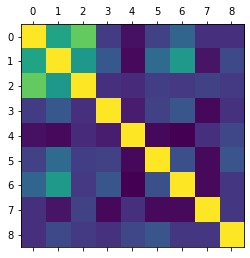

In [78]:
import matplotlib.pyplot as plt

plt.matshow(visualDf.corr())
plt.show()

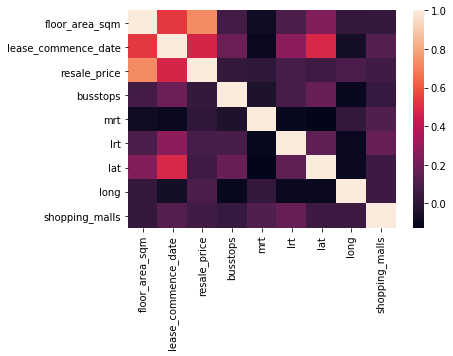

In [79]:
import seaborn as sns

corr = visualDf.corr()
sns.heatmap(corr, 
            xticklabels=corr.columns.values,
            yticklabels=corr.columns.values)

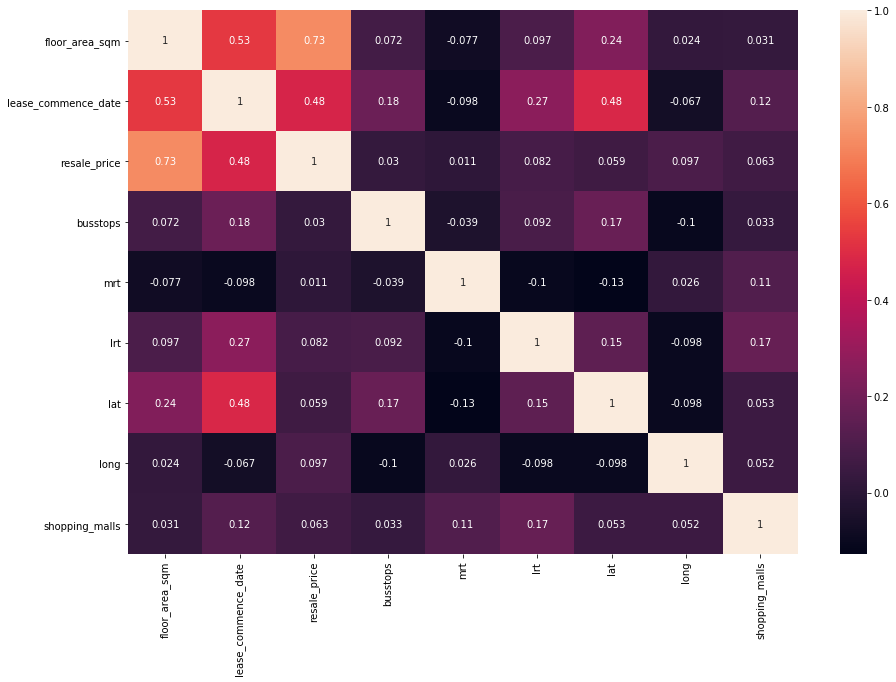

In [82]:
plt.figure(figsize=(15, 10))
sns.heatmap(visualDf.corr(), annot=True)